# 3) <u> ML Capstone: FOREX TS Forecasting - SkForecast - Boosted Trees </u>

<font color='blue'> Scripts by Kevin Jeswani
<br>
WeCloudData Bootcamp 2022 (Part-time Cohort)<br> </font>

The set of scripts in the folder 'FOREX_Forecasting_Scripts' are segmented for the purpose of clarity & convenience <br>
The following is the suggested order for running the scripts:
- '1_KJ_Forex_TS_Forecasting_DataGathering_Processing.ipynb' **This Script** - Gathering data from the EODHD API, inspecting, cleaning, merging the forex data
- '2_KJ_Forex_TS_Forecasting_EDA_VARMAX_Prophet.ipynb' - Exploratory data analysis (correlation), classical time series analysis (ACF/PACF) + VARMAX, Facebook Prophet
- '3_KJ_Forex_TS_Forecasting_SkForecast.ipynb' - Boosted tree  (XGB, LGBM, CatBoost, RandomForest ensemble) time series regression models, with backtesting/timeseries cross validation.
- '4_KJ_Forex_TS_Forecasting_LSTM.ipynb' - LSTM (RNNs) models.

Data is gathered from:
- The EOD Historical Data API: https://eodhistoricaldata.com/
- Unofficial Python SDK for EODHD: https://github.com/LautaroParada/eod-data
- OECD.Stats
<br>

## Standard Imports and General Settings

Steps to run SkForecast in Conda virtual environment: <br>
- Open CMD.exe prompt in conda navigator <br>
- create a conda environment: conda create --name skforecast python=3.8.5 <br>
- activate conda environment: conda activate skforecast <br>
- install pycaret: pip install pycaret <br>
- create notebook kernel: python -m ipykernel install --user --name skforecast --display-name "display-name"

In [667]:
import timeit #To time processes
from tqdm.notebook import tqdm #for status bar
import warnings
warnings.filterwarnings('ignore') #ignore warnings

# Data Processing
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn', override copywithsetting
import numpy as np
import csv
import time
import datetime # required for creating date-time arrays or unix time codes for EODHD intra-day
from textwrap import wrap #string processing

# Data Storage
import csv
from pandas import HDFStore

# Plotting
import matplotlib as mpl #Matplot lib
import matplotlib.pyplot as plt #pyplot
from mpl_toolkits.mplot3d import Axes3D #3d scatterplot
import matplotlib.dates as mdates
from matplotlib.colors import ListedColormap
import seaborn as sns #seaborn
sns.set() 

# Statistical Packages & Classical Models
import statsmodels.api as sm #general stats

# SkLearn - ML
import sklearn
from sklearn.ensemble import RandomForestRegressor
# Evaluation metrics
from sklearn.metrics import mean_absolute_error as MAE, mean_squared_error as MSE, r2_score

# SkForecast
import skforecast
from skforecast.ForecasterAutoreg import ForecasterAutoreg
from skforecast.ForecasterAutoregMultiOutput import ForecasterAutoregMultiOutput
from skforecast.model_selection import grid_search_forecaster, backtesting_forecaster
from skforecast.plot import plot_residuals

# BoostedTrees ML
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

In [3]:
root = r'C:\Users\kevin\Documents\WCD_Bootcamp\ML\ML_Capstone\Forex\Scripts'
root_raw = r'C:\Users\kevin\Documents\WCD_Bootcamp\ML\ML_Capstone\Forex\Scripts\Scraped_Data'
root_results = r'C:\Users\kevin\Documents\WCD_Bootcamp\ML\ML_Capstone\Forex\Scripts\Results'

In [62]:
# General pandas display otpions
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 20)
pd.set_option('display.min_rows', 10)

In [5]:
# Store ipynb session results 
#dill.dump_session('Forex_TimeSeries_6.db')
#dill.load_session('Forex_TimeSeries_1.db')

Generate currency lists

In [6]:
from itertools import combinations
currencies = ['EUR','USD','CAD','JPY','CHF','INR']
curr_pairs = ["".join(map(str, comb)) for comb in combinations(currencies, 2)] #Create currency pairs 
curr_pairs_alt = [wrap(c,3)[1]+wrap(c,3)[0] for c in curr_pairs] #alternative currency pair order as EOD has missing data
tickers = [c+'.FOREX' for c in curr_pairs]
tickers_alt = [c+'.FOREX' for c in curr_pairs_alt] #alternative order tickers

## Load Data

Merged daily ticker data with updated reduced technical indicators, etc.

In [40]:
fid=r'\DailyForex_Indicators_Reduced.pkl'
df_daily_red = pd.read_pickle(root_results+fid) 

# Machine Learning - Using SkForecast

Machine Learning will be carried out on 3 selected currency pairs **EUR-USD, EUR-JPY, and USD-JPY**, which exhibit high correlations with one-another and could be used to examine a trading strategy.

In [97]:
currs = ['EURUSD.FOREX','EURJPY.FOREX','USDJPY.FOREX'] #selected currency pairs
df_daily_3 = df_daily_red[df_daily_red['Ticker'].isin(currs)]

### General Train-Test-Holdout Split Setup

In [147]:
# Define the split dates
split1 = datetime.datetime.strptime('2022-05-01',"%Y-%m-%d")
split2 = datetime.datetime.strptime('2022-01-01',"%Y-%m-%d")

In [50]:
# Exogenous features available for model - only select technical indicators
exog_feats = ['rsi','adx','dmi','macd_norm','bbands_norm','sar_norm','ma_position','fastkline','fastdline','k_values','d_values','Sentiment_norm']

In [184]:
df_in = df_daily_3
ticker = currs[0]
startdate = df_in[df_in['Ticker']==ticker].index[0] #first day
full = df_in[(df_in['Ticker']==ticker)&(df_in.index >=startdate)] #full dataset
train = df_in[(df_in.index >=startdate)&(df_in.index <split1)&(df_in['Ticker']==ticker)] #train dataset
test = df_in[(df_in.index>=split1)&(df_in['Ticker']==ticker)]
# Can also save a hold-out validation set
# ...however for the remaining SkForecast steps they will just be grouped as one

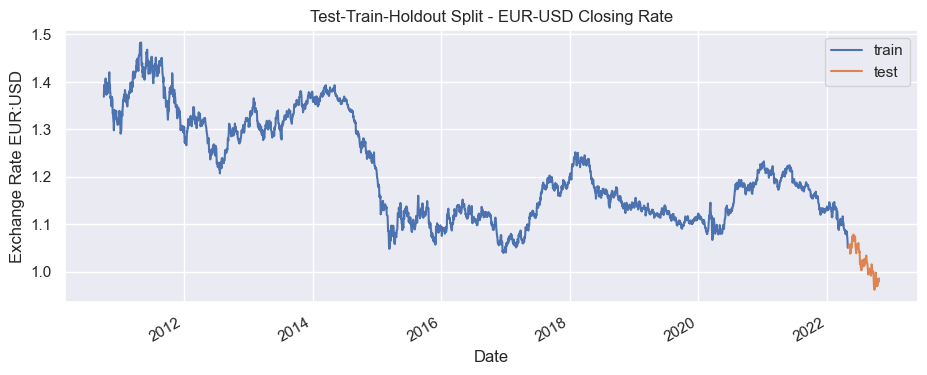

In [665]:
fig, ax = plt.subplots(figsize=(11, 4))
train['close'].plot(ax=ax, label='train')
test['close'].plot(ax=ax, label='test')
ax.set_title('Test-Train-Holdout Split - EUR-USD Closing Rate')
ax.legend();
ax.set_xlabel('Date',fontsize=12)
ax.set_ylabel('Exchange Rate EUR:USD',fontsize=12)
plt.savefig(root_results+fid, format='png', dpi=600,bbox_inches='tight')

## XGBoost - First Pass

In [92]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24)
forecaster

ForecasterAutoreg 
Regressor: XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=123, ...) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24] 
Transformer for y: None 
Transformer for exog: None 
Window size: 24 
Included exogenous: False 
Type of exogenous variable: None 
Exogenous variabl

In [76]:
exog = ['rsi','adx','dmi','macd_norm'] #reduced exogenous vars list

In [120]:
# Grid search of hyperparameters and lags
# ==============================================================================
# Regressor parameters for Grid Search
param_grid = {
    'n_estimators': [100, 500],
    'max_depth': [3, 5, 10],
    'learning_rate': [0.01, 0.1]
    }
# Lags grid = same lags used in ACF/PACF study
#lags_grid = [1,14,30,60,90,120,150,180,270,365,int(1.25*365),int(1.75*365),int(2*365),int(2.5*365),int(3*365)]
lags_grid = [1,14,30,60,120,270,365,int(1.5*365),int(2*365)]

#        exog               = train[exog],
results_grid = grid_search_forecaster(
        forecaster         = forecaster,
        y                  = train['close'].resample('1D').ffill(), # resample as daily, avoid silly error for apparently missing vals
        param_grid         = param_grid,
        lags_grid          = lags_grid, 
        steps              = 36, 
        refit              = True, #refit the model on each step
        metric             = 'mean_squared_error',
        initial_train_size = int(train.shape[0]), 
        fixed_train_size   = False, #Change the training size in each step if necessary
        return_best        = True,
        verbose            = False
        )

Number of models compared: 48.


loop lags_grid: 100%|██████████████████████████████████████| 4/4 [43:35<00:00, 653.90s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.00022899046580249186



In [138]:
results_grid

,lags,params,mean_squared_error,learning_rate,max_depth,n_estimators
32,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.000229,0.10,5.0,100.0
22,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 10, 'n_est...",0.000233,0.10,10.0,100.0
7,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",0.000237,0.10,3.0,500.0
42,"[1, 2, 3, 23, 24, 25, 71, 72, 73]","{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",0.000238,0.10,3.0,100.0
30,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",0.000240,0.10,3.0,100.0
...,...,...,...,...,...,...
14,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",0.082563,0.01,5.0,100.0
2,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",0.082563,0.01,5.0,100.0
4,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.01, 'max_depth': 10, 'n_es...",0.082563,0.01,10.0,100.0
38,"[1, 2, 3, 23, 24, 25, 71, 72, 73]","{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",0.082570,0.01,5.0,100.0


In [130]:
metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = train['close'].resample('1D').ffill(),
                            initial_train_size = int(train.shape[0]),
                            fixed_train_size   = False,
                            steps              = 36,
                            refit              = True,
                            metric             = 'mean_squared_error',
                            verbose            = False
                      )

In [169]:
importance = forecaster.get_feature_importance()

In [170]:
importance

,feature,importance
0,lag_1,0.220925
1,lag_2,0.017689
2,lag_3,0.000150
3,lag_4,0.000296
4,lag_5,0.000037
...,...,...
59,lag_60,0.000025
60,rsi,0.000210
61,adx,0.000063
62,dmi,0.000045


### Hyper-Parameter Grid Search with Cross-Validation

In [191]:
forecaster = ForecasterAutoreg(
                regressor = XGBRegressor(random_state=123),
                lags = 24) #lags here is a dummy - will be replaced by lags grid

In [192]:
exog = exog_feats #use all exogenous features

In [193]:
# Regressor parameters for Grid Search
param_grid = {
    'n_estimators': [50, 100, 500],
    'max_depth': [3, 5, 7, 10],
    'learning_rate': [0.01, 0.05 0.1]
    }
# Lags grid = same lags used in ACF/PACF study
lags_grid = [7,14,30,60,180,365]

# Grid Search (cross-validation by dfault)
results_grid = grid_search_forecaster(
        forecaster         = forecaster,
        y                  = train['close'].resample('1D').ffill(), # resample as daily, avoid silly error for apparently missing vals
        exog               = train[exog].resample('1D').ffill(), 
        param_grid         = param_grid,
        lags_grid          = lags_grid, 
        steps              = test.shape[0], #number of forward steps to forecast
        refit              = True, #refit the model on each step of backtesting
        metric             = 'mean_absolute_percentage_error',
        initial_train_size = int(train.shape[0]), # number of samples in initial train split > window_size
        fixed_train_size   = True, #Use a TS with rolling origin with refit - window size will not change
        return_best        = True,
        verbose            = False
        )

Number of models compared: 96.


loop lags_grid: 100%|██████████████████████████████████████| 6/6 [21:21<00:00, 213.58s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
  Backtesting metric: 0.015590365017447923



In [214]:
results_grid

,lags,params,mean_absolute_percentage_error,learning_rate,max_depth,n_estimators
57,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",0.015590,0.10,3.0,100.0
59,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.016412,0.10,5.0,100.0
27,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.016550,0.10,5.0,100.0
25,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",0.016894,0.10,3.0,100.0
41,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'learning_rate': 0.1, 'max_depth': 3, 'n_esti...",0.016992,0.10,3.0,100.0
...,...,...,...,...,...,...
22,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14]","{'learning_rate': 0.01, 'max_depth': 10, 'n_es...",0.358233,0.01,10.0,50.0
6,"[1, 2, 3, 4, 5, 6, 7]","{'learning_rate': 0.01, 'max_depth': 10, 'n_es...",0.358288,0.01,10.0,50.0
2,"[1, 2, 3, 4, 5, 6, 7]","{'learning_rate': 0.01, 'max_depth': 5, 'n_est...",0.358288,0.01,5.0,50.0
4,"[1, 2, 3, 4, 5, 6, 7]","{'learning_rate': 0.01, 'max_depth': 7, 'n_est...",0.358288,0.01,7.0,50.0


In [235]:
forecaster.fit(y=train['close'].resample('1D').ffill(),exog=train[exog].resample('1D').ffill())

In [237]:
predictions_best = forecaster.predict(test['close'].shape[0], exog=test[exog].resample('1D').ffill())

In [230]:
metric, predictions = backtesting_forecaster(
                            forecaster         = forecaster,
                            y                  = train['close'].resample('1D').ffill(),
                            initial_train_size = int(train.shape[0]/4),
                            fixed_train_size   = False,
                            steps              = int(full.shape[0]),
                            refit              = True,
                            metric             = 'mean_absolute_percentage_error',
                            verbose            = True
                      )

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 2
    Number of steps per fold: 3178
    Last fold only includes 288 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2021-07-15 00:00:00  (n=3178)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2021-07-15 00:00:00  (n=3938)
    Validation: 2021-07-16 00:00:00 -- 2022-04-29 00:00:00  (n=288)



In [231]:
print('MAPE is ',metric)

MAPE is  0.11131244001638563


In [232]:
predictions

,pred
2012-11-02,1.294714
2012-11-03,1.293477
2012-11-04,1.293744
2012-11-05,1.293946
2012-11-06,1.292963
...,...
2022-04-25,1.177462
2022-04-26,1.177239
2022-04-27,1.175802
2022-04-28,1.178334


In [229]:
importance = forecaster.get_feature_importance()
importance

,feature,importance
0,lag_1,0.863143
1,lag_2,0.064498
2,lag_3,0.022142
3,rsi,0.007377
4,adx,0.002103
5,dmi,0.005889
6,macd_norm,0.003751
7,bbands_norm,0.004386
8,sar_norm,0.003056
9,ma_position,0.000082


## Random Forest vs  LGBMRegressor vs CatBoost vs XGBoost

In [254]:
# Define the split dates
split1 = datetime.datetime.strptime('2022-05-01',"%Y-%m-%d") - only test & train
#start_date = datetime.datetime.strptime('2010-10-02',"%Y-%m-%d") #move up first day to account for differenced first day of series

In [192]:
exog = exog_feats #use all the available exogenous features

In [255]:
df_in = df_daily_3
ticker = currs[0]
startdate = df_in[df_in['Ticker']==ticker].index[0] #first day
full = df_in[(df_in['Ticker']==ticker)&(df_in.index >=startdate)] #full dataset
train = df_in[(df_in.index >=startdate)&(df_in.index <split1)&(df_in['Ticker']==ticker)] #train dataset
test = df_in[(df_in.index>=split1)&(df_in['Ticker']==ticker)]
#test = df_in[(df_in.index>=split2)&(df_in.index<split1)&(df_in['Ticker']==ticker)]  #test dataset
#holdout = df_in[(df_in.index>=split1)&(df_in['Ticker']==ticker)]  #test dataset

In [274]:
# Models to compare
# ==============================================================================
metrics = [MSE, MAE, r2_score]

models = [XGBRegressor(random_state=123),
          RandomForestRegressor(random_state=123), 
          LGBMRegressor(random_state=123),
          CatBoostRegressor(random_state=123),
         ]

# param_grid for each model
param_grids = {'XGBRegressor':{'n_estimators': [50, 100, 500],'max_depth': [3, 5, 7, 10],'learning_rate': [0.01, 0.1]},
               'RandomForestRegressor': {'n_estimators': [50, 100, 500], 'max_depth': [3, 5, 7, 10]},
               'LGBMRegressor': {'n_estimators': [50, 100, 500], 'max_depth': [3, 5, 7, 10],'learning_rate': [0.01, 0.1]},
               'Cat': {'n_estimators': [50, 100, 500], 'max_depth': [3, 5, 7, 10],'learning_rate': [0.01, 0.1]}}

# Lags grid = similar lags used in ACF/PACF study
lags_grid = [[7,14,30],[60,180,270],[30,60,365]]

df_results = pd.DataFrame()
models_best = {} #store all the best models
for i, model in enumerate(models):
    print(f"Grid search for regressor: {model}")
    print(f"-------------------------")

    #initialize the forecaster 
    forecaster = ForecasterAutoreg(
                     regressor = model,
                     lags      = 3 #dummy
                 )

    # Regressor hyperparameters
    param_grid = param_grids[list(param_grids)[i]]
    
    # Grid Search (cross-validation by default)
    results_grid = grid_search_forecaster(
            forecaster         = forecaster,
            y                  = train['close+7d'].resample('1D').ffill(), # resample as daily, avoid silly error for apparently missing vals
            exog               = train[exog].resample('1D').ffill(), 
            param_grid         = param_grid,
            lags_grid          = lags_grid, 
            steps              = test.shape[0], #number of forward steps to forecast
            refit              = True, #refit the model on each step of backtesting
            metric             = metrics,
            initial_train_size = int(train.shape[0]/4), # number of samples in initial train split > window_size
            fixed_train_size   = True, #Use a TS with rolling origin with refit - window size will not change
            return_best        = True,
            verbose            = True
            )
    
    # Create a column with model name
    results_grid['model'] = list(param_grids)[i]
    models_best[model] = forecaster
    df_results = pd.concat([df_results, results_grid])

Grid search for regressor: XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=123, ...)
-------------------------
Number of models compared: 72.


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   4%|█▌                                   | 1/24 [00:10<03:56, 10.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 2/24 [00:22<04:14, 11.58s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  12%|████▋                                | 3/24 [00:43<05:33, 15.87s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 4/24 [00:53<04:32, 13.61s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  21%|███████▋                             | 5/24 [01:06<04:09, 13.11s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 6/24 [01:27<04:48, 16.05s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  29%|██████████▊                          | 7/24 [01:38<04:02, 14.27s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 8/24 [01:49<03:31, 13.24s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  38%|█████████████▉                       | 9/24 [02:10<03:56, 15.75s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████                     | 10/24 [02:21<03:16, 14.07s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  46%|████████████████▌                   | 11/24 [02:32<02:51, 13.21s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████                  | 12/24 [02:54<03:12, 16.05s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  54%|███████████████████▌                | 13/24 [03:05<02:38, 14.40s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████               | 14/24 [03:17<02:15, 13.54s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  62%|██████████████████████▌             | 15/24 [03:34<02:13, 14.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████            | 16/24 [03:45<01:48, 13.54s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  71%|█████████████████████████▌          | 17/24 [03:57<01:32, 13.16s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████         | 18/24 [04:14<01:26, 14.40s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  79%|████████████████████████████▌       | 19/24 [04:25<01:06, 13.35s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 20/24 [04:38<00:52, 13.09s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [04:55<00:42, 14.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 22/24 [05:06<00:26, 13.33s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [05:19<00:13, 13.21s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   4%|█▌                                   | 1/24 [00:10<03:55, 10.22s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 2/24 [00:21<03:52, 10.59s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  12%|████▋                                | 3/24 [00:39<04:55, 14.09s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 4/24 [00:49<04:14, 12.73s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  21%|███████▋                             | 5/24 [01:02<04:00, 12.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 6/24 [01:22<04:30, 15.02s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  29%|██████████▊                          | 7/24 [01:31<03:45, 13.29s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 8/24 [01:42<03:17, 12.34s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  38%|█████████████▉                       | 9/24 [02:00<03:33, 14.20s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████                     | 10/24 [02:10<02:59, 12.81s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  46%|████████████████▌                   | 11/24 [02:20<02:36, 12.04s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████                  | 12/24 [02:39<02:49, 14.16s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  54%|███████████████████▌                | 13/24 [02:49<02:21, 12.85s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████               | 14/24 [02:59<02:01, 12.14s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  62%|██████████████████████▌             | 15/24 [03:15<01:58, 13.13s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████            | 16/24 [03:25<01:37, 12.20s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  71%|█████████████████████████▌          | 17/24 [03:36<01:22, 11.84s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████         | 18/24 [03:51<01:17, 12.87s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  79%|████████████████████████████▌       | 19/24 [04:01<01:00, 12.04s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 20/24 [04:12<00:47, 11.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [04:27<00:38, 12.74s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 22/24 [04:37<00:23, 11.94s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [04:49<00:11, 11.75s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   4%|█▌                                   | 1/24 [00:09<03:39,  9.56s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 2/24 [00:19<03:37,  9.88s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  12%|████▋                                | 3/24 [00:34<04:18, 12.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 4/24 [00:44<03:43, 11.18s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  21%|███████▋                             | 5/24 [00:54<03:25, 10.82s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 6/24 [01:10<03:47, 12.65s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  29%|██████████▊                          | 7/24 [01:20<03:18, 11.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 8/24 [01:30<02:58, 11.15s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  38%|█████████████▉                       | 9/24 [01:47<03:13, 12.93s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████                     | 10/24 [01:56<02:46, 11.87s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  46%|████████████████▌                   | 11/24 [02:06<02:27, 11.36s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████                  | 12/24 [02:24<02:37, 13.15s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  54%|███████████████████▌                | 13/24 [02:33<02:13, 12.10s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████               | 14/24 [02:44<01:55, 11.59s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  62%|██████████████████████▌             | 15/24 [02:58<01:52, 12.46s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████            | 16/24 [03:08<01:33, 11.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  71%|█████████████████████████▌          | 17/24 [03:19<01:19, 11.41s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████         | 18/24 [03:33<01:13, 12.27s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  79%|████████████████████████████▌       | 19/24 [03:43<00:57, 11.56s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 20/24 [03:54<00:45, 11.38s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [04:09<00:36, 12.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 22/24 [04:19<00:23, 11.63s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [04:30<00:11, 11.44s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop lags_grid: 100%|██████████████████████████████████████| 3/3 [15:25<00:00, 308.64s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 7 14 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 100}
  Backtesting metric: 0.0011360517970329335

Grid search for regressor: RandomForestRegressor(random_state=123)
-------------------------
Number of models compared: 36.


loop param_grid:   0%|                                             | 0/12 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 1/12 [00:16<03:05, 16.82s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 2/12 [00:48<04:16, 25.64s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 3/12 [03:20<12:30, 83.42s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 4/12 [03:37<07:38, 57.26s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████▍                     | 5/12 [04:11<05:40, 48.67s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████▌                  | 6/12 [06:51<08:38, 86.39s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████▌               | 7/12 [07:09<05:20, 64.12s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████▋            | 8/12 [07:43<03:38, 54.63s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████▊         | 9/12 [10:41<04:39, 93.21s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 10/12 [11:00<02:20, 70.31s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 11/12 [11:43<01:01, 61.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   0%|                                             | 0/12 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 1/12 [00:19<03:36, 19.65s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 2/12 [00:53<04:42, 28.26s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 3/12 [03:22<12:27, 83.06s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 4/12 [03:38<07:33, 56.64s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████▍                     | 5/12 [04:09<05:32, 47.57s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████▌                  | 6/12 [06:44<08:23, 84.00s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████▌               | 7/12 [07:01<05:10, 62.07s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████▋            | 8/12 [07:34<03:31, 52.77s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████▊         | 9/12 [10:13<04:17, 85.97s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 10/12 [10:30<02:09, 64.79s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 11/12 [11:04<00:55, 55.42s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   0%|                                             | 0/12 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 1/12 [00:15<02:52, 15.69s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 2/12 [00:45<04:01, 24.18s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 3/12 [03:10<11:54, 79.38s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 4/12 [03:26<07:14, 54.37s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████▍                     | 5/12 [03:57<05:21, 45.88s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████▌                  | 6/12 [06:26<08:05, 80.89s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████▌               | 7/12 [06:43<04:59, 59.84s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████▋            | 8/12 [07:15<03:23, 50.96s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████▊         | 9/12 [09:48<04:08, 82.92s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 10/12 [10:05<02:05, 62.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 11/12 [10:38<00:53, 53.43s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop lags_grid: 100%|██████████████████████████████████████| 3/3 [41:54<00:00, 838.32s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 7 14 30] 
  Parameters: {'max_depth': 10, 'n_estimators': 50}
  Backtesting metric: 0.0013691655187247952

Grid search for regressor: LGBMRegressor(random_state=123)
-------------------------
Number of models compared: 72.


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   4%|█▌                                   | 1/24 [00:02<00:46,  2.04s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 2/24 [00:04<00:50,  2.29s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  12%|████▋                                | 3/24 [00:09<01:11,  3.42s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 4/24 [00:11<01:00,  3.04s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  21%|███████▋                             | 5/24 [00:14<00:59,  3.12s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 6/24 [00:23<01:31,  5.10s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  29%|██████████▊                          | 7/24 [00:26<01:12,  4.26s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 8/24 [00:29<01:03,  3.98s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  38%|█████████████▉                       | 9/24 [00:41<01:34,  6.33s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████                     | 10/24 [00:43<01:12,  5.18s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  46%|████████████████▌                   | 11/24 [00:47<01:00,  4.64s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████                  | 12/24 [01:00<01:24,  7.08s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  54%|███████████████████▌                | 13/24 [01:01<01:00,  5.52s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████               | 14/24 [01:04<00:45,  4.53s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  62%|██████████████████████▌             | 15/24 [01:09<00:42,  4.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████            | 16/24 [01:11<00:31,  3.96s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  71%|█████████████████████████▌          | 17/24 [01:14<00:25,  3.58s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████         | 18/24 [01:20<00:27,  4.51s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  79%|████████████████████████████▌       | 19/24 [01:23<00:19,  3.97s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 20/24 [01:26<00:15,  3.76s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [01:34<00:14,  4.92s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 22/24 [01:37<00:08,  4.25s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [01:41<00:04,  4.14s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   4%|█▌                                   | 1/24 [00:01<00:41,  1.81s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 2/24 [00:04<00:45,  2.07s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  12%|████▋                                | 3/24 [00:08<01:09,  3.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 4/24 [00:10<00:56,  2.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  21%|███████▋                             | 5/24 [00:13<00:51,  2.70s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 6/24 [00:19<01:11,  3.99s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  29%|██████████▊                          | 7/24 [00:22<00:59,  3.47s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 8/24 [00:25<00:53,  3.32s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  38%|█████████████▉                       | 9/24 [00:32<01:08,  4.54s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████                     | 10/24 [00:34<00:54,  3.87s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  46%|████████████████▌                   | 11/24 [00:38<00:48,  3.70s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████                  | 12/24 [00:46<00:59,  4.97s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  54%|███████████████████▌                | 13/24 [00:47<00:44,  4.01s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████               | 14/24 [00:49<00:34,  3.42s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  62%|██████████████████████▌             | 15/24 [00:54<00:35,  3.89s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████            | 16/24 [00:56<00:26,  3.34s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  71%|█████████████████████████▌          | 17/24 [00:59<00:21,  3.05s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████         | 18/24 [01:04<00:22,  3.72s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  79%|████████████████████████████▌       | 19/24 [01:06<00:16,  3.25s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 20/24 [01:09<00:12,  3.14s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [01:16<00:12,  4.19s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 22/24 [01:18<00:07,  3.58s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [01:21<00:03,  3.33s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   4%|█▌                                   | 1/24 [00:01<00:39,  1.74s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:   8%|███                                  | 2/24 [00:03<00:41,  1.88s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  12%|████▋                                | 3/24 [00:07<01:01,  2.93s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  17%|██████▏                              | 4/24 [00:10<00:53,  2.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  21%|███████▋                             | 5/24 [00:12<00:51,  2.73s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  25%|█████████▎                           | 6/24 [00:18<01:06,  3.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  29%|██████████▊                          | 7/24 [00:20<00:53,  3.14s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  33%|████████████▎                        | 8/24 [00:23<00:46,  2.92s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  38%|█████████████▉                       | 9/24 [00:30<01:04,  4.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  42%|███████████████                     | 10/24 [00:32<00:50,  3.59s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  46%|████████████████▌                   | 11/24 [00:34<00:42,  3.25s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  50%|██████████████████                  | 12/24 [00:41<00:51,  4.26s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  54%|███████████████████▌                | 13/24 [00:43<00:38,  3.51s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  58%|█████████████████████               | 14/24 [00:45<00:30,  3.09s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  62%|██████████████████████▌             | 15/24 [00:49<00:29,  3.31s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  67%|████████████████████████            | 16/24 [00:51<00:23,  2.90s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  71%|█████████████████████████▌          | 17/24 [00:53<00:18,  2.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  75%|███████████████████████████         | 18/24 [00:58<00:20,  3.49s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  79%|████████████████████████████▌       | 19/24 [01:00<00:15,  3.09s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  83%|██████████████████████████████      | 20/24 [01:03<00:11,  2.92s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [01:09<00:11,  3.75s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  92%|█████████████████████████████████   | 22/24 [01:10<00:06,  3.22s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [01:13<00:03,  3.07s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2


loop lags_grid: 100%|███████████████████████████████████████| 3/3 [04:41<00:00, 93.70s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 7 14 30] 
  Parameters: {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 500}
  Backtesting metric: 0.0011342767240488042

Grid search for regressor: <catboost.core.CatBoostRegressor object at 0x000001C9F117F700>
-------------------------
Number of models compared: 72.


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

31:	learn: 0.0513874	total: 26.7ms	remaining: 15ms
32:	learn: 0.0509820	total: 27.7ms	remaining: 14.3ms
33:	learn: 0.0505682	total: 28.7ms	remaining: 13.5ms
34:	learn: 0.0501981	total: 29.6ms	remaining: 12.7ms
35:	learn: 0.0497728	total: 30.4ms	remaining: 11.8ms
36:	learn: 0.0493653	total: 31.2ms	remaining: 11ms
37:	learn: 0.0489837	total: 32ms	remaining: 10.1ms
38:	learn: 0.0485959	total: 32.8ms	remaining: 9.26ms
39:	learn: 0.0482183	total: 33.6ms	remaining: 8.4ms
40:	learn: 0.0478298	total: 34.4ms	remaining: 7.55ms
41:	learn: 0.0474596	total: 35.2ms	remaining: 6.71ms
42:	learn: 0.0471247	total: 36ms	remaining: 5.86ms
43:	learn: 0.0467558	total: 36.8ms	remaining: 5.02ms
44:	learn: 0.0463983	total: 37.6ms	remaining: 4.18ms
45:	learn: 0.0460350	total: 38.3ms	remaining: 3.33ms
46:	learn: 0.0456787	total: 39.1ms	remaining: 2.49ms
47:	learn: 0.0453445	total: 39.7ms	remaining: 1.65ms
48:	learn: 0.0449896	total: 40.4ms	remaining: 824us
49:	learn: 0.0446925	total: 41.1ms	remaining: 0us
0:	lea

0:	learn: 0.0316327	total: 824us	remaining: 40.4ms
1:	learn: 0.0313868	total: 1.72ms	remaining: 41.4ms
2:	learn: 0.0311605	total: 2.45ms	remaining: 38.4ms
3:	learn: 0.0309181	total: 3.17ms	remaining: 36.5ms
4:	learn: 0.0306632	total: 3.83ms	remaining: 34.5ms
5:	learn: 0.0304454	total: 4.49ms	remaining: 32.9ms
6:	learn: 0.0302190	total: 5.14ms	remaining: 31.6ms
7:	learn: 0.0299807	total: 5.82ms	remaining: 30.6ms
8:	learn: 0.0297583	total: 6.54ms	remaining: 29.8ms
9:	learn: 0.0295425	total: 7.18ms	remaining: 28.7ms
10:	learn: 0.0293341	total: 7.87ms	remaining: 27.9ms
11:	learn: 0.0291348	total: 8.52ms	remaining: 27ms
12:	learn: 0.0289228	total: 9.15ms	remaining: 26.1ms
13:	learn: 0.0287178	total: 9.85ms	remaining: 25.3ms
14:	learn: 0.0285187	total: 10.5ms	remaining: 24.6ms
15:	learn: 0.0283143	total: 11.2ms	remaining: 23.8ms
16:	learn: 0.0280971	total: 11.9ms	remaining: 23ms
17:	learn: 0.0278780	total: 12.5ms	remaining: 22.3ms
18:	learn: 0.0276855	total: 13.3ms	remaining: 21.6ms
19:	lear

0:	learn: 0.1120821	total: 833us	remaining: 40.9ms
1:	learn: 0.1110676	total: 1.71ms	remaining: 41.1ms
2:	learn: 0.1101464	total: 2.37ms	remaining: 37.1ms
3:	learn: 0.1092528	total: 3.03ms	remaining: 34.8ms
4:	learn: 0.1083235	total: 3.68ms	remaining: 33.1ms
5:	learn: 0.1074134	total: 4.32ms	remaining: 31.7ms
6:	learn: 0.1064833	total: 4.97ms	remaining: 30.5ms
7:	learn: 0.1055020	total: 5.58ms	remaining: 29.3ms
8:	learn: 0.1046662	total: 6.23ms	remaining: 28.4ms
9:	learn: 0.1037768	total: 6.96ms	remaining: 27.9ms
10:	learn: 0.1028531	total: 7.62ms	remaining: 27ms
11:	learn: 0.1019393	total: 8.19ms	remaining: 25.9ms
12:	learn: 0.1010969	total: 8.8ms	remaining: 25ms
13:	learn: 0.1002170	total: 9.46ms	remaining: 24.3ms
14:	learn: 0.0992937	total: 10.1ms	remaining: 23.5ms
15:	learn: 0.0984842	total: 10.7ms	remaining: 22.8ms
16:	learn: 0.0976405	total: 11.4ms	remaining: 22.1ms
17:	learn: 0.0967612	total: 12.1ms	remaining: 21.5ms
18:	learn: 0.0958994	total: 12.7ms	remaining: 20.8ms
19:	learn

0:	learn: 0.0310834	total: 810us	remaining: 39.7ms
1:	learn: 0.0308788	total: 1.73ms	remaining: 41.4ms
2:	learn: 0.0306849	total: 2.43ms	remaining: 38ms
3:	learn: 0.0304787	total: 3.12ms	remaining: 35.8ms
4:	learn: 0.0302673	total: 3.78ms	remaining: 34ms
5:	learn: 0.0300850	total: 4.43ms	remaining: 32.5ms
6:	learn: 0.0298992	total: 5.08ms	remaining: 31.2ms
7:	learn: 0.0296843	total: 5.79ms	remaining: 30.4ms
8:	learn: 0.0294976	total: 6.5ms	remaining: 29.6ms
9:	learn: 0.0292950	total: 7.16ms	remaining: 28.7ms
10:	learn: 0.0290977	total: 7.81ms	remaining: 27.7ms
11:	learn: 0.0288877	total: 8.55ms	remaining: 27.1ms
12:	learn: 0.0286848	total: 9.19ms	remaining: 26.2ms
13:	learn: 0.0284775	total: 9.84ms	remaining: 25.3ms
14:	learn: 0.0282903	total: 10.5ms	remaining: 24.5ms
15:	learn: 0.0280914	total: 11.1ms	remaining: 23.6ms
16:	learn: 0.0279032	total: 11.8ms	remaining: 22.9ms
17:	learn: 0.0277188	total: 12.5ms	remaining: 22.3ms
18:	learn: 0.0275500	total: 13.2ms	remaining: 21.6ms
19:	learn

0:	learn: 0.0457809	total: 839us	remaining: 41.1ms
1:	learn: 0.0453948	total: 1.78ms	remaining: 42.7ms
2:	learn: 0.0450871	total: 2.42ms	remaining: 37.9ms
3:	learn: 0.0447566	total: 3.12ms	remaining: 35.9ms
4:	learn: 0.0443738	total: 3.79ms	remaining: 34.1ms
5:	learn: 0.0440432	total: 4.46ms	remaining: 32.7ms
6:	learn: 0.0437015	total: 5.1ms	remaining: 31.3ms
7:	learn: 0.0433308	total: 5.73ms	remaining: 30.1ms
8:	learn: 0.0430421	total: 6.45ms	remaining: 29.4ms
9:	learn: 0.0427123	total: 7.13ms	remaining: 28.5ms
10:	learn: 0.0423729	total: 7.82ms	remaining: 27.7ms
11:	learn: 0.0420662	total: 8.42ms	remaining: 26.7ms
12:	learn: 0.0417199	total: 9.08ms	remaining: 25.9ms
13:	learn: 0.0413762	total: 9.76ms	remaining: 25.1ms
14:	learn: 0.0410789	total: 10.4ms	remaining: 24.3ms
15:	learn: 0.0407821	total: 11.1ms	remaining: 23.6ms
16:	learn: 0.0404322	total: 11.8ms	remaining: 22.9ms
17:	learn: 0.0400812	total: 12.5ms	remaining: 22.2ms
18:	learn: 0.0397917	total: 13.1ms	remaining: 21.4ms
19:	l

0:	learn: 0.0222321	total: 995us	remaining: 48.8ms
1:	learn: 0.0220911	total: 1.89ms	remaining: 45.5ms
2:	learn: 0.0219496	total: 2.54ms	remaining: 39.8ms
3:	learn: 0.0217997	total: 3.2ms	remaining: 36.8ms
4:	learn: 0.0216624	total: 3.88ms	remaining: 34.9ms
5:	learn: 0.0215327	total: 4.53ms	remaining: 33.2ms
6:	learn: 0.0213826	total: 5.19ms	remaining: 31.9ms
7:	learn: 0.0212469	total: 5.88ms	remaining: 30.8ms
8:	learn: 0.0211009	total: 6.52ms	remaining: 29.7ms
9:	learn: 0.0209658	total: 7.23ms	remaining: 28.9ms
10:	learn: 0.0208368	total: 7.87ms	remaining: 27.9ms
11:	learn: 0.0207116	total: 8.54ms	remaining: 27ms
12:	learn: 0.0205708	total: 9.21ms	remaining: 26.2ms
13:	learn: 0.0204336	total: 9.78ms	remaining: 25.2ms
14:	learn: 0.0202900	total: 10.4ms	remaining: 24.4ms
15:	learn: 0.0201462	total: 11.1ms	remaining: 23.6ms
16:	learn: 0.0200112	total: 11.8ms	remaining: 22.8ms
17:	learn: 0.0199022	total: 12.4ms	remaining: 22.1ms
18:	learn: 0.0197861	total: 13.1ms	remaining: 21.3ms
19:	lea


loop param_grid:   4%|█▌                                   | 1/24 [00:05<02:09,  5.64s/it]

0:	learn: 0.0413487	total: 827us	remaining: 40.6ms
1:	learn: 0.0410172	total: 1.74ms	remaining: 41.7ms
2:	learn: 0.0407068	total: 2.44ms	remaining: 38.2ms
3:	learn: 0.0403972	total: 3.08ms	remaining: 35.4ms
4:	learn: 0.0400796	total: 3.72ms	remaining: 33.5ms
5:	learn: 0.0397834	total: 4.34ms	remaining: 31.9ms
6:	learn: 0.0394818	total: 5ms	remaining: 30.7ms
7:	learn: 0.0391940	total: 5.64ms	remaining: 29.6ms
8:	learn: 0.0388782	total: 6.29ms	remaining: 28.6ms
9:	learn: 0.0385592	total: 6.96ms	remaining: 27.9ms
10:	learn: 0.0382692	total: 7.66ms	remaining: 27.2ms
11:	learn: 0.0379935	total: 8.41ms	remaining: 26.6ms
12:	learn: 0.0376898	total: 9.08ms	remaining: 25.9ms
13:	learn: 0.0373826	total: 9.75ms	remaining: 25.1ms
14:	learn: 0.0370828	total: 10.4ms	remaining: 24.3ms
15:	learn: 0.0368098	total: 11.1ms	remaining: 23.6ms
16:	learn: 0.0365119	total: 11.8ms	remaining: 22.8ms
17:	learn: 0.0362457	total: 12.4ms	remaining: 22.1ms
18:	learn: 0.0359731	total: 13.1ms	remaining: 21.3ms
19:	lea

40:	learn: 0.0484261	total: 28.1ms	remaining: 40.4ms
41:	learn: 0.0480638	total: 29.2ms	remaining: 40.3ms
42:	learn: 0.0477030	total: 30.1ms	remaining: 39.8ms
43:	learn: 0.0473822	total: 30.9ms	remaining: 39.3ms
44:	learn: 0.0470238	total: 31.7ms	remaining: 38.7ms
45:	learn: 0.0466661	total: 32.3ms	remaining: 37.9ms
46:	learn: 0.0463094	total: 33.1ms	remaining: 37.3ms
47:	learn: 0.0459874	total: 33.8ms	remaining: 36.6ms
48:	learn: 0.0456305	total: 34.6ms	remaining: 36ms
49:	learn: 0.0453349	total: 35.3ms	remaining: 35.3ms
50:	learn: 0.0450237	total: 35.9ms	remaining: 34.5ms
51:	learn: 0.0446888	total: 36.5ms	remaining: 33.7ms
52:	learn: 0.0444462	total: 37.2ms	remaining: 33ms
53:	learn: 0.0441163	total: 37.8ms	remaining: 32.2ms
54:	learn: 0.0437965	total: 38.5ms	remaining: 31.5ms
55:	learn: 0.0434760	total: 39.1ms	remaining: 30.8ms
56:	learn: 0.0431508	total: 39.8ms	remaining: 30ms
57:	learn: 0.0428284	total: 40.5ms	remaining: 29.3ms
58:	learn: 0.0425184	total: 41.1ms	remaining: 28.6ms

0:	learn: 0.0459437	total: 975us	remaining: 96.5ms
1:	learn: 0.0456330	total: 1.87ms	remaining: 91.7ms
2:	learn: 0.0453330	total: 2.56ms	remaining: 82.8ms
3:	learn: 0.0450245	total: 3.24ms	remaining: 77.7ms
4:	learn: 0.0447006	total: 3.86ms	remaining: 73.4ms
5:	learn: 0.0443772	total: 4.5ms	remaining: 70.5ms
6:	learn: 0.0441045	total: 5.15ms	remaining: 68.4ms
7:	learn: 0.0437829	total: 5.79ms	remaining: 66.6ms
8:	learn: 0.0435077	total: 6.47ms	remaining: 65.4ms
9:	learn: 0.0432355	total: 7.12ms	remaining: 64.1ms
10:	learn: 0.0429470	total: 7.8ms	remaining: 63.1ms
11:	learn: 0.0426503	total: 8.46ms	remaining: 62ms
12:	learn: 0.0423291	total: 9.09ms	remaining: 60.9ms
13:	learn: 0.0420574	total: 9.8ms	remaining: 60.2ms
14:	learn: 0.0417812	total: 10.6ms	remaining: 59.8ms
15:	learn: 0.0414933	total: 11.2ms	remaining: 58.9ms
16:	learn: 0.0411971	total: 11.9ms	remaining: 58.1ms
17:	learn: 0.0409251	total: 12.6ms	remaining: 57.2ms
18:	learn: 0.0406653	total: 13.3ms	remaining: 56.5ms
19:	learn

0:	learn: 0.0430644	total: 961us	remaining: 95.2ms
1:	learn: 0.0427745	total: 1.96ms	remaining: 96.2ms
2:	learn: 0.0425029	total: 2.61ms	remaining: 84.4ms
3:	learn: 0.0421661	total: 3.27ms	remaining: 78.6ms
4:	learn: 0.0418368	total: 4ms	remaining: 76ms
5:	learn: 0.0415366	total: 4.68ms	remaining: 73.4ms
6:	learn: 0.0412412	total: 5.38ms	remaining: 71.4ms
7:	learn: 0.0409217	total: 6.09ms	remaining: 70ms
8:	learn: 0.0405964	total: 6.78ms	remaining: 68.5ms
9:	learn: 0.0402993	total: 7.42ms	remaining: 66.8ms
10:	learn: 0.0399860	total: 8.09ms	remaining: 65.5ms
11:	learn: 0.0396884	total: 8.78ms	remaining: 64.4ms
12:	learn: 0.0393794	total: 9.49ms	remaining: 63.5ms
13:	learn: 0.0390820	total: 10.2ms	remaining: 62.7ms
14:	learn: 0.0388143	total: 10.8ms	remaining: 61.4ms
15:	learn: 0.0385160	total: 11.5ms	remaining: 60.5ms
16:	learn: 0.0382089	total: 12.2ms	remaining: 59.5ms
17:	learn: 0.0379202	total: 12.9ms	remaining: 58.9ms
18:	learn: 0.0376688	total: 13.6ms	remaining: 58ms
19:	learn: 0.

0:	learn: 0.0484568	total: 855us	remaining: 84.7ms
1:	learn: 0.0481085	total: 1.86ms	remaining: 91.1ms
2:	learn: 0.0477242	total: 2.54ms	remaining: 82.3ms
3:	learn: 0.0473723	total: 3.25ms	remaining: 77.9ms
4:	learn: 0.0469965	total: 3.91ms	remaining: 74.3ms
5:	learn: 0.0466428	total: 4.54ms	remaining: 71.1ms
6:	learn: 0.0462858	total: 5.28ms	remaining: 70.2ms
7:	learn: 0.0459249	total: 6.1ms	remaining: 70.1ms
8:	learn: 0.0455650	total: 6.89ms	remaining: 69.6ms
9:	learn: 0.0451922	total: 7.66ms	remaining: 69ms
10:	learn: 0.0448335	total: 8.38ms	remaining: 67.8ms
11:	learn: 0.0445078	total: 9.08ms	remaining: 66.6ms
12:	learn: 0.0441653	total: 9.7ms	remaining: 64.9ms
13:	learn: 0.0438089	total: 10.4ms	remaining: 64.1ms
14:	learn: 0.0434608	total: 11.2ms	remaining: 63.2ms
15:	learn: 0.0431189	total: 11.8ms	remaining: 62ms
16:	learn: 0.0427787	total: 12.5ms	remaining: 60.9ms
17:	learn: 0.0424568	total: 13.1ms	remaining: 59.6ms
18:	learn: 0.0421500	total: 13.9ms	remaining: 59.4ms
19:	learn:

0:	learn: 0.1141901	total: 873us	remaining: 86.5ms
1:	learn: 0.1131317	total: 1.78ms	remaining: 87.5ms
2:	learn: 0.1121704	total: 2.42ms	remaining: 78.3ms
3:	learn: 0.1111541	total: 3.19ms	remaining: 76.6ms
4:	learn: 0.1101096	total: 3.99ms	remaining: 75.8ms
5:	learn: 0.1091945	total: 4.75ms	remaining: 74.4ms
6:	learn: 0.1082149	total: 5.41ms	remaining: 71.9ms
7:	learn: 0.1072560	total: 6.11ms	remaining: 70.2ms
8:	learn: 0.1063754	total: 6.78ms	remaining: 68.6ms
9:	learn: 0.1054330	total: 7.47ms	remaining: 67.2ms
10:	learn: 0.1045546	total: 8.11ms	remaining: 65.7ms
11:	learn: 0.1035871	total: 8.71ms	remaining: 63.8ms
12:	learn: 0.1026178	total: 9.36ms	remaining: 62.6ms
13:	learn: 0.1017094	total: 10ms	remaining: 61.6ms
14:	learn: 0.1008304	total: 10.7ms	remaining: 60.6ms
15:	learn: 0.0999445	total: 11.4ms	remaining: 59.7ms
16:	learn: 0.0990362	total: 12.1ms	remaining: 59.1ms
17:	learn: 0.0982262	total: 12.7ms	remaining: 58.1ms
18:	learn: 0.0973373	total: 13.4ms	remaining: 57.1ms
19:	le

0:	learn: 0.0766384	total: 830us	remaining: 82.2ms
1:	learn: 0.0759892	total: 1.68ms	remaining: 82.5ms
2:	learn: 0.0753587	total: 2.41ms	remaining: 77.9ms
3:	learn: 0.0747402	total: 3.18ms	remaining: 76.3ms
4:	learn: 0.0741166	total: 3.81ms	remaining: 72.3ms
5:	learn: 0.0735011	total: 4.47ms	remaining: 70ms
6:	learn: 0.0728769	total: 5.22ms	remaining: 69.4ms
7:	learn: 0.0722478	total: 5.8ms	remaining: 66.8ms
8:	learn: 0.0716696	total: 6.53ms	remaining: 66.1ms
9:	learn: 0.0710709	total: 7.22ms	remaining: 65ms
10:	learn: 0.0704967	total: 7.89ms	remaining: 63.8ms
11:	learn: 0.0699143	total: 8.49ms	remaining: 62.3ms
12:	learn: 0.0693148	total: 9.15ms	remaining: 61.2ms
13:	learn: 0.0687584	total: 9.77ms	remaining: 60ms
14:	learn: 0.0682003	total: 10.5ms	remaining: 59.6ms
15:	learn: 0.0676475	total: 11.1ms	remaining: 58.5ms
16:	learn: 0.0670923	total: 11.8ms	remaining: 57.5ms
17:	learn: 0.0665446	total: 12.4ms	remaining: 56.5ms
18:	learn: 0.0660212	total: 13.1ms	remaining: 55.8ms
19:	learn: 

0:	learn: 0.0262353	total: 853us	remaining: 84.5ms
1:	learn: 0.0260656	total: 1.74ms	remaining: 85.3ms
2:	learn: 0.0258988	total: 2.41ms	remaining: 77.9ms
3:	learn: 0.0257244	total: 3.04ms	remaining: 73ms
4:	learn: 0.0255350	total: 3.69ms	remaining: 70.2ms
5:	learn: 0.0253664	total: 4.37ms	remaining: 68.4ms
6:	learn: 0.0252051	total: 5.04ms	remaining: 67ms
7:	learn: 0.0250325	total: 5.74ms	remaining: 66ms
8:	learn: 0.0248359	total: 6.37ms	remaining: 64.4ms
9:	learn: 0.0246887	total: 6.99ms	remaining: 62.9ms
10:	learn: 0.0245155	total: 7.71ms	remaining: 62.4ms
11:	learn: 0.0243384	total: 8.35ms	remaining: 61.3ms
12:	learn: 0.0241604	total: 8.99ms	remaining: 60.2ms
13:	learn: 0.0239920	total: 9.65ms	remaining: 59.3ms
14:	learn: 0.0238276	total: 10.4ms	remaining: 59.1ms
15:	learn: 0.0236612	total: 11.1ms	remaining: 58.3ms
16:	learn: 0.0234909	total: 11.8ms	remaining: 57.5ms
17:	learn: 0.0233187	total: 12.5ms	remaining: 56.7ms
18:	learn: 0.0231772	total: 13.2ms	remaining: 56.3ms
19:	learn:

0:	learn: 0.0420879	total: 903us	remaining: 89.5ms
1:	learn: 0.0417424	total: 1.98ms	remaining: 97.2ms
2:	learn: 0.0414056	total: 2.78ms	remaining: 89.8ms
3:	learn: 0.0410966	total: 3.44ms	remaining: 82.6ms
4:	learn: 0.0407466	total: 4.15ms	remaining: 78.9ms
5:	learn: 0.0404111	total: 4.82ms	remaining: 75.5ms
6:	learn: 0.0401162	total: 5.49ms	remaining: 72.9ms
7:	learn: 0.0397805	total: 6.19ms	remaining: 71.2ms
8:	learn: 0.0394873	total: 6.89ms	remaining: 69.6ms
9:	learn: 0.0391809	total: 7.61ms	remaining: 68.5ms
10:	learn: 0.0388764	total: 8.31ms	remaining: 67.3ms
11:	learn: 0.0385558	total: 9.03ms	remaining: 66.2ms
12:	learn: 0.0382503	total: 9.78ms	remaining: 65.4ms
13:	learn: 0.0379608	total: 10.5ms	remaining: 64.4ms
14:	learn: 0.0376673	total: 11.3ms	remaining: 64ms
15:	learn: 0.0373631	total: 12ms	remaining: 62.9ms
16:	learn: 0.0370677	total: 12.7ms	remaining: 62ms
17:	learn: 0.0367548	total: 13.3ms	remaining: 60.8ms
18:	learn: 0.0364961	total: 14.1ms	remaining: 60ms
19:	learn: 0

0:	learn: 0.0575964	total: 902us	remaining: 89.3ms
1:	learn: 0.0571350	total: 1.81ms	remaining: 88.8ms
2:	learn: 0.0567003	total: 2.4ms	remaining: 77.6ms
3:	learn: 0.0562274	total: 3.03ms	remaining: 72.7ms
4:	learn: 0.0557535	total: 3.72ms	remaining: 70.8ms
5:	learn: 0.0553388	total: 4.44ms	remaining: 69.5ms
6:	learn: 0.0548949	total: 5.08ms	remaining: 67.5ms
7:	learn: 0.0544155	total: 5.72ms	remaining: 65.8ms
8:	learn: 0.0540145	total: 6.41ms	remaining: 64.8ms
9:	learn: 0.0535920	total: 7.07ms	remaining: 63.7ms
10:	learn: 0.0531343	total: 7.7ms	remaining: 62.3ms
11:	learn: 0.0526955	total: 8.33ms	remaining: 61.1ms
12:	learn: 0.0522681	total: 9ms	remaining: 60.2ms
13:	learn: 0.0518406	total: 9.66ms	remaining: 59.3ms
14:	learn: 0.0514142	total: 10.5ms	remaining: 59.5ms
15:	learn: 0.0510312	total: 11.2ms	remaining: 58.8ms
16:	learn: 0.0506141	total: 11.9ms	remaining: 58.1ms
17:	learn: 0.0501938	total: 12.6ms	remaining: 57.6ms
18:	learn: 0.0498280	total: 13.3ms	remaining: 56.8ms
19:	learn

0:	learn: 0.0346881	total: 821us	remaining: 81.3ms
1:	learn: 0.0344331	total: 1.8ms	remaining: 88ms
2:	learn: 0.0341662	total: 2.41ms	remaining: 77.8ms
3:	learn: 0.0339048	total: 3.02ms	remaining: 72.4ms
4:	learn: 0.0336518	total: 3.63ms	remaining: 69ms
5:	learn: 0.0333843	total: 4.24ms	remaining: 66.4ms
6:	learn: 0.0331457	total: 4.83ms	remaining: 64.1ms
7:	learn: 0.0328779	total: 5.46ms	remaining: 62.8ms
8:	learn: 0.0326730	total: 6.04ms	remaining: 61.1ms
9:	learn: 0.0324471	total: 6.66ms	remaining: 60ms
10:	learn: 0.0321955	total: 7.27ms	remaining: 58.8ms
11:	learn: 0.0319625	total: 7.86ms	remaining: 57.7ms
12:	learn: 0.0317424	total: 8.45ms	remaining: 56.5ms
13:	learn: 0.0315169	total: 9.04ms	remaining: 55.5ms
14:	learn: 0.0312650	total: 9.71ms	remaining: 55ms
15:	learn: 0.0310463	total: 10.4ms	remaining: 54.4ms
16:	learn: 0.0308182	total: 11ms	remaining: 53.5ms
17:	learn: 0.0305713	total: 11.7ms	remaining: 53.2ms
18:	learn: 0.0303523	total: 12.4ms	remaining: 52.7ms
19:	learn: 0.03

0:	learn: 0.0323168	total: 780us	remaining: 77.3ms
1:	learn: 0.0320848	total: 1.7ms	remaining: 83.4ms
2:	learn: 0.0318632	total: 2.31ms	remaining: 74.7ms
3:	learn: 0.0316234	total: 2.95ms	remaining: 70.9ms
4:	learn: 0.0313886	total: 3.58ms	remaining: 68.1ms
5:	learn: 0.0311876	total: 4.21ms	remaining: 66ms
6:	learn: 0.0309702	total: 4.89ms	remaining: 65ms
7:	learn: 0.0307274	total: 5.51ms	remaining: 63.3ms
8:	learn: 0.0305235	total: 6.18ms	remaining: 62.5ms
9:	learn: 0.0303054	total: 6.86ms	remaining: 61.7ms
10:	learn: 0.0301123	total: 7.54ms	remaining: 61ms
11:	learn: 0.0298882	total: 8.25ms	remaining: 60.5ms
12:	learn: 0.0296627	total: 8.94ms	remaining: 59.8ms
13:	learn: 0.0294383	total: 9.65ms	remaining: 59.3ms
14:	learn: 0.0292353	total: 10.4ms	remaining: 58.7ms
15:	learn: 0.0290341	total: 11ms	remaining: 57.9ms
16:	learn: 0.0288147	total: 11.7ms	remaining: 57ms
17:	learn: 0.0286089	total: 12.3ms	remaining: 56.2ms
18:	learn: 0.0284007	total: 13ms	remaining: 55.2ms
19:	learn: 0.0282

0:	learn: 0.0323579	total: 840us	remaining: 83.2ms
1:	learn: 0.0321165	total: 1.73ms	remaining: 84.9ms
2:	learn: 0.0318649	total: 2.35ms	remaining: 76ms
3:	learn: 0.0316060	total: 3.05ms	remaining: 73.2ms
4:	learn: 0.0313593	total: 3.63ms	remaining: 68.9ms
5:	learn: 0.0311251	total: 4.21ms	remaining: 66ms
6:	learn: 0.0308979	total: 4.94ms	remaining: 65.7ms
7:	learn: 0.0306590	total: 5.54ms	remaining: 63.7ms
8:	learn: 0.0304058	total: 6.13ms	remaining: 62ms
9:	learn: 0.0301616	total: 6.75ms	remaining: 60.8ms
10:	learn: 0.0299359	total: 7.42ms	remaining: 60.1ms
11:	learn: 0.0296960	total: 8.09ms	remaining: 59.3ms
12:	learn: 0.0294679	total: 8.74ms	remaining: 58.5ms
13:	learn: 0.0292477	total: 9.38ms	remaining: 57.6ms
14:	learn: 0.0290218	total: 10ms	remaining: 56.8ms
15:	learn: 0.0287801	total: 10.7ms	remaining: 55.9ms
16:	learn: 0.0285588	total: 11.3ms	remaining: 55.4ms
17:	learn: 0.0283554	total: 12ms	remaining: 54.7ms
18:	learn: 0.0281390	total: 12.7ms	remaining: 54ms
19:	learn: 0.027

0:	learn: 0.0461220	total: 877us	remaining: 86.9ms
1:	learn: 0.0457082	total: 1.87ms	remaining: 91.8ms
2:	learn: 0.0452961	total: 2.6ms	remaining: 84ms
3:	learn: 0.0449234	total: 3.29ms	remaining: 79ms
4:	learn: 0.0445402	total: 3.96ms	remaining: 75.1ms
5:	learn: 0.0441482	total: 4.61ms	remaining: 72.2ms
6:	learn: 0.0438160	total: 5.24ms	remaining: 69.6ms
7:	learn: 0.0434415	total: 5.93ms	remaining: 68.2ms
8:	learn: 0.0430492	total: 6.68ms	remaining: 67.6ms
9:	learn: 0.0426789	total: 7.36ms	remaining: 66.2ms
10:	learn: 0.0423159	total: 8.02ms	remaining: 64.9ms
11:	learn: 0.0419558	total: 8.65ms	remaining: 63.5ms
12:	learn: 0.0416033	total: 9.4ms	remaining: 62.9ms
13:	learn: 0.0412638	total: 10.1ms	remaining: 62.3ms
14:	learn: 0.0409061	total: 10.8ms	remaining: 61.2ms
15:	learn: 0.0405663	total: 11.5ms	remaining: 60.2ms
16:	learn: 0.0402174	total: 12.1ms	remaining: 59.3ms
17:	learn: 0.0398840	total: 12.9ms	remaining: 58.7ms
18:	learn: 0.0395597	total: 13.7ms	remaining: 58.5ms
19:	learn:

0:	learn: 0.0413487	total: 822us	remaining: 81.5ms
1:	learn: 0.0410172	total: 1.79ms	remaining: 87.6ms
2:	learn: 0.0407068	total: 2.51ms	remaining: 81.1ms
3:	learn: 0.0403972	total: 3.21ms	remaining: 77.1ms
4:	learn: 0.0400796	total: 3.92ms	remaining: 74.5ms
5:	learn: 0.0397834	total: 4.58ms	remaining: 71.7ms
6:	learn: 0.0394818	total: 5.18ms	remaining: 68.8ms
7:	learn: 0.0391940	total: 5.81ms	remaining: 66.8ms
8:	learn: 0.0388782	total: 6.43ms	remaining: 65.1ms
9:	learn: 0.0385592	total: 7.07ms	remaining: 63.6ms
10:	learn: 0.0382692	total: 7.73ms	remaining: 62.6ms
11:	learn: 0.0379935	total: 8.43ms	remaining: 61.8ms
12:	learn: 0.0376898	total: 9.17ms	remaining: 61.4ms
13:	learn: 0.0373826	total: 9.8ms	remaining: 60.2ms
14:	learn: 0.0370828	total: 10.4ms	remaining: 58.8ms
15:	learn: 0.0368098	total: 11.1ms	remaining: 58.2ms
16:	learn: 0.0365119	total: 11.7ms	remaining: 57.3ms
17:	learn: 0.0362457	total: 12.4ms	remaining: 56.4ms
18:	learn: 0.0359731	total: 13ms	remaining: 55.6ms
19:	lea

loop param_grid:   8%|███                                  | 2/24 [00:12<02:17,  6.27s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

228:	learn: 0.0150848	total: 145ms	remaining: 171ms
229:	learn: 0.0150160	total: 146ms	remaining: 171ms
230:	learn: 0.0149553	total: 146ms	remaining: 170ms
231:	learn: 0.0148914	total: 147ms	remaining: 170ms
232:	learn: 0.0148149	total: 148ms	remaining: 170ms
233:	learn: 0.0147438	total: 149ms	remaining: 169ms
234:	learn: 0.0146705	total: 150ms	remaining: 169ms
235:	learn: 0.0145950	total: 150ms	remaining: 168ms
236:	learn: 0.0145240	total: 151ms	remaining: 168ms
237:	learn: 0.0144547	total: 152ms	remaining: 167ms
238:	learn: 0.0143865	total: 153ms	remaining: 167ms
239:	learn: 0.0143130	total: 153ms	remaining: 166ms
240:	learn: 0.0142543	total: 154ms	remaining: 165ms
241:	learn: 0.0141836	total: 154ms	remaining: 165ms
242:	learn: 0.0141261	total: 155ms	remaining: 164ms
243:	learn: 0.0140612	total: 156ms	remaining: 163ms
244:	learn: 0.0140035	total: 156ms	remaining: 163ms
245:	learn: 0.0139378	total: 157ms	remaining: 162ms
246:	learn: 0.0138726	total: 157ms	remaining: 161ms
247:	learn: 

0:	learn: 0.0655335	total: 790us	remaining: 394ms
1:	learn: 0.0650064	total: 1.7ms	remaining: 422ms
2:	learn: 0.0644683	total: 2.33ms	remaining: 385ms
3:	learn: 0.0639662	total: 2.98ms	remaining: 370ms
4:	learn: 0.0634469	total: 3.62ms	remaining: 358ms
5:	learn: 0.0629981	total: 4.23ms	remaining: 349ms
6:	learn: 0.0625082	total: 4.85ms	remaining: 342ms
7:	learn: 0.0619782	total: 5.47ms	remaining: 336ms
8:	learn: 0.0615400	total: 6.1ms	remaining: 333ms
9:	learn: 0.0610676	total: 6.71ms	remaining: 329ms
10:	learn: 0.0605574	total: 7.34ms	remaining: 326ms
11:	learn: 0.0600604	total: 7.96ms	remaining: 324ms
12:	learn: 0.0595671	total: 8.54ms	remaining: 320ms
13:	learn: 0.0591090	total: 9.17ms	remaining: 318ms
14:	learn: 0.0586456	total: 9.76ms	remaining: 316ms
15:	learn: 0.0581664	total: 10.4ms	remaining: 314ms
16:	learn: 0.0576898	total: 11ms	remaining: 313ms
17:	learn: 0.0572227	total: 11.7ms	remaining: 312ms
18:	learn: 0.0567743	total: 12.3ms	remaining: 311ms
19:	learn: 0.0563368	total:

287:	learn: 0.0112430	total: 176ms	remaining: 129ms
288:	learn: 0.0111935	total: 176ms	remaining: 129ms
289:	learn: 0.0111436	total: 177ms	remaining: 128ms
290:	learn: 0.0111092	total: 178ms	remaining: 128ms
291:	learn: 0.0110663	total: 178ms	remaining: 127ms
292:	learn: 0.0110234	total: 179ms	remaining: 127ms
293:	learn: 0.0109810	total: 180ms	remaining: 126ms
294:	learn: 0.0109413	total: 180ms	remaining: 125ms
295:	learn: 0.0108987	total: 181ms	remaining: 125ms
296:	learn: 0.0108590	total: 181ms	remaining: 124ms
297:	learn: 0.0108217	total: 182ms	remaining: 123ms
298:	learn: 0.0107832	total: 183ms	remaining: 123ms
299:	learn: 0.0107447	total: 183ms	remaining: 122ms
300:	learn: 0.0107045	total: 184ms	remaining: 122ms
301:	learn: 0.0106602	total: 184ms	remaining: 121ms
302:	learn: 0.0106229	total: 185ms	remaining: 120ms
303:	learn: 0.0105859	total: 186ms	remaining: 120ms
304:	learn: 0.0105457	total: 186ms	remaining: 119ms
305:	learn: 0.0105055	total: 187ms	remaining: 118ms
306:	learn: 

0:	learn: 0.0459437	total: 962us	remaining: 480ms
1:	learn: 0.0456330	total: 1.99ms	remaining: 496ms
2:	learn: 0.0453330	total: 2.78ms	remaining: 461ms
3:	learn: 0.0450245	total: 3.58ms	remaining: 444ms
4:	learn: 0.0447006	total: 4.34ms	remaining: 429ms
5:	learn: 0.0443772	total: 5.18ms	remaining: 426ms
6:	learn: 0.0441045	total: 6.01ms	remaining: 423ms
7:	learn: 0.0437829	total: 6.81ms	remaining: 419ms
8:	learn: 0.0435077	total: 7.64ms	remaining: 417ms
9:	learn: 0.0432355	total: 8.45ms	remaining: 414ms
10:	learn: 0.0429470	total: 9.27ms	remaining: 412ms
11:	learn: 0.0426503	total: 10.1ms	remaining: 410ms
12:	learn: 0.0423291	total: 11ms	remaining: 411ms
13:	learn: 0.0420574	total: 11.9ms	remaining: 412ms
14:	learn: 0.0417812	total: 12.7ms	remaining: 411ms
15:	learn: 0.0414933	total: 13.6ms	remaining: 411ms
16:	learn: 0.0411971	total: 14.4ms	remaining: 410ms
17:	learn: 0.0409251	total: 15.3ms	remaining: 411ms
18:	learn: 0.0406653	total: 16.2ms	remaining: 411ms
19:	learn: 0.0404115	tota

275:	learn: 0.0101421	total: 176ms	remaining: 143ms
276:	learn: 0.0101079	total: 176ms	remaining: 142ms
277:	learn: 0.0100662	total: 177ms	remaining: 141ms
278:	learn: 0.0100269	total: 178ms	remaining: 141ms
279:	learn: 0.0099866	total: 178ms	remaining: 140ms
280:	learn: 0.0099471	total: 179ms	remaining: 140ms
281:	learn: 0.0099072	total: 180ms	remaining: 139ms
282:	learn: 0.0098708	total: 180ms	remaining: 138ms
283:	learn: 0.0098366	total: 181ms	remaining: 138ms
284:	learn: 0.0097988	total: 182ms	remaining: 137ms
285:	learn: 0.0097617	total: 182ms	remaining: 136ms
286:	learn: 0.0097255	total: 183ms	remaining: 136ms
287:	learn: 0.0096903	total: 183ms	remaining: 135ms
288:	learn: 0.0096530	total: 184ms	remaining: 134ms
289:	learn: 0.0096150	total: 184ms	remaining: 134ms
290:	learn: 0.0095814	total: 185ms	remaining: 133ms
291:	learn: 0.0095452	total: 186ms	remaining: 132ms
292:	learn: 0.0095061	total: 186ms	remaining: 132ms
293:	learn: 0.0094711	total: 187ms	remaining: 131ms
294:	learn: 

0:	learn: 0.0346483	total: 859us	remaining: 429ms
1:	learn: 0.0344156	total: 1.76ms	remaining: 438ms
2:	learn: 0.0341642	total: 2.41ms	remaining: 399ms
3:	learn: 0.0339462	total: 3.08ms	remaining: 383ms
4:	learn: 0.0337298	total: 3.73ms	remaining: 369ms
5:	learn: 0.0335059	total: 4.37ms	remaining: 360ms
6:	learn: 0.0332852	total: 4.99ms	remaining: 352ms
7:	learn: 0.0330576	total: 5.67ms	remaining: 349ms
8:	learn: 0.0328567	total: 6.33ms	remaining: 346ms
9:	learn: 0.0326476	total: 6.99ms	remaining: 343ms
10:	learn: 0.0324109	total: 7.64ms	remaining: 340ms
11:	learn: 0.0321862	total: 8.27ms	remaining: 336ms
12:	learn: 0.0319607	total: 8.93ms	remaining: 335ms
13:	learn: 0.0317528	total: 9.69ms	remaining: 336ms
14:	learn: 0.0315672	total: 10.3ms	remaining: 332ms
15:	learn: 0.0313299	total: 10.9ms	remaining: 331ms
16:	learn: 0.0311112	total: 11.6ms	remaining: 329ms
17:	learn: 0.0309039	total: 12.2ms	remaining: 326ms
18:	learn: 0.0306780	total: 12.8ms	remaining: 324ms
19:	learn: 0.0304893	to

280:	learn: 0.0077988	total: 175ms	remaining: 136ms
281:	learn: 0.0077742	total: 176ms	remaining: 136ms
282:	learn: 0.0077449	total: 177ms	remaining: 135ms
283:	learn: 0.0077154	total: 177ms	remaining: 135ms
284:	learn: 0.0076887	total: 178ms	remaining: 134ms
285:	learn: 0.0076628	total: 179ms	remaining: 134ms
286:	learn: 0.0076397	total: 179ms	remaining: 133ms
287:	learn: 0.0076126	total: 180ms	remaining: 132ms
288:	learn: 0.0075850	total: 180ms	remaining: 132ms
289:	learn: 0.0075562	total: 181ms	remaining: 131ms
290:	learn: 0.0075316	total: 182ms	remaining: 130ms
291:	learn: 0.0075057	total: 182ms	remaining: 130ms
292:	learn: 0.0074771	total: 183ms	remaining: 129ms
293:	learn: 0.0074521	total: 183ms	remaining: 128ms
294:	learn: 0.0074262	total: 184ms	remaining: 128ms
295:	learn: 0.0074014	total: 185ms	remaining: 127ms
296:	learn: 0.0073784	total: 185ms	remaining: 127ms
297:	learn: 0.0073552	total: 186ms	remaining: 126ms
298:	learn: 0.0073332	total: 186ms	remaining: 125ms
299:	learn: 

0:	learn: 0.0430644	total: 852us	remaining: 426ms
1:	learn: 0.0427745	total: 1.73ms	remaining: 430ms
2:	learn: 0.0425029	total: 2.48ms	remaining: 410ms
3:	learn: 0.0421661	total: 3.17ms	remaining: 394ms
4:	learn: 0.0418368	total: 3.86ms	remaining: 382ms
5:	learn: 0.0415366	total: 4.52ms	remaining: 372ms
6:	learn: 0.0412412	total: 5.18ms	remaining: 365ms
7:	learn: 0.0409217	total: 5.84ms	remaining: 359ms
8:	learn: 0.0405964	total: 6.51ms	remaining: 355ms
9:	learn: 0.0402993	total: 7.17ms	remaining: 351ms
10:	learn: 0.0399860	total: 7.82ms	remaining: 347ms
11:	learn: 0.0396884	total: 8.46ms	remaining: 344ms
12:	learn: 0.0393794	total: 9.12ms	remaining: 342ms
13:	learn: 0.0390820	total: 9.77ms	remaining: 339ms
14:	learn: 0.0388143	total: 10.4ms	remaining: 337ms
15:	learn: 0.0385160	total: 11.1ms	remaining: 334ms
16:	learn: 0.0382089	total: 11.8ms	remaining: 335ms
17:	learn: 0.0379202	total: 12.4ms	remaining: 333ms
18:	learn: 0.0376688	total: 13.1ms	remaining: 332ms
19:	learn: 0.0373881	to

281:	learn: 0.0080464	total: 175ms	remaining: 135ms
282:	learn: 0.0080191	total: 176ms	remaining: 135ms
283:	learn: 0.0079817	total: 176ms	remaining: 134ms
284:	learn: 0.0079453	total: 177ms	remaining: 134ms
285:	learn: 0.0079160	total: 178ms	remaining: 133ms
286:	learn: 0.0078871	total: 178ms	remaining: 132ms
287:	learn: 0.0078536	total: 179ms	remaining: 132ms
288:	learn: 0.0078192	total: 180ms	remaining: 131ms
289:	learn: 0.0077872	total: 180ms	remaining: 130ms
290:	learn: 0.0077578	total: 181ms	remaining: 130ms
291:	learn: 0.0077293	total: 181ms	remaining: 129ms
292:	learn: 0.0077037	total: 182ms	remaining: 129ms
293:	learn: 0.0076730	total: 183ms	remaining: 128ms
294:	learn: 0.0076422	total: 183ms	remaining: 127ms
295:	learn: 0.0076135	total: 184ms	remaining: 127ms
296:	learn: 0.0075856	total: 184ms	remaining: 126ms
297:	learn: 0.0075573	total: 185ms	remaining: 125ms
298:	learn: 0.0075328	total: 186ms	remaining: 125ms
299:	learn: 0.0075037	total: 186ms	remaining: 124ms
300:	learn: 

0:	learn: 0.0316327	total: 816us	remaining: 407ms
1:	learn: 0.0313868	total: 1.75ms	remaining: 437ms
2:	learn: 0.0311605	total: 2.46ms	remaining: 408ms
3:	learn: 0.0309181	total: 3.16ms	remaining: 392ms
4:	learn: 0.0306632	total: 3.74ms	remaining: 371ms
5:	learn: 0.0304454	total: 4.38ms	remaining: 361ms
6:	learn: 0.0302190	total: 5.01ms	remaining: 353ms
7:	learn: 0.0299807	total: 5.63ms	remaining: 346ms
8:	learn: 0.0297583	total: 6.26ms	remaining: 342ms
9:	learn: 0.0295425	total: 6.91ms	remaining: 339ms
10:	learn: 0.0293341	total: 7.53ms	remaining: 335ms
11:	learn: 0.0291348	total: 8.2ms	remaining: 333ms
12:	learn: 0.0289228	total: 8.81ms	remaining: 330ms
13:	learn: 0.0287178	total: 9.45ms	remaining: 328ms
14:	learn: 0.0285187	total: 10.1ms	remaining: 325ms
15:	learn: 0.0283143	total: 10.7ms	remaining: 323ms
16:	learn: 0.0280971	total: 11.3ms	remaining: 322ms
17:	learn: 0.0278780	total: 12ms	remaining: 321ms
18:	learn: 0.0276855	total: 12.6ms	remaining: 319ms
19:	learn: 0.0274595	total

278:	learn: 0.0069476	total: 175ms	remaining: 139ms
279:	learn: 0.0069235	total: 176ms	remaining: 138ms
280:	learn: 0.0068998	total: 177ms	remaining: 138ms
281:	learn: 0.0068814	total: 177ms	remaining: 137ms
282:	learn: 0.0068604	total: 178ms	remaining: 137ms
283:	learn: 0.0068390	total: 179ms	remaining: 136ms
284:	learn: 0.0068158	total: 179ms	remaining: 135ms
285:	learn: 0.0067979	total: 180ms	remaining: 135ms
286:	learn: 0.0067780	total: 180ms	remaining: 134ms
287:	learn: 0.0067607	total: 181ms	remaining: 133ms
288:	learn: 0.0067403	total: 182ms	remaining: 133ms
289:	learn: 0.0067206	total: 182ms	remaining: 132ms
290:	learn: 0.0066989	total: 183ms	remaining: 131ms
291:	learn: 0.0066771	total: 183ms	remaining: 131ms
292:	learn: 0.0066581	total: 184ms	remaining: 130ms
293:	learn: 0.0066396	total: 185ms	remaining: 129ms
294:	learn: 0.0066240	total: 185ms	remaining: 129ms
295:	learn: 0.0066037	total: 186ms	remaining: 128ms
296:	learn: 0.0065921	total: 186ms	remaining: 127ms
297:	learn: 

0:	learn: 0.0484568	total: 841us	remaining: 420ms
1:	learn: 0.0481085	total: 1.76ms	remaining: 439ms
2:	learn: 0.0477242	total: 2.46ms	remaining: 407ms
3:	learn: 0.0473723	total: 3.14ms	remaining: 389ms
4:	learn: 0.0469965	total: 3.8ms	remaining: 376ms
5:	learn: 0.0466428	total: 4.46ms	remaining: 367ms
6:	learn: 0.0462858	total: 5.09ms	remaining: 359ms
7:	learn: 0.0459249	total: 5.71ms	remaining: 351ms
8:	learn: 0.0455650	total: 6.35ms	remaining: 347ms
9:	learn: 0.0451922	total: 7.01ms	remaining: 344ms
10:	learn: 0.0448335	total: 7.63ms	remaining: 339ms
11:	learn: 0.0445078	total: 8.21ms	remaining: 334ms
12:	learn: 0.0441653	total: 8.82ms	remaining: 330ms
13:	learn: 0.0438089	total: 9.44ms	remaining: 328ms
14:	learn: 0.0434608	total: 10.1ms	remaining: 326ms
15:	learn: 0.0431189	total: 10.7ms	remaining: 325ms
16:	learn: 0.0427787	total: 11.4ms	remaining: 324ms
17:	learn: 0.0424568	total: 12ms	remaining: 322ms
18:	learn: 0.0421500	total: 12.7ms	remaining: 321ms
19:	learn: 0.0418324	total

283:	learn: 0.0082468	total: 176ms	remaining: 134ms
284:	learn: 0.0082111	total: 177ms	remaining: 133ms
285:	learn: 0.0081802	total: 177ms	remaining: 133ms
286:	learn: 0.0081512	total: 178ms	remaining: 132ms
287:	learn: 0.0081168	total: 179ms	remaining: 131ms
288:	learn: 0.0080780	total: 179ms	remaining: 131ms
289:	learn: 0.0080470	total: 180ms	remaining: 130ms
290:	learn: 0.0080158	total: 180ms	remaining: 130ms
291:	learn: 0.0079818	total: 181ms	remaining: 129ms
292:	learn: 0.0079481	total: 182ms	remaining: 128ms
293:	learn: 0.0079201	total: 182ms	remaining: 128ms
294:	learn: 0.0078875	total: 183ms	remaining: 127ms
295:	learn: 0.0078510	total: 183ms	remaining: 126ms
296:	learn: 0.0078171	total: 184ms	remaining: 126ms
297:	learn: 0.0077880	total: 185ms	remaining: 125ms
298:	learn: 0.0077609	total: 185ms	remaining: 124ms
299:	learn: 0.0077275	total: 186ms	remaining: 124ms
300:	learn: 0.0076991	total: 186ms	remaining: 123ms
301:	learn: 0.0076686	total: 187ms	remaining: 123ms
302:	learn: 

0:	learn: 0.0982051	total: 808us	remaining: 404ms
1:	learn: 0.0973480	total: 1.72ms	remaining: 427ms
2:	learn: 0.0965277	total: 2.38ms	remaining: 394ms
3:	learn: 0.0956992	total: 3.01ms	remaining: 373ms
4:	learn: 0.0948715	total: 3.65ms	remaining: 362ms
5:	learn: 0.0940409	total: 4.29ms	remaining: 353ms
6:	learn: 0.0932388	total: 4.9ms	remaining: 345ms
7:	learn: 0.0923928	total: 5.5ms	remaining: 339ms
8:	learn: 0.0916962	total: 6.14ms	remaining: 335ms
9:	learn: 0.0909259	total: 6.77ms	remaining: 332ms
10:	learn: 0.0902255	total: 7.38ms	remaining: 328ms
11:	learn: 0.0894373	total: 8.01ms	remaining: 326ms
12:	learn: 0.0886624	total: 8.65ms	remaining: 324ms
13:	learn: 0.0879318	total: 9.25ms	remaining: 321ms
14:	learn: 0.0872095	total: 9.92ms	remaining: 321ms
15:	learn: 0.0864770	total: 10.6ms	remaining: 320ms
16:	learn: 0.0857351	total: 11.2ms	remaining: 319ms
17:	learn: 0.0849751	total: 11.9ms	remaining: 318ms
18:	learn: 0.0842489	total: 12.5ms	remaining: 317ms
19:	learn: 0.0835045	tota

278:	learn: 0.0130243	total: 176ms	remaining: 139ms
279:	learn: 0.0129628	total: 176ms	remaining: 139ms
280:	learn: 0.0128932	total: 177ms	remaining: 138ms
281:	learn: 0.0128268	total: 178ms	remaining: 137ms
282:	learn: 0.0127556	total: 178ms	remaining: 137ms
283:	learn: 0.0126887	total: 179ms	remaining: 136ms
284:	learn: 0.0126260	total: 180ms	remaining: 136ms
285:	learn: 0.0125615	total: 180ms	remaining: 135ms
286:	learn: 0.0124960	total: 181ms	remaining: 134ms
287:	learn: 0.0124279	total: 181ms	remaining: 134ms
288:	learn: 0.0123580	total: 182ms	remaining: 133ms
289:	learn: 0.0122967	total: 183ms	remaining: 132ms
290:	learn: 0.0122412	total: 183ms	remaining: 132ms
291:	learn: 0.0121853	total: 184ms	remaining: 131ms
292:	learn: 0.0121156	total: 185ms	remaining: 130ms
293:	learn: 0.0120578	total: 185ms	remaining: 130ms
294:	learn: 0.0119953	total: 186ms	remaining: 129ms
295:	learn: 0.0119379	total: 186ms	remaining: 128ms
296:	learn: 0.0118764	total: 187ms	remaining: 128ms
297:	learn: 

0:	learn: 0.1141901	total: 1.03ms	remaining: 517ms
1:	learn: 0.1131317	total: 2.11ms	remaining: 525ms
2:	learn: 0.1121704	total: 2.92ms	remaining: 484ms
3:	learn: 0.1111541	total: 3.74ms	remaining: 464ms
4:	learn: 0.1101096	total: 4.61ms	remaining: 457ms
5:	learn: 0.1091945	total: 5.39ms	remaining: 444ms
6:	learn: 0.1082149	total: 6.15ms	remaining: 433ms
7:	learn: 0.1072560	total: 6.92ms	remaining: 426ms
8:	learn: 0.1063754	total: 7.75ms	remaining: 423ms
9:	learn: 0.1054330	total: 8.54ms	remaining: 419ms
10:	learn: 0.1045546	total: 9.31ms	remaining: 414ms
11:	learn: 0.1035871	total: 10.1ms	remaining: 410ms
12:	learn: 0.1026178	total: 10.9ms	remaining: 408ms
13:	learn: 0.1017094	total: 11.6ms	remaining: 404ms
14:	learn: 0.1008304	total: 12.4ms	remaining: 402ms
15:	learn: 0.0999445	total: 13.2ms	remaining: 400ms
16:	learn: 0.0990362	total: 14.1ms	remaining: 400ms
17:	learn: 0.0982262	total: 14.8ms	remaining: 395ms
18:	learn: 0.0973373	total: 15.4ms	remaining: 390ms
19:	learn: 0.0965353	t

278:	learn: 0.0140360	total: 175ms	remaining: 138ms
279:	learn: 0.0139648	total: 176ms	remaining: 138ms
280:	learn: 0.0138973	total: 176ms	remaining: 137ms
281:	learn: 0.0138279	total: 177ms	remaining: 137ms
282:	learn: 0.0137551	total: 178ms	remaining: 136ms
283:	learn: 0.0136901	total: 178ms	remaining: 136ms
284:	learn: 0.0136182	total: 179ms	remaining: 135ms
285:	learn: 0.0135510	total: 180ms	remaining: 134ms
286:	learn: 0.0134892	total: 180ms	remaining: 134ms
287:	learn: 0.0134179	total: 181ms	remaining: 133ms
288:	learn: 0.0133534	total: 181ms	remaining: 132ms
289:	learn: 0.0132970	total: 182ms	remaining: 132ms
290:	learn: 0.0132377	total: 183ms	remaining: 131ms
291:	learn: 0.0131745	total: 183ms	remaining: 130ms
292:	learn: 0.0131102	total: 184ms	remaining: 130ms
293:	learn: 0.0130471	total: 184ms	remaining: 129ms
294:	learn: 0.0129901	total: 185ms	remaining: 128ms
295:	learn: 0.0129245	total: 185ms	remaining: 128ms
296:	learn: 0.0128681	total: 186ms	remaining: 127ms
297:	learn: 

0:	learn: 0.1120821	total: 973us	remaining: 486ms
1:	learn: 0.1110676	total: 2.15ms	remaining: 535ms
2:	learn: 0.1101464	total: 3.11ms	remaining: 516ms
3:	learn: 0.1092528	total: 3.91ms	remaining: 485ms
4:	learn: 0.1083235	total: 4.72ms	remaining: 468ms
5:	learn: 0.1074134	total: 5.52ms	remaining: 454ms
6:	learn: 0.1064833	total: 6.28ms	remaining: 443ms
7:	learn: 0.1055020	total: 6.88ms	remaining: 423ms
8:	learn: 0.1046662	total: 7.54ms	remaining: 411ms
9:	learn: 0.1037768	total: 8.19ms	remaining: 401ms
10:	learn: 0.1028531	total: 8.83ms	remaining: 392ms
11:	learn: 0.1019393	total: 9.55ms	remaining: 388ms
12:	learn: 0.1010969	total: 10.2ms	remaining: 382ms
13:	learn: 0.1002170	total: 10.8ms	remaining: 376ms
14:	learn: 0.0992937	total: 11.5ms	remaining: 371ms
15:	learn: 0.0984842	total: 12.1ms	remaining: 367ms
16:	learn: 0.0976405	total: 12.8ms	remaining: 363ms
17:	learn: 0.0967612	total: 13.5ms	remaining: 360ms
18:	learn: 0.0958994	total: 14.2ms	remaining: 359ms
19:	learn: 0.0950760	to

279:	learn: 0.0136272	total: 175ms	remaining: 137ms
280:	learn: 0.0135499	total: 176ms	remaining: 137ms
281:	learn: 0.0134788	total: 176ms	remaining: 136ms
282:	learn: 0.0134079	total: 177ms	remaining: 136ms
283:	learn: 0.0133392	total: 178ms	remaining: 135ms
284:	learn: 0.0132711	total: 178ms	remaining: 135ms
285:	learn: 0.0131990	total: 179ms	remaining: 134ms
286:	learn: 0.0131229	total: 180ms	remaining: 133ms
287:	learn: 0.0130574	total: 180ms	remaining: 133ms
288:	learn: 0.0129872	total: 181ms	remaining: 132ms
289:	learn: 0.0129189	total: 181ms	remaining: 131ms
290:	learn: 0.0128602	total: 182ms	remaining: 131ms
291:	learn: 0.0127926	total: 182ms	remaining: 130ms
292:	learn: 0.0127264	total: 183ms	remaining: 129ms
293:	learn: 0.0126716	total: 184ms	remaining: 129ms
294:	learn: 0.0126032	total: 184ms	remaining: 128ms
295:	learn: 0.0125452	total: 185ms	remaining: 127ms
296:	learn: 0.0124809	total: 185ms	remaining: 127ms
297:	learn: 0.0124215	total: 186ms	remaining: 126ms
298:	learn: 

0:	learn: 0.0766384	total: 959us	remaining: 479ms
1:	learn: 0.0759892	total: 1.96ms	remaining: 487ms
2:	learn: 0.0753587	total: 2.73ms	remaining: 452ms
3:	learn: 0.0747402	total: 3.48ms	remaining: 432ms
4:	learn: 0.0741166	total: 4.27ms	remaining: 423ms
5:	learn: 0.0735011	total: 5.05ms	remaining: 416ms
6:	learn: 0.0728769	total: 5.83ms	remaining: 411ms
7:	learn: 0.0722478	total: 6.67ms	remaining: 411ms
8:	learn: 0.0716696	total: 7.5ms	remaining: 409ms
9:	learn: 0.0710709	total: 8.26ms	remaining: 405ms
10:	learn: 0.0704967	total: 9.05ms	remaining: 402ms
11:	learn: 0.0699143	total: 9.85ms	remaining: 401ms
12:	learn: 0.0693148	total: 10.6ms	remaining: 399ms
13:	learn: 0.0687584	total: 11.5ms	remaining: 398ms
14:	learn: 0.0682003	total: 12.3ms	remaining: 397ms
15:	learn: 0.0676475	total: 13.1ms	remaining: 395ms
16:	learn: 0.0670923	total: 13.8ms	remaining: 393ms
17:	learn: 0.0665446	total: 14.6ms	remaining: 391ms
18:	learn: 0.0660212	total: 15.4ms	remaining: 389ms
19:	learn: 0.0654977	tot

279:	learn: 0.0128573	total: 175ms	remaining: 138ms
280:	learn: 0.0128034	total: 176ms	remaining: 137ms
281:	learn: 0.0127584	total: 177ms	remaining: 137ms
282:	learn: 0.0127056	total: 178ms	remaining: 136ms
283:	learn: 0.0126541	total: 178ms	remaining: 136ms
284:	learn: 0.0126024	total: 179ms	remaining: 135ms
285:	learn: 0.0125523	total: 179ms	remaining: 134ms
286:	learn: 0.0124982	total: 180ms	remaining: 134ms
287:	learn: 0.0124478	total: 181ms	remaining: 133ms
288:	learn: 0.0123989	total: 181ms	remaining: 132ms
289:	learn: 0.0123488	total: 182ms	remaining: 132ms
290:	learn: 0.0122982	total: 182ms	remaining: 131ms
291:	learn: 0.0122441	total: 183ms	remaining: 130ms
292:	learn: 0.0121964	total: 184ms	remaining: 130ms
293:	learn: 0.0121524	total: 184ms	remaining: 129ms
294:	learn: 0.0121038	total: 185ms	remaining: 128ms
295:	learn: 0.0120497	total: 185ms	remaining: 128ms
296:	learn: 0.0120000	total: 186ms	remaining: 127ms
297:	learn: 0.0119557	total: 187ms	remaining: 126ms
298:	learn: 

0:	learn: 0.0351709	total: 778us	remaining: 389ms
1:	learn: 0.0349269	total: 1.7ms	remaining: 425ms
2:	learn: 0.0346755	total: 2.39ms	remaining: 396ms
3:	learn: 0.0344134	total: 3.01ms	remaining: 374ms
4:	learn: 0.0341539	total: 3.65ms	remaining: 361ms
5:	learn: 0.0339264	total: 4.26ms	remaining: 351ms
6:	learn: 0.0336749	total: 4.86ms	remaining: 342ms
7:	learn: 0.0334253	total: 5.52ms	remaining: 339ms
8:	learn: 0.0332407	total: 6.11ms	remaining: 333ms
9:	learn: 0.0329968	total: 6.72ms	remaining: 329ms
10:	learn: 0.0327747	total: 7.34ms	remaining: 326ms
11:	learn: 0.0325412	total: 8.02ms	remaining: 326ms
12:	learn: 0.0323190	total: 8.68ms	remaining: 325ms
13:	learn: 0.0320860	total: 9.29ms	remaining: 322ms
14:	learn: 0.0318880	total: 9.9ms	remaining: 320ms
15:	learn: 0.0316616	total: 10.5ms	remaining: 318ms
16:	learn: 0.0314519	total: 11.1ms	remaining: 315ms
17:	learn: 0.0312312	total: 11.7ms	remaining: 314ms
18:	learn: 0.0310415	total: 12.3ms	remaining: 312ms
19:	learn: 0.0308186	tota

283:	learn: 0.0087392	total: 175ms	remaining: 133ms
284:	learn: 0.0087096	total: 176ms	remaining: 133ms
285:	learn: 0.0086873	total: 177ms	remaining: 132ms
286:	learn: 0.0086588	total: 178ms	remaining: 132ms
287:	learn: 0.0086366	total: 178ms	remaining: 131ms
288:	learn: 0.0086105	total: 179ms	remaining: 131ms
289:	learn: 0.0085837	total: 180ms	remaining: 130ms
290:	learn: 0.0085654	total: 181ms	remaining: 130ms
291:	learn: 0.0085383	total: 181ms	remaining: 129ms
292:	learn: 0.0085190	total: 182ms	remaining: 129ms
293:	learn: 0.0084918	total: 183ms	remaining: 128ms
294:	learn: 0.0084673	total: 183ms	remaining: 127ms
295:	learn: 0.0084435	total: 184ms	remaining: 127ms
296:	learn: 0.0084229	total: 185ms	remaining: 126ms
297:	learn: 0.0083992	total: 185ms	remaining: 126ms
298:	learn: 0.0083818	total: 186ms	remaining: 125ms
299:	learn: 0.0083584	total: 186ms	remaining: 124ms
300:	learn: 0.0083364	total: 187ms	remaining: 124ms
301:	learn: 0.0083116	total: 188ms	remaining: 123ms
302:	learn: 

0:	learn: 0.0262353	total: 820us	remaining: 409ms
1:	learn: 0.0260656	total: 1.81ms	remaining: 452ms
2:	learn: 0.0258988	total: 2.5ms	remaining: 414ms
3:	learn: 0.0257244	total: 3.23ms	remaining: 400ms
4:	learn: 0.0255350	total: 3.91ms	remaining: 387ms
5:	learn: 0.0253664	total: 4.58ms	remaining: 377ms
6:	learn: 0.0252051	total: 5.27ms	remaining: 371ms
7:	learn: 0.0250325	total: 5.97ms	remaining: 367ms
8:	learn: 0.0248359	total: 6.66ms	remaining: 363ms
9:	learn: 0.0246887	total: 7.34ms	remaining: 359ms
10:	learn: 0.0245155	total: 7.95ms	remaining: 354ms
11:	learn: 0.0243384	total: 8.6ms	remaining: 350ms
12:	learn: 0.0241604	total: 9.24ms	remaining: 346ms
13:	learn: 0.0239920	total: 9.99ms	remaining: 347ms
14:	learn: 0.0238276	total: 10.7ms	remaining: 346ms
15:	learn: 0.0236612	total: 11.4ms	remaining: 344ms
16:	learn: 0.0234909	total: 12.1ms	remaining: 343ms
17:	learn: 0.0233187	total: 12.8ms	remaining: 343ms
18:	learn: 0.0231772	total: 13.5ms	remaining: 342ms
19:	learn: 0.0230285	tota

277:	learn: 0.0070028	total: 176ms	remaining: 140ms
278:	learn: 0.0069868	total: 176ms	remaining: 140ms
279:	learn: 0.0069687	total: 177ms	remaining: 139ms
280:	learn: 0.0069505	total: 178ms	remaining: 138ms
281:	learn: 0.0069346	total: 178ms	remaining: 138ms
282:	learn: 0.0069153	total: 179ms	remaining: 137ms
283:	learn: 0.0068973	total: 179ms	remaining: 137ms
284:	learn: 0.0068805	total: 180ms	remaining: 136ms
285:	learn: 0.0068633	total: 181ms	remaining: 135ms
286:	learn: 0.0068426	total: 181ms	remaining: 134ms
287:	learn: 0.0068245	total: 182ms	remaining: 134ms
288:	learn: 0.0068073	total: 182ms	remaining: 133ms
289:	learn: 0.0067851	total: 183ms	remaining: 132ms
290:	learn: 0.0067668	total: 184ms	remaining: 132ms
291:	learn: 0.0067488	total: 184ms	remaining: 131ms
292:	learn: 0.0067310	total: 185ms	remaining: 131ms
293:	learn: 0.0067164	total: 185ms	remaining: 130ms
294:	learn: 0.0066985	total: 186ms	remaining: 129ms
295:	learn: 0.0066803	total: 187ms	remaining: 129ms
296:	learn: 

0:	learn: 0.0310834	total: 817us	remaining: 408ms
1:	learn: 0.0308788	total: 1.77ms	remaining: 440ms
2:	learn: 0.0306849	total: 2.47ms	remaining: 410ms
3:	learn: 0.0304787	total: 3.17ms	remaining: 393ms
4:	learn: 0.0302673	total: 3.89ms	remaining: 385ms
5:	learn: 0.0300850	total: 4.48ms	remaining: 369ms
6:	learn: 0.0298992	total: 5.16ms	remaining: 364ms
7:	learn: 0.0296843	total: 5.83ms	remaining: 359ms
8:	learn: 0.0294976	total: 6.52ms	remaining: 356ms
9:	learn: 0.0292950	total: 7.2ms	remaining: 353ms
10:	learn: 0.0290977	total: 7.87ms	remaining: 350ms
11:	learn: 0.0288877	total: 8.52ms	remaining: 347ms
12:	learn: 0.0286848	total: 9.18ms	remaining: 344ms
13:	learn: 0.0284775	total: 9.85ms	remaining: 342ms
14:	learn: 0.0282903	total: 10.5ms	remaining: 340ms
15:	learn: 0.0280914	total: 11.1ms	remaining: 336ms
16:	learn: 0.0279032	total: 11.8ms	remaining: 335ms
17:	learn: 0.0277188	total: 12.5ms	remaining: 334ms
18:	learn: 0.0275500	total: 13.2ms	remaining: 334ms
19:	learn: 0.0273524	tot

269:	learn: 0.0076041	total: 174ms	remaining: 148ms
270:	learn: 0.0075796	total: 175ms	remaining: 148ms
271:	learn: 0.0075530	total: 176ms	remaining: 148ms
272:	learn: 0.0075270	total: 177ms	remaining: 147ms
273:	learn: 0.0075029	total: 178ms	remaining: 147ms
274:	learn: 0.0074762	total: 179ms	remaining: 146ms
275:	learn: 0.0074534	total: 179ms	remaining: 145ms
276:	learn: 0.0074331	total: 180ms	remaining: 145ms
277:	learn: 0.0074070	total: 181ms	remaining: 145ms
278:	learn: 0.0073799	total: 182ms	remaining: 144ms
279:	learn: 0.0073578	total: 182ms	remaining: 143ms
280:	learn: 0.0073338	total: 183ms	remaining: 143ms
281:	learn: 0.0073121	total: 184ms	remaining: 142ms
282:	learn: 0.0072920	total: 184ms	remaining: 141ms
283:	learn: 0.0072723	total: 185ms	remaining: 141ms
284:	learn: 0.0072498	total: 186ms	remaining: 140ms
285:	learn: 0.0072271	total: 186ms	remaining: 139ms
286:	learn: 0.0072032	total: 187ms	remaining: 139ms
287:	learn: 0.0071766	total: 187ms	remaining: 138ms
288:	learn: 

0:	learn: 0.0420879	total: 757us	remaining: 378ms
1:	learn: 0.0417424	total: 1.65ms	remaining: 410ms
2:	learn: 0.0414056	total: 2.27ms	remaining: 375ms
3:	learn: 0.0410966	total: 2.87ms	remaining: 355ms
4:	learn: 0.0407466	total: 3.48ms	remaining: 345ms
5:	learn: 0.0404111	total: 4.09ms	remaining: 337ms
6:	learn: 0.0401162	total: 4.71ms	remaining: 332ms
7:	learn: 0.0397805	total: 5.35ms	remaining: 329ms
8:	learn: 0.0394873	total: 5.92ms	remaining: 323ms
9:	learn: 0.0391809	total: 6.65ms	remaining: 326ms
10:	learn: 0.0388764	total: 7.21ms	remaining: 321ms
11:	learn: 0.0385558	total: 7.82ms	remaining: 318ms
12:	learn: 0.0382503	total: 8.43ms	remaining: 316ms
13:	learn: 0.0379608	total: 9.04ms	remaining: 314ms
14:	learn: 0.0376673	total: 9.65ms	remaining: 312ms
15:	learn: 0.0373631	total: 10.3ms	remaining: 310ms
16:	learn: 0.0370677	total: 10.9ms	remaining: 309ms
17:	learn: 0.0367548	total: 11.5ms	remaining: 308ms
18:	learn: 0.0364961	total: 12.2ms	remaining: 308ms
19:	learn: 0.0362008	to

256:	learn: 0.0080499	total: 173ms	remaining: 163ms
257:	learn: 0.0080133	total: 173ms	remaining: 163ms
258:	learn: 0.0079761	total: 174ms	remaining: 162ms
259:	learn: 0.0079382	total: 175ms	remaining: 161ms
260:	learn: 0.0079012	total: 175ms	remaining: 161ms
261:	learn: 0.0078704	total: 176ms	remaining: 160ms
262:	learn: 0.0078314	total: 177ms	remaining: 159ms
263:	learn: 0.0077982	total: 177ms	remaining: 158ms
264:	learn: 0.0077695	total: 178ms	remaining: 158ms
265:	learn: 0.0077322	total: 178ms	remaining: 157ms
266:	learn: 0.0077065	total: 179ms	remaining: 156ms
267:	learn: 0.0076706	total: 179ms	remaining: 155ms
268:	learn: 0.0076341	total: 180ms	remaining: 155ms
269:	learn: 0.0075989	total: 181ms	remaining: 154ms
270:	learn: 0.0075659	total: 181ms	remaining: 153ms
271:	learn: 0.0075349	total: 182ms	remaining: 152ms
272:	learn: 0.0075002	total: 182ms	remaining: 152ms
273:	learn: 0.0074717	total: 183ms	remaining: 151ms
274:	learn: 0.0074399	total: 183ms	remaining: 150ms
275:	learn: 

0:	learn: 0.0579629	total: 795us	remaining: 397ms
1:	learn: 0.0574839	total: 1.66ms	remaining: 413ms
2:	learn: 0.0570427	total: 2.36ms	remaining: 391ms
3:	learn: 0.0565718	total: 3.04ms	remaining: 377ms
4:	learn: 0.0560928	total: 3.7ms	remaining: 367ms
5:	learn: 0.0556840	total: 4.29ms	remaining: 353ms
6:	learn: 0.0552272	total: 4.91ms	remaining: 346ms
7:	learn: 0.0547353	total: 5.52ms	remaining: 339ms
8:	learn: 0.0542932	total: 6.12ms	remaining: 334ms
9:	learn: 0.0538514	total: 6.71ms	remaining: 329ms
10:	learn: 0.0534284	total: 7.34ms	remaining: 326ms
11:	learn: 0.0530025	total: 7.97ms	remaining: 324ms
12:	learn: 0.0526065	total: 8.59ms	remaining: 322ms
13:	learn: 0.0521870	total: 9.27ms	remaining: 322ms
14:	learn: 0.0517532	total: 9.97ms	remaining: 322ms
15:	learn: 0.0513554	total: 10.6ms	remaining: 321ms
16:	learn: 0.0509321	total: 11.2ms	remaining: 319ms
17:	learn: 0.0505264	total: 11.8ms	remaining: 317ms
18:	learn: 0.0501402	total: 12.5ms	remaining: 316ms
19:	learn: 0.0497707	tot

284:	learn: 0.0082585	total: 176ms	remaining: 133ms
285:	learn: 0.0082212	total: 176ms	remaining: 132ms
286:	learn: 0.0081775	total: 177ms	remaining: 132ms
287:	learn: 0.0081382	total: 178ms	remaining: 131ms
288:	learn: 0.0080939	total: 179ms	remaining: 130ms
289:	learn: 0.0080475	total: 179ms	remaining: 130ms
290:	learn: 0.0080180	total: 180ms	remaining: 129ms
291:	learn: 0.0079729	total: 181ms	remaining: 129ms
292:	learn: 0.0079425	total: 181ms	remaining: 128ms
293:	learn: 0.0079098	total: 182ms	remaining: 127ms
294:	learn: 0.0078677	total: 182ms	remaining: 127ms
295:	learn: 0.0078242	total: 183ms	remaining: 126ms
296:	learn: 0.0077866	total: 183ms	remaining: 125ms
297:	learn: 0.0077532	total: 184ms	remaining: 125ms
298:	learn: 0.0077149	total: 185ms	remaining: 124ms
299:	learn: 0.0076761	total: 185ms	remaining: 123ms
300:	learn: 0.0076388	total: 186ms	remaining: 123ms
301:	learn: 0.0076033	total: 186ms	remaining: 122ms
302:	learn: 0.0075747	total: 187ms	remaining: 122ms
303:	learn: 

0:	learn: 0.0575964	total: 979us	remaining: 489ms
1:	learn: 0.0571350	total: 2ms	remaining: 499ms
2:	learn: 0.0567003	total: 2.72ms	remaining: 450ms
3:	learn: 0.0562274	total: 3.38ms	remaining: 420ms
4:	learn: 0.0557535	total: 4.06ms	remaining: 402ms
5:	learn: 0.0553388	total: 4.73ms	remaining: 390ms
6:	learn: 0.0548949	total: 5.39ms	remaining: 380ms
7:	learn: 0.0544155	total: 6.07ms	remaining: 373ms
8:	learn: 0.0540145	total: 6.72ms	remaining: 367ms
9:	learn: 0.0535920	total: 7.42ms	remaining: 363ms
10:	learn: 0.0531343	total: 8.12ms	remaining: 361ms
11:	learn: 0.0526955	total: 8.72ms	remaining: 355ms
12:	learn: 0.0522681	total: 9.32ms	remaining: 349ms
13:	learn: 0.0518406	total: 9.94ms	remaining: 345ms
14:	learn: 0.0514142	total: 10.5ms	remaining: 341ms
15:	learn: 0.0510312	total: 11.2ms	remaining: 337ms
16:	learn: 0.0506141	total: 11.8ms	remaining: 336ms
17:	learn: 0.0501938	total: 12.5ms	remaining: 334ms
18:	learn: 0.0498280	total: 13.1ms	remaining: 332ms
19:	learn: 0.0494279	total

280:	learn: 0.0085057	total: 174ms	remaining: 135ms
281:	learn: 0.0084609	total: 175ms	remaining: 135ms
282:	learn: 0.0084201	total: 175ms	remaining: 134ms
283:	learn: 0.0083800	total: 176ms	remaining: 134ms
284:	learn: 0.0083361	total: 177ms	remaining: 133ms
285:	learn: 0.0082945	total: 178ms	remaining: 133ms
286:	learn: 0.0082532	total: 178ms	remaining: 132ms
287:	learn: 0.0082131	total: 179ms	remaining: 132ms
288:	learn: 0.0081749	total: 180ms	remaining: 131ms
289:	learn: 0.0081328	total: 180ms	remaining: 131ms
290:	learn: 0.0080979	total: 181ms	remaining: 130ms
291:	learn: 0.0080607	total: 181ms	remaining: 129ms
292:	learn: 0.0080275	total: 182ms	remaining: 129ms
293:	learn: 0.0079932	total: 183ms	remaining: 128ms
294:	learn: 0.0079553	total: 183ms	remaining: 127ms
295:	learn: 0.0079169	total: 184ms	remaining: 127ms
296:	learn: 0.0078818	total: 184ms	remaining: 126ms
297:	learn: 0.0078465	total: 185ms	remaining: 125ms
298:	learn: 0.0078071	total: 186ms	remaining: 125ms
299:	learn: 

0:	learn: 0.0457809	total: 806us	remaining: 403ms
1:	learn: 0.0453948	total: 1.67ms	remaining: 415ms
2:	learn: 0.0450871	total: 2.65ms	remaining: 439ms
3:	learn: 0.0447566	total: 3.46ms	remaining: 429ms
4:	learn: 0.0443738	total: 4.2ms	remaining: 415ms
5:	learn: 0.0440432	total: 4.87ms	remaining: 401ms
6:	learn: 0.0437015	total: 5.51ms	remaining: 388ms
7:	learn: 0.0433308	total: 6.16ms	remaining: 379ms
8:	learn: 0.0430421	total: 6.81ms	remaining: 372ms
9:	learn: 0.0427123	total: 7.62ms	remaining: 373ms
10:	learn: 0.0423729	total: 8.37ms	remaining: 372ms
11:	learn: 0.0420662	total: 9.14ms	remaining: 372ms
12:	learn: 0.0417199	total: 9.78ms	remaining: 366ms
13:	learn: 0.0413762	total: 10.5ms	remaining: 365ms
14:	learn: 0.0410789	total: 11.2ms	remaining: 363ms
15:	learn: 0.0407821	total: 11.9ms	remaining: 359ms
16:	learn: 0.0404322	total: 12.6ms	remaining: 357ms
17:	learn: 0.0400812	total: 13.2ms	remaining: 354ms
18:	learn: 0.0397917	total: 13.9ms	remaining: 351ms
19:	learn: 0.0394906	tot

265:	learn: 0.0080733	total: 174ms	remaining: 153ms
266:	learn: 0.0080393	total: 175ms	remaining: 153ms
267:	learn: 0.0080070	total: 176ms	remaining: 152ms
268:	learn: 0.0079632	total: 177ms	remaining: 152ms
269:	learn: 0.0079187	total: 177ms	remaining: 151ms
270:	learn: 0.0078852	total: 178ms	remaining: 151ms
271:	learn: 0.0078461	total: 179ms	remaining: 150ms
272:	learn: 0.0078055	total: 180ms	remaining: 149ms
273:	learn: 0.0077679	total: 180ms	remaining: 149ms
274:	learn: 0.0077286	total: 181ms	remaining: 148ms
275:	learn: 0.0076908	total: 182ms	remaining: 147ms
276:	learn: 0.0076582	total: 182ms	remaining: 147ms
277:	learn: 0.0076188	total: 183ms	remaining: 146ms
278:	learn: 0.0075802	total: 183ms	remaining: 145ms
279:	learn: 0.0075509	total: 184ms	remaining: 145ms
280:	learn: 0.0075138	total: 185ms	remaining: 144ms
281:	learn: 0.0074785	total: 185ms	remaining: 143ms
282:	learn: 0.0074482	total: 186ms	remaining: 143ms
283:	learn: 0.0074152	total: 187ms	remaining: 142ms
284:	learn: 

0:	learn: 0.0346881	total: 965us	remaining: 482ms
1:	learn: 0.0344331	total: 1.91ms	remaining: 476ms
2:	learn: 0.0341662	total: 2.72ms	remaining: 451ms
3:	learn: 0.0339048	total: 3.45ms	remaining: 427ms
4:	learn: 0.0336518	total: 4.18ms	remaining: 414ms
5:	learn: 0.0333843	total: 4.94ms	remaining: 407ms
6:	learn: 0.0331457	total: 5.74ms	remaining: 405ms
7:	learn: 0.0328779	total: 6.53ms	remaining: 401ms
8:	learn: 0.0326730	total: 7.19ms	remaining: 392ms
9:	learn: 0.0324471	total: 8ms	remaining: 392ms
10:	learn: 0.0321955	total: 8.83ms	remaining: 392ms
11:	learn: 0.0319625	total: 9.57ms	remaining: 389ms
12:	learn: 0.0317424	total: 10.4ms	remaining: 389ms
13:	learn: 0.0315169	total: 11.1ms	remaining: 386ms
14:	learn: 0.0312650	total: 11.9ms	remaining: 383ms
15:	learn: 0.0310463	total: 12.7ms	remaining: 383ms
16:	learn: 0.0308182	total: 13.4ms	remaining: 382ms
17:	learn: 0.0305713	total: 14.2ms	remaining: 380ms
18:	learn: 0.0303523	total: 15ms	remaining: 380ms
19:	learn: 0.0301221	total: 

244:	learn: 0.0070679	total: 174ms	remaining: 181ms
245:	learn: 0.0070349	total: 174ms	remaining: 180ms
246:	learn: 0.0070020	total: 175ms	remaining: 179ms
247:	learn: 0.0069672	total: 176ms	remaining: 179ms
248:	learn: 0.0069339	total: 177ms	remaining: 178ms
249:	learn: 0.0069017	total: 177ms	remaining: 177ms
250:	learn: 0.0068696	total: 178ms	remaining: 177ms
251:	learn: 0.0068392	total: 179ms	remaining: 176ms
252:	learn: 0.0068045	total: 180ms	remaining: 175ms
253:	learn: 0.0067790	total: 180ms	remaining: 175ms
254:	learn: 0.0067514	total: 181ms	remaining: 174ms
255:	learn: 0.0067173	total: 181ms	remaining: 173ms
256:	learn: 0.0066834	total: 182ms	remaining: 172ms
257:	learn: 0.0066530	total: 183ms	remaining: 172ms
258:	learn: 0.0066218	total: 184ms	remaining: 171ms
259:	learn: 0.0065887	total: 184ms	remaining: 170ms
260:	learn: 0.0065556	total: 185ms	remaining: 169ms
261:	learn: 0.0065231	total: 186ms	remaining: 169ms
262:	learn: 0.0064888	total: 186ms	remaining: 168ms
263:	learn: 

0:	learn: 0.0401402	total: 801us	remaining: 400ms
1:	learn: 0.0398223	total: 1.71ms	remaining: 426ms
2:	learn: 0.0395085	total: 2.35ms	remaining: 390ms
3:	learn: 0.0391815	total: 2.98ms	remaining: 370ms
4:	learn: 0.0388809	total: 3.66ms	remaining: 362ms
5:	learn: 0.0385602	total: 4.29ms	remaining: 353ms
6:	learn: 0.0382589	total: 5ms	remaining: 352ms
7:	learn: 0.0379304	total: 5.66ms	remaining: 348ms
8:	learn: 0.0376301	total: 6.33ms	remaining: 345ms
9:	learn: 0.0373565	total: 6.98ms	remaining: 342ms
10:	learn: 0.0370883	total: 7.69ms	remaining: 342ms
11:	learn: 0.0367821	total: 8.4ms	remaining: 341ms
12:	learn: 0.0364948	total: 9.2ms	remaining: 345ms
13:	learn: 0.0362219	total: 10ms	remaining: 347ms
14:	learn: 0.0359274	total: 10.8ms	remaining: 349ms
15:	learn: 0.0356416	total: 11.6ms	remaining: 350ms
16:	learn: 0.0353645	total: 12.4ms	remaining: 351ms
17:	learn: 0.0350777	total: 13.1ms	remaining: 351ms
18:	learn: 0.0348040	total: 13.9ms	remaining: 351ms
19:	learn: 0.0345403	total: 14

253:	learn: 0.0072193	total: 173ms	remaining: 167ms
254:	learn: 0.0071796	total: 174ms	remaining: 167ms
255:	learn: 0.0071384	total: 175ms	remaining: 167ms
256:	learn: 0.0070993	total: 176ms	remaining: 166ms
257:	learn: 0.0070660	total: 176ms	remaining: 165ms
258:	learn: 0.0070303	total: 177ms	remaining: 165ms
259:	learn: 0.0069907	total: 178ms	remaining: 164ms
260:	learn: 0.0069520	total: 178ms	remaining: 163ms
261:	learn: 0.0069188	total: 179ms	remaining: 163ms
262:	learn: 0.0068811	total: 180ms	remaining: 162ms
263:	learn: 0.0068434	total: 180ms	remaining: 161ms
264:	learn: 0.0068042	total: 181ms	remaining: 161ms
265:	learn: 0.0067706	total: 182ms	remaining: 160ms
266:	learn: 0.0067418	total: 182ms	remaining: 159ms
267:	learn: 0.0067082	total: 183ms	remaining: 158ms
268:	learn: 0.0066707	total: 184ms	remaining: 158ms
269:	learn: 0.0066385	total: 184ms	remaining: 157ms
270:	learn: 0.0066093	total: 185ms	remaining: 156ms
271:	learn: 0.0065779	total: 185ms	remaining: 155ms
272:	learn: 

0:	learn: 0.0323168	total: 948us	remaining: 473ms
1:	learn: 0.0320848	total: 1.84ms	remaining: 457ms
2:	learn: 0.0318632	total: 2.65ms	remaining: 440ms
3:	learn: 0.0316234	total: 3.43ms	remaining: 425ms
4:	learn: 0.0313886	total: 4.12ms	remaining: 408ms
5:	learn: 0.0311876	total: 4.8ms	remaining: 395ms
6:	learn: 0.0309702	total: 5.45ms	remaining: 384ms
7:	learn: 0.0307274	total: 6.13ms	remaining: 377ms
8:	learn: 0.0305235	total: 6.77ms	remaining: 369ms
9:	learn: 0.0303054	total: 7.45ms	remaining: 365ms
10:	learn: 0.0301123	total: 8.18ms	remaining: 363ms
11:	learn: 0.0298882	total: 8.86ms	remaining: 360ms
12:	learn: 0.0296627	total: 9.53ms	remaining: 357ms
13:	learn: 0.0294383	total: 10.1ms	remaining: 352ms
14:	learn: 0.0292353	total: 10.8ms	remaining: 348ms
15:	learn: 0.0290341	total: 11.4ms	remaining: 346ms
16:	learn: 0.0288147	total: 12.1ms	remaining: 344ms
17:	learn: 0.0286089	total: 12.9ms	remaining: 345ms
18:	learn: 0.0284007	total: 13.5ms	remaining: 342ms
19:	learn: 0.0282032	tot

258:	learn: 0.0073200	total: 173ms	remaining: 161ms
259:	learn: 0.0072899	total: 174ms	remaining: 161ms
260:	learn: 0.0072610	total: 175ms	remaining: 160ms
261:	learn: 0.0072372	total: 175ms	remaining: 159ms
262:	learn: 0.0072089	total: 176ms	remaining: 159ms
263:	learn: 0.0071789	total: 177ms	remaining: 158ms
264:	learn: 0.0071499	total: 177ms	remaining: 157ms
265:	learn: 0.0071230	total: 178ms	remaining: 156ms
266:	learn: 0.0070955	total: 178ms	remaining: 156ms
267:	learn: 0.0070679	total: 179ms	remaining: 155ms
268:	learn: 0.0070395	total: 179ms	remaining: 154ms
269:	learn: 0.0070146	total: 180ms	remaining: 153ms
270:	learn: 0.0069935	total: 181ms	remaining: 153ms
271:	learn: 0.0069675	total: 181ms	remaining: 152ms
272:	learn: 0.0069438	total: 182ms	remaining: 151ms
273:	learn: 0.0069162	total: 183ms	remaining: 151ms
274:	learn: 0.0068902	total: 183ms	remaining: 150ms
275:	learn: 0.0068678	total: 184ms	remaining: 149ms
276:	learn: 0.0068437	total: 184ms	remaining: 148ms
277:	learn: 

0:	learn: 0.0222321	total: 828us	remaining: 413ms
1:	learn: 0.0220911	total: 1.87ms	remaining: 467ms
2:	learn: 0.0219496	total: 2.56ms	remaining: 424ms
3:	learn: 0.0217997	total: 3.23ms	remaining: 401ms
4:	learn: 0.0216624	total: 3.93ms	remaining: 389ms
5:	learn: 0.0215327	total: 4.66ms	remaining: 384ms
6:	learn: 0.0213826	total: 5.32ms	remaining: 375ms
7:	learn: 0.0212469	total: 6.01ms	remaining: 369ms
8:	learn: 0.0211009	total: 6.73ms	remaining: 367ms
9:	learn: 0.0209658	total: 7.38ms	remaining: 361ms
10:	learn: 0.0208368	total: 8ms	remaining: 356ms
11:	learn: 0.0207116	total: 8.66ms	remaining: 352ms
12:	learn: 0.0205708	total: 9.33ms	remaining: 350ms
13:	learn: 0.0204336	total: 10ms	remaining: 347ms
14:	learn: 0.0202900	total: 10.7ms	remaining: 345ms
15:	learn: 0.0201462	total: 11.4ms	remaining: 345ms
16:	learn: 0.0200112	total: 12ms	remaining: 342ms
17:	learn: 0.0199022	total: 12.8ms	remaining: 342ms
18:	learn: 0.0197861	total: 13.4ms	remaining: 338ms
19:	learn: 0.0196587	total: 14

268:	learn: 0.0063440	total: 174ms	remaining: 149ms
269:	learn: 0.0063246	total: 175ms	remaining: 149ms
270:	learn: 0.0063051	total: 175ms	remaining: 148ms
271:	learn: 0.0062861	total: 176ms	remaining: 148ms
272:	learn: 0.0062686	total: 177ms	remaining: 147ms
273:	learn: 0.0062499	total: 178ms	remaining: 147ms
274:	learn: 0.0062311	total: 179ms	remaining: 146ms
275:	learn: 0.0062125	total: 179ms	remaining: 145ms
276:	learn: 0.0061946	total: 180ms	remaining: 145ms
277:	learn: 0.0061748	total: 180ms	remaining: 144ms
278:	learn: 0.0061566	total: 181ms	remaining: 143ms
279:	learn: 0.0061370	total: 182ms	remaining: 143ms
280:	learn: 0.0061187	total: 182ms	remaining: 142ms
281:	learn: 0.0061000	total: 183ms	remaining: 141ms
282:	learn: 0.0060850	total: 184ms	remaining: 141ms
283:	learn: 0.0060704	total: 184ms	remaining: 140ms
284:	learn: 0.0060533	total: 185ms	remaining: 139ms
285:	learn: 0.0060390	total: 185ms	remaining: 139ms
286:	learn: 0.0060230	total: 186ms	remaining: 138ms
287:	learn: 

0:	learn: 0.0323579	total: 861us	remaining: 430ms
1:	learn: 0.0321165	total: 2.44ms	remaining: 608ms
2:	learn: 0.0318649	total: 3.25ms	remaining: 539ms
3:	learn: 0.0316060	total: 4.01ms	remaining: 497ms
4:	learn: 0.0313593	total: 4.74ms	remaining: 469ms
5:	learn: 0.0311251	total: 5.45ms	remaining: 449ms
6:	learn: 0.0308979	total: 6.14ms	remaining: 432ms
7:	learn: 0.0306590	total: 6.86ms	remaining: 422ms
8:	learn: 0.0304058	total: 7.58ms	remaining: 413ms
9:	learn: 0.0301616	total: 8.24ms	remaining: 404ms
10:	learn: 0.0299359	total: 8.92ms	remaining: 397ms
11:	learn: 0.0296960	total: 9.6ms	remaining: 390ms
12:	learn: 0.0294679	total: 10.3ms	remaining: 386ms
13:	learn: 0.0292477	total: 11.1ms	remaining: 384ms
14:	learn: 0.0290218	total: 11.8ms	remaining: 381ms
15:	learn: 0.0287801	total: 12.5ms	remaining: 378ms
16:	learn: 0.0285588	total: 13.2ms	remaining: 375ms
17:	learn: 0.0283554	total: 13.9ms	remaining: 372ms
18:	learn: 0.0281390	total: 14.6ms	remaining: 368ms
19:	learn: 0.0279337	tot

249:	learn: 0.0076071	total: 174ms	remaining: 174ms
250:	learn: 0.0075825	total: 175ms	remaining: 174ms
251:	learn: 0.0075554	total: 176ms	remaining: 173ms
252:	learn: 0.0075278	total: 177ms	remaining: 173ms
253:	learn: 0.0075006	total: 178ms	remaining: 172ms
254:	learn: 0.0074737	total: 178ms	remaining: 171ms
255:	learn: 0.0074459	total: 179ms	remaining: 171ms
256:	learn: 0.0074204	total: 180ms	remaining: 170ms
257:	learn: 0.0073931	total: 181ms	remaining: 170ms
258:	learn: 0.0073641	total: 182ms	remaining: 169ms
259:	learn: 0.0073318	total: 182ms	remaining: 168ms
260:	learn: 0.0073001	total: 183ms	remaining: 168ms
261:	learn: 0.0072741	total: 184ms	remaining: 167ms
262:	learn: 0.0072480	total: 185ms	remaining: 166ms
263:	learn: 0.0072225	total: 185ms	remaining: 166ms
264:	learn: 0.0071932	total: 186ms	remaining: 165ms
265:	learn: 0.0071654	total: 187ms	remaining: 164ms
266:	learn: 0.0071411	total: 188ms	remaining: 164ms
267:	learn: 0.0071219	total: 188ms	remaining: 163ms
268:	learn: 

484:	learn: 0.0042225	total: 348ms	remaining: 10.8ms
485:	learn: 0.0042159	total: 349ms	remaining: 10.1ms
486:	learn: 0.0042097	total: 350ms	remaining: 9.35ms
487:	learn: 0.0042018	total: 351ms	remaining: 8.63ms
488:	learn: 0.0041946	total: 352ms	remaining: 7.91ms
489:	learn: 0.0041879	total: 352ms	remaining: 7.19ms
490:	learn: 0.0041819	total: 353ms	remaining: 6.47ms
491:	learn: 0.0041764	total: 354ms	remaining: 5.75ms
492:	learn: 0.0041704	total: 354ms	remaining: 5.03ms
493:	learn: 0.0041644	total: 355ms	remaining: 4.31ms
494:	learn: 0.0041592	total: 356ms	remaining: 3.59ms
495:	learn: 0.0041525	total: 356ms	remaining: 2.87ms
496:	learn: 0.0041448	total: 357ms	remaining: 2.15ms
497:	learn: 0.0041385	total: 358ms	remaining: 1.44ms
498:	learn: 0.0041333	total: 358ms	remaining: 718us
499:	learn: 0.0041268	total: 359ms	remaining: 0us
0:	learn: 0.0438405	total: 810us	remaining: 405ms
1:	learn: 0.0434700	total: 1.47ms	remaining: 365ms
2:	learn: 0.0430990	total: 2.19ms	remaining: 363ms
3:	l

265:	learn: 0.0083434	total: 186ms	remaining: 164ms
266:	learn: 0.0083109	total: 187ms	remaining: 163ms
267:	learn: 0.0082867	total: 188ms	remaining: 163ms
268:	learn: 0.0082507	total: 189ms	remaining: 162ms
269:	learn: 0.0082197	total: 190ms	remaining: 162ms
270:	learn: 0.0081840	total: 190ms	remaining: 161ms
271:	learn: 0.0081508	total: 191ms	remaining: 160ms
272:	learn: 0.0081198	total: 192ms	remaining: 160ms
273:	learn: 0.0080852	total: 193ms	remaining: 159ms
274:	learn: 0.0080557	total: 193ms	remaining: 158ms
275:	learn: 0.0080211	total: 194ms	remaining: 158ms
276:	learn: 0.0079925	total: 195ms	remaining: 157ms
277:	learn: 0.0079615	total: 195ms	remaining: 156ms
278:	learn: 0.0079326	total: 196ms	remaining: 155ms
279:	learn: 0.0079010	total: 197ms	remaining: 155ms
280:	learn: 0.0078697	total: 198ms	remaining: 154ms
281:	learn: 0.0078373	total: 198ms	remaining: 153ms
282:	learn: 0.0078189	total: 199ms	remaining: 153ms
283:	learn: 0.0077917	total: 200ms	remaining: 152ms
284:	learn: 

0:	learn: 0.0461220	total: 760us	remaining: 380ms
1:	learn: 0.0457082	total: 1.66ms	remaining: 413ms
2:	learn: 0.0452961	total: 2.3ms	remaining: 382ms
3:	learn: 0.0449234	total: 2.93ms	remaining: 363ms
4:	learn: 0.0445402	total: 3.55ms	remaining: 351ms
5:	learn: 0.0441482	total: 4.17ms	remaining: 343ms
6:	learn: 0.0438160	total: 4.77ms	remaining: 336ms
7:	learn: 0.0434415	total: 5.43ms	remaining: 334ms
8:	learn: 0.0430492	total: 6.1ms	remaining: 333ms
9:	learn: 0.0426789	total: 6.74ms	remaining: 330ms
10:	learn: 0.0423159	total: 7.37ms	remaining: 328ms
11:	learn: 0.0419558	total: 7.95ms	remaining: 323ms
12:	learn: 0.0416033	total: 8.57ms	remaining: 321ms
13:	learn: 0.0412638	total: 9.15ms	remaining: 318ms
14:	learn: 0.0409061	total: 9.79ms	remaining: 317ms
15:	learn: 0.0405663	total: 10.4ms	remaining: 314ms
16:	learn: 0.0402174	total: 11ms	remaining: 313ms
17:	learn: 0.0398840	total: 11.6ms	remaining: 311ms
18:	learn: 0.0395597	total: 12.2ms	remaining: 310ms
19:	learn: 0.0392298	total:

285:	learn: 0.0075052	total: 175ms	remaining: 131ms
286:	learn: 0.0074770	total: 176ms	remaining: 131ms
287:	learn: 0.0074522	total: 177ms	remaining: 130ms
288:	learn: 0.0074292	total: 177ms	remaining: 130ms
289:	learn: 0.0074061	total: 178ms	remaining: 129ms
290:	learn: 0.0073864	total: 179ms	remaining: 128ms
291:	learn: 0.0073622	total: 179ms	remaining: 128ms
292:	learn: 0.0073345	total: 180ms	remaining: 127ms
293:	learn: 0.0073081	total: 181ms	remaining: 127ms
294:	learn: 0.0072813	total: 181ms	remaining: 126ms
295:	learn: 0.0072564	total: 182ms	remaining: 125ms
296:	learn: 0.0072309	total: 182ms	remaining: 125ms
297:	learn: 0.0072060	total: 183ms	remaining: 124ms
298:	learn: 0.0071850	total: 184ms	remaining: 123ms
299:	learn: 0.0071618	total: 184ms	remaining: 123ms
300:	learn: 0.0071395	total: 185ms	remaining: 122ms
301:	learn: 0.0071162	total: 185ms	remaining: 122ms
302:	learn: 0.0070931	total: 186ms	remaining: 121ms
303:	learn: 0.0070734	total: 187ms	remaining: 120ms
304:	learn: 

0:	learn: 0.0413487	total: 754us	remaining: 377ms
1:	learn: 0.0410172	total: 1.65ms	remaining: 410ms
2:	learn: 0.0407068	total: 2.31ms	remaining: 382ms
3:	learn: 0.0403972	total: 2.93ms	remaining: 364ms
4:	learn: 0.0400796	total: 3.6ms	remaining: 357ms
5:	learn: 0.0397834	total: 4.19ms	remaining: 345ms
6:	learn: 0.0394818	total: 4.86ms	remaining: 342ms
7:	learn: 0.0391940	total: 5.53ms	remaining: 340ms
8:	learn: 0.0388782	total: 6.18ms	remaining: 337ms
9:	learn: 0.0385592	total: 6.86ms	remaining: 336ms
10:	learn: 0.0382692	total: 7.52ms	remaining: 334ms
11:	learn: 0.0379935	total: 8.13ms	remaining: 331ms
12:	learn: 0.0376898	total: 8.76ms	remaining: 328ms
13:	learn: 0.0373826	total: 9.41ms	remaining: 327ms
14:	learn: 0.0370828	total: 10.1ms	remaining: 326ms
15:	learn: 0.0368098	total: 10.7ms	remaining: 324ms
16:	learn: 0.0365119	total: 11.4ms	remaining: 323ms
17:	learn: 0.0362457	total: 12ms	remaining: 321ms
18:	learn: 0.0359731	total: 12.6ms	remaining: 319ms
19:	learn: 0.0357028	total

281:	learn: 0.0073948	total: 175ms	remaining: 135ms
282:	learn: 0.0073764	total: 176ms	remaining: 135ms
283:	learn: 0.0073499	total: 177ms	remaining: 134ms
284:	learn: 0.0073199	total: 178ms	remaining: 134ms
285:	learn: 0.0072911	total: 178ms	remaining: 134ms
286:	learn: 0.0072636	total: 179ms	remaining: 133ms
287:	learn: 0.0072386	total: 180ms	remaining: 132ms
288:	learn: 0.0072145	total: 180ms	remaining: 132ms
289:	learn: 0.0071886	total: 181ms	remaining: 131ms
290:	learn: 0.0071626	total: 182ms	remaining: 130ms
291:	learn: 0.0071395	total: 182ms	remaining: 130ms
292:	learn: 0.0071120	total: 183ms	remaining: 129ms
293:	learn: 0.0070868	total: 183ms	remaining: 128ms
294:	learn: 0.0070611	total: 184ms	remaining: 128ms
295:	learn: 0.0070390	total: 185ms	remaining: 127ms
296:	learn: 0.0070160	total: 185ms	remaining: 127ms
297:	learn: 0.0069926	total: 186ms	remaining: 126ms
298:	learn: 0.0069716	total: 186ms	remaining: 125ms
299:	learn: 0.0069486	total: 187ms	remaining: 125ms
300:	learn: 


loop param_grid:  12%|████▋                                | 3/24 [00:27<03:38, 10.40s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0459348	total: 1.74ms	remaining: 85.1ms
1:	learn: 0.0456066	total: 3.3ms	remaining: 79.2ms
2:	learn: 0.0452416	total: 4.49ms	remaining: 70.4ms
3:	learn: 0.0449136	total: 5.72ms	remaining: 65.8ms
4:	learn: 0.0445770	total: 6.95ms	remaining: 62.6ms
5:	learn: 0.0442596	total: 8.26ms	remaining: 60.5ms
6:	learn: 0.0439156	total: 9.55ms	remaining: 58.7ms
7:	learn: 0.0435859	total: 10.9ms	remaining: 57.2ms
8:	learn: 0.0432625	total: 12.2ms	remaining: 55.6ms
9:	learn: 0.0429294	total: 13.6ms	remaining: 54.3ms
10:	learn: 0.0426172	total: 14.9ms	remaining: 52.7ms
11:	learn: 0.0422833	total: 16.2ms	remaining: 51.3ms
12:	learn: 0.0419715	total: 17.5ms	remaining: 49.9ms
13:	learn: 0.0416506	total: 18.8ms	remaining: 48.5ms
14:	learn: 0.0413398	total: 20.1ms	remaining: 47ms
15:	learn: 0.0410518	total: 21.5ms	remaining: 45.7ms
16:	learn: 0.0407801	total: 22.8ms	remaining: 44.4ms
17:	learn: 0.0404685	total: 24.2ms	remaining: 43ms
18:	learn: 0.0401705	total: 25.5ms	remaining: 41.6ms
19:	lear

0:	learn: 0.0484252	total: 1.86ms	remaining: 91.2ms
1:	learn: 0.0480337	total: 3.65ms	remaining: 87.6ms
2:	learn: 0.0476189	total: 5.08ms	remaining: 79.6ms
3:	learn: 0.0472507	total: 6.35ms	remaining: 73.1ms
4:	learn: 0.0468701	total: 7.63ms	remaining: 68.7ms
5:	learn: 0.0465086	total: 8.97ms	remaining: 65.8ms
6:	learn: 0.0461738	total: 10.3ms	remaining: 63.2ms
7:	learn: 0.0457957	total: 11.6ms	remaining: 61ms
8:	learn: 0.0454276	total: 12.9ms	remaining: 58.6ms
9:	learn: 0.0450745	total: 14.1ms	remaining: 56.5ms
10:	learn: 0.0447230	total: 15.4ms	remaining: 54.8ms
11:	learn: 0.0443596	total: 16.8ms	remaining: 53ms
12:	learn: 0.0439897	total: 18ms	remaining: 51.3ms
13:	learn: 0.0436260	total: 19.3ms	remaining: 49.7ms
14:	learn: 0.0432558	total: 20.5ms	remaining: 47.9ms
15:	learn: 0.0428874	total: 21.8ms	remaining: 46.3ms
16:	learn: 0.0425385	total: 23.1ms	remaining: 44.8ms
17:	learn: 0.0422014	total: 24.4ms	remaining: 43.4ms
18:	learn: 0.0418472	total: 25.6ms	remaining: 41.8ms
19:	learn

0:	learn: 0.0766346	total: 1.5ms	remaining: 73.5ms
1:	learn: 0.0759626	total: 3.02ms	remaining: 72.4ms
2:	learn: 0.0753028	total: 4.21ms	remaining: 66ms
3:	learn: 0.0746679	total: 5.45ms	remaining: 62.7ms
4:	learn: 0.0740051	total: 6.77ms	remaining: 60.9ms
5:	learn: 0.0734100	total: 8.11ms	remaining: 59.5ms
6:	learn: 0.0727862	total: 9.46ms	remaining: 58.1ms
7:	learn: 0.0721758	total: 10.8ms	remaining: 56.5ms
8:	learn: 0.0716096	total: 12.5ms	remaining: 56.9ms
9:	learn: 0.0710284	total: 14ms	remaining: 55.8ms
10:	learn: 0.0704523	total: 15.4ms	remaining: 54.5ms
11:	learn: 0.0698313	total: 16.9ms	remaining: 53.4ms
12:	learn: 0.0692245	total: 18.1ms	remaining: 51.6ms
13:	learn: 0.0687078	total: 19.6ms	remaining: 50.4ms
14:	learn: 0.0681261	total: 21ms	remaining: 49ms
15:	learn: 0.0675682	total: 22.4ms	remaining: 47.7ms
16:	learn: 0.0669838	total: 23.8ms	remaining: 46.2ms
17:	learn: 0.0664578	total: 25.2ms	remaining: 44.8ms
18:	learn: 0.0659576	total: 26.5ms	remaining: 43.3ms
19:	learn: 0

0:	learn: 0.0420844	total: 1.59ms	remaining: 78.1ms
1:	learn: 0.0417227	total: 3.05ms	remaining: 73.2ms
2:	learn: 0.0413538	total: 4.3ms	remaining: 67.3ms
3:	learn: 0.0410050	total: 5.58ms	remaining: 64.2ms
4:	learn: 0.0406683	total: 6.81ms	remaining: 61.3ms
5:	learn: 0.0403439	total: 8.09ms	remaining: 59.3ms
6:	learn: 0.0400175	total: 9.34ms	remaining: 57.3ms
7:	learn: 0.0396741	total: 10.6ms	remaining: 55.8ms
8:	learn: 0.0393687	total: 12ms	remaining: 54.8ms
9:	learn: 0.0390531	total: 13.4ms	remaining: 53.6ms
10:	learn: 0.0387233	total: 14.7ms	remaining: 52ms
11:	learn: 0.0383862	total: 16ms	remaining: 50.6ms
12:	learn: 0.0380707	total: 17.3ms	remaining: 49.2ms
13:	learn: 0.0377627	total: 18.6ms	remaining: 47.9ms
14:	learn: 0.0374543	total: 20ms	remaining: 46.6ms
15:	learn: 0.0371593	total: 21.3ms	remaining: 45.4ms
16:	learn: 0.0368601	total: 22.6ms	remaining: 44ms
17:	learn: 0.0365477	total: 24ms	remaining: 42.7ms
18:	learn: 0.0362508	total: 25.3ms	remaining: 41.3ms
19:	learn: 0.035

0:	learn: 0.0346841	total: 1.67ms	remaining: 81.7ms
1:	learn: 0.0343931	total: 3.18ms	remaining: 76.4ms
2:	learn: 0.0341084	total: 4.48ms	remaining: 70.2ms
3:	learn: 0.0338200	total: 5.64ms	remaining: 64.9ms
4:	learn: 0.0335407	total: 6.87ms	remaining: 61.8ms
5:	learn: 0.0332817	total: 8.14ms	remaining: 59.7ms
6:	learn: 0.0330306	total: 9.38ms	remaining: 57.6ms
7:	learn: 0.0327705	total: 10.6ms	remaining: 55.8ms
8:	learn: 0.0325338	total: 11.9ms	remaining: 54.4ms
9:	learn: 0.0323171	total: 13.3ms	remaining: 53ms
10:	learn: 0.0320486	total: 14.6ms	remaining: 51.6ms
11:	learn: 0.0317842	total: 15.8ms	remaining: 50ms
12:	learn: 0.0315326	total: 17ms	remaining: 48.5ms
13:	learn: 0.0312591	total: 18.3ms	remaining: 47ms
14:	learn: 0.0309949	total: 19.5ms	remaining: 45.5ms
15:	learn: 0.0307329	total: 20.8ms	remaining: 44.3ms
16:	learn: 0.0305015	total: 22.2ms	remaining: 43.1ms
17:	learn: 0.0302567	total: 23.5ms	remaining: 41.8ms
18:	learn: 0.0300038	total: 24.8ms	remaining: 40.4ms
19:	learn: 

0:	learn: 0.0323624	total: 1.53ms	remaining: 75.2ms
1:	learn: 0.0320928	total: 3.1ms	remaining: 74.4ms
2:	learn: 0.0318265	total: 4.43ms	remaining: 69.5ms
3:	learn: 0.0316079	total: 5.74ms	remaining: 66ms
4:	learn: 0.0313416	total: 7.07ms	remaining: 63.6ms
5:	learn: 0.0311020	total: 8.32ms	remaining: 61ms
6:	learn: 0.0308531	total: 9.68ms	remaining: 59.4ms
7:	learn: 0.0306239	total: 10.9ms	remaining: 57.3ms
8:	learn: 0.0303736	total: 12.6ms	remaining: 57.3ms
9:	learn: 0.0301167	total: 14ms	remaining: 56ms
10:	learn: 0.0298682	total: 15.4ms	remaining: 54.5ms
11:	learn: 0.0296200	total: 16.8ms	remaining: 53.3ms
12:	learn: 0.0293854	total: 18.3ms	remaining: 52ms
13:	learn: 0.0291474	total: 19.7ms	remaining: 50.5ms
14:	learn: 0.0289097	total: 21ms	remaining: 49.1ms
15:	learn: 0.0286794	total: 22.5ms	remaining: 47.8ms
16:	learn: 0.0284603	total: 23.7ms	remaining: 46.1ms
17:	learn: 0.0282328	total: 25ms	remaining: 44.5ms
18:	learn: 0.0280169	total: 26.4ms	remaining: 43ms
19:	learn: 0.0277878

0:	learn: 0.0413322	total: 1.79ms	remaining: 87.6ms
1:	learn: 0.0409875	total: 3.4ms	remaining: 81.7ms
2:	learn: 0.0406387	total: 4.74ms	remaining: 74.2ms
3:	learn: 0.0403231	total: 6.03ms	remaining: 69.3ms
4:	learn: 0.0400290	total: 7.37ms	remaining: 66.3ms
5:	learn: 0.0396988	total: 8.67ms	remaining: 63.6ms
6:	learn: 0.0393638	total: 9.95ms	remaining: 61.1ms
7:	learn: 0.0390550	total: 11.3ms	remaining: 59.1ms
8:	learn: 0.0387196	total: 12.6ms	remaining: 57.2ms
9:	learn: 0.0383958	total: 14ms	remaining: 56ms
10:	learn: 0.0380830	total: 15.3ms	remaining: 54.3ms
11:	learn: 0.0377780	total: 16.6ms	remaining: 52.7ms
12:	learn: 0.0374642	total: 18ms	remaining: 51.3ms
13:	learn: 0.0371455	total: 19.3ms	remaining: 49.7ms
14:	learn: 0.0368699	total: 20.5ms	remaining: 47.9ms
15:	learn: 0.0365633	total: 21.9ms	remaining: 46.5ms
16:	learn: 0.0362741	total: 23.2ms	remaining: 45ms
17:	learn: 0.0359886	total: 24.6ms	remaining: 43.6ms
18:	learn: 0.0357100	total: 25.9ms	remaining: 42.3ms
19:	learn: 0

loop param_grid:  17%|██████▏                              | 4/24 [00:34<02:56,  8.85s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0655134	total: 1.6ms	remaining: 158ms
1:	learn: 0.0649536	total: 3.12ms	remaining: 153ms
2:	learn: 0.0643909	total: 4.35ms	remaining: 141ms
3:	learn: 0.0638610	total: 5.61ms	remaining: 135ms
4:	learn: 0.0633343	total: 6.85ms	remaining: 130ms
5:	learn: 0.0628286	total: 8.06ms	remaining: 126ms
6:	learn: 0.0623393	total: 9.27ms	remaining: 123ms
7:	learn: 0.0618252	total: 10.4ms	remaining: 120ms
8:	learn: 0.0613642	total: 11.7ms	remaining: 118ms
9:	learn: 0.0608847	total: 13ms	remaining: 117ms
10:	learn: 0.0603825	total: 14.3ms	remaining: 116ms
11:	learn: 0.0598715	total: 15.6ms	remaining: 114ms
12:	learn: 0.0593642	total: 16.9ms	remaining: 113ms
13:	learn: 0.0588786	total: 18.2ms	remaining: 112ms
14:	learn: 0.0583900	total: 19.6ms	remaining: 111ms
15:	learn: 0.0579057	total: 20.8ms	remaining: 109ms
16:	learn: 0.0574410	total: 22.1ms	remaining: 108ms
17:	learn: 0.0569769	total: 23.4ms	remaining: 107ms
18:	learn: 0.0565239	total: 25ms	remaining: 106ms
19:	learn: 0.0560919	total:

0:	learn: 0.0346424	total: 1.62ms	remaining: 161ms
1:	learn: 0.0343673	total: 3.13ms	remaining: 154ms
2:	learn: 0.0341005	total: 4.45ms	remaining: 144ms
3:	learn: 0.0338615	total: 5.76ms	remaining: 138ms
4:	learn: 0.0336175	total: 7.01ms	remaining: 133ms
5:	learn: 0.0333790	total: 8.31ms	remaining: 130ms
6:	learn: 0.0331276	total: 9.49ms	remaining: 126ms
7:	learn: 0.0328638	total: 10.7ms	remaining: 123ms
8:	learn: 0.0326227	total: 12.1ms	remaining: 122ms
9:	learn: 0.0323838	total: 13.3ms	remaining: 120ms
10:	learn: 0.0321492	total: 14.6ms	remaining: 118ms
11:	learn: 0.0318923	total: 16.2ms	remaining: 119ms
12:	learn: 0.0316721	total: 17.5ms	remaining: 117ms
13:	learn: 0.0314170	total: 18.8ms	remaining: 115ms
14:	learn: 0.0311820	total: 20.1ms	remaining: 114ms
15:	learn: 0.0309446	total: 21.3ms	remaining: 112ms
16:	learn: 0.0307373	total: 22.6ms	remaining: 110ms
17:	learn: 0.0305221	total: 23.9ms	remaining: 109ms
18:	learn: 0.0303078	total: 25.1ms	remaining: 107ms
19:	learn: 0.0300842	t

0:	learn: 0.0316029	total: 1.95ms	remaining: 193ms
1:	learn: 0.0313351	total: 3.47ms	remaining: 170ms
2:	learn: 0.0310719	total: 4.79ms	remaining: 155ms
3:	learn: 0.0308204	total: 6.14ms	remaining: 147ms
4:	learn: 0.0305749	total: 7.45ms	remaining: 142ms
5:	learn: 0.0303511	total: 8.77ms	remaining: 137ms
6:	learn: 0.0301238	total: 10.1ms	remaining: 135ms
7:	learn: 0.0298891	total: 11.4ms	remaining: 131ms
8:	learn: 0.0296663	total: 12.7ms	remaining: 128ms
9:	learn: 0.0294556	total: 13.9ms	remaining: 125ms
10:	learn: 0.0292268	total: 15.1ms	remaining: 123ms
11:	learn: 0.0289876	total: 16.4ms	remaining: 120ms
12:	learn: 0.0287594	total: 17.6ms	remaining: 118ms
13:	learn: 0.0285304	total: 18.9ms	remaining: 116ms
14:	learn: 0.0282954	total: 20.3ms	remaining: 115ms
15:	learn: 0.0280786	total: 21.6ms	remaining: 113ms
16:	learn: 0.0278670	total: 23ms	remaining: 112ms
17:	learn: 0.0276498	total: 24.3ms	remaining: 111ms
18:	learn: 0.0274242	total: 25.7ms	remaining: 109ms
19:	learn: 0.0272005	tot

0:	learn: 0.0981969	total: 1.84ms	remaining: 183ms
1:	learn: 0.0973620	total: 3.55ms	remaining: 174ms
2:	learn: 0.0964692	total: 5.13ms	remaining: 166ms
3:	learn: 0.0955918	total: 6.43ms	remaining: 154ms
4:	learn: 0.0947747	total: 7.78ms	remaining: 148ms
5:	learn: 0.0940764	total: 9.06ms	remaining: 142ms
6:	learn: 0.0933095	total: 10.4ms	remaining: 138ms
7:	learn: 0.0924511	total: 11.6ms	remaining: 134ms
8:	learn: 0.0916701	total: 12.9ms	remaining: 130ms
9:	learn: 0.0908924	total: 14.1ms	remaining: 127ms
10:	learn: 0.0900907	total: 15.5ms	remaining: 126ms
11:	learn: 0.0892565	total: 16.8ms	remaining: 123ms
12:	learn: 0.0885018	total: 18.1ms	remaining: 121ms
13:	learn: 0.0877847	total: 19.5ms	remaining: 120ms
14:	learn: 0.0870230	total: 20.7ms	remaining: 117ms
15:	learn: 0.0863485	total: 22ms	remaining: 115ms
16:	learn: 0.0855744	total: 23.3ms	remaining: 114ms
17:	learn: 0.0848279	total: 24.7ms	remaining: 113ms
18:	learn: 0.0841565	total: 26ms	remaining: 111ms
19:	learn: 0.0834692	total

0:	learn: 0.1120042	total: 1.93ms	remaining: 191ms
1:	learn: 0.1109868	total: 3.81ms	remaining: 187ms
2:	learn: 0.1099991	total: 5.37ms	remaining: 173ms
3:	learn: 0.1090073	total: 6.88ms	remaining: 165ms
4:	learn: 0.1080000	total: 8.47ms	remaining: 161ms
5:	learn: 0.1070352	total: 9.99ms	remaining: 157ms
6:	learn: 0.1060945	total: 11.5ms	remaining: 153ms
7:	learn: 0.1051118	total: 13ms	remaining: 149ms
8:	learn: 0.1041986	total: 14.5ms	remaining: 147ms
9:	learn: 0.1033900	total: 16.1ms	remaining: 144ms
10:	learn: 0.1024819	total: 17.5ms	remaining: 142ms
11:	learn: 0.1015412	total: 19ms	remaining: 139ms
12:	learn: 0.1006100	total: 20.6ms	remaining: 138ms
13:	learn: 0.0996968	total: 22.2ms	remaining: 137ms
14:	learn: 0.0988188	total: 23.8ms	remaining: 135ms
15:	learn: 0.0979942	total: 25.4ms	remaining: 134ms
16:	learn: 0.0971133	total: 26.9ms	remaining: 131ms
17:	learn: 0.0962472	total: 28.5ms	remaining: 130ms
18:	learn: 0.0955029	total: 30.1ms	remaining: 128ms
19:	learn: 0.0947011	total

0:	learn: 0.0351219	total: 1.77ms	remaining: 175ms
1:	learn: 0.0348468	total: 3.33ms	remaining: 163ms
2:	learn: 0.0345764	total: 4.58ms	remaining: 148ms
3:	learn: 0.0343243	total: 5.92ms	remaining: 142ms
4:	learn: 0.0340830	total: 7.55ms	remaining: 143ms
5:	learn: 0.0338290	total: 8.87ms	remaining: 139ms
6:	learn: 0.0335835	total: 10.2ms	remaining: 136ms
7:	learn: 0.0333499	total: 11.6ms	remaining: 133ms
8:	learn: 0.0331022	total: 13ms	remaining: 131ms
9:	learn: 0.0328518	total: 14.4ms	remaining: 129ms
10:	learn: 0.0326295	total: 15.7ms	remaining: 127ms
11:	learn: 0.0323849	total: 17ms	remaining: 125ms
12:	learn: 0.0321428	total: 18.4ms	remaining: 123ms
13:	learn: 0.0319082	total: 19.6ms	remaining: 120ms
14:	learn: 0.0316739	total: 21ms	remaining: 119ms
15:	learn: 0.0314570	total: 22.5ms	remaining: 118ms
16:	learn: 0.0312234	total: 23.9ms	remaining: 117ms
17:	learn: 0.0309873	total: 25.4ms	remaining: 116ms
18:	learn: 0.0307804	total: 26.7ms	remaining: 114ms
19:	learn: 0.0305479	total: 

0:	learn: 0.0310610	total: 1.84ms	remaining: 182ms
1:	learn: 0.0308277	total: 3.48ms	remaining: 170ms
2:	learn: 0.0305789	total: 4.82ms	remaining: 156ms
3:	learn: 0.0303656	total: 6.11ms	remaining: 147ms
4:	learn: 0.0301437	total: 7.62ms	remaining: 145ms
5:	learn: 0.0299343	total: 8.98ms	remaining: 141ms
6:	learn: 0.0297170	total: 10.3ms	remaining: 137ms
7:	learn: 0.0294885	total: 11.9ms	remaining: 137ms
8:	learn: 0.0292728	total: 13.6ms	remaining: 138ms
9:	learn: 0.0290510	total: 15.2ms	remaining: 137ms
10:	learn: 0.0288393	total: 16.9ms	remaining: 137ms
11:	learn: 0.0286202	total: 18.6ms	remaining: 136ms
12:	learn: 0.0284255	total: 20.1ms	remaining: 135ms
13:	learn: 0.0282202	total: 21.7ms	remaining: 133ms
14:	learn: 0.0280026	total: 23.3ms	remaining: 132ms
15:	learn: 0.0277997	total: 24.9ms	remaining: 130ms
16:	learn: 0.0275946	total: 26.5ms	remaining: 129ms
17:	learn: 0.0273980	total: 28.1ms	remaining: 128ms
18:	learn: 0.0271978	total: 29.4ms	remaining: 126ms
19:	learn: 0.0269977	t

0:	learn: 0.0579242	total: 1.98ms	remaining: 196ms
1:	learn: 0.0574099	total: 3.62ms	remaining: 177ms
2:	learn: 0.0569075	total: 5ms	remaining: 162ms
3:	learn: 0.0564338	total: 6.3ms	remaining: 151ms
4:	learn: 0.0559761	total: 7.55ms	remaining: 144ms
5:	learn: 0.0555716	total: 8.87ms	remaining: 139ms
6:	learn: 0.0551207	total: 10.2ms	remaining: 135ms
7:	learn: 0.0546577	total: 11.5ms	remaining: 132ms
8:	learn: 0.0542105	total: 12.8ms	remaining: 129ms
9:	learn: 0.0537611	total: 14ms	remaining: 126ms
10:	learn: 0.0533419	total: 15.3ms	remaining: 124ms
11:	learn: 0.0528601	total: 16.6ms	remaining: 122ms
12:	learn: 0.0523882	total: 17.9ms	remaining: 120ms
13:	learn: 0.0519329	total: 19.2ms	remaining: 118ms
14:	learn: 0.0514760	total: 20.5ms	remaining: 116ms
15:	learn: 0.0510467	total: 21.7ms	remaining: 114ms
16:	learn: 0.0506213	total: 23.1ms	remaining: 113ms
17:	learn: 0.0501854	total: 24.4ms	remaining: 111ms
18:	learn: 0.0497500	total: 25.7ms	remaining: 109ms
19:	learn: 0.0493517	total: 

0:	learn: 0.0457643	total: 1.76ms	remaining: 174ms
1:	learn: 0.0453846	total: 3.35ms	remaining: 164ms
2:	learn: 0.0449938	total: 4.62ms	remaining: 149ms
3:	learn: 0.0446389	total: 5.95ms	remaining: 143ms
4:	learn: 0.0442869	total: 7.28ms	remaining: 138ms
5:	learn: 0.0439592	total: 8.79ms	remaining: 138ms
6:	learn: 0.0436049	total: 10.1ms	remaining: 134ms
7:	learn: 0.0432396	total: 11.3ms	remaining: 130ms
8:	learn: 0.0429077	total: 12.7ms	remaining: 128ms
9:	learn: 0.0425508	total: 13.9ms	remaining: 125ms
10:	learn: 0.0421949	total: 15.1ms	remaining: 122ms
11:	learn: 0.0418303	total: 16.4ms	remaining: 120ms
12:	learn: 0.0415026	total: 17.7ms	remaining: 118ms
13:	learn: 0.0411667	total: 19.1ms	remaining: 117ms
14:	learn: 0.0408334	total: 20.4ms	remaining: 116ms
15:	learn: 0.0405106	total: 21.8ms	remaining: 114ms
16:	learn: 0.0402071	total: 23.2ms	remaining: 113ms
17:	learn: 0.0398696	total: 24.4ms	remaining: 111ms
18:	learn: 0.0395381	total: 25.6ms	remaining: 109ms
19:	learn: 0.0392352	t

0:	learn: 0.0401158	total: 1.91ms	remaining: 190ms
1:	learn: 0.0397817	total: 3.38ms	remaining: 165ms
2:	learn: 0.0394323	total: 4.69ms	remaining: 152ms
3:	learn: 0.0391217	total: 5.9ms	remaining: 142ms
4:	learn: 0.0388151	total: 7.24ms	remaining: 138ms
5:	learn: 0.0385073	total: 8.53ms	remaining: 134ms
6:	learn: 0.0381931	total: 9.81ms	remaining: 130ms
7:	learn: 0.0378707	total: 11.1ms	remaining: 127ms
8:	learn: 0.0375688	total: 12.4ms	remaining: 125ms
9:	learn: 0.0372831	total: 13.6ms	remaining: 123ms
10:	learn: 0.0369693	total: 14.9ms	remaining: 121ms
11:	learn: 0.0366478	total: 16.1ms	remaining: 118ms
12:	learn: 0.0363620	total: 17.4ms	remaining: 117ms
13:	learn: 0.0360540	total: 18.8ms	remaining: 116ms
14:	learn: 0.0357575	total: 20.1ms	remaining: 114ms
15:	learn: 0.0354866	total: 21.4ms	remaining: 112ms
16:	learn: 0.0352042	total: 22.7ms	remaining: 111ms
17:	learn: 0.0349168	total: 24.1ms	remaining: 110ms
18:	learn: 0.0346220	total: 25.5ms	remaining: 109ms
19:	learn: 0.0343387	to

0:	learn: 0.0222096	total: 2ms	remaining: 198ms
1:	learn: 0.0220527	total: 4.05ms	remaining: 199ms
2:	learn: 0.0218923	total: 5.75ms	remaining: 186ms
3:	learn: 0.0217440	total: 7.43ms	remaining: 178ms
4:	learn: 0.0215913	total: 9.03ms	remaining: 172ms
5:	learn: 0.0214344	total: 10.7ms	remaining: 168ms
6:	learn: 0.0212757	total: 12.5ms	remaining: 167ms
7:	learn: 0.0211261	total: 14.2ms	remaining: 163ms
8:	learn: 0.0209683	total: 16ms	remaining: 162ms
9:	learn: 0.0208134	total: 17.6ms	remaining: 159ms
10:	learn: 0.0206791	total: 19.8ms	remaining: 160ms
11:	learn: 0.0205449	total: 21.6ms	remaining: 158ms
12:	learn: 0.0203933	total: 23.6ms	remaining: 158ms
13:	learn: 0.0202618	total: 25.3ms	remaining: 155ms
14:	learn: 0.0201195	total: 26.8ms	remaining: 152ms
15:	learn: 0.0199814	total: 28.3ms	remaining: 149ms
16:	learn: 0.0198323	total: 30.1ms	remaining: 147ms
17:	learn: 0.0196941	total: 32ms	remaining: 146ms
18:	learn: 0.0195533	total: 33.8ms	remaining: 144ms
19:	learn: 0.0194164	total: 3

0:	learn: 0.0438410	total: 1.64ms	remaining: 163ms
1:	learn: 0.0434591	total: 3.27ms	remaining: 160ms
2:	learn: 0.0430680	total: 4.5ms	remaining: 146ms
3:	learn: 0.0427286	total: 5.82ms	remaining: 140ms
4:	learn: 0.0423734	total: 7.1ms	remaining: 135ms
5:	learn: 0.0420327	total: 8.31ms	remaining: 130ms
6:	learn: 0.0416667	total: 9.52ms	remaining: 126ms
7:	learn: 0.0413109	total: 10.7ms	remaining: 123ms
8:	learn: 0.0409581	total: 12.1ms	remaining: 122ms
9:	learn: 0.0405924	total: 13.3ms	remaining: 120ms
10:	learn: 0.0402530	total: 14.5ms	remaining: 118ms
11:	learn: 0.0399247	total: 15.7ms	remaining: 115ms
12:	learn: 0.0395876	total: 17ms	remaining: 114ms
13:	learn: 0.0392753	total: 18.2ms	remaining: 112ms
14:	learn: 0.0389560	total: 19.6ms	remaining: 111ms
15:	learn: 0.0386382	total: 20.8ms	remaining: 109ms
16:	learn: 0.0383145	total: 22ms	remaining: 107ms
17:	learn: 0.0380019	total: 23.2ms	remaining: 106ms
18:	learn: 0.0376948	total: 24.5ms	remaining: 104ms
19:	learn: 0.0373844	total: 

0:	learn: 0.0413322	total: 1.57ms	remaining: 155ms
1:	learn: 0.0409875	total: 3.1ms	remaining: 152ms
2:	learn: 0.0406387	total: 4.38ms	remaining: 142ms
3:	learn: 0.0403231	total: 5.74ms	remaining: 138ms
4:	learn: 0.0400290	total: 7.05ms	remaining: 134ms
5:	learn: 0.0396988	total: 8.29ms	remaining: 130ms
6:	learn: 0.0393638	total: 9.72ms	remaining: 129ms
7:	learn: 0.0390550	total: 11.1ms	remaining: 128ms
8:	learn: 0.0387196	total: 12.5ms	remaining: 126ms
9:	learn: 0.0383958	total: 13.8ms	remaining: 124ms
10:	learn: 0.0380830	total: 15.1ms	remaining: 123ms
11:	learn: 0.0377780	total: 16.4ms	remaining: 120ms
12:	learn: 0.0374642	total: 17.7ms	remaining: 119ms
13:	learn: 0.0371455	total: 19ms	remaining: 117ms
14:	learn: 0.0368699	total: 20.3ms	remaining: 115ms
15:	learn: 0.0365633	total: 21.6ms	remaining: 114ms
16:	learn: 0.0362741	total: 23ms	remaining: 112ms
17:	learn: 0.0359886	total: 24.3ms	remaining: 111ms
18:	learn: 0.0357100	total: 25.6ms	remaining: 109ms
19:	learn: 0.0354041	total:


loop param_grid:  21%|███████▋                             | 5/24 [00:43<02:52,  9.10s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

109:	learn: 0.0282111	total: 140ms	remaining: 497ms
110:	learn: 0.0280130	total: 142ms	remaining: 497ms
111:	learn: 0.0278082	total: 143ms	remaining: 496ms
112:	learn: 0.0276108	total: 144ms	remaining: 494ms
113:	learn: 0.0274084	total: 146ms	remaining: 493ms
114:	learn: 0.0272021	total: 147ms	remaining: 492ms
115:	learn: 0.0270173	total: 148ms	remaining: 490ms
116:	learn: 0.0268085	total: 149ms	remaining: 489ms
117:	learn: 0.0266109	total: 151ms	remaining: 487ms
118:	learn: 0.0264164	total: 152ms	remaining: 486ms
119:	learn: 0.0262280	total: 153ms	remaining: 484ms
120:	learn: 0.0260391	total: 155ms	remaining: 484ms
121:	learn: 0.0258577	total: 156ms	remaining: 483ms
122:	learn: 0.0256825	total: 157ms	remaining: 482ms
123:	learn: 0.0254824	total: 158ms	remaining: 481ms
124:	learn: 0.0252900	total: 160ms	remaining: 479ms
125:	learn: 0.0251080	total: 161ms	remaining: 479ms
126:	learn: 0.0249302	total: 163ms	remaining: 478ms
127:	learn: 0.0247612	total: 164ms	remaining: 477ms
128:	learn: 

404:	learn: 0.0064135	total: 505ms	remaining: 118ms
405:	learn: 0.0063932	total: 507ms	remaining: 117ms
406:	learn: 0.0063783	total: 509ms	remaining: 116ms
407:	learn: 0.0063633	total: 510ms	remaining: 115ms
408:	learn: 0.0063470	total: 511ms	remaining: 114ms
409:	learn: 0.0063287	total: 513ms	remaining: 113ms
410:	learn: 0.0063126	total: 514ms	remaining: 111ms
411:	learn: 0.0062985	total: 516ms	remaining: 110ms
412:	learn: 0.0062846	total: 517ms	remaining: 109ms
413:	learn: 0.0062692	total: 518ms	remaining: 108ms
414:	learn: 0.0062563	total: 520ms	remaining: 106ms
415:	learn: 0.0062431	total: 521ms	remaining: 105ms
416:	learn: 0.0062288	total: 522ms	remaining: 104ms
417:	learn: 0.0062135	total: 523ms	remaining: 103ms
418:	learn: 0.0062023	total: 525ms	remaining: 101ms
419:	learn: 0.0061848	total: 526ms	remaining: 100ms
420:	learn: 0.0061710	total: 527ms	remaining: 98.9ms
421:	learn: 0.0061581	total: 528ms	remaining: 97.7ms
422:	learn: 0.0061458	total: 530ms	remaining: 96.4ms
423:	lear

144:	learn: 0.0215808	total: 185ms	remaining: 452ms
145:	learn: 0.0214326	total: 186ms	remaining: 452ms
146:	learn: 0.0212692	total: 188ms	remaining: 451ms
147:	learn: 0.0211240	total: 189ms	remaining: 449ms
148:	learn: 0.0209701	total: 190ms	remaining: 448ms
149:	learn: 0.0208306	total: 191ms	remaining: 447ms
150:	learn: 0.0206951	total: 193ms	remaining: 445ms
151:	learn: 0.0205570	total: 194ms	remaining: 444ms
152:	learn: 0.0204149	total: 195ms	remaining: 443ms
153:	learn: 0.0202667	total: 196ms	remaining: 441ms
154:	learn: 0.0201254	total: 198ms	remaining: 440ms
155:	learn: 0.0199894	total: 199ms	remaining: 439ms
156:	learn: 0.0198461	total: 200ms	remaining: 437ms
157:	learn: 0.0197109	total: 201ms	remaining: 436ms
158:	learn: 0.0195764	total: 203ms	remaining: 434ms
159:	learn: 0.0194545	total: 204ms	remaining: 433ms
160:	learn: 0.0193184	total: 205ms	remaining: 431ms
161:	learn: 0.0191883	total: 206ms	remaining: 430ms
162:	learn: 0.0190620	total: 207ms	remaining: 429ms
163:	learn: 

443:	learn: 0.0057710	total: 549ms	remaining: 69.3ms
444:	learn: 0.0057617	total: 551ms	remaining: 68.1ms
445:	learn: 0.0057495	total: 552ms	remaining: 66.9ms
446:	learn: 0.0057375	total: 553ms	remaining: 65.6ms
447:	learn: 0.0057282	total: 555ms	remaining: 64.4ms
448:	learn: 0.0057170	total: 556ms	remaining: 63.1ms
449:	learn: 0.0057064	total: 557ms	remaining: 61.9ms
450:	learn: 0.0056926	total: 558ms	remaining: 60.7ms
451:	learn: 0.0056828	total: 559ms	remaining: 59.4ms
452:	learn: 0.0056720	total: 561ms	remaining: 58.2ms
453:	learn: 0.0056623	total: 562ms	remaining: 56.9ms
454:	learn: 0.0056526	total: 563ms	remaining: 55.7ms
455:	learn: 0.0056418	total: 564ms	remaining: 54.4ms
456:	learn: 0.0056346	total: 565ms	remaining: 53.2ms
457:	learn: 0.0056236	total: 567ms	remaining: 52ms
458:	learn: 0.0056146	total: 568ms	remaining: 50.7ms
459:	learn: 0.0056038	total: 569ms	remaining: 49.5ms
460:	learn: 0.0055925	total: 570ms	remaining: 48.2ms
461:	learn: 0.0055820	total: 571ms	remaining: 47

146:	learn: 0.0165986	total: 185ms	remaining: 445ms
147:	learn: 0.0164954	total: 187ms	remaining: 445ms
148:	learn: 0.0163896	total: 188ms	remaining: 444ms
149:	learn: 0.0162857	total: 190ms	remaining: 443ms
150:	learn: 0.0161899	total: 191ms	remaining: 441ms
151:	learn: 0.0160871	total: 192ms	remaining: 440ms
152:	learn: 0.0159810	total: 193ms	remaining: 439ms
153:	learn: 0.0158841	total: 195ms	remaining: 437ms
154:	learn: 0.0157831	total: 196ms	remaining: 436ms
155:	learn: 0.0156874	total: 197ms	remaining: 434ms
156:	learn: 0.0155975	total: 198ms	remaining: 433ms
157:	learn: 0.0154906	total: 199ms	remaining: 431ms
158:	learn: 0.0153932	total: 200ms	remaining: 430ms
159:	learn: 0.0152930	total: 202ms	remaining: 428ms
160:	learn: 0.0151998	total: 203ms	remaining: 427ms
161:	learn: 0.0151089	total: 204ms	remaining: 426ms
162:	learn: 0.0150203	total: 205ms	remaining: 424ms
163:	learn: 0.0149290	total: 206ms	remaining: 423ms
164:	learn: 0.0148405	total: 208ms	remaining: 421ms
165:	learn: 

448:	learn: 0.0047561	total: 551ms	remaining: 62.6ms
449:	learn: 0.0047485	total: 553ms	remaining: 61.5ms
450:	learn: 0.0047407	total: 555ms	remaining: 60.3ms
451:	learn: 0.0047327	total: 556ms	remaining: 59.1ms
452:	learn: 0.0047222	total: 558ms	remaining: 57.8ms
453:	learn: 0.0047118	total: 559ms	remaining: 56.6ms
454:	learn: 0.0047012	total: 560ms	remaining: 55.4ms
455:	learn: 0.0046906	total: 561ms	remaining: 54.2ms
456:	learn: 0.0046814	total: 563ms	remaining: 52.9ms
457:	learn: 0.0046717	total: 564ms	remaining: 51.7ms
458:	learn: 0.0046632	total: 566ms	remaining: 50.5ms
459:	learn: 0.0046558	total: 567ms	remaining: 49.3ms
460:	learn: 0.0046481	total: 568ms	remaining: 48.1ms
461:	learn: 0.0046390	total: 570ms	remaining: 46.9ms
462:	learn: 0.0046300	total: 572ms	remaining: 45.7ms
463:	learn: 0.0046215	total: 573ms	remaining: 44.5ms
464:	learn: 0.0046128	total: 574ms	remaining: 43.2ms
465:	learn: 0.0046051	total: 576ms	remaining: 42ms
466:	learn: 0.0045981	total: 577ms	remaining: 40

141:	learn: 0.0130894	total: 184ms	remaining: 463ms
142:	learn: 0.0130087	total: 185ms	remaining: 463ms
143:	learn: 0.0129273	total: 187ms	remaining: 461ms
144:	learn: 0.0128421	total: 188ms	remaining: 460ms
145:	learn: 0.0127617	total: 189ms	remaining: 459ms
146:	learn: 0.0126825	total: 190ms	remaining: 457ms
147:	learn: 0.0126039	total: 192ms	remaining: 456ms
148:	learn: 0.0125279	total: 193ms	remaining: 454ms
149:	learn: 0.0124503	total: 194ms	remaining: 453ms
150:	learn: 0.0123767	total: 195ms	remaining: 451ms
151:	learn: 0.0123014	total: 196ms	remaining: 450ms
152:	learn: 0.0122250	total: 198ms	remaining: 448ms
153:	learn: 0.0121575	total: 199ms	remaining: 447ms
154:	learn: 0.0120845	total: 200ms	remaining: 445ms
155:	learn: 0.0120116	total: 201ms	remaining: 444ms
156:	learn: 0.0119459	total: 202ms	remaining: 442ms
157:	learn: 0.0118696	total: 204ms	remaining: 441ms
158:	learn: 0.0117997	total: 205ms	remaining: 439ms
159:	learn: 0.0117305	total: 206ms	remaining: 438ms
160:	learn: 

444:	learn: 0.0039550	total: 549ms	remaining: 67.9ms
445:	learn: 0.0039476	total: 551ms	remaining: 66.7ms
446:	learn: 0.0039398	total: 552ms	remaining: 65.5ms
447:	learn: 0.0039322	total: 554ms	remaining: 64.3ms
448:	learn: 0.0039265	total: 555ms	remaining: 63ms
449:	learn: 0.0039186	total: 556ms	remaining: 61.8ms
450:	learn: 0.0039123	total: 557ms	remaining: 60.5ms
451:	learn: 0.0039058	total: 558ms	remaining: 59.3ms
452:	learn: 0.0038991	total: 560ms	remaining: 58.1ms
453:	learn: 0.0038920	total: 561ms	remaining: 56.8ms
454:	learn: 0.0038857	total: 562ms	remaining: 55.6ms
455:	learn: 0.0038791	total: 563ms	remaining: 54.3ms
456:	learn: 0.0038732	total: 564ms	remaining: 53.1ms
457:	learn: 0.0038655	total: 566ms	remaining: 51.9ms
458:	learn: 0.0038580	total: 567ms	remaining: 50.6ms
459:	learn: 0.0038509	total: 568ms	remaining: 49.4ms
460:	learn: 0.0038436	total: 569ms	remaining: 48.1ms
461:	learn: 0.0038375	total: 570ms	remaining: 46.9ms
462:	learn: 0.0038308	total: 572ms	remaining: 45

145:	learn: 0.0145612	total: 185ms	remaining: 449ms
146:	learn: 0.0144596	total: 187ms	remaining: 449ms
147:	learn: 0.0143613	total: 188ms	remaining: 448ms
148:	learn: 0.0142637	total: 189ms	remaining: 446ms
149:	learn: 0.0141688	total: 191ms	remaining: 445ms
150:	learn: 0.0140793	total: 192ms	remaining: 443ms
151:	learn: 0.0139835	total: 193ms	remaining: 442ms
152:	learn: 0.0138888	total: 194ms	remaining: 440ms
153:	learn: 0.0138000	total: 195ms	remaining: 439ms
154:	learn: 0.0137080	total: 197ms	remaining: 437ms
155:	learn: 0.0136172	total: 198ms	remaining: 436ms
156:	learn: 0.0135276	total: 199ms	remaining: 435ms
157:	learn: 0.0134406	total: 200ms	remaining: 433ms
158:	learn: 0.0133603	total: 201ms	remaining: 432ms
159:	learn: 0.0132724	total: 203ms	remaining: 430ms
160:	learn: 0.0131887	total: 204ms	remaining: 429ms
161:	learn: 0.0131029	total: 205ms	remaining: 427ms
162:	learn: 0.0130144	total: 206ms	remaining: 426ms
163:	learn: 0.0129303	total: 207ms	remaining: 425ms
164:	learn: 

452:	learn: 0.0038120	total: 552ms	remaining: 57.3ms
453:	learn: 0.0038049	total: 554ms	remaining: 56.1ms
454:	learn: 0.0037980	total: 555ms	remaining: 54.9ms
455:	learn: 0.0037896	total: 556ms	remaining: 53.7ms
456:	learn: 0.0037834	total: 558ms	remaining: 52.5ms
457:	learn: 0.0037746	total: 559ms	remaining: 51.3ms
458:	learn: 0.0037681	total: 560ms	remaining: 50ms
459:	learn: 0.0037605	total: 561ms	remaining: 48.8ms
460:	learn: 0.0037538	total: 562ms	remaining: 47.6ms
461:	learn: 0.0037461	total: 564ms	remaining: 46.4ms
462:	learn: 0.0037393	total: 565ms	remaining: 45.1ms
463:	learn: 0.0037320	total: 566ms	remaining: 43.9ms
464:	learn: 0.0037260	total: 567ms	remaining: 42.7ms
465:	learn: 0.0037188	total: 568ms	remaining: 41.5ms
466:	learn: 0.0037119	total: 569ms	remaining: 40.2ms
467:	learn: 0.0037053	total: 571ms	remaining: 39ms
468:	learn: 0.0036974	total: 572ms	remaining: 37.8ms
469:	learn: 0.0036905	total: 573ms	remaining: 36.6ms
470:	learn: 0.0036845	total: 574ms	remaining: 35.4

146:	learn: 0.0112487	total: 185ms	remaining: 445ms
147:	learn: 0.0111781	total: 187ms	remaining: 445ms
148:	learn: 0.0111082	total: 188ms	remaining: 443ms
149:	learn: 0.0110450	total: 189ms	remaining: 442ms
150:	learn: 0.0109791	total: 191ms	remaining: 441ms
151:	learn: 0.0109183	total: 192ms	remaining: 439ms
152:	learn: 0.0108490	total: 193ms	remaining: 438ms
153:	learn: 0.0107890	total: 195ms	remaining: 437ms
154:	learn: 0.0107281	total: 196ms	remaining: 436ms
155:	learn: 0.0106626	total: 197ms	remaining: 435ms
156:	learn: 0.0105971	total: 198ms	remaining: 433ms
157:	learn: 0.0105343	total: 200ms	remaining: 432ms
158:	learn: 0.0104765	total: 201ms	remaining: 431ms
159:	learn: 0.0104156	total: 202ms	remaining: 429ms
160:	learn: 0.0103558	total: 203ms	remaining: 428ms
161:	learn: 0.0102964	total: 204ms	remaining: 427ms
162:	learn: 0.0102381	total: 206ms	remaining: 425ms
163:	learn: 0.0101786	total: 207ms	remaining: 424ms
164:	learn: 0.0101202	total: 208ms	remaining: 423ms
165:	learn: 

444:	learn: 0.0038482	total: 553ms	remaining: 68.3ms
445:	learn: 0.0038416	total: 554ms	remaining: 67.1ms
446:	learn: 0.0038347	total: 556ms	remaining: 65.9ms
447:	learn: 0.0038284	total: 557ms	remaining: 64.7ms
448:	learn: 0.0038216	total: 558ms	remaining: 63.4ms
449:	learn: 0.0038144	total: 559ms	remaining: 62.2ms
450:	learn: 0.0038081	total: 561ms	remaining: 60.9ms
451:	learn: 0.0038019	total: 562ms	remaining: 59.7ms
452:	learn: 0.0037953	total: 563ms	remaining: 58.4ms
453:	learn: 0.0037875	total: 564ms	remaining: 57.2ms
454:	learn: 0.0037809	total: 565ms	remaining: 55.9ms
455:	learn: 0.0037740	total: 567ms	remaining: 54.7ms
456:	learn: 0.0037674	total: 568ms	remaining: 53.4ms
457:	learn: 0.0037601	total: 569ms	remaining: 52.2ms
458:	learn: 0.0037531	total: 570ms	remaining: 50.9ms
459:	learn: 0.0037476	total: 571ms	remaining: 49.7ms
460:	learn: 0.0037410	total: 572ms	remaining: 48.4ms
461:	learn: 0.0037346	total: 574ms	remaining: 47.2ms
462:	learn: 0.0037285	total: 575ms	remaining: 

145:	learn: 0.0159296	total: 185ms	remaining: 448ms
146:	learn: 0.0158126	total: 186ms	remaining: 448ms
147:	learn: 0.0157087	total: 188ms	remaining: 446ms
148:	learn: 0.0155942	total: 189ms	remaining: 445ms
149:	learn: 0.0154897	total: 190ms	remaining: 444ms
150:	learn: 0.0153860	total: 191ms	remaining: 442ms
151:	learn: 0.0152708	total: 192ms	remaining: 441ms
152:	learn: 0.0151627	total: 194ms	remaining: 439ms
153:	learn: 0.0150623	total: 195ms	remaining: 438ms
154:	learn: 0.0149542	total: 196ms	remaining: 437ms
155:	learn: 0.0148446	total: 198ms	remaining: 436ms
156:	learn: 0.0147499	total: 199ms	remaining: 434ms
157:	learn: 0.0146502	total: 200ms	remaining: 433ms
158:	learn: 0.0145510	total: 201ms	remaining: 432ms
159:	learn: 0.0144606	total: 202ms	remaining: 430ms
160:	learn: 0.0143692	total: 204ms	remaining: 429ms
161:	learn: 0.0142711	total: 205ms	remaining: 427ms
162:	learn: 0.0141731	total: 206ms	remaining: 426ms
163:	learn: 0.0140803	total: 207ms	remaining: 424ms
164:	learn: 

449:	learn: 0.0040497	total: 551ms	remaining: 61.2ms
450:	learn: 0.0040431	total: 553ms	remaining: 60ms
451:	learn: 0.0040363	total: 554ms	remaining: 58.8ms
452:	learn: 0.0040290	total: 555ms	remaining: 57.6ms
453:	learn: 0.0040200	total: 556ms	remaining: 56.4ms
454:	learn: 0.0040102	total: 557ms	remaining: 55.1ms
455:	learn: 0.0040020	total: 559ms	remaining: 53.9ms
456:	learn: 0.0039941	total: 560ms	remaining: 52.7ms
457:	learn: 0.0039854	total: 561ms	remaining: 51.4ms
458:	learn: 0.0039785	total: 562ms	remaining: 50.2ms
459:	learn: 0.0039718	total: 563ms	remaining: 49ms
460:	learn: 0.0039647	total: 565ms	remaining: 47.8ms
461:	learn: 0.0039576	total: 566ms	remaining: 46.5ms
462:	learn: 0.0039505	total: 567ms	remaining: 45.3ms
463:	learn: 0.0039438	total: 568ms	remaining: 44.1ms
464:	learn: 0.0039373	total: 569ms	remaining: 42.9ms
465:	learn: 0.0039303	total: 571ms	remaining: 41.6ms
466:	learn: 0.0039234	total: 572ms	remaining: 40.4ms
467:	learn: 0.0039172	total: 573ms	remaining: 39.2

148:	learn: 0.0289290	total: 184ms	remaining: 434ms
149:	learn: 0.0286978	total: 186ms	remaining: 434ms
150:	learn: 0.0284917	total: 187ms	remaining: 433ms
151:	learn: 0.0282787	total: 188ms	remaining: 431ms
152:	learn: 0.0280646	total: 190ms	remaining: 430ms
153:	learn: 0.0278615	total: 191ms	remaining: 429ms
154:	learn: 0.0276361	total: 192ms	remaining: 428ms
155:	learn: 0.0274231	total: 194ms	remaining: 427ms
156:	learn: 0.0272137	total: 195ms	remaining: 425ms
157:	learn: 0.0270017	total: 196ms	remaining: 424ms
158:	learn: 0.0267895	total: 197ms	remaining: 423ms
159:	learn: 0.0265933	total: 198ms	remaining: 422ms
160:	learn: 0.0263919	total: 200ms	remaining: 420ms
161:	learn: 0.0261838	total: 201ms	remaining: 419ms
162:	learn: 0.0260010	total: 202ms	remaining: 418ms
163:	learn: 0.0258046	total: 203ms	remaining: 416ms
164:	learn: 0.0255934	total: 204ms	remaining: 415ms
165:	learn: 0.0254050	total: 206ms	remaining: 414ms
166:	learn: 0.0252126	total: 207ms	remaining: 412ms
167:	learn: 

453:	learn: 0.0057992	total: 549ms	remaining: 55.6ms
454:	learn: 0.0057841	total: 550ms	remaining: 54.4ms
455:	learn: 0.0057688	total: 552ms	remaining: 53.2ms
456:	learn: 0.0057540	total: 553ms	remaining: 52ms
457:	learn: 0.0057393	total: 554ms	remaining: 50.8ms
458:	learn: 0.0057243	total: 555ms	remaining: 49.6ms
459:	learn: 0.0057108	total: 556ms	remaining: 48.4ms
460:	learn: 0.0056969	total: 558ms	remaining: 47.2ms
461:	learn: 0.0056833	total: 559ms	remaining: 46ms
462:	learn: 0.0056715	total: 560ms	remaining: 44.8ms
463:	learn: 0.0056579	total: 561ms	remaining: 43.5ms
464:	learn: 0.0056493	total: 562ms	remaining: 42.3ms
465:	learn: 0.0056357	total: 564ms	remaining: 41.1ms
466:	learn: 0.0056218	total: 565ms	remaining: 39.9ms
467:	learn: 0.0056068	total: 566ms	remaining: 38.7ms
468:	learn: 0.0055938	total: 567ms	remaining: 37.5ms
469:	learn: 0.0055814	total: 568ms	remaining: 36.3ms
470:	learn: 0.0055673	total: 569ms	remaining: 35.1ms
471:	learn: 0.0055535	total: 571ms	remaining: 33.9

140:	learn: 0.0342645	total: 185ms	remaining: 471ms
141:	learn: 0.0339875	total: 187ms	remaining: 471ms
142:	learn: 0.0337152	total: 188ms	remaining: 471ms
143:	learn: 0.0334458	total: 190ms	remaining: 469ms
144:	learn: 0.0331963	total: 191ms	remaining: 468ms
145:	learn: 0.0329287	total: 193ms	remaining: 467ms
146:	learn: 0.0326636	total: 194ms	remaining: 465ms
147:	learn: 0.0323883	total: 195ms	remaining: 464ms
148:	learn: 0.0321177	total: 196ms	remaining: 463ms
149:	learn: 0.0318812	total: 198ms	remaining: 461ms
150:	learn: 0.0316478	total: 199ms	remaining: 460ms
151:	learn: 0.0313921	total: 200ms	remaining: 458ms
152:	learn: 0.0311303	total: 201ms	remaining: 456ms
153:	learn: 0.0308810	total: 202ms	remaining: 455ms
154:	learn: 0.0306243	total: 204ms	remaining: 453ms
155:	learn: 0.0303712	total: 205ms	remaining: 452ms
156:	learn: 0.0301344	total: 206ms	remaining: 450ms
157:	learn: 0.0299171	total: 207ms	remaining: 449ms
158:	learn: 0.0296920	total: 208ms	remaining: 447ms
159:	learn: 

440:	learn: 0.0066248	total: 551ms	remaining: 73.8ms
441:	learn: 0.0066086	total: 553ms	remaining: 72.6ms
442:	learn: 0.0065922	total: 554ms	remaining: 71.3ms
443:	learn: 0.0065721	total: 556ms	remaining: 70.1ms
444:	learn: 0.0065552	total: 557ms	remaining: 68.8ms
445:	learn: 0.0065397	total: 558ms	remaining: 67.5ms
446:	learn: 0.0065231	total: 559ms	remaining: 66.3ms
447:	learn: 0.0065063	total: 560ms	remaining: 65ms
448:	learn: 0.0064895	total: 561ms	remaining: 63.8ms
449:	learn: 0.0064708	total: 562ms	remaining: 62.5ms
450:	learn: 0.0064512	total: 564ms	remaining: 61.2ms
451:	learn: 0.0064383	total: 565ms	remaining: 60ms
452:	learn: 0.0064210	total: 566ms	remaining: 58.7ms
453:	learn: 0.0064036	total: 567ms	remaining: 57.5ms
454:	learn: 0.0063852	total: 568ms	remaining: 56.2ms
455:	learn: 0.0063681	total: 570ms	remaining: 55ms
456:	learn: 0.0063522	total: 571ms	remaining: 53.7ms
457:	learn: 0.0063341	total: 572ms	remaining: 52.5ms
458:	learn: 0.0063176	total: 573ms	remaining: 51.2ms

146:	learn: 0.0321470	total: 183ms	remaining: 439ms
147:	learn: 0.0318881	total: 185ms	remaining: 439ms
148:	learn: 0.0316224	total: 186ms	remaining: 438ms
149:	learn: 0.0313696	total: 187ms	remaining: 437ms
150:	learn: 0.0311219	total: 189ms	remaining: 436ms
151:	learn: 0.0308561	total: 190ms	remaining: 434ms
152:	learn: 0.0306078	total: 191ms	remaining: 433ms
153:	learn: 0.0303777	total: 192ms	remaining: 432ms
154:	learn: 0.0301351	total: 193ms	remaining: 430ms
155:	learn: 0.0298857	total: 194ms	remaining: 429ms
156:	learn: 0.0296407	total: 196ms	remaining: 427ms
157:	learn: 0.0293984	total: 197ms	remaining: 426ms
158:	learn: 0.0291598	total: 198ms	remaining: 425ms
159:	learn: 0.0289247	total: 199ms	remaining: 423ms
160:	learn: 0.0287028	total: 200ms	remaining: 422ms
161:	learn: 0.0284864	total: 201ms	remaining: 420ms
162:	learn: 0.0282463	total: 203ms	remaining: 419ms
163:	learn: 0.0280119	total: 204ms	remaining: 418ms
164:	learn: 0.0277800	total: 205ms	remaining: 416ms
165:	learn: 

444:	learn: 0.0060995	total: 547ms	remaining: 67.6ms
445:	learn: 0.0060865	total: 549ms	remaining: 66.5ms
446:	learn: 0.0060695	total: 551ms	remaining: 65.3ms
447:	learn: 0.0060562	total: 552ms	remaining: 64.1ms
448:	learn: 0.0060422	total: 553ms	remaining: 62.8ms
449:	learn: 0.0060283	total: 554ms	remaining: 61.6ms
450:	learn: 0.0060142	total: 556ms	remaining: 60.4ms
451:	learn: 0.0059984	total: 557ms	remaining: 59.1ms
452:	learn: 0.0059848	total: 558ms	remaining: 57.9ms
453:	learn: 0.0059707	total: 560ms	remaining: 56.7ms
454:	learn: 0.0059559	total: 561ms	remaining: 55.5ms
455:	learn: 0.0059458	total: 562ms	remaining: 54.2ms
456:	learn: 0.0059334	total: 563ms	remaining: 53ms
457:	learn: 0.0059234	total: 564ms	remaining: 51.8ms
458:	learn: 0.0059086	total: 566ms	remaining: 50.5ms
459:	learn: 0.0058952	total: 567ms	remaining: 49.3ms
460:	learn: 0.0058824	total: 568ms	remaining: 48.1ms
461:	learn: 0.0058691	total: 570ms	remaining: 46.9ms
462:	learn: 0.0058541	total: 571ms	remaining: 45

145:	learn: 0.0245139	total: 185ms	remaining: 448ms
146:	learn: 0.0243270	total: 186ms	remaining: 448ms
147:	learn: 0.0241475	total: 188ms	remaining: 446ms
148:	learn: 0.0239789	total: 189ms	remaining: 445ms
149:	learn: 0.0238196	total: 190ms	remaining: 444ms
150:	learn: 0.0236654	total: 191ms	remaining: 442ms
151:	learn: 0.0235060	total: 193ms	remaining: 441ms
152:	learn: 0.0233516	total: 194ms	remaining: 439ms
153:	learn: 0.0231720	total: 195ms	remaining: 438ms
154:	learn: 0.0230099	total: 196ms	remaining: 436ms
155:	learn: 0.0228564	total: 197ms	remaining: 435ms
156:	learn: 0.0226854	total: 198ms	remaining: 434ms
157:	learn: 0.0225281	total: 200ms	remaining: 432ms
158:	learn: 0.0223687	total: 201ms	remaining: 431ms
159:	learn: 0.0222158	total: 202ms	remaining: 429ms
160:	learn: 0.0220481	total: 203ms	remaining: 428ms
161:	learn: 0.0218884	total: 204ms	remaining: 426ms
162:	learn: 0.0217441	total: 206ms	remaining: 425ms
163:	learn: 0.0215974	total: 207ms	remaining: 424ms
164:	learn: 

442:	learn: 0.0061842	total: 548ms	remaining: 70.5ms
443:	learn: 0.0061717	total: 550ms	remaining: 69.4ms
444:	learn: 0.0061571	total: 551ms	remaining: 68.1ms
445:	learn: 0.0061432	total: 552ms	remaining: 66.9ms
446:	learn: 0.0061286	total: 554ms	remaining: 65.6ms
447:	learn: 0.0061127	total: 555ms	remaining: 64.4ms
448:	learn: 0.0061012	total: 556ms	remaining: 63.1ms
449:	learn: 0.0060892	total: 557ms	remaining: 61.9ms
450:	learn: 0.0060764	total: 558ms	remaining: 60.7ms
451:	learn: 0.0060642	total: 559ms	remaining: 59.4ms
452:	learn: 0.0060508	total: 561ms	remaining: 58.2ms
453:	learn: 0.0060368	total: 562ms	remaining: 56.9ms
454:	learn: 0.0060216	total: 563ms	remaining: 55.7ms
455:	learn: 0.0060078	total: 564ms	remaining: 54.5ms
456:	learn: 0.0059957	total: 566ms	remaining: 53.2ms
457:	learn: 0.0059811	total: 567ms	remaining: 52ms
458:	learn: 0.0059684	total: 568ms	remaining: 50.7ms
459:	learn: 0.0059572	total: 569ms	remaining: 49.5ms
460:	learn: 0.0059447	total: 570ms	remaining: 48

145:	learn: 0.0135337	total: 184ms	remaining: 446ms
146:	learn: 0.0134595	total: 185ms	remaining: 445ms
147:	learn: 0.0133866	total: 187ms	remaining: 444ms
148:	learn: 0.0133124	total: 188ms	remaining: 443ms
149:	learn: 0.0132373	total: 189ms	remaining: 442ms
150:	learn: 0.0131675	total: 191ms	remaining: 440ms
151:	learn: 0.0130903	total: 192ms	remaining: 439ms
152:	learn: 0.0130150	total: 193ms	remaining: 438ms
153:	learn: 0.0129469	total: 194ms	remaining: 436ms
154:	learn: 0.0128773	total: 195ms	remaining: 435ms
155:	learn: 0.0128057	total: 197ms	remaining: 433ms
156:	learn: 0.0127366	total: 198ms	remaining: 432ms
157:	learn: 0.0126611	total: 199ms	remaining: 431ms
158:	learn: 0.0125949	total: 200ms	remaining: 429ms
159:	learn: 0.0125270	total: 201ms	remaining: 428ms
160:	learn: 0.0124645	total: 203ms	remaining: 427ms
161:	learn: 0.0123956	total: 204ms	remaining: 425ms
162:	learn: 0.0123315	total: 205ms	remaining: 424ms
163:	learn: 0.0122641	total: 206ms	remaining: 423ms
164:	learn: 

447:	learn: 0.0049664	total: 548ms	remaining: 63.6ms
448:	learn: 0.0049591	total: 550ms	remaining: 62.4ms
449:	learn: 0.0049505	total: 551ms	remaining: 61.2ms
450:	learn: 0.0049448	total: 552ms	remaining: 60ms
451:	learn: 0.0049379	total: 553ms	remaining: 58.8ms
452:	learn: 0.0049304	total: 555ms	remaining: 57.5ms
453:	learn: 0.0049230	total: 556ms	remaining: 56.3ms
454:	learn: 0.0049157	total: 557ms	remaining: 55.1ms
455:	learn: 0.0049078	total: 558ms	remaining: 53.9ms
456:	learn: 0.0049024	total: 559ms	remaining: 52.6ms
457:	learn: 0.0048945	total: 560ms	remaining: 51.4ms
458:	learn: 0.0048885	total: 562ms	remaining: 50.2ms
459:	learn: 0.0048816	total: 563ms	remaining: 48.9ms
460:	learn: 0.0048747	total: 564ms	remaining: 47.7ms
461:	learn: 0.0048669	total: 565ms	remaining: 46.5ms
462:	learn: 0.0048595	total: 566ms	remaining: 45.3ms
463:	learn: 0.0048527	total: 568ms	remaining: 44ms
464:	learn: 0.0048468	total: 569ms	remaining: 42.8ms
465:	learn: 0.0048402	total: 570ms	remaining: 41.6

138:	learn: 0.0105077	total: 183ms	remaining: 475ms
139:	learn: 0.0104559	total: 184ms	remaining: 474ms
140:	learn: 0.0104020	total: 186ms	remaining: 473ms
141:	learn: 0.0103454	total: 187ms	remaining: 472ms
142:	learn: 0.0102956	total: 188ms	remaining: 471ms
143:	learn: 0.0102394	total: 190ms	remaining: 469ms
144:	learn: 0.0101836	total: 191ms	remaining: 467ms
145:	learn: 0.0101304	total: 192ms	remaining: 466ms
146:	learn: 0.0100728	total: 193ms	remaining: 465ms
147:	learn: 0.0100182	total: 195ms	remaining: 463ms
148:	learn: 0.0099674	total: 196ms	remaining: 462ms
149:	learn: 0.0099195	total: 197ms	remaining: 460ms
150:	learn: 0.0098706	total: 198ms	remaining: 459ms
151:	learn: 0.0098250	total: 200ms	remaining: 457ms
152:	learn: 0.0097753	total: 201ms	remaining: 456ms
153:	learn: 0.0097269	total: 202ms	remaining: 454ms
154:	learn: 0.0096774	total: 203ms	remaining: 452ms
155:	learn: 0.0096239	total: 204ms	remaining: 451ms
156:	learn: 0.0095775	total: 206ms	remaining: 449ms
157:	learn: 

427:	learn: 0.0042482	total: 548ms	remaining: 92.2ms
428:	learn: 0.0042420	total: 550ms	remaining: 91ms
429:	learn: 0.0042355	total: 552ms	remaining: 89.8ms
430:	learn: 0.0042305	total: 553ms	remaining: 88.5ms
431:	learn: 0.0042235	total: 554ms	remaining: 87.3ms
432:	learn: 0.0042171	total: 556ms	remaining: 86ms
433:	learn: 0.0042104	total: 557ms	remaining: 84.7ms
434:	learn: 0.0042048	total: 558ms	remaining: 83.4ms
435:	learn: 0.0041982	total: 559ms	remaining: 82.1ms
436:	learn: 0.0041935	total: 561ms	remaining: 80.8ms
437:	learn: 0.0041867	total: 562ms	remaining: 79.6ms
438:	learn: 0.0041799	total: 563ms	remaining: 78.3ms
439:	learn: 0.0041742	total: 565ms	remaining: 77ms
440:	learn: 0.0041683	total: 566ms	remaining: 75.7ms
441:	learn: 0.0041635	total: 567ms	remaining: 74.4ms
442:	learn: 0.0041582	total: 568ms	remaining: 73.1ms
443:	learn: 0.0041524	total: 570ms	remaining: 71.8ms
444:	learn: 0.0041462	total: 571ms	remaining: 70.6ms
445:	learn: 0.0041414	total: 572ms	remaining: 69.3ms

128:	learn: 0.0128342	total: 185ms	remaining: 532ms
129:	learn: 0.0127592	total: 187ms	remaining: 532ms
130:	learn: 0.0126814	total: 189ms	remaining: 531ms
131:	learn: 0.0126047	total: 190ms	remaining: 530ms
132:	learn: 0.0125202	total: 191ms	remaining: 528ms
133:	learn: 0.0124421	total: 193ms	remaining: 526ms
134:	learn: 0.0123670	total: 194ms	remaining: 526ms
135:	learn: 0.0122932	total: 196ms	remaining: 524ms
136:	learn: 0.0122254	total: 197ms	remaining: 522ms
137:	learn: 0.0121443	total: 198ms	remaining: 521ms
138:	learn: 0.0120682	total: 200ms	remaining: 519ms
139:	learn: 0.0119999	total: 201ms	remaining: 517ms
140:	learn: 0.0119333	total: 203ms	remaining: 516ms
141:	learn: 0.0118545	total: 204ms	remaining: 514ms
142:	learn: 0.0117848	total: 205ms	remaining: 513ms
143:	learn: 0.0117170	total: 207ms	remaining: 511ms
144:	learn: 0.0116511	total: 208ms	remaining: 509ms
145:	learn: 0.0115765	total: 209ms	remaining: 508ms
146:	learn: 0.0115089	total: 211ms	remaining: 506ms
147:	learn: 

404:	learn: 0.0043516	total: 554ms	remaining: 130ms
405:	learn: 0.0043432	total: 555ms	remaining: 129ms
406:	learn: 0.0043332	total: 557ms	remaining: 127ms
407:	learn: 0.0043245	total: 558ms	remaining: 126ms
408:	learn: 0.0043143	total: 560ms	remaining: 125ms
409:	learn: 0.0043076	total: 561ms	remaining: 123ms
410:	learn: 0.0042981	total: 562ms	remaining: 122ms
411:	learn: 0.0042901	total: 563ms	remaining: 120ms
412:	learn: 0.0042807	total: 565ms	remaining: 119ms
413:	learn: 0.0042731	total: 566ms	remaining: 118ms
414:	learn: 0.0042633	total: 567ms	remaining: 116ms
415:	learn: 0.0042553	total: 568ms	remaining: 115ms
416:	learn: 0.0042467	total: 570ms	remaining: 113ms
417:	learn: 0.0042398	total: 571ms	remaining: 112ms
418:	learn: 0.0042325	total: 572ms	remaining: 111ms
419:	learn: 0.0042257	total: 573ms	remaining: 109ms
420:	learn: 0.0042165	total: 575ms	remaining: 108ms
421:	learn: 0.0042095	total: 576ms	remaining: 106ms
422:	learn: 0.0042024	total: 577ms	remaining: 105ms
423:	learn: 

131:	learn: 0.0150049	total: 183ms	remaining: 511ms
132:	learn: 0.0148964	total: 185ms	remaining: 511ms
133:	learn: 0.0147832	total: 187ms	remaining: 510ms
134:	learn: 0.0146770	total: 188ms	remaining: 509ms
135:	learn: 0.0145677	total: 189ms	remaining: 507ms
136:	learn: 0.0144603	total: 191ms	remaining: 506ms
137:	learn: 0.0143617	total: 192ms	remaining: 505ms
138:	learn: 0.0142542	total: 194ms	remaining: 504ms
139:	learn: 0.0141634	total: 196ms	remaining: 503ms
140:	learn: 0.0140610	total: 197ms	remaining: 502ms
141:	learn: 0.0139560	total: 199ms	remaining: 501ms
142:	learn: 0.0138631	total: 200ms	remaining: 499ms
143:	learn: 0.0137603	total: 201ms	remaining: 498ms
144:	learn: 0.0136640	total: 203ms	remaining: 496ms
145:	learn: 0.0135689	total: 204ms	remaining: 495ms
146:	learn: 0.0134694	total: 206ms	remaining: 494ms
147:	learn: 0.0133760	total: 207ms	remaining: 493ms
148:	learn: 0.0132796	total: 209ms	remaining: 492ms
149:	learn: 0.0131880	total: 210ms	remaining: 490ms
150:	learn: 

398:	learn: 0.0040481	total: 548ms	remaining: 139ms
399:	learn: 0.0040370	total: 550ms	remaining: 138ms
400:	learn: 0.0040262	total: 552ms	remaining: 136ms
401:	learn: 0.0040164	total: 553ms	remaining: 135ms
402:	learn: 0.0040056	total: 554ms	remaining: 133ms
403:	learn: 0.0039952	total: 556ms	remaining: 132ms
404:	learn: 0.0039855	total: 557ms	remaining: 131ms
405:	learn: 0.0039760	total: 558ms	remaining: 129ms
406:	learn: 0.0039649	total: 559ms	remaining: 128ms
407:	learn: 0.0039569	total: 561ms	remaining: 126ms
408:	learn: 0.0039484	total: 562ms	remaining: 125ms
409:	learn: 0.0039394	total: 563ms	remaining: 124ms
410:	learn: 0.0039301	total: 564ms	remaining: 122ms
411:	learn: 0.0039193	total: 566ms	remaining: 121ms
412:	learn: 0.0039089	total: 567ms	remaining: 119ms
413:	learn: 0.0038996	total: 568ms	remaining: 118ms
414:	learn: 0.0038896	total: 570ms	remaining: 117ms
415:	learn: 0.0038808	total: 571ms	remaining: 115ms
416:	learn: 0.0038691	total: 572ms	remaining: 114ms
417:	learn: 

146:	learn: 0.0176844	total: 184ms	remaining: 442ms
147:	learn: 0.0175510	total: 185ms	remaining: 441ms
148:	learn: 0.0174167	total: 187ms	remaining: 440ms
149:	learn: 0.0172817	total: 188ms	remaining: 439ms
150:	learn: 0.0171531	total: 189ms	remaining: 438ms
151:	learn: 0.0170120	total: 191ms	remaining: 436ms
152:	learn: 0.0168800	total: 192ms	remaining: 435ms
153:	learn: 0.0167569	total: 193ms	remaining: 434ms
154:	learn: 0.0166252	total: 194ms	remaining: 433ms
155:	learn: 0.0164913	total: 196ms	remaining: 431ms
156:	learn: 0.0163707	total: 197ms	remaining: 430ms
157:	learn: 0.0162470	total: 198ms	remaining: 429ms
158:	learn: 0.0161227	total: 199ms	remaining: 427ms
159:	learn: 0.0160025	total: 201ms	remaining: 427ms
160:	learn: 0.0158948	total: 202ms	remaining: 426ms
161:	learn: 0.0157754	total: 204ms	remaining: 426ms
162:	learn: 0.0156549	total: 205ms	remaining: 425ms
163:	learn: 0.0155365	total: 207ms	remaining: 423ms
164:	learn: 0.0154181	total: 208ms	remaining: 422ms
165:	learn: 

401:	learn: 0.0042470	total: 553ms	remaining: 135ms
402:	learn: 0.0042334	total: 555ms	remaining: 134ms
403:	learn: 0.0042231	total: 556ms	remaining: 132ms
404:	learn: 0.0042120	total: 558ms	remaining: 131ms
405:	learn: 0.0041987	total: 560ms	remaining: 130ms
406:	learn: 0.0041870	total: 562ms	remaining: 128ms
407:	learn: 0.0041736	total: 563ms	remaining: 127ms
408:	learn: 0.0041608	total: 565ms	remaining: 126ms
409:	learn: 0.0041483	total: 566ms	remaining: 124ms
410:	learn: 0.0041371	total: 568ms	remaining: 123ms
411:	learn: 0.0041263	total: 570ms	remaining: 122ms
412:	learn: 0.0041150	total: 571ms	remaining: 120ms
413:	learn: 0.0041029	total: 573ms	remaining: 119ms
414:	learn: 0.0040896	total: 574ms	remaining: 118ms
415:	learn: 0.0040765	total: 576ms	remaining: 116ms
416:	learn: 0.0040632	total: 578ms	remaining: 115ms
417:	learn: 0.0040514	total: 579ms	remaining: 114ms
418:	learn: 0.0040388	total: 581ms	remaining: 112ms
419:	learn: 0.0040273	total: 583ms	remaining: 111ms
420:	learn: 

122:	learn: 0.0212105	total: 184ms	remaining: 563ms
123:	learn: 0.0210368	total: 186ms	remaining: 565ms
124:	learn: 0.0208650	total: 188ms	remaining: 565ms
125:	learn: 0.0206937	total: 190ms	remaining: 565ms
126:	learn: 0.0205240	total: 192ms	remaining: 564ms
127:	learn: 0.0203554	total: 194ms	remaining: 564ms
128:	learn: 0.0201995	total: 196ms	remaining: 564ms
129:	learn: 0.0200344	total: 198ms	remaining: 563ms
130:	learn: 0.0198682	total: 199ms	remaining: 562ms
131:	learn: 0.0197111	total: 201ms	remaining: 561ms
132:	learn: 0.0195650	total: 203ms	remaining: 561ms
133:	learn: 0.0194071	total: 205ms	remaining: 560ms
134:	learn: 0.0192594	total: 207ms	remaining: 559ms
135:	learn: 0.0190978	total: 209ms	remaining: 559ms
136:	learn: 0.0189564	total: 210ms	remaining: 558ms
137:	learn: 0.0188132	total: 212ms	remaining: 557ms
138:	learn: 0.0186704	total: 214ms	remaining: 556ms
139:	learn: 0.0185289	total: 216ms	remaining: 557ms
140:	learn: 0.0183835	total: 218ms	remaining: 556ms
141:	learn: 

370:	learn: 0.0050140	total: 554ms	remaining: 193ms
371:	learn: 0.0049974	total: 557ms	remaining: 191ms
372:	learn: 0.0049804	total: 558ms	remaining: 190ms
373:	learn: 0.0049673	total: 560ms	remaining: 189ms
374:	learn: 0.0049538	total: 562ms	remaining: 187ms
375:	learn: 0.0049383	total: 564ms	remaining: 186ms
376:	learn: 0.0049231	total: 566ms	remaining: 185ms
377:	learn: 0.0049071	total: 567ms	remaining: 183ms
378:	learn: 0.0048915	total: 569ms	remaining: 182ms
379:	learn: 0.0048761	total: 571ms	remaining: 180ms
380:	learn: 0.0048613	total: 573ms	remaining: 179ms
381:	learn: 0.0048474	total: 575ms	remaining: 178ms
382:	learn: 0.0048332	total: 577ms	remaining: 176ms
383:	learn: 0.0048170	total: 578ms	remaining: 175ms
384:	learn: 0.0048048	total: 580ms	remaining: 173ms
385:	learn: 0.0047915	total: 582ms	remaining: 172ms
386:	learn: 0.0047768	total: 584ms	remaining: 170ms
387:	learn: 0.0047613	total: 585ms	remaining: 169ms
388:	learn: 0.0047469	total: 587ms	remaining: 167ms
389:	learn: 

139:	learn: 0.0153246	total: 196ms	remaining: 503ms
140:	learn: 0.0152114	total: 198ms	remaining: 504ms
141:	learn: 0.0150940	total: 200ms	remaining: 503ms
142:	learn: 0.0149869	total: 201ms	remaining: 503ms
143:	learn: 0.0148728	total: 203ms	remaining: 501ms
144:	learn: 0.0147644	total: 204ms	remaining: 499ms
145:	learn: 0.0146585	total: 205ms	remaining: 497ms
146:	learn: 0.0145505	total: 206ms	remaining: 495ms
147:	learn: 0.0144381	total: 207ms	remaining: 493ms
148:	learn: 0.0143345	total: 209ms	remaining: 492ms
149:	learn: 0.0142304	total: 210ms	remaining: 490ms
150:	learn: 0.0141256	total: 211ms	remaining: 488ms
151:	learn: 0.0140178	total: 212ms	remaining: 486ms
152:	learn: 0.0139187	total: 214ms	remaining: 484ms
153:	learn: 0.0138128	total: 215ms	remaining: 482ms
154:	learn: 0.0137088	total: 216ms	remaining: 480ms
155:	learn: 0.0136055	total: 217ms	remaining: 479ms
156:	learn: 0.0135187	total: 218ms	remaining: 477ms
157:	learn: 0.0134234	total: 219ms	remaining: 475ms
158:	learn: 

432:	learn: 0.0035921	total: 563ms	remaining: 87.1ms
433:	learn: 0.0035839	total: 564ms	remaining: 85.8ms
434:	learn: 0.0035754	total: 566ms	remaining: 84.5ms
435:	learn: 0.0035665	total: 567ms	remaining: 83.2ms
436:	learn: 0.0035588	total: 568ms	remaining: 81.9ms
437:	learn: 0.0035511	total: 570ms	remaining: 80.6ms
438:	learn: 0.0035429	total: 571ms	remaining: 79.3ms
439:	learn: 0.0035353	total: 572ms	remaining: 78ms
440:	learn: 0.0035284	total: 573ms	remaining: 76.7ms
441:	learn: 0.0035216	total: 575ms	remaining: 75.5ms
442:	learn: 0.0035141	total: 577ms	remaining: 74.2ms
443:	learn: 0.0035069	total: 578ms	remaining: 72.9ms
444:	learn: 0.0034999	total: 579ms	remaining: 71.6ms
445:	learn: 0.0034936	total: 581ms	remaining: 70.4ms
446:	learn: 0.0034863	total: 583ms	remaining: 69.1ms
447:	learn: 0.0034796	total: 584ms	remaining: 67.8ms
448:	learn: 0.0034732	total: 586ms	remaining: 66.5ms
449:	learn: 0.0034659	total: 587ms	remaining: 65.2ms
450:	learn: 0.0034590	total: 589ms	remaining: 64

136:	learn: 0.0122417	total: 185ms	remaining: 491ms
137:	learn: 0.0121594	total: 187ms	remaining: 491ms
138:	learn: 0.0120668	total: 189ms	remaining: 490ms
139:	learn: 0.0119820	total: 190ms	remaining: 490ms
140:	learn: 0.0118998	total: 192ms	remaining: 489ms
141:	learn: 0.0118109	total: 194ms	remaining: 489ms
142:	learn: 0.0117269	total: 195ms	remaining: 488ms
143:	learn: 0.0116400	total: 197ms	remaining: 487ms
144:	learn: 0.0115676	total: 199ms	remaining: 486ms
145:	learn: 0.0114885	total: 200ms	remaining: 486ms
146:	learn: 0.0114052	total: 202ms	remaining: 485ms
147:	learn: 0.0113241	total: 203ms	remaining: 484ms
148:	learn: 0.0112408	total: 205ms	remaining: 482ms
149:	learn: 0.0111671	total: 206ms	remaining: 481ms
150:	learn: 0.0110884	total: 207ms	remaining: 479ms
151:	learn: 0.0110101	total: 209ms	remaining: 478ms
152:	learn: 0.0109275	total: 210ms	remaining: 477ms
153:	learn: 0.0108486	total: 212ms	remaining: 476ms
154:	learn: 0.0107752	total: 213ms	remaining: 474ms
155:	learn: 

430:	learn: 0.0032096	total: 552ms	remaining: 88.3ms
431:	learn: 0.0032044	total: 553ms	remaining: 87ms
432:	learn: 0.0031978	total: 554ms	remaining: 85.8ms
433:	learn: 0.0031915	total: 556ms	remaining: 84.5ms
434:	learn: 0.0031860	total: 557ms	remaining: 83.2ms
435:	learn: 0.0031801	total: 558ms	remaining: 81.9ms
436:	learn: 0.0031740	total: 559ms	remaining: 80.6ms
437:	learn: 0.0031683	total: 560ms	remaining: 79.3ms
438:	learn: 0.0031618	total: 562ms	remaining: 78ms
439:	learn: 0.0031573	total: 563ms	remaining: 76.7ms
440:	learn: 0.0031511	total: 564ms	remaining: 75.4ms
441:	learn: 0.0031458	total: 565ms	remaining: 74.2ms
442:	learn: 0.0031401	total: 566ms	remaining: 72.9ms
443:	learn: 0.0031335	total: 568ms	remaining: 71.6ms
444:	learn: 0.0031272	total: 569ms	remaining: 70.3ms
445:	learn: 0.0031217	total: 570ms	remaining: 69ms
446:	learn: 0.0031152	total: 571ms	remaining: 67.7ms
447:	learn: 0.0031096	total: 572ms	remaining: 66.4ms
448:	learn: 0.0031047	total: 574ms	remaining: 65.1ms

134:	learn: 0.0138912	total: 185ms	remaining: 499ms
135:	learn: 0.0137832	total: 186ms	remaining: 499ms
136:	learn: 0.0136801	total: 188ms	remaining: 497ms
137:	learn: 0.0135779	total: 189ms	remaining: 495ms
138:	learn: 0.0134764	total: 190ms	remaining: 493ms
139:	learn: 0.0133795	total: 191ms	remaining: 492ms
140:	learn: 0.0132855	total: 192ms	remaining: 490ms
141:	learn: 0.0131857	total: 194ms	remaining: 488ms
142:	learn: 0.0130869	total: 195ms	remaining: 487ms
143:	learn: 0.0129922	total: 196ms	remaining: 485ms
144:	learn: 0.0128952	total: 197ms	remaining: 483ms
145:	learn: 0.0128004	total: 199ms	remaining: 481ms
146:	learn: 0.0127048	total: 200ms	remaining: 480ms
147:	learn: 0.0126143	total: 201ms	remaining: 478ms
148:	learn: 0.0125172	total: 202ms	remaining: 476ms
149:	learn: 0.0124315	total: 203ms	remaining: 474ms
150:	learn: 0.0123400	total: 204ms	remaining: 473ms
151:	learn: 0.0122561	total: 206ms	remaining: 471ms
152:	learn: 0.0121692	total: 207ms	remaining: 469ms
153:	learn: 

423:	learn: 0.0032040	total: 549ms	remaining: 98.5ms
424:	learn: 0.0031954	total: 551ms	remaining: 97.3ms
425:	learn: 0.0031872	total: 553ms	remaining: 96ms
426:	learn: 0.0031797	total: 554ms	remaining: 94.7ms
427:	learn: 0.0031727	total: 555ms	remaining: 93.4ms
428:	learn: 0.0031648	total: 557ms	remaining: 92.2ms
429:	learn: 0.0031565	total: 558ms	remaining: 90.9ms
430:	learn: 0.0031505	total: 560ms	remaining: 89.6ms
431:	learn: 0.0031425	total: 561ms	remaining: 88.3ms
432:	learn: 0.0031353	total: 562ms	remaining: 86.9ms
433:	learn: 0.0031284	total: 563ms	remaining: 85.6ms
434:	learn: 0.0031226	total: 564ms	remaining: 84.3ms
435:	learn: 0.0031145	total: 565ms	remaining: 83ms
436:	learn: 0.0031079	total: 567ms	remaining: 81.7ms
437:	learn: 0.0031009	total: 568ms	remaining: 80.4ms
438:	learn: 0.0030939	total: 569ms	remaining: 79.1ms
439:	learn: 0.0030865	total: 570ms	remaining: 77.8ms
440:	learn: 0.0030800	total: 571ms	remaining: 76.5ms
441:	learn: 0.0030754	total: 573ms	remaining: 75.2

138:	learn: 0.0118877	total: 179ms	remaining: 465ms
139:	learn: 0.0118113	total: 181ms	remaining: 464ms
140:	learn: 0.0117336	total: 182ms	remaining: 464ms
141:	learn: 0.0116553	total: 183ms	remaining: 462ms
142:	learn: 0.0115855	total: 185ms	remaining: 461ms
143:	learn: 0.0115107	total: 186ms	remaining: 459ms
144:	learn: 0.0114440	total: 187ms	remaining: 458ms
145:	learn: 0.0113690	total: 188ms	remaining: 457ms
146:	learn: 0.0112936	total: 190ms	remaining: 455ms
147:	learn: 0.0112186	total: 191ms	remaining: 455ms
148:	learn: 0.0111508	total: 192ms	remaining: 453ms
149:	learn: 0.0110784	total: 194ms	remaining: 452ms
150:	learn: 0.0110069	total: 195ms	remaining: 450ms
151:	learn: 0.0109316	total: 196ms	remaining: 449ms
152:	learn: 0.0108586	total: 197ms	remaining: 447ms
153:	learn: 0.0107936	total: 198ms	remaining: 446ms
154:	learn: 0.0107213	total: 200ms	remaining: 444ms
155:	learn: 0.0106580	total: 201ms	remaining: 443ms
156:	learn: 0.0105917	total: 202ms	remaining: 442ms
157:	learn: 

423:	learn: 0.0033861	total: 545ms	remaining: 97.7ms
424:	learn: 0.0033782	total: 547ms	remaining: 96.5ms
425:	learn: 0.0033696	total: 548ms	remaining: 95.2ms
426:	learn: 0.0033624	total: 549ms	remaining: 93.9ms
427:	learn: 0.0033536	total: 551ms	remaining: 92.6ms
428:	learn: 0.0033450	total: 552ms	remaining: 91.3ms
429:	learn: 0.0033363	total: 553ms	remaining: 90ms
430:	learn: 0.0033298	total: 554ms	remaining: 88.7ms
431:	learn: 0.0033225	total: 555ms	remaining: 87.4ms
432:	learn: 0.0033140	total: 557ms	remaining: 86.1ms
433:	learn: 0.0033062	total: 558ms	remaining: 84.8ms
434:	learn: 0.0032978	total: 559ms	remaining: 83.6ms
435:	learn: 0.0032904	total: 560ms	remaining: 82.3ms
436:	learn: 0.0032810	total: 562ms	remaining: 81ms
437:	learn: 0.0032726	total: 563ms	remaining: 79.7ms
438:	learn: 0.0032645	total: 564ms	remaining: 78.4ms
439:	learn: 0.0032576	total: 565ms	remaining: 77.1ms
440:	learn: 0.0032493	total: 566ms	remaining: 75.8ms
441:	learn: 0.0032430	total: 568ms	remaining: 74.5

151:	learn: 0.0086678	total: 186ms	remaining: 425ms
152:	learn: 0.0086207	total: 187ms	remaining: 425ms
153:	learn: 0.0085725	total: 189ms	remaining: 424ms
154:	learn: 0.0085273	total: 190ms	remaining: 423ms
155:	learn: 0.0084859	total: 191ms	remaining: 421ms
156:	learn: 0.0084410	total: 192ms	remaining: 420ms
157:	learn: 0.0083920	total: 194ms	remaining: 419ms
158:	learn: 0.0083424	total: 195ms	remaining: 418ms
159:	learn: 0.0083040	total: 196ms	remaining: 416ms
160:	learn: 0.0082588	total: 197ms	remaining: 415ms
161:	learn: 0.0082166	total: 198ms	remaining: 414ms
162:	learn: 0.0081759	total: 200ms	remaining: 413ms
163:	learn: 0.0081367	total: 201ms	remaining: 411ms
164:	learn: 0.0080939	total: 202ms	remaining: 410ms
165:	learn: 0.0080584	total: 203ms	remaining: 409ms
166:	learn: 0.0080137	total: 204ms	remaining: 407ms
167:	learn: 0.0079720	total: 206ms	remaining: 406ms
168:	learn: 0.0079287	total: 207ms	remaining: 405ms
169:	learn: 0.0078893	total: 208ms	remaining: 404ms
170:	learn: 

437:	learn: 0.0031619	total: 546ms	remaining: 77.3ms
438:	learn: 0.0031549	total: 548ms	remaining: 76.1ms
439:	learn: 0.0031506	total: 549ms	remaining: 74.9ms
440:	learn: 0.0031431	total: 550ms	remaining: 73.6ms
441:	learn: 0.0031380	total: 552ms	remaining: 72.4ms
442:	learn: 0.0031309	total: 553ms	remaining: 71.1ms
443:	learn: 0.0031252	total: 554ms	remaining: 69.9ms
444:	learn: 0.0031175	total: 555ms	remaining: 68.6ms
445:	learn: 0.0031113	total: 556ms	remaining: 67.4ms
446:	learn: 0.0031062	total: 558ms	remaining: 66.1ms
447:	learn: 0.0031015	total: 559ms	remaining: 64.9ms
448:	learn: 0.0030964	total: 560ms	remaining: 63.6ms
449:	learn: 0.0030911	total: 561ms	remaining: 62.3ms
450:	learn: 0.0030852	total: 562ms	remaining: 61.1ms
451:	learn: 0.0030809	total: 564ms	remaining: 59.9ms
452:	learn: 0.0030753	total: 565ms	remaining: 58.6ms
453:	learn: 0.0030695	total: 567ms	remaining: 57.4ms
454:	learn: 0.0030652	total: 568ms	remaining: 56.2ms
455:	learn: 0.0030592	total: 569ms	remaining: 

148:	learn: 0.0110726	total: 183ms	remaining: 432ms
149:	learn: 0.0110060	total: 185ms	remaining: 431ms
150:	learn: 0.0109390	total: 186ms	remaining: 431ms
151:	learn: 0.0108677	total: 188ms	remaining: 430ms
152:	learn: 0.0107983	total: 189ms	remaining: 428ms
153:	learn: 0.0107308	total: 190ms	remaining: 427ms
154:	learn: 0.0106588	total: 191ms	remaining: 426ms
155:	learn: 0.0106027	total: 192ms	remaining: 424ms
156:	learn: 0.0105426	total: 194ms	remaining: 423ms
157:	learn: 0.0104767	total: 195ms	remaining: 422ms
158:	learn: 0.0104209	total: 196ms	remaining: 421ms
159:	learn: 0.0103651	total: 197ms	remaining: 419ms
160:	learn: 0.0103027	total: 199ms	remaining: 418ms
161:	learn: 0.0102401	total: 200ms	remaining: 417ms
162:	learn: 0.0101806	total: 201ms	remaining: 415ms
163:	learn: 0.0101197	total: 202ms	remaining: 414ms
164:	learn: 0.0100615	total: 204ms	remaining: 413ms
165:	learn: 0.0100091	total: 205ms	remaining: 412ms
166:	learn: 0.0099494	total: 206ms	remaining: 411ms
167:	learn: 

446:	learn: 0.0033507	total: 548ms	remaining: 65ms
447:	learn: 0.0033462	total: 549ms	remaining: 63.8ms
448:	learn: 0.0033379	total: 551ms	remaining: 62.6ms
449:	learn: 0.0033322	total: 552ms	remaining: 61.3ms
450:	learn: 0.0033248	total: 553ms	remaining: 60.1ms
451:	learn: 0.0033182	total: 554ms	remaining: 58.9ms
452:	learn: 0.0033133	total: 556ms	remaining: 57.6ms
453:	learn: 0.0033072	total: 557ms	remaining: 56.4ms
454:	learn: 0.0033019	total: 558ms	remaining: 55.2ms
455:	learn: 0.0032958	total: 559ms	remaining: 54ms
456:	learn: 0.0032872	total: 560ms	remaining: 52.7ms
457:	learn: 0.0032799	total: 562ms	remaining: 51.5ms
458:	learn: 0.0032724	total: 563ms	remaining: 50.3ms
459:	learn: 0.0032633	total: 564ms	remaining: 49ms
460:	learn: 0.0032566	total: 565ms	remaining: 47.8ms
461:	learn: 0.0032503	total: 566ms	remaining: 46.6ms
462:	learn: 0.0032417	total: 568ms	remaining: 45.4ms
463:	learn: 0.0032349	total: 569ms	remaining: 44.1ms
464:	learn: 0.0032277	total: 570ms	remaining: 42.9ms

147:	learn: 0.0142200	total: 184ms	remaining: 436ms
148:	learn: 0.0141247	total: 185ms	remaining: 436ms
149:	learn: 0.0140285	total: 187ms	remaining: 435ms
150:	learn: 0.0139281	total: 188ms	remaining: 434ms
151:	learn: 0.0138372	total: 189ms	remaining: 433ms
152:	learn: 0.0137446	total: 190ms	remaining: 432ms
153:	learn: 0.0136517	total: 192ms	remaining: 430ms
154:	learn: 0.0135561	total: 193ms	remaining: 429ms
155:	learn: 0.0134764	total: 194ms	remaining: 427ms
156:	learn: 0.0133901	total: 195ms	remaining: 426ms
157:	learn: 0.0133058	total: 196ms	remaining: 425ms
158:	learn: 0.0132130	total: 197ms	remaining: 424ms
159:	learn: 0.0131359	total: 199ms	remaining: 422ms
160:	learn: 0.0130482	total: 200ms	remaining: 421ms
161:	learn: 0.0129587	total: 201ms	remaining: 420ms
162:	learn: 0.0128691	total: 202ms	remaining: 418ms
163:	learn: 0.0127930	total: 203ms	remaining: 417ms
164:	learn: 0.0127057	total: 205ms	remaining: 415ms
165:	learn: 0.0126265	total: 206ms	remaining: 414ms
166:	learn: 

450:	learn: 0.0037184	total: 549ms	remaining: 59.6ms
451:	learn: 0.0037086	total: 550ms	remaining: 58.5ms
452:	learn: 0.0036999	total: 552ms	remaining: 57.3ms
453:	learn: 0.0036920	total: 553ms	remaining: 56ms
454:	learn: 0.0036837	total: 554ms	remaining: 54.8ms
455:	learn: 0.0036746	total: 556ms	remaining: 53.6ms
456:	learn: 0.0036652	total: 557ms	remaining: 52.4ms
457:	learn: 0.0036560	total: 558ms	remaining: 51.2ms
458:	learn: 0.0036468	total: 559ms	remaining: 50ms
459:	learn: 0.0036376	total: 561ms	remaining: 48.7ms
460:	learn: 0.0036315	total: 562ms	remaining: 47.5ms
461:	learn: 0.0036244	total: 563ms	remaining: 46.3ms
462:	learn: 0.0036156	total: 564ms	remaining: 45.1ms
463:	learn: 0.0036065	total: 566ms	remaining: 43.9ms
464:	learn: 0.0035984	total: 567ms	remaining: 42.7ms
465:	learn: 0.0035900	total: 568ms	remaining: 41.5ms
466:	learn: 0.0035807	total: 569ms	remaining: 40.2ms
467:	learn: 0.0035729	total: 571ms	remaining: 39ms
468:	learn: 0.0035648	total: 572ms	remaining: 37.8ms

137:	learn: 0.0151814	total: 184ms	remaining: 482ms
138:	learn: 0.0150732	total: 185ms	remaining: 481ms
139:	learn: 0.0149704	total: 187ms	remaining: 480ms
140:	learn: 0.0148641	total: 188ms	remaining: 479ms
141:	learn: 0.0147544	total: 190ms	remaining: 478ms
142:	learn: 0.0146467	total: 191ms	remaining: 476ms
143:	learn: 0.0145395	total: 192ms	remaining: 475ms
144:	learn: 0.0144268	total: 193ms	remaining: 473ms
145:	learn: 0.0143169	total: 195ms	remaining: 472ms
146:	learn: 0.0142128	total: 196ms	remaining: 470ms
147:	learn: 0.0141102	total: 197ms	remaining: 469ms
148:	learn: 0.0140102	total: 198ms	remaining: 467ms
149:	learn: 0.0139075	total: 200ms	remaining: 466ms
150:	learn: 0.0138051	total: 201ms	remaining: 464ms
151:	learn: 0.0137066	total: 202ms	remaining: 463ms
152:	learn: 0.0136088	total: 203ms	remaining: 461ms
153:	learn: 0.0135100	total: 204ms	remaining: 459ms
154:	learn: 0.0134139	total: 206ms	remaining: 458ms
155:	learn: 0.0133208	total: 207ms	remaining: 456ms
156:	learn: 

425:	learn: 0.0039880	total: 548ms	remaining: 95.2ms
426:	learn: 0.0039784	total: 550ms	remaining: 94ms
427:	learn: 0.0039691	total: 551ms	remaining: 92.7ms
428:	learn: 0.0039607	total: 553ms	remaining: 91.4ms
429:	learn: 0.0039522	total: 554ms	remaining: 90.1ms
430:	learn: 0.0039436	total: 555ms	remaining: 88.8ms
431:	learn: 0.0039336	total: 556ms	remaining: 87.5ms
432:	learn: 0.0039218	total: 557ms	remaining: 86.2ms
433:	learn: 0.0039136	total: 559ms	remaining: 84.9ms
434:	learn: 0.0039038	total: 560ms	remaining: 83.6ms
435:	learn: 0.0038952	total: 561ms	remaining: 82.3ms
436:	learn: 0.0038840	total: 562ms	remaining: 81ms
437:	learn: 0.0038749	total: 563ms	remaining: 79.7ms
438:	learn: 0.0038673	total: 564ms	remaining: 78.4ms
439:	learn: 0.0038598	total: 566ms	remaining: 77.1ms
440:	learn: 0.0038502	total: 567ms	remaining: 75.8ms
441:	learn: 0.0038410	total: 568ms	remaining: 74.5ms
442:	learn: 0.0038312	total: 569ms	remaining: 73.2ms
443:	learn: 0.0038221	total: 570ms	remaining: 71.9

146:	learn: 0.0135380	total: 184ms	remaining: 441ms
147:	learn: 0.0134357	total: 185ms	remaining: 441ms
148:	learn: 0.0133426	total: 187ms	remaining: 439ms
149:	learn: 0.0132479	total: 188ms	remaining: 438ms
150:	learn: 0.0131552	total: 189ms	remaining: 437ms
151:	learn: 0.0130653	total: 190ms	remaining: 435ms
152:	learn: 0.0129785	total: 191ms	remaining: 434ms
153:	learn: 0.0128913	total: 193ms	remaining: 433ms
154:	learn: 0.0128006	total: 194ms	remaining: 432ms
155:	learn: 0.0127174	total: 195ms	remaining: 430ms
156:	learn: 0.0126347	total: 196ms	remaining: 429ms
157:	learn: 0.0125490	total: 198ms	remaining: 428ms
158:	learn: 0.0124662	total: 199ms	remaining: 426ms
159:	learn: 0.0123881	total: 200ms	remaining: 425ms
160:	learn: 0.0123001	total: 201ms	remaining: 423ms
161:	learn: 0.0122125	total: 202ms	remaining: 422ms
162:	learn: 0.0121277	total: 204ms	remaining: 421ms
163:	learn: 0.0120447	total: 205ms	remaining: 420ms
164:	learn: 0.0119666	total: 206ms	remaining: 418ms
165:	learn: 

446:	learn: 0.0037463	total: 550ms	remaining: 65.2ms
447:	learn: 0.0037379	total: 552ms	remaining: 64ms
448:	learn: 0.0037308	total: 553ms	remaining: 62.8ms
449:	learn: 0.0037249	total: 554ms	remaining: 61.6ms
450:	learn: 0.0037173	total: 556ms	remaining: 60.4ms
451:	learn: 0.0037106	total: 557ms	remaining: 59.1ms
452:	learn: 0.0037032	total: 558ms	remaining: 57.9ms
453:	learn: 0.0036974	total: 559ms	remaining: 56.7ms
454:	learn: 0.0036916	total: 560ms	remaining: 55.4ms
455:	learn: 0.0036845	total: 562ms	remaining: 54.2ms
456:	learn: 0.0036767	total: 563ms	remaining: 52.9ms
457:	learn: 0.0036699	total: 564ms	remaining: 51.7ms
458:	learn: 0.0036617	total: 565ms	remaining: 50.5ms
459:	learn: 0.0036526	total: 566ms	remaining: 49.2ms
460:	learn: 0.0036452	total: 568ms	remaining: 48ms
461:	learn: 0.0036382	total: 569ms	remaining: 46.8ms
462:	learn: 0.0036312	total: 570ms	remaining: 45.5ms
463:	learn: 0.0036236	total: 571ms	remaining: 44.3ms
464:	learn: 0.0036180	total: 572ms	remaining: 43.1

loop param_grid:  25%|█████████▎                           | 6/24 [01:06<04:09, 13.88s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0459444	total: 3.94ms	remaining: 193ms
1:	learn: 0.0456344	total: 7.56ms	remaining: 181ms
2:	learn: 0.0453332	total: 11ms	remaining: 172ms
3:	learn: 0.0449968	total: 14.6ms	remaining: 168ms
4:	learn: 0.0446619	total: 18.1ms	remaining: 163ms
5:	learn: 0.0443097	total: 21.4ms	remaining: 157ms
6:	learn: 0.0439750	total: 24.7ms	remaining: 152ms
7:	learn: 0.0436540	total: 28.1ms	remaining: 147ms
8:	learn: 0.0433470	total: 31.8ms	remaining: 145ms
9:	learn: 0.0430255	total: 35.4ms	remaining: 142ms
10:	learn: 0.0426867	total: 38.8ms	remaining: 138ms
11:	learn: 0.0423650	total: 42.3ms	remaining: 134ms
12:	learn: 0.0420686	total: 45.7ms	remaining: 130ms
13:	learn: 0.0417628	total: 49.4ms	remaining: 127ms
14:	learn: 0.0414721	total: 52.8ms	remaining: 123ms
15:	learn: 0.0411768	total: 56.2ms	remaining: 119ms
16:	learn: 0.0408898	total: 59.6ms	remaining: 116ms
17:	learn: 0.0405810	total: 63ms	remaining: 112ms
18:	learn: 0.0402601	total: 66.5ms	remaining: 109ms
19:	learn: 0.0399570	total

0:	learn: 0.0484220	total: 10.6ms	remaining: 518ms
1:	learn: 0.0480300	total: 14.1ms	remaining: 339ms
2:	learn: 0.0476530	total: 17.6ms	remaining: 276ms
3:	learn: 0.0472530	total: 21ms	remaining: 242ms
4:	learn: 0.0468659	total: 24.5ms	remaining: 220ms
5:	learn: 0.0464774	total: 27.8ms	remaining: 204ms
6:	learn: 0.0461229	total: 31.2ms	remaining: 191ms
7:	learn: 0.0457271	total: 34.4ms	remaining: 181ms
8:	learn: 0.0453590	total: 37.7ms	remaining: 172ms
9:	learn: 0.0450036	total: 41ms	remaining: 164ms
10:	learn: 0.0446306	total: 44.5ms	remaining: 158ms
11:	learn: 0.0442693	total: 48ms	remaining: 152ms
12:	learn: 0.0439059	total: 51.4ms	remaining: 146ms
13:	learn: 0.0435590	total: 54.9ms	remaining: 141ms
14:	learn: 0.0432194	total: 58.3ms	remaining: 136ms
15:	learn: 0.0429134	total: 61.7ms	remaining: 131ms
16:	learn: 0.0425571	total: 65.1ms	remaining: 126ms
17:	learn: 0.0421963	total: 68.4ms	remaining: 122ms
18:	learn: 0.0418500	total: 71.8ms	remaining: 117ms
19:	learn: 0.0415316	total: 

0:	learn: 0.0766471	total: 4.19ms	remaining: 205ms
1:	learn: 0.0760028	total: 7.8ms	remaining: 187ms
2:	learn: 0.0753780	total: 11.2ms	remaining: 175ms
3:	learn: 0.0747267	total: 14.6ms	remaining: 168ms
4:	learn: 0.0740969	total: 17.9ms	remaining: 161ms
5:	learn: 0.0734779	total: 21.2ms	remaining: 156ms
6:	learn: 0.0728757	total: 24.6ms	remaining: 151ms
7:	learn: 0.0722623	total: 27.8ms	remaining: 146ms
8:	learn: 0.0716713	total: 31.2ms	remaining: 142ms
9:	learn: 0.0711076	total: 34.6ms	remaining: 138ms
10:	learn: 0.0705337	total: 37.8ms	remaining: 134ms
11:	learn: 0.0699619	total: 41.2ms	remaining: 130ms
12:	learn: 0.0694216	total: 44.6ms	remaining: 127ms
13:	learn: 0.0689026	total: 47.9ms	remaining: 123ms
14:	learn: 0.0683459	total: 51.3ms	remaining: 120ms
15:	learn: 0.0677761	total: 54.7ms	remaining: 116ms
16:	learn: 0.0672015	total: 57.9ms	remaining: 112ms
17:	learn: 0.0666360	total: 61.3ms	remaining: 109ms
18:	learn: 0.0660755	total: 64.5ms	remaining: 105ms
19:	learn: 0.0655478	to

0:	learn: 0.0420889	total: 4.7ms	remaining: 230ms
1:	learn: 0.0417860	total: 9.49ms	remaining: 228ms
2:	learn: 0.0414473	total: 14.2ms	remaining: 223ms
3:	learn: 0.0410995	total: 18.7ms	remaining: 216ms
4:	learn: 0.0407593	total: 23.4ms	remaining: 211ms
5:	learn: 0.0404030	total: 28.1ms	remaining: 206ms
6:	learn: 0.0400620	total: 32.6ms	remaining: 200ms
7:	learn: 0.0397250	total: 37.2ms	remaining: 195ms
8:	learn: 0.0394133	total: 41.4ms	remaining: 189ms
9:	learn: 0.0390816	total: 45.7ms	remaining: 183ms
10:	learn: 0.0387603	total: 50.3ms	remaining: 178ms
11:	learn: 0.0384329	total: 54.3ms	remaining: 172ms
12:	learn: 0.0381110	total: 58.6ms	remaining: 167ms
13:	learn: 0.0378397	total: 63.1ms	remaining: 162ms
14:	learn: 0.0375425	total: 67.6ms	remaining: 158ms
15:	learn: 0.0372359	total: 72.1ms	remaining: 153ms
16:	learn: 0.0369399	total: 75.6ms	remaining: 147ms
17:	learn: 0.0366291	total: 78.9ms	remaining: 140ms
18:	learn: 0.0363079	total: 82.3ms	remaining: 134ms
19:	learn: 0.0360035	to

0:	learn: 0.0346919	total: 4.08ms	remaining: 200ms
1:	learn: 0.0344158	total: 7.48ms	remaining: 180ms
2:	learn: 0.0341335	total: 11.1ms	remaining: 173ms
3:	learn: 0.0338493	total: 14.5ms	remaining: 167ms
4:	learn: 0.0335739	total: 17.9ms	remaining: 161ms
5:	learn: 0.0332949	total: 21.1ms	remaining: 154ms
6:	learn: 0.0330281	total: 24.4ms	remaining: 150ms
7:	learn: 0.0327616	total: 27.5ms	remaining: 145ms
8:	learn: 0.0325214	total: 30.7ms	remaining: 140ms
9:	learn: 0.0322564	total: 34.1ms	remaining: 136ms
10:	learn: 0.0319824	total: 37.5ms	remaining: 133ms
11:	learn: 0.0317256	total: 40.7ms	remaining: 129ms
12:	learn: 0.0314649	total: 44ms	remaining: 125ms
13:	learn: 0.0312418	total: 47.2ms	remaining: 121ms
14:	learn: 0.0310129	total: 50.8ms	remaining: 119ms
15:	learn: 0.0307565	total: 54.1ms	remaining: 115ms
16:	learn: 0.0305005	total: 57.4ms	remaining: 111ms
17:	learn: 0.0302460	total: 60.6ms	remaining: 108ms
18:	learn: 0.0299916	total: 64.8ms	remaining: 106ms
19:	learn: 0.0297572	tot

0:	learn: 0.0323676	total: 3.68ms	remaining: 181ms
1:	learn: 0.0321089	total: 7.13ms	remaining: 171ms
2:	learn: 0.0318683	total: 10.3ms	remaining: 161ms
3:	learn: 0.0316158	total: 13.5ms	remaining: 156ms
4:	learn: 0.0313517	total: 16.7ms	remaining: 151ms
5:	learn: 0.0311130	total: 19.9ms	remaining: 146ms
6:	learn: 0.0308652	total: 23.1ms	remaining: 142ms
7:	learn: 0.0306169	total: 26.4ms	remaining: 139ms
8:	learn: 0.0303808	total: 29.5ms	remaining: 135ms
9:	learn: 0.0301269	total: 32.7ms	remaining: 131ms
10:	learn: 0.0299019	total: 35.8ms	remaining: 127ms
11:	learn: 0.0296623	total: 38.9ms	remaining: 123ms
12:	learn: 0.0294112	total: 42.2ms	remaining: 120ms
13:	learn: 0.0291704	total: 45.6ms	remaining: 117ms
14:	learn: 0.0289455	total: 49ms	remaining: 114ms
15:	learn: 0.0287091	total: 52.4ms	remaining: 111ms
16:	learn: 0.0284853	total: 55.7ms	remaining: 108ms
17:	learn: 0.0282641	total: 59.2ms	remaining: 105ms
18:	learn: 0.0280362	total: 62.6ms	remaining: 102ms
19:	learn: 0.0278319	tot


loop param_grid:  29%|██████████▊                          | 7/24 [01:16<03:34, 12.63s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0655221	total: 4.47ms	remaining: 442ms
1:	learn: 0.0649899	total: 8.69ms	remaining: 426ms
2:	learn: 0.0644775	total: 12.6ms	remaining: 406ms
3:	learn: 0.0639244	total: 16.3ms	remaining: 392ms
4:	learn: 0.0634133	total: 20ms	remaining: 380ms
5:	learn: 0.0628616	total: 23.3ms	remaining: 365ms
6:	learn: 0.0623346	total: 26.6ms	remaining: 354ms
7:	learn: 0.0618103	total: 30.1ms	remaining: 346ms
8:	learn: 0.0613440	total: 33.5ms	remaining: 338ms
9:	learn: 0.0608591	total: 36.9ms	remaining: 332ms
10:	learn: 0.0603555	total: 40.3ms	remaining: 326ms
11:	learn: 0.0598536	total: 43.6ms	remaining: 320ms
12:	learn: 0.0593796	total: 47.1ms	remaining: 315ms
13:	learn: 0.0589186	total: 50.5ms	remaining: 310ms
14:	learn: 0.0584495	total: 53.9ms	remaining: 306ms
15:	learn: 0.0579527	total: 57.3ms	remaining: 301ms
16:	learn: 0.0574689	total: 60.7ms	remaining: 296ms
17:	learn: 0.0569806	total: 64.1ms	remaining: 292ms
18:	learn: 0.0564991	total: 67.5ms	remaining: 288ms
19:	learn: 0.0560501	tot

0:	learn: 0.0346455	total: 4.35ms	remaining: 431ms
1:	learn: 0.0343808	total: 8.52ms	remaining: 417ms
2:	learn: 0.0341195	total: 12.4ms	remaining: 402ms
3:	learn: 0.0338430	total: 16.4ms	remaining: 394ms
4:	learn: 0.0335849	total: 20.3ms	remaining: 387ms
5:	learn: 0.0333215	total: 24.3ms	remaining: 380ms
6:	learn: 0.0330677	total: 28.1ms	remaining: 373ms
7:	learn: 0.0328096	total: 31.9ms	remaining: 367ms
8:	learn: 0.0325636	total: 35.7ms	remaining: 361ms
9:	learn: 0.0323310	total: 39.6ms	remaining: 357ms
10:	learn: 0.0320718	total: 43.4ms	remaining: 351ms
11:	learn: 0.0318466	total: 47.1ms	remaining: 346ms
12:	learn: 0.0316215	total: 50.5ms	remaining: 338ms
13:	learn: 0.0313853	total: 53.9ms	remaining: 331ms
14:	learn: 0.0311595	total: 57.3ms	remaining: 325ms
15:	learn: 0.0309318	total: 60.8ms	remaining: 319ms
16:	learn: 0.0306887	total: 64.1ms	remaining: 313ms
17:	learn: 0.0304589	total: 67.5ms	remaining: 307ms
18:	learn: 0.0302234	total: 70.8ms	remaining: 302ms
19:	learn: 0.0300096	t

0:	learn: 0.0316074	total: 3.77ms	remaining: 374ms
1:	learn: 0.0313591	total: 7.27ms	remaining: 356ms
2:	learn: 0.0311082	total: 10.5ms	remaining: 339ms
3:	learn: 0.0308481	total: 13.9ms	remaining: 333ms
4:	learn: 0.0306039	total: 17.2ms	remaining: 326ms
5:	learn: 0.0303566	total: 20.4ms	remaining: 319ms
6:	learn: 0.0301104	total: 23.6ms	remaining: 313ms
7:	learn: 0.0298707	total: 26.8ms	remaining: 309ms
8:	learn: 0.0296429	total: 30.3ms	remaining: 306ms
9:	learn: 0.0294173	total: 33.8ms	remaining: 304ms
10:	learn: 0.0291751	total: 37.3ms	remaining: 301ms
11:	learn: 0.0289491	total: 40.6ms	remaining: 298ms
12:	learn: 0.0287228	total: 44ms	remaining: 295ms
13:	learn: 0.0285150	total: 47.3ms	remaining: 291ms
14:	learn: 0.0282991	total: 50.7ms	remaining: 287ms
15:	learn: 0.0280787	total: 53.9ms	remaining: 283ms
16:	learn: 0.0278466	total: 57.3ms	remaining: 280ms
17:	learn: 0.0276246	total: 61ms	remaining: 278ms
18:	learn: 0.0274007	total: 64.3ms	remaining: 274ms
19:	learn: 0.0271953	total

60:	learn: 0.0300622	total: 197ms	remaining: 126ms
61:	learn: 0.0298369	total: 201ms	remaining: 123ms
62:	learn: 0.0296009	total: 204ms	remaining: 120ms
63:	learn: 0.0293708	total: 207ms	remaining: 116ms
64:	learn: 0.0291449	total: 210ms	remaining: 113ms
65:	learn: 0.0289195	total: 214ms	remaining: 110ms
66:	learn: 0.0287074	total: 217ms	remaining: 107ms
67:	learn: 0.0284862	total: 220ms	remaining: 103ms
68:	learn: 0.0282502	total: 223ms	remaining: 100ms
69:	learn: 0.0280221	total: 226ms	remaining: 96.9ms
70:	learn: 0.0278155	total: 229ms	remaining: 93.6ms
71:	learn: 0.0276005	total: 232ms	remaining: 90.4ms
72:	learn: 0.0273914	total: 235ms	remaining: 87.1ms
73:	learn: 0.0271849	total: 239ms	remaining: 83.8ms
74:	learn: 0.0269680	total: 242ms	remaining: 80.6ms
75:	learn: 0.0267521	total: 245ms	remaining: 77.4ms
76:	learn: 0.0265307	total: 249ms	remaining: 74.2ms
77:	learn: 0.0263260	total: 252ms	remaining: 71ms
78:	learn: 0.0261155	total: 255ms	remaining: 67.9ms
79:	learn: 0.0259221	to

59:	learn: 0.0686457	total: 196ms	remaining: 131ms
60:	learn: 0.0680242	total: 200ms	remaining: 128ms
61:	learn: 0.0674194	total: 203ms	remaining: 124ms
62:	learn: 0.0668532	total: 206ms	remaining: 121ms
63:	learn: 0.0663221	total: 209ms	remaining: 118ms
64:	learn: 0.0657500	total: 212ms	remaining: 114ms
65:	learn: 0.0651805	total: 215ms	remaining: 111ms
66:	learn: 0.0646175	total: 218ms	remaining: 108ms
67:	learn: 0.0640582	total: 222ms	remaining: 104ms
68:	learn: 0.0634822	total: 225ms	remaining: 101ms
69:	learn: 0.0629162	total: 229ms	remaining: 97.9ms
70:	learn: 0.0623512	total: 232ms	remaining: 94.6ms
71:	learn: 0.0618236	total: 235ms	remaining: 91.3ms
72:	learn: 0.0612900	total: 238ms	remaining: 88.1ms
73:	learn: 0.0607429	total: 241ms	remaining: 84.8ms
74:	learn: 0.0602187	total: 244ms	remaining: 81.5ms
75:	learn: 0.0596968	total: 248ms	remaining: 78.2ms
76:	learn: 0.0591598	total: 251ms	remaining: 74.9ms
77:	learn: 0.0586575	total: 254ms	remaining: 71.6ms
78:	learn: 0.0582176	t

58:	learn: 0.0478871	total: 197ms	remaining: 137ms
59:	learn: 0.0474985	total: 201ms	remaining: 134ms
60:	learn: 0.0470991	total: 204ms	remaining: 131ms
61:	learn: 0.0467186	total: 207ms	remaining: 127ms
62:	learn: 0.0463393	total: 211ms	remaining: 124ms
63:	learn: 0.0459748	total: 214ms	remaining: 120ms
64:	learn: 0.0456003	total: 217ms	remaining: 117ms
65:	learn: 0.0452238	total: 220ms	remaining: 113ms
66:	learn: 0.0448831	total: 223ms	remaining: 110ms
67:	learn: 0.0445017	total: 226ms	remaining: 106ms
68:	learn: 0.0441267	total: 229ms	remaining: 103ms
69:	learn: 0.0437719	total: 233ms	remaining: 99.7ms
70:	learn: 0.0434320	total: 236ms	remaining: 96.5ms
71:	learn: 0.0430591	total: 240ms	remaining: 93.2ms
72:	learn: 0.0427308	total: 243ms	remaining: 89.8ms
73:	learn: 0.0423994	total: 246ms	remaining: 86.5ms
74:	learn: 0.0420565	total: 250ms	remaining: 83.3ms
75:	learn: 0.0417136	total: 253ms	remaining: 80ms
76:	learn: 0.0413713	total: 257ms	remaining: 76.7ms
77:	learn: 0.0410444	tota

58:	learn: 0.0172483	total: 197ms	remaining: 137ms
59:	learn: 0.0171305	total: 201ms	remaining: 134ms
60:	learn: 0.0170053	total: 204ms	remaining: 131ms
61:	learn: 0.0168844	total: 207ms	remaining: 127ms
62:	learn: 0.0167679	total: 211ms	remaining: 124ms
63:	learn: 0.0166566	total: 214ms	remaining: 120ms
64:	learn: 0.0165496	total: 217ms	remaining: 117ms
65:	learn: 0.0164374	total: 220ms	remaining: 113ms
66:	learn: 0.0163207	total: 223ms	remaining: 110ms
67:	learn: 0.0162049	total: 226ms	remaining: 107ms
68:	learn: 0.0160877	total: 230ms	remaining: 103ms
69:	learn: 0.0159822	total: 233ms	remaining: 99.7ms
70:	learn: 0.0158716	total: 236ms	remaining: 96.3ms
71:	learn: 0.0157578	total: 239ms	remaining: 92.9ms
72:	learn: 0.0156547	total: 242ms	remaining: 89.5ms
73:	learn: 0.0155443	total: 245ms	remaining: 86.2ms
74:	learn: 0.0154465	total: 248ms	remaining: 82.8ms
75:	learn: 0.0153398	total: 252ms	remaining: 79.4ms
76:	learn: 0.0152317	total: 255ms	remaining: 76.2ms
77:	learn: 0.0151314	to

59:	learn: 0.0262033	total: 195ms	remaining: 130ms
60:	learn: 0.0259906	total: 200ms	remaining: 128ms
61:	learn: 0.0257805	total: 203ms	remaining: 125ms
62:	learn: 0.0255651	total: 206ms	remaining: 121ms
63:	learn: 0.0253605	total: 209ms	remaining: 118ms
64:	learn: 0.0251567	total: 213ms	remaining: 114ms
65:	learn: 0.0249665	total: 216ms	remaining: 111ms
66:	learn: 0.0247829	total: 219ms	remaining: 108ms
67:	learn: 0.0245778	total: 222ms	remaining: 104ms
68:	learn: 0.0243749	total: 225ms	remaining: 101ms
69:	learn: 0.0241900	total: 228ms	remaining: 97.8ms
70:	learn: 0.0240007	total: 231ms	remaining: 94.4ms
71:	learn: 0.0238110	total: 234ms	remaining: 91.1ms
72:	learn: 0.0236334	total: 238ms	remaining: 87.8ms
73:	learn: 0.0234536	total: 241ms	remaining: 84.5ms
74:	learn: 0.0232712	total: 244ms	remaining: 81.2ms
75:	learn: 0.0230866	total: 247ms	remaining: 78ms
76:	learn: 0.0228941	total: 250ms	remaining: 74.7ms
77:	learn: 0.0227124	total: 253ms	remaining: 71.5ms
78:	learn: 0.0225473	tot

56:	learn: 0.0362575	total: 197ms	remaining: 148ms
57:	learn: 0.0359560	total: 200ms	remaining: 145ms
58:	learn: 0.0356756	total: 204ms	remaining: 142ms
59:	learn: 0.0353781	total: 207ms	remaining: 138ms
60:	learn: 0.0350780	total: 210ms	remaining: 134ms
61:	learn: 0.0347774	total: 213ms	remaining: 131ms
62:	learn: 0.0344836	total: 216ms	remaining: 127ms
63:	learn: 0.0341936	total: 219ms	remaining: 123ms
64:	learn: 0.0339310	total: 223ms	remaining: 120ms
65:	learn: 0.0336666	total: 226ms	remaining: 116ms
66:	learn: 0.0334109	total: 229ms	remaining: 113ms
67:	learn: 0.0331351	total: 232ms	remaining: 109ms
68:	learn: 0.0328527	total: 235ms	remaining: 106ms
69:	learn: 0.0325822	total: 238ms	remaining: 102ms
70:	learn: 0.0323276	total: 242ms	remaining: 98.7ms
71:	learn: 0.0320613	total: 245ms	remaining: 95.1ms
72:	learn: 0.0318130	total: 248ms	remaining: 91.6ms
73:	learn: 0.0315649	total: 251ms	remaining: 88.1ms
74:	learn: 0.0313069	total: 254ms	remaining: 84.8ms
75:	learn: 0.0310444	total

57:	learn: 0.0220978	total: 195ms	remaining: 141ms
58:	learn: 0.0219350	total: 200ms	remaining: 139ms
59:	learn: 0.0217567	total: 204ms	remaining: 136ms
60:	learn: 0.0215766	total: 209ms	remaining: 134ms
61:	learn: 0.0214046	total: 214ms	remaining: 131ms
62:	learn: 0.0212342	total: 218ms	remaining: 128ms
63:	learn: 0.0210747	total: 222ms	remaining: 125ms
64:	learn: 0.0209232	total: 225ms	remaining: 121ms
65:	learn: 0.0207511	total: 229ms	remaining: 118ms
66:	learn: 0.0205793	total: 232ms	remaining: 114ms
67:	learn: 0.0204172	total: 235ms	remaining: 111ms
68:	learn: 0.0202590	total: 239ms	remaining: 107ms
69:	learn: 0.0201002	total: 242ms	remaining: 104ms
70:	learn: 0.0199525	total: 245ms	remaining: 100ms
71:	learn: 0.0197901	total: 249ms	remaining: 96.9ms
72:	learn: 0.0196412	total: 253ms	remaining: 93.5ms
73:	learn: 0.0194897	total: 256ms	remaining: 90ms
74:	learn: 0.0193454	total: 260ms	remaining: 86.5ms
75:	learn: 0.0191995	total: 263ms	remaining: 83.1ms
76:	learn: 0.0190438	total: 

54:	learn: 0.0215048	total: 199ms	remaining: 162ms
55:	learn: 0.0213412	total: 202ms	remaining: 159ms
56:	learn: 0.0211776	total: 206ms	remaining: 156ms
57:	learn: 0.0210201	total: 210ms	remaining: 152ms
58:	learn: 0.0208647	total: 213ms	remaining: 148ms
59:	learn: 0.0207085	total: 216ms	remaining: 144ms
60:	learn: 0.0205481	total: 220ms	remaining: 140ms
61:	learn: 0.0203975	total: 223ms	remaining: 137ms
62:	learn: 0.0202451	total: 227ms	remaining: 133ms
63:	learn: 0.0200911	total: 230ms	remaining: 129ms
64:	learn: 0.0199413	total: 233ms	remaining: 126ms
65:	learn: 0.0197904	total: 237ms	remaining: 122ms
66:	learn: 0.0196427	total: 240ms	remaining: 118ms
67:	learn: 0.0194935	total: 243ms	remaining: 115ms
68:	learn: 0.0193551	total: 247ms	remaining: 111ms
69:	learn: 0.0192043	total: 250ms	remaining: 107ms
70:	learn: 0.0190549	total: 254ms	remaining: 104ms
71:	learn: 0.0189242	total: 258ms	remaining: 100ms
72:	learn: 0.0187931	total: 261ms	remaining: 96.6ms
73:	learn: 0.0186761	total: 26

55:	learn: 0.0210684	total: 198ms	remaining: 155ms
56:	learn: 0.0209073	total: 202ms	remaining: 153ms
57:	learn: 0.0207362	total: 207ms	remaining: 150ms
58:	learn: 0.0205796	total: 210ms	remaining: 146ms
59:	learn: 0.0204193	total: 213ms	remaining: 142ms
60:	learn: 0.0202644	total: 218ms	remaining: 139ms
61:	learn: 0.0201128	total: 221ms	remaining: 135ms
62:	learn: 0.0199676	total: 224ms	remaining: 132ms
63:	learn: 0.0198148	total: 228ms	remaining: 128ms
64:	learn: 0.0196661	total: 231ms	remaining: 125ms
65:	learn: 0.0195209	total: 236ms	remaining: 121ms
66:	learn: 0.0193731	total: 239ms	remaining: 118ms
67:	learn: 0.0192225	total: 243ms	remaining: 114ms
68:	learn: 0.0190821	total: 246ms	remaining: 111ms
69:	learn: 0.0189392	total: 250ms	remaining: 107ms
70:	learn: 0.0187927	total: 253ms	remaining: 103ms
71:	learn: 0.0186502	total: 257ms	remaining: 99.8ms
72:	learn: 0.0185019	total: 260ms	remaining: 96.2ms
73:	learn: 0.0183616	total: 264ms	remaining: 92.8ms
74:	learn: 0.0182231	total: 

55:	learn: 0.0291992	total: 201ms	remaining: 158ms
56:	learn: 0.0289650	total: 204ms	remaining: 154ms
57:	learn: 0.0287223	total: 208ms	remaining: 151ms
58:	learn: 0.0284956	total: 211ms	remaining: 147ms
59:	learn: 0.0282554	total: 215ms	remaining: 143ms
60:	learn: 0.0280264	total: 218ms	remaining: 140ms
61:	learn: 0.0278018	total: 222ms	remaining: 136ms
62:	learn: 0.0275877	total: 225ms	remaining: 132ms
63:	learn: 0.0273584	total: 229ms	remaining: 129ms
64:	learn: 0.0271341	total: 233ms	remaining: 125ms
65:	learn: 0.0269077	total: 236ms	remaining: 122ms
66:	learn: 0.0266842	total: 240ms	remaining: 118ms
67:	learn: 0.0264599	total: 244ms	remaining: 115ms
68:	learn: 0.0262502	total: 247ms	remaining: 111ms
69:	learn: 0.0260341	total: 251ms	remaining: 107ms
70:	learn: 0.0258123	total: 254ms	remaining: 104ms
71:	learn: 0.0256018	total: 257ms	remaining: 100ms
72:	learn: 0.0253905	total: 261ms	remaining: 96.6ms
73:	learn: 0.0251845	total: 265ms	remaining: 93ms
74:	learn: 0.0249745	total: 268


loop param_grid:  33%|████████████▎                        | 8/24 [01:30<03:28, 13.01s/it]

96:	learn: 0.0193912	total: 393ms	remaining: 12.2ms
97:	learn: 0.0192440	total: 398ms	remaining: 8.11ms
98:	learn: 0.0190913	total: 402ms	remaining: 4.06ms
99:	learn: 0.0189338	total: 406ms	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    T

122:	learn: 0.0253531	total: 414ms	remaining: 1.27s
123:	learn: 0.0251685	total: 418ms	remaining: 1.27s
124:	learn: 0.0249886	total: 421ms	remaining: 1.26s
125:	learn: 0.0247961	total: 424ms	remaining: 1.26s
126:	learn: 0.0246154	total: 427ms	remaining: 1.25s
127:	learn: 0.0244342	total: 430ms	remaining: 1.25s
128:	learn: 0.0242494	total: 433ms	remaining: 1.25s
129:	learn: 0.0240655	total: 437ms	remaining: 1.24s
130:	learn: 0.0238918	total: 440ms	remaining: 1.24s
131:	learn: 0.0237227	total: 443ms	remaining: 1.23s
132:	learn: 0.0235503	total: 446ms	remaining: 1.23s
133:	learn: 0.0233772	total: 449ms	remaining: 1.23s
134:	learn: 0.0232117	total: 452ms	remaining: 1.22s
135:	learn: 0.0230416	total: 455ms	remaining: 1.22s
136:	learn: 0.0228666	total: 458ms	remaining: 1.21s
137:	learn: 0.0227013	total: 461ms	remaining: 1.21s
138:	learn: 0.0225497	total: 464ms	remaining: 1.21s
139:	learn: 0.0223816	total: 468ms	remaining: 1.2s
140:	learn: 0.0222075	total: 471ms	remaining: 1.2s
141:	learn: 0.

305:	learn: 0.0081635	total: 992ms	remaining: 629ms
306:	learn: 0.0081252	total: 995ms	remaining: 626ms
307:	learn: 0.0080859	total: 998ms	remaining: 622ms
308:	learn: 0.0080504	total: 1s	remaining: 619ms
309:	learn: 0.0080113	total: 1s	remaining: 616ms
310:	learn: 0.0079733	total: 1.01s	remaining: 612ms
311:	learn: 0.0079359	total: 1.01s	remaining: 609ms
312:	learn: 0.0078958	total: 1.01s	remaining: 606ms
313:	learn: 0.0078609	total: 1.02s	remaining: 603ms
314:	learn: 0.0078232	total: 1.02s	remaining: 599ms
315:	learn: 0.0077877	total: 1.02s	remaining: 596ms
316:	learn: 0.0077508	total: 1.03s	remaining: 593ms
317:	learn: 0.0077145	total: 1.03s	remaining: 589ms
318:	learn: 0.0076802	total: 1.03s	remaining: 586ms
319:	learn: 0.0076448	total: 1.04s	remaining: 583ms
320:	learn: 0.0076124	total: 1.04s	remaining: 580ms
321:	learn: 0.0075800	total: 1.04s	remaining: 576ms
322:	learn: 0.0075415	total: 1.04s	remaining: 573ms
323:	learn: 0.0075080	total: 1.05s	remaining: 570ms
324:	learn: 0.0074

484:	learn: 0.0045907	total: 1.57s	remaining: 48.5ms
485:	learn: 0.0045823	total: 1.57s	remaining: 45.3ms
486:	learn: 0.0045726	total: 1.57s	remaining: 42ms
487:	learn: 0.0045625	total: 1.58s	remaining: 38.8ms
488:	learn: 0.0045537	total: 1.58s	remaining: 35.6ms
489:	learn: 0.0045449	total: 1.58s	remaining: 32.3ms
490:	learn: 0.0045360	total: 1.59s	remaining: 29.1ms
491:	learn: 0.0045281	total: 1.59s	remaining: 25.9ms
492:	learn: 0.0045184	total: 1.59s	remaining: 22.6ms
493:	learn: 0.0045091	total: 1.6s	remaining: 19.4ms
494:	learn: 0.0045006	total: 1.6s	remaining: 16.2ms
495:	learn: 0.0044931	total: 1.6s	remaining: 12.9ms
496:	learn: 0.0044858	total: 1.61s	remaining: 9.7ms
497:	learn: 0.0044783	total: 1.61s	remaining: 6.46ms
498:	learn: 0.0044695	total: 1.61s	remaining: 3.23ms
499:	learn: 0.0044600	total: 1.61s	remaining: 0us
0:	learn: 0.0655221	total: 3.74ms	remaining: 1.87s
1:	learn: 0.0649899	total: 7.23ms	remaining: 1.8s
2:	learn: 0.0644775	total: 10.5ms	remaining: 1.75s
3:	learn:

179:	learn: 0.0167807	total: 580ms	remaining: 1.03s
180:	learn: 0.0166663	total: 584ms	remaining: 1.03s
181:	learn: 0.0165513	total: 587ms	remaining: 1.03s
182:	learn: 0.0164361	total: 590ms	remaining: 1.02s
183:	learn: 0.0163237	total: 594ms	remaining: 1.02s
184:	learn: 0.0162139	total: 597ms	remaining: 1.01s
185:	learn: 0.0161150	total: 600ms	remaining: 1.01s
186:	learn: 0.0160067	total: 603ms	remaining: 1.01s
187:	learn: 0.0158971	total: 606ms	remaining: 1s
188:	learn: 0.0157939	total: 609ms	remaining: 1s
189:	learn: 0.0156840	total: 612ms	remaining: 999ms
190:	learn: 0.0155879	total: 615ms	remaining: 996ms
191:	learn: 0.0154846	total: 619ms	remaining: 993ms
192:	learn: 0.0153888	total: 622ms	remaining: 989ms
193:	learn: 0.0152952	total: 625ms	remaining: 986ms
194:	learn: 0.0151885	total: 628ms	remaining: 983ms
195:	learn: 0.0150875	total: 631ms	remaining: 979ms
196:	learn: 0.0149952	total: 635ms	remaining: 976ms
197:	learn: 0.0148942	total: 638ms	remaining: 973ms
198:	learn: 0.0147

361:	learn: 0.0063852	total: 1.16s	remaining: 442ms
362:	learn: 0.0063605	total: 1.16s	remaining: 439ms
363:	learn: 0.0063349	total: 1.17s	remaining: 435ms
364:	learn: 0.0063111	total: 1.17s	remaining: 432ms
365:	learn: 0.0062885	total: 1.17s	remaining: 429ms
366:	learn: 0.0062631	total: 1.17s	remaining: 426ms
367:	learn: 0.0062410	total: 1.18s	remaining: 422ms
368:	learn: 0.0062182	total: 1.18s	remaining: 419ms
369:	learn: 0.0061962	total: 1.18s	remaining: 416ms
370:	learn: 0.0061723	total: 1.19s	remaining: 413ms
371:	learn: 0.0061502	total: 1.19s	remaining: 410ms
372:	learn: 0.0061271	total: 1.19s	remaining: 406ms
373:	learn: 0.0061068	total: 1.2s	remaining: 403ms
374:	learn: 0.0060859	total: 1.2s	remaining: 400ms
375:	learn: 0.0060649	total: 1.2s	remaining: 397ms
376:	learn: 0.0060416	total: 1.21s	remaining: 393ms
377:	learn: 0.0060174	total: 1.21s	remaining: 390ms
378:	learn: 0.0059989	total: 1.21s	remaining: 387ms
379:	learn: 0.0059789	total: 1.22s	remaining: 384ms
380:	learn: 0.0

59:	learn: 0.0298572	total: 196ms	remaining: 1.44s
60:	learn: 0.0296320	total: 200ms	remaining: 1.44s
61:	learn: 0.0294325	total: 203ms	remaining: 1.43s
62:	learn: 0.0292054	total: 206ms	remaining: 1.43s
63:	learn: 0.0289815	total: 210ms	remaining: 1.43s
64:	learn: 0.0287829	total: 213ms	remaining: 1.43s
65:	learn: 0.0285761	total: 216ms	remaining: 1.42s
66:	learn: 0.0283755	total: 219ms	remaining: 1.42s
67:	learn: 0.0281783	total: 222ms	remaining: 1.41s
68:	learn: 0.0279695	total: 225ms	remaining: 1.41s
69:	learn: 0.0277712	total: 229ms	remaining: 1.4s
70:	learn: 0.0275826	total: 232ms	remaining: 1.4s
71:	learn: 0.0273913	total: 235ms	remaining: 1.4s
72:	learn: 0.0272062	total: 238ms	remaining: 1.39s
73:	learn: 0.0270043	total: 241ms	remaining: 1.39s
74:	learn: 0.0268006	total: 244ms	remaining: 1.38s
75:	learn: 0.0266088	total: 247ms	remaining: 1.38s
76:	learn: 0.0264105	total: 251ms	remaining: 1.38s
77:	learn: 0.0262193	total: 254ms	remaining: 1.37s
78:	learn: 0.0260294	total: 257ms	

239:	learn: 0.0093002	total: 773ms	remaining: 838ms
240:	learn: 0.0092490	total: 777ms	remaining: 835ms
241:	learn: 0.0091970	total: 781ms	remaining: 832ms
242:	learn: 0.0091445	total: 784ms	remaining: 829ms
243:	learn: 0.0090902	total: 787ms	remaining: 826ms
244:	learn: 0.0090431	total: 790ms	remaining: 823ms
245:	learn: 0.0089954	total: 794ms	remaining: 819ms
246:	learn: 0.0089472	total: 797ms	remaining: 816ms
247:	learn: 0.0088981	total: 800ms	remaining: 813ms
248:	learn: 0.0088493	total: 803ms	remaining: 810ms
249:	learn: 0.0088012	total: 807ms	remaining: 807ms
250:	learn: 0.0087546	total: 810ms	remaining: 803ms
251:	learn: 0.0087053	total: 813ms	remaining: 800ms
252:	learn: 0.0086590	total: 816ms	remaining: 797ms
253:	learn: 0.0086195	total: 819ms	remaining: 794ms
254:	learn: 0.0085752	total: 823ms	remaining: 790ms
255:	learn: 0.0085259	total: 826ms	remaining: 787ms
256:	learn: 0.0084796	total: 829ms	remaining: 784ms
257:	learn: 0.0084348	total: 832ms	remaining: 780ms
258:	learn: 

421:	learn: 0.0044798	total: 1.35s	remaining: 250ms
422:	learn: 0.0044677	total: 1.35s	remaining: 247ms
423:	learn: 0.0044570	total: 1.36s	remaining: 244ms
424:	learn: 0.0044453	total: 1.36s	remaining: 240ms
425:	learn: 0.0044359	total: 1.36s	remaining: 237ms
426:	learn: 0.0044254	total: 1.37s	remaining: 234ms
427:	learn: 0.0044139	total: 1.37s	remaining: 231ms
428:	learn: 0.0044020	total: 1.37s	remaining: 228ms
429:	learn: 0.0043921	total: 1.38s	remaining: 224ms
430:	learn: 0.0043811	total: 1.38s	remaining: 221ms
431:	learn: 0.0043692	total: 1.38s	remaining: 218ms
432:	learn: 0.0043582	total: 1.39s	remaining: 215ms
433:	learn: 0.0043467	total: 1.39s	remaining: 211ms
434:	learn: 0.0043362	total: 1.39s	remaining: 208ms
435:	learn: 0.0043260	total: 1.4s	remaining: 205ms
436:	learn: 0.0043153	total: 1.4s	remaining: 202ms
437:	learn: 0.0043056	total: 1.4s	remaining: 199ms
438:	learn: 0.0042949	total: 1.41s	remaining: 195ms
439:	learn: 0.0042856	total: 1.41s	remaining: 192ms
440:	learn: 0.0

120:	learn: 0.0147228	total: 389ms	remaining: 1.22s
121:	learn: 0.0146298	total: 393ms	remaining: 1.22s
122:	learn: 0.0145288	total: 396ms	remaining: 1.21s
123:	learn: 0.0144409	total: 400ms	remaining: 1.21s
124:	learn: 0.0143509	total: 403ms	remaining: 1.21s
125:	learn: 0.0142571	total: 406ms	remaining: 1.2s
126:	learn: 0.0141662	total: 409ms	remaining: 1.2s
127:	learn: 0.0140705	total: 412ms	remaining: 1.2s
128:	learn: 0.0139765	total: 415ms	remaining: 1.19s
129:	learn: 0.0138803	total: 418ms	remaining: 1.19s
130:	learn: 0.0137856	total: 421ms	remaining: 1.19s
131:	learn: 0.0136963	total: 425ms	remaining: 1.18s
132:	learn: 0.0136052	total: 428ms	remaining: 1.18s
133:	learn: 0.0135106	total: 431ms	remaining: 1.18s
134:	learn: 0.0134281	total: 434ms	remaining: 1.17s
135:	learn: 0.0133493	total: 437ms	remaining: 1.17s
136:	learn: 0.0132599	total: 440ms	remaining: 1.17s
137:	learn: 0.0131726	total: 443ms	remaining: 1.16s
138:	learn: 0.0130842	total: 446ms	remaining: 1.16s
139:	learn: 0.0

300:	learn: 0.0053768	total: 967ms	remaining: 639ms
301:	learn: 0.0053557	total: 970ms	remaining: 636ms
302:	learn: 0.0053346	total: 973ms	remaining: 633ms
303:	learn: 0.0053108	total: 976ms	remaining: 629ms
304:	learn: 0.0052909	total: 979ms	remaining: 626ms
305:	learn: 0.0052678	total: 983ms	remaining: 623ms
306:	learn: 0.0052465	total: 986ms	remaining: 620ms
307:	learn: 0.0052275	total: 989ms	remaining: 616ms
308:	learn: 0.0052094	total: 992ms	remaining: 613ms
309:	learn: 0.0051887	total: 995ms	remaining: 610ms
310:	learn: 0.0051661	total: 999ms	remaining: 607ms
311:	learn: 0.0051436	total: 1s	remaining: 604ms
312:	learn: 0.0051213	total: 1s	remaining: 601ms
313:	learn: 0.0051019	total: 1.01s	remaining: 597ms
314:	learn: 0.0050798	total: 1.01s	remaining: 594ms
315:	learn: 0.0050598	total: 1.01s	remaining: 591ms
316:	learn: 0.0050386	total: 1.02s	remaining: 588ms
317:	learn: 0.0050183	total: 1.02s	remaining: 585ms
318:	learn: 0.0049998	total: 1.02s	remaining: 581ms
319:	learn: 0.0049

459:	learn: 0.0033421	total: 1.55s	remaining: 135ms
460:	learn: 0.0033357	total: 1.55s	remaining: 131ms
461:	learn: 0.0033291	total: 1.55s	remaining: 128ms
462:	learn: 0.0033215	total: 1.56s	remaining: 125ms
463:	learn: 0.0033152	total: 1.56s	remaining: 121ms
464:	learn: 0.0033088	total: 1.56s	remaining: 118ms
465:	learn: 0.0033030	total: 1.57s	remaining: 114ms
466:	learn: 0.0032965	total: 1.57s	remaining: 111ms
467:	learn: 0.0032904	total: 1.57s	remaining: 108ms
468:	learn: 0.0032849	total: 1.58s	remaining: 104ms
469:	learn: 0.0032786	total: 1.58s	remaining: 101ms
470:	learn: 0.0032731	total: 1.58s	remaining: 97.5ms
471:	learn: 0.0032671	total: 1.59s	remaining: 94.1ms
472:	learn: 0.0032597	total: 1.59s	remaining: 90.7ms
473:	learn: 0.0032544	total: 1.59s	remaining: 87.4ms
474:	learn: 0.0032483	total: 1.59s	remaining: 84ms
475:	learn: 0.0032425	total: 1.6s	remaining: 80.6ms
476:	learn: 0.0032372	total: 1.6s	remaining: 77.2ms
477:	learn: 0.0032321	total: 1.6s	remaining: 73.9ms
478:	lear

158:	learn: 0.0131015	total: 579ms	remaining: 1.24s
159:	learn: 0.0130158	total: 583ms	remaining: 1.24s
160:	learn: 0.0129227	total: 586ms	remaining: 1.23s
161:	learn: 0.0128397	total: 589ms	remaining: 1.23s
162:	learn: 0.0127510	total: 593ms	remaining: 1.23s
163:	learn: 0.0126634	total: 596ms	remaining: 1.22s
164:	learn: 0.0125826	total: 599ms	remaining: 1.22s
165:	learn: 0.0124974	total: 602ms	remaining: 1.21s
166:	learn: 0.0124100	total: 605ms	remaining: 1.21s
167:	learn: 0.0123257	total: 608ms	remaining: 1.2s
168:	learn: 0.0122385	total: 611ms	remaining: 1.2s
169:	learn: 0.0121598	total: 614ms	remaining: 1.19s
170:	learn: 0.0120817	total: 617ms	remaining: 1.19s
171:	learn: 0.0119976	total: 620ms	remaining: 1.18s
172:	learn: 0.0119188	total: 623ms	remaining: 1.18s
173:	learn: 0.0118434	total: 626ms	remaining: 1.17s
174:	learn: 0.0117634	total: 630ms	remaining: 1.17s
175:	learn: 0.0116872	total: 633ms	remaining: 1.16s
176:	learn: 0.0116111	total: 636ms	remaining: 1.16s
177:	learn: 0.

339:	learn: 0.0047706	total: 1.16s	remaining: 544ms
340:	learn: 0.0047504	total: 1.16s	remaining: 541ms
341:	learn: 0.0047328	total: 1.16s	remaining: 538ms
342:	learn: 0.0047140	total: 1.17s	remaining: 534ms
343:	learn: 0.0046968	total: 1.17s	remaining: 530ms
344:	learn: 0.0046769	total: 1.17s	remaining: 527ms
345:	learn: 0.0046590	total: 1.18s	remaining: 523ms
346:	learn: 0.0046406	total: 1.18s	remaining: 520ms
347:	learn: 0.0046225	total: 1.18s	remaining: 516ms
348:	learn: 0.0046043	total: 1.19s	remaining: 513ms
349:	learn: 0.0045842	total: 1.19s	remaining: 509ms
350:	learn: 0.0045685	total: 1.19s	remaining: 506ms
351:	learn: 0.0045510	total: 1.19s	remaining: 502ms
352:	learn: 0.0045345	total: 1.2s	remaining: 499ms
353:	learn: 0.0045148	total: 1.2s	remaining: 495ms
354:	learn: 0.0044960	total: 1.2s	remaining: 492ms
355:	learn: 0.0044795	total: 1.21s	remaining: 488ms
356:	learn: 0.0044635	total: 1.21s	remaining: 485ms
357:	learn: 0.0044466	total: 1.21s	remaining: 481ms
358:	learn: 0.0

0:	learn: 0.0316074	total: 3.64ms	remaining: 1.82s
1:	learn: 0.0313591	total: 7.09ms	remaining: 1.76s
2:	learn: 0.0311082	total: 10.4ms	remaining: 1.72s
3:	learn: 0.0308481	total: 13.8ms	remaining: 1.72s
4:	learn: 0.0306039	total: 17.4ms	remaining: 1.72s
5:	learn: 0.0303566	total: 20.8ms	remaining: 1.71s
6:	learn: 0.0301104	total: 24.3ms	remaining: 1.71s
7:	learn: 0.0298707	total: 27.7ms	remaining: 1.7s
8:	learn: 0.0296429	total: 31.2ms	remaining: 1.7s
9:	learn: 0.0294173	total: 34.5ms	remaining: 1.69s
10:	learn: 0.0291751	total: 37.9ms	remaining: 1.68s
11:	learn: 0.0289491	total: 41.3ms	remaining: 1.68s
12:	learn: 0.0287228	total: 44.6ms	remaining: 1.67s
13:	learn: 0.0285150	total: 48ms	remaining: 1.67s
14:	learn: 0.0282991	total: 51.4ms	remaining: 1.66s
15:	learn: 0.0280787	total: 54.7ms	remaining: 1.65s
16:	learn: 0.0278466	total: 58.1ms	remaining: 1.65s
17:	learn: 0.0276246	total: 61.7ms	remaining: 1.65s
18:	learn: 0.0274007	total: 65.2ms	remaining: 1.65s
19:	learn: 0.0271953	total

178:	learn: 0.0090873	total: 580ms	remaining: 1.04s
179:	learn: 0.0090361	total: 584ms	remaining: 1.04s
180:	learn: 0.0089825	total: 587ms	remaining: 1.03s
181:	learn: 0.0089318	total: 590ms	remaining: 1.03s
182:	learn: 0.0088796	total: 593ms	remaining: 1.03s
183:	learn: 0.0088299	total: 596ms	remaining: 1.02s
184:	learn: 0.0087750	total: 599ms	remaining: 1.02s
185:	learn: 0.0087238	total: 602ms	remaining: 1.02s
186:	learn: 0.0086746	total: 605ms	remaining: 1.01s
187:	learn: 0.0086258	total: 609ms	remaining: 1.01s
188:	learn: 0.0085768	total: 612ms	remaining: 1.01s
189:	learn: 0.0085316	total: 615ms	remaining: 1s
190:	learn: 0.0084836	total: 618ms	remaining: 999ms
191:	learn: 0.0084330	total: 621ms	remaining: 996ms
192:	learn: 0.0083877	total: 624ms	remaining: 993ms
193:	learn: 0.0083412	total: 628ms	remaining: 991ms
194:	learn: 0.0082965	total: 632ms	remaining: 988ms
195:	learn: 0.0082537	total: 635ms	remaining: 985ms
196:	learn: 0.0082045	total: 638ms	remaining: 981ms
197:	learn: 0.0

352:	learn: 0.0042146	total: 1.16s	remaining: 483ms
353:	learn: 0.0042029	total: 1.16s	remaining: 480ms
354:	learn: 0.0041871	total: 1.17s	remaining: 477ms
355:	learn: 0.0041746	total: 1.17s	remaining: 474ms
356:	learn: 0.0041604	total: 1.18s	remaining: 471ms
357:	learn: 0.0041471	total: 1.18s	remaining: 468ms
358:	learn: 0.0041345	total: 1.18s	remaining: 464ms
359:	learn: 0.0041217	total: 1.19s	remaining: 461ms
360:	learn: 0.0041096	total: 1.19s	remaining: 458ms
361:	learn: 0.0040964	total: 1.19s	remaining: 455ms
362:	learn: 0.0040825	total: 1.2s	remaining: 452ms
363:	learn: 0.0040702	total: 1.2s	remaining: 449ms
364:	learn: 0.0040584	total: 1.21s	remaining: 446ms
365:	learn: 0.0040452	total: 1.21s	remaining: 443ms
366:	learn: 0.0040343	total: 1.21s	remaining: 439ms
367:	learn: 0.0040212	total: 1.22s	remaining: 436ms
368:	learn: 0.0040090	total: 1.22s	remaining: 433ms
369:	learn: 0.0039977	total: 1.22s	remaining: 430ms
370:	learn: 0.0039861	total: 1.23s	remaining: 426ms
371:	learn: 0.

56:	learn: 0.0310268	total: 198ms	remaining: 1.54s
57:	learn: 0.0307824	total: 203ms	remaining: 1.54s
58:	learn: 0.0305592	total: 206ms	remaining: 1.54s
59:	learn: 0.0303114	total: 210ms	remaining: 1.54s
60:	learn: 0.0300622	total: 213ms	remaining: 1.53s
61:	learn: 0.0298369	total: 216ms	remaining: 1.53s
62:	learn: 0.0296009	total: 219ms	remaining: 1.52s
63:	learn: 0.0293708	total: 223ms	remaining: 1.52s
64:	learn: 0.0291449	total: 226ms	remaining: 1.51s
65:	learn: 0.0289195	total: 230ms	remaining: 1.51s
66:	learn: 0.0287074	total: 233ms	remaining: 1.5s
67:	learn: 0.0284862	total: 236ms	remaining: 1.5s
68:	learn: 0.0282502	total: 240ms	remaining: 1.5s
69:	learn: 0.0280221	total: 244ms	remaining: 1.5s
70:	learn: 0.0278155	total: 248ms	remaining: 1.5s
71:	learn: 0.0276005	total: 251ms	remaining: 1.49s
72:	learn: 0.0273914	total: 254ms	remaining: 1.49s
73:	learn: 0.0271849	total: 258ms	remaining: 1.49s
74:	learn: 0.0269680	total: 262ms	remaining: 1.48s
75:	learn: 0.0267521	total: 265ms	re

217:	learn: 0.0097029	total: 778ms	remaining: 1.01s
218:	learn: 0.0096401	total: 782ms	remaining: 1s
219:	learn: 0.0095810	total: 786ms	remaining: 1s
220:	learn: 0.0095203	total: 790ms	remaining: 997ms
221:	learn: 0.0094608	total: 793ms	remaining: 993ms
222:	learn: 0.0094025	total: 797ms	remaining: 989ms
223:	learn: 0.0093436	total: 800ms	remaining: 986ms
224:	learn: 0.0092837	total: 803ms	remaining: 982ms
225:	learn: 0.0092292	total: 806ms	remaining: 978ms
226:	learn: 0.0091755	total: 810ms	remaining: 974ms
227:	learn: 0.0091198	total: 813ms	remaining: 970ms
228:	learn: 0.0090641	total: 816ms	remaining: 966ms
229:	learn: 0.0090067	total: 820ms	remaining: 963ms
230:	learn: 0.0089494	total: 823ms	remaining: 959ms
231:	learn: 0.0088912	total: 826ms	remaining: 955ms
232:	learn: 0.0088398	total: 830ms	remaining: 951ms
233:	learn: 0.0087877	total: 833ms	remaining: 947ms
234:	learn: 0.0087316	total: 837ms	remaining: 944ms
235:	learn: 0.0086778	total: 840ms	remaining: 940ms
236:	learn: 0.0086

382:	learn: 0.0042949	total: 1.36s	remaining: 415ms
383:	learn: 0.0042802	total: 1.36s	remaining: 412ms
384:	learn: 0.0042652	total: 1.37s	remaining: 408ms
385:	learn: 0.0042502	total: 1.37s	remaining: 405ms
386:	learn: 0.0042362	total: 1.37s	remaining: 401ms
387:	learn: 0.0042193	total: 1.38s	remaining: 397ms
388:	learn: 0.0042058	total: 1.38s	remaining: 394ms
389:	learn: 0.0041934	total: 1.38s	remaining: 390ms
390:	learn: 0.0041782	total: 1.39s	remaining: 387ms
391:	learn: 0.0041657	total: 1.39s	remaining: 383ms
392:	learn: 0.0041515	total: 1.4s	remaining: 380ms
393:	learn: 0.0041396	total: 1.4s	remaining: 376ms
394:	learn: 0.0041262	total: 1.4s	remaining: 373ms
395:	learn: 0.0041106	total: 1.41s	remaining: 369ms
396:	learn: 0.0040981	total: 1.41s	remaining: 366ms
397:	learn: 0.0040860	total: 1.41s	remaining: 362ms
398:	learn: 0.0040723	total: 1.42s	remaining: 359ms
399:	learn: 0.0040597	total: 1.42s	remaining: 355ms
400:	learn: 0.0040485	total: 1.42s	remaining: 351ms
401:	learn: 0.0

57:	learn: 0.0607665	total: 204ms	remaining: 1.55s
58:	learn: 0.0602630	total: 208ms	remaining: 1.55s
59:	learn: 0.0597535	total: 211ms	remaining: 1.55s
60:	learn: 0.0592365	total: 214ms	remaining: 1.54s
61:	learn: 0.0587544	total: 217ms	remaining: 1.53s
62:	learn: 0.0582527	total: 220ms	remaining: 1.53s
63:	learn: 0.0577675	total: 224ms	remaining: 1.52s
64:	learn: 0.0573057	total: 227ms	remaining: 1.52s
65:	learn: 0.0568080	total: 230ms	remaining: 1.51s
66:	learn: 0.0563550	total: 234ms	remaining: 1.51s
67:	learn: 0.0558676	total: 237ms	remaining: 1.51s
68:	learn: 0.0553883	total: 241ms	remaining: 1.5s
69:	learn: 0.0549014	total: 244ms	remaining: 1.5s
70:	learn: 0.0544385	total: 248ms	remaining: 1.5s
71:	learn: 0.0539936	total: 251ms	remaining: 1.49s
72:	learn: 0.0535553	total: 255ms	remaining: 1.49s
73:	learn: 0.0531255	total: 258ms	remaining: 1.48s
74:	learn: 0.0526711	total: 261ms	remaining: 1.48s
75:	learn: 0.0522337	total: 265ms	remaining: 1.48s
76:	learn: 0.0517774	total: 268ms	

217:	learn: 0.0173535	total: 785ms	remaining: 1.01s
218:	learn: 0.0172369	total: 790ms	remaining: 1.01s
219:	learn: 0.0171142	total: 795ms	remaining: 1.01s
220:	learn: 0.0169956	total: 798ms	remaining: 1.01s
221:	learn: 0.0168783	total: 802ms	remaining: 1s
222:	learn: 0.0167645	total: 806ms	remaining: 1s
223:	learn: 0.0166431	total: 811ms	remaining: 999ms
224:	learn: 0.0165266	total: 814ms	remaining: 995ms
225:	learn: 0.0164113	total: 818ms	remaining: 992ms
226:	learn: 0.0162929	total: 822ms	remaining: 988ms
227:	learn: 0.0161812	total: 825ms	remaining: 985ms
228:	learn: 0.0160683	total: 829ms	remaining: 981ms
229:	learn: 0.0159576	total: 833ms	remaining: 978ms
230:	learn: 0.0158406	total: 837ms	remaining: 974ms
231:	learn: 0.0157382	total: 841ms	remaining: 971ms
232:	learn: 0.0156230	total: 844ms	remaining: 967ms
233:	learn: 0.0155043	total: 847ms	remaining: 963ms
234:	learn: 0.0153936	total: 850ms	remaining: 959ms
235:	learn: 0.0152775	total: 854ms	remaining: 955ms
236:	learn: 0.0151

379:	learn: 0.0067724	total: 1.37s	remaining: 432ms
380:	learn: 0.0067434	total: 1.37s	remaining: 428ms
381:	learn: 0.0067131	total: 1.38s	remaining: 425ms
382:	learn: 0.0066858	total: 1.38s	remaining: 421ms
383:	learn: 0.0066531	total: 1.38s	remaining: 418ms
384:	learn: 0.0066262	total: 1.39s	remaining: 414ms
385:	learn: 0.0066006	total: 1.39s	remaining: 411ms
386:	learn: 0.0065726	total: 1.39s	remaining: 407ms
387:	learn: 0.0065439	total: 1.4s	remaining: 404ms
388:	learn: 0.0065157	total: 1.4s	remaining: 400ms
389:	learn: 0.0064890	total: 1.41s	remaining: 397ms
390:	learn: 0.0064607	total: 1.41s	remaining: 393ms
391:	learn: 0.0064325	total: 1.41s	remaining: 389ms
392:	learn: 0.0064073	total: 1.42s	remaining: 386ms
393:	learn: 0.0063786	total: 1.42s	remaining: 382ms
394:	learn: 0.0063540	total: 1.42s	remaining: 378ms
395:	learn: 0.0063287	total: 1.43s	remaining: 375ms
396:	learn: 0.0063015	total: 1.43s	remaining: 371ms
397:	learn: 0.0062761	total: 1.43s	remaining: 367ms
398:	learn: 0.

59:	learn: 0.0686457	total: 196ms	remaining: 1.44s
60:	learn: 0.0680242	total: 200ms	remaining: 1.44s
61:	learn: 0.0674194	total: 203ms	remaining: 1.44s
62:	learn: 0.0668532	total: 207ms	remaining: 1.43s
63:	learn: 0.0663221	total: 210ms	remaining: 1.43s
64:	learn: 0.0657500	total: 213ms	remaining: 1.43s
65:	learn: 0.0651805	total: 216ms	remaining: 1.42s
66:	learn: 0.0646175	total: 219ms	remaining: 1.42s
67:	learn: 0.0640582	total: 222ms	remaining: 1.41s
68:	learn: 0.0634822	total: 225ms	remaining: 1.41s
69:	learn: 0.0629162	total: 228ms	remaining: 1.4s
70:	learn: 0.0623512	total: 232ms	remaining: 1.4s
71:	learn: 0.0618236	total: 235ms	remaining: 1.4s
72:	learn: 0.0612900	total: 238ms	remaining: 1.39s
73:	learn: 0.0607429	total: 241ms	remaining: 1.39s
74:	learn: 0.0602187	total: 244ms	remaining: 1.38s
75:	learn: 0.0596968	total: 247ms	remaining: 1.38s
76:	learn: 0.0591598	total: 250ms	remaining: 1.38s
77:	learn: 0.0586575	total: 253ms	remaining: 1.37s
78:	learn: 0.0582176	total: 257ms	

241:	learn: 0.0160469	total: 770ms	remaining: 821ms
242:	learn: 0.0159319	total: 774ms	remaining: 819ms
243:	learn: 0.0158278	total: 777ms	remaining: 815ms
244:	learn: 0.0157132	total: 780ms	remaining: 812ms
245:	learn: 0.0156182	total: 784ms	remaining: 809ms
246:	learn: 0.0155085	total: 787ms	remaining: 806ms
247:	learn: 0.0154085	total: 790ms	remaining: 803ms
248:	learn: 0.0153045	total: 794ms	remaining: 800ms
249:	learn: 0.0152076	total: 797ms	remaining: 797ms
250:	learn: 0.0151029	total: 800ms	remaining: 794ms
251:	learn: 0.0149939	total: 803ms	remaining: 791ms
252:	learn: 0.0148974	total: 806ms	remaining: 787ms
253:	learn: 0.0147965	total: 810ms	remaining: 784ms
254:	learn: 0.0146926	total: 813ms	remaining: 781ms
255:	learn: 0.0145915	total: 816ms	remaining: 778ms
256:	learn: 0.0144971	total: 819ms	remaining: 774ms
257:	learn: 0.0143994	total: 822ms	remaining: 771ms
258:	learn: 0.0143015	total: 825ms	remaining: 768ms
259:	learn: 0.0141985	total: 828ms	remaining: 765ms
260:	learn: 

423:	learn: 0.0062274	total: 1.34s	remaining: 241ms
424:	learn: 0.0062062	total: 1.35s	remaining: 238ms
425:	learn: 0.0061827	total: 1.35s	remaining: 235ms
426:	learn: 0.0061617	total: 1.36s	remaining: 232ms
427:	learn: 0.0061440	total: 1.36s	remaining: 229ms
428:	learn: 0.0061192	total: 1.36s	remaining: 226ms
429:	learn: 0.0060968	total: 1.36s	remaining: 222ms
430:	learn: 0.0060762	total: 1.37s	remaining: 219ms
431:	learn: 0.0060581	total: 1.37s	remaining: 216ms
432:	learn: 0.0060387	total: 1.38s	remaining: 213ms
433:	learn: 0.0060220	total: 1.38s	remaining: 210ms
434:	learn: 0.0060029	total: 1.38s	remaining: 206ms
435:	learn: 0.0059838	total: 1.38s	remaining: 203ms
436:	learn: 0.0059656	total: 1.39s	remaining: 200ms
437:	learn: 0.0059457	total: 1.39s	remaining: 197ms
438:	learn: 0.0059281	total: 1.39s	remaining: 194ms
439:	learn: 0.0059047	total: 1.4s	remaining: 191ms
440:	learn: 0.0058839	total: 1.4s	remaining: 187ms
441:	learn: 0.0058635	total: 1.4s	remaining: 184ms
442:	learn: 0.0

121:	learn: 0.0398868	total: 390ms	remaining: 1.21s
122:	learn: 0.0395471	total: 393ms	remaining: 1.21s
123:	learn: 0.0392321	total: 397ms	remaining: 1.2s
124:	learn: 0.0389209	total: 400ms	remaining: 1.2s
125:	learn: 0.0385857	total: 403ms	remaining: 1.2s
126:	learn: 0.0382516	total: 406ms	remaining: 1.19s
127:	learn: 0.0379158	total: 409ms	remaining: 1.19s
128:	learn: 0.0376126	total: 412ms	remaining: 1.19s
129:	learn: 0.0373259	total: 415ms	remaining: 1.18s
130:	learn: 0.0370211	total: 418ms	remaining: 1.18s
131:	learn: 0.0367158	total: 421ms	remaining: 1.17s
132:	learn: 0.0364164	total: 424ms	remaining: 1.17s
133:	learn: 0.0361091	total: 427ms	remaining: 1.17s
134:	learn: 0.0358278	total: 431ms	remaining: 1.16s
135:	learn: 0.0355375	total: 434ms	remaining: 1.16s
136:	learn: 0.0352416	total: 437ms	remaining: 1.16s
137:	learn: 0.0349536	total: 440ms	remaining: 1.16s
138:	learn: 0.0346621	total: 443ms	remaining: 1.15s
139:	learn: 0.0343652	total: 447ms	remaining: 1.15s
140:	learn: 0.0

303:	learn: 0.0103670	total: 969ms	remaining: 624ms
304:	learn: 0.0103024	total: 973ms	remaining: 622ms
305:	learn: 0.0102407	total: 976ms	remaining: 619ms
306:	learn: 0.0101766	total: 979ms	remaining: 616ms
307:	learn: 0.0101233	total: 982ms	remaining: 612ms
308:	learn: 0.0100613	total: 985ms	remaining: 609ms
309:	learn: 0.0100047	total: 988ms	remaining: 606ms
310:	learn: 0.0099446	total: 992ms	remaining: 603ms
311:	learn: 0.0098837	total: 995ms	remaining: 599ms
312:	learn: 0.0098279	total: 998ms	remaining: 596ms
313:	learn: 0.0097702	total: 1s	remaining: 593ms
314:	learn: 0.0097150	total: 1s	remaining: 590ms
315:	learn: 0.0096574	total: 1.01s	remaining: 586ms
316:	learn: 0.0096013	total: 1.01s	remaining: 583ms
317:	learn: 0.0095449	total: 1.01s	remaining: 580ms
318:	learn: 0.0094915	total: 1.02s	remaining: 577ms
319:	learn: 0.0094382	total: 1.02s	remaining: 573ms
320:	learn: 0.0093815	total: 1.02s	remaining: 570ms
321:	learn: 0.0093285	total: 1.02s	remaining: 567ms
322:	learn: 0.0092

484:	learn: 0.0049293	total: 1.54s	remaining: 47.8ms
485:	learn: 0.0049166	total: 1.55s	remaining: 44.6ms
486:	learn: 0.0049047	total: 1.55s	remaining: 41.4ms
487:	learn: 0.0048925	total: 1.55s	remaining: 38.2ms
488:	learn: 0.0048798	total: 1.56s	remaining: 35.1ms
489:	learn: 0.0048690	total: 1.56s	remaining: 31.9ms
490:	learn: 0.0048559	total: 1.56s	remaining: 28.7ms
491:	learn: 0.0048436	total: 1.57s	remaining: 25.5ms
492:	learn: 0.0048317	total: 1.57s	remaining: 22.3ms
493:	learn: 0.0048195	total: 1.57s	remaining: 19.1ms
494:	learn: 0.0048070	total: 1.58s	remaining: 15.9ms
495:	learn: 0.0047971	total: 1.58s	remaining: 12.7ms
496:	learn: 0.0047835	total: 1.58s	remaining: 9.56ms
497:	learn: 0.0047722	total: 1.59s	remaining: 6.38ms
498:	learn: 0.0047616	total: 1.59s	remaining: 3.19ms
499:	learn: 0.0047503	total: 1.59s	remaining: 0us
0:	learn: 0.0766471	total: 4.34ms	remaining: 2.17s
1:	learn: 0.0760028	total: 7.94ms	remaining: 1.98s
2:	learn: 0.0753780	total: 11.2ms	remaining: 1.86s
3:

177:	learn: 0.0195405	total: 582ms	remaining: 1.05s
178:	learn: 0.0193991	total: 586ms	remaining: 1.05s
179:	learn: 0.0192760	total: 589ms	remaining: 1.05s
180:	learn: 0.0191472	total: 592ms	remaining: 1.04s
181:	learn: 0.0190066	total: 596ms	remaining: 1.04s
182:	learn: 0.0188694	total: 599ms	remaining: 1.04s
183:	learn: 0.0187521	total: 603ms	remaining: 1.03s
184:	learn: 0.0186272	total: 607ms	remaining: 1.03s
185:	learn: 0.0185038	total: 610ms	remaining: 1.03s
186:	learn: 0.0183824	total: 613ms	remaining: 1.03s
187:	learn: 0.0182601	total: 616ms	remaining: 1.02s
188:	learn: 0.0181311	total: 620ms	remaining: 1.02s
189:	learn: 0.0180046	total: 623ms	remaining: 1.01s
190:	learn: 0.0178778	total: 626ms	remaining: 1.01s
191:	learn: 0.0177579	total: 629ms	remaining: 1.01s
192:	learn: 0.0176277	total: 632ms	remaining: 1s
193:	learn: 0.0175222	total: 635ms	remaining: 1s
194:	learn: 0.0173954	total: 638ms	remaining: 998ms
195:	learn: 0.0172813	total: 641ms	remaining: 994ms
196:	learn: 0.0171

357:	learn: 0.0072066	total: 1.16s	remaining: 461ms
358:	learn: 0.0071782	total: 1.16s	remaining: 457ms
359:	learn: 0.0071503	total: 1.17s	remaining: 454ms
360:	learn: 0.0071198	total: 1.17s	remaining: 451ms
361:	learn: 0.0070936	total: 1.17s	remaining: 447ms
362:	learn: 0.0070689	total: 1.18s	remaining: 444ms
363:	learn: 0.0070426	total: 1.18s	remaining: 441ms
364:	learn: 0.0070113	total: 1.18s	remaining: 438ms
365:	learn: 0.0069868	total: 1.19s	remaining: 434ms
366:	learn: 0.0069608	total: 1.19s	remaining: 431ms
367:	learn: 0.0069337	total: 1.19s	remaining: 428ms
368:	learn: 0.0069045	total: 1.2s	remaining: 425ms
369:	learn: 0.0068783	total: 1.2s	remaining: 421ms
370:	learn: 0.0068513	total: 1.2s	remaining: 418ms
371:	learn: 0.0068269	total: 1.21s	remaining: 415ms
372:	learn: 0.0067983	total: 1.21s	remaining: 412ms
373:	learn: 0.0067709	total: 1.21s	remaining: 408ms
374:	learn: 0.0067478	total: 1.21s	remaining: 405ms
375:	learn: 0.0067235	total: 1.22s	remaining: 402ms
376:	learn: 0.0

59:	learn: 0.0232230	total: 195ms	remaining: 1.43s
60:	learn: 0.0230656	total: 199ms	remaining: 1.43s
61:	learn: 0.0229015	total: 202ms	remaining: 1.43s
62:	learn: 0.0227471	total: 205ms	remaining: 1.42s
63:	learn: 0.0225978	total: 208ms	remaining: 1.42s
64:	learn: 0.0224433	total: 212ms	remaining: 1.42s
65:	learn: 0.0222923	total: 215ms	remaining: 1.41s
66:	learn: 0.0221296	total: 218ms	remaining: 1.41s
67:	learn: 0.0219636	total: 221ms	remaining: 1.4s
68:	learn: 0.0218026	total: 224ms	remaining: 1.4s
69:	learn: 0.0216566	total: 227ms	remaining: 1.4s
70:	learn: 0.0215104	total: 231ms	remaining: 1.39s
71:	learn: 0.0213626	total: 234ms	remaining: 1.39s
72:	learn: 0.0212337	total: 237ms	remaining: 1.38s
73:	learn: 0.0210966	total: 240ms	remaining: 1.38s
74:	learn: 0.0209538	total: 243ms	remaining: 1.38s
75:	learn: 0.0208183	total: 246ms	remaining: 1.37s
76:	learn: 0.0206691	total: 249ms	remaining: 1.37s
77:	learn: 0.0205382	total: 253ms	remaining: 1.37s
78:	learn: 0.0203993	total: 256ms	

242:	learn: 0.0080478	total: 774ms	remaining: 819ms
243:	learn: 0.0080135	total: 777ms	remaining: 816ms
244:	learn: 0.0079781	total: 781ms	remaining: 812ms
245:	learn: 0.0079429	total: 784ms	remaining: 809ms
246:	learn: 0.0079065	total: 787ms	remaining: 806ms
247:	learn: 0.0078698	total: 791ms	remaining: 803ms
248:	learn: 0.0078358	total: 794ms	remaining: 800ms
249:	learn: 0.0078023	total: 797ms	remaining: 797ms
250:	learn: 0.0077679	total: 801ms	remaining: 794ms
251:	learn: 0.0077307	total: 804ms	remaining: 792ms
252:	learn: 0.0077000	total: 808ms	remaining: 788ms
253:	learn: 0.0076662	total: 811ms	remaining: 785ms
254:	learn: 0.0076361	total: 814ms	remaining: 782ms
255:	learn: 0.0076051	total: 817ms	remaining: 779ms
256:	learn: 0.0075712	total: 820ms	remaining: 776ms
257:	learn: 0.0075360	total: 823ms	remaining: 772ms
258:	learn: 0.0075030	total: 827ms	remaining: 769ms
259:	learn: 0.0074729	total: 831ms	remaining: 767ms
260:	learn: 0.0074401	total: 834ms	remaining: 764ms
261:	learn: 

422:	learn: 0.0045481	total: 1.35s	remaining: 246ms
423:	learn: 0.0045387	total: 1.36s	remaining: 243ms
424:	learn: 0.0045305	total: 1.36s	remaining: 240ms
425:	learn: 0.0045234	total: 1.36s	remaining: 237ms
426:	learn: 0.0045130	total: 1.36s	remaining: 233ms
427:	learn: 0.0045046	total: 1.37s	remaining: 230ms
428:	learn: 0.0044963	total: 1.37s	remaining: 227ms
429:	learn: 0.0044849	total: 1.37s	remaining: 224ms
430:	learn: 0.0044754	total: 1.38s	remaining: 221ms
431:	learn: 0.0044664	total: 1.38s	remaining: 217ms
432:	learn: 0.0044586	total: 1.38s	remaining: 214ms
433:	learn: 0.0044500	total: 1.39s	remaining: 211ms
434:	learn: 0.0044418	total: 1.39s	remaining: 208ms
435:	learn: 0.0044342	total: 1.39s	remaining: 205ms
436:	learn: 0.0044262	total: 1.4s	remaining: 201ms
437:	learn: 0.0044189	total: 1.4s	remaining: 198ms
438:	learn: 0.0044114	total: 1.4s	remaining: 195ms
439:	learn: 0.0044046	total: 1.41s	remaining: 192ms
440:	learn: 0.0043979	total: 1.41s	remaining: 189ms
441:	learn: 0.0

118:	learn: 0.0115818	total: 387ms	remaining: 1.24s
119:	learn: 0.0115108	total: 391ms	remaining: 1.24s
120:	learn: 0.0114452	total: 394ms	remaining: 1.23s
121:	learn: 0.0113792	total: 397ms	remaining: 1.23s
122:	learn: 0.0113036	total: 400ms	remaining: 1.23s
123:	learn: 0.0112361	total: 404ms	remaining: 1.22s
124:	learn: 0.0111656	total: 407ms	remaining: 1.22s
125:	learn: 0.0110971	total: 410ms	remaining: 1.22s
126:	learn: 0.0110280	total: 413ms	remaining: 1.21s
127:	learn: 0.0109580	total: 416ms	remaining: 1.21s
128:	learn: 0.0108879	total: 419ms	remaining: 1.21s
129:	learn: 0.0108203	total: 422ms	remaining: 1.2s
130:	learn: 0.0107534	total: 426ms	remaining: 1.2s
131:	learn: 0.0106859	total: 429ms	remaining: 1.2s
132:	learn: 0.0106211	total: 432ms	remaining: 1.19s
133:	learn: 0.0105496	total: 435ms	remaining: 1.19s
134:	learn: 0.0104897	total: 438ms	remaining: 1.18s
135:	learn: 0.0104310	total: 441ms	remaining: 1.18s
136:	learn: 0.0103680	total: 445ms	remaining: 1.18s
137:	learn: 0.0

300:	learn: 0.0049390	total: 968ms	remaining: 640ms
301:	learn: 0.0049261	total: 972ms	remaining: 637ms
302:	learn: 0.0049096	total: 975ms	remaining: 634ms
303:	learn: 0.0048949	total: 978ms	remaining: 630ms
304:	learn: 0.0048807	total: 981ms	remaining: 627ms
305:	learn: 0.0048651	total: 984ms	remaining: 624ms
306:	learn: 0.0048501	total: 987ms	remaining: 621ms
307:	learn: 0.0048359	total: 990ms	remaining: 617ms
308:	learn: 0.0048221	total: 994ms	remaining: 614ms
309:	learn: 0.0048053	total: 997ms	remaining: 611ms
310:	learn: 0.0047919	total: 1000ms	remaining: 608ms
311:	learn: 0.0047777	total: 1s	remaining: 604ms
312:	learn: 0.0047639	total: 1.01s	remaining: 601ms
313:	learn: 0.0047484	total: 1.01s	remaining: 598ms
314:	learn: 0.0047353	total: 1.01s	remaining: 595ms
315:	learn: 0.0047196	total: 1.01s	remaining: 591ms
316:	learn: 0.0047082	total: 1.02s	remaining: 588ms
317:	learn: 0.0046945	total: 1.02s	remaining: 585ms
318:	learn: 0.0046806	total: 1.02s	remaining: 582ms
319:	learn: 0.

481:	learn: 0.0033402	total: 1.54s	remaining: 57.6ms
482:	learn: 0.0033352	total: 1.55s	remaining: 54.5ms
483:	learn: 0.0033302	total: 1.55s	remaining: 51.3ms
484:	learn: 0.0033252	total: 1.55s	remaining: 48.1ms
485:	learn: 0.0033207	total: 1.56s	remaining: 44.8ms
486:	learn: 0.0033154	total: 1.56s	remaining: 41.6ms
487:	learn: 0.0033103	total: 1.56s	remaining: 38.4ms
488:	learn: 0.0033059	total: 1.57s	remaining: 35.2ms
489:	learn: 0.0033008	total: 1.57s	remaining: 32ms
490:	learn: 0.0032970	total: 1.57s	remaining: 28.8ms
491:	learn: 0.0032927	total: 1.57s	remaining: 25.6ms
492:	learn: 0.0032866	total: 1.58s	remaining: 22.4ms
493:	learn: 0.0032822	total: 1.58s	remaining: 19.2ms
494:	learn: 0.0032767	total: 1.58s	remaining: 16ms
495:	learn: 0.0032709	total: 1.59s	remaining: 12.8ms
496:	learn: 0.0032667	total: 1.59s	remaining: 9.61ms
497:	learn: 0.0032624	total: 1.59s	remaining: 6.41ms
498:	learn: 0.0032575	total: 1.6s	remaining: 3.2ms
499:	learn: 0.0032536	total: 1.6s	remaining: 0us
0:	

180:	learn: 0.0091297	total: 582ms	remaining: 1.03s
181:	learn: 0.0090760	total: 586ms	remaining: 1.02s
182:	learn: 0.0090226	total: 589ms	remaining: 1.02s
183:	learn: 0.0089750	total: 592ms	remaining: 1.02s
184:	learn: 0.0089222	total: 596ms	remaining: 1.01s
185:	learn: 0.0088742	total: 599ms	remaining: 1.01s
186:	learn: 0.0088207	total: 602ms	remaining: 1.01s
187:	learn: 0.0087724	total: 605ms	remaining: 1s
188:	learn: 0.0087273	total: 608ms	remaining: 1s
189:	learn: 0.0086796	total: 611ms	remaining: 997ms
190:	learn: 0.0086286	total: 614ms	remaining: 994ms
191:	learn: 0.0085818	total: 617ms	remaining: 990ms
192:	learn: 0.0085314	total: 621ms	remaining: 987ms
193:	learn: 0.0084877	total: 624ms	remaining: 984ms
194:	learn: 0.0084354	total: 627ms	remaining: 980ms
195:	learn: 0.0083871	total: 630ms	remaining: 977ms
196:	learn: 0.0083425	total: 633ms	remaining: 974ms
197:	learn: 0.0082993	total: 636ms	remaining: 971ms
198:	learn: 0.0082495	total: 639ms	remaining: 967ms
199:	learn: 0.0082

349:	learn: 0.0043877	total: 1.16s	remaining: 499ms
350:	learn: 0.0043738	total: 1.17s	remaining: 496ms
351:	learn: 0.0043603	total: 1.17s	remaining: 493ms
352:	learn: 0.0043479	total: 1.18s	remaining: 490ms
353:	learn: 0.0043342	total: 1.18s	remaining: 487ms
354:	learn: 0.0043211	total: 1.19s	remaining: 484ms
355:	learn: 0.0043091	total: 1.19s	remaining: 481ms
356:	learn: 0.0042946	total: 1.19s	remaining: 478ms
357:	learn: 0.0042821	total: 1.2s	remaining: 475ms
358:	learn: 0.0042688	total: 1.2s	remaining: 472ms
359:	learn: 0.0042579	total: 1.21s	remaining: 469ms
360:	learn: 0.0042461	total: 1.21s	remaining: 466ms
361:	learn: 0.0042344	total: 1.21s	remaining: 463ms
362:	learn: 0.0042226	total: 1.22s	remaining: 460ms
363:	learn: 0.0042122	total: 1.22s	remaining: 457ms
364:	learn: 0.0042003	total: 1.23s	remaining: 454ms
365:	learn: 0.0041886	total: 1.23s	remaining: 451ms
366:	learn: 0.0041758	total: 1.23s	remaining: 447ms
367:	learn: 0.0041630	total: 1.24s	remaining: 444ms
368:	learn: 0.

55:	learn: 0.0270197	total: 196ms	remaining: 1.55s
56:	learn: 0.0268203	total: 200ms	remaining: 1.55s
57:	learn: 0.0266027	total: 204ms	remaining: 1.55s
58:	learn: 0.0264123	total: 208ms	remaining: 1.55s
59:	learn: 0.0262033	total: 211ms	remaining: 1.55s
60:	learn: 0.0259906	total: 214ms	remaining: 1.54s
61:	learn: 0.0257805	total: 218ms	remaining: 1.54s
62:	learn: 0.0255651	total: 221ms	remaining: 1.53s
63:	learn: 0.0253605	total: 225ms	remaining: 1.53s
64:	learn: 0.0251567	total: 228ms	remaining: 1.53s
65:	learn: 0.0249665	total: 231ms	remaining: 1.52s
66:	learn: 0.0247829	total: 235ms	remaining: 1.52s
67:	learn: 0.0245778	total: 239ms	remaining: 1.52s
68:	learn: 0.0243749	total: 242ms	remaining: 1.51s
69:	learn: 0.0241900	total: 245ms	remaining: 1.51s
70:	learn: 0.0240007	total: 249ms	remaining: 1.5s
71:	learn: 0.0238110	total: 252ms	remaining: 1.5s
72:	learn: 0.0236334	total: 255ms	remaining: 1.49s
73:	learn: 0.0234536	total: 258ms	remaining: 1.49s
74:	learn: 0.0232712	total: 262ms

222:	learn: 0.0081350	total: 779ms	remaining: 967ms
223:	learn: 0.0080837	total: 783ms	remaining: 964ms
224:	learn: 0.0080345	total: 787ms	remaining: 961ms
225:	learn: 0.0079863	total: 791ms	remaining: 958ms
226:	learn: 0.0079415	total: 794ms	remaining: 955ms
227:	learn: 0.0078944	total: 798ms	remaining: 952ms
228:	learn: 0.0078479	total: 803ms	remaining: 950ms
229:	learn: 0.0078029	total: 806ms	remaining: 947ms
230:	learn: 0.0077548	total: 810ms	remaining: 943ms
231:	learn: 0.0077080	total: 813ms	remaining: 939ms
232:	learn: 0.0076616	total: 817ms	remaining: 936ms
233:	learn: 0.0076173	total: 820ms	remaining: 932ms
234:	learn: 0.0075702	total: 823ms	remaining: 928ms
235:	learn: 0.0075241	total: 827ms	remaining: 925ms
236:	learn: 0.0074822	total: 830ms	remaining: 921ms
237:	learn: 0.0074399	total: 833ms	remaining: 917ms
238:	learn: 0.0074000	total: 837ms	remaining: 914ms
239:	learn: 0.0073582	total: 840ms	remaining: 910ms
240:	learn: 0.0073163	total: 843ms	remaining: 906ms
241:	learn: 

424:	learn: 0.0034672	total: 1.55s	remaining: 275ms
425:	learn: 0.0034604	total: 1.56s	remaining: 271ms
426:	learn: 0.0034520	total: 1.56s	remaining: 267ms
427:	learn: 0.0034444	total: 1.57s	remaining: 264ms
428:	learn: 0.0034364	total: 1.57s	remaining: 260ms
429:	learn: 0.0034288	total: 1.57s	remaining: 256ms
430:	learn: 0.0034195	total: 1.58s	remaining: 253ms
431:	learn: 0.0034110	total: 1.58s	remaining: 249ms
432:	learn: 0.0034022	total: 1.59s	remaining: 245ms
433:	learn: 0.0033940	total: 1.59s	remaining: 242ms
434:	learn: 0.0033855	total: 1.59s	remaining: 238ms
435:	learn: 0.0033775	total: 1.6s	remaining: 235ms
436:	learn: 0.0033697	total: 1.6s	remaining: 231ms
437:	learn: 0.0033627	total: 1.6s	remaining: 227ms
438:	learn: 0.0033539	total: 1.61s	remaining: 224ms
439:	learn: 0.0033471	total: 1.61s	remaining: 220ms
440:	learn: 0.0033395	total: 1.61s	remaining: 216ms
441:	learn: 0.0033320	total: 1.62s	remaining: 212ms
442:	learn: 0.0033249	total: 1.62s	remaining: 209ms
443:	learn: 0.0

102:	learn: 0.0250356	total: 391ms	remaining: 1.51s
103:	learn: 0.0248277	total: 396ms	remaining: 1.51s
104:	learn: 0.0246425	total: 401ms	remaining: 1.51s
105:	learn: 0.0244487	total: 405ms	remaining: 1.51s
106:	learn: 0.0242500	total: 410ms	remaining: 1.5s
107:	learn: 0.0240594	total: 414ms	remaining: 1.5s
108:	learn: 0.0238706	total: 419ms	remaining: 1.5s
109:	learn: 0.0236962	total: 424ms	remaining: 1.5s
110:	learn: 0.0235077	total: 428ms	remaining: 1.5s
111:	learn: 0.0233237	total: 432ms	remaining: 1.5s
112:	learn: 0.0231259	total: 437ms	remaining: 1.5s
113:	learn: 0.0229379	total: 442ms	remaining: 1.5s
114:	learn: 0.0227485	total: 446ms	remaining: 1.49s
115:	learn: 0.0225677	total: 451ms	remaining: 1.49s
116:	learn: 0.0223966	total: 455ms	remaining: 1.49s
117:	learn: 0.0222339	total: 459ms	remaining: 1.49s
118:	learn: 0.0220527	total: 464ms	remaining: 1.48s
119:	learn: 0.0218789	total: 468ms	remaining: 1.48s
120:	learn: 0.0217232	total: 473ms	remaining: 1.48s
121:	learn: 0.021549

315:	learn: 0.0056301	total: 1.16s	remaining: 676ms
316:	learn: 0.0056030	total: 1.16s	remaining: 672ms
317:	learn: 0.0055733	total: 1.17s	remaining: 668ms
318:	learn: 0.0055458	total: 1.17s	remaining: 664ms
319:	learn: 0.0055177	total: 1.17s	remaining: 661ms
320:	learn: 0.0054903	total: 1.18s	remaining: 656ms
321:	learn: 0.0054630	total: 1.18s	remaining: 652ms
322:	learn: 0.0054355	total: 1.18s	remaining: 649ms
323:	learn: 0.0054083	total: 1.19s	remaining: 645ms
324:	learn: 0.0053785	total: 1.19s	remaining: 642ms
325:	learn: 0.0053515	total: 1.2s	remaining: 638ms
326:	learn: 0.0053234	total: 1.2s	remaining: 634ms
327:	learn: 0.0052974	total: 1.2s	remaining: 630ms
328:	learn: 0.0052697	total: 1.21s	remaining: 627ms
329:	learn: 0.0052433	total: 1.21s	remaining: 623ms
330:	learn: 0.0052155	total: 1.21s	remaining: 619ms
331:	learn: 0.0051912	total: 1.22s	remaining: 615ms
332:	learn: 0.0051646	total: 1.22s	remaining: 611ms
333:	learn: 0.0051392	total: 1.22s	remaining: 607ms
334:	learn: 0.0

0:	learn: 0.0575735	total: 3.65ms	remaining: 1.82s
1:	learn: 0.0571128	total: 7.08ms	remaining: 1.76s
2:	learn: 0.0566387	total: 10.3ms	remaining: 1.7s
3:	learn: 0.0561409	total: 13.4ms	remaining: 1.66s
4:	learn: 0.0556620	total: 16.5ms	remaining: 1.63s
5:	learn: 0.0551903	total: 19.7ms	remaining: 1.62s
6:	learn: 0.0547580	total: 22.9ms	remaining: 1.61s
7:	learn: 0.0542748	total: 26ms	remaining: 1.6s
8:	learn: 0.0538456	total: 29.2ms	remaining: 1.59s
9:	learn: 0.0533972	total: 32.4ms	remaining: 1.59s
10:	learn: 0.0529316	total: 35.7ms	remaining: 1.59s
11:	learn: 0.0525029	total: 39.1ms	remaining: 1.59s
12:	learn: 0.0520666	total: 43ms	remaining: 1.61s
13:	learn: 0.0516684	total: 46.4ms	remaining: 1.61s
14:	learn: 0.0512518	total: 49.8ms	remaining: 1.61s
15:	learn: 0.0508406	total: 53.5ms	remaining: 1.62s
16:	learn: 0.0504133	total: 57.3ms	remaining: 1.63s
17:	learn: 0.0499627	total: 60.7ms	remaining: 1.63s
18:	learn: 0.0495351	total: 64.9ms	remaining: 1.64s
19:	learn: 0.0491423	total: 

173:	learn: 0.0145054	total: 586ms	remaining: 1.1s
174:	learn: 0.0143976	total: 590ms	remaining: 1.09s
175:	learn: 0.0142871	total: 593ms	remaining: 1.09s
176:	learn: 0.0141800	total: 598ms	remaining: 1.09s
177:	learn: 0.0140686	total: 602ms	remaining: 1.09s
178:	learn: 0.0139619	total: 605ms	remaining: 1.08s
179:	learn: 0.0138694	total: 609ms	remaining: 1.08s
180:	learn: 0.0137745	total: 612ms	remaining: 1.08s
181:	learn: 0.0136652	total: 616ms	remaining: 1.07s
182:	learn: 0.0135625	total: 619ms	remaining: 1.07s
183:	learn: 0.0134654	total: 622ms	remaining: 1.07s
184:	learn: 0.0133754	total: 626ms	remaining: 1.06s
185:	learn: 0.0132836	total: 629ms	remaining: 1.06s
186:	learn: 0.0131969	total: 633ms	remaining: 1.06s
187:	learn: 0.0131070	total: 636ms	remaining: 1.06s
188:	learn: 0.0130123	total: 640ms	remaining: 1.05s
189:	learn: 0.0129164	total: 643ms	remaining: 1.05s
190:	learn: 0.0128271	total: 647ms	remaining: 1.05s
191:	learn: 0.0127341	total: 650ms	remaining: 1.04s
192:	learn: 0

348:	learn: 0.0050714	total: 1.16s	remaining: 503ms
349:	learn: 0.0050507	total: 1.17s	remaining: 500ms
350:	learn: 0.0050304	total: 1.17s	remaining: 497ms
351:	learn: 0.0050100	total: 1.17s	remaining: 494ms
352:	learn: 0.0049906	total: 1.18s	remaining: 490ms
353:	learn: 0.0049687	total: 1.18s	remaining: 487ms
354:	learn: 0.0049482	total: 1.18s	remaining: 484ms
355:	learn: 0.0049286	total: 1.19s	remaining: 481ms
356:	learn: 0.0049083	total: 1.19s	remaining: 478ms
357:	learn: 0.0048884	total: 1.2s	remaining: 474ms
358:	learn: 0.0048700	total: 1.2s	remaining: 471ms
359:	learn: 0.0048524	total: 1.2s	remaining: 468ms
360:	learn: 0.0048306	total: 1.21s	remaining: 465ms
361:	learn: 0.0048129	total: 1.21s	remaining: 461ms
362:	learn: 0.0047952	total: 1.21s	remaining: 458ms
363:	learn: 0.0047764	total: 1.22s	remaining: 455ms
364:	learn: 0.0047564	total: 1.22s	remaining: 451ms
365:	learn: 0.0047385	total: 1.22s	remaining: 448ms
366:	learn: 0.0047190	total: 1.23s	remaining: 444ms
367:	learn: 0.0

60:	learn: 0.0283485	total: 196ms	remaining: 1.41s
61:	learn: 0.0281149	total: 199ms	remaining: 1.41s
62:	learn: 0.0278827	total: 203ms	remaining: 1.41s
63:	learn: 0.0276566	total: 206ms	remaining: 1.4s
64:	learn: 0.0274538	total: 209ms	remaining: 1.4s
65:	learn: 0.0272367	total: 212ms	remaining: 1.39s
66:	learn: 0.0270212	total: 215ms	remaining: 1.39s
67:	learn: 0.0267989	total: 218ms	remaining: 1.39s
68:	learn: 0.0265708	total: 221ms	remaining: 1.38s
69:	learn: 0.0263599	total: 224ms	remaining: 1.38s
70:	learn: 0.0261648	total: 228ms	remaining: 1.38s
71:	learn: 0.0259645	total: 231ms	remaining: 1.37s
72:	learn: 0.0257774	total: 234ms	remaining: 1.37s
73:	learn: 0.0255774	total: 238ms	remaining: 1.37s
74:	learn: 0.0253673	total: 241ms	remaining: 1.36s
75:	learn: 0.0251712	total: 244ms	remaining: 1.36s
76:	learn: 0.0249620	total: 247ms	remaining: 1.36s
77:	learn: 0.0247695	total: 250ms	remaining: 1.35s
78:	learn: 0.0245837	total: 253ms	remaining: 1.35s
79:	learn: 0.0243916	total: 256ms

237:	learn: 0.0078007	total: 774ms	remaining: 852ms
238:	learn: 0.0077544	total: 777ms	remaining: 849ms
239:	learn: 0.0077074	total: 780ms	remaining: 845ms
240:	learn: 0.0076597	total: 783ms	remaining: 842ms
241:	learn: 0.0076106	total: 787ms	remaining: 839ms
242:	learn: 0.0075608	total: 790ms	remaining: 835ms
243:	learn: 0.0075148	total: 793ms	remaining: 832ms
244:	learn: 0.0074697	total: 796ms	remaining: 829ms
245:	learn: 0.0074203	total: 799ms	remaining: 825ms
246:	learn: 0.0073743	total: 802ms	remaining: 822ms
247:	learn: 0.0073273	total: 806ms	remaining: 819ms
248:	learn: 0.0072846	total: 809ms	remaining: 815ms
249:	learn: 0.0072389	total: 812ms	remaining: 812ms
250:	learn: 0.0071949	total: 815ms	remaining: 808ms
251:	learn: 0.0071481	total: 818ms	remaining: 805ms
252:	learn: 0.0071036	total: 821ms	remaining: 802ms
253:	learn: 0.0070675	total: 824ms	remaining: 798ms
254:	learn: 0.0070252	total: 827ms	remaining: 795ms
255:	learn: 0.0069822	total: 830ms	remaining: 792ms
256:	learn: 

418:	learn: 0.0034109	total: 1.35s	remaining: 262ms
419:	learn: 0.0034012	total: 1.36s	remaining: 259ms
420:	learn: 0.0033914	total: 1.36s	remaining: 256ms
421:	learn: 0.0033819	total: 1.37s	remaining: 253ms
422:	learn: 0.0033717	total: 1.37s	remaining: 250ms
423:	learn: 0.0033624	total: 1.37s	remaining: 246ms
424:	learn: 0.0033533	total: 1.38s	remaining: 243ms
425:	learn: 0.0033443	total: 1.38s	remaining: 240ms
426:	learn: 0.0033337	total: 1.39s	remaining: 237ms
427:	learn: 0.0033252	total: 1.39s	remaining: 234ms
428:	learn: 0.0033171	total: 1.39s	remaining: 230ms
429:	learn: 0.0033093	total: 1.4s	remaining: 227ms
430:	learn: 0.0033005	total: 1.4s	remaining: 224ms
431:	learn: 0.0032913	total: 1.4s	remaining: 221ms
432:	learn: 0.0032834	total: 1.41s	remaining: 218ms
433:	learn: 0.0032746	total: 1.41s	remaining: 214ms
434:	learn: 0.0032664	total: 1.41s	remaining: 211ms
435:	learn: 0.0032575	total: 1.42s	remaining: 208ms
436:	learn: 0.0032488	total: 1.42s	remaining: 205ms
437:	learn: 0.0

118:	learn: 0.0138462	total: 387ms	remaining: 1.24s
119:	learn: 0.0137409	total: 391ms	remaining: 1.24s
120:	learn: 0.0136460	total: 395ms	remaining: 1.24s
121:	learn: 0.0135588	total: 399ms	remaining: 1.24s
122:	learn: 0.0134499	total: 402ms	remaining: 1.23s
123:	learn: 0.0133570	total: 406ms	remaining: 1.23s
124:	learn: 0.0132536	total: 409ms	remaining: 1.23s
125:	learn: 0.0131603	total: 413ms	remaining: 1.23s
126:	learn: 0.0130614	total: 416ms	remaining: 1.22s
127:	learn: 0.0129607	total: 420ms	remaining: 1.22s
128:	learn: 0.0128562	total: 424ms	remaining: 1.22s
129:	learn: 0.0127523	total: 428ms	remaining: 1.22s
130:	learn: 0.0126625	total: 431ms	remaining: 1.21s
131:	learn: 0.0125730	total: 434ms	remaining: 1.21s
132:	learn: 0.0124805	total: 438ms	remaining: 1.21s
133:	learn: 0.0123862	total: 441ms	remaining: 1.21s
134:	learn: 0.0122983	total: 445ms	remaining: 1.2s
135:	learn: 0.0122140	total: 448ms	remaining: 1.2s
136:	learn: 0.0121335	total: 452ms	remaining: 1.2s
137:	learn: 0.0

300:	learn: 0.0044318	total: 964ms	remaining: 637ms
301:	learn: 0.0044119	total: 967ms	remaining: 634ms
302:	learn: 0.0043916	total: 971ms	remaining: 631ms
303:	learn: 0.0043726	total: 974ms	remaining: 628ms
304:	learn: 0.0043521	total: 977ms	remaining: 624ms
305:	learn: 0.0043321	total: 980ms	remaining: 621ms
306:	learn: 0.0043113	total: 983ms	remaining: 618ms
307:	learn: 0.0042937	total: 986ms	remaining: 615ms
308:	learn: 0.0042749	total: 989ms	remaining: 611ms
309:	learn: 0.0042562	total: 992ms	remaining: 608ms
310:	learn: 0.0042374	total: 995ms	remaining: 605ms
311:	learn: 0.0042188	total: 999ms	remaining: 602ms
312:	learn: 0.0041997	total: 1s	remaining: 598ms
313:	learn: 0.0041819	total: 1s	remaining: 595ms
314:	learn: 0.0041630	total: 1.01s	remaining: 592ms
315:	learn: 0.0041447	total: 1.01s	remaining: 589ms
316:	learn: 0.0041261	total: 1.01s	remaining: 585ms
317:	learn: 0.0041063	total: 1.02s	remaining: 582ms
318:	learn: 0.0040888	total: 1.02s	remaining: 579ms
319:	learn: 0.0040

483:	learn: 0.0025510	total: 1.54s	remaining: 51ms
484:	learn: 0.0025464	total: 1.54s	remaining: 47.8ms
485:	learn: 0.0025419	total: 1.55s	remaining: 44.6ms
486:	learn: 0.0025380	total: 1.55s	remaining: 41.4ms
487:	learn: 0.0025333	total: 1.55s	remaining: 38.2ms
488:	learn: 0.0025282	total: 1.56s	remaining: 35.1ms
489:	learn: 0.0025241	total: 1.56s	remaining: 31.9ms
490:	learn: 0.0025190	total: 1.56s	remaining: 28.7ms
491:	learn: 0.0025137	total: 1.57s	remaining: 25.5ms
492:	learn: 0.0025092	total: 1.57s	remaining: 22.3ms
493:	learn: 0.0025051	total: 1.57s	remaining: 19.1ms
494:	learn: 0.0025013	total: 1.58s	remaining: 15.9ms
495:	learn: 0.0024961	total: 1.58s	remaining: 12.7ms
496:	learn: 0.0024912	total: 1.58s	remaining: 9.55ms
497:	learn: 0.0024863	total: 1.59s	remaining: 6.37ms
498:	learn: 0.0024823	total: 1.59s	remaining: 3.18ms
499:	learn: 0.0024785	total: 1.59s	remaining: 0us
0:	learn: 0.0401157	total: 3.87ms	remaining: 1.93s
1:	learn: 0.0398081	total: 7.39ms	remaining: 1.84s
2:

179:	learn: 0.0099603	total: 577ms	remaining: 1.02s
180:	learn: 0.0098857	total: 581ms	remaining: 1.02s
181:	learn: 0.0098125	total: 586ms	remaining: 1.02s
182:	learn: 0.0097397	total: 590ms	remaining: 1.02s
183:	learn: 0.0096677	total: 595ms	remaining: 1.02s
184:	learn: 0.0095993	total: 600ms	remaining: 1.02s
185:	learn: 0.0095351	total: 604ms	remaining: 1.02s
186:	learn: 0.0094661	total: 609ms	remaining: 1.02s
187:	learn: 0.0094009	total: 614ms	remaining: 1.02s
188:	learn: 0.0093338	total: 619ms	remaining: 1.02s
189:	learn: 0.0092684	total: 624ms	remaining: 1.02s
190:	learn: 0.0092045	total: 628ms	remaining: 1.02s
191:	learn: 0.0091410	total: 633ms	remaining: 1.01s
192:	learn: 0.0090788	total: 637ms	remaining: 1.01s
193:	learn: 0.0090126	total: 641ms	remaining: 1.01s
194:	learn: 0.0089544	total: 645ms	remaining: 1.01s
195:	learn: 0.0088879	total: 649ms	remaining: 1.01s
196:	learn: 0.0088255	total: 653ms	remaining: 1s
197:	learn: 0.0087636	total: 656ms	remaining: 1s
198:	learn: 0.0087

354:	learn: 0.0036009	total: 1.16s	remaining: 474ms
355:	learn: 0.0035861	total: 1.16s	remaining: 471ms
356:	learn: 0.0035710	total: 1.17s	remaining: 468ms
357:	learn: 0.0035556	total: 1.17s	remaining: 464ms
358:	learn: 0.0035403	total: 1.17s	remaining: 461ms
359:	learn: 0.0035256	total: 1.18s	remaining: 458ms
360:	learn: 0.0035104	total: 1.18s	remaining: 454ms
361:	learn: 0.0034968	total: 1.18s	remaining: 451ms
362:	learn: 0.0034840	total: 1.19s	remaining: 448ms
363:	learn: 0.0034700	total: 1.19s	remaining: 444ms
364:	learn: 0.0034564	total: 1.19s	remaining: 441ms
365:	learn: 0.0034425	total: 1.2s	remaining: 438ms
366:	learn: 0.0034282	total: 1.2s	remaining: 435ms
367:	learn: 0.0034142	total: 1.2s	remaining: 431ms
368:	learn: 0.0034006	total: 1.21s	remaining: 428ms
369:	learn: 0.0033866	total: 1.21s	remaining: 425ms
370:	learn: 0.0033746	total: 1.21s	remaining: 421ms
371:	learn: 0.0033604	total: 1.21s	remaining: 418ms
372:	learn: 0.0033477	total: 1.22s	remaining: 415ms
373:	learn: 0.0

58:	learn: 0.0208647	total: 196ms	remaining: 1.47s
59:	learn: 0.0207085	total: 200ms	remaining: 1.47s
60:	learn: 0.0205481	total: 203ms	remaining: 1.46s
61:	learn: 0.0203975	total: 206ms	remaining: 1.46s
62:	learn: 0.0202451	total: 210ms	remaining: 1.45s
63:	learn: 0.0200911	total: 213ms	remaining: 1.45s
64:	learn: 0.0199413	total: 216ms	remaining: 1.45s
65:	learn: 0.0197904	total: 219ms	remaining: 1.44s
66:	learn: 0.0196427	total: 223ms	remaining: 1.44s
67:	learn: 0.0194935	total: 226ms	remaining: 1.44s
68:	learn: 0.0193551	total: 229ms	remaining: 1.43s
69:	learn: 0.0192043	total: 233ms	remaining: 1.43s
70:	learn: 0.0190549	total: 236ms	remaining: 1.43s
71:	learn: 0.0189242	total: 239ms	remaining: 1.42s
72:	learn: 0.0187931	total: 242ms	remaining: 1.42s
73:	learn: 0.0186761	total: 246ms	remaining: 1.41s
74:	learn: 0.0185352	total: 249ms	remaining: 1.41s
75:	learn: 0.0184009	total: 252ms	remaining: 1.41s
76:	learn: 0.0182660	total: 255ms	remaining: 1.4s
77:	learn: 0.0181287	total: 259m

235:	learn: 0.0064476	total: 775ms	remaining: 867ms
236:	learn: 0.0064135	total: 779ms	remaining: 865ms
237:	learn: 0.0063768	total: 783ms	remaining: 861ms
238:	learn: 0.0063429	total: 786ms	remaining: 859ms
239:	learn: 0.0063088	total: 789ms	remaining: 855ms
240:	learn: 0.0062744	total: 792ms	remaining: 852ms
241:	learn: 0.0062417	total: 796ms	remaining: 848ms
242:	learn: 0.0062062	total: 799ms	remaining: 845ms
243:	learn: 0.0061712	total: 802ms	remaining: 841ms
244:	learn: 0.0061412	total: 805ms	remaining: 838ms
245:	learn: 0.0061088	total: 808ms	remaining: 834ms
246:	learn: 0.0060737	total: 811ms	remaining: 831ms
247:	learn: 0.0060393	total: 814ms	remaining: 827ms
248:	learn: 0.0060083	total: 817ms	remaining: 824ms
249:	learn: 0.0059758	total: 820ms	remaining: 820ms
250:	learn: 0.0059433	total: 824ms	remaining: 817ms
251:	learn: 0.0059092	total: 827ms	remaining: 814ms
252:	learn: 0.0058723	total: 830ms	remaining: 810ms
253:	learn: 0.0058464	total: 833ms	remaining: 807ms
254:	learn: 

418:	learn: 0.0029857	total: 1.35s	remaining: 261ms
419:	learn: 0.0029781	total: 1.35s	remaining: 258ms
420:	learn: 0.0029706	total: 1.36s	remaining: 255ms
421:	learn: 0.0029623	total: 1.36s	remaining: 252ms
422:	learn: 0.0029536	total: 1.36s	remaining: 249ms
423:	learn: 0.0029456	total: 1.37s	remaining: 245ms
424:	learn: 0.0029378	total: 1.37s	remaining: 242ms
425:	learn: 0.0029313	total: 1.37s	remaining: 239ms
426:	learn: 0.0029225	total: 1.38s	remaining: 236ms
427:	learn: 0.0029131	total: 1.38s	remaining: 232ms
428:	learn: 0.0029059	total: 1.38s	remaining: 229ms
429:	learn: 0.0028973	total: 1.39s	remaining: 226ms
430:	learn: 0.0028903	total: 1.39s	remaining: 223ms
431:	learn: 0.0028817	total: 1.39s	remaining: 219ms
432:	learn: 0.0028740	total: 1.4s	remaining: 216ms
433:	learn: 0.0028660	total: 1.4s	remaining: 213ms
434:	learn: 0.0028584	total: 1.4s	remaining: 210ms
435:	learn: 0.0028495	total: 1.41s	remaining: 206ms
436:	learn: 0.0028420	total: 1.41s	remaining: 203ms
437:	learn: 0.0

121:	learn: 0.0098195	total: 389ms	remaining: 1.2s
122:	learn: 0.0097587	total: 393ms	remaining: 1.2s
123:	learn: 0.0097030	total: 396ms	remaining: 1.2s
124:	learn: 0.0096424	total: 399ms	remaining: 1.2s
125:	learn: 0.0095873	total: 402ms	remaining: 1.19s
126:	learn: 0.0095271	total: 405ms	remaining: 1.19s
127:	learn: 0.0094707	total: 409ms	remaining: 1.19s
128:	learn: 0.0094133	total: 412ms	remaining: 1.18s
129:	learn: 0.0093513	total: 415ms	remaining: 1.18s
130:	learn: 0.0092945	total: 418ms	remaining: 1.18s
131:	learn: 0.0092350	total: 421ms	remaining: 1.17s
132:	learn: 0.0091792	total: 424ms	remaining: 1.17s
133:	learn: 0.0091229	total: 427ms	remaining: 1.17s
134:	learn: 0.0090711	total: 430ms	remaining: 1.16s
135:	learn: 0.0090228	total: 434ms	remaining: 1.16s
136:	learn: 0.0089710	total: 437ms	remaining: 1.16s
137:	learn: 0.0089154	total: 440ms	remaining: 1.15s
138:	learn: 0.0088628	total: 443ms	remaining: 1.15s
139:	learn: 0.0088054	total: 447ms	remaining: 1.15s
140:	learn: 0.00

296:	learn: 0.0040315	total: 970ms	remaining: 663ms
297:	learn: 0.0040173	total: 974ms	remaining: 660ms
298:	learn: 0.0040016	total: 977ms	remaining: 657ms
299:	learn: 0.0039877	total: 980ms	remaining: 654ms
300:	learn: 0.0039749	total: 983ms	remaining: 650ms
301:	learn: 0.0039601	total: 987ms	remaining: 647ms
302:	learn: 0.0039444	total: 990ms	remaining: 644ms
303:	learn: 0.0039305	total: 993ms	remaining: 640ms
304:	learn: 0.0039141	total: 996ms	remaining: 637ms
305:	learn: 0.0039006	total: 999ms	remaining: 633ms
306:	learn: 0.0038853	total: 1s	remaining: 630ms
307:	learn: 0.0038687	total: 1s	remaining: 627ms
308:	learn: 0.0038541	total: 1.01s	remaining: 623ms
309:	learn: 0.0038390	total: 1.01s	remaining: 620ms
310:	learn: 0.0038237	total: 1.01s	remaining: 617ms
311:	learn: 0.0038092	total: 1.02s	remaining: 613ms
312:	learn: 0.0037955	total: 1.02s	remaining: 610ms
313:	learn: 0.0037826	total: 1.02s	remaining: 607ms
314:	learn: 0.0037692	total: 1.03s	remaining: 603ms
315:	learn: 0.0037

465:	learn: 0.0024539	total: 1.55s	remaining: 113ms
466:	learn: 0.0024497	total: 1.55s	remaining: 110ms
467:	learn: 0.0024442	total: 1.56s	remaining: 107ms
468:	learn: 0.0024392	total: 1.56s	remaining: 103ms
469:	learn: 0.0024344	total: 1.56s	remaining: 99.8ms
470:	learn: 0.0024285	total: 1.57s	remaining: 96.5ms
471:	learn: 0.0024246	total: 1.57s	remaining: 93.2ms
472:	learn: 0.0024200	total: 1.57s	remaining: 89.9ms
473:	learn: 0.0024136	total: 1.58s	remaining: 86.6ms
474:	learn: 0.0024090	total: 1.58s	remaining: 83.2ms
475:	learn: 0.0024052	total: 1.58s	remaining: 79.9ms
476:	learn: 0.0024003	total: 1.59s	remaining: 76.6ms
477:	learn: 0.0023960	total: 1.59s	remaining: 73.3ms
478:	learn: 0.0023913	total: 1.6s	remaining: 70ms
479:	learn: 0.0023858	total: 1.6s	remaining: 66.7ms
480:	learn: 0.0023810	total: 1.6s	remaining: 63.4ms
481:	learn: 0.0023775	total: 1.61s	remaining: 60ms
482:	learn: 0.0023737	total: 1.61s	remaining: 56.7ms
483:	learn: 0.0023690	total: 1.61s	remaining: 53.4ms
484:

169:	learn: 0.0093322	total: 586ms	remaining: 1.14s
170:	learn: 0.0092678	total: 590ms	remaining: 1.14s
171:	learn: 0.0092111	total: 594ms	remaining: 1.13s
172:	learn: 0.0091542	total: 598ms	remaining: 1.13s
173:	learn: 0.0090939	total: 602ms	remaining: 1.13s
174:	learn: 0.0090382	total: 606ms	remaining: 1.12s
175:	learn: 0.0089838	total: 609ms	remaining: 1.12s
176:	learn: 0.0089280	total: 610ms	remaining: 1.11s
177:	learn: 0.0088703	total: 614ms	remaining: 1.11s
178:	learn: 0.0088158	total: 618ms	remaining: 1.11s
179:	learn: 0.0087603	total: 621ms	remaining: 1.1s
180:	learn: 0.0087041	total: 624ms	remaining: 1.1s
181:	learn: 0.0086528	total: 628ms	remaining: 1.1s
182:	learn: 0.0086012	total: 632ms	remaining: 1.09s
183:	learn: 0.0085492	total: 636ms	remaining: 1.09s
184:	learn: 0.0084959	total: 640ms	remaining: 1.09s
185:	learn: 0.0084402	total: 644ms	remaining: 1.09s
186:	learn: 0.0083882	total: 647ms	remaining: 1.08s
187:	learn: 0.0083305	total: 651ms	remaining: 1.08s
188:	learn: 0.0

330:	learn: 0.0039967	total: 1.17s	remaining: 596ms
331:	learn: 0.0039786	total: 1.17s	remaining: 593ms
332:	learn: 0.0039615	total: 1.18s	remaining: 589ms
333:	learn: 0.0039443	total: 1.18s	remaining: 586ms
334:	learn: 0.0039269	total: 1.18s	remaining: 582ms
335:	learn: 0.0039121	total: 1.19s	remaining: 579ms
336:	learn: 0.0038962	total: 1.19s	remaining: 575ms
337:	learn: 0.0038825	total: 1.19s	remaining: 571ms
338:	learn: 0.0038690	total: 1.2s	remaining: 568ms
339:	learn: 0.0038532	total: 1.2s	remaining: 564ms
340:	learn: 0.0038386	total: 1.2s	remaining: 561ms
341:	learn: 0.0038221	total: 1.21s	remaining: 557ms
342:	learn: 0.0038071	total: 1.21s	remaining: 554ms
343:	learn: 0.0037943	total: 1.21s	remaining: 551ms
344:	learn: 0.0037791	total: 1.22s	remaining: 547ms
345:	learn: 0.0037642	total: 1.22s	remaining: 544ms
346:	learn: 0.0037503	total: 1.22s	remaining: 540ms
347:	learn: 0.0037350	total: 1.23s	remaining: 536ms
348:	learn: 0.0037191	total: 1.23s	remaining: 533ms
349:	learn: 0.0

494:	learn: 0.0024408	total: 1.75s	remaining: 17.6ms
495:	learn: 0.0024353	total: 1.75s	remaining: 14.1ms
496:	learn: 0.0024312	total: 1.75s	remaining: 10.6ms
497:	learn: 0.0024260	total: 1.76s	remaining: 7.06ms
498:	learn: 0.0024204	total: 1.76s	remaining: 3.53ms
499:	learn: 0.0024146	total: 1.76s	remaining: 0us
0:	learn: 0.0438462	total: 3.66ms	remaining: 1.82s
1:	learn: 0.0434900	total: 7.23ms	remaining: 1.8s
2:	learn: 0.0431369	total: 10.5ms	remaining: 1.74s
3:	learn: 0.0427723	total: 13.8ms	remaining: 1.71s
4:	learn: 0.0423966	total: 17ms	remaining: 1.68s
5:	learn: 0.0420486	total: 20.3ms	remaining: 1.67s
6:	learn: 0.0417226	total: 23.9ms	remaining: 1.68s
7:	learn: 0.0413769	total: 27.5ms	remaining: 1.69s
8:	learn: 0.0410422	total: 29.6ms	remaining: 1.61s
9:	learn: 0.0407080	total: 32.9ms	remaining: 1.61s
10:	learn: 0.0403760	total: 36.3ms	remaining: 1.61s
11:	learn: 0.0400404	total: 39.6ms	remaining: 1.61s
12:	learn: 0.0397282	total: 43ms	remaining: 1.61s
13:	learn: 0.0393943	tot

177:	learn: 0.0113380	total: 579ms	remaining: 1.05s
178:	learn: 0.0112613	total: 583ms	remaining: 1.04s
179:	learn: 0.0111806	total: 587ms	remaining: 1.04s
180:	learn: 0.0111037	total: 592ms	remaining: 1.04s
181:	learn: 0.0110279	total: 597ms	remaining: 1.04s
182:	learn: 0.0109548	total: 602ms	remaining: 1.04s
183:	learn: 0.0108820	total: 606ms	remaining: 1.04s
184:	learn: 0.0108121	total: 611ms	remaining: 1.04s
185:	learn: 0.0107420	total: 616ms	remaining: 1.04s
186:	learn: 0.0106770	total: 621ms	remaining: 1.04s
187:	learn: 0.0106051	total: 625ms	remaining: 1.04s
188:	learn: 0.0105386	total: 629ms	remaining: 1.03s
189:	learn: 0.0104668	total: 634ms	remaining: 1.03s
190:	learn: 0.0103990	total: 639ms	remaining: 1.03s
191:	learn: 0.0103289	total: 643ms	remaining: 1.03s
192:	learn: 0.0102576	total: 648ms	remaining: 1.03s
193:	learn: 0.0101932	total: 652ms	remaining: 1.03s
194:	learn: 0.0101226	total: 657ms	remaining: 1.03s
195:	learn: 0.0100569	total: 661ms	remaining: 1.02s
196:	learn: 

381:	learn: 0.0038793	total: 1.35s	remaining: 417ms
382:	learn: 0.0038656	total: 1.35s	remaining: 414ms
383:	learn: 0.0038513	total: 1.36s	remaining: 410ms
384:	learn: 0.0038382	total: 1.36s	remaining: 407ms
385:	learn: 0.0038255	total: 1.36s	remaining: 403ms
386:	learn: 0.0038105	total: 1.37s	remaining: 399ms
387:	learn: 0.0037978	total: 1.37s	remaining: 396ms
388:	learn: 0.0037864	total: 1.37s	remaining: 392ms
389:	learn: 0.0037729	total: 1.38s	remaining: 389ms
390:	learn: 0.0037610	total: 1.38s	remaining: 385ms
391:	learn: 0.0037469	total: 1.38s	remaining: 381ms
392:	learn: 0.0037336	total: 1.39s	remaining: 378ms
393:	learn: 0.0037204	total: 1.39s	remaining: 374ms
394:	learn: 0.0037065	total: 1.39s	remaining: 371ms
395:	learn: 0.0036936	total: 1.4s	remaining: 367ms
396:	learn: 0.0036790	total: 1.4s	remaining: 364ms
397:	learn: 0.0036675	total: 1.4s	remaining: 360ms
398:	learn: 0.0036551	total: 1.41s	remaining: 356ms
399:	learn: 0.0036452	total: 1.41s	remaining: 353ms
400:	learn: 0.0

60:	learn: 0.0280264	total: 197ms	remaining: 1.42s
61:	learn: 0.0278018	total: 200ms	remaining: 1.41s
62:	learn: 0.0275877	total: 203ms	remaining: 1.41s
63:	learn: 0.0273584	total: 206ms	remaining: 1.41s
64:	learn: 0.0271341	total: 210ms	remaining: 1.4s
65:	learn: 0.0269077	total: 213ms	remaining: 1.4s
66:	learn: 0.0266842	total: 216ms	remaining: 1.39s
67:	learn: 0.0264599	total: 219ms	remaining: 1.39s
68:	learn: 0.0262502	total: 222ms	remaining: 1.39s
69:	learn: 0.0260341	total: 225ms	remaining: 1.38s
70:	learn: 0.0258123	total: 228ms	remaining: 1.38s
71:	learn: 0.0256018	total: 231ms	remaining: 1.38s
72:	learn: 0.0253905	total: 235ms	remaining: 1.37s
73:	learn: 0.0251845	total: 238ms	remaining: 1.37s
74:	learn: 0.0249745	total: 241ms	remaining: 1.36s
75:	learn: 0.0247752	total: 244ms	remaining: 1.36s
76:	learn: 0.0245652	total: 247ms	remaining: 1.36s
77:	learn: 0.0243641	total: 250ms	remaining: 1.35s
78:	learn: 0.0241693	total: 253ms	remaining: 1.35s
79:	learn: 0.0239760	total: 256ms

238:	learn: 0.0076384	total: 762ms	remaining: 832ms
239:	learn: 0.0075947	total: 765ms	remaining: 829ms
240:	learn: 0.0075494	total: 768ms	remaining: 826ms
241:	learn: 0.0075038	total: 771ms	remaining: 822ms
242:	learn: 0.0074635	total: 775ms	remaining: 819ms
243:	learn: 0.0074203	total: 778ms	remaining: 816ms
244:	learn: 0.0073730	total: 781ms	remaining: 813ms
245:	learn: 0.0073264	total: 784ms	remaining: 810ms
246:	learn: 0.0072819	total: 787ms	remaining: 806ms
247:	learn: 0.0072409	total: 791ms	remaining: 803ms
248:	learn: 0.0071957	total: 794ms	remaining: 800ms
249:	learn: 0.0071539	total: 797ms	remaining: 797ms
250:	learn: 0.0071136	total: 800ms	remaining: 794ms
251:	learn: 0.0070748	total: 803ms	remaining: 791ms
252:	learn: 0.0070371	total: 806ms	remaining: 787ms
253:	learn: 0.0069973	total: 810ms	remaining: 784ms
254:	learn: 0.0069591	total: 813ms	remaining: 781ms
255:	learn: 0.0069174	total: 816ms	remaining: 778ms
256:	learn: 0.0068804	total: 819ms	remaining: 775ms
257:	learn: 

417:	learn: 0.0034578	total: 1.34s	remaining: 263ms
418:	learn: 0.0034462	total: 1.34s	remaining: 260ms
419:	learn: 0.0034357	total: 1.35s	remaining: 257ms
420:	learn: 0.0034259	total: 1.35s	remaining: 253ms
421:	learn: 0.0034172	total: 1.35s	remaining: 250ms
422:	learn: 0.0034065	total: 1.36s	remaining: 247ms
423:	learn: 0.0033965	total: 1.36s	remaining: 244ms
424:	learn: 0.0033861	total: 1.36s	remaining: 241ms
425:	learn: 0.0033752	total: 1.37s	remaining: 237ms
426:	learn: 0.0033667	total: 1.37s	remaining: 234ms
427:	learn: 0.0033568	total: 1.37s	remaining: 231ms
428:	learn: 0.0033462	total: 1.38s	remaining: 228ms
429:	learn: 0.0033368	total: 1.38s	remaining: 224ms
430:	learn: 0.0033279	total: 1.38s	remaining: 221ms
431:	learn: 0.0033185	total: 1.39s	remaining: 218ms
432:	learn: 0.0033097	total: 1.39s	remaining: 215ms
433:	learn: 0.0033016	total: 1.39s	remaining: 212ms
434:	learn: 0.0032946	total: 1.39s	remaining: 208ms
435:	learn: 0.0032857	total: 1.4s	remaining: 205ms
436:	learn: 0

117:	learn: 0.0165336	total: 397ms	remaining: 1.28s
118:	learn: 0.0164071	total: 402ms	remaining: 1.28s
119:	learn: 0.0162833	total: 405ms	remaining: 1.28s
120:	learn: 0.0161583	total: 409ms	remaining: 1.28s
121:	learn: 0.0160423	total: 413ms	remaining: 1.28s
122:	learn: 0.0159214	total: 416ms	remaining: 1.27s
123:	learn: 0.0158064	total: 419ms	remaining: 1.27s
124:	learn: 0.0156855	total: 422ms	remaining: 1.26s
125:	learn: 0.0155697	total: 425ms	remaining: 1.26s
126:	learn: 0.0154595	total: 428ms	remaining: 1.26s
127:	learn: 0.0153457	total: 431ms	remaining: 1.25s
128:	learn: 0.0152262	total: 436ms	remaining: 1.25s
129:	learn: 0.0151236	total: 439ms	remaining: 1.25s
130:	learn: 0.0150126	total: 442ms	remaining: 1.25s
131:	learn: 0.0149017	total: 445ms	remaining: 1.24s
132:	learn: 0.0147931	total: 448ms	remaining: 1.24s
133:	learn: 0.0146816	total: 452ms	remaining: 1.23s
134:	learn: 0.0145733	total: 455ms	remaining: 1.23s
135:	learn: 0.0144748	total: 458ms	remaining: 1.23s
136:	learn: 

285:	learn: 0.0056959	total: 974ms	remaining: 729ms
286:	learn: 0.0056661	total: 978ms	remaining: 726ms
287:	learn: 0.0056429	total: 981ms	remaining: 722ms
288:	learn: 0.0056153	total: 984ms	remaining: 719ms
289:	learn: 0.0055856	total: 987ms	remaining: 715ms
290:	learn: 0.0055580	total: 991ms	remaining: 711ms
291:	learn: 0.0055343	total: 994ms	remaining: 708ms
292:	learn: 0.0055126	total: 997ms	remaining: 704ms
293:	learn: 0.0054862	total: 1s	remaining: 701ms
294:	learn: 0.0054603	total: 1s	remaining: 697ms
295:	learn: 0.0054391	total: 1.01s	remaining: 694ms
296:	learn: 0.0054117	total: 1.01s	remaining: 690ms
297:	learn: 0.0053868	total: 1.01s	remaining: 686ms
298:	learn: 0.0053603	total: 1.01s	remaining: 683ms
299:	learn: 0.0053348	total: 1.02s	remaining: 679ms
300:	learn: 0.0053105	total: 1.02s	remaining: 676ms
301:	learn: 0.0052871	total: 1.02s	remaining: 672ms
302:	learn: 0.0052602	total: 1.03s	remaining: 669ms
303:	learn: 0.0052377	total: 1.03s	remaining: 665ms
304:	learn: 0.0052

467:	learn: 0.0030806	total: 1.55s	remaining: 106ms
468:	learn: 0.0030741	total: 1.56s	remaining: 103ms
469:	learn: 0.0030677	total: 1.56s	remaining: 99.6ms
470:	learn: 0.0030611	total: 1.56s	remaining: 96.3ms
471:	learn: 0.0030551	total: 1.57s	remaining: 93ms
472:	learn: 0.0030484	total: 1.57s	remaining: 89.6ms
473:	learn: 0.0030419	total: 1.57s	remaining: 86.3ms
474:	learn: 0.0030346	total: 1.58s	remaining: 83ms
475:	learn: 0.0030288	total: 1.58s	remaining: 79.7ms
476:	learn: 0.0030220	total: 1.58s	remaining: 76.4ms
477:	learn: 0.0030154	total: 1.59s	remaining: 73ms
478:	learn: 0.0030095	total: 1.59s	remaining: 69.7ms
479:	learn: 0.0030033	total: 1.59s	remaining: 66.4ms
480:	learn: 0.0029968	total: 1.6s	remaining: 63.1ms
481:	learn: 0.0029906	total: 1.6s	remaining: 59.7ms
482:	learn: 0.0029840	total: 1.6s	remaining: 56.4ms
483:	learn: 0.0029774	total: 1.6s	remaining: 53.1ms
484:	learn: 0.0029718	total: 1.61s	remaining: 49.8ms
485:	learn: 0.0029655	total: 1.61s	remaining: 46.4ms
486:	


loop param_grid:  38%|█████████████▉                       | 9/24 [02:23<06:21, 25.45s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

28:	learn: 0.0527835	total: 853ms	remaining: 618ms
29:	learn: 0.0523587	total: 883ms	remaining: 589ms
30:	learn: 0.0519570	total: 913ms	remaining: 559ms
31:	learn: 0.0515873	total: 943ms	remaining: 530ms
32:	learn: 0.0512081	total: 973ms	remaining: 501ms
33:	learn: 0.0507875	total: 1s	remaining: 472ms
34:	learn: 0.0503796	total: 1.03s	remaining: 442ms
35:	learn: 0.0499903	total: 1.06s	remaining: 413ms
36:	learn: 0.0496153	total: 1.09s	remaining: 384ms
37:	learn: 0.0492569	total: 1.12s	remaining: 354ms
38:	learn: 0.0488760	total: 1.15s	remaining: 325ms
39:	learn: 0.0485382	total: 1.18s	remaining: 295ms
40:	learn: 0.0481732	total: 1.21s	remaining: 265ms
41:	learn: 0.0478177	total: 1.24s	remaining: 236ms
42:	learn: 0.0474700	total: 1.27s	remaining: 207ms
43:	learn: 0.0470892	total: 1.3s	remaining: 177ms
44:	learn: 0.0467154	total: 1.33s	remaining: 148ms
45:	learn: 0.0463608	total: 1.37s	remaining: 119ms
46:	learn: 0.0460078	total: 1.4s	remaining: 89.1ms
47:	learn: 0.0456651	total: 1.42s	r

42:	learn: 0.0313684	total: 1.34s	remaining: 218ms
43:	learn: 0.0311298	total: 1.37s	remaining: 187ms
44:	learn: 0.0308821	total: 1.4s	remaining: 156ms
45:	learn: 0.0306572	total: 1.43s	remaining: 124ms
46:	learn: 0.0304173	total: 1.46s	remaining: 93.3ms
47:	learn: 0.0301822	total: 1.49s	remaining: 62.2ms
48:	learn: 0.0299569	total: 1.52s	remaining: 31.1ms
49:	learn: 0.0297286	total: 1.55s	remaining: 0us
0:	learn: 0.0316022	total: 32.2ms	remaining: 1.58s
1:	learn: 0.0313668	total: 66.3ms	remaining: 1.59s
2:	learn: 0.0311289	total: 101ms	remaining: 1.58s
3:	learn: 0.0308829	total: 139ms	remaining: 1.6s
4:	learn: 0.0306396	total: 174ms	remaining: 1.57s
5:	learn: 0.0304047	total: 205ms	remaining: 1.51s
6:	learn: 0.0301660	total: 237ms	remaining: 1.46s
7:	learn: 0.0299332	total: 268ms	remaining: 1.41s
8:	learn: 0.0297092	total: 298ms	remaining: 1.36s
9:	learn: 0.0294850	total: 329ms	remaining: 1.31s
10:	learn: 0.0292531	total: 359ms	remaining: 1.27s
11:	learn: 0.0290509	total: 391ms	remain

7:	learn: 0.1077700	total: 245ms	remaining: 1.28s
8:	learn: 0.1068584	total: 274ms	remaining: 1.25s
9:	learn: 0.1059795	total: 303ms	remaining: 1.21s
10:	learn: 0.1051584	total: 333ms	remaining: 1.18s
11:	learn: 0.1042716	total: 362ms	remaining: 1.15s
12:	learn: 0.1034478	total: 393ms	remaining: 1.12s
13:	learn: 0.1025861	total: 423ms	remaining: 1.09s
14:	learn: 0.1018018	total: 453ms	remaining: 1.06s
15:	learn: 0.1010029	total: 483ms	remaining: 1.02s
16:	learn: 0.1001708	total: 512ms	remaining: 993ms
17:	learn: 0.0993096	total: 541ms	remaining: 962ms
18:	learn: 0.0985143	total: 570ms	remaining: 931ms
19:	learn: 0.0977482	total: 600ms	remaining: 900ms
20:	learn: 0.0969120	total: 628ms	remaining: 867ms
21:	learn: 0.0961828	total: 657ms	remaining: 836ms
22:	learn: 0.0953666	total: 693ms	remaining: 813ms
23:	learn: 0.0945921	total: 721ms	remaining: 781ms
24:	learn: 0.0937759	total: 752ms	remaining: 752ms
25:	learn: 0.0930210	total: 782ms	remaining: 722ms
26:	learn: 0.0922902	total: 811ms	

21:	learn: 0.0303457	total: 670ms	remaining: 853ms
22:	learn: 0.0301337	total: 699ms	remaining: 821ms
23:	learn: 0.0299336	total: 726ms	remaining: 787ms
24:	learn: 0.0297243	total: 755ms	remaining: 755ms
25:	learn: 0.0295171	total: 785ms	remaining: 725ms
26:	learn: 0.0293252	total: 814ms	remaining: 694ms
27:	learn: 0.0291387	total: 844ms	remaining: 663ms
28:	learn: 0.0289375	total: 874ms	remaining: 633ms
29:	learn: 0.0287250	total: 904ms	remaining: 602ms
30:	learn: 0.0285275	total: 933ms	remaining: 572ms
31:	learn: 0.0283668	total: 963ms	remaining: 542ms
32:	learn: 0.0281762	total: 993ms	remaining: 511ms
33:	learn: 0.0279811	total: 1.02s	remaining: 482ms
34:	learn: 0.0277719	total: 1.05s	remaining: 452ms
35:	learn: 0.0275804	total: 1.08s	remaining: 422ms
36:	learn: 0.0274050	total: 1.12s	remaining: 392ms
37:	learn: 0.0272314	total: 1.15s	remaining: 362ms
38:	learn: 0.0270464	total: 1.18s	remaining: 332ms
39:	learn: 0.0268850	total: 1.21s	remaining: 301ms
40:	learn: 0.0266941	total: 1.2

34:	learn: 0.0323000	total: 1.11s	remaining: 477ms
35:	learn: 0.0320456	total: 1.14s	remaining: 444ms
36:	learn: 0.0318130	total: 1.17s	remaining: 412ms
37:	learn: 0.0315756	total: 1.2s	remaining: 380ms
38:	learn: 0.0313469	total: 1.23s	remaining: 348ms
39:	learn: 0.0311400	total: 1.26s	remaining: 316ms
40:	learn: 0.0308968	total: 1.29s	remaining: 284ms
41:	learn: 0.0306743	total: 1.33s	remaining: 253ms
42:	learn: 0.0304399	total: 1.36s	remaining: 221ms
43:	learn: 0.0302138	total: 1.39s	remaining: 189ms
44:	learn: 0.0299797	total: 1.42s	remaining: 158ms
45:	learn: 0.0297507	total: 1.45s	remaining: 126ms
46:	learn: 0.0295079	total: 1.48s	remaining: 94.6ms
47:	learn: 0.0292766	total: 1.51s	remaining: 63.1ms
48:	learn: 0.0290590	total: 1.54s	remaining: 31.5ms
49:	learn: 0.0288382	total: 1.58s	remaining: 0us
0:	learn: 0.0579169	total: 30.4ms	remaining: 1.49s
1:	learn: 0.0574429	total: 60.2ms	remaining: 1.45s
2:	learn: 0.0569948	total: 89.6ms	remaining: 1.4s
3:	learn: 0.0565449	total: 119ms

49:	learn: 0.0315203	total: 1.48s	remaining: 0us
0:	learn: 0.0346882	total: 33.5ms	remaining: 1.64s
1:	learn: 0.0344064	total: 64.8ms	remaining: 1.55s
2:	learn: 0.0341463	total: 95.4ms	remaining: 1.49s
3:	learn: 0.0338871	total: 132ms	remaining: 1.52s
4:	learn: 0.0336251	total: 162ms	remaining: 1.46s
5:	learn: 0.0333672	total: 193ms	remaining: 1.42s
6:	learn: 0.0331173	total: 222ms	remaining: 1.37s
7:	learn: 0.0328576	total: 257ms	remaining: 1.35s
8:	learn: 0.0325907	total: 287ms	remaining: 1.3s
9:	learn: 0.0323299	total: 316ms	remaining: 1.26s
10:	learn: 0.0320585	total: 346ms	remaining: 1.23s
11:	learn: 0.0318197	total: 375ms	remaining: 1.19s
12:	learn: 0.0315596	total: 405ms	remaining: 1.15s
13:	learn: 0.0312973	total: 434ms	remaining: 1.12s
14:	learn: 0.0310629	total: 464ms	remaining: 1.08s
15:	learn: 0.0308247	total: 494ms	remaining: 1.05s
16:	learn: 0.0305908	total: 524ms	remaining: 1.02s
17:	learn: 0.0303615	total: 554ms	remaining: 984ms
18:	learn: 0.0301344	total: 582ms	remaini

14:	learn: 0.0201461	total: 455ms	remaining: 1.06s
15:	learn: 0.0200113	total: 484ms	remaining: 1.03s
16:	learn: 0.0198706	total: 514ms	remaining: 998ms
17:	learn: 0.0197316	total: 517ms	remaining: 919ms
18:	learn: 0.0195827	total: 532ms	remaining: 868ms
19:	learn: 0.0194533	total: 562ms	remaining: 843ms
20:	learn: 0.0193253	total: 591ms	remaining: 816ms
21:	learn: 0.0191916	total: 618ms	remaining: 787ms
22:	learn: 0.0190562	total: 648ms	remaining: 760ms
23:	learn: 0.0189325	total: 691ms	remaining: 749ms
24:	learn: 0.0187976	total: 721ms	remaining: 721ms
25:	learn: 0.0186720	total: 751ms	remaining: 693ms
26:	learn: 0.0185371	total: 780ms	remaining: 665ms
27:	learn: 0.0184223	total: 810ms	remaining: 636ms
28:	learn: 0.0183009	total: 840ms	remaining: 608ms
29:	learn: 0.0181834	total: 871ms	remaining: 580ms
30:	learn: 0.0180696	total: 900ms	remaining: 552ms
31:	learn: 0.0179491	total: 931ms	remaining: 524ms
32:	learn: 0.0178288	total: 970ms	remaining: 500ms
33:	learn: 0.0176998	total: 1s	

27:	learn: 0.0372608	total: 905ms	remaining: 711ms
28:	learn: 0.0369794	total: 937ms	remaining: 678ms
29:	learn: 0.0367011	total: 969ms	remaining: 646ms
30:	learn: 0.0364164	total: 999ms	remaining: 612ms
31:	learn: 0.0361283	total: 1.03s	remaining: 580ms
32:	learn: 0.0358514	total: 1.06s	remaining: 547ms
33:	learn: 0.0355675	total: 1.09s	remaining: 514ms
34:	learn: 0.0352777	total: 1.12s	remaining: 481ms
35:	learn: 0.0350081	total: 1.15s	remaining: 449ms
36:	learn: 0.0347488	total: 1.18s	remaining: 416ms
37:	learn: 0.0344837	total: 1.21s	remaining: 383ms
38:	learn: 0.0342293	total: 1.24s	remaining: 351ms
39:	learn: 0.0339487	total: 1.27s	remaining: 318ms
40:	learn: 0.0336762	total: 1.3s	remaining: 286ms
41:	learn: 0.0334240	total: 1.34s	remaining: 255ms
42:	learn: 0.0331656	total: 1.37s	remaining: 223ms
43:	learn: 0.0328865	total: 1.41s	remaining: 192ms
44:	learn: 0.0326244	total: 1.44s	remaining: 160ms
45:	learn: 0.0323601	total: 1.47s	remaining: 128ms
46:	learn: 0.0321065	total: 1.51


loop param_grid:  42%|███████████████                     | 10/24 [03:08<07:20, 31.46s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

76:	learn: 0.0367145	total: 2.35s	remaining: 703ms
77:	learn: 0.0364181	total: 2.38s	remaining: 672ms
78:	learn: 0.0361735	total: 2.41s	remaining: 641ms
79:	learn: 0.0359150	total: 2.44s	remaining: 611ms
80:	learn: 0.0356382	total: 2.47s	remaining: 580ms
81:	learn: 0.0353824	total: 2.5s	remaining: 549ms
82:	learn: 0.0351213	total: 2.53s	remaining: 519ms
83:	learn: 0.0348597	total: 2.56s	remaining: 488ms
84:	learn: 0.0346094	total: 2.59s	remaining: 457ms
85:	learn: 0.0343830	total: 2.62s	remaining: 427ms
86:	learn: 0.0341352	total: 2.65s	remaining: 396ms
87:	learn: 0.0338743	total: 2.68s	remaining: 366ms
88:	learn: 0.0336226	total: 2.71s	remaining: 335ms
89:	learn: 0.0333781	total: 2.74s	remaining: 305ms
90:	learn: 0.0331319	total: 2.77s	remaining: 274ms
91:	learn: 0.0328974	total: 2.8s	remaining: 244ms
92:	learn: 0.0326425	total: 2.84s	remaining: 214ms
93:	learn: 0.0324164	total: 2.87s	remaining: 183ms
94:	learn: 0.0321797	total: 2.9s	remaining: 153ms
95:	learn: 0.0319305	total: 2.93s	

44:	learn: 0.0336222	total: 1.33s	remaining: 1.62s
45:	learn: 0.0334039	total: 1.36s	remaining: 1.59s
46:	learn: 0.0331640	total: 1.39s	remaining: 1.56s
47:	learn: 0.0329216	total: 1.42s	remaining: 1.53s
48:	learn: 0.0326767	total: 1.45s	remaining: 1.5s
49:	learn: 0.0324571	total: 1.47s	remaining: 1.47s
50:	learn: 0.0322527	total: 1.5s	remaining: 1.44s
51:	learn: 0.0320278	total: 1.53s	remaining: 1.41s
52:	learn: 0.0318099	total: 1.56s	remaining: 1.38s
53:	learn: 0.0315919	total: 1.59s	remaining: 1.35s
54:	learn: 0.0313667	total: 1.61s	remaining: 1.32s
55:	learn: 0.0311509	total: 1.64s	remaining: 1.29s
56:	learn: 0.0309297	total: 1.67s	remaining: 1.26s
57:	learn: 0.0307047	total: 1.7s	remaining: 1.23s
58:	learn: 0.0304900	total: 1.73s	remaining: 1.2s
59:	learn: 0.0302800	total: 1.76s	remaining: 1.17s
60:	learn: 0.0300957	total: 1.79s	remaining: 1.14s
61:	learn: 0.0299074	total: 1.82s	remaining: 1.11s
62:	learn: 0.0296992	total: 1.85s	remaining: 1.08s
63:	learn: 0.0294824	total: 1.88s	r

7:	learn: 0.0407519	total: 252ms	remaining: 2.9s
8:	learn: 0.0404406	total: 282ms	remaining: 2.85s
9:	learn: 0.0401141	total: 312ms	remaining: 2.81s
10:	learn: 0.0398019	total: 341ms	remaining: 2.76s
11:	learn: 0.0395054	total: 373ms	remaining: 2.73s
12:	learn: 0.0391874	total: 403ms	remaining: 2.69s
13:	learn: 0.0388648	total: 434ms	remaining: 2.67s
14:	learn: 0.0385556	total: 479ms	remaining: 2.72s
15:	learn: 0.0382534	total: 520ms	remaining: 2.73s
16:	learn: 0.0379873	total: 558ms	remaining: 2.73s
17:	learn: 0.0377274	total: 588ms	remaining: 2.68s
18:	learn: 0.0374439	total: 618ms	remaining: 2.63s
19:	learn: 0.0371697	total: 650ms	remaining: 2.6s
20:	learn: 0.0369044	total: 680ms	remaining: 2.56s
21:	learn: 0.0366303	total: 710ms	remaining: 2.52s
22:	learn: 0.0363585	total: 741ms	remaining: 2.48s
23:	learn: 0.0361038	total: 771ms	remaining: 2.44s
24:	learn: 0.0358448	total: 801ms	remaining: 2.4s
25:	learn: 0.0355653	total: 833ms	remaining: 2.37s
26:	learn: 0.0353089	total: 869ms	rem

70:	learn: 0.0190168	total: 2.12s	remaining: 865ms
71:	learn: 0.0188834	total: 2.15s	remaining: 835ms
72:	learn: 0.0187567	total: 2.17s	remaining: 805ms
73:	learn: 0.0186278	total: 2.2s	remaining: 774ms
74:	learn: 0.0184912	total: 2.23s	remaining: 744ms
75:	learn: 0.0183635	total: 2.26s	remaining: 713ms
76:	learn: 0.0182442	total: 2.29s	remaining: 683ms
77:	learn: 0.0181091	total: 2.32s	remaining: 653ms
78:	learn: 0.0179772	total: 2.35s	remaining: 624ms
79:	learn: 0.0178481	total: 2.35s	remaining: 588ms
80:	learn: 0.0177190	total: 2.38s	remaining: 559ms
81:	learn: 0.0176014	total: 2.41s	remaining: 530ms
82:	learn: 0.0174872	total: 2.44s	remaining: 500ms
83:	learn: 0.0173720	total: 2.47s	remaining: 471ms
84:	learn: 0.0172575	total: 2.5s	remaining: 441ms
85:	learn: 0.0171278	total: 2.53s	remaining: 412ms
86:	learn: 0.0170101	total: 2.56s	remaining: 383ms
87:	learn: 0.0168935	total: 2.59s	remaining: 354ms
88:	learn: 0.0167743	total: 2.62s	remaining: 324ms
89:	learn: 0.0166539	total: 2.65s

35:	learn: 0.0740850	total: 1.1s	remaining: 1.95s
36:	learn: 0.0735093	total: 1.13s	remaining: 1.92s
37:	learn: 0.0729207	total: 1.16s	remaining: 1.9s
38:	learn: 0.0723770	total: 1.19s	remaining: 1.87s
39:	learn: 0.0718690	total: 1.23s	remaining: 1.84s
40:	learn: 0.0712785	total: 1.26s	remaining: 1.81s
41:	learn: 0.0707659	total: 1.29s	remaining: 1.78s
42:	learn: 0.0702145	total: 1.32s	remaining: 1.76s
43:	learn: 0.0696700	total: 1.36s	remaining: 1.73s
44:	learn: 0.0691099	total: 1.39s	remaining: 1.7s
45:	learn: 0.0685678	total: 1.42s	remaining: 1.67s
46:	learn: 0.0680276	total: 1.46s	remaining: 1.64s
47:	learn: 0.0674674	total: 1.49s	remaining: 1.61s
48:	learn: 0.0669207	total: 1.52s	remaining: 1.58s
49:	learn: 0.0663825	total: 1.55s	remaining: 1.55s
50:	learn: 0.0659062	total: 1.58s	remaining: 1.52s
51:	learn: 0.0653774	total: 1.62s	remaining: 1.49s
52:	learn: 0.0648296	total: 1.65s	remaining: 1.46s
53:	learn: 0.0642996	total: 1.68s	remaining: 1.43s
54:	learn: 0.0638149	total: 1.71s	

98:	learn: 0.0516588	total: 3.11s	remaining: 31.4ms
99:	learn: 0.0512566	total: 3.14s	remaining: 0us
0:	learn: 0.1120373	total: 30.6ms	remaining: 3.03s
1:	learn: 0.1111332	total: 64.1ms	remaining: 3.14s
2:	learn: 0.1102093	total: 95.1ms	remaining: 3.08s
3:	learn: 0.1092917	total: 137ms	remaining: 3.29s
4:	learn: 0.1083265	total: 167ms	remaining: 3.16s
5:	learn: 0.1074788	total: 196ms	remaining: 3.07s
6:	learn: 0.1066279	total: 226ms	remaining: 3s
7:	learn: 0.1057180	total: 256ms	remaining: 2.94s
8:	learn: 0.1048694	total: 286ms	remaining: 2.89s
9:	learn: 0.1039926	total: 316ms	remaining: 2.85s
10:	learn: 0.1030883	total: 346ms	remaining: 2.8s
11:	learn: 0.1022462	total: 375ms	remaining: 2.75s
12:	learn: 0.1013013	total: 376ms	remaining: 2.52s
13:	learn: 0.1005071	total: 406ms	remaining: 2.49s
14:	learn: 0.0996929	total: 436ms	remaining: 2.47s
15:	learn: 0.0988201	total: 466ms	remaining: 2.45s
16:	learn: 0.0979772	total: 496ms	remaining: 2.42s
17:	learn: 0.0971909	total: 526ms	remaining

64:	learn: 0.0465806	total: 1.96s	remaining: 1.05s
65:	learn: 0.0462540	total: 1.99s	remaining: 1.02s
66:	learn: 0.0458829	total: 2.02s	remaining: 994ms
67:	learn: 0.0455540	total: 2.05s	remaining: 964ms
68:	learn: 0.0452010	total: 2.08s	remaining: 934ms
69:	learn: 0.0448613	total: 2.11s	remaining: 904ms
70:	learn: 0.0445205	total: 2.14s	remaining: 874ms
71:	learn: 0.0441501	total: 2.17s	remaining: 844ms
72:	learn: 0.0438324	total: 2.2s	remaining: 813ms
73:	learn: 0.0434887	total: 2.23s	remaining: 783ms
74:	learn: 0.0431534	total: 2.26s	remaining: 755ms
75:	learn: 0.0428262	total: 2.29s	remaining: 724ms
76:	learn: 0.0425344	total: 2.32s	remaining: 694ms
77:	learn: 0.0422070	total: 2.35s	remaining: 664ms
78:	learn: 0.0418833	total: 2.39s	remaining: 637ms
79:	learn: 0.0415274	total: 2.4s	remaining: 600ms
80:	learn: 0.0412146	total: 2.43s	remaining: 571ms
81:	learn: 0.0408981	total: 2.46s	remaining: 541ms
82:	learn: 0.0405856	total: 2.49s	remaining: 511ms
83:	learn: 0.0402704	total: 2.52s

28:	learn: 0.0214973	total: 915ms	remaining: 2.24s
29:	learn: 0.0213430	total: 957ms	remaining: 2.23s
30:	learn: 0.0211915	total: 988ms	remaining: 2.2s
31:	learn: 0.0210532	total: 1.02s	remaining: 2.17s
32:	learn: 0.0209030	total: 1.05s	remaining: 2.13s
33:	learn: 0.0207528	total: 1.08s	remaining: 2.1s
34:	learn: 0.0206082	total: 1.11s	remaining: 2.06s
35:	learn: 0.0204744	total: 1.14s	remaining: 2.03s
36:	learn: 0.0203354	total: 1.17s	remaining: 2s
37:	learn: 0.0201908	total: 1.21s	remaining: 1.97s
38:	learn: 0.0200551	total: 1.24s	remaining: 1.94s
39:	learn: 0.0199280	total: 1.27s	remaining: 1.9s
40:	learn: 0.0197819	total: 1.3s	remaining: 1.87s
41:	learn: 0.0196435	total: 1.33s	remaining: 1.83s
42:	learn: 0.0195042	total: 1.36s	remaining: 1.8s
43:	learn: 0.0193709	total: 1.39s	remaining: 1.77s
44:	learn: 0.0192292	total: 1.42s	remaining: 1.74s
45:	learn: 0.0191101	total: 1.45s	remaining: 1.7s
46:	learn: 0.0189790	total: 1.48s	remaining: 1.67s
47:	learn: 0.0188484	total: 1.51s	remain

90:	learn: 0.0163600	total: 2.86s	remaining: 283ms
91:	learn: 0.0162472	total: 2.88s	remaining: 251ms
92:	learn: 0.0161299	total: 2.91s	remaining: 219ms
93:	learn: 0.0160176	total: 2.94s	remaining: 188ms
94:	learn: 0.0159097	total: 2.97s	remaining: 156ms
95:	learn: 0.0158033	total: 3s	remaining: 125ms
96:	learn: 0.0156948	total: 3.03s	remaining: 93.8ms
97:	learn: 0.0155920	total: 3.06s	remaining: 62.5ms
98:	learn: 0.0154818	total: 3.09s	remaining: 31.2ms
99:	learn: 0.0153827	total: 3.12s	remaining: 0us
0:	learn: 0.0420745	total: 36.8ms	remaining: 3.64s
1:	learn: 0.0417309	total: 68.1ms	remaining: 3.33s
2:	learn: 0.0413890	total: 98.2ms	remaining: 3.17s
3:	learn: 0.0410571	total: 131ms	remaining: 3.13s
4:	learn: 0.0407334	total: 164ms	remaining: 3.11s
5:	learn: 0.0404207	total: 197ms	remaining: 3.09s
6:	learn: 0.0401155	total: 232ms	remaining: 3.09s
7:	learn: 0.0397971	total: 274ms	remaining: 3.15s
8:	learn: 0.0394825	total: 310ms	remaining: 3.13s
9:	learn: 0.0391647	total: 346ms	remain

54:	learn: 0.0378624	total: 1.6s	remaining: 1.31s
55:	learn: 0.0375546	total: 1.63s	remaining: 1.28s
56:	learn: 0.0372684	total: 1.65s	remaining: 1.25s
57:	learn: 0.0369585	total: 1.68s	remaining: 1.22s
58:	learn: 0.0366570	total: 1.71s	remaining: 1.19s
59:	learn: 0.0363700	total: 1.74s	remaining: 1.16s
60:	learn: 0.0361198	total: 1.77s	remaining: 1.13s
61:	learn: 0.0358385	total: 1.8s	remaining: 1.1s
62:	learn: 0.0355451	total: 1.83s	remaining: 1.07s
63:	learn: 0.0352709	total: 1.86s	remaining: 1.04s
64:	learn: 0.0349868	total: 1.89s	remaining: 1.01s
65:	learn: 0.0347291	total: 1.93s	remaining: 993ms
66:	learn: 0.0344419	total: 1.96s	remaining: 964ms
67:	learn: 0.0341905	total: 1.99s	remaining: 934ms
68:	learn: 0.0339351	total: 2.03s	remaining: 912ms
69:	learn: 0.0336729	total: 2.06s	remaining: 882ms
70:	learn: 0.0334245	total: 2.09s	remaining: 852ms
71:	learn: 0.0331526	total: 2.12s	remaining: 823ms
72:	learn: 0.0329006	total: 2.14s	remaining: 793ms
73:	learn: 0.0326340	total: 2.17s	

20:	learn: 0.0392498	total: 651ms	remaining: 2.45s
21:	learn: 0.0389637	total: 681ms	remaining: 2.41s
22:	learn: 0.0386713	total: 711ms	remaining: 2.38s
23:	learn: 0.0383889	total: 740ms	remaining: 2.34s
24:	learn: 0.0380856	total: 770ms	remaining: 2.31s
25:	learn: 0.0377945	total: 799ms	remaining: 2.27s
26:	learn: 0.0375259	total: 830ms	remaining: 2.24s
27:	learn: 0.0372625	total: 861ms	remaining: 2.21s
28:	learn: 0.0369853	total: 892ms	remaining: 2.18s
29:	learn: 0.0366955	total: 922ms	remaining: 2.15s
30:	learn: 0.0364208	total: 955ms	remaining: 2.12s
31:	learn: 0.0361624	total: 987ms	remaining: 2.1s
32:	learn: 0.0358901	total: 1.02s	remaining: 2.07s
33:	learn: 0.0355888	total: 1.05s	remaining: 2.04s
34:	learn: 0.0353140	total: 1.08s	remaining: 2.01s
35:	learn: 0.0350309	total: 1.11s	remaining: 1.98s
36:	learn: 0.0347844	total: 1.14s	remaining: 1.95s
37:	learn: 0.0345210	total: 1.17s	remaining: 1.91s
38:	learn: 0.0342754	total: 1.21s	remaining: 1.89s
39:	learn: 0.0340248	total: 1.24

86:	learn: 0.0180685	total: 2.79s	remaining: 417ms
87:	learn: 0.0179362	total: 2.82s	remaining: 385ms
88:	learn: 0.0178023	total: 2.85s	remaining: 353ms
89:	learn: 0.0176760	total: 2.88s	remaining: 320ms
90:	learn: 0.0175454	total: 2.91s	remaining: 288ms
91:	learn: 0.0174196	total: 2.94s	remaining: 256ms
92:	learn: 0.0172849	total: 2.97s	remaining: 224ms
93:	learn: 0.0171509	total: 3s	remaining: 191ms
94:	learn: 0.0170318	total: 3.03s	remaining: 159ms
95:	learn: 0.0169072	total: 3.06s	remaining: 127ms
96:	learn: 0.0167837	total: 3.09s	remaining: 95.5ms
97:	learn: 0.0166563	total: 3.11s	remaining: 63.6ms
98:	learn: 0.0165392	total: 3.14s	remaining: 31.8ms
99:	learn: 0.0164299	total: 3.17s	remaining: 0us
0:	learn: 0.0401034	total: 29.2ms	remaining: 2.89s
1:	learn: 0.0397707	total: 58.8ms	remaining: 2.88s
2:	learn: 0.0394855	total: 87.4ms	remaining: 2.83s
3:	learn: 0.0391831	total: 118ms	remaining: 2.83s
4:	learn: 0.0388720	total: 149ms	remaining: 2.83s
5:	learn: 0.0385702	total: 180ms	re

51:	learn: 0.0223795	total: 1.53s	remaining: 1.42s
52:	learn: 0.0222236	total: 1.56s	remaining: 1.39s
53:	learn: 0.0220579	total: 1.59s	remaining: 1.35s
54:	learn: 0.0218996	total: 1.62s	remaining: 1.32s
55:	learn: 0.0217542	total: 1.65s	remaining: 1.29s
56:	learn: 0.0216004	total: 1.68s	remaining: 1.26s
57:	learn: 0.0214474	total: 1.72s	remaining: 1.25s
58:	learn: 0.0213013	total: 1.75s	remaining: 1.22s
59:	learn: 0.0211498	total: 1.77s	remaining: 1.18s
60:	learn: 0.0209933	total: 1.81s	remaining: 1.16s
61:	learn: 0.0208620	total: 1.84s	remaining: 1.13s
62:	learn: 0.0207161	total: 1.87s	remaining: 1.1s
63:	learn: 0.0205650	total: 1.9s	remaining: 1.07s
64:	learn: 0.0204196	total: 1.94s	remaining: 1.04s
65:	learn: 0.0202820	total: 1.97s	remaining: 1.01s
66:	learn: 0.0201270	total: 2s	remaining: 984ms
67:	learn: 0.0199903	total: 2.03s	remaining: 954ms
68:	learn: 0.0198534	total: 2.06s	remaining: 924ms
69:	learn: 0.0197237	total: 2.08s	remaining: 894ms
70:	learn: 0.0195924	total: 2.12s	re

14:	learn: 0.0291205	total: 457ms	remaining: 2.59s
15:	learn: 0.0289001	total: 488ms	remaining: 2.56s
16:	learn: 0.0286953	total: 518ms	remaining: 2.53s
17:	learn: 0.0284797	total: 557ms	remaining: 2.54s
18:	learn: 0.0282699	total: 587ms	remaining: 2.5s
19:	learn: 0.0280751	total: 616ms	remaining: 2.46s
20:	learn: 0.0278656	total: 646ms	remaining: 2.43s
21:	learn: 0.0276415	total: 676ms	remaining: 2.4s
22:	learn: 0.0274314	total: 706ms	remaining: 2.36s
23:	learn: 0.0272352	total: 737ms	remaining: 2.33s
24:	learn: 0.0270479	total: 766ms	remaining: 2.3s
25:	learn: 0.0268547	total: 797ms	remaining: 2.27s
26:	learn: 0.0266625	total: 829ms	remaining: 2.24s
27:	learn: 0.0264610	total: 859ms	remaining: 2.21s
28:	learn: 0.0262741	total: 892ms	remaining: 2.18s
29:	learn: 0.0260887	total: 922ms	remaining: 2.15s
30:	learn: 0.0258911	total: 953ms	remaining: 2.12s
31:	learn: 0.0256938	total: 986ms	remaining: 2.1s
32:	learn: 0.0255091	total: 1.02s	remaining: 2.07s
33:	learn: 0.0253117	total: 1.05s	r

78:	learn: 0.0240319	total: 2.43s	remaining: 647ms
79:	learn: 0.0238605	total: 2.46s	remaining: 615ms
80:	learn: 0.0236828	total: 2.49s	remaining: 584ms
81:	learn: 0.0235009	total: 2.52s	remaining: 553ms
82:	learn: 0.0233320	total: 2.55s	remaining: 522ms
83:	learn: 0.0231560	total: 2.58s	remaining: 491ms
84:	learn: 0.0229897	total: 2.6s	remaining: 459ms
85:	learn: 0.0228141	total: 2.61s	remaining: 425ms
86:	learn: 0.0226436	total: 2.64s	remaining: 394ms
87:	learn: 0.0224708	total: 2.67s	remaining: 364ms
88:	learn: 0.0223045	total: 2.7s	remaining: 333ms
89:	learn: 0.0221383	total: 2.73s	remaining: 304ms
90:	learn: 0.0219824	total: 2.76s	remaining: 273ms
91:	learn: 0.0218129	total: 2.79s	remaining: 243ms
92:	learn: 0.0216567	total: 2.82s	remaining: 212ms
93:	learn: 0.0214870	total: 2.85s	remaining: 182ms
94:	learn: 0.0213411	total: 2.88s	remaining: 151ms
95:	learn: 0.0211749	total: 2.9s	remaining: 121ms
96:	learn: 0.0210105	total: 2.93s	remaining: 90.7ms
97:	learn: 0.0208603	total: 2.96s

42:	learn: 0.0300892	total: 1.31s	remaining: 1.73s
43:	learn: 0.0298519	total: 1.34s	remaining: 1.7s
44:	learn: 0.0296183	total: 1.36s	remaining: 1.67s
45:	learn: 0.0293882	total: 1.39s	remaining: 1.64s
46:	learn: 0.0291528	total: 1.42s	remaining: 1.6s
47:	learn: 0.0289222	total: 1.45s	remaining: 1.57s
48:	learn: 0.0287108	total: 1.48s	remaining: 1.54s
49:	learn: 0.0284848	total: 1.51s	remaining: 1.51s
50:	learn: 0.0282811	total: 1.54s	remaining: 1.48s
51:	learn: 0.0280618	total: 1.57s	remaining: 1.45s
52:	learn: 0.0278430	total: 1.6s	remaining: 1.42s
53:	learn: 0.0276379	total: 1.63s	remaining: 1.39s
54:	learn: 0.0274450	total: 1.66s	remaining: 1.36s
55:	learn: 0.0272390	total: 1.69s	remaining: 1.32s
56:	learn: 0.0270634	total: 1.72s	remaining: 1.3s
57:	learn: 0.0268650	total: 1.75s	remaining: 1.26s
58:	learn: 0.0266783	total: 1.78s	remaining: 1.23s
59:	learn: 0.0264735	total: 1.8s	remaining: 1.2s
60:	learn: 0.0262789	total: 1.83s	remaining: 1.17s
61:	learn: 0.0260634	total: 1.86s	rem


loop param_grid:  46%|████████████████▌                   | 11/24 [04:34<10:28, 48.31s/it]

97:	learn: 0.0199617	total: 2.95s	remaining: 60.2ms
98:	learn: 0.0198092	total: 2.98s	remaining: 30.1ms
99:	learn: 0.0196654	total: 3.01s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:0

76:	learn: 0.0367145	total: 2.19s	remaining: 12s
77:	learn: 0.0364181	total: 2.22s	remaining: 12s
78:	learn: 0.0361735	total: 2.25s	remaining: 12s
79:	learn: 0.0359150	total: 2.28s	remaining: 12s
80:	learn: 0.0356382	total: 2.31s	remaining: 11.9s
81:	learn: 0.0353824	total: 2.33s	remaining: 11.9s
82:	learn: 0.0351213	total: 2.36s	remaining: 11.9s
83:	learn: 0.0348597	total: 2.39s	remaining: 11.8s
84:	learn: 0.0346094	total: 2.42s	remaining: 11.8s
85:	learn: 0.0343830	total: 2.45s	remaining: 11.8s
86:	learn: 0.0341352	total: 2.48s	remaining: 11.8s
87:	learn: 0.0338743	total: 2.5s	remaining: 11.7s
88:	learn: 0.0336226	total: 2.53s	remaining: 11.7s
89:	learn: 0.0333781	total: 2.56s	remaining: 11.7s
90:	learn: 0.0331319	total: 2.59s	remaining: 11.6s
91:	learn: 0.0328974	total: 2.62s	remaining: 11.6s
92:	learn: 0.0326425	total: 2.65s	remaining: 11.6s
93:	learn: 0.0324164	total: 2.67s	remaining: 11.6s
94:	learn: 0.0321797	total: 2.7s	remaining: 11.5s
95:	learn: 0.0319305	total: 2.73s	remaini

237:	learn: 0.0119413	total: 7.16s	remaining: 7.88s
238:	learn: 0.0118702	total: 7.19s	remaining: 7.86s
239:	learn: 0.0117904	total: 7.22s	remaining: 7.83s
240:	learn: 0.0117153	total: 7.25s	remaining: 7.8s
241:	learn: 0.0116408	total: 7.28s	remaining: 7.77s
242:	learn: 0.0115727	total: 7.31s	remaining: 7.74s
243:	learn: 0.0115038	total: 7.34s	remaining: 7.7s
244:	learn: 0.0114375	total: 7.37s	remaining: 7.67s
245:	learn: 0.0113743	total: 7.4s	remaining: 7.64s
246:	learn: 0.0113043	total: 7.43s	remaining: 7.61s
247:	learn: 0.0112337	total: 7.46s	remaining: 7.58s
248:	learn: 0.0111641	total: 7.49s	remaining: 7.55s
249:	learn: 0.0111008	total: 7.52s	remaining: 7.52s
250:	learn: 0.0110422	total: 7.55s	remaining: 7.49s
251:	learn: 0.0109734	total: 7.58s	remaining: 7.46s
252:	learn: 0.0109077	total: 7.61s	remaining: 7.43s
253:	learn: 0.0108411	total: 7.63s	remaining: 7.39s
254:	learn: 0.0107760	total: 7.66s	remaining: 7.36s
255:	learn: 0.0107136	total: 7.69s	remaining: 7.33s
256:	learn: 0.0

402:	learn: 0.0052573	total: 12s	remaining: 2.89s
403:	learn: 0.0052381	total: 12s	remaining: 2.86s
404:	learn: 0.0052195	total: 12.1s	remaining: 2.83s
405:	learn: 0.0052018	total: 12.1s	remaining: 2.8s
406:	learn: 0.0051856	total: 12.1s	remaining: 2.77s
407:	learn: 0.0051673	total: 12.2s	remaining: 2.74s
408:	learn: 0.0051481	total: 12.2s	remaining: 2.71s
409:	learn: 0.0051283	total: 12.2s	remaining: 2.68s
410:	learn: 0.0051098	total: 12.2s	remaining: 2.65s
411:	learn: 0.0050930	total: 12.3s	remaining: 2.62s
412:	learn: 0.0050756	total: 12.3s	remaining: 2.59s
413:	learn: 0.0050583	total: 12.3s	remaining: 2.56s
414:	learn: 0.0050415	total: 12.4s	remaining: 2.53s
415:	learn: 0.0050245	total: 12.4s	remaining: 2.5s
416:	learn: 0.0050087	total: 12.4s	remaining: 2.47s
417:	learn: 0.0049895	total: 12.5s	remaining: 2.44s
418:	learn: 0.0049735	total: 12.5s	remaining: 2.41s
419:	learn: 0.0049560	total: 12.5s	remaining: 2.38s
420:	learn: 0.0049388	total: 12.5s	remaining: 2.35s
421:	learn: 0.0049

63:	learn: 0.0405081	total: 1.98s	remaining: 13.5s
64:	learn: 0.0402047	total: 2s	remaining: 13.4s
65:	learn: 0.0399116	total: 2.03s	remaining: 13.4s
66:	learn: 0.0396041	total: 2.06s	remaining: 13.3s
67:	learn: 0.0393190	total: 2.09s	remaining: 13.3s
68:	learn: 0.0390332	total: 2.12s	remaining: 13.2s
69:	learn: 0.0387246	total: 2.15s	remaining: 13.2s
70:	learn: 0.0384502	total: 2.18s	remaining: 13.2s
71:	learn: 0.0381691	total: 2.21s	remaining: 13.1s
72:	learn: 0.0378799	total: 2.23s	remaining: 13.1s
73:	learn: 0.0375866	total: 2.26s	remaining: 13s
74:	learn: 0.0373041	total: 2.29s	remaining: 13s
75:	learn: 0.0370380	total: 2.32s	remaining: 12.9s
76:	learn: 0.0367659	total: 2.35s	remaining: 12.9s
77:	learn: 0.0364822	total: 2.38s	remaining: 12.9s
78:	learn: 0.0361979	total: 2.41s	remaining: 12.8s
79:	learn: 0.0359110	total: 2.42s	remaining: 12.7s
80:	learn: 0.0356272	total: 2.44s	remaining: 12.6s
81:	learn: 0.0353731	total: 2.47s	remaining: 12.6s
82:	learn: 0.0351129	total: 2.5s	remai

223:	learn: 0.0131501	total: 6.87s	remaining: 8.47s
224:	learn: 0.0130687	total: 6.91s	remaining: 8.44s
225:	learn: 0.0129880	total: 6.94s	remaining: 8.41s
226:	learn: 0.0129105	total: 6.97s	remaining: 8.38s
227:	learn: 0.0128286	total: 7s	remaining: 8.35s
228:	learn: 0.0127450	total: 7.03s	remaining: 8.31s
229:	learn: 0.0126689	total: 7.05s	remaining: 8.28s
230:	learn: 0.0125915	total: 7.09s	remaining: 8.25s
231:	learn: 0.0125124	total: 7.12s	remaining: 8.22s
232:	learn: 0.0124428	total: 7.14s	remaining: 8.19s
233:	learn: 0.0123689	total: 7.17s	remaining: 8.15s
234:	learn: 0.0122928	total: 7.2s	remaining: 8.12s
235:	learn: 0.0122187	total: 7.23s	remaining: 8.09s
236:	learn: 0.0121430	total: 7.26s	remaining: 8.06s
237:	learn: 0.0120659	total: 7.3s	remaining: 8.04s
238:	learn: 0.0119945	total: 7.33s	remaining: 8.01s
239:	learn: 0.0119184	total: 7.36s	remaining: 7.97s
240:	learn: 0.0118451	total: 7.4s	remaining: 7.96s
241:	learn: 0.0117674	total: 7.43s	remaining: 7.92s
242:	learn: 0.0116

382:	learn: 0.0057062	total: 11.8s	remaining: 3.59s
383:	learn: 0.0056833	total: 11.8s	remaining: 3.56s
384:	learn: 0.0056615	total: 11.8s	remaining: 3.53s
385:	learn: 0.0056405	total: 11.8s	remaining: 3.5s
386:	learn: 0.0056164	total: 11.9s	remaining: 3.47s
387:	learn: 0.0055935	total: 11.9s	remaining: 3.44s
388:	learn: 0.0055717	total: 11.9s	remaining: 3.41s
389:	learn: 0.0055495	total: 12s	remaining: 3.37s
390:	learn: 0.0055310	total: 12s	remaining: 3.34s
391:	learn: 0.0055083	total: 12s	remaining: 3.31s
392:	learn: 0.0054872	total: 12s	remaining: 3.27s
393:	learn: 0.0054681	total: 12.1s	remaining: 3.24s
394:	learn: 0.0054452	total: 12.1s	remaining: 3.21s
395:	learn: 0.0054239	total: 12.1s	remaining: 3.18s
396:	learn: 0.0054013	total: 12.1s	remaining: 3.15s
397:	learn: 0.0053803	total: 12.2s	remaining: 3.12s
398:	learn: 0.0053615	total: 12.2s	remaining: 3.09s
399:	learn: 0.0053405	total: 12.2s	remaining: 3.06s
400:	learn: 0.0053213	total: 12.3s	remaining: 3.02s
401:	learn: 0.0053025

42:	learn: 0.0341264	total: 1.33s	remaining: 14.1s
43:	learn: 0.0338873	total: 1.36s	remaining: 14.1s
44:	learn: 0.0336222	total: 1.39s	remaining: 14.1s
45:	learn: 0.0334039	total: 1.42s	remaining: 14s
46:	learn: 0.0331640	total: 1.45s	remaining: 14s
47:	learn: 0.0329216	total: 1.48s	remaining: 13.9s
48:	learn: 0.0326767	total: 1.51s	remaining: 13.9s
49:	learn: 0.0324571	total: 1.54s	remaining: 13.8s
50:	learn: 0.0322527	total: 1.58s	remaining: 13.9s
51:	learn: 0.0320278	total: 1.61s	remaining: 13.8s
52:	learn: 0.0318099	total: 1.64s	remaining: 13.8s
53:	learn: 0.0315919	total: 1.67s	remaining: 13.8s
54:	learn: 0.0313667	total: 1.7s	remaining: 13.7s
55:	learn: 0.0311509	total: 1.72s	remaining: 13.7s
56:	learn: 0.0309297	total: 1.75s	remaining: 13.6s
57:	learn: 0.0307047	total: 1.78s	remaining: 13.6s
58:	learn: 0.0304900	total: 1.81s	remaining: 13.5s
59:	learn: 0.0302800	total: 1.84s	remaining: 13.5s
60:	learn: 0.0300957	total: 1.87s	remaining: 13.5s
61:	learn: 0.0299074	total: 1.9s	rem

207:	learn: 0.0114691	total: 6.44s	remaining: 9.04s
208:	learn: 0.0113995	total: 6.47s	remaining: 9.01s
209:	learn: 0.0113248	total: 6.5s	remaining: 8.97s
210:	learn: 0.0112542	total: 6.53s	remaining: 8.94s
211:	learn: 0.0111852	total: 6.56s	remaining: 8.91s
212:	learn: 0.0111158	total: 6.59s	remaining: 8.88s
213:	learn: 0.0110553	total: 6.62s	remaining: 8.85s
214:	learn: 0.0109839	total: 6.65s	remaining: 8.82s
215:	learn: 0.0109148	total: 6.68s	remaining: 8.79s
216:	learn: 0.0108486	total: 6.71s	remaining: 8.76s
217:	learn: 0.0107875	total: 6.75s	remaining: 8.73s
218:	learn: 0.0107199	total: 6.78s	remaining: 8.7s
219:	learn: 0.0106593	total: 6.81s	remaining: 8.66s
220:	learn: 0.0105937	total: 6.84s	remaining: 8.63s
221:	learn: 0.0105367	total: 6.87s	remaining: 8.6s
222:	learn: 0.0104774	total: 6.9s	remaining: 8.57s
223:	learn: 0.0104176	total: 6.93s	remaining: 8.54s
224:	learn: 0.0103495	total: 6.96s	remaining: 8.51s
225:	learn: 0.0102895	total: 6.99s	remaining: 8.48s
226:	learn: 0.01

366:	learn: 0.0050452	total: 11.4s	remaining: 4.12s
367:	learn: 0.0050237	total: 11.4s	remaining: 4.08s
368:	learn: 0.0050043	total: 11.4s	remaining: 4.05s
369:	learn: 0.0049841	total: 11.4s	remaining: 4.02s
370:	learn: 0.0049635	total: 11.5s	remaining: 3.99s
371:	learn: 0.0049437	total: 11.5s	remaining: 3.96s
372:	learn: 0.0049247	total: 11.5s	remaining: 3.93s
373:	learn: 0.0049065	total: 11.6s	remaining: 3.89s
374:	learn: 0.0048885	total: 11.6s	remaining: 3.86s
375:	learn: 0.0048690	total: 11.6s	remaining: 3.83s
376:	learn: 0.0048499	total: 11.6s	remaining: 3.8s
377:	learn: 0.0048315	total: 11.7s	remaining: 3.77s
378:	learn: 0.0048125	total: 11.7s	remaining: 3.74s
379:	learn: 0.0047933	total: 11.7s	remaining: 3.71s
380:	learn: 0.0047734	total: 11.8s	remaining: 3.67s
381:	learn: 0.0047549	total: 11.8s	remaining: 3.64s
382:	learn: 0.0047362	total: 11.8s	remaining: 3.61s
383:	learn: 0.0047177	total: 11.9s	remaining: 3.58s
384:	learn: 0.0046993	total: 11.9s	remaining: 3.55s
385:	learn: 0

27:	learn: 0.0285121	total: 896ms	remaining: 15.1s
28:	learn: 0.0283101	total: 927ms	remaining: 15.1s
29:	learn: 0.0280962	total: 961ms	remaining: 15s
30:	learn: 0.0278907	total: 993ms	remaining: 15s
31:	learn: 0.0277196	total: 1.02s	remaining: 14.9s
32:	learn: 0.0275260	total: 1.05s	remaining: 14.9s
33:	learn: 0.0273287	total: 1.08s	remaining: 14.8s
34:	learn: 0.0271390	total: 1.11s	remaining: 14.8s
35:	learn: 0.0269596	total: 1.14s	remaining: 14.7s
36:	learn: 0.0267731	total: 1.17s	remaining: 14.7s
37:	learn: 0.0265900	total: 1.2s	remaining: 14.6s
38:	learn: 0.0264005	total: 1.23s	remaining: 14.5s
39:	learn: 0.0262250	total: 1.26s	remaining: 14.5s
40:	learn: 0.0260348	total: 1.29s	remaining: 14.5s
41:	learn: 0.0258699	total: 1.33s	remaining: 14.5s
42:	learn: 0.0256878	total: 1.36s	remaining: 14.5s
43:	learn: 0.0255075	total: 1.39s	remaining: 14.5s
44:	learn: 0.0253164	total: 1.43s	remaining: 14.4s
45:	learn: 0.0251590	total: 1.46s	remaining: 14.4s
46:	learn: 0.0249908	total: 1.49s	re

194:	learn: 0.0094054	total: 6.07s	remaining: 9.49s
195:	learn: 0.0093433	total: 6.1s	remaining: 9.46s
196:	learn: 0.0092880	total: 6.13s	remaining: 9.43s
197:	learn: 0.0092289	total: 6.16s	remaining: 9.4s
198:	learn: 0.0091725	total: 6.19s	remaining: 9.37s
199:	learn: 0.0091198	total: 6.22s	remaining: 9.34s
200:	learn: 0.0090597	total: 6.25s	remaining: 9.3s
201:	learn: 0.0090057	total: 6.29s	remaining: 9.27s
202:	learn: 0.0089491	total: 6.32s	remaining: 9.24s
203:	learn: 0.0088974	total: 6.35s	remaining: 9.21s
204:	learn: 0.0088477	total: 6.38s	remaining: 9.18s
205:	learn: 0.0087972	total: 6.41s	remaining: 9.15s
206:	learn: 0.0087507	total: 6.44s	remaining: 9.12s
207:	learn: 0.0086972	total: 6.47s	remaining: 9.09s
208:	learn: 0.0086419	total: 6.51s	remaining: 9.06s
209:	learn: 0.0085888	total: 6.54s	remaining: 9.03s
210:	learn: 0.0085384	total: 6.57s	remaining: 9s
211:	learn: 0.0084884	total: 6.6s	remaining: 8.97s
212:	learn: 0.0084347	total: 6.63s	remaining: 8.94s
213:	learn: 0.00838

354:	learn: 0.0041339	total: 11.2s	remaining: 4.58s
355:	learn: 0.0041188	total: 11.2s	remaining: 4.55s
356:	learn: 0.0041017	total: 11.2s	remaining: 4.5s
357:	learn: 0.0040854	total: 11.3s	remaining: 4.47s
358:	learn: 0.0040682	total: 11.3s	remaining: 4.44s
359:	learn: 0.0040516	total: 11.3s	remaining: 4.41s
360:	learn: 0.0040363	total: 11.4s	remaining: 4.37s
361:	learn: 0.0040183	total: 11.4s	remaining: 4.34s
362:	learn: 0.0040034	total: 11.4s	remaining: 4.31s
363:	learn: 0.0039884	total: 11.4s	remaining: 4.28s
364:	learn: 0.0039729	total: 11.5s	remaining: 4.25s
365:	learn: 0.0039572	total: 11.5s	remaining: 4.21s
366:	learn: 0.0039404	total: 11.5s	remaining: 4.18s
367:	learn: 0.0039238	total: 11.6s	remaining: 4.15s
368:	learn: 0.0039105	total: 11.6s	remaining: 4.12s
369:	learn: 0.0038957	total: 11.6s	remaining: 4.08s
370:	learn: 0.0038816	total: 11.7s	remaining: 4.05s
371:	learn: 0.0038675	total: 11.7s	remaining: 4.02s
372:	learn: 0.0038512	total: 11.7s	remaining: 3.99s
373:	learn: 0

14:	learn: 0.0385556	total: 469ms	remaining: 15.2s
15:	learn: 0.0382534	total: 498ms	remaining: 15.1s
16:	learn: 0.0379873	total: 529ms	remaining: 15s
17:	learn: 0.0377274	total: 558ms	remaining: 15s
18:	learn: 0.0374439	total: 588ms	remaining: 14.9s
19:	learn: 0.0371697	total: 618ms	remaining: 14.8s
20:	learn: 0.0369044	total: 649ms	remaining: 14.8s
21:	learn: 0.0366303	total: 679ms	remaining: 14.7s
22:	learn: 0.0363585	total: 708ms	remaining: 14.7s
23:	learn: 0.0361038	total: 737ms	remaining: 14.6s
24:	learn: 0.0358448	total: 766ms	remaining: 14.6s
25:	learn: 0.0355653	total: 798ms	remaining: 14.5s
26:	learn: 0.0353089	total: 827ms	remaining: 14.5s
27:	learn: 0.0350505	total: 856ms	remaining: 14.4s
28:	learn: 0.0347905	total: 885ms	remaining: 14.4s
29:	learn: 0.0345173	total: 916ms	remaining: 14.3s
30:	learn: 0.0342539	total: 944ms	remaining: 14.3s
31:	learn: 0.0340157	total: 973ms	remaining: 14.2s
32:	learn: 0.0337691	total: 1s	remaining: 14.2s
33:	learn: 0.0335028	total: 1.03s	rema

175:	learn: 0.0120851	total: 5.35s	remaining: 9.86s
176:	learn: 0.0120060	total: 5.39s	remaining: 9.83s
177:	learn: 0.0119319	total: 5.42s	remaining: 9.8s
178:	learn: 0.0118474	total: 5.45s	remaining: 9.77s
179:	learn: 0.0117675	total: 5.48s	remaining: 9.74s
180:	learn: 0.0116915	total: 5.51s	remaining: 9.71s
181:	learn: 0.0116148	total: 5.54s	remaining: 9.69s
182:	learn: 0.0115341	total: 5.58s	remaining: 9.66s
183:	learn: 0.0114551	total: 5.61s	remaining: 9.64s
184:	learn: 0.0113764	total: 5.64s	remaining: 9.61s
185:	learn: 0.0113032	total: 5.67s	remaining: 9.57s
186:	learn: 0.0112225	total: 5.71s	remaining: 9.55s
187:	learn: 0.0111496	total: 5.74s	remaining: 9.52s
188:	learn: 0.0110767	total: 5.77s	remaining: 9.5s
189:	learn: 0.0110027	total: 5.81s	remaining: 9.48s
190:	learn: 0.0109327	total: 5.84s	remaining: 9.45s
191:	learn: 0.0108596	total: 5.87s	remaining: 9.41s
192:	learn: 0.0107914	total: 5.91s	remaining: 9.39s
193:	learn: 0.0107163	total: 5.93s	remaining: 9.36s
194:	learn: 0.

337:	learn: 0.0047162	total: 10.5s	remaining: 5.03s
338:	learn: 0.0046939	total: 10.5s	remaining: 5s
339:	learn: 0.0046713	total: 10.6s	remaining: 4.97s
340:	learn: 0.0046505	total: 10.6s	remaining: 4.94s
341:	learn: 0.0046297	total: 10.6s	remaining: 4.91s
342:	learn: 0.0046093	total: 10.6s	remaining: 4.87s
343:	learn: 0.0045885	total: 10.7s	remaining: 4.84s
344:	learn: 0.0045672	total: 10.7s	remaining: 4.81s
345:	learn: 0.0045458	total: 10.7s	remaining: 4.78s
346:	learn: 0.0045253	total: 10.8s	remaining: 4.75s
347:	learn: 0.0045046	total: 10.8s	remaining: 4.71s
348:	learn: 0.0044846	total: 10.8s	remaining: 4.68s
349:	learn: 0.0044643	total: 10.9s	remaining: 4.65s
350:	learn: 0.0044430	total: 10.9s	remaining: 4.62s
351:	learn: 0.0044227	total: 10.9s	remaining: 4.59s
352:	learn: 0.0044012	total: 10.9s	remaining: 4.55s
353:	learn: 0.0043815	total: 11s	remaining: 4.52s
354:	learn: 0.0043628	total: 11s	remaining: 4.49s
355:	learn: 0.0043429	total: 11s	remaining: 4.46s
356:	learn: 0.0043223

498:	learn: 0.0026632	total: 15.3s	remaining: 30.7ms
499:	learn: 0.0026568	total: 15.3s	remaining: 0us
0:	learn: 0.0316022	total: 31.9ms	remaining: 15.9s
1:	learn: 0.0313668	total: 62.2ms	remaining: 15.5s
2:	learn: 0.0311289	total: 94.3ms	remaining: 15.6s
3:	learn: 0.0308829	total: 126ms	remaining: 15.7s
4:	learn: 0.0306396	total: 158ms	remaining: 15.6s
5:	learn: 0.0304047	total: 188ms	remaining: 15.5s
6:	learn: 0.0301660	total: 219ms	remaining: 15.4s
7:	learn: 0.0299332	total: 249ms	remaining: 15.3s
8:	learn: 0.0297092	total: 279ms	remaining: 15.2s
9:	learn: 0.0294850	total: 310ms	remaining: 15.2s
10:	learn: 0.0292531	total: 340ms	remaining: 15.1s
11:	learn: 0.0290509	total: 378ms	remaining: 15.4s
12:	learn: 0.0288372	total: 408ms	remaining: 15.3s
13:	learn: 0.0286064	total: 438ms	remaining: 15.2s
14:	learn: 0.0283919	total: 469ms	remaining: 15.2s
15:	learn: 0.0281762	total: 500ms	remaining: 15.1s
16:	learn: 0.0279745	total: 530ms	remaining: 15.1s
17:	learn: 0.0277795	total: 559ms	rem

161:	learn: 0.0103606	total: 4.88s	remaining: 10.2s
162:	learn: 0.0102981	total: 4.91s	remaining: 10.2s
163:	learn: 0.0102345	total: 4.94s	remaining: 10.1s
164:	learn: 0.0101691	total: 4.97s	remaining: 10.1s
165:	learn: 0.0100992	total: 5s	remaining: 10.1s
166:	learn: 0.0100335	total: 5.04s	remaining: 10s
167:	learn: 0.0099705	total: 5.07s	remaining: 10s
168:	learn: 0.0099095	total: 5.1s	remaining: 9.99s
169:	learn: 0.0098468	total: 5.13s	remaining: 9.96s
170:	learn: 0.0097820	total: 5.16s	remaining: 9.93s
171:	learn: 0.0097197	total: 5.19s	remaining: 9.9s
172:	learn: 0.0096589	total: 5.23s	remaining: 9.88s
173:	learn: 0.0095958	total: 5.26s	remaining: 9.85s
174:	learn: 0.0095369	total: 5.29s	remaining: 9.82s
175:	learn: 0.0094788	total: 5.32s	remaining: 9.79s
176:	learn: 0.0094179	total: 5.35s	remaining: 9.76s
177:	learn: 0.0093616	total: 5.38s	remaining: 9.73s
178:	learn: 0.0093038	total: 5.41s	remaining: 9.7s
179:	learn: 0.0092480	total: 5.44s	remaining: 9.67s
180:	learn: 0.0091964	

321:	learn: 0.0043719	total: 9.93s	remaining: 5.49s
322:	learn: 0.0043551	total: 9.96s	remaining: 5.46s
323:	learn: 0.0043378	total: 9.99s	remaining: 5.42s
324:	learn: 0.0043190	total: 10s	remaining: 5.39s
325:	learn: 0.0043020	total: 10s	remaining: 5.36s
326:	learn: 0.0042836	total: 10.1s	remaining: 5.33s
327:	learn: 0.0042646	total: 10.1s	remaining: 5.3s
328:	learn: 0.0042484	total: 10.1s	remaining: 5.27s
329:	learn: 0.0042299	total: 10.2s	remaining: 5.24s
330:	learn: 0.0042104	total: 10.2s	remaining: 5.21s
331:	learn: 0.0041939	total: 10.2s	remaining: 5.18s
332:	learn: 0.0041749	total: 10.3s	remaining: 5.14s
333:	learn: 0.0041589	total: 10.3s	remaining: 5.11s
334:	learn: 0.0041427	total: 10.3s	remaining: 5.08s
335:	learn: 0.0041251	total: 10.4s	remaining: 5.06s
336:	learn: 0.0041083	total: 10.4s	remaining: 5.03s
337:	learn: 0.0040912	total: 10.4s	remaining: 4.99s
338:	learn: 0.0040727	total: 10.4s	remaining: 4.96s
339:	learn: 0.0040555	total: 10.5s	remaining: 4.93s
340:	learn: 0.004

482:	learn: 0.0025408	total: 14.8s	remaining: 520ms
483:	learn: 0.0025351	total: 14.8s	remaining: 490ms
484:	learn: 0.0025283	total: 14.8s	remaining: 459ms
485:	learn: 0.0025220	total: 14.9s	remaining: 428ms
486:	learn: 0.0025153	total: 14.9s	remaining: 398ms
487:	learn: 0.0025099	total: 14.9s	remaining: 367ms
488:	learn: 0.0025042	total: 15s	remaining: 336ms
489:	learn: 0.0024980	total: 15s	remaining: 306ms
490:	learn: 0.0024918	total: 15s	remaining: 275ms
491:	learn: 0.0024861	total: 15s	remaining: 245ms
492:	learn: 0.0024810	total: 15.1s	remaining: 214ms
493:	learn: 0.0024752	total: 15.1s	remaining: 183ms
494:	learn: 0.0024694	total: 15.1s	remaining: 153ms
495:	learn: 0.0024636	total: 15.2s	remaining: 122ms
496:	learn: 0.0024588	total: 15.2s	remaining: 91.7ms
497:	learn: 0.0024519	total: 15.2s	remaining: 61.1ms
498:	learn: 0.0024467	total: 15.3s	remaining: 30.6ms
499:	learn: 0.0024406	total: 15.3s	remaining: 0us
0:	learn: 0.0484070	total: 30ms	remaining: 15s
1:	learn: 0.0480534	tota

146:	learn: 0.0162831	total: 4.43s	remaining: 10.7s
147:	learn: 0.0161626	total: 4.48s	remaining: 10.6s
148:	learn: 0.0160518	total: 4.51s	remaining: 10.6s
149:	learn: 0.0159344	total: 4.53s	remaining: 10.6s
150:	learn: 0.0158207	total: 4.56s	remaining: 10.5s
151:	learn: 0.0157089	total: 4.59s	remaining: 10.5s
152:	learn: 0.0156042	total: 4.62s	remaining: 10.5s
153:	learn: 0.0154979	total: 4.65s	remaining: 10.4s
154:	learn: 0.0153806	total: 4.68s	remaining: 10.4s
155:	learn: 0.0152749	total: 4.71s	remaining: 10.4s
156:	learn: 0.0151663	total: 4.74s	remaining: 10.4s
157:	learn: 0.0150530	total: 4.77s	remaining: 10.3s
158:	learn: 0.0149431	total: 4.8s	remaining: 10.3s
159:	learn: 0.0148443	total: 4.83s	remaining: 10.3s
160:	learn: 0.0147415	total: 4.87s	remaining: 10.2s
161:	learn: 0.0146372	total: 4.9s	remaining: 10.2s
162:	learn: 0.0145350	total: 4.93s	remaining: 10.2s
163:	learn: 0.0144234	total: 4.97s	remaining: 10.2s
164:	learn: 0.0143223	total: 5s	remaining: 10.1s
165:	learn: 0.014

309:	learn: 0.0057946	total: 9.65s	remaining: 5.92s
310:	learn: 0.0057658	total: 9.7s	remaining: 5.89s
311:	learn: 0.0057349	total: 9.73s	remaining: 5.86s
312:	learn: 0.0057050	total: 9.77s	remaining: 5.83s
313:	learn: 0.0056762	total: 9.8s	remaining: 5.8s
314:	learn: 0.0056475	total: 9.83s	remaining: 5.77s
315:	learn: 0.0056183	total: 9.86s	remaining: 5.74s
316:	learn: 0.0055893	total: 9.89s	remaining: 5.71s
317:	learn: 0.0055574	total: 9.93s	remaining: 5.68s
318:	learn: 0.0055276	total: 9.96s	remaining: 5.65s
319:	learn: 0.0054990	total: 9.99s	remaining: 5.62s
320:	learn: 0.0054717	total: 10s	remaining: 5.59s
321:	learn: 0.0054444	total: 10.1s	remaining: 5.56s
322:	learn: 0.0054168	total: 10.1s	remaining: 5.53s
323:	learn: 0.0053892	total: 10.1s	remaining: 5.5s
324:	learn: 0.0053603	total: 10.2s	remaining: 5.47s
325:	learn: 0.0053344	total: 10.2s	remaining: 5.43s
326:	learn: 0.0053083	total: 10.2s	remaining: 5.4s
327:	learn: 0.0052813	total: 10.2s	remaining: 5.37s
328:	learn: 0.00525

469:	learn: 0.0030661	total: 14.6s	remaining: 930ms
470:	learn: 0.0030572	total: 14.6s	remaining: 899ms
471:	learn: 0.0030490	total: 14.6s	remaining: 868ms
472:	learn: 0.0030407	total: 14.7s	remaining: 837ms
473:	learn: 0.0030326	total: 14.7s	remaining: 806ms
474:	learn: 0.0030243	total: 14.7s	remaining: 774ms
475:	learn: 0.0030164	total: 14.7s	remaining: 743ms
476:	learn: 0.0030061	total: 14.8s	remaining: 712ms
477:	learn: 0.0029981	total: 14.8s	remaining: 681ms
478:	learn: 0.0029902	total: 14.8s	remaining: 650ms
479:	learn: 0.0029826	total: 14.9s	remaining: 619ms
480:	learn: 0.0029742	total: 14.9s	remaining: 588ms
481:	learn: 0.0029656	total: 14.9s	remaining: 557ms
482:	learn: 0.0029577	total: 14.9s	remaining: 526ms
483:	learn: 0.0029492	total: 15s	remaining: 495ms
484:	learn: 0.0029428	total: 15s	remaining: 464ms
485:	learn: 0.0029352	total: 15s	remaining: 433ms
486:	learn: 0.0029283	total: 15.1s	remaining: 402ms
487:	learn: 0.0029218	total: 15.1s	remaining: 371ms
488:	learn: 0.0029

134:	learn: 0.0343330	total: 4.18s	remaining: 11.3s
135:	learn: 0.0340806	total: 4.21s	remaining: 11.3s
136:	learn: 0.0338199	total: 4.24s	remaining: 11.2s
137:	learn: 0.0335667	total: 4.27s	remaining: 11.2s
138:	learn: 0.0333048	total: 4.31s	remaining: 11.2s
139:	learn: 0.0330514	total: 4.34s	remaining: 11.2s
140:	learn: 0.0327847	total: 4.37s	remaining: 11.1s
141:	learn: 0.0325469	total: 4.4s	remaining: 11.1s
142:	learn: 0.0323059	total: 4.43s	remaining: 11.1s
143:	learn: 0.0320911	total: 4.46s	remaining: 11s
144:	learn: 0.0318654	total: 4.49s	remaining: 11s
145:	learn: 0.0316538	total: 4.52s	remaining: 10.9s
146:	learn: 0.0314381	total: 4.54s	remaining: 10.9s
147:	learn: 0.0312076	total: 4.59s	remaining: 10.9s
148:	learn: 0.0309480	total: 4.59s	remaining: 10.8s
149:	learn: 0.0306913	total: 4.62s	remaining: 10.8s
150:	learn: 0.0304767	total: 4.65s	remaining: 10.7s
151:	learn: 0.0302538	total: 4.68s	remaining: 10.7s
152:	learn: 0.0300228	total: 4.71s	remaining: 10.7s
153:	learn: 0.029

294:	learn: 0.0112728	total: 9.16s	remaining: 6.37s
295:	learn: 0.0111984	total: 9.2s	remaining: 6.34s
296:	learn: 0.0111249	total: 9.23s	remaining: 6.31s
297:	learn: 0.0110508	total: 9.24s	remaining: 6.26s
298:	learn: 0.0109724	total: 9.27s	remaining: 6.23s
299:	learn: 0.0109083	total: 9.31s	remaining: 6.21s
300:	learn: 0.0108420	total: 9.34s	remaining: 6.17s
301:	learn: 0.0107818	total: 9.37s	remaining: 6.14s
302:	learn: 0.0107196	total: 9.4s	remaining: 6.11s
303:	learn: 0.0106625	total: 9.43s	remaining: 6.08s
304:	learn: 0.0105963	total: 9.46s	remaining: 6.05s
305:	learn: 0.0105285	total: 9.5s	remaining: 6.02s
306:	learn: 0.0104629	total: 9.53s	remaining: 5.99s
307:	learn: 0.0104059	total: 9.57s	remaining: 5.96s
308:	learn: 0.0103442	total: 9.61s	remaining: 5.94s
309:	learn: 0.0102783	total: 9.64s	remaining: 5.91s
310:	learn: 0.0102185	total: 9.68s	remaining: 5.88s
311:	learn: 0.0101580	total: 9.71s	remaining: 5.85s
312:	learn: 0.0100933	total: 9.74s	remaining: 5.82s
313:	learn: 0.0

455:	learn: 0.0049971	total: 14.1s	remaining: 1.36s
456:	learn: 0.0049765	total: 14.1s	remaining: 1.33s
457:	learn: 0.0049589	total: 14.2s	remaining: 1.3s
458:	learn: 0.0049387	total: 14.2s	remaining: 1.27s
459:	learn: 0.0049203	total: 14.2s	remaining: 1.24s
460:	learn: 0.0049024	total: 14.3s	remaining: 1.21s
461:	learn: 0.0048833	total: 14.3s	remaining: 1.17s
462:	learn: 0.0048646	total: 14.3s	remaining: 1.14s
463:	learn: 0.0048468	total: 14.3s	remaining: 1.11s
464:	learn: 0.0048297	total: 14.4s	remaining: 1.08s
465:	learn: 0.0048120	total: 14.4s	remaining: 1.05s
466:	learn: 0.0047947	total: 14.4s	remaining: 1.02s
467:	learn: 0.0047766	total: 14.5s	remaining: 990ms
468:	learn: 0.0047612	total: 14.5s	remaining: 959ms
469:	learn: 0.0047439	total: 14.5s	remaining: 928ms
470:	learn: 0.0047262	total: 14.6s	remaining: 897ms
471:	learn: 0.0047104	total: 14.6s	remaining: 866ms
472:	learn: 0.0046950	total: 14.6s	remaining: 835ms
473:	learn: 0.0046772	total: 14.7s	remaining: 804ms
474:	learn: 0

119:	learn: 0.0437453	total: 3.69s	remaining: 11.7s
120:	learn: 0.0433846	total: 3.72s	remaining: 11.6s
121:	learn: 0.0430617	total: 3.75s	remaining: 11.6s
122:	learn: 0.0427051	total: 3.78s	remaining: 11.6s
123:	learn: 0.0423722	total: 3.81s	remaining: 11.6s
124:	learn: 0.0420432	total: 3.84s	remaining: 11.5s
125:	learn: 0.0416853	total: 3.87s	remaining: 11.5s
126:	learn: 0.0413369	total: 3.9s	remaining: 11.5s
127:	learn: 0.0410133	total: 3.93s	remaining: 11.4s
128:	learn: 0.0406921	total: 3.97s	remaining: 11.4s
129:	learn: 0.0403476	total: 3.97s	remaining: 11.3s
130:	learn: 0.0400328	total: 4s	remaining: 11.3s
131:	learn: 0.0396950	total: 4.03s	remaining: 11.2s
132:	learn: 0.0393906	total: 4.07s	remaining: 11.2s
133:	learn: 0.0390704	total: 4.1s	remaining: 11.2s
134:	learn: 0.0387681	total: 4.13s	remaining: 11.2s
135:	learn: 0.0384765	total: 4.16s	remaining: 11.1s
136:	learn: 0.0381735	total: 4.2s	remaining: 11.1s
137:	learn: 0.0378720	total: 4.23s	remaining: 11.1s
138:	learn: 0.0375

278:	learn: 0.0137272	total: 8.72s	remaining: 6.91s
279:	learn: 0.0136334	total: 8.76s	remaining: 6.88s
280:	learn: 0.0135375	total: 8.79s	remaining: 6.85s
281:	learn: 0.0134467	total: 8.82s	remaining: 6.82s
282:	learn: 0.0133647	total: 8.86s	remaining: 6.79s
283:	learn: 0.0132829	total: 8.89s	remaining: 6.76s
284:	learn: 0.0131946	total: 8.93s	remaining: 6.73s
285:	learn: 0.0131175	total: 8.96s	remaining: 6.71s
286:	learn: 0.0130229	total: 8.99s	remaining: 6.67s
287:	learn: 0.0129476	total: 9.02s	remaining: 6.64s
288:	learn: 0.0128734	total: 9.05s	remaining: 6.61s
289:	learn: 0.0127952	total: 9.09s	remaining: 6.58s
290:	learn: 0.0127172	total: 9.12s	remaining: 6.55s
291:	learn: 0.0126346	total: 9.16s	remaining: 6.53s
292:	learn: 0.0125569	total: 9.21s	remaining: 6.51s
293:	learn: 0.0124747	total: 9.25s	remaining: 6.48s
294:	learn: 0.0123973	total: 9.29s	remaining: 6.46s
295:	learn: 0.0123232	total: 9.33s	remaining: 6.43s
296:	learn: 0.0122498	total: 9.37s	remaining: 6.4s
297:	learn: 0

440:	learn: 0.0059902	total: 14.2s	remaining: 1.9s
441:	learn: 0.0059692	total: 14.2s	remaining: 1.87s
442:	learn: 0.0059456	total: 14.3s	remaining: 1.83s
443:	learn: 0.0059240	total: 14.3s	remaining: 1.8s
444:	learn: 0.0059029	total: 14.3s	remaining: 1.77s
445:	learn: 0.0058793	total: 14.4s	remaining: 1.74s
446:	learn: 0.0058577	total: 14.4s	remaining: 1.71s
447:	learn: 0.0058348	total: 14.4s	remaining: 1.67s
448:	learn: 0.0058121	total: 14.4s	remaining: 1.64s
449:	learn: 0.0057915	total: 14.5s	remaining: 1.61s
450:	learn: 0.0057707	total: 14.5s	remaining: 1.58s
451:	learn: 0.0057495	total: 14.5s	remaining: 1.54s
452:	learn: 0.0057265	total: 14.6s	remaining: 1.51s
453:	learn: 0.0057056	total: 14.6s	remaining: 1.48s
454:	learn: 0.0056847	total: 14.6s	remaining: 1.45s
455:	learn: 0.0056660	total: 14.7s	remaining: 1.42s
456:	learn: 0.0056474	total: 14.7s	remaining: 1.38s
457:	learn: 0.0056307	total: 14.7s	remaining: 1.35s
458:	learn: 0.0056124	total: 14.8s	remaining: 1.32s
459:	learn: 0.

104:	learn: 0.0486223	total: 3.27s	remaining: 12.3s
105:	learn: 0.0482331	total: 3.31s	remaining: 12.3s
106:	learn: 0.0478373	total: 3.34s	remaining: 12.3s
107:	learn: 0.0474703	total: 3.37s	remaining: 12.2s
108:	learn: 0.0471095	total: 3.4s	remaining: 12.2s
109:	learn: 0.0467230	total: 3.44s	remaining: 12.2s
110:	learn: 0.0463568	total: 3.47s	remaining: 12.2s
111:	learn: 0.0459300	total: 3.47s	remaining: 12s
112:	learn: 0.0455459	total: 3.5s	remaining: 12s
113:	learn: 0.0451778	total: 3.54s	remaining: 12s
114:	learn: 0.0448184	total: 3.57s	remaining: 11.9s
115:	learn: 0.0444547	total: 3.6s	remaining: 11.9s
116:	learn: 0.0441260	total: 3.63s	remaining: 11.9s
117:	learn: 0.0437942	total: 3.66s	remaining: 11.9s
118:	learn: 0.0434412	total: 3.69s	remaining: 11.8s
119:	learn: 0.0430677	total: 3.73s	remaining: 11.8s
120:	learn: 0.0427006	total: 3.73s	remaining: 11.7s
121:	learn: 0.0423875	total: 3.77s	remaining: 11.7s
122:	learn: 0.0420584	total: 3.8s	remaining: 11.7s
123:	learn: 0.0417579	

264:	learn: 0.0148015	total: 8.5s	remaining: 7.54s
265:	learn: 0.0147027	total: 8.53s	remaining: 7.5s
266:	learn: 0.0146016	total: 8.56s	remaining: 7.47s
267:	learn: 0.0145001	total: 8.6s	remaining: 7.45s
268:	learn: 0.0143969	total: 8.64s	remaining: 7.42s
269:	learn: 0.0143044	total: 8.68s	remaining: 7.39s
270:	learn: 0.0142075	total: 8.71s	remaining: 7.36s
271:	learn: 0.0141149	total: 8.75s	remaining: 7.33s
272:	learn: 0.0140167	total: 8.79s	remaining: 7.31s
273:	learn: 0.0139254	total: 8.82s	remaining: 7.28s
274:	learn: 0.0138344	total: 8.86s	remaining: 7.25s
275:	learn: 0.0137386	total: 8.89s	remaining: 7.21s
276:	learn: 0.0136503	total: 8.92s	remaining: 7.18s
277:	learn: 0.0135653	total: 8.95s	remaining: 7.15s
278:	learn: 0.0134806	total: 8.98s	remaining: 7.11s
279:	learn: 0.0133964	total: 9.01s	remaining: 7.08s
280:	learn: 0.0132990	total: 9.04s	remaining: 7.05s
281:	learn: 0.0132140	total: 9.08s	remaining: 7.02s
282:	learn: 0.0131329	total: 9.11s	remaining: 6.99s
283:	learn: 0.0

429:	learn: 0.0059634	total: 13.6s	remaining: 2.21s
430:	learn: 0.0059408	total: 13.6s	remaining: 2.18s
431:	learn: 0.0059166	total: 13.7s	remaining: 2.15s
432:	learn: 0.0058942	total: 13.7s	remaining: 2.12s
433:	learn: 0.0058688	total: 13.7s	remaining: 2.09s
434:	learn: 0.0058461	total: 13.8s	remaining: 2.06s
435:	learn: 0.0058226	total: 13.8s	remaining: 2.02s
436:	learn: 0.0057986	total: 13.8s	remaining: 1.99s
437:	learn: 0.0057793	total: 13.8s	remaining: 1.96s
438:	learn: 0.0057568	total: 13.9s	remaining: 1.93s
439:	learn: 0.0057347	total: 13.9s	remaining: 1.9s
440:	learn: 0.0057140	total: 13.9s	remaining: 1.86s
441:	learn: 0.0056916	total: 14s	remaining: 1.83s
442:	learn: 0.0056688	total: 14s	remaining: 1.8s
443:	learn: 0.0056463	total: 14s	remaining: 1.77s
444:	learn: 0.0056265	total: 14.1s	remaining: 1.74s
445:	learn: 0.0056055	total: 14.1s	remaining: 1.71s
446:	learn: 0.0055836	total: 14.1s	remaining: 1.67s
447:	learn: 0.0055633	total: 14.1s	remaining: 1.64s
448:	learn: 0.005544

92:	learn: 0.0375887	total: 2.82s	remaining: 12.3s
93:	learn: 0.0372834	total: 2.85s	remaining: 12.3s
94:	learn: 0.0369950	total: 2.88s	remaining: 12.3s
95:	learn: 0.0367029	total: 2.92s	remaining: 12.3s
96:	learn: 0.0364500	total: 2.95s	remaining: 12.3s
97:	learn: 0.0361803	total: 2.98s	remaining: 12.2s
98:	learn: 0.0358973	total: 3.01s	remaining: 12.2s
99:	learn: 0.0356299	total: 3.04s	remaining: 12.2s
100:	learn: 0.0353650	total: 3.07s	remaining: 12.1s
101:	learn: 0.0350875	total: 3.1s	remaining: 12.1s
102:	learn: 0.0348148	total: 3.13s	remaining: 12s
103:	learn: 0.0345347	total: 3.15s	remaining: 12s
104:	learn: 0.0342887	total: 3.18s	remaining: 12s
105:	learn: 0.0340533	total: 3.21s	remaining: 11.9s
106:	learn: 0.0338151	total: 3.24s	remaining: 11.9s
107:	learn: 0.0335772	total: 3.27s	remaining: 11.9s
108:	learn: 0.0333288	total: 3.31s	remaining: 11.9s
109:	learn: 0.0330901	total: 3.34s	remaining: 11.8s
110:	learn: 0.0328448	total: 3.37s	remaining: 11.8s
111:	learn: 0.0326079	total

253:	learn: 0.0122812	total: 7.89s	remaining: 7.65s
254:	learn: 0.0122081	total: 7.92s	remaining: 7.62s
255:	learn: 0.0121317	total: 7.95s	remaining: 7.58s
256:	learn: 0.0120571	total: 7.99s	remaining: 7.55s
257:	learn: 0.0119781	total: 8.02s	remaining: 7.52s
258:	learn: 0.0119017	total: 8.05s	remaining: 7.49s
259:	learn: 0.0118312	total: 8.08s	remaining: 7.46s
260:	learn: 0.0117546	total: 8.12s	remaining: 7.43s
261:	learn: 0.0116785	total: 8.15s	remaining: 7.4s
262:	learn: 0.0116099	total: 8.19s	remaining: 7.38s
263:	learn: 0.0115409	total: 8.22s	remaining: 7.35s
264:	learn: 0.0114697	total: 8.25s	remaining: 7.32s
265:	learn: 0.0113998	total: 8.29s	remaining: 7.29s
266:	learn: 0.0113356	total: 8.32s	remaining: 7.26s
267:	learn: 0.0112681	total: 8.36s	remaining: 7.24s
268:	learn: 0.0111976	total: 8.39s	remaining: 7.21s
269:	learn: 0.0111309	total: 8.43s	remaining: 7.18s
270:	learn: 0.0110636	total: 8.46s	remaining: 7.15s
271:	learn: 0.0109994	total: 8.5s	remaining: 7.13s
272:	learn: 0.

414:	learn: 0.0054742	total: 13.1s	remaining: 2.68s
415:	learn: 0.0054537	total: 13.1s	remaining: 2.65s
416:	learn: 0.0054323	total: 13.1s	remaining: 2.62s
417:	learn: 0.0054136	total: 13.2s	remaining: 2.58s
418:	learn: 0.0053931	total: 13.2s	remaining: 2.55s
419:	learn: 0.0053720	total: 13.2s	remaining: 2.52s
420:	learn: 0.0053542	total: 13.3s	remaining: 2.49s
421:	learn: 0.0053353	total: 13.3s	remaining: 2.46s
422:	learn: 0.0053159	total: 13.3s	remaining: 2.42s
423:	learn: 0.0052958	total: 13.3s	remaining: 2.39s
424:	learn: 0.0052757	total: 13.4s	remaining: 2.36s
425:	learn: 0.0052580	total: 13.4s	remaining: 2.33s
426:	learn: 0.0052410	total: 13.4s	remaining: 2.3s
427:	learn: 0.0052227	total: 13.5s	remaining: 2.27s
428:	learn: 0.0052058	total: 13.5s	remaining: 2.23s
429:	learn: 0.0051875	total: 13.5s	remaining: 2.2s
430:	learn: 0.0051714	total: 13.6s	remaining: 2.17s
431:	learn: 0.0051530	total: 13.6s	remaining: 2.14s
432:	learn: 0.0051328	total: 13.6s	remaining: 2.11s
433:	learn: 0.

76:	learn: 0.0209950	total: 2.43s	remaining: 13.3s
77:	learn: 0.0208491	total: 2.46s	remaining: 13.3s
78:	learn: 0.0207190	total: 2.49s	remaining: 13.3s
79:	learn: 0.0205720	total: 2.5s	remaining: 13.1s
80:	learn: 0.0204368	total: 2.53s	remaining: 13.1s
81:	learn: 0.0202929	total: 2.56s	remaining: 13.1s
82:	learn: 0.0201532	total: 2.59s	remaining: 13s
83:	learn: 0.0200270	total: 2.62s	remaining: 13s
84:	learn: 0.0199143	total: 2.65s	remaining: 12.9s
85:	learn: 0.0197746	total: 2.68s	remaining: 12.9s
86:	learn: 0.0196657	total: 2.71s	remaining: 12.9s
87:	learn: 0.0195354	total: 2.75s	remaining: 12.9s
88:	learn: 0.0194154	total: 2.78s	remaining: 12.8s
89:	learn: 0.0192933	total: 2.83s	remaining: 12.9s
90:	learn: 0.0191703	total: 2.86s	remaining: 12.8s
91:	learn: 0.0190518	total: 2.89s	remaining: 12.8s
92:	learn: 0.0189261	total: 2.92s	remaining: 12.8s
93:	learn: 0.0187957	total: 2.95s	remaining: 12.7s
94:	learn: 0.0186774	total: 2.98s	remaining: 12.7s
95:	learn: 0.0185484	total: 3.01s	re

238:	learn: 0.0081121	total: 7.7s	remaining: 8.41s
239:	learn: 0.0080752	total: 7.73s	remaining: 8.37s
240:	learn: 0.0080323	total: 7.76s	remaining: 8.34s
241:	learn: 0.0079923	total: 7.79s	remaining: 8.3s
242:	learn: 0.0079530	total: 7.82s	remaining: 8.27s
243:	learn: 0.0079127	total: 7.85s	remaining: 8.23s
244:	learn: 0.0078719	total: 7.88s	remaining: 8.2s
245:	learn: 0.0078339	total: 7.91s	remaining: 8.17s
246:	learn: 0.0077956	total: 7.95s	remaining: 8.14s
247:	learn: 0.0077551	total: 7.98s	remaining: 8.11s
248:	learn: 0.0077157	total: 8.01s	remaining: 8.07s
249:	learn: 0.0076784	total: 8.05s	remaining: 8.05s
250:	learn: 0.0076381	total: 8.09s	remaining: 8.02s
251:	learn: 0.0076013	total: 8.12s	remaining: 7.99s
252:	learn: 0.0075646	total: 8.15s	remaining: 7.96s
253:	learn: 0.0075275	total: 8.19s	remaining: 7.93s
254:	learn: 0.0074879	total: 8.22s	remaining: 7.9s
255:	learn: 0.0074475	total: 8.25s	remaining: 7.86s
256:	learn: 0.0074142	total: 8.28s	remaining: 7.83s
257:	learn: 0.00

402:	learn: 0.0042157	total: 13s	remaining: 3.12s
403:	learn: 0.0042036	total: 13s	remaining: 3.09s
404:	learn: 0.0041915	total: 13s	remaining: 3.06s
405:	learn: 0.0041788	total: 13.1s	remaining: 3.02s
406:	learn: 0.0041689	total: 13.1s	remaining: 2.99s
407:	learn: 0.0041579	total: 13.1s	remaining: 2.96s
408:	learn: 0.0041450	total: 13.2s	remaining: 2.93s
409:	learn: 0.0041326	total: 13.2s	remaining: 2.89s
410:	learn: 0.0041206	total: 13.2s	remaining: 2.86s
411:	learn: 0.0041101	total: 13.2s	remaining: 2.83s
412:	learn: 0.0040985	total: 13.3s	remaining: 2.8s
413:	learn: 0.0040866	total: 13.3s	remaining: 2.76s
414:	learn: 0.0040744	total: 13.3s	remaining: 2.73s
415:	learn: 0.0040626	total: 13.4s	remaining: 2.7s
416:	learn: 0.0040514	total: 13.4s	remaining: 2.67s
417:	learn: 0.0040413	total: 13.4s	remaining: 2.63s
418:	learn: 0.0040292	total: 13.5s	remaining: 2.6s
419:	learn: 0.0040187	total: 13.5s	remaining: 2.57s
420:	learn: 0.0040092	total: 13.5s	remaining: 2.54s
421:	learn: 0.0039980

68:	learn: 0.0163477	total: 2.22s	remaining: 13.9s
69:	learn: 0.0162346	total: 2.25s	remaining: 13.9s
70:	learn: 0.0161333	total: 2.29s	remaining: 13.8s
71:	learn: 0.0160319	total: 2.32s	remaining: 13.8s
72:	learn: 0.0159223	total: 2.35s	remaining: 13.7s
73:	learn: 0.0158113	total: 2.38s	remaining: 13.7s
74:	learn: 0.0157063	total: 2.41s	remaining: 13.7s
75:	learn: 0.0156066	total: 2.45s	remaining: 13.7s
76:	learn: 0.0155053	total: 2.48s	remaining: 13.6s
77:	learn: 0.0154121	total: 2.51s	remaining: 13.6s
78:	learn: 0.0153074	total: 2.54s	remaining: 13.6s
79:	learn: 0.0151975	total: 2.56s	remaining: 13.4s
80:	learn: 0.0150962	total: 2.59s	remaining: 13.4s
81:	learn: 0.0149959	total: 2.62s	remaining: 13.3s
82:	learn: 0.0149036	total: 2.64s	remaining: 13.3s
83:	learn: 0.0148055	total: 2.67s	remaining: 13.2s
84:	learn: 0.0147153	total: 2.7s	remaining: 13.2s
85:	learn: 0.0146138	total: 2.73s	remaining: 13.2s
86:	learn: 0.0145218	total: 2.76s	remaining: 13.1s
87:	learn: 0.0144252	total: 2.79

227:	learn: 0.0064116	total: 7.24s	remaining: 8.64s
228:	learn: 0.0063798	total: 7.27s	remaining: 8.61s
229:	learn: 0.0063457	total: 7.3s	remaining: 8.57s
230:	learn: 0.0063140	total: 7.33s	remaining: 8.54s
231:	learn: 0.0062854	total: 7.36s	remaining: 8.51s
232:	learn: 0.0062557	total: 7.39s	remaining: 8.47s
233:	learn: 0.0062218	total: 7.43s	remaining: 8.44s
234:	learn: 0.0061915	total: 7.46s	remaining: 8.41s
235:	learn: 0.0061629	total: 7.49s	remaining: 8.38s
236:	learn: 0.0061315	total: 7.52s	remaining: 8.35s
237:	learn: 0.0061029	total: 7.55s	remaining: 8.31s
238:	learn: 0.0060724	total: 7.58s	remaining: 8.28s
239:	learn: 0.0060451	total: 7.61s	remaining: 8.24s
240:	learn: 0.0060152	total: 7.64s	remaining: 8.21s
241:	learn: 0.0059860	total: 7.67s	remaining: 8.18s
242:	learn: 0.0059573	total: 7.71s	remaining: 8.16s
243:	learn: 0.0059300	total: 7.75s	remaining: 8.13s
244:	learn: 0.0059006	total: 7.78s	remaining: 8.1s
245:	learn: 0.0058745	total: 7.83s	remaining: 8.08s
246:	learn: 0.

386:	learn: 0.0034625	total: 12.2s	remaining: 3.57s
387:	learn: 0.0034518	total: 12.3s	remaining: 3.54s
388:	learn: 0.0034429	total: 12.3s	remaining: 3.51s
389:	learn: 0.0034317	total: 12.3s	remaining: 3.48s
390:	learn: 0.0034232	total: 12.4s	remaining: 3.45s
391:	learn: 0.0034133	total: 12.4s	remaining: 3.42s
392:	learn: 0.0034045	total: 12.4s	remaining: 3.39s
393:	learn: 0.0033942	total: 12.5s	remaining: 3.35s
394:	learn: 0.0033847	total: 12.5s	remaining: 3.32s
395:	learn: 0.0033758	total: 12.5s	remaining: 3.29s
396:	learn: 0.0033664	total: 12.6s	remaining: 3.26s
397:	learn: 0.0033579	total: 12.6s	remaining: 3.23s
398:	learn: 0.0033484	total: 12.6s	remaining: 3.19s
399:	learn: 0.0033400	total: 12.6s	remaining: 3.16s
400:	learn: 0.0033318	total: 12.7s	remaining: 3.13s
401:	learn: 0.0033220	total: 12.7s	remaining: 3.1s
402:	learn: 0.0033132	total: 12.7s	remaining: 3.06s
403:	learn: 0.0033042	total: 12.8s	remaining: 3.03s
404:	learn: 0.0032954	total: 12.8s	remaining: 3s
405:	learn: 0.00

46:	learn: 0.0222526	total: 1.51s	remaining: 14.5s
47:	learn: 0.0220925	total: 1.54s	remaining: 14.5s
48:	learn: 0.0219363	total: 1.56s	remaining: 14.4s
49:	learn: 0.0217801	total: 1.59s	remaining: 14.4s
50:	learn: 0.0216352	total: 1.63s	remaining: 14.3s
51:	learn: 0.0214823	total: 1.66s	remaining: 14.3s
52:	learn: 0.0213330	total: 1.69s	remaining: 14.2s
53:	learn: 0.0211843	total: 1.72s	remaining: 14.2s
54:	learn: 0.0210425	total: 1.75s	remaining: 14.1s
55:	learn: 0.0208888	total: 1.78s	remaining: 14.1s
56:	learn: 0.0207451	total: 1.81s	remaining: 14.1s
57:	learn: 0.0205925	total: 1.84s	remaining: 14s
58:	learn: 0.0204429	total: 1.87s	remaining: 14s
59:	learn: 0.0203021	total: 1.91s	remaining: 14s
60:	learn: 0.0201687	total: 1.94s	remaining: 13.9s
61:	learn: 0.0200314	total: 1.97s	remaining: 13.9s
62:	learn: 0.0198928	total: 2.01s	remaining: 13.9s
63:	learn: 0.0197500	total: 2.04s	remaining: 13.9s
64:	learn: 0.0196082	total: 2.07s	remaining: 13.8s
65:	learn: 0.0194740	total: 2.1s	rema

212:	learn: 0.0075949	total: 6.77s	remaining: 9.12s
213:	learn: 0.0075540	total: 6.8s	remaining: 9.09s
214:	learn: 0.0075105	total: 6.83s	remaining: 9.05s
215:	learn: 0.0074704	total: 6.86s	remaining: 9.02s
216:	learn: 0.0074277	total: 6.89s	remaining: 8.99s
217:	learn: 0.0073902	total: 6.92s	remaining: 8.95s
218:	learn: 0.0073485	total: 6.96s	remaining: 8.93s
219:	learn: 0.0073098	total: 6.99s	remaining: 8.9s
220:	learn: 0.0072682	total: 7.03s	remaining: 8.87s
221:	learn: 0.0072260	total: 7.06s	remaining: 8.84s
222:	learn: 0.0071852	total: 7.09s	remaining: 8.81s
223:	learn: 0.0071485	total: 7.13s	remaining: 8.78s
224:	learn: 0.0071078	total: 7.16s	remaining: 8.75s
225:	learn: 0.0070681	total: 7.19s	remaining: 8.71s
226:	learn: 0.0070292	total: 7.22s	remaining: 8.68s
227:	learn: 0.0069904	total: 7.25s	remaining: 8.65s
228:	learn: 0.0069512	total: 7.28s	remaining: 8.61s
229:	learn: 0.0069117	total: 7.31s	remaining: 8.58s
230:	learn: 0.0068739	total: 7.34s	remaining: 8.55s
231:	learn: 0.

376:	learn: 0.0036153	total: 11.9s	remaining: 3.87s
377:	learn: 0.0036036	total: 11.9s	remaining: 3.84s
378:	learn: 0.0035910	total: 11.9s	remaining: 3.81s
379:	learn: 0.0035806	total: 12s	remaining: 3.78s
380:	learn: 0.0035685	total: 12s	remaining: 3.74s
381:	learn: 0.0035574	total: 12s	remaining: 3.71s
382:	learn: 0.0035449	total: 12.1s	remaining: 3.68s
383:	learn: 0.0035329	total: 12.1s	remaining: 3.65s
384:	learn: 0.0035214	total: 12.1s	remaining: 3.62s
385:	learn: 0.0035101	total: 12.2s	remaining: 3.59s
386:	learn: 0.0034984	total: 12.2s	remaining: 3.56s
387:	learn: 0.0034855	total: 12.2s	remaining: 3.53s
388:	learn: 0.0034748	total: 12.3s	remaining: 3.5s
389:	learn: 0.0034631	total: 12.3s	remaining: 3.46s
390:	learn: 0.0034525	total: 12.3s	remaining: 3.43s
391:	learn: 0.0034424	total: 12.3s	remaining: 3.4s
392:	learn: 0.0034321	total: 12.4s	remaining: 3.37s
393:	learn: 0.0034209	total: 12.4s	remaining: 3.33s
394:	learn: 0.0034094	total: 12.4s	remaining: 3.3s
395:	learn: 0.0033985

41:	learn: 0.0306743	total: 1.32s	remaining: 14.4s
42:	learn: 0.0304399	total: 1.35s	remaining: 14.4s
43:	learn: 0.0302138	total: 1.38s	remaining: 14.4s
44:	learn: 0.0299797	total: 1.41s	remaining: 14.3s
45:	learn: 0.0297507	total: 1.44s	remaining: 14.2s
46:	learn: 0.0295079	total: 1.47s	remaining: 14.2s
47:	learn: 0.0292766	total: 1.5s	remaining: 14.2s
48:	learn: 0.0290590	total: 1.53s	remaining: 14.1s
49:	learn: 0.0288382	total: 1.56s	remaining: 14.1s
50:	learn: 0.0286382	total: 1.59s	remaining: 14s
51:	learn: 0.0284147	total: 1.62s	remaining: 14s
52:	learn: 0.0281908	total: 1.65s	remaining: 13.9s
53:	learn: 0.0279733	total: 1.68s	remaining: 13.9s
54:	learn: 0.0277636	total: 1.71s	remaining: 13.8s
55:	learn: 0.0275536	total: 1.74s	remaining: 13.8s
56:	learn: 0.0273374	total: 1.77s	remaining: 13.8s
57:	learn: 0.0271252	total: 1.8s	remaining: 13.7s
58:	learn: 0.0269133	total: 1.83s	remaining: 13.7s
59:	learn: 0.0267074	total: 1.86s	remaining: 13.6s
60:	learn: 0.0265261	total: 1.89s	rem

202:	learn: 0.0095924	total: 6.38s	remaining: 9.33s
203:	learn: 0.0095281	total: 6.41s	remaining: 9.3s
204:	learn: 0.0094708	total: 6.44s	remaining: 9.26s
205:	learn: 0.0094097	total: 6.47s	remaining: 9.23s
206:	learn: 0.0093484	total: 6.5s	remaining: 9.2s
207:	learn: 0.0092849	total: 6.53s	remaining: 9.16s
208:	learn: 0.0092276	total: 6.56s	remaining: 9.13s
209:	learn: 0.0091614	total: 6.59s	remaining: 9.1s
210:	learn: 0.0091032	total: 6.62s	remaining: 9.07s
211:	learn: 0.0090458	total: 6.65s	remaining: 9.03s
212:	learn: 0.0089842	total: 6.68s	remaining: 9s
213:	learn: 0.0089340	total: 6.71s	remaining: 8.96s
214:	learn: 0.0088819	total: 6.74s	remaining: 8.93s
215:	learn: 0.0088266	total: 6.77s	remaining: 8.9s
216:	learn: 0.0087675	total: 6.8s	remaining: 8.86s
217:	learn: 0.0087099	total: 6.83s	remaining: 8.83s
218:	learn: 0.0086563	total: 6.85s	remaining: 8.79s
219:	learn: 0.0086035	total: 6.89s	remaining: 8.77s
220:	learn: 0.0085481	total: 6.92s	remaining: 8.73s
221:	learn: 0.0084967

362:	learn: 0.0040427	total: 11.3s	remaining: 4.27s
363:	learn: 0.0040260	total: 11.3s	remaining: 4.24s
364:	learn: 0.0040075	total: 11.4s	remaining: 4.21s
365:	learn: 0.0039928	total: 11.4s	remaining: 4.18s
366:	learn: 0.0039782	total: 11.4s	remaining: 4.14s
367:	learn: 0.0039620	total: 11.5s	remaining: 4.11s
368:	learn: 0.0039449	total: 11.5s	remaining: 4.08s
369:	learn: 0.0039290	total: 11.5s	remaining: 4.05s
370:	learn: 0.0039118	total: 11.6s	remaining: 4.02s
371:	learn: 0.0038954	total: 11.6s	remaining: 3.99s
372:	learn: 0.0038788	total: 11.6s	remaining: 3.95s
373:	learn: 0.0038634	total: 11.6s	remaining: 3.92s
374:	learn: 0.0038477	total: 11.7s	remaining: 3.89s
375:	learn: 0.0038308	total: 11.7s	remaining: 3.86s
376:	learn: 0.0038159	total: 11.7s	remaining: 3.83s
377:	learn: 0.0038010	total: 11.8s	remaining: 3.79s
378:	learn: 0.0037851	total: 11.8s	remaining: 3.76s
379:	learn: 0.0037712	total: 11.8s	remaining: 3.73s
380:	learn: 0.0037565	total: 11.8s	remaining: 3.7s
381:	learn: 0

21:	learn: 0.0489620	total: 681ms	remaining: 14.8s
22:	learn: 0.0485785	total: 711ms	remaining: 14.7s
23:	learn: 0.0482394	total: 740ms	remaining: 14.7s
24:	learn: 0.0478679	total: 769ms	remaining: 14.6s
25:	learn: 0.0474664	total: 798ms	remaining: 14.6s
26:	learn: 0.0470986	total: 827ms	remaining: 14.5s
27:	learn: 0.0467355	total: 858ms	remaining: 14.5s
28:	learn: 0.0463987	total: 887ms	remaining: 14.4s
29:	learn: 0.0460159	total: 916ms	remaining: 14.3s
30:	learn: 0.0456541	total: 950ms	remaining: 14.4s
31:	learn: 0.0452985	total: 978ms	remaining: 14.3s
32:	learn: 0.0449390	total: 1s	remaining: 14.2s
33:	learn: 0.0445540	total: 1.03s	remaining: 14.2s
34:	learn: 0.0441936	total: 1.07s	remaining: 14.2s
35:	learn: 0.0438408	total: 1.1s	remaining: 14.1s
36:	learn: 0.0435099	total: 1.14s	remaining: 14.3s
37:	learn: 0.0431580	total: 1.17s	remaining: 14.3s
38:	learn: 0.0428578	total: 1.2s	remaining: 14.2s
39:	learn: 0.0425670	total: 1.24s	remaining: 14.2s
40:	learn: 0.0422235	total: 1.27s	re

186:	learn: 0.0139300	total: 5.83s	remaining: 9.77s
187:	learn: 0.0138287	total: 5.87s	remaining: 9.73s
188:	learn: 0.0137324	total: 5.9s	remaining: 9.7s
189:	learn: 0.0136290	total: 5.93s	remaining: 9.67s
190:	learn: 0.0135245	total: 5.94s	remaining: 9.61s
191:	learn: 0.0134221	total: 5.97s	remaining: 9.58s
192:	learn: 0.0133259	total: 6s	remaining: 9.55s
193:	learn: 0.0132286	total: 6.04s	remaining: 9.52s
194:	learn: 0.0131348	total: 6.07s	remaining: 9.49s
195:	learn: 0.0130344	total: 6.1s	remaining: 9.46s
196:	learn: 0.0129371	total: 6.13s	remaining: 9.43s
197:	learn: 0.0128533	total: 6.17s	remaining: 9.41s
198:	learn: 0.0127629	total: 6.2s	remaining: 9.38s
199:	learn: 0.0126719	total: 6.24s	remaining: 9.35s
200:	learn: 0.0125834	total: 6.27s	remaining: 9.33s
201:	learn: 0.0124848	total: 6.3s	remaining: 9.29s
202:	learn: 0.0124100	total: 6.33s	remaining: 9.27s
203:	learn: 0.0123180	total: 6.37s	remaining: 9.23s
204:	learn: 0.0122322	total: 6.4s	remaining: 9.21s
205:	learn: 0.0121448

348:	learn: 0.0050481	total: 11s	remaining: 4.75s
349:	learn: 0.0050251	total: 11s	remaining: 4.71s
350:	learn: 0.0050007	total: 11s	remaining: 4.68s
351:	learn: 0.0049763	total: 11.1s	remaining: 4.65s
352:	learn: 0.0049510	total: 11.1s	remaining: 4.62s
353:	learn: 0.0049260	total: 11.1s	remaining: 4.58s
354:	learn: 0.0049052	total: 11.1s	remaining: 4.55s
355:	learn: 0.0048806	total: 11.2s	remaining: 4.52s
356:	learn: 0.0048574	total: 11.2s	remaining: 4.49s
357:	learn: 0.0048343	total: 11.2s	remaining: 4.46s
358:	learn: 0.0048088	total: 11.3s	remaining: 4.42s
359:	learn: 0.0047871	total: 11.3s	remaining: 4.4s
360:	learn: 0.0047648	total: 11.3s	remaining: 4.37s
361:	learn: 0.0047441	total: 11.4s	remaining: 4.33s
362:	learn: 0.0047219	total: 11.4s	remaining: 4.3s
363:	learn: 0.0046996	total: 11.4s	remaining: 4.27s
364:	learn: 0.0046788	total: 11.5s	remaining: 4.24s
365:	learn: 0.0046570	total: 11.5s	remaining: 4.2s
366:	learn: 0.0046351	total: 11.5s	remaining: 4.17s
367:	learn: 0.0046145

7:	learn: 0.0544262	total: 246ms	remaining: 15.1s
8:	learn: 0.0540104	total: 296ms	remaining: 16.1s
9:	learn: 0.0535754	total: 326ms	remaining: 16s
10:	learn: 0.0531238	total: 357ms	remaining: 15.9s
11:	learn: 0.0527134	total: 387ms	remaining: 15.8s
12:	learn: 0.0522663	total: 418ms	remaining: 15.7s
13:	learn: 0.0518197	total: 449ms	remaining: 15.6s
14:	learn: 0.0513943	total: 481ms	remaining: 15.5s
15:	learn: 0.0509887	total: 511ms	remaining: 15.5s
16:	learn: 0.0505887	total: 541ms	remaining: 15.4s
17:	learn: 0.0501959	total: 570ms	remaining: 15.3s
18:	learn: 0.0497838	total: 599ms	remaining: 15.2s
19:	learn: 0.0493909	total: 636ms	remaining: 15.3s
20:	learn: 0.0490310	total: 666ms	remaining: 15.2s
21:	learn: 0.0486612	total: 696ms	remaining: 15.1s
22:	learn: 0.0482899	total: 724ms	remaining: 15s
23:	learn: 0.0479394	total: 754ms	remaining: 15s
24:	learn: 0.0475723	total: 783ms	remaining: 14.9s
25:	learn: 0.0471795	total: 812ms	remaining: 14.8s
26:	learn: 0.0468229	total: 841ms	remain

170:	learn: 0.0155976	total: 5.22s	remaining: 10s
171:	learn: 0.0154883	total: 5.25s	remaining: 10s
172:	learn: 0.0153798	total: 5.28s	remaining: 9.99s
173:	learn: 0.0152671	total: 5.32s	remaining: 9.96s
174:	learn: 0.0151547	total: 5.35s	remaining: 9.94s
175:	learn: 0.0150535	total: 5.38s	remaining: 9.91s
176:	learn: 0.0149377	total: 5.42s	remaining: 9.89s
177:	learn: 0.0148337	total: 5.45s	remaining: 9.86s
178:	learn: 0.0147257	total: 5.48s	remaining: 9.83s
179:	learn: 0.0146211	total: 5.51s	remaining: 9.8s
180:	learn: 0.0145213	total: 5.54s	remaining: 9.77s
181:	learn: 0.0144172	total: 5.58s	remaining: 9.74s
182:	learn: 0.0143203	total: 5.61s	remaining: 9.71s
183:	learn: 0.0142152	total: 5.64s	remaining: 9.68s
184:	learn: 0.0141163	total: 5.67s	remaining: 9.66s
185:	learn: 0.0140154	total: 5.71s	remaining: 9.63s
186:	learn: 0.0139192	total: 5.74s	remaining: 9.6s
187:	learn: 0.0138133	total: 5.76s	remaining: 9.57s
188:	learn: 0.0137120	total: 5.8s	remaining: 9.54s
189:	learn: 0.01361

329:	learn: 0.0056399	total: 10.1s	remaining: 5.22s
330:	learn: 0.0056097	total: 10.2s	remaining: 5.19s
331:	learn: 0.0055793	total: 10.2s	remaining: 5.17s
332:	learn: 0.0055516	total: 10.2s	remaining: 5.14s
333:	learn: 0.0055244	total: 10.3s	remaining: 5.11s
334:	learn: 0.0054964	total: 10.3s	remaining: 5.07s
335:	learn: 0.0054697	total: 10.3s	remaining: 5.04s
336:	learn: 0.0054419	total: 10.4s	remaining: 5.01s
337:	learn: 0.0054156	total: 10.4s	remaining: 4.98s
338:	learn: 0.0053881	total: 10.4s	remaining: 4.95s
339:	learn: 0.0053617	total: 10.4s	remaining: 4.92s
340:	learn: 0.0053351	total: 10.5s	remaining: 4.88s
341:	learn: 0.0053098	total: 10.5s	remaining: 4.85s
342:	learn: 0.0052822	total: 10.5s	remaining: 4.82s
343:	learn: 0.0052571	total: 10.6s	remaining: 4.79s
344:	learn: 0.0052302	total: 10.6s	remaining: 4.76s
345:	learn: 0.0052032	total: 10.6s	remaining: 4.73s
346:	learn: 0.0051777	total: 10.7s	remaining: 4.7s
347:	learn: 0.0051543	total: 10.7s	remaining: 4.67s
348:	learn: 0

491:	learn: 0.0030175	total: 15s	remaining: 244ms
492:	learn: 0.0030086	total: 15s	remaining: 213ms
493:	learn: 0.0029998	total: 15.1s	remaining: 183ms
494:	learn: 0.0029926	total: 15.1s	remaining: 152ms
495:	learn: 0.0029845	total: 15.1s	remaining: 122ms
496:	learn: 0.0029769	total: 15.1s	remaining: 91.4ms
497:	learn: 0.0029698	total: 15.2s	remaining: 61ms
498:	learn: 0.0029621	total: 15.2s	remaining: 30.5ms
499:	learn: 0.0029535	total: 15.2s	remaining: 0us
0:	learn: 0.0457715	total: 29.3ms	remaining: 14.6s
1:	learn: 0.0454083	total: 60.3ms	remaining: 15s
2:	learn: 0.0450451	total: 91.4ms	remaining: 15.1s
3:	learn: 0.0447093	total: 129ms	remaining: 16s
4:	learn: 0.0443497	total: 160ms	remaining: 15.9s
5:	learn: 0.0440198	total: 190ms	remaining: 15.6s
6:	learn: 0.0436880	total: 220ms	remaining: 15.5s
7:	learn: 0.0433442	total: 253ms	remaining: 15.6s
8:	learn: 0.0430303	total: 284ms	remaining: 15.5s
9:	learn: 0.0426922	total: 314ms	remaining: 15.4s
10:	learn: 0.0423431	total: 345ms	rema

152:	learn: 0.0148188	total: 4.76s	remaining: 10.8s
153:	learn: 0.0147158	total: 4.79s	remaining: 10.8s
154:	learn: 0.0146161	total: 4.82s	remaining: 10.7s
155:	learn: 0.0145222	total: 4.85s	remaining: 10.7s
156:	learn: 0.0144132	total: 4.88s	remaining: 10.7s
157:	learn: 0.0143018	total: 4.91s	remaining: 10.6s
158:	learn: 0.0141932	total: 4.95s	remaining: 10.6s
159:	learn: 0.0140933	total: 4.98s	remaining: 10.6s
160:	learn: 0.0139798	total: 4.98s	remaining: 10.5s
161:	learn: 0.0138880	total: 5.02s	remaining: 10.5s
162:	learn: 0.0137772	total: 5.05s	remaining: 10.4s
163:	learn: 0.0136793	total: 5.08s	remaining: 10.4s
164:	learn: 0.0135767	total: 5.12s	remaining: 10.4s
165:	learn: 0.0134751	total: 5.15s	remaining: 10.4s
166:	learn: 0.0133705	total: 5.19s	remaining: 10.3s
167:	learn: 0.0132793	total: 5.22s	remaining: 10.3s
168:	learn: 0.0131857	total: 5.25s	remaining: 10.3s
169:	learn: 0.0130979	total: 5.28s	remaining: 10.2s
170:	learn: 0.0130033	total: 5.31s	remaining: 10.2s
171:	learn: 

314:	learn: 0.0052445	total: 9.9s	remaining: 5.81s
315:	learn: 0.0052142	total: 9.93s	remaining: 5.78s
316:	learn: 0.0051880	total: 9.96s	remaining: 5.75s
317:	learn: 0.0051596	total: 9.99s	remaining: 5.72s
318:	learn: 0.0051340	total: 10s	remaining: 5.68s
319:	learn: 0.0051064	total: 10s	remaining: 5.65s
320:	learn: 0.0050790	total: 10.1s	remaining: 5.62s
321:	learn: 0.0050530	total: 10.1s	remaining: 5.59s
322:	learn: 0.0050273	total: 10.1s	remaining: 5.55s
323:	learn: 0.0050011	total: 10.2s	remaining: 5.52s
324:	learn: 0.0049751	total: 10.2s	remaining: 5.49s
325:	learn: 0.0049498	total: 10.2s	remaining: 5.46s
326:	learn: 0.0049266	total: 10.3s	remaining: 5.42s
327:	learn: 0.0048992	total: 10.3s	remaining: 5.39s
328:	learn: 0.0048761	total: 10.3s	remaining: 5.36s
329:	learn: 0.0048505	total: 10.3s	remaining: 5.33s
330:	learn: 0.0048224	total: 10.4s	remaining: 5.29s
331:	learn: 0.0047995	total: 10.4s	remaining: 5.26s
332:	learn: 0.0047757	total: 10.4s	remaining: 5.23s
333:	learn: 0.004

475:	learn: 0.0027393	total: 14.8s	remaining: 745ms
476:	learn: 0.0027310	total: 14.8s	remaining: 714ms
477:	learn: 0.0027236	total: 14.8s	remaining: 683ms
478:	learn: 0.0027154	total: 14.9s	remaining: 651ms
479:	learn: 0.0027074	total: 14.9s	remaining: 620ms
480:	learn: 0.0027003	total: 14.9s	remaining: 589ms
481:	learn: 0.0026937	total: 14.9s	remaining: 558ms
482:	learn: 0.0026860	total: 15s	remaining: 527ms
483:	learn: 0.0026769	total: 15s	remaining: 496ms
484:	learn: 0.0026694	total: 15s	remaining: 465ms
485:	learn: 0.0026630	total: 15.1s	remaining: 434ms
486:	learn: 0.0026555	total: 15.1s	remaining: 403ms
487:	learn: 0.0026487	total: 15.1s	remaining: 372ms
488:	learn: 0.0026429	total: 15.2s	remaining: 341ms
489:	learn: 0.0026364	total: 15.2s	remaining: 310ms
490:	learn: 0.0026296	total: 15.2s	remaining: 279ms
491:	learn: 0.0026228	total: 15.2s	remaining: 248ms
492:	learn: 0.0026147	total: 15.3s	remaining: 217ms
493:	learn: 0.0026076	total: 15.3s	remaining: 186ms
494:	learn: 0.0026

142:	learn: 0.0120659	total: 4.35s	remaining: 10.9s
143:	learn: 0.0119785	total: 4.38s	remaining: 10.8s
144:	learn: 0.0118969	total: 4.42s	remaining: 10.8s
145:	learn: 0.0118132	total: 4.45s	remaining: 10.8s
146:	learn: 0.0117307	total: 4.48s	remaining: 10.8s
147:	learn: 0.0116475	total: 4.51s	remaining: 10.7s
148:	learn: 0.0115597	total: 4.54s	remaining: 10.7s
149:	learn: 0.0114754	total: 4.57s	remaining: 10.7s
150:	learn: 0.0113958	total: 4.6s	remaining: 10.6s
151:	learn: 0.0113144	total: 4.63s	remaining: 10.6s
152:	learn: 0.0112327	total: 4.66s	remaining: 10.6s
153:	learn: 0.0111570	total: 4.7s	remaining: 10.6s
154:	learn: 0.0110805	total: 4.73s	remaining: 10.5s
155:	learn: 0.0110072	total: 4.76s	remaining: 10.5s
156:	learn: 0.0109308	total: 4.79s	remaining: 10.5s
157:	learn: 0.0108495	total: 4.82s	remaining: 10.4s
158:	learn: 0.0107785	total: 4.85s	remaining: 10.4s
159:	learn: 0.0107042	total: 4.88s	remaining: 10.4s
160:	learn: 0.0106344	total: 4.91s	remaining: 10.3s
161:	learn: 0.

304:	learn: 0.0043803	total: 9.62s	remaining: 6.15s
305:	learn: 0.0043587	total: 9.65s	remaining: 6.12s
306:	learn: 0.0043363	total: 9.68s	remaining: 6.08s
307:	learn: 0.0043182	total: 9.71s	remaining: 6.05s
308:	learn: 0.0042974	total: 9.73s	remaining: 6.02s
309:	learn: 0.0042773	total: 9.76s	remaining: 5.98s
310:	learn: 0.0042539	total: 9.79s	remaining: 5.95s
311:	learn: 0.0042310	total: 9.84s	remaining: 5.93s
312:	learn: 0.0042107	total: 9.87s	remaining: 5.89s
313:	learn: 0.0041884	total: 9.89s	remaining: 5.86s
314:	learn: 0.0041684	total: 9.92s	remaining: 5.83s
315:	learn: 0.0041470	total: 9.95s	remaining: 5.79s
316:	learn: 0.0041260	total: 9.98s	remaining: 5.76s
317:	learn: 0.0041066	total: 10s	remaining: 5.73s
318:	learn: 0.0040882	total: 10s	remaining: 5.7s
319:	learn: 0.0040673	total: 10.1s	remaining: 5.67s
320:	learn: 0.0040471	total: 10.1s	remaining: 5.63s
321:	learn: 0.0040277	total: 10.1s	remaining: 5.59s
322:	learn: 0.0040078	total: 10.2s	remaining: 5.56s
323:	learn: 0.003

464:	learn: 0.0023903	total: 14.4s	remaining: 1.09s
465:	learn: 0.0023834	total: 14.5s	remaining: 1.05s
466:	learn: 0.0023774	total: 14.5s	remaining: 1.02s
467:	learn: 0.0023713	total: 14.5s	remaining: 994ms
468:	learn: 0.0023648	total: 14.6s	remaining: 963ms
469:	learn: 0.0023590	total: 14.6s	remaining: 932ms
470:	learn: 0.0023525	total: 14.6s	remaining: 901ms
471:	learn: 0.0023458	total: 14.7s	remaining: 870ms
472:	learn: 0.0023399	total: 14.7s	remaining: 839ms
473:	learn: 0.0023338	total: 14.7s	remaining: 808ms
474:	learn: 0.0023285	total: 14.8s	remaining: 777ms
475:	learn: 0.0023224	total: 14.8s	remaining: 745ms
476:	learn: 0.0023157	total: 14.8s	remaining: 714ms
477:	learn: 0.0023098	total: 14.8s	remaining: 683ms
478:	learn: 0.0023039	total: 14.9s	remaining: 652ms
479:	learn: 0.0022985	total: 14.9s	remaining: 621ms
480:	learn: 0.0022920	total: 14.9s	remaining: 590ms
481:	learn: 0.0022871	total: 15s	remaining: 559ms
482:	learn: 0.0022812	total: 15s	remaining: 528ms
483:	learn: 0.00

126:	learn: 0.0153344	total: 3.84s	remaining: 11.3s
127:	learn: 0.0152203	total: 3.87s	remaining: 11.3s
128:	learn: 0.0151128	total: 3.9s	remaining: 11.2s
129:	learn: 0.0149963	total: 3.94s	remaining: 11.2s
130:	learn: 0.0148910	total: 3.97s	remaining: 11.2s
131:	learn: 0.0147856	total: 4s	remaining: 11.2s
132:	learn: 0.0146852	total: 4.03s	remaining: 11.1s
133:	learn: 0.0145772	total: 4.06s	remaining: 11.1s
134:	learn: 0.0144754	total: 4.09s	remaining: 11.1s
135:	learn: 0.0143735	total: 4.13s	remaining: 11s
136:	learn: 0.0142701	total: 4.16s	remaining: 11s
137:	learn: 0.0141605	total: 4.19s	remaining: 11s
138:	learn: 0.0140587	total: 4.22s	remaining: 11s
139:	learn: 0.0139523	total: 4.25s	remaining: 10.9s
140:	learn: 0.0138488	total: 4.29s	remaining: 10.9s
141:	learn: 0.0137525	total: 4.32s	remaining: 10.9s
142:	learn: 0.0136568	total: 4.35s	remaining: 10.8s
143:	learn: 0.0135686	total: 4.38s	remaining: 10.8s
144:	learn: 0.0134789	total: 4.41s	remaining: 10.8s
145:	learn: 0.0134026	to

290:	learn: 0.0051107	total: 9.06s	remaining: 6.51s
291:	learn: 0.0050818	total: 9.09s	remaining: 6.48s
292:	learn: 0.0050504	total: 9.12s	remaining: 6.45s
293:	learn: 0.0050241	total: 9.16s	remaining: 6.42s
294:	learn: 0.0049942	total: 9.19s	remaining: 6.39s
295:	learn: 0.0049656	total: 9.22s	remaining: 6.36s
296:	learn: 0.0049407	total: 9.26s	remaining: 6.33s
297:	learn: 0.0049144	total: 9.29s	remaining: 6.29s
298:	learn: 0.0048877	total: 9.32s	remaining: 6.26s
299:	learn: 0.0048609	total: 9.35s	remaining: 6.23s
300:	learn: 0.0048321	total: 9.38s	remaining: 6.2s
301:	learn: 0.0048064	total: 9.42s	remaining: 6.17s
302:	learn: 0.0047779	total: 9.45s	remaining: 6.14s
303:	learn: 0.0047535	total: 9.48s	remaining: 6.11s
304:	learn: 0.0047289	total: 9.51s	remaining: 6.08s
305:	learn: 0.0047015	total: 9.54s	remaining: 6.05s
306:	learn: 0.0046731	total: 9.57s	remaining: 6.02s
307:	learn: 0.0046464	total: 9.61s	remaining: 5.99s
308:	learn: 0.0046217	total: 9.64s	remaining: 5.96s
309:	learn: 0

450:	learn: 0.0025001	total: 14s	remaining: 1.52s
451:	learn: 0.0024921	total: 14s	remaining: 1.49s
452:	learn: 0.0024843	total: 14s	remaining: 1.45s
453:	learn: 0.0024768	total: 14.1s	remaining: 1.42s
454:	learn: 0.0024696	total: 14.1s	remaining: 1.39s
455:	learn: 0.0024614	total: 14.1s	remaining: 1.36s
456:	learn: 0.0024539	total: 14.1s	remaining: 1.33s
457:	learn: 0.0024463	total: 14.2s	remaining: 1.3s
458:	learn: 0.0024390	total: 14.2s	remaining: 1.27s
459:	learn: 0.0024321	total: 14.2s	remaining: 1.24s
460:	learn: 0.0024245	total: 14.3s	remaining: 1.21s
461:	learn: 0.0024165	total: 14.3s	remaining: 1.18s
462:	learn: 0.0024098	total: 14.3s	remaining: 1.15s
463:	learn: 0.0024029	total: 14.4s	remaining: 1.11s
464:	learn: 0.0023951	total: 14.4s	remaining: 1.08s
465:	learn: 0.0023874	total: 14.4s	remaining: 1.05s
466:	learn: 0.0023807	total: 14.5s	remaining: 1.02s
467:	learn: 0.0023735	total: 14.5s	remaining: 991ms
468:	learn: 0.0023661	total: 14.5s	remaining: 960ms
469:	learn: 0.00235

113:	learn: 0.0145104	total: 3.47s	remaining: 11.8s
114:	learn: 0.0144116	total: 3.5s	remaining: 11.7s
115:	learn: 0.0143081	total: 3.54s	remaining: 11.7s
116:	learn: 0.0142139	total: 3.58s	remaining: 11.7s
117:	learn: 0.0141160	total: 3.61s	remaining: 11.7s
118:	learn: 0.0140296	total: 3.64s	remaining: 11.7s
119:	learn: 0.0139427	total: 3.67s	remaining: 11.6s
120:	learn: 0.0138481	total: 3.71s	remaining: 11.6s
121:	learn: 0.0137550	total: 3.74s	remaining: 11.6s
122:	learn: 0.0136647	total: 3.77s	remaining: 11.6s
123:	learn: 0.0135760	total: 3.8s	remaining: 11.5s
124:	learn: 0.0134903	total: 3.83s	remaining: 11.5s
125:	learn: 0.0134013	total: 3.86s	remaining: 11.5s
126:	learn: 0.0133169	total: 3.9s	remaining: 11.4s
127:	learn: 0.0132292	total: 3.93s	remaining: 11.4s
128:	learn: 0.0131384	total: 3.96s	remaining: 11.4s
129:	learn: 0.0130409	total: 3.99s	remaining: 11.4s
130:	learn: 0.0129575	total: 4.03s	remaining: 11.3s
131:	learn: 0.0128739	total: 4.06s	remaining: 11.3s
132:	learn: 0.0

278:	learn: 0.0052616	total: 8.75s	remaining: 6.93s
279:	learn: 0.0052311	total: 8.79s	remaining: 6.9s
280:	learn: 0.0052050	total: 8.82s	remaining: 6.87s
281:	learn: 0.0051775	total: 8.85s	remaining: 6.84s
282:	learn: 0.0051525	total: 8.89s	remaining: 6.82s
283:	learn: 0.0051254	total: 8.92s	remaining: 6.79s
284:	learn: 0.0051022	total: 8.96s	remaining: 6.76s
285:	learn: 0.0050729	total: 8.99s	remaining: 6.73s
286:	learn: 0.0050479	total: 9.03s	remaining: 6.7s
287:	learn: 0.0050222	total: 9.06s	remaining: 6.67s
288:	learn: 0.0049988	total: 9.09s	remaining: 6.64s
289:	learn: 0.0049758	total: 9.12s	remaining: 6.6s
290:	learn: 0.0049491	total: 9.15s	remaining: 6.57s
291:	learn: 0.0049249	total: 9.18s	remaining: 6.54s
292:	learn: 0.0048977	total: 9.22s	remaining: 6.51s
293:	learn: 0.0048756	total: 9.25s	remaining: 6.48s
294:	learn: 0.0048523	total: 9.29s	remaining: 6.45s
295:	learn: 0.0048275	total: 9.31s	remaining: 6.42s
296:	learn: 0.0048031	total: 9.34s	remaining: 6.39s
297:	learn: 0.0

439:	learn: 0.0026378	total: 13.6s	remaining: 1.86s
440:	learn: 0.0026291	total: 13.7s	remaining: 1.83s
441:	learn: 0.0026204	total: 13.7s	remaining: 1.8s
442:	learn: 0.0026119	total: 13.7s	remaining: 1.77s
443:	learn: 0.0026023	total: 13.8s	remaining: 1.74s
444:	learn: 0.0025940	total: 13.8s	remaining: 1.7s
445:	learn: 0.0025853	total: 13.8s	remaining: 1.67s
446:	learn: 0.0025775	total: 13.9s	remaining: 1.64s
447:	learn: 0.0025681	total: 13.9s	remaining: 1.61s
448:	learn: 0.0025595	total: 13.9s	remaining: 1.58s
449:	learn: 0.0025510	total: 13.9s	remaining: 1.55s
450:	learn: 0.0025425	total: 14s	remaining: 1.52s
451:	learn: 0.0025346	total: 14s	remaining: 1.49s
452:	learn: 0.0025263	total: 14s	remaining: 1.46s
453:	learn: 0.0025186	total: 14.1s	remaining: 1.43s
454:	learn: 0.0025110	total: 14.1s	remaining: 1.4s
455:	learn: 0.0025036	total: 14.1s	remaining: 1.36s
456:	learn: 0.0024970	total: 14.2s	remaining: 1.33s
457:	learn: 0.0024897	total: 14.2s	remaining: 1.3s
458:	learn: 0.0024817	

106:	learn: 0.0109612	total: 3.22s	remaining: 11.8s
107:	learn: 0.0108870	total: 3.25s	remaining: 11.8s
108:	learn: 0.0108235	total: 3.28s	remaining: 11.8s
109:	learn: 0.0107543	total: 3.31s	remaining: 11.7s
110:	learn: 0.0106873	total: 3.33s	remaining: 11.7s
111:	learn: 0.0106188	total: 3.36s	remaining: 11.7s
112:	learn: 0.0105572	total: 3.39s	remaining: 11.6s
113:	learn: 0.0104934	total: 3.42s	remaining: 11.6s
114:	learn: 0.0104308	total: 3.46s	remaining: 11.6s
115:	learn: 0.0103668	total: 3.48s	remaining: 11.5s
116:	learn: 0.0103001	total: 3.52s	remaining: 11.5s
117:	learn: 0.0102320	total: 3.54s	remaining: 11.5s
118:	learn: 0.0101689	total: 3.57s	remaining: 11.4s
119:	learn: 0.0101024	total: 3.6s	remaining: 11.4s
120:	learn: 0.0100383	total: 3.63s	remaining: 11.4s
121:	learn: 0.0099783	total: 3.66s	remaining: 11.3s
122:	learn: 0.0099124	total: 3.69s	remaining: 11.3s
123:	learn: 0.0098526	total: 3.73s	remaining: 11.3s
124:	learn: 0.0097896	total: 3.75s	remaining: 11.3s
125:	learn: 0

270:	learn: 0.0043611	total: 8.39s	remaining: 7.09s
271:	learn: 0.0043431	total: 8.43s	remaining: 7.06s
272:	learn: 0.0043221	total: 8.46s	remaining: 7.03s
273:	learn: 0.0043043	total: 8.49s	remaining: 7s
274:	learn: 0.0042863	total: 8.52s	remaining: 6.97s
275:	learn: 0.0042676	total: 8.55s	remaining: 6.94s
276:	learn: 0.0042479	total: 8.59s	remaining: 6.91s
277:	learn: 0.0042280	total: 8.62s	remaining: 6.88s
278:	learn: 0.0042065	total: 8.65s	remaining: 6.85s
279:	learn: 0.0041870	total: 8.68s	remaining: 6.82s
280:	learn: 0.0041695	total: 8.71s	remaining: 6.79s
281:	learn: 0.0041502	total: 8.76s	remaining: 6.77s
282:	learn: 0.0041304	total: 8.79s	remaining: 6.74s
283:	learn: 0.0041098	total: 8.84s	remaining: 6.72s
284:	learn: 0.0040892	total: 8.87s	remaining: 6.69s
285:	learn: 0.0040695	total: 8.9s	remaining: 6.66s
286:	learn: 0.0040519	total: 8.94s	remaining: 6.63s
287:	learn: 0.0040318	total: 8.97s	remaining: 6.6s
288:	learn: 0.0040140	total: 9s	remaining: 6.57s
289:	learn: 0.003994

430:	learn: 0.0023508	total: 13.3s	remaining: 2.13s
431:	learn: 0.0023437	total: 13.4s	remaining: 2.1s
432:	learn: 0.0023381	total: 13.4s	remaining: 2.07s
433:	learn: 0.0023313	total: 13.4s	remaining: 2.04s
434:	learn: 0.0023237	total: 13.4s	remaining: 2.01s
435:	learn: 0.0023166	total: 13.5s	remaining: 1.98s
436:	learn: 0.0023098	total: 13.5s	remaining: 1.95s
437:	learn: 0.0023035	total: 13.5s	remaining: 1.92s
438:	learn: 0.0022967	total: 13.6s	remaining: 1.89s
439:	learn: 0.0022894	total: 13.6s	remaining: 1.85s
440:	learn: 0.0022841	total: 13.6s	remaining: 1.82s
441:	learn: 0.0022772	total: 13.7s	remaining: 1.79s
442:	learn: 0.0022712	total: 13.7s	remaining: 1.76s
443:	learn: 0.0022653	total: 13.7s	remaining: 1.73s
444:	learn: 0.0022585	total: 13.7s	remaining: 1.7s
445:	learn: 0.0022519	total: 13.8s	remaining: 1.67s
446:	learn: 0.0022452	total: 13.8s	remaining: 1.64s
447:	learn: 0.0022389	total: 13.8s	remaining: 1.61s
448:	learn: 0.0022329	total: 13.9s	remaining: 1.57s
449:	learn: 0.

91:	learn: 0.0164987	total: 2.77s	remaining: 12.3s
92:	learn: 0.0163785	total: 2.79s	remaining: 12.2s
93:	learn: 0.0162603	total: 2.82s	remaining: 12.2s
94:	learn: 0.0161461	total: 2.85s	remaining: 12.2s
95:	learn: 0.0160370	total: 2.88s	remaining: 12.1s
96:	learn: 0.0159285	total: 2.91s	remaining: 12.1s
97:	learn: 0.0158188	total: 2.94s	remaining: 12.1s
98:	learn: 0.0157048	total: 2.97s	remaining: 12s
99:	learn: 0.0155912	total: 3s	remaining: 12s
100:	learn: 0.0154858	total: 3.03s	remaining: 12s
101:	learn: 0.0153803	total: 3.06s	remaining: 11.9s
102:	learn: 0.0152792	total: 3.08s	remaining: 11.9s
103:	learn: 0.0151639	total: 3.11s	remaining: 11.9s
104:	learn: 0.0150620	total: 3.14s	remaining: 11.8s
105:	learn: 0.0149602	total: 3.17s	remaining: 11.8s
106:	learn: 0.0148516	total: 3.2s	remaining: 11.8s
107:	learn: 0.0147465	total: 3.23s	remaining: 11.7s
108:	learn: 0.0146381	total: 3.26s	remaining: 11.7s
109:	learn: 0.0145295	total: 3.29s	remaining: 11.7s
110:	learn: 0.0144284	total: 3.

250:	learn: 0.0058812	total: 7.76s	remaining: 7.7s
251:	learn: 0.0058479	total: 7.79s	remaining: 7.67s
252:	learn: 0.0058167	total: 7.82s	remaining: 7.64s
253:	learn: 0.0057813	total: 7.86s	remaining: 7.61s
254:	learn: 0.0057462	total: 7.89s	remaining: 7.58s
255:	learn: 0.0057118	total: 7.92s	remaining: 7.55s
256:	learn: 0.0056795	total: 7.95s	remaining: 7.52s
257:	learn: 0.0056506	total: 7.96s	remaining: 7.47s
258:	learn: 0.0056160	total: 8.01s	remaining: 7.45s
259:	learn: 0.0055830	total: 8.04s	remaining: 7.42s
260:	learn: 0.0055498	total: 8.08s	remaining: 7.4s
261:	learn: 0.0055209	total: 8.12s	remaining: 7.37s
262:	learn: 0.0054895	total: 8.15s	remaining: 7.35s
263:	learn: 0.0054604	total: 8.19s	remaining: 7.32s
264:	learn: 0.0054287	total: 8.22s	remaining: 7.29s
265:	learn: 0.0053992	total: 8.25s	remaining: 7.26s
266:	learn: 0.0053706	total: 8.28s	remaining: 7.23s
267:	learn: 0.0053424	total: 8.32s	remaining: 7.2s
268:	learn: 0.0053138	total: 8.35s	remaining: 7.17s
269:	learn: 0.0

410:	learn: 0.0027945	total: 12.7s	remaining: 2.75s
411:	learn: 0.0027846	total: 12.7s	remaining: 2.72s
412:	learn: 0.0027741	total: 12.8s	remaining: 2.69s
413:	learn: 0.0027647	total: 12.8s	remaining: 2.66s
414:	learn: 0.0027539	total: 12.8s	remaining: 2.63s
415:	learn: 0.0027446	total: 12.9s	remaining: 2.6s
416:	learn: 0.0027356	total: 12.9s	remaining: 2.57s
417:	learn: 0.0027256	total: 12.9s	remaining: 2.54s
418:	learn: 0.0027167	total: 13s	remaining: 2.5s
419:	learn: 0.0027074	total: 13s	remaining: 2.47s
420:	learn: 0.0026982	total: 13s	remaining: 2.44s
421:	learn: 0.0026890	total: 13s	remaining: 2.41s
422:	learn: 0.0026797	total: 13.1s	remaining: 2.38s
423:	learn: 0.0026705	total: 13.1s	remaining: 2.35s
424:	learn: 0.0026617	total: 13.2s	remaining: 2.32s
425:	learn: 0.0026528	total: 13.2s	remaining: 2.29s
426:	learn: 0.0026443	total: 13.2s	remaining: 2.26s
427:	learn: 0.0026365	total: 13.3s	remaining: 2.23s
428:	learn: 0.0026275	total: 13.3s	remaining: 2.2s
429:	learn: 0.0026190	t

74:	learn: 0.0247529	total: 2.18s	remaining: 12.4s
75:	learn: 0.0245607	total: 2.21s	remaining: 12.3s
76:	learn: 0.0243770	total: 2.24s	remaining: 12.3s
77:	learn: 0.0242086	total: 2.27s	remaining: 12.3s
78:	learn: 0.0240319	total: 2.3s	remaining: 12.2s
79:	learn: 0.0238605	total: 2.33s	remaining: 12.2s
80:	learn: 0.0236828	total: 2.36s	remaining: 12.2s
81:	learn: 0.0235009	total: 2.39s	remaining: 12.2s
82:	learn: 0.0233320	total: 2.42s	remaining: 12.2s
83:	learn: 0.0231560	total: 2.45s	remaining: 12.1s
84:	learn: 0.0229897	total: 2.48s	remaining: 12.1s
85:	learn: 0.0228141	total: 2.49s	remaining: 12s
86:	learn: 0.0226436	total: 2.52s	remaining: 12s
87:	learn: 0.0224708	total: 2.55s	remaining: 11.9s
88:	learn: 0.0223045	total: 2.58s	remaining: 11.9s
89:	learn: 0.0221383	total: 2.61s	remaining: 11.9s
90:	learn: 0.0219824	total: 2.65s	remaining: 11.9s
91:	learn: 0.0218129	total: 2.68s	remaining: 11.9s
92:	learn: 0.0216567	total: 2.71s	remaining: 11.8s
93:	learn: 0.0214870	total: 2.74s	re

234:	learn: 0.0081666	total: 7.26s	remaining: 8.19s
235:	learn: 0.0081138	total: 7.29s	remaining: 8.16s
236:	learn: 0.0080619	total: 7.32s	remaining: 8.13s
237:	learn: 0.0080125	total: 7.35s	remaining: 8.09s
238:	learn: 0.0079662	total: 7.38s	remaining: 8.06s
239:	learn: 0.0079198	total: 7.41s	remaining: 8.03s
240:	learn: 0.0078710	total: 7.45s	remaining: 8s
241:	learn: 0.0078287	total: 7.48s	remaining: 7.97s
242:	learn: 0.0077831	total: 7.51s	remaining: 7.95s
243:	learn: 0.0077354	total: 7.55s	remaining: 7.92s
244:	learn: 0.0076923	total: 7.58s	remaining: 7.89s
245:	learn: 0.0076469	total: 7.62s	remaining: 7.87s
246:	learn: 0.0076007	total: 7.63s	remaining: 7.82s
247:	learn: 0.0075556	total: 7.66s	remaining: 7.79s
248:	learn: 0.0075078	total: 7.7s	remaining: 7.76s
249:	learn: 0.0074627	total: 7.74s	remaining: 7.74s
250:	learn: 0.0074135	total: 7.77s	remaining: 7.71s
251:	learn: 0.0073777	total: 7.81s	remaining: 7.68s
252:	learn: 0.0073348	total: 7.87s	remaining: 7.68s
253:	learn: 0.00

394:	learn: 0.0036044	total: 12.4s	remaining: 3.3s
395:	learn: 0.0035876	total: 12.4s	remaining: 3.27s
396:	learn: 0.0035735	total: 12.5s	remaining: 3.23s
397:	learn: 0.0035589	total: 12.5s	remaining: 3.2s
398:	learn: 0.0035440	total: 12.5s	remaining: 3.17s
399:	learn: 0.0035316	total: 12.6s	remaining: 3.14s
400:	learn: 0.0035185	total: 12.6s	remaining: 3.11s
401:	learn: 0.0035057	total: 12.6s	remaining: 3.08s
402:	learn: 0.0034909	total: 12.7s	remaining: 3.05s
403:	learn: 0.0034758	total: 12.7s	remaining: 3.02s
404:	learn: 0.0034612	total: 12.7s	remaining: 2.98s
405:	learn: 0.0034472	total: 12.8s	remaining: 2.95s
406:	learn: 0.0034342	total: 12.8s	remaining: 2.92s
407:	learn: 0.0034226	total: 12.8s	remaining: 2.89s
408:	learn: 0.0034073	total: 12.9s	remaining: 2.86s
409:	learn: 0.0033937	total: 12.9s	remaining: 2.83s
410:	learn: 0.0033795	total: 12.9s	remaining: 2.8s
411:	learn: 0.0033660	total: 12.9s	remaining: 2.76s
412:	learn: 0.0033557	total: 13s	remaining: 2.73s
413:	learn: 0.003

56:	learn: 0.0297261	total: 1.72s	remaining: 13.3s
57:	learn: 0.0295070	total: 1.75s	remaining: 13.3s
58:	learn: 0.0292816	total: 1.78s	remaining: 13.3s
59:	learn: 0.0290401	total: 1.81s	remaining: 13.3s
60:	learn: 0.0288198	total: 1.83s	remaining: 13.2s
61:	learn: 0.0286009	total: 1.86s	remaining: 13.2s
62:	learn: 0.0283628	total: 1.9s	remaining: 13.2s
63:	learn: 0.0281416	total: 1.93s	remaining: 13.2s
64:	learn: 0.0279173	total: 1.96s	remaining: 13.1s
65:	learn: 0.0277024	total: 1.99s	remaining: 13.1s
66:	learn: 0.0274861	total: 2.02s	remaining: 13.1s
67:	learn: 0.0272766	total: 2.05s	remaining: 13s
68:	learn: 0.0270555	total: 2.08s	remaining: 13s
69:	learn: 0.0268435	total: 2.11s	remaining: 13s
70:	learn: 0.0266331	total: 2.14s	remaining: 12.9s
71:	learn: 0.0264239	total: 2.17s	remaining: 12.9s
72:	learn: 0.0262194	total: 2.2s	remaining: 12.9s
73:	learn: 0.0260361	total: 2.23s	remaining: 12.8s
74:	learn: 0.0258428	total: 2.26s	remaining: 12.8s
75:	learn: 0.0256479	total: 2.29s	remai

216:	learn: 0.0092523	total: 6.72s	remaining: 8.77s
217:	learn: 0.0091949	total: 6.76s	remaining: 8.74s
218:	learn: 0.0091352	total: 6.79s	remaining: 8.71s
219:	learn: 0.0090711	total: 6.83s	remaining: 8.69s
220:	learn: 0.0090149	total: 6.86s	remaining: 8.66s
221:	learn: 0.0089540	total: 6.89s	remaining: 8.63s
222:	learn: 0.0088944	total: 6.92s	remaining: 8.6s
223:	learn: 0.0088365	total: 6.95s	remaining: 8.57s
224:	learn: 0.0087813	total: 6.99s	remaining: 8.54s
225:	learn: 0.0087199	total: 7.02s	remaining: 8.51s
226:	learn: 0.0086616	total: 7.05s	remaining: 8.48s
227:	learn: 0.0086094	total: 7.08s	remaining: 8.45s
228:	learn: 0.0085547	total: 7.11s	remaining: 8.42s
229:	learn: 0.0085030	total: 7.14s	remaining: 8.39s
230:	learn: 0.0084463	total: 7.18s	remaining: 8.36s
231:	learn: 0.0083974	total: 7.21s	remaining: 8.33s
232:	learn: 0.0083471	total: 7.24s	remaining: 8.3s
233:	learn: 0.0082950	total: 7.28s	remaining: 8.27s
234:	learn: 0.0082422	total: 7.31s	remaining: 8.24s
235:	learn: 0.

379:	learn: 0.0038387	total: 11.8s	remaining: 3.73s
380:	learn: 0.0038225	total: 11.8s	remaining: 3.7s
381:	learn: 0.0038049	total: 11.9s	remaining: 3.67s
382:	learn: 0.0037876	total: 11.9s	remaining: 3.64s
383:	learn: 0.0037714	total: 11.9s	remaining: 3.6s
384:	learn: 0.0037569	total: 12s	remaining: 3.58s
385:	learn: 0.0037413	total: 12s	remaining: 3.54s
386:	learn: 0.0037261	total: 12s	remaining: 3.51s
387:	learn: 0.0037103	total: 12.1s	remaining: 3.48s
388:	learn: 0.0036949	total: 12.1s	remaining: 3.45s
389:	learn: 0.0036783	total: 12.1s	remaining: 3.42s
390:	learn: 0.0036632	total: 12.1s	remaining: 3.39s
391:	learn: 0.0036486	total: 12.2s	remaining: 3.35s
392:	learn: 0.0036344	total: 12.2s	remaining: 3.32s
393:	learn: 0.0036208	total: 12.2s	remaining: 3.29s
394:	learn: 0.0036076	total: 12.3s	remaining: 3.26s
395:	learn: 0.0035939	total: 12.3s	remaining: 3.23s
396:	learn: 0.0035783	total: 12.3s	remaining: 3.2s
397:	learn: 0.0035634	total: 12.4s	remaining: 3.17s
398:	learn: 0.0035498

41:	learn: 0.0303083	total: 1.36s	remaining: 14.9s
42:	learn: 0.0300892	total: 1.39s	remaining: 14.8s
43:	learn: 0.0298519	total: 1.42s	remaining: 14.7s
44:	learn: 0.0296183	total: 1.45s	remaining: 14.7s
45:	learn: 0.0293882	total: 1.48s	remaining: 14.6s
46:	learn: 0.0291528	total: 1.51s	remaining: 14.6s
47:	learn: 0.0289222	total: 1.54s	remaining: 14.5s
48:	learn: 0.0287108	total: 1.57s	remaining: 14.5s
49:	learn: 0.0284848	total: 1.6s	remaining: 14.4s
50:	learn: 0.0282811	total: 1.63s	remaining: 14.4s
51:	learn: 0.0280618	total: 1.66s	remaining: 14.3s
52:	learn: 0.0278430	total: 1.69s	remaining: 14.3s
53:	learn: 0.0276379	total: 1.72s	remaining: 14.2s
54:	learn: 0.0274450	total: 1.75s	remaining: 14.2s
55:	learn: 0.0272390	total: 1.78s	remaining: 14.1s
56:	learn: 0.0270634	total: 1.81s	remaining: 14.1s
57:	learn: 0.0268650	total: 1.84s	remaining: 14.1s
58:	learn: 0.0266783	total: 1.89s	remaining: 14.1s
59:	learn: 0.0264735	total: 1.92s	remaining: 14.1s
60:	learn: 0.0262789	total: 1.95

204:	learn: 0.0094792	total: 6.61s	remaining: 9.51s
205:	learn: 0.0094245	total: 6.64s	remaining: 9.48s
206:	learn: 0.0093625	total: 6.67s	remaining: 9.44s
207:	learn: 0.0093047	total: 6.7s	remaining: 9.41s
208:	learn: 0.0092453	total: 6.73s	remaining: 9.37s
209:	learn: 0.0091847	total: 6.76s	remaining: 9.34s
210:	learn: 0.0091273	total: 6.79s	remaining: 9.3s
211:	learn: 0.0090664	total: 6.84s	remaining: 9.29s
212:	learn: 0.0090104	total: 6.87s	remaining: 9.26s
213:	learn: 0.0089522	total: 6.91s	remaining: 9.23s
214:	learn: 0.0088922	total: 6.94s	remaining: 9.2s
215:	learn: 0.0088316	total: 6.97s	remaining: 9.17s
216:	learn: 0.0087729	total: 7s	remaining: 9.13s
217:	learn: 0.0087169	total: 7.03s	remaining: 9.1s
218:	learn: 0.0086641	total: 7.07s	remaining: 9.08s
219:	learn: 0.0086050	total: 7.11s	remaining: 9.05s
220:	learn: 0.0085517	total: 7.16s	remaining: 9.04s
221:	learn: 0.0084965	total: 7.2s	remaining: 9.02s
222:	learn: 0.0084440	total: 7.23s	remaining: 8.98s
223:	learn: 0.008392

363:	learn: 0.0040302	total: 11.8s	remaining: 4.43s
364:	learn: 0.0040129	total: 11.9s	remaining: 4.39s
365:	learn: 0.0039940	total: 11.9s	remaining: 4.36s
366:	learn: 0.0039765	total: 11.9s	remaining: 4.33s
367:	learn: 0.0039594	total: 12s	remaining: 4.29s
368:	learn: 0.0039425	total: 12s	remaining: 4.26s
369:	learn: 0.0039254	total: 12s	remaining: 4.23s
370:	learn: 0.0039091	total: 12.1s	remaining: 4.2s
371:	learn: 0.0038930	total: 12.1s	remaining: 4.16s
372:	learn: 0.0038786	total: 12.1s	remaining: 4.13s
373:	learn: 0.0038620	total: 12.2s	remaining: 4.1s
374:	learn: 0.0038460	total: 12.2s	remaining: 4.07s
375:	learn: 0.0038306	total: 12.2s	remaining: 4.03s
376:	learn: 0.0038162	total: 12.3s	remaining: 4s
377:	learn: 0.0038026	total: 12.3s	remaining: 3.96s
378:	learn: 0.0037873	total: 12.3s	remaining: 3.93s
379:	learn: 0.0037704	total: 12.4s	remaining: 3.9s
380:	learn: 0.0037553	total: 12.4s	remaining: 3.87s
381:	learn: 0.0037427	total: 12.4s	remaining: 3.83s
382:	learn: 0.0037283	to

499:	learn: 0.0025570	total: 16.2s	remaining: 0us


loop param_grid:  50%|█████████████████▌                 | 12/24 [11:31<32:04, 160.36s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0431083	total: 815us	remaining: 40ms
1:	learn: 0.0402977	total: 1.73ms	remaining: 41.5ms
2:	learn: 0.0377448	total: 2.44ms	remaining: 38.2ms
3:	learn: 0.0355601	total: 3.11ms	remaining: 35.8ms
4:	learn: 0.0330907	total: 3.78ms	remaining: 34.1ms
5:	learn: 0.0309898	total: 4.4ms	remaining: 32.2ms
6:	learn: 0.0292219	total: 5.01ms	remaining: 30.8ms
7:	learn: 0.0274490	total: 5.66ms	remaining: 29.7ms
8:	learn: 0.0258447	total: 6.3ms	remaining: 28.7ms
9:	learn: 0.0243955	total: 6.95ms	remaining: 27.8ms
10:	learn: 0.0229914	total: 7.65ms	remaining: 27.1ms
11:	learn: 0.0215922	total: 8.28ms	remaining: 26.2ms
12:	learn: 0.0205604	total: 8.86ms	remaining: 25.2ms
13:	learn: 0.0194457	total: 9.48ms	remaining: 24.4ms
14:	learn: 0.0185138	total: 10.2ms	remaining: 23.9ms
15:	learn: 0.0176557	total: 10.9ms	remaining: 23.3ms
16:	learn: 0.0166717	total: 11.7ms	remaining: 22.7ms
17:	learn: 0.0158199	total: 12.3ms	remaining: 21.9ms
18:	learn: 0.0151761	total: 12.9ms	remaining: 21.1ms
19:	lear

0:	learn: 0.0455179	total: 827us	remaining: 40.5ms
1:	learn: 0.0423417	total: 1.75ms	remaining: 42ms
2:	learn: 0.0390260	total: 2.43ms	remaining: 38.1ms
3:	learn: 0.0362452	total: 3.09ms	remaining: 35.5ms
4:	learn: 0.0335205	total: 3.78ms	remaining: 34ms
5:	learn: 0.0312960	total: 4.43ms	remaining: 32.5ms
6:	learn: 0.0289636	total: 5.12ms	remaining: 31.4ms
7:	learn: 0.0269667	total: 5.83ms	remaining: 30.6ms
8:	learn: 0.0250823	total: 6.44ms	remaining: 29.3ms
9:	learn: 0.0232660	total: 7.08ms	remaining: 28.3ms
10:	learn: 0.0215662	total: 7.89ms	remaining: 28ms
11:	learn: 0.0200702	total: 8.51ms	remaining: 26.9ms
12:	learn: 0.0186844	total: 9.14ms	remaining: 26ms
13:	learn: 0.0175602	total: 9.85ms	remaining: 25.3ms
14:	learn: 0.0164442	total: 10.5ms	remaining: 24.5ms
15:	learn: 0.0154365	total: 11.2ms	remaining: 23.7ms
16:	learn: 0.0146075	total: 11.8ms	remaining: 22.9ms
17:	learn: 0.0137732	total: 12.5ms	remaining: 22.2ms
18:	learn: 0.0131440	total: 13.2ms	remaining: 21.5ms
19:	learn: 0

0:	learn: 0.0713113	total: 853us	remaining: 41.8ms
1:	learn: 0.0653570	total: 1.96ms	remaining: 47ms
2:	learn: 0.0601436	total: 2.63ms	remaining: 41.2ms
3:	learn: 0.0551861	total: 3.26ms	remaining: 37.5ms
4:	learn: 0.0507612	total: 3.91ms	remaining: 35.2ms
5:	learn: 0.0469551	total: 4.6ms	remaining: 33.7ms
6:	learn: 0.0433922	total: 5.22ms	remaining: 32.1ms
7:	learn: 0.0397968	total: 5.85ms	remaining: 30.7ms
8:	learn: 0.0371528	total: 6.49ms	remaining: 29.5ms
9:	learn: 0.0344473	total: 7.11ms	remaining: 28.4ms
10:	learn: 0.0320696	total: 7.79ms	remaining: 27.6ms
11:	learn: 0.0299645	total: 8.4ms	remaining: 26.6ms
12:	learn: 0.0279937	total: 9.05ms	remaining: 25.7ms
13:	learn: 0.0263996	total: 9.68ms	remaining: 24.9ms
14:	learn: 0.0247093	total: 10.3ms	remaining: 24.1ms
15:	learn: 0.0230300	total: 10.9ms	remaining: 23.3ms
16:	learn: 0.0216037	total: 11.6ms	remaining: 22.5ms
17:	learn: 0.0205374	total: 12.2ms	remaining: 21.7ms
18:	learn: 0.0194972	total: 12.9ms	remaining: 21ms
19:	learn:

0:	learn: 0.0391664	total: 846us	remaining: 41.5ms
1:	learn: 0.0361079	total: 1.68ms	remaining: 40.4ms
2:	learn: 0.0333044	total: 2.35ms	remaining: 36.8ms
3:	learn: 0.0307124	total: 3.02ms	remaining: 34.7ms
4:	learn: 0.0281751	total: 3.63ms	remaining: 32.7ms
5:	learn: 0.0260659	total: 4.24ms	remaining: 31.1ms
6:	learn: 0.0243194	total: 4.89ms	remaining: 30ms
7:	learn: 0.0225308	total: 5.53ms	remaining: 29ms
8:	learn: 0.0209109	total: 6.2ms	remaining: 28.3ms
9:	learn: 0.0194451	total: 6.83ms	remaining: 27.3ms
10:	learn: 0.0181630	total: 7.54ms	remaining: 26.7ms
11:	learn: 0.0169233	total: 8.21ms	remaining: 26ms
12:	learn: 0.0158785	total: 8.88ms	remaining: 25.3ms
13:	learn: 0.0148932	total: 9.53ms	remaining: 24.5ms
14:	learn: 0.0140540	total: 10.2ms	remaining: 23.8ms
15:	learn: 0.0131921	total: 10.9ms	remaining: 23.1ms
16:	learn: 0.0123879	total: 11.5ms	remaining: 22.3ms
17:	learn: 0.0117296	total: 12.1ms	remaining: 21.6ms
18:	learn: 0.0110708	total: 12.7ms	remaining: 20.8ms
19:	learn: 

0:	learn: 0.0322189	total: 842us	remaining: 41.3ms
1:	learn: 0.0295623	total: 1.77ms	remaining: 42.5ms
2:	learn: 0.0273414	total: 2.47ms	remaining: 38.7ms
3:	learn: 0.0253981	total: 3.12ms	remaining: 35.9ms
4:	learn: 0.0233745	total: 3.76ms	remaining: 33.8ms
5:	learn: 0.0216789	total: 4.39ms	remaining: 32.2ms
6:	learn: 0.0202589	total: 5.02ms	remaining: 30.8ms
7:	learn: 0.0187724	total: 5.67ms	remaining: 29.8ms
8:	learn: 0.0176674	total: 6.3ms	remaining: 28.7ms
9:	learn: 0.0165358	total: 6.91ms	remaining: 27.7ms
10:	learn: 0.0154165	total: 7.62ms	remaining: 27ms
11:	learn: 0.0144335	total: 8.24ms	remaining: 26.1ms
12:	learn: 0.0135908	total: 8.89ms	remaining: 25.3ms
13:	learn: 0.0125986	total: 9.54ms	remaining: 24.5ms
14:	learn: 0.0119012	total: 10.3ms	remaining: 24ms
15:	learn: 0.0112032	total: 11ms	remaining: 23.3ms
16:	learn: 0.0105483	total: 11.7ms	remaining: 22.7ms
17:	learn: 0.0099714	total: 12.5ms	remaining: 22.2ms
18:	learn: 0.0094548	total: 13.2ms	remaining: 21.6ms
19:	learn: 

0:	learn: 0.0299453	total: 950us	remaining: 46.6ms
1:	learn: 0.0277524	total: 2.09ms	remaining: 50.1ms
2:	learn: 0.0257247	total: 2.92ms	remaining: 45.7ms
3:	learn: 0.0237470	total: 3.55ms	remaining: 40.9ms
4:	learn: 0.0220170	total: 4.18ms	remaining: 37.6ms
5:	learn: 0.0206018	total: 4.79ms	remaining: 35.2ms
6:	learn: 0.0190777	total: 5.41ms	remaining: 33.2ms
7:	learn: 0.0178025	total: 6.15ms	remaining: 32.3ms
8:	learn: 0.0167109	total: 6.8ms	remaining: 31ms
9:	learn: 0.0156373	total: 7.48ms	remaining: 29.9ms
10:	learn: 0.0148054	total: 8.13ms	remaining: 28.8ms
11:	learn: 0.0140037	total: 8.77ms	remaining: 27.8ms
12:	learn: 0.0132172	total: 9.37ms	remaining: 26.7ms
13:	learn: 0.0123459	total: 9.98ms	remaining: 25.7ms
14:	learn: 0.0116783	total: 10.7ms	remaining: 24.9ms
15:	learn: 0.0110132	total: 11.3ms	remaining: 23.9ms
16:	learn: 0.0105007	total: 11.9ms	remaining: 23.1ms
17:	learn: 0.0101368	total: 12.6ms	remaining: 22.4ms
18:	learn: 0.0097443	total: 13.2ms	remaining: 21.6ms
19:	lea


loop param_grid:  54%|██████████████████▉                | 13/24 [11:37<20:48, 113.48s/it]

0:	learn: 0.0385201	total: 836us	remaining: 41ms
1:	learn: 0.0355077	total: 1.8ms	remaining: 43.2ms
2:	learn: 0.0329186	total: 2.67ms	remaining: 41.9ms
3:	learn: 0.0305485	total: 3.33ms	remaining: 38.4ms
4:	learn: 0.0283243	total: 4.08ms	remaining: 36.7ms
5:	learn: 0.0261366	total: 4.69ms	remaining: 34.4ms
6:	learn: 0.0244445	total: 5.4ms	remaining: 33.2ms
7:	learn: 0.0229904	total: 6.11ms	remaining: 32.1ms
8:	learn: 0.0213173	total: 6.79ms	remaining: 31ms
9:	learn: 0.0197363	total: 7.49ms	remaining: 30ms
10:	learn: 0.0183293	total: 8.19ms	remaining: 29.1ms
11:	learn: 0.0173312	total: 8.78ms	remaining: 27.8ms
12:	learn: 0.0162228	total: 9.45ms	remaining: 26.9ms
13:	learn: 0.0151146	total: 10.1ms	remaining: 25.9ms
14:	learn: 0.0141956	total: 10.8ms	remaining: 25.2ms
15:	learn: 0.0132348	total: 11.4ms	remaining: 24.3ms
16:	learn: 0.0124702	total: 12.1ms	remaining: 23.5ms
17:	learn: 0.0119079	total: 12.8ms	remaining: 22.7ms
18:	learn: 0.0112945	total: 13.4ms	remaining: 21.9ms
19:	learn: 0

0:	learn: 0.0606691	total: 824us	remaining: 81.6ms
1:	learn: 0.0559198	total: 1.83ms	remaining: 89.8ms
2:	learn: 0.0514454	total: 2.53ms	remaining: 81.7ms
3:	learn: 0.0474400	total: 3.21ms	remaining: 77.1ms
4:	learn: 0.0438786	total: 3.92ms	remaining: 74.5ms
5:	learn: 0.0410933	total: 4.6ms	remaining: 72.1ms
6:	learn: 0.0381403	total: 5.29ms	remaining: 70.3ms
7:	learn: 0.0354536	total: 5.95ms	remaining: 68.5ms
8:	learn: 0.0333945	total: 6.61ms	remaining: 66.8ms
9:	learn: 0.0311731	total: 7.27ms	remaining: 65.4ms
10:	learn: 0.0290960	total: 7.97ms	remaining: 64.5ms
11:	learn: 0.0271282	total: 8.65ms	remaining: 63.4ms
12:	learn: 0.0254180	total: 9.32ms	remaining: 62.4ms
13:	learn: 0.0237920	total: 10ms	remaining: 61.7ms
14:	learn: 0.0224923	total: 10.7ms	remaining: 60.6ms
15:	learn: 0.0210505	total: 11.9ms	remaining: 62.3ms
16:	learn: 0.0198379	total: 12.6ms	remaining: 61.4ms
17:	learn: 0.0186909	total: 13.3ms	remaining: 60.4ms
18:	learn: 0.0177043	total: 13.9ms	remaining: 59.4ms
19:	lea

0:	learn: 0.0324432	total: 898us	remaining: 88.9ms
1:	learn: 0.0303291	total: 2.04ms	remaining: 100ms
2:	learn: 0.0282395	total: 2.88ms	remaining: 93ms
3:	learn: 0.0266464	total: 3.67ms	remaining: 88.2ms
4:	learn: 0.0247752	total: 4.61ms	remaining: 87.7ms
5:	learn: 0.0233520	total: 5.35ms	remaining: 83.9ms
6:	learn: 0.0221102	total: 6.03ms	remaining: 80.1ms
7:	learn: 0.0208848	total: 6.75ms	remaining: 77.6ms
8:	learn: 0.0197694	total: 7.49ms	remaining: 75.7ms
9:	learn: 0.0187540	total: 8.2ms	remaining: 73.8ms
10:	learn: 0.0179687	total: 8.9ms	remaining: 72ms
11:	learn: 0.0167850	total: 9.6ms	remaining: 70.4ms
12:	learn: 0.0157805	total: 10.3ms	remaining: 68.9ms
13:	learn: 0.0150315	total: 11ms	remaining: 67.5ms
14:	learn: 0.0143155	total: 11.7ms	remaining: 66.1ms
15:	learn: 0.0134981	total: 12.3ms	remaining: 64.7ms
16:	learn: 0.0128248	total: 13ms	remaining: 63.6ms
17:	learn: 0.0122343	total: 14.3ms	remaining: 65.1ms
18:	learn: 0.0117081	total: 15.1ms	remaining: 64.4ms
19:	learn: 0.011

0:	learn: 0.0296320	total: 1.13ms	remaining: 112ms
1:	learn: 0.0274162	total: 2.25ms	remaining: 110ms
2:	learn: 0.0253219	total: 3.09ms	remaining: 99.9ms
3:	learn: 0.0236790	total: 3.86ms	remaining: 92.7ms
4:	learn: 0.0218644	total: 4.75ms	remaining: 90.2ms
5:	learn: 0.0205046	total: 5.51ms	remaining: 86.4ms
6:	learn: 0.0190564	total: 6.36ms	remaining: 84.6ms
7:	learn: 0.0178291	total: 7.24ms	remaining: 83.3ms
8:	learn: 0.0167518	total: 8.11ms	remaining: 82ms
9:	learn: 0.0157684	total: 8.93ms	remaining: 80.4ms
10:	learn: 0.0147150	total: 9.81ms	remaining: 79.4ms
11:	learn: 0.0139626	total: 10.6ms	remaining: 77.7ms
12:	learn: 0.0132621	total: 11.4ms	remaining: 76.4ms
13:	learn: 0.0125448	total: 12.2ms	remaining: 75ms
14:	learn: 0.0119912	total: 13ms	remaining: 73.8ms
15:	learn: 0.0114318	total: 13.9ms	remaining: 72.8ms
16:	learn: 0.0108184	total: 14.8ms	remaining: 72.2ms
17:	learn: 0.0102532	total: 15.6ms	remaining: 71.1ms
18:	learn: 0.0098671	total: 16.5ms	remaining: 70.2ms
19:	learn: 

0:	learn: 0.0904689	total: 828us	remaining: 82ms
1:	learn: 0.0826768	total: 1.76ms	remaining: 86.3ms
2:	learn: 0.0763084	total: 2.39ms	remaining: 77.3ms
3:	learn: 0.0700911	total: 3.02ms	remaining: 72.6ms
4:	learn: 0.0644021	total: 3.67ms	remaining: 69.7ms
5:	learn: 0.0591362	total: 4.32ms	remaining: 67.6ms
6:	learn: 0.0544953	total: 4.96ms	remaining: 65.9ms
7:	learn: 0.0499145	total: 5.6ms	remaining: 64.4ms
8:	learn: 0.0461168	total: 6.22ms	remaining: 62.9ms
9:	learn: 0.0425348	total: 6.84ms	remaining: 61.6ms
10:	learn: 0.0391209	total: 7.53ms	remaining: 60.9ms
11:	learn: 0.0362445	total: 8.13ms	remaining: 59.6ms
12:	learn: 0.0337414	total: 8.79ms	remaining: 58.8ms
13:	learn: 0.0312141	total: 9.53ms	remaining: 58.5ms
14:	learn: 0.0291394	total: 10.3ms	remaining: 58.2ms
15:	learn: 0.0269003	total: 10.9ms	remaining: 57.3ms
16:	learn: 0.0249661	total: 11.6ms	remaining: 56.6ms
17:	learn: 0.0232298	total: 12.2ms	remaining: 55.8ms
18:	learn: 0.0218630	total: 12.9ms	remaining: 55ms
19:	learn

0:	learn: 0.1037633	total: 832us	remaining: 82.4ms
1:	learn: 0.0944116	total: 1.69ms	remaining: 83ms
2:	learn: 0.0867250	total: 2.41ms	remaining: 77.9ms
3:	learn: 0.0799027	total: 3.05ms	remaining: 73.2ms
4:	learn: 0.0727382	total: 3.68ms	remaining: 70ms
5:	learn: 0.0670684	total: 4.34ms	remaining: 68ms
6:	learn: 0.0616166	total: 5.06ms	remaining: 67.3ms
7:	learn: 0.0562806	total: 5.71ms	remaining: 65.6ms
8:	learn: 0.0523833	total: 6.36ms	remaining: 64.3ms
9:	learn: 0.0479766	total: 7.03ms	remaining: 63.2ms
10:	learn: 0.0441715	total: 7.68ms	remaining: 62.1ms
11:	learn: 0.0406132	total: 8.33ms	remaining: 61.1ms
12:	learn: 0.0376072	total: 8.97ms	remaining: 60ms
13:	learn: 0.0348562	total: 9.6ms	remaining: 59ms
14:	learn: 0.0322284	total: 10.3ms	remaining: 58.3ms
15:	learn: 0.0299141	total: 11ms	remaining: 57.8ms
16:	learn: 0.0278175	total: 11.6ms	remaining: 56.8ms
17:	learn: 0.0257166	total: 12.3ms	remaining: 56.2ms
18:	learn: 0.0241034	total: 13ms	remaining: 55.2ms
19:	learn: 0.022516

0:	learn: 0.0334629	total: 837us	remaining: 82.9ms
1:	learn: 0.0311880	total: 1.82ms	remaining: 89.2ms
2:	learn: 0.0292115	total: 2.52ms	remaining: 81.4ms
3:	learn: 0.0272472	total: 3.35ms	remaining: 80.5ms
4:	learn: 0.0253155	total: 4.04ms	remaining: 76.8ms
5:	learn: 0.0238449	total: 4.71ms	remaining: 73.9ms
6:	learn: 0.0223812	total: 5.37ms	remaining: 71.3ms
7:	learn: 0.0210457	total: 6.05ms	remaining: 69.6ms
8:	learn: 0.0200538	total: 6.73ms	remaining: 68ms
9:	learn: 0.0189212	total: 7.41ms	remaining: 66.7ms
10:	learn: 0.0179152	total: 8.11ms	remaining: 65.6ms
11:	learn: 0.0169108	total: 8.79ms	remaining: 64.5ms
12:	learn: 0.0161225	total: 9.42ms	remaining: 63ms
13:	learn: 0.0153731	total: 10.1ms	remaining: 61.8ms
14:	learn: 0.0147111	total: 10.7ms	remaining: 60.9ms
15:	learn: 0.0139374	total: 11.4ms	remaining: 59.7ms
16:	learn: 0.0133372	total: 12ms	remaining: 58.5ms
17:	learn: 0.0127996	total: 12.6ms	remaining: 57.6ms
18:	learn: 0.0122053	total: 13.2ms	remaining: 56.4ms
19:	learn:

0:	learn: 0.0294046	total: 839us	remaining: 83.1ms
1:	learn: 0.0275319	total: 1.79ms	remaining: 87.8ms
2:	learn: 0.0256724	total: 2.49ms	remaining: 80.4ms
3:	learn: 0.0239560	total: 3.17ms	remaining: 76.1ms
4:	learn: 0.0222472	total: 3.79ms	remaining: 72ms
5:	learn: 0.0211492	total: 4.44ms	remaining: 69.6ms
6:	learn: 0.0200174	total: 5.09ms	remaining: 67.7ms
7:	learn: 0.0187209	total: 5.75ms	remaining: 66.1ms
8:	learn: 0.0174946	total: 6.41ms	remaining: 64.9ms
9:	learn: 0.0165393	total: 7.1ms	remaining: 63.9ms
10:	learn: 0.0157247	total: 7.74ms	remaining: 62.6ms
11:	learn: 0.0148000	total: 8.41ms	remaining: 61.7ms
12:	learn: 0.0140678	total: 9.07ms	remaining: 60.7ms
13:	learn: 0.0132843	total: 9.85ms	remaining: 60.5ms
14:	learn: 0.0126712	total: 10.5ms	remaining: 59.6ms
15:	learn: 0.0120156	total: 11.2ms	remaining: 58.9ms
16:	learn: 0.0114529	total: 11.9ms	remaining: 57.9ms
17:	learn: 0.0109571	total: 12.5ms	remaining: 57.1ms
18:	learn: 0.0105651	total: 13.2ms	remaining: 56.3ms
19:	lea

0:	learn: 0.0541686	total: 859us	remaining: 85.1ms
1:	learn: 0.0498017	total: 1.8ms	remaining: 88.4ms
2:	learn: 0.0465004	total: 2.56ms	remaining: 82.9ms
3:	learn: 0.0428460	total: 3.26ms	remaining: 78.3ms
4:	learn: 0.0391956	total: 3.92ms	remaining: 74.4ms
5:	learn: 0.0362502	total: 4.58ms	remaining: 71.8ms
6:	learn: 0.0337448	total: 5.26ms	remaining: 69.9ms
7:	learn: 0.0309795	total: 5.89ms	remaining: 67.8ms
8:	learn: 0.0288067	total: 6.54ms	remaining: 66.2ms
9:	learn: 0.0268896	total: 7.19ms	remaining: 64.7ms
10:	learn: 0.0250303	total: 7.8ms	remaining: 63.1ms
11:	learn: 0.0233247	total: 8.49ms	remaining: 62.2ms
12:	learn: 0.0216323	total: 9.2ms	remaining: 61.6ms
13:	learn: 0.0200943	total: 9.89ms	remaining: 60.7ms
14:	learn: 0.0186287	total: 10.5ms	remaining: 59.5ms
15:	learn: 0.0172591	total: 11.2ms	remaining: 58.6ms
16:	learn: 0.0160625	total: 11.8ms	remaining: 57.7ms
17:	learn: 0.0150182	total: 12.5ms	remaining: 56.8ms
18:	learn: 0.0142835	total: 13.1ms	remaining: 56ms
19:	learn

0:	learn: 0.0423994	total: 805us	remaining: 79.7ms
1:	learn: 0.0388867	total: 1.74ms	remaining: 85.2ms
2:	learn: 0.0361241	total: 2.39ms	remaining: 77.3ms
3:	learn: 0.0331261	total: 3.05ms	remaining: 73.1ms
4:	learn: 0.0306043	total: 3.7ms	remaining: 70.3ms
5:	learn: 0.0281944	total: 4.38ms	remaining: 68.6ms
6:	learn: 0.0261953	total: 5.03ms	remaining: 66.9ms
7:	learn: 0.0242795	total: 5.7ms	remaining: 65.5ms
8:	learn: 0.0226526	total: 6.38ms	remaining: 64.5ms
9:	learn: 0.0212196	total: 7.09ms	remaining: 63.9ms
10:	learn: 0.0198981	total: 7.76ms	remaining: 62.8ms
11:	learn: 0.0184979	total: 8.41ms	remaining: 61.7ms
12:	learn: 0.0173753	total: 9.04ms	remaining: 60.5ms
13:	learn: 0.0164040	total: 9.69ms	remaining: 59.5ms
14:	learn: 0.0153080	total: 10.3ms	remaining: 58.5ms
15:	learn: 0.0142946	total: 11ms	remaining: 57.8ms
16:	learn: 0.0134559	total: 11.6ms	remaining: 56.6ms
17:	learn: 0.0125988	total: 12.2ms	remaining: 55.8ms
18:	learn: 0.0119624	total: 13.3ms	remaining: 56.6ms
19:	lear

0:	learn: 0.0374733	total: 857us	remaining: 84.9ms
1:	learn: 0.0345786	total: 1.77ms	remaining: 87ms
2:	learn: 0.0319523	total: 2.46ms	remaining: 79.6ms
3:	learn: 0.0294296	total: 3.14ms	remaining: 75.5ms
4:	learn: 0.0271175	total: 3.82ms	remaining: 72.7ms
5:	learn: 0.0250713	total: 4.44ms	remaining: 69.6ms
6:	learn: 0.0234613	total: 5.05ms	remaining: 67.1ms
7:	learn: 0.0216194	total: 5.7ms	remaining: 65.6ms
8:	learn: 0.0204204	total: 6.45ms	remaining: 65.3ms
9:	learn: 0.0188921	total: 7.08ms	remaining: 63.7ms
10:	learn: 0.0176680	total: 7.67ms	remaining: 62.1ms
11:	learn: 0.0164828	total: 8.33ms	remaining: 61.1ms
12:	learn: 0.0154526	total: 9ms	remaining: 60.2ms
13:	learn: 0.0145182	total: 9.63ms	remaining: 59.2ms
14:	learn: 0.0135701	total: 10.3ms	remaining: 58.6ms
15:	learn: 0.0126958	total: 11.1ms	remaining: 58.2ms
16:	learn: 0.0118623	total: 11.8ms	remaining: 57.6ms
17:	learn: 0.0111801	total: 12.4ms	remaining: 56.7ms
18:	learn: 0.0106002	total: 13.1ms	remaining: 55.7ms
19:	learn:

0:	learn: 0.0209991	total: 913us	remaining: 90.5ms
1:	learn: 0.0197430	total: 1.82ms	remaining: 89.4ms
2:	learn: 0.0185692	total: 2.54ms	remaining: 82ms
3:	learn: 0.0174157	total: 3.22ms	remaining: 77.4ms
4:	learn: 0.0164011	total: 3.89ms	remaining: 73.9ms
5:	learn: 0.0154243	total: 4.54ms	remaining: 71.2ms
6:	learn: 0.0144493	total: 5.24ms	remaining: 69.6ms
7:	learn: 0.0136493	total: 5.89ms	remaining: 67.8ms
8:	learn: 0.0128974	total: 6.56ms	remaining: 66.3ms
9:	learn: 0.0121088	total: 7.23ms	remaining: 65.1ms
10:	learn: 0.0115389	total: 7.92ms	remaining: 64.1ms
11:	learn: 0.0109243	total: 8.59ms	remaining: 63ms
12:	learn: 0.0104546	total: 9.28ms	remaining: 62.1ms
13:	learn: 0.0099258	total: 9.93ms	remaining: 61ms
14:	learn: 0.0095036	total: 10.6ms	remaining: 60.3ms
15:	learn: 0.0090899	total: 11.3ms	remaining: 59.3ms
16:	learn: 0.0086704	total: 12ms	remaining: 58.4ms
17:	learn: 0.0084159	total: 12.7ms	remaining: 57.7ms
18:	learn: 0.0081095	total: 13.3ms	remaining: 56.9ms
19:	learn: 0

0:	learn: 0.0404723	total: 837us	remaining: 82.9ms
1:	learn: 0.0371186	total: 1.81ms	remaining: 88.6ms
2:	learn: 0.0340612	total: 2.5ms	remaining: 81ms
3:	learn: 0.0313394	total: 3.18ms	remaining: 76.4ms
4:	learn: 0.0288985	total: 3.9ms	remaining: 74.2ms
5:	learn: 0.0267901	total: 4.51ms	remaining: 70.7ms
6:	learn: 0.0247906	total: 5.2ms	remaining: 69ms
7:	learn: 0.0230016	total: 5.81ms	remaining: 66.9ms
8:	learn: 0.0213094	total: 6.44ms	remaining: 65.1ms
9:	learn: 0.0199053	total: 7.1ms	remaining: 63.9ms
10:	learn: 0.0186722	total: 7.73ms	remaining: 62.6ms
11:	learn: 0.0174281	total: 8.38ms	remaining: 61.5ms
12:	learn: 0.0162854	total: 8.99ms	remaining: 60.1ms
13:	learn: 0.0154297	total: 9.7ms	remaining: 59.6ms
14:	learn: 0.0144429	total: 10.3ms	remaining: 58.7ms
15:	learn: 0.0135719	total: 11ms	remaining: 57.7ms
16:	learn: 0.0127717	total: 11.6ms	remaining: 56.7ms
17:	learn: 0.0121643	total: 12.2ms	remaining: 55.8ms
18:	learn: 0.0115547	total: 12.9ms	remaining: 54.8ms
19:	learn: 0.01


loop param_grid:  58%|█████████████████████               | 14/24 [11:43<13:32, 81.23s/it]

0:	learn: 0.0385201	total: 805us	remaining: 79.7ms
1:	learn: 0.0355077	total: 1.73ms	remaining: 84.8ms
2:	learn: 0.0329186	total: 2.4ms	remaining: 77.5ms
3:	learn: 0.0305485	total: 3.06ms	remaining: 73.4ms
4:	learn: 0.0283243	total: 3.85ms	remaining: 73.1ms
5:	learn: 0.0261366	total: 4.54ms	remaining: 71.2ms
6:	learn: 0.0244445	total: 5.11ms	remaining: 67.9ms
7:	learn: 0.0229904	total: 5.79ms	remaining: 66.5ms
8:	learn: 0.0213173	total: 6.43ms	remaining: 65ms
9:	learn: 0.0197363	total: 7.1ms	remaining: 63.9ms
10:	learn: 0.0183293	total: 7.75ms	remaining: 62.7ms
11:	learn: 0.0173312	total: 8.4ms	remaining: 61.6ms
12:	learn: 0.0162228	total: 9.1ms	remaining: 60.9ms
13:	learn: 0.0151146	total: 9.7ms	remaining: 59.6ms
14:	learn: 0.0141956	total: 10.3ms	remaining: 58.5ms
15:	learn: 0.0132348	total: 11.1ms	remaining: 58.1ms
16:	learn: 0.0124702	total: 11.7ms	remaining: 57.1ms
17:	learn: 0.0119079	total: 12.3ms	remaining: 56.1ms
18:	learn: 0.0112945	total: 13ms	remaining: 55.3ms
19:	learn: 0.

0:	learn: 0.0612466	total: 918us	remaining: 458ms
1:	learn: 0.0569630	total: 1.95ms	remaining: 485ms
2:	learn: 0.0526849	total: 2.71ms	remaining: 450ms
3:	learn: 0.0486103	total: 3.61ms	remaining: 448ms
4:	learn: 0.0450241	total: 4.38ms	remaining: 434ms
5:	learn: 0.0422862	total: 5.18ms	remaining: 426ms
6:	learn: 0.0396207	total: 5.94ms	remaining: 418ms
7:	learn: 0.0370546	total: 6.71ms	remaining: 412ms
8:	learn: 0.0345891	total: 7.53ms	remaining: 411ms
9:	learn: 0.0324274	total: 8.31ms	remaining: 407ms
10:	learn: 0.0303338	total: 9.1ms	remaining: 405ms
11:	learn: 0.0283658	total: 9.76ms	remaining: 397ms
12:	learn: 0.0263305	total: 10.4ms	remaining: 390ms
13:	learn: 0.0247908	total: 11.1ms	remaining: 384ms
14:	learn: 0.0232645	total: 11.7ms	remaining: 379ms
15:	learn: 0.0220317	total: 12.4ms	remaining: 374ms
16:	learn: 0.0206179	total: 13.1ms	remaining: 372ms
17:	learn: 0.0195922	total: 13.7ms	remaining: 368ms
18:	learn: 0.0185166	total: 14.4ms	remaining: 365ms
19:	learn: 0.0176567	tot

274:	learn: 0.0032624	total: 173ms	remaining: 142ms
275:	learn: 0.0032541	total: 174ms	remaining: 141ms
276:	learn: 0.0032525	total: 175ms	remaining: 141ms
277:	learn: 0.0032482	total: 176ms	remaining: 140ms
278:	learn: 0.0032399	total: 176ms	remaining: 140ms
279:	learn: 0.0032339	total: 177ms	remaining: 139ms
280:	learn: 0.0032273	total: 177ms	remaining: 138ms
281:	learn: 0.0032258	total: 178ms	remaining: 138ms
282:	learn: 0.0032190	total: 179ms	remaining: 137ms
283:	learn: 0.0032111	total: 179ms	remaining: 136ms
284:	learn: 0.0032029	total: 180ms	remaining: 136ms
285:	learn: 0.0031945	total: 180ms	remaining: 135ms
286:	learn: 0.0031870	total: 181ms	remaining: 134ms
287:	learn: 0.0031815	total: 182ms	remaining: 134ms
288:	learn: 0.0031771	total: 182ms	remaining: 133ms
289:	learn: 0.0031700	total: 183ms	remaining: 132ms
290:	learn: 0.0031630	total: 183ms	remaining: 132ms
291:	learn: 0.0031592	total: 184ms	remaining: 131ms
292:	learn: 0.0031510	total: 185ms	remaining: 130ms
293:	learn: 

0:	learn: 0.0606691	total: 803us	remaining: 401ms
1:	learn: 0.0559198	total: 1.68ms	remaining: 418ms
2:	learn: 0.0514454	total: 2.32ms	remaining: 385ms
3:	learn: 0.0474400	total: 2.94ms	remaining: 364ms
4:	learn: 0.0438786	total: 3.53ms	remaining: 350ms
5:	learn: 0.0410933	total: 4.13ms	remaining: 340ms
6:	learn: 0.0381403	total: 4.75ms	remaining: 334ms
7:	learn: 0.0354536	total: 5.33ms	remaining: 328ms
8:	learn: 0.0333945	total: 5.93ms	remaining: 324ms
9:	learn: 0.0311731	total: 6.56ms	remaining: 322ms
10:	learn: 0.0290960	total: 7.24ms	remaining: 322ms
11:	learn: 0.0271282	total: 7.83ms	remaining: 318ms
12:	learn: 0.0254180	total: 8.4ms	remaining: 315ms
13:	learn: 0.0237920	total: 9ms	remaining: 312ms
14:	learn: 0.0224923	total: 9.61ms	remaining: 311ms
15:	learn: 0.0210505	total: 10.2ms	remaining: 308ms
16:	learn: 0.0198379	total: 10.8ms	remaining: 306ms
17:	learn: 0.0186909	total: 11.3ms	remaining: 304ms
18:	learn: 0.0177043	total: 11.9ms	remaining: 302ms
19:	learn: 0.0169140	total:

288:	learn: 0.0031118	total: 176ms	remaining: 129ms
289:	learn: 0.0031063	total: 177ms	remaining: 128ms
290:	learn: 0.0031036	total: 178ms	remaining: 128ms
291:	learn: 0.0031005	total: 178ms	remaining: 127ms
292:	learn: 0.0030993	total: 179ms	remaining: 127ms
293:	learn: 0.0030909	total: 180ms	remaining: 126ms
294:	learn: 0.0030849	total: 180ms	remaining: 125ms
295:	learn: 0.0030796	total: 181ms	remaining: 125ms
296:	learn: 0.0030731	total: 182ms	remaining: 124ms
297:	learn: 0.0030650	total: 182ms	remaining: 123ms
298:	learn: 0.0030568	total: 183ms	remaining: 123ms
299:	learn: 0.0030502	total: 183ms	remaining: 122ms
300:	learn: 0.0030437	total: 184ms	remaining: 122ms
301:	learn: 0.0030367	total: 184ms	remaining: 121ms
302:	learn: 0.0030352	total: 185ms	remaining: 120ms
303:	learn: 0.0030254	total: 186ms	remaining: 120ms
304:	learn: 0.0030203	total: 186ms	remaining: 119ms
305:	learn: 0.0030150	total: 187ms	remaining: 118ms
306:	learn: 0.0030108	total: 187ms	remaining: 118ms
307:	learn: 

0:	learn: 0.0431083	total: 769us	remaining: 384ms
1:	learn: 0.0402977	total: 1.73ms	remaining: 431ms
2:	learn: 0.0377448	total: 2.33ms	remaining: 387ms
3:	learn: 0.0355601	total: 2.97ms	remaining: 368ms
4:	learn: 0.0330907	total: 3.59ms	remaining: 356ms
5:	learn: 0.0309898	total: 4.2ms	remaining: 346ms
6:	learn: 0.0292219	total: 4.85ms	remaining: 342ms
7:	learn: 0.0274490	total: 5.43ms	remaining: 334ms
8:	learn: 0.0258447	total: 6.04ms	remaining: 330ms
9:	learn: 0.0243955	total: 6.66ms	remaining: 326ms
10:	learn: 0.0229914	total: 7.27ms	remaining: 323ms
11:	learn: 0.0215922	total: 7.88ms	remaining: 321ms
12:	learn: 0.0205604	total: 8.47ms	remaining: 317ms
13:	learn: 0.0194457	total: 9.09ms	remaining: 316ms
14:	learn: 0.0185138	total: 9.71ms	remaining: 314ms
15:	learn: 0.0176557	total: 10.4ms	remaining: 314ms
16:	learn: 0.0166717	total: 10.9ms	remaining: 311ms
17:	learn: 0.0158199	total: 11.6ms	remaining: 309ms
18:	learn: 0.0151761	total: 12.2ms	remaining: 308ms
19:	learn: 0.0145054	tot

279:	learn: 0.0027703	total: 174ms	remaining: 137ms
280:	learn: 0.0027602	total: 175ms	remaining: 137ms
281:	learn: 0.0027516	total: 176ms	remaining: 136ms
282:	learn: 0.0027475	total: 177ms	remaining: 135ms
283:	learn: 0.0027435	total: 177ms	remaining: 135ms
284:	learn: 0.0027419	total: 178ms	remaining: 134ms
285:	learn: 0.0027353	total: 179ms	remaining: 134ms
286:	learn: 0.0027313	total: 179ms	remaining: 133ms
287:	learn: 0.0027304	total: 180ms	remaining: 132ms
288:	learn: 0.0027299	total: 180ms	remaining: 132ms
289:	learn: 0.0027240	total: 181ms	remaining: 131ms
290:	learn: 0.0027176	total: 182ms	remaining: 130ms
291:	learn: 0.0027163	total: 182ms	remaining: 130ms
292:	learn: 0.0027159	total: 183ms	remaining: 129ms
293:	learn: 0.0027147	total: 183ms	remaining: 128ms
294:	learn: 0.0027143	total: 184ms	remaining: 128ms
295:	learn: 0.0027129	total: 185ms	remaining: 127ms
296:	learn: 0.0027028	total: 185ms	remaining: 127ms
297:	learn: 0.0026947	total: 186ms	remaining: 126ms
298:	learn: 

0:	learn: 0.0324432	total: 902us	remaining: 450ms
1:	learn: 0.0303291	total: 1.96ms	remaining: 487ms
2:	learn: 0.0282395	total: 2.63ms	remaining: 436ms
3:	learn: 0.0266464	total: 3.25ms	remaining: 403ms
4:	learn: 0.0247752	total: 3.86ms	remaining: 383ms
5:	learn: 0.0233520	total: 4.46ms	remaining: 367ms
6:	learn: 0.0221102	total: 5.09ms	remaining: 359ms
7:	learn: 0.0208848	total: 5.71ms	remaining: 351ms
8:	learn: 0.0197694	total: 6.33ms	remaining: 345ms
9:	learn: 0.0187540	total: 6.98ms	remaining: 342ms
10:	learn: 0.0179687	total: 7.63ms	remaining: 339ms
11:	learn: 0.0167850	total: 8.32ms	remaining: 338ms
12:	learn: 0.0157805	total: 9.02ms	remaining: 338ms
13:	learn: 0.0150315	total: 9.68ms	remaining: 336ms
14:	learn: 0.0143155	total: 10.3ms	remaining: 334ms
15:	learn: 0.0134981	total: 11ms	remaining: 332ms
16:	learn: 0.0128248	total: 11.6ms	remaining: 329ms
17:	learn: 0.0122343	total: 12.2ms	remaining: 328ms
18:	learn: 0.0117081	total: 12.9ms	remaining: 327ms
19:	learn: 0.0110842	tota

282:	learn: 0.0024226	total: 175ms	remaining: 134ms
283:	learn: 0.0024213	total: 176ms	remaining: 134ms
284:	learn: 0.0024156	total: 177ms	remaining: 133ms
285:	learn: 0.0024100	total: 178ms	remaining: 133ms
286:	learn: 0.0024057	total: 178ms	remaining: 132ms
287:	learn: 0.0023984	total: 179ms	remaining: 132ms
288:	learn: 0.0023953	total: 180ms	remaining: 131ms
289:	learn: 0.0023918	total: 180ms	remaining: 130ms
290:	learn: 0.0023880	total: 181ms	remaining: 130ms
291:	learn: 0.0023843	total: 181ms	remaining: 129ms
292:	learn: 0.0023763	total: 182ms	remaining: 129ms
293:	learn: 0.0023750	total: 183ms	remaining: 128ms
294:	learn: 0.0023720	total: 183ms	remaining: 127ms
295:	learn: 0.0023676	total: 184ms	remaining: 127ms
296:	learn: 0.0023639	total: 184ms	remaining: 126ms
297:	learn: 0.0023567	total: 185ms	remaining: 125ms
298:	learn: 0.0023527	total: 186ms	remaining: 125ms
299:	learn: 0.0023448	total: 186ms	remaining: 124ms
300:	learn: 0.0023395	total: 187ms	remaining: 123ms
301:	learn: 

0:	learn: 0.0401004	total: 932us	remaining: 465ms
1:	learn: 0.0375165	total: 2ms	remaining: 499ms
2:	learn: 0.0352565	total: 2.87ms	remaining: 476ms
3:	learn: 0.0326389	total: 3.72ms	remaining: 462ms
4:	learn: 0.0303463	total: 4.5ms	remaining: 446ms
5:	learn: 0.0283131	total: 5.27ms	remaining: 434ms
6:	learn: 0.0266097	total: 6.01ms	remaining: 424ms
7:	learn: 0.0248766	total: 6.84ms	remaining: 421ms
8:	learn: 0.0231309	total: 7.6ms	remaining: 415ms
9:	learn: 0.0214003	total: 8.44ms	remaining: 413ms
10:	learn: 0.0200616	total: 9.2ms	remaining: 409ms
11:	learn: 0.0186970	total: 10.1ms	remaining: 409ms
12:	learn: 0.0175710	total: 10.8ms	remaining: 406ms
13:	learn: 0.0164965	total: 11.6ms	remaining: 403ms
14:	learn: 0.0156319	total: 12.3ms	remaining: 399ms
15:	learn: 0.0146690	total: 13.2ms	remaining: 398ms
16:	learn: 0.0138550	total: 13.9ms	remaining: 396ms
17:	learn: 0.0130564	total: 14.8ms	remaining: 396ms
18:	learn: 0.0124222	total: 15.6ms	remaining: 396ms
19:	learn: 0.0118822	total: 1

273:	learn: 0.0022695	total: 175ms	remaining: 144ms
274:	learn: 0.0022658	total: 175ms	remaining: 144ms
275:	learn: 0.0022575	total: 176ms	remaining: 143ms
276:	learn: 0.0022563	total: 177ms	remaining: 142ms
277:	learn: 0.0022540	total: 178ms	remaining: 142ms
278:	learn: 0.0022516	total: 178ms	remaining: 141ms
279:	learn: 0.0022478	total: 179ms	remaining: 140ms
280:	learn: 0.0022406	total: 179ms	remaining: 140ms
281:	learn: 0.0022338	total: 180ms	remaining: 139ms
282:	learn: 0.0022306	total: 181ms	remaining: 138ms
283:	learn: 0.0022277	total: 181ms	remaining: 138ms
284:	learn: 0.0022208	total: 182ms	remaining: 137ms
285:	learn: 0.0022198	total: 182ms	remaining: 136ms
286:	learn: 0.0022187	total: 183ms	remaining: 136ms
287:	learn: 0.0022140	total: 183ms	remaining: 135ms
288:	learn: 0.0022110	total: 184ms	remaining: 134ms
289:	learn: 0.0022037	total: 185ms	remaining: 134ms
290:	learn: 0.0022028	total: 185ms	remaining: 133ms
291:	learn: 0.0021994	total: 186ms	remaining: 132ms
292:	learn: 

0:	learn: 0.0296320	total: 966us	remaining: 482ms
1:	learn: 0.0274162	total: 2.12ms	remaining: 527ms
2:	learn: 0.0253219	total: 2.99ms	remaining: 495ms
3:	learn: 0.0236790	total: 3.82ms	remaining: 474ms
4:	learn: 0.0218644	total: 4.62ms	remaining: 457ms
5:	learn: 0.0205046	total: 5.43ms	remaining: 447ms
6:	learn: 0.0190564	total: 6.22ms	remaining: 438ms
7:	learn: 0.0178291	total: 6.88ms	remaining: 423ms
8:	learn: 0.0167518	total: 7.6ms	remaining: 415ms
9:	learn: 0.0157684	total: 8.32ms	remaining: 408ms
10:	learn: 0.0147150	total: 8.93ms	remaining: 397ms
11:	learn: 0.0139626	total: 9.62ms	remaining: 391ms
12:	learn: 0.0132621	total: 10.2ms	remaining: 382ms
13:	learn: 0.0125448	total: 10.9ms	remaining: 378ms
14:	learn: 0.0119912	total: 11.6ms	remaining: 375ms
15:	learn: 0.0114318	total: 12.3ms	remaining: 372ms
16:	learn: 0.0108184	total: 13ms	remaining: 369ms
17:	learn: 0.0102532	total: 13.6ms	remaining: 365ms
18:	learn: 0.0098671	total: 14.3ms	remaining: 361ms
19:	learn: 0.0094608	total

271:	learn: 0.0020863	total: 174ms	remaining: 146ms
272:	learn: 0.0020789	total: 175ms	remaining: 145ms
273:	learn: 0.0020734	total: 175ms	remaining: 145ms
274:	learn: 0.0020701	total: 176ms	remaining: 144ms
275:	learn: 0.0020690	total: 177ms	remaining: 143ms
276:	learn: 0.0020685	total: 177ms	remaining: 143ms
277:	learn: 0.0020682	total: 178ms	remaining: 142ms
278:	learn: 0.0020631	total: 179ms	remaining: 142ms
279:	learn: 0.0020605	total: 179ms	remaining: 141ms
280:	learn: 0.0020580	total: 180ms	remaining: 140ms
281:	learn: 0.0020517	total: 181ms	remaining: 140ms
282:	learn: 0.0020465	total: 181ms	remaining: 139ms
283:	learn: 0.0020441	total: 182ms	remaining: 138ms
284:	learn: 0.0020403	total: 182ms	remaining: 138ms
285:	learn: 0.0020392	total: 183ms	remaining: 137ms
286:	learn: 0.0020350	total: 184ms	remaining: 136ms
287:	learn: 0.0020318	total: 184ms	remaining: 136ms
288:	learn: 0.0020269	total: 185ms	remaining: 135ms
289:	learn: 0.0020248	total: 186ms	remaining: 134ms
290:	learn: 

0:	learn: 0.0455179	total: 968us	remaining: 483ms
1:	learn: 0.0423417	total: 2.11ms	remaining: 526ms
2:	learn: 0.0390260	total: 2.95ms	remaining: 489ms
3:	learn: 0.0362452	total: 3.75ms	remaining: 465ms
4:	learn: 0.0335205	total: 4.55ms	remaining: 451ms
5:	learn: 0.0312960	total: 5.38ms	remaining: 443ms
6:	learn: 0.0289636	total: 6.18ms	remaining: 435ms
7:	learn: 0.0269667	total: 7ms	remaining: 431ms
8:	learn: 0.0250823	total: 7.79ms	remaining: 425ms
9:	learn: 0.0232660	total: 8.65ms	remaining: 424ms
10:	learn: 0.0215662	total: 9.42ms	remaining: 419ms
11:	learn: 0.0200702	total: 10.3ms	remaining: 417ms
12:	learn: 0.0186844	total: 11ms	remaining: 413ms
13:	learn: 0.0175602	total: 11.8ms	remaining: 410ms
14:	learn: 0.0164442	total: 12.6ms	remaining: 408ms
15:	learn: 0.0154365	total: 13.4ms	remaining: 406ms
16:	learn: 0.0146075	total: 14.2ms	remaining: 405ms
17:	learn: 0.0137732	total: 15ms	remaining: 403ms
18:	learn: 0.0131440	total: 15.9ms	remaining: 402ms
19:	learn: 0.0123857	total: 16

270:	learn: 0.0024252	total: 175ms	remaining: 148ms
271:	learn: 0.0024202	total: 176ms	remaining: 148ms
272:	learn: 0.0024171	total: 177ms	remaining: 147ms
273:	learn: 0.0024140	total: 178ms	remaining: 147ms
274:	learn: 0.0024098	total: 178ms	remaining: 146ms
275:	learn: 0.0024061	total: 179ms	remaining: 145ms
276:	learn: 0.0023983	total: 180ms	remaining: 145ms
277:	learn: 0.0023953	total: 180ms	remaining: 144ms
278:	learn: 0.0023905	total: 181ms	remaining: 143ms
279:	learn: 0.0023871	total: 181ms	remaining: 143ms
280:	learn: 0.0023842	total: 182ms	remaining: 142ms
281:	learn: 0.0023792	total: 183ms	remaining: 141ms
282:	learn: 0.0023711	total: 183ms	remaining: 140ms
283:	learn: 0.0023658	total: 184ms	remaining: 140ms
284:	learn: 0.0023622	total: 184ms	remaining: 139ms
285:	learn: 0.0023615	total: 185ms	remaining: 138ms
286:	learn: 0.0023552	total: 186ms	remaining: 138ms
287:	learn: 0.0023526	total: 186ms	remaining: 137ms
288:	learn: 0.0023521	total: 187ms	remaining: 136ms
289:	learn: 

0:	learn: 0.0904689	total: 839us	remaining: 419ms
1:	learn: 0.0826768	total: 1.8ms	remaining: 449ms
2:	learn: 0.0763084	total: 2.43ms	remaining: 403ms
3:	learn: 0.0700911	total: 3.11ms	remaining: 386ms
4:	learn: 0.0644021	total: 3.84ms	remaining: 380ms
5:	learn: 0.0591362	total: 4.49ms	remaining: 370ms
6:	learn: 0.0544953	total: 5.32ms	remaining: 375ms
7:	learn: 0.0499145	total: 5.97ms	remaining: 368ms
8:	learn: 0.0461168	total: 6.58ms	remaining: 359ms
9:	learn: 0.0425348	total: 7.17ms	remaining: 352ms
10:	learn: 0.0391209	total: 7.82ms	remaining: 348ms
11:	learn: 0.0362445	total: 8.43ms	remaining: 343ms
12:	learn: 0.0337414	total: 9.06ms	remaining: 340ms
13:	learn: 0.0312141	total: 9.73ms	remaining: 338ms
14:	learn: 0.0291394	total: 10.4ms	remaining: 335ms
15:	learn: 0.0269003	total: 11ms	remaining: 332ms
16:	learn: 0.0249661	total: 11.6ms	remaining: 330ms
17:	learn: 0.0232298	total: 12.3ms	remaining: 329ms
18:	learn: 0.0218630	total: 12.9ms	remaining: 326ms
19:	learn: 0.0205126	total

283:	learn: 0.0029967	total: 176ms	remaining: 134ms
284:	learn: 0.0029945	total: 177ms	remaining: 133ms
285:	learn: 0.0029936	total: 178ms	remaining: 133ms
286:	learn: 0.0029910	total: 178ms	remaining: 132ms
287:	learn: 0.0029840	total: 179ms	remaining: 132ms
288:	learn: 0.0029730	total: 180ms	remaining: 131ms
289:	learn: 0.0029667	total: 180ms	remaining: 130ms
290:	learn: 0.0029544	total: 181ms	remaining: 130ms
291:	learn: 0.0029500	total: 181ms	remaining: 129ms
292:	learn: 0.0029421	total: 182ms	remaining: 129ms
293:	learn: 0.0029376	total: 183ms	remaining: 128ms
294:	learn: 0.0029291	total: 183ms	remaining: 127ms
295:	learn: 0.0029286	total: 184ms	remaining: 127ms
296:	learn: 0.0029204	total: 184ms	remaining: 126ms
297:	learn: 0.0029161	total: 185ms	remaining: 125ms
298:	learn: 0.0029155	total: 186ms	remaining: 125ms
299:	learn: 0.0029117	total: 186ms	remaining: 124ms
300:	learn: 0.0029036	total: 187ms	remaining: 124ms
301:	learn: 0.0029005	total: 188ms	remaining: 123ms
302:	learn: 

0:	learn: 0.1055649	total: 773us	remaining: 386ms
1:	learn: 0.0958611	total: 1.7ms	remaining: 424ms
2:	learn: 0.0871459	total: 2.35ms	remaining: 389ms
3:	learn: 0.0801786	total: 2.98ms	remaining: 369ms
4:	learn: 0.0728099	total: 3.6ms	remaining: 356ms
5:	learn: 0.0669553	total: 4.24ms	remaining: 349ms
6:	learn: 0.0613061	total: 4.88ms	remaining: 344ms
7:	learn: 0.0559716	total: 5.52ms	remaining: 339ms
8:	learn: 0.0517745	total: 6.16ms	remaining: 336ms
9:	learn: 0.0473267	total: 6.8ms	remaining: 333ms
10:	learn: 0.0435729	total: 7.39ms	remaining: 329ms
11:	learn: 0.0400685	total: 8ms	remaining: 325ms
12:	learn: 0.0369821	total: 8.62ms	remaining: 323ms
13:	learn: 0.0340340	total: 9.24ms	remaining: 321ms
14:	learn: 0.0313469	total: 9.86ms	remaining: 319ms
15:	learn: 0.0290729	total: 10.6ms	remaining: 321ms
16:	learn: 0.0271860	total: 11.2ms	remaining: 319ms
17:	learn: 0.0253866	total: 11.8ms	remaining: 317ms
18:	learn: 0.0237449	total: 12.5ms	remaining: 315ms
19:	learn: 0.0222151	total: 1

278:	learn: 0.0030645	total: 174ms	remaining: 137ms
279:	learn: 0.0030573	total: 175ms	remaining: 137ms
280:	learn: 0.0030519	total: 175ms	remaining: 136ms
281:	learn: 0.0030447	total: 176ms	remaining: 136ms
282:	learn: 0.0030359	total: 177ms	remaining: 135ms
283:	learn: 0.0030305	total: 177ms	remaining: 135ms
284:	learn: 0.0030266	total: 178ms	remaining: 134ms
285:	learn: 0.0030210	total: 178ms	remaining: 133ms
286:	learn: 0.0030161	total: 179ms	remaining: 133ms
287:	learn: 0.0030136	total: 180ms	remaining: 132ms
288:	learn: 0.0030066	total: 180ms	remaining: 132ms
289:	learn: 0.0030026	total: 181ms	remaining: 131ms
290:	learn: 0.0029938	total: 181ms	remaining: 130ms
291:	learn: 0.0029871	total: 182ms	remaining: 130ms
292:	learn: 0.0029796	total: 183ms	remaining: 129ms
293:	learn: 0.0029650	total: 183ms	remaining: 128ms
294:	learn: 0.0029621	total: 184ms	remaining: 128ms
295:	learn: 0.0029532	total: 184ms	remaining: 127ms
296:	learn: 0.0029487	total: 185ms	remaining: 126ms
297:	learn: 

0:	learn: 0.1037633	total: 813us	remaining: 406ms
1:	learn: 0.0944116	total: 1.81ms	remaining: 452ms
2:	learn: 0.0867250	total: 2.43ms	remaining: 403ms
3:	learn: 0.0799027	total: 3.08ms	remaining: 382ms
4:	learn: 0.0727382	total: 3.79ms	remaining: 375ms
5:	learn: 0.0670684	total: 4.37ms	remaining: 360ms
6:	learn: 0.0616166	total: 5.18ms	remaining: 365ms
7:	learn: 0.0562806	total: 5.89ms	remaining: 363ms
8:	learn: 0.0523833	total: 6.59ms	remaining: 359ms
9:	learn: 0.0479766	total: 7.25ms	remaining: 355ms
10:	learn: 0.0441715	total: 7.9ms	remaining: 351ms
11:	learn: 0.0406132	total: 8.59ms	remaining: 349ms
12:	learn: 0.0376072	total: 9.21ms	remaining: 345ms
13:	learn: 0.0348562	total: 9.81ms	remaining: 341ms
14:	learn: 0.0322284	total: 10.4ms	remaining: 336ms
15:	learn: 0.0299141	total: 11.1ms	remaining: 335ms
16:	learn: 0.0278175	total: 11.7ms	remaining: 333ms
17:	learn: 0.0257166	total: 12.3ms	remaining: 330ms
18:	learn: 0.0241034	total: 13ms	remaining: 328ms
19:	learn: 0.0225162	total

281:	learn: 0.0031762	total: 175ms	remaining: 135ms
282:	learn: 0.0031741	total: 176ms	remaining: 135ms
283:	learn: 0.0031698	total: 176ms	remaining: 134ms
284:	learn: 0.0031626	total: 177ms	remaining: 133ms
285:	learn: 0.0031542	total: 178ms	remaining: 133ms
286:	learn: 0.0031476	total: 178ms	remaining: 132ms
287:	learn: 0.0031339	total: 179ms	remaining: 132ms
288:	learn: 0.0031289	total: 180ms	remaining: 131ms
289:	learn: 0.0031228	total: 180ms	remaining: 131ms
290:	learn: 0.0031177	total: 181ms	remaining: 130ms
291:	learn: 0.0031071	total: 182ms	remaining: 129ms
292:	learn: 0.0031023	total: 182ms	remaining: 129ms
293:	learn: 0.0030917	total: 183ms	remaining: 128ms
294:	learn: 0.0030841	total: 184ms	remaining: 128ms
295:	learn: 0.0030800	total: 184ms	remaining: 127ms
296:	learn: 0.0030743	total: 185ms	remaining: 126ms
297:	learn: 0.0030710	total: 186ms	remaining: 126ms
298:	learn: 0.0030618	total: 186ms	remaining: 125ms
299:	learn: 0.0030592	total: 187ms	remaining: 125ms
300:	learn: 

0:	learn: 0.0713113	total: 756us	remaining: 378ms
1:	learn: 0.0653570	total: 1.69ms	remaining: 421ms
2:	learn: 0.0601436	total: 2.29ms	remaining: 379ms
3:	learn: 0.0551861	total: 2.94ms	remaining: 364ms
4:	learn: 0.0507612	total: 3.56ms	remaining: 353ms
5:	learn: 0.0469551	total: 4.18ms	remaining: 344ms
6:	learn: 0.0433922	total: 4.76ms	remaining: 336ms
7:	learn: 0.0397968	total: 5.39ms	remaining: 331ms
8:	learn: 0.0371528	total: 5.99ms	remaining: 327ms
9:	learn: 0.0344473	total: 6.58ms	remaining: 323ms
10:	learn: 0.0320696	total: 7.22ms	remaining: 321ms
11:	learn: 0.0299645	total: 7.84ms	remaining: 319ms
12:	learn: 0.0279937	total: 8.46ms	remaining: 317ms
13:	learn: 0.0263996	total: 9.08ms	remaining: 315ms
14:	learn: 0.0247093	total: 9.64ms	remaining: 312ms
15:	learn: 0.0230300	total: 10.2ms	remaining: 309ms
16:	learn: 0.0216037	total: 10.8ms	remaining: 307ms
17:	learn: 0.0205374	total: 11.5ms	remaining: 307ms
18:	learn: 0.0194972	total: 12.1ms	remaining: 306ms
19:	learn: 0.0185794	to

275:	learn: 0.0033251	total: 175ms	remaining: 142ms
276:	learn: 0.0033216	total: 176ms	remaining: 142ms
277:	learn: 0.0033098	total: 177ms	remaining: 141ms
278:	learn: 0.0033017	total: 177ms	remaining: 141ms
279:	learn: 0.0032968	total: 178ms	remaining: 140ms
280:	learn: 0.0032920	total: 179ms	remaining: 139ms
281:	learn: 0.0032879	total: 180ms	remaining: 139ms
282:	learn: 0.0032811	total: 180ms	remaining: 138ms
283:	learn: 0.0032735	total: 181ms	remaining: 137ms
284:	learn: 0.0032706	total: 181ms	remaining: 137ms
285:	learn: 0.0032671	total: 182ms	remaining: 136ms
286:	learn: 0.0032641	total: 182ms	remaining: 135ms
287:	learn: 0.0032613	total: 183ms	remaining: 135ms
288:	learn: 0.0032557	total: 184ms	remaining: 134ms
289:	learn: 0.0032461	total: 184ms	remaining: 133ms
290:	learn: 0.0032441	total: 185ms	remaining: 133ms
291:	learn: 0.0032381	total: 185ms	remaining: 132ms
292:	learn: 0.0032319	total: 186ms	remaining: 131ms
293:	learn: 0.0032299	total: 186ms	remaining: 131ms
294:	learn: 

0:	learn: 0.0334629	total: 964us	remaining: 481ms
1:	learn: 0.0311880	total: 2.06ms	remaining: 513ms
2:	learn: 0.0292115	total: 2.83ms	remaining: 470ms
3:	learn: 0.0272472	total: 3.65ms	remaining: 452ms
4:	learn: 0.0253155	total: 4.46ms	remaining: 441ms
5:	learn: 0.0238449	total: 5.24ms	remaining: 432ms
6:	learn: 0.0223812	total: 6.01ms	remaining: 423ms
7:	learn: 0.0210457	total: 6.83ms	remaining: 420ms
8:	learn: 0.0200538	total: 7.61ms	remaining: 415ms
9:	learn: 0.0189212	total: 8.37ms	remaining: 410ms
10:	learn: 0.0179152	total: 9.13ms	remaining: 406ms
11:	learn: 0.0169108	total: 9.95ms	remaining: 404ms
12:	learn: 0.0161225	total: 10.7ms	remaining: 400ms
13:	learn: 0.0153731	total: 11.5ms	remaining: 399ms
14:	learn: 0.0147111	total: 12.3ms	remaining: 398ms
15:	learn: 0.0139374	total: 13.1ms	remaining: 396ms
16:	learn: 0.0133372	total: 13.9ms	remaining: 394ms
17:	learn: 0.0127996	total: 14.6ms	remaining: 392ms
18:	learn: 0.0122053	total: 15.5ms	remaining: 391ms
19:	learn: 0.0117128	to

265:	learn: 0.0026812	total: 174ms	remaining: 154ms
266:	learn: 0.0026720	total: 175ms	remaining: 153ms
267:	learn: 0.0026688	total: 176ms	remaining: 152ms
268:	learn: 0.0026623	total: 177ms	remaining: 152ms
269:	learn: 0.0026583	total: 178ms	remaining: 151ms
270:	learn: 0.0026552	total: 178ms	remaining: 151ms
271:	learn: 0.0026497	total: 179ms	remaining: 150ms
272:	learn: 0.0026420	total: 180ms	remaining: 149ms
273:	learn: 0.0026338	total: 180ms	remaining: 149ms
274:	learn: 0.0026280	total: 181ms	remaining: 148ms
275:	learn: 0.0026218	total: 181ms	remaining: 147ms
276:	learn: 0.0026155	total: 182ms	remaining: 147ms
277:	learn: 0.0026123	total: 183ms	remaining: 146ms
278:	learn: 0.0026068	total: 183ms	remaining: 145ms
279:	learn: 0.0025983	total: 184ms	remaining: 144ms
280:	learn: 0.0025942	total: 184ms	remaining: 144ms
281:	learn: 0.0025909	total: 185ms	remaining: 143ms
282:	learn: 0.0025869	total: 186ms	remaining: 142ms
283:	learn: 0.0025800	total: 186ms	remaining: 142ms
284:	learn: 

0:	learn: 0.0244460	total: 869us	remaining: 434ms
1:	learn: 0.0229079	total: 1.79ms	remaining: 445ms
2:	learn: 0.0214010	total: 2.47ms	remaining: 409ms
3:	learn: 0.0201021	total: 3.15ms	remaining: 391ms
4:	learn: 0.0188288	total: 3.83ms	remaining: 380ms
5:	learn: 0.0176855	total: 4.55ms	remaining: 375ms
6:	learn: 0.0166387	total: 5.23ms	remaining: 369ms
7:	learn: 0.0157902	total: 6.01ms	remaining: 370ms
8:	learn: 0.0149576	total: 6.74ms	remaining: 368ms
9:	learn: 0.0141544	total: 7.46ms	remaining: 365ms
10:	learn: 0.0134415	total: 8.12ms	remaining: 361ms
11:	learn: 0.0127047	total: 8.79ms	remaining: 357ms
12:	learn: 0.0120493	total: 9.49ms	remaining: 356ms
13:	learn: 0.0115005	total: 10.2ms	remaining: 354ms
14:	learn: 0.0109870	total: 11ms	remaining: 354ms
15:	learn: 0.0104807	total: 11.7ms	remaining: 354ms
16:	learn: 0.0100879	total: 12.3ms	remaining: 351ms
17:	learn: 0.0096453	total: 13ms	remaining: 349ms
18:	learn: 0.0092544	total: 13.7ms	remaining: 346ms
19:	learn: 0.0089129	total:

258:	learn: 0.0023963	total: 174ms	remaining: 162ms
259:	learn: 0.0023954	total: 175ms	remaining: 161ms
260:	learn: 0.0023882	total: 175ms	remaining: 161ms
261:	learn: 0.0023858	total: 176ms	remaining: 160ms
262:	learn: 0.0023809	total: 177ms	remaining: 160ms
263:	learn: 0.0023777	total: 178ms	remaining: 159ms
264:	learn: 0.0023773	total: 178ms	remaining: 158ms
265:	learn: 0.0023705	total: 179ms	remaining: 158ms
266:	learn: 0.0023660	total: 180ms	remaining: 157ms
267:	learn: 0.0023604	total: 180ms	remaining: 156ms
268:	learn: 0.0023547	total: 181ms	remaining: 155ms
269:	learn: 0.0023481	total: 182ms	remaining: 155ms
270:	learn: 0.0023438	total: 182ms	remaining: 154ms
271:	learn: 0.0023380	total: 183ms	remaining: 153ms
272:	learn: 0.0023372	total: 184ms	remaining: 153ms
273:	learn: 0.0023334	total: 184ms	remaining: 152ms
274:	learn: 0.0023302	total: 185ms	remaining: 151ms
275:	learn: 0.0023230	total: 186ms	remaining: 151ms
276:	learn: 0.0023174	total: 186ms	remaining: 150ms
277:	learn: 

0:	learn: 0.0294046	total: 796us	remaining: 398ms
1:	learn: 0.0275319	total: 1.74ms	remaining: 432ms
2:	learn: 0.0256724	total: 2.47ms	remaining: 410ms
3:	learn: 0.0239560	total: 3.1ms	remaining: 384ms
4:	learn: 0.0222472	total: 3.75ms	remaining: 371ms
5:	learn: 0.0211492	total: 4.36ms	remaining: 359ms
6:	learn: 0.0200174	total: 4.98ms	remaining: 351ms
7:	learn: 0.0187209	total: 5.58ms	remaining: 343ms
8:	learn: 0.0174946	total: 6.22ms	remaining: 339ms
9:	learn: 0.0165393	total: 6.85ms	remaining: 335ms
10:	learn: 0.0157247	total: 7.52ms	remaining: 334ms
11:	learn: 0.0148000	total: 8.15ms	remaining: 332ms
12:	learn: 0.0140678	total: 8.75ms	remaining: 328ms
13:	learn: 0.0132843	total: 9.42ms	remaining: 327ms
14:	learn: 0.0126712	total: 10.1ms	remaining: 325ms
15:	learn: 0.0120156	total: 10.7ms	remaining: 324ms
16:	learn: 0.0114529	total: 11.3ms	remaining: 322ms
17:	learn: 0.0109571	total: 12ms	remaining: 321ms
18:	learn: 0.0105651	total: 12.6ms	remaining: 319ms
19:	learn: 0.0101469	total

243:	learn: 0.0024244	total: 174ms	remaining: 183ms
244:	learn: 0.0024188	total: 175ms	remaining: 182ms
245:	learn: 0.0024140	total: 176ms	remaining: 182ms
246:	learn: 0.0024080	total: 177ms	remaining: 182ms
247:	learn: 0.0023990	total: 178ms	remaining: 181ms
248:	learn: 0.0023930	total: 179ms	remaining: 180ms
249:	learn: 0.0023923	total: 180ms	remaining: 180ms
250:	learn: 0.0023846	total: 181ms	remaining: 179ms
251:	learn: 0.0023836	total: 181ms	remaining: 179ms
252:	learn: 0.0023762	total: 182ms	remaining: 178ms
253:	learn: 0.0023694	total: 183ms	remaining: 178ms
254:	learn: 0.0023632	total: 184ms	remaining: 177ms
255:	learn: 0.0023559	total: 185ms	remaining: 177ms
256:	learn: 0.0023539	total: 187ms	remaining: 176ms
257:	learn: 0.0023510	total: 187ms	remaining: 176ms
258:	learn: 0.0023441	total: 188ms	remaining: 175ms
259:	learn: 0.0023381	total: 189ms	remaining: 174ms
260:	learn: 0.0023321	total: 190ms	remaining: 174ms
261:	learn: 0.0023310	total: 190ms	remaining: 173ms
262:	learn: 

497:	learn: 0.0015977	total: 347ms	remaining: 1.39ms
498:	learn: 0.0015966	total: 347ms	remaining: 696us
499:	learn: 0.0015938	total: 348ms	remaining: 0us
0:	learn: 0.0391664	total: 845us	remaining: 422ms
1:	learn: 0.0361079	total: 1.48ms	remaining: 369ms
2:	learn: 0.0333044	total: 2.14ms	remaining: 355ms
3:	learn: 0.0307124	total: 2.75ms	remaining: 340ms
4:	learn: 0.0281751	total: 3.43ms	remaining: 339ms
5:	learn: 0.0260659	total: 4.07ms	remaining: 335ms
6:	learn: 0.0243194	total: 4.69ms	remaining: 330ms
7:	learn: 0.0225308	total: 5.33ms	remaining: 328ms
8:	learn: 0.0209109	total: 6.08ms	remaining: 332ms
9:	learn: 0.0194451	total: 6.7ms	remaining: 328ms
10:	learn: 0.0181630	total: 7.34ms	remaining: 326ms
11:	learn: 0.0169233	total: 8.48ms	remaining: 345ms
12:	learn: 0.0158785	total: 9.56ms	remaining: 358ms
13:	learn: 0.0148932	total: 10.4ms	remaining: 363ms
14:	learn: 0.0140540	total: 11.2ms	remaining: 361ms
15:	learn: 0.0131921	total: 11.9ms	remaining: 359ms
16:	learn: 0.0123879	tota

281:	learn: 0.0020985	total: 181ms	remaining: 140ms
282:	learn: 0.0020917	total: 182ms	remaining: 140ms
283:	learn: 0.0020879	total: 183ms	remaining: 139ms
284:	learn: 0.0020796	total: 184ms	remaining: 139ms
285:	learn: 0.0020737	total: 184ms	remaining: 138ms
286:	learn: 0.0020707	total: 185ms	remaining: 137ms
287:	learn: 0.0020670	total: 186ms	remaining: 137ms
288:	learn: 0.0020668	total: 187ms	remaining: 136ms
289:	learn: 0.0020634	total: 188ms	remaining: 136ms
290:	learn: 0.0020591	total: 188ms	remaining: 135ms
291:	learn: 0.0020578	total: 189ms	remaining: 135ms
292:	learn: 0.0020514	total: 190ms	remaining: 134ms
293:	learn: 0.0020482	total: 191ms	remaining: 134ms
294:	learn: 0.0020473	total: 191ms	remaining: 133ms
295:	learn: 0.0020445	total: 192ms	remaining: 132ms
296:	learn: 0.0020397	total: 193ms	remaining: 132ms
297:	learn: 0.0020368	total: 193ms	remaining: 131ms
298:	learn: 0.0020294	total: 194ms	remaining: 130ms
299:	learn: 0.0020255	total: 195ms	remaining: 130ms
300:	learn: 

0:	learn: 0.0541686	total: 940us	remaining: 469ms
1:	learn: 0.0498017	total: 2.07ms	remaining: 515ms
2:	learn: 0.0465004	total: 2.9ms	remaining: 480ms
3:	learn: 0.0428460	total: 3.68ms	remaining: 456ms
4:	learn: 0.0391956	total: 4.5ms	remaining: 446ms
5:	learn: 0.0362502	total: 5.3ms	remaining: 436ms
6:	learn: 0.0337448	total: 6.03ms	remaining: 425ms
7:	learn: 0.0309795	total: 6.8ms	remaining: 418ms
8:	learn: 0.0288067	total: 7.53ms	remaining: 411ms
9:	learn: 0.0268896	total: 8.38ms	remaining: 411ms
10:	learn: 0.0250303	total: 9.16ms	remaining: 407ms
11:	learn: 0.0233247	total: 9.88ms	remaining: 402ms
12:	learn: 0.0216323	total: 10.6ms	remaining: 397ms
13:	learn: 0.0200943	total: 11.3ms	remaining: 394ms
14:	learn: 0.0186287	total: 12.1ms	remaining: 391ms
15:	learn: 0.0172591	total: 12.9ms	remaining: 391ms
16:	learn: 0.0160625	total: 13.8ms	remaining: 391ms
17:	learn: 0.0150182	total: 14.5ms	remaining: 388ms
18:	learn: 0.0142835	total: 15.2ms	remaining: 385ms
19:	learn: 0.0134177	total:

248:	learn: 0.0022191	total: 174ms	remaining: 176ms
249:	learn: 0.0022151	total: 175ms	remaining: 175ms
250:	learn: 0.0022146	total: 176ms	remaining: 175ms
251:	learn: 0.0022085	total: 177ms	remaining: 174ms
252:	learn: 0.0022025	total: 178ms	remaining: 174ms
253:	learn: 0.0021940	total: 178ms	remaining: 173ms
254:	learn: 0.0021858	total: 179ms	remaining: 172ms
255:	learn: 0.0021833	total: 180ms	remaining: 171ms
256:	learn: 0.0021791	total: 181ms	remaining: 171ms
257:	learn: 0.0021676	total: 181ms	remaining: 170ms
258:	learn: 0.0021624	total: 182ms	remaining: 169ms
259:	learn: 0.0021590	total: 183ms	remaining: 169ms
260:	learn: 0.0021584	total: 183ms	remaining: 168ms
261:	learn: 0.0021553	total: 184ms	remaining: 167ms
262:	learn: 0.0021520	total: 185ms	remaining: 166ms
263:	learn: 0.0021450	total: 185ms	remaining: 166ms
264:	learn: 0.0021446	total: 186ms	remaining: 165ms
265:	learn: 0.0021424	total: 187ms	remaining: 164ms
266:	learn: 0.0021378	total: 187ms	remaining: 163ms
267:	learn: 

0:	learn: 0.0537930	total: 916us	remaining: 457ms
1:	learn: 0.0494059	total: 2.03ms	remaining: 505ms
2:	learn: 0.0458432	total: 2.84ms	remaining: 470ms
3:	learn: 0.0422208	total: 3.71ms	remaining: 460ms
4:	learn: 0.0385849	total: 4.52ms	remaining: 448ms
5:	learn: 0.0360280	total: 5.3ms	remaining: 436ms
6:	learn: 0.0332724	total: 6.13ms	remaining: 432ms
7:	learn: 0.0306474	total: 6.9ms	remaining: 425ms
8:	learn: 0.0284804	total: 7.71ms	remaining: 421ms
9:	learn: 0.0266113	total: 8.5ms	remaining: 417ms
10:	learn: 0.0244922	total: 9.26ms	remaining: 412ms
11:	learn: 0.0226412	total: 9.9ms	remaining: 403ms
12:	learn: 0.0210979	total: 10.6ms	remaining: 396ms
13:	learn: 0.0196856	total: 11.3ms	remaining: 391ms
14:	learn: 0.0182567	total: 11.9ms	remaining: 386ms
15:	learn: 0.0169700	total: 12.6ms	remaining: 381ms
16:	learn: 0.0158641	total: 13.2ms	remaining: 376ms
17:	learn: 0.0148689	total: 13.9ms	remaining: 372ms
18:	learn: 0.0140470	total: 14.6ms	remaining: 369ms
19:	learn: 0.0133036	total:

272:	learn: 0.0022839	total: 174ms	remaining: 145ms
273:	learn: 0.0022762	total: 175ms	remaining: 144ms
274:	learn: 0.0022722	total: 176ms	remaining: 144ms
275:	learn: 0.0022674	total: 176ms	remaining: 143ms
276:	learn: 0.0022657	total: 177ms	remaining: 143ms
277:	learn: 0.0022592	total: 178ms	remaining: 142ms
278:	learn: 0.0022541	total: 179ms	remaining: 142ms
279:	learn: 0.0022490	total: 179ms	remaining: 141ms
280:	learn: 0.0022452	total: 180ms	remaining: 140ms
281:	learn: 0.0022416	total: 180ms	remaining: 140ms
282:	learn: 0.0022379	total: 181ms	remaining: 139ms
283:	learn: 0.0022259	total: 182ms	remaining: 138ms
284:	learn: 0.0022220	total: 182ms	remaining: 138ms
285:	learn: 0.0022213	total: 183ms	remaining: 137ms
286:	learn: 0.0022155	total: 184ms	remaining: 136ms
287:	learn: 0.0022106	total: 184ms	remaining: 136ms
288:	learn: 0.0022050	total: 185ms	remaining: 135ms
289:	learn: 0.0022010	total: 185ms	remaining: 134ms
290:	learn: 0.0021971	total: 186ms	remaining: 134ms
291:	learn: 

0:	learn: 0.0423994	total: 1.15ms	remaining: 576ms
1:	learn: 0.0388867	total: 2.36ms	remaining: 588ms
2:	learn: 0.0361241	total: 3.24ms	remaining: 537ms
3:	learn: 0.0331261	total: 4.15ms	remaining: 514ms
4:	learn: 0.0306043	total: 5ms	remaining: 495ms
5:	learn: 0.0281944	total: 5.83ms	remaining: 480ms
6:	learn: 0.0261953	total: 6.71ms	remaining: 472ms
7:	learn: 0.0242795	total: 7.64ms	remaining: 470ms
8:	learn: 0.0226526	total: 8.6ms	remaining: 469ms
9:	learn: 0.0212196	total: 9.47ms	remaining: 464ms
10:	learn: 0.0198981	total: 10.3ms	remaining: 459ms
11:	learn: 0.0184979	total: 11.3ms	remaining: 459ms
12:	learn: 0.0173753	total: 12.2ms	remaining: 457ms
13:	learn: 0.0164040	total: 13.2ms	remaining: 457ms
14:	learn: 0.0153080	total: 14.1ms	remaining: 454ms
15:	learn: 0.0142946	total: 15ms	remaining: 454ms
16:	learn: 0.0134559	total: 15.9ms	remaining: 451ms
17:	learn: 0.0125988	total: 16.8ms	remaining: 449ms
18:	learn: 0.0119624	total: 17.7ms	remaining: 447ms
19:	learn: 0.0113860	total: 

230:	learn: 0.0022640	total: 175ms	remaining: 204ms
231:	learn: 0.0022615	total: 176ms	remaining: 204ms
232:	learn: 0.0022593	total: 177ms	remaining: 203ms
233:	learn: 0.0022558	total: 178ms	remaining: 202ms
234:	learn: 0.0022530	total: 179ms	remaining: 201ms
235:	learn: 0.0022505	total: 179ms	remaining: 201ms
236:	learn: 0.0022446	total: 180ms	remaining: 200ms
237:	learn: 0.0022422	total: 181ms	remaining: 199ms
238:	learn: 0.0022361	total: 182ms	remaining: 198ms
239:	learn: 0.0022265	total: 182ms	remaining: 197ms
240:	learn: 0.0022201	total: 183ms	remaining: 197ms
241:	learn: 0.0022131	total: 184ms	remaining: 196ms
242:	learn: 0.0022107	total: 184ms	remaining: 195ms
243:	learn: 0.0022050	total: 185ms	remaining: 194ms
244:	learn: 0.0022029	total: 186ms	remaining: 193ms
245:	learn: 0.0021960	total: 186ms	remaining: 193ms
246:	learn: 0.0021934	total: 187ms	remaining: 192ms
247:	learn: 0.0021892	total: 188ms	remaining: 191ms
248:	learn: 0.0021872	total: 189ms	remaining: 190ms
249:	learn: 

485:	learn: 0.0015036	total: 347ms	remaining: 10ms
486:	learn: 0.0015007	total: 348ms	remaining: 9.3ms
487:	learn: 0.0014996	total: 349ms	remaining: 8.59ms
488:	learn: 0.0014971	total: 350ms	remaining: 7.87ms
489:	learn: 0.0014951	total: 351ms	remaining: 7.16ms
490:	learn: 0.0014938	total: 352ms	remaining: 6.44ms
491:	learn: 0.0014931	total: 352ms	remaining: 5.73ms
492:	learn: 0.0014911	total: 353ms	remaining: 5.01ms
493:	learn: 0.0014895	total: 354ms	remaining: 4.29ms
494:	learn: 0.0014894	total: 354ms	remaining: 3.58ms
495:	learn: 0.0014883	total: 355ms	remaining: 2.86ms
496:	learn: 0.0014868	total: 355ms	remaining: 2.15ms
497:	learn: 0.0014859	total: 356ms	remaining: 1.43ms
498:	learn: 0.0014844	total: 357ms	remaining: 714us
499:	learn: 0.0014819	total: 357ms	remaining: 0us
0:	learn: 0.0322189	total: 881us	remaining: 440ms
1:	learn: 0.0295623	total: 1.52ms	remaining: 379ms
2:	learn: 0.0273414	total: 2.23ms	remaining: 369ms
3:	learn: 0.0253981	total: 2.99ms	remaining: 371ms
4:	learn:

267:	learn: 0.0018780	total: 185ms	remaining: 160ms
268:	learn: 0.0018767	total: 186ms	remaining: 160ms
269:	learn: 0.0018714	total: 187ms	remaining: 159ms
270:	learn: 0.0018653	total: 188ms	remaining: 159ms
271:	learn: 0.0018637	total: 188ms	remaining: 158ms
272:	learn: 0.0018580	total: 189ms	remaining: 157ms
273:	learn: 0.0018537	total: 190ms	remaining: 157ms
274:	learn: 0.0018527	total: 191ms	remaining: 156ms
275:	learn: 0.0018513	total: 191ms	remaining: 155ms
276:	learn: 0.0018485	total: 192ms	remaining: 155ms
277:	learn: 0.0018464	total: 193ms	remaining: 154ms
278:	learn: 0.0018450	total: 194ms	remaining: 153ms
279:	learn: 0.0018422	total: 194ms	remaining: 153ms
280:	learn: 0.0018384	total: 195ms	remaining: 152ms
281:	learn: 0.0018337	total: 196ms	remaining: 151ms
282:	learn: 0.0018273	total: 196ms	remaining: 151ms
283:	learn: 0.0018210	total: 197ms	remaining: 150ms
284:	learn: 0.0018153	total: 198ms	remaining: 149ms
285:	learn: 0.0018128	total: 198ms	remaining: 148ms
286:	learn: 

0:	learn: 0.0374733	total: 829us	remaining: 414ms
1:	learn: 0.0345786	total: 1.78ms	remaining: 442ms
2:	learn: 0.0319523	total: 2.45ms	remaining: 405ms
3:	learn: 0.0294296	total: 3.14ms	remaining: 390ms
4:	learn: 0.0271175	total: 3.79ms	remaining: 375ms
5:	learn: 0.0250713	total: 4.42ms	remaining: 364ms
6:	learn: 0.0234613	total: 5.05ms	remaining: 355ms
7:	learn: 0.0216194	total: 5.74ms	remaining: 353ms
8:	learn: 0.0204204	total: 6.4ms	remaining: 349ms
9:	learn: 0.0188921	total: 7.07ms	remaining: 346ms
10:	learn: 0.0176680	total: 7.75ms	remaining: 344ms
11:	learn: 0.0164828	total: 8.4ms	remaining: 342ms
12:	learn: 0.0154526	total: 9.06ms	remaining: 339ms
13:	learn: 0.0145182	total: 9.79ms	remaining: 340ms
14:	learn: 0.0135701	total: 10.4ms	remaining: 338ms
15:	learn: 0.0126958	total: 11.1ms	remaining: 336ms
16:	learn: 0.0118623	total: 11.7ms	remaining: 333ms
17:	learn: 0.0111801	total: 12.4ms	remaining: 333ms
18:	learn: 0.0106002	total: 13.2ms	remaining: 333ms
19:	learn: 0.0100685	tota

243:	learn: 0.0019605	total: 172ms	remaining: 180ms
244:	learn: 0.0019588	total: 173ms	remaining: 180ms
245:	learn: 0.0019584	total: 174ms	remaining: 179ms
246:	learn: 0.0019546	total: 174ms	remaining: 179ms
247:	learn: 0.0019515	total: 175ms	remaining: 178ms
248:	learn: 0.0019443	total: 176ms	remaining: 177ms
249:	learn: 0.0019385	total: 177ms	remaining: 177ms
250:	learn: 0.0019337	total: 178ms	remaining: 176ms
251:	learn: 0.0019298	total: 178ms	remaining: 176ms
252:	learn: 0.0019272	total: 179ms	remaining: 175ms
253:	learn: 0.0019233	total: 180ms	remaining: 174ms
254:	learn: 0.0019150	total: 181ms	remaining: 174ms
255:	learn: 0.0019093	total: 181ms	remaining: 173ms
256:	learn: 0.0019038	total: 182ms	remaining: 172ms
257:	learn: 0.0018977	total: 183ms	remaining: 172ms
258:	learn: 0.0018974	total: 184ms	remaining: 171ms
259:	learn: 0.0018941	total: 184ms	remaining: 170ms
260:	learn: 0.0018885	total: 185ms	remaining: 169ms
261:	learn: 0.0018849	total: 186ms	remaining: 169ms
262:	learn: 

0:	learn: 0.0301185	total: 854us	remaining: 426ms
1:	learn: 0.0280143	total: 2ms	remaining: 499ms
2:	learn: 0.0261716	total: 2.73ms	remaining: 453ms
3:	learn: 0.0243099	total: 3.5ms	remaining: 434ms
4:	learn: 0.0226180	total: 4.26ms	remaining: 422ms
5:	learn: 0.0211570	total: 4.92ms	remaining: 405ms
6:	learn: 0.0196820	total: 5.6ms	remaining: 394ms
7:	learn: 0.0183432	total: 6.28ms	remaining: 387ms
8:	learn: 0.0172917	total: 7.05ms	remaining: 385ms
9:	learn: 0.0162251	total: 7.74ms	remaining: 379ms
10:	learn: 0.0153297	total: 8.47ms	remaining: 376ms
11:	learn: 0.0144721	total: 9.18ms	remaining: 374ms
12:	learn: 0.0136648	total: 9.9ms	remaining: 371ms
13:	learn: 0.0128682	total: 10.7ms	remaining: 370ms
14:	learn: 0.0121478	total: 11.4ms	remaining: 368ms
15:	learn: 0.0114576	total: 12.1ms	remaining: 365ms
16:	learn: 0.0108948	total: 12.8ms	remaining: 365ms
17:	learn: 0.0103232	total: 13.5ms	remaining: 363ms
18:	learn: 0.0097698	total: 14.2ms	remaining: 360ms
19:	learn: 0.0092932	total: 1

276:	learn: 0.0017851	total: 175ms	remaining: 141ms
277:	learn: 0.0017841	total: 176ms	remaining: 141ms
278:	learn: 0.0017809	total: 177ms	remaining: 140ms
279:	learn: 0.0017800	total: 177ms	remaining: 139ms
280:	learn: 0.0017756	total: 178ms	remaining: 139ms
281:	learn: 0.0017753	total: 179ms	remaining: 138ms
282:	learn: 0.0017705	total: 179ms	remaining: 138ms
283:	learn: 0.0017660	total: 180ms	remaining: 137ms
284:	learn: 0.0017580	total: 181ms	remaining: 136ms
285:	learn: 0.0017559	total: 181ms	remaining: 136ms
286:	learn: 0.0017548	total: 182ms	remaining: 135ms
287:	learn: 0.0017544	total: 182ms	remaining: 134ms
288:	learn: 0.0017542	total: 183ms	remaining: 133ms
289:	learn: 0.0017499	total: 183ms	remaining: 133ms
290:	learn: 0.0017477	total: 184ms	remaining: 132ms
291:	learn: 0.0017423	total: 184ms	remaining: 131ms
292:	learn: 0.0017383	total: 185ms	remaining: 131ms
293:	learn: 0.0017378	total: 186ms	remaining: 130ms
294:	learn: 0.0017329	total: 186ms	remaining: 129ms
295:	learn: 

0:	learn: 0.0209991	total: 917us	remaining: 458ms
1:	learn: 0.0197430	total: 1.89ms	remaining: 470ms
2:	learn: 0.0185692	total: 2.49ms	remaining: 413ms
3:	learn: 0.0174157	total: 3.2ms	remaining: 397ms
4:	learn: 0.0164011	total: 3.89ms	remaining: 385ms
5:	learn: 0.0154243	total: 4.54ms	remaining: 374ms
6:	learn: 0.0144493	total: 5.17ms	remaining: 364ms
7:	learn: 0.0136493	total: 5.79ms	remaining: 356ms
8:	learn: 0.0128974	total: 6.44ms	remaining: 351ms
9:	learn: 0.0121088	total: 7.07ms	remaining: 347ms
10:	learn: 0.0115389	total: 7.65ms	remaining: 340ms
11:	learn: 0.0109243	total: 8.22ms	remaining: 334ms
12:	learn: 0.0104546	total: 8.83ms	remaining: 331ms
13:	learn: 0.0099258	total: 9.41ms	remaining: 327ms
14:	learn: 0.0095036	total: 9.99ms	remaining: 323ms
15:	learn: 0.0090899	total: 10.6ms	remaining: 321ms
16:	learn: 0.0086704	total: 11.2ms	remaining: 318ms
17:	learn: 0.0084159	total: 11.8ms	remaining: 315ms
18:	learn: 0.0081095	total: 12.4ms	remaining: 314ms
19:	learn: 0.0078066	tot

290:	learn: 0.0015665	total: 176ms	remaining: 127ms
291:	learn: 0.0015617	total: 177ms	remaining: 126ms
292:	learn: 0.0015605	total: 178ms	remaining: 126ms
293:	learn: 0.0015573	total: 179ms	remaining: 125ms
294:	learn: 0.0015520	total: 179ms	remaining: 125ms
295:	learn: 0.0015469	total: 180ms	remaining: 124ms
296:	learn: 0.0015431	total: 180ms	remaining: 123ms
297:	learn: 0.0015394	total: 181ms	remaining: 123ms
298:	learn: 0.0015387	total: 182ms	remaining: 122ms
299:	learn: 0.0015353	total: 182ms	remaining: 121ms
300:	learn: 0.0015287	total: 183ms	remaining: 121ms
301:	learn: 0.0015240	total: 183ms	remaining: 120ms
302:	learn: 0.0015177	total: 184ms	remaining: 120ms
303:	learn: 0.0015141	total: 185ms	remaining: 119ms
304:	learn: 0.0015113	total: 185ms	remaining: 118ms
305:	learn: 0.0015101	total: 186ms	remaining: 118ms
306:	learn: 0.0015077	total: 186ms	remaining: 117ms
307:	learn: 0.0015037	total: 187ms	remaining: 117ms
308:	learn: 0.0015007	total: 188ms	remaining: 116ms
309:	learn: 

0:	learn: 0.0299453	total: 880us	remaining: 439ms
1:	learn: 0.0277524	total: 2.04ms	remaining: 508ms
2:	learn: 0.0257247	total: 2.73ms	remaining: 452ms
3:	learn: 0.0237470	total: 3.57ms	remaining: 443ms
4:	learn: 0.0220170	total: 4.37ms	remaining: 433ms
5:	learn: 0.0206018	total: 5.12ms	remaining: 421ms
6:	learn: 0.0190777	total: 5.93ms	remaining: 417ms
7:	learn: 0.0178025	total: 6.71ms	remaining: 412ms
8:	learn: 0.0167109	total: 7.53ms	remaining: 411ms
9:	learn: 0.0156373	total: 8.32ms	remaining: 408ms
10:	learn: 0.0148054	total: 9.19ms	remaining: 408ms
11:	learn: 0.0140037	total: 10.1ms	remaining: 409ms
12:	learn: 0.0132172	total: 10.9ms	remaining: 407ms
13:	learn: 0.0123459	total: 11.6ms	remaining: 403ms
14:	learn: 0.0116783	total: 12.3ms	remaining: 398ms
15:	learn: 0.0110132	total: 13.1ms	remaining: 396ms
16:	learn: 0.0105007	total: 14ms	remaining: 397ms
17:	learn: 0.0101368	total: 14.9ms	remaining: 398ms
18:	learn: 0.0097443	total: 15.7ms	remaining: 397ms
19:	learn: 0.0093316	tota

279:	learn: 0.0017641	total: 175ms	remaining: 137ms
280:	learn: 0.0017600	total: 176ms	remaining: 137ms
281:	learn: 0.0017562	total: 176ms	remaining: 136ms
282:	learn: 0.0017557	total: 177ms	remaining: 136ms
283:	learn: 0.0017498	total: 178ms	remaining: 135ms
284:	learn: 0.0017441	total: 178ms	remaining: 135ms
285:	learn: 0.0017385	total: 179ms	remaining: 134ms
286:	learn: 0.0017381	total: 180ms	remaining: 133ms
287:	learn: 0.0017369	total: 180ms	remaining: 133ms
288:	learn: 0.0017354	total: 181ms	remaining: 132ms
289:	learn: 0.0017329	total: 181ms	remaining: 131ms
290:	learn: 0.0017259	total: 182ms	remaining: 131ms
291:	learn: 0.0017238	total: 183ms	remaining: 130ms
292:	learn: 0.0017216	total: 183ms	remaining: 129ms
293:	learn: 0.0017211	total: 184ms	remaining: 129ms
294:	learn: 0.0017147	total: 184ms	remaining: 128ms
295:	learn: 0.0017120	total: 185ms	remaining: 127ms
296:	learn: 0.0017084	total: 186ms	remaining: 127ms
297:	learn: 0.0017038	total: 186ms	remaining: 126ms
298:	learn: 

0:	learn: 0.0404723	total: 987us	remaining: 493ms
1:	learn: 0.0371186	total: 2.18ms	remaining: 542ms
2:	learn: 0.0340612	total: 3.04ms	remaining: 503ms
3:	learn: 0.0313394	total: 3.8ms	remaining: 471ms
4:	learn: 0.0288985	total: 4.57ms	remaining: 453ms
5:	learn: 0.0267901	total: 5.34ms	remaining: 439ms
6:	learn: 0.0247906	total: 6.06ms	remaining: 427ms
7:	learn: 0.0230016	total: 6.74ms	remaining: 415ms
8:	learn: 0.0213094	total: 7.45ms	remaining: 406ms
9:	learn: 0.0199053	total: 8.17ms	remaining: 400ms
10:	learn: 0.0186722	total: 8.93ms	remaining: 397ms
11:	learn: 0.0174281	total: 9.69ms	remaining: 394ms
12:	learn: 0.0162854	total: 10.5ms	remaining: 393ms
13:	learn: 0.0154297	total: 11.2ms	remaining: 388ms
14:	learn: 0.0144429	total: 12ms	remaining: 387ms
15:	learn: 0.0135719	total: 12.7ms	remaining: 383ms
16:	learn: 0.0127717	total: 13.4ms	remaining: 380ms
17:	learn: 0.0121643	total: 14.1ms	remaining: 376ms
18:	learn: 0.0115547	total: 14.8ms	remaining: 374ms
19:	learn: 0.0110166	total

241:	learn: 0.0018624	total: 173ms	remaining: 184ms
242:	learn: 0.0018612	total: 174ms	remaining: 184ms
243:	learn: 0.0018567	total: 174ms	remaining: 183ms
244:	learn: 0.0018480	total: 175ms	remaining: 182ms
245:	learn: 0.0018448	total: 176ms	remaining: 181ms
246:	learn: 0.0018435	total: 176ms	remaining: 181ms
247:	learn: 0.0018426	total: 177ms	remaining: 180ms
248:	learn: 0.0018411	total: 178ms	remaining: 179ms
249:	learn: 0.0018377	total: 178ms	remaining: 178ms
250:	learn: 0.0018308	total: 179ms	remaining: 177ms
251:	learn: 0.0018261	total: 179ms	remaining: 176ms
252:	learn: 0.0018205	total: 180ms	remaining: 176ms
253:	learn: 0.0018176	total: 180ms	remaining: 175ms
254:	learn: 0.0018126	total: 181ms	remaining: 174ms
255:	learn: 0.0018074	total: 182ms	remaining: 173ms
256:	learn: 0.0018033	total: 182ms	remaining: 172ms
257:	learn: 0.0017949	total: 183ms	remaining: 172ms
258:	learn: 0.0017913	total: 183ms	remaining: 171ms
259:	learn: 0.0017863	total: 184ms	remaining: 170ms
260:	learn: 

0:	learn: 0.0425111	total: 799us	remaining: 399ms
1:	learn: 0.0387572	total: 1.91ms	remaining: 475ms
2:	learn: 0.0353256	total: 2.61ms	remaining: 432ms
3:	learn: 0.0325276	total: 3.29ms	remaining: 408ms
4:	learn: 0.0298846	total: 3.95ms	remaining: 391ms
5:	learn: 0.0274464	total: 4.51ms	remaining: 372ms
6:	learn: 0.0252066	total: 5.21ms	remaining: 367ms
7:	learn: 0.0232652	total: 5.87ms	remaining: 361ms
8:	learn: 0.0212997	total: 6.5ms	remaining: 355ms
9:	learn: 0.0197099	total: 7.13ms	remaining: 349ms
10:	learn: 0.0183423	total: 7.8ms	remaining: 347ms
11:	learn: 0.0171291	total: 8.42ms	remaining: 342ms
12:	learn: 0.0158912	total: 9.03ms	remaining: 338ms
13:	learn: 0.0148720	total: 9.67ms	remaining: 336ms
14:	learn: 0.0138377	total: 10.3ms	remaining: 334ms
15:	learn: 0.0129530	total: 11ms	remaining: 332ms
16:	learn: 0.0122101	total: 11.6ms	remaining: 329ms
17:	learn: 0.0115994	total: 12.2ms	remaining: 327ms
18:	learn: 0.0110117	total: 12.8ms	remaining: 325ms
19:	learn: 0.0104618	total:

276:	learn: 0.0019656	total: 176ms	remaining: 141ms
277:	learn: 0.0019618	total: 177ms	remaining: 141ms
278:	learn: 0.0019558	total: 177ms	remaining: 141ms
279:	learn: 0.0019520	total: 178ms	remaining: 140ms
280:	learn: 0.0019497	total: 179ms	remaining: 140ms
281:	learn: 0.0019487	total: 180ms	remaining: 139ms
282:	learn: 0.0019442	total: 181ms	remaining: 139ms
283:	learn: 0.0019396	total: 182ms	remaining: 138ms
284:	learn: 0.0019318	total: 182ms	remaining: 138ms
285:	learn: 0.0019281	total: 183ms	remaining: 137ms
286:	learn: 0.0019272	total: 184ms	remaining: 136ms
287:	learn: 0.0019223	total: 185ms	remaining: 136ms
288:	learn: 0.0019171	total: 185ms	remaining: 135ms
289:	learn: 0.0019111	total: 186ms	remaining: 135ms
290:	learn: 0.0019108	total: 187ms	remaining: 134ms
291:	learn: 0.0019034	total: 187ms	remaining: 134ms
292:	learn: 0.0019020	total: 188ms	remaining: 133ms
293:	learn: 0.0019002	total: 189ms	remaining: 133ms
294:	learn: 0.0018954	total: 190ms	remaining: 132ms
295:	learn: 

0:	learn: 0.0385201	total: 1.01ms	remaining: 503ms
1:	learn: 0.0355077	total: 2.1ms	remaining: 522ms
2:	learn: 0.0329186	total: 2.9ms	remaining: 480ms
3:	learn: 0.0305485	total: 3.73ms	remaining: 463ms
4:	learn: 0.0283243	total: 4.6ms	remaining: 455ms
5:	learn: 0.0261366	total: 5.4ms	remaining: 444ms
6:	learn: 0.0244445	total: 6.12ms	remaining: 431ms
7:	learn: 0.0229904	total: 6.8ms	remaining: 418ms
8:	learn: 0.0213173	total: 7.47ms	remaining: 407ms
9:	learn: 0.0197363	total: 8.19ms	remaining: 401ms
10:	learn: 0.0183293	total: 8.9ms	remaining: 396ms
11:	learn: 0.0173312	total: 9.58ms	remaining: 390ms
12:	learn: 0.0162228	total: 10.2ms	remaining: 384ms
13:	learn: 0.0151146	total: 10.9ms	remaining: 378ms
14:	learn: 0.0141956	total: 11.6ms	remaining: 374ms
15:	learn: 0.0132348	total: 12.2ms	remaining: 368ms
16:	learn: 0.0124702	total: 12.8ms	remaining: 365ms
17:	learn: 0.0119079	total: 13.5ms	remaining: 361ms
18:	learn: 0.0112945	total: 14.1ms	remaining: 358ms
19:	learn: 0.0107524	total: 

276:	learn: 0.0020476	total: 174ms	remaining: 140ms
277:	learn: 0.0020434	total: 175ms	remaining: 140ms
278:	learn: 0.0020405	total: 176ms	remaining: 139ms
279:	learn: 0.0020376	total: 176ms	remaining: 139ms
280:	learn: 0.0020360	total: 177ms	remaining: 138ms
281:	learn: 0.0020337	total: 178ms	remaining: 137ms
282:	learn: 0.0020312	total: 178ms	remaining: 137ms
283:	learn: 0.0020247	total: 179ms	remaining: 136ms
284:	learn: 0.0020244	total: 180ms	remaining: 135ms
285:	learn: 0.0020230	total: 180ms	remaining: 135ms
286:	learn: 0.0020171	total: 181ms	remaining: 134ms
287:	learn: 0.0020132	total: 181ms	remaining: 133ms
288:	learn: 0.0020087	total: 182ms	remaining: 133ms
289:	learn: 0.0020059	total: 183ms	remaining: 132ms
290:	learn: 0.0019985	total: 183ms	remaining: 132ms
291:	learn: 0.0019927	total: 184ms	remaining: 131ms
292:	learn: 0.0019887	total: 184ms	remaining: 130ms
293:	learn: 0.0019878	total: 185ms	remaining: 130ms
294:	learn: 0.0019861	total: 186ms	remaining: 129ms
295:	learn: 


loop param_grid:  62%|██████████████████████▌             | 15/24 [11:58<09:09, 61.10s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0430029	total: 1.7ms	remaining: 83.3ms
1:	learn: 0.0399563	total: 3.23ms	remaining: 77.5ms
2:	learn: 0.0368599	total: 4.47ms	remaining: 70.1ms
3:	learn: 0.0342848	total: 5.78ms	remaining: 66.5ms
4:	learn: 0.0320365	total: 7.08ms	remaining: 63.7ms
5:	learn: 0.0298757	total: 8.41ms	remaining: 61.7ms
6:	learn: 0.0276359	total: 9.69ms	remaining: 59.5ms
7:	learn: 0.0256590	total: 11ms	remaining: 57.5ms
8:	learn: 0.0239935	total: 12.4ms	remaining: 56.3ms
9:	learn: 0.0225091	total: 13.6ms	remaining: 54.6ms
10:	learn: 0.0209771	total: 14.9ms	remaining: 52.7ms
11:	learn: 0.0194869	total: 16.2ms	remaining: 51.2ms
12:	learn: 0.0182977	total: 17.4ms	remaining: 49.4ms
13:	learn: 0.0171340	total: 18.6ms	remaining: 47.9ms
14:	learn: 0.0160663	total: 19.9ms	remaining: 46.5ms
15:	learn: 0.0151961	total: 21.2ms	remaining: 45.1ms
16:	learn: 0.0143713	total: 22.6ms	remaining: 43.8ms
17:	learn: 0.0135404	total: 24ms	remaining: 42.6ms
18:	learn: 0.0128600	total: 25.3ms	remaining: 41.4ms
19:	lear

0:	learn: 0.0451918	total: 1.94ms	remaining: 95.1ms
1:	learn: 0.0415761	total: 3.52ms	remaining: 84.4ms
2:	learn: 0.0380351	total: 4.84ms	remaining: 75.9ms
3:	learn: 0.0352374	total: 6.23ms	remaining: 71.7ms
4:	learn: 0.0324705	total: 7.51ms	remaining: 67.6ms
5:	learn: 0.0301578	total: 8.79ms	remaining: 64.4ms
6:	learn: 0.0278607	total: 10.2ms	remaining: 62.5ms
7:	learn: 0.0255897	total: 11.5ms	remaining: 60.3ms
8:	learn: 0.0235998	total: 12.8ms	remaining: 58.4ms
9:	learn: 0.0219836	total: 14.1ms	remaining: 56.5ms
10:	learn: 0.0204291	total: 15.5ms	remaining: 54.9ms
11:	learn: 0.0189497	total: 16.8ms	remaining: 53.1ms
12:	learn: 0.0175979	total: 18ms	remaining: 51.4ms
13:	learn: 0.0163756	total: 19.3ms	remaining: 49.7ms
14:	learn: 0.0151770	total: 20.6ms	remaining: 48ms
15:	learn: 0.0141946	total: 21.8ms	remaining: 46.4ms
16:	learn: 0.0132253	total: 23.1ms	remaining: 44.9ms
17:	learn: 0.0124175	total: 24.5ms	remaining: 43.6ms
18:	learn: 0.0115979	total: 25.8ms	remaining: 42.1ms
19:	lea

0:	learn: 0.0712645	total: 1.68ms	remaining: 82.1ms
1:	learn: 0.0651026	total: 3.3ms	remaining: 79.2ms
2:	learn: 0.0595812	total: 4.7ms	remaining: 73.6ms
3:	learn: 0.0547180	total: 6.04ms	remaining: 69.5ms
4:	learn: 0.0500295	total: 7.35ms	remaining: 66.2ms
5:	learn: 0.0462579	total: 8.65ms	remaining: 63.5ms
6:	learn: 0.0427041	total: 10ms	remaining: 61.6ms
7:	learn: 0.0391283	total: 11.3ms	remaining: 59.5ms
8:	learn: 0.0364536	total: 12.7ms	remaining: 57.8ms
9:	learn: 0.0336690	total: 15.1ms	remaining: 60.3ms
10:	learn: 0.0313102	total: 16.5ms	remaining: 58.7ms
11:	learn: 0.0287956	total: 17.9ms	remaining: 56.7ms
12:	learn: 0.0266459	total: 19.3ms	remaining: 54.9ms
13:	learn: 0.0249555	total: 20.5ms	remaining: 52.8ms
14:	learn: 0.0232525	total: 21.8ms	remaining: 50.8ms
15:	learn: 0.0217853	total: 22.9ms	remaining: 48.7ms
16:	learn: 0.0203766	total: 24.2ms	remaining: 47ms
17:	learn: 0.0190844	total: 25.5ms	remaining: 45.4ms
18:	learn: 0.0179066	total: 26.9ms	remaining: 43.9ms
19:	learn

0:	learn: 0.0391250	total: 1.95ms	remaining: 95.6ms
1:	learn: 0.0358726	total: 3.71ms	remaining: 89.1ms
2:	learn: 0.0327419	total: 5.34ms	remaining: 83.7ms
3:	learn: 0.0300941	total: 6.85ms	remaining: 78.8ms
4:	learn: 0.0277094	total: 8.29ms	remaining: 74.7ms
5:	learn: 0.0255695	total: 9.61ms	remaining: 70.5ms
6:	learn: 0.0235566	total: 10.9ms	remaining: 67.1ms
7:	learn: 0.0216865	total: 12.3ms	remaining: 64.6ms
8:	learn: 0.0201129	total: 13.6ms	remaining: 61.9ms
9:	learn: 0.0186574	total: 14.8ms	remaining: 59.4ms
10:	learn: 0.0172775	total: 16.1ms	remaining: 57.2ms
11:	learn: 0.0158966	total: 17.4ms	remaining: 55.2ms
12:	learn: 0.0148170	total: 18.7ms	remaining: 53.2ms
13:	learn: 0.0137776	total: 20ms	remaining: 51.3ms
14:	learn: 0.0128162	total: 21.3ms	remaining: 49.7ms
15:	learn: 0.0119263	total: 22.6ms	remaining: 48.1ms
16:	learn: 0.0111876	total: 24ms	remaining: 46.5ms
17:	learn: 0.0105033	total: 25.2ms	remaining: 44.8ms
18:	learn: 0.0098331	total: 26.5ms	remaining: 43.2ms
19:	lea

0:	learn: 0.0321713	total: 1.55ms	remaining: 76.1ms
1:	learn: 0.0295393	total: 3.19ms	remaining: 76.5ms
2:	learn: 0.0271767	total: 4.53ms	remaining: 70.9ms
3:	learn: 0.0249492	total: 5.76ms	remaining: 66.2ms
4:	learn: 0.0229835	total: 6.99ms	remaining: 62.9ms
5:	learn: 0.0213092	total: 8.24ms	remaining: 60.4ms
6:	learn: 0.0196238	total: 9.55ms	remaining: 58.7ms
7:	learn: 0.0180733	total: 10.8ms	remaining: 56.9ms
8:	learn: 0.0168913	total: 12.2ms	remaining: 55.5ms
9:	learn: 0.0157267	total: 13.5ms	remaining: 53.9ms
10:	learn: 0.0145549	total: 14.8ms	remaining: 52.5ms
11:	learn: 0.0134166	total: 16.1ms	remaining: 50.9ms
12:	learn: 0.0125648	total: 17.4ms	remaining: 49.5ms
13:	learn: 0.0116692	total: 18.7ms	remaining: 48.2ms
14:	learn: 0.0108463	total: 20.1ms	remaining: 47ms
15:	learn: 0.0101789	total: 21.5ms	remaining: 45.7ms
16:	learn: 0.0095721	total: 22.8ms	remaining: 44.3ms
17:	learn: 0.0089816	total: 24.2ms	remaining: 43ms
18:	learn: 0.0084535	total: 25.6ms	remaining: 41.7ms
19:	lea

0:	learn: 0.0299882	total: 1.6ms	remaining: 78.6ms
1:	learn: 0.0275192	total: 3.33ms	remaining: 79.8ms
2:	learn: 0.0252939	total: 4.73ms	remaining: 74.1ms
3:	learn: 0.0233622	total: 6.05ms	remaining: 69.6ms
4:	learn: 0.0214936	total: 7.33ms	remaining: 66ms
5:	learn: 0.0198771	total: 8.67ms	remaining: 63.6ms
6:	learn: 0.0183796	total: 10ms	remaining: 61.6ms
7:	learn: 0.0171184	total: 11.4ms	remaining: 59.7ms
8:	learn: 0.0158189	total: 12.7ms	remaining: 57.8ms
9:	learn: 0.0146622	total: 14ms	remaining: 55.9ms
10:	learn: 0.0136475	total: 15.2ms	remaining: 53.9ms
11:	learn: 0.0127855	total: 16.5ms	remaining: 52.2ms
12:	learn: 0.0119856	total: 17.8ms	remaining: 50.7ms
13:	learn: 0.0111973	total: 19.1ms	remaining: 49.2ms
14:	learn: 0.0105104	total: 20.5ms	remaining: 47.7ms
15:	learn: 0.0098510	total: 21.8ms	remaining: 46.3ms
16:	learn: 0.0093237	total: 23.1ms	remaining: 44.9ms
17:	learn: 0.0087595	total: 24.4ms	remaining: 43.4ms
18:	learn: 0.0083064	total: 25.8ms	remaining: 42ms
19:	learn: 0


loop param_grid:  67%|████████████████████████            | 16/24 [12:05<05:59, 44.97s/it]

0:	learn: 0.0383485	total: 1.58ms	remaining: 77.6ms
1:	learn: 0.0352048	total: 3.19ms	remaining: 76.5ms
2:	learn: 0.0322310	total: 4.53ms	remaining: 70.9ms
3:	learn: 0.0297238	total: 5.8ms	remaining: 66.8ms
4:	learn: 0.0275389	total: 7.15ms	remaining: 64.4ms
5:	learn: 0.0252291	total: 8.49ms	remaining: 62.3ms
6:	learn: 0.0232728	total: 9.85ms	remaining: 60.5ms
7:	learn: 0.0215651	total: 11.1ms	remaining: 58.3ms
8:	learn: 0.0198351	total: 12.5ms	remaining: 57ms
9:	learn: 0.0183136	total: 13.8ms	remaining: 55.4ms
10:	learn: 0.0170118	total: 15.1ms	remaining: 53.7ms
11:	learn: 0.0158204	total: 16.4ms	remaining: 52.1ms
12:	learn: 0.0147082	total: 17.8ms	remaining: 50.6ms
13:	learn: 0.0136686	total: 19.1ms	remaining: 49ms
14:	learn: 0.0128331	total: 20.4ms	remaining: 47.5ms
15:	learn: 0.0119694	total: 21.6ms	remaining: 46ms
16:	learn: 0.0111438	total: 22.9ms	remaining: 44.5ms
17:	learn: 0.0104780	total: 24.2ms	remaining: 43.1ms
18:	learn: 0.0098375	total: 25.6ms	remaining: 41.7ms
19:	learn:

0:	learn: 0.0604534	total: 1.95ms	remaining: 193ms
1:	learn: 0.0553553	total: 3.76ms	remaining: 184ms
2:	learn: 0.0505715	total: 5.31ms	remaining: 172ms
3:	learn: 0.0464672	total: 6.79ms	remaining: 163ms
4:	learn: 0.0427823	total: 8.33ms	remaining: 158ms
5:	learn: 0.0396429	total: 9.82ms	remaining: 154ms
6:	learn: 0.0364037	total: 11.3ms	remaining: 150ms
7:	learn: 0.0335625	total: 12.9ms	remaining: 148ms
8:	learn: 0.0311913	total: 14.5ms	remaining: 147ms
9:	learn: 0.0289385	total: 16ms	remaining: 144ms
10:	learn: 0.0268558	total: 17.3ms	remaining: 140ms
11:	learn: 0.0248212	total: 18.5ms	remaining: 136ms
12:	learn: 0.0230826	total: 19.9ms	remaining: 133ms
13:	learn: 0.0214458	total: 21.2ms	remaining: 130ms
14:	learn: 0.0200316	total: 22.5ms	remaining: 128ms
15:	learn: 0.0187198	total: 23.8ms	remaining: 125ms
16:	learn: 0.0176033	total: 25.1ms	remaining: 123ms
17:	learn: 0.0165234	total: 26.5ms	remaining: 121ms
18:	learn: 0.0155009	total: 27.8ms	remaining: 118ms
19:	learn: 0.0146023	tot

0:	learn: 0.0323796	total: 1.94ms	remaining: 192ms
1:	learn: 0.0298478	total: 3.4ms	remaining: 167ms
2:	learn: 0.0276659	total: 4.64ms	remaining: 150ms
3:	learn: 0.0257899	total: 6.04ms	remaining: 145ms
4:	learn: 0.0238700	total: 7.27ms	remaining: 138ms
5:	learn: 0.0221785	total: 8.5ms	remaining: 133ms
6:	learn: 0.0206776	total: 9.8ms	remaining: 130ms
7:	learn: 0.0191811	total: 11.3ms	remaining: 130ms
8:	learn: 0.0179474	total: 12.6ms	remaining: 127ms
9:	learn: 0.0167069	total: 13.8ms	remaining: 124ms
10:	learn: 0.0156540	total: 15.1ms	remaining: 122ms
11:	learn: 0.0145690	total: 16.2ms	remaining: 119ms
12:	learn: 0.0137222	total: 17.4ms	remaining: 117ms
13:	learn: 0.0128881	total: 18.6ms	remaining: 114ms
14:	learn: 0.0120898	total: 19.8ms	remaining: 112ms
15:	learn: 0.0114183	total: 21ms	remaining: 110ms
16:	learn: 0.0107783	total: 22.2ms	remaining: 108ms
17:	learn: 0.0101540	total: 23.4ms	remaining: 107ms
18:	learn: 0.0095735	total: 24.6ms	remaining: 105ms
19:	learn: 0.0090575	total:

0:	learn: 0.0293230	total: 1.58ms	remaining: 157ms
1:	learn: 0.0270622	total: 3.13ms	remaining: 153ms
2:	learn: 0.0248961	total: 4.4ms	remaining: 142ms
3:	learn: 0.0229636	total: 5.69ms	remaining: 137ms
4:	learn: 0.0212413	total: 6.94ms	remaining: 132ms
5:	learn: 0.0198594	total: 8.18ms	remaining: 128ms
6:	learn: 0.0184480	total: 9.48ms	remaining: 126ms
7:	learn: 0.0171081	total: 10.8ms	remaining: 124ms
8:	learn: 0.0159890	total: 12.4ms	remaining: 126ms
9:	learn: 0.0148748	total: 13.8ms	remaining: 124ms
10:	learn: 0.0139407	total: 15.1ms	remaining: 122ms
11:	learn: 0.0129798	total: 16.3ms	remaining: 120ms
12:	learn: 0.0122624	total: 17.6ms	remaining: 118ms
13:	learn: 0.0114832	total: 18.9ms	remaining: 116ms
14:	learn: 0.0108121	total: 20.4ms	remaining: 116ms
15:	learn: 0.0102452	total: 21.7ms	remaining: 114ms
16:	learn: 0.0097166	total: 23.1ms	remaining: 113ms
17:	learn: 0.0092530	total: 24.4ms	remaining: 111ms
18:	learn: 0.0088012	total: 25.7ms	remaining: 110ms
19:	learn: 0.0083714	to

0:	learn: 0.0903715	total: 1.75ms	remaining: 173ms
1:	learn: 0.0827429	total: 3.2ms	remaining: 157ms
2:	learn: 0.0752292	total: 4.72ms	remaining: 153ms
3:	learn: 0.0684955	total: 6.18ms	remaining: 148ms
4:	learn: 0.0628782	total: 7.46ms	remaining: 142ms
5:	learn: 0.0585071	total: 8.79ms	remaining: 138ms
6:	learn: 0.0540097	total: 10.1ms	remaining: 134ms
7:	learn: 0.0492287	total: 11.4ms	remaining: 131ms
8:	learn: 0.0454561	total: 12.7ms	remaining: 128ms
9:	learn: 0.0418992	total: 14ms	remaining: 126ms
10:	learn: 0.0384298	total: 15.2ms	remaining: 123ms
11:	learn: 0.0352819	total: 16.5ms	remaining: 121ms
12:	learn: 0.0326717	total: 17.8ms	remaining: 119ms
13:	learn: 0.0302349	total: 19.1ms	remaining: 117ms
14:	learn: 0.0278454	total: 20.5ms	remaining: 116ms
15:	learn: 0.0258851	total: 21.8ms	remaining: 115ms
16:	learn: 0.0239521	total: 23.1ms	remaining: 113ms
17:	learn: 0.0222597	total: 24.4ms	remaining: 111ms
18:	learn: 0.0207201	total: 25.7ms	remaining: 109ms
19:	learn: 0.0193287	tota

0:	learn: 0.1029407	total: 1.72ms	remaining: 171ms
1:	learn: 0.0936684	total: 3.25ms	remaining: 159ms
2:	learn: 0.0854379	total: 4.51ms	remaining: 146ms
3:	learn: 0.0778665	total: 5.72ms	remaining: 137ms
4:	learn: 0.0707805	total: 6.95ms	remaining: 132ms
5:	learn: 0.0646540	total: 8.27ms	remaining: 130ms
6:	learn: 0.0591860	total: 9.59ms	remaining: 127ms
7:	learn: 0.0539782	total: 10.9ms	remaining: 126ms
8:	learn: 0.0495759	total: 12.3ms	remaining: 124ms
9:	learn: 0.0458424	total: 13.6ms	remaining: 122ms
10:	learn: 0.0418553	total: 14.9ms	remaining: 120ms
11:	learn: 0.0382426	total: 16.1ms	remaining: 118ms
12:	learn: 0.0349865	total: 17.4ms	remaining: 116ms
13:	learn: 0.0321773	total: 18.7ms	remaining: 115ms
14:	learn: 0.0297107	total: 20ms	remaining: 113ms
15:	learn: 0.0274639	total: 21.2ms	remaining: 111ms
16:	learn: 0.0254370	total: 22.6ms	remaining: 110ms
17:	learn: 0.0235607	total: 23.8ms	remaining: 108ms
18:	learn: 0.0217776	total: 25ms	remaining: 107ms
19:	learn: 0.0201347	total

0:	learn: 0.0329654	total: 1.64ms	remaining: 163ms
1:	learn: 0.0304235	total: 3.27ms	remaining: 160ms
2:	learn: 0.0281194	total: 4.55ms	remaining: 147ms
3:	learn: 0.0261724	total: 5.84ms	remaining: 140ms
4:	learn: 0.0243537	total: 7.12ms	remaining: 135ms
5:	learn: 0.0227788	total: 8.42ms	remaining: 132ms
6:	learn: 0.0212470	total: 9.72ms	remaining: 129ms
7:	learn: 0.0197858	total: 11.1ms	remaining: 128ms
8:	learn: 0.0185893	total: 12.4ms	remaining: 126ms
9:	learn: 0.0172975	total: 13.7ms	remaining: 124ms
10:	learn: 0.0163039	total: 15ms	remaining: 122ms
11:	learn: 0.0152710	total: 16.6ms	remaining: 122ms
12:	learn: 0.0144011	total: 18.3ms	remaining: 122ms
13:	learn: 0.0135622	total: 20ms	remaining: 123ms
14:	learn: 0.0128250	total: 21.7ms	remaining: 123ms
15:	learn: 0.0121755	total: 23.3ms	remaining: 122ms
16:	learn: 0.0114904	total: 25ms	remaining: 122ms
17:	learn: 0.0109339	total: 26.5ms	remaining: 121ms
18:	learn: 0.0104001	total: 27.9ms	remaining: 119ms
19:	learn: 0.0098838	total: 

0:	learn: 0.0291745	total: 2.04ms	remaining: 202ms
1:	learn: 0.0270375	total: 3.89ms	remaining: 191ms
2:	learn: 0.0249196	total: 5.42ms	remaining: 175ms
3:	learn: 0.0232655	total: 6.95ms	remaining: 167ms
4:	learn: 0.0215837	total: 8.56ms	remaining: 163ms
5:	learn: 0.0202974	total: 10.2ms	remaining: 160ms
6:	learn: 0.0189934	total: 11.7ms	remaining: 156ms
7:	learn: 0.0177726	total: 13.2ms	remaining: 152ms
8:	learn: 0.0166229	total: 14.7ms	remaining: 149ms
9:	learn: 0.0155444	total: 16.2ms	remaining: 146ms
10:	learn: 0.0144880	total: 17.7ms	remaining: 143ms
11:	learn: 0.0135318	total: 19.3ms	remaining: 142ms
12:	learn: 0.0127023	total: 20.8ms	remaining: 139ms
13:	learn: 0.0118764	total: 22.1ms	remaining: 136ms
14:	learn: 0.0111295	total: 23.4ms	remaining: 133ms
15:	learn: 0.0105823	total: 24.7ms	remaining: 130ms
16:	learn: 0.0100410	total: 26ms	remaining: 127ms
17:	learn: 0.0095286	total: 27.3ms	remaining: 124ms
18:	learn: 0.0090505	total: 28.6ms	remaining: 122ms
19:	learn: 0.0086289	tot

0:	learn: 0.0537656	total: 1.64ms	remaining: 162ms
1:	learn: 0.0490175	total: 3.16ms	remaining: 155ms
2:	learn: 0.0446880	total: 4.5ms	remaining: 146ms
3:	learn: 0.0410170	total: 5.81ms	remaining: 139ms
4:	learn: 0.0375132	total: 7.17ms	remaining: 136ms
5:	learn: 0.0346232	total: 8.47ms	remaining: 133ms
6:	learn: 0.0319711	total: 9.75ms	remaining: 130ms
7:	learn: 0.0293884	total: 11ms	remaining: 127ms
8:	learn: 0.0272147	total: 12.4ms	remaining: 126ms
9:	learn: 0.0252209	total: 13.7ms	remaining: 123ms
10:	learn: 0.0231472	total: 15ms	remaining: 122ms
11:	learn: 0.0212049	total: 16.3ms	remaining: 120ms
12:	learn: 0.0196714	total: 17.7ms	remaining: 118ms
13:	learn: 0.0180578	total: 19ms	remaining: 117ms
14:	learn: 0.0166386	total: 20.4ms	remaining: 115ms
15:	learn: 0.0154666	total: 21.7ms	remaining: 114ms
16:	learn: 0.0143369	total: 23.1ms	remaining: 113ms
17:	learn: 0.0132636	total: 24.4ms	remaining: 111ms
18:	learn: 0.0123055	total: 25.8ms	remaining: 110ms
19:	learn: 0.0115078	total: 2

0:	learn: 0.0422226	total: 1.84ms	remaining: 182ms
1:	learn: 0.0387459	total: 3.67ms	remaining: 180ms
2:	learn: 0.0355250	total: 5.07ms	remaining: 164ms
3:	learn: 0.0328275	total: 6.33ms	remaining: 152ms
4:	learn: 0.0302225	total: 7.65ms	remaining: 145ms
5:	learn: 0.0277912	total: 8.96ms	remaining: 140ms
6:	learn: 0.0256006	total: 10.4ms	remaining: 138ms
7:	learn: 0.0236094	total: 11.7ms	remaining: 135ms
8:	learn: 0.0219110	total: 13ms	remaining: 131ms
9:	learn: 0.0203556	total: 14.2ms	remaining: 128ms
10:	learn: 0.0188054	total: 15.4ms	remaining: 125ms
11:	learn: 0.0173020	total: 16.7ms	remaining: 123ms
12:	learn: 0.0160964	total: 18ms	remaining: 121ms
13:	learn: 0.0149229	total: 19.4ms	remaining: 119ms
14:	learn: 0.0138145	total: 20.7ms	remaining: 117ms
15:	learn: 0.0130247	total: 22ms	remaining: 116ms
16:	learn: 0.0120829	total: 23.3ms	remaining: 114ms
17:	learn: 0.0112724	total: 24.6ms	remaining: 112ms
18:	learn: 0.0104944	total: 25.9ms	remaining: 111ms
19:	learn: 0.0098625	total: 

0:	learn: 0.0372199	total: 1.6ms	remaining: 159ms
1:	learn: 0.0341624	total: 3.07ms	remaining: 150ms
2:	learn: 0.0312132	total: 4.32ms	remaining: 140ms
3:	learn: 0.0288576	total: 5.55ms	remaining: 133ms
4:	learn: 0.0265289	total: 6.77ms	remaining: 129ms
5:	learn: 0.0245849	total: 8ms	remaining: 125ms
6:	learn: 0.0226930	total: 9.22ms	remaining: 122ms
7:	learn: 0.0210494	total: 10.4ms	remaining: 120ms
8:	learn: 0.0194452	total: 11.7ms	remaining: 118ms
9:	learn: 0.0180055	total: 12.9ms	remaining: 116ms
10:	learn: 0.0166512	total: 14.1ms	remaining: 114ms
11:	learn: 0.0153089	total: 15.3ms	remaining: 112ms
12:	learn: 0.0142723	total: 16.5ms	remaining: 110ms
13:	learn: 0.0131900	total: 17.7ms	remaining: 109ms
14:	learn: 0.0122211	total: 18.9ms	remaining: 107ms
15:	learn: 0.0113856	total: 20.2ms	remaining: 106ms
16:	learn: 0.0106959	total: 21.4ms	remaining: 105ms
17:	learn: 0.0099259	total: 22.6ms	remaining: 103ms
18:	learn: 0.0093054	total: 23.9ms	remaining: 102ms
19:	learn: 0.0086884	total

0:	learn: 0.0207683	total: 1.49ms	remaining: 147ms
1:	learn: 0.0193444	total: 2.95ms	remaining: 144ms
2:	learn: 0.0179544	total: 4.18ms	remaining: 135ms
3:	learn: 0.0167981	total: 5.49ms	remaining: 132ms
4:	learn: 0.0157001	total: 6.82ms	remaining: 130ms
5:	learn: 0.0146757	total: 8.13ms	remaining: 127ms
6:	learn: 0.0137830	total: 9.46ms	remaining: 126ms
7:	learn: 0.0129051	total: 10.7ms	remaining: 124ms
8:	learn: 0.0120891	total: 12ms	remaining: 122ms
9:	learn: 0.0112944	total: 13.3ms	remaining: 120ms
10:	learn: 0.0106831	total: 14.6ms	remaining: 118ms
11:	learn: 0.0101415	total: 15.9ms	remaining: 117ms
12:	learn: 0.0096182	total: 17.2ms	remaining: 115ms
13:	learn: 0.0090668	total: 18.5ms	remaining: 114ms
14:	learn: 0.0086241	total: 19.8ms	remaining: 112ms
15:	learn: 0.0081644	total: 21.1ms	remaining: 111ms
16:	learn: 0.0077381	total: 22.4ms	remaining: 110ms
17:	learn: 0.0073488	total: 23.7ms	remaining: 108ms
18:	learn: 0.0069943	total: 25ms	remaining: 107ms
19:	learn: 0.0066514	total

0:	learn: 0.0404760	total: 1.91ms	remaining: 189ms
1:	learn: 0.0369589	total: 3.86ms	remaining: 189ms
2:	learn: 0.0336951	total: 5.48ms	remaining: 177ms
3:	learn: 0.0311611	total: 7.33ms	remaining: 176ms
4:	learn: 0.0287162	total: 9.03ms	remaining: 171ms
5:	learn: 0.0264553	total: 10.7ms	remaining: 167ms
6:	learn: 0.0243079	total: 12.2ms	remaining: 161ms
7:	learn: 0.0225369	total: 13.7ms	remaining: 157ms
8:	learn: 0.0207285	total: 15ms	remaining: 152ms
9:	learn: 0.0190581	total: 16.4ms	remaining: 148ms
10:	learn: 0.0177381	total: 18ms	remaining: 146ms
11:	learn: 0.0165174	total: 19.4ms	remaining: 142ms
12:	learn: 0.0152869	total: 20.8ms	remaining: 139ms
13:	learn: 0.0142792	total: 22.1ms	remaining: 136ms
14:	learn: 0.0134245	total: 23.4ms	remaining: 133ms
15:	learn: 0.0125431	total: 24.6ms	remaining: 129ms
16:	learn: 0.0117970	total: 25.8ms	remaining: 126ms
17:	learn: 0.0111464	total: 27.1ms	remaining: 124ms
18:	learn: 0.0104995	total: 28.4ms	remaining: 121ms
19:	learn: 0.0098954	total

0:	learn: 0.0383485	total: 1.65ms	remaining: 163ms
1:	learn: 0.0352048	total: 3.22ms	remaining: 158ms
2:	learn: 0.0322310	total: 4.5ms	remaining: 146ms
3:	learn: 0.0297238	total: 5.73ms	remaining: 137ms
4:	learn: 0.0275389	total: 6.99ms	remaining: 133ms
5:	learn: 0.0252291	total: 8.38ms	remaining: 131ms
6:	learn: 0.0232728	total: 9.62ms	remaining: 128ms
7:	learn: 0.0215651	total: 10.9ms	remaining: 125ms
8:	learn: 0.0198351	total: 12.1ms	remaining: 122ms
9:	learn: 0.0183136	total: 13.3ms	remaining: 120ms
10:	learn: 0.0170118	total: 14.5ms	remaining: 117ms
11:	learn: 0.0158204	total: 15.7ms	remaining: 115ms
12:	learn: 0.0147082	total: 16.9ms	remaining: 113ms
13:	learn: 0.0136686	total: 18.2ms	remaining: 112ms
14:	learn: 0.0128331	total: 19.5ms	remaining: 110ms
15:	learn: 0.0119694	total: 20.7ms	remaining: 109ms
16:	learn: 0.0111438	total: 22ms	remaining: 108ms
17:	learn: 0.0104780	total: 23.4ms	remaining: 107ms
18:	learn: 0.0098375	total: 24.7ms	remaining: 105ms
19:	learn: 0.0092459	tota


loop param_grid:  71%|█████████████████████████▌          | 17/24 [12:14<03:57, 33.97s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

101:	learn: 0.0041147	total: 139ms	remaining: 543ms
102:	learn: 0.0040984	total: 141ms	remaining: 543ms
103:	learn: 0.0040777	total: 142ms	remaining: 542ms
104:	learn: 0.0040683	total: 144ms	remaining: 541ms
105:	learn: 0.0040465	total: 145ms	remaining: 539ms
106:	learn: 0.0040359	total: 146ms	remaining: 538ms
107:	learn: 0.0040067	total: 148ms	remaining: 536ms
108:	learn: 0.0039845	total: 149ms	remaining: 534ms
109:	learn: 0.0039544	total: 150ms	remaining: 532ms
110:	learn: 0.0039397	total: 151ms	remaining: 530ms
111:	learn: 0.0039264	total: 153ms	remaining: 529ms
112:	learn: 0.0039166	total: 154ms	remaining: 526ms
113:	learn: 0.0039070	total: 155ms	remaining: 524ms
114:	learn: 0.0038846	total: 156ms	remaining: 523ms
115:	learn: 0.0038469	total: 157ms	remaining: 521ms
116:	learn: 0.0038358	total: 158ms	remaining: 519ms
117:	learn: 0.0037979	total: 160ms	remaining: 517ms
118:	learn: 0.0037851	total: 161ms	remaining: 515ms
119:	learn: 0.0037807	total: 162ms	remaining: 513ms
120:	learn: 

407:	learn: 0.0016037	total: 506ms	remaining: 114ms
408:	learn: 0.0016018	total: 508ms	remaining: 113ms
409:	learn: 0.0016016	total: 509ms	remaining: 112ms
410:	learn: 0.0015980	total: 511ms	remaining: 111ms
411:	learn: 0.0015929	total: 512ms	remaining: 109ms
412:	learn: 0.0015914	total: 513ms	remaining: 108ms
413:	learn: 0.0015888	total: 514ms	remaining: 107ms
414:	learn: 0.0015849	total: 515ms	remaining: 106ms
415:	learn: 0.0015811	total: 516ms	remaining: 104ms
416:	learn: 0.0015795	total: 518ms	remaining: 103ms
417:	learn: 0.0015787	total: 519ms	remaining: 102ms
418:	learn: 0.0015743	total: 520ms	remaining: 101ms
419:	learn: 0.0015709	total: 521ms	remaining: 99.3ms
420:	learn: 0.0015671	total: 522ms	remaining: 98ms
421:	learn: 0.0015620	total: 523ms	remaining: 96.8ms
422:	learn: 0.0015553	total: 525ms	remaining: 95.5ms
423:	learn: 0.0015534	total: 526ms	remaining: 94.2ms
424:	learn: 0.0015484	total: 527ms	remaining: 93ms
425:	learn: 0.0015481	total: 528ms	remaining: 91.7ms
426:	lear

148:	learn: 0.0031500	total: 184ms	remaining: 433ms
149:	learn: 0.0031355	total: 185ms	remaining: 433ms
150:	learn: 0.0031180	total: 187ms	remaining: 432ms
151:	learn: 0.0031023	total: 188ms	remaining: 431ms
152:	learn: 0.0030810	total: 189ms	remaining: 429ms
153:	learn: 0.0030599	total: 191ms	remaining: 428ms
154:	learn: 0.0030405	total: 192ms	remaining: 427ms
155:	learn: 0.0030303	total: 193ms	remaining: 426ms
156:	learn: 0.0030168	total: 194ms	remaining: 424ms
157:	learn: 0.0030059	total: 195ms	remaining: 423ms
158:	learn: 0.0030042	total: 197ms	remaining: 421ms
159:	learn: 0.0029861	total: 198ms	remaining: 420ms
160:	learn: 0.0029844	total: 199ms	remaining: 419ms
161:	learn: 0.0029649	total: 200ms	remaining: 418ms
162:	learn: 0.0029399	total: 201ms	remaining: 416ms
163:	learn: 0.0029248	total: 203ms	remaining: 415ms
164:	learn: 0.0029226	total: 204ms	remaining: 413ms
165:	learn: 0.0029129	total: 205ms	remaining: 412ms
166:	learn: 0.0029061	total: 206ms	remaining: 411ms
167:	learn: 

456:	learn: 0.0012714	total: 550ms	remaining: 51.8ms
457:	learn: 0.0012685	total: 552ms	remaining: 50.6ms
458:	learn: 0.0012646	total: 554ms	remaining: 49.5ms
459:	learn: 0.0012637	total: 555ms	remaining: 48.3ms
460:	learn: 0.0012612	total: 556ms	remaining: 47.1ms
461:	learn: 0.0012565	total: 558ms	remaining: 45.9ms
462:	learn: 0.0012548	total: 559ms	remaining: 44.6ms
463:	learn: 0.0012529	total: 560ms	remaining: 43.4ms
464:	learn: 0.0012517	total: 561ms	remaining: 42.2ms
465:	learn: 0.0012458	total: 562ms	remaining: 41ms
466:	learn: 0.0012420	total: 563ms	remaining: 39.8ms
467:	learn: 0.0012403	total: 565ms	remaining: 38.6ms
468:	learn: 0.0012362	total: 566ms	remaining: 37.4ms
469:	learn: 0.0012344	total: 567ms	remaining: 36.2ms
470:	learn: 0.0012330	total: 568ms	remaining: 35ms
471:	learn: 0.0012302	total: 569ms	remaining: 33.8ms
472:	learn: 0.0012262	total: 571ms	remaining: 32.6ms
473:	learn: 0.0012229	total: 572ms	remaining: 31.4ms
474:	learn: 0.0012223	total: 573ms	remaining: 30.2

144:	learn: 0.0028398	total: 185ms	remaining: 452ms
145:	learn: 0.0028302	total: 186ms	remaining: 451ms
146:	learn: 0.0028173	total: 188ms	remaining: 450ms
147:	learn: 0.0028090	total: 189ms	remaining: 449ms
148:	learn: 0.0028010	total: 190ms	remaining: 447ms
149:	learn: 0.0027960	total: 191ms	remaining: 446ms
150:	learn: 0.0027895	total: 192ms	remaining: 444ms
151:	learn: 0.0027769	total: 193ms	remaining: 443ms
152:	learn: 0.0027701	total: 195ms	remaining: 442ms
153:	learn: 0.0027525	total: 196ms	remaining: 440ms
154:	learn: 0.0027468	total: 197ms	remaining: 439ms
155:	learn: 0.0027431	total: 198ms	remaining: 438ms
156:	learn: 0.0027251	total: 200ms	remaining: 436ms
157:	learn: 0.0027163	total: 201ms	remaining: 435ms
158:	learn: 0.0026959	total: 202ms	remaining: 433ms
159:	learn: 0.0026835	total: 203ms	remaining: 432ms
160:	learn: 0.0026716	total: 204ms	remaining: 431ms
161:	learn: 0.0026611	total: 206ms	remaining: 429ms
162:	learn: 0.0026522	total: 207ms	remaining: 428ms
163:	learn: 

445:	learn: 0.0012550	total: 551ms	remaining: 66.7ms
446:	learn: 0.0012515	total: 553ms	remaining: 65.5ms
447:	learn: 0.0012482	total: 554ms	remaining: 64.3ms
448:	learn: 0.0012429	total: 555ms	remaining: 63.1ms
449:	learn: 0.0012394	total: 557ms	remaining: 61.8ms
450:	learn: 0.0012340	total: 558ms	remaining: 60.6ms
451:	learn: 0.0012310	total: 559ms	remaining: 59.4ms
452:	learn: 0.0012295	total: 560ms	remaining: 58.1ms
453:	learn: 0.0012265	total: 562ms	remaining: 56.9ms
454:	learn: 0.0012246	total: 563ms	remaining: 55.7ms
455:	learn: 0.0012225	total: 564ms	remaining: 54.4ms
456:	learn: 0.0012195	total: 565ms	remaining: 53.2ms
457:	learn: 0.0012162	total: 566ms	remaining: 51.9ms
458:	learn: 0.0012128	total: 567ms	remaining: 50.7ms
459:	learn: 0.0012082	total: 569ms	remaining: 49.4ms
460:	learn: 0.0012053	total: 570ms	remaining: 48.2ms
461:	learn: 0.0012020	total: 571ms	remaining: 47ms
462:	learn: 0.0011978	total: 572ms	remaining: 45.7ms
463:	learn: 0.0011964	total: 573ms	remaining: 44

146:	learn: 0.0021885	total: 183ms	remaining: 440ms
147:	learn: 0.0021831	total: 185ms	remaining: 439ms
148:	learn: 0.0021733	total: 186ms	remaining: 439ms
149:	learn: 0.0021619	total: 188ms	remaining: 438ms
150:	learn: 0.0021610	total: 189ms	remaining: 436ms
151:	learn: 0.0021461	total: 190ms	remaining: 435ms
152:	learn: 0.0021337	total: 191ms	remaining: 434ms
153:	learn: 0.0021288	total: 192ms	remaining: 432ms
154:	learn: 0.0021278	total: 194ms	remaining: 431ms
155:	learn: 0.0021144	total: 195ms	remaining: 430ms
156:	learn: 0.0021087	total: 196ms	remaining: 428ms
157:	learn: 0.0021077	total: 197ms	remaining: 427ms
158:	learn: 0.0021001	total: 198ms	remaining: 425ms
159:	learn: 0.0020872	total: 200ms	remaining: 424ms
160:	learn: 0.0020793	total: 201ms	remaining: 423ms
161:	learn: 0.0020707	total: 202ms	remaining: 422ms
162:	learn: 0.0020611	total: 203ms	remaining: 420ms
163:	learn: 0.0020474	total: 205ms	remaining: 419ms
164:	learn: 0.0020413	total: 206ms	remaining: 418ms
165:	learn: 

451:	learn: 0.0009499	total: 548ms	remaining: 58.2ms
452:	learn: 0.0009497	total: 549ms	remaining: 57ms
453:	learn: 0.0009477	total: 551ms	remaining: 55.8ms
454:	learn: 0.0009476	total: 552ms	remaining: 54.6ms
455:	learn: 0.0009474	total: 553ms	remaining: 53.4ms
456:	learn: 0.0009450	total: 554ms	remaining: 52.2ms
457:	learn: 0.0009438	total: 555ms	remaining: 50.9ms
458:	learn: 0.0009437	total: 557ms	remaining: 49.7ms
459:	learn: 0.0009432	total: 558ms	remaining: 48.5ms
460:	learn: 0.0009414	total: 559ms	remaining: 47.3ms
461:	learn: 0.0009413	total: 560ms	remaining: 46.1ms
462:	learn: 0.0009401	total: 561ms	remaining: 44.9ms
463:	learn: 0.0009366	total: 563ms	remaining: 43.6ms
464:	learn: 0.0009343	total: 564ms	remaining: 42.4ms
465:	learn: 0.0009339	total: 565ms	remaining: 41.2ms
466:	learn: 0.0009324	total: 566ms	remaining: 40ms
467:	learn: 0.0009298	total: 567ms	remaining: 38.8ms
468:	learn: 0.0009280	total: 568ms	remaining: 37.6ms
469:	learn: 0.0009257	total: 570ms	remaining: 36.4

145:	learn: 0.0021718	total: 184ms	remaining: 447ms
146:	learn: 0.0021694	total: 186ms	remaining: 446ms
147:	learn: 0.0021534	total: 187ms	remaining: 445ms
148:	learn: 0.0021522	total: 188ms	remaining: 444ms
149:	learn: 0.0021424	total: 190ms	remaining: 443ms
150:	learn: 0.0021353	total: 191ms	remaining: 441ms
151:	learn: 0.0021282	total: 193ms	remaining: 441ms
152:	learn: 0.0021123	total: 194ms	remaining: 440ms
153:	learn: 0.0020997	total: 195ms	remaining: 439ms
154:	learn: 0.0020930	total: 196ms	remaining: 437ms
155:	learn: 0.0020819	total: 198ms	remaining: 436ms
156:	learn: 0.0020648	total: 199ms	remaining: 434ms
157:	learn: 0.0020597	total: 200ms	remaining: 433ms
158:	learn: 0.0020491	total: 201ms	remaining: 432ms
159:	learn: 0.0020481	total: 202ms	remaining: 430ms
160:	learn: 0.0020338	total: 204ms	remaining: 429ms
161:	learn: 0.0020235	total: 205ms	remaining: 428ms
162:	learn: 0.0020143	total: 207ms	remaining: 427ms
163:	learn: 0.0019983	total: 208ms	remaining: 426ms
164:	learn: 

449:	learn: 0.0009188	total: 551ms	remaining: 61.2ms
450:	learn: 0.0009166	total: 553ms	remaining: 60.1ms
451:	learn: 0.0009157	total: 554ms	remaining: 58.8ms
452:	learn: 0.0009133	total: 555ms	remaining: 57.6ms
453:	learn: 0.0009110	total: 557ms	remaining: 56.4ms
454:	learn: 0.0009076	total: 558ms	remaining: 55.2ms
455:	learn: 0.0009056	total: 559ms	remaining: 53.9ms
456:	learn: 0.0009034	total: 560ms	remaining: 52.7ms
457:	learn: 0.0009015	total: 561ms	remaining: 51.5ms
458:	learn: 0.0009000	total: 562ms	remaining: 50.2ms
459:	learn: 0.0008970	total: 564ms	remaining: 49ms
460:	learn: 0.0008953	total: 565ms	remaining: 47.8ms
461:	learn: 0.0008934	total: 566ms	remaining: 46.5ms
462:	learn: 0.0008929	total: 567ms	remaining: 45.3ms
463:	learn: 0.0008917	total: 568ms	remaining: 44.1ms
464:	learn: 0.0008896	total: 569ms	remaining: 42.9ms
465:	learn: 0.0008869	total: 571ms	remaining: 41.6ms
466:	learn: 0.0008850	total: 572ms	remaining: 40.4ms
467:	learn: 0.0008827	total: 573ms	remaining: 39

130:	learn: 0.0022398	total: 183ms	remaining: 515ms
131:	learn: 0.0022347	total: 185ms	remaining: 515ms
132:	learn: 0.0022221	total: 186ms	remaining: 514ms
133:	learn: 0.0022121	total: 187ms	remaining: 512ms
134:	learn: 0.0022012	total: 189ms	remaining: 510ms
135:	learn: 0.0021949	total: 190ms	remaining: 508ms
136:	learn: 0.0021938	total: 191ms	remaining: 506ms
137:	learn: 0.0021833	total: 192ms	remaining: 504ms
138:	learn: 0.0021698	total: 193ms	remaining: 502ms
139:	learn: 0.0021619	total: 195ms	remaining: 500ms
140:	learn: 0.0021597	total: 196ms	remaining: 498ms
141:	learn: 0.0021480	total: 197ms	remaining: 497ms
142:	learn: 0.0021279	total: 198ms	remaining: 495ms
143:	learn: 0.0021111	total: 199ms	remaining: 493ms
144:	learn: 0.0020914	total: 201ms	remaining: 491ms
145:	learn: 0.0020872	total: 202ms	remaining: 489ms
146:	learn: 0.0020763	total: 203ms	remaining: 488ms
147:	learn: 0.0020664	total: 204ms	remaining: 486ms
148:	learn: 0.0020509	total: 205ms	remaining: 484ms
149:	learn: 

433:	learn: 0.0009124	total: 550ms	remaining: 83.6ms
434:	learn: 0.0009107	total: 551ms	remaining: 82.4ms
435:	learn: 0.0009092	total: 553ms	remaining: 81.1ms
436:	learn: 0.0009071	total: 554ms	remaining: 79.9ms
437:	learn: 0.0009059	total: 555ms	remaining: 78.6ms
438:	learn: 0.0009049	total: 556ms	remaining: 77.3ms
439:	learn: 0.0009040	total: 558ms	remaining: 76ms
440:	learn: 0.0009016	total: 559ms	remaining: 74.7ms
441:	learn: 0.0008997	total: 560ms	remaining: 73.5ms
442:	learn: 0.0008976	total: 561ms	remaining: 72.2ms
443:	learn: 0.0008960	total: 562ms	remaining: 70.9ms
444:	learn: 0.0008929	total: 563ms	remaining: 69.6ms
445:	learn: 0.0008911	total: 565ms	remaining: 68.4ms
446:	learn: 0.0008897	total: 566ms	remaining: 67.1ms
447:	learn: 0.0008893	total: 567ms	remaining: 65.8ms
448:	learn: 0.0008857	total: 568ms	remaining: 64.5ms
449:	learn: 0.0008841	total: 569ms	remaining: 63.3ms
450:	learn: 0.0008838	total: 570ms	remaining: 62ms
451:	learn: 0.0008824	total: 572ms	remaining: 60.7

140:	learn: 0.0022935	total: 184ms	remaining: 468ms
141:	learn: 0.0022822	total: 185ms	remaining: 467ms
142:	learn: 0.0022712	total: 187ms	remaining: 467ms
143:	learn: 0.0022598	total: 188ms	remaining: 466ms
144:	learn: 0.0022467	total: 190ms	remaining: 465ms
145:	learn: 0.0022378	total: 194ms	remaining: 470ms
146:	learn: 0.0022265	total: 195ms	remaining: 469ms
147:	learn: 0.0022176	total: 197ms	remaining: 468ms
148:	learn: 0.0022058	total: 198ms	remaining: 467ms
149:	learn: 0.0021943	total: 199ms	remaining: 465ms
150:	learn: 0.0021912	total: 201ms	remaining: 464ms
151:	learn: 0.0021821	total: 202ms	remaining: 462ms
152:	learn: 0.0021719	total: 203ms	remaining: 461ms
153:	learn: 0.0021637	total: 204ms	remaining: 459ms
154:	learn: 0.0021566	total: 206ms	remaining: 458ms
155:	learn: 0.0021469	total: 207ms	remaining: 456ms
156:	learn: 0.0021428	total: 208ms	remaining: 454ms
157:	learn: 0.0021355	total: 209ms	remaining: 453ms
158:	learn: 0.0021283	total: 210ms	remaining: 451ms
159:	learn: 

438:	learn: 0.0010138	total: 549ms	remaining: 76.3ms
439:	learn: 0.0010111	total: 551ms	remaining: 75.1ms
440:	learn: 0.0010078	total: 552ms	remaining: 73.9ms
441:	learn: 0.0010065	total: 553ms	remaining: 72.6ms
442:	learn: 0.0010061	total: 555ms	remaining: 71.4ms
443:	learn: 0.0010052	total: 556ms	remaining: 70.1ms
444:	learn: 0.0010044	total: 557ms	remaining: 68.8ms
445:	learn: 0.0010029	total: 558ms	remaining: 67.6ms
446:	learn: 0.0009999	total: 559ms	remaining: 66.3ms
447:	learn: 0.0009969	total: 561ms	remaining: 65.1ms
448:	learn: 0.0009936	total: 562ms	remaining: 63.8ms
449:	learn: 0.0009915	total: 563ms	remaining: 62.6ms
450:	learn: 0.0009879	total: 564ms	remaining: 61.3ms
451:	learn: 0.0009856	total: 565ms	remaining: 60ms
452:	learn: 0.0009855	total: 566ms	remaining: 58.8ms
453:	learn: 0.0009848	total: 567ms	remaining: 57.5ms
454:	learn: 0.0009824	total: 569ms	remaining: 56.2ms
455:	learn: 0.0009807	total: 570ms	remaining: 55ms
456:	learn: 0.0009768	total: 571ms	remaining: 53.7

144:	learn: 0.0028118	total: 183ms	remaining: 448ms
145:	learn: 0.0027944	total: 185ms	remaining: 448ms
146:	learn: 0.0027799	total: 186ms	remaining: 447ms
147:	learn: 0.0027656	total: 187ms	remaining: 446ms
148:	learn: 0.0027536	total: 189ms	remaining: 444ms
149:	learn: 0.0027318	total: 190ms	remaining: 443ms
150:	learn: 0.0027280	total: 191ms	remaining: 441ms
151:	learn: 0.0027161	total: 192ms	remaining: 440ms
152:	learn: 0.0027083	total: 193ms	remaining: 439ms
153:	learn: 0.0026911	total: 195ms	remaining: 437ms
154:	learn: 0.0026782	total: 196ms	remaining: 436ms
155:	learn: 0.0026647	total: 197ms	remaining: 434ms
156:	learn: 0.0026534	total: 198ms	remaining: 433ms
157:	learn: 0.0026370	total: 199ms	remaining: 432ms
158:	learn: 0.0026213	total: 201ms	remaining: 430ms
159:	learn: 0.0026207	total: 202ms	remaining: 429ms
160:	learn: 0.0026109	total: 203ms	remaining: 427ms
161:	learn: 0.0025986	total: 204ms	remaining: 426ms
162:	learn: 0.0025930	total: 205ms	remaining: 425ms
163:	learn: 

438:	learn: 0.0013676	total: 543ms	remaining: 75.5ms
439:	learn: 0.0013674	total: 545ms	remaining: 74.3ms
440:	learn: 0.0013636	total: 546ms	remaining: 73.1ms
441:	learn: 0.0013635	total: 548ms	remaining: 71.9ms
442:	learn: 0.0013633	total: 549ms	remaining: 70.7ms
443:	learn: 0.0013598	total: 550ms	remaining: 69.4ms
444:	learn: 0.0013572	total: 552ms	remaining: 68.2ms
445:	learn: 0.0013555	total: 553ms	remaining: 66.9ms
446:	learn: 0.0013530	total: 554ms	remaining: 65.7ms
447:	learn: 0.0013519	total: 555ms	remaining: 64.4ms
448:	learn: 0.0013486	total: 556ms	remaining: 63.2ms
449:	learn: 0.0013460	total: 558ms	remaining: 62ms
450:	learn: 0.0013428	total: 559ms	remaining: 60.7ms
451:	learn: 0.0013407	total: 560ms	remaining: 59.5ms
452:	learn: 0.0013379	total: 561ms	remaining: 58.2ms
453:	learn: 0.0013348	total: 562ms	remaining: 57ms
454:	learn: 0.0013346	total: 564ms	remaining: 55.7ms
455:	learn: 0.0013311	total: 565ms	remaining: 54.5ms
456:	learn: 0.0013309	total: 566ms	remaining: 53.3

138:	learn: 0.0030601	total: 184ms	remaining: 479ms
139:	learn: 0.0030499	total: 186ms	remaining: 478ms
140:	learn: 0.0030404	total: 187ms	remaining: 477ms
141:	learn: 0.0030216	total: 188ms	remaining: 475ms
142:	learn: 0.0030120	total: 190ms	remaining: 473ms
143:	learn: 0.0030046	total: 191ms	remaining: 472ms
144:	learn: 0.0029845	total: 192ms	remaining: 470ms
145:	learn: 0.0029817	total: 193ms	remaining: 468ms
146:	learn: 0.0029748	total: 194ms	remaining: 467ms
147:	learn: 0.0029519	total: 196ms	remaining: 465ms
148:	learn: 0.0029427	total: 197ms	remaining: 464ms
149:	learn: 0.0029250	total: 198ms	remaining: 462ms
150:	learn: 0.0029144	total: 199ms	remaining: 460ms
151:	learn: 0.0029099	total: 200ms	remaining: 458ms
152:	learn: 0.0028881	total: 201ms	remaining: 457ms
153:	learn: 0.0028861	total: 203ms	remaining: 455ms
154:	learn: 0.0028732	total: 204ms	remaining: 453ms
155:	learn: 0.0028609	total: 205ms	remaining: 452ms
156:	learn: 0.0028465	total: 206ms	remaining: 450ms
157:	learn: 

441:	learn: 0.0013823	total: 549ms	remaining: 72.1ms
442:	learn: 0.0013801	total: 551ms	remaining: 70.9ms
443:	learn: 0.0013798	total: 552ms	remaining: 69.7ms
444:	learn: 0.0013774	total: 554ms	remaining: 68.4ms
445:	learn: 0.0013740	total: 555ms	remaining: 67.2ms
446:	learn: 0.0013738	total: 556ms	remaining: 65.9ms
447:	learn: 0.0013703	total: 557ms	remaining: 64.7ms
448:	learn: 0.0013685	total: 558ms	remaining: 63.4ms
449:	learn: 0.0013640	total: 559ms	remaining: 62.2ms
450:	learn: 0.0013608	total: 561ms	remaining: 60.9ms
451:	learn: 0.0013562	total: 562ms	remaining: 59.7ms
452:	learn: 0.0013551	total: 563ms	remaining: 58.4ms
453:	learn: 0.0013543	total: 564ms	remaining: 57.2ms
454:	learn: 0.0013515	total: 565ms	remaining: 55.9ms
455:	learn: 0.0013505	total: 567ms	remaining: 54.7ms
456:	learn: 0.0013469	total: 568ms	remaining: 53.4ms
457:	learn: 0.0013454	total: 569ms	remaining: 52.2ms
458:	learn: 0.0013412	total: 570ms	remaining: 50.9ms
459:	learn: 0.0013379	total: 571ms	remaining: 

143:	learn: 0.0030473	total: 184ms	remaining: 456ms
144:	learn: 0.0030377	total: 186ms	remaining: 456ms
145:	learn: 0.0030363	total: 188ms	remaining: 455ms
146:	learn: 0.0030176	total: 189ms	remaining: 455ms
147:	learn: 0.0030160	total: 191ms	remaining: 454ms
148:	learn: 0.0030025	total: 192ms	remaining: 452ms
149:	learn: 0.0029960	total: 193ms	remaining: 451ms
150:	learn: 0.0029794	total: 195ms	remaining: 450ms
151:	learn: 0.0029748	total: 196ms	remaining: 449ms
152:	learn: 0.0029734	total: 197ms	remaining: 447ms
153:	learn: 0.0029510	total: 198ms	remaining: 446ms
154:	learn: 0.0029298	total: 200ms	remaining: 445ms
155:	learn: 0.0029235	total: 201ms	remaining: 443ms
156:	learn: 0.0029200	total: 202ms	remaining: 442ms
157:	learn: 0.0029077	total: 204ms	remaining: 441ms
158:	learn: 0.0028897	total: 205ms	remaining: 439ms
159:	learn: 0.0028789	total: 206ms	remaining: 438ms
160:	learn: 0.0028762	total: 207ms	remaining: 437ms
161:	learn: 0.0028644	total: 209ms	remaining: 436ms
162:	learn: 

410:	learn: 0.0013930	total: 550ms	remaining: 119ms
411:	learn: 0.0013910	total: 552ms	remaining: 118ms
412:	learn: 0.0013884	total: 554ms	remaining: 117ms
413:	learn: 0.0013862	total: 555ms	remaining: 115ms
414:	learn: 0.0013860	total: 556ms	remaining: 114ms
415:	learn: 0.0013831	total: 558ms	remaining: 113ms
416:	learn: 0.0013830	total: 559ms	remaining: 111ms
417:	learn: 0.0013792	total: 561ms	remaining: 110ms
418:	learn: 0.0013755	total: 562ms	remaining: 109ms
419:	learn: 0.0013751	total: 563ms	remaining: 107ms
420:	learn: 0.0013684	total: 564ms	remaining: 106ms
421:	learn: 0.0013644	total: 565ms	remaining: 105ms
422:	learn: 0.0013632	total: 567ms	remaining: 103ms
423:	learn: 0.0013578	total: 568ms	remaining: 102ms
424:	learn: 0.0013535	total: 570ms	remaining: 101ms
425:	learn: 0.0013514	total: 571ms	remaining: 99.2ms
426:	learn: 0.0013473	total: 573ms	remaining: 97.9ms
427:	learn: 0.0013425	total: 574ms	remaining: 96.6ms
428:	learn: 0.0013396	total: 576ms	remaining: 95.3ms
429:	lea

137:	learn: 0.0033506	total: 185ms	remaining: 485ms
138:	learn: 0.0033379	total: 187ms	remaining: 485ms
139:	learn: 0.0033280	total: 188ms	remaining: 484ms
140:	learn: 0.0033154	total: 190ms	remaining: 483ms
141:	learn: 0.0032934	total: 191ms	remaining: 482ms
142:	learn: 0.0032844	total: 193ms	remaining: 481ms
143:	learn: 0.0032605	total: 194ms	remaining: 480ms
144:	learn: 0.0032434	total: 195ms	remaining: 478ms
145:	learn: 0.0032291	total: 197ms	remaining: 477ms
146:	learn: 0.0032177	total: 198ms	remaining: 475ms
147:	learn: 0.0032019	total: 199ms	remaining: 473ms
148:	learn: 0.0031874	total: 200ms	remaining: 472ms
149:	learn: 0.0031723	total: 201ms	remaining: 470ms
150:	learn: 0.0031542	total: 203ms	remaining: 468ms
151:	learn: 0.0031356	total: 204ms	remaining: 468ms
152:	learn: 0.0031205	total: 206ms	remaining: 467ms
153:	learn: 0.0030957	total: 207ms	remaining: 465ms
154:	learn: 0.0030896	total: 208ms	remaining: 464ms
155:	learn: 0.0030764	total: 210ms	remaining: 463ms
156:	learn: 

416:	learn: 0.0013762	total: 550ms	remaining: 109ms
417:	learn: 0.0013723	total: 552ms	remaining: 108ms
418:	learn: 0.0013706	total: 553ms	remaining: 107ms
419:	learn: 0.0013692	total: 555ms	remaining: 106ms
420:	learn: 0.0013657	total: 556ms	remaining: 104ms
421:	learn: 0.0013630	total: 558ms	remaining: 103ms
422:	learn: 0.0013616	total: 559ms	remaining: 102ms
423:	learn: 0.0013610	total: 561ms	remaining: 101ms
424:	learn: 0.0013585	total: 563ms	remaining: 99.3ms
425:	learn: 0.0013563	total: 564ms	remaining: 98ms
426:	learn: 0.0013534	total: 566ms	remaining: 96.7ms
427:	learn: 0.0013499	total: 567ms	remaining: 95.4ms
428:	learn: 0.0013496	total: 569ms	remaining: 94.1ms
429:	learn: 0.0013494	total: 570ms	remaining: 92.8ms
430:	learn: 0.0013438	total: 572ms	remaining: 91.5ms
431:	learn: 0.0013425	total: 573ms	remaining: 90.2ms
432:	learn: 0.0013404	total: 575ms	remaining: 88.9ms
433:	learn: 0.0013389	total: 576ms	remaining: 87.7ms
434:	learn: 0.0013387	total: 578ms	remaining: 86.4ms
435

133:	learn: 0.0026833	total: 184ms	remaining: 503ms
134:	learn: 0.0026647	total: 186ms	remaining: 503ms
135:	learn: 0.0026452	total: 188ms	remaining: 502ms
136:	learn: 0.0026341	total: 189ms	remaining: 501ms
137:	learn: 0.0026205	total: 191ms	remaining: 500ms
138:	learn: 0.0026170	total: 192ms	remaining: 499ms
139:	learn: 0.0026149	total: 194ms	remaining: 498ms
140:	learn: 0.0025969	total: 195ms	remaining: 496ms
141:	learn: 0.0025833	total: 196ms	remaining: 495ms
142:	learn: 0.0025755	total: 198ms	remaining: 494ms
143:	learn: 0.0025730	total: 199ms	remaining: 492ms
144:	learn: 0.0025597	total: 200ms	remaining: 490ms
145:	learn: 0.0025457	total: 202ms	remaining: 489ms
146:	learn: 0.0025358	total: 203ms	remaining: 487ms
147:	learn: 0.0025209	total: 204ms	remaining: 485ms
148:	learn: 0.0025079	total: 205ms	remaining: 484ms
149:	learn: 0.0024975	total: 207ms	remaining: 482ms
150:	learn: 0.0024945	total: 208ms	remaining: 480ms
151:	learn: 0.0024829	total: 209ms	remaining: 479ms
152:	learn: 

410:	learn: 0.0011105	total: 551ms	remaining: 119ms
411:	learn: 0.0011076	total: 553ms	remaining: 118ms
412:	learn: 0.0011055	total: 555ms	remaining: 117ms
413:	learn: 0.0011025	total: 556ms	remaining: 115ms
414:	learn: 0.0011009	total: 557ms	remaining: 114ms
415:	learn: 0.0010987	total: 558ms	remaining: 113ms
416:	learn: 0.0010977	total: 560ms	remaining: 111ms
417:	learn: 0.0010956	total: 561ms	remaining: 110ms
418:	learn: 0.0010914	total: 562ms	remaining: 109ms
419:	learn: 0.0010887	total: 564ms	remaining: 107ms
420:	learn: 0.0010866	total: 565ms	remaining: 106ms
421:	learn: 0.0010849	total: 566ms	remaining: 105ms
422:	learn: 0.0010832	total: 567ms	remaining: 103ms
423:	learn: 0.0010779	total: 569ms	remaining: 102ms
424:	learn: 0.0010742	total: 570ms	remaining: 101ms
425:	learn: 0.0010722	total: 571ms	remaining: 99.3ms
426:	learn: 0.0010701	total: 573ms	remaining: 97.9ms
427:	learn: 0.0010686	total: 574ms	remaining: 96.6ms
428:	learn: 0.0010664	total: 575ms	remaining: 95.2ms
429:	lea

135:	learn: 0.0023226	total: 185ms	remaining: 495ms
136:	learn: 0.0023136	total: 187ms	remaining: 494ms
137:	learn: 0.0023031	total: 188ms	remaining: 494ms
138:	learn: 0.0022960	total: 190ms	remaining: 493ms
139:	learn: 0.0022877	total: 191ms	remaining: 491ms
140:	learn: 0.0022763	total: 192ms	remaining: 490ms
141:	learn: 0.0022608	total: 194ms	remaining: 489ms
142:	learn: 0.0022491	total: 195ms	remaining: 488ms
143:	learn: 0.0022408	total: 197ms	remaining: 487ms
144:	learn: 0.0022293	total: 199ms	remaining: 486ms
145:	learn: 0.0022204	total: 200ms	remaining: 484ms
146:	learn: 0.0022173	total: 201ms	remaining: 483ms
147:	learn: 0.0022037	total: 202ms	remaining: 481ms
148:	learn: 0.0021839	total: 204ms	remaining: 480ms
149:	learn: 0.0021692	total: 205ms	remaining: 478ms
150:	learn: 0.0021596	total: 207ms	remaining: 477ms
151:	learn: 0.0021564	total: 208ms	remaining: 476ms
152:	learn: 0.0021397	total: 209ms	remaining: 475ms
153:	learn: 0.0021297	total: 211ms	remaining: 474ms
154:	learn: 

427:	learn: 0.0009333	total: 554ms	remaining: 93.2ms
428:	learn: 0.0009310	total: 556ms	remaining: 92ms
429:	learn: 0.0009303	total: 557ms	remaining: 90.7ms
430:	learn: 0.0009275	total: 558ms	remaining: 89.4ms
431:	learn: 0.0009244	total: 560ms	remaining: 88.1ms
432:	learn: 0.0009235	total: 561ms	remaining: 86.8ms
433:	learn: 0.0009215	total: 563ms	remaining: 85.6ms
434:	learn: 0.0009189	total: 564ms	remaining: 84.3ms
435:	learn: 0.0009154	total: 566ms	remaining: 83.1ms
436:	learn: 0.0009127	total: 567ms	remaining: 81.8ms
437:	learn: 0.0009124	total: 569ms	remaining: 80.6ms
438:	learn: 0.0009119	total: 571ms	remaining: 79.3ms
439:	learn: 0.0009086	total: 572ms	remaining: 78ms
440:	learn: 0.0009072	total: 574ms	remaining: 76.8ms
441:	learn: 0.0009033	total: 576ms	remaining: 75.6ms
442:	learn: 0.0009012	total: 577ms	remaining: 74.3ms
443:	learn: 0.0008979	total: 579ms	remaining: 73ms
444:	learn: 0.0008975	total: 581ms	remaining: 71.8ms
445:	learn: 0.0008931	total: 583ms	remaining: 70.5ms

121:	learn: 0.0024411	total: 184ms	remaining: 571ms
122:	learn: 0.0024322	total: 186ms	remaining: 570ms
123:	learn: 0.0024291	total: 188ms	remaining: 569ms
124:	learn: 0.0024113	total: 189ms	remaining: 568ms
125:	learn: 0.0024090	total: 191ms	remaining: 567ms
126:	learn: 0.0023991	total: 193ms	remaining: 565ms
127:	learn: 0.0023840	total: 194ms	remaining: 564ms
128:	learn: 0.0023707	total: 195ms	remaining: 562ms
129:	learn: 0.0023549	total: 197ms	remaining: 560ms
130:	learn: 0.0023443	total: 198ms	remaining: 559ms
131:	learn: 0.0023404	total: 200ms	remaining: 557ms
132:	learn: 0.0023271	total: 201ms	remaining: 555ms
133:	learn: 0.0023246	total: 202ms	remaining: 553ms
134:	learn: 0.0023166	total: 204ms	remaining: 551ms
135:	learn: 0.0023008	total: 205ms	remaining: 549ms
136:	learn: 0.0022909	total: 207ms	remaining: 547ms
137:	learn: 0.0022767	total: 208ms	remaining: 546ms
138:	learn: 0.0022750	total: 209ms	remaining: 544ms
139:	learn: 0.0022572	total: 211ms	remaining: 542ms
140:	learn: 

387:	learn: 0.0010280	total: 551ms	remaining: 159ms
388:	learn: 0.0010253	total: 553ms	remaining: 158ms
389:	learn: 0.0010229	total: 555ms	remaining: 156ms
390:	learn: 0.0010205	total: 556ms	remaining: 155ms
391:	learn: 0.0010160	total: 557ms	remaining: 154ms
392:	learn: 0.0010113	total: 558ms	remaining: 152ms
393:	learn: 0.0010064	total: 560ms	remaining: 151ms
394:	learn: 0.0010061	total: 561ms	remaining: 149ms
395:	learn: 0.0010019	total: 562ms	remaining: 148ms
396:	learn: 0.0009981	total: 563ms	remaining: 146ms
397:	learn: 0.0009979	total: 565ms	remaining: 145ms
398:	learn: 0.0009933	total: 566ms	remaining: 143ms
399:	learn: 0.0009895	total: 567ms	remaining: 142ms
400:	learn: 0.0009850	total: 569ms	remaining: 140ms
401:	learn: 0.0009818	total: 570ms	remaining: 139ms
402:	learn: 0.0009790	total: 572ms	remaining: 138ms
403:	learn: 0.0009763	total: 574ms	remaining: 136ms
404:	learn: 0.0009739	total: 575ms	remaining: 135ms
405:	learn: 0.0009720	total: 576ms	remaining: 133ms
406:	learn: 

149:	learn: 0.0019800	total: 184ms	remaining: 429ms
150:	learn: 0.0019739	total: 186ms	remaining: 429ms
151:	learn: 0.0019614	total: 187ms	remaining: 428ms
152:	learn: 0.0019579	total: 188ms	remaining: 427ms
153:	learn: 0.0019488	total: 189ms	remaining: 425ms
154:	learn: 0.0019419	total: 191ms	remaining: 424ms
155:	learn: 0.0019368	total: 192ms	remaining: 423ms
156:	learn: 0.0019297	total: 193ms	remaining: 421ms
157:	learn: 0.0019249	total: 194ms	remaining: 420ms
158:	learn: 0.0019152	total: 195ms	remaining: 419ms
159:	learn: 0.0019131	total: 197ms	remaining: 418ms
160:	learn: 0.0019047	total: 198ms	remaining: 416ms
161:	learn: 0.0018915	total: 199ms	remaining: 415ms
162:	learn: 0.0018877	total: 200ms	remaining: 414ms
163:	learn: 0.0018799	total: 201ms	remaining: 412ms
164:	learn: 0.0018742	total: 202ms	remaining: 411ms
165:	learn: 0.0018635	total: 204ms	remaining: 410ms
166:	learn: 0.0018589	total: 205ms	remaining: 408ms
167:	learn: 0.0018523	total: 206ms	remaining: 407ms
168:	learn: 

443:	learn: 0.0007994	total: 549ms	remaining: 69.3ms
444:	learn: 0.0007972	total: 551ms	remaining: 68.1ms
445:	learn: 0.0007959	total: 552ms	remaining: 66.9ms
446:	learn: 0.0007943	total: 554ms	remaining: 65.7ms
447:	learn: 0.0007930	total: 555ms	remaining: 64.4ms
448:	learn: 0.0007917	total: 556ms	remaining: 63.2ms
449:	learn: 0.0007898	total: 557ms	remaining: 61.9ms
450:	learn: 0.0007860	total: 558ms	remaining: 60.7ms
451:	learn: 0.0007850	total: 560ms	remaining: 59.4ms
452:	learn: 0.0007839	total: 561ms	remaining: 58.2ms
453:	learn: 0.0007819	total: 562ms	remaining: 56.9ms
454:	learn: 0.0007802	total: 563ms	remaining: 55.7ms
455:	learn: 0.0007795	total: 564ms	remaining: 54.5ms
456:	learn: 0.0007785	total: 566ms	remaining: 53.2ms
457:	learn: 0.0007762	total: 567ms	remaining: 52ms
458:	learn: 0.0007747	total: 568ms	remaining: 50.7ms
459:	learn: 0.0007730	total: 569ms	remaining: 49.5ms
460:	learn: 0.0007723	total: 570ms	remaining: 48.2ms
461:	learn: 0.0007697	total: 572ms	remaining: 47

144:	learn: 0.0020875	total: 183ms	remaining: 449ms
145:	learn: 0.0020762	total: 185ms	remaining: 449ms
146:	learn: 0.0020678	total: 187ms	remaining: 448ms
147:	learn: 0.0020567	total: 188ms	remaining: 447ms
148:	learn: 0.0020484	total: 189ms	remaining: 445ms
149:	learn: 0.0020391	total: 190ms	remaining: 444ms
150:	learn: 0.0020260	total: 192ms	remaining: 443ms
151:	learn: 0.0020153	total: 193ms	remaining: 442ms
152:	learn: 0.0020030	total: 194ms	remaining: 440ms
153:	learn: 0.0019964	total: 195ms	remaining: 439ms
154:	learn: 0.0019913	total: 197ms	remaining: 438ms
155:	learn: 0.0019815	total: 198ms	remaining: 436ms
156:	learn: 0.0019780	total: 199ms	remaining: 435ms
157:	learn: 0.0019733	total: 200ms	remaining: 433ms
158:	learn: 0.0019650	total: 202ms	remaining: 432ms
159:	learn: 0.0019609	total: 203ms	remaining: 431ms
160:	learn: 0.0019509	total: 204ms	remaining: 429ms
161:	learn: 0.0019429	total: 205ms	remaining: 428ms
162:	learn: 0.0019393	total: 207ms	remaining: 427ms
163:	learn: 

446:	learn: 0.0009360	total: 549ms	remaining: 65.1ms
447:	learn: 0.0009328	total: 551ms	remaining: 63.9ms
448:	learn: 0.0009320	total: 552ms	remaining: 62.7ms
449:	learn: 0.0009298	total: 554ms	remaining: 61.5ms
450:	learn: 0.0009295	total: 555ms	remaining: 60.3ms
451:	learn: 0.0009279	total: 556ms	remaining: 59ms
452:	learn: 0.0009256	total: 557ms	remaining: 57.8ms
453:	learn: 0.0009235	total: 558ms	remaining: 56.6ms
454:	learn: 0.0009207	total: 560ms	remaining: 55.3ms
455:	learn: 0.0009176	total: 561ms	remaining: 54.1ms
456:	learn: 0.0009164	total: 562ms	remaining: 52.9ms
457:	learn: 0.0009148	total: 563ms	remaining: 51.6ms
458:	learn: 0.0009126	total: 564ms	remaining: 50.4ms
459:	learn: 0.0009098	total: 566ms	remaining: 49.2ms
460:	learn: 0.0009077	total: 567ms	remaining: 47.9ms
461:	learn: 0.0009072	total: 568ms	remaining: 46.7ms
462:	learn: 0.0009041	total: 569ms	remaining: 45.5ms
463:	learn: 0.0009025	total: 570ms	remaining: 44.3ms
464:	learn: 0.0008992	total: 572ms	remaining: 43

141:	learn: 0.0023232	total: 185ms	remaining: 465ms
142:	learn: 0.0023106	total: 186ms	remaining: 464ms
143:	learn: 0.0022926	total: 187ms	remaining: 463ms
144:	learn: 0.0022836	total: 189ms	remaining: 462ms
145:	learn: 0.0022791	total: 190ms	remaining: 460ms
146:	learn: 0.0022726	total: 191ms	remaining: 459ms
147:	learn: 0.0022585	total: 192ms	remaining: 458ms
148:	learn: 0.0022443	total: 194ms	remaining: 456ms
149:	learn: 0.0022408	total: 195ms	remaining: 454ms
150:	learn: 0.0022300	total: 196ms	remaining: 453ms
151:	learn: 0.0022254	total: 197ms	remaining: 451ms
152:	learn: 0.0022112	total: 198ms	remaining: 449ms
153:	learn: 0.0021915	total: 199ms	remaining: 448ms
154:	learn: 0.0021847	total: 201ms	remaining: 446ms
155:	learn: 0.0021734	total: 202ms	remaining: 445ms
156:	learn: 0.0021631	total: 203ms	remaining: 444ms
157:	learn: 0.0021553	total: 204ms	remaining: 442ms
158:	learn: 0.0021539	total: 205ms	remaining: 441ms
159:	learn: 0.0021452	total: 207ms	remaining: 439ms
160:	learn: 

446:	learn: 0.0009699	total: 551ms	remaining: 65.4ms
447:	learn: 0.0009681	total: 553ms	remaining: 64.2ms
448:	learn: 0.0009658	total: 554ms	remaining: 63ms
449:	learn: 0.0009652	total: 556ms	remaining: 61.7ms
450:	learn: 0.0009631	total: 557ms	remaining: 60.5ms
451:	learn: 0.0009616	total: 558ms	remaining: 59.2ms
452:	learn: 0.0009584	total: 559ms	remaining: 58ms
453:	learn: 0.0009566	total: 560ms	remaining: 56.8ms
454:	learn: 0.0009549	total: 562ms	remaining: 55.6ms
455:	learn: 0.0009520	total: 563ms	remaining: 54.4ms
456:	learn: 0.0009501	total: 565ms	remaining: 53.1ms
457:	learn: 0.0009474	total: 567ms	remaining: 52ms
458:	learn: 0.0009443	total: 568ms	remaining: 50.8ms
459:	learn: 0.0009428	total: 570ms	remaining: 49.5ms
460:	learn: 0.0009415	total: 571ms	remaining: 48.3ms
461:	learn: 0.0009411	total: 573ms	remaining: 47.1ms
462:	learn: 0.0009395	total: 574ms	remaining: 45.9ms
463:	learn: 0.0009366	total: 576ms	remaining: 44.7ms
464:	learn: 0.0009355	total: 577ms	remaining: 43.4ms

143:	learn: 0.0020142	total: 184ms	remaining: 455ms
144:	learn: 0.0020115	total: 186ms	remaining: 454ms
145:	learn: 0.0020002	total: 187ms	remaining: 453ms
146:	learn: 0.0019923	total: 188ms	remaining: 452ms
147:	learn: 0.0019848	total: 189ms	remaining: 450ms
148:	learn: 0.0019732	total: 190ms	remaining: 449ms
149:	learn: 0.0019606	total: 192ms	remaining: 447ms
150:	learn: 0.0019545	total: 193ms	remaining: 446ms
151:	learn: 0.0019528	total: 194ms	remaining: 444ms
152:	learn: 0.0019421	total: 195ms	remaining: 443ms
153:	learn: 0.0019349	total: 196ms	remaining: 441ms
154:	learn: 0.0019331	total: 197ms	remaining: 440ms
155:	learn: 0.0019292	total: 199ms	remaining: 438ms
156:	learn: 0.0019196	total: 200ms	remaining: 437ms
157:	learn: 0.0019165	total: 201ms	remaining: 435ms
158:	learn: 0.0019087	total: 202ms	remaining: 434ms
159:	learn: 0.0019031	total: 203ms	remaining: 432ms
160:	learn: 0.0019012	total: 204ms	remaining: 430ms
161:	learn: 0.0018921	total: 206ms	remaining: 429ms
162:	learn: 

450:	learn: 0.0009088	total: 549ms	remaining: 59.6ms
451:	learn: 0.0009067	total: 550ms	remaining: 58.4ms
452:	learn: 0.0009048	total: 552ms	remaining: 57.2ms
453:	learn: 0.0009043	total: 553ms	remaining: 56ms
454:	learn: 0.0009026	total: 554ms	remaining: 54.8ms
455:	learn: 0.0009007	total: 555ms	remaining: 53.6ms
456:	learn: 0.0008973	total: 557ms	remaining: 52.4ms
457:	learn: 0.0008964	total: 558ms	remaining: 51.1ms
458:	learn: 0.0008951	total: 559ms	remaining: 49.9ms
459:	learn: 0.0008945	total: 560ms	remaining: 48.7ms
460:	learn: 0.0008924	total: 561ms	remaining: 47.5ms
461:	learn: 0.0008895	total: 562ms	remaining: 46.3ms
462:	learn: 0.0008877	total: 564ms	remaining: 45ms
463:	learn: 0.0008856	total: 565ms	remaining: 43.8ms
464:	learn: 0.0008848	total: 566ms	remaining: 42.6ms
465:	learn: 0.0008839	total: 567ms	remaining: 41.4ms
466:	learn: 0.0008834	total: 568ms	remaining: 40.2ms
467:	learn: 0.0008829	total: 569ms	remaining: 38.9ms
468:	learn: 0.0008813	total: 571ms	remaining: 37.7

147:	learn: 0.0018046	total: 184ms	remaining: 437ms
148:	learn: 0.0018027	total: 185ms	remaining: 437ms
149:	learn: 0.0017965	total: 187ms	remaining: 436ms
150:	learn: 0.0017906	total: 188ms	remaining: 434ms
151:	learn: 0.0017823	total: 189ms	remaining: 433ms
152:	learn: 0.0017808	total: 190ms	remaining: 432ms
153:	learn: 0.0017749	total: 191ms	remaining: 430ms
154:	learn: 0.0017709	total: 193ms	remaining: 429ms
155:	learn: 0.0017698	total: 194ms	remaining: 427ms
156:	learn: 0.0017652	total: 195ms	remaining: 426ms
157:	learn: 0.0017642	total: 196ms	remaining: 424ms
158:	learn: 0.0017560	total: 197ms	remaining: 423ms
159:	learn: 0.0017449	total: 198ms	remaining: 422ms
160:	learn: 0.0017394	total: 200ms	remaining: 420ms
161:	learn: 0.0017314	total: 201ms	remaining: 419ms
162:	learn: 0.0017285	total: 202ms	remaining: 418ms
163:	learn: 0.0017197	total: 203ms	remaining: 416ms
164:	learn: 0.0017141	total: 204ms	remaining: 415ms
165:	learn: 0.0017127	total: 205ms	remaining: 413ms
166:	learn: 

456:	learn: 0.0007309	total: 552ms	remaining: 51.9ms
457:	learn: 0.0007281	total: 554ms	remaining: 50.8ms
458:	learn: 0.0007272	total: 555ms	remaining: 49.6ms
459:	learn: 0.0007259	total: 556ms	remaining: 48.4ms
460:	learn: 0.0007223	total: 557ms	remaining: 47.1ms
461:	learn: 0.0007216	total: 558ms	remaining: 45.9ms
462:	learn: 0.0007195	total: 560ms	remaining: 44.7ms
463:	learn: 0.0007185	total: 561ms	remaining: 43.5ms
464:	learn: 0.0007180	total: 562ms	remaining: 42.3ms
465:	learn: 0.0007169	total: 563ms	remaining: 41.1ms
466:	learn: 0.0007162	total: 564ms	remaining: 39.9ms
467:	learn: 0.0007129	total: 565ms	remaining: 38.7ms
468:	learn: 0.0007124	total: 567ms	remaining: 37.5ms
469:	learn: 0.0007108	total: 568ms	remaining: 36.2ms
470:	learn: 0.0007086	total: 569ms	remaining: 35ms
471:	learn: 0.0007065	total: 570ms	remaining: 33.8ms
472:	learn: 0.0007044	total: 572ms	remaining: 32.6ms
473:	learn: 0.0007030	total: 573ms	remaining: 31.4ms
474:	learn: 0.0007016	total: 574ms	remaining: 30

142:	learn: 0.0017423	total: 184ms	remaining: 459ms
143:	learn: 0.0017360	total: 185ms	remaining: 458ms
144:	learn: 0.0017279	total: 187ms	remaining: 457ms
145:	learn: 0.0017219	total: 188ms	remaining: 457ms
146:	learn: 0.0017156	total: 189ms	remaining: 455ms
147:	learn: 0.0017065	total: 191ms	remaining: 454ms
148:	learn: 0.0016973	total: 192ms	remaining: 452ms
149:	learn: 0.0016913	total: 193ms	remaining: 451ms
150:	learn: 0.0016803	total: 194ms	remaining: 449ms
151:	learn: 0.0016735	total: 196ms	remaining: 448ms
152:	learn: 0.0016689	total: 197ms	remaining: 447ms
153:	learn: 0.0016608	total: 198ms	remaining: 445ms
154:	learn: 0.0016512	total: 199ms	remaining: 444ms
155:	learn: 0.0016447	total: 201ms	remaining: 442ms
156:	learn: 0.0016385	total: 202ms	remaining: 441ms
157:	learn: 0.0016322	total: 203ms	remaining: 439ms
158:	learn: 0.0016277	total: 204ms	remaining: 438ms
159:	learn: 0.0016200	total: 205ms	remaining: 436ms
160:	learn: 0.0016185	total: 206ms	remaining: 435ms
161:	learn: 

440:	learn: 0.0007373	total: 551ms	remaining: 73.7ms
441:	learn: 0.0007351	total: 552ms	remaining: 72.5ms
442:	learn: 0.0007338	total: 554ms	remaining: 71.3ms
443:	learn: 0.0007317	total: 555ms	remaining: 70ms
444:	learn: 0.0007303	total: 556ms	remaining: 68.8ms
445:	learn: 0.0007287	total: 558ms	remaining: 67.5ms
446:	learn: 0.0007260	total: 559ms	remaining: 66.3ms
447:	learn: 0.0007252	total: 560ms	remaining: 65ms
448:	learn: 0.0007242	total: 561ms	remaining: 63.7ms
449:	learn: 0.0007241	total: 562ms	remaining: 62.5ms
450:	learn: 0.0007223	total: 563ms	remaining: 61.2ms
451:	learn: 0.0007216	total: 565ms	remaining: 60ms
452:	learn: 0.0007195	total: 566ms	remaining: 58.7ms
453:	learn: 0.0007183	total: 567ms	remaining: 57.5ms
454:	learn: 0.0007169	total: 568ms	remaining: 56.2ms
455:	learn: 0.0007157	total: 569ms	remaining: 54.9ms
456:	learn: 0.0007148	total: 571ms	remaining: 53.7ms
457:	learn: 0.0007132	total: 572ms	remaining: 52.4ms
458:	learn: 0.0007116	total: 573ms	remaining: 51.2ms

146:	learn: 0.0016130	total: 185ms	remaining: 443ms
147:	learn: 0.0016038	total: 186ms	remaining: 443ms
148:	learn: 0.0015985	total: 188ms	remaining: 443ms
149:	learn: 0.0015929	total: 190ms	remaining: 443ms
150:	learn: 0.0015821	total: 191ms	remaining: 443ms
151:	learn: 0.0015779	total: 194ms	remaining: 444ms
152:	learn: 0.0015682	total: 196ms	remaining: 445ms
153:	learn: 0.0015549	total: 197ms	remaining: 443ms
154:	learn: 0.0015500	total: 199ms	remaining: 442ms
155:	learn: 0.0015431	total: 200ms	remaining: 441ms
156:	learn: 0.0015348	total: 202ms	remaining: 441ms
157:	learn: 0.0015241	total: 203ms	remaining: 439ms
158:	learn: 0.0015154	total: 204ms	remaining: 438ms
159:	learn: 0.0015134	total: 206ms	remaining: 437ms
160:	learn: 0.0015027	total: 207ms	remaining: 435ms
161:	learn: 0.0014979	total: 208ms	remaining: 435ms
162:	learn: 0.0014971	total: 210ms	remaining: 433ms
163:	learn: 0.0014906	total: 211ms	remaining: 432ms
164:	learn: 0.0014895	total: 212ms	remaining: 431ms
165:	learn: 

435:	learn: 0.0007537	total: 549ms	remaining: 80.6ms
436:	learn: 0.0007535	total: 550ms	remaining: 79.4ms
437:	learn: 0.0007528	total: 552ms	remaining: 78.1ms
438:	learn: 0.0007510	total: 553ms	remaining: 76.9ms
439:	learn: 0.0007495	total: 554ms	remaining: 75.6ms
440:	learn: 0.0007471	total: 556ms	remaining: 74.3ms
441:	learn: 0.0007466	total: 557ms	remaining: 73.1ms
442:	learn: 0.0007444	total: 558ms	remaining: 71.8ms
443:	learn: 0.0007438	total: 559ms	remaining: 70.5ms
444:	learn: 0.0007436	total: 560ms	remaining: 69.2ms
445:	learn: 0.0007413	total: 561ms	remaining: 68ms
446:	learn: 0.0007395	total: 563ms	remaining: 66.7ms
447:	learn: 0.0007390	total: 564ms	remaining: 65.4ms
448:	learn: 0.0007385	total: 565ms	remaining: 64.2ms
449:	learn: 0.0007369	total: 566ms	remaining: 62.9ms
450:	learn: 0.0007365	total: 567ms	remaining: 61.6ms
451:	learn: 0.0007348	total: 569ms	remaining: 60.4ms
452:	learn: 0.0007329	total: 570ms	remaining: 59.1ms
453:	learn: 0.0007323	total: 571ms	remaining: 57

146:	learn: 0.0015588	total: 185ms	remaining: 443ms
147:	learn: 0.0015542	total: 186ms	remaining: 443ms
148:	learn: 0.0015444	total: 188ms	remaining: 442ms
149:	learn: 0.0015362	total: 189ms	remaining: 441ms
150:	learn: 0.0015263	total: 190ms	remaining: 439ms
151:	learn: 0.0015190	total: 191ms	remaining: 438ms
152:	learn: 0.0015089	total: 193ms	remaining: 437ms
153:	learn: 0.0015033	total: 194ms	remaining: 436ms
154:	learn: 0.0015015	total: 195ms	remaining: 434ms
155:	learn: 0.0014997	total: 196ms	remaining: 433ms
156:	learn: 0.0014979	total: 198ms	remaining: 432ms
157:	learn: 0.0014877	total: 199ms	remaining: 431ms
158:	learn: 0.0014809	total: 200ms	remaining: 429ms
159:	learn: 0.0014716	total: 201ms	remaining: 428ms
160:	learn: 0.0014612	total: 203ms	remaining: 426ms
161:	learn: 0.0014592	total: 204ms	remaining: 425ms
162:	learn: 0.0014507	total: 205ms	remaining: 424ms
163:	learn: 0.0014408	total: 206ms	remaining: 423ms
164:	learn: 0.0014308	total: 207ms	remaining: 421ms
165:	learn: 

444:	learn: 0.0006584	total: 551ms	remaining: 68ms
445:	learn: 0.0006575	total: 552ms	remaining: 66.9ms
446:	learn: 0.0006555	total: 554ms	remaining: 65.7ms
447:	learn: 0.0006554	total: 555ms	remaining: 64.4ms
448:	learn: 0.0006531	total: 556ms	remaining: 63.2ms
449:	learn: 0.0006523	total: 557ms	remaining: 61.9ms
450:	learn: 0.0006522	total: 558ms	remaining: 60.7ms
451:	learn: 0.0006505	total: 560ms	remaining: 59.4ms
452:	learn: 0.0006482	total: 561ms	remaining: 58.2ms
453:	learn: 0.0006472	total: 562ms	remaining: 56.9ms
454:	learn: 0.0006450	total: 563ms	remaining: 55.7ms
455:	learn: 0.0006437	total: 564ms	remaining: 54.4ms
456:	learn: 0.0006413	total: 565ms	remaining: 53.2ms
457:	learn: 0.0006412	total: 567ms	remaining: 52ms
458:	learn: 0.0006388	total: 568ms	remaining: 50.7ms
459:	learn: 0.0006368	total: 569ms	remaining: 49.5ms
460:	learn: 0.0006367	total: 570ms	remaining: 48.2ms
461:	learn: 0.0006366	total: 571ms	remaining: 47ms
462:	learn: 0.0006360	total: 572ms	remaining: 45.7ms

147:	learn: 0.0016878	total: 185ms	remaining: 441ms
148:	learn: 0.0016822	total: 187ms	remaining: 441ms
149:	learn: 0.0016761	total: 188ms	remaining: 440ms
150:	learn: 0.0016754	total: 190ms	remaining: 438ms
151:	learn: 0.0016686	total: 191ms	remaining: 437ms
152:	learn: 0.0016579	total: 192ms	remaining: 435ms
153:	learn: 0.0016446	total: 193ms	remaining: 434ms
154:	learn: 0.0016327	total: 195ms	remaining: 433ms
155:	learn: 0.0016270	total: 196ms	remaining: 432ms
156:	learn: 0.0016170	total: 197ms	remaining: 430ms
157:	learn: 0.0016158	total: 198ms	remaining: 429ms
158:	learn: 0.0016116	total: 199ms	remaining: 427ms
159:	learn: 0.0016066	total: 200ms	remaining: 426ms
160:	learn: 0.0016001	total: 202ms	remaining: 424ms
161:	learn: 0.0015931	total: 203ms	remaining: 423ms
162:	learn: 0.0015852	total: 204ms	remaining: 422ms
163:	learn: 0.0015805	total: 205ms	remaining: 421ms
164:	learn: 0.0015789	total: 206ms	remaining: 419ms
165:	learn: 0.0015769	total: 208ms	remaining: 418ms
166:	learn: 

448:	learn: 0.0006690	total: 552ms	remaining: 62.7ms
449:	learn: 0.0006689	total: 554ms	remaining: 61.5ms
450:	learn: 0.0006677	total: 555ms	remaining: 60.3ms
451:	learn: 0.0006640	total: 556ms	remaining: 59.1ms
452:	learn: 0.0006621	total: 558ms	remaining: 57.9ms
453:	learn: 0.0006599	total: 559ms	remaining: 56.6ms
454:	learn: 0.0006591	total: 560ms	remaining: 55.4ms
455:	learn: 0.0006570	total: 561ms	remaining: 54.2ms
456:	learn: 0.0006565	total: 562ms	remaining: 52.9ms
457:	learn: 0.0006549	total: 564ms	remaining: 51.7ms
458:	learn: 0.0006530	total: 565ms	remaining: 50.5ms
459:	learn: 0.0006510	total: 566ms	remaining: 49.2ms
460:	learn: 0.0006500	total: 567ms	remaining: 48ms
461:	learn: 0.0006486	total: 569ms	remaining: 46.8ms
462:	learn: 0.0006477	total: 570ms	remaining: 45.5ms
463:	learn: 0.0006475	total: 571ms	remaining: 44.3ms
464:	learn: 0.0006466	total: 572ms	remaining: 43.1ms
465:	learn: 0.0006454	total: 573ms	remaining: 41.8ms
466:	learn: 0.0006446	total: 575ms	remaining: 40

148:	learn: 0.0017491	total: 184ms	remaining: 434ms
149:	learn: 0.0017385	total: 186ms	remaining: 434ms
150:	learn: 0.0017262	total: 187ms	remaining: 433ms
151:	learn: 0.0017161	total: 189ms	remaining: 432ms
152:	learn: 0.0017036	total: 190ms	remaining: 431ms
153:	learn: 0.0017012	total: 191ms	remaining: 430ms
154:	learn: 0.0016907	total: 192ms	remaining: 428ms
155:	learn: 0.0016880	total: 194ms	remaining: 427ms
156:	learn: 0.0016769	total: 195ms	remaining: 425ms
157:	learn: 0.0016676	total: 196ms	remaining: 424ms
158:	learn: 0.0016619	total: 197ms	remaining: 423ms
159:	learn: 0.0016537	total: 198ms	remaining: 422ms
160:	learn: 0.0016479	total: 200ms	remaining: 420ms
161:	learn: 0.0016424	total: 201ms	remaining: 419ms
162:	learn: 0.0016323	total: 202ms	remaining: 417ms
163:	learn: 0.0016209	total: 203ms	remaining: 416ms
164:	learn: 0.0016149	total: 204ms	remaining: 415ms
165:	learn: 0.0016094	total: 206ms	remaining: 414ms
166:	learn: 0.0016071	total: 207ms	remaining: 412ms
167:	learn: 

449:	learn: 0.0007220	total: 549ms	remaining: 61ms
450:	learn: 0.0007188	total: 551ms	remaining: 59.9ms
451:	learn: 0.0007174	total: 552ms	remaining: 58.6ms
452:	learn: 0.0007151	total: 554ms	remaining: 57.4ms
453:	learn: 0.0007139	total: 555ms	remaining: 56.2ms
454:	learn: 0.0007135	total: 556ms	remaining: 55ms
455:	learn: 0.0007123	total: 557ms	remaining: 53.8ms
456:	learn: 0.0007108	total: 559ms	remaining: 52.6ms
457:	learn: 0.0007096	total: 560ms	remaining: 51.3ms
458:	learn: 0.0007076	total: 561ms	remaining: 50.1ms
459:	learn: 0.0007068	total: 562ms	remaining: 48.9ms
460:	learn: 0.0007048	total: 563ms	remaining: 47.7ms
461:	learn: 0.0007043	total: 564ms	remaining: 46.4ms
462:	learn: 0.0007031	total: 566ms	remaining: 45.2ms
463:	learn: 0.0007020	total: 567ms	remaining: 44ms
464:	learn: 0.0007005	total: 568ms	remaining: 42.8ms
465:	learn: 0.0006994	total: 570ms	remaining: 41.6ms
466:	learn: 0.0006982	total: 571ms	remaining: 40.3ms
467:	learn: 0.0006958	total: 572ms	remaining: 39.1ms

148:	learn: 0.0017920	total: 185ms	remaining: 435ms
149:	learn: 0.0017898	total: 187ms	remaining: 435ms
150:	learn: 0.0017858	total: 188ms	remaining: 434ms
151:	learn: 0.0017747	total: 189ms	remaining: 433ms
152:	learn: 0.0017733	total: 191ms	remaining: 433ms
153:	learn: 0.0017654	total: 192ms	remaining: 432ms
154:	learn: 0.0017567	total: 194ms	remaining: 431ms
155:	learn: 0.0017450	total: 195ms	remaining: 430ms
156:	learn: 0.0017378	total: 196ms	remaining: 429ms
157:	learn: 0.0017298	total: 198ms	remaining: 428ms
158:	learn: 0.0017271	total: 199ms	remaining: 427ms
159:	learn: 0.0017260	total: 200ms	remaining: 426ms
160:	learn: 0.0017169	total: 202ms	remaining: 424ms
161:	learn: 0.0017159	total: 203ms	remaining: 423ms
162:	learn: 0.0017090	total: 204ms	remaining: 422ms
163:	learn: 0.0017045	total: 205ms	remaining: 420ms
164:	learn: 0.0017033	total: 206ms	remaining: 419ms
165:	learn: 0.0017000	total: 207ms	remaining: 417ms
166:	learn: 0.0016877	total: 209ms	remaining: 416ms
167:	learn: 

442:	learn: 0.0007098	total: 549ms	remaining: 70.6ms
443:	learn: 0.0007081	total: 550ms	remaining: 69.4ms
444:	learn: 0.0007063	total: 552ms	remaining: 68.2ms
445:	learn: 0.0007040	total: 553ms	remaining: 67ms
446:	learn: 0.0007019	total: 554ms	remaining: 65.7ms
447:	learn: 0.0006993	total: 556ms	remaining: 64.5ms
448:	learn: 0.0006975	total: 557ms	remaining: 63.2ms
449:	learn: 0.0006961	total: 558ms	remaining: 62ms
450:	learn: 0.0006944	total: 559ms	remaining: 60.7ms
451:	learn: 0.0006937	total: 560ms	remaining: 59.5ms
452:	learn: 0.0006924	total: 561ms	remaining: 58.3ms
453:	learn: 0.0006903	total: 563ms	remaining: 57ms
454:	learn: 0.0006886	total: 564ms	remaining: 55.8ms
455:	learn: 0.0006869	total: 565ms	remaining: 54.5ms
456:	learn: 0.0006855	total: 566ms	remaining: 53.3ms
457:	learn: 0.0006828	total: 567ms	remaining: 52ms
458:	learn: 0.0006817	total: 569ms	remaining: 50.8ms
459:	learn: 0.0006800	total: 570ms	remaining: 49.6ms
460:	learn: 0.0006784	total: 571ms	remaining: 48.3ms
4

143:	learn: 0.0020074	total: 185ms	remaining: 458ms
144:	learn: 0.0019970	total: 187ms	remaining: 458ms
145:	learn: 0.0019911	total: 188ms	remaining: 457ms
146:	learn: 0.0019812	total: 190ms	remaining: 455ms
147:	learn: 0.0019761	total: 191ms	remaining: 454ms
148:	learn: 0.0019654	total: 192ms	remaining: 452ms
149:	learn: 0.0019540	total: 193ms	remaining: 451ms
150:	learn: 0.0019449	total: 194ms	remaining: 449ms
151:	learn: 0.0019399	total: 196ms	remaining: 448ms
152:	learn: 0.0019312	total: 197ms	remaining: 446ms
153:	learn: 0.0019294	total: 198ms	remaining: 445ms
154:	learn: 0.0019195	total: 199ms	remaining: 443ms
155:	learn: 0.0019017	total: 200ms	remaining: 442ms
156:	learn: 0.0018956	total: 202ms	remaining: 440ms
157:	learn: 0.0018893	total: 203ms	remaining: 439ms
158:	learn: 0.0018875	total: 204ms	remaining: 437ms
159:	learn: 0.0018807	total: 205ms	remaining: 436ms
160:	learn: 0.0018740	total: 206ms	remaining: 435ms
161:	learn: 0.0018701	total: 208ms	remaining: 433ms
162:	learn: 

441:	learn: 0.0007918	total: 551ms	remaining: 72.3ms
442:	learn: 0.0007896	total: 553ms	remaining: 71.1ms
443:	learn: 0.0007868	total: 554ms	remaining: 69.9ms
444:	learn: 0.0007866	total: 556ms	remaining: 68.7ms
445:	learn: 0.0007835	total: 557ms	remaining: 67.4ms
446:	learn: 0.0007819	total: 558ms	remaining: 66.2ms
447:	learn: 0.0007796	total: 559ms	remaining: 64.9ms
448:	learn: 0.0007767	total: 560ms	remaining: 63.6ms
449:	learn: 0.0007754	total: 561ms	remaining: 62.4ms
450:	learn: 0.0007728	total: 563ms	remaining: 61.1ms
451:	learn: 0.0007723	total: 564ms	remaining: 59.9ms
452:	learn: 0.0007699	total: 565ms	remaining: 58.6ms
453:	learn: 0.0007678	total: 566ms	remaining: 57.4ms
454:	learn: 0.0007649	total: 567ms	remaining: 56.1ms
455:	learn: 0.0007627	total: 569ms	remaining: 54.9ms
456:	learn: 0.0007605	total: 570ms	remaining: 53.6ms
457:	learn: 0.0007574	total: 571ms	remaining: 52.4ms
458:	learn: 0.0007549	total: 572ms	remaining: 51.1ms
459:	learn: 0.0007536	total: 574ms	remaining: 

loop param_grid:  75%|███████████████████████████         | 18/24 [12:36<03:03, 30.55s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0430962	total: 4.43ms	remaining: 217ms
1:	learn: 0.0402244	total: 8.57ms	remaining: 206ms
2:	learn: 0.0374720	total: 12.4ms	remaining: 195ms
3:	learn: 0.0345580	total: 16ms	remaining: 184ms
4:	learn: 0.0320868	total: 19.5ms	remaining: 175ms
5:	learn: 0.0296785	total: 22.9ms	remaining: 168ms
6:	learn: 0.0276225	total: 26.3ms	remaining: 161ms
7:	learn: 0.0255213	total: 29.8ms	remaining: 156ms
8:	learn: 0.0238323	total: 33.1ms	remaining: 151ms
9:	learn: 0.0221624	total: 36.5ms	remaining: 146ms
10:	learn: 0.0206327	total: 40.2ms	remaining: 142ms
11:	learn: 0.0192213	total: 43.7ms	remaining: 138ms
12:	learn: 0.0179516	total: 47.1ms	remaining: 134ms
13:	learn: 0.0167826	total: 50.5ms	remaining: 130ms
14:	learn: 0.0157363	total: 53.9ms	remaining: 126ms
15:	learn: 0.0146874	total: 57.2ms	remaining: 122ms
16:	learn: 0.0138059	total: 60.6ms	remaining: 118ms
17:	learn: 0.0129380	total: 64ms	remaining: 114ms
18:	learn: 0.0121261	total: 67.3ms	remaining: 110ms
19:	learn: 0.0114199	total

0:	learn: 0.0451587	total: 3.91ms	remaining: 191ms
1:	learn: 0.0415269	total: 7.48ms	remaining: 179ms
2:	learn: 0.0382531	total: 10.9ms	remaining: 170ms
3:	learn: 0.0351025	total: 14.3ms	remaining: 165ms
4:	learn: 0.0322748	total: 17.6ms	remaining: 159ms
5:	learn: 0.0296404	total: 21.4ms	remaining: 157ms
6:	learn: 0.0274657	total: 24.9ms	remaining: 153ms
7:	learn: 0.0251712	total: 28.4ms	remaining: 149ms
8:	learn: 0.0231691	total: 31.7ms	remaining: 145ms
9:	learn: 0.0214927	total: 35.3ms	remaining: 141ms
10:	learn: 0.0198996	total: 38.7ms	remaining: 137ms
11:	learn: 0.0183652	total: 42.2ms	remaining: 134ms
12:	learn: 0.0170058	total: 45.8ms	remaining: 130ms
13:	learn: 0.0157825	total: 49ms	remaining: 126ms
14:	learn: 0.0146997	total: 52.8ms	remaining: 123ms
15:	learn: 0.0137454	total: 56.2ms	remaining: 119ms
16:	learn: 0.0127609	total: 59.7ms	remaining: 116ms
17:	learn: 0.0118352	total: 63ms	remaining: 112ms
18:	learn: 0.0110595	total: 66.4ms	remaining: 108ms
19:	learn: 0.0103561	total

0:	learn: 0.0713878	total: 3.88ms	remaining: 190ms
1:	learn: 0.0660915	total: 7.36ms	remaining: 177ms
2:	learn: 0.0610567	total: 10.5ms	remaining: 165ms
3:	learn: 0.0558877	total: 13.8ms	remaining: 158ms
4:	learn: 0.0512189	total: 16.9ms	remaining: 152ms
5:	learn: 0.0471065	total: 20ms	remaining: 146ms
6:	learn: 0.0434277	total: 23.2ms	remaining: 142ms
7:	learn: 0.0399746	total: 26.4ms	remaining: 138ms
8:	learn: 0.0369851	total: 29.5ms	remaining: 135ms
9:	learn: 0.0342879	total: 32.9ms	remaining: 131ms
10:	learn: 0.0314974	total: 36.3ms	remaining: 129ms
11:	learn: 0.0291260	total: 39.6ms	remaining: 125ms
12:	learn: 0.0270700	total: 43ms	remaining: 123ms
13:	learn: 0.0251239	total: 46.4ms	remaining: 119ms
14:	learn: 0.0235715	total: 47.4ms	remaining: 111ms
15:	learn: 0.0219049	total: 50.9ms	remaining: 108ms
16:	learn: 0.0203344	total: 54.2ms	remaining: 105ms
17:	learn: 0.0188586	total: 57.5ms	remaining: 102ms
18:	learn: 0.0175519	total: 60.8ms	remaining: 99.3ms
19:	learn: 0.0163002	tota

49:	learn: 0.0033478	total: 198ms	remaining: 0us
0:	learn: 0.0391677	total: 4.5ms	remaining: 221ms
1:	learn: 0.0359936	total: 7.87ms	remaining: 189ms
2:	learn: 0.0333248	total: 11.1ms	remaining: 174ms
3:	learn: 0.0305828	total: 14.4ms	remaining: 166ms
4:	learn: 0.0281689	total: 17.6ms	remaining: 159ms
5:	learn: 0.0258386	total: 20.9ms	remaining: 153ms
6:	learn: 0.0237281	total: 25.3ms	remaining: 155ms
7:	learn: 0.0218794	total: 29.9ms	remaining: 157ms
8:	learn: 0.0202263	total: 33.7ms	remaining: 153ms
9:	learn: 0.0186806	total: 37.6ms	remaining: 150ms
10:	learn: 0.0173135	total: 41.6ms	remaining: 148ms
11:	learn: 0.0160015	total: 46.2ms	remaining: 146ms
12:	learn: 0.0148609	total: 49.9ms	remaining: 142ms
13:	learn: 0.0138876	total: 53.7ms	remaining: 138ms
14:	learn: 0.0129310	total: 58.3ms	remaining: 136ms
15:	learn: 0.0120597	total: 63.2ms	remaining: 134ms
16:	learn: 0.0112602	total: 66.6ms	remaining: 129ms
17:	learn: 0.0104915	total: 71.1ms	remaining: 126ms
18:	learn: 0.0097800	total

0:	learn: 0.0322490	total: 3.88ms	remaining: 190ms
1:	learn: 0.0299593	total: 7.7ms	remaining: 185ms
2:	learn: 0.0275999	total: 11.2ms	remaining: 176ms
3:	learn: 0.0253873	total: 14.6ms	remaining: 168ms
4:	learn: 0.0233585	total: 18ms	remaining: 162ms
5:	learn: 0.0214632	total: 21.3ms	remaining: 156ms
6:	learn: 0.0198109	total: 24.8ms	remaining: 152ms
7:	learn: 0.0181946	total: 28.2ms	remaining: 148ms
8:	learn: 0.0167448	total: 31.5ms	remaining: 144ms
9:	learn: 0.0154564	total: 34.9ms	remaining: 140ms
10:	learn: 0.0142948	total: 38.3ms	remaining: 136ms
11:	learn: 0.0132994	total: 41.5ms	remaining: 131ms
12:	learn: 0.0123858	total: 44.9ms	remaining: 128ms
13:	learn: 0.0116183	total: 48.2ms	remaining: 124ms
14:	learn: 0.0107670	total: 51.5ms	remaining: 120ms
15:	learn: 0.0099898	total: 54.9ms	remaining: 117ms
16:	learn: 0.0093249	total: 58.2ms	remaining: 113ms
17:	learn: 0.0086559	total: 61.5ms	remaining: 109ms
18:	learn: 0.0080236	total: 64.8ms	remaining: 106ms
19:	learn: 0.0075441	tota

0:	learn: 0.0300353	total: 3.8ms	remaining: 186ms
1:	learn: 0.0276598	total: 7.46ms	remaining: 179ms
2:	learn: 0.0256151	total: 10.9ms	remaining: 171ms
3:	learn: 0.0236400	total: 14.4ms	remaining: 165ms
4:	learn: 0.0217455	total: 17.8ms	remaining: 160ms
5:	learn: 0.0201268	total: 21.2ms	remaining: 156ms
6:	learn: 0.0186466	total: 24.8ms	remaining: 152ms
7:	learn: 0.0172461	total: 28.3ms	remaining: 148ms
8:	learn: 0.0159436	total: 31.6ms	remaining: 144ms
9:	learn: 0.0147381	total: 35ms	remaining: 140ms
10:	learn: 0.0137346	total: 38.5ms	remaining: 136ms
11:	learn: 0.0127584	total: 42ms	remaining: 133ms
12:	learn: 0.0118545	total: 45.6ms	remaining: 130ms
13:	learn: 0.0110481	total: 49.1ms	remaining: 126ms
14:	learn: 0.0103248	total: 52.5ms	remaining: 122ms
15:	learn: 0.0096616	total: 55.9ms	remaining: 119ms
16:	learn: 0.0090703	total: 59.2ms	remaining: 115ms
17:	learn: 0.0085384	total: 62.5ms	remaining: 111ms
18:	learn: 0.0080028	total: 65.9ms	remaining: 108ms
19:	learn: 0.0075871	total:


loop param_grid:  79%|████████████████████████████▌       | 19/24 [12:46<02:01, 24.39s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0605396	total: 3.51ms	remaining: 347ms
1:	learn: 0.0558832	total: 7.08ms	remaining: 347ms
2:	learn: 0.0514755	total: 10.4ms	remaining: 336ms
3:	learn: 0.0472698	total: 13.7ms	remaining: 328ms
4:	learn: 0.0433904	total: 16.8ms	remaining: 320ms
5:	learn: 0.0399248	total: 20ms	remaining: 313ms
6:	learn: 0.0367630	total: 23.3ms	remaining: 309ms
7:	learn: 0.0338681	total: 26.5ms	remaining: 304ms
8:	learn: 0.0313844	total: 29.7ms	remaining: 300ms
9:	learn: 0.0290160	total: 32.9ms	remaining: 296ms
10:	learn: 0.0268463	total: 36.1ms	remaining: 292ms
11:	learn: 0.0248962	total: 39.3ms	remaining: 288ms
12:	learn: 0.0231536	total: 42.5ms	remaining: 284ms
13:	learn: 0.0216182	total: 45.8ms	remaining: 281ms
14:	learn: 0.0201561	total: 49.1ms	remaining: 278ms
15:	learn: 0.0187210	total: 52.4ms	remaining: 275ms
16:	learn: 0.0174371	total: 55.9ms	remaining: 273ms
17:	learn: 0.0162555	total: 59.2ms	remaining: 270ms
18:	learn: 0.0151495	total: 62.6ms	remaining: 267ms
19:	learn: 0.0142341	tot

0:	learn: 0.0324064	total: 4.41ms	remaining: 437ms
1:	learn: 0.0300716	total: 8.46ms	remaining: 415ms
2:	learn: 0.0278423	total: 12.4ms	remaining: 400ms
3:	learn: 0.0256416	total: 16.3ms	remaining: 391ms
4:	learn: 0.0237472	total: 20.2ms	remaining: 383ms
5:	learn: 0.0219767	total: 23.9ms	remaining: 375ms
6:	learn: 0.0203746	total: 27.7ms	remaining: 367ms
7:	learn: 0.0188403	total: 31.6ms	remaining: 364ms
8:	learn: 0.0175469	total: 35.4ms	remaining: 358ms
9:	learn: 0.0164154	total: 39ms	remaining: 351ms
10:	learn: 0.0152561	total: 42.4ms	remaining: 343ms
11:	learn: 0.0142479	total: 45.8ms	remaining: 336ms
12:	learn: 0.0132791	total: 49.1ms	remaining: 328ms
13:	learn: 0.0124327	total: 52.4ms	remaining: 322ms
14:	learn: 0.0116768	total: 55.7ms	remaining: 316ms
15:	learn: 0.0109676	total: 58.9ms	remaining: 309ms
16:	learn: 0.0103281	total: 62.3ms	remaining: 304ms
17:	learn: 0.0096969	total: 65.7ms	remaining: 299ms
18:	learn: 0.0091298	total: 69ms	remaining: 294ms
19:	learn: 0.0086397	total

60:	learn: 0.0029011	total: 198ms	remaining: 127ms
61:	learn: 0.0028782	total: 201ms	remaining: 123ms
62:	learn: 0.0028356	total: 205ms	remaining: 120ms
63:	learn: 0.0028158	total: 208ms	remaining: 117ms
64:	learn: 0.0027942	total: 211ms	remaining: 114ms
65:	learn: 0.0027706	total: 214ms	remaining: 110ms
66:	learn: 0.0027432	total: 217ms	remaining: 107ms
67:	learn: 0.0027213	total: 220ms	remaining: 104ms
68:	learn: 0.0027057	total: 224ms	remaining: 100ms
69:	learn: 0.0026828	total: 227ms	remaining: 97.1ms
70:	learn: 0.0026644	total: 230ms	remaining: 93.8ms
71:	learn: 0.0026360	total: 233ms	remaining: 90.6ms
72:	learn: 0.0026050	total: 236ms	remaining: 87.4ms
73:	learn: 0.0025799	total: 239ms	remaining: 84.1ms
74:	learn: 0.0025516	total: 242ms	remaining: 80.8ms
75:	learn: 0.0025348	total: 245ms	remaining: 77.5ms
76:	learn: 0.0025161	total: 249ms	remaining: 74.3ms
77:	learn: 0.0024985	total: 252ms	remaining: 71ms
78:	learn: 0.0024720	total: 255ms	remaining: 67.8ms
79:	learn: 0.0024470	to

59:	learn: 0.0029831	total: 196ms	remaining: 131ms
60:	learn: 0.0029564	total: 200ms	remaining: 128ms
61:	learn: 0.0029257	total: 203ms	remaining: 124ms
62:	learn: 0.0028844	total: 206ms	remaining: 121ms
63:	learn: 0.0028600	total: 209ms	remaining: 118ms
64:	learn: 0.0028342	total: 213ms	remaining: 115ms
65:	learn: 0.0028192	total: 216ms	remaining: 111ms
66:	learn: 0.0027923	total: 219ms	remaining: 108ms
67:	learn: 0.0027663	total: 222ms	remaining: 104ms
68:	learn: 0.0027536	total: 225ms	remaining: 101ms
69:	learn: 0.0027277	total: 228ms	remaining: 97.8ms
70:	learn: 0.0026989	total: 231ms	remaining: 94.5ms
71:	learn: 0.0026839	total: 234ms	remaining: 91.2ms
72:	learn: 0.0026588	total: 238ms	remaining: 87.9ms
73:	learn: 0.0026448	total: 241ms	remaining: 84.6ms
74:	learn: 0.0026312	total: 244ms	remaining: 81.2ms
75:	learn: 0.0026169	total: 247ms	remaining: 78ms
76:	learn: 0.0026057	total: 250ms	remaining: 74.7ms
77:	learn: 0.0025916	total: 253ms	remaining: 71.4ms
78:	learn: 0.0025646	tot

58:	learn: 0.0052032	total: 196ms	remaining: 136ms
59:	learn: 0.0051413	total: 200ms	remaining: 133ms
60:	learn: 0.0050583	total: 203ms	remaining: 130ms
61:	learn: 0.0050001	total: 207ms	remaining: 127ms
62:	learn: 0.0049498	total: 210ms	remaining: 123ms
63:	learn: 0.0048715	total: 213ms	remaining: 120ms
64:	learn: 0.0048215	total: 216ms	remaining: 116ms
65:	learn: 0.0047798	total: 219ms	remaining: 113ms
66:	learn: 0.0047466	total: 222ms	remaining: 109ms
67:	learn: 0.0047009	total: 225ms	remaining: 106ms
68:	learn: 0.0046217	total: 228ms	remaining: 103ms
69:	learn: 0.0045924	total: 231ms	remaining: 99.2ms
70:	learn: 0.0045409	total: 235ms	remaining: 95.8ms
71:	learn: 0.0045184	total: 238ms	remaining: 92.4ms
72:	learn: 0.0044728	total: 241ms	remaining: 89.1ms
73:	learn: 0.0044467	total: 244ms	remaining: 85.7ms
74:	learn: 0.0044172	total: 247ms	remaining: 82.4ms
75:	learn: 0.0043893	total: 251ms	remaining: 79.2ms
76:	learn: 0.0043559	total: 254ms	remaining: 75.9ms
77:	learn: 0.0043298	to

58:	learn: 0.0045247	total: 197ms	remaining: 137ms
59:	learn: 0.0044895	total: 202ms	remaining: 135ms
60:	learn: 0.0044314	total: 205ms	remaining: 131ms
61:	learn: 0.0043973	total: 209ms	remaining: 128ms
62:	learn: 0.0043572	total: 212ms	remaining: 125ms
63:	learn: 0.0043134	total: 216ms	remaining: 121ms
64:	learn: 0.0042766	total: 220ms	remaining: 118ms
65:	learn: 0.0042370	total: 223ms	remaining: 115ms
66:	learn: 0.0042026	total: 226ms	remaining: 111ms
67:	learn: 0.0041613	total: 230ms	remaining: 108ms
68:	learn: 0.0041230	total: 234ms	remaining: 105ms
69:	learn: 0.0040926	total: 237ms	remaining: 102ms
70:	learn: 0.0040587	total: 241ms	remaining: 98.2ms
71:	learn: 0.0040255	total: 244ms	remaining: 94.8ms
72:	learn: 0.0039958	total: 247ms	remaining: 91.4ms
73:	learn: 0.0039503	total: 250ms	remaining: 88ms
74:	learn: 0.0039226	total: 254ms	remaining: 84.7ms
75:	learn: 0.0038826	total: 258ms	remaining: 81.6ms
76:	learn: 0.0038585	total: 262ms	remaining: 78.1ms
77:	learn: 0.0038212	total

57:	learn: 0.0030461	total: 196ms	remaining: 142ms
58:	learn: 0.0030007	total: 200ms	remaining: 139ms
59:	learn: 0.0029676	total: 204ms	remaining: 136ms
60:	learn: 0.0029359	total: 207ms	remaining: 132ms
61:	learn: 0.0029032	total: 210ms	remaining: 129ms
62:	learn: 0.0028768	total: 213ms	remaining: 125ms
63:	learn: 0.0028549	total: 216ms	remaining: 122ms
64:	learn: 0.0028417	total: 219ms	remaining: 118ms
65:	learn: 0.0028145	total: 223ms	remaining: 115ms
66:	learn: 0.0027841	total: 226ms	remaining: 111ms
67:	learn: 0.0027506	total: 229ms	remaining: 108ms
68:	learn: 0.0027297	total: 232ms	remaining: 104ms
69:	learn: 0.0027043	total: 235ms	remaining: 101ms
70:	learn: 0.0026797	total: 238ms	remaining: 97.3ms
71:	learn: 0.0026594	total: 241ms	remaining: 93.9ms
72:	learn: 0.0026411	total: 245ms	remaining: 90.5ms
73:	learn: 0.0026103	total: 248ms	remaining: 87.1ms
74:	learn: 0.0025863	total: 251ms	remaining: 83.6ms
75:	learn: 0.0025647	total: 254ms	remaining: 80.2ms
76:	learn: 0.0025491	tota

59:	learn: 0.0030117	total: 205ms	remaining: 136ms
60:	learn: 0.0029834	total: 208ms	remaining: 133ms
61:	learn: 0.0029586	total: 211ms	remaining: 129ms
62:	learn: 0.0029183	total: 214ms	remaining: 126ms
63:	learn: 0.0028887	total: 217ms	remaining: 122ms
64:	learn: 0.0028602	total: 221ms	remaining: 119ms
65:	learn: 0.0028309	total: 225ms	remaining: 116ms
66:	learn: 0.0028043	total: 229ms	remaining: 113ms
67:	learn: 0.0027686	total: 233ms	remaining: 110ms
68:	learn: 0.0027358	total: 237ms	remaining: 107ms
69:	learn: 0.0027079	total: 242ms	remaining: 104ms
70:	learn: 0.0026896	total: 246ms	remaining: 100ms
71:	learn: 0.0026682	total: 249ms	remaining: 96.9ms
72:	learn: 0.0026362	total: 252ms	remaining: 93.4ms
73:	learn: 0.0026017	total: 256ms	remaining: 89.8ms
74:	learn: 0.0025834	total: 259ms	remaining: 86.4ms
75:	learn: 0.0025536	total: 263ms	remaining: 82.9ms
76:	learn: 0.0025383	total: 266ms	remaining: 79.5ms
77:	learn: 0.0025118	total: 270ms	remaining: 76.1ms
78:	learn: 0.0024893	tot

56:	learn: 0.0033096	total: 197ms	remaining: 149ms
57:	learn: 0.0032766	total: 202ms	remaining: 146ms
58:	learn: 0.0032388	total: 206ms	remaining: 143ms
59:	learn: 0.0032130	total: 210ms	remaining: 140ms
60:	learn: 0.0031810	total: 213ms	remaining: 136ms
61:	learn: 0.0031508	total: 216ms	remaining: 132ms
62:	learn: 0.0031248	total: 220ms	remaining: 129ms
63:	learn: 0.0030921	total: 223ms	remaining: 126ms
64:	learn: 0.0030615	total: 227ms	remaining: 122ms
65:	learn: 0.0030252	total: 230ms	remaining: 119ms
66:	learn: 0.0029979	total: 233ms	remaining: 115ms
67:	learn: 0.0029774	total: 237ms	remaining: 111ms
68:	learn: 0.0029447	total: 241ms	remaining: 108ms
69:	learn: 0.0029161	total: 244ms	remaining: 104ms
70:	learn: 0.0028909	total: 247ms	remaining: 101ms
71:	learn: 0.0028685	total: 250ms	remaining: 97.4ms
72:	learn: 0.0028473	total: 255ms	remaining: 94.2ms
73:	learn: 0.0028221	total: 258ms	remaining: 90.6ms
74:	learn: 0.0027919	total: 261ms	remaining: 87.1ms
75:	learn: 0.0027750	total:

54:	learn: 0.0025639	total: 199ms	remaining: 163ms
55:	learn: 0.0025332	total: 204ms	remaining: 160ms
56:	learn: 0.0025133	total: 208ms	remaining: 157ms
57:	learn: 0.0024897	total: 213ms	remaining: 154ms
58:	learn: 0.0024591	total: 217ms	remaining: 151ms
59:	learn: 0.0024322	total: 221ms	remaining: 148ms
60:	learn: 0.0024087	total: 225ms	remaining: 144ms
61:	learn: 0.0023803	total: 228ms	remaining: 140ms
62:	learn: 0.0023545	total: 232ms	remaining: 136ms
63:	learn: 0.0023345	total: 235ms	remaining: 132ms
64:	learn: 0.0023205	total: 238ms	remaining: 128ms
65:	learn: 0.0022991	total: 242ms	remaining: 125ms
66:	learn: 0.0022821	total: 245ms	remaining: 121ms
67:	learn: 0.0022550	total: 248ms	remaining: 117ms
68:	learn: 0.0022386	total: 252ms	remaining: 113ms
69:	learn: 0.0022229	total: 255ms	remaining: 109ms
70:	learn: 0.0022087	total: 259ms	remaining: 106ms
71:	learn: 0.0022008	total: 262ms	remaining: 102ms
72:	learn: 0.0021784	total: 266ms	remaining: 98.3ms
73:	learn: 0.0021565	total: 26

51:	learn: 0.0026364	total: 199ms	remaining: 184ms
52:	learn: 0.0025997	total: 204ms	remaining: 181ms
53:	learn: 0.0025677	total: 209ms	remaining: 178ms
54:	learn: 0.0025189	total: 213ms	remaining: 174ms
55:	learn: 0.0024898	total: 216ms	remaining: 170ms
56:	learn: 0.0024575	total: 220ms	remaining: 166ms
57:	learn: 0.0024267	total: 223ms	remaining: 162ms
58:	learn: 0.0024073	total: 227ms	remaining: 158ms
59:	learn: 0.0023778	total: 230ms	remaining: 153ms
60:	learn: 0.0023474	total: 234ms	remaining: 149ms
61:	learn: 0.0023201	total: 237ms	remaining: 145ms
62:	learn: 0.0022949	total: 240ms	remaining: 141ms
63:	learn: 0.0022618	total: 243ms	remaining: 137ms
64:	learn: 0.0022408	total: 247ms	remaining: 133ms
65:	learn: 0.0022177	total: 251ms	remaining: 129ms
66:	learn: 0.0021895	total: 254ms	remaining: 125ms
67:	learn: 0.0021626	total: 257ms	remaining: 121ms
68:	learn: 0.0021459	total: 260ms	remaining: 117ms
69:	learn: 0.0021201	total: 263ms	remaining: 113ms
70:	learn: 0.0020978	total: 267

56:	learn: 0.0023500	total: 197ms	remaining: 149ms
57:	learn: 0.0023182	total: 201ms	remaining: 146ms
58:	learn: 0.0022828	total: 205ms	remaining: 143ms
59:	learn: 0.0022598	total: 209ms	remaining: 139ms
60:	learn: 0.0022310	total: 212ms	remaining: 136ms
61:	learn: 0.0021968	total: 216ms	remaining: 132ms
62:	learn: 0.0021745	total: 219ms	remaining: 129ms
63:	learn: 0.0021548	total: 223ms	remaining: 126ms
64:	learn: 0.0021341	total: 227ms	remaining: 122ms
65:	learn: 0.0021231	total: 230ms	remaining: 119ms
66:	learn: 0.0021069	total: 234ms	remaining: 115ms
67:	learn: 0.0020831	total: 237ms	remaining: 112ms
68:	learn: 0.0020662	total: 240ms	remaining: 108ms
69:	learn: 0.0020411	total: 244ms	remaining: 104ms
70:	learn: 0.0020260	total: 247ms	remaining: 101ms
71:	learn: 0.0020116	total: 250ms	remaining: 97.4ms
72:	learn: 0.0019911	total: 254ms	remaining: 93.8ms
73:	learn: 0.0019741	total: 257ms	remaining: 90.3ms
74:	learn: 0.0019661	total: 260ms	remaining: 86.8ms
75:	learn: 0.0019546	total:

58:	learn: 0.0026649	total: 199ms	remaining: 138ms
59:	learn: 0.0026348	total: 202ms	remaining: 135ms
60:	learn: 0.0025977	total: 206ms	remaining: 132ms
61:	learn: 0.0025749	total: 209ms	remaining: 128ms
62:	learn: 0.0025534	total: 212ms	remaining: 125ms
63:	learn: 0.0025309	total: 215ms	remaining: 121ms
64:	learn: 0.0025115	total: 218ms	remaining: 118ms
65:	learn: 0.0024938	total: 221ms	remaining: 114ms
66:	learn: 0.0024722	total: 225ms	remaining: 111ms
67:	learn: 0.0024464	total: 228ms	remaining: 107ms
68:	learn: 0.0024177	total: 231ms	remaining: 104ms
69:	learn: 0.0023924	total: 234ms	remaining: 100ms
70:	learn: 0.0023662	total: 238ms	remaining: 97ms
71:	learn: 0.0023490	total: 241ms	remaining: 93.7ms
72:	learn: 0.0023292	total: 244ms	remaining: 90.4ms
73:	learn: 0.0023098	total: 248ms	remaining: 87ms
74:	learn: 0.0022955	total: 251ms	remaining: 83.7ms
75:	learn: 0.0022832	total: 254ms	remaining: 80.3ms
76:	learn: 0.0022663	total: 258ms	remaining: 76.9ms
77:	learn: 0.0022459	total: 


loop param_grid:  83%|██████████████████████████████      | 20/24 [13:00<01:24, 21.18s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

98:	learn: 0.0031715	total: 352ms	remaining: 1.43s
99:	learn: 0.0031373	total: 357ms	remaining: 1.43s
100:	learn: 0.0031151	total: 361ms	remaining: 1.43s
101:	learn: 0.0031088	total: 365ms	remaining: 1.43s
102:	learn: 0.0030820	total: 369ms	remaining: 1.42s
103:	learn: 0.0030561	total: 373ms	remaining: 1.42s
104:	learn: 0.0030527	total: 376ms	remaining: 1.42s
105:	learn: 0.0030503	total: 380ms	remaining: 1.41s
106:	learn: 0.0030468	total: 383ms	remaining: 1.41s
107:	learn: 0.0030184	total: 386ms	remaining: 1.4s
108:	learn: 0.0030161	total: 389ms	remaining: 1.4s
109:	learn: 0.0029907	total: 392ms	remaining: 1.39s
110:	learn: 0.0029710	total: 395ms	remaining: 1.39s
111:	learn: 0.0029648	total: 398ms	remaining: 1.38s
112:	learn: 0.0029493	total: 401ms	remaining: 1.37s
113:	learn: 0.0029463	total: 405ms	remaining: 1.37s
114:	learn: 0.0029370	total: 408ms	remaining: 1.36s
115:	learn: 0.0029348	total: 411ms	remaining: 1.36s
116:	learn: 0.0029163	total: 414ms	remaining: 1.35s
117:	learn: 0.00

270:	learn: 0.0013602	total: 928ms	remaining: 784ms
271:	learn: 0.0013593	total: 931ms	remaining: 781ms
272:	learn: 0.0013529	total: 934ms	remaining: 777ms
273:	learn: 0.0013499	total: 938ms	remaining: 773ms
274:	learn: 0.0013410	total: 941ms	remaining: 770ms
275:	learn: 0.0013380	total: 944ms	remaining: 766ms
276:	learn: 0.0013292	total: 947ms	remaining: 762ms
277:	learn: 0.0013278	total: 950ms	remaining: 759ms
278:	learn: 0.0013208	total: 953ms	remaining: 755ms
279:	learn: 0.0013192	total: 956ms	remaining: 752ms
280:	learn: 0.0013110	total: 960ms	remaining: 748ms
281:	learn: 0.0013033	total: 963ms	remaining: 744ms
282:	learn: 0.0012966	total: 966ms	remaining: 741ms
283:	learn: 0.0012923	total: 969ms	remaining: 737ms
284:	learn: 0.0012884	total: 972ms	remaining: 733ms
285:	learn: 0.0012817	total: 975ms	remaining: 730ms
286:	learn: 0.0012776	total: 978ms	remaining: 726ms
287:	learn: 0.0012773	total: 981ms	remaining: 722ms
288:	learn: 0.0012755	total: 985ms	remaining: 719ms
289:	learn: 

448:	learn: 0.0007370	total: 1.5s	remaining: 171ms
449:	learn: 0.0007327	total: 1.51s	remaining: 168ms
450:	learn: 0.0007312	total: 1.51s	remaining: 164ms
451:	learn: 0.0007295	total: 1.51s	remaining: 161ms
452:	learn: 0.0007277	total: 1.52s	remaining: 158ms
453:	learn: 0.0007234	total: 1.52s	remaining: 154ms
454:	learn: 0.0007218	total: 1.52s	remaining: 151ms
455:	learn: 0.0007208	total: 1.53s	remaining: 148ms
456:	learn: 0.0007177	total: 1.53s	remaining: 144ms
457:	learn: 0.0007169	total: 1.53s	remaining: 141ms
458:	learn: 0.0007140	total: 1.54s	remaining: 137ms
459:	learn: 0.0007124	total: 1.54s	remaining: 134ms
460:	learn: 0.0007098	total: 1.54s	remaining: 131ms
461:	learn: 0.0007088	total: 1.55s	remaining: 127ms
462:	learn: 0.0007059	total: 1.55s	remaining: 124ms
463:	learn: 0.0007022	total: 1.55s	remaining: 121ms
464:	learn: 0.0007022	total: 1.56s	remaining: 117ms
465:	learn: 0.0007004	total: 1.56s	remaining: 114ms
466:	learn: 0.0006991	total: 1.56s	remaining: 111ms
467:	learn: 0

118:	learn: 0.0025748	total: 390ms	remaining: 1.25s
119:	learn: 0.0025568	total: 394ms	remaining: 1.25s
120:	learn: 0.0025530	total: 397ms	remaining: 1.24s
121:	learn: 0.0025507	total: 400ms	remaining: 1.24s
122:	learn: 0.0025479	total: 403ms	remaining: 1.23s
123:	learn: 0.0025454	total: 406ms	remaining: 1.23s
124:	learn: 0.0025307	total: 409ms	remaining: 1.23s
125:	learn: 0.0025286	total: 412ms	remaining: 1.22s
126:	learn: 0.0025049	total: 415ms	remaining: 1.22s
127:	learn: 0.0024840	total: 418ms	remaining: 1.22s
128:	learn: 0.0024732	total: 422ms	remaining: 1.21s
129:	learn: 0.0024714	total: 425ms	remaining: 1.21s
130:	learn: 0.0024571	total: 428ms	remaining: 1.21s
131:	learn: 0.0024540	total: 432ms	remaining: 1.2s
132:	learn: 0.0024518	total: 435ms	remaining: 1.2s
133:	learn: 0.0024370	total: 438ms	remaining: 1.2s
134:	learn: 0.0024348	total: 441ms	remaining: 1.19s
135:	learn: 0.0024199	total: 445ms	remaining: 1.19s
136:	learn: 0.0023954	total: 448ms	remaining: 1.19s
137:	learn: 0.0

289:	learn: 0.0011845	total: 966ms	remaining: 700ms
290:	learn: 0.0011814	total: 970ms	remaining: 697ms
291:	learn: 0.0011744	total: 973ms	remaining: 693ms
292:	learn: 0.0011722	total: 976ms	remaining: 689ms
293:	learn: 0.0011697	total: 979ms	remaining: 686ms
294:	learn: 0.0011661	total: 982ms	remaining: 682ms
295:	learn: 0.0011656	total: 985ms	remaining: 679ms
296:	learn: 0.0011652	total: 988ms	remaining: 675ms
297:	learn: 0.0011628	total: 991ms	remaining: 672ms
298:	learn: 0.0011580	total: 995ms	remaining: 669ms
299:	learn: 0.0011553	total: 998ms	remaining: 665ms
300:	learn: 0.0011504	total: 1s	remaining: 662ms
301:	learn: 0.0011464	total: 1s	remaining: 658ms
302:	learn: 0.0011418	total: 1.01s	remaining: 655ms
303:	learn: 0.0011396	total: 1.01s	remaining: 652ms
304:	learn: 0.0011378	total: 1.01s	remaining: 648ms
305:	learn: 0.0011329	total: 1.02s	remaining: 645ms
306:	learn: 0.0011304	total: 1.02s	remaining: 641ms
307:	learn: 0.0011251	total: 1.02s	remaining: 638ms
308:	learn: 0.0011

458:	learn: 0.0006991	total: 1.53s	remaining: 137ms
459:	learn: 0.0006972	total: 1.53s	remaining: 134ms
460:	learn: 0.0006968	total: 1.54s	remaining: 130ms
461:	learn: 0.0006959	total: 1.54s	remaining: 127ms
462:	learn: 0.0006933	total: 1.55s	remaining: 124ms
463:	learn: 0.0006899	total: 1.55s	remaining: 120ms
464:	learn: 0.0006877	total: 1.55s	remaining: 117ms
465:	learn: 0.0006862	total: 1.56s	remaining: 114ms
466:	learn: 0.0006856	total: 1.56s	remaining: 110ms
467:	learn: 0.0006823	total: 1.56s	remaining: 107ms
468:	learn: 0.0006812	total: 1.57s	remaining: 104ms
469:	learn: 0.0006799	total: 1.57s	remaining: 100ms
470:	learn: 0.0006781	total: 1.57s	remaining: 97ms
471:	learn: 0.0006752	total: 1.58s	remaining: 93.6ms
472:	learn: 0.0006724	total: 1.58s	remaining: 90.3ms
473:	learn: 0.0006721	total: 1.59s	remaining: 87ms
474:	learn: 0.0006704	total: 1.59s	remaining: 83.7ms
475:	learn: 0.0006677	total: 1.59s	remaining: 80.4ms
476:	learn: 0.0006658	total: 1.6s	remaining: 77.1ms
477:	learn

176:	learn: 0.0018928	total: 584ms	remaining: 1.07s
177:	learn: 0.0018917	total: 588ms	remaining: 1.06s
178:	learn: 0.0018790	total: 591ms	remaining: 1.06s
179:	learn: 0.0018681	total: 594ms	remaining: 1.06s
180:	learn: 0.0018585	total: 597ms	remaining: 1.05s
181:	learn: 0.0018393	total: 601ms	remaining: 1.05s
182:	learn: 0.0018321	total: 604ms	remaining: 1.05s
183:	learn: 0.0018295	total: 608ms	remaining: 1.04s
184:	learn: 0.0018186	total: 611ms	remaining: 1.04s
185:	learn: 0.0018141	total: 614ms	remaining: 1.04s
186:	learn: 0.0018026	total: 618ms	remaining: 1.03s
187:	learn: 0.0017884	total: 621ms	remaining: 1.03s
188:	learn: 0.0017767	total: 625ms	remaining: 1.03s
189:	learn: 0.0017699	total: 628ms	remaining: 1.02s
190:	learn: 0.0017694	total: 631ms	remaining: 1.02s
191:	learn: 0.0017645	total: 636ms	remaining: 1.02s
192:	learn: 0.0017546	total: 640ms	remaining: 1.02s
193:	learn: 0.0017439	total: 643ms	remaining: 1.01s
194:	learn: 0.0017332	total: 646ms	remaining: 1.01s
195:	learn: 

356:	learn: 0.0008943	total: 1.17s	remaining: 467ms
357:	learn: 0.0008934	total: 1.17s	remaining: 464ms
358:	learn: 0.0008908	total: 1.17s	remaining: 461ms
359:	learn: 0.0008898	total: 1.18s	remaining: 458ms
360:	learn: 0.0008876	total: 1.18s	remaining: 454ms
361:	learn: 0.0008843	total: 1.18s	remaining: 451ms
362:	learn: 0.0008822	total: 1.19s	remaining: 448ms
363:	learn: 0.0008794	total: 1.19s	remaining: 444ms
364:	learn: 0.0008775	total: 1.19s	remaining: 441ms
365:	learn: 0.0008741	total: 1.2s	remaining: 438ms
366:	learn: 0.0008704	total: 1.2s	remaining: 434ms
367:	learn: 0.0008671	total: 1.2s	remaining: 431ms
368:	learn: 0.0008633	total: 1.2s	remaining: 428ms
369:	learn: 0.0008604	total: 1.21s	remaining: 424ms
370:	learn: 0.0008594	total: 1.21s	remaining: 421ms
371:	learn: 0.0008554	total: 1.21s	remaining: 418ms
372:	learn: 0.0008531	total: 1.22s	remaining: 414ms
373:	learn: 0.0008517	total: 1.22s	remaining: 411ms
374:	learn: 0.0008487	total: 1.22s	remaining: 408ms
375:	learn: 0.00

58:	learn: 0.0030809	total: 196ms	remaining: 1.47s
59:	learn: 0.0030440	total: 200ms	remaining: 1.47s
60:	learn: 0.0030109	total: 203ms	remaining: 1.46s
61:	learn: 0.0029708	total: 207ms	remaining: 1.46s
62:	learn: 0.0029445	total: 210ms	remaining: 1.46s
63:	learn: 0.0029112	total: 213ms	remaining: 1.45s
64:	learn: 0.0028843	total: 216ms	remaining: 1.45s
65:	learn: 0.0028514	total: 219ms	remaining: 1.44s
66:	learn: 0.0028330	total: 222ms	remaining: 1.44s
67:	learn: 0.0028048	total: 225ms	remaining: 1.43s
68:	learn: 0.0027734	total: 228ms	remaining: 1.43s
69:	learn: 0.0027452	total: 232ms	remaining: 1.42s
70:	learn: 0.0027281	total: 235ms	remaining: 1.42s
71:	learn: 0.0027040	total: 238ms	remaining: 1.41s
72:	learn: 0.0026800	total: 241ms	remaining: 1.41s
73:	learn: 0.0026594	total: 244ms	remaining: 1.41s
74:	learn: 0.0026334	total: 247ms	remaining: 1.4s
75:	learn: 0.0026142	total: 250ms	remaining: 1.4s
76:	learn: 0.0025948	total: 254ms	remaining: 1.39s
77:	learn: 0.0025739	total: 257ms

241:	learn: 0.0010851	total: 774ms	remaining: 825ms
242:	learn: 0.0010781	total: 778ms	remaining: 822ms
243:	learn: 0.0010752	total: 781ms	remaining: 819ms
244:	learn: 0.0010693	total: 784ms	remaining: 816ms
245:	learn: 0.0010650	total: 787ms	remaining: 813ms
246:	learn: 0.0010593	total: 791ms	remaining: 810ms
247:	learn: 0.0010560	total: 794ms	remaining: 806ms
248:	learn: 0.0010524	total: 797ms	remaining: 803ms
249:	learn: 0.0010464	total: 800ms	remaining: 800ms
250:	learn: 0.0010398	total: 803ms	remaining: 797ms
251:	learn: 0.0010336	total: 806ms	remaining: 794ms
252:	learn: 0.0010302	total: 810ms	remaining: 791ms
253:	learn: 0.0010272	total: 813ms	remaining: 787ms
254:	learn: 0.0010238	total: 816ms	remaining: 784ms
255:	learn: 0.0010181	total: 820ms	remaining: 781ms
256:	learn: 0.0010127	total: 823ms	remaining: 778ms
257:	learn: 0.0010117	total: 826ms	remaining: 775ms
258:	learn: 0.0010073	total: 829ms	remaining: 771ms
259:	learn: 0.0010030	total: 832ms	remaining: 768ms
260:	learn: 

422:	learn: 0.0005516	total: 1.35s	remaining: 246ms
423:	learn: 0.0005489	total: 1.36s	remaining: 243ms
424:	learn: 0.0005479	total: 1.36s	remaining: 240ms
425:	learn: 0.0005470	total: 1.36s	remaining: 237ms
426:	learn: 0.0005455	total: 1.37s	remaining: 234ms
427:	learn: 0.0005428	total: 1.37s	remaining: 230ms
428:	learn: 0.0005408	total: 1.37s	remaining: 227ms
429:	learn: 0.0005404	total: 1.37s	remaining: 224ms
430:	learn: 0.0005396	total: 1.38s	remaining: 221ms
431:	learn: 0.0005368	total: 1.38s	remaining: 217ms
432:	learn: 0.0005362	total: 1.38s	remaining: 214ms
433:	learn: 0.0005351	total: 1.39s	remaining: 211ms
434:	learn: 0.0005345	total: 1.39s	remaining: 208ms
435:	learn: 0.0005334	total: 1.39s	remaining: 205ms
436:	learn: 0.0005313	total: 1.4s	remaining: 201ms
437:	learn: 0.0005309	total: 1.4s	remaining: 198ms
438:	learn: 0.0005276	total: 1.4s	remaining: 195ms
439:	learn: 0.0005260	total: 1.41s	remaining: 192ms
440:	learn: 0.0005243	total: 1.41s	remaining: 189ms
441:	learn: 0.0

120:	learn: 0.0017956	total: 387ms	remaining: 1.21s
121:	learn: 0.0017867	total: 391ms	remaining: 1.21s
122:	learn: 0.0017736	total: 394ms	remaining: 1.21s
123:	learn: 0.0017584	total: 397ms	remaining: 1.2s
124:	learn: 0.0017448	total: 400ms	remaining: 1.2s
125:	learn: 0.0017306	total: 403ms	remaining: 1.2s
126:	learn: 0.0017156	total: 406ms	remaining: 1.19s
127:	learn: 0.0016974	total: 410ms	remaining: 1.19s
128:	learn: 0.0016851	total: 413ms	remaining: 1.19s
129:	learn: 0.0016750	total: 416ms	remaining: 1.18s
130:	learn: 0.0016639	total: 419ms	remaining: 1.18s
131:	learn: 0.0016536	total: 422ms	remaining: 1.18s
132:	learn: 0.0016383	total: 425ms	remaining: 1.17s
133:	learn: 0.0016298	total: 428ms	remaining: 1.17s
134:	learn: 0.0016251	total: 431ms	remaining: 1.17s
135:	learn: 0.0016135	total: 435ms	remaining: 1.16s
136:	learn: 0.0016034	total: 438ms	remaining: 1.16s
137:	learn: 0.0015943	total: 441ms	remaining: 1.16s
138:	learn: 0.0015848	total: 444ms	remaining: 1.15s
139:	learn: 0.0

301:	learn: 0.0007885	total: 964ms	remaining: 632ms
302:	learn: 0.0007862	total: 967ms	remaining: 629ms
303:	learn: 0.0007818	total: 971ms	remaining: 626ms
304:	learn: 0.0007795	total: 974ms	remaining: 623ms
305:	learn: 0.0007782	total: 977ms	remaining: 619ms
306:	learn: 0.0007758	total: 980ms	remaining: 616ms
307:	learn: 0.0007737	total: 983ms	remaining: 613ms
308:	learn: 0.0007706	total: 986ms	remaining: 610ms
309:	learn: 0.0007659	total: 989ms	remaining: 606ms
310:	learn: 0.0007626	total: 993ms	remaining: 603ms
311:	learn: 0.0007588	total: 996ms	remaining: 600ms
312:	learn: 0.0007571	total: 999ms	remaining: 597ms
313:	learn: 0.0007554	total: 1s	remaining: 594ms
314:	learn: 0.0007516	total: 1s	remaining: 590ms
315:	learn: 0.0007498	total: 1.01s	remaining: 587ms
316:	learn: 0.0007459	total: 1.01s	remaining: 584ms
317:	learn: 0.0007441	total: 1.01s	remaining: 581ms
318:	learn: 0.0007410	total: 1.02s	remaining: 577ms
319:	learn: 0.0007405	total: 1.02s	remaining: 574ms
320:	learn: 0.0007

479:	learn: 0.0004617	total: 1.54s	remaining: 64.1ms
480:	learn: 0.0004595	total: 1.54s	remaining: 61ms
481:	learn: 0.0004577	total: 1.55s	remaining: 57.8ms
482:	learn: 0.0004568	total: 1.55s	remaining: 54.5ms
483:	learn: 0.0004557	total: 1.55s	remaining: 51.3ms
484:	learn: 0.0004551	total: 1.55s	remaining: 48.1ms
485:	learn: 0.0004540	total: 1.56s	remaining: 44.9ms
486:	learn: 0.0004528	total: 1.56s	remaining: 41.7ms
487:	learn: 0.0004526	total: 1.56s	remaining: 38.5ms
488:	learn: 0.0004514	total: 1.57s	remaining: 35.3ms
489:	learn: 0.0004496	total: 1.57s	remaining: 32.1ms
490:	learn: 0.0004478	total: 1.57s	remaining: 28.9ms
491:	learn: 0.0004461	total: 1.58s	remaining: 25.7ms
492:	learn: 0.0004452	total: 1.58s	remaining: 22.4ms
493:	learn: 0.0004440	total: 1.58s	remaining: 19.2ms
494:	learn: 0.0004435	total: 1.59s	remaining: 16ms
495:	learn: 0.0004415	total: 1.59s	remaining: 12.8ms
496:	learn: 0.0004399	total: 1.59s	remaining: 9.62ms
497:	learn: 0.0004385	total: 1.6s	remaining: 6.41m

169:	learn: 0.0013193	total: 588ms	remaining: 1.14s
170:	learn: 0.0013132	total: 592ms	remaining: 1.14s
171:	learn: 0.0013058	total: 595ms	remaining: 1.13s
172:	learn: 0.0012989	total: 598ms	remaining: 1.13s
173:	learn: 0.0012933	total: 602ms	remaining: 1.13s
174:	learn: 0.0012882	total: 606ms	remaining: 1.12s
175:	learn: 0.0012873	total: 609ms	remaining: 1.12s
176:	learn: 0.0012815	total: 612ms	remaining: 1.12s
177:	learn: 0.0012791	total: 616ms	remaining: 1.11s
178:	learn: 0.0012723	total: 619ms	remaining: 1.11s
179:	learn: 0.0012633	total: 623ms	remaining: 1.11s
180:	learn: 0.0012581	total: 626ms	remaining: 1.1s
181:	learn: 0.0012528	total: 630ms	remaining: 1.1s
182:	learn: 0.0012464	total: 633ms	remaining: 1.1s
183:	learn: 0.0012410	total: 637ms	remaining: 1.09s
184:	learn: 0.0012353	total: 640ms	remaining: 1.09s
185:	learn: 0.0012258	total: 644ms	remaining: 1.09s
186:	learn: 0.0012183	total: 647ms	remaining: 1.08s
187:	learn: 0.0012135	total: 651ms	remaining: 1.08s
188:	learn: 0.0

334:	learn: 0.0006874	total: 1.16s	remaining: 573ms
335:	learn: 0.0006850	total: 1.17s	remaining: 571ms
336:	learn: 0.0006812	total: 1.17s	remaining: 567ms
337:	learn: 0.0006789	total: 1.18s	remaining: 563ms
338:	learn: 0.0006759	total: 1.18s	remaining: 560ms
339:	learn: 0.0006735	total: 1.18s	remaining: 556ms
340:	learn: 0.0006708	total: 1.19s	remaining: 553ms
341:	learn: 0.0006683	total: 1.19s	remaining: 549ms
342:	learn: 0.0006669	total: 1.19s	remaining: 546ms
343:	learn: 0.0006625	total: 1.2s	remaining: 542ms
344:	learn: 0.0006592	total: 1.2s	remaining: 539ms
345:	learn: 0.0006582	total: 1.2s	remaining: 536ms
346:	learn: 0.0006564	total: 1.21s	remaining: 532ms
347:	learn: 0.0006527	total: 1.21s	remaining: 529ms
348:	learn: 0.0006489	total: 1.21s	remaining: 525ms
349:	learn: 0.0006486	total: 1.22s	remaining: 522ms
350:	learn: 0.0006463	total: 1.22s	remaining: 518ms
351:	learn: 0.0006448	total: 1.22s	remaining: 515ms
352:	learn: 0.0006423	total: 1.23s	remaining: 511ms
353:	learn: 0.0

0:	learn: 0.0451587	total: 4.06ms	remaining: 2.03s
1:	learn: 0.0415269	total: 7.7ms	remaining: 1.92s
2:	learn: 0.0382531	total: 11.1ms	remaining: 1.84s
3:	learn: 0.0351025	total: 14.6ms	remaining: 1.81s
4:	learn: 0.0322748	total: 18.4ms	remaining: 1.82s
5:	learn: 0.0296404	total: 21.9ms	remaining: 1.8s
6:	learn: 0.0274657	total: 25.3ms	remaining: 1.78s
7:	learn: 0.0251712	total: 28.9ms	remaining: 1.77s
8:	learn: 0.0231691	total: 33.2ms	remaining: 1.81s
9:	learn: 0.0214927	total: 36.4ms	remaining: 1.78s
10:	learn: 0.0198996	total: 39.7ms	remaining: 1.76s
11:	learn: 0.0183652	total: 43.3ms	remaining: 1.76s
12:	learn: 0.0170058	total: 46.7ms	remaining: 1.75s
13:	learn: 0.0157825	total: 50.5ms	remaining: 1.75s
14:	learn: 0.0146997	total: 54.9ms	remaining: 1.77s
15:	learn: 0.0137454	total: 59.3ms	remaining: 1.79s
16:	learn: 0.0127609	total: 63.8ms	remaining: 1.81s
17:	learn: 0.0118352	total: 68.3ms	remaining: 1.83s
18:	learn: 0.0110595	total: 72.8ms	remaining: 1.84s
19:	learn: 0.0103561	tot

211:	learn: 0.0012183	total: 781ms	remaining: 1.06s
212:	learn: 0.0012127	total: 785ms	remaining: 1.06s
213:	learn: 0.0012124	total: 789ms	remaining: 1.05s
214:	learn: 0.0012075	total: 792ms	remaining: 1.05s
215:	learn: 0.0012022	total: 795ms	remaining: 1.04s
216:	learn: 0.0011951	total: 798ms	remaining: 1.04s
217:	learn: 0.0011944	total: 801ms	remaining: 1.04s
218:	learn: 0.0011853	total: 805ms	remaining: 1.03s
219:	learn: 0.0011823	total: 808ms	remaining: 1.03s
220:	learn: 0.0011798	total: 811ms	remaining: 1.02s
221:	learn: 0.0011730	total: 814ms	remaining: 1.02s
222:	learn: 0.0011683	total: 817ms	remaining: 1.01s
223:	learn: 0.0011626	total: 820ms	remaining: 1.01s
224:	learn: 0.0011524	total: 823ms	remaining: 1.01s
225:	learn: 0.0011419	total: 827ms	remaining: 1s
226:	learn: 0.0011414	total: 830ms	remaining: 998ms
227:	learn: 0.0011348	total: 833ms	remaining: 994ms
228:	learn: 0.0011282	total: 836ms	remaining: 990ms
229:	learn: 0.0011248	total: 840ms	remaining: 986ms
230:	learn: 0.0

387:	learn: 0.0006296	total: 1.36s	remaining: 392ms
388:	learn: 0.0006275	total: 1.36s	remaining: 389ms
389:	learn: 0.0006272	total: 1.37s	remaining: 385ms
390:	learn: 0.0006234	total: 1.37s	remaining: 382ms
391:	learn: 0.0006213	total: 1.37s	remaining: 378ms
392:	learn: 0.0006211	total: 1.38s	remaining: 375ms
393:	learn: 0.0006201	total: 1.38s	remaining: 371ms
394:	learn: 0.0006189	total: 1.38s	remaining: 368ms
395:	learn: 0.0006166	total: 1.39s	remaining: 364ms
396:	learn: 0.0006134	total: 1.39s	remaining: 360ms
397:	learn: 0.0006113	total: 1.39s	remaining: 357ms
398:	learn: 0.0006101	total: 1.4s	remaining: 353ms
399:	learn: 0.0006078	total: 1.4s	remaining: 350ms
400:	learn: 0.0006051	total: 1.4s	remaining: 346ms
401:	learn: 0.0006029	total: 1.41s	remaining: 343ms
402:	learn: 0.0006011	total: 1.41s	remaining: 339ms
403:	learn: 0.0005998	total: 1.41s	remaining: 336ms
404:	learn: 0.0005985	total: 1.42s	remaining: 332ms
405:	learn: 0.0005965	total: 1.42s	remaining: 329ms
406:	learn: 0.0

52:	learn: 0.0047702	total: 197ms	remaining: 1.66s
53:	learn: 0.0047183	total: 201ms	remaining: 1.66s
54:	learn: 0.0046585	total: 205ms	remaining: 1.65s
55:	learn: 0.0045922	total: 208ms	remaining: 1.65s
56:	learn: 0.0045398	total: 211ms	remaining: 1.64s
57:	learn: 0.0044794	total: 214ms	remaining: 1.63s
58:	learn: 0.0044141	total: 218ms	remaining: 1.63s
59:	learn: 0.0043575	total: 221ms	remaining: 1.62s
60:	learn: 0.0043163	total: 224ms	remaining: 1.61s
61:	learn: 0.0042720	total: 228ms	remaining: 1.61s
62:	learn: 0.0042147	total: 231ms	remaining: 1.6s
63:	learn: 0.0041438	total: 234ms	remaining: 1.59s
64:	learn: 0.0040945	total: 238ms	remaining: 1.59s
65:	learn: 0.0040397	total: 241ms	remaining: 1.59s
66:	learn: 0.0039883	total: 246ms	remaining: 1.59s
67:	learn: 0.0039420	total: 249ms	remaining: 1.58s
68:	learn: 0.0038813	total: 252ms	remaining: 1.57s
69:	learn: 0.0038509	total: 256ms	remaining: 1.57s
70:	learn: 0.0038194	total: 259ms	remaining: 1.57s
71:	learn: 0.0037892	total: 264m

222:	learn: 0.0016222	total: 771ms	remaining: 958ms
223:	learn: 0.0016192	total: 775ms	remaining: 955ms
224:	learn: 0.0016089	total: 778ms	remaining: 951ms
225:	learn: 0.0016080	total: 781ms	remaining: 947ms
226:	learn: 0.0016005	total: 784ms	remaining: 943ms
227:	learn: 0.0015993	total: 788ms	remaining: 939ms
228:	learn: 0.0015972	total: 789ms	remaining: 934ms
229:	learn: 0.0015926	total: 792ms	remaining: 930ms
230:	learn: 0.0015860	total: 796ms	remaining: 927ms
231:	learn: 0.0015769	total: 799ms	remaining: 923ms
232:	learn: 0.0015760	total: 802ms	remaining: 919ms
233:	learn: 0.0015696	total: 805ms	remaining: 915ms
234:	learn: 0.0015654	total: 808ms	remaining: 911ms
235:	learn: 0.0015583	total: 811ms	remaining: 908ms
236:	learn: 0.0015536	total: 814ms	remaining: 904ms
237:	learn: 0.0015486	total: 818ms	remaining: 900ms
238:	learn: 0.0015403	total: 821ms	remaining: 896ms
239:	learn: 0.0015397	total: 824ms	remaining: 892ms
240:	learn: 0.0015352	total: 827ms	remaining: 889ms
241:	learn: 

405:	learn: 0.0008661	total: 1.35s	remaining: 313ms
406:	learn: 0.0008630	total: 1.35s	remaining: 309ms
407:	learn: 0.0008602	total: 1.36s	remaining: 306ms
408:	learn: 0.0008568	total: 1.36s	remaining: 303ms
409:	learn: 0.0008524	total: 1.36s	remaining: 299ms
410:	learn: 0.0008480	total: 1.37s	remaining: 296ms
411:	learn: 0.0008446	total: 1.37s	remaining: 293ms
412:	learn: 0.0008408	total: 1.37s	remaining: 289ms
413:	learn: 0.0008375	total: 1.38s	remaining: 286ms
414:	learn: 0.0008348	total: 1.38s	remaining: 282ms
415:	learn: 0.0008315	total: 1.38s	remaining: 279ms
416:	learn: 0.0008301	total: 1.39s	remaining: 276ms
417:	learn: 0.0008288	total: 1.39s	remaining: 272ms
418:	learn: 0.0008249	total: 1.39s	remaining: 269ms
419:	learn: 0.0008223	total: 1.39s	remaining: 266ms
420:	learn: 0.0008212	total: 1.4s	remaining: 262ms
421:	learn: 0.0008187	total: 1.4s	remaining: 259ms
422:	learn: 0.0008168	total: 1.4s	remaining: 256ms
423:	learn: 0.0008146	total: 1.41s	remaining: 252ms
424:	learn: 0.0

119:	learn: 0.0031247	total: 393ms	remaining: 1.24s
120:	learn: 0.0031061	total: 396ms	remaining: 1.24s
121:	learn: 0.0030900	total: 400ms	remaining: 1.24s
122:	learn: 0.0030678	total: 403ms	remaining: 1.23s
123:	learn: 0.0030538	total: 406ms	remaining: 1.23s
124:	learn: 0.0030428	total: 409ms	remaining: 1.23s
125:	learn: 0.0030230	total: 412ms	remaining: 1.22s
126:	learn: 0.0029913	total: 416ms	remaining: 1.22s
127:	learn: 0.0029695	total: 419ms	remaining: 1.22s
128:	learn: 0.0029611	total: 422ms	remaining: 1.21s
129:	learn: 0.0029436	total: 425ms	remaining: 1.21s
130:	learn: 0.0029304	total: 428ms	remaining: 1.21s
131:	learn: 0.0029136	total: 431ms	remaining: 1.2s
132:	learn: 0.0028940	total: 434ms	remaining: 1.2s
133:	learn: 0.0028780	total: 437ms	remaining: 1.19s
134:	learn: 0.0028538	total: 440ms	remaining: 1.19s
135:	learn: 0.0028469	total: 444ms	remaining: 1.19s
136:	learn: 0.0028327	total: 447ms	remaining: 1.18s
137:	learn: 0.0028226	total: 450ms	remaining: 1.18s
138:	learn: 0.

303:	learn: 0.0014892	total: 972ms	remaining: 626ms
304:	learn: 0.0014859	total: 975ms	remaining: 623ms
305:	learn: 0.0014838	total: 978ms	remaining: 620ms
306:	learn: 0.0014808	total: 982ms	remaining: 617ms
307:	learn: 0.0014787	total: 985ms	remaining: 614ms
308:	learn: 0.0014707	total: 988ms	remaining: 611ms
309:	learn: 0.0014643	total: 991ms	remaining: 608ms
310:	learn: 0.0014542	total: 994ms	remaining: 604ms
311:	learn: 0.0014490	total: 998ms	remaining: 601ms
312:	learn: 0.0014464	total: 1s	remaining: 598ms
313:	learn: 0.0014385	total: 1s	remaining: 595ms
314:	learn: 0.0014347	total: 1.01s	remaining: 592ms
315:	learn: 0.0014329	total: 1.01s	remaining: 589ms
316:	learn: 0.0014273	total: 1.01s	remaining: 585ms
317:	learn: 0.0014187	total: 1.02s	remaining: 582ms
318:	learn: 0.0014119	total: 1.02s	remaining: 579ms
319:	learn: 0.0014066	total: 1.02s	remaining: 576ms
320:	learn: 0.0014044	total: 1.03s	remaining: 572ms
321:	learn: 0.0014034	total: 1.03s	remaining: 569ms
322:	learn: 0.0013

484:	learn: 0.0009058	total: 1.55s	remaining: 47.9ms
485:	learn: 0.0009046	total: 1.55s	remaining: 44.7ms
486:	learn: 0.0009026	total: 1.55s	remaining: 41.5ms
487:	learn: 0.0008982	total: 1.56s	remaining: 38.3ms
488:	learn: 0.0008958	total: 1.56s	remaining: 35.1ms
489:	learn: 0.0008926	total: 1.56s	remaining: 31.9ms
490:	learn: 0.0008909	total: 1.57s	remaining: 28.7ms
491:	learn: 0.0008899	total: 1.57s	remaining: 25.5ms
492:	learn: 0.0008886	total: 1.57s	remaining: 22.3ms
493:	learn: 0.0008848	total: 1.58s	remaining: 19.1ms
494:	learn: 0.0008842	total: 1.58s	remaining: 16ms
495:	learn: 0.0008816	total: 1.58s	remaining: 12.8ms
496:	learn: 0.0008786	total: 1.58s	remaining: 9.57ms
497:	learn: 0.0008769	total: 1.59s	remaining: 6.38ms
498:	learn: 0.0008741	total: 1.59s	remaining: 3.19ms
499:	learn: 0.0008732	total: 1.59s	remaining: 0us
0:	learn: 0.1031039	total: 4.43ms	remaining: 2.21s
1:	learn: 0.0947306	total: 8.65ms	remaining: 2.15s
2:	learn: 0.0867400	total: 12.6ms	remaining: 2.09s
3:	l

181:	learn: 0.0022978	total: 583ms	remaining: 1.02s
182:	learn: 0.0022926	total: 587ms	remaining: 1.02s
183:	learn: 0.0022807	total: 590ms	remaining: 1.01s
184:	learn: 0.0022775	total: 593ms	remaining: 1.01s
185:	learn: 0.0022617	total: 596ms	remaining: 1.01s
186:	learn: 0.0022592	total: 599ms	remaining: 1s
187:	learn: 0.0022465	total: 602ms	remaining: 1000ms
188:	learn: 0.0022455	total: 605ms	remaining: 996ms
189:	learn: 0.0022233	total: 609ms	remaining: 993ms
190:	learn: 0.0022113	total: 612ms	remaining: 989ms
191:	learn: 0.0022013	total: 615ms	remaining: 986ms
192:	learn: 0.0021851	total: 618ms	remaining: 983ms
193:	learn: 0.0021664	total: 621ms	remaining: 980ms
194:	learn: 0.0021656	total: 624ms	remaining: 976ms
195:	learn: 0.0021514	total: 627ms	remaining: 973ms
196:	learn: 0.0021375	total: 630ms	remaining: 969ms
197:	learn: 0.0021364	total: 633ms	remaining: 966ms
198:	learn: 0.0021198	total: 636ms	remaining: 963ms
199:	learn: 0.0021163	total: 640ms	remaining: 959ms
200:	learn: 0.

364:	learn: 0.0011327	total: 1.16s	remaining: 429ms
365:	learn: 0.0011274	total: 1.16s	remaining: 426ms
366:	learn: 0.0011223	total: 1.17s	remaining: 423ms
367:	learn: 0.0011179	total: 1.17s	remaining: 420ms
368:	learn: 0.0011176	total: 1.17s	remaining: 416ms
369:	learn: 0.0011147	total: 1.18s	remaining: 413ms
370:	learn: 0.0011117	total: 1.18s	remaining: 410ms
371:	learn: 0.0011070	total: 1.18s	remaining: 407ms
372:	learn: 0.0011047	total: 1.19s	remaining: 404ms
373:	learn: 0.0010993	total: 1.19s	remaining: 400ms
374:	learn: 0.0010951	total: 1.19s	remaining: 397ms
375:	learn: 0.0010902	total: 1.2s	remaining: 394ms
376:	learn: 0.0010859	total: 1.2s	remaining: 391ms
377:	learn: 0.0010831	total: 1.2s	remaining: 388ms
378:	learn: 0.0010813	total: 1.2s	remaining: 385ms
379:	learn: 0.0010783	total: 1.21s	remaining: 381ms
380:	learn: 0.0010754	total: 1.21s	remaining: 378ms
381:	learn: 0.0010711	total: 1.21s	remaining: 375ms
382:	learn: 0.0010675	total: 1.22s	remaining: 372ms
383:	learn: 0.00

59:	learn: 0.0044895	total: 197ms	remaining: 1.44s
60:	learn: 0.0044314	total: 201ms	remaining: 1.44s
61:	learn: 0.0043973	total: 204ms	remaining: 1.44s
62:	learn: 0.0043572	total: 207ms	remaining: 1.43s
63:	learn: 0.0043134	total: 210ms	remaining: 1.43s
64:	learn: 0.0042766	total: 213ms	remaining: 1.43s
65:	learn: 0.0042370	total: 216ms	remaining: 1.42s
66:	learn: 0.0042026	total: 219ms	remaining: 1.42s
67:	learn: 0.0041613	total: 222ms	remaining: 1.41s
68:	learn: 0.0041230	total: 225ms	remaining: 1.41s
69:	learn: 0.0040926	total: 229ms	remaining: 1.4s
70:	learn: 0.0040587	total: 232ms	remaining: 1.4s
71:	learn: 0.0040255	total: 235ms	remaining: 1.4s
72:	learn: 0.0039958	total: 238ms	remaining: 1.39s
73:	learn: 0.0039503	total: 241ms	remaining: 1.39s
74:	learn: 0.0039226	total: 244ms	remaining: 1.39s
75:	learn: 0.0038826	total: 247ms	remaining: 1.38s
76:	learn: 0.0038585	total: 251ms	remaining: 1.38s
77:	learn: 0.0038212	total: 254ms	remaining: 1.37s
78:	learn: 0.0037998	total: 257ms	

240:	learn: 0.0015931	total: 770ms	remaining: 828ms
241:	learn: 0.0015923	total: 774ms	remaining: 825ms
242:	learn: 0.0015902	total: 777ms	remaining: 822ms
243:	learn: 0.0015833	total: 780ms	remaining: 818ms
244:	learn: 0.0015790	total: 783ms	remaining: 815ms
245:	learn: 0.0015692	total: 786ms	remaining: 812ms
246:	learn: 0.0015587	total: 790ms	remaining: 809ms
247:	learn: 0.0015548	total: 793ms	remaining: 806ms
248:	learn: 0.0015541	total: 796ms	remaining: 802ms
249:	learn: 0.0015479	total: 799ms	remaining: 799ms
250:	learn: 0.0015370	total: 802ms	remaining: 796ms
251:	learn: 0.0015354	total: 805ms	remaining: 792ms
252:	learn: 0.0015300	total: 808ms	remaining: 789ms
253:	learn: 0.0015210	total: 811ms	remaining: 786ms
254:	learn: 0.0015195	total: 814ms	remaining: 782ms
255:	learn: 0.0015172	total: 818ms	remaining: 779ms
256:	learn: 0.0015153	total: 821ms	remaining: 776ms
257:	learn: 0.0015141	total: 824ms	remaining: 773ms
258:	learn: 0.0015071	total: 827ms	remaining: 769ms
259:	learn: 

423:	learn: 0.0008830	total: 1.35s	remaining: 242ms
424:	learn: 0.0008800	total: 1.35s	remaining: 239ms
425:	learn: 0.0008780	total: 1.35s	remaining: 235ms
426:	learn: 0.0008778	total: 1.36s	remaining: 232ms
427:	learn: 0.0008747	total: 1.36s	remaining: 229ms
428:	learn: 0.0008720	total: 1.36s	remaining: 226ms
429:	learn: 0.0008698	total: 1.37s	remaining: 223ms
430:	learn: 0.0008677	total: 1.37s	remaining: 219ms
431:	learn: 0.0008648	total: 1.37s	remaining: 216ms
432:	learn: 0.0008610	total: 1.38s	remaining: 213ms
433:	learn: 0.0008608	total: 1.38s	remaining: 210ms
434:	learn: 0.0008575	total: 1.38s	remaining: 207ms
435:	learn: 0.0008550	total: 1.39s	remaining: 203ms
436:	learn: 0.0008517	total: 1.39s	remaining: 200ms
437:	learn: 0.0008481	total: 1.39s	remaining: 197ms
438:	learn: 0.0008449	total: 1.4s	remaining: 194ms
439:	learn: 0.0008436	total: 1.4s	remaining: 191ms
440:	learn: 0.0008409	total: 1.4s	remaining: 187ms
441:	learn: 0.0008378	total: 1.4s	remaining: 184ms
442:	learn: 0.00

117:	learn: 0.0022634	total: 393ms	remaining: 1.27s
118:	learn: 0.0022458	total: 398ms	remaining: 1.27s
119:	learn: 0.0022379	total: 403ms	remaining: 1.27s
120:	learn: 0.0022294	total: 407ms	remaining: 1.28s
121:	learn: 0.0022155	total: 412ms	remaining: 1.27s
122:	learn: 0.0022084	total: 416ms	remaining: 1.27s
123:	learn: 0.0022038	total: 419ms	remaining: 1.27s
124:	learn: 0.0021854	total: 423ms	remaining: 1.27s
125:	learn: 0.0021773	total: 427ms	remaining: 1.27s
126:	learn: 0.0021622	total: 431ms	remaining: 1.26s
127:	learn: 0.0021478	total: 436ms	remaining: 1.26s
128:	learn: 0.0021365	total: 440ms	remaining: 1.27s
129:	learn: 0.0021192	total: 446ms	remaining: 1.27s
130:	learn: 0.0021070	total: 451ms	remaining: 1.27s
131:	learn: 0.0020878	total: 455ms	remaining: 1.27s
132:	learn: 0.0020689	total: 460ms	remaining: 1.27s
133:	learn: 0.0020553	total: 464ms	remaining: 1.27s
134:	learn: 0.0020408	total: 467ms	remaining: 1.26s
135:	learn: 0.0020276	total: 471ms	remaining: 1.26s
136:	learn: 

293:	learn: 0.0009326	total: 970ms	remaining: 679ms
294:	learn: 0.0009278	total: 973ms	remaining: 676ms
295:	learn: 0.0009254	total: 976ms	remaining: 673ms
296:	learn: 0.0009208	total: 980ms	remaining: 670ms
297:	learn: 0.0009163	total: 983ms	remaining: 666ms
298:	learn: 0.0009111	total: 986ms	remaining: 663ms
299:	learn: 0.0009093	total: 989ms	remaining: 659ms
300:	learn: 0.0009068	total: 992ms	remaining: 656ms
301:	learn: 0.0009045	total: 995ms	remaining: 652ms
302:	learn: 0.0009006	total: 998ms	remaining: 649ms
303:	learn: 0.0008966	total: 1s	remaining: 646ms
304:	learn: 0.0008939	total: 1s	remaining: 642ms
305:	learn: 0.0008908	total: 1.01s	remaining: 639ms
306:	learn: 0.0008878	total: 1.01s	remaining: 635ms
307:	learn: 0.0008876	total: 1.01s	remaining: 631ms
308:	learn: 0.0008873	total: 1.01s	remaining: 628ms
309:	learn: 0.0008855	total: 1.02s	remaining: 624ms
310:	learn: 0.0008804	total: 1.02s	remaining: 621ms
311:	learn: 0.0008779	total: 1.02s	remaining: 617ms
312:	learn: 0.0008

475:	learn: 0.0005062	total: 1.54s	remaining: 77.8ms
476:	learn: 0.0005048	total: 1.54s	remaining: 74.5ms
477:	learn: 0.0005036	total: 1.55s	remaining: 71.3ms
478:	learn: 0.0005012	total: 1.55s	remaining: 68ms
479:	learn: 0.0004998	total: 1.55s	remaining: 64.8ms
480:	learn: 0.0004984	total: 1.56s	remaining: 61.6ms
481:	learn: 0.0004966	total: 1.56s	remaining: 58.3ms
482:	learn: 0.0004942	total: 1.56s	remaining: 55.1ms
483:	learn: 0.0004934	total: 1.57s	remaining: 51.8ms
484:	learn: 0.0004908	total: 1.57s	remaining: 48.6ms
485:	learn: 0.0004893	total: 1.57s	remaining: 45.3ms
486:	learn: 0.0004884	total: 1.58s	remaining: 42.1ms
487:	learn: 0.0004870	total: 1.58s	remaining: 38.9ms
488:	learn: 0.0004853	total: 1.58s	remaining: 35.6ms
489:	learn: 0.0004830	total: 1.59s	remaining: 32.4ms
490:	learn: 0.0004807	total: 1.59s	remaining: 29.1ms
491:	learn: 0.0004790	total: 1.59s	remaining: 25.9ms
492:	learn: 0.0004782	total: 1.6s	remaining: 22.7ms
493:	learn: 0.0004781	total: 1.6s	remaining: 19.4

181:	learn: 0.0012066	total: 585ms	remaining: 1.02s
182:	learn: 0.0012009	total: 589ms	remaining: 1.02s
183:	learn: 0.0011957	total: 592ms	remaining: 1.02s
184:	learn: 0.0011880	total: 595ms	remaining: 1.01s
185:	learn: 0.0011824	total: 599ms	remaining: 1.01s
186:	learn: 0.0011779	total: 602ms	remaining: 1.01s
187:	learn: 0.0011690	total: 605ms	remaining: 1s
188:	learn: 0.0011582	total: 609ms	remaining: 1s
189:	learn: 0.0011561	total: 612ms	remaining: 998ms
190:	learn: 0.0011472	total: 615ms	remaining: 995ms
191:	learn: 0.0011411	total: 619ms	remaining: 993ms
192:	learn: 0.0011389	total: 622ms	remaining: 989ms
193:	learn: 0.0011324	total: 625ms	remaining: 987ms
194:	learn: 0.0011264	total: 629ms	remaining: 984ms
195:	learn: 0.0011199	total: 632ms	remaining: 981ms
196:	learn: 0.0011115	total: 636ms	remaining: 979ms
197:	learn: 0.0011075	total: 640ms	remaining: 977ms
198:	learn: 0.0011019	total: 644ms	remaining: 974ms
199:	learn: 0.0011007	total: 647ms	remaining: 971ms
200:	learn: 0.0010

396:	learn: 0.0004808	total: 1.28s	remaining: 333ms
397:	learn: 0.0004784	total: 1.29s	remaining: 330ms
398:	learn: 0.0004767	total: 1.29s	remaining: 327ms
399:	learn: 0.0004758	total: 1.29s	remaining: 323ms
400:	learn: 0.0004744	total: 1.3s	remaining: 320ms
401:	learn: 0.0004727	total: 1.3s	remaining: 317ms
402:	learn: 0.0004710	total: 1.3s	remaining: 314ms
403:	learn: 0.0004700	total: 1.31s	remaining: 310ms
404:	learn: 0.0004682	total: 1.31s	remaining: 307ms
405:	learn: 0.0004665	total: 1.31s	remaining: 304ms
406:	learn: 0.0004650	total: 1.31s	remaining: 301ms
407:	learn: 0.0004639	total: 1.32s	remaining: 297ms
408:	learn: 0.0004614	total: 1.32s	remaining: 294ms
409:	learn: 0.0004597	total: 1.32s	remaining: 291ms
410:	learn: 0.0004594	total: 1.33s	remaining: 288ms
411:	learn: 0.0004579	total: 1.33s	remaining: 284ms
412:	learn: 0.0004568	total: 1.33s	remaining: 281ms
413:	learn: 0.0004558	total: 1.34s	remaining: 278ms
414:	learn: 0.0004557	total: 1.34s	remaining: 275ms
415:	learn: 0.0

59:	learn: 0.0029927	total: 197ms	remaining: 1.44s
60:	learn: 0.0029471	total: 201ms	remaining: 1.44s
61:	learn: 0.0029167	total: 204ms	remaining: 1.44s
62:	learn: 0.0028837	total: 207ms	remaining: 1.44s
63:	learn: 0.0028512	total: 210ms	remaining: 1.43s
64:	learn: 0.0028359	total: 213ms	remaining: 1.43s
65:	learn: 0.0028094	total: 217ms	remaining: 1.42s
66:	learn: 0.0027952	total: 220ms	remaining: 1.42s
67:	learn: 0.0027648	total: 223ms	remaining: 1.42s
68:	learn: 0.0027428	total: 226ms	remaining: 1.41s
69:	learn: 0.0027205	total: 229ms	remaining: 1.41s
70:	learn: 0.0027039	total: 232ms	remaining: 1.4s
71:	learn: 0.0026865	total: 235ms	remaining: 1.4s
72:	learn: 0.0026555	total: 239ms	remaining: 1.4s
73:	learn: 0.0026299	total: 242ms	remaining: 1.39s
74:	learn: 0.0026091	total: 245ms	remaining: 1.39s
75:	learn: 0.0025850	total: 248ms	remaining: 1.38s
76:	learn: 0.0025703	total: 251ms	remaining: 1.38s
77:	learn: 0.0025450	total: 254ms	remaining: 1.37s
78:	learn: 0.0025171	total: 257ms	

232:	learn: 0.0010409	total: 775ms	remaining: 889ms
233:	learn: 0.0010387	total: 780ms	remaining: 887ms
234:	learn: 0.0010342	total: 784ms	remaining: 884ms
235:	learn: 0.0010272	total: 788ms	remaining: 881ms
236:	learn: 0.0010234	total: 792ms	remaining: 879ms
237:	learn: 0.0010188	total: 797ms	remaining: 877ms
238:	learn: 0.0010119	total: 801ms	remaining: 875ms
239:	learn: 0.0010047	total: 806ms	remaining: 873ms
240:	learn: 0.0010012	total: 810ms	remaining: 870ms
241:	learn: 0.0009972	total: 814ms	remaining: 867ms
242:	learn: 0.0009917	total: 818ms	remaining: 865ms
243:	learn: 0.0009866	total: 821ms	remaining: 862ms
244:	learn: 0.0009803	total: 826ms	remaining: 859ms
245:	learn: 0.0009756	total: 830ms	remaining: 857ms
246:	learn: 0.0009722	total: 834ms	remaining: 854ms
247:	learn: 0.0009665	total: 838ms	remaining: 851ms
248:	learn: 0.0009617	total: 841ms	remaining: 848ms
249:	learn: 0.0009559	total: 845ms	remaining: 845ms
250:	learn: 0.0009477	total: 848ms	remaining: 842ms
251:	learn: 

397:	learn: 0.0005611	total: 1.36s	remaining: 348ms
398:	learn: 0.0005588	total: 1.36s	remaining: 344ms
399:	learn: 0.0005575	total: 1.36s	remaining: 341ms
400:	learn: 0.0005573	total: 1.37s	remaining: 338ms
401:	learn: 0.0005547	total: 1.37s	remaining: 334ms
402:	learn: 0.0005521	total: 1.37s	remaining: 331ms
403:	learn: 0.0005496	total: 1.38s	remaining: 327ms
404:	learn: 0.0005477	total: 1.38s	remaining: 324ms
405:	learn: 0.0005440	total: 1.38s	remaining: 320ms
406:	learn: 0.0005419	total: 1.39s	remaining: 317ms
407:	learn: 0.0005400	total: 1.39s	remaining: 314ms
408:	learn: 0.0005398	total: 1.39s	remaining: 310ms
409:	learn: 0.0005374	total: 1.4s	remaining: 307ms
410:	learn: 0.0005355	total: 1.4s	remaining: 303ms
411:	learn: 0.0005333	total: 1.4s	remaining: 300ms
412:	learn: 0.0005318	total: 1.41s	remaining: 296ms
413:	learn: 0.0005303	total: 1.41s	remaining: 293ms
414:	learn: 0.0005283	total: 1.41s	remaining: 290ms
415:	learn: 0.0005262	total: 1.42s	remaining: 286ms
416:	learn: 0.0

57:	learn: 0.0030752	total: 197ms	remaining: 1.5s
58:	learn: 0.0030483	total: 202ms	remaining: 1.51s
59:	learn: 0.0030117	total: 205ms	remaining: 1.5s
60:	learn: 0.0029834	total: 208ms	remaining: 1.5s
61:	learn: 0.0029586	total: 212ms	remaining: 1.49s
62:	learn: 0.0029183	total: 215ms	remaining: 1.49s
63:	learn: 0.0028887	total: 219ms	remaining: 1.49s
64:	learn: 0.0028602	total: 222ms	remaining: 1.49s
65:	learn: 0.0028309	total: 225ms	remaining: 1.48s
66:	learn: 0.0028043	total: 229ms	remaining: 1.48s
67:	learn: 0.0027686	total: 232ms	remaining: 1.47s
68:	learn: 0.0027358	total: 235ms	remaining: 1.47s
69:	learn: 0.0027079	total: 239ms	remaining: 1.47s
70:	learn: 0.0026896	total: 242ms	remaining: 1.46s
71:	learn: 0.0026682	total: 245ms	remaining: 1.46s
72:	learn: 0.0026362	total: 248ms	remaining: 1.45s
73:	learn: 0.0026017	total: 252ms	remaining: 1.45s
74:	learn: 0.0025834	total: 255ms	remaining: 1.44s
75:	learn: 0.0025536	total: 258ms	remaining: 1.44s
76:	learn: 0.0025383	total: 262ms	

225:	learn: 0.0010639	total: 784ms	remaining: 951ms
226:	learn: 0.0010569	total: 788ms	remaining: 948ms
227:	learn: 0.0010542	total: 792ms	remaining: 945ms
228:	learn: 0.0010467	total: 795ms	remaining: 941ms
229:	learn: 0.0010392	total: 799ms	remaining: 938ms
230:	learn: 0.0010365	total: 803ms	remaining: 935ms
231:	learn: 0.0010290	total: 807ms	remaining: 933ms
232:	learn: 0.0010237	total: 811ms	remaining: 929ms
233:	learn: 0.0010169	total: 814ms	remaining: 926ms
234:	learn: 0.0010125	total: 818ms	remaining: 922ms
235:	learn: 0.0010099	total: 822ms	remaining: 919ms
236:	learn: 0.0010050	total: 826ms	remaining: 916ms
237:	learn: 0.0010027	total: 829ms	remaining: 913ms
238:	learn: 0.0009955	total: 832ms	remaining: 909ms
239:	learn: 0.0009876	total: 836ms	remaining: 905ms
240:	learn: 0.0009853	total: 839ms	remaining: 902ms
241:	learn: 0.0009801	total: 842ms	remaining: 898ms
242:	learn: 0.0009749	total: 846ms	remaining: 895ms
243:	learn: 0.0009717	total: 849ms	remaining: 891ms
244:	learn: 

429:	learn: 0.0005030	total: 1.56s	remaining: 254ms
430:	learn: 0.0005004	total: 1.57s	remaining: 251ms
431:	learn: 0.0004983	total: 1.57s	remaining: 247ms
432:	learn: 0.0004974	total: 1.58s	remaining: 244ms
433:	learn: 0.0004954	total: 1.58s	remaining: 241ms
434:	learn: 0.0004926	total: 1.59s	remaining: 237ms
435:	learn: 0.0004906	total: 1.59s	remaining: 234ms
436:	learn: 0.0004896	total: 1.6s	remaining: 230ms
437:	learn: 0.0004879	total: 1.6s	remaining: 227ms
438:	learn: 0.0004864	total: 1.6s	remaining: 223ms
439:	learn: 0.0004848	total: 1.61s	remaining: 220ms
440:	learn: 0.0004845	total: 1.61s	remaining: 216ms
441:	learn: 0.0004827	total: 1.62s	remaining: 212ms
442:	learn: 0.0004824	total: 1.62s	remaining: 209ms
443:	learn: 0.0004814	total: 1.63s	remaining: 205ms
444:	learn: 0.0004807	total: 1.63s	remaining: 202ms
445:	learn: 0.0004787	total: 1.64s	remaining: 198ms
446:	learn: 0.0004780	total: 1.64s	remaining: 195ms
447:	learn: 0.0004762	total: 1.64s	remaining: 191ms
448:	learn: 0.0

104:	learn: 0.0021099	total: 391ms	remaining: 1.47s
105:	learn: 0.0021036	total: 396ms	remaining: 1.47s
106:	learn: 0.0020926	total: 399ms	remaining: 1.47s
107:	learn: 0.0020831	total: 404ms	remaining: 1.46s
108:	learn: 0.0020603	total: 408ms	remaining: 1.46s
109:	learn: 0.0020539	total: 411ms	remaining: 1.46s
110:	learn: 0.0020482	total: 414ms	remaining: 1.45s
111:	learn: 0.0020390	total: 419ms	remaining: 1.45s
112:	learn: 0.0020226	total: 422ms	remaining: 1.45s
113:	learn: 0.0019972	total: 426ms	remaining: 1.44s
114:	learn: 0.0019879	total: 430ms	remaining: 1.44s
115:	learn: 0.0019862	total: 433ms	remaining: 1.43s
116:	learn: 0.0019638	total: 436ms	remaining: 1.43s
117:	learn: 0.0019500	total: 440ms	remaining: 1.42s
118:	learn: 0.0019390	total: 443ms	remaining: 1.42s
119:	learn: 0.0019274	total: 448ms	remaining: 1.42s
120:	learn: 0.0019236	total: 451ms	remaining: 1.41s
121:	learn: 0.0019064	total: 455ms	remaining: 1.41s
122:	learn: 0.0019037	total: 459ms	remaining: 1.41s
123:	learn: 

316:	learn: 0.0007914	total: 1.17s	remaining: 673ms
317:	learn: 0.0007906	total: 1.17s	remaining: 669ms
318:	learn: 0.0007890	total: 1.17s	remaining: 665ms
319:	learn: 0.0007865	total: 1.18s	remaining: 661ms
320:	learn: 0.0007826	total: 1.18s	remaining: 657ms
321:	learn: 0.0007799	total: 1.18s	remaining: 653ms
322:	learn: 0.0007784	total: 1.18s	remaining: 649ms
323:	learn: 0.0007767	total: 1.19s	remaining: 645ms
324:	learn: 0.0007737	total: 1.19s	remaining: 641ms
325:	learn: 0.0007695	total: 1.19s	remaining: 637ms
326:	learn: 0.0007685	total: 1.2s	remaining: 633ms
327:	learn: 0.0007674	total: 1.2s	remaining: 629ms
328:	learn: 0.0007644	total: 1.2s	remaining: 625ms
329:	learn: 0.0007598	total: 1.21s	remaining: 622ms
330:	learn: 0.0007557	total: 1.21s	remaining: 618ms
331:	learn: 0.0007544	total: 1.21s	remaining: 614ms
332:	learn: 0.0007519	total: 1.22s	remaining: 610ms
333:	learn: 0.0007479	total: 1.22s	remaining: 606ms
334:	learn: 0.0007451	total: 1.22s	remaining: 602ms
335:	learn: 0.0

497:	learn: 0.0004543	total: 1.74s	remaining: 7ms
498:	learn: 0.0004526	total: 1.75s	remaining: 3.5ms
499:	learn: 0.0004520	total: 1.75s	remaining: 0us
0:	learn: 0.0535499	total: 3.63ms	remaining: 1.81s
1:	learn: 0.0493543	total: 6.86ms	remaining: 1.71s
2:	learn: 0.0454887	total: 10.1ms	remaining: 1.67s
3:	learn: 0.0415490	total: 13.3ms	remaining: 1.65s
4:	learn: 0.0380709	total: 17.1ms	remaining: 1.69s
5:	learn: 0.0349248	total: 20.6ms	remaining: 1.69s
6:	learn: 0.0322831	total: 23.9ms	remaining: 1.68s
7:	learn: 0.0295474	total: 27.1ms	remaining: 1.66s
8:	learn: 0.0273099	total: 30.2ms	remaining: 1.65s
9:	learn: 0.0251867	total: 33.5ms	remaining: 1.64s
10:	learn: 0.0230310	total: 36.9ms	remaining: 1.64s
11:	learn: 0.0213169	total: 40.2ms	remaining: 1.64s
12:	learn: 0.0196257	total: 43.7ms	remaining: 1.64s
13:	learn: 0.0182073	total: 47.2ms	remaining: 1.64s
14:	learn: 0.0168225	total: 50.6ms	remaining: 1.64s
15:	learn: 0.0156280	total: 54ms	remaining: 1.63s
16:	learn: 0.0144533	total: 

181:	learn: 0.0014775	total: 597ms	remaining: 1.04s
182:	learn: 0.0014707	total: 602ms	remaining: 1.04s
183:	learn: 0.0014667	total: 605ms	remaining: 1.04s
184:	learn: 0.0014588	total: 608ms	remaining: 1.03s
185:	learn: 0.0014509	total: 611ms	remaining: 1.03s
186:	learn: 0.0014449	total: 614ms	remaining: 1.03s
187:	learn: 0.0014383	total: 617ms	remaining: 1.02s
188:	learn: 0.0014299	total: 620ms	remaining: 1.02s
189:	learn: 0.0014165	total: 623ms	remaining: 1.02s
190:	learn: 0.0014069	total: 627ms	remaining: 1.01s
191:	learn: 0.0013977	total: 630ms	remaining: 1.01s
192:	learn: 0.0013914	total: 633ms	remaining: 1.01s
193:	learn: 0.0013907	total: 636ms	remaining: 1s
194:	learn: 0.0013846	total: 639ms	remaining: 1000ms
195:	learn: 0.0013840	total: 642ms	remaining: 996ms
196:	learn: 0.0013779	total: 645ms	remaining: 993ms
197:	learn: 0.0013709	total: 649ms	remaining: 989ms
198:	learn: 0.0013641	total: 652ms	remaining: 986ms
199:	learn: 0.0013564	total: 655ms	remaining: 982ms
200:	learn: 0.

362:	learn: 0.0007543	total: 1.17s	remaining: 443ms
363:	learn: 0.0007543	total: 1.18s	remaining: 440ms
364:	learn: 0.0007510	total: 1.18s	remaining: 436ms
365:	learn: 0.0007486	total: 1.18s	remaining: 433ms
366:	learn: 0.0007454	total: 1.19s	remaining: 430ms
367:	learn: 0.0007433	total: 1.19s	remaining: 427ms
368:	learn: 0.0007395	total: 1.19s	remaining: 423ms
369:	learn: 0.0007372	total: 1.2s	remaining: 420ms
370:	learn: 0.0007339	total: 1.2s	remaining: 417ms
371:	learn: 0.0007313	total: 1.2s	remaining: 414ms
372:	learn: 0.0007286	total: 1.21s	remaining: 410ms
373:	learn: 0.0007263	total: 1.21s	remaining: 407ms
374:	learn: 0.0007240	total: 1.21s	remaining: 404ms
375:	learn: 0.0007239	total: 1.21s	remaining: 400ms
376:	learn: 0.0007187	total: 1.22s	remaining: 397ms
377:	learn: 0.0007182	total: 1.22s	remaining: 394ms
378:	learn: 0.0007152	total: 1.22s	remaining: 391ms
379:	learn: 0.0007125	total: 1.23s	remaining: 387ms
380:	learn: 0.0007080	total: 1.23s	remaining: 384ms
381:	learn: 0.0

60:	learn: 0.0027677	total: 197ms	remaining: 1.41s
61:	learn: 0.0027410	total: 200ms	remaining: 1.41s
62:	learn: 0.0027212	total: 203ms	remaining: 1.41s
63:	learn: 0.0026945	total: 206ms	remaining: 1.4s
64:	learn: 0.0026847	total: 210ms	remaining: 1.4s
65:	learn: 0.0026621	total: 213ms	remaining: 1.4s
66:	learn: 0.0026324	total: 216ms	remaining: 1.4s
67:	learn: 0.0026124	total: 219ms	remaining: 1.39s
68:	learn: 0.0025964	total: 222ms	remaining: 1.39s
69:	learn: 0.0025687	total: 225ms	remaining: 1.38s
70:	learn: 0.0025569	total: 228ms	remaining: 1.38s
71:	learn: 0.0025413	total: 231ms	remaining: 1.38s
72:	learn: 0.0025210	total: 235ms	remaining: 1.37s
73:	learn: 0.0024990	total: 238ms	remaining: 1.37s
74:	learn: 0.0024802	total: 241ms	remaining: 1.36s
75:	learn: 0.0024702	total: 244ms	remaining: 1.36s
76:	learn: 0.0024536	total: 247ms	remaining: 1.36s
77:	learn: 0.0024365	total: 250ms	remaining: 1.35s
78:	learn: 0.0024217	total: 253ms	remaining: 1.35s
79:	learn: 0.0023917	total: 256ms	r

246:	learn: 0.0009726	total: 779ms	remaining: 798ms
247:	learn: 0.0009679	total: 783ms	remaining: 795ms
248:	learn: 0.0009627	total: 786ms	remaining: 793ms
249:	learn: 0.0009569	total: 789ms	remaining: 789ms
250:	learn: 0.0009546	total: 793ms	remaining: 786ms
251:	learn: 0.0009469	total: 796ms	remaining: 783ms
252:	learn: 0.0009427	total: 799ms	remaining: 780ms
253:	learn: 0.0009387	total: 802ms	remaining: 777ms
254:	learn: 0.0009343	total: 805ms	remaining: 774ms
255:	learn: 0.0009313	total: 809ms	remaining: 771ms
256:	learn: 0.0009283	total: 812ms	remaining: 768ms
257:	learn: 0.0009230	total: 815ms	remaining: 764ms
258:	learn: 0.0009205	total: 818ms	remaining: 761ms
259:	learn: 0.0009150	total: 821ms	remaining: 758ms
260:	learn: 0.0009088	total: 824ms	remaining: 755ms
261:	learn: 0.0009051	total: 827ms	remaining: 752ms
262:	learn: 0.0009010	total: 830ms	remaining: 748ms
263:	learn: 0.0008985	total: 833ms	remaining: 745ms
264:	learn: 0.0008944	total: 836ms	remaining: 742ms
265:	learn: 

429:	learn: 0.0005042	total: 1.36s	remaining: 221ms
430:	learn: 0.0005025	total: 1.36s	remaining: 218ms
431:	learn: 0.0005015	total: 1.36s	remaining: 215ms
432:	learn: 0.0005000	total: 1.37s	remaining: 212ms
433:	learn: 0.0004999	total: 1.37s	remaining: 209ms
434:	learn: 0.0004986	total: 1.38s	remaining: 205ms
435:	learn: 0.0004972	total: 1.38s	remaining: 202ms
436:	learn: 0.0004956	total: 1.38s	remaining: 199ms
437:	learn: 0.0004936	total: 1.38s	remaining: 196ms
438:	learn: 0.0004925	total: 1.39s	remaining: 193ms
439:	learn: 0.0004906	total: 1.39s	remaining: 190ms
440:	learn: 0.0004891	total: 1.39s	remaining: 187ms
441:	learn: 0.0004876	total: 1.4s	remaining: 183ms
442:	learn: 0.0004856	total: 1.4s	remaining: 180ms
443:	learn: 0.0004830	total: 1.4s	remaining: 177ms
444:	learn: 0.0004809	total: 1.41s	remaining: 174ms
445:	learn: 0.0004801	total: 1.41s	remaining: 171ms
446:	learn: 0.0004788	total: 1.41s	remaining: 168ms
447:	learn: 0.0004787	total: 1.42s	remaining: 164ms
448:	learn: 0.0

122:	learn: 0.0015811	total: 390ms	remaining: 1.2s
123:	learn: 0.0015701	total: 394ms	remaining: 1.19s
124:	learn: 0.0015649	total: 397ms	remaining: 1.19s
125:	learn: 0.0015629	total: 400ms	remaining: 1.19s
126:	learn: 0.0015554	total: 403ms	remaining: 1.18s
127:	learn: 0.0015448	total: 406ms	remaining: 1.18s
128:	learn: 0.0015352	total: 409ms	remaining: 1.18s
129:	learn: 0.0015299	total: 412ms	remaining: 1.17s
130:	learn: 0.0015140	total: 415ms	remaining: 1.17s
131:	learn: 0.0015091	total: 419ms	remaining: 1.17s
132:	learn: 0.0015024	total: 422ms	remaining: 1.16s
133:	learn: 0.0014958	total: 425ms	remaining: 1.16s
134:	learn: 0.0014881	total: 428ms	remaining: 1.16s
135:	learn: 0.0014783	total: 431ms	remaining: 1.15s
136:	learn: 0.0014656	total: 435ms	remaining: 1.15s
137:	learn: 0.0014548	total: 438ms	remaining: 1.15s
138:	learn: 0.0014402	total: 441ms	remaining: 1.14s
139:	learn: 0.0014331	total: 444ms	remaining: 1.14s
140:	learn: 0.0014234	total: 447ms	remaining: 1.14s
141:	learn: 0

304:	learn: 0.0006656	total: 968ms	remaining: 619ms
305:	learn: 0.0006626	total: 972ms	remaining: 616ms
306:	learn: 0.0006590	total: 975ms	remaining: 613ms
307:	learn: 0.0006551	total: 978ms	remaining: 610ms
308:	learn: 0.0006518	total: 981ms	remaining: 606ms
309:	learn: 0.0006480	total: 984ms	remaining: 603ms
310:	learn: 0.0006471	total: 987ms	remaining: 600ms
311:	learn: 0.0006443	total: 991ms	remaining: 597ms
312:	learn: 0.0006407	total: 994ms	remaining: 594ms
313:	learn: 0.0006367	total: 997ms	remaining: 591ms
314:	learn: 0.0006338	total: 1s	remaining: 588ms
315:	learn: 0.0006306	total: 1s	remaining: 585ms
316:	learn: 0.0006281	total: 1.01s	remaining: 582ms
317:	learn: 0.0006240	total: 1.01s	remaining: 579ms
318:	learn: 0.0006226	total: 1.01s	remaining: 576ms
319:	learn: 0.0006189	total: 1.02s	remaining: 573ms
320:	learn: 0.0006165	total: 1.02s	remaining: 570ms
321:	learn: 0.0006154	total: 1.02s	remaining: 567ms
322:	learn: 0.0006139	total: 1.03s	remaining: 564ms
323:	learn: 0.0006

484:	learn: 0.0003748	total: 1.55s	remaining: 47.9ms
485:	learn: 0.0003736	total: 1.55s	remaining: 44.7ms
486:	learn: 0.0003731	total: 1.55s	remaining: 41.5ms
487:	learn: 0.0003722	total: 1.56s	remaining: 38.3ms
488:	learn: 0.0003712	total: 1.56s	remaining: 35.2ms
489:	learn: 0.0003708	total: 1.57s	remaining: 32ms
490:	learn: 0.0003693	total: 1.57s	remaining: 28.8ms
491:	learn: 0.0003691	total: 1.57s	remaining: 25.6ms
492:	learn: 0.0003677	total: 1.58s	remaining: 22.4ms
493:	learn: 0.0003666	total: 1.58s	remaining: 19.2ms
494:	learn: 0.0003654	total: 1.58s	remaining: 16ms
495:	learn: 0.0003643	total: 1.59s	remaining: 12.8ms
496:	learn: 0.0003635	total: 1.59s	remaining: 9.6ms
497:	learn: 0.0003630	total: 1.59s	remaining: 6.4ms
498:	learn: 0.0003612	total: 1.6s	remaining: 3.2ms
499:	learn: 0.0003607	total: 1.6s	remaining: 0us
0:	learn: 0.0372157	total: 4.45ms	remaining: 2.22s
1:	learn: 0.0343961	total: 8.7ms	remaining: 2.17s
2:	learn: 0.0315225	total: 12.6ms	remaining: 2.09s
3:	learn: 0.

155:	learn: 0.0013050	total: 585ms	remaining: 1.29s
156:	learn: 0.0012988	total: 589ms	remaining: 1.29s
157:	learn: 0.0012902	total: 592ms	remaining: 1.28s
158:	learn: 0.0012798	total: 595ms	remaining: 1.28s
159:	learn: 0.0012741	total: 599ms	remaining: 1.27s
160:	learn: 0.0012688	total: 602ms	remaining: 1.27s
161:	learn: 0.0012569	total: 605ms	remaining: 1.26s
162:	learn: 0.0012472	total: 608ms	remaining: 1.26s
163:	learn: 0.0012438	total: 612ms	remaining: 1.25s
164:	learn: 0.0012375	total: 615ms	remaining: 1.25s
165:	learn: 0.0012320	total: 618ms	remaining: 1.24s
166:	learn: 0.0012268	total: 621ms	remaining: 1.24s
167:	learn: 0.0012207	total: 624ms	remaining: 1.23s
168:	learn: 0.0012149	total: 627ms	remaining: 1.23s
169:	learn: 0.0012134	total: 630ms	remaining: 1.22s
170:	learn: 0.0012123	total: 633ms	remaining: 1.22s
171:	learn: 0.0012005	total: 637ms	remaining: 1.21s
172:	learn: 0.0011929	total: 640ms	remaining: 1.21s
173:	learn: 0.0011868	total: 643ms	remaining: 1.2s
174:	learn: 0

332:	learn: 0.0006237	total: 1.17s	remaining: 585ms
333:	learn: 0.0006209	total: 1.17s	remaining: 582ms
334:	learn: 0.0006174	total: 1.18s	remaining: 579ms
335:	learn: 0.0006157	total: 1.18s	remaining: 576ms
336:	learn: 0.0006155	total: 1.19s	remaining: 573ms
337:	learn: 0.0006140	total: 1.19s	remaining: 570ms
338:	learn: 0.0006115	total: 1.2s	remaining: 568ms
339:	learn: 0.0006089	total: 1.2s	remaining: 564ms
340:	learn: 0.0006063	total: 1.2s	remaining: 562ms
341:	learn: 0.0006034	total: 1.21s	remaining: 559ms
342:	learn: 0.0006011	total: 1.21s	remaining: 556ms
343:	learn: 0.0005989	total: 1.22s	remaining: 553ms
344:	learn: 0.0005961	total: 1.22s	remaining: 550ms
345:	learn: 0.0005938	total: 1.23s	remaining: 547ms
346:	learn: 0.0005927	total: 1.23s	remaining: 545ms
347:	learn: 0.0005907	total: 1.24s	remaining: 541ms
348:	learn: 0.0005886	total: 1.24s	remaining: 538ms
349:	learn: 0.0005875	total: 1.25s	remaining: 535ms
350:	learn: 0.0005854	total: 1.25s	remaining: 531ms
351:	learn: 0.0

499:	learn: 0.0003701	total: 1.74s	remaining: 0us
0:	learn: 0.0301658	total: 4.54ms	remaining: 2.27s
1:	learn: 0.0280831	total: 8.31ms	remaining: 2.07s
2:	learn: 0.0260026	total: 12.2ms	remaining: 2.02s
3:	learn: 0.0239729	total: 17.1ms	remaining: 2.12s
4:	learn: 0.0220879	total: 21.2ms	remaining: 2.1s
5:	learn: 0.0204938	total: 25.1ms	remaining: 2.06s
6:	learn: 0.0190434	total: 28.8ms	remaining: 2.03s
7:	learn: 0.0176493	total: 32.6ms	remaining: 2s
8:	learn: 0.0164587	total: 36.4ms	remaining: 1.99s
9:	learn: 0.0152705	total: 40.2ms	remaining: 1.97s
10:	learn: 0.0142384	total: 44ms	remaining: 1.96s
11:	learn: 0.0132021	total: 47.5ms	remaining: 1.93s
12:	learn: 0.0122982	total: 50.8ms	remaining: 1.9s
13:	learn: 0.0115523	total: 54.1ms	remaining: 1.88s
14:	learn: 0.0107891	total: 57.4ms	remaining: 1.86s
15:	learn: 0.0100872	total: 60.8ms	remaining: 1.84s
16:	learn: 0.0094431	total: 64.2ms	remaining: 1.82s
17:	learn: 0.0088103	total: 67.5ms	remaining: 1.81s
18:	learn: 0.0082779	total: 70.

182:	learn: 0.0010398	total: 595ms	remaining: 1.03s
183:	learn: 0.0010361	total: 599ms	remaining: 1.03s
184:	learn: 0.0010276	total: 602ms	remaining: 1.02s
185:	learn: 0.0010244	total: 605ms	remaining: 1.02s
186:	learn: 0.0010173	total: 608ms	remaining: 1.02s
187:	learn: 0.0010094	total: 611ms	remaining: 1.01s
188:	learn: 0.0010069	total: 614ms	remaining: 1.01s
189:	learn: 0.0010005	total: 618ms	remaining: 1.01s
190:	learn: 0.0009933	total: 621ms	remaining: 1s
191:	learn: 0.0009859	total: 624ms	remaining: 1s
192:	learn: 0.0009813	total: 627ms	remaining: 997ms
193:	learn: 0.0009752	total: 630ms	remaining: 994ms
194:	learn: 0.0009704	total: 633ms	remaining: 990ms
195:	learn: 0.0009673	total: 636ms	remaining: 987ms
196:	learn: 0.0009623	total: 640ms	remaining: 984ms
197:	learn: 0.0009583	total: 643ms	remaining: 980ms
198:	learn: 0.0009506	total: 646ms	remaining: 977ms
199:	learn: 0.0009493	total: 649ms	remaining: 974ms
200:	learn: 0.0009455	total: 652ms	remaining: 970ms
201:	learn: 0.0009

365:	learn: 0.0005028	total: 1.17s	remaining: 429ms
366:	learn: 0.0005009	total: 1.18s	remaining: 426ms
367:	learn: 0.0004993	total: 1.18s	remaining: 423ms
368:	learn: 0.0004985	total: 1.18s	remaining: 420ms
369:	learn: 0.0004970	total: 1.19s	remaining: 416ms
370:	learn: 0.0004961	total: 1.19s	remaining: 413ms
371:	learn: 0.0004935	total: 1.19s	remaining: 410ms
372:	learn: 0.0004922	total: 1.19s	remaining: 407ms
373:	learn: 0.0004906	total: 1.2s	remaining: 404ms
374:	learn: 0.0004888	total: 1.2s	remaining: 400ms
375:	learn: 0.0004864	total: 1.2s	remaining: 397ms
376:	learn: 0.0004847	total: 1.21s	remaining: 394ms
377:	learn: 0.0004836	total: 1.21s	remaining: 391ms
378:	learn: 0.0004832	total: 1.21s	remaining: 387ms
379:	learn: 0.0004812	total: 1.22s	remaining: 384ms
380:	learn: 0.0004793	total: 1.22s	remaining: 381ms
381:	learn: 0.0004778	total: 1.22s	remaining: 378ms
382:	learn: 0.0004761	total: 1.23s	remaining: 375ms
383:	learn: 0.0004732	total: 1.23s	remaining: 371ms
384:	learn: 0.0

56:	learn: 0.0022661	total: 199ms	remaining: 1.54s
57:	learn: 0.0022366	total: 202ms	remaining: 1.54s
58:	learn: 0.0022057	total: 205ms	remaining: 1.53s
59:	learn: 0.0021789	total: 209ms	remaining: 1.53s
60:	learn: 0.0021576	total: 212ms	remaining: 1.52s
61:	learn: 0.0021382	total: 215ms	remaining: 1.52s
62:	learn: 0.0021060	total: 218ms	remaining: 1.51s
63:	learn: 0.0020891	total: 221ms	remaining: 1.51s
64:	learn: 0.0020771	total: 224ms	remaining: 1.5s
65:	learn: 0.0020615	total: 228ms	remaining: 1.5s
66:	learn: 0.0020416	total: 231ms	remaining: 1.49s
67:	learn: 0.0020197	total: 234ms	remaining: 1.49s
68:	learn: 0.0020019	total: 237ms	remaining: 1.48s
69:	learn: 0.0019917	total: 240ms	remaining: 1.47s
70:	learn: 0.0019698	total: 243ms	remaining: 1.47s
71:	learn: 0.0019377	total: 246ms	remaining: 1.46s
72:	learn: 0.0019261	total: 249ms	remaining: 1.46s
73:	learn: 0.0019157	total: 253ms	remaining: 1.45s
74:	learn: 0.0018877	total: 256ms	remaining: 1.45s
75:	learn: 0.0018791	total: 259ms

239:	learn: 0.0007831	total: 773ms	remaining: 838ms
240:	learn: 0.0007794	total: 777ms	remaining: 835ms
241:	learn: 0.0007792	total: 780ms	remaining: 832ms
242:	learn: 0.0007756	total: 783ms	remaining: 828ms
243:	learn: 0.0007711	total: 787ms	remaining: 825ms
244:	learn: 0.0007701	total: 790ms	remaining: 822ms
245:	learn: 0.0007677	total: 793ms	remaining: 819ms
246:	learn: 0.0007668	total: 796ms	remaining: 815ms
247:	learn: 0.0007647	total: 799ms	remaining: 812ms
248:	learn: 0.0007597	total: 802ms	remaining: 809ms
249:	learn: 0.0007572	total: 805ms	remaining: 805ms
250:	learn: 0.0007518	total: 809ms	remaining: 802ms
251:	learn: 0.0007511	total: 812ms	remaining: 799ms
252:	learn: 0.0007509	total: 815ms	remaining: 795ms
253:	learn: 0.0007494	total: 818ms	remaining: 792ms
254:	learn: 0.0007451	total: 822ms	remaining: 789ms
255:	learn: 0.0007415	total: 825ms	remaining: 787ms
256:	learn: 0.0007379	total: 829ms	remaining: 784ms
257:	learn: 0.0007332	total: 832ms	remaining: 781ms
258:	learn: 

400:	learn: 0.0004537	total: 1.36s	remaining: 336ms
401:	learn: 0.0004511	total: 1.36s	remaining: 333ms
402:	learn: 0.0004505	total: 1.37s	remaining: 329ms
403:	learn: 0.0004502	total: 1.37s	remaining: 326ms
404:	learn: 0.0004487	total: 1.38s	remaining: 323ms
405:	learn: 0.0004479	total: 1.38s	remaining: 320ms
406:	learn: 0.0004469	total: 1.38s	remaining: 316ms
407:	learn: 0.0004468	total: 1.39s	remaining: 312ms
408:	learn: 0.0004455	total: 1.39s	remaining: 309ms
409:	learn: 0.0004445	total: 1.39s	remaining: 306ms
410:	learn: 0.0004424	total: 1.4s	remaining: 302ms
411:	learn: 0.0004397	total: 1.4s	remaining: 299ms
412:	learn: 0.0004383	total: 1.4s	remaining: 295ms
413:	learn: 0.0004368	total: 1.41s	remaining: 292ms
414:	learn: 0.0004358	total: 1.41s	remaining: 289ms
415:	learn: 0.0004346	total: 1.41s	remaining: 285ms
416:	learn: 0.0004338	total: 1.42s	remaining: 282ms
417:	learn: 0.0004324	total: 1.42s	remaining: 279ms
418:	learn: 0.0004314	total: 1.42s	remaining: 275ms
419:	learn: 0.0

93:	learn: 0.0016994	total: 396ms	remaining: 1.71s
94:	learn: 0.0016854	total: 400ms	remaining: 1.71s
95:	learn: 0.0016806	total: 403ms	remaining: 1.7s
96:	learn: 0.0016756	total: 407ms	remaining: 1.69s
97:	learn: 0.0016622	total: 410ms	remaining: 1.68s
98:	learn: 0.0016434	total: 414ms	remaining: 1.67s
99:	learn: 0.0016388	total: 417ms	remaining: 1.67s
100:	learn: 0.0016306	total: 420ms	remaining: 1.66s
101:	learn: 0.0016267	total: 424ms	remaining: 1.65s
102:	learn: 0.0016225	total: 428ms	remaining: 1.65s
103:	learn: 0.0016102	total: 432ms	remaining: 1.64s
104:	learn: 0.0015946	total: 435ms	remaining: 1.64s
105:	learn: 0.0015881	total: 439ms	remaining: 1.63s
106:	learn: 0.0015726	total: 443ms	remaining: 1.63s
107:	learn: 0.0015536	total: 448ms	remaining: 1.62s
108:	learn: 0.0015502	total: 451ms	remaining: 1.62s
109:	learn: 0.0015357	total: 455ms	remaining: 1.61s
110:	learn: 0.0015250	total: 459ms	remaining: 1.61s
111:	learn: 0.0015219	total: 462ms	remaining: 1.6s
112:	learn: 0.0015114

291:	learn: 0.0006711	total: 1.18s	remaining: 838ms
292:	learn: 0.0006709	total: 1.18s	remaining: 834ms
293:	learn: 0.0006694	total: 1.18s	remaining: 830ms
294:	learn: 0.0006671	total: 1.19s	remaining: 826ms
295:	learn: 0.0006643	total: 1.19s	remaining: 822ms
296:	learn: 0.0006635	total: 1.2s	remaining: 817ms
297:	learn: 0.0006594	total: 1.2s	remaining: 813ms
298:	learn: 0.0006571	total: 1.2s	remaining: 809ms
299:	learn: 0.0006547	total: 1.21s	remaining: 805ms
300:	learn: 0.0006517	total: 1.21s	remaining: 801ms
301:	learn: 0.0006483	total: 1.22s	remaining: 797ms
302:	learn: 0.0006452	total: 1.22s	remaining: 793ms
303:	learn: 0.0006438	total: 1.22s	remaining: 789ms
304:	learn: 0.0006436	total: 1.23s	remaining: 785ms
305:	learn: 0.0006434	total: 1.23s	remaining: 781ms
306:	learn: 0.0006415	total: 1.24s	remaining: 776ms
307:	learn: 0.0006397	total: 1.24s	remaining: 773ms
308:	learn: 0.0006395	total: 1.24s	remaining: 769ms
309:	learn: 0.0006362	total: 1.25s	remaining: 765ms
310:	learn: 0.0

452:	learn: 0.0004026	total: 1.75s	remaining: 182ms
453:	learn: 0.0004025	total: 1.75s	remaining: 178ms
454:	learn: 0.0004015	total: 1.76s	remaining: 174ms
455:	learn: 0.0003999	total: 1.76s	remaining: 170ms
456:	learn: 0.0003985	total: 1.76s	remaining: 166ms
457:	learn: 0.0003984	total: 1.77s	remaining: 162ms
458:	learn: 0.0003978	total: 1.77s	remaining: 158ms
459:	learn: 0.0003961	total: 1.77s	remaining: 154ms
460:	learn: 0.0003960	total: 1.78s	remaining: 150ms
461:	learn: 0.0003956	total: 1.78s	remaining: 147ms
462:	learn: 0.0003943	total: 1.78s	remaining: 143ms
463:	learn: 0.0003928	total: 1.79s	remaining: 139ms
464:	learn: 0.0003926	total: 1.79s	remaining: 135ms
465:	learn: 0.0003914	total: 1.79s	remaining: 131ms
466:	learn: 0.0003910	total: 1.8s	remaining: 127ms
467:	learn: 0.0003908	total: 1.8s	remaining: 123ms
468:	learn: 0.0003908	total: 1.8s	remaining: 119ms
469:	learn: 0.0003894	total: 1.81s	remaining: 115ms
470:	learn: 0.0003887	total: 1.81s	remaining: 112ms
471:	learn: 0.0

158:	learn: 0.0012747	total: 590ms	remaining: 1.26s
159:	learn: 0.0012706	total: 594ms	remaining: 1.26s
160:	learn: 0.0012681	total: 597ms	remaining: 1.26s
161:	learn: 0.0012661	total: 600ms	remaining: 1.25s
162:	learn: 0.0012583	total: 603ms	remaining: 1.25s
163:	learn: 0.0012471	total: 607ms	remaining: 1.24s
164:	learn: 0.0012415	total: 610ms	remaining: 1.24s
165:	learn: 0.0012363	total: 614ms	remaining: 1.23s
166:	learn: 0.0012299	total: 617ms	remaining: 1.23s
167:	learn: 0.0012280	total: 622ms	remaining: 1.23s
168:	learn: 0.0012221	total: 626ms	remaining: 1.23s
169:	learn: 0.0012194	total: 631ms	remaining: 1.22s
170:	learn: 0.0012106	total: 635ms	remaining: 1.22s
171:	learn: 0.0012050	total: 640ms	remaining: 1.22s
172:	learn: 0.0011959	total: 645ms	remaining: 1.22s
173:	learn: 0.0011949	total: 649ms	remaining: 1.22s
174:	learn: 0.0011849	total: 654ms	remaining: 1.21s
175:	learn: 0.0011776	total: 660ms	remaining: 1.21s
176:	learn: 0.0011672	total: 664ms	remaining: 1.21s
177:	learn: 

316:	learn: 0.0006679	total: 1.17s	remaining: 676ms
317:	learn: 0.0006641	total: 1.17s	remaining: 672ms
318:	learn: 0.0006603	total: 1.18s	remaining: 669ms
319:	learn: 0.0006579	total: 1.18s	remaining: 665ms
320:	learn: 0.0006563	total: 1.19s	remaining: 662ms
321:	learn: 0.0006541	total: 1.19s	remaining: 658ms
322:	learn: 0.0006524	total: 1.19s	remaining: 655ms
323:	learn: 0.0006484	total: 1.2s	remaining: 651ms
324:	learn: 0.0006463	total: 1.2s	remaining: 647ms
325:	learn: 0.0006442	total: 1.21s	remaining: 643ms
326:	learn: 0.0006409	total: 1.21s	remaining: 639ms
327:	learn: 0.0006394	total: 1.21s	remaining: 635ms
328:	learn: 0.0006367	total: 1.22s	remaining: 632ms
329:	learn: 0.0006333	total: 1.22s	remaining: 628ms
330:	learn: 0.0006311	total: 1.22s	remaining: 624ms
331:	learn: 0.0006283	total: 1.23s	remaining: 620ms
332:	learn: 0.0006254	total: 1.23s	remaining: 616ms
333:	learn: 0.0006231	total: 1.23s	remaining: 612ms
334:	learn: 0.0006207	total: 1.23s	remaining: 608ms
335:	learn: 0.

495:	learn: 0.0003812	total: 1.75s	remaining: 14.1ms
496:	learn: 0.0003810	total: 1.75s	remaining: 10.6ms
497:	learn: 0.0003798	total: 1.76s	remaining: 7.06ms
498:	learn: 0.0003776	total: 1.76s	remaining: 3.53ms
499:	learn: 0.0003769	total: 1.76s	remaining: 0us
0:	learn: 0.0425688	total: 4.52ms	remaining: 2.25s
1:	learn: 0.0391993	total: 8.64ms	remaining: 2.15s
2:	learn: 0.0359449	total: 12.5ms	remaining: 2.07s
3:	learn: 0.0330225	total: 16.4ms	remaining: 2.04s
4:	learn: 0.0302011	total: 19.8ms	remaining: 1.96s
5:	learn: 0.0276805	total: 23.3ms	remaining: 1.91s
6:	learn: 0.0254490	total: 26.6ms	remaining: 1.87s
7:	learn: 0.0234258	total: 29.9ms	remaining: 1.84s
8:	learn: 0.0216118	total: 33.4ms	remaining: 1.82s
9:	learn: 0.0199588	total: 36.9ms	remaining: 1.8s
10:	learn: 0.0184256	total: 40.3ms	remaining: 1.79s
11:	learn: 0.0170277	total: 43.7ms	remaining: 1.78s
12:	learn: 0.0156581	total: 47.1ms	remaining: 1.76s
13:	learn: 0.0144738	total: 50.4ms	remaining: 1.75s
14:	learn: 0.0134074	

178:	learn: 0.0011745	total: 581ms	remaining: 1.04s
179:	learn: 0.0011668	total: 584ms	remaining: 1.04s
180:	learn: 0.0011651	total: 587ms	remaining: 1.03s
181:	learn: 0.0011609	total: 591ms	remaining: 1.03s
182:	learn: 0.0011579	total: 594ms	remaining: 1.03s
183:	learn: 0.0011504	total: 597ms	remaining: 1.03s
184:	learn: 0.0011414	total: 601ms	remaining: 1.02s
185:	learn: 0.0011320	total: 604ms	remaining: 1.02s
186:	learn: 0.0011302	total: 607ms	remaining: 1.02s
187:	learn: 0.0011293	total: 610ms	remaining: 1.01s
188:	learn: 0.0011238	total: 614ms	remaining: 1.01s
189:	learn: 0.0011152	total: 617ms	remaining: 1.01s
190:	learn: 0.0011070	total: 620ms	remaining: 1s
191:	learn: 0.0011013	total: 623ms	remaining: 1000ms
192:	learn: 0.0010981	total: 626ms	remaining: 996ms
193:	learn: 0.0010938	total: 629ms	remaining: 993ms
194:	learn: 0.0010883	total: 633ms	remaining: 989ms
195:	learn: 0.0010870	total: 636ms	remaining: 986ms
196:	learn: 0.0010805	total: 639ms	remaining: 983ms
197:	learn: 0.

359:	learn: 0.0005905	total: 1.16s	remaining: 449ms
360:	learn: 0.0005886	total: 1.16s	remaining: 446ms
361:	learn: 0.0005875	total: 1.16s	remaining: 443ms
362:	learn: 0.0005853	total: 1.17s	remaining: 440ms
363:	learn: 0.0005832	total: 1.17s	remaining: 437ms
364:	learn: 0.0005799	total: 1.17s	remaining: 434ms
365:	learn: 0.0005788	total: 1.18s	remaining: 430ms
366:	learn: 0.0005768	total: 1.18s	remaining: 427ms
367:	learn: 0.0005759	total: 1.18s	remaining: 424ms
368:	learn: 0.0005757	total: 1.19s	remaining: 421ms
369:	learn: 0.0005751	total: 1.19s	remaining: 418ms
370:	learn: 0.0005750	total: 1.19s	remaining: 414ms
371:	learn: 0.0005721	total: 1.19s	remaining: 411ms
372:	learn: 0.0005701	total: 1.2s	remaining: 408ms
373:	learn: 0.0005685	total: 1.2s	remaining: 405ms
374:	learn: 0.0005659	total: 1.2s	remaining: 401ms
375:	learn: 0.0005642	total: 1.21s	remaining: 398ms
376:	learn: 0.0005640	total: 1.21s	remaining: 395ms
377:	learn: 0.0005620	total: 1.21s	remaining: 392ms
378:	learn: 0.0

58:	learn: 0.0027967	total: 197ms	remaining: 1.47s
59:	learn: 0.0027677	total: 200ms	remaining: 1.47s
60:	learn: 0.0027286	total: 204ms	remaining: 1.47s
61:	learn: 0.0027034	total: 207ms	remaining: 1.46s
62:	learn: 0.0026810	total: 210ms	remaining: 1.46s
63:	learn: 0.0026591	total: 213ms	remaining: 1.45s
64:	learn: 0.0026437	total: 216ms	remaining: 1.45s
65:	learn: 0.0026274	total: 219ms	remaining: 1.44s
66:	learn: 0.0025945	total: 223ms	remaining: 1.44s
67:	learn: 0.0025695	total: 226ms	remaining: 1.43s
68:	learn: 0.0025470	total: 229ms	remaining: 1.43s
69:	learn: 0.0025195	total: 232ms	remaining: 1.43s
70:	learn: 0.0025031	total: 235ms	remaining: 1.42s
71:	learn: 0.0024810	total: 238ms	remaining: 1.42s
72:	learn: 0.0024657	total: 242ms	remaining: 1.41s
73:	learn: 0.0024416	total: 245ms	remaining: 1.41s
74:	learn: 0.0024326	total: 248ms	remaining: 1.4s
75:	learn: 0.0024128	total: 251ms	remaining: 1.4s
76:	learn: 0.0024001	total: 254ms	remaining: 1.4s
77:	learn: 0.0023842	total: 257ms	

236:	learn: 0.0009755	total: 773ms	remaining: 858ms
237:	learn: 0.0009718	total: 777ms	remaining: 855ms
238:	learn: 0.0009668	total: 780ms	remaining: 852ms
239:	learn: 0.0009634	total: 783ms	remaining: 848ms
240:	learn: 0.0009601	total: 786ms	remaining: 845ms
241:	learn: 0.0009584	total: 790ms	remaining: 842ms
242:	learn: 0.0009565	total: 793ms	remaining: 838ms
243:	learn: 0.0009561	total: 796ms	remaining: 835ms
244:	learn: 0.0009540	total: 799ms	remaining: 832ms
245:	learn: 0.0009501	total: 802ms	remaining: 828ms
246:	learn: 0.0009462	total: 805ms	remaining: 825ms
247:	learn: 0.0009399	total: 809ms	remaining: 822ms
248:	learn: 0.0009341	total: 812ms	remaining: 818ms
249:	learn: 0.0009291	total: 815ms	remaining: 815ms
250:	learn: 0.0009244	total: 818ms	remaining: 812ms
251:	learn: 0.0009221	total: 821ms	remaining: 808ms
252:	learn: 0.0009167	total: 824ms	remaining: 805ms
253:	learn: 0.0009108	total: 828ms	remaining: 802ms
254:	learn: 0.0009093	total: 831ms	remaining: 798ms
255:	learn: 

417:	learn: 0.0004925	total: 1.35s	remaining: 266ms
418:	learn: 0.0004905	total: 1.36s	remaining: 263ms
419:	learn: 0.0004899	total: 1.36s	remaining: 260ms
420:	learn: 0.0004894	total: 1.36s	remaining: 256ms
421:	learn: 0.0004887	total: 1.37s	remaining: 253ms
422:	learn: 0.0004869	total: 1.37s	remaining: 250ms
423:	learn: 0.0004840	total: 1.38s	remaining: 247ms
424:	learn: 0.0004828	total: 1.38s	remaining: 243ms
425:	learn: 0.0004817	total: 1.38s	remaining: 240ms
426:	learn: 0.0004811	total: 1.39s	remaining: 237ms
427:	learn: 0.0004789	total: 1.39s	remaining: 234ms
428:	learn: 0.0004774	total: 1.39s	remaining: 230ms
429:	learn: 0.0004746	total: 1.4s	remaining: 227ms
430:	learn: 0.0004725	total: 1.4s	remaining: 224ms
431:	learn: 0.0004705	total: 1.4s	remaining: 221ms
432:	learn: 0.0004677	total: 1.4s	remaining: 217ms
433:	learn: 0.0004662	total: 1.41s	remaining: 214ms
434:	learn: 0.0004647	total: 1.41s	remaining: 211ms
435:	learn: 0.0004620	total: 1.42s	remaining: 208ms
436:	learn: 0.00

475:	learn: 0.0004054	total: 1.55s	remaining: 78.1ms
476:	learn: 0.0004036	total: 1.55s	remaining: 74.8ms
477:	learn: 0.0004020	total: 1.55s	remaining: 71.6ms
478:	learn: 0.0004002	total: 1.56s	remaining: 68.3ms
479:	learn: 0.0003988	total: 1.56s	remaining: 65.1ms
480:	learn: 0.0003981	total: 1.56s	remaining: 61.8ms
481:	learn: 0.0003979	total: 1.57s	remaining: 58.6ms
482:	learn: 0.0003965	total: 1.57s	remaining: 55.3ms
483:	learn: 0.0003949	total: 1.57s	remaining: 52.1ms
484:	learn: 0.0003932	total: 1.58s	remaining: 48.8ms
485:	learn: 0.0003930	total: 1.58s	remaining: 45.6ms
486:	learn: 0.0003917	total: 1.58s	remaining: 42.3ms
487:	learn: 0.0003906	total: 1.59s	remaining: 39ms
488:	learn: 0.0003896	total: 1.59s	remaining: 35.8ms
489:	learn: 0.0003879	total: 1.59s	remaining: 32.5ms
490:	learn: 0.0003866	total: 1.6s	remaining: 29.3ms
491:	learn: 0.0003848	total: 1.6s	remaining: 26ms
492:	learn: 0.0003830	total: 1.6s	remaining: 22.8ms
493:	learn: 0.0003821	total: 1.61s	remaining: 19.5ms


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [13:51<01:30, 30.21s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

28:	learn: 0.0087472	total: 878ms	remaining: 636ms
29:	learn: 0.0083355	total: 907ms	remaining: 605ms
30:	learn: 0.0079413	total: 936ms	remaining: 574ms
31:	learn: 0.0075957	total: 964ms	remaining: 542ms
32:	learn: 0.0072712	total: 994ms	remaining: 512ms
33:	learn: 0.0069228	total: 1.04s	remaining: 492ms
34:	learn: 0.0066403	total: 1.07s	remaining: 460ms
35:	learn: 0.0063810	total: 1.1s	remaining: 429ms
36:	learn: 0.0061495	total: 1.13s	remaining: 398ms
37:	learn: 0.0059157	total: 1.16s	remaining: 367ms
38:	learn: 0.0057196	total: 1.19s	remaining: 336ms
39:	learn: 0.0055333	total: 1.22s	remaining: 305ms
40:	learn: 0.0053636	total: 1.25s	remaining: 274ms
41:	learn: 0.0052143	total: 1.25s	remaining: 239ms
42:	learn: 0.0050458	total: 1.28s	remaining: 209ms
43:	learn: 0.0048940	total: 1.31s	remaining: 179ms
44:	learn: 0.0047537	total: 1.34s	remaining: 149ms
45:	learn: 0.0046383	total: 1.37s	remaining: 119ms
46:	learn: 0.0045366	total: 1.4s	remaining: 89.3ms
47:	learn: 0.0044131	total: 1.43

42:	learn: 0.0034590	total: 1.35s	remaining: 219ms
43:	learn: 0.0033652	total: 1.38s	remaining: 188ms
44:	learn: 0.0032714	total: 1.41s	remaining: 157ms
45:	learn: 0.0031913	total: 1.44s	remaining: 125ms
46:	learn: 0.0031116	total: 1.47s	remaining: 94.1ms
47:	learn: 0.0030373	total: 1.5s	remaining: 62.7ms
48:	learn: 0.0029717	total: 1.54s	remaining: 31.3ms
49:	learn: 0.0029083	total: 1.57s	remaining: 0us
0:	learn: 0.0293102	total: 42.1ms	remaining: 2.06s
1:	learn: 0.0271450	total: 72.4ms	remaining: 1.74s
2:	learn: 0.0251823	total: 108ms	remaining: 1.68s
3:	learn: 0.0232899	total: 143ms	remaining: 1.65s
4:	learn: 0.0215152	total: 176ms	remaining: 1.58s
5:	learn: 0.0200342	total: 208ms	remaining: 1.52s
6:	learn: 0.0185394	total: 239ms	remaining: 1.47s
7:	learn: 0.0172016	total: 271ms	remaining: 1.42s
8:	learn: 0.0160377	total: 303ms	remaining: 1.38s
9:	learn: 0.0149107	total: 343ms	remaining: 1.37s
10:	learn: 0.0138727	total: 374ms	remaining: 1.33s
11:	learn: 0.0129599	total: 406ms	remai

7:	learn: 0.0576543	total: 254ms	remaining: 1.33s
8:	learn: 0.0529154	total: 285ms	remaining: 1.3s
9:	learn: 0.0487294	total: 316ms	remaining: 1.26s
10:	learn: 0.0447715	total: 346ms	remaining: 1.23s
11:	learn: 0.0411698	total: 376ms	remaining: 1.19s
12:	learn: 0.0380665	total: 406ms	remaining: 1.16s
13:	learn: 0.0351225	total: 436ms	remaining: 1.12s
14:	learn: 0.0323955	total: 467ms	remaining: 1.09s
15:	learn: 0.0300009	total: 496ms	remaining: 1.05s
16:	learn: 0.0276798	total: 528ms	remaining: 1.02s
17:	learn: 0.0256059	total: 560ms	remaining: 995ms
18:	learn: 0.0236442	total: 590ms	remaining: 963ms
19:	learn: 0.0220463	total: 623ms	remaining: 934ms
20:	learn: 0.0205374	total: 655ms	remaining: 905ms
21:	learn: 0.0192180	total: 692ms	remaining: 881ms
22:	learn: 0.0178534	total: 721ms	remaining: 846ms
23:	learn: 0.0166661	total: 751ms	remaining: 814ms
24:	learn: 0.0155180	total: 780ms	remaining: 780ms
25:	learn: 0.0145801	total: 810ms	remaining: 748ms
26:	learn: 0.0137329	total: 839ms	r

21:	learn: 0.0085760	total: 663ms	remaining: 843ms
22:	learn: 0.0081680	total: 692ms	remaining: 812ms
23:	learn: 0.0077766	total: 742ms	remaining: 804ms
24:	learn: 0.0073858	total: 770ms	remaining: 770ms
25:	learn: 0.0070296	total: 799ms	remaining: 737ms
26:	learn: 0.0066866	total: 829ms	remaining: 706ms
27:	learn: 0.0063906	total: 859ms	remaining: 675ms
28:	learn: 0.0061288	total: 890ms	remaining: 644ms
29:	learn: 0.0058727	total: 922ms	remaining: 614ms
30:	learn: 0.0056085	total: 952ms	remaining: 584ms
31:	learn: 0.0054187	total: 982ms	remaining: 552ms
32:	learn: 0.0052414	total: 1.01s	remaining: 521ms
33:	learn: 0.0050602	total: 1.04s	remaining: 490ms
34:	learn: 0.0049018	total: 1.07s	remaining: 460ms
35:	learn: 0.0047496	total: 1.1s	remaining: 429ms
36:	learn: 0.0046049	total: 1.13s	remaining: 398ms
37:	learn: 0.0044822	total: 1.16s	remaining: 367ms
38:	learn: 0.0043607	total: 1.19s	remaining: 337ms
39:	learn: 0.0042519	total: 1.23s	remaining: 306ms
40:	learn: 0.0041383	total: 1.26

35:	learn: 0.0040320	total: 1.13s	remaining: 439ms
36:	learn: 0.0038910	total: 1.16s	remaining: 408ms
37:	learn: 0.0037571	total: 1.19s	remaining: 376ms
38:	learn: 0.0036459	total: 1.22s	remaining: 344ms
39:	learn: 0.0035299	total: 1.25s	remaining: 313ms
40:	learn: 0.0034306	total: 1.28s	remaining: 281ms
41:	learn: 0.0033335	total: 1.31s	remaining: 250ms
42:	learn: 0.0032357	total: 1.34s	remaining: 218ms
43:	learn: 0.0031332	total: 1.37s	remaining: 187ms
44:	learn: 0.0030456	total: 1.4s	remaining: 156ms
45:	learn: 0.0029851	total: 1.44s	remaining: 125ms
46:	learn: 0.0029021	total: 1.47s	remaining: 93.7ms
47:	learn: 0.0028374	total: 1.5s	remaining: 62.3ms
48:	learn: 0.0027741	total: 1.52s	remaining: 31.1ms
49:	learn: 0.0027125	total: 1.55s	remaining: 0us
0:	learn: 0.0536764	total: 29.7ms	remaining: 1.46s
1:	learn: 0.0493008	total: 60.4ms	remaining: 1.45s
2:	learn: 0.0454282	total: 91ms	remaining: 1.43s
3:	learn: 0.0421106	total: 122ms	remaining: 1.4s
4:	learn: 0.0387418	total: 152ms	rem

0:	learn: 0.0322065	total: 29.8ms	remaining: 1.46s
1:	learn: 0.0295985	total: 59.5ms	remaining: 1.43s
2:	learn: 0.0274468	total: 89.6ms	remaining: 1.4s
3:	learn: 0.0254171	total: 121ms	remaining: 1.4s
4:	learn: 0.0233642	total: 152ms	remaining: 1.37s
5:	learn: 0.0216503	total: 183ms	remaining: 1.34s
6:	learn: 0.0199663	total: 213ms	remaining: 1.31s
7:	learn: 0.0184376	total: 242ms	remaining: 1.27s
8:	learn: 0.0170469	total: 271ms	remaining: 1.24s
9:	learn: 0.0157896	total: 300ms	remaining: 1.2s
10:	learn: 0.0146253	total: 329ms	remaining: 1.17s
11:	learn: 0.0136421	total: 358ms	remaining: 1.13s
12:	learn: 0.0126193	total: 387ms	remaining: 1.1s
13:	learn: 0.0116398	total: 415ms	remaining: 1.07s
14:	learn: 0.0108418	total: 444ms	remaining: 1.03s
15:	learn: 0.0100961	total: 482ms	remaining: 1.02s
16:	learn: 0.0094374	total: 511ms	remaining: 992ms
17:	learn: 0.0088487	total: 539ms	remaining: 959ms
18:	learn: 0.0082705	total: 569ms	remaining: 928ms
19:	learn: 0.0077517	total: 598ms	remainin

14:	learn: 0.0081295	total: 464ms	remaining: 1.08s
15:	learn: 0.0076935	total: 494ms	remaining: 1.05s
16:	learn: 0.0072751	total: 524ms	remaining: 1.02s
17:	learn: 0.0068310	total: 528ms	remaining: 939ms
18:	learn: 0.0064469	total: 543ms	remaining: 886ms
19:	learn: 0.0061113	total: 590ms	remaining: 886ms
20:	learn: 0.0058120	total: 621ms	remaining: 857ms
21:	learn: 0.0055379	total: 651ms	remaining: 828ms
22:	learn: 0.0052492	total: 681ms	remaining: 799ms
23:	learn: 0.0049875	total: 712ms	remaining: 771ms
24:	learn: 0.0047385	total: 742ms	remaining: 742ms
25:	learn: 0.0045132	total: 773ms	remaining: 714ms
26:	learn: 0.0043137	total: 802ms	remaining: 684ms
27:	learn: 0.0041334	total: 805ms	remaining: 632ms
28:	learn: 0.0039513	total: 834ms	remaining: 604ms
29:	learn: 0.0037902	total: 864ms	remaining: 576ms
30:	learn: 0.0036391	total: 893ms	remaining: 547ms
31:	learn: 0.0035000	total: 922ms	remaining: 518ms
32:	learn: 0.0033686	total: 950ms	remaining: 489ms
33:	learn: 0.0032494	total: 979

27:	learn: 0.0060331	total: 885ms	remaining: 695ms
28:	learn: 0.0057000	total: 917ms	remaining: 664ms
29:	learn: 0.0054413	total: 949ms	remaining: 633ms
30:	learn: 0.0051935	total: 982ms	remaining: 602ms
31:	learn: 0.0049542	total: 1.01s	remaining: 570ms
32:	learn: 0.0047436	total: 1.04s	remaining: 538ms
33:	learn: 0.0045413	total: 1.08s	remaining: 506ms
34:	learn: 0.0043515	total: 1.11s	remaining: 475ms
35:	learn: 0.0041887	total: 1.14s	remaining: 443ms
36:	learn: 0.0040328	total: 1.18s	remaining: 413ms
37:	learn: 0.0038841	total: 1.21s	remaining: 382ms
38:	learn: 0.0037575	total: 1.25s	remaining: 351ms
39:	learn: 0.0036239	total: 1.28s	remaining: 321ms
40:	learn: 0.0035147	total: 1.31s	remaining: 289ms
41:	learn: 0.0034133	total: 1.35s	remaining: 257ms
42:	learn: 0.0033188	total: 1.38s	remaining: 225ms
43:	learn: 0.0032232	total: 1.42s	remaining: 193ms
44:	learn: 0.0031297	total: 1.45s	remaining: 161ms
45:	learn: 0.0030447	total: 1.48s	remaining: 129ms
46:	learn: 0.0029714	total: 1.5


loop param_grid:  92%|█████████████████████████████████   | 22/24 [14:37<01:09, 34.77s/it]

48:	learn: 0.0028566	total: 1.53s	remaining: 31.3ms
49:	learn: 0.0027903	total: 1.56s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 20

76:	learn: 0.0029710	total: 2.35s	remaining: 702ms
77:	learn: 0.0029391	total: 2.38s	remaining: 671ms
78:	learn: 0.0029131	total: 2.41s	remaining: 641ms
79:	learn: 0.0028850	total: 2.44s	remaining: 610ms
80:	learn: 0.0028442	total: 2.47s	remaining: 579ms
81:	learn: 0.0028221	total: 2.5s	remaining: 549ms
82:	learn: 0.0028013	total: 2.53s	remaining: 518ms
83:	learn: 0.0027820	total: 2.56s	remaining: 488ms
84:	learn: 0.0027590	total: 2.59s	remaining: 457ms
85:	learn: 0.0027343	total: 2.62s	remaining: 426ms
86:	learn: 0.0027072	total: 2.65s	remaining: 396ms
87:	learn: 0.0026797	total: 2.68s	remaining: 365ms
88:	learn: 0.0026624	total: 2.71s	remaining: 336ms
89:	learn: 0.0026464	total: 2.75s	remaining: 305ms
90:	learn: 0.0026262	total: 2.78s	remaining: 275ms
91:	learn: 0.0026147	total: 2.81s	remaining: 245ms
92:	learn: 0.0025904	total: 2.84s	remaining: 214ms
93:	learn: 0.0025741	total: 2.87s	remaining: 183ms
94:	learn: 0.0025437	total: 2.9s	remaining: 153ms
95:	learn: 0.0025375	total: 2.93s

41:	learn: 0.0043754	total: 1.29s	remaining: 1.79s
42:	learn: 0.0042600	total: 1.32s	remaining: 1.75s
43:	learn: 0.0041455	total: 1.35s	remaining: 1.72s
44:	learn: 0.0040398	total: 1.38s	remaining: 1.69s
45:	learn: 0.0039515	total: 1.41s	remaining: 1.66s
46:	learn: 0.0038577	total: 1.45s	remaining: 1.63s
47:	learn: 0.0037571	total: 1.48s	remaining: 1.6s
48:	learn: 0.0036701	total: 1.51s	remaining: 1.57s
49:	learn: 0.0035813	total: 1.54s	remaining: 1.54s
50:	learn: 0.0035060	total: 1.57s	remaining: 1.5s
51:	learn: 0.0034305	total: 1.6s	remaining: 1.47s
52:	learn: 0.0033681	total: 1.63s	remaining: 1.44s
53:	learn: 0.0033017	total: 1.66s	remaining: 1.41s
54:	learn: 0.0032499	total: 1.69s	remaining: 1.38s
55:	learn: 0.0031977	total: 1.71s	remaining: 1.35s
56:	learn: 0.0031354	total: 1.74s	remaining: 1.31s
57:	learn: 0.0030728	total: 1.77s	remaining: 1.28s
58:	learn: 0.0030285	total: 1.8s	remaining: 1.25s
59:	learn: 0.0029809	total: 1.83s	remaining: 1.22s
60:	learn: 0.0029320	total: 1.86s	r

6:	learn: 0.0249736	total: 243ms	remaining: 3.23s
7:	learn: 0.0230820	total: 277ms	remaining: 3.19s
8:	learn: 0.0214227	total: 310ms	remaining: 3.14s
9:	learn: 0.0197803	total: 342ms	remaining: 3.08s
10:	learn: 0.0182787	total: 375ms	remaining: 3.03s
11:	learn: 0.0170664	total: 408ms	remaining: 2.99s
12:	learn: 0.0158041	total: 439ms	remaining: 2.94s
13:	learn: 0.0146750	total: 470ms	remaining: 2.89s
14:	learn: 0.0136614	total: 502ms	remaining: 2.85s
15:	learn: 0.0127124	total: 535ms	remaining: 2.81s
16:	learn: 0.0119471	total: 579ms	remaining: 2.83s
17:	learn: 0.0111907	total: 615ms	remaining: 2.8s
18:	learn: 0.0104818	total: 648ms	remaining: 2.76s
19:	learn: 0.0098546	total: 688ms	remaining: 2.75s
20:	learn: 0.0092343	total: 723ms	remaining: 2.72s
21:	learn: 0.0087142	total: 757ms	remaining: 2.68s
22:	learn: 0.0082077	total: 788ms	remaining: 2.64s
23:	learn: 0.0077739	total: 832ms	remaining: 2.63s
24:	learn: 0.0073313	total: 864ms	remaining: 2.59s
25:	learn: 0.0069110	total: 897ms	re

70:	learn: 0.0018621	total: 2.17s	remaining: 886ms
71:	learn: 0.0018430	total: 2.2s	remaining: 855ms
72:	learn: 0.0018231	total: 2.23s	remaining: 824ms
73:	learn: 0.0017932	total: 2.25s	remaining: 792ms
74:	learn: 0.0017819	total: 2.28s	remaining: 762ms
75:	learn: 0.0017650	total: 2.31s	remaining: 731ms
76:	learn: 0.0017583	total: 2.34s	remaining: 700ms
77:	learn: 0.0017429	total: 2.37s	remaining: 669ms
78:	learn: 0.0017381	total: 2.4s	remaining: 639ms
79:	learn: 0.0017239	total: 2.43s	remaining: 608ms
80:	learn: 0.0017160	total: 2.46s	remaining: 577ms
81:	learn: 0.0017044	total: 2.49s	remaining: 547ms
82:	learn: 0.0016871	total: 2.52s	remaining: 516ms
83:	learn: 0.0016800	total: 2.55s	remaining: 485ms
84:	learn: 0.0016654	total: 2.58s	remaining: 455ms
85:	learn: 0.0016585	total: 2.61s	remaining: 424ms
86:	learn: 0.0016520	total: 2.63s	remaining: 394ms
87:	learn: 0.0016379	total: 2.66s	remaining: 363ms
88:	learn: 0.0016333	total: 2.69s	remaining: 333ms
89:	learn: 0.0016294	total: 2.72s

35:	learn: 0.0074634	total: 1.07s	remaining: 1.9s
36:	learn: 0.0071127	total: 1.1s	remaining: 1.87s
37:	learn: 0.0067947	total: 1.13s	remaining: 1.84s
38:	learn: 0.0065136	total: 1.16s	remaining: 1.81s
39:	learn: 0.0062689	total: 1.18s	remaining: 1.77s
40:	learn: 0.0060003	total: 1.21s	remaining: 1.75s
41:	learn: 0.0057945	total: 1.24s	remaining: 1.72s
42:	learn: 0.0055897	total: 1.27s	remaining: 1.69s
43:	learn: 0.0053963	total: 1.3s	remaining: 1.66s
44:	learn: 0.0052254	total: 1.34s	remaining: 1.63s
45:	learn: 0.0050847	total: 1.38s	remaining: 1.62s
46:	learn: 0.0049304	total: 1.41s	remaining: 1.58s
47:	learn: 0.0048128	total: 1.43s	remaining: 1.55s
48:	learn: 0.0046578	total: 1.46s	remaining: 1.52s
49:	learn: 0.0045398	total: 1.49s	remaining: 1.49s
50:	learn: 0.0044389	total: 1.52s	remaining: 1.46s
51:	learn: 0.0043117	total: 1.55s	remaining: 1.43s
52:	learn: 0.0041981	total: 1.58s	remaining: 1.4s
53:	learn: 0.0040988	total: 1.61s	remaining: 1.37s
54:	learn: 0.0040251	total: 1.63s	r

98:	learn: 0.0028512	total: 3.08s	remaining: 31.1ms
99:	learn: 0.0028326	total: 3.11s	remaining: 0us
0:	learn: 0.1032635	total: 29.3ms	remaining: 2.9s
1:	learn: 0.0949628	total: 62.1ms	remaining: 3.04s
2:	learn: 0.0871270	total: 93.1ms	remaining: 3.01s
3:	learn: 0.0799546	total: 124ms	remaining: 2.98s
4:	learn: 0.0728309	total: 141ms	remaining: 2.67s
5:	learn: 0.0670215	total: 173ms	remaining: 2.71s
6:	learn: 0.0620052	total: 226ms	remaining: 3s
7:	learn: 0.0569772	total: 258ms	remaining: 2.97s
8:	learn: 0.0524376	total: 290ms	remaining: 2.93s
9:	learn: 0.0483525	total: 327ms	remaining: 2.95s
10:	learn: 0.0444703	total: 365ms	remaining: 2.95s
11:	learn: 0.0406623	total: 399ms	remaining: 2.93s
12:	learn: 0.0375969	total: 431ms	remaining: 2.88s
13:	learn: 0.0348329	total: 464ms	remaining: 2.85s
14:	learn: 0.0322814	total: 497ms	remaining: 2.81s
15:	learn: 0.0299324	total: 530ms	remaining: 2.78s
16:	learn: 0.0277250	total: 562ms	remaining: 2.74s
17:	learn: 0.0256570	total: 595ms	remaining

63:	learn: 0.0034977	total: 1.97s	remaining: 1.11s
64:	learn: 0.0034488	total: 2s	remaining: 1.08s
65:	learn: 0.0034045	total: 2.03s	remaining: 1.05s
66:	learn: 0.0033665	total: 2.07s	remaining: 1.02s
67:	learn: 0.0033367	total: 2.1s	remaining: 986ms
68:	learn: 0.0033023	total: 2.13s	remaining: 956ms
69:	learn: 0.0032608	total: 2.16s	remaining: 926ms
70:	learn: 0.0032300	total: 2.2s	remaining: 897ms
71:	learn: 0.0031920	total: 2.23s	remaining: 868ms
72:	learn: 0.0031528	total: 2.26s	remaining: 838ms
73:	learn: 0.0031069	total: 2.29s	remaining: 806ms
74:	learn: 0.0030744	total: 2.32s	remaining: 775ms
75:	learn: 0.0030450	total: 2.35s	remaining: 744ms
76:	learn: 0.0030184	total: 2.38s	remaining: 712ms
77:	learn: 0.0029856	total: 2.41s	remaining: 681ms
78:	learn: 0.0029536	total: 2.44s	remaining: 650ms
79:	learn: 0.0029347	total: 2.47s	remaining: 619ms
80:	learn: 0.0029120	total: 2.5s	remaining: 587ms
81:	learn: 0.0029033	total: 2.53s	remaining: 556ms
82:	learn: 0.0028815	total: 2.56s	rem

28:	learn: 0.0047700	total: 876ms	remaining: 2.14s
29:	learn: 0.0045926	total: 905ms	remaining: 2.11s
30:	learn: 0.0044294	total: 935ms	remaining: 2.08s
31:	learn: 0.0042881	total: 965ms	remaining: 2.05s
32:	learn: 0.0041360	total: 995ms	remaining: 2.02s
33:	learn: 0.0040079	total: 1.02s	remaining: 1.99s
34:	learn: 0.0039019	total: 1.05s	remaining: 1.96s
35:	learn: 0.0037765	total: 1.09s	remaining: 1.93s
36:	learn: 0.0036775	total: 1.12s	remaining: 1.9s
37:	learn: 0.0035721	total: 1.15s	remaining: 1.87s
38:	learn: 0.0034898	total: 1.19s	remaining: 1.86s
39:	learn: 0.0033990	total: 1.22s	remaining: 1.83s
40:	learn: 0.0033007	total: 1.25s	remaining: 1.8s
41:	learn: 0.0032137	total: 1.28s	remaining: 1.77s
42:	learn: 0.0031473	total: 1.31s	remaining: 1.74s
43:	learn: 0.0030771	total: 1.34s	remaining: 1.71s
44:	learn: 0.0030220	total: 1.37s	remaining: 1.68s
45:	learn: 0.0029651	total: 1.4s	remaining: 1.65s
46:	learn: 0.0029036	total: 1.43s	remaining: 1.61s
47:	learn: 0.0028422	total: 1.46s	

94:	learn: 0.0015905	total: 3.05s	remaining: 161ms
95:	learn: 0.0015829	total: 3.08s	remaining: 129ms
96:	learn: 0.0015676	total: 3.11s	remaining: 96.3ms
97:	learn: 0.0015496	total: 3.14s	remaining: 64.1ms
98:	learn: 0.0015264	total: 3.17s	remaining: 32ms
99:	learn: 0.0015068	total: 3.2s	remaining: 0us
0:	learn: 0.0390138	total: 32.6ms	remaining: 3.23s
1:	learn: 0.0358644	total: 69.6ms	remaining: 3.41s
2:	learn: 0.0329508	total: 101ms	remaining: 3.25s
3:	learn: 0.0303454	total: 132ms	remaining: 3.16s
4:	learn: 0.0279810	total: 162ms	remaining: 3.07s
5:	learn: 0.0258571	total: 191ms	remaining: 3s
6:	learn: 0.0239021	total: 221ms	remaining: 2.94s
7:	learn: 0.0220307	total: 252ms	remaining: 2.9s
8:	learn: 0.0203745	total: 283ms	remaining: 2.86s
9:	learn: 0.0188622	total: 319ms	remaining: 2.87s
10:	learn: 0.0173670	total: 349ms	remaining: 2.82s
11:	learn: 0.0162262	total: 379ms	remaining: 2.78s
12:	learn: 0.0149713	total: 409ms	remaining: 2.74s
13:	learn: 0.0138106	total: 440ms	remaining: 

62:	learn: 0.0024052	total: 1.88s	remaining: 1.1s
63:	learn: 0.0023681	total: 1.91s	remaining: 1.07s
64:	learn: 0.0023355	total: 1.94s	remaining: 1.04s
65:	learn: 0.0023060	total: 1.96s	remaining: 1.01s
66:	learn: 0.0022805	total: 1.99s	remaining: 981ms
67:	learn: 0.0022514	total: 2.02s	remaining: 951ms
68:	learn: 0.0022256	total: 2.05s	remaining: 920ms
69:	learn: 0.0021981	total: 2.08s	remaining: 891ms
70:	learn: 0.0021759	total: 2.11s	remaining: 863ms
71:	learn: 0.0021456	total: 2.14s	remaining: 834ms
72:	learn: 0.0021203	total: 2.18s	remaining: 805ms
73:	learn: 0.0020986	total: 2.21s	remaining: 776ms
74:	learn: 0.0020764	total: 2.24s	remaining: 747ms
75:	learn: 0.0020528	total: 2.27s	remaining: 718ms
76:	learn: 0.0020293	total: 2.31s	remaining: 691ms
77:	learn: 0.0020032	total: 2.35s	remaining: 662ms
78:	learn: 0.0019874	total: 2.38s	remaining: 633ms
79:	learn: 0.0019720	total: 2.41s	remaining: 603ms
80:	learn: 0.0019510	total: 2.44s	remaining: 573ms
81:	learn: 0.0019325	total: 2.48

29:	learn: 0.0053924	total: 902ms	remaining: 2.1s
30:	learn: 0.0051197	total: 935ms	remaining: 2.08s
31:	learn: 0.0048715	total: 967ms	remaining: 2.06s
32:	learn: 0.0046455	total: 999ms	remaining: 2.03s
33:	learn: 0.0044254	total: 1.03s	remaining: 2s
34:	learn: 0.0042369	total: 1.06s	remaining: 1.97s
35:	learn: 0.0040712	total: 1.09s	remaining: 1.94s
36:	learn: 0.0039110	total: 1.12s	remaining: 1.91s
37:	learn: 0.0037659	total: 1.15s	remaining: 1.88s
38:	learn: 0.0036379	total: 1.18s	remaining: 1.85s
39:	learn: 0.0035157	total: 1.22s	remaining: 1.82s
40:	learn: 0.0033925	total: 1.25s	remaining: 1.79s
41:	learn: 0.0033068	total: 1.27s	remaining: 1.76s
42:	learn: 0.0032158	total: 1.3s	remaining: 1.73s
43:	learn: 0.0031343	total: 1.32s	remaining: 1.68s
44:	learn: 0.0030535	total: 1.35s	remaining: 1.66s
45:	learn: 0.0029822	total: 1.39s	remaining: 1.63s
46:	learn: 0.0029183	total: 1.42s	remaining: 1.59s
47:	learn: 0.0028553	total: 1.45s	remaining: 1.56s
48:	learn: 0.0027886	total: 1.48s	re

97:	learn: 0.0012976	total: 3.28s	remaining: 66.9ms
98:	learn: 0.0012866	total: 3.31s	remaining: 33.4ms
99:	learn: 0.0012718	total: 3.34s	remaining: 0us
0:	learn: 0.0370828	total: 28.3ms	remaining: 2.8s
1:	learn: 0.0340153	total: 58.2ms	remaining: 2.85s
2:	learn: 0.0313923	total: 88.6ms	remaining: 2.87s
3:	learn: 0.0289883	total: 120ms	remaining: 2.87s
4:	learn: 0.0266405	total: 149ms	remaining: 2.83s
5:	learn: 0.0245931	total: 178ms	remaining: 2.78s
6:	learn: 0.0226753	total: 207ms	remaining: 2.75s
7:	learn: 0.0208423	total: 242ms	remaining: 2.78s
8:	learn: 0.0193723	total: 271ms	remaining: 2.74s
9:	learn: 0.0178977	total: 300ms	remaining: 2.7s
10:	learn: 0.0164543	total: 330ms	remaining: 2.67s
11:	learn: 0.0152362	total: 358ms	remaining: 2.63s
12:	learn: 0.0140457	total: 387ms	remaining: 2.59s
13:	learn: 0.0129354	total: 416ms	remaining: 2.55s
14:	learn: 0.0119724	total: 445ms	remaining: 2.52s
15:	learn: 0.0111273	total: 473ms	remaining: 2.48s
16:	learn: 0.0103422	total: 518ms	remain

63:	learn: 0.0017085	total: 1.92s	remaining: 1.08s
64:	learn: 0.0016837	total: 1.95s	remaining: 1.05s
65:	learn: 0.0016583	total: 1.98s	remaining: 1.02s
66:	learn: 0.0016404	total: 2.01s	remaining: 989ms
67:	learn: 0.0016209	total: 2.05s	remaining: 967ms
68:	learn: 0.0016045	total: 2.08s	remaining: 935ms
69:	learn: 0.0015850	total: 2.11s	remaining: 904ms
70:	learn: 0.0015672	total: 2.14s	remaining: 873ms
71:	learn: 0.0015482	total: 2.17s	remaining: 843ms
72:	learn: 0.0015287	total: 2.2s	remaining: 813ms
73:	learn: 0.0015062	total: 2.23s	remaining: 783ms
74:	learn: 0.0014876	total: 2.26s	remaining: 753ms
75:	learn: 0.0014787	total: 2.29s	remaining: 722ms
76:	learn: 0.0014583	total: 2.32s	remaining: 692ms
77:	learn: 0.0014390	total: 2.35s	remaining: 662ms
78:	learn: 0.0014224	total: 2.38s	remaining: 632ms
79:	learn: 0.0014088	total: 2.41s	remaining: 602ms
80:	learn: 0.0013952	total: 2.44s	remaining: 572ms
81:	learn: 0.0013824	total: 2.47s	remaining: 542ms
82:	learn: 0.0013659	total: 2.5s

28:	learn: 0.0047510	total: 913ms	remaining: 2.23s
29:	learn: 0.0045232	total: 945ms	remaining: 2.2s
30:	learn: 0.0043196	total: 977ms	remaining: 2.17s
31:	learn: 0.0041362	total: 1.01s	remaining: 2.14s
32:	learn: 0.0039844	total: 1.04s	remaining: 2.11s
33:	learn: 0.0038140	total: 1.08s	remaining: 2.09s
34:	learn: 0.0036596	total: 1.11s	remaining: 2.06s
35:	learn: 0.0035160	total: 1.14s	remaining: 2.02s
36:	learn: 0.0033686	total: 1.17s	remaining: 1.99s
37:	learn: 0.0032425	total: 1.2s	remaining: 1.96s
38:	learn: 0.0031444	total: 1.23s	remaining: 1.93s
39:	learn: 0.0030470	total: 1.26s	remaining: 1.9s
40:	learn: 0.0029479	total: 1.29s	remaining: 1.86s
41:	learn: 0.0028702	total: 1.33s	remaining: 1.83s
42:	learn: 0.0027765	total: 1.36s	remaining: 1.8s
43:	learn: 0.0027014	total: 1.39s	remaining: 1.77s
44:	learn: 0.0026171	total: 1.42s	remaining: 1.73s
45:	learn: 0.0025449	total: 1.45s	remaining: 1.7s
46:	learn: 0.0024792	total: 1.48s	remaining: 1.67s
47:	learn: 0.0024032	total: 1.51s	re

96:	learn: 0.0014731	total: 3.09s	remaining: 95.5ms
97:	learn: 0.0014523	total: 3.12s	remaining: 63.6ms
98:	learn: 0.0014288	total: 3.15s	remaining: 31.8ms
99:	learn: 0.0014077	total: 3.18s	remaining: 0us
0:	learn: 0.0429109	total: 28.8ms	remaining: 2.85s
1:	learn: 0.0393636	total: 58.9ms	remaining: 2.88s
2:	learn: 0.0363317	total: 98.5ms	remaining: 3.19s
3:	learn: 0.0337403	total: 129ms	remaining: 3.1s
4:	learn: 0.0308951	total: 160ms	remaining: 3.04s
5:	learn: 0.0284017	total: 190ms	remaining: 2.98s
6:	learn: 0.0262230	total: 220ms	remaining: 2.93s
7:	learn: 0.0241278	total: 251ms	remaining: 2.89s
8:	learn: 0.0222059	total: 282ms	remaining: 2.85s
9:	learn: 0.0205528	total: 316ms	remaining: 2.84s
10:	learn: 0.0191084	total: 346ms	remaining: 2.8s
11:	learn: 0.0176923	total: 376ms	remaining: 2.76s
12:	learn: 0.0163304	total: 407ms	remaining: 2.72s
13:	learn: 0.0151188	total: 437ms	remaining: 2.68s
14:	learn: 0.0140734	total: 467ms	remaining: 2.65s
15:	learn: 0.0131158	total: 498ms	remai

63:	learn: 0.0021782	total: 1.95s	remaining: 1.1s
64:	learn: 0.0021546	total: 1.98s	remaining: 1.06s
65:	learn: 0.0021246	total: 2.01s	remaining: 1.03s
66:	learn: 0.0020992	total: 2.04s	remaining: 1s
67:	learn: 0.0020717	total: 2.07s	remaining: 973ms
68:	learn: 0.0020456	total: 2.1s	remaining: 942ms
69:	learn: 0.0020176	total: 2.13s	remaining: 912ms
70:	learn: 0.0019929	total: 2.16s	remaining: 881ms
71:	learn: 0.0019755	total: 2.19s	remaining: 850ms
72:	learn: 0.0019569	total: 2.22s	remaining: 820ms
73:	learn: 0.0019354	total: 2.25s	remaining: 790ms
74:	learn: 0.0019149	total: 2.28s	remaining: 759ms
75:	learn: 0.0018914	total: 2.31s	remaining: 728ms
76:	learn: 0.0018633	total: 2.33s	remaining: 698ms
77:	learn: 0.0018397	total: 2.37s	remaining: 667ms
78:	learn: 0.0018249	total: 2.4s	remaining: 637ms
79:	learn: 0.0018042	total: 2.43s	remaining: 608ms
80:	learn: 0.0017859	total: 2.47s	remaining: 579ms
81:	learn: 0.0017703	total: 2.5s	remaining: 549ms
82:	learn: 0.0017522	total: 2.53s	rema


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [16:03<00:50, 50.10s/it]

98:	learn: 0.0015214	total: 3.01s	remaining: 30.4ms
99:	learn: 0.0015050	total: 3.04s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 20

77:	learn: 0.0029391	total: 2.34s	remaining: 12.7s
78:	learn: 0.0029131	total: 2.37s	remaining: 12.6s
79:	learn: 0.0028850	total: 2.4s	remaining: 12.6s
80:	learn: 0.0028442	total: 2.43s	remaining: 12.6s
81:	learn: 0.0028221	total: 2.46s	remaining: 12.6s
82:	learn: 0.0028013	total: 2.49s	remaining: 12.5s
83:	learn: 0.0027820	total: 2.52s	remaining: 12.5s
84:	learn: 0.0027590	total: 2.55s	remaining: 12.4s
85:	learn: 0.0027343	total: 2.58s	remaining: 12.4s
86:	learn: 0.0027072	total: 2.61s	remaining: 12.4s
87:	learn: 0.0026797	total: 2.64s	remaining: 12.3s
88:	learn: 0.0026624	total: 2.66s	remaining: 12.3s
89:	learn: 0.0026464	total: 2.69s	remaining: 12.3s
90:	learn: 0.0026262	total: 2.72s	remaining: 12.2s
91:	learn: 0.0026147	total: 2.75s	remaining: 12.2s
92:	learn: 0.0025904	total: 2.78s	remaining: 12.2s
93:	learn: 0.0025741	total: 2.81s	remaining: 12.1s
94:	learn: 0.0025437	total: 2.84s	remaining: 12.1s
95:	learn: 0.0025375	total: 2.87s	remaining: 12.1s
96:	learn: 0.0025207	total: 2.9s

237:	learn: 0.0009679	total: 7.42s	remaining: 8.16s
238:	learn: 0.0009615	total: 7.45s	remaining: 8.13s
239:	learn: 0.0009543	total: 7.49s	remaining: 8.11s
240:	learn: 0.0009526	total: 7.51s	remaining: 8.07s
241:	learn: 0.0009478	total: 7.54s	remaining: 8.04s
242:	learn: 0.0009438	total: 7.57s	remaining: 8.01s
243:	learn: 0.0009398	total: 7.6s	remaining: 7.97s
244:	learn: 0.0009334	total: 7.63s	remaining: 7.94s
245:	learn: 0.0009306	total: 7.66s	remaining: 7.91s
246:	learn: 0.0009231	total: 7.69s	remaining: 7.88s
247:	learn: 0.0009159	total: 7.72s	remaining: 7.84s
248:	learn: 0.0009125	total: 7.75s	remaining: 7.81s
249:	learn: 0.0009115	total: 7.78s	remaining: 7.78s
250:	learn: 0.0009092	total: 7.8s	remaining: 7.74s
251:	learn: 0.0009061	total: 7.83s	remaining: 7.71s
252:	learn: 0.0008994	total: 7.86s	remaining: 7.68s
253:	learn: 0.0008917	total: 7.89s	remaining: 7.64s
254:	learn: 0.0008852	total: 7.92s	remaining: 7.61s
255:	learn: 0.0008806	total: 7.95s	remaining: 7.58s
256:	learn: 0.

399:	learn: 0.0004218	total: 12.4s	remaining: 3.09s
400:	learn: 0.0004197	total: 12.4s	remaining: 3.06s
401:	learn: 0.0004170	total: 12.4s	remaining: 3.03s
402:	learn: 0.0004158	total: 12.5s	remaining: 3s
403:	learn: 0.0004137	total: 12.5s	remaining: 2.97s
404:	learn: 0.0004115	total: 12.5s	remaining: 2.93s
405:	learn: 0.0004095	total: 12.5s	remaining: 2.9s
406:	learn: 0.0004086	total: 12.6s	remaining: 2.87s
407:	learn: 0.0004067	total: 12.6s	remaining: 2.84s
408:	learn: 0.0004039	total: 12.6s	remaining: 2.81s
409:	learn: 0.0004018	total: 12.7s	remaining: 2.78s
410:	learn: 0.0003999	total: 12.7s	remaining: 2.75s
411:	learn: 0.0003980	total: 12.7s	remaining: 2.72s
412:	learn: 0.0003966	total: 12.8s	remaining: 2.69s
413:	learn: 0.0003947	total: 12.8s	remaining: 2.66s
414:	learn: 0.0003934	total: 12.8s	remaining: 2.63s
415:	learn: 0.0003918	total: 12.9s	remaining: 2.6s
416:	learn: 0.0003896	total: 12.9s	remaining: 2.57s
417:	learn: 0.0003874	total: 12.9s	remaining: 2.53s
418:	learn: 0.000

63:	learn: 0.0033131	total: 1.96s	remaining: 13.3s
64:	learn: 0.0032646	total: 1.99s	remaining: 13.3s
65:	learn: 0.0032195	total: 2.02s	remaining: 13.3s
66:	learn: 0.0031771	total: 2.04s	remaining: 13.2s
67:	learn: 0.0031341	total: 2.07s	remaining: 13.2s
68:	learn: 0.0030850	total: 2.1s	remaining: 13.1s
69:	learn: 0.0030412	total: 2.13s	remaining: 13.1s
70:	learn: 0.0030125	total: 2.17s	remaining: 13.1s
71:	learn: 0.0029677	total: 2.2s	remaining: 13.1s
72:	learn: 0.0029295	total: 2.23s	remaining: 13s
73:	learn: 0.0029088	total: 2.25s	remaining: 13s
74:	learn: 0.0028743	total: 2.29s	remaining: 12.9s
75:	learn: 0.0028455	total: 2.31s	remaining: 12.9s
76:	learn: 0.0028176	total: 2.35s	remaining: 12.9s
77:	learn: 0.0027849	total: 2.38s	remaining: 12.9s
78:	learn: 0.0027500	total: 2.41s	remaining: 12.8s
79:	learn: 0.0027181	total: 2.44s	remaining: 12.8s
80:	learn: 0.0026920	total: 2.47s	remaining: 12.8s
81:	learn: 0.0026636	total: 2.5s	remaining: 12.7s
82:	learn: 0.0026288	total: 2.53s	rema

223:	learn: 0.0009866	total: 7.02s	remaining: 8.65s
224:	learn: 0.0009763	total: 7.05s	remaining: 8.61s
225:	learn: 0.0009699	total: 7.08s	remaining: 8.58s
226:	learn: 0.0009657	total: 7.11s	remaining: 8.55s
227:	learn: 0.0009651	total: 7.14s	remaining: 8.52s
228:	learn: 0.0009619	total: 7.17s	remaining: 8.49s
229:	learn: 0.0009577	total: 7.21s	remaining: 8.46s
230:	learn: 0.0009561	total: 7.24s	remaining: 8.44s
231:	learn: 0.0009491	total: 7.28s	remaining: 8.41s
232:	learn: 0.0009486	total: 7.31s	remaining: 8.38s
233:	learn: 0.0009471	total: 7.34s	remaining: 8.35s
234:	learn: 0.0009400	total: 7.38s	remaining: 8.32s
235:	learn: 0.0009323	total: 7.41s	remaining: 8.28s
236:	learn: 0.0009314	total: 7.44s	remaining: 8.25s
237:	learn: 0.0009233	total: 7.47s	remaining: 8.22s
238:	learn: 0.0009132	total: 7.5s	remaining: 8.19s
239:	learn: 0.0009117	total: 7.53s	remaining: 8.16s
240:	learn: 0.0009070	total: 7.57s	remaining: 8.13s
241:	learn: 0.0009067	total: 7.6s	remaining: 8.1s
242:	learn: 0.0

387:	learn: 0.0004440	total: 11.9s	remaining: 3.44s
388:	learn: 0.0004411	total: 12s	remaining: 3.41s
389:	learn: 0.0004387	total: 12s	remaining: 3.38s
390:	learn: 0.0004368	total: 12s	remaining: 3.35s
391:	learn: 0.0004348	total: 12.1s	remaining: 3.32s
392:	learn: 0.0004323	total: 12.1s	remaining: 3.29s
393:	learn: 0.0004290	total: 12.1s	remaining: 3.26s
394:	learn: 0.0004270	total: 12.2s	remaining: 3.23s
395:	learn: 0.0004244	total: 12.2s	remaining: 3.2s
396:	learn: 0.0004225	total: 12.2s	remaining: 3.17s
397:	learn: 0.0004202	total: 12.3s	remaining: 3.14s
398:	learn: 0.0004187	total: 12.3s	remaining: 3.11s
399:	learn: 0.0004165	total: 12.3s	remaining: 3.08s
400:	learn: 0.0004141	total: 12.3s	remaining: 3.05s
401:	learn: 0.0004117	total: 12.4s	remaining: 3.02s
402:	learn: 0.0004095	total: 12.4s	remaining: 2.98s
403:	learn: 0.0004074	total: 12.4s	remaining: 2.96s
404:	learn: 0.0004060	total: 12.5s	remaining: 2.92s
405:	learn: 0.0004052	total: 12.5s	remaining: 2.89s
406:	learn: 0.00040

47:	learn: 0.0037571	total: 1.51s	remaining: 14.2s
48:	learn: 0.0036701	total: 1.54s	remaining: 14.2s
49:	learn: 0.0035813	total: 1.57s	remaining: 14.2s
50:	learn: 0.0035060	total: 1.6s	remaining: 14.1s
51:	learn: 0.0034305	total: 1.63s	remaining: 14.1s
52:	learn: 0.0033681	total: 1.66s	remaining: 14s
53:	learn: 0.0033017	total: 1.69s	remaining: 14s
54:	learn: 0.0032499	total: 1.72s	remaining: 14s
55:	learn: 0.0031977	total: 1.75s	remaining: 13.9s
56:	learn: 0.0031354	total: 1.78s	remaining: 13.9s
57:	learn: 0.0030728	total: 1.82s	remaining: 13.8s
58:	learn: 0.0030285	total: 1.85s	remaining: 13.8s
59:	learn: 0.0029809	total: 1.88s	remaining: 13.8s
60:	learn: 0.0029320	total: 1.91s	remaining: 13.8s
61:	learn: 0.0028883	total: 1.94s	remaining: 13.7s
62:	learn: 0.0028451	total: 1.97s	remaining: 13.7s
63:	learn: 0.0028001	total: 2s	remaining: 13.6s
64:	learn: 0.0027627	total: 2.03s	remaining: 13.6s
65:	learn: 0.0027409	total: 2.06s	remaining: 13.5s
66:	learn: 0.0026998	total: 2.08s	remaini

208:	learn: 0.0009940	total: 6.46s	remaining: 8.99s
209:	learn: 0.0009865	total: 6.49s	remaining: 8.96s
210:	learn: 0.0009833	total: 6.52s	remaining: 8.93s
211:	learn: 0.0009772	total: 6.55s	remaining: 8.89s
212:	learn: 0.0009704	total: 6.58s	remaining: 8.86s
213:	learn: 0.0009624	total: 6.61s	remaining: 8.83s
214:	learn: 0.0009523	total: 6.64s	remaining: 8.8s
215:	learn: 0.0009441	total: 6.67s	remaining: 8.78s
216:	learn: 0.0009439	total: 6.7s	remaining: 8.74s
217:	learn: 0.0009358	total: 6.74s	remaining: 8.71s
218:	learn: 0.0009288	total: 6.76s	remaining: 8.68s
219:	learn: 0.0009222	total: 6.79s	remaining: 8.65s
220:	learn: 0.0009187	total: 6.83s	remaining: 8.62s
221:	learn: 0.0009122	total: 6.86s	remaining: 8.59s
222:	learn: 0.0009075	total: 6.9s	remaining: 8.57s
223:	learn: 0.0009012	total: 6.94s	remaining: 8.55s
224:	learn: 0.0008949	total: 6.98s	remaining: 8.53s
225:	learn: 0.0008873	total: 7.01s	remaining: 8.51s
226:	learn: 0.0008799	total: 7.05s	remaining: 8.48s
227:	learn: 0.0

372:	learn: 0.0003985	total: 11.6s	remaining: 3.94s
373:	learn: 0.0003963	total: 11.6s	remaining: 3.9s
374:	learn: 0.0003946	total: 11.6s	remaining: 3.87s
375:	learn: 0.0003924	total: 11.7s	remaining: 3.84s
376:	learn: 0.0003911	total: 11.7s	remaining: 3.81s
377:	learn: 0.0003877	total: 11.7s	remaining: 3.78s
378:	learn: 0.0003873	total: 11.7s	remaining: 3.75s
379:	learn: 0.0003867	total: 11.8s	remaining: 3.72s
380:	learn: 0.0003843	total: 11.8s	remaining: 3.69s
381:	learn: 0.0003810	total: 11.8s	remaining: 3.66s
382:	learn: 0.0003791	total: 11.9s	remaining: 3.63s
383:	learn: 0.0003777	total: 11.9s	remaining: 3.6s
384:	learn: 0.0003762	total: 11.9s	remaining: 3.56s
385:	learn: 0.0003761	total: 11.9s	remaining: 3.52s
386:	learn: 0.0003743	total: 12s	remaining: 3.49s
387:	learn: 0.0003719	total: 12s	remaining: 3.46s
388:	learn: 0.0003716	total: 12s	remaining: 3.43s
389:	learn: 0.0003700	total: 12.1s	remaining: 3.4s
390:	learn: 0.0003682	total: 12.1s	remaining: 3.37s
391:	learn: 0.0003657

35:	learn: 0.0041369	total: 1.14s	remaining: 14.7s
36:	learn: 0.0039975	total: 1.17s	remaining: 14.6s
37:	learn: 0.0038663	total: 1.2s	remaining: 14.6s
38:	learn: 0.0037523	total: 1.23s	remaining: 14.5s
39:	learn: 0.0036384	total: 1.25s	remaining: 14.4s
40:	learn: 0.0035267	total: 1.28s	remaining: 14.4s
41:	learn: 0.0034331	total: 1.31s	remaining: 14.3s
42:	learn: 0.0033431	total: 1.35s	remaining: 14.3s
43:	learn: 0.0032612	total: 1.38s	remaining: 14.3s
44:	learn: 0.0031849	total: 1.41s	remaining: 14.2s
45:	learn: 0.0031270	total: 1.45s	remaining: 14.3s
46:	learn: 0.0030540	total: 1.48s	remaining: 14.3s
47:	learn: 0.0029903	total: 1.51s	remaining: 14.3s
48:	learn: 0.0029247	total: 1.54s	remaining: 14.2s
49:	learn: 0.0028693	total: 1.57s	remaining: 14.2s
50:	learn: 0.0028174	total: 1.61s	remaining: 14.1s
51:	learn: 0.0027685	total: 1.64s	remaining: 14.1s
52:	learn: 0.0027169	total: 1.67s	remaining: 14.1s
53:	learn: 0.0026725	total: 1.7s	remaining: 14s
54:	learn: 0.0026368	total: 1.73s	r

197:	learn: 0.0007847	total: 6.15s	remaining: 9.38s
198:	learn: 0.0007785	total: 6.18s	remaining: 9.36s
199:	learn: 0.0007745	total: 6.22s	remaining: 9.32s
200:	learn: 0.0007656	total: 6.25s	remaining: 9.29s
201:	learn: 0.0007601	total: 6.28s	remaining: 9.26s
202:	learn: 0.0007565	total: 6.31s	remaining: 9.23s
203:	learn: 0.0007536	total: 6.34s	remaining: 9.2s
204:	learn: 0.0007449	total: 6.37s	remaining: 9.17s
205:	learn: 0.0007424	total: 6.4s	remaining: 9.13s
206:	learn: 0.0007348	total: 6.43s	remaining: 9.1s
207:	learn: 0.0007296	total: 6.46s	remaining: 9.07s
208:	learn: 0.0007267	total: 6.5s	remaining: 9.04s
209:	learn: 0.0007215	total: 6.53s	remaining: 9.02s
210:	learn: 0.0007138	total: 6.56s	remaining: 8.98s
211:	learn: 0.0007079	total: 6.59s	remaining: 8.95s
212:	learn: 0.0007037	total: 6.62s	remaining: 8.92s
213:	learn: 0.0006996	total: 6.65s	remaining: 8.89s
214:	learn: 0.0006934	total: 6.68s	remaining: 8.86s
215:	learn: 0.0006884	total: 6.71s	remaining: 8.83s
216:	learn: 0.00

357:	learn: 0.0003139	total: 11.2s	remaining: 4.43s
358:	learn: 0.0003123	total: 11.2s	remaining: 4.4s
359:	learn: 0.0003106	total: 11.2s	remaining: 4.37s
360:	learn: 0.0003087	total: 11.3s	remaining: 4.33s
361:	learn: 0.0003082	total: 11.3s	remaining: 4.3s
362:	learn: 0.0003057	total: 11.3s	remaining: 4.27s
363:	learn: 0.0003034	total: 11.4s	remaining: 4.24s
364:	learn: 0.0003032	total: 11.4s	remaining: 4.21s
365:	learn: 0.0003010	total: 11.4s	remaining: 4.18s
366:	learn: 0.0002988	total: 11.4s	remaining: 4.15s
367:	learn: 0.0002980	total: 11.5s	remaining: 4.12s
368:	learn: 0.0002953	total: 11.5s	remaining: 4.08s
369:	learn: 0.0002948	total: 11.5s	remaining: 4.05s
370:	learn: 0.0002930	total: 11.6s	remaining: 4.02s
371:	learn: 0.0002915	total: 11.6s	remaining: 3.99s
372:	learn: 0.0002914	total: 11.6s	remaining: 3.96s
373:	learn: 0.0002895	total: 11.7s	remaining: 3.93s
374:	learn: 0.0002876	total: 11.7s	remaining: 3.9s
375:	learn: 0.0002861	total: 11.7s	remaining: 3.86s
376:	learn: 0.0

21:	learn: 0.0087142	total: 663ms	remaining: 14.4s
22:	learn: 0.0082077	total: 692ms	remaining: 14.4s
23:	learn: 0.0077739	total: 721ms	remaining: 14.3s
24:	learn: 0.0073313	total: 751ms	remaining: 14.3s
25:	learn: 0.0069110	total: 782ms	remaining: 14.3s
26:	learn: 0.0065504	total: 813ms	remaining: 14.2s
27:	learn: 0.0062072	total: 843ms	remaining: 14.2s
28:	learn: 0.0058985	total: 875ms	remaining: 14.2s
29:	learn: 0.0056116	total: 906ms	remaining: 14.2s
30:	learn: 0.0053642	total: 936ms	remaining: 14.2s
31:	learn: 0.0051339	total: 967ms	remaining: 14.1s
32:	learn: 0.0048966	total: 997ms	remaining: 14.1s
33:	learn: 0.0046929	total: 1.03s	remaining: 14.1s
34:	learn: 0.0045090	total: 1.06s	remaining: 14.1s
35:	learn: 0.0043303	total: 1.09s	remaining: 14.1s
36:	learn: 0.0041701	total: 1.12s	remaining: 14.1s
37:	learn: 0.0040132	total: 1.15s	remaining: 14s
38:	learn: 0.0038826	total: 1.19s	remaining: 14s
39:	learn: 0.0037595	total: 1.22s	remaining: 14s
40:	learn: 0.0036529	total: 1.25s	rem

188:	learn: 0.0008869	total: 5.84s	remaining: 9.62s
189:	learn: 0.0008785	total: 5.88s	remaining: 9.59s
190:	learn: 0.0008723	total: 5.91s	remaining: 9.56s
191:	learn: 0.0008690	total: 5.94s	remaining: 9.53s
192:	learn: 0.0008679	total: 5.97s	remaining: 9.51s
193:	learn: 0.0008626	total: 6.01s	remaining: 9.48s
194:	learn: 0.0008614	total: 6.04s	remaining: 9.45s
195:	learn: 0.0008525	total: 6.07s	remaining: 9.42s
196:	learn: 0.0008501	total: 6.11s	remaining: 9.4s
197:	learn: 0.0008484	total: 6.14s	remaining: 9.37s
198:	learn: 0.0008396	total: 6.17s	remaining: 9.34s
199:	learn: 0.0008387	total: 6.2s	remaining: 9.31s
200:	learn: 0.0008381	total: 6.24s	remaining: 9.28s
201:	learn: 0.0008302	total: 6.26s	remaining: 9.24s
202:	learn: 0.0008245	total: 6.3s	remaining: 9.21s
203:	learn: 0.0008209	total: 6.33s	remaining: 9.18s
204:	learn: 0.0008202	total: 6.36s	remaining: 9.15s
205:	learn: 0.0008131	total: 6.39s	remaining: 9.12s
206:	learn: 0.0008107	total: 6.42s	remaining: 9.09s
207:	learn: 0.0

348:	learn: 0.0003968	total: 10.9s	remaining: 4.71s
349:	learn: 0.0003956	total: 10.9s	remaining: 4.67s
350:	learn: 0.0003933	total: 10.9s	remaining: 4.64s
351:	learn: 0.0003921	total: 11s	remaining: 4.61s
352:	learn: 0.0003905	total: 11s	remaining: 4.58s
353:	learn: 0.0003892	total: 11s	remaining: 4.55s
354:	learn: 0.0003878	total: 11.1s	remaining: 4.52s
355:	learn: 0.0003873	total: 11.1s	remaining: 4.49s
356:	learn: 0.0003856	total: 11.1s	remaining: 4.46s
357:	learn: 0.0003838	total: 11.2s	remaining: 4.42s
358:	learn: 0.0003827	total: 11.2s	remaining: 4.39s
359:	learn: 0.0003803	total: 11.2s	remaining: 4.36s
360:	learn: 0.0003796	total: 11.2s	remaining: 4.32s
361:	learn: 0.0003778	total: 11.3s	remaining: 4.29s
362:	learn: 0.0003757	total: 11.3s	remaining: 4.26s
363:	learn: 0.0003747	total: 11.3s	remaining: 4.23s
364:	learn: 0.0003729	total: 11.3s	remaining: 4.2s
365:	learn: 0.0003715	total: 11.4s	remaining: 4.17s
366:	learn: 0.0003700	total: 11.4s	remaining: 4.13s
367:	learn: 0.00036

7:	learn: 0.0172016	total: 261ms	remaining: 16.1s
8:	learn: 0.0160377	total: 304ms	remaining: 16.6s
9:	learn: 0.0149107	total: 338ms	remaining: 16.6s
10:	learn: 0.0138727	total: 371ms	remaining: 16.5s
11:	learn: 0.0129599	total: 402ms	remaining: 16.4s
12:	learn: 0.0120997	total: 438ms	remaining: 16.4s
13:	learn: 0.0113188	total: 471ms	remaining: 16.3s
14:	learn: 0.0106159	total: 500ms	remaining: 16.2s
15:	learn: 0.0099378	total: 547ms	remaining: 16.6s
16:	learn: 0.0093521	total: 575ms	remaining: 16.3s
17:	learn: 0.0088015	total: 605ms	remaining: 16.2s
18:	learn: 0.0082802	total: 637ms	remaining: 16.1s
19:	learn: 0.0078347	total: 670ms	remaining: 16.1s
20:	learn: 0.0074074	total: 704ms	remaining: 16.1s
21:	learn: 0.0070086	total: 736ms	remaining: 16s
22:	learn: 0.0066304	total: 769ms	remaining: 15.9s
23:	learn: 0.0062715	total: 801ms	remaining: 15.9s
24:	learn: 0.0059497	total: 832ms	remaining: 15.8s
25:	learn: 0.0056716	total: 862ms	remaining: 15.7s
26:	learn: 0.0054144	total: 899ms	re

170:	learn: 0.0008772	total: 5.49s	remaining: 10.6s
171:	learn: 0.0008707	total: 5.53s	remaining: 10.5s
172:	learn: 0.0008610	total: 5.56s	remaining: 10.5s
173:	learn: 0.0008587	total: 5.59s	remaining: 10.5s
174:	learn: 0.0008572	total: 5.62s	remaining: 10.4s
175:	learn: 0.0008476	total: 5.65s	remaining: 10.4s
176:	learn: 0.0008402	total: 5.68s	remaining: 10.4s
177:	learn: 0.0008384	total: 5.72s	remaining: 10.3s
178:	learn: 0.0008305	total: 5.76s	remaining: 10.3s
179:	learn: 0.0008289	total: 5.79s	remaining: 10.3s
180:	learn: 0.0008232	total: 5.82s	remaining: 10.3s
181:	learn: 0.0008158	total: 5.85s	remaining: 10.2s
182:	learn: 0.0008101	total: 5.88s	remaining: 10.2s
183:	learn: 0.0008048	total: 5.92s	remaining: 10.2s
184:	learn: 0.0008018	total: 5.95s	remaining: 10.1s
185:	learn: 0.0007944	total: 5.98s	remaining: 10.1s
186:	learn: 0.0007890	total: 6.01s	remaining: 10.1s
187:	learn: 0.0007824	total: 6.06s	remaining: 10.1s
188:	learn: 0.0007756	total: 6.09s	remaining: 10s
189:	learn: 0.

335:	learn: 0.0003532	total: 10.9s	remaining: 5.31s
336:	learn: 0.0003528	total: 10.9s	remaining: 5.28s
337:	learn: 0.0003507	total: 10.9s	remaining: 5.25s
338:	learn: 0.0003503	total: 11s	remaining: 5.21s
339:	learn: 0.0003479	total: 11s	remaining: 5.18s
340:	learn: 0.0003475	total: 11s	remaining: 5.15s
341:	learn: 0.0003463	total: 11.1s	remaining: 5.12s
342:	learn: 0.0003457	total: 11.1s	remaining: 5.08s
343:	learn: 0.0003438	total: 11.1s	remaining: 5.05s
344:	learn: 0.0003429	total: 11.2s	remaining: 5.02s
345:	learn: 0.0003402	total: 11.2s	remaining: 4.99s
346:	learn: 0.0003398	total: 11.2s	remaining: 4.95s
347:	learn: 0.0003389	total: 11.3s	remaining: 4.92s
348:	learn: 0.0003386	total: 11.3s	remaining: 4.89s
349:	learn: 0.0003374	total: 11.3s	remaining: 4.86s
350:	learn: 0.0003356	total: 11.4s	remaining: 4.82s
351:	learn: 0.0003331	total: 11.4s	remaining: 4.79s
352:	learn: 0.0003311	total: 11.4s	remaining: 4.76s
353:	learn: 0.0003303	total: 11.5s	remaining: 4.72s
354:	learn: 0.0003

495:	learn: 0.0001842	total: 15.9s	remaining: 128ms
496:	learn: 0.0001841	total: 15.9s	remaining: 96ms
497:	learn: 0.0001834	total: 15.9s	remaining: 64ms
498:	learn: 0.0001823	total: 16s	remaining: 32ms
499:	learn: 0.0001822	total: 16s	remaining: 0us
0:	learn: 0.0449982	total: 37.9ms	remaining: 18.9s
1:	learn: 0.0414673	total: 70.8ms	remaining: 17.6s
2:	learn: 0.0383337	total: 103ms	remaining: 17.1s
3:	learn: 0.0352301	total: 136ms	remaining: 16.9s
4:	learn: 0.0323767	total: 172ms	remaining: 17s
5:	learn: 0.0300941	total: 205ms	remaining: 16.8s
6:	learn: 0.0279719	total: 238ms	remaining: 16.7s
7:	learn: 0.0258675	total: 275ms	remaining: 16.9s
8:	learn: 0.0239168	total: 307ms	remaining: 16.8s
9:	learn: 0.0221091	total: 343ms	remaining: 16.8s
10:	learn: 0.0204709	total: 374ms	remaining: 16.6s
11:	learn: 0.0189440	total: 405ms	remaining: 16.5s
12:	learn: 0.0174809	total: 442ms	remaining: 16.6s
13:	learn: 0.0161438	total: 471ms	remaining: 16.4s
14:	learn: 0.0149340	total: 500ms	remaining: 

158:	learn: 0.0010864	total: 4.98s	remaining: 10.7s
159:	learn: 0.0010778	total: 5.01s	remaining: 10.7s
160:	learn: 0.0010703	total: 5.05s	remaining: 10.6s
161:	learn: 0.0010654	total: 5.08s	remaining: 10.6s
162:	learn: 0.0010582	total: 5.11s	remaining: 10.6s
163:	learn: 0.0010518	total: 5.14s	remaining: 10.5s
164:	learn: 0.0010491	total: 5.17s	remaining: 10.5s
165:	learn: 0.0010422	total: 5.21s	remaining: 10.5s
166:	learn: 0.0010319	total: 5.25s	remaining: 10.5s
167:	learn: 0.0010258	total: 5.28s	remaining: 10.4s
168:	learn: 0.0010208	total: 5.31s	remaining: 10.4s
169:	learn: 0.0010098	total: 5.34s	remaining: 10.4s
170:	learn: 0.0010073	total: 5.37s	remaining: 10.3s
171:	learn: 0.0010050	total: 5.41s	remaining: 10.3s
172:	learn: 0.0010008	total: 5.45s	remaining: 10.3s
173:	learn: 0.0009984	total: 5.48s	remaining: 10.3s
174:	learn: 0.0009963	total: 5.51s	remaining: 10.2s
175:	learn: 0.0009899	total: 5.54s	remaining: 10.2s
176:	learn: 0.0009838	total: 5.57s	remaining: 10.2s
177:	learn: 

317:	learn: 0.0004650	total: 10.1s	remaining: 5.75s
318:	learn: 0.0004636	total: 10.1s	remaining: 5.72s
319:	learn: 0.0004623	total: 10.1s	remaining: 5.69s
320:	learn: 0.0004607	total: 10.1s	remaining: 5.66s
321:	learn: 0.0004594	total: 10.2s	remaining: 5.62s
322:	learn: 0.0004570	total: 10.2s	remaining: 5.59s
323:	learn: 0.0004552	total: 10.2s	remaining: 5.56s
324:	learn: 0.0004529	total: 10.3s	remaining: 5.53s
325:	learn: 0.0004510	total: 10.3s	remaining: 5.49s
326:	learn: 0.0004485	total: 10.3s	remaining: 5.46s
327:	learn: 0.0004455	total: 10.4s	remaining: 5.43s
328:	learn: 0.0004435	total: 10.4s	remaining: 5.39s
329:	learn: 0.0004419	total: 10.4s	remaining: 5.36s
330:	learn: 0.0004406	total: 10.4s	remaining: 5.33s
331:	learn: 0.0004400	total: 10.5s	remaining: 5.3s
332:	learn: 0.0004379	total: 10.5s	remaining: 5.26s
333:	learn: 0.0004353	total: 10.5s	remaining: 5.23s
334:	learn: 0.0004327	total: 10.6s	remaining: 5.2s
335:	learn: 0.0004307	total: 10.6s	remaining: 5.17s
336:	learn: 0.

477:	learn: 0.0002506	total: 14.9s	remaining: 687ms
478:	learn: 0.0002493	total: 15s	remaining: 656ms
479:	learn: 0.0002486	total: 15s	remaining: 625ms
480:	learn: 0.0002485	total: 15s	remaining: 594ms
481:	learn: 0.0002475	total: 15.1s	remaining: 562ms
482:	learn: 0.0002467	total: 15.1s	remaining: 532ms
483:	learn: 0.0002460	total: 15.1s	remaining: 500ms
484:	learn: 0.0002459	total: 15.1s	remaining: 469ms
485:	learn: 0.0002445	total: 15.2s	remaining: 437ms
486:	learn: 0.0002443	total: 15.2s	remaining: 406ms
487:	learn: 0.0002438	total: 15.2s	remaining: 375ms
488:	learn: 0.0002428	total: 15.3s	remaining: 343ms
489:	learn: 0.0002427	total: 15.3s	remaining: 312ms
490:	learn: 0.0002418	total: 15.3s	remaining: 281ms
491:	learn: 0.0002415	total: 15.4s	remaining: 250ms
492:	learn: 0.0002413	total: 15.4s	remaining: 219ms
493:	learn: 0.0002409	total: 15.4s	remaining: 187ms
494:	learn: 0.0002398	total: 15.4s	remaining: 156ms
495:	learn: 0.0002385	total: 15.5s	remaining: 125ms
496:	learn: 0.0002

140:	learn: 0.0016821	total: 4.35s	remaining: 11.1s
141:	learn: 0.0016682	total: 4.38s	remaining: 11.1s
142:	learn: 0.0016505	total: 4.42s	remaining: 11s
143:	learn: 0.0016354	total: 4.45s	remaining: 11s
144:	learn: 0.0016189	total: 4.48s	remaining: 11s
145:	learn: 0.0016125	total: 4.51s	remaining: 10.9s
146:	learn: 0.0016022	total: 4.54s	remaining: 10.9s
147:	learn: 0.0015934	total: 4.57s	remaining: 10.9s
148:	learn: 0.0015832	total: 4.6s	remaining: 10.8s
149:	learn: 0.0015742	total: 4.63s	remaining: 10.8s
150:	learn: 0.0015600	total: 4.66s	remaining: 10.8s
151:	learn: 0.0015499	total: 4.69s	remaining: 10.7s
152:	learn: 0.0015447	total: 4.72s	remaining: 10.7s
153:	learn: 0.0015303	total: 4.75s	remaining: 10.7s
154:	learn: 0.0015215	total: 4.79s	remaining: 10.7s
155:	learn: 0.0015078	total: 4.82s	remaining: 10.6s
156:	learn: 0.0015017	total: 4.85s	remaining: 10.6s
157:	learn: 0.0014849	total: 4.88s	remaining: 10.6s
158:	learn: 0.0014759	total: 4.92s	remaining: 10.5s
159:	learn: 0.00146

303:	learn: 0.0006729	total: 9.54s	remaining: 6.15s
304:	learn: 0.0006701	total: 9.57s	remaining: 6.12s
305:	learn: 0.0006671	total: 9.6s	remaining: 6.09s
306:	learn: 0.0006658	total: 9.63s	remaining: 6.05s
307:	learn: 0.0006646	total: 9.66s	remaining: 6.02s
308:	learn: 0.0006610	total: 9.69s	remaining: 5.99s
309:	learn: 0.0006580	total: 9.72s	remaining: 5.96s
310:	learn: 0.0006546	total: 9.75s	remaining: 5.93s
311:	learn: 0.0006535	total: 9.78s	remaining: 5.89s
312:	learn: 0.0006500	total: 9.82s	remaining: 5.86s
313:	learn: 0.0006489	total: 9.85s	remaining: 5.83s
314:	learn: 0.0006482	total: 9.88s	remaining: 5.8s
315:	learn: 0.0006477	total: 9.91s	remaining: 5.77s
316:	learn: 0.0006439	total: 9.94s	remaining: 5.74s
317:	learn: 0.0006403	total: 9.97s	remaining: 5.71s
318:	learn: 0.0006372	total: 10s	remaining: 5.68s
319:	learn: 0.0006341	total: 10s	remaining: 5.64s
320:	learn: 0.0006323	total: 10.1s	remaining: 5.61s
321:	learn: 0.0006293	total: 10.1s	remaining: 5.58s
322:	learn: 0.0006

467:	learn: 0.0003610	total: 14.4s	remaining: 988ms
468:	learn: 0.0003595	total: 14.5s	remaining: 957ms
469:	learn: 0.0003588	total: 14.5s	remaining: 926ms
470:	learn: 0.0003575	total: 14.5s	remaining: 895ms
471:	learn: 0.0003572	total: 14.5s	remaining: 862ms
472:	learn: 0.0003565	total: 14.6s	remaining: 832ms
473:	learn: 0.0003551	total: 14.6s	remaining: 801ms
474:	learn: 0.0003535	total: 14.6s	remaining: 770ms
475:	learn: 0.0003524	total: 14.7s	remaining: 739ms
476:	learn: 0.0003511	total: 14.7s	remaining: 708ms
477:	learn: 0.0003501	total: 14.7s	remaining: 677ms
478:	learn: 0.0003493	total: 14.8s	remaining: 647ms
479:	learn: 0.0003486	total: 14.8s	remaining: 616ms
480:	learn: 0.0003472	total: 14.8s	remaining: 586ms
481:	learn: 0.0003461	total: 14.9s	remaining: 555ms
482:	learn: 0.0003446	total: 14.9s	remaining: 524ms
483:	learn: 0.0003432	total: 14.9s	remaining: 493ms
484:	learn: 0.0003418	total: 15s	remaining: 463ms
485:	learn: 0.0003405	total: 15s	remaining: 432ms
486:	learn: 0.00

131:	learn: 0.0022179	total: 4.07s	remaining: 11.3s
132:	learn: 0.0022118	total: 4.1s	remaining: 11.3s
133:	learn: 0.0021939	total: 4.13s	remaining: 11.3s
134:	learn: 0.0021745	total: 4.16s	remaining: 11.3s
135:	learn: 0.0021596	total: 4.19s	remaining: 11.2s
136:	learn: 0.0021400	total: 4.22s	remaining: 11.2s
137:	learn: 0.0021341	total: 4.25s	remaining: 11.2s
138:	learn: 0.0021196	total: 4.29s	remaining: 11.1s
139:	learn: 0.0021030	total: 4.32s	remaining: 11.1s
140:	learn: 0.0020955	total: 4.35s	remaining: 11.1s
141:	learn: 0.0020898	total: 4.38s	remaining: 11s
142:	learn: 0.0020725	total: 4.41s	remaining: 11s
143:	learn: 0.0020575	total: 4.44s	remaining: 11s
144:	learn: 0.0020401	total: 4.47s	remaining: 11s
145:	learn: 0.0020116	total: 4.5s	remaining: 10.9s
146:	learn: 0.0020060	total: 4.54s	remaining: 10.9s
147:	learn: 0.0020026	total: 4.57s	remaining: 10.9s
148:	learn: 0.0019884	total: 4.6s	remaining: 10.8s
149:	learn: 0.0019736	total: 4.63s	remaining: 10.8s
150:	learn: 0.0019709	t

294:	learn: 0.0009531	total: 9.26s	remaining: 6.43s
295:	learn: 0.0009456	total: 9.29s	remaining: 6.4s
296:	learn: 0.0009411	total: 9.32s	remaining: 6.37s
297:	learn: 0.0009391	total: 9.35s	remaining: 6.34s
298:	learn: 0.0009344	total: 9.38s	remaining: 6.3s
299:	learn: 0.0009317	total: 9.41s	remaining: 6.28s
300:	learn: 0.0009290	total: 9.44s	remaining: 6.24s
301:	learn: 0.0009245	total: 9.47s	remaining: 6.21s
302:	learn: 0.0009199	total: 9.5s	remaining: 6.18s
303:	learn: 0.0009150	total: 9.53s	remaining: 6.15s
304:	learn: 0.0009135	total: 9.57s	remaining: 6.12s
305:	learn: 0.0009123	total: 9.6s	remaining: 6.08s
306:	learn: 0.0009065	total: 9.62s	remaining: 6.05s
307:	learn: 0.0009046	total: 9.65s	remaining: 6.02s
308:	learn: 0.0009042	total: 9.68s	remaining: 5.99s
309:	learn: 0.0009005	total: 9.71s	remaining: 5.95s
310:	learn: 0.0008965	total: 9.74s	remaining: 5.92s
311:	learn: 0.0008924	total: 9.77s	remaining: 5.89s
312:	learn: 0.0008917	total: 9.8s	remaining: 5.86s
313:	learn: 0.000

455:	learn: 0.0005026	total: 14.1s	remaining: 1.36s
456:	learn: 0.0005008	total: 14.2s	remaining: 1.33s
457:	learn: 0.0004986	total: 14.2s	remaining: 1.3s
458:	learn: 0.0004975	total: 14.2s	remaining: 1.27s
459:	learn: 0.0004955	total: 14.3s	remaining: 1.24s
460:	learn: 0.0004949	total: 14.3s	remaining: 1.21s
461:	learn: 0.0004946	total: 14.3s	remaining: 1.18s
462:	learn: 0.0004917	total: 14.4s	remaining: 1.15s
463:	learn: 0.0004903	total: 14.4s	remaining: 1.12s
464:	learn: 0.0004879	total: 14.4s	remaining: 1.08s
465:	learn: 0.0004857	total: 14.4s	remaining: 1.05s
466:	learn: 0.0004850	total: 14.5s	remaining: 1.02s
467:	learn: 0.0004839	total: 14.5s	remaining: 992ms
468:	learn: 0.0004811	total: 14.5s	remaining: 961ms
469:	learn: 0.0004801	total: 14.5s	remaining: 928ms
470:	learn: 0.0004781	total: 14.6s	remaining: 897ms
471:	learn: 0.0004764	total: 14.6s	remaining: 866ms
472:	learn: 0.0004746	total: 14.6s	remaining: 835ms
473:	learn: 0.0004732	total: 14.7s	remaining: 804ms
474:	learn: 0

120:	learn: 0.0021960	total: 3.73s	remaining: 11.7s
121:	learn: 0.0021929	total: 3.76s	remaining: 11.7s
122:	learn: 0.0021684	total: 3.79s	remaining: 11.6s
123:	learn: 0.0021522	total: 3.82s	remaining: 11.6s
124:	learn: 0.0021491	total: 3.85s	remaining: 11.6s
125:	learn: 0.0021264	total: 3.88s	remaining: 11.5s
126:	learn: 0.0021235	total: 3.92s	remaining: 11.5s
127:	learn: 0.0021108	total: 3.95s	remaining: 11.5s
128:	learn: 0.0020980	total: 3.98s	remaining: 11.4s
129:	learn: 0.0020850	total: 4.02s	remaining: 11.4s
130:	learn: 0.0020642	total: 4.06s	remaining: 11.4s
131:	learn: 0.0020595	total: 4.09s	remaining: 11.4s
132:	learn: 0.0020406	total: 4.12s	remaining: 11.4s
133:	learn: 0.0020370	total: 4.16s	remaining: 11.4s
134:	learn: 0.0020347	total: 4.19s	remaining: 11.3s
135:	learn: 0.0020185	total: 4.22s	remaining: 11.3s
136:	learn: 0.0020157	total: 4.25s	remaining: 11.3s
137:	learn: 0.0020034	total: 4.29s	remaining: 11.2s
138:	learn: 0.0019828	total: 4.32s	remaining: 11.2s
139:	learn: 

282:	learn: 0.0008260	total: 8.99s	remaining: 6.9s
283:	learn: 0.0008226	total: 9.03s	remaining: 6.87s
284:	learn: 0.0008166	total: 9.06s	remaining: 6.83s
285:	learn: 0.0008126	total: 9.09s	remaining: 6.8s
286:	learn: 0.0008086	total: 9.12s	remaining: 6.77s
287:	learn: 0.0008049	total: 9.15s	remaining: 6.73s
288:	learn: 0.0008005	total: 9.18s	remaining: 6.7s
289:	learn: 0.0008000	total: 9.21s	remaining: 6.67s
290:	learn: 0.0007969	total: 9.24s	remaining: 6.64s
291:	learn: 0.0007923	total: 9.27s	remaining: 6.6s
292:	learn: 0.0007894	total: 9.3s	remaining: 6.57s
293:	learn: 0.0007868	total: 9.33s	remaining: 6.54s
294:	learn: 0.0007838	total: 9.36s	remaining: 6.5s
295:	learn: 0.0007807	total: 9.39s	remaining: 6.47s
296:	learn: 0.0007754	total: 9.42s	remaining: 6.44s
297:	learn: 0.0007710	total: 9.45s	remaining: 6.41s
298:	learn: 0.0007684	total: 9.48s	remaining: 6.37s
299:	learn: 0.0007646	total: 9.51s	remaining: 6.34s
300:	learn: 0.0007602	total: 9.54s	remaining: 6.31s
301:	learn: 0.0007

447:	learn: 0.0004141	total: 14.1s	remaining: 1.63s
448:	learn: 0.0004122	total: 14.1s	remaining: 1.6s
449:	learn: 0.0004119	total: 14.1s	remaining: 1.57s
450:	learn: 0.0004098	total: 14.1s	remaining: 1.54s
451:	learn: 0.0004081	total: 14.2s	remaining: 1.5s
452:	learn: 0.0004068	total: 14.2s	remaining: 1.47s
453:	learn: 0.0004043	total: 14.2s	remaining: 1.44s
454:	learn: 0.0004025	total: 14.3s	remaining: 1.41s
455:	learn: 0.0004013	total: 14.3s	remaining: 1.38s
456:	learn: 0.0003995	total: 14.4s	remaining: 1.35s
457:	learn: 0.0003976	total: 14.4s	remaining: 1.32s
458:	learn: 0.0003946	total: 14.4s	remaining: 1.29s
459:	learn: 0.0003934	total: 14.5s	remaining: 1.26s
460:	learn: 0.0003918	total: 14.5s	remaining: 1.23s
461:	learn: 0.0003909	total: 14.5s	remaining: 1.19s
462:	learn: 0.0003901	total: 14.6s	remaining: 1.16s
463:	learn: 0.0003883	total: 14.6s	remaining: 1.13s
464:	learn: 0.0003863	total: 14.6s	remaining: 1.1s
465:	learn: 0.0003854	total: 14.6s	remaining: 1.07s
466:	learn: 0.0

112:	learn: 0.0022788	total: 3.49s	remaining: 12s
113:	learn: 0.0022548	total: 3.52s	remaining: 11.9s
114:	learn: 0.0022351	total: 3.56s	remaining: 11.9s
115:	learn: 0.0022079	total: 3.59s	remaining: 11.9s
116:	learn: 0.0022043	total: 3.62s	remaining: 11.8s
117:	learn: 0.0021940	total: 3.65s	remaining: 11.8s
118:	learn: 0.0021695	total: 3.68s	remaining: 11.8s
119:	learn: 0.0021562	total: 3.71s	remaining: 11.8s
120:	learn: 0.0021491	total: 3.75s	remaining: 11.7s
121:	learn: 0.0021392	total: 3.78s	remaining: 11.7s
122:	learn: 0.0021361	total: 3.81s	remaining: 11.7s
123:	learn: 0.0021259	total: 3.84s	remaining: 11.6s
124:	learn: 0.0021177	total: 3.87s	remaining: 11.6s
125:	learn: 0.0021093	total: 3.9s	remaining: 11.6s
126:	learn: 0.0020879	total: 3.93s	remaining: 11.5s
127:	learn: 0.0020668	total: 3.96s	remaining: 11.5s
128:	learn: 0.0020645	total: 3.99s	remaining: 11.5s
129:	learn: 0.0020446	total: 4.02s	remaining: 11.5s
130:	learn: 0.0020333	total: 4.05s	remaining: 11.4s
131:	learn: 0.0

276:	learn: 0.0007943	total: 8.69s	remaining: 7s
277:	learn: 0.0007904	total: 8.72s	remaining: 6.97s
278:	learn: 0.0007870	total: 8.76s	remaining: 6.93s
279:	learn: 0.0007823	total: 8.79s	remaining: 6.9s
280:	learn: 0.0007756	total: 8.82s	remaining: 6.87s
281:	learn: 0.0007703	total: 8.85s	remaining: 6.84s
282:	learn: 0.0007632	total: 8.88s	remaining: 6.81s
283:	learn: 0.0007576	total: 8.91s	remaining: 6.78s
284:	learn: 0.0007545	total: 8.94s	remaining: 6.74s
285:	learn: 0.0007512	total: 8.97s	remaining: 6.71s
286:	learn: 0.0007484	total: 9.01s	remaining: 6.69s
287:	learn: 0.0007449	total: 9.04s	remaining: 6.66s
288:	learn: 0.0007426	total: 9.07s	remaining: 6.63s
289:	learn: 0.0007394	total: 9.1s	remaining: 6.59s
290:	learn: 0.0007356	total: 9.14s	remaining: 6.56s
291:	learn: 0.0007325	total: 9.17s	remaining: 6.53s
292:	learn: 0.0007307	total: 9.2s	remaining: 6.5s
293:	learn: 0.0007253	total: 9.23s	remaining: 6.47s
294:	learn: 0.0007233	total: 9.26s	remaining: 6.43s
295:	learn: 0.00072

437:	learn: 0.0003751	total: 13.7s	remaining: 1.94s
438:	learn: 0.0003730	total: 13.7s	remaining: 1.91s
439:	learn: 0.0003703	total: 13.8s	remaining: 1.88s
440:	learn: 0.0003697	total: 13.8s	remaining: 1.84s
441:	learn: 0.0003688	total: 13.8s	remaining: 1.81s
442:	learn: 0.0003675	total: 13.9s	remaining: 1.78s
443:	learn: 0.0003655	total: 13.9s	remaining: 1.75s
444:	learn: 0.0003631	total: 13.9s	remaining: 1.72s
445:	learn: 0.0003615	total: 14s	remaining: 1.69s
446:	learn: 0.0003608	total: 14s	remaining: 1.66s
447:	learn: 0.0003594	total: 14s	remaining: 1.63s
448:	learn: 0.0003581	total: 14s	remaining: 1.59s
449:	learn: 0.0003562	total: 14.1s	remaining: 1.56s
450:	learn: 0.0003553	total: 14.1s	remaining: 1.53s
451:	learn: 0.0003533	total: 14.1s	remaining: 1.5s
452:	learn: 0.0003520	total: 14.2s	remaining: 1.47s
453:	learn: 0.0003505	total: 14.2s	remaining: 1.44s
454:	learn: 0.0003487	total: 14.2s	remaining: 1.41s
455:	learn: 0.0003470	total: 14.3s	remaining: 1.38s
456:	learn: 0.0003454

98:	learn: 0.0018071	total: 3.04s	remaining: 12.3s
99:	learn: 0.0017945	total: 3.07s	remaining: 12.3s
100:	learn: 0.0017892	total: 3.1s	remaining: 12.3s
101:	learn: 0.0017577	total: 3.14s	remaining: 12.3s
102:	learn: 0.0017342	total: 3.17s	remaining: 12.2s
103:	learn: 0.0017108	total: 3.2s	remaining: 12.2s
104:	learn: 0.0016893	total: 3.23s	remaining: 12.1s
105:	learn: 0.0016752	total: 3.26s	remaining: 12.1s
106:	learn: 0.0016550	total: 3.29s	remaining: 12.1s
107:	learn: 0.0016494	total: 3.32s	remaining: 12s
108:	learn: 0.0016279	total: 3.35s	remaining: 12s
109:	learn: 0.0016082	total: 3.38s	remaining: 12s
110:	learn: 0.0015879	total: 3.41s	remaining: 12s
111:	learn: 0.0015783	total: 3.42s	remaining: 11.8s
112:	learn: 0.0015570	total: 3.45s	remaining: 11.8s
113:	learn: 0.0015438	total: 3.48s	remaining: 11.8s
114:	learn: 0.0015240	total: 3.52s	remaining: 11.8s
115:	learn: 0.0015105	total: 3.55s	remaining: 11.8s
116:	learn: 0.0014952	total: 3.59s	remaining: 11.7s
117:	learn: 0.0014819	to

259:	learn: 0.0004994	total: 8.03s	remaining: 7.41s
260:	learn: 0.0004959	total: 8.06s	remaining: 7.38s
261:	learn: 0.0004917	total: 8.1s	remaining: 7.36s
262:	learn: 0.0004885	total: 8.13s	remaining: 7.33s
263:	learn: 0.0004879	total: 8.16s	remaining: 7.3s
264:	learn: 0.0004842	total: 8.2s	remaining: 7.27s
265:	learn: 0.0004819	total: 8.23s	remaining: 7.25s
266:	learn: 0.0004799	total: 8.27s	remaining: 7.22s
267:	learn: 0.0004777	total: 8.31s	remaining: 7.19s
268:	learn: 0.0004752	total: 8.34s	remaining: 7.16s
269:	learn: 0.0004712	total: 8.38s	remaining: 7.13s
270:	learn: 0.0004674	total: 8.41s	remaining: 7.11s
271:	learn: 0.0004634	total: 8.44s	remaining: 7.08s
272:	learn: 0.0004600	total: 8.48s	remaining: 7.05s
273:	learn: 0.0004578	total: 8.51s	remaining: 7.02s
274:	learn: 0.0004542	total: 8.54s	remaining: 6.99s
275:	learn: 0.0004499	total: 8.57s	remaining: 6.96s
276:	learn: 0.0004480	total: 8.61s	remaining: 6.93s
277:	learn: 0.0004465	total: 8.64s	remaining: 6.9s
278:	learn: 0.00

424:	learn: 0.0002153	total: 13.1s	remaining: 2.31s
425:	learn: 0.0002145	total: 13.1s	remaining: 2.28s
426:	learn: 0.0002134	total: 13.2s	remaining: 2.25s
427:	learn: 0.0002123	total: 13.2s	remaining: 2.22s
428:	learn: 0.0002112	total: 13.2s	remaining: 2.19s
429:	learn: 0.0002103	total: 13.3s	remaining: 2.16s
430:	learn: 0.0002098	total: 13.3s	remaining: 2.13s
431:	learn: 0.0002087	total: 13.3s	remaining: 2.1s
432:	learn: 0.0002082	total: 13.4s	remaining: 2.07s
433:	learn: 0.0002075	total: 13.4s	remaining: 2.04s
434:	learn: 0.0002069	total: 13.4s	remaining: 2.01s
435:	learn: 0.0002063	total: 13.5s	remaining: 1.98s
436:	learn: 0.0002057	total: 13.5s	remaining: 1.95s
437:	learn: 0.0002046	total: 13.5s	remaining: 1.91s
438:	learn: 0.0002044	total: 13.5s	remaining: 1.88s
439:	learn: 0.0002042	total: 13.6s	remaining: 1.85s
440:	learn: 0.0002037	total: 13.6s	remaining: 1.82s
441:	learn: 0.0002028	total: 13.6s	remaining: 1.79s
442:	learn: 0.0002022	total: 13.7s	remaining: 1.76s
443:	learn: 0

90:	learn: 0.0016022	total: 2.85s	remaining: 12.8s
91:	learn: 0.0015866	total: 2.88s	remaining: 12.8s
92:	learn: 0.0015665	total: 2.91s	remaining: 12.7s
93:	learn: 0.0015491	total: 2.94s	remaining: 12.7s
94:	learn: 0.0015429	total: 2.97s	remaining: 12.7s
95:	learn: 0.0015251	total: 3s	remaining: 12.6s
96:	learn: 0.0015106	total: 3.03s	remaining: 12.6s
97:	learn: 0.0014939	total: 3.06s	remaining: 12.5s
98:	learn: 0.0014824	total: 3.09s	remaining: 12.5s
99:	learn: 0.0014596	total: 3.12s	remaining: 12.5s
100:	learn: 0.0014432	total: 3.14s	remaining: 12.4s
101:	learn: 0.0014218	total: 3.17s	remaining: 12.4s
102:	learn: 0.0014103	total: 3.2s	remaining: 12.3s
103:	learn: 0.0013924	total: 3.23s	remaining: 12.3s
104:	learn: 0.0013776	total: 3.26s	remaining: 12.3s
105:	learn: 0.0013666	total: 3.29s	remaining: 12.2s
106:	learn: 0.0013470	total: 3.32s	remaining: 12.2s
107:	learn: 0.0013394	total: 3.35s	remaining: 12.1s
108:	learn: 0.0013210	total: 3.38s	remaining: 12.1s
109:	learn: 0.0013064	tota

254:	learn: 0.0004418	total: 8.07s	remaining: 7.75s
255:	learn: 0.0004397	total: 8.1s	remaining: 7.72s
256:	learn: 0.0004395	total: 8.13s	remaining: 7.68s
257:	learn: 0.0004362	total: 8.16s	remaining: 7.65s
258:	learn: 0.0004353	total: 8.19s	remaining: 7.62s
259:	learn: 0.0004346	total: 8.22s	remaining: 7.59s
260:	learn: 0.0004320	total: 8.25s	remaining: 7.56s
261:	learn: 0.0004299	total: 8.29s	remaining: 7.53s
262:	learn: 0.0004266	total: 8.32s	remaining: 7.5s
263:	learn: 0.0004248	total: 8.35s	remaining: 7.46s
264:	learn: 0.0004215	total: 8.38s	remaining: 7.43s
265:	learn: 0.0004207	total: 8.41s	remaining: 7.4s
266:	learn: 0.0004172	total: 8.45s	remaining: 7.38s
267:	learn: 0.0004143	total: 8.49s	remaining: 7.35s
268:	learn: 0.0004121	total: 8.53s	remaining: 7.33s
269:	learn: 0.0004109	total: 8.57s	remaining: 7.3s
270:	learn: 0.0004082	total: 8.6s	remaining: 7.27s
271:	learn: 0.0004060	total: 8.64s	remaining: 7.24s
272:	learn: 0.0004019	total: 8.67s	remaining: 7.21s
273:	learn: 0.000

415:	learn: 0.0001849	total: 13s	remaining: 2.62s
416:	learn: 0.0001839	total: 13s	remaining: 2.59s
417:	learn: 0.0001829	total: 13.1s	remaining: 2.56s
418:	learn: 0.0001820	total: 13.1s	remaining: 2.53s
419:	learn: 0.0001813	total: 13.1s	remaining: 2.5s
420:	learn: 0.0001804	total: 13.1s	remaining: 2.47s
421:	learn: 0.0001796	total: 13.2s	remaining: 2.44s
422:	learn: 0.0001786	total: 13.2s	remaining: 2.4s
423:	learn: 0.0001785	total: 13.2s	remaining: 2.37s
424:	learn: 0.0001773	total: 13.3s	remaining: 2.34s
425:	learn: 0.0001769	total: 13.3s	remaining: 2.31s
426:	learn: 0.0001763	total: 13.3s	remaining: 2.28s
427:	learn: 0.0001750	total: 13.4s	remaining: 2.25s
428:	learn: 0.0001747	total: 13.4s	remaining: 2.21s
429:	learn: 0.0001743	total: 13.4s	remaining: 2.19s
430:	learn: 0.0001737	total: 13.5s	remaining: 2.15s
431:	learn: 0.0001727	total: 13.5s	remaining: 2.12s
432:	learn: 0.0001720	total: 13.5s	remaining: 2.09s
433:	learn: 0.0001712	total: 13.5s	remaining: 2.06s
434:	learn: 0.0001

77:	learn: 0.0018562	total: 2.4s	remaining: 13s
78:	learn: 0.0018348	total: 2.43s	remaining: 13s
79:	learn: 0.0018183	total: 2.46s	remaining: 12.9s
80:	learn: 0.0018078	total: 2.49s	remaining: 12.9s
81:	learn: 0.0017845	total: 2.52s	remaining: 12.9s
82:	learn: 0.0017704	total: 2.55s	remaining: 12.8s
83:	learn: 0.0017598	total: 2.58s	remaining: 12.8s
84:	learn: 0.0017415	total: 2.61s	remaining: 12.8s
85:	learn: 0.0017287	total: 2.64s	remaining: 12.7s
86:	learn: 0.0017207	total: 2.67s	remaining: 12.7s
87:	learn: 0.0017116	total: 2.71s	remaining: 12.7s
88:	learn: 0.0016937	total: 2.74s	remaining: 12.6s
89:	learn: 0.0016835	total: 2.77s	remaining: 12.6s
90:	learn: 0.0016572	total: 2.8s	remaining: 12.6s
91:	learn: 0.0016462	total: 2.83s	remaining: 12.6s
92:	learn: 0.0016362	total: 2.86s	remaining: 12.5s
93:	learn: 0.0016190	total: 2.89s	remaining: 12.5s
94:	learn: 0.0015905	total: 2.92s	remaining: 12.4s
95:	learn: 0.0015829	total: 2.95s	remaining: 12.4s
96:	learn: 0.0015676	total: 2.98s	rem

236:	learn: 0.0005383	total: 7.58s	remaining: 8.41s
237:	learn: 0.0005359	total: 7.62s	remaining: 8.38s
238:	learn: 0.0005321	total: 7.65s	remaining: 8.35s
239:	learn: 0.0005291	total: 7.68s	remaining: 8.32s
240:	learn: 0.0005270	total: 7.72s	remaining: 8.29s
241:	learn: 0.0005245	total: 7.76s	remaining: 8.27s
242:	learn: 0.0005216	total: 7.8s	remaining: 8.25s
243:	learn: 0.0005181	total: 7.84s	remaining: 8.22s
244:	learn: 0.0005167	total: 7.87s	remaining: 8.19s
245:	learn: 0.0005139	total: 7.9s	remaining: 8.16s
246:	learn: 0.0005122	total: 7.94s	remaining: 8.13s
247:	learn: 0.0005093	total: 7.98s	remaining: 8.11s
248:	learn: 0.0005062	total: 8.02s	remaining: 8.08s
249:	learn: 0.0005045	total: 8.05s	remaining: 8.05s
250:	learn: 0.0005018	total: 8.09s	remaining: 8.02s
251:	learn: 0.0004983	total: 8.12s	remaining: 7.99s
252:	learn: 0.0004960	total: 8.16s	remaining: 7.96s
253:	learn: 0.0004942	total: 8.19s	remaining: 7.93s
254:	learn: 0.0004922	total: 8.23s	remaining: 7.91s
255:	learn: 0.

395:	learn: 0.0002463	total: 12.9s	remaining: 3.38s
396:	learn: 0.0002452	total: 12.9s	remaining: 3.34s
397:	learn: 0.0002443	total: 12.9s	remaining: 3.31s
398:	learn: 0.0002428	total: 12.9s	remaining: 3.28s
399:	learn: 0.0002416	total: 13s	remaining: 3.24s
400:	learn: 0.0002411	total: 13s	remaining: 3.21s
401:	learn: 0.0002408	total: 13s	remaining: 3.18s
402:	learn: 0.0002402	total: 13.1s	remaining: 3.14s
403:	learn: 0.0002386	total: 13.1s	remaining: 3.11s
404:	learn: 0.0002372	total: 13.1s	remaining: 3.08s
405:	learn: 0.0002365	total: 13.1s	remaining: 3.04s
406:	learn: 0.0002359	total: 13.2s	remaining: 3.01s
407:	learn: 0.0002345	total: 13.2s	remaining: 2.98s
408:	learn: 0.0002335	total: 13.2s	remaining: 2.94s
409:	learn: 0.0002328	total: 13.2s	remaining: 2.91s
410:	learn: 0.0002316	total: 13.3s	remaining: 2.87s
411:	learn: 0.0002306	total: 13.3s	remaining: 2.84s
412:	learn: 0.0002290	total: 13.3s	remaining: 2.81s
413:	learn: 0.0002287	total: 13.4s	remaining: 2.78s
414:	learn: 0.0002

55:	learn: 0.0024358	total: 1.73s	remaining: 13.7s
56:	learn: 0.0024013	total: 1.76s	remaining: 13.7s
57:	learn: 0.0023632	total: 1.79s	remaining: 13.6s
58:	learn: 0.0023303	total: 1.82s	remaining: 13.6s
59:	learn: 0.0022987	total: 1.85s	remaining: 13.6s
60:	learn: 0.0022704	total: 1.88s	remaining: 13.5s
61:	learn: 0.0022301	total: 1.91s	remaining: 13.5s
62:	learn: 0.0022033	total: 1.94s	remaining: 13.4s
63:	learn: 0.0021666	total: 1.97s	remaining: 13.4s
64:	learn: 0.0021382	total: 2s	remaining: 13.4s
65:	learn: 0.0021013	total: 2.02s	remaining: 13.3s
66:	learn: 0.0020815	total: 2.05s	remaining: 13.3s
67:	learn: 0.0020631	total: 2.08s	remaining: 13.2s
68:	learn: 0.0020411	total: 2.11s	remaining: 13.2s
69:	learn: 0.0020146	total: 2.14s	remaining: 13.2s
70:	learn: 0.0019902	total: 2.19s	remaining: 13.2s
71:	learn: 0.0019649	total: 2.22s	remaining: 13.2s
72:	learn: 0.0019437	total: 2.25s	remaining: 13.1s
73:	learn: 0.0019231	total: 2.27s	remaining: 13.1s
74:	learn: 0.0019051	total: 2.3s	r

216:	learn: 0.0006529	total: 6.79s	remaining: 8.85s
217:	learn: 0.0006503	total: 6.82s	remaining: 8.82s
218:	learn: 0.0006479	total: 6.85s	remaining: 8.79s
219:	learn: 0.0006464	total: 6.88s	remaining: 8.76s
220:	learn: 0.0006442	total: 6.91s	remaining: 8.73s
221:	learn: 0.0006406	total: 6.94s	remaining: 8.69s
222:	learn: 0.0006353	total: 6.97s	remaining: 8.66s
223:	learn: 0.0006307	total: 7s	remaining: 8.63s
224:	learn: 0.0006276	total: 7.04s	remaining: 8.6s
225:	learn: 0.0006262	total: 7.07s	remaining: 8.57s
226:	learn: 0.0006221	total: 7.09s	remaining: 8.53s
227:	learn: 0.0006209	total: 7.13s	remaining: 8.5s
228:	learn: 0.0006179	total: 7.15s	remaining: 8.47s
229:	learn: 0.0006127	total: 7.19s	remaining: 8.44s
230:	learn: 0.0006111	total: 7.22s	remaining: 8.41s
231:	learn: 0.0006070	total: 7.25s	remaining: 8.38s
232:	learn: 0.0006061	total: 7.28s	remaining: 8.34s
233:	learn: 0.0006012	total: 7.31s	remaining: 8.31s
234:	learn: 0.0005996	total: 7.34s	remaining: 8.28s
235:	learn: 0.000

377:	learn: 0.0002915	total: 11.8s	remaining: 3.79s
378:	learn: 0.0002901	total: 11.8s	remaining: 3.76s
379:	learn: 0.0002896	total: 11.8s	remaining: 3.73s
380:	learn: 0.0002877	total: 11.8s	remaining: 3.7s
381:	learn: 0.0002856	total: 11.9s	remaining: 3.67s
382:	learn: 0.0002846	total: 11.9s	remaining: 3.63s
383:	learn: 0.0002833	total: 11.9s	remaining: 3.6s
384:	learn: 0.0002818	total: 12s	remaining: 3.57s
385:	learn: 0.0002798	total: 12s	remaining: 3.54s
386:	learn: 0.0002787	total: 12s	remaining: 3.51s
387:	learn: 0.0002783	total: 12.1s	remaining: 3.48s
388:	learn: 0.0002764	total: 12.1s	remaining: 3.45s
389:	learn: 0.0002750	total: 12.1s	remaining: 3.42s
390:	learn: 0.0002749	total: 12.1s	remaining: 3.38s
391:	learn: 0.0002738	total: 12.2s	remaining: 3.35s
392:	learn: 0.0002720	total: 12.2s	remaining: 3.32s
393:	learn: 0.0002703	total: 12.2s	remaining: 3.29s
394:	learn: 0.0002694	total: 12.2s	remaining: 3.25s
395:	learn: 0.0002685	total: 12.3s	remaining: 3.22s
396:	learn: 0.000267

42:	learn: 0.0036732	total: 1.33s	remaining: 14.1s
43:	learn: 0.0035653	total: 1.37s	remaining: 14.2s
44:	learn: 0.0034594	total: 1.4s	remaining: 14.1s
45:	learn: 0.0033686	total: 1.43s	remaining: 14.1s
46:	learn: 0.0032900	total: 1.46s	remaining: 14.1s
47:	learn: 0.0032112	total: 1.49s	remaining: 14s
48:	learn: 0.0031329	total: 1.52s	remaining: 14s
49:	learn: 0.0030618	total: 1.56s	remaining: 14.1s
50:	learn: 0.0029943	total: 1.59s	remaining: 14s
51:	learn: 0.0029236	total: 1.63s	remaining: 14s
52:	learn: 0.0028616	total: 1.68s	remaining: 14.1s
53:	learn: 0.0028032	total: 1.71s	remaining: 14.1s
54:	learn: 0.0027623	total: 1.74s	remaining: 14s
55:	learn: 0.0027109	total: 1.77s	remaining: 14s
56:	learn: 0.0026589	total: 1.8s	remaining: 14s
57:	learn: 0.0026094	total: 1.83s	remaining: 13.9s
58:	learn: 0.0025687	total: 1.86s	remaining: 13.9s
59:	learn: 0.0025208	total: 1.89s	remaining: 13.9s
60:	learn: 0.0024861	total: 1.92s	remaining: 13.8s
61:	learn: 0.0024487	total: 1.95s	remaining: 13

208:	learn: 0.0008436	total: 6.54s	remaining: 9.11s
209:	learn: 0.0008412	total: 6.57s	remaining: 9.08s
210:	learn: 0.0008303	total: 6.61s	remaining: 9.05s
211:	learn: 0.0008293	total: 6.64s	remaining: 9.03s
212:	learn: 0.0008194	total: 6.67s	remaining: 8.99s
213:	learn: 0.0008166	total: 6.71s	remaining: 8.96s
214:	learn: 0.0008076	total: 6.74s	remaining: 8.93s
215:	learn: 0.0008036	total: 6.77s	remaining: 8.9s
216:	learn: 0.0007986	total: 6.8s	remaining: 8.87s
217:	learn: 0.0007920	total: 6.83s	remaining: 8.84s
218:	learn: 0.0007877	total: 6.86s	remaining: 8.81s
219:	learn: 0.0007865	total: 6.89s	remaining: 8.78s
220:	learn: 0.0007853	total: 6.92s	remaining: 8.74s
221:	learn: 0.0007758	total: 6.96s	remaining: 8.71s
222:	learn: 0.0007690	total: 6.99s	remaining: 8.68s
223:	learn: 0.0007681	total: 7.03s	remaining: 8.66s
224:	learn: 0.0007647	total: 7.06s	remaining: 8.63s
225:	learn: 0.0007594	total: 7.09s	remaining: 8.6s
226:	learn: 0.0007557	total: 7.12s	remaining: 8.56s
227:	learn: 0.0

373:	learn: 0.0003862	total: 11.7s	remaining: 3.93s
374:	learn: 0.0003851	total: 11.7s	remaining: 3.9s
375:	learn: 0.0003833	total: 11.7s	remaining: 3.87s
376:	learn: 0.0003817	total: 11.8s	remaining: 3.84s
377:	learn: 0.0003803	total: 11.8s	remaining: 3.81s
378:	learn: 0.0003799	total: 11.8s	remaining: 3.78s
379:	learn: 0.0003772	total: 11.9s	remaining: 3.75s
380:	learn: 0.0003744	total: 11.9s	remaining: 3.71s
381:	learn: 0.0003728	total: 11.9s	remaining: 3.68s
382:	learn: 0.0003712	total: 11.9s	remaining: 3.65s
383:	learn: 0.0003688	total: 12s	remaining: 3.62s
384:	learn: 0.0003671	total: 12s	remaining: 3.59s
385:	learn: 0.0003656	total: 12s	remaining: 3.55s
386:	learn: 0.0003631	total: 12.1s	remaining: 3.52s
387:	learn: 0.0003609	total: 12.1s	remaining: 3.49s
388:	learn: 0.0003583	total: 12.1s	remaining: 3.46s
389:	learn: 0.0003568	total: 12.2s	remaining: 3.43s
390:	learn: 0.0003550	total: 12.2s	remaining: 3.4s
391:	learn: 0.0003525	total: 12.2s	remaining: 3.36s
392:	learn: 0.000349

35:	learn: 0.0047488	total: 1.13s	remaining: 14.6s
36:	learn: 0.0045581	total: 1.16s	remaining: 14.6s
37:	learn: 0.0043688	total: 1.19s	remaining: 14.5s
38:	learn: 0.0042168	total: 1.23s	remaining: 14.5s
39:	learn: 0.0040739	total: 1.26s	remaining: 14.5s
40:	learn: 0.0039221	total: 1.29s	remaining: 14.5s
41:	learn: 0.0038047	total: 1.32s	remaining: 14.4s
42:	learn: 0.0036799	total: 1.35s	remaining: 14.4s
43:	learn: 0.0035547	total: 1.38s	remaining: 14.3s
44:	learn: 0.0034544	total: 1.41s	remaining: 14.3s
45:	learn: 0.0033657	total: 1.44s	remaining: 14.2s
46:	learn: 0.0032815	total: 1.47s	remaining: 14.2s
47:	learn: 0.0032016	total: 1.5s	remaining: 14.2s
48:	learn: 0.0031313	total: 1.54s	remaining: 14.2s
49:	learn: 0.0030480	total: 1.57s	remaining: 14.1s
50:	learn: 0.0029806	total: 1.6s	remaining: 14.1s
51:	learn: 0.0029063	total: 1.63s	remaining: 14.1s
52:	learn: 0.0028529	total: 1.66s	remaining: 14s
53:	learn: 0.0027931	total: 1.7s	remaining: 14s
54:	learn: 0.0027509	total: 1.73s	rema

201:	learn: 0.0007892	total: 6.34s	remaining: 9.35s
202:	learn: 0.0007856	total: 6.37s	remaining: 9.32s
203:	learn: 0.0007831	total: 6.4s	remaining: 9.29s
204:	learn: 0.0007762	total: 6.43s	remaining: 9.25s
205:	learn: 0.0007729	total: 6.46s	remaining: 9.22s
206:	learn: 0.0007667	total: 6.5s	remaining: 9.2s
207:	learn: 0.0007634	total: 6.53s	remaining: 9.17s
208:	learn: 0.0007608	total: 6.56s	remaining: 9.13s
209:	learn: 0.0007567	total: 6.59s	remaining: 9.1s
210:	learn: 0.0007528	total: 6.62s	remaining: 9.07s
211:	learn: 0.0007502	total: 6.65s	remaining: 9.04s
212:	learn: 0.0007464	total: 6.68s	remaining: 9s
213:	learn: 0.0007419	total: 6.71s	remaining: 8.97s
214:	learn: 0.0007354	total: 6.74s	remaining: 8.94s
215:	learn: 0.0007308	total: 6.77s	remaining: 8.91s
216:	learn: 0.0007267	total: 6.8s	remaining: 8.87s
217:	learn: 0.0007220	total: 6.84s	remaining: 8.84s
218:	learn: 0.0007215	total: 6.84s	remaining: 8.78s
219:	learn: 0.0007172	total: 6.88s	remaining: 8.75s
220:	learn: 0.000712

363:	learn: 0.0003651	total: 11.3s	remaining: 4.23s
364:	learn: 0.0003634	total: 11.4s	remaining: 4.2s
365:	learn: 0.0003616	total: 11.4s	remaining: 4.17s
366:	learn: 0.0003601	total: 11.4s	remaining: 4.14s
367:	learn: 0.0003592	total: 11.4s	remaining: 4.1s
368:	learn: 0.0003586	total: 11.5s	remaining: 4.08s
369:	learn: 0.0003566	total: 11.5s	remaining: 4.04s
370:	learn: 0.0003550	total: 11.5s	remaining: 4.01s
371:	learn: 0.0003534	total: 11.6s	remaining: 3.98s
372:	learn: 0.0003515	total: 11.6s	remaining: 3.95s
373:	learn: 0.0003514	total: 11.6s	remaining: 3.92s
374:	learn: 0.0003495	total: 11.7s	remaining: 3.89s
375:	learn: 0.0003480	total: 11.7s	remaining: 3.86s
376:	learn: 0.0003473	total: 11.7s	remaining: 3.83s
377:	learn: 0.0003468	total: 11.8s	remaining: 3.8s
378:	learn: 0.0003456	total: 11.8s	remaining: 3.77s
379:	learn: 0.0003437	total: 11.8s	remaining: 3.73s
380:	learn: 0.0003420	total: 11.9s	remaining: 3.7s
381:	learn: 0.0003409	total: 11.9s	remaining: 3.67s
382:	learn: 0.00

28:	learn: 0.0056770	total: 854ms	remaining: 13.9s
29:	learn: 0.0053924	total: 892ms	remaining: 14s
30:	learn: 0.0051197	total: 922ms	remaining: 14s
31:	learn: 0.0048715	total: 953ms	remaining: 13.9s
32:	learn: 0.0046455	total: 984ms	remaining: 13.9s
33:	learn: 0.0044254	total: 1.01s	remaining: 13.9s
34:	learn: 0.0042369	total: 1.04s	remaining: 13.9s
35:	learn: 0.0040712	total: 1.07s	remaining: 13.9s
36:	learn: 0.0039110	total: 1.11s	remaining: 13.8s
37:	learn: 0.0037659	total: 1.14s	remaining: 13.8s
38:	learn: 0.0036379	total: 1.17s	remaining: 13.8s
39:	learn: 0.0035157	total: 1.2s	remaining: 13.8s
40:	learn: 0.0033925	total: 1.23s	remaining: 13.7s
41:	learn: 0.0033068	total: 1.26s	remaining: 13.7s
42:	learn: 0.0032158	total: 1.28s	remaining: 13.7s
43:	learn: 0.0031343	total: 1.3s	remaining: 13.5s
44:	learn: 0.0030535	total: 1.33s	remaining: 13.5s
45:	learn: 0.0029822	total: 1.36s	remaining: 13.4s
46:	learn: 0.0029183	total: 1.39s	remaining: 13.4s
47:	learn: 0.0028553	total: 1.42s	rem

193:	learn: 0.0007826	total: 6.05s	remaining: 9.54s
194:	learn: 0.0007797	total: 6.08s	remaining: 9.51s
195:	learn: 0.0007719	total: 6.11s	remaining: 9.48s
196:	learn: 0.0007715	total: 6.14s	remaining: 9.45s
197:	learn: 0.0007656	total: 6.18s	remaining: 9.42s
198:	learn: 0.0007610	total: 6.21s	remaining: 9.39s
199:	learn: 0.0007567	total: 6.24s	remaining: 9.36s
200:	learn: 0.0007502	total: 6.28s	remaining: 9.34s
201:	learn: 0.0007447	total: 6.31s	remaining: 9.31s
202:	learn: 0.0007404	total: 6.35s	remaining: 9.29s
203:	learn: 0.0007332	total: 6.38s	remaining: 9.26s
204:	learn: 0.0007284	total: 6.41s	remaining: 9.22s
205:	learn: 0.0007229	total: 6.44s	remaining: 9.19s
206:	learn: 0.0007205	total: 6.47s	remaining: 9.16s
207:	learn: 0.0007155	total: 6.5s	remaining: 9.13s
208:	learn: 0.0007112	total: 6.54s	remaining: 9.1s
209:	learn: 0.0007059	total: 6.57s	remaining: 9.07s
210:	learn: 0.0007037	total: 6.6s	remaining: 9.04s
211:	learn: 0.0006994	total: 6.64s	remaining: 9.02s
212:	learn: 0.0

356:	learn: 0.0003456	total: 11.4s	remaining: 4.55s
357:	learn: 0.0003442	total: 11.4s	remaining: 4.52s
358:	learn: 0.0003419	total: 11.4s	remaining: 4.49s
359:	learn: 0.0003401	total: 11.5s	remaining: 4.46s
360:	learn: 0.0003397	total: 11.5s	remaining: 4.41s
361:	learn: 0.0003381	total: 11.5s	remaining: 4.38s
362:	learn: 0.0003377	total: 11.5s	remaining: 4.35s
363:	learn: 0.0003362	total: 11.6s	remaining: 4.32s
364:	learn: 0.0003342	total: 11.6s	remaining: 4.28s
365:	learn: 0.0003337	total: 11.6s	remaining: 4.25s
366:	learn: 0.0003316	total: 11.6s	remaining: 4.22s
367:	learn: 0.0003301	total: 11.7s	remaining: 4.19s
368:	learn: 0.0003287	total: 11.7s	remaining: 4.16s
369:	learn: 0.0003275	total: 11.7s	remaining: 4.12s
370:	learn: 0.0003243	total: 11.8s	remaining: 4.09s
371:	learn: 0.0003240	total: 11.8s	remaining: 4.06s
372:	learn: 0.0003222	total: 11.8s	remaining: 4.03s
373:	learn: 0.0003219	total: 11.9s	remaining: 3.99s
374:	learn: 0.0003205	total: 11.9s	remaining: 3.96s
375:	learn: 

21:	learn: 0.0068166	total: 693ms	remaining: 15.1s
22:	learn: 0.0064339	total: 722ms	remaining: 15s
23:	learn: 0.0060948	total: 750ms	remaining: 14.9s
24:	learn: 0.0057263	total: 779ms	remaining: 14.8s
25:	learn: 0.0054040	total: 810ms	remaining: 14.8s
26:	learn: 0.0051264	total: 841ms	remaining: 14.7s
27:	learn: 0.0048528	total: 871ms	remaining: 14.7s
28:	learn: 0.0046252	total: 902ms	remaining: 14.7s
29:	learn: 0.0043969	total: 932ms	remaining: 14.6s
30:	learn: 0.0041847	total: 962ms	remaining: 14.6s
31:	learn: 0.0040035	total: 993ms	remaining: 14.5s
32:	learn: 0.0038335	total: 1.02s	remaining: 14.5s
33:	learn: 0.0036545	total: 1.05s	remaining: 14.4s
34:	learn: 0.0035091	total: 1.08s	remaining: 14.4s
35:	learn: 0.0033764	total: 1.11s	remaining: 14.3s
36:	learn: 0.0032625	total: 1.14s	remaining: 14.3s
37:	learn: 0.0031611	total: 1.17s	remaining: 14.3s
38:	learn: 0.0030613	total: 1.21s	remaining: 14.3s
39:	learn: 0.0029629	total: 1.24s	remaining: 14.3s
40:	learn: 0.0028682	total: 1.27s

182:	learn: 0.0006843	total: 5.65s	remaining: 9.79s
183:	learn: 0.0006801	total: 5.68s	remaining: 9.76s
184:	learn: 0.0006734	total: 5.71s	remaining: 9.73s
185:	learn: 0.0006679	total: 5.75s	remaining: 9.7s
186:	learn: 0.0006644	total: 5.78s	remaining: 9.67s
187:	learn: 0.0006635	total: 5.81s	remaining: 9.64s
188:	learn: 0.0006630	total: 5.84s	remaining: 9.61s
189:	learn: 0.0006617	total: 5.87s	remaining: 9.58s
190:	learn: 0.0006595	total: 5.9s	remaining: 9.55s
191:	learn: 0.0006530	total: 5.93s	remaining: 9.52s
192:	learn: 0.0006493	total: 5.97s	remaining: 9.49s
193:	learn: 0.0006443	total: 6s	remaining: 9.46s
194:	learn: 0.0006395	total: 6.03s	remaining: 9.43s
195:	learn: 0.0006334	total: 6.06s	remaining: 9.4s
196:	learn: 0.0006283	total: 6.09s	remaining: 9.37s
197:	learn: 0.0006236	total: 6.12s	remaining: 9.34s
198:	learn: 0.0006210	total: 6.16s	remaining: 9.32s
199:	learn: 0.0006156	total: 6.19s	remaining: 9.29s
200:	learn: 0.0006104	total: 6.22s	remaining: 9.26s
201:	learn: 0.0006

347:	learn: 0.0002746	total: 10.8s	remaining: 4.73s
348:	learn: 0.0002735	total: 10.9s	remaining: 4.7s
349:	learn: 0.0002720	total: 10.9s	remaining: 4.67s
350:	learn: 0.0002709	total: 10.9s	remaining: 4.63s
351:	learn: 0.0002698	total: 10.9s	remaining: 4.6s
352:	learn: 0.0002692	total: 11s	remaining: 4.57s
353:	learn: 0.0002683	total: 11s	remaining: 4.54s
354:	learn: 0.0002669	total: 11s	remaining: 4.51s
355:	learn: 0.0002657	total: 11.1s	remaining: 4.48s
356:	learn: 0.0002639	total: 11.1s	remaining: 4.45s
357:	learn: 0.0002626	total: 11.1s	remaining: 4.42s
358:	learn: 0.0002624	total: 11.2s	remaining: 4.39s
359:	learn: 0.0002610	total: 11.2s	remaining: 4.36s
360:	learn: 0.0002593	total: 11.2s	remaining: 4.33s
361:	learn: 0.0002574	total: 11.3s	remaining: 4.3s
362:	learn: 0.0002567	total: 11.3s	remaining: 4.27s
363:	learn: 0.0002550	total: 11.3s	remaining: 4.24s
364:	learn: 0.0002546	total: 11.4s	remaining: 4.21s
365:	learn: 0.0002532	total: 11.4s	remaining: 4.18s
366:	learn: 0.0002512

7:	learn: 0.0208423	total: 255ms	remaining: 15.7s
8:	learn: 0.0193723	total: 286ms	remaining: 15.6s
9:	learn: 0.0178977	total: 316ms	remaining: 15.5s
10:	learn: 0.0164543	total: 345ms	remaining: 15.3s
11:	learn: 0.0152362	total: 374ms	remaining: 15.2s
12:	learn: 0.0140457	total: 403ms	remaining: 15.1s
13:	learn: 0.0129354	total: 432ms	remaining: 15s
14:	learn: 0.0119724	total: 461ms	remaining: 14.9s
15:	learn: 0.0111273	total: 491ms	remaining: 14.8s
16:	learn: 0.0103422	total: 520ms	remaining: 14.8s
17:	learn: 0.0096548	total: 549ms	remaining: 14.7s
18:	learn: 0.0089713	total: 578ms	remaining: 14.6s
19:	learn: 0.0083609	total: 607ms	remaining: 14.6s
20:	learn: 0.0078376	total: 637ms	remaining: 14.5s
21:	learn: 0.0073324	total: 684ms	remaining: 14.9s
22:	learn: 0.0068580	total: 713ms	remaining: 14.8s
23:	learn: 0.0064807	total: 742ms	remaining: 14.7s
24:	learn: 0.0060857	total: 772ms	remaining: 14.7s
25:	learn: 0.0057250	total: 803ms	remaining: 14.6s
26:	learn: 0.0053970	total: 833ms	re

173:	learn: 0.0007829	total: 5.39s	remaining: 10.1s
174:	learn: 0.0007765	total: 5.43s	remaining: 10.1s
175:	learn: 0.0007701	total: 5.47s	remaining: 10.1s
176:	learn: 0.0007640	total: 5.51s	remaining: 10.1s
177:	learn: 0.0007591	total: 5.54s	remaining: 10s
178:	learn: 0.0007551	total: 5.58s	remaining: 10s
179:	learn: 0.0007508	total: 5.61s	remaining: 9.97s
180:	learn: 0.0007454	total: 5.64s	remaining: 9.94s
181:	learn: 0.0007414	total: 5.67s	remaining: 9.9s
182:	learn: 0.0007381	total: 5.7s	remaining: 9.87s
183:	learn: 0.0007374	total: 5.73s	remaining: 9.84s
184:	learn: 0.0007324	total: 5.76s	remaining: 9.81s
185:	learn: 0.0007264	total: 5.79s	remaining: 9.78s
186:	learn: 0.0007196	total: 5.83s	remaining: 9.75s
187:	learn: 0.0007164	total: 5.86s	remaining: 9.72s
188:	learn: 0.0007125	total: 5.89s	remaining: 9.69s
189:	learn: 0.0007084	total: 5.92s	remaining: 9.66s
190:	learn: 0.0007074	total: 5.95s	remaining: 9.63s
191:	learn: 0.0007017	total: 5.99s	remaining: 9.6s
192:	learn: 0.00070

334:	learn: 0.0003346	total: 10.5s	remaining: 5.17s
335:	learn: 0.0003325	total: 10.5s	remaining: 5.14s
336:	learn: 0.0003320	total: 10.6s	remaining: 5.11s
337:	learn: 0.0003309	total: 10.6s	remaining: 5.08s
338:	learn: 0.0003291	total: 10.6s	remaining: 5.05s
339:	learn: 0.0003263	total: 10.7s	remaining: 5.02s
340:	learn: 0.0003244	total: 10.7s	remaining: 4.99s
341:	learn: 0.0003238	total: 10.7s	remaining: 4.96s
342:	learn: 0.0003222	total: 10.8s	remaining: 4.93s
343:	learn: 0.0003195	total: 10.8s	remaining: 4.9s
344:	learn: 0.0003181	total: 10.8s	remaining: 4.87s
345:	learn: 0.0003155	total: 10.9s	remaining: 4.84s
346:	learn: 0.0003139	total: 10.9s	remaining: 4.8s
347:	learn: 0.0003122	total: 10.9s	remaining: 4.77s
348:	learn: 0.0003104	total: 11s	remaining: 4.74s
349:	learn: 0.0003100	total: 11s	remaining: 4.71s
350:	learn: 0.0003089	total: 11s	remaining: 4.68s
351:	learn: 0.0003071	total: 11.1s	remaining: 4.65s
352:	learn: 0.0003058	total: 11.1s	remaining: 4.62s
353:	learn: 0.000304

494:	learn: 0.0001712	total: 15.4s	remaining: 155ms
495:	learn: 0.0001707	total: 15.4s	remaining: 124ms
496:	learn: 0.0001698	total: 15.5s	remaining: 93.3ms
497:	learn: 0.0001691	total: 15.5s	remaining: 62.2ms
498:	learn: 0.0001688	total: 15.5s	remaining: 31.1ms
499:	learn: 0.0001682	total: 15.5s	remaining: 0us
0:	learn: 0.0301691	total: 41ms	remaining: 20.5s
1:	learn: 0.0278135	total: 73.9ms	remaining: 18.4s
2:	learn: 0.0256556	total: 106ms	remaining: 17.6s
3:	learn: 0.0237533	total: 136ms	remaining: 16.9s
4:	learn: 0.0218938	total: 168ms	remaining: 16.6s
5:	learn: 0.0203457	total: 198ms	remaining: 16.3s
6:	learn: 0.0189524	total: 230ms	remaining: 16.2s
7:	learn: 0.0176196	total: 261ms	remaining: 16s
8:	learn: 0.0163758	total: 292ms	remaining: 15.9s
9:	learn: 0.0152304	total: 322ms	remaining: 15.8s
10:	learn: 0.0141400	total: 353ms	remaining: 15.7s
11:	learn: 0.0131581	total: 384ms	remaining: 15.6s
12:	learn: 0.0122004	total: 416ms	remaining: 15.6s
13:	learn: 0.0113862	total: 445ms	re

161:	learn: 0.0007332	total: 4.97s	remaining: 10.4s
162:	learn: 0.0007256	total: 5s	remaining: 10.3s
163:	learn: 0.0007206	total: 5.03s	remaining: 10.3s
164:	learn: 0.0007157	total: 5.06s	remaining: 10.3s
165:	learn: 0.0007087	total: 5.09s	remaining: 10.2s
166:	learn: 0.0007024	total: 5.12s	remaining: 10.2s
167:	learn: 0.0006984	total: 5.15s	remaining: 10.2s
168:	learn: 0.0006938	total: 5.19s	remaining: 10.2s
169:	learn: 0.0006865	total: 5.22s	remaining: 10.1s
170:	learn: 0.0006822	total: 5.25s	remaining: 10.1s
171:	learn: 0.0006767	total: 5.28s	remaining: 10.1s
172:	learn: 0.0006736	total: 5.31s	remaining: 10s
173:	learn: 0.0006664	total: 5.34s	remaining: 10s
174:	learn: 0.0006617	total: 5.37s	remaining: 9.98s
175:	learn: 0.0006586	total: 5.4s	remaining: 9.95s
176:	learn: 0.0006554	total: 5.43s	remaining: 9.92s
177:	learn: 0.0006496	total: 5.46s	remaining: 9.88s
178:	learn: 0.0006491	total: 5.49s	remaining: 9.85s
179:	learn: 0.0006486	total: 5.53s	remaining: 9.82s
180:	learn: 0.000643

321:	learn: 0.0003042	total: 10.2s	remaining: 5.62s
322:	learn: 0.0003017	total: 10.2s	remaining: 5.59s
323:	learn: 0.0002992	total: 10.2s	remaining: 5.56s
324:	learn: 0.0002990	total: 10.3s	remaining: 5.53s
325:	learn: 0.0002980	total: 10.3s	remaining: 5.49s
326:	learn: 0.0002954	total: 10.3s	remaining: 5.46s
327:	learn: 0.0002952	total: 10.4s	remaining: 5.43s
328:	learn: 0.0002924	total: 10.4s	remaining: 5.4s
329:	learn: 0.0002900	total: 10.4s	remaining: 5.36s
330:	learn: 0.0002899	total: 10.4s	remaining: 5.33s
331:	learn: 0.0002898	total: 10.5s	remaining: 5.3s
332:	learn: 0.0002895	total: 10.5s	remaining: 5.26s
333:	learn: 0.0002884	total: 10.5s	remaining: 5.23s
334:	learn: 0.0002867	total: 10.6s	remaining: 5.2s
335:	learn: 0.0002855	total: 10.6s	remaining: 5.17s
336:	learn: 0.0002838	total: 10.6s	remaining: 5.13s
337:	learn: 0.0002829	total: 10.6s	remaining: 5.1s
338:	learn: 0.0002813	total: 10.7s	remaining: 5.07s
339:	learn: 0.0002791	total: 10.7s	remaining: 5.04s
340:	learn: 0.00

483:	learn: 0.0001577	total: 15.1s	remaining: 498ms
484:	learn: 0.0001572	total: 15.1s	remaining: 467ms
485:	learn: 0.0001560	total: 15.1s	remaining: 436ms
486:	learn: 0.0001549	total: 15.2s	remaining: 404ms
487:	learn: 0.0001543	total: 15.2s	remaining: 373ms
488:	learn: 0.0001539	total: 15.2s	remaining: 342ms
489:	learn: 0.0001534	total: 15.3s	remaining: 311ms
490:	learn: 0.0001530	total: 15.3s	remaining: 280ms
491:	learn: 0.0001528	total: 15.3s	remaining: 249ms
492:	learn: 0.0001524	total: 15.4s	remaining: 218ms
493:	learn: 0.0001524	total: 15.4s	remaining: 187ms
494:	learn: 0.0001515	total: 15.4s	remaining: 156ms
495:	learn: 0.0001509	total: 15.5s	remaining: 125ms
496:	learn: 0.0001500	total: 15.5s	remaining: 93.5ms
497:	learn: 0.0001499	total: 15.5s	remaining: 62.3ms
498:	learn: 0.0001490	total: 15.5s	remaining: 31.2ms
499:	learn: 0.0001485	total: 15.6s	remaining: 0us
0:	learn: 0.0209288	total: 27.9ms	remaining: 13.9s
1:	learn: 0.0193582	total: 57.2ms	remaining: 14.2s
2:	learn: 0.0

145:	learn: 0.0008666	total: 4.64s	remaining: 11.3s
146:	learn: 0.0008598	total: 4.67s	remaining: 11.2s
147:	learn: 0.0008496	total: 4.7s	remaining: 11.2s
148:	learn: 0.0008481	total: 4.74s	remaining: 11.2s
149:	learn: 0.0008421	total: 4.77s	remaining: 11.1s
150:	learn: 0.0008341	total: 4.81s	remaining: 11.1s
151:	learn: 0.0008287	total: 4.85s	remaining: 11.1s
152:	learn: 0.0008193	total: 4.88s	remaining: 11.1s
153:	learn: 0.0008137	total: 4.93s	remaining: 11.1s
154:	learn: 0.0008049	total: 4.96s	remaining: 11.1s
155:	learn: 0.0007958	total: 5s	remaining: 11s
156:	learn: 0.0007874	total: 5.04s	remaining: 11s
157:	learn: 0.0007817	total: 5.08s	remaining: 11s
158:	learn: 0.0007807	total: 5.12s	remaining: 11s
159:	learn: 0.0007742	total: 5.16s	remaining: 11s
160:	learn: 0.0007689	total: 5.19s	remaining: 10.9s
161:	learn: 0.0007658	total: 5.23s	remaining: 10.9s
162:	learn: 0.0007616	total: 5.27s	remaining: 10.9s
163:	learn: 0.0007591	total: 5.3s	remaining: 10.9s
164:	learn: 0.0007510	total

308:	learn: 0.0003425	total: 10.3s	remaining: 6.35s
309:	learn: 0.0003421	total: 10.3s	remaining: 6.31s
310:	learn: 0.0003408	total: 10.3s	remaining: 6.28s
311:	learn: 0.0003387	total: 10.4s	remaining: 6.25s
312:	learn: 0.0003368	total: 10.4s	remaining: 6.22s
313:	learn: 0.0003366	total: 10.5s	remaining: 6.19s
314:	learn: 0.0003349	total: 10.5s	remaining: 6.16s
315:	learn: 0.0003321	total: 10.5s	remaining: 6.12s
316:	learn: 0.0003293	total: 10.5s	remaining: 6.09s
317:	learn: 0.0003274	total: 10.6s	remaining: 6.05s
318:	learn: 0.0003258	total: 10.6s	remaining: 6.02s
319:	learn: 0.0003244	total: 10.6s	remaining: 5.99s
320:	learn: 0.0003235	total: 10.7s	remaining: 5.95s
321:	learn: 0.0003233	total: 10.7s	remaining: 5.92s
322:	learn: 0.0003217	total: 10.7s	remaining: 5.88s
323:	learn: 0.0003204	total: 10.8s	remaining: 5.85s
324:	learn: 0.0003179	total: 10.8s	remaining: 5.82s
325:	learn: 0.0003165	total: 10.8s	remaining: 5.78s
326:	learn: 0.0003154	total: 10.9s	remaining: 5.75s
327:	learn: 

472:	learn: 0.0001648	total: 15.5s	remaining: 885ms
473:	learn: 0.0001638	total: 15.5s	remaining: 853ms
474:	learn: 0.0001634	total: 15.6s	remaining: 820ms
475:	learn: 0.0001633	total: 15.6s	remaining: 787ms
476:	learn: 0.0001632	total: 15.6s	remaining: 754ms
477:	learn: 0.0001625	total: 15.7s	remaining: 721ms
478:	learn: 0.0001620	total: 15.7s	remaining: 688ms
479:	learn: 0.0001613	total: 15.7s	remaining: 655ms
480:	learn: 0.0001613	total: 15.7s	remaining: 622ms
481:	learn: 0.0001612	total: 15.8s	remaining: 589ms
482:	learn: 0.0001604	total: 15.8s	remaining: 557ms
483:	learn: 0.0001599	total: 15.8s	remaining: 524ms
484:	learn: 0.0001598	total: 15.9s	remaining: 491ms
485:	learn: 0.0001591	total: 15.9s	remaining: 458ms
486:	learn: 0.0001582	total: 15.9s	remaining: 425ms
487:	learn: 0.0001577	total: 16s	remaining: 393ms
488:	learn: 0.0001570	total: 16s	remaining: 360ms
489:	learn: 0.0001566	total: 16s	remaining: 327ms
490:	learn: 0.0001560	total: 16.1s	remaining: 294ms
491:	learn: 0.0001

139:	learn: 0.0008276	total: 4.37s	remaining: 11.2s
140:	learn: 0.0008221	total: 4.4s	remaining: 11.2s
141:	learn: 0.0008206	total: 4.43s	remaining: 11.2s
142:	learn: 0.0008116	total: 4.46s	remaining: 11.1s
143:	learn: 0.0008099	total: 4.5s	remaining: 11.1s
144:	learn: 0.0008077	total: 4.53s	remaining: 11.1s
145:	learn: 0.0008037	total: 4.56s	remaining: 11s
146:	learn: 0.0008005	total: 4.59s	remaining: 11s
147:	learn: 0.0007992	total: 4.62s	remaining: 11s
148:	learn: 0.0007979	total: 4.65s	remaining: 11s
149:	learn: 0.0007950	total: 4.69s	remaining: 10.9s
150:	learn: 0.0007900	total: 4.72s	remaining: 10.9s
151:	learn: 0.0007815	total: 4.75s	remaining: 10.9s
152:	learn: 0.0007799	total: 4.76s	remaining: 10.8s
153:	learn: 0.0007788	total: 4.79s	remaining: 10.8s
154:	learn: 0.0007777	total: 4.82s	remaining: 10.7s
155:	learn: 0.0007698	total: 4.86s	remaining: 10.7s
156:	learn: 0.0007689	total: 4.89s	remaining: 10.7s
157:	learn: 0.0007595	total: 4.92s	remaining: 10.6s
158:	learn: 0.0007586	

304:	learn: 0.0003392	total: 9.56s	remaining: 6.11s
305:	learn: 0.0003379	total: 9.59s	remaining: 6.08s
306:	learn: 0.0003367	total: 9.62s	remaining: 6.05s
307:	learn: 0.0003355	total: 9.65s	remaining: 6.01s
308:	learn: 0.0003336	total: 9.68s	remaining: 5.98s
309:	learn: 0.0003331	total: 9.71s	remaining: 5.95s
310:	learn: 0.0003330	total: 9.74s	remaining: 5.92s
311:	learn: 0.0003322	total: 9.77s	remaining: 5.89s
312:	learn: 0.0003301	total: 9.8s	remaining: 5.86s
313:	learn: 0.0003288	total: 9.84s	remaining: 5.83s
314:	learn: 0.0003268	total: 9.87s	remaining: 5.79s
315:	learn: 0.0003258	total: 9.9s	remaining: 5.77s
316:	learn: 0.0003243	total: 9.93s	remaining: 5.74s
317:	learn: 0.0003230	total: 9.97s	remaining: 5.7s
318:	learn: 0.0003221	total: 10s	remaining: 5.68s
319:	learn: 0.0003205	total: 10s	remaining: 5.64s
320:	learn: 0.0003191	total: 10.1s	remaining: 5.61s
321:	learn: 0.0003175	total: 10.1s	remaining: 5.58s
322:	learn: 0.0003157	total: 10.1s	remaining: 5.55s
323:	learn: 0.00031

468:	learn: 0.0001735	total: 14.7s	remaining: 970ms
469:	learn: 0.0001726	total: 14.7s	remaining: 938ms
470:	learn: 0.0001718	total: 14.7s	remaining: 907ms
471:	learn: 0.0001715	total: 14.8s	remaining: 876ms
472:	learn: 0.0001704	total: 14.8s	remaining: 845ms
473:	learn: 0.0001700	total: 14.8s	remaining: 813ms
474:	learn: 0.0001692	total: 14.9s	remaining: 782ms
475:	learn: 0.0001681	total: 14.9s	remaining: 750ms
476:	learn: 0.0001676	total: 14.9s	remaining: 719ms
477:	learn: 0.0001667	total: 14.9s	remaining: 688ms
478:	learn: 0.0001665	total: 15s	remaining: 656ms
479:	learn: 0.0001659	total: 15s	remaining: 625ms
480:	learn: 0.0001653	total: 15s	remaining: 594ms
481:	learn: 0.0001641	total: 15.1s	remaining: 563ms
482:	learn: 0.0001636	total: 15.1s	remaining: 531ms
483:	learn: 0.0001628	total: 15.1s	remaining: 500ms
484:	learn: 0.0001626	total: 15.2s	remaining: 469ms
485:	learn: 0.0001626	total: 15.2s	remaining: 438ms
486:	learn: 0.0001618	total: 15.2s	remaining: 407ms
487:	learn: 0.0001

131:	learn: 0.0010385	total: 4.24s	remaining: 11.8s
132:	learn: 0.0010358	total: 4.27s	remaining: 11.8s
133:	learn: 0.0010292	total: 4.3s	remaining: 11.8s
134:	learn: 0.0010171	total: 4.34s	remaining: 11.7s
135:	learn: 0.0010156	total: 4.37s	remaining: 11.7s
136:	learn: 0.0010101	total: 4.4s	remaining: 11.7s
137:	learn: 0.0010025	total: 4.43s	remaining: 11.6s
138:	learn: 0.0009930	total: 4.47s	remaining: 11.6s
139:	learn: 0.0009857	total: 4.5s	remaining: 11.6s
140:	learn: 0.0009737	total: 4.53s	remaining: 11.5s
141:	learn: 0.0009642	total: 4.56s	remaining: 11.5s
142:	learn: 0.0009630	total: 4.59s	remaining: 11.5s
143:	learn: 0.0009539	total: 4.63s	remaining: 11.4s
144:	learn: 0.0009512	total: 4.66s	remaining: 11.4s
145:	learn: 0.0009500	total: 4.69s	remaining: 11.4s
146:	learn: 0.0009438	total: 4.72s	remaining: 11.3s
147:	learn: 0.0009429	total: 4.75s	remaining: 11.3s
148:	learn: 0.0009319	total: 4.78s	remaining: 11.3s
149:	learn: 0.0009247	total: 4.82s	remaining: 11.2s
150:	learn: 0.0

294:	learn: 0.0004182	total: 9.46s	remaining: 6.57s
295:	learn: 0.0004164	total: 9.49s	remaining: 6.54s
296:	learn: 0.0004149	total: 9.52s	remaining: 6.5s
297:	learn: 0.0004128	total: 9.55s	remaining: 6.47s
298:	learn: 0.0004106	total: 9.58s	remaining: 6.44s
299:	learn: 0.0004098	total: 9.61s	remaining: 6.41s
300:	learn: 0.0004088	total: 9.65s	remaining: 6.38s
301:	learn: 0.0004077	total: 9.68s	remaining: 6.34s
302:	learn: 0.0004043	total: 9.71s	remaining: 6.31s
303:	learn: 0.0004021	total: 9.74s	remaining: 6.28s
304:	learn: 0.0004012	total: 9.77s	remaining: 6.24s
305:	learn: 0.0003989	total: 9.8s	remaining: 6.21s
306:	learn: 0.0003976	total: 9.84s	remaining: 6.19s
307:	learn: 0.0003975	total: 9.85s	remaining: 6.14s
308:	learn: 0.0003974	total: 9.85s	remaining: 6.09s
309:	learn: 0.0003968	total: 9.88s	remaining: 6.05s
310:	learn: 0.0003946	total: 9.91s	remaining: 6.02s
311:	learn: 0.0003924	total: 9.94s	remaining: 5.99s
312:	learn: 0.0003900	total: 9.97s	remaining: 5.96s
313:	learn: 0.

455:	learn: 0.0002165	total: 14.4s	remaining: 1.39s
456:	learn: 0.0002154	total: 14.4s	remaining: 1.36s
457:	learn: 0.0002146	total: 14.4s	remaining: 1.32s
458:	learn: 0.0002140	total: 14.5s	remaining: 1.29s
459:	learn: 0.0002130	total: 14.5s	remaining: 1.26s
460:	learn: 0.0002122	total: 14.5s	remaining: 1.23s
461:	learn: 0.0002116	total: 14.6s	remaining: 1.2s
462:	learn: 0.0002108	total: 14.6s	remaining: 1.17s
463:	learn: 0.0002102	total: 14.6s	remaining: 1.13s
464:	learn: 0.0002099	total: 14.7s	remaining: 1.1s
465:	learn: 0.0002087	total: 14.7s	remaining: 1.07s
466:	learn: 0.0002082	total: 14.7s	remaining: 1.04s
467:	learn: 0.0002071	total: 14.7s	remaining: 1.01s
468:	learn: 0.0002061	total: 14.8s	remaining: 977ms
469:	learn: 0.0002048	total: 14.8s	remaining: 945ms
470:	learn: 0.0002043	total: 14.8s	remaining: 913ms
471:	learn: 0.0002033	total: 14.9s	remaining: 882ms
472:	learn: 0.0002027	total: 14.9s	remaining: 850ms
473:	learn: 0.0002014	total: 14.9s	remaining: 819ms
474:	learn: 0.

116:	learn: 0.0013083	total: 3.76s	remaining: 12.3s
117:	learn: 0.0012948	total: 3.79s	remaining: 12.3s
118:	learn: 0.0012762	total: 3.82s	remaining: 12.2s
119:	learn: 0.0012668	total: 3.85s	remaining: 12.2s
120:	learn: 0.0012565	total: 3.89s	remaining: 12.2s
121:	learn: 0.0012462	total: 3.92s	remaining: 12.1s
122:	learn: 0.0012346	total: 3.95s	remaining: 12.1s
123:	learn: 0.0012254	total: 3.99s	remaining: 12.1s
124:	learn: 0.0012203	total: 4.02s	remaining: 12.1s
125:	learn: 0.0012125	total: 4.05s	remaining: 12s
126:	learn: 0.0012069	total: 4.08s	remaining: 12s
127:	learn: 0.0012019	total: 4.12s	remaining: 12s
128:	learn: 0.0011921	total: 4.15s	remaining: 11.9s
129:	learn: 0.0011796	total: 4.18s	remaining: 11.9s
130:	learn: 0.0011749	total: 4.22s	remaining: 11.9s
131:	learn: 0.0011633	total: 4.25s	remaining: 11.9s
132:	learn: 0.0011503	total: 4.31s	remaining: 11.9s
133:	learn: 0.0011486	total: 4.34s	remaining: 11.8s
134:	learn: 0.0011357	total: 4.37s	remaining: 11.8s
135:	learn: 0.0011

279:	learn: 0.0004731	total: 9.05s	remaining: 7.11s
280:	learn: 0.0004694	total: 9.08s	remaining: 7.08s
281:	learn: 0.0004657	total: 9.11s	remaining: 7.04s
282:	learn: 0.0004656	total: 9.14s	remaining: 7.01s
283:	learn: 0.0004641	total: 9.18s	remaining: 6.98s
284:	learn: 0.0004620	total: 9.21s	remaining: 6.95s
285:	learn: 0.0004619	total: 9.22s	remaining: 6.9s
286:	learn: 0.0004592	total: 9.25s	remaining: 6.87s
287:	learn: 0.0004585	total: 9.29s	remaining: 6.83s
288:	learn: 0.0004584	total: 9.32s	remaining: 6.8s
289:	learn: 0.0004555	total: 9.35s	remaining: 6.77s
290:	learn: 0.0004523	total: 9.38s	remaining: 6.74s
291:	learn: 0.0004493	total: 9.41s	remaining: 6.7s
292:	learn: 0.0004464	total: 9.44s	remaining: 6.67s
293:	learn: 0.0004443	total: 9.47s	remaining: 6.64s
294:	learn: 0.0004412	total: 9.5s	remaining: 6.6s
295:	learn: 0.0004381	total: 9.54s	remaining: 6.57s
296:	learn: 0.0004378	total: 9.57s	remaining: 6.54s
297:	learn: 0.0004346	total: 9.6s	remaining: 6.5s
298:	learn: 0.00043

444:	learn: 0.0002388	total: 13.9s	remaining: 1.72s
445:	learn: 0.0002373	total: 14s	remaining: 1.69s
446:	learn: 0.0002367	total: 14s	remaining: 1.66s
447:	learn: 0.0002357	total: 14s	remaining: 1.63s
448:	learn: 0.0002345	total: 14.1s	remaining: 1.6s
449:	learn: 0.0002345	total: 14.1s	remaining: 1.56s
450:	learn: 0.0002335	total: 14.1s	remaining: 1.53s
451:	learn: 0.0002329	total: 14.1s	remaining: 1.5s
452:	learn: 0.0002318	total: 14.2s	remaining: 1.47s
453:	learn: 0.0002308	total: 14.2s	remaining: 1.44s
454:	learn: 0.0002305	total: 14.2s	remaining: 1.41s
455:	learn: 0.0002294	total: 14.2s	remaining: 1.37s
456:	learn: 0.0002290	total: 14.3s	remaining: 1.34s
457:	learn: 0.0002282	total: 14.3s	remaining: 1.31s
458:	learn: 0.0002279	total: 14.3s	remaining: 1.28s
459:	learn: 0.0002278	total: 14.3s	remaining: 1.25s
460:	learn: 0.0002269	total: 14.4s	remaining: 1.22s
461:	learn: 0.0002268	total: 14.4s	remaining: 1.19s
462:	learn: 0.0002258	total: 14.4s	remaining: 1.15s
463:	learn: 0.000225

108:	learn: 0.0013972	total: 3.48s	remaining: 12.5s
109:	learn: 0.0013904	total: 3.54s	remaining: 12.6s
110:	learn: 0.0013773	total: 3.58s	remaining: 12.5s
111:	learn: 0.0013655	total: 3.61s	remaining: 12.5s
112:	learn: 0.0013472	total: 3.64s	remaining: 12.5s
113:	learn: 0.0013375	total: 3.68s	remaining: 12.5s
114:	learn: 0.0013207	total: 3.71s	remaining: 12.4s
115:	learn: 0.0013051	total: 3.75s	remaining: 12.4s
116:	learn: 0.0012952	total: 3.78s	remaining: 12.4s
117:	learn: 0.0012873	total: 3.81s	remaining: 12.3s
118:	learn: 0.0012806	total: 3.85s	remaining: 12.3s
119:	learn: 0.0012709	total: 3.88s	remaining: 12.3s
120:	learn: 0.0012567	total: 3.91s	remaining: 12.3s
121:	learn: 0.0012414	total: 3.94s	remaining: 12.2s
122:	learn: 0.0012386	total: 3.97s	remaining: 12.2s
123:	learn: 0.0012240	total: 4.01s	remaining: 12.2s
124:	learn: 0.0012153	total: 4.04s	remaining: 12.1s
125:	learn: 0.0012027	total: 4.07s	remaining: 12.1s
126:	learn: 0.0011989	total: 4.11s	remaining: 12.1s
127:	learn: 

270:	learn: 0.0004570	total: 8.94s	remaining: 7.55s
271:	learn: 0.0004546	total: 8.97s	remaining: 7.52s
272:	learn: 0.0004527	total: 9s	remaining: 7.48s
273:	learn: 0.0004494	total: 9.03s	remaining: 7.45s
274:	learn: 0.0004466	total: 9.06s	remaining: 7.41s
275:	learn: 0.0004457	total: 9.09s	remaining: 7.38s
276:	learn: 0.0004438	total: 9.12s	remaining: 7.34s
277:	learn: 0.0004419	total: 9.15s	remaining: 7.31s
278:	learn: 0.0004405	total: 9.19s	remaining: 7.28s
279:	learn: 0.0004370	total: 9.22s	remaining: 7.24s
280:	learn: 0.0004337	total: 9.25s	remaining: 7.21s
281:	learn: 0.0004322	total: 9.28s	remaining: 7.18s
282:	learn: 0.0004288	total: 9.31s	remaining: 7.14s
283:	learn: 0.0004251	total: 9.34s	remaining: 7.11s
284:	learn: 0.0004225	total: 9.38s	remaining: 7.08s
285:	learn: 0.0004198	total: 9.41s	remaining: 7.04s
286:	learn: 0.0004189	total: 9.44s	remaining: 7.01s
287:	learn: 0.0004163	total: 9.47s	remaining: 6.97s
288:	learn: 0.0004136	total: 9.5s	remaining: 6.94s
289:	learn: 0.00

430:	learn: 0.0002235	total: 13.9s	remaining: 2.23s
431:	learn: 0.0002232	total: 14s	remaining: 2.2s
432:	learn: 0.0002226	total: 14s	remaining: 2.17s
433:	learn: 0.0002225	total: 14s	remaining: 2.13s
434:	learn: 0.0002215	total: 14.1s	remaining: 2.1s
435:	learn: 0.0002208	total: 14.1s	remaining: 2.07s
436:	learn: 0.0002202	total: 14.1s	remaining: 2.04s
437:	learn: 0.0002189	total: 14.2s	remaining: 2s
438:	learn: 0.0002185	total: 14.2s	remaining: 1.97s
439:	learn: 0.0002183	total: 14.2s	remaining: 1.94s
440:	learn: 0.0002173	total: 14.3s	remaining: 1.91s
441:	learn: 0.0002167	total: 14.3s	remaining: 1.88s
442:	learn: 0.0002160	total: 14.3s	remaining: 1.84s
443:	learn: 0.0002154	total: 14.4s	remaining: 1.81s
444:	learn: 0.0002147	total: 14.4s	remaining: 1.78s
445:	learn: 0.0002134	total: 14.4s	remaining: 1.75s
446:	learn: 0.0002124	total: 14.5s	remaining: 1.71s
447:	learn: 0.0002122	total: 14.5s	remaining: 1.68s
448:	learn: 0.0002111	total: 14.5s	remaining: 1.65s
449:	learn: 0.0002104	t

499:	learn: 0.0001719	total: 16.1s	remaining: 0us


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0319508	total: 749us	remaining: 36.7ms
1:	learn: 0.0317477	total: 1.87ms	remaining: 44.9ms
2:	learn: 0.0315557	total: 2.5ms	remaining: 39.3ms
3:	learn: 0.0313515	total: 3.13ms	remaining: 36ms
4:	learn: 0.0311417	total: 3.75ms	remaining: 33.7ms
5:	learn: 0.0309323	total: 4.35ms	remaining: 31.9ms
6:	learn: 0.0307307	total: 4.9ms	remaining: 30.1ms
7:	learn: 0.0305207	total: 5.52ms	remaining: 29ms
8:	learn: 0.0303340	total: 6.14ms	remaining: 28ms
9:	learn: 0.0301396	total: 6.75ms	remaining: 27ms
10:	learn: 0.0299721	total: 7.34ms	remaining: 26ms
11:	learn: 0.0298026	total: 7.98ms	remaining: 25.3ms
12:	learn: 0.0296383	total: 8.61ms	remaining: 24.5ms
13:	learn: 0.0294673	total: 9.23ms	remaining: 23.7ms
14:	learn: 0.0292890	total: 9.87ms	remaining: 23ms
15:	learn: 0.0290985	total: 10.5ms	remaining: 22.3ms
16:	learn: 0.0289159	total: 11.1ms	remaining: 21.6ms
17:	learn: 0.0287448	total: 11.7ms	remaining: 20.9ms
18:	learn: 0.0285869	total: 12.3ms	remaining: 20.1ms
19:	learn: 0.02843

0:	learn: 0.0570917	total: 1.35ms	remaining: 66.2ms
1:	learn: 0.0566166	total: 2.32ms	remaining: 55.7ms
2:	learn: 0.0561820	total: 2.94ms	remaining: 46ms
3:	learn: 0.0557637	total: 3.66ms	remaining: 42.1ms
4:	learn: 0.0553183	total: 4.28ms	remaining: 38.5ms
5:	learn: 0.0549546	total: 4.92ms	remaining: 36.1ms
6:	learn: 0.0546210	total: 5.53ms	remaining: 34ms
7:	learn: 0.0542220	total: 6.17ms	remaining: 32.4ms
8:	learn: 0.0537972	total: 6.8ms	remaining: 31ms
9:	learn: 0.0533705	total: 7.45ms	remaining: 29.8ms
10:	learn: 0.0529647	total: 8.1ms	remaining: 28.7ms
11:	learn: 0.0525992	total: 8.72ms	remaining: 27.6ms
12:	learn: 0.0522238	total: 9.4ms	remaining: 26.8ms
13:	learn: 0.0518321	total: 10.1ms	remaining: 26ms
14:	learn: 0.0515013	total: 10.8ms	remaining: 25.1ms
15:	learn: 0.0511262	total: 11.4ms	remaining: 24.3ms
16:	learn: 0.0507718	total: 12ms	remaining: 23.3ms
17:	learn: 0.0504530	total: 12.7ms	remaining: 22.5ms
18:	learn: 0.0500366	total: 13.3ms	remaining: 21.7ms
19:	learn: 0.049

0:	learn: 0.0221201	total: 848us	remaining: 41.6ms
1:	learn: 0.0220015	total: 1.74ms	remaining: 41.8ms
2:	learn: 0.0218801	total: 2.39ms	remaining: 37.5ms
3:	learn: 0.0217335	total: 3.09ms	remaining: 35.5ms
4:	learn: 0.0216082	total: 3.72ms	remaining: 33.5ms
5:	learn: 0.0214764	total: 4.37ms	remaining: 32ms
6:	learn: 0.0213512	total: 4.99ms	remaining: 30.7ms
7:	learn: 0.0212302	total: 5.62ms	remaining: 29.5ms
8:	learn: 0.0210981	total: 6.25ms	remaining: 28.5ms
9:	learn: 0.0209671	total: 6.87ms	remaining: 27.5ms
10:	learn: 0.0208463	total: 7.53ms	remaining: 26.7ms
11:	learn: 0.0207154	total: 8.15ms	remaining: 25.8ms
12:	learn: 0.0205893	total: 8.8ms	remaining: 25.1ms
13:	learn: 0.0204608	total: 9.43ms	remaining: 24.2ms
14:	learn: 0.0203559	total: 10.1ms	remaining: 23.5ms
15:	learn: 0.0202256	total: 10.7ms	remaining: 22.8ms
16:	learn: 0.0201061	total: 11.4ms	remaining: 22.1ms
17:	learn: 0.0199908	total: 12ms	remaining: 21.4ms
18:	learn: 0.0198755	total: 12.7ms	remaining: 20.6ms
19:	learn

0:	learn: 0.0500450	total: 819us	remaining: 40.2ms
1:	learn: 0.0496983	total: 1.66ms	remaining: 39.8ms
2:	learn: 0.0493388	total: 2.29ms	remaining: 35.8ms
3:	learn: 0.0489716	total: 2.87ms	remaining: 33ms
4:	learn: 0.0485971	total: 3.44ms	remaining: 31ms
5:	learn: 0.0482556	total: 4.04ms	remaining: 29.7ms
6:	learn: 0.0479682	total: 4.63ms	remaining: 28.4ms
7:	learn: 0.0476179	total: 5.21ms	remaining: 27.4ms
8:	learn: 0.0472943	total: 5.99ms	remaining: 27.3ms
9:	learn: 0.0469343	total: 6.58ms	remaining: 26.3ms
10:	learn: 0.0466029	total: 7.19ms	remaining: 25.5ms
11:	learn: 0.0462917	total: 7.82ms	remaining: 24.8ms
12:	learn: 0.0459646	total: 8.44ms	remaining: 24ms
13:	learn: 0.0456450	total: 9.03ms	remaining: 23.2ms
14:	learn: 0.0453026	total: 9.62ms	remaining: 22.4ms
15:	learn: 0.0449683	total: 10.2ms	remaining: 21.7ms
16:	learn: 0.0446483	total: 11ms	remaining: 21.3ms
17:	learn: 0.0442924	total: 11.6ms	remaining: 20.6ms
18:	learn: 0.0440192	total: 12.2ms	remaining: 19.9ms
19:	learn: 0

0:	learn: 0.0339977	total: 826us	remaining: 40.5ms
1:	learn: 0.0337288	total: 1.67ms	remaining: 40ms
2:	learn: 0.0334543	total: 2.31ms	remaining: 36.3ms
3:	learn: 0.0331653	total: 2.87ms	remaining: 33ms
4:	learn: 0.0329119	total: 3.47ms	remaining: 31.2ms
5:	learn: 0.0326668	total: 4.18ms	remaining: 30.6ms
6:	learn: 0.0323957	total: 4.81ms	remaining: 29.6ms
7:	learn: 0.0321344	total: 5.39ms	remaining: 28.3ms
8:	learn: 0.0318856	total: 6ms	remaining: 27.3ms
9:	learn: 0.0316532	total: 6.6ms	remaining: 26.4ms
10:	learn: 0.0314039	total: 7.26ms	remaining: 25.7ms
11:	learn: 0.0311969	total: 7.83ms	remaining: 24.8ms
12:	learn: 0.0309720	total: 8.45ms	remaining: 24ms
13:	learn: 0.0307227	total: 9.03ms	remaining: 23.2ms
14:	learn: 0.0304936	total: 9.64ms	remaining: 22.5ms
15:	learn: 0.0302604	total: 10.2ms	remaining: 21.7ms
16:	learn: 0.0300048	total: 10.8ms	remaining: 21ms
17:	learn: 0.0298139	total: 11.4ms	remaining: 20.3ms
18:	learn: 0.0295867	total: 12ms	remaining: 19.6ms
19:	learn: 0.02936

0:	learn: 0.0388927	total: 764us	remaining: 37.5ms
1:	learn: 0.0386156	total: 1.66ms	remaining: 39.9ms
2:	learn: 0.0382957	total: 2.27ms	remaining: 35.5ms
3:	learn: 0.0380382	total: 2.88ms	remaining: 33.1ms
4:	learn: 0.0377372	total: 3.46ms	remaining: 31.1ms
5:	learn: 0.0374733	total: 4.08ms	remaining: 29.9ms
6:	learn: 0.0371743	total: 4.71ms	remaining: 28.9ms
7:	learn: 0.0369610	total: 5.26ms	remaining: 27.6ms
8:	learn: 0.0366731	total: 5.89ms	remaining: 26.8ms
9:	learn: 0.0363762	total: 6.49ms	remaining: 26ms
10:	learn: 0.0360963	total: 7.11ms	remaining: 25.2ms
11:	learn: 0.0358220	total: 7.72ms	remaining: 24.5ms
12:	learn: 0.0355794	total: 8.3ms	remaining: 23.6ms
13:	learn: 0.0353123	total: 8.96ms	remaining: 23ms
14:	learn: 0.0350265	total: 9.6ms	remaining: 22.4ms
15:	learn: 0.0347551	total: 10.2ms	remaining: 21.6ms
16:	learn: 0.0344814	total: 10.8ms	remaining: 21ms
17:	learn: 0.0342865	total: 11.4ms	remaining: 20.3ms
18:	learn: 0.0340672	total: 12ms	remaining: 19.6ms
19:	learn: 0.0


loop param_grid:   4%|█▌                                   | 1/24 [00:05<02:08,  5.60s/it]

0:	learn: 0.0283457	total: 919us	remaining: 45.1ms
1:	learn: 0.0281384	total: 1.95ms	remaining: 46.9ms
2:	learn: 0.0279604	total: 2.57ms	remaining: 40.3ms
3:	learn: 0.0278015	total: 3.22ms	remaining: 37ms
4:	learn: 0.0276400	total: 3.85ms	remaining: 34.6ms
5:	learn: 0.0274609	total: 4.47ms	remaining: 32.8ms
6:	learn: 0.0272732	total: 5.05ms	remaining: 31.1ms
7:	learn: 0.0270597	total: 5.65ms	remaining: 29.7ms
8:	learn: 0.0268871	total: 6.27ms	remaining: 28.6ms
9:	learn: 0.0266793	total: 6.96ms	remaining: 27.9ms
10:	learn: 0.0264961	total: 7.56ms	remaining: 26.8ms
11:	learn: 0.0263265	total: 8.25ms	remaining: 26.1ms
12:	learn: 0.0261763	total: 8.85ms	remaining: 25.2ms
13:	learn: 0.0260162	total: 9.47ms	remaining: 24.4ms
14:	learn: 0.0258389	total: 10.1ms	remaining: 23.7ms
15:	learn: 0.0256683	total: 10.9ms	remaining: 23.2ms
16:	learn: 0.0254797	total: 11.7ms	remaining: 22.8ms
17:	learn: 0.0253102	total: 12.5ms	remaining: 22.3ms
18:	learn: 0.0251664	total: 13.2ms	remaining: 21.6ms
19:	le

35:	learn: 0.0480195	total: 23.8ms	remaining: 42.4ms
36:	learn: 0.0477076	total: 24.9ms	remaining: 42.4ms
37:	learn: 0.0473721	total: 25.7ms	remaining: 41.9ms
38:	learn: 0.0470453	total: 26.5ms	remaining: 41.4ms
39:	learn: 0.0467186	total: 27.2ms	remaining: 40.8ms
40:	learn: 0.0463874	total: 27.9ms	remaining: 40.2ms
41:	learn: 0.0460785	total: 28.6ms	remaining: 39.5ms
42:	learn: 0.0457735	total: 29.2ms	remaining: 38.7ms
43:	learn: 0.0455019	total: 30.4ms	remaining: 38.7ms
44:	learn: 0.0452273	total: 31.1ms	remaining: 38ms
45:	learn: 0.0449292	total: 31.8ms	remaining: 37.3ms
46:	learn: 0.0446315	total: 32.4ms	remaining: 36.5ms
47:	learn: 0.0443240	total: 33.1ms	remaining: 35.8ms
48:	learn: 0.0440531	total: 33.7ms	remaining: 35ms
49:	learn: 0.0437707	total: 34.3ms	remaining: 34.3ms
50:	learn: 0.0434646	total: 34.9ms	remaining: 33.5ms
51:	learn: 0.0431689	total: 35.6ms	remaining: 32.8ms
52:	learn: 0.0430113	total: 36.2ms	remaining: 32.1ms
53:	learn: 0.0427880	total: 36.8ms	remaining: 31.4

0:	learn: 0.0319508	total: 829us	remaining: 82.1ms
1:	learn: 0.0317477	total: 1.81ms	remaining: 88.5ms
2:	learn: 0.0315557	total: 2.43ms	remaining: 78.6ms
3:	learn: 0.0313515	total: 3.01ms	remaining: 72.3ms
4:	learn: 0.0311417	total: 3.64ms	remaining: 69.1ms
5:	learn: 0.0309323	total: 4.3ms	remaining: 67.4ms
6:	learn: 0.0307307	total: 4.9ms	remaining: 65.1ms
7:	learn: 0.0305207	total: 5.57ms	remaining: 64.1ms
8:	learn: 0.0303340	total: 6.24ms	remaining: 63.1ms
9:	learn: 0.0301396	total: 6.91ms	remaining: 62.1ms
10:	learn: 0.0299721	total: 7.5ms	remaining: 60.7ms
11:	learn: 0.0298026	total: 8.07ms	remaining: 59.2ms
12:	learn: 0.0296383	total: 8.66ms	remaining: 58ms
13:	learn: 0.0294673	total: 9.29ms	remaining: 57.1ms
14:	learn: 0.0292890	total: 9.87ms	remaining: 55.9ms
15:	learn: 0.0290985	total: 10.5ms	remaining: 55ms
16:	learn: 0.0289159	total: 11.1ms	remaining: 54ms
17:	learn: 0.0287448	total: 11.6ms	remaining: 53ms
18:	learn: 0.0285869	total: 12.4ms	remaining: 52.9ms
19:	learn: 0.02

0:	learn: 0.0298636	total: 748us	remaining: 74.1ms
1:	learn: 0.0296553	total: 1.68ms	remaining: 82.5ms
2:	learn: 0.0294362	total: 2.31ms	remaining: 74.7ms
3:	learn: 0.0292371	total: 2.92ms	remaining: 70.2ms
4:	learn: 0.0290264	total: 3.6ms	remaining: 68.3ms
5:	learn: 0.0288240	total: 4.23ms	remaining: 66.3ms
6:	learn: 0.0286212	total: 4.87ms	remaining: 64.7ms
7:	learn: 0.0284165	total: 5.46ms	remaining: 62.7ms
8:	learn: 0.0282220	total: 6.1ms	remaining: 61.7ms
9:	learn: 0.0280326	total: 6.62ms	remaining: 59.6ms
10:	learn: 0.0278315	total: 7.25ms	remaining: 58.7ms
11:	learn: 0.0276398	total: 7.85ms	remaining: 57.5ms
12:	learn: 0.0274537	total: 8.47ms	remaining: 56.7ms
13:	learn: 0.0272796	total: 9.1ms	remaining: 55.9ms
14:	learn: 0.0270957	total: 9.71ms	remaining: 55ms
15:	learn: 0.0269082	total: 10.3ms	remaining: 54.2ms
16:	learn: 0.0267636	total: 11ms	remaining: 53.6ms
17:	learn: 0.0265806	total: 11.6ms	remaining: 52.9ms
18:	learn: 0.0264099	total: 12.2ms	remaining: 52.1ms
19:	learn: 

0:	learn: 0.0570917	total: 833us	remaining: 82.5ms
1:	learn: 0.0566166	total: 1.72ms	remaining: 84.2ms
2:	learn: 0.0561820	total: 2.33ms	remaining: 75.3ms
3:	learn: 0.0557637	total: 2.92ms	remaining: 70.2ms
4:	learn: 0.0553183	total: 3.52ms	remaining: 66.9ms
5:	learn: 0.0549546	total: 4.12ms	remaining: 64.6ms
6:	learn: 0.0546210	total: 4.72ms	remaining: 62.8ms
7:	learn: 0.0542220	total: 5.34ms	remaining: 61.4ms
8:	learn: 0.0537972	total: 5.96ms	remaining: 60.3ms
9:	learn: 0.0533705	total: 6.65ms	remaining: 59.8ms
10:	learn: 0.0529647	total: 7.25ms	remaining: 58.7ms
11:	learn: 0.0525992	total: 7.87ms	remaining: 57.7ms
12:	learn: 0.0522238	total: 8.47ms	remaining: 56.7ms
13:	learn: 0.0518321	total: 9.16ms	remaining: 56.3ms
14:	learn: 0.0515013	total: 9.79ms	remaining: 55.5ms
15:	learn: 0.0511262	total: 10.4ms	remaining: 54.7ms
16:	learn: 0.0507718	total: 11.1ms	remaining: 54.2ms
17:	learn: 0.0504530	total: 11.8ms	remaining: 53.7ms
18:	learn: 0.0500366	total: 12.4ms	remaining: 52.9ms
19:	

0:	learn: 0.0936250	total: 722us	remaining: 71.5ms
1:	learn: 0.0928715	total: 1.57ms	remaining: 77.2ms
2:	learn: 0.0921086	total: 2.23ms	remaining: 72.1ms
3:	learn: 0.0913246	total: 2.83ms	remaining: 68ms
4:	learn: 0.0905639	total: 3.42ms	remaining: 65ms
5:	learn: 0.0898499	total: 4ms	remaining: 62.7ms
6:	learn: 0.0891624	total: 4.57ms	remaining: 60.7ms
7:	learn: 0.0883560	total: 5.15ms	remaining: 59.2ms
8:	learn: 0.0876886	total: 5.76ms	remaining: 58.2ms
9:	learn: 0.0869815	total: 6.36ms	remaining: 57.3ms
10:	learn: 0.0862152	total: 7.03ms	remaining: 56.9ms
11:	learn: 0.0854753	total: 7.62ms	remaining: 55.9ms
12:	learn: 0.0847746	total: 8.2ms	remaining: 54.9ms
13:	learn: 0.0840719	total: 8.82ms	remaining: 54.2ms
14:	learn: 0.0834225	total: 9.4ms	remaining: 53.2ms
15:	learn: 0.0827664	total: 10ms	remaining: 52.5ms
16:	learn: 0.0821224	total: 10.5ms	remaining: 51.5ms
17:	learn: 0.0814626	total: 11.2ms	remaining: 50.9ms
18:	learn: 0.0808974	total: 11.8ms	remaining: 50.3ms
19:	learn: 0.08

0:	learn: 0.0221201	total: 839us	remaining: 83.1ms
1:	learn: 0.0220015	total: 1.86ms	remaining: 91.3ms
2:	learn: 0.0218801	total: 2.6ms	remaining: 84.1ms
3:	learn: 0.0217335	total: 3.23ms	remaining: 77.5ms
4:	learn: 0.0216082	total: 3.85ms	remaining: 73.3ms
5:	learn: 0.0214764	total: 4.47ms	remaining: 70.1ms
6:	learn: 0.0213512	total: 5.12ms	remaining: 68ms
7:	learn: 0.0212302	total: 5.78ms	remaining: 66.5ms
8:	learn: 0.0210981	total: 6.4ms	remaining: 64.7ms
9:	learn: 0.0209671	total: 7.01ms	remaining: 63.1ms
10:	learn: 0.0208463	total: 7.65ms	remaining: 61.9ms
11:	learn: 0.0207154	total: 8.27ms	remaining: 60.7ms
12:	learn: 0.0205893	total: 8.93ms	remaining: 59.7ms
13:	learn: 0.0204608	total: 9.57ms	remaining: 58.8ms
14:	learn: 0.0203559	total: 10.2ms	remaining: 57.8ms
15:	learn: 0.0202256	total: 10.8ms	remaining: 56.8ms
16:	learn: 0.0201061	total: 11.5ms	remaining: 56ms
17:	learn: 0.0199908	total: 12.1ms	remaining: 55.1ms
18:	learn: 0.0198755	total: 12.7ms	remaining: 54.3ms
19:	learn:

0:	learn: 0.0274076	total: 846us	remaining: 83.8ms
1:	learn: 0.0273015	total: 1.73ms	remaining: 84.8ms
2:	learn: 0.0271678	total: 2.4ms	remaining: 77.5ms
3:	learn: 0.0270254	total: 3.01ms	remaining: 72.2ms
4:	learn: 0.0268714	total: 3.64ms	remaining: 69.2ms
5:	learn: 0.0267168	total: 4.41ms	remaining: 69.1ms
6:	learn: 0.0266006	total: 5.06ms	remaining: 67.3ms
7:	learn: 0.0264836	total: 5.69ms	remaining: 65.5ms
8:	learn: 0.0263416	total: 6.3ms	remaining: 63.7ms
9:	learn: 0.0262114	total: 6.92ms	remaining: 62.3ms
10:	learn: 0.0260962	total: 7.56ms	remaining: 61.2ms
11:	learn: 0.0259651	total: 8.17ms	remaining: 59.9ms
12:	learn: 0.0258329	total: 8.82ms	remaining: 59.1ms
13:	learn: 0.0257077	total: 9.46ms	remaining: 58.1ms
14:	learn: 0.0255612	total: 10.1ms	remaining: 57.4ms
15:	learn: 0.0254306	total: 10.7ms	remaining: 56.3ms
16:	learn: 0.0253071	total: 11.4ms	remaining: 55.6ms
17:	learn: 0.0251810	total: 12ms	remaining: 54.7ms
18:	learn: 0.0250791	total: 12.7ms	remaining: 54ms
19:	learn:

0:	learn: 0.0500450	total: 865us	remaining: 85.7ms
1:	learn: 0.0496983	total: 1.91ms	remaining: 93.7ms
2:	learn: 0.0493388	total: 2.65ms	remaining: 85.6ms
3:	learn: 0.0489716	total: 3.31ms	remaining: 79.4ms
4:	learn: 0.0485971	total: 3.92ms	remaining: 74.5ms
5:	learn: 0.0482556	total: 4.53ms	remaining: 70.9ms
6:	learn: 0.0479682	total: 5.18ms	remaining: 68.8ms
7:	learn: 0.0476179	total: 5.8ms	remaining: 66.7ms
8:	learn: 0.0472943	total: 6.43ms	remaining: 65ms
9:	learn: 0.0469343	total: 7.03ms	remaining: 63.3ms
10:	learn: 0.0466029	total: 7.64ms	remaining: 61.8ms
11:	learn: 0.0462917	total: 8.27ms	remaining: 60.6ms
12:	learn: 0.0459646	total: 8.86ms	remaining: 59.3ms
13:	learn: 0.0456450	total: 9.48ms	remaining: 58.2ms
14:	learn: 0.0453026	total: 10.1ms	remaining: 57.2ms
15:	learn: 0.0449683	total: 10.7ms	remaining: 56.4ms
16:	learn: 0.0446483	total: 11.4ms	remaining: 55.4ms
17:	learn: 0.0442924	total: 12ms	remaining: 54.8ms
18:	learn: 0.0440192	total: 12.7ms	remaining: 54.1ms
19:	learn

0:	learn: 0.0315294	total: 780us	remaining: 77.3ms
1:	learn: 0.0313955	total: 1.7ms	remaining: 83.4ms
2:	learn: 0.0312358	total: 2.37ms	remaining: 76.7ms
3:	learn: 0.0310072	total: 3ms	remaining: 71.9ms
4:	learn: 0.0308503	total: 3.65ms	remaining: 69.4ms
5:	learn: 0.0306381	total: 4.25ms	remaining: 66.6ms
6:	learn: 0.0304122	total: 4.89ms	remaining: 65ms
7:	learn: 0.0302488	total: 5.51ms	remaining: 63.3ms
8:	learn: 0.0300281	total: 6.13ms	remaining: 61.9ms
9:	learn: 0.0298853	total: 6.76ms	remaining: 60.9ms
10:	learn: 0.0296650	total: 7.36ms	remaining: 59.5ms
11:	learn: 0.0295366	total: 7.99ms	remaining: 58.6ms
12:	learn: 0.0293858	total: 8.6ms	remaining: 57.6ms
13:	learn: 0.0292426	total: 9.22ms	remaining: 56.6ms
14:	learn: 0.0290243	total: 9.84ms	remaining: 55.8ms
15:	learn: 0.0288819	total: 10.5ms	remaining: 54.9ms
16:	learn: 0.0287734	total: 11.1ms	remaining: 54ms
17:	learn: 0.0285691	total: 11.7ms	remaining: 53.3ms
18:	learn: 0.0284533	total: 12.3ms	remaining: 52.5ms
19:	learn: 0.

0:	learn: 0.0339977	total: 780us	remaining: 77.3ms
1:	learn: 0.0337288	total: 1.7ms	remaining: 83.2ms
2:	learn: 0.0334543	total: 2.41ms	remaining: 78.1ms
3:	learn: 0.0331653	total: 3.09ms	remaining: 74.2ms
4:	learn: 0.0329119	total: 3.74ms	remaining: 71.1ms
5:	learn: 0.0326668	total: 4.36ms	remaining: 68.3ms
6:	learn: 0.0323957	total: 4.97ms	remaining: 66.1ms
7:	learn: 0.0321344	total: 5.55ms	remaining: 63.8ms
8:	learn: 0.0318856	total: 6.16ms	remaining: 62.3ms
9:	learn: 0.0316532	total: 6.75ms	remaining: 60.8ms
10:	learn: 0.0314039	total: 7.32ms	remaining: 59.3ms
11:	learn: 0.0311969	total: 7.91ms	remaining: 58ms
12:	learn: 0.0309720	total: 8.51ms	remaining: 56.9ms
13:	learn: 0.0307227	total: 9.11ms	remaining: 55.9ms
14:	learn: 0.0304936	total: 9.71ms	remaining: 55ms
15:	learn: 0.0302604	total: 10.3ms	remaining: 54.3ms
16:	learn: 0.0300048	total: 11ms	remaining: 53.6ms
17:	learn: 0.0298139	total: 11.6ms	remaining: 52.8ms
18:	learn: 0.0295867	total: 12.2ms	remaining: 52.1ms
19:	learn: 

0:	learn: 0.0157933	total: 733us	remaining: 72.6ms
1:	learn: 0.0156953	total: 1.76ms	remaining: 86.4ms
2:	learn: 0.0156075	total: 2.38ms	remaining: 76.9ms
3:	learn: 0.0155199	total: 3.04ms	remaining: 73ms
4:	learn: 0.0154261	total: 3.71ms	remaining: 70.4ms
5:	learn: 0.0153290	total: 4.36ms	remaining: 68.3ms
6:	learn: 0.0152283	total: 4.97ms	remaining: 66.1ms
7:	learn: 0.0151379	total: 5.54ms	remaining: 63.8ms
8:	learn: 0.0150407	total: 6.17ms	remaining: 62.3ms
9:	learn: 0.0149410	total: 6.75ms	remaining: 60.8ms
10:	learn: 0.0148565	total: 7.41ms	remaining: 60ms
11:	learn: 0.0147684	total: 8.08ms	remaining: 59.3ms
12:	learn: 0.0146755	total: 8.61ms	remaining: 57.6ms
13:	learn: 0.0145745	total: 9.21ms	remaining: 56.6ms
14:	learn: 0.0144830	total: 9.84ms	remaining: 55.7ms
15:	learn: 0.0143972	total: 10.4ms	remaining: 54.8ms
16:	learn: 0.0143074	total: 11ms	remaining: 53.8ms
17:	learn: 0.0142191	total: 11.6ms	remaining: 52.9ms
18:	learn: 0.0141292	total: 12.2ms	remaining: 52ms
19:	learn: 0

0:	learn: 0.0388927	total: 748us	remaining: 74.1ms
1:	learn: 0.0386156	total: 1.67ms	remaining: 82ms
2:	learn: 0.0382957	total: 2.28ms	remaining: 73.8ms
3:	learn: 0.0380382	total: 2.91ms	remaining: 69.8ms
4:	learn: 0.0377372	total: 3.52ms	remaining: 66.9ms
5:	learn: 0.0374733	total: 4.14ms	remaining: 64.9ms
6:	learn: 0.0371743	total: 4.79ms	remaining: 63.7ms
7:	learn: 0.0369610	total: 5.45ms	remaining: 62.7ms
8:	learn: 0.0366731	total: 6.06ms	remaining: 61.3ms
9:	learn: 0.0363762	total: 6.71ms	remaining: 60.4ms
10:	learn: 0.0360963	total: 7.34ms	remaining: 59.4ms
11:	learn: 0.0358220	total: 7.96ms	remaining: 58.4ms
12:	learn: 0.0355794	total: 8.57ms	remaining: 57.4ms
13:	learn: 0.0353123	total: 9.21ms	remaining: 56.6ms
14:	learn: 0.0350265	total: 10.1ms	remaining: 57.2ms
15:	learn: 0.0347551	total: 11ms	remaining: 57.9ms
16:	learn: 0.0344814	total: 12ms	remaining: 58.5ms
17:	learn: 0.0342865	total: 12.6ms	remaining: 57.4ms
18:	learn: 0.0340672	total: 13.3ms	remaining: 56.7ms
19:	learn:

0:	learn: 0.0306289	total: 748us	remaining: 74.1ms
1:	learn: 0.0304377	total: 1.59ms	remaining: 77.8ms
2:	learn: 0.0302419	total: 2.2ms	remaining: 71.1ms
3:	learn: 0.0300636	total: 2.86ms	remaining: 68.8ms
4:	learn: 0.0298880	total: 3.56ms	remaining: 67.6ms
5:	learn: 0.0297019	total: 4.16ms	remaining: 65.2ms
6:	learn: 0.0295057	total: 4.75ms	remaining: 63.1ms
7:	learn: 0.0293265	total: 5.34ms	remaining: 61.4ms
8:	learn: 0.0291378	total: 5.95ms	remaining: 60.2ms
9:	learn: 0.0289515	total: 6.56ms	remaining: 59ms
10:	learn: 0.0287766	total: 7.19ms	remaining: 58.2ms
11:	learn: 0.0286054	total: 7.82ms	remaining: 57.3ms
12:	learn: 0.0284262	total: 8.42ms	remaining: 56.3ms
13:	learn: 0.0282294	total: 9.02ms	remaining: 55.4ms
14:	learn: 0.0280608	total: 9.66ms	remaining: 54.8ms
15:	learn: 0.0278921	total: 10.3ms	remaining: 54ms
16:	learn: 0.0277088	total: 10.9ms	remaining: 53.3ms
17:	learn: 0.0275326	total: 11.6ms	remaining: 52.6ms
18:	learn: 0.0273706	total: 12.2ms	remaining: 51.9ms
19:	learn


loop param_grid:   8%|███                                  | 2/24 [00:12<02:14,  6.12s/it]

0:	learn: 0.0283457	total: 791us	remaining: 78.3ms
1:	learn: 0.0281384	total: 1.74ms	remaining: 85.2ms
2:	learn: 0.0279604	total: 2.31ms	remaining: 74.6ms
3:	learn: 0.0278015	total: 2.92ms	remaining: 70ms
4:	learn: 0.0276400	total: 3.56ms	remaining: 67.7ms
5:	learn: 0.0274609	total: 4.14ms	remaining: 64.9ms
6:	learn: 0.0272732	total: 4.72ms	remaining: 62.7ms
7:	learn: 0.0270597	total: 5.33ms	remaining: 61.3ms
8:	learn: 0.0268871	total: 5.94ms	remaining: 60.1ms
9:	learn: 0.0266793	total: 6.57ms	remaining: 59.1ms
10:	learn: 0.0264961	total: 7.16ms	remaining: 57.9ms
11:	learn: 0.0263265	total: 7.77ms	remaining: 57ms
12:	learn: 0.0261763	total: 8.38ms	remaining: 56.1ms
13:	learn: 0.0260162	total: 9.03ms	remaining: 55.5ms
14:	learn: 0.0258389	total: 9.65ms	remaining: 54.7ms
15:	learn: 0.0256683	total: 10.3ms	remaining: 54ms
16:	learn: 0.0254797	total: 10.9ms	remaining: 53.2ms
17:	learn: 0.0253102	total: 11.5ms	remaining: 52.6ms
18:	learn: 0.0251664	total: 12.2ms	remaining: 51.9ms
19:	learn:

0:	learn: 0.0608746	total: 830us	remaining: 415ms
1:	learn: 0.0604930	total: 1.74ms	remaining: 434ms
2:	learn: 0.0600366	total: 2.35ms	remaining: 389ms
3:	learn: 0.0596304	total: 2.98ms	remaining: 370ms
4:	learn: 0.0591694	total: 3.62ms	remaining: 358ms
5:	learn: 0.0587433	total: 4.22ms	remaining: 348ms
6:	learn: 0.0583239	total: 4.85ms	remaining: 342ms
7:	learn: 0.0578713	total: 5.46ms	remaining: 336ms
8:	learn: 0.0574647	total: 6.07ms	remaining: 331ms
9:	learn: 0.0570707	total: 6.74ms	remaining: 330ms
10:	learn: 0.0567115	total: 7.36ms	remaining: 327ms
11:	learn: 0.0563684	total: 7.95ms	remaining: 323ms
12:	learn: 0.0559833	total: 8.54ms	remaining: 320ms
13:	learn: 0.0556155	total: 9.12ms	remaining: 317ms
14:	learn: 0.0552338	total: 9.73ms	remaining: 315ms
15:	learn: 0.0548675	total: 10.4ms	remaining: 313ms
16:	learn: 0.0544855	total: 11ms	remaining: 312ms
17:	learn: 0.0541309	total: 11.6ms	remaining: 311ms
18:	learn: 0.0538205	total: 12.2ms	remaining: 310ms
19:	learn: 0.0534469	tota

279:	learn: 0.0165223	total: 172ms	remaining: 135ms
280:	learn: 0.0164891	total: 172ms	remaining: 134ms
281:	learn: 0.0164415	total: 173ms	remaining: 134ms
282:	learn: 0.0163908	total: 174ms	remaining: 133ms
283:	learn: 0.0163443	total: 175ms	remaining: 133ms
284:	learn: 0.0163092	total: 175ms	remaining: 132ms
285:	learn: 0.0162805	total: 176ms	remaining: 132ms
286:	learn: 0.0162312	total: 177ms	remaining: 131ms
287:	learn: 0.0161849	total: 178ms	remaining: 131ms
288:	learn: 0.0161475	total: 178ms	remaining: 130ms
289:	learn: 0.0161056	total: 179ms	remaining: 129ms
290:	learn: 0.0160619	total: 179ms	remaining: 129ms
291:	learn: 0.0160130	total: 180ms	remaining: 128ms
292:	learn: 0.0159680	total: 180ms	remaining: 127ms
293:	learn: 0.0159224	total: 181ms	remaining: 127ms
294:	learn: 0.0158901	total: 181ms	remaining: 126ms
295:	learn: 0.0158444	total: 182ms	remaining: 125ms
296:	learn: 0.0158099	total: 182ms	remaining: 125ms
297:	learn: 0.0157766	total: 183ms	remaining: 124ms
298:	learn: 

0:	learn: 0.0344848	total: 724us	remaining: 362ms
1:	learn: 0.0342879	total: 1.6ms	remaining: 399ms
2:	learn: 0.0341418	total: 2.26ms	remaining: 374ms
3:	learn: 0.0339528	total: 2.85ms	remaining: 354ms
4:	learn: 0.0337540	total: 3.43ms	remaining: 340ms
5:	learn: 0.0336500	total: 4.03ms	remaining: 332ms
6:	learn: 0.0334564	total: 4.61ms	remaining: 324ms
7:	learn: 0.0333041	total: 5.18ms	remaining: 319ms
8:	learn: 0.0331549	total: 5.79ms	remaining: 316ms
9:	learn: 0.0329602	total: 6.38ms	remaining: 313ms
10:	learn: 0.0327648	total: 6.94ms	remaining: 309ms
11:	learn: 0.0325804	total: 7.56ms	remaining: 307ms
12:	learn: 0.0324484	total: 8.18ms	remaining: 306ms
13:	learn: 0.0322790	total: 8.77ms	remaining: 305ms
14:	learn: 0.0321137	total: 9.35ms	remaining: 302ms
15:	learn: 0.0319485	total: 9.92ms	remaining: 300ms
16:	learn: 0.0317795	total: 10.6ms	remaining: 300ms
17:	learn: 0.0315993	total: 11.1ms	remaining: 298ms
18:	learn: 0.0314227	total: 11.7ms	remaining: 297ms
19:	learn: 0.0312459	tot

303:	learn: 0.0141182	total: 174ms	remaining: 112ms
304:	learn: 0.0140849	total: 175ms	remaining: 112ms
305:	learn: 0.0140618	total: 176ms	remaining: 111ms
306:	learn: 0.0140303	total: 176ms	remaining: 111ms
307:	learn: 0.0140054	total: 177ms	remaining: 110ms
308:	learn: 0.0139788	total: 177ms	remaining: 110ms
309:	learn: 0.0139607	total: 178ms	remaining: 109ms
310:	learn: 0.0139506	total: 179ms	remaining: 108ms
311:	learn: 0.0139135	total: 179ms	remaining: 108ms
312:	learn: 0.0139017	total: 180ms	remaining: 107ms
313:	learn: 0.0138871	total: 180ms	remaining: 107ms
314:	learn: 0.0138647	total: 181ms	remaining: 106ms
315:	learn: 0.0138477	total: 181ms	remaining: 106ms
316:	learn: 0.0138211	total: 182ms	remaining: 105ms
317:	learn: 0.0138033	total: 182ms	remaining: 104ms
318:	learn: 0.0137896	total: 183ms	remaining: 104ms
319:	learn: 0.0137649	total: 184ms	remaining: 103ms
320:	learn: 0.0137383	total: 184ms	remaining: 103ms
321:	learn: 0.0137180	total: 185ms	remaining: 102ms
322:	learn: 

0:	learn: 0.0319508	total: 863us	remaining: 431ms
1:	learn: 0.0317477	total: 1.83ms	remaining: 455ms
2:	learn: 0.0315557	total: 2.49ms	remaining: 413ms
3:	learn: 0.0313515	total: 3.13ms	remaining: 388ms
4:	learn: 0.0311417	total: 3.75ms	remaining: 371ms
5:	learn: 0.0309323	total: 4.36ms	remaining: 359ms
6:	learn: 0.0307307	total: 5.01ms	remaining: 353ms
7:	learn: 0.0305207	total: 5.67ms	remaining: 349ms
8:	learn: 0.0303340	total: 6.27ms	remaining: 342ms
9:	learn: 0.0301396	total: 6.92ms	remaining: 339ms
10:	learn: 0.0299721	total: 7.5ms	remaining: 333ms
11:	learn: 0.0298026	total: 8.14ms	remaining: 331ms
12:	learn: 0.0296383	total: 8.79ms	remaining: 329ms
13:	learn: 0.0294673	total: 9.39ms	remaining: 326ms
14:	learn: 0.0292890	total: 10.1ms	remaining: 325ms
15:	learn: 0.0290985	total: 10.7ms	remaining: 324ms
16:	learn: 0.0289159	total: 11.4ms	remaining: 324ms
17:	learn: 0.0287448	total: 12ms	remaining: 321ms
18:	learn: 0.0285869	total: 12.6ms	remaining: 320ms
19:	learn: 0.0284351	total

293:	learn: 0.0105166	total: 174ms	remaining: 122ms
294:	learn: 0.0104893	total: 175ms	remaining: 122ms
295:	learn: 0.0104715	total: 176ms	remaining: 121ms
296:	learn: 0.0104552	total: 176ms	remaining: 121ms
297:	learn: 0.0104323	total: 177ms	remaining: 120ms
298:	learn: 0.0104105	total: 178ms	remaining: 119ms
299:	learn: 0.0103927	total: 178ms	remaining: 119ms
300:	learn: 0.0103716	total: 179ms	remaining: 118ms
301:	learn: 0.0103523	total: 179ms	remaining: 117ms
302:	learn: 0.0103333	total: 180ms	remaining: 117ms
303:	learn: 0.0103095	total: 180ms	remaining: 116ms
304:	learn: 0.0102873	total: 181ms	remaining: 116ms
305:	learn: 0.0102693	total: 181ms	remaining: 115ms
306:	learn: 0.0102494	total: 182ms	remaining: 114ms
307:	learn: 0.0102306	total: 182ms	remaining: 114ms
308:	learn: 0.0102191	total: 183ms	remaining: 113ms
309:	learn: 0.0101966	total: 184ms	remaining: 113ms
310:	learn: 0.0101765	total: 184ms	remaining: 112ms
311:	learn: 0.0101569	total: 185ms	remaining: 111ms
312:	learn: 

0:	learn: 0.0304908	total: 705us	remaining: 352ms
1:	learn: 0.0303123	total: 1.57ms	remaining: 391ms
2:	learn: 0.0301410	total: 2.21ms	remaining: 366ms
3:	learn: 0.0299626	total: 2.83ms	remaining: 351ms
4:	learn: 0.0297995	total: 3.54ms	remaining: 351ms
5:	learn: 0.0296553	total: 4.25ms	remaining: 350ms
6:	learn: 0.0294901	total: 4.88ms	remaining: 344ms
7:	learn: 0.0293511	total: 5.47ms	remaining: 336ms
8:	learn: 0.0292103	total: 6.04ms	remaining: 330ms
9:	learn: 0.0290596	total: 6.63ms	remaining: 325ms
10:	learn: 0.0289119	total: 7.2ms	remaining: 320ms
11:	learn: 0.0287764	total: 7.76ms	remaining: 316ms
12:	learn: 0.0286414	total: 8.37ms	remaining: 313ms
13:	learn: 0.0284973	total: 8.93ms	remaining: 310ms
14:	learn: 0.0283398	total: 9.51ms	remaining: 308ms
15:	learn: 0.0282137	total: 10.1ms	remaining: 306ms
16:	learn: 0.0280885	total: 10.7ms	remaining: 304ms
17:	learn: 0.0279645	total: 11.3ms	remaining: 302ms
18:	learn: 0.0278298	total: 11.8ms	remaining: 300ms
19:	learn: 0.0276908	tot

302:	learn: 0.0110515	total: 174ms	remaining: 113ms
303:	learn: 0.0110334	total: 175ms	remaining: 113ms
304:	learn: 0.0110173	total: 176ms	remaining: 112ms
305:	learn: 0.0109921	total: 176ms	remaining: 112ms
306:	learn: 0.0109617	total: 177ms	remaining: 111ms
307:	learn: 0.0109415	total: 178ms	remaining: 111ms
308:	learn: 0.0109324	total: 178ms	remaining: 110ms
309:	learn: 0.0109147	total: 179ms	remaining: 110ms
310:	learn: 0.0108864	total: 179ms	remaining: 109ms
311:	learn: 0.0108534	total: 180ms	remaining: 108ms
312:	learn: 0.0108244	total: 180ms	remaining: 108ms
313:	learn: 0.0107986	total: 181ms	remaining: 107ms
314:	learn: 0.0107850	total: 182ms	remaining: 107ms
315:	learn: 0.0107672	total: 182ms	remaining: 106ms
316:	learn: 0.0107409	total: 183ms	remaining: 105ms
317:	learn: 0.0107244	total: 183ms	remaining: 105ms
318:	learn: 0.0107026	total: 184ms	remaining: 104ms
319:	learn: 0.0106748	total: 184ms	remaining: 104ms
320:	learn: 0.0106635	total: 185ms	remaining: 103ms
321:	learn: 

0:	learn: 0.0298636	total: 802us	remaining: 400ms
1:	learn: 0.0296553	total: 1.79ms	remaining: 447ms
2:	learn: 0.0294362	total: 2.42ms	remaining: 400ms
3:	learn: 0.0292371	total: 3.02ms	remaining: 375ms
4:	learn: 0.0290264	total: 3.62ms	remaining: 358ms
5:	learn: 0.0288240	total: 4.24ms	remaining: 349ms
6:	learn: 0.0286212	total: 4.83ms	remaining: 340ms
7:	learn: 0.0284165	total: 5.45ms	remaining: 335ms
8:	learn: 0.0282220	total: 6.04ms	remaining: 330ms
9:	learn: 0.0280326	total: 6.61ms	remaining: 324ms
10:	learn: 0.0278315	total: 7.2ms	remaining: 320ms
11:	learn: 0.0276398	total: 7.8ms	remaining: 317ms
12:	learn: 0.0274537	total: 8.43ms	remaining: 316ms
13:	learn: 0.0272796	total: 9.05ms	remaining: 314ms
14:	learn: 0.0270957	total: 9.66ms	remaining: 312ms
15:	learn: 0.0269082	total: 10.3ms	remaining: 311ms
16:	learn: 0.0267636	total: 11ms	remaining: 311ms
17:	learn: 0.0265806	total: 11.6ms	remaining: 310ms
18:	learn: 0.0264099	total: 12.2ms	remaining: 309ms
19:	learn: 0.0262579	total:

288:	learn: 0.0092291	total: 173ms	remaining: 127ms
289:	learn: 0.0092123	total: 174ms	remaining: 126ms
290:	learn: 0.0092010	total: 175ms	remaining: 126ms
291:	learn: 0.0091830	total: 176ms	remaining: 125ms
292:	learn: 0.0091719	total: 176ms	remaining: 125ms
293:	learn: 0.0091543	total: 177ms	remaining: 124ms
294:	learn: 0.0091356	total: 178ms	remaining: 124ms
295:	learn: 0.0091219	total: 179ms	remaining: 123ms
296:	learn: 0.0091091	total: 179ms	remaining: 122ms
297:	learn: 0.0090942	total: 180ms	remaining: 122ms
298:	learn: 0.0090774	total: 180ms	remaining: 121ms
299:	learn: 0.0090596	total: 181ms	remaining: 121ms
300:	learn: 0.0090419	total: 182ms	remaining: 120ms
301:	learn: 0.0090280	total: 182ms	remaining: 120ms
302:	learn: 0.0090073	total: 183ms	remaining: 119ms
303:	learn: 0.0089935	total: 184ms	remaining: 118ms
304:	learn: 0.0089729	total: 184ms	remaining: 118ms
305:	learn: 0.0089575	total: 185ms	remaining: 117ms
306:	learn: 0.0089475	total: 186ms	remaining: 117ms
307:	learn: 

0:	learn: 0.0268700	total: 799us	remaining: 399ms
1:	learn: 0.0267208	total: 1.69ms	remaining: 420ms
2:	learn: 0.0265629	total: 2.29ms	remaining: 379ms
3:	learn: 0.0263961	total: 2.98ms	remaining: 369ms
4:	learn: 0.0262414	total: 3.59ms	remaining: 356ms
5:	learn: 0.0260825	total: 4.17ms	remaining: 343ms
6:	learn: 0.0259295	total: 4.78ms	remaining: 337ms
7:	learn: 0.0257699	total: 5.38ms	remaining: 331ms
8:	learn: 0.0256185	total: 5.97ms	remaining: 326ms
9:	learn: 0.0254483	total: 6.54ms	remaining: 321ms
10:	learn: 0.0253122	total: 7.13ms	remaining: 317ms
11:	learn: 0.0251593	total: 7.71ms	remaining: 314ms
12:	learn: 0.0250159	total: 8.29ms	remaining: 310ms
13:	learn: 0.0248597	total: 8.93ms	remaining: 310ms
14:	learn: 0.0246965	total: 9.5ms	remaining: 307ms
15:	learn: 0.0245514	total: 10.1ms	remaining: 305ms
16:	learn: 0.0244091	total: 10.7ms	remaining: 305ms
17:	learn: 0.0242859	total: 11.4ms	remaining: 305ms
18:	learn: 0.0241275	total: 12ms	remaining: 304ms
19:	learn: 0.0239930	total

294:	learn: 0.0086043	total: 173ms	remaining: 120ms
295:	learn: 0.0085853	total: 174ms	remaining: 120ms
296:	learn: 0.0085646	total: 175ms	remaining: 119ms
297:	learn: 0.0085503	total: 175ms	remaining: 119ms
298:	learn: 0.0085344	total: 176ms	remaining: 118ms
299:	learn: 0.0085138	total: 177ms	remaining: 118ms
300:	learn: 0.0084930	total: 177ms	remaining: 117ms
301:	learn: 0.0084753	total: 178ms	remaining: 117ms
302:	learn: 0.0084588	total: 178ms	remaining: 116ms
303:	learn: 0.0084382	total: 179ms	remaining: 115ms
304:	learn: 0.0084204	total: 179ms	remaining: 115ms
305:	learn: 0.0084007	total: 180ms	remaining: 114ms
306:	learn: 0.0083843	total: 181ms	remaining: 113ms
307:	learn: 0.0083732	total: 181ms	remaining: 113ms
308:	learn: 0.0083630	total: 182ms	remaining: 112ms
309:	learn: 0.0083465	total: 182ms	remaining: 112ms
310:	learn: 0.0083321	total: 183ms	remaining: 111ms
311:	learn: 0.0083150	total: 183ms	remaining: 110ms
312:	learn: 0.0082969	total: 184ms	remaining: 110ms
313:	learn: 

0:	learn: 0.0570917	total: 770us	remaining: 384ms
1:	learn: 0.0566166	total: 1.74ms	remaining: 434ms
2:	learn: 0.0561820	total: 2.52ms	remaining: 417ms
3:	learn: 0.0557637	total: 3.15ms	remaining: 391ms
4:	learn: 0.0553183	total: 3.82ms	remaining: 378ms
5:	learn: 0.0549546	total: 4.46ms	remaining: 367ms
6:	learn: 0.0546210	total: 5.06ms	remaining: 357ms
7:	learn: 0.0542220	total: 5.71ms	remaining: 351ms
8:	learn: 0.0537972	total: 6.31ms	remaining: 344ms
9:	learn: 0.0533705	total: 6.92ms	remaining: 339ms
10:	learn: 0.0529647	total: 7.54ms	remaining: 335ms
11:	learn: 0.0525992	total: 8.13ms	remaining: 331ms
12:	learn: 0.0522238	total: 8.81ms	remaining: 330ms
13:	learn: 0.0518321	total: 9.41ms	remaining: 327ms
14:	learn: 0.0515013	total: 10.1ms	remaining: 326ms
15:	learn: 0.0511262	total: 10.6ms	remaining: 322ms
16:	learn: 0.0507718	total: 11.2ms	remaining: 319ms
17:	learn: 0.0504530	total: 11.8ms	remaining: 317ms
18:	learn: 0.0500366	total: 12.4ms	remaining: 315ms
19:	learn: 0.0496810	to

298:	learn: 0.0109974	total: 172ms	remaining: 116ms
299:	learn: 0.0109639	total: 173ms	remaining: 116ms
300:	learn: 0.0109360	total: 174ms	remaining: 115ms
301:	learn: 0.0108991	total: 175ms	remaining: 114ms
302:	learn: 0.0108671	total: 175ms	remaining: 114ms
303:	learn: 0.0108371	total: 176ms	remaining: 113ms
304:	learn: 0.0108124	total: 176ms	remaining: 113ms
305:	learn: 0.0107838	total: 177ms	remaining: 112ms
306:	learn: 0.0107604	total: 178ms	remaining: 112ms
307:	learn: 0.0107372	total: 178ms	remaining: 111ms
308:	learn: 0.0107058	total: 179ms	remaining: 111ms
309:	learn: 0.0106790	total: 179ms	remaining: 110ms
310:	learn: 0.0106505	total: 180ms	remaining: 109ms
311:	learn: 0.0106246	total: 180ms	remaining: 109ms
312:	learn: 0.0106002	total: 181ms	remaining: 108ms
313:	learn: 0.0105738	total: 182ms	remaining: 108ms
314:	learn: 0.0105444	total: 182ms	remaining: 107ms
315:	learn: 0.0105177	total: 183ms	remaining: 106ms
316:	learn: 0.0104947	total: 184ms	remaining: 106ms
317:	learn: 

0:	learn: 0.1087987	total: 884us	remaining: 442ms
1:	learn: 0.1079394	total: 1.9ms	remaining: 474ms
2:	learn: 0.1071154	total: 2.68ms	remaining: 443ms
3:	learn: 0.1061871	total: 3.43ms	remaining: 426ms
4:	learn: 0.1052894	total: 4.15ms	remaining: 411ms
5:	learn: 0.1044901	total: 4.93ms	remaining: 406ms
6:	learn: 0.1036376	total: 5.64ms	remaining: 398ms
7:	learn: 0.1027262	total: 6.25ms	remaining: 384ms
8:	learn: 0.1019514	total: 6.84ms	remaining: 373ms
9:	learn: 0.1010996	total: 7.5ms	remaining: 367ms
10:	learn: 0.1003046	total: 8.12ms	remaining: 361ms
11:	learn: 0.0994622	total: 8.73ms	remaining: 355ms
12:	learn: 0.0986853	total: 9.39ms	remaining: 352ms
13:	learn: 0.0978506	total: 10ms	remaining: 347ms
14:	learn: 0.0970227	total: 10.6ms	remaining: 344ms
15:	learn: 0.0962497	total: 11.2ms	remaining: 339ms
16:	learn: 0.0954173	total: 11.8ms	remaining: 336ms
17:	learn: 0.0945844	total: 12.4ms	remaining: 332ms
18:	learn: 0.0938819	total: 13ms	remaining: 329ms
19:	learn: 0.0931835	total: 1

290:	learn: 0.0155067	total: 174ms	remaining: 125ms
291:	learn: 0.0154452	total: 175ms	remaining: 125ms
292:	learn: 0.0153820	total: 176ms	remaining: 124ms
293:	learn: 0.0153144	total: 176ms	remaining: 123ms
294:	learn: 0.0152575	total: 177ms	remaining: 123ms
295:	learn: 0.0151941	total: 177ms	remaining: 122ms
296:	learn: 0.0151329	total: 178ms	remaining: 122ms
297:	learn: 0.0150713	total: 178ms	remaining: 121ms
298:	learn: 0.0150100	total: 179ms	remaining: 120ms
299:	learn: 0.0149401	total: 180ms	remaining: 120ms
300:	learn: 0.0148834	total: 180ms	remaining: 119ms
301:	learn: 0.0148318	total: 181ms	remaining: 119ms
302:	learn: 0.0147821	total: 182ms	remaining: 118ms
303:	learn: 0.0147302	total: 182ms	remaining: 117ms
304:	learn: 0.0146776	total: 183ms	remaining: 117ms
305:	learn: 0.0146156	total: 184ms	remaining: 116ms
306:	learn: 0.0145732	total: 184ms	remaining: 116ms
307:	learn: 0.0145304	total: 185ms	remaining: 115ms
308:	learn: 0.0144880	total: 185ms	remaining: 115ms
309:	learn: 

0:	learn: 0.0936250	total: 719us	remaining: 359ms
1:	learn: 0.0928715	total: 1.54ms	remaining: 384ms
2:	learn: 0.0921086	total: 2.2ms	remaining: 364ms
3:	learn: 0.0913246	total: 2.85ms	remaining: 353ms
4:	learn: 0.0905639	total: 3.47ms	remaining: 344ms
5:	learn: 0.0898499	total: 4.09ms	remaining: 337ms
6:	learn: 0.0891624	total: 4.78ms	remaining: 337ms
7:	learn: 0.0883560	total: 5.49ms	remaining: 337ms
8:	learn: 0.0876886	total: 6.14ms	remaining: 335ms
9:	learn: 0.0869815	total: 6.79ms	remaining: 333ms
10:	learn: 0.0862152	total: 7.39ms	remaining: 328ms
11:	learn: 0.0854753	total: 8.05ms	remaining: 327ms
12:	learn: 0.0847746	total: 8.71ms	remaining: 326ms
13:	learn: 0.0840719	total: 9.36ms	remaining: 325ms
14:	learn: 0.0834225	total: 9.99ms	remaining: 323ms
15:	learn: 0.0827664	total: 10.7ms	remaining: 323ms
16:	learn: 0.0821224	total: 11.3ms	remaining: 321ms
17:	learn: 0.0814626	total: 11.9ms	remaining: 319ms
18:	learn: 0.0808974	total: 12.5ms	remaining: 317ms
19:	learn: 0.0801822	tot

298:	learn: 0.0158386	total: 173ms	remaining: 116ms
299:	learn: 0.0157776	total: 174ms	remaining: 116ms
300:	learn: 0.0157169	total: 175ms	remaining: 115ms
301:	learn: 0.0156743	total: 175ms	remaining: 115ms
302:	learn: 0.0156331	total: 176ms	remaining: 114ms
303:	learn: 0.0155861	total: 177ms	remaining: 114ms
304:	learn: 0.0155456	total: 177ms	remaining: 113ms
305:	learn: 0.0154999	total: 178ms	remaining: 113ms
306:	learn: 0.0154594	total: 178ms	remaining: 112ms
307:	learn: 0.0154177	total: 179ms	remaining: 112ms
308:	learn: 0.0153803	total: 179ms	remaining: 111ms
309:	learn: 0.0153168	total: 180ms	remaining: 110ms
310:	learn: 0.0152638	total: 181ms	remaining: 110ms
311:	learn: 0.0152259	total: 181ms	remaining: 109ms
312:	learn: 0.0151898	total: 182ms	remaining: 109ms
313:	learn: 0.0151511	total: 182ms	remaining: 108ms
314:	learn: 0.0150918	total: 183ms	remaining: 107ms
315:	learn: 0.0150530	total: 183ms	remaining: 107ms
316:	learn: 0.0150194	total: 184ms	remaining: 106ms
317:	learn: 

0:	learn: 0.0514106	total: 740us	remaining: 370ms
1:	learn: 0.0510397	total: 1.6ms	remaining: 398ms
2:	learn: 0.0506588	total: 2.2ms	remaining: 364ms
3:	learn: 0.0502907	total: 2.77ms	remaining: 343ms
4:	learn: 0.0499420	total: 3.38ms	remaining: 335ms
5:	learn: 0.0495663	total: 3.95ms	remaining: 325ms
6:	learn: 0.0491901	total: 4.51ms	remaining: 318ms
7:	learn: 0.0488329	total: 5.14ms	remaining: 316ms
8:	learn: 0.0484666	total: 5.76ms	remaining: 314ms
9:	learn: 0.0481001	total: 6.32ms	remaining: 310ms
10:	learn: 0.0477525	total: 6.87ms	remaining: 305ms
11:	learn: 0.0474081	total: 7.45ms	remaining: 303ms
12:	learn: 0.0470609	total: 8.04ms	remaining: 301ms
13:	learn: 0.0467045	total: 8.63ms	remaining: 300ms
14:	learn: 0.0463576	total: 9.21ms	remaining: 298ms
15:	learn: 0.0460310	total: 9.78ms	remaining: 296ms
16:	learn: 0.0457131	total: 10.3ms	remaining: 294ms
17:	learn: 0.0453662	total: 10.9ms	remaining: 293ms
18:	learn: 0.0450381	total: 11.5ms	remaining: 292ms
19:	learn: 0.0447505	tota

295:	learn: 0.0124232	total: 173ms	remaining: 119ms
296:	learn: 0.0123954	total: 174ms	remaining: 119ms
297:	learn: 0.0123697	total: 175ms	remaining: 118ms
298:	learn: 0.0123210	total: 175ms	remaining: 118ms
299:	learn: 0.0122900	total: 176ms	remaining: 117ms
300:	learn: 0.0122633	total: 177ms	remaining: 117ms
301:	learn: 0.0122290	total: 177ms	remaining: 116ms
302:	learn: 0.0122026	total: 178ms	remaining: 116ms
303:	learn: 0.0121683	total: 178ms	remaining: 115ms
304:	learn: 0.0121230	total: 179ms	remaining: 114ms
305:	learn: 0.0120813	total: 179ms	remaining: 114ms
306:	learn: 0.0120636	total: 180ms	remaining: 113ms
307:	learn: 0.0120229	total: 181ms	remaining: 113ms
308:	learn: 0.0120021	total: 181ms	remaining: 112ms
309:	learn: 0.0119652	total: 182ms	remaining: 111ms
310:	learn: 0.0119420	total: 182ms	remaining: 111ms
311:	learn: 0.0119063	total: 183ms	remaining: 110ms
312:	learn: 0.0118840	total: 183ms	remaining: 110ms
313:	learn: 0.0118559	total: 184ms	remaining: 109ms
314:	learn: 

0:	learn: 0.0221201	total: 710us	remaining: 355ms
1:	learn: 0.0220015	total: 1.65ms	remaining: 412ms
2:	learn: 0.0218801	total: 2.27ms	remaining: 376ms
3:	learn: 0.0217335	total: 2.88ms	remaining: 357ms
4:	learn: 0.0216082	total: 3.45ms	remaining: 341ms
5:	learn: 0.0214764	total: 4.03ms	remaining: 331ms
6:	learn: 0.0213512	total: 4.63ms	remaining: 326ms
7:	learn: 0.0212302	total: 5.22ms	remaining: 321ms
8:	learn: 0.0210981	total: 5.79ms	remaining: 316ms
9:	learn: 0.0209671	total: 6.36ms	remaining: 311ms
10:	learn: 0.0208463	total: 6.93ms	remaining: 308ms
11:	learn: 0.0207154	total: 7.57ms	remaining: 308ms
12:	learn: 0.0205893	total: 8.25ms	remaining: 309ms
13:	learn: 0.0204608	total: 8.87ms	remaining: 308ms
14:	learn: 0.0203559	total: 9.49ms	remaining: 307ms
15:	learn: 0.0202256	total: 10.1ms	remaining: 304ms
16:	learn: 0.0201061	total: 10.7ms	remaining: 303ms
17:	learn: 0.0199908	total: 11.3ms	remaining: 303ms
18:	learn: 0.0198755	total: 11.9ms	remaining: 300ms
19:	learn: 0.0197772	to

298:	learn: 0.0079683	total: 175ms	remaining: 117ms
299:	learn: 0.0079527	total: 176ms	remaining: 117ms
300:	learn: 0.0079405	total: 177ms	remaining: 117ms
301:	learn: 0.0079270	total: 177ms	remaining: 116ms
302:	learn: 0.0079151	total: 178ms	remaining: 116ms
303:	learn: 0.0078983	total: 178ms	remaining: 115ms
304:	learn: 0.0078853	total: 179ms	remaining: 115ms
305:	learn: 0.0078728	total: 180ms	remaining: 114ms
306:	learn: 0.0078634	total: 180ms	remaining: 113ms
307:	learn: 0.0078510	total: 181ms	remaining: 113ms
308:	learn: 0.0078386	total: 181ms	remaining: 112ms
309:	learn: 0.0078221	total: 182ms	remaining: 111ms
310:	learn: 0.0078143	total: 182ms	remaining: 111ms
311:	learn: 0.0078016	total: 183ms	remaining: 110ms
312:	learn: 0.0077908	total: 183ms	remaining: 110ms
313:	learn: 0.0077799	total: 184ms	remaining: 109ms
314:	learn: 0.0077679	total: 185ms	remaining: 108ms
315:	learn: 0.0077575	total: 185ms	remaining: 108ms
316:	learn: 0.0077482	total: 186ms	remaining: 107ms
317:	learn: 

0:	learn: 0.0205719	total: 807us	remaining: 403ms
1:	learn: 0.0204626	total: 1.67ms	remaining: 417ms
2:	learn: 0.0203578	total: 2.27ms	remaining: 376ms
3:	learn: 0.0202558	total: 2.91ms	remaining: 361ms
4:	learn: 0.0201493	total: 3.59ms	remaining: 356ms
5:	learn: 0.0200775	total: 4.2ms	remaining: 346ms
6:	learn: 0.0199873	total: 4.84ms	remaining: 341ms
7:	learn: 0.0198928	total: 5.43ms	remaining: 334ms
8:	learn: 0.0197900	total: 6.1ms	remaining: 333ms
9:	learn: 0.0196896	total: 6.71ms	remaining: 329ms
10:	learn: 0.0195967	total: 7.31ms	remaining: 325ms
11:	learn: 0.0194851	total: 7.93ms	remaining: 322ms
12:	learn: 0.0193827	total: 8.56ms	remaining: 321ms
13:	learn: 0.0192923	total: 9.24ms	remaining: 321ms
14:	learn: 0.0191889	total: 9.85ms	remaining: 319ms
15:	learn: 0.0190927	total: 10.5ms	remaining: 319ms
16:	learn: 0.0190127	total: 11.2ms	remaining: 318ms
17:	learn: 0.0189202	total: 11.8ms	remaining: 316ms
18:	learn: 0.0188417	total: 12.4ms	remaining: 314ms
19:	learn: 0.0187644	tota

262:	learn: 0.0099547	total: 172ms	remaining: 155ms
263:	learn: 0.0099429	total: 173ms	remaining: 154ms
264:	learn: 0.0099325	total: 174ms	remaining: 154ms
265:	learn: 0.0099224	total: 174ms	remaining: 153ms
266:	learn: 0.0099090	total: 175ms	remaining: 153ms
267:	learn: 0.0098951	total: 176ms	remaining: 152ms
268:	learn: 0.0098815	total: 177ms	remaining: 152ms
269:	learn: 0.0098675	total: 177ms	remaining: 151ms
270:	learn: 0.0098521	total: 178ms	remaining: 150ms
271:	learn: 0.0098427	total: 178ms	remaining: 149ms
272:	learn: 0.0098288	total: 179ms	remaining: 149ms
273:	learn: 0.0098121	total: 180ms	remaining: 148ms
274:	learn: 0.0098027	total: 180ms	remaining: 147ms
275:	learn: 0.0097896	total: 181ms	remaining: 147ms
276:	learn: 0.0097782	total: 181ms	remaining: 146ms
277:	learn: 0.0097603	total: 182ms	remaining: 145ms
278:	learn: 0.0097491	total: 183ms	remaining: 145ms
279:	learn: 0.0097359	total: 184ms	remaining: 144ms
280:	learn: 0.0097223	total: 184ms	remaining: 143ms
281:	learn: 

0:	learn: 0.0274076	total: 861us	remaining: 430ms
1:	learn: 0.0273015	total: 1.87ms	remaining: 465ms
2:	learn: 0.0271678	total: 2.6ms	remaining: 431ms
3:	learn: 0.0270254	total: 3.23ms	remaining: 401ms
4:	learn: 0.0268714	total: 3.87ms	remaining: 384ms
5:	learn: 0.0267168	total: 4.63ms	remaining: 381ms
6:	learn: 0.0266006	total: 5.3ms	remaining: 374ms
7:	learn: 0.0264836	total: 6.04ms	remaining: 371ms
8:	learn: 0.0263416	total: 6.69ms	remaining: 365ms
9:	learn: 0.0262114	total: 7.35ms	remaining: 360ms
10:	learn: 0.0260962	total: 8.13ms	remaining: 362ms
11:	learn: 0.0259651	total: 8.81ms	remaining: 358ms
12:	learn: 0.0258329	total: 9.47ms	remaining: 355ms
13:	learn: 0.0257077	total: 10.1ms	remaining: 351ms
14:	learn: 0.0255612	total: 10.8ms	remaining: 349ms
15:	learn: 0.0254306	total: 11.5ms	remaining: 348ms
16:	learn: 0.0253071	total: 12.3ms	remaining: 348ms
17:	learn: 0.0251810	total: 12.9ms	remaining: 345ms
18:	learn: 0.0250791	total: 13.6ms	remaining: 344ms
19:	learn: 0.0249487	tota

263:	learn: 0.0119877	total: 172ms	remaining: 154ms
264:	learn: 0.0119705	total: 173ms	remaining: 154ms
265:	learn: 0.0119527	total: 174ms	remaining: 153ms
266:	learn: 0.0119339	total: 175ms	remaining: 153ms
267:	learn: 0.0119113	total: 176ms	remaining: 152ms
268:	learn: 0.0118912	total: 176ms	remaining: 151ms
269:	learn: 0.0118671	total: 177ms	remaining: 151ms
270:	learn: 0.0118414	total: 178ms	remaining: 150ms
271:	learn: 0.0118229	total: 178ms	remaining: 149ms
272:	learn: 0.0118039	total: 179ms	remaining: 149ms
273:	learn: 0.0117847	total: 179ms	remaining: 148ms
274:	learn: 0.0117619	total: 180ms	remaining: 147ms
275:	learn: 0.0117405	total: 181ms	remaining: 147ms
276:	learn: 0.0117210	total: 181ms	remaining: 146ms
277:	learn: 0.0116997	total: 182ms	remaining: 145ms
278:	learn: 0.0116799	total: 182ms	remaining: 144ms
279:	learn: 0.0116622	total: 183ms	remaining: 144ms
280:	learn: 0.0116481	total: 184ms	remaining: 143ms
281:	learn: 0.0116287	total: 184ms	remaining: 142ms
282:	learn: 

0:	learn: 0.0345082	total: 861us	remaining: 430ms
1:	learn: 0.0343045	total: 1.88ms	remaining: 469ms
2:	learn: 0.0341356	total: 2.57ms	remaining: 426ms
3:	learn: 0.0339273	total: 3.35ms	remaining: 415ms
4:	learn: 0.0337080	total: 4.03ms	remaining: 399ms
5:	learn: 0.0335228	total: 4.69ms	remaining: 386ms
6:	learn: 0.0333577	total: 5.3ms	remaining: 373ms
7:	learn: 0.0331522	total: 5.96ms	remaining: 366ms
8:	learn: 0.0329632	total: 6.54ms	remaining: 357ms
9:	learn: 0.0327814	total: 7.17ms	remaining: 351ms
10:	learn: 0.0325774	total: 7.87ms	remaining: 350ms
11:	learn: 0.0323957	total: 8.53ms	remaining: 347ms
12:	learn: 0.0322217	total: 9.19ms	remaining: 344ms
13:	learn: 0.0320440	total: 9.85ms	remaining: 342ms
14:	learn: 0.0318428	total: 10.5ms	remaining: 338ms
15:	learn: 0.0316337	total: 11.3ms	remaining: 342ms
16:	learn: 0.0314613	total: 11.9ms	remaining: 338ms
17:	learn: 0.0313157	total: 12.5ms	remaining: 335ms
18:	learn: 0.0311705	total: 13.2ms	remaining: 333ms
19:	learn: 0.0310124	tot

264:	learn: 0.0117608	total: 173ms	remaining: 153ms
265:	learn: 0.0117351	total: 174ms	remaining: 153ms
266:	learn: 0.0117017	total: 174ms	remaining: 152ms
267:	learn: 0.0116644	total: 175ms	remaining: 152ms
268:	learn: 0.0116361	total: 176ms	remaining: 151ms
269:	learn: 0.0116086	total: 176ms	remaining: 150ms
270:	learn: 0.0115840	total: 177ms	remaining: 150ms
271:	learn: 0.0115525	total: 178ms	remaining: 149ms
272:	learn: 0.0115369	total: 178ms	remaining: 148ms
273:	learn: 0.0115144	total: 179ms	remaining: 148ms
274:	learn: 0.0114886	total: 180ms	remaining: 147ms
275:	learn: 0.0114616	total: 180ms	remaining: 146ms
276:	learn: 0.0114425	total: 181ms	remaining: 146ms
277:	learn: 0.0114100	total: 182ms	remaining: 145ms
278:	learn: 0.0113874	total: 182ms	remaining: 144ms
279:	learn: 0.0113548	total: 183ms	remaining: 144ms
280:	learn: 0.0113417	total: 183ms	remaining: 143ms
281:	learn: 0.0113141	total: 184ms	remaining: 142ms
282:	learn: 0.0112881	total: 185ms	remaining: 142ms
283:	learn: 

0:	learn: 0.0500450	total: 914us	remaining: 456ms
1:	learn: 0.0496983	total: 1.77ms	remaining: 442ms
2:	learn: 0.0493388	total: 2.44ms	remaining: 405ms
3:	learn: 0.0489716	total: 3.02ms	remaining: 374ms
4:	learn: 0.0485971	total: 3.64ms	remaining: 361ms
5:	learn: 0.0482556	total: 4.24ms	remaining: 349ms
6:	learn: 0.0479682	total: 4.85ms	remaining: 341ms
7:	learn: 0.0476179	total: 5.53ms	remaining: 340ms
8:	learn: 0.0472943	total: 6.12ms	remaining: 334ms
9:	learn: 0.0469343	total: 6.64ms	remaining: 326ms
10:	learn: 0.0466029	total: 7.25ms	remaining: 322ms
11:	learn: 0.0462917	total: 7.85ms	remaining: 319ms
12:	learn: 0.0459646	total: 8.42ms	remaining: 315ms
13:	learn: 0.0456450	total: 9.07ms	remaining: 315ms
14:	learn: 0.0453026	total: 9.63ms	remaining: 311ms
15:	learn: 0.0449683	total: 10.3ms	remaining: 310ms
16:	learn: 0.0446483	total: 10.9ms	remaining: 310ms
17:	learn: 0.0442924	total: 11.6ms	remaining: 311ms
18:	learn: 0.0440192	total: 12.3ms	remaining: 310ms
19:	learn: 0.0437171	to

269:	learn: 0.0118263	total: 171ms	remaining: 146ms
270:	learn: 0.0117964	total: 172ms	remaining: 145ms
271:	learn: 0.0117574	total: 173ms	remaining: 145ms
272:	learn: 0.0117290	total: 174ms	remaining: 144ms
273:	learn: 0.0116989	total: 174ms	remaining: 144ms
274:	learn: 0.0116645	total: 175ms	remaining: 143ms
275:	learn: 0.0116299	total: 176ms	remaining: 143ms
276:	learn: 0.0115989	total: 176ms	remaining: 142ms
277:	learn: 0.0115683	total: 177ms	remaining: 141ms
278:	learn: 0.0115355	total: 178ms	remaining: 141ms
279:	learn: 0.0114975	total: 178ms	remaining: 140ms
280:	learn: 0.0114672	total: 179ms	remaining: 139ms
281:	learn: 0.0114366	total: 179ms	remaining: 139ms
282:	learn: 0.0114084	total: 180ms	remaining: 138ms
283:	learn: 0.0113729	total: 181ms	remaining: 137ms
284:	learn: 0.0113360	total: 181ms	remaining: 137ms
285:	learn: 0.0113061	total: 182ms	remaining: 136ms
286:	learn: 0.0112732	total: 182ms	remaining: 135ms
287:	learn: 0.0112470	total: 183ms	remaining: 135ms
288:	learn: 

0:	learn: 0.0589079	total: 807us	remaining: 403ms
1:	learn: 0.0584468	total: 1.6ms	remaining: 398ms
2:	learn: 0.0579931	total: 2.21ms	remaining: 367ms
3:	learn: 0.0575098	total: 2.82ms	remaining: 349ms
4:	learn: 0.0570543	total: 3.38ms	remaining: 334ms
5:	learn: 0.0566226	total: 3.97ms	remaining: 327ms
6:	learn: 0.0561743	total: 4.54ms	remaining: 320ms
7:	learn: 0.0556902	total: 5.15ms	remaining: 317ms
8:	learn: 0.0552723	total: 5.72ms	remaining: 312ms
9:	learn: 0.0548550	total: 6.33ms	remaining: 310ms
10:	learn: 0.0543983	total: 6.9ms	remaining: 307ms
11:	learn: 0.0540068	total: 7.5ms	remaining: 305ms
12:	learn: 0.0535363	total: 8.07ms	remaining: 302ms
13:	learn: 0.0530971	total: 8.62ms	remaining: 299ms
14:	learn: 0.0526731	total: 9.22ms	remaining: 298ms
15:	learn: 0.0522644	total: 9.8ms	remaining: 296ms
16:	learn: 0.0518367	total: 10.4ms	remaining: 295ms
17:	learn: 0.0514233	total: 11.1ms	remaining: 296ms
18:	learn: 0.0510213	total: 11.7ms	remaining: 295ms
19:	learn: 0.0506124	total:

293:	learn: 0.0095026	total: 173ms	remaining: 121ms
294:	learn: 0.0094670	total: 174ms	remaining: 121ms
295:	learn: 0.0094321	total: 174ms	remaining: 120ms
296:	learn: 0.0093981	total: 175ms	remaining: 120ms
297:	learn: 0.0093641	total: 176ms	remaining: 119ms
298:	learn: 0.0093364	total: 176ms	remaining: 119ms
299:	learn: 0.0093048	total: 177ms	remaining: 118ms
300:	learn: 0.0092705	total: 178ms	remaining: 117ms
301:	learn: 0.0092445	total: 178ms	remaining: 117ms
302:	learn: 0.0092160	total: 179ms	remaining: 116ms
303:	learn: 0.0091848	total: 179ms	remaining: 116ms
304:	learn: 0.0091545	total: 180ms	remaining: 115ms
305:	learn: 0.0091240	total: 180ms	remaining: 114ms
306:	learn: 0.0090952	total: 181ms	remaining: 114ms
307:	learn: 0.0090594	total: 181ms	remaining: 113ms
308:	learn: 0.0090344	total: 182ms	remaining: 113ms
309:	learn: 0.0090013	total: 183ms	remaining: 112ms
310:	learn: 0.0089745	total: 183ms	remaining: 111ms
311:	learn: 0.0089422	total: 184ms	remaining: 111ms
312:	learn: 

0:	learn: 0.0315294	total: 776us	remaining: 387ms
1:	learn: 0.0313955	total: 1.63ms	remaining: 405ms
2:	learn: 0.0312358	total: 2.29ms	remaining: 379ms
3:	learn: 0.0310072	total: 2.94ms	remaining: 365ms
4:	learn: 0.0308503	total: 3.58ms	remaining: 355ms
5:	learn: 0.0306381	total: 4.23ms	remaining: 348ms
6:	learn: 0.0304122	total: 4.95ms	remaining: 349ms
7:	learn: 0.0302488	total: 5.78ms	remaining: 355ms
8:	learn: 0.0300281	total: 6.45ms	remaining: 352ms
9:	learn: 0.0298853	total: 7.08ms	remaining: 347ms
10:	learn: 0.0296650	total: 7.74ms	remaining: 344ms
11:	learn: 0.0295366	total: 8.34ms	remaining: 339ms
12:	learn: 0.0293858	total: 8.92ms	remaining: 334ms
13:	learn: 0.0292426	total: 9.57ms	remaining: 332ms
14:	learn: 0.0290243	total: 10.2ms	remaining: 330ms
15:	learn: 0.0288819	total: 10.8ms	remaining: 326ms
16:	learn: 0.0287734	total: 11.4ms	remaining: 325ms
17:	learn: 0.0285691	total: 12ms	remaining: 322ms
18:	learn: 0.0284533	total: 12.6ms	remaining: 320ms
19:	learn: 0.0282883	tota

285:	learn: 0.0099874	total: 172ms	remaining: 129ms
286:	learn: 0.0099620	total: 173ms	remaining: 128ms
287:	learn: 0.0099475	total: 173ms	remaining: 128ms
288:	learn: 0.0099302	total: 174ms	remaining: 127ms
289:	learn: 0.0099077	total: 175ms	remaining: 126ms
290:	learn: 0.0098724	total: 175ms	remaining: 126ms
291:	learn: 0.0098558	total: 176ms	remaining: 125ms
292:	learn: 0.0098253	total: 177ms	remaining: 125ms
293:	learn: 0.0098003	total: 177ms	remaining: 124ms
294:	learn: 0.0097846	total: 178ms	remaining: 124ms
295:	learn: 0.0097528	total: 179ms	remaining: 123ms
296:	learn: 0.0097371	total: 179ms	remaining: 123ms
297:	learn: 0.0097122	total: 180ms	remaining: 122ms
298:	learn: 0.0096832	total: 180ms	remaining: 121ms
299:	learn: 0.0096657	total: 181ms	remaining: 121ms
300:	learn: 0.0096495	total: 182ms	remaining: 120ms
301:	learn: 0.0096208	total: 182ms	remaining: 119ms
302:	learn: 0.0096045	total: 183ms	remaining: 119ms
303:	learn: 0.0095758	total: 183ms	remaining: 118ms
304:	learn: 

0:	learn: 0.0339061	total: 828us	remaining: 413ms
1:	learn: 0.0337065	total: 1.62ms	remaining: 403ms
2:	learn: 0.0334781	total: 2.29ms	remaining: 380ms
3:	learn: 0.0332701	total: 2.9ms	remaining: 359ms
4:	learn: 0.0329999	total: 3.51ms	remaining: 347ms
5:	learn: 0.0328172	total: 4.15ms	remaining: 342ms
6:	learn: 0.0326041	total: 4.83ms	remaining: 340ms
7:	learn: 0.0323551	total: 5.55ms	remaining: 341ms
8:	learn: 0.0321253	total: 6.12ms	remaining: 334ms
9:	learn: 0.0318887	total: 6.72ms	remaining: 329ms
10:	learn: 0.0316774	total: 7.38ms	remaining: 328ms
11:	learn: 0.0314956	total: 8.09ms	remaining: 329ms
12:	learn: 0.0312845	total: 8.65ms	remaining: 324ms
13:	learn: 0.0310692	total: 9.24ms	remaining: 321ms
14:	learn: 0.0308674	total: 9.91ms	remaining: 321ms
15:	learn: 0.0306899	total: 10.5ms	remaining: 318ms
16:	learn: 0.0304892	total: 11.1ms	remaining: 316ms
17:	learn: 0.0302498	total: 11.7ms	remaining: 313ms
18:	learn: 0.0300812	total: 12.3ms	remaining: 310ms
19:	learn: 0.0298932	tot

258:	learn: 0.0093996	total: 172ms	remaining: 160ms
259:	learn: 0.0093718	total: 174ms	remaining: 160ms
260:	learn: 0.0093392	total: 174ms	remaining: 160ms
261:	learn: 0.0093191	total: 175ms	remaining: 159ms
262:	learn: 0.0092857	total: 176ms	remaining: 159ms
263:	learn: 0.0092537	total: 177ms	remaining: 158ms
264:	learn: 0.0092287	total: 178ms	remaining: 158ms
265:	learn: 0.0091964	total: 178ms	remaining: 157ms
266:	learn: 0.0091684	total: 179ms	remaining: 156ms
267:	learn: 0.0091340	total: 180ms	remaining: 156ms
268:	learn: 0.0091024	total: 181ms	remaining: 155ms
269:	learn: 0.0090749	total: 181ms	remaining: 154ms
270:	learn: 0.0090474	total: 182ms	remaining: 154ms
271:	learn: 0.0090250	total: 182ms	remaining: 153ms
272:	learn: 0.0090041	total: 183ms	remaining: 152ms
273:	learn: 0.0089832	total: 184ms	remaining: 152ms
274:	learn: 0.0089623	total: 184ms	remaining: 151ms
275:	learn: 0.0089328	total: 185ms	remaining: 150ms
276:	learn: 0.0089145	total: 186ms	remaining: 150ms
277:	learn: 

0:	learn: 0.0339977	total: 804us	remaining: 402ms
1:	learn: 0.0337288	total: 1.66ms	remaining: 413ms
2:	learn: 0.0334543	total: 2.23ms	remaining: 369ms
3:	learn: 0.0331653	total: 2.87ms	remaining: 355ms
4:	learn: 0.0329119	total: 3.52ms	remaining: 348ms
5:	learn: 0.0326668	total: 4.07ms	remaining: 335ms
6:	learn: 0.0323957	total: 4.66ms	remaining: 328ms
7:	learn: 0.0321344	total: 5.21ms	remaining: 320ms
8:	learn: 0.0318856	total: 5.82ms	remaining: 317ms
9:	learn: 0.0316532	total: 6.4ms	remaining: 314ms
10:	learn: 0.0314039	total: 6.96ms	remaining: 310ms
11:	learn: 0.0311969	total: 7.54ms	remaining: 307ms
12:	learn: 0.0309720	total: 8.08ms	remaining: 303ms
13:	learn: 0.0307227	total: 8.69ms	remaining: 302ms
14:	learn: 0.0304936	total: 9.27ms	remaining: 300ms
15:	learn: 0.0302604	total: 9.83ms	remaining: 297ms
16:	learn: 0.0300048	total: 10.5ms	remaining: 297ms
17:	learn: 0.0298139	total: 11.1ms	remaining: 297ms
18:	learn: 0.0295867	total: 11.6ms	remaining: 295ms
19:	learn: 0.0293637	tot

272:	learn: 0.0075110	total: 174ms	remaining: 145ms
273:	learn: 0.0074924	total: 175ms	remaining: 144ms
274:	learn: 0.0074653	total: 176ms	remaining: 144ms
275:	learn: 0.0074401	total: 176ms	remaining: 143ms
276:	learn: 0.0074199	total: 177ms	remaining: 143ms
277:	learn: 0.0073963	total: 178ms	remaining: 142ms
278:	learn: 0.0073714	total: 179ms	remaining: 141ms
279:	learn: 0.0073444	total: 179ms	remaining: 141ms
280:	learn: 0.0073213	total: 180ms	remaining: 140ms
281:	learn: 0.0072976	total: 180ms	remaining: 139ms
282:	learn: 0.0072808	total: 181ms	remaining: 139ms
283:	learn: 0.0072615	total: 181ms	remaining: 138ms
284:	learn: 0.0072424	total: 182ms	remaining: 137ms
285:	learn: 0.0072258	total: 183ms	remaining: 137ms
286:	learn: 0.0072041	total: 183ms	remaining: 136ms
287:	learn: 0.0071780	total: 184ms	remaining: 135ms
288:	learn: 0.0071569	total: 185ms	remaining: 135ms
289:	learn: 0.0071368	total: 185ms	remaining: 134ms
290:	learn: 0.0071110	total: 186ms	remaining: 134ms
291:	learn: 

0:	learn: 0.0195222	total: 793us	remaining: 396ms
1:	learn: 0.0193793	total: 1.64ms	remaining: 407ms
2:	learn: 0.0192594	total: 2.24ms	remaining: 372ms
3:	learn: 0.0191220	total: 2.95ms	remaining: 366ms
4:	learn: 0.0189918	total: 3.54ms	remaining: 351ms
5:	learn: 0.0188695	total: 4.14ms	remaining: 341ms
6:	learn: 0.0187290	total: 4.71ms	remaining: 332ms
7:	learn: 0.0185852	total: 5.3ms	remaining: 326ms
8:	learn: 0.0184598	total: 5.89ms	remaining: 321ms
9:	learn: 0.0183276	total: 6.47ms	remaining: 317ms
10:	learn: 0.0182067	total: 7.05ms	remaining: 314ms
11:	learn: 0.0180766	total: 7.63ms	remaining: 310ms
12:	learn: 0.0179647	total: 8.19ms	remaining: 307ms
13:	learn: 0.0178409	total: 8.79ms	remaining: 305ms
14:	learn: 0.0177204	total: 9.37ms	remaining: 303ms
15:	learn: 0.0175931	total: 9.94ms	remaining: 301ms
16:	learn: 0.0174714	total: 10.6ms	remaining: 300ms
17:	learn: 0.0173469	total: 11.2ms	remaining: 299ms
18:	learn: 0.0172341	total: 11.7ms	remaining: 297ms
19:	learn: 0.0171157	tot

299:	learn: 0.0046492	total: 174ms	remaining: 116ms
300:	learn: 0.0046385	total: 175ms	remaining: 116ms
301:	learn: 0.0046252	total: 175ms	remaining: 115ms
302:	learn: 0.0046166	total: 176ms	remaining: 115ms
303:	learn: 0.0046033	total: 177ms	remaining: 114ms
304:	learn: 0.0045915	total: 177ms	remaining: 113ms
305:	learn: 0.0045820	total: 178ms	remaining: 113ms
306:	learn: 0.0045713	total: 179ms	remaining: 112ms
307:	learn: 0.0045618	total: 179ms	remaining: 112ms
308:	learn: 0.0045513	total: 180ms	remaining: 111ms
309:	learn: 0.0045418	total: 180ms	remaining: 110ms
310:	learn: 0.0045308	total: 181ms	remaining: 110ms
311:	learn: 0.0045216	total: 181ms	remaining: 109ms
312:	learn: 0.0045148	total: 182ms	remaining: 109ms
313:	learn: 0.0045085	total: 182ms	remaining: 108ms
314:	learn: 0.0044986	total: 183ms	remaining: 107ms
315:	learn: 0.0044896	total: 183ms	remaining: 107ms
316:	learn: 0.0044812	total: 184ms	remaining: 106ms
317:	learn: 0.0044718	total: 185ms	remaining: 106ms
318:	learn: 

0:	learn: 0.0157933	total: 740us	remaining: 370ms
1:	learn: 0.0156953	total: 1.62ms	remaining: 403ms
2:	learn: 0.0156075	total: 2.23ms	remaining: 369ms
3:	learn: 0.0155199	total: 2.88ms	remaining: 357ms
4:	learn: 0.0154261	total: 3.45ms	remaining: 342ms
5:	learn: 0.0153290	total: 4.05ms	remaining: 333ms
6:	learn: 0.0152283	total: 4.68ms	remaining: 329ms
7:	learn: 0.0151379	total: 5.24ms	remaining: 323ms
8:	learn: 0.0150407	total: 5.83ms	remaining: 318ms
9:	learn: 0.0149410	total: 6.43ms	remaining: 315ms
10:	learn: 0.0148565	total: 7.01ms	remaining: 312ms
11:	learn: 0.0147684	total: 7.63ms	remaining: 310ms
12:	learn: 0.0146755	total: 8.22ms	remaining: 308ms
13:	learn: 0.0145745	total: 8.82ms	remaining: 306ms
14:	learn: 0.0144830	total: 9.37ms	remaining: 303ms
15:	learn: 0.0143972	total: 9.97ms	remaining: 302ms
16:	learn: 0.0143074	total: 10.6ms	remaining: 300ms
17:	learn: 0.0142191	total: 11.1ms	remaining: 298ms
18:	learn: 0.0141292	total: 11.7ms	remaining: 297ms
19:	learn: 0.0140501	to

298:	learn: 0.0048854	total: 173ms	remaining: 116ms
299:	learn: 0.0048760	total: 174ms	remaining: 116ms
300:	learn: 0.0048659	total: 175ms	remaining: 116ms
301:	learn: 0.0048554	total: 175ms	remaining: 115ms
302:	learn: 0.0048470	total: 176ms	remaining: 114ms
303:	learn: 0.0048406	total: 177ms	remaining: 114ms
304:	learn: 0.0048327	total: 177ms	remaining: 113ms
305:	learn: 0.0048207	total: 178ms	remaining: 113ms
306:	learn: 0.0048150	total: 178ms	remaining: 112ms
307:	learn: 0.0048049	total: 179ms	remaining: 112ms
308:	learn: 0.0047966	total: 180ms	remaining: 111ms
309:	learn: 0.0047866	total: 180ms	remaining: 110ms
310:	learn: 0.0047805	total: 181ms	remaining: 110ms
311:	learn: 0.0047711	total: 181ms	remaining: 109ms
312:	learn: 0.0047643	total: 182ms	remaining: 109ms
313:	learn: 0.0047579	total: 182ms	remaining: 108ms
314:	learn: 0.0047491	total: 183ms	remaining: 107ms
315:	learn: 0.0047402	total: 184ms	remaining: 107ms
316:	learn: 0.0047301	total: 184ms	remaining: 106ms
317:	learn: 

0:	learn: 0.0189397	total: 775us	remaining: 387ms
1:	learn: 0.0188519	total: 1.71ms	remaining: 426ms
2:	learn: 0.0187651	total: 2.33ms	remaining: 386ms
3:	learn: 0.0186641	total: 2.94ms	remaining: 365ms
4:	learn: 0.0185658	total: 3.57ms	remaining: 354ms
5:	learn: 0.0184747	total: 4.14ms	remaining: 341ms
6:	learn: 0.0183697	total: 4.73ms	remaining: 333ms
7:	learn: 0.0182928	total: 5.3ms	remaining: 326ms
8:	learn: 0.0181846	total: 5.88ms	remaining: 321ms
9:	learn: 0.0180845	total: 6.44ms	remaining: 316ms
10:	learn: 0.0179851	total: 7.02ms	remaining: 312ms
11:	learn: 0.0178866	total: 7.58ms	remaining: 308ms
12:	learn: 0.0177799	total: 8.21ms	remaining: 308ms
13:	learn: 0.0176888	total: 8.79ms	remaining: 305ms
14:	learn: 0.0175996	total: 9.4ms	remaining: 304ms
15:	learn: 0.0175181	total: 10ms	remaining: 304ms
16:	learn: 0.0174487	total: 10.7ms	remaining: 304ms
17:	learn: 0.0173711	total: 11.4ms	remaining: 305ms
18:	learn: 0.0172916	total: 12ms	remaining: 303ms
19:	learn: 0.0172086	total: 1

297:	learn: 0.0065597	total: 174ms	remaining: 118ms
298:	learn: 0.0065449	total: 175ms	remaining: 117ms
299:	learn: 0.0065339	total: 175ms	remaining: 117ms
300:	learn: 0.0065119	total: 176ms	remaining: 116ms
301:	learn: 0.0064990	total: 177ms	remaining: 116ms
302:	learn: 0.0064895	total: 177ms	remaining: 115ms
303:	learn: 0.0064776	total: 178ms	remaining: 115ms
304:	learn: 0.0064612	total: 179ms	remaining: 114ms
305:	learn: 0.0064488	total: 179ms	remaining: 114ms
306:	learn: 0.0064328	total: 180ms	remaining: 113ms
307:	learn: 0.0064185	total: 180ms	remaining: 112ms
308:	learn: 0.0064092	total: 181ms	remaining: 112ms
309:	learn: 0.0064018	total: 181ms	remaining: 111ms
310:	learn: 0.0063867	total: 182ms	remaining: 111ms
311:	learn: 0.0063781	total: 182ms	remaining: 110ms
312:	learn: 0.0063644	total: 183ms	remaining: 109ms
313:	learn: 0.0063418	total: 184ms	remaining: 109ms
314:	learn: 0.0063320	total: 184ms	remaining: 108ms
315:	learn: 0.0063209	total: 185ms	remaining: 108ms
316:	learn: 

0:	learn: 0.0388927	total: 854us	remaining: 426ms
1:	learn: 0.0386156	total: 1.7ms	remaining: 424ms
2:	learn: 0.0382957	total: 2.28ms	remaining: 377ms
3:	learn: 0.0380382	total: 2.85ms	remaining: 353ms
4:	learn: 0.0377372	total: 3.43ms	remaining: 340ms
5:	learn: 0.0374733	total: 4.03ms	remaining: 332ms
6:	learn: 0.0371743	total: 4.63ms	remaining: 326ms
7:	learn: 0.0369610	total: 5.22ms	remaining: 321ms
8:	learn: 0.0366731	total: 5.81ms	remaining: 317ms
9:	learn: 0.0363762	total: 6.4ms	remaining: 314ms
10:	learn: 0.0360963	total: 6.97ms	remaining: 310ms
11:	learn: 0.0358220	total: 7.53ms	remaining: 306ms
12:	learn: 0.0355794	total: 8.19ms	remaining: 307ms
13:	learn: 0.0353123	total: 8.74ms	remaining: 304ms
14:	learn: 0.0350265	total: 9.33ms	remaining: 302ms
15:	learn: 0.0347551	total: 9.93ms	remaining: 300ms
16:	learn: 0.0344814	total: 10.6ms	remaining: 300ms
17:	learn: 0.0342865	total: 11.2ms	remaining: 299ms
18:	learn: 0.0340672	total: 11.8ms	remaining: 298ms
19:	learn: 0.0338188	tota

301:	learn: 0.0092181	total: 174ms	remaining: 114ms
302:	learn: 0.0091987	total: 175ms	remaining: 114ms
303:	learn: 0.0091787	total: 176ms	remaining: 113ms
304:	learn: 0.0091534	total: 176ms	remaining: 113ms
305:	learn: 0.0091305	total: 177ms	remaining: 112ms
306:	learn: 0.0091093	total: 178ms	remaining: 112ms
307:	learn: 0.0090857	total: 178ms	remaining: 111ms
308:	learn: 0.0090635	total: 179ms	remaining: 110ms
309:	learn: 0.0090444	total: 179ms	remaining: 110ms
310:	learn: 0.0090284	total: 180ms	remaining: 109ms
311:	learn: 0.0090086	total: 180ms	remaining: 109ms
312:	learn: 0.0089891	total: 181ms	remaining: 108ms
313:	learn: 0.0089681	total: 181ms	remaining: 107ms
314:	learn: 0.0089463	total: 182ms	remaining: 107ms
315:	learn: 0.0089357	total: 182ms	remaining: 106ms
316:	learn: 0.0089145	total: 183ms	remaining: 106ms
317:	learn: 0.0088926	total: 184ms	remaining: 105ms
318:	learn: 0.0088739	total: 184ms	remaining: 104ms
319:	learn: 0.0088564	total: 185ms	remaining: 104ms
320:	learn: 

0:	learn: 0.0468324	total: 779us	remaining: 389ms
1:	learn: 0.0464709	total: 1.74ms	remaining: 433ms
2:	learn: 0.0461250	total: 2.35ms	remaining: 389ms
3:	learn: 0.0457948	total: 2.97ms	remaining: 368ms
4:	learn: 0.0454774	total: 3.57ms	remaining: 353ms
5:	learn: 0.0451368	total: 4.18ms	remaining: 344ms
6:	learn: 0.0447774	total: 4.75ms	remaining: 335ms
7:	learn: 0.0444480	total: 5.35ms	remaining: 329ms
8:	learn: 0.0441236	total: 5.95ms	remaining: 325ms
9:	learn: 0.0437935	total: 6.56ms	remaining: 322ms
10:	learn: 0.0434752	total: 7.17ms	remaining: 319ms
11:	learn: 0.0431465	total: 7.79ms	remaining: 317ms
12:	learn: 0.0428086	total: 8.4ms	remaining: 315ms
13:	learn: 0.0425082	total: 9.03ms	remaining: 313ms
14:	learn: 0.0422042	total: 9.63ms	remaining: 311ms
15:	learn: 0.0419121	total: 10.2ms	remaining: 310ms
16:	learn: 0.0416056	total: 10.8ms	remaining: 308ms
17:	learn: 0.0412825	total: 11.5ms	remaining: 308ms
18:	learn: 0.0409791	total: 12.1ms	remaining: 306ms
19:	learn: 0.0406901	tot

296:	learn: 0.0105193	total: 174ms	remaining: 119ms
297:	learn: 0.0104886	total: 175ms	remaining: 118ms
298:	learn: 0.0104627	total: 175ms	remaining: 118ms
299:	learn: 0.0104399	total: 176ms	remaining: 117ms
300:	learn: 0.0104177	total: 177ms	remaining: 117ms
301:	learn: 0.0103923	total: 177ms	remaining: 116ms
302:	learn: 0.0103700	total: 178ms	remaining: 116ms
303:	learn: 0.0103453	total: 179ms	remaining: 115ms
304:	learn: 0.0103155	total: 179ms	remaining: 115ms
305:	learn: 0.0102927	total: 180ms	remaining: 114ms
306:	learn: 0.0102687	total: 180ms	remaining: 113ms
307:	learn: 0.0102415	total: 181ms	remaining: 113ms
308:	learn: 0.0102177	total: 181ms	remaining: 112ms
309:	learn: 0.0101974	total: 182ms	remaining: 111ms
310:	learn: 0.0101756	total: 182ms	remaining: 111ms
311:	learn: 0.0101545	total: 183ms	remaining: 110ms
312:	learn: 0.0101304	total: 184ms	remaining: 110ms
313:	learn: 0.0101073	total: 184ms	remaining: 109ms
314:	learn: 0.0100768	total: 185ms	remaining: 108ms
315:	learn: 

0:	learn: 0.0306289	total: 815us	remaining: 407ms
1:	learn: 0.0304377	total: 1.72ms	remaining: 428ms
2:	learn: 0.0302419	total: 2.33ms	remaining: 386ms
3:	learn: 0.0300636	total: 3ms	remaining: 373ms
4:	learn: 0.0298880	total: 3.64ms	remaining: 360ms
5:	learn: 0.0297019	total: 4.23ms	remaining: 348ms
6:	learn: 0.0295057	total: 4.82ms	remaining: 339ms
7:	learn: 0.0293265	total: 5.41ms	remaining: 333ms
8:	learn: 0.0291378	total: 6.04ms	remaining: 329ms
9:	learn: 0.0289515	total: 6.66ms	remaining: 326ms
10:	learn: 0.0287766	total: 7.26ms	remaining: 323ms
11:	learn: 0.0286054	total: 7.89ms	remaining: 321ms
12:	learn: 0.0284262	total: 8.46ms	remaining: 317ms
13:	learn: 0.0282294	total: 9.05ms	remaining: 314ms
14:	learn: 0.0280608	total: 9.66ms	remaining: 312ms
15:	learn: 0.0278921	total: 10.3ms	remaining: 312ms
16:	learn: 0.0277088	total: 10.9ms	remaining: 310ms
17:	learn: 0.0275326	total: 11.5ms	remaining: 308ms
18:	learn: 0.0273706	total: 12.1ms	remaining: 307ms
19:	learn: 0.0271956	total

290:	learn: 0.0083821	total: 173ms	remaining: 124ms
291:	learn: 0.0083631	total: 174ms	remaining: 124ms
292:	learn: 0.0083451	total: 175ms	remaining: 123ms
293:	learn: 0.0083215	total: 176ms	remaining: 123ms
294:	learn: 0.0082956	total: 176ms	remaining: 122ms
295:	learn: 0.0082726	total: 177ms	remaining: 122ms
296:	learn: 0.0082535	total: 177ms	remaining: 121ms
297:	learn: 0.0082300	total: 178ms	remaining: 121ms
298:	learn: 0.0082114	total: 178ms	remaining: 120ms
299:	learn: 0.0081912	total: 179ms	remaining: 119ms
300:	learn: 0.0081732	total: 180ms	remaining: 119ms
301:	learn: 0.0081574	total: 180ms	remaining: 118ms
302:	learn: 0.0081389	total: 181ms	remaining: 118ms
303:	learn: 0.0081194	total: 181ms	remaining: 117ms
304:	learn: 0.0080979	total: 182ms	remaining: 116ms
305:	learn: 0.0080815	total: 183ms	remaining: 116ms
306:	learn: 0.0080647	total: 183ms	remaining: 115ms
307:	learn: 0.0080460	total: 184ms	remaining: 115ms
308:	learn: 0.0080275	total: 184ms	remaining: 114ms
309:	learn: 

0:	learn: 0.0283457	total: 768us	remaining: 383ms
1:	learn: 0.0281384	total: 1.71ms	remaining: 427ms
2:	learn: 0.0279604	total: 2.32ms	remaining: 384ms
3:	learn: 0.0278015	total: 3ms	remaining: 372ms
4:	learn: 0.0276400	total: 3.56ms	remaining: 353ms
5:	learn: 0.0274609	total: 4.17ms	remaining: 343ms
6:	learn: 0.0272732	total: 4.76ms	remaining: 335ms
7:	learn: 0.0270597	total: 5.34ms	remaining: 329ms
8:	learn: 0.0268871	total: 5.92ms	remaining: 323ms
9:	learn: 0.0266793	total: 6.49ms	remaining: 318ms
10:	learn: 0.0264961	total: 7.09ms	remaining: 315ms
11:	learn: 0.0263265	total: 7.67ms	remaining: 312ms
12:	learn: 0.0261763	total: 8.27ms	remaining: 310ms
13:	learn: 0.0260162	total: 8.87ms	remaining: 308ms
14:	learn: 0.0258389	total: 9.46ms	remaining: 306ms
15:	learn: 0.0256683	total: 10ms	remaining: 304ms
16:	learn: 0.0254797	total: 10.6ms	remaining: 303ms
17:	learn: 0.0253102	total: 11.3ms	remaining: 302ms
18:	learn: 0.0251664	total: 11.8ms	remaining: 300ms
19:	learn: 0.0250044	total: 

286:	learn: 0.0084404	total: 168ms	remaining: 125ms
287:	learn: 0.0084231	total: 169ms	remaining: 124ms
288:	learn: 0.0084061	total: 170ms	remaining: 124ms
289:	learn: 0.0083916	total: 170ms	remaining: 123ms
290:	learn: 0.0083748	total: 171ms	remaining: 123ms
291:	learn: 0.0083530	total: 172ms	remaining: 122ms
292:	learn: 0.0083329	total: 172ms	remaining: 122ms
293:	learn: 0.0083129	total: 173ms	remaining: 121ms
294:	learn: 0.0082878	total: 173ms	remaining: 120ms
295:	learn: 0.0082733	total: 174ms	remaining: 120ms
296:	learn: 0.0082504	total: 174ms	remaining: 119ms
297:	learn: 0.0082296	total: 175ms	remaining: 119ms
298:	learn: 0.0082100	total: 176ms	remaining: 118ms
299:	learn: 0.0081866	total: 176ms	remaining: 117ms
300:	learn: 0.0081716	total: 177ms	remaining: 117ms
301:	learn: 0.0081494	total: 177ms	remaining: 116ms
302:	learn: 0.0081283	total: 178ms	remaining: 116ms
303:	learn: 0.0081068	total: 178ms	remaining: 115ms
304:	learn: 0.0080893	total: 179ms	remaining: 114ms
305:	learn: 


loop param_grid:  12%|████▋                                | 3/24 [00:26<03:24,  9.73s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0319503	total: 1.54ms	remaining: 75.7ms
1:	learn: 0.0317267	total: 3.04ms	remaining: 73ms
2:	learn: 0.0315032	total: 4.2ms	remaining: 65.8ms
3:	learn: 0.0312962	total: 5.37ms	remaining: 61.8ms
4:	learn: 0.0310813	total: 6.5ms	remaining: 58.5ms
5:	learn: 0.0308904	total: 7.8ms	remaining: 57.2ms
6:	learn: 0.0306961	total: 9ms	remaining: 55.3ms
7:	learn: 0.0304974	total: 10.2ms	remaining: 53.6ms
8:	learn: 0.0303019	total: 11.4ms	remaining: 52.1ms
9:	learn: 0.0300913	total: 12.8ms	remaining: 51.1ms
10:	learn: 0.0298926	total: 14.1ms	remaining: 49.9ms
11:	learn: 0.0296915	total: 15.4ms	remaining: 48.7ms
12:	learn: 0.0294961	total: 16.6ms	remaining: 47.3ms
13:	learn: 0.0293022	total: 17.9ms	remaining: 45.9ms
14:	learn: 0.0290991	total: 19.2ms	remaining: 44.7ms
15:	learn: 0.0289049	total: 20.5ms	remaining: 43.5ms
16:	learn: 0.0287211	total: 21.7ms	remaining: 42.2ms
17:	learn: 0.0285403	total: 23ms	remaining: 40.9ms
18:	learn: 0.0283569	total: 24.3ms	remaining: 39.6ms
19:	learn: 0.

0:	learn: 0.0570007	total: 1.78ms	remaining: 87ms
1:	learn: 0.0565340	total: 3.58ms	remaining: 86ms
2:	learn: 0.0560824	total: 4.86ms	remaining: 76.1ms
3:	learn: 0.0556568	total: 6.11ms	remaining: 70.3ms
4:	learn: 0.0552318	total: 7.38ms	remaining: 66.4ms
5:	learn: 0.0548123	total: 8.64ms	remaining: 63.3ms
6:	learn: 0.0543692	total: 9.92ms	remaining: 61ms
7:	learn: 0.0539288	total: 11.1ms	remaining: 58.5ms
8:	learn: 0.0534846	total: 12.4ms	remaining: 56.7ms
9:	learn: 0.0530464	total: 13.7ms	remaining: 54.9ms
10:	learn: 0.0526291	total: 15.1ms	remaining: 53.7ms
11:	learn: 0.0521966	total: 16.5ms	remaining: 52.1ms
12:	learn: 0.0517993	total: 17.7ms	remaining: 50.4ms
13:	learn: 0.0513692	total: 18.8ms	remaining: 48.4ms
14:	learn: 0.0509591	total: 20.1ms	remaining: 46.9ms
15:	learn: 0.0506022	total: 21.3ms	remaining: 45.4ms
16:	learn: 0.0502085	total: 22.5ms	remaining: 43.7ms
17:	learn: 0.0498075	total: 23.8ms	remaining: 42.3ms
18:	learn: 0.0494371	total: 25ms	remaining: 40.8ms
19:	learn: 

0:	learn: 0.0221087	total: 1.69ms	remaining: 82.6ms
1:	learn: 0.0219670	total: 3.17ms	remaining: 76.2ms
2:	learn: 0.0218348	total: 4.45ms	remaining: 69.7ms
3:	learn: 0.0216995	total: 5.69ms	remaining: 65.5ms
4:	learn: 0.0215642	total: 6.9ms	remaining: 62.1ms
5:	learn: 0.0214309	total: 8.12ms	remaining: 59.5ms
6:	learn: 0.0213004	total: 9.41ms	remaining: 57.8ms
7:	learn: 0.0211798	total: 10.6ms	remaining: 55.8ms
8:	learn: 0.0210443	total: 11.8ms	remaining: 53.9ms
9:	learn: 0.0209098	total: 13.1ms	remaining: 52.3ms
10:	learn: 0.0207661	total: 14.3ms	remaining: 50.7ms
11:	learn: 0.0206356	total: 15.5ms	remaining: 49.2ms
12:	learn: 0.0205045	total: 16.8ms	remaining: 47.8ms
13:	learn: 0.0203816	total: 18.1ms	remaining: 46.6ms
14:	learn: 0.0202546	total: 19.4ms	remaining: 45.3ms
15:	learn: 0.0201159	total: 20.6ms	remaining: 43.9ms
16:	learn: 0.0199961	total: 21.9ms	remaining: 42.5ms
17:	learn: 0.0198779	total: 23.1ms	remaining: 41.1ms
18:	learn: 0.0197484	total: 24.4ms	remaining: 39.9ms
19:	

0:	learn: 0.0500380	total: 1.5ms	remaining: 73.4ms
1:	learn: 0.0496614	total: 2.97ms	remaining: 71.3ms
2:	learn: 0.0492379	total: 4.09ms	remaining: 64.1ms
3:	learn: 0.0488891	total: 5.25ms	remaining: 60.4ms
4:	learn: 0.0485159	total: 6.44ms	remaining: 58ms
5:	learn: 0.0481540	total: 7.6ms	remaining: 55.7ms
6:	learn: 0.0477927	total: 8.79ms	remaining: 54ms
7:	learn: 0.0474364	total: 10.2ms	remaining: 53.7ms
8:	learn: 0.0470681	total: 11.4ms	remaining: 52ms
9:	learn: 0.0467177	total: 12.6ms	remaining: 50.3ms
10:	learn: 0.0463587	total: 13.8ms	remaining: 49ms
11:	learn: 0.0460110	total: 15ms	remaining: 47.4ms
12:	learn: 0.0457052	total: 16ms	remaining: 45.6ms
13:	learn: 0.0453781	total: 17.2ms	remaining: 44.3ms
14:	learn: 0.0450472	total: 18.3ms	remaining: 42.8ms
15:	learn: 0.0447219	total: 19.4ms	remaining: 41.3ms
16:	learn: 0.0443933	total: 20.6ms	remaining: 39.9ms
17:	learn: 0.0440485	total: 21.7ms	remaining: 38.6ms
18:	learn: 0.0437395	total: 22.9ms	remaining: 37.4ms
19:	learn: 0.0434

0:	learn: 0.0339954	total: 1.57ms	remaining: 77ms
1:	learn: 0.0337364	total: 3.13ms	remaining: 75.2ms
2:	learn: 0.0334767	total: 4.45ms	remaining: 69.6ms
3:	learn: 0.0332036	total: 5.71ms	remaining: 65.7ms
4:	learn: 0.0329409	total: 6.94ms	remaining: 62.5ms
5:	learn: 0.0326928	total: 8.21ms	remaining: 60.2ms
6:	learn: 0.0324385	total: 9.54ms	remaining: 58.6ms
7:	learn: 0.0321743	total: 10.9ms	remaining: 57ms
8:	learn: 0.0319186	total: 12.1ms	remaining: 55ms
9:	learn: 0.0316703	total: 13.4ms	remaining: 53.5ms
10:	learn: 0.0314154	total: 14.6ms	remaining: 51.6ms
11:	learn: 0.0311503	total: 15.8ms	remaining: 49.9ms
12:	learn: 0.0308858	total: 17ms	remaining: 48.5ms
13:	learn: 0.0306470	total: 18.3ms	remaining: 46.9ms
14:	learn: 0.0304005	total: 19.5ms	remaining: 45.5ms
15:	learn: 0.0301541	total: 20.7ms	remaining: 43.9ms
16:	learn: 0.0299090	total: 21.8ms	remaining: 42.3ms
17:	learn: 0.0296760	total: 23ms	remaining: 40.9ms
18:	learn: 0.0294531	total: 24.2ms	remaining: 39.4ms
19:	learn: 0.

0:	learn: 0.0388881	total: 1.59ms	remaining: 78.2ms
1:	learn: 0.0385841	total: 3.24ms	remaining: 77.7ms
2:	learn: 0.0382828	total: 4.52ms	remaining: 70.8ms
3:	learn: 0.0379901	total: 5.84ms	remaining: 67.2ms
4:	learn: 0.0376920	total: 6.95ms	remaining: 62.6ms
5:	learn: 0.0373892	total: 8.2ms	remaining: 60.1ms
6:	learn: 0.0370920	total: 9.47ms	remaining: 58.2ms
7:	learn: 0.0367926	total: 10.7ms	remaining: 56.2ms
8:	learn: 0.0364848	total: 12.5ms	remaining: 57.1ms
9:	learn: 0.0361988	total: 13.8ms	remaining: 55.1ms
10:	learn: 0.0359087	total: 15.1ms	remaining: 53.4ms
11:	learn: 0.0356367	total: 16.4ms	remaining: 52ms
12:	learn: 0.0353512	total: 17.7ms	remaining: 50.3ms
13:	learn: 0.0350913	total: 18.9ms	remaining: 48.5ms
14:	learn: 0.0348162	total: 20.1ms	remaining: 46.9ms
15:	learn: 0.0345335	total: 21.3ms	remaining: 45.3ms
16:	learn: 0.0342648	total: 22.6ms	remaining: 43.9ms
17:	learn: 0.0339928	total: 23.9ms	remaining: 42.5ms
18:	learn: 0.0337153	total: 25.2ms	remaining: 41.1ms
19:	le


loop param_grid:  17%|██████▏                              | 4/24 [00:33<02:56,  8.85s/it]

0:	learn: 0.0283392	total: 1.75ms	remaining: 85.6ms
1:	learn: 0.0281457	total: 3.35ms	remaining: 80.4ms
2:	learn: 0.0279342	total: 4.67ms	remaining: 73.2ms
3:	learn: 0.0277497	total: 6.02ms	remaining: 69.2ms
4:	learn: 0.0275567	total: 7.41ms	remaining: 66.7ms
5:	learn: 0.0273424	total: 8.81ms	remaining: 64.6ms
6:	learn: 0.0271251	total: 10.2ms	remaining: 62.4ms
7:	learn: 0.0269476	total: 11.5ms	remaining: 60.6ms
8:	learn: 0.0267323	total: 12.8ms	remaining: 58.4ms
9:	learn: 0.0265727	total: 14.3ms	remaining: 57.1ms
10:	learn: 0.0263949	total: 15.7ms	remaining: 55.5ms
11:	learn: 0.0261913	total: 17ms	remaining: 53.8ms
12:	learn: 0.0260289	total: 18.3ms	remaining: 52.1ms
13:	learn: 0.0258323	total: 19.6ms	remaining: 50.5ms
14:	learn: 0.0256486	total: 21ms	remaining: 49ms
15:	learn: 0.0254930	total: 22.3ms	remaining: 47.4ms
16:	learn: 0.0252941	total: 23.8ms	remaining: 46.3ms
17:	learn: 0.0250959	total: 25.2ms	remaining: 44.7ms
18:	learn: 0.0249323	total: 26.5ms	remaining: 43.2ms
19:	learn

0:	learn: 0.0344767	total: 1.39ms	remaining: 137ms
1:	learn: 0.0342621	total: 2.84ms	remaining: 139ms
2:	learn: 0.0340361	total: 4.18ms	remaining: 135ms
3:	learn: 0.0338117	total: 5.46ms	remaining: 131ms
4:	learn: 0.0336046	total: 6.79ms	remaining: 129ms
5:	learn: 0.0333936	total: 8.08ms	remaining: 127ms
6:	learn: 0.0331994	total: 9.32ms	remaining: 124ms
7:	learn: 0.0330385	total: 10.5ms	remaining: 121ms
8:	learn: 0.0328901	total: 11.7ms	remaining: 118ms
9:	learn: 0.0326790	total: 12.9ms	remaining: 116ms
10:	learn: 0.0324928	total: 14.1ms	remaining: 114ms
11:	learn: 0.0322881	total: 15.4ms	remaining: 113ms
12:	learn: 0.0320886	total: 16.6ms	remaining: 111ms
13:	learn: 0.0318845	total: 17.8ms	remaining: 110ms
14:	learn: 0.0316900	total: 19.2ms	remaining: 109ms
15:	learn: 0.0315091	total: 20.4ms	remaining: 107ms
16:	learn: 0.0313430	total: 21.6ms	remaining: 105ms
17:	learn: 0.0311494	total: 22.8ms	remaining: 104ms
18:	learn: 0.0309655	total: 24.1ms	remaining: 103ms
19:	learn: 0.0307648	t

0:	learn: 0.0304720	total: 1.68ms	remaining: 167ms
1:	learn: 0.0302778	total: 3.26ms	remaining: 160ms
2:	learn: 0.0300695	total: 4.62ms	remaining: 149ms
3:	learn: 0.0298854	total: 6.01ms	remaining: 144ms
4:	learn: 0.0297183	total: 7.39ms	remaining: 140ms
5:	learn: 0.0295453	total: 8.68ms	remaining: 136ms
6:	learn: 0.0293762	total: 9.96ms	remaining: 132ms
7:	learn: 0.0291906	total: 11.5ms	remaining: 132ms
8:	learn: 0.0290066	total: 12.9ms	remaining: 131ms
9:	learn: 0.0288403	total: 14.2ms	remaining: 128ms
10:	learn: 0.0286926	total: 15.6ms	remaining: 126ms
11:	learn: 0.0284979	total: 17.2ms	remaining: 126ms
12:	learn: 0.0283395	total: 18.5ms	remaining: 124ms
13:	learn: 0.0281623	total: 20.1ms	remaining: 123ms
14:	learn: 0.0280033	total: 21.5ms	remaining: 122ms
15:	learn: 0.0278206	total: 22.9ms	remaining: 120ms
16:	learn: 0.0276460	total: 24.4ms	remaining: 119ms
17:	learn: 0.0274700	total: 25.9ms	remaining: 118ms
18:	learn: 0.0273183	total: 27.2ms	remaining: 116ms
19:	learn: 0.0271402	t

0:	learn: 0.0268762	total: 1.46ms	remaining: 145ms
1:	learn: 0.0266946	total: 2.98ms	remaining: 146ms
2:	learn: 0.0265062	total: 4.27ms	remaining: 138ms
3:	learn: 0.0263292	total: 5.49ms	remaining: 132ms
4:	learn: 0.0261586	total: 6.7ms	remaining: 127ms
5:	learn: 0.0260138	total: 8.15ms	remaining: 128ms
6:	learn: 0.0258412	total: 9.5ms	remaining: 126ms
7:	learn: 0.0256687	total: 10.8ms	remaining: 124ms
8:	learn: 0.0255136	total: 12ms	remaining: 122ms
9:	learn: 0.0253488	total: 13.3ms	remaining: 120ms
10:	learn: 0.0252050	total: 14.5ms	remaining: 117ms
11:	learn: 0.0250296	total: 15.9ms	remaining: 117ms
12:	learn: 0.0248630	total: 17ms	remaining: 114ms
13:	learn: 0.0247047	total: 18.3ms	remaining: 112ms
14:	learn: 0.0245605	total: 19.5ms	remaining: 111ms
15:	learn: 0.0244083	total: 20.7ms	remaining: 109ms
16:	learn: 0.0242683	total: 21.9ms	remaining: 107ms
17:	learn: 0.0241076	total: 23.1ms	remaining: 105ms
18:	learn: 0.0239605	total: 24.5ms	remaining: 105ms
19:	learn: 0.0238083	total: 

0:	learn: 0.1086823	total: 1.82ms	remaining: 181ms
1:	learn: 0.1077492	total: 3.45ms	remaining: 169ms
2:	learn: 0.1068097	total: 4.77ms	remaining: 154ms
3:	learn: 0.1059507	total: 6.04ms	remaining: 145ms
4:	learn: 0.1050244	total: 7.42ms	remaining: 141ms
5:	learn: 0.1041347	total: 8.74ms	remaining: 137ms
6:	learn: 0.1033150	total: 10.2ms	remaining: 136ms
7:	learn: 0.1024261	total: 11.7ms	remaining: 135ms
8:	learn: 0.1015631	total: 13.1ms	remaining: 132ms
9:	learn: 0.1007934	total: 14.3ms	remaining: 129ms
10:	learn: 0.0999466	total: 15.7ms	remaining: 127ms
11:	learn: 0.0990320	total: 17ms	remaining: 125ms
12:	learn: 0.0981685	total: 18.3ms	remaining: 122ms
13:	learn: 0.0974514	total: 19.5ms	remaining: 120ms
14:	learn: 0.0966604	total: 20.7ms	remaining: 117ms
15:	learn: 0.0959161	total: 21.9ms	remaining: 115ms
16:	learn: 0.0951335	total: 23.3ms	remaining: 114ms
17:	learn: 0.0943210	total: 24.7ms	remaining: 113ms
18:	learn: 0.0935273	total: 26ms	remaining: 111ms
19:	learn: 0.0928092	total

0:	learn: 0.0514007	total: 1.62ms	remaining: 160ms
1:	learn: 0.0509869	total: 3.07ms	remaining: 151ms
2:	learn: 0.0505958	total: 4.31ms	remaining: 139ms
3:	learn: 0.0502120	total: 5.52ms	remaining: 132ms
4:	learn: 0.0498387	total: 6.7ms	remaining: 127ms
5:	learn: 0.0494909	total: 7.89ms	remaining: 124ms
6:	learn: 0.0491401	total: 9.05ms	remaining: 120ms
7:	learn: 0.0487766	total: 10.3ms	remaining: 118ms
8:	learn: 0.0484266	total: 11.5ms	remaining: 117ms
9:	learn: 0.0480860	total: 12.6ms	remaining: 114ms
10:	learn: 0.0477356	total: 13.8ms	remaining: 112ms
11:	learn: 0.0473743	total: 15ms	remaining: 110ms
12:	learn: 0.0470304	total: 16.1ms	remaining: 108ms
13:	learn: 0.0466734	total: 17.2ms	remaining: 106ms
14:	learn: 0.0463216	total: 18.4ms	remaining: 104ms
15:	learn: 0.0460016	total: 19.5ms	remaining: 102ms
16:	learn: 0.0456225	total: 20.6ms	remaining: 101ms
17:	learn: 0.0452940	total: 21.8ms	remaining: 99.3ms
18:	learn: 0.0449469	total: 23ms	remaining: 97.9ms
19:	learn: 0.0446191	tota

0:	learn: 0.0205701	total: 2.19ms	remaining: 217ms
1:	learn: 0.0204604	total: 4.29ms	remaining: 210ms
2:	learn: 0.0203461	total: 5.94ms	remaining: 192ms
3:	learn: 0.0202233	total: 7.34ms	remaining: 176ms
4:	learn: 0.0201048	total: 8.98ms	remaining: 171ms
5:	learn: 0.0200002	total: 10.7ms	remaining: 168ms
6:	learn: 0.0199017	total: 12.4ms	remaining: 164ms
7:	learn: 0.0197930	total: 14ms	remaining: 161ms
8:	learn: 0.0196848	total: 15.9ms	remaining: 161ms
9:	learn: 0.0195741	total: 17.5ms	remaining: 157ms
10:	learn: 0.0194743	total: 19ms	remaining: 154ms
11:	learn: 0.0193602	total: 20.3ms	remaining: 149ms
12:	learn: 0.0192645	total: 21.9ms	remaining: 147ms
13:	learn: 0.0191527	total: 23.3ms	remaining: 143ms
14:	learn: 0.0190472	total: 24.6ms	remaining: 139ms
15:	learn: 0.0189455	total: 26.1ms	remaining: 137ms
16:	learn: 0.0188479	total: 27.9ms	remaining: 136ms
17:	learn: 0.0187424	total: 29.3ms	remaining: 134ms
18:	learn: 0.0186403	total: 30.9ms	remaining: 132ms
19:	learn: 0.0185353	total

0:	learn: 0.0344851	total: 2.05ms	remaining: 203ms
1:	learn: 0.0342486	total: 3.62ms	remaining: 177ms
2:	learn: 0.0340037	total: 5.13ms	remaining: 166ms
3:	learn: 0.0337784	total: 6.81ms	remaining: 163ms
4:	learn: 0.0335479	total: 8.01ms	remaining: 152ms
5:	learn: 0.0333434	total: 9.34ms	remaining: 146ms
6:	learn: 0.0331316	total: 10.5ms	remaining: 140ms
7:	learn: 0.0329175	total: 11.8ms	remaining: 136ms
8:	learn: 0.0326990	total: 13.1ms	remaining: 132ms
9:	learn: 0.0324774	total: 14.4ms	remaining: 129ms
10:	learn: 0.0322651	total: 15.6ms	remaining: 126ms
11:	learn: 0.0320563	total: 16.8ms	remaining: 123ms
12:	learn: 0.0318574	total: 18ms	remaining: 120ms
13:	learn: 0.0316571	total: 19.2ms	remaining: 118ms
14:	learn: 0.0314446	total: 20.3ms	remaining: 115ms
15:	learn: 0.0312325	total: 21.5ms	remaining: 113ms
16:	learn: 0.0310259	total: 22.7ms	remaining: 111ms
17:	learn: 0.0308185	total: 23.9ms	remaining: 109ms
18:	learn: 0.0306115	total: 25ms	remaining: 106ms
19:	learn: 0.0304043	total

0:	learn: 0.0588886	total: 1.62ms	remaining: 160ms
1:	learn: 0.0583941	total: 3.12ms	remaining: 153ms
2:	learn: 0.0579246	total: 4.43ms	remaining: 143ms
3:	learn: 0.0574636	total: 5.62ms	remaining: 135ms
4:	learn: 0.0569947	total: 6.8ms	remaining: 129ms
5:	learn: 0.0565687	total: 8.03ms	remaining: 126ms
6:	learn: 0.0561189	total: 9.29ms	remaining: 123ms
7:	learn: 0.0556618	total: 10.5ms	remaining: 121ms
8:	learn: 0.0552350	total: 11.8ms	remaining: 119ms
9:	learn: 0.0548162	total: 12.9ms	remaining: 116ms
10:	learn: 0.0543458	total: 14.1ms	remaining: 114ms
11:	learn: 0.0538937	total: 15.2ms	remaining: 112ms
12:	learn: 0.0534534	total: 16.4ms	remaining: 110ms
13:	learn: 0.0530234	total: 17.6ms	remaining: 108ms
14:	learn: 0.0525546	total: 18.8ms	remaining: 106ms
15:	learn: 0.0521120	total: 20ms	remaining: 105ms
16:	learn: 0.0517257	total: 21.1ms	remaining: 103ms
17:	learn: 0.0512998	total: 22.3ms	remaining: 102ms
18:	learn: 0.0509264	total: 23.6ms	remaining: 101ms
19:	learn: 0.0505056	tota

0:	learn: 0.0338635	total: 1.49ms	remaining: 147ms
1:	learn: 0.0336004	total: 2.93ms	remaining: 143ms
2:	learn: 0.0333263	total: 4.3ms	remaining: 139ms
3:	learn: 0.0331047	total: 5.5ms	remaining: 132ms
4:	learn: 0.0328496	total: 6.69ms	remaining: 127ms
5:	learn: 0.0326198	total: 7.84ms	remaining: 123ms
6:	learn: 0.0323675	total: 9.01ms	remaining: 120ms
7:	learn: 0.0321041	total: 10.3ms	remaining: 119ms
8:	learn: 0.0318675	total: 11.6ms	remaining: 117ms
9:	learn: 0.0316568	total: 12.9ms	remaining: 116ms
10:	learn: 0.0314262	total: 14.2ms	remaining: 115ms
11:	learn: 0.0312025	total: 15.4ms	remaining: 113ms
12:	learn: 0.0309913	total: 16.7ms	remaining: 112ms
13:	learn: 0.0307647	total: 17.9ms	remaining: 110ms
14:	learn: 0.0305320	total: 19.2ms	remaining: 109ms
15:	learn: 0.0303404	total: 20.5ms	remaining: 107ms
16:	learn: 0.0301163	total: 21.7ms	remaining: 106ms
17:	learn: 0.0298762	total: 22.9ms	remaining: 104ms
18:	learn: 0.0296818	total: 24.2ms	remaining: 103ms
19:	learn: 0.0294468	tot

0:	learn: 0.0195176	total: 2.06ms	remaining: 204ms
1:	learn: 0.0193753	total: 4.08ms	remaining: 200ms
2:	learn: 0.0192340	total: 5.6ms	remaining: 181ms
3:	learn: 0.0190897	total: 7.09ms	remaining: 170ms
4:	learn: 0.0189498	total: 8.77ms	remaining: 167ms
5:	learn: 0.0188225	total: 10.2ms	remaining: 159ms
6:	learn: 0.0186842	total: 11.6ms	remaining: 154ms
7:	learn: 0.0185521	total: 13ms	remaining: 149ms
8:	learn: 0.0184046	total: 14.4ms	remaining: 145ms
9:	learn: 0.0182846	total: 16.4ms	remaining: 148ms
10:	learn: 0.0181471	total: 18.2ms	remaining: 147ms
11:	learn: 0.0180136	total: 20ms	remaining: 147ms
12:	learn: 0.0178744	total: 21.6ms	remaining: 145ms
13:	learn: 0.0177566	total: 23.1ms	remaining: 142ms
14:	learn: 0.0176176	total: 24.5ms	remaining: 139ms
15:	learn: 0.0174940	total: 25.9ms	remaining: 136ms
16:	learn: 0.0173736	total: 27.7ms	remaining: 135ms
17:	learn: 0.0172501	total: 29.4ms	remaining: 134ms
18:	learn: 0.0171393	total: 31ms	remaining: 132ms
19:	learn: 0.0170035	total: 3

0:	learn: 0.0189409	total: 1.47ms	remaining: 146ms
1:	learn: 0.0188073	total: 2.97ms	remaining: 145ms
2:	learn: 0.0186869	total: 4.15ms	remaining: 134ms
3:	learn: 0.0185653	total: 5.25ms	remaining: 126ms
4:	learn: 0.0184556	total: 6.42ms	remaining: 122ms
5:	learn: 0.0183544	total: 7.6ms	remaining: 119ms
6:	learn: 0.0182464	total: 8.78ms	remaining: 117ms
7:	learn: 0.0181465	total: 9.9ms	remaining: 114ms
8:	learn: 0.0180311	total: 11ms	remaining: 112ms
9:	learn: 0.0179275	total: 12.2ms	remaining: 109ms
10:	learn: 0.0178289	total: 13.3ms	remaining: 108ms
11:	learn: 0.0177120	total: 14.5ms	remaining: 106ms
12:	learn: 0.0176139	total: 15.8ms	remaining: 105ms
13:	learn: 0.0174986	total: 17ms	remaining: 105ms
14:	learn: 0.0173861	total: 18.3ms	remaining: 103ms
15:	learn: 0.0172739	total: 19.5ms	remaining: 102ms
16:	learn: 0.0171622	total: 20.7ms	remaining: 101ms
17:	learn: 0.0170709	total: 22ms	remaining: 100ms
18:	learn: 0.0169666	total: 23.2ms	remaining: 99ms
19:	learn: 0.0168622	total: 24.

0:	learn: 0.0468141	total: 1.63ms	remaining: 161ms
1:	learn: 0.0464419	total: 3.15ms	remaining: 154ms
2:	learn: 0.0460749	total: 4.45ms	remaining: 144ms
3:	learn: 0.0457353	total: 5.7ms	remaining: 137ms
4:	learn: 0.0453876	total: 7.05ms	remaining: 134ms
5:	learn: 0.0450098	total: 8.31ms	remaining: 130ms
6:	learn: 0.0446638	total: 9.53ms	remaining: 127ms
7:	learn: 0.0442935	total: 10.8ms	remaining: 124ms
8:	learn: 0.0439540	total: 12.2ms	remaining: 124ms
9:	learn: 0.0435986	total: 13.5ms	remaining: 121ms
10:	learn: 0.0432307	total: 14.6ms	remaining: 118ms
11:	learn: 0.0429157	total: 15.9ms	remaining: 117ms
12:	learn: 0.0425713	total: 17.3ms	remaining: 116ms
13:	learn: 0.0422720	total: 18.6ms	remaining: 114ms
14:	learn: 0.0419478	total: 19.8ms	remaining: 112ms
15:	learn: 0.0416519	total: 21.2ms	remaining: 111ms
16:	learn: 0.0413076	total: 22.5ms	remaining: 110ms
17:	learn: 0.0409756	total: 23.7ms	remaining: 108ms
18:	learn: 0.0406492	total: 25ms	remaining: 107ms
19:	learn: 0.0403432	tota

0:	learn: 0.0283392	total: 1.5ms	remaining: 149ms
1:	learn: 0.0281457	total: 3.11ms	remaining: 152ms
2:	learn: 0.0279342	total: 4.4ms	remaining: 142ms
3:	learn: 0.0277497	total: 5.65ms	remaining: 136ms
4:	learn: 0.0275567	total: 6.89ms	remaining: 131ms
5:	learn: 0.0273424	total: 8.1ms	remaining: 127ms
6:	learn: 0.0271251	total: 9.28ms	remaining: 123ms
7:	learn: 0.0269476	total: 10.5ms	remaining: 120ms
8:	learn: 0.0267323	total: 11.7ms	remaining: 119ms
9:	learn: 0.0265727	total: 12.9ms	remaining: 116ms
10:	learn: 0.0263949	total: 14.1ms	remaining: 114ms
11:	learn: 0.0261913	total: 15.4ms	remaining: 113ms
12:	learn: 0.0260289	total: 16.7ms	remaining: 111ms
13:	learn: 0.0258323	total: 17.9ms	remaining: 110ms
14:	learn: 0.0256486	total: 19.3ms	remaining: 109ms
15:	learn: 0.0254930	total: 20.6ms	remaining: 108ms
16:	learn: 0.0252941	total: 21.9ms	remaining: 107ms
17:	learn: 0.0250959	total: 23.1ms	remaining: 105ms
18:	learn: 0.0249323	total: 24.4ms	remaining: 104ms
19:	learn: 0.0247436	tota


loop param_grid:  21%|███████▋                             | 5/24 [00:41<02:44,  8.68s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

113:	learn: 0.0278662	total: 137ms	remaining: 464ms
114:	learn: 0.0276774	total: 139ms	remaining: 464ms
115:	learn: 0.0274977	total: 140ms	remaining: 464ms
116:	learn: 0.0273065	total: 141ms	remaining: 463ms
117:	learn: 0.0271168	total: 142ms	remaining: 461ms
118:	learn: 0.0269458	total: 144ms	remaining: 460ms
119:	learn: 0.0267710	total: 145ms	remaining: 459ms
120:	learn: 0.0266031	total: 146ms	remaining: 457ms
121:	learn: 0.0264308	total: 147ms	remaining: 456ms
122:	learn: 0.0262946	total: 148ms	remaining: 455ms
123:	learn: 0.0261478	total: 149ms	remaining: 453ms
124:	learn: 0.0259868	total: 151ms	remaining: 452ms
125:	learn: 0.0258520	total: 152ms	remaining: 451ms
126:	learn: 0.0256909	total: 153ms	remaining: 450ms
127:	learn: 0.0255581	total: 154ms	remaining: 448ms
128:	learn: 0.0253813	total: 155ms	remaining: 447ms
129:	learn: 0.0252070	total: 157ms	remaining: 446ms
130:	learn: 0.0250440	total: 158ms	remaining: 444ms
131:	learn: 0.0248858	total: 159ms	remaining: 443ms
132:	learn: 

271:	learn: 0.0124558	total: 319ms	remaining: 267ms
272:	learn: 0.0124165	total: 320ms	remaining: 266ms
273:	learn: 0.0123604	total: 322ms	remaining: 265ms
274:	learn: 0.0123205	total: 323ms	remaining: 264ms
275:	learn: 0.0122687	total: 324ms	remaining: 263ms
276:	learn: 0.0122246	total: 325ms	remaining: 262ms
277:	learn: 0.0121863	total: 326ms	remaining: 261ms
278:	learn: 0.0121299	total: 328ms	remaining: 259ms
279:	learn: 0.0120907	total: 329ms	remaining: 258ms
280:	learn: 0.0120543	total: 330ms	remaining: 257ms
281:	learn: 0.0120031	total: 331ms	remaining: 256ms
282:	learn: 0.0119651	total: 332ms	remaining: 255ms
283:	learn: 0.0119215	total: 333ms	remaining: 253ms
284:	learn: 0.0118810	total: 334ms	remaining: 252ms
285:	learn: 0.0118322	total: 336ms	remaining: 251ms
286:	learn: 0.0117830	total: 337ms	remaining: 250ms
287:	learn: 0.0117362	total: 338ms	remaining: 249ms
288:	learn: 0.0117020	total: 340ms	remaining: 248ms
289:	learn: 0.0116622	total: 341ms	remaining: 247ms
290:	learn: 

0:	learn: 0.0344767	total: 1.52ms	remaining: 759ms
1:	learn: 0.0342621	total: 3.01ms	remaining: 750ms
2:	learn: 0.0340361	total: 4.2ms	remaining: 696ms
3:	learn: 0.0338117	total: 5.43ms	remaining: 673ms
4:	learn: 0.0336046	total: 6.62ms	remaining: 656ms
5:	learn: 0.0333936	total: 7.77ms	remaining: 640ms
6:	learn: 0.0331994	total: 8.99ms	remaining: 633ms
7:	learn: 0.0330385	total: 10.3ms	remaining: 633ms
8:	learn: 0.0328901	total: 11.4ms	remaining: 624ms
9:	learn: 0.0326790	total: 12.6ms	remaining: 617ms
10:	learn: 0.0324928	total: 13.8ms	remaining: 613ms
11:	learn: 0.0322881	total: 14.9ms	remaining: 607ms
12:	learn: 0.0320886	total: 16.1ms	remaining: 603ms
13:	learn: 0.0318845	total: 17.3ms	remaining: 600ms
14:	learn: 0.0316900	total: 18.4ms	remaining: 596ms
15:	learn: 0.0315091	total: 19.6ms	remaining: 593ms
16:	learn: 0.0313430	total: 20.8ms	remaining: 590ms
17:	learn: 0.0311494	total: 21.9ms	remaining: 588ms
18:	learn: 0.0309655	total: 23.3ms	remaining: 589ms
19:	learn: 0.0307648	to

308:	learn: 0.0098404	total: 366ms	remaining: 226ms
309:	learn: 0.0098044	total: 368ms	remaining: 225ms
310:	learn: 0.0097826	total: 369ms	remaining: 224ms
311:	learn: 0.0097675	total: 370ms	remaining: 223ms
312:	learn: 0.0097418	total: 371ms	remaining: 222ms
313:	learn: 0.0097242	total: 373ms	remaining: 221ms
314:	learn: 0.0096922	total: 374ms	remaining: 220ms
315:	learn: 0.0096655	total: 375ms	remaining: 218ms
316:	learn: 0.0096435	total: 376ms	remaining: 217ms
317:	learn: 0.0096176	total: 377ms	remaining: 216ms
318:	learn: 0.0096011	total: 378ms	remaining: 215ms
319:	learn: 0.0095891	total: 379ms	remaining: 213ms
320:	learn: 0.0095718	total: 381ms	remaining: 212ms
321:	learn: 0.0095501	total: 382ms	remaining: 211ms
322:	learn: 0.0095175	total: 383ms	remaining: 210ms
323:	learn: 0.0094893	total: 384ms	remaining: 209ms
324:	learn: 0.0094595	total: 385ms	remaining: 207ms
325:	learn: 0.0094369	total: 386ms	remaining: 206ms
326:	learn: 0.0094092	total: 387ms	remaining: 205ms
327:	learn: 

467:	learn: 0.0070292	total: 549ms	remaining: 37.5ms
468:	learn: 0.0070108	total: 550ms	remaining: 36.4ms
469:	learn: 0.0069950	total: 552ms	remaining: 35.2ms
470:	learn: 0.0069805	total: 553ms	remaining: 34ms
471:	learn: 0.0069715	total: 554ms	remaining: 32.9ms
472:	learn: 0.0069587	total: 555ms	remaining: 31.7ms
473:	learn: 0.0069483	total: 556ms	remaining: 30.5ms
474:	learn: 0.0069368	total: 557ms	remaining: 29.3ms
475:	learn: 0.0069271	total: 559ms	remaining: 28.2ms
476:	learn: 0.0069101	total: 560ms	remaining: 27ms
477:	learn: 0.0068990	total: 561ms	remaining: 25.8ms
478:	learn: 0.0068849	total: 562ms	remaining: 24.6ms
479:	learn: 0.0068784	total: 563ms	remaining: 23.5ms
480:	learn: 0.0068643	total: 564ms	remaining: 22.3ms
481:	learn: 0.0068563	total: 565ms	remaining: 21.1ms
482:	learn: 0.0068436	total: 567ms	remaining: 19.9ms
483:	learn: 0.0068312	total: 568ms	remaining: 18.8ms
484:	learn: 0.0068214	total: 569ms	remaining: 17.6ms
485:	learn: 0.0068091	total: 570ms	remaining: 16.4

153:	learn: 0.0131272	total: 183ms	remaining: 412ms
154:	learn: 0.0130569	total: 185ms	remaining: 412ms
155:	learn: 0.0129939	total: 187ms	remaining: 412ms
156:	learn: 0.0129225	total: 188ms	remaining: 411ms
157:	learn: 0.0128593	total: 189ms	remaining: 409ms
158:	learn: 0.0127999	total: 190ms	remaining: 408ms
159:	learn: 0.0127358	total: 191ms	remaining: 407ms
160:	learn: 0.0126778	total: 193ms	remaining: 406ms
161:	learn: 0.0126153	total: 194ms	remaining: 404ms
162:	learn: 0.0125488	total: 195ms	remaining: 403ms
163:	learn: 0.0124897	total: 196ms	remaining: 402ms
164:	learn: 0.0124293	total: 197ms	remaining: 401ms
165:	learn: 0.0123744	total: 198ms	remaining: 399ms
166:	learn: 0.0123107	total: 200ms	remaining: 398ms
167:	learn: 0.0122586	total: 201ms	remaining: 397ms
168:	learn: 0.0122046	total: 202ms	remaining: 396ms
169:	learn: 0.0121592	total: 203ms	remaining: 394ms
170:	learn: 0.0120993	total: 204ms	remaining: 393ms
171:	learn: 0.0120503	total: 206ms	remaining: 392ms
172:	learn: 

455:	learn: 0.0053646	total: 546ms	remaining: 52.7ms
456:	learn: 0.0053566	total: 548ms	remaining: 51.5ms
457:	learn: 0.0053435	total: 549ms	remaining: 50.4ms
458:	learn: 0.0053340	total: 550ms	remaining: 49.2ms
459:	learn: 0.0053269	total: 552ms	remaining: 48ms
460:	learn: 0.0053189	total: 553ms	remaining: 46.8ms
461:	learn: 0.0053036	total: 554ms	remaining: 45.5ms
462:	learn: 0.0052920	total: 555ms	remaining: 44.3ms
463:	learn: 0.0052816	total: 556ms	remaining: 43.1ms
464:	learn: 0.0052729	total: 557ms	remaining: 42ms
465:	learn: 0.0052645	total: 558ms	remaining: 40.7ms
466:	learn: 0.0052547	total: 560ms	remaining: 39.5ms
467:	learn: 0.0052482	total: 561ms	remaining: 38.3ms
468:	learn: 0.0052394	total: 562ms	remaining: 37.1ms
469:	learn: 0.0052303	total: 563ms	remaining: 35.9ms
470:	learn: 0.0052204	total: 564ms	remaining: 34.7ms
471:	learn: 0.0052121	total: 565ms	remaining: 33.5ms
472:	learn: 0.0052024	total: 566ms	remaining: 32.3ms
473:	learn: 0.0051947	total: 568ms	remaining: 31.1

152:	learn: 0.0135462	total: 182ms	remaining: 413ms
153:	learn: 0.0134817	total: 184ms	remaining: 413ms
154:	learn: 0.0134220	total: 185ms	remaining: 413ms
155:	learn: 0.0133607	total: 187ms	remaining: 412ms
156:	learn: 0.0133053	total: 188ms	remaining: 411ms
157:	learn: 0.0132325	total: 189ms	remaining: 410ms
158:	learn: 0.0131677	total: 191ms	remaining: 409ms
159:	learn: 0.0131047	total: 192ms	remaining: 408ms
160:	learn: 0.0130433	total: 193ms	remaining: 406ms
161:	learn: 0.0129824	total: 194ms	remaining: 405ms
162:	learn: 0.0129138	total: 195ms	remaining: 404ms
163:	learn: 0.0128553	total: 197ms	remaining: 403ms
164:	learn: 0.0127979	total: 198ms	remaining: 402ms
165:	learn: 0.0127376	total: 199ms	remaining: 401ms
166:	learn: 0.0126935	total: 200ms	remaining: 399ms
167:	learn: 0.0126320	total: 201ms	remaining: 398ms
168:	learn: 0.0125927	total: 203ms	remaining: 397ms
169:	learn: 0.0125576	total: 204ms	remaining: 395ms
170:	learn: 0.0125088	total: 205ms	remaining: 394ms
171:	learn: 

437:	learn: 0.0057417	total: 545ms	remaining: 77.1ms
438:	learn: 0.0057289	total: 547ms	remaining: 75.9ms
439:	learn: 0.0057159	total: 548ms	remaining: 74.7ms
440:	learn: 0.0057050	total: 549ms	remaining: 73.5ms
441:	learn: 0.0056947	total: 551ms	remaining: 72.3ms
442:	learn: 0.0056789	total: 552ms	remaining: 71ms
443:	learn: 0.0056680	total: 553ms	remaining: 69.8ms
444:	learn: 0.0056561	total: 554ms	remaining: 68.5ms
445:	learn: 0.0056478	total: 556ms	remaining: 67.3ms
446:	learn: 0.0056326	total: 557ms	remaining: 66ms
447:	learn: 0.0056232	total: 558ms	remaining: 64.8ms
448:	learn: 0.0056029	total: 559ms	remaining: 63.5ms
449:	learn: 0.0055947	total: 561ms	remaining: 62.3ms
450:	learn: 0.0055844	total: 562ms	remaining: 61ms
451:	learn: 0.0055761	total: 563ms	remaining: 59.8ms
452:	learn: 0.0055660	total: 564ms	remaining: 58.5ms
453:	learn: 0.0055557	total: 565ms	remaining: 57.3ms
454:	learn: 0.0055422	total: 567ms	remaining: 56ms
455:	learn: 0.0055315	total: 568ms	remaining: 54.8ms
4

147:	learn: 0.0123232	total: 183ms	remaining: 436ms
148:	learn: 0.0122520	total: 185ms	remaining: 436ms
149:	learn: 0.0121908	total: 186ms	remaining: 435ms
150:	learn: 0.0121348	total: 188ms	remaining: 434ms
151:	learn: 0.0120802	total: 189ms	remaining: 433ms
152:	learn: 0.0120221	total: 190ms	remaining: 431ms
153:	learn: 0.0119677	total: 191ms	remaining: 430ms
154:	learn: 0.0119076	total: 193ms	remaining: 429ms
155:	learn: 0.0118545	total: 194ms	remaining: 427ms
156:	learn: 0.0117998	total: 195ms	remaining: 426ms
157:	learn: 0.0117496	total: 196ms	remaining: 424ms
158:	learn: 0.0116978	total: 197ms	remaining: 423ms
159:	learn: 0.0116438	total: 198ms	remaining: 422ms
160:	learn: 0.0115896	total: 200ms	remaining: 420ms
161:	learn: 0.0115377	total: 201ms	remaining: 419ms
162:	learn: 0.0114857	total: 202ms	remaining: 418ms
163:	learn: 0.0114411	total: 203ms	remaining: 416ms
164:	learn: 0.0113958	total: 204ms	remaining: 415ms
165:	learn: 0.0113404	total: 206ms	remaining: 414ms
166:	learn: 

432:	learn: 0.0055033	total: 548ms	remaining: 84.8ms
433:	learn: 0.0054938	total: 550ms	remaining: 83.6ms
434:	learn: 0.0054874	total: 552ms	remaining: 82.4ms
435:	learn: 0.0054774	total: 553ms	remaining: 81.2ms
436:	learn: 0.0054704	total: 555ms	remaining: 80ms
437:	learn: 0.0054586	total: 557ms	remaining: 78.8ms
438:	learn: 0.0054489	total: 558ms	remaining: 77.6ms
439:	learn: 0.0054395	total: 560ms	remaining: 76.3ms
440:	learn: 0.0054296	total: 561ms	remaining: 75.1ms
441:	learn: 0.0054231	total: 563ms	remaining: 73.8ms
442:	learn: 0.0054152	total: 564ms	remaining: 72.6ms
443:	learn: 0.0054073	total: 566ms	remaining: 71.4ms
444:	learn: 0.0054004	total: 567ms	remaining: 70.1ms
445:	learn: 0.0053916	total: 569ms	remaining: 68.9ms
446:	learn: 0.0053817	total: 570ms	remaining: 67.6ms
447:	learn: 0.0053692	total: 571ms	remaining: 66.3ms
448:	learn: 0.0053607	total: 573ms	remaining: 65.1ms
449:	learn: 0.0053524	total: 574ms	remaining: 63.8ms
450:	learn: 0.0053433	total: 575ms	remaining: 62

155:	learn: 0.0113230	total: 183ms	remaining: 404ms
156:	learn: 0.0112653	total: 185ms	remaining: 403ms
157:	learn: 0.0112065	total: 186ms	remaining: 402ms
158:	learn: 0.0111545	total: 187ms	remaining: 401ms
159:	learn: 0.0110979	total: 188ms	remaining: 400ms
160:	learn: 0.0110470	total: 190ms	remaining: 399ms
161:	learn: 0.0109972	total: 191ms	remaining: 398ms
162:	learn: 0.0109494	total: 192ms	remaining: 397ms
163:	learn: 0.0108957	total: 193ms	remaining: 395ms
164:	learn: 0.0108463	total: 194ms	remaining: 394ms
165:	learn: 0.0107970	total: 195ms	remaining: 393ms
166:	learn: 0.0107562	total: 196ms	remaining: 391ms
167:	learn: 0.0107158	total: 197ms	remaining: 390ms
168:	learn: 0.0106731	total: 199ms	remaining: 389ms
169:	learn: 0.0106256	total: 200ms	remaining: 388ms
170:	learn: 0.0105729	total: 201ms	remaining: 386ms
171:	learn: 0.0105261	total: 202ms	remaining: 385ms
172:	learn: 0.0104842	total: 203ms	remaining: 384ms
173:	learn: 0.0104362	total: 204ms	remaining: 383ms
174:	learn: 

313:	learn: 0.0064457	total: 364ms	remaining: 216ms
314:	learn: 0.0064273	total: 366ms	remaining: 215ms
315:	learn: 0.0064111	total: 368ms	remaining: 214ms
316:	learn: 0.0063928	total: 369ms	remaining: 213ms
317:	learn: 0.0063831	total: 370ms	remaining: 212ms
318:	learn: 0.0063655	total: 371ms	remaining: 211ms
319:	learn: 0.0063523	total: 372ms	remaining: 209ms
320:	learn: 0.0063355	total: 374ms	remaining: 208ms
321:	learn: 0.0063208	total: 375ms	remaining: 207ms
322:	learn: 0.0063033	total: 376ms	remaining: 206ms
323:	learn: 0.0062883	total: 377ms	remaining: 205ms
324:	learn: 0.0062743	total: 378ms	remaining: 204ms
325:	learn: 0.0062521	total: 379ms	remaining: 202ms
326:	learn: 0.0062368	total: 380ms	remaining: 201ms
327:	learn: 0.0062184	total: 382ms	remaining: 200ms
328:	learn: 0.0062009	total: 383ms	remaining: 199ms
329:	learn: 0.0061890	total: 384ms	remaining: 198ms
330:	learn: 0.0061764	total: 385ms	remaining: 197ms
331:	learn: 0.0061601	total: 386ms	remaining: 195ms
332:	learn: 

470:	learn: 0.0046889	total: 547ms	remaining: 33.7ms
471:	learn: 0.0046819	total: 549ms	remaining: 32.6ms
472:	learn: 0.0046716	total: 550ms	remaining: 31.4ms
473:	learn: 0.0046613	total: 551ms	remaining: 30.2ms
474:	learn: 0.0046528	total: 552ms	remaining: 29.1ms
475:	learn: 0.0046459	total: 553ms	remaining: 27.9ms
476:	learn: 0.0046370	total: 555ms	remaining: 26.7ms
477:	learn: 0.0046289	total: 556ms	remaining: 25.6ms
478:	learn: 0.0046226	total: 557ms	remaining: 24.4ms
479:	learn: 0.0046151	total: 558ms	remaining: 23.3ms
480:	learn: 0.0046079	total: 559ms	remaining: 22.1ms
481:	learn: 0.0046010	total: 560ms	remaining: 20.9ms
482:	learn: 0.0045909	total: 562ms	remaining: 19.8ms
483:	learn: 0.0045844	total: 563ms	remaining: 18.6ms
484:	learn: 0.0045796	total: 564ms	remaining: 17.4ms
485:	learn: 0.0045754	total: 565ms	remaining: 16.3ms
486:	learn: 0.0045695	total: 566ms	remaining: 15.1ms
487:	learn: 0.0045621	total: 567ms	remaining: 14ms
488:	learn: 0.0045545	total: 569ms	remaining: 12

153:	learn: 0.0184134	total: 184ms	remaining: 414ms
154:	learn: 0.0183044	total: 186ms	remaining: 414ms
155:	learn: 0.0181805	total: 187ms	remaining: 413ms
156:	learn: 0.0180565	total: 189ms	remaining: 412ms
157:	learn: 0.0179385	total: 190ms	remaining: 411ms
158:	learn: 0.0178318	total: 191ms	remaining: 409ms
159:	learn: 0.0177128	total: 192ms	remaining: 408ms
160:	learn: 0.0176001	total: 193ms	remaining: 407ms
161:	learn: 0.0174796	total: 194ms	remaining: 405ms
162:	learn: 0.0173690	total: 195ms	remaining: 404ms
163:	learn: 0.0172568	total: 197ms	remaining: 403ms
164:	learn: 0.0171407	total: 198ms	remaining: 401ms
165:	learn: 0.0170291	total: 199ms	remaining: 400ms
166:	learn: 0.0169264	total: 200ms	remaining: 399ms
167:	learn: 0.0168309	total: 201ms	remaining: 397ms
168:	learn: 0.0167264	total: 202ms	remaining: 396ms
169:	learn: 0.0166386	total: 203ms	remaining: 395ms
170:	learn: 0.0165331	total: 204ms	remaining: 393ms
171:	learn: 0.0164250	total: 206ms	remaining: 392ms
172:	learn: 

311:	learn: 0.0084304	total: 367ms	remaining: 221ms
312:	learn: 0.0084031	total: 369ms	remaining: 221ms
313:	learn: 0.0083767	total: 370ms	remaining: 219ms
314:	learn: 0.0083507	total: 371ms	remaining: 218ms
315:	learn: 0.0083209	total: 373ms	remaining: 217ms
316:	learn: 0.0082940	total: 374ms	remaining: 216ms
317:	learn: 0.0082621	total: 375ms	remaining: 214ms
318:	learn: 0.0082346	total: 376ms	remaining: 213ms
319:	learn: 0.0082121	total: 377ms	remaining: 212ms
320:	learn: 0.0081823	total: 378ms	remaining: 211ms
321:	learn: 0.0081558	total: 379ms	remaining: 210ms
322:	learn: 0.0081269	total: 380ms	remaining: 208ms
323:	learn: 0.0081038	total: 382ms	remaining: 207ms
324:	learn: 0.0080810	total: 383ms	remaining: 206ms
325:	learn: 0.0080584	total: 384ms	remaining: 205ms
326:	learn: 0.0080297	total: 385ms	remaining: 204ms
327:	learn: 0.0079967	total: 386ms	remaining: 203ms
328:	learn: 0.0079726	total: 387ms	remaining: 201ms
329:	learn: 0.0079504	total: 388ms	remaining: 200ms
330:	learn: 

470:	learn: 0.0057235	total: 549ms	remaining: 33.8ms
471:	learn: 0.0057143	total: 551ms	remaining: 32.7ms
472:	learn: 0.0056999	total: 552ms	remaining: 31.5ms
473:	learn: 0.0056925	total: 553ms	remaining: 30.4ms
474:	learn: 0.0056812	total: 555ms	remaining: 29.2ms
475:	learn: 0.0056734	total: 556ms	remaining: 28ms
476:	learn: 0.0056646	total: 557ms	remaining: 26.9ms
477:	learn: 0.0056530	total: 558ms	remaining: 25.7ms
478:	learn: 0.0056422	total: 559ms	remaining: 24.5ms
479:	learn: 0.0056283	total: 560ms	remaining: 23.4ms
480:	learn: 0.0056190	total: 562ms	remaining: 22.2ms
481:	learn: 0.0056105	total: 563ms	remaining: 21ms
482:	learn: 0.0056016	total: 564ms	remaining: 19.8ms
483:	learn: 0.0055929	total: 565ms	remaining: 18.7ms
484:	learn: 0.0055788	total: 566ms	remaining: 17.5ms
485:	learn: 0.0055664	total: 567ms	remaining: 16.3ms
486:	learn: 0.0055558	total: 568ms	remaining: 15.2ms
487:	learn: 0.0055413	total: 570ms	remaining: 14ms
488:	learn: 0.0055300	total: 571ms	remaining: 12.8ms

151:	learn: 0.0325887	total: 182ms	remaining: 417ms
152:	learn: 0.0323404	total: 184ms	remaining: 417ms
153:	learn: 0.0320932	total: 185ms	remaining: 416ms
154:	learn: 0.0318431	total: 186ms	remaining: 415ms
155:	learn: 0.0315987	total: 188ms	remaining: 414ms
156:	learn: 0.0313574	total: 189ms	remaining: 412ms
157:	learn: 0.0311286	total: 190ms	remaining: 411ms
158:	learn: 0.0308961	total: 191ms	remaining: 410ms
159:	learn: 0.0306805	total: 192ms	remaining: 408ms
160:	learn: 0.0304553	total: 193ms	remaining: 407ms
161:	learn: 0.0302269	total: 194ms	remaining: 406ms
162:	learn: 0.0300126	total: 195ms	remaining: 404ms
163:	learn: 0.0297879	total: 197ms	remaining: 403ms
164:	learn: 0.0295643	total: 198ms	remaining: 402ms
165:	learn: 0.0293543	total: 199ms	remaining: 400ms
166:	learn: 0.0291492	total: 200ms	remaining: 399ms
167:	learn: 0.0289568	total: 201ms	remaining: 398ms
168:	learn: 0.0287446	total: 202ms	remaining: 397ms
169:	learn: 0.0285362	total: 204ms	remaining: 395ms
170:	learn: 

457:	learn: 0.0080169	total: 544ms	remaining: 49.9ms
458:	learn: 0.0079956	total: 546ms	remaining: 48.8ms
459:	learn: 0.0079802	total: 547ms	remaining: 47.6ms
460:	learn: 0.0079664	total: 548ms	remaining: 46.4ms
461:	learn: 0.0079493	total: 549ms	remaining: 45.2ms
462:	learn: 0.0079357	total: 551ms	remaining: 44ms
463:	learn: 0.0079184	total: 552ms	remaining: 42.8ms
464:	learn: 0.0079016	total: 553ms	remaining: 41.6ms
465:	learn: 0.0078829	total: 554ms	remaining: 40.4ms
466:	learn: 0.0078636	total: 555ms	remaining: 39.2ms
467:	learn: 0.0078522	total: 556ms	remaining: 38ms
468:	learn: 0.0078365	total: 558ms	remaining: 36.9ms
469:	learn: 0.0078181	total: 559ms	remaining: 35.7ms
470:	learn: 0.0078050	total: 560ms	remaining: 34.5ms
471:	learn: 0.0077898	total: 561ms	remaining: 33.3ms
472:	learn: 0.0077742	total: 562ms	remaining: 32.1ms
473:	learn: 0.0077560	total: 563ms	remaining: 30.9ms
474:	learn: 0.0077400	total: 565ms	remaining: 29.7ms
475:	learn: 0.0077279	total: 566ms	remaining: 28.5

149:	learn: 0.0299999	total: 184ms	remaining: 430ms
150:	learn: 0.0298017	total: 186ms	remaining: 430ms
151:	learn: 0.0295950	total: 187ms	remaining: 429ms
152:	learn: 0.0293897	total: 188ms	remaining: 427ms
153:	learn: 0.0292078	total: 190ms	remaining: 426ms
154:	learn: 0.0290104	total: 191ms	remaining: 425ms
155:	learn: 0.0288106	total: 192ms	remaining: 424ms
156:	learn: 0.0286263	total: 193ms	remaining: 422ms
157:	learn: 0.0284328	total: 195ms	remaining: 421ms
158:	learn: 0.0282516	total: 196ms	remaining: 420ms
159:	learn: 0.0280804	total: 197ms	remaining: 418ms
160:	learn: 0.0278919	total: 198ms	remaining: 417ms
161:	learn: 0.0277046	total: 199ms	remaining: 415ms
162:	learn: 0.0275167	total: 200ms	remaining: 414ms
163:	learn: 0.0273433	total: 201ms	remaining: 412ms
164:	learn: 0.0271778	total: 202ms	remaining: 411ms
165:	learn: 0.0269880	total: 204ms	remaining: 410ms
166:	learn: 0.0268228	total: 205ms	remaining: 408ms
167:	learn: 0.0266610	total: 206ms	remaining: 407ms
168:	learn: 

463:	learn: 0.0080431	total: 549ms	remaining: 42.6ms
464:	learn: 0.0080318	total: 551ms	remaining: 41.5ms
465:	learn: 0.0080192	total: 552ms	remaining: 40.3ms
466:	learn: 0.0079996	total: 554ms	remaining: 39.1ms
467:	learn: 0.0079866	total: 555ms	remaining: 37.9ms
468:	learn: 0.0079666	total: 556ms	remaining: 36.7ms
469:	learn: 0.0079465	total: 557ms	remaining: 35.5ms
470:	learn: 0.0079323	total: 558ms	remaining: 34.4ms
471:	learn: 0.0079167	total: 559ms	remaining: 33.2ms
472:	learn: 0.0079014	total: 560ms	remaining: 32ms
473:	learn: 0.0078856	total: 562ms	remaining: 30.8ms
474:	learn: 0.0078667	total: 563ms	remaining: 29.6ms
475:	learn: 0.0078482	total: 564ms	remaining: 28.4ms
476:	learn: 0.0078331	total: 565ms	remaining: 27.2ms
477:	learn: 0.0078229	total: 566ms	remaining: 26.1ms
478:	learn: 0.0078024	total: 567ms	remaining: 24.9ms
479:	learn: 0.0077907	total: 568ms	remaining: 23.7ms
480:	learn: 0.0077771	total: 570ms	remaining: 22.5ms
481:	learn: 0.0077566	total: 571ms	remaining: 21

156:	learn: 0.0187293	total: 183ms	remaining: 400ms
157:	learn: 0.0186255	total: 185ms	remaining: 400ms
158:	learn: 0.0185115	total: 186ms	remaining: 399ms
159:	learn: 0.0184108	total: 188ms	remaining: 399ms
160:	learn: 0.0183182	total: 189ms	remaining: 398ms
161:	learn: 0.0182203	total: 190ms	remaining: 397ms
162:	learn: 0.0181300	total: 192ms	remaining: 396ms
163:	learn: 0.0180288	total: 193ms	remaining: 395ms
164:	learn: 0.0179317	total: 194ms	remaining: 394ms
165:	learn: 0.0178528	total: 195ms	remaining: 393ms
166:	learn: 0.0177427	total: 197ms	remaining: 392ms
167:	learn: 0.0176508	total: 198ms	remaining: 391ms
168:	learn: 0.0175633	total: 199ms	remaining: 390ms
169:	learn: 0.0174872	total: 200ms	remaining: 389ms
170:	learn: 0.0173836	total: 202ms	remaining: 388ms
171:	learn: 0.0172834	total: 203ms	remaining: 387ms
172:	learn: 0.0171797	total: 204ms	remaining: 385ms
173:	learn: 0.0170825	total: 205ms	remaining: 384ms
174:	learn: 0.0170007	total: 206ms	remaining: 383ms
175:	learn: 

467:	learn: 0.0069147	total: 546ms	remaining: 37.4ms
468:	learn: 0.0069006	total: 548ms	remaining: 36.2ms
469:	learn: 0.0068884	total: 549ms	remaining: 35.1ms
470:	learn: 0.0068760	total: 551ms	remaining: 33.9ms
471:	learn: 0.0068673	total: 552ms	remaining: 32.8ms
472:	learn: 0.0068585	total: 553ms	remaining: 31.6ms
473:	learn: 0.0068465	total: 554ms	remaining: 30.4ms
474:	learn: 0.0068394	total: 556ms	remaining: 29.2ms
475:	learn: 0.0068288	total: 557ms	remaining: 28.1ms
476:	learn: 0.0068169	total: 558ms	remaining: 26.9ms
477:	learn: 0.0068091	total: 559ms	remaining: 25.7ms
478:	learn: 0.0067955	total: 560ms	remaining: 24.6ms
479:	learn: 0.0067848	total: 561ms	remaining: 23.4ms
480:	learn: 0.0067755	total: 563ms	remaining: 22.2ms
481:	learn: 0.0067657	total: 564ms	remaining: 21.1ms
482:	learn: 0.0067516	total: 565ms	remaining: 19.9ms
483:	learn: 0.0067451	total: 566ms	remaining: 18.7ms
484:	learn: 0.0067330	total: 567ms	remaining: 17.5ms
485:	learn: 0.0067208	total: 568ms	remaining: 

144:	learn: 0.0103345	total: 184ms	remaining: 451ms
145:	learn: 0.0102921	total: 186ms	remaining: 451ms
146:	learn: 0.0102506	total: 188ms	remaining: 450ms
147:	learn: 0.0102062	total: 189ms	remaining: 450ms
148:	learn: 0.0101702	total: 190ms	remaining: 449ms
149:	learn: 0.0101288	total: 192ms	remaining: 448ms
150:	learn: 0.0100913	total: 193ms	remaining: 446ms
151:	learn: 0.0100450	total: 194ms	remaining: 445ms
152:	learn: 0.0100017	total: 196ms	remaining: 444ms
153:	learn: 0.0099677	total: 197ms	remaining: 443ms
154:	learn: 0.0099246	total: 198ms	remaining: 442ms
155:	learn: 0.0098878	total: 200ms	remaining: 440ms
156:	learn: 0.0098484	total: 201ms	remaining: 439ms
157:	learn: 0.0098081	total: 202ms	remaining: 438ms
158:	learn: 0.0097711	total: 204ms	remaining: 437ms
159:	learn: 0.0097370	total: 205ms	remaining: 436ms
160:	learn: 0.0096983	total: 206ms	remaining: 434ms
161:	learn: 0.0096626	total: 208ms	remaining: 433ms
162:	learn: 0.0096250	total: 209ms	remaining: 432ms
163:	learn: 

420:	learn: 0.0053940	total: 551ms	remaining: 103ms
421:	learn: 0.0053852	total: 553ms	remaining: 102ms
422:	learn: 0.0053789	total: 555ms	remaining: 101ms
423:	learn: 0.0053680	total: 556ms	remaining: 99.6ms
424:	learn: 0.0053573	total: 557ms	remaining: 98.3ms
425:	learn: 0.0053523	total: 558ms	remaining: 97ms
426:	learn: 0.0053465	total: 560ms	remaining: 95.7ms
427:	learn: 0.0053406	total: 561ms	remaining: 94.3ms
428:	learn: 0.0053335	total: 562ms	remaining: 93ms
429:	learn: 0.0053217	total: 563ms	remaining: 91.7ms
430:	learn: 0.0053149	total: 565ms	remaining: 90.4ms
431:	learn: 0.0053051	total: 566ms	remaining: 89.1ms
432:	learn: 0.0053000	total: 568ms	remaining: 87.8ms
433:	learn: 0.0052909	total: 569ms	remaining: 86.5ms
434:	learn: 0.0052835	total: 570ms	remaining: 85.2ms
435:	learn: 0.0052768	total: 572ms	remaining: 83.9ms
436:	learn: 0.0052708	total: 573ms	remaining: 82.6ms
437:	learn: 0.0052631	total: 575ms	remaining: 81.3ms
438:	learn: 0.0052525	total: 576ms	remaining: 80ms
43

143:	learn: 0.0110792	total: 186ms	remaining: 459ms
144:	learn: 0.0110483	total: 187ms	remaining: 459ms
145:	learn: 0.0110168	total: 189ms	remaining: 458ms
146:	learn: 0.0109853	total: 190ms	remaining: 457ms
147:	learn: 0.0109506	total: 192ms	remaining: 456ms
148:	learn: 0.0109189	total: 193ms	remaining: 454ms
149:	learn: 0.0108833	total: 194ms	remaining: 452ms
150:	learn: 0.0108467	total: 195ms	remaining: 451ms
151:	learn: 0.0108227	total: 196ms	remaining: 449ms
152:	learn: 0.0107868	total: 198ms	remaining: 448ms
153:	learn: 0.0107590	total: 199ms	remaining: 446ms
154:	learn: 0.0107337	total: 200ms	remaining: 445ms
155:	learn: 0.0107062	total: 202ms	remaining: 445ms
156:	learn: 0.0106729	total: 203ms	remaining: 444ms
157:	learn: 0.0106433	total: 205ms	remaining: 443ms
158:	learn: 0.0106163	total: 206ms	remaining: 442ms
159:	learn: 0.0105867	total: 208ms	remaining: 442ms
160:	learn: 0.0105531	total: 209ms	remaining: 441ms
161:	learn: 0.0105236	total: 211ms	remaining: 440ms
162:	learn: 

419:	learn: 0.0064702	total: 548ms	remaining: 104ms
420:	learn: 0.0064618	total: 550ms	remaining: 103ms
421:	learn: 0.0064522	total: 552ms	remaining: 102ms
422:	learn: 0.0064438	total: 553ms	remaining: 101ms
423:	learn: 0.0064303	total: 555ms	remaining: 99.5ms
424:	learn: 0.0064201	total: 556ms	remaining: 98.2ms
425:	learn: 0.0064127	total: 558ms	remaining: 96.9ms
426:	learn: 0.0064033	total: 559ms	remaining: 95.6ms
427:	learn: 0.0063949	total: 560ms	remaining: 94.3ms
428:	learn: 0.0063766	total: 562ms	remaining: 92.9ms
429:	learn: 0.0063663	total: 563ms	remaining: 91.6ms
430:	learn: 0.0063572	total: 564ms	remaining: 90.3ms
431:	learn: 0.0063494	total: 566ms	remaining: 89ms
432:	learn: 0.0063383	total: 567ms	remaining: 87.7ms
433:	learn: 0.0063226	total: 568ms	remaining: 86.4ms
434:	learn: 0.0063148	total: 570ms	remaining: 85.1ms
435:	learn: 0.0063070	total: 571ms	remaining: 83.8ms
436:	learn: 0.0063027	total: 573ms	remaining: 82.6ms
437:	learn: 0.0062913	total: 574ms	remaining: 81.3ms

132:	learn: 0.0142613	total: 183ms	remaining: 506ms
133:	learn: 0.0142054	total: 185ms	remaining: 506ms
134:	learn: 0.0141453	total: 187ms	remaining: 507ms
135:	learn: 0.0140912	total: 189ms	remaining: 506ms
136:	learn: 0.0140345	total: 191ms	remaining: 506ms
137:	learn: 0.0139802	total: 193ms	remaining: 505ms
138:	learn: 0.0139280	total: 194ms	remaining: 504ms
139:	learn: 0.0138783	total: 196ms	remaining: 505ms
140:	learn: 0.0138244	total: 198ms	remaining: 504ms
141:	learn: 0.0137779	total: 200ms	remaining: 504ms
142:	learn: 0.0137337	total: 202ms	remaining: 504ms
143:	learn: 0.0136689	total: 204ms	remaining: 503ms
144:	learn: 0.0136172	total: 206ms	remaining: 503ms
145:	learn: 0.0135749	total: 207ms	remaining: 502ms
146:	learn: 0.0135235	total: 209ms	remaining: 502ms
147:	learn: 0.0134726	total: 211ms	remaining: 501ms
148:	learn: 0.0134255	total: 212ms	remaining: 501ms
149:	learn: 0.0133841	total: 214ms	remaining: 500ms
150:	learn: 0.0133245	total: 216ms	remaining: 499ms
151:	learn: 

415:	learn: 0.0071187	total: 548ms	remaining: 111ms
416:	learn: 0.0071084	total: 550ms	remaining: 109ms
417:	learn: 0.0070976	total: 551ms	remaining: 108ms
418:	learn: 0.0070867	total: 553ms	remaining: 107ms
419:	learn: 0.0070764	total: 554ms	remaining: 105ms
420:	learn: 0.0070676	total: 555ms	remaining: 104ms
421:	learn: 0.0070578	total: 556ms	remaining: 103ms
422:	learn: 0.0070476	total: 558ms	remaining: 102ms
423:	learn: 0.0070368	total: 559ms	remaining: 100ms
424:	learn: 0.0070224	total: 560ms	remaining: 98.9ms
425:	learn: 0.0070081	total: 562ms	remaining: 97.6ms
426:	learn: 0.0069969	total: 563ms	remaining: 96.3ms
427:	learn: 0.0069847	total: 564ms	remaining: 94.9ms
428:	learn: 0.0069759	total: 565ms	remaining: 93.6ms
429:	learn: 0.0069655	total: 567ms	remaining: 92.2ms
430:	learn: 0.0069560	total: 568ms	remaining: 90.9ms
431:	learn: 0.0069483	total: 569ms	remaining: 89.5ms
432:	learn: 0.0069345	total: 570ms	remaining: 88.2ms
433:	learn: 0.0069247	total: 571ms	remaining: 86.9ms
43

141:	learn: 0.0146939	total: 184ms	remaining: 463ms
142:	learn: 0.0146126	total: 186ms	remaining: 464ms
143:	learn: 0.0145378	total: 188ms	remaining: 464ms
144:	learn: 0.0144596	total: 189ms	remaining: 464ms
145:	learn: 0.0143877	total: 191ms	remaining: 463ms
146:	learn: 0.0143203	total: 193ms	remaining: 463ms
147:	learn: 0.0142401	total: 194ms	remaining: 462ms
148:	learn: 0.0141644	total: 196ms	remaining: 462ms
149:	learn: 0.0140916	total: 198ms	remaining: 461ms
150:	learn: 0.0140249	total: 199ms	remaining: 461ms
151:	learn: 0.0139546	total: 201ms	remaining: 460ms
152:	learn: 0.0138840	total: 203ms	remaining: 460ms
153:	learn: 0.0138262	total: 204ms	remaining: 459ms
154:	learn: 0.0137525	total: 206ms	remaining: 458ms
155:	learn: 0.0136882	total: 208ms	remaining: 458ms
156:	learn: 0.0136239	total: 209ms	remaining: 457ms
157:	learn: 0.0135704	total: 211ms	remaining: 456ms
158:	learn: 0.0135084	total: 213ms	remaining: 456ms
159:	learn: 0.0134414	total: 214ms	remaining: 455ms
160:	learn: 

419:	learn: 0.0061239	total: 551ms	remaining: 105ms
420:	learn: 0.0061136	total: 552ms	remaining: 104ms
421:	learn: 0.0061036	total: 554ms	remaining: 102ms
422:	learn: 0.0060955	total: 555ms	remaining: 101ms
423:	learn: 0.0060840	total: 557ms	remaining: 99.8ms
424:	learn: 0.0060746	total: 558ms	remaining: 98.5ms
425:	learn: 0.0060591	total: 559ms	remaining: 97.1ms
426:	learn: 0.0060486	total: 561ms	remaining: 95.8ms
427:	learn: 0.0060360	total: 562ms	remaining: 94.5ms
428:	learn: 0.0060285	total: 563ms	remaining: 93.1ms
429:	learn: 0.0060128	total: 564ms	remaining: 91.8ms
430:	learn: 0.0059993	total: 565ms	remaining: 90.5ms
431:	learn: 0.0059897	total: 567ms	remaining: 89.2ms
432:	learn: 0.0059785	total: 568ms	remaining: 87.9ms
433:	learn: 0.0059677	total: 569ms	remaining: 86.6ms
434:	learn: 0.0059621	total: 570ms	remaining: 85.2ms
435:	learn: 0.0059506	total: 572ms	remaining: 83.9ms
436:	learn: 0.0059431	total: 573ms	remaining: 82.6ms
437:	learn: 0.0059318	total: 575ms	remaining: 81.3

132:	learn: 0.0198488	total: 195ms	remaining: 539ms
133:	learn: 0.0197166	total: 197ms	remaining: 538ms
134:	learn: 0.0195830	total: 199ms	remaining: 537ms
135:	learn: 0.0194536	total: 200ms	remaining: 536ms
136:	learn: 0.0193286	total: 201ms	remaining: 534ms
137:	learn: 0.0192250	total: 203ms	remaining: 532ms
138:	learn: 0.0191069	total: 204ms	remaining: 530ms
139:	learn: 0.0189926	total: 205ms	remaining: 528ms
140:	learn: 0.0188906	total: 207ms	remaining: 526ms
141:	learn: 0.0187722	total: 208ms	remaining: 524ms
142:	learn: 0.0186573	total: 209ms	remaining: 521ms
143:	learn: 0.0185318	total: 210ms	remaining: 519ms
144:	learn: 0.0184059	total: 211ms	remaining: 518ms
145:	learn: 0.0183011	total: 213ms	remaining: 516ms
146:	learn: 0.0181858	total: 214ms	remaining: 514ms
147:	learn: 0.0180797	total: 216ms	remaining: 513ms
148:	learn: 0.0179727	total: 217ms	remaining: 511ms
149:	learn: 0.0178588	total: 218ms	remaining: 509ms
150:	learn: 0.0177515	total: 219ms	remaining: 507ms
151:	learn: 

425:	learn: 0.0064686	total: 561ms	remaining: 97.5ms
426:	learn: 0.0064570	total: 563ms	remaining: 96.2ms
427:	learn: 0.0064432	total: 564ms	remaining: 94.9ms
428:	learn: 0.0064318	total: 565ms	remaining: 93.5ms
429:	learn: 0.0064180	total: 566ms	remaining: 92.2ms
430:	learn: 0.0064047	total: 567ms	remaining: 90.8ms
431:	learn: 0.0063956	total: 569ms	remaining: 89.5ms
432:	learn: 0.0063854	total: 570ms	remaining: 88.2ms
433:	learn: 0.0063726	total: 571ms	remaining: 86.8ms
434:	learn: 0.0063649	total: 572ms	remaining: 85.5ms
435:	learn: 0.0063496	total: 573ms	remaining: 84.1ms
436:	learn: 0.0063372	total: 574ms	remaining: 82.8ms
437:	learn: 0.0063237	total: 575ms	remaining: 81.5ms
438:	learn: 0.0063125	total: 577ms	remaining: 80.1ms
439:	learn: 0.0063008	total: 578ms	remaining: 78.8ms
440:	learn: 0.0062922	total: 579ms	remaining: 77.4ms
441:	learn: 0.0062790	total: 580ms	remaining: 76.1ms
442:	learn: 0.0062696	total: 581ms	remaining: 74.8ms
443:	learn: 0.0062618	total: 582ms	remaining: 

152:	learn: 0.0182405	total: 182ms	remaining: 413ms
153:	learn: 0.0181009	total: 184ms	remaining: 414ms
154:	learn: 0.0179709	total: 186ms	remaining: 413ms
155:	learn: 0.0178608	total: 187ms	remaining: 412ms
156:	learn: 0.0177306	total: 188ms	remaining: 412ms
157:	learn: 0.0176117	total: 190ms	remaining: 411ms
158:	learn: 0.0174867	total: 191ms	remaining: 410ms
159:	learn: 0.0173603	total: 192ms	remaining: 409ms
160:	learn: 0.0172348	total: 194ms	remaining: 408ms
161:	learn: 0.0171096	total: 195ms	remaining: 407ms
162:	learn: 0.0170119	total: 196ms	remaining: 406ms
163:	learn: 0.0168879	total: 198ms	remaining: 405ms
164:	learn: 0.0167683	total: 199ms	remaining: 404ms
165:	learn: 0.0166480	total: 203ms	remaining: 408ms
166:	learn: 0.0165345	total: 204ms	remaining: 406ms
167:	learn: 0.0164228	total: 205ms	remaining: 405ms
168:	learn: 0.0163086	total: 206ms	remaining: 403ms
169:	learn: 0.0162053	total: 207ms	remaining: 402ms
170:	learn: 0.0161134	total: 208ms	remaining: 401ms
171:	learn: 

459:	learn: 0.0049750	total: 546ms	remaining: 47.4ms
460:	learn: 0.0049659	total: 547ms	remaining: 46.3ms
461:	learn: 0.0049573	total: 548ms	remaining: 45.1ms
462:	learn: 0.0049469	total: 550ms	remaining: 43.9ms
463:	learn: 0.0049415	total: 551ms	remaining: 42.7ms
464:	learn: 0.0049317	total: 552ms	remaining: 41.6ms
465:	learn: 0.0049238	total: 553ms	remaining: 40.4ms
466:	learn: 0.0049149	total: 554ms	remaining: 39.2ms
467:	learn: 0.0049086	total: 555ms	remaining: 38ms
468:	learn: 0.0049014	total: 557ms	remaining: 36.8ms
469:	learn: 0.0048936	total: 558ms	remaining: 35.6ms
470:	learn: 0.0048864	total: 559ms	remaining: 34.4ms
471:	learn: 0.0048779	total: 560ms	remaining: 33.2ms
472:	learn: 0.0048688	total: 561ms	remaining: 32ms
473:	learn: 0.0048611	total: 562ms	remaining: 30.8ms
474:	learn: 0.0048524	total: 563ms	remaining: 29.7ms
475:	learn: 0.0048433	total: 565ms	remaining: 28.5ms
476:	learn: 0.0048375	total: 566ms	remaining: 27.3ms
477:	learn: 0.0048310	total: 567ms	remaining: 26.1

150:	learn: 0.0122929	total: 182ms	remaining: 421ms
151:	learn: 0.0122200	total: 184ms	remaining: 421ms
152:	learn: 0.0121645	total: 185ms	remaining: 420ms
153:	learn: 0.0120948	total: 187ms	remaining: 419ms
154:	learn: 0.0120347	total: 188ms	remaining: 418ms
155:	learn: 0.0119672	total: 189ms	remaining: 416ms
156:	learn: 0.0119040	total: 190ms	remaining: 415ms
157:	learn: 0.0118403	total: 191ms	remaining: 414ms
158:	learn: 0.0117721	total: 192ms	remaining: 413ms
159:	learn: 0.0117072	total: 194ms	remaining: 412ms
160:	learn: 0.0116466	total: 195ms	remaining: 410ms
161:	learn: 0.0115913	total: 196ms	remaining: 409ms
162:	learn: 0.0115298	total: 197ms	remaining: 408ms
163:	learn: 0.0114707	total: 198ms	remaining: 406ms
164:	learn: 0.0114244	total: 200ms	remaining: 405ms
165:	learn: 0.0113768	total: 201ms	remaining: 404ms
166:	learn: 0.0113138	total: 202ms	remaining: 402ms
167:	learn: 0.0112622	total: 203ms	remaining: 401ms
168:	learn: 0.0112094	total: 204ms	remaining: 400ms
169:	learn: 

461:	learn: 0.0049838	total: 546ms	remaining: 44.9ms
462:	learn: 0.0049792	total: 548ms	remaining: 43.8ms
463:	learn: 0.0049706	total: 549ms	remaining: 42.6ms
464:	learn: 0.0049634	total: 550ms	remaining: 41.4ms
465:	learn: 0.0049550	total: 551ms	remaining: 40.2ms
466:	learn: 0.0049436	total: 553ms	remaining: 39ms
467:	learn: 0.0049383	total: 554ms	remaining: 37.9ms
468:	learn: 0.0049308	total: 555ms	remaining: 36.7ms
469:	learn: 0.0049234	total: 556ms	remaining: 35.5ms
470:	learn: 0.0049145	total: 557ms	remaining: 34.3ms
471:	learn: 0.0049050	total: 558ms	remaining: 33.1ms
472:	learn: 0.0048972	total: 559ms	remaining: 31.9ms
473:	learn: 0.0048919	total: 561ms	remaining: 30.8ms
474:	learn: 0.0048849	total: 562ms	remaining: 29.6ms
475:	learn: 0.0048790	total: 563ms	remaining: 28.4ms
476:	learn: 0.0048732	total: 564ms	remaining: 27.2ms
477:	learn: 0.0048655	total: 565ms	remaining: 26ms
478:	learn: 0.0048584	total: 567ms	remaining: 24.8ms
479:	learn: 0.0048507	total: 568ms	remaining: 23.7

151:	learn: 0.0118587	total: 183ms	remaining: 419ms
152:	learn: 0.0118003	total: 185ms	remaining: 419ms
153:	learn: 0.0117319	total: 186ms	remaining: 418ms
154:	learn: 0.0116569	total: 187ms	remaining: 417ms
155:	learn: 0.0115877	total: 189ms	remaining: 416ms
156:	learn: 0.0115339	total: 190ms	remaining: 415ms
157:	learn: 0.0114687	total: 191ms	remaining: 413ms
158:	learn: 0.0113963	total: 192ms	remaining: 412ms
159:	learn: 0.0113353	total: 194ms	remaining: 411ms
160:	learn: 0.0112723	total: 195ms	remaining: 410ms
161:	learn: 0.0112023	total: 196ms	remaining: 409ms
162:	learn: 0.0111304	total: 197ms	remaining: 408ms
163:	learn: 0.0110689	total: 198ms	remaining: 406ms
164:	learn: 0.0110023	total: 200ms	remaining: 405ms
165:	learn: 0.0109473	total: 201ms	remaining: 404ms
166:	learn: 0.0108776	total: 202ms	remaining: 403ms
167:	learn: 0.0108167	total: 203ms	remaining: 401ms
168:	learn: 0.0107548	total: 204ms	remaining: 400ms
169:	learn: 0.0106971	total: 205ms	remaining: 399ms
170:	learn: 

439:	learn: 0.0043257	total: 548ms	remaining: 74.8ms
440:	learn: 0.0043188	total: 550ms	remaining: 73.6ms
441:	learn: 0.0043105	total: 551ms	remaining: 72.3ms
442:	learn: 0.0043027	total: 553ms	remaining: 71.1ms
443:	learn: 0.0042915	total: 554ms	remaining: 69.8ms
444:	learn: 0.0042850	total: 555ms	remaining: 68.6ms
445:	learn: 0.0042790	total: 556ms	remaining: 67.3ms
446:	learn: 0.0042694	total: 557ms	remaining: 66.1ms
447:	learn: 0.0042598	total: 558ms	remaining: 64.8ms
448:	learn: 0.0042508	total: 559ms	remaining: 63.5ms
449:	learn: 0.0042429	total: 561ms	remaining: 62.3ms
450:	learn: 0.0042352	total: 562ms	remaining: 61ms
451:	learn: 0.0042294	total: 563ms	remaining: 59.8ms
452:	learn: 0.0042225	total: 564ms	remaining: 58.5ms
453:	learn: 0.0042152	total: 565ms	remaining: 57.3ms
454:	learn: 0.0042097	total: 566ms	remaining: 56ms
455:	learn: 0.0042019	total: 567ms	remaining: 54.7ms
456:	learn: 0.0041947	total: 569ms	remaining: 53.5ms
457:	learn: 0.0041854	total: 570ms	remaining: 52.2

156:	learn: 0.0108333	total: 183ms	remaining: 401ms
157:	learn: 0.0107673	total: 185ms	remaining: 401ms
158:	learn: 0.0106993	total: 187ms	remaining: 401ms
159:	learn: 0.0106260	total: 189ms	remaining: 401ms
160:	learn: 0.0105614	total: 190ms	remaining: 400ms
161:	learn: 0.0104910	total: 192ms	remaining: 400ms
162:	learn: 0.0104269	total: 193ms	remaining: 399ms
163:	learn: 0.0103600	total: 195ms	remaining: 399ms
164:	learn: 0.0102973	total: 196ms	remaining: 398ms
165:	learn: 0.0102251	total: 198ms	remaining: 397ms
166:	learn: 0.0101546	total: 199ms	remaining: 397ms
167:	learn: 0.0101040	total: 200ms	remaining: 396ms
168:	learn: 0.0100365	total: 201ms	remaining: 395ms
169:	learn: 0.0099809	total: 203ms	remaining: 394ms
170:	learn: 0.0099221	total: 204ms	remaining: 393ms
171:	learn: 0.0098544	total: 206ms	remaining: 393ms
172:	learn: 0.0098026	total: 207ms	remaining: 392ms
173:	learn: 0.0097402	total: 209ms	remaining: 391ms
174:	learn: 0.0096769	total: 210ms	remaining: 390ms
175:	learn: 

437:	learn: 0.0037434	total: 548ms	remaining: 77.5ms
438:	learn: 0.0037372	total: 550ms	remaining: 76.4ms
439:	learn: 0.0037310	total: 551ms	remaining: 75.1ms
440:	learn: 0.0037240	total: 553ms	remaining: 73.9ms
441:	learn: 0.0037147	total: 554ms	remaining: 72.7ms
442:	learn: 0.0037066	total: 556ms	remaining: 71.5ms
443:	learn: 0.0036981	total: 557ms	remaining: 70.3ms
444:	learn: 0.0036904	total: 558ms	remaining: 69ms
445:	learn: 0.0036835	total: 560ms	remaining: 67.8ms
446:	learn: 0.0036764	total: 561ms	remaining: 66.5ms
447:	learn: 0.0036683	total: 563ms	remaining: 65.3ms
448:	learn: 0.0036619	total: 564ms	remaining: 64.1ms
449:	learn: 0.0036550	total: 566ms	remaining: 62.8ms
450:	learn: 0.0036469	total: 567ms	remaining: 61.6ms
451:	learn: 0.0036388	total: 568ms	remaining: 60.3ms
452:	learn: 0.0036306	total: 569ms	remaining: 59.1ms
453:	learn: 0.0036259	total: 571ms	remaining: 57.8ms
454:	learn: 0.0036206	total: 572ms	remaining: 56.6ms
455:	learn: 0.0036142	total: 573ms	remaining: 55

128:	learn: 0.0081347	total: 184ms	remaining: 528ms
129:	learn: 0.0080850	total: 186ms	remaining: 529ms
130:	learn: 0.0080351	total: 187ms	remaining: 528ms
131:	learn: 0.0079873	total: 189ms	remaining: 527ms
132:	learn: 0.0079442	total: 191ms	remaining: 526ms
133:	learn: 0.0078930	total: 192ms	remaining: 526ms
134:	learn: 0.0078450	total: 194ms	remaining: 525ms
135:	learn: 0.0077984	total: 196ms	remaining: 524ms
136:	learn: 0.0077492	total: 198ms	remaining: 523ms
137:	learn: 0.0077056	total: 199ms	remaining: 522ms
138:	learn: 0.0076578	total: 201ms	remaining: 521ms
139:	learn: 0.0076130	total: 202ms	remaining: 520ms
140:	learn: 0.0075782	total: 204ms	remaining: 519ms
141:	learn: 0.0075329	total: 205ms	remaining: 517ms
142:	learn: 0.0074943	total: 206ms	remaining: 515ms
143:	learn: 0.0074513	total: 208ms	remaining: 513ms
144:	learn: 0.0074087	total: 209ms	remaining: 511ms
145:	learn: 0.0073657	total: 210ms	remaining: 510ms
146:	learn: 0.0073257	total: 211ms	remaining: 508ms
147:	learn: 

428:	learn: 0.0029711	total: 548ms	remaining: 90.8ms
429:	learn: 0.0029662	total: 550ms	remaining: 89.6ms
430:	learn: 0.0029619	total: 552ms	remaining: 88.4ms
431:	learn: 0.0029570	total: 554ms	remaining: 87.2ms
432:	learn: 0.0029534	total: 555ms	remaining: 85.9ms
433:	learn: 0.0029483	total: 557ms	remaining: 84.7ms
434:	learn: 0.0029417	total: 558ms	remaining: 83.4ms
435:	learn: 0.0029363	total: 559ms	remaining: 82.1ms
436:	learn: 0.0029323	total: 561ms	remaining: 80.8ms
437:	learn: 0.0029292	total: 562ms	remaining: 79.5ms
438:	learn: 0.0029239	total: 563ms	remaining: 78.3ms
439:	learn: 0.0029195	total: 565ms	remaining: 77ms
440:	learn: 0.0029166	total: 566ms	remaining: 75.7ms
441:	learn: 0.0029121	total: 568ms	remaining: 74.5ms
442:	learn: 0.0029073	total: 569ms	remaining: 73.2ms
443:	learn: 0.0029040	total: 570ms	remaining: 71.9ms
444:	learn: 0.0029002	total: 572ms	remaining: 70.7ms
445:	learn: 0.0028969	total: 573ms	remaining: 69.4ms
446:	learn: 0.0028917	total: 575ms	remaining: 68

153:	learn: 0.0065192	total: 183ms	remaining: 411ms
154:	learn: 0.0064894	total: 184ms	remaining: 410ms
155:	learn: 0.0064589	total: 186ms	remaining: 410ms
156:	learn: 0.0064297	total: 187ms	remaining: 408ms
157:	learn: 0.0064010	total: 188ms	remaining: 407ms
158:	learn: 0.0063731	total: 189ms	remaining: 406ms
159:	learn: 0.0063424	total: 190ms	remaining: 405ms
160:	learn: 0.0063098	total: 192ms	remaining: 403ms
161:	learn: 0.0062853	total: 193ms	remaining: 402ms
162:	learn: 0.0062592	total: 194ms	remaining: 401ms
163:	learn: 0.0062299	total: 195ms	remaining: 399ms
164:	learn: 0.0062014	total: 196ms	remaining: 398ms
165:	learn: 0.0061757	total: 197ms	remaining: 397ms
166:	learn: 0.0061492	total: 198ms	remaining: 395ms
167:	learn: 0.0061216	total: 199ms	remaining: 394ms
168:	learn: 0.0060925	total: 201ms	remaining: 393ms
169:	learn: 0.0060654	total: 202ms	remaining: 392ms
170:	learn: 0.0060406	total: 203ms	remaining: 390ms
171:	learn: 0.0060113	total: 204ms	remaining: 389ms
172:	learn: 

447:	learn: 0.0030562	total: 548ms	remaining: 63.6ms
448:	learn: 0.0030515	total: 550ms	remaining: 62.5ms
449:	learn: 0.0030484	total: 552ms	remaining: 61.3ms
450:	learn: 0.0030446	total: 553ms	remaining: 60.1ms
451:	learn: 0.0030416	total: 554ms	remaining: 58.8ms
452:	learn: 0.0030384	total: 555ms	remaining: 57.6ms
453:	learn: 0.0030336	total: 556ms	remaining: 56.4ms
454:	learn: 0.0030305	total: 557ms	remaining: 55.1ms
455:	learn: 0.0030279	total: 558ms	remaining: 53.9ms
456:	learn: 0.0030259	total: 560ms	remaining: 52.6ms
457:	learn: 0.0030223	total: 561ms	remaining: 51.4ms
458:	learn: 0.0030184	total: 562ms	remaining: 50.2ms
459:	learn: 0.0030144	total: 563ms	remaining: 49ms
460:	learn: 0.0030104	total: 564ms	remaining: 47.7ms
461:	learn: 0.0030057	total: 566ms	remaining: 46.5ms
462:	learn: 0.0029998	total: 567ms	remaining: 45.3ms
463:	learn: 0.0029966	total: 568ms	remaining: 44.1ms
464:	learn: 0.0029943	total: 569ms	remaining: 42.8ms
465:	learn: 0.0029918	total: 571ms	remaining: 41

134:	learn: 0.0092029	total: 184ms	remaining: 497ms
135:	learn: 0.0091560	total: 186ms	remaining: 497ms
136:	learn: 0.0091078	total: 187ms	remaining: 496ms
137:	learn: 0.0090652	total: 189ms	remaining: 495ms
138:	learn: 0.0090236	total: 190ms	remaining: 494ms
139:	learn: 0.0089850	total: 192ms	remaining: 493ms
140:	learn: 0.0089422	total: 193ms	remaining: 492ms
141:	learn: 0.0088968	total: 195ms	remaining: 490ms
142:	learn: 0.0088553	total: 196ms	remaining: 489ms
143:	learn: 0.0088134	total: 197ms	remaining: 488ms
144:	learn: 0.0087754	total: 199ms	remaining: 486ms
145:	learn: 0.0087356	total: 200ms	remaining: 485ms
146:	learn: 0.0086949	total: 201ms	remaining: 483ms
147:	learn: 0.0086464	total: 203ms	remaining: 482ms
148:	learn: 0.0086112	total: 204ms	remaining: 481ms
149:	learn: 0.0085702	total: 205ms	remaining: 479ms
150:	learn: 0.0085368	total: 207ms	remaining: 478ms
151:	learn: 0.0084922	total: 208ms	remaining: 476ms
152:	learn: 0.0084475	total: 209ms	remaining: 474ms
153:	learn: 

431:	learn: 0.0037119	total: 549ms	remaining: 86.5ms
432:	learn: 0.0037037	total: 551ms	remaining: 85.3ms
433:	learn: 0.0036981	total: 552ms	remaining: 84ms
434:	learn: 0.0036896	total: 554ms	remaining: 82.8ms
435:	learn: 0.0036825	total: 555ms	remaining: 81.5ms
436:	learn: 0.0036771	total: 556ms	remaining: 80.2ms
437:	learn: 0.0036678	total: 558ms	remaining: 78.9ms
438:	learn: 0.0036605	total: 559ms	remaining: 77.7ms
439:	learn: 0.0036552	total: 560ms	remaining: 76.4ms
440:	learn: 0.0036490	total: 561ms	remaining: 75.1ms
441:	learn: 0.0036422	total: 562ms	remaining: 73.8ms
442:	learn: 0.0036379	total: 564ms	remaining: 72.5ms
443:	learn: 0.0036333	total: 565ms	remaining: 71.2ms
444:	learn: 0.0036277	total: 566ms	remaining: 70ms
445:	learn: 0.0036207	total: 568ms	remaining: 68.7ms
446:	learn: 0.0036150	total: 569ms	remaining: 67.5ms
447:	learn: 0.0036094	total: 570ms	remaining: 66.2ms
448:	learn: 0.0036045	total: 572ms	remaining: 65ms
449:	learn: 0.0036007	total: 573ms	remaining: 63.7ms

146:	learn: 0.0138509	total: 184ms	remaining: 441ms
147:	learn: 0.0137612	total: 185ms	remaining: 441ms
148:	learn: 0.0136839	total: 186ms	remaining: 439ms
149:	learn: 0.0135929	total: 188ms	remaining: 438ms
150:	learn: 0.0135095	total: 189ms	remaining: 437ms
151:	learn: 0.0134305	total: 190ms	remaining: 435ms
152:	learn: 0.0133557	total: 191ms	remaining: 434ms
153:	learn: 0.0132719	total: 192ms	remaining: 432ms
154:	learn: 0.0131958	total: 194ms	remaining: 431ms
155:	learn: 0.0131168	total: 195ms	remaining: 429ms
156:	learn: 0.0130368	total: 196ms	remaining: 428ms
157:	learn: 0.0129613	total: 197ms	remaining: 426ms
158:	learn: 0.0128910	total: 198ms	remaining: 425ms
159:	learn: 0.0128245	total: 199ms	remaining: 423ms
160:	learn: 0.0127479	total: 200ms	remaining: 422ms
161:	learn: 0.0126733	total: 201ms	remaining: 420ms
162:	learn: 0.0125924	total: 203ms	remaining: 419ms
163:	learn: 0.0125266	total: 204ms	remaining: 417ms
164:	learn: 0.0124586	total: 205ms	remaining: 416ms
165:	learn: 

457:	learn: 0.0046484	total: 546ms	remaining: 50.1ms
458:	learn: 0.0046417	total: 548ms	remaining: 48.9ms
459:	learn: 0.0046337	total: 549ms	remaining: 47.8ms
460:	learn: 0.0046260	total: 551ms	remaining: 46.6ms
461:	learn: 0.0046184	total: 552ms	remaining: 45.4ms
462:	learn: 0.0046119	total: 553ms	remaining: 44.2ms
463:	learn: 0.0046017	total: 554ms	remaining: 43ms
464:	learn: 0.0045898	total: 555ms	remaining: 41.8ms
465:	learn: 0.0045801	total: 556ms	remaining: 40.6ms
466:	learn: 0.0045721	total: 558ms	remaining: 39.4ms
467:	learn: 0.0045643	total: 559ms	remaining: 38.2ms
468:	learn: 0.0045575	total: 560ms	remaining: 37ms
469:	learn: 0.0045464	total: 561ms	remaining: 35.8ms
470:	learn: 0.0045376	total: 562ms	remaining: 34.6ms
471:	learn: 0.0045277	total: 563ms	remaining: 33.4ms
472:	learn: 0.0045185	total: 565ms	remaining: 32.2ms
473:	learn: 0.0045122	total: 566ms	remaining: 31ms
474:	learn: 0.0045064	total: 567ms	remaining: 29.8ms
475:	learn: 0.0044985	total: 568ms	remaining: 28.6ms

147:	learn: 0.0165406	total: 183ms	remaining: 435ms
148:	learn: 0.0164359	total: 185ms	remaining: 435ms
149:	learn: 0.0163278	total: 186ms	remaining: 434ms
150:	learn: 0.0162189	total: 188ms	remaining: 434ms
151:	learn: 0.0161052	total: 189ms	remaining: 432ms
152:	learn: 0.0160088	total: 190ms	remaining: 431ms
153:	learn: 0.0159100	total: 191ms	remaining: 430ms
154:	learn: 0.0158035	total: 192ms	remaining: 428ms
155:	learn: 0.0156983	total: 194ms	remaining: 427ms
156:	learn: 0.0155957	total: 195ms	remaining: 425ms
157:	learn: 0.0154961	total: 196ms	remaining: 424ms
158:	learn: 0.0153838	total: 197ms	remaining: 423ms
159:	learn: 0.0152956	total: 198ms	remaining: 421ms
160:	learn: 0.0151997	total: 199ms	remaining: 420ms
161:	learn: 0.0151035	total: 200ms	remaining: 418ms
162:	learn: 0.0150159	total: 202ms	remaining: 417ms
163:	learn: 0.0149162	total: 203ms	remaining: 415ms
164:	learn: 0.0148218	total: 204ms	remaining: 414ms
165:	learn: 0.0147232	total: 205ms	remaining: 412ms
166:	learn: 

450:	learn: 0.0051108	total: 546ms	remaining: 59.4ms
451:	learn: 0.0051032	total: 548ms	remaining: 58.2ms
452:	learn: 0.0050925	total: 549ms	remaining: 57ms
453:	learn: 0.0050814	total: 551ms	remaining: 55.8ms
454:	learn: 0.0050738	total: 552ms	remaining: 54.6ms
455:	learn: 0.0050672	total: 553ms	remaining: 53.4ms
456:	learn: 0.0050569	total: 554ms	remaining: 52.1ms
457:	learn: 0.0050468	total: 555ms	remaining: 50.9ms
458:	learn: 0.0050405	total: 556ms	remaining: 49.7ms
459:	learn: 0.0050295	total: 558ms	remaining: 48.5ms
460:	learn: 0.0050207	total: 559ms	remaining: 47.3ms
461:	learn: 0.0050104	total: 560ms	remaining: 46ms
462:	learn: 0.0049996	total: 561ms	remaining: 44.8ms
463:	learn: 0.0049889	total: 562ms	remaining: 43.6ms
464:	learn: 0.0049782	total: 563ms	remaining: 42.4ms
465:	learn: 0.0049709	total: 565ms	remaining: 41.2ms
466:	learn: 0.0049586	total: 566ms	remaining: 40ms
467:	learn: 0.0049498	total: 567ms	remaining: 38.8ms
468:	learn: 0.0049404	total: 568ms	remaining: 37.5ms

142:	learn: 0.0129593	total: 182ms	remaining: 454ms
143:	learn: 0.0129011	total: 184ms	remaining: 454ms
144:	learn: 0.0128307	total: 186ms	remaining: 454ms
145:	learn: 0.0127693	total: 187ms	remaining: 454ms
146:	learn: 0.0126949	total: 188ms	remaining: 452ms
147:	learn: 0.0126374	total: 190ms	remaining: 451ms
148:	learn: 0.0125694	total: 191ms	remaining: 451ms
149:	learn: 0.0125158	total: 193ms	remaining: 450ms
150:	learn: 0.0124407	total: 194ms	remaining: 449ms
151:	learn: 0.0123796	total: 195ms	remaining: 447ms
152:	learn: 0.0123161	total: 196ms	remaining: 446ms
153:	learn: 0.0122575	total: 198ms	remaining: 444ms
154:	learn: 0.0121944	total: 199ms	remaining: 442ms
155:	learn: 0.0121391	total: 200ms	remaining: 441ms
156:	learn: 0.0120791	total: 201ms	remaining: 439ms
157:	learn: 0.0120056	total: 202ms	remaining: 438ms
158:	learn: 0.0119436	total: 203ms	remaining: 436ms
159:	learn: 0.0118981	total: 205ms	remaining: 435ms
160:	learn: 0.0118425	total: 206ms	remaining: 433ms
161:	learn: 

453:	learn: 0.0045231	total: 546ms	remaining: 55.4ms
454:	learn: 0.0045172	total: 548ms	remaining: 54.2ms
455:	learn: 0.0045104	total: 549ms	remaining: 53ms
456:	learn: 0.0045024	total: 550ms	remaining: 51.8ms
457:	learn: 0.0044979	total: 552ms	remaining: 50.6ms
458:	learn: 0.0044929	total: 553ms	remaining: 49.4ms
459:	learn: 0.0044873	total: 554ms	remaining: 48.2ms
460:	learn: 0.0044835	total: 555ms	remaining: 46.9ms
461:	learn: 0.0044780	total: 556ms	remaining: 45.7ms
462:	learn: 0.0044720	total: 557ms	remaining: 44.5ms
463:	learn: 0.0044648	total: 558ms	remaining: 43.3ms
464:	learn: 0.0044592	total: 560ms	remaining: 42.1ms
465:	learn: 0.0044506	total: 561ms	remaining: 40.9ms
466:	learn: 0.0044443	total: 562ms	remaining: 39.7ms
467:	learn: 0.0044349	total: 563ms	remaining: 38.5ms
468:	learn: 0.0044241	total: 564ms	remaining: 37.3ms
469:	learn: 0.0044158	total: 565ms	remaining: 36.1ms
470:	learn: 0.0044112	total: 566ms	remaining: 34.9ms
471:	learn: 0.0044020	total: 568ms	remaining: 33

151:	learn: 0.0112708	total: 183ms	remaining: 420ms
152:	learn: 0.0112243	total: 185ms	remaining: 419ms
153:	learn: 0.0111610	total: 186ms	remaining: 418ms
154:	learn: 0.0111046	total: 187ms	remaining: 417ms
155:	learn: 0.0110523	total: 189ms	remaining: 416ms
156:	learn: 0.0109967	total: 190ms	remaining: 415ms
157:	learn: 0.0109381	total: 191ms	remaining: 414ms
158:	learn: 0.0108776	total: 193ms	remaining: 413ms
159:	learn: 0.0108196	total: 194ms	remaining: 412ms
160:	learn: 0.0107738	total: 195ms	remaining: 411ms
161:	learn: 0.0107202	total: 196ms	remaining: 409ms
162:	learn: 0.0106622	total: 197ms	remaining: 408ms
163:	learn: 0.0106120	total: 198ms	remaining: 407ms
164:	learn: 0.0105629	total: 200ms	remaining: 405ms
165:	learn: 0.0105124	total: 201ms	remaining: 404ms
166:	learn: 0.0104630	total: 202ms	remaining: 403ms
167:	learn: 0.0104173	total: 203ms	remaining: 402ms
168:	learn: 0.0103713	total: 204ms	remaining: 400ms
169:	learn: 0.0103154	total: 206ms	remaining: 399ms
170:	learn: 


loop param_grid:  25%|█████████▎                           | 6/24 [01:04<04:01, 13.42s/it]

456:	learn: 0.0044780	total: 546ms	remaining: 51.4ms
457:	learn: 0.0044702	total: 548ms	remaining: 50.2ms
458:	learn: 0.0044628	total: 549ms	remaining: 49.1ms
459:	learn: 0.0044555	total: 551ms	remaining: 47.9ms
460:	learn: 0.0044508	total: 552ms	remaining: 46.7ms
461:	learn: 0.0044441	total: 553ms	remaining: 45.5ms
462:	learn: 0.0044349	total: 554ms	remaining: 44.3ms
463:	learn: 0.0044243	total: 555ms	remaining: 43.1ms
464:	learn: 0.0044168	total: 556ms	remaining: 41.9ms
465:	learn: 0.0044091	total: 558ms	remaining: 40.7ms
466:	learn: 0.0043986	total: 559ms	remaining: 39.5ms
467:	learn: 0.0043884	total: 560ms	remaining: 38.3ms
468:	learn: 0.0043800	total: 561ms	remaining: 37.1ms
469:	learn: 0.0043721	total: 562ms	remaining: 35.9ms
470:	learn: 0.0043633	total: 563ms	remaining: 34.7ms
471:	learn: 0.0043545	total: 565ms	remaining: 33.5ms
472:	learn: 0.0043470	total: 566ms	remaining: 32.3ms
473:	learn: 0.0043404	total: 567ms	remaining: 31.1ms
474:	learn: 0.0043341	total: 568ms	remaining: 

0:	learn: 0.0344813	total: 3.83ms	remaining: 188ms
1:	learn: 0.0342797	total: 7.29ms	remaining: 175ms
2:	learn: 0.0340457	total: 10.5ms	remaining: 164ms
3:	learn: 0.0338307	total: 13.8ms	remaining: 159ms
4:	learn: 0.0336123	total: 17ms	remaining: 153ms
5:	learn: 0.0333949	total: 20ms	remaining: 146ms
6:	learn: 0.0331701	total: 23.2ms	remaining: 142ms
7:	learn: 0.0329506	total: 26.3ms	remaining: 138ms
8:	learn: 0.0327588	total: 29.4ms	remaining: 134ms
9:	learn: 0.0325427	total: 32.7ms	remaining: 131ms
10:	learn: 0.0323407	total: 35.7ms	remaining: 127ms
11:	learn: 0.0321266	total: 38.8ms	remaining: 123ms
12:	learn: 0.0319288	total: 42.1ms	remaining: 120ms
13:	learn: 0.0317371	total: 45.4ms	remaining: 117ms
14:	learn: 0.0315506	total: 48.6ms	remaining: 113ms
15:	learn: 0.0313627	total: 51.8ms	remaining: 110ms
16:	learn: 0.0311368	total: 55.1ms	remaining: 107ms
17:	learn: 0.0309458	total: 59ms	remaining: 105ms
18:	learn: 0.0307618	total: 62.3ms	remaining: 102ms
19:	learn: 0.0305628	total: 

0:	learn: 0.0268719	total: 4.21ms	remaining: 207ms
1:	learn: 0.0267018	total: 7.92ms	remaining: 190ms
2:	learn: 0.0265330	total: 11.3ms	remaining: 177ms
3:	learn: 0.0263664	total: 14.8ms	remaining: 170ms
4:	learn: 0.0262178	total: 18.5ms	remaining: 166ms
5:	learn: 0.0260386	total: 21.8ms	remaining: 160ms
6:	learn: 0.0258649	total: 25.5ms	remaining: 156ms
7:	learn: 0.0256953	total: 28.9ms	remaining: 152ms
8:	learn: 0.0255170	total: 32.3ms	remaining: 147ms
9:	learn: 0.0253585	total: 36.2ms	remaining: 145ms
10:	learn: 0.0252071	total: 40ms	remaining: 142ms
11:	learn: 0.0250366	total: 44.4ms	remaining: 141ms
12:	learn: 0.0248783	total: 48.4ms	remaining: 138ms
13:	learn: 0.0247342	total: 52.4ms	remaining: 135ms
14:	learn: 0.0245895	total: 56.7ms	remaining: 132ms
15:	learn: 0.0244363	total: 60.4ms	remaining: 128ms
16:	learn: 0.0242816	total: 64.1ms	remaining: 125ms
17:	learn: 0.0241419	total: 67.7ms	remaining: 120ms
18:	learn: 0.0239745	total: 72ms	remaining: 117ms
19:	learn: 0.0238345	total

0:	learn: 0.0514115	total: 3.87ms	remaining: 190ms
1:	learn: 0.0510231	total: 7.58ms	remaining: 182ms
2:	learn: 0.0506850	total: 11.1ms	remaining: 174ms
3:	learn: 0.0503157	total: 14.7ms	remaining: 169ms
4:	learn: 0.0499247	total: 18.2ms	remaining: 164ms
5:	learn: 0.0495434	total: 21.8ms	remaining: 160ms
6:	learn: 0.0491901	total: 25.2ms	remaining: 155ms
7:	learn: 0.0488229	total: 28.8ms	remaining: 151ms
8:	learn: 0.0484894	total: 32.8ms	remaining: 149ms
9:	learn: 0.0481627	total: 36.1ms	remaining: 144ms
10:	learn: 0.0478344	total: 39.3ms	remaining: 139ms
11:	learn: 0.0474854	total: 42.8ms	remaining: 136ms
12:	learn: 0.0471696	total: 46.2ms	remaining: 131ms
13:	learn: 0.0468735	total: 49.8ms	remaining: 128ms
14:	learn: 0.0465163	total: 53.3ms	remaining: 124ms
15:	learn: 0.0461909	total: 56.7ms	remaining: 121ms
16:	learn: 0.0458525	total: 60ms	remaining: 116ms
17:	learn: 0.0455358	total: 63.3ms	remaining: 112ms
18:	learn: 0.0452126	total: 67.2ms	remaining: 110ms
19:	learn: 0.0449471	tot

0:	learn: 0.0344835	total: 3.99ms	remaining: 196ms
1:	learn: 0.0342703	total: 7.64ms	remaining: 183ms
2:	learn: 0.0340621	total: 11.9ms	remaining: 186ms
3:	learn: 0.0338189	total: 16ms	remaining: 184ms
4:	learn: 0.0335727	total: 20.3ms	remaining: 183ms
5:	learn: 0.0333448	total: 24.7ms	remaining: 181ms
6:	learn: 0.0331219	total: 28.6ms	remaining: 176ms
7:	learn: 0.0328867	total: 33ms	remaining: 173ms
8:	learn: 0.0326672	total: 37.6ms	remaining: 171ms
9:	learn: 0.0324444	total: 42ms	remaining: 168ms
10:	learn: 0.0322107	total: 46.5ms	remaining: 165ms
11:	learn: 0.0319904	total: 50.9ms	remaining: 161ms
12:	learn: 0.0317980	total: 55.3ms	remaining: 158ms
13:	learn: 0.0315848	total: 59.8ms	remaining: 154ms
14:	learn: 0.0313833	total: 64.3ms	remaining: 150ms
15:	learn: 0.0311812	total: 68.7ms	remaining: 146ms
16:	learn: 0.0309737	total: 73.5ms	remaining: 143ms
17:	learn: 0.0307530	total: 77.8ms	remaining: 138ms
18:	learn: 0.0305277	total: 81.7ms	remaining: 133ms
19:	learn: 0.0303026	total: 

0:	learn: 0.0338670	total: 4.09ms	remaining: 200ms
1:	learn: 0.0336172	total: 7.66ms	remaining: 184ms
2:	learn: 0.0333587	total: 10.9ms	remaining: 171ms
3:	learn: 0.0331123	total: 14ms	remaining: 161ms
4:	learn: 0.0328473	total: 17.2ms	remaining: 155ms
5:	learn: 0.0325965	total: 20.5ms	remaining: 150ms
6:	learn: 0.0323485	total: 23.8ms	remaining: 146ms
7:	learn: 0.0320946	total: 27.2ms	remaining: 143ms
8:	learn: 0.0318586	total: 30.6ms	remaining: 139ms
9:	learn: 0.0316019	total: 34.1ms	remaining: 136ms
10:	learn: 0.0313655	total: 37.6ms	remaining: 133ms
11:	learn: 0.0311152	total: 40.9ms	remaining: 130ms
12:	learn: 0.0308727	total: 44.3ms	remaining: 126ms
13:	learn: 0.0306796	total: 47.6ms	remaining: 123ms
14:	learn: 0.0304737	total: 51ms	remaining: 119ms
15:	learn: 0.0302427	total: 54.3ms	remaining: 115ms
16:	learn: 0.0300112	total: 58ms	remaining: 113ms
17:	learn: 0.0297695	total: 61.2ms	remaining: 109ms
18:	learn: 0.0295288	total: 64.5ms	remaining: 105ms
19:	learn: 0.0293102	total: 

0:	learn: 0.0189280	total: 3.85ms	remaining: 189ms
1:	learn: 0.0187961	total: 7.47ms	remaining: 179ms
2:	learn: 0.0186879	total: 11ms	remaining: 172ms
3:	learn: 0.0185639	total: 14.3ms	remaining: 165ms
4:	learn: 0.0184481	total: 17.7ms	remaining: 160ms
5:	learn: 0.0183244	total: 21ms	remaining: 154ms
6:	learn: 0.0181991	total: 24.7ms	remaining: 152ms
7:	learn: 0.0180772	total: 28.2ms	remaining: 148ms
8:	learn: 0.0179728	total: 31.5ms	remaining: 143ms
9:	learn: 0.0178515	total: 34.7ms	remaining: 139ms
10:	learn: 0.0177226	total: 38.1ms	remaining: 135ms
11:	learn: 0.0176164	total: 41.4ms	remaining: 131ms
12:	learn: 0.0175065	total: 44.7ms	remaining: 127ms
13:	learn: 0.0173967	total: 48ms	remaining: 123ms
14:	learn: 0.0172908	total: 51.4ms	remaining: 120ms
15:	learn: 0.0171730	total: 54.8ms	remaining: 117ms
16:	learn: 0.0170598	total: 58.1ms	remaining: 113ms
17:	learn: 0.0169552	total: 61.6ms	remaining: 109ms
18:	learn: 0.0168530	total: 64.9ms	remaining: 106ms
19:	learn: 0.0167378	total: 

0:	learn: 0.0283398	total: 3.92ms	remaining: 192ms
1:	learn: 0.0281639	total: 7.42ms	remaining: 178ms
2:	learn: 0.0279947	total: 10.7ms	remaining: 168ms
3:	learn: 0.0277816	total: 14ms	remaining: 161ms
4:	learn: 0.0275789	total: 17.3ms	remaining: 156ms
5:	learn: 0.0274039	total: 20.6ms	remaining: 151ms
6:	learn: 0.0272060	total: 23.8ms	remaining: 146ms
7:	learn: 0.0270194	total: 27.2ms	remaining: 143ms
8:	learn: 0.0268405	total: 30.5ms	remaining: 139ms
9:	learn: 0.0266553	total: 33.8ms	remaining: 135ms
10:	learn: 0.0264829	total: 37.1ms	remaining: 132ms
11:	learn: 0.0263150	total: 40.5ms	remaining: 128ms
12:	learn: 0.0261302	total: 43.9ms	remaining: 125ms
13:	learn: 0.0259477	total: 47.2ms	remaining: 121ms
14:	learn: 0.0257778	total: 50.7ms	remaining: 118ms
15:	learn: 0.0255868	total: 54.1ms	remaining: 115ms
16:	learn: 0.0254208	total: 57.5ms	remaining: 112ms
17:	learn: 0.0252433	total: 60.8ms	remaining: 108ms
18:	learn: 0.0250729	total: 64.2ms	remaining: 105ms
19:	learn: 0.0249232	tot


loop param_grid:  29%|██████████▊                          | 7/24 [01:14<03:28, 12.28s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0344813	total: 3.62ms	remaining: 358ms
1:	learn: 0.0342797	total: 7.05ms	remaining: 345ms
2:	learn: 0.0340457	total: 10.1ms	remaining: 328ms
3:	learn: 0.0338307	total: 13.2ms	remaining: 317ms
4:	learn: 0.0336123	total: 16.4ms	remaining: 311ms
5:	learn: 0.0333949	total: 19.4ms	remaining: 304ms
6:	learn: 0.0331701	total: 22.5ms	remaining: 299ms
7:	learn: 0.0329506	total: 25.6ms	remaining: 294ms
8:	learn: 0.0327588	total: 28.7ms	remaining: 290ms
9:	learn: 0.0325427	total: 31.9ms	remaining: 287ms
10:	learn: 0.0323407	total: 35.2ms	remaining: 285ms
11:	learn: 0.0321266	total: 38.3ms	remaining: 281ms
12:	learn: 0.0319288	total: 41.5ms	remaining: 278ms
13:	learn: 0.0317371	total: 44.9ms	remaining: 276ms
14:	learn: 0.0315506	total: 48.1ms	remaining: 273ms
15:	learn: 0.0313627	total: 51.3ms	remaining: 269ms
16:	learn: 0.0311368	total: 54.6ms	remaining: 267ms
17:	learn: 0.0309458	total: 57.8ms	remaining: 263ms
18:	learn: 0.0307618	total: 60.9ms	remaining: 260ms
19:	learn: 0.0305628	t

60:	learn: 0.0214899	total: 195ms	remaining: 125ms
61:	learn: 0.0213557	total: 199ms	remaining: 122ms
62:	learn: 0.0212125	total: 202ms	remaining: 119ms
63:	learn: 0.0210774	total: 205ms	remaining: 116ms
64:	learn: 0.0209429	total: 209ms	remaining: 112ms
65:	learn: 0.0208197	total: 212ms	remaining: 109ms
66:	learn: 0.0206941	total: 215ms	remaining: 106ms
67:	learn: 0.0205682	total: 218ms	remaining: 103ms
68:	learn: 0.0204342	total: 222ms	remaining: 99.7ms
69:	learn: 0.0202990	total: 225ms	remaining: 96.5ms
70:	learn: 0.0201635	total: 228ms	remaining: 93.3ms
71:	learn: 0.0200399	total: 232ms	remaining: 90.1ms
72:	learn: 0.0199293	total: 235ms	remaining: 86.9ms
73:	learn: 0.0198096	total: 238ms	remaining: 83.8ms
74:	learn: 0.0196805	total: 241ms	remaining: 80.5ms
75:	learn: 0.0195586	total: 245ms	remaining: 77.3ms
76:	learn: 0.0194312	total: 248ms	remaining: 74.1ms
77:	learn: 0.0193070	total: 251ms	remaining: 70.9ms
78:	learn: 0.0191956	total: 255ms	remaining: 67.7ms
79:	learn: 0.0190855

61:	learn: 0.0198033	total: 196ms	remaining: 120ms
62:	learn: 0.0196776	total: 200ms	remaining: 117ms
63:	learn: 0.0195469	total: 203ms	remaining: 114ms
64:	learn: 0.0194225	total: 206ms	remaining: 111ms
65:	learn: 0.0193040	total: 209ms	remaining: 108ms
66:	learn: 0.0191785	total: 212ms	remaining: 105ms
67:	learn: 0.0190570	total: 215ms	remaining: 101ms
68:	learn: 0.0189464	total: 218ms	remaining: 98.1ms
69:	learn: 0.0188339	total: 221ms	remaining: 94.9ms
70:	learn: 0.0187158	total: 224ms	remaining: 91.7ms
71:	learn: 0.0185973	total: 227ms	remaining: 88.5ms
72:	learn: 0.0184711	total: 231ms	remaining: 85.3ms
73:	learn: 0.0183469	total: 234ms	remaining: 82.1ms
74:	learn: 0.0182290	total: 237ms	remaining: 78.9ms
75:	learn: 0.0181125	total: 240ms	remaining: 75.7ms
76:	learn: 0.0180034	total: 243ms	remaining: 72.5ms
77:	learn: 0.0179067	total: 246ms	remaining: 69.4ms
78:	learn: 0.0177962	total: 249ms	remaining: 66.2ms
79:	learn: 0.0176842	total: 252ms	remaining: 63.1ms
80:	learn: 0.017573

59:	learn: 0.0362892	total: 194ms	remaining: 129ms
60:	learn: 0.0360247	total: 197ms	remaining: 126ms
61:	learn: 0.0357339	total: 200ms	remaining: 123ms
62:	learn: 0.0354604	total: 204ms	remaining: 120ms
63:	learn: 0.0351857	total: 207ms	remaining: 116ms
64:	learn: 0.0349364	total: 210ms	remaining: 113ms
65:	learn: 0.0346676	total: 213ms	remaining: 110ms
66:	learn: 0.0343989	total: 216ms	remaining: 106ms
67:	learn: 0.0341285	total: 219ms	remaining: 103ms
68:	learn: 0.0338954	total: 222ms	remaining: 99.7ms
69:	learn: 0.0336486	total: 225ms	remaining: 96.4ms
70:	learn: 0.0334151	total: 228ms	remaining: 93.1ms
71:	learn: 0.0331531	total: 231ms	remaining: 89.8ms
72:	learn: 0.0329176	total: 234ms	remaining: 86.5ms
73:	learn: 0.0326647	total: 237ms	remaining: 83.3ms
74:	learn: 0.0324362	total: 240ms	remaining: 80.1ms
75:	learn: 0.0321965	total: 243ms	remaining: 76.8ms
76:	learn: 0.0319423	total: 246ms	remaining: 73.6ms
77:	learn: 0.0317139	total: 249ms	remaining: 70.3ms
78:	learn: 0.0315003	

60:	learn: 0.0589020	total: 197ms	remaining: 126ms
61:	learn: 0.0584490	total: 200ms	remaining: 123ms
62:	learn: 0.0580031	total: 203ms	remaining: 119ms
63:	learn: 0.0575345	total: 206ms	remaining: 116ms
64:	learn: 0.0571088	total: 209ms	remaining: 113ms
65:	learn: 0.0567041	total: 213ms	remaining: 110ms
66:	learn: 0.0562554	total: 216ms	remaining: 106ms
67:	learn: 0.0558054	total: 219ms	remaining: 103ms
68:	learn: 0.0553494	total: 222ms	remaining: 99.6ms
69:	learn: 0.0549336	total: 225ms	remaining: 96.3ms
70:	learn: 0.0545126	total: 228ms	remaining: 93ms
71:	learn: 0.0541222	total: 231ms	remaining: 89.7ms
72:	learn: 0.0536984	total: 234ms	remaining: 86.5ms
73:	learn: 0.0532687	total: 237ms	remaining: 83.2ms
74:	learn: 0.0528784	total: 240ms	remaining: 80ms
75:	learn: 0.0524941	total: 243ms	remaining: 76.7ms
76:	learn: 0.0520688	total: 246ms	remaining: 73.4ms
77:	learn: 0.0516630	total: 249ms	remaining: 70.2ms
78:	learn: 0.0512859	total: 252ms	remaining: 67ms
79:	learn: 0.0509034	total

59:	learn: 0.0154650	total: 197ms	remaining: 131ms
60:	learn: 0.0153722	total: 200ms	remaining: 128ms
61:	learn: 0.0152867	total: 203ms	remaining: 125ms
62:	learn: 0.0151984	total: 207ms	remaining: 121ms
63:	learn: 0.0151022	total: 210ms	remaining: 118ms
64:	learn: 0.0150257	total: 213ms	remaining: 115ms
65:	learn: 0.0149441	total: 216ms	remaining: 111ms
66:	learn: 0.0148579	total: 219ms	remaining: 108ms
67:	learn: 0.0147730	total: 222ms	remaining: 104ms
68:	learn: 0.0146862	total: 225ms	remaining: 101ms
69:	learn: 0.0146062	total: 228ms	remaining: 97.7ms
70:	learn: 0.0145205	total: 231ms	remaining: 94.4ms
71:	learn: 0.0144432	total: 234ms	remaining: 91.1ms
72:	learn: 0.0143690	total: 237ms	remaining: 87.8ms
73:	learn: 0.0142908	total: 240ms	remaining: 84.5ms
74:	learn: 0.0142204	total: 244ms	remaining: 81.2ms
75:	learn: 0.0141353	total: 247ms	remaining: 77.9ms
76:	learn: 0.0140571	total: 250ms	remaining: 74.6ms
77:	learn: 0.0139804	total: 253ms	remaining: 71.3ms
78:	learn: 0.0138962	t

59:	learn: 0.0196257	total: 199ms	remaining: 133ms
60:	learn: 0.0195203	total: 203ms	remaining: 130ms
61:	learn: 0.0194018	total: 206ms	remaining: 126ms
62:	learn: 0.0192990	total: 209ms	remaining: 123ms
63:	learn: 0.0191957	total: 212ms	remaining: 119ms
64:	learn: 0.0191000	total: 215ms	remaining: 116ms
65:	learn: 0.0190077	total: 218ms	remaining: 112ms
66:	learn: 0.0189089	total: 221ms	remaining: 109ms
67:	learn: 0.0188113	total: 224ms	remaining: 106ms
68:	learn: 0.0187089	total: 228ms	remaining: 102ms
69:	learn: 0.0186112	total: 231ms	remaining: 98.8ms
70:	learn: 0.0185094	total: 234ms	remaining: 95.5ms
71:	learn: 0.0184018	total: 237ms	remaining: 92.1ms
72:	learn: 0.0183138	total: 240ms	remaining: 88.7ms
73:	learn: 0.0182267	total: 243ms	remaining: 85.3ms
74:	learn: 0.0181101	total: 246ms	remaining: 82ms
75:	learn: 0.0180107	total: 249ms	remaining: 78.7ms
76:	learn: 0.0179146	total: 252ms	remaining: 75.3ms
77:	learn: 0.0178232	total: 255ms	remaining: 72ms
78:	learn: 0.0177242	total

61:	learn: 0.0320928	total: 198ms	remaining: 121ms
62:	learn: 0.0318376	total: 201ms	remaining: 118ms
63:	learn: 0.0316075	total: 204ms	remaining: 115ms
64:	learn: 0.0313870	total: 207ms	remaining: 112ms
65:	learn: 0.0311688	total: 210ms	remaining: 108ms
66:	learn: 0.0309516	total: 214ms	remaining: 105ms
67:	learn: 0.0307267	total: 217ms	remaining: 102ms
68:	learn: 0.0305213	total: 220ms	remaining: 98.6ms
69:	learn: 0.0302986	total: 223ms	remaining: 95.5ms
70:	learn: 0.0300812	total: 226ms	remaining: 92.2ms
71:	learn: 0.0298731	total: 229ms	remaining: 89.1ms
72:	learn: 0.0296673	total: 233ms	remaining: 86ms
73:	learn: 0.0294585	total: 236ms	remaining: 82.8ms
74:	learn: 0.0292447	total: 239ms	remaining: 79.6ms
75:	learn: 0.0290449	total: 242ms	remaining: 76.4ms
76:	learn: 0.0288543	total: 245ms	remaining: 73.2ms
77:	learn: 0.0286590	total: 248ms	remaining: 70ms
78:	learn: 0.0284671	total: 251ms	remaining: 66.8ms
79:	learn: 0.0282806	total: 254ms	remaining: 63.6ms
80:	learn: 0.0280673	to

59:	learn: 0.0208070	total: 197ms	remaining: 131ms
60:	learn: 0.0206747	total: 201ms	remaining: 128ms
61:	learn: 0.0205561	total: 204ms	remaining: 125ms
62:	learn: 0.0204023	total: 208ms	remaining: 122ms
63:	learn: 0.0202845	total: 211ms	remaining: 119ms
64:	learn: 0.0201601	total: 214ms	remaining: 115ms
65:	learn: 0.0200584	total: 217ms	remaining: 112ms
66:	learn: 0.0199301	total: 221ms	remaining: 109ms
67:	learn: 0.0197897	total: 224ms	remaining: 105ms
68:	learn: 0.0196530	total: 227ms	remaining: 102ms
69:	learn: 0.0195233	total: 230ms	remaining: 98.8ms
70:	learn: 0.0193917	total: 234ms	remaining: 95.5ms
71:	learn: 0.0192509	total: 237ms	remaining: 92.3ms
72:	learn: 0.0191329	total: 241ms	remaining: 89.1ms
73:	learn: 0.0190237	total: 244ms	remaining: 85.8ms
74:	learn: 0.0188893	total: 247ms	remaining: 82.4ms
75:	learn: 0.0187647	total: 251ms	remaining: 79.1ms
76:	learn: 0.0186420	total: 255ms	remaining: 76.2ms
77:	learn: 0.0185251	total: 258ms	remaining: 72.9ms
78:	learn: 0.0184103	t

56:	learn: 0.0222424	total: 199ms	remaining: 150ms
57:	learn: 0.0220630	total: 202ms	remaining: 147ms
58:	learn: 0.0218875	total: 206ms	remaining: 143ms
59:	learn: 0.0217503	total: 209ms	remaining: 139ms
60:	learn: 0.0215766	total: 212ms	remaining: 136ms
61:	learn: 0.0214048	total: 216ms	remaining: 132ms
62:	learn: 0.0212386	total: 219ms	remaining: 129ms
63:	learn: 0.0210865	total: 222ms	remaining: 125ms
64:	learn: 0.0209309	total: 226ms	remaining: 121ms
65:	learn: 0.0207762	total: 229ms	remaining: 118ms
66:	learn: 0.0206296	total: 232ms	remaining: 114ms
67:	learn: 0.0204740	total: 236ms	remaining: 111ms
68:	learn: 0.0203459	total: 239ms	remaining: 107ms
69:	learn: 0.0201859	total: 242ms	remaining: 104ms
70:	learn: 0.0200585	total: 246ms	remaining: 100ms
71:	learn: 0.0199124	total: 249ms	remaining: 96.8ms
72:	learn: 0.0197660	total: 252ms	remaining: 93.3ms
73:	learn: 0.0196187	total: 256ms	remaining: 89.9ms
74:	learn: 0.0194754	total: 259ms	remaining: 86.4ms
75:	learn: 0.0193289	total:

60:	learn: 0.0106420	total: 196ms	remaining: 125ms
61:	learn: 0.0105729	total: 200ms	remaining: 123ms
62:	learn: 0.0105085	total: 203ms	remaining: 119ms
63:	learn: 0.0104404	total: 206ms	remaining: 116ms
64:	learn: 0.0103767	total: 209ms	remaining: 113ms
65:	learn: 0.0103081	total: 213ms	remaining: 110ms
66:	learn: 0.0102490	total: 216ms	remaining: 106ms
67:	learn: 0.0101888	total: 219ms	remaining: 103ms
68:	learn: 0.0101249	total: 222ms	remaining: 99.8ms
69:	learn: 0.0100666	total: 225ms	remaining: 96.5ms
70:	learn: 0.0100095	total: 226ms	remaining: 92.4ms
71:	learn: 0.0099439	total: 229ms	remaining: 89.2ms
72:	learn: 0.0098827	total: 232ms	remaining: 86ms
73:	learn: 0.0098212	total: 236ms	remaining: 82.8ms
74:	learn: 0.0097584	total: 239ms	remaining: 79.5ms
75:	learn: 0.0096974	total: 242ms	remaining: 76.3ms
76:	learn: 0.0096391	total: 245ms	remaining: 73.1ms
77:	learn: 0.0095779	total: 248ms	remaining: 69.9ms
78:	learn: 0.0095213	total: 251ms	remaining: 66.7ms
79:	learn: 0.0094682	t

56:	learn: 0.0255860	total: 199ms	remaining: 150ms
57:	learn: 0.0253912	total: 203ms	remaining: 147ms
58:	learn: 0.0252160	total: 206ms	remaining: 143ms
59:	learn: 0.0250347	total: 210ms	remaining: 140ms
60:	learn: 0.0248503	total: 213ms	remaining: 136ms
61:	learn: 0.0246737	total: 216ms	remaining: 133ms
62:	learn: 0.0244941	total: 219ms	remaining: 129ms
63:	learn: 0.0243159	total: 223ms	remaining: 125ms
64:	learn: 0.0241420	total: 226ms	remaining: 122ms
65:	learn: 0.0239694	total: 229ms	remaining: 118ms
66:	learn: 0.0237900	total: 232ms	remaining: 114ms
67:	learn: 0.0236095	total: 236ms	remaining: 111ms
68:	learn: 0.0234330	total: 239ms	remaining: 107ms
69:	learn: 0.0232599	total: 242ms	remaining: 104ms
70:	learn: 0.0230910	total: 245ms	remaining: 100ms
71:	learn: 0.0229229	total: 250ms	remaining: 97.4ms
72:	learn: 0.0227586	total: 254ms	remaining: 93.9ms
73:	learn: 0.0226036	total: 257ms	remaining: 90.3ms
74:	learn: 0.0224432	total: 260ms	remaining: 86.8ms
75:	learn: 0.0222839	total:

60:	learn: 0.0209288	total: 198ms	remaining: 126ms
61:	learn: 0.0208154	total: 202ms	remaining: 124ms
62:	learn: 0.0207048	total: 205ms	remaining: 120ms
63:	learn: 0.0205681	total: 208ms	remaining: 117ms
64:	learn: 0.0204383	total: 211ms	remaining: 114ms
65:	learn: 0.0203238	total: 214ms	remaining: 110ms
66:	learn: 0.0202017	total: 217ms	remaining: 107ms
67:	learn: 0.0200710	total: 220ms	remaining: 104ms
68:	learn: 0.0199456	total: 224ms	remaining: 100ms
69:	learn: 0.0198224	total: 227ms	remaining: 97.2ms
70:	learn: 0.0196956	total: 230ms	remaining: 93.9ms
71:	learn: 0.0195591	total: 233ms	remaining: 90.6ms
72:	learn: 0.0194241	total: 236ms	remaining: 87.3ms
73:	learn: 0.0193013	total: 239ms	remaining: 84.1ms
74:	learn: 0.0191828	total: 242ms	remaining: 80.8ms
75:	learn: 0.0190643	total: 246ms	remaining: 77.7ms
76:	learn: 0.0189678	total: 249ms	remaining: 74.4ms
77:	learn: 0.0188517	total: 252ms	remaining: 71.1ms
78:	learn: 0.0187366	total: 255ms	remaining: 67.9ms
79:	learn: 0.0186098	


loop param_grid:  33%|████████████▎                        | 8/24 [01:28<03:22, 12.67s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

104:	learn: 0.0293857	total: 340ms	remaining: 1.28s
105:	learn: 0.0291850	total: 343ms	remaining: 1.28s
106:	learn: 0.0289775	total: 347ms	remaining: 1.27s
107:	learn: 0.0288004	total: 350ms	remaining: 1.27s
108:	learn: 0.0286115	total: 354ms	remaining: 1.27s
109:	learn: 0.0284208	total: 358ms	remaining: 1.27s
110:	learn: 0.0282108	total: 361ms	remaining: 1.26s
111:	learn: 0.0280302	total: 365ms	remaining: 1.26s
112:	learn: 0.0278281	total: 368ms	remaining: 1.26s
113:	learn: 0.0276453	total: 371ms	remaining: 1.25s
114:	learn: 0.0274627	total: 374ms	remaining: 1.25s
115:	learn: 0.0272964	total: 377ms	remaining: 1.25s
116:	learn: 0.0271366	total: 381ms	remaining: 1.25s
117:	learn: 0.0269433	total: 385ms	remaining: 1.25s
118:	learn: 0.0267713	total: 388ms	remaining: 1.24s
119:	learn: 0.0265965	total: 391ms	remaining: 1.24s
120:	learn: 0.0264393	total: 395ms	remaining: 1.24s
121:	learn: 0.0262795	total: 398ms	remaining: 1.23s
122:	learn: 0.0261045	total: 401ms	remaining: 1.23s
123:	learn: 

287:	learn: 0.0103895	total: 913ms	remaining: 672ms
288:	learn: 0.0103528	total: 916ms	remaining: 669ms
289:	learn: 0.0102997	total: 919ms	remaining: 666ms
290:	learn: 0.0102591	total: 923ms	remaining: 663ms
291:	learn: 0.0102170	total: 926ms	remaining: 659ms
292:	learn: 0.0101685	total: 929ms	remaining: 656ms
293:	learn: 0.0101184	total: 932ms	remaining: 653ms
294:	learn: 0.0100730	total: 935ms	remaining: 650ms
295:	learn: 0.0100295	total: 938ms	remaining: 646ms
296:	learn: 0.0099851	total: 941ms	remaining: 643ms
297:	learn: 0.0099380	total: 944ms	remaining: 640ms
298:	learn: 0.0098939	total: 947ms	remaining: 637ms
299:	learn: 0.0098462	total: 950ms	remaining: 634ms
300:	learn: 0.0097990	total: 953ms	remaining: 630ms
301:	learn: 0.0097612	total: 956ms	remaining: 627ms
302:	learn: 0.0097182	total: 960ms	remaining: 624ms
303:	learn: 0.0096782	total: 963ms	remaining: 621ms
304:	learn: 0.0096386	total: 966ms	remaining: 617ms
305:	learn: 0.0095881	total: 969ms	remaining: 614ms
306:	learn: 

472:	learn: 0.0055846	total: 1.49s	remaining: 84.9ms
473:	learn: 0.0055691	total: 1.49s	remaining: 81.8ms
474:	learn: 0.0055533	total: 1.49s	remaining: 78.7ms
475:	learn: 0.0055438	total: 1.5s	remaining: 75.5ms
476:	learn: 0.0055343	total: 1.5s	remaining: 72.4ms
477:	learn: 0.0055200	total: 1.5s	remaining: 69.2ms
478:	learn: 0.0055071	total: 1.51s	remaining: 66.1ms
479:	learn: 0.0054948	total: 1.51s	remaining: 62.9ms
480:	learn: 0.0054816	total: 1.51s	remaining: 59.8ms
481:	learn: 0.0054708	total: 1.52s	remaining: 56.6ms
482:	learn: 0.0054622	total: 1.52s	remaining: 53.5ms
483:	learn: 0.0054495	total: 1.52s	remaining: 50.3ms
484:	learn: 0.0054384	total: 1.52s	remaining: 47.2ms
485:	learn: 0.0054243	total: 1.53s	remaining: 44ms
486:	learn: 0.0054108	total: 1.53s	remaining: 40.9ms
487:	learn: 0.0053990	total: 1.53s	remaining: 37.7ms
488:	learn: 0.0053887	total: 1.54s	remaining: 34.6ms
489:	learn: 0.0053747	total: 1.54s	remaining: 31.5ms
490:	learn: 0.0053636	total: 1.54s	remaining: 28.3m

185:	learn: 0.0125400	total: 582ms	remaining: 983ms
186:	learn: 0.0124904	total: 585ms	remaining: 980ms
187:	learn: 0.0124343	total: 588ms	remaining: 976ms
188:	learn: 0.0123685	total: 591ms	remaining: 973ms
189:	learn: 0.0123230	total: 595ms	remaining: 971ms
190:	learn: 0.0122754	total: 599ms	remaining: 969ms
191:	learn: 0.0122160	total: 602ms	remaining: 966ms
192:	learn: 0.0121576	total: 605ms	remaining: 963ms
193:	learn: 0.0121045	total: 608ms	remaining: 960ms
194:	learn: 0.0120378	total: 612ms	remaining: 957ms
195:	learn: 0.0119906	total: 615ms	remaining: 954ms
196:	learn: 0.0119382	total: 618ms	remaining: 951ms
197:	learn: 0.0118754	total: 621ms	remaining: 948ms
198:	learn: 0.0118217	total: 625ms	remaining: 945ms
199:	learn: 0.0117638	total: 628ms	remaining: 942ms
200:	learn: 0.0117040	total: 631ms	remaining: 939ms
201:	learn: 0.0116557	total: 635ms	remaining: 936ms
202:	learn: 0.0116039	total: 638ms	remaining: 934ms
203:	learn: 0.0115515	total: 641ms	remaining: 931ms
204:	learn: 

368:	learn: 0.0062781	total: 1.16s	remaining: 411ms
369:	learn: 0.0062620	total: 1.16s	remaining: 408ms
370:	learn: 0.0062450	total: 1.16s	remaining: 405ms
371:	learn: 0.0062307	total: 1.17s	remaining: 402ms
372:	learn: 0.0062143	total: 1.17s	remaining: 399ms
373:	learn: 0.0061971	total: 1.17s	remaining: 396ms
374:	learn: 0.0061757	total: 1.18s	remaining: 392ms
375:	learn: 0.0061588	total: 1.18s	remaining: 389ms
376:	learn: 0.0061431	total: 1.18s	remaining: 386ms
377:	learn: 0.0061298	total: 1.19s	remaining: 383ms
378:	learn: 0.0061186	total: 1.19s	remaining: 380ms
379:	learn: 0.0060936	total: 1.19s	remaining: 377ms
380:	learn: 0.0060817	total: 1.2s	remaining: 373ms
381:	learn: 0.0060632	total: 1.2s	remaining: 370ms
382:	learn: 0.0060461	total: 1.2s	remaining: 367ms
383:	learn: 0.0060248	total: 1.2s	remaining: 364ms
384:	learn: 0.0060047	total: 1.21s	remaining: 361ms
385:	learn: 0.0059905	total: 1.21s	remaining: 358ms
386:	learn: 0.0059745	total: 1.21s	remaining: 354ms
387:	learn: 0.00

62:	learn: 0.0212125	total: 199ms	remaining: 1.38s
63:	learn: 0.0210774	total: 202ms	remaining: 1.38s
64:	learn: 0.0209429	total: 205ms	remaining: 1.37s
65:	learn: 0.0208197	total: 208ms	remaining: 1.37s
66:	learn: 0.0206941	total: 211ms	remaining: 1.36s
67:	learn: 0.0205682	total: 214ms	remaining: 1.36s
68:	learn: 0.0204342	total: 217ms	remaining: 1.36s
69:	learn: 0.0202990	total: 220ms	remaining: 1.35s
70:	learn: 0.0201635	total: 223ms	remaining: 1.35s
71:	learn: 0.0200399	total: 226ms	remaining: 1.34s
72:	learn: 0.0199293	total: 229ms	remaining: 1.34s
73:	learn: 0.0198096	total: 232ms	remaining: 1.34s
74:	learn: 0.0196805	total: 235ms	remaining: 1.33s
75:	learn: 0.0195586	total: 238ms	remaining: 1.33s
76:	learn: 0.0194312	total: 242ms	remaining: 1.33s
77:	learn: 0.0193070	total: 245ms	remaining: 1.32s
78:	learn: 0.0191956	total: 248ms	remaining: 1.32s
79:	learn: 0.0190855	total: 251ms	remaining: 1.31s
80:	learn: 0.0189647	total: 254ms	remaining: 1.31s
81:	learn: 0.0188323	total: 257

244:	learn: 0.0079496	total: 776ms	remaining: 807ms
245:	learn: 0.0079258	total: 780ms	remaining: 805ms
246:	learn: 0.0078978	total: 784ms	remaining: 803ms
247:	learn: 0.0078588	total: 787ms	remaining: 799ms
248:	learn: 0.0078255	total: 790ms	remaining: 796ms
249:	learn: 0.0077935	total: 793ms	remaining: 793ms
250:	learn: 0.0077649	total: 796ms	remaining: 790ms
251:	learn: 0.0077291	total: 799ms	remaining: 787ms
252:	learn: 0.0076941	total: 802ms	remaining: 783ms
253:	learn: 0.0076654	total: 806ms	remaining: 780ms
254:	learn: 0.0076366	total: 809ms	remaining: 777ms
255:	learn: 0.0076061	total: 812ms	remaining: 774ms
256:	learn: 0.0075753	total: 816ms	remaining: 771ms
257:	learn: 0.0075402	total: 819ms	remaining: 768ms
258:	learn: 0.0075069	total: 822ms	remaining: 764ms
259:	learn: 0.0074764	total: 825ms	remaining: 761ms
260:	learn: 0.0074463	total: 828ms	remaining: 758ms
261:	learn: 0.0074144	total: 831ms	remaining: 755ms
262:	learn: 0.0073819	total: 834ms	remaining: 752ms
263:	learn: 

431:	learn: 0.0042641	total: 1.36s	remaining: 214ms
432:	learn: 0.0042562	total: 1.36s	remaining: 211ms
433:	learn: 0.0042443	total: 1.36s	remaining: 207ms
434:	learn: 0.0042327	total: 1.37s	remaining: 204ms
435:	learn: 0.0042201	total: 1.37s	remaining: 201ms
436:	learn: 0.0042117	total: 1.37s	remaining: 198ms
437:	learn: 0.0042053	total: 1.38s	remaining: 195ms
438:	learn: 0.0041936	total: 1.38s	remaining: 192ms
439:	learn: 0.0041828	total: 1.38s	remaining: 188ms
440:	learn: 0.0041724	total: 1.39s	remaining: 185ms
441:	learn: 0.0041611	total: 1.39s	remaining: 182ms
442:	learn: 0.0041509	total: 1.39s	remaining: 179ms
443:	learn: 0.0041414	total: 1.39s	remaining: 176ms
444:	learn: 0.0041330	total: 1.4s	remaining: 173ms
445:	learn: 0.0041214	total: 1.4s	remaining: 170ms
446:	learn: 0.0041077	total: 1.4s	remaining: 166ms
447:	learn: 0.0040954	total: 1.41s	remaining: 163ms
448:	learn: 0.0040862	total: 1.41s	remaining: 160ms
449:	learn: 0.0040752	total: 1.41s	remaining: 157ms
450:	learn: 0.0

122:	learn: 0.0145921	total: 387ms	remaining: 1.19s
123:	learn: 0.0145152	total: 390ms	remaining: 1.18s
124:	learn: 0.0144291	total: 393ms	remaining: 1.18s
125:	learn: 0.0143538	total: 396ms	remaining: 1.18s
126:	learn: 0.0142719	total: 399ms	remaining: 1.17s
127:	learn: 0.0141814	total: 403ms	remaining: 1.17s
128:	learn: 0.0141067	total: 406ms	remaining: 1.17s
129:	learn: 0.0140250	total: 409ms	remaining: 1.16s
130:	learn: 0.0139428	total: 412ms	remaining: 1.16s
131:	learn: 0.0138744	total: 414ms	remaining: 1.16s
132:	learn: 0.0137906	total: 418ms	remaining: 1.15s
133:	learn: 0.0137273	total: 421ms	remaining: 1.15s
134:	learn: 0.0136496	total: 424ms	remaining: 1.15s
135:	learn: 0.0135689	total: 427ms	remaining: 1.14s
136:	learn: 0.0134941	total: 430ms	remaining: 1.14s
137:	learn: 0.0134212	total: 433ms	remaining: 1.14s
138:	learn: 0.0133558	total: 436ms	remaining: 1.13s
139:	learn: 0.0132906	total: 439ms	remaining: 1.13s
140:	learn: 0.0132138	total: 442ms	remaining: 1.12s
141:	learn: 

308:	learn: 0.0060970	total: 960ms	remaining: 593ms
309:	learn: 0.0060757	total: 963ms	remaining: 590ms
310:	learn: 0.0060500	total: 967ms	remaining: 587ms
311:	learn: 0.0060267	total: 970ms	remaining: 584ms
312:	learn: 0.0060050	total: 973ms	remaining: 581ms
313:	learn: 0.0059829	total: 976ms	remaining: 578ms
314:	learn: 0.0059586	total: 979ms	remaining: 575ms
315:	learn: 0.0059348	total: 983ms	remaining: 572ms
316:	learn: 0.0059166	total: 986ms	remaining: 569ms
317:	learn: 0.0058936	total: 989ms	remaining: 566ms
318:	learn: 0.0058715	total: 992ms	remaining: 563ms
319:	learn: 0.0058507	total: 996ms	remaining: 560ms
320:	learn: 0.0058284	total: 999ms	remaining: 557ms
321:	learn: 0.0058080	total: 1s	remaining: 554ms
322:	learn: 0.0057896	total: 1s	remaining: 551ms
323:	learn: 0.0057691	total: 1.01s	remaining: 548ms
324:	learn: 0.0057482	total: 1.01s	remaining: 545ms
325:	learn: 0.0057298	total: 1.01s	remaining: 542ms
326:	learn: 0.0057062	total: 1.02s	remaining: 539ms
327:	learn: 0.0056

491:	learn: 0.0035699	total: 1.53s	remaining: 24.9ms
492:	learn: 0.0035594	total: 1.53s	remaining: 21.8ms
493:	learn: 0.0035524	total: 1.54s	remaining: 18.7ms
494:	learn: 0.0035427	total: 1.54s	remaining: 15.6ms
495:	learn: 0.0035334	total: 1.54s	remaining: 12.5ms
496:	learn: 0.0035272	total: 1.55s	remaining: 9.34ms
497:	learn: 0.0035200	total: 1.55s	remaining: 6.22ms
498:	learn: 0.0035112	total: 1.55s	remaining: 3.11ms
499:	learn: 0.0035038	total: 1.56s	remaining: 0us
0:	learn: 0.0298686	total: 3.48ms	remaining: 1.74s
1:	learn: 0.0296717	total: 6.9ms	remaining: 1.72s
2:	learn: 0.0294665	total: 10.1ms	remaining: 1.67s
3:	learn: 0.0292583	total: 13.2ms	remaining: 1.64s
4:	learn: 0.0290541	total: 16.3ms	remaining: 1.62s
5:	learn: 0.0288416	total: 19.6ms	remaining: 1.61s
6:	learn: 0.0286580	total: 22.7ms	remaining: 1.6s
7:	learn: 0.0284567	total: 25.9ms	remaining: 1.59s
8:	learn: 0.0282590	total: 29ms	remaining: 1.58s
9:	learn: 0.0280604	total: 32.1ms	remaining: 1.57s
10:	learn: 0.0278832

186:	learn: 0.0098176	total: 583ms	remaining: 976ms
187:	learn: 0.0097705	total: 586ms	remaining: 973ms
188:	learn: 0.0097278	total: 589ms	remaining: 970ms
189:	learn: 0.0096761	total: 592ms	remaining: 966ms
190:	learn: 0.0096289	total: 595ms	remaining: 963ms
191:	learn: 0.0095822	total: 598ms	remaining: 960ms
192:	learn: 0.0095357	total: 601ms	remaining: 957ms
193:	learn: 0.0094981	total: 604ms	remaining: 953ms
194:	learn: 0.0094535	total: 608ms	remaining: 950ms
195:	learn: 0.0094091	total: 611ms	remaining: 947ms
196:	learn: 0.0093643	total: 614ms	remaining: 944ms
197:	learn: 0.0093220	total: 617ms	remaining: 941ms
198:	learn: 0.0092799	total: 620ms	remaining: 937ms
199:	learn: 0.0092375	total: 623ms	remaining: 934ms
200:	learn: 0.0091915	total: 626ms	remaining: 931ms
201:	learn: 0.0091448	total: 629ms	remaining: 928ms
202:	learn: 0.0091015	total: 632ms	remaining: 925ms
203:	learn: 0.0090594	total: 635ms	remaining: 922ms
204:	learn: 0.0090164	total: 639ms	remaining: 919ms
205:	learn: 

370:	learn: 0.0049737	total: 1.16s	remaining: 403ms
371:	learn: 0.0049590	total: 1.16s	remaining: 400ms
372:	learn: 0.0049447	total: 1.17s	remaining: 397ms
373:	learn: 0.0049275	total: 1.17s	remaining: 394ms
374:	learn: 0.0049139	total: 1.17s	remaining: 391ms
375:	learn: 0.0049011	total: 1.18s	remaining: 388ms
376:	learn: 0.0048857	total: 1.18s	remaining: 385ms
377:	learn: 0.0048694	total: 1.18s	remaining: 382ms
378:	learn: 0.0048546	total: 1.19s	remaining: 378ms
379:	learn: 0.0048421	total: 1.19s	remaining: 375ms
380:	learn: 0.0048308	total: 1.19s	remaining: 372ms
381:	learn: 0.0048199	total: 1.19s	remaining: 369ms
382:	learn: 0.0048088	total: 1.2s	remaining: 366ms
383:	learn: 0.0047943	total: 1.2s	remaining: 363ms
384:	learn: 0.0047837	total: 1.2s	remaining: 360ms
385:	learn: 0.0047724	total: 1.21s	remaining: 356ms
386:	learn: 0.0047604	total: 1.21s	remaining: 353ms
387:	learn: 0.0047480	total: 1.21s	remaining: 350ms
388:	learn: 0.0047346	total: 1.22s	remaining: 347ms
389:	learn: 0.0

60:	learn: 0.0185209	total: 196ms	remaining: 1.41s
61:	learn: 0.0183994	total: 199ms	remaining: 1.41s
62:	learn: 0.0182845	total: 203ms	remaining: 1.41s
63:	learn: 0.0181796	total: 206ms	remaining: 1.4s
64:	learn: 0.0180565	total: 209ms	remaining: 1.4s
65:	learn: 0.0179493	total: 212ms	remaining: 1.39s
66:	learn: 0.0178398	total: 215ms	remaining: 1.39s
67:	learn: 0.0177295	total: 218ms	remaining: 1.39s
68:	learn: 0.0176188	total: 221ms	remaining: 1.38s
69:	learn: 0.0175139	total: 224ms	remaining: 1.38s
70:	learn: 0.0174080	total: 227ms	remaining: 1.37s
71:	learn: 0.0172967	total: 230ms	remaining: 1.37s
72:	learn: 0.0172059	total: 234ms	remaining: 1.37s
73:	learn: 0.0171007	total: 237ms	remaining: 1.36s
74:	learn: 0.0170010	total: 240ms	remaining: 1.36s
75:	learn: 0.0168996	total: 243ms	remaining: 1.35s
76:	learn: 0.0167984	total: 246ms	remaining: 1.35s
77:	learn: 0.0166996	total: 249ms	remaining: 1.34s
78:	learn: 0.0166091	total: 252ms	remaining: 1.34s
79:	learn: 0.0165162	total: 255ms

245:	learn: 0.0070468	total: 768ms	remaining: 793ms
246:	learn: 0.0070160	total: 771ms	remaining: 790ms
247:	learn: 0.0069841	total: 774ms	remaining: 787ms
248:	learn: 0.0069550	total: 777ms	remaining: 784ms
249:	learn: 0.0069242	total: 781ms	remaining: 781ms
250:	learn: 0.0068951	total: 784ms	remaining: 778ms
251:	learn: 0.0068619	total: 789ms	remaining: 776ms
252:	learn: 0.0068315	total: 793ms	remaining: 774ms
253:	learn: 0.0068065	total: 797ms	remaining: 771ms
254:	learn: 0.0067881	total: 801ms	remaining: 769ms
255:	learn: 0.0067656	total: 804ms	remaining: 766ms
256:	learn: 0.0067376	total: 808ms	remaining: 764ms
257:	learn: 0.0067067	total: 811ms	remaining: 761ms
258:	learn: 0.0066781	total: 814ms	remaining: 758ms
259:	learn: 0.0066479	total: 817ms	remaining: 754ms
260:	learn: 0.0066196	total: 821ms	remaining: 752ms
261:	learn: 0.0065927	total: 825ms	remaining: 749ms
262:	learn: 0.0065679	total: 828ms	remaining: 746ms
263:	learn: 0.0065426	total: 832ms	remaining: 743ms
264:	learn: 

412:	learn: 0.0040342	total: 1.35s	remaining: 284ms
413:	learn: 0.0040252	total: 1.35s	remaining: 281ms
414:	learn: 0.0040155	total: 1.36s	remaining: 278ms
415:	learn: 0.0040071	total: 1.36s	remaining: 275ms
416:	learn: 0.0039977	total: 1.36s	remaining: 271ms
417:	learn: 0.0039849	total: 1.37s	remaining: 268ms
418:	learn: 0.0039757	total: 1.37s	remaining: 265ms
419:	learn: 0.0039650	total: 1.37s	remaining: 262ms
420:	learn: 0.0039567	total: 1.38s	remaining: 258ms
421:	learn: 0.0039461	total: 1.38s	remaining: 255ms
422:	learn: 0.0039349	total: 1.38s	remaining: 252ms
423:	learn: 0.0039238	total: 1.39s	remaining: 248ms
424:	learn: 0.0039137	total: 1.39s	remaining: 245ms
425:	learn: 0.0039044	total: 1.39s	remaining: 242ms
426:	learn: 0.0038953	total: 1.4s	remaining: 239ms
427:	learn: 0.0038873	total: 1.4s	remaining: 235ms
428:	learn: 0.0038786	total: 1.4s	remaining: 232ms
429:	learn: 0.0038683	total: 1.41s	remaining: 229ms
430:	learn: 0.0038591	total: 1.41s	remaining: 225ms
431:	learn: 0.0

113:	learn: 0.0243678	total: 393ms	remaining: 1.33s
114:	learn: 0.0241825	total: 396ms	remaining: 1.33s
115:	learn: 0.0239941	total: 400ms	remaining: 1.32s
116:	learn: 0.0238426	total: 404ms	remaining: 1.32s
117:	learn: 0.0236839	total: 408ms	remaining: 1.32s
118:	learn: 0.0235267	total: 411ms	remaining: 1.31s
119:	learn: 0.0233694	total: 414ms	remaining: 1.31s
120:	learn: 0.0232196	total: 417ms	remaining: 1.31s
121:	learn: 0.0230588	total: 420ms	remaining: 1.3s
122:	learn: 0.0228935	total: 424ms	remaining: 1.3s
123:	learn: 0.0227442	total: 427ms	remaining: 1.29s
124:	learn: 0.0225721	total: 430ms	remaining: 1.29s
125:	learn: 0.0224054	total: 434ms	remaining: 1.29s
126:	learn: 0.0222320	total: 437ms	remaining: 1.28s
127:	learn: 0.0220829	total: 440ms	remaining: 1.28s
128:	learn: 0.0219278	total: 443ms	remaining: 1.27s
129:	learn: 0.0217567	total: 446ms	remaining: 1.27s
130:	learn: 0.0216226	total: 450ms	remaining: 1.27s
131:	learn: 0.0214754	total: 453ms	remaining: 1.26s
132:	learn: 0.

284:	learn: 0.0085180	total: 971ms	remaining: 732ms
285:	learn: 0.0084792	total: 975ms	remaining: 730ms
286:	learn: 0.0084426	total: 980ms	remaining: 727ms
287:	learn: 0.0084097	total: 984ms	remaining: 724ms
288:	learn: 0.0083664	total: 987ms	remaining: 721ms
289:	learn: 0.0083271	total: 990ms	remaining: 717ms
290:	learn: 0.0082920	total: 994ms	remaining: 714ms
291:	learn: 0.0082481	total: 998ms	remaining: 711ms
292:	learn: 0.0082079	total: 1s	remaining: 707ms
293:	learn: 0.0081680	total: 1s	remaining: 704ms
294:	learn: 0.0081287	total: 1.01s	remaining: 701ms
295:	learn: 0.0080872	total: 1.01s	remaining: 697ms
296:	learn: 0.0080537	total: 1.01s	remaining: 694ms
297:	learn: 0.0080191	total: 1.02s	remaining: 690ms
298:	learn: 0.0079840	total: 1.02s	remaining: 687ms
299:	learn: 0.0079547	total: 1.02s	remaining: 684ms
300:	learn: 0.0079173	total: 1.03s	remaining: 680ms
301:	learn: 0.0078835	total: 1.03s	remaining: 677ms
302:	learn: 0.0078435	total: 1.03s	remaining: 673ms
303:	learn: 0.0078

454:	learn: 0.0046452	total: 1.55s	remaining: 153ms
455:	learn: 0.0046389	total: 1.55s	remaining: 150ms
456:	learn: 0.0046275	total: 1.56s	remaining: 147ms
457:	learn: 0.0046194	total: 1.56s	remaining: 143ms
458:	learn: 0.0046061	total: 1.56s	remaining: 140ms
459:	learn: 0.0045934	total: 1.57s	remaining: 136ms
460:	learn: 0.0045798	total: 1.57s	remaining: 133ms
461:	learn: 0.0045668	total: 1.57s	remaining: 129ms
462:	learn: 0.0045562	total: 1.58s	remaining: 126ms
463:	learn: 0.0045443	total: 1.58s	remaining: 123ms
464:	learn: 0.0045340	total: 1.58s	remaining: 119ms
465:	learn: 0.0045218	total: 1.59s	remaining: 116ms
466:	learn: 0.0045119	total: 1.59s	remaining: 112ms
467:	learn: 0.0045042	total: 1.59s	remaining: 109ms
468:	learn: 0.0044923	total: 1.59s	remaining: 105ms
469:	learn: 0.0044809	total: 1.6s	remaining: 102ms
470:	learn: 0.0044709	total: 1.6s	remaining: 98.6ms
471:	learn: 0.0044606	total: 1.6s	remaining: 95.2ms
472:	learn: 0.0044472	total: 1.61s	remaining: 91.8ms
473:	learn: 

165:	learn: 0.0303204	total: 581ms	remaining: 1.17s
166:	learn: 0.0300920	total: 585ms	remaining: 1.17s
167:	learn: 0.0298635	total: 588ms	remaining: 1.16s
168:	learn: 0.0296879	total: 592ms	remaining: 1.16s
169:	learn: 0.0294662	total: 595ms	remaining: 1.15s
170:	learn: 0.0292800	total: 598ms	remaining: 1.15s
171:	learn: 0.0290731	total: 601ms	remaining: 1.15s
172:	learn: 0.0288612	total: 605ms	remaining: 1.14s
173:	learn: 0.0286727	total: 608ms	remaining: 1.14s
174:	learn: 0.0284629	total: 612ms	remaining: 1.14s
175:	learn: 0.0282556	total: 616ms	remaining: 1.13s
176:	learn: 0.0280562	total: 619ms	remaining: 1.13s
177:	learn: 0.0278545	total: 623ms	remaining: 1.13s
178:	learn: 0.0276624	total: 626ms	remaining: 1.12s
179:	learn: 0.0274769	total: 629ms	remaining: 1.12s
180:	learn: 0.0272840	total: 632ms	remaining: 1.11s
181:	learn: 0.0271019	total: 635ms	remaining: 1.11s
182:	learn: 0.0269106	total: 638ms	remaining: 1.1s
183:	learn: 0.0267169	total: 642ms	remaining: 1.1s
184:	learn: 0.

325:	learn: 0.0112683	total: 1.16s	remaining: 618ms
326:	learn: 0.0112129	total: 1.16s	remaining: 616ms
327:	learn: 0.0111584	total: 1.17s	remaining: 613ms
328:	learn: 0.0111021	total: 1.17s	remaining: 609ms
329:	learn: 0.0110476	total: 1.18s	remaining: 606ms
330:	learn: 0.0109977	total: 1.18s	remaining: 603ms
331:	learn: 0.0109518	total: 1.18s	remaining: 599ms
332:	learn: 0.0108974	total: 1.19s	remaining: 595ms
333:	learn: 0.0108433	total: 1.19s	remaining: 591ms
334:	learn: 0.0107915	total: 1.19s	remaining: 588ms
335:	learn: 0.0107380	total: 1.2s	remaining: 584ms
336:	learn: 0.0106818	total: 1.2s	remaining: 580ms
337:	learn: 0.0106320	total: 1.2s	remaining: 577ms
338:	learn: 0.0105806	total: 1.21s	remaining: 573ms
339:	learn: 0.0105219	total: 1.21s	remaining: 569ms
340:	learn: 0.0104702	total: 1.21s	remaining: 566ms
341:	learn: 0.0104195	total: 1.22s	remaining: 562ms
342:	learn: 0.0103748	total: 1.22s	remaining: 559ms
343:	learn: 0.0103206	total: 1.22s	remaining: 555ms
344:	learn: 0.0

499:	learn: 0.0060975	total: 1.74s	remaining: 0us
0:	learn: 0.0936822	total: 3.69ms	remaining: 1.84s
1:	learn: 0.0929490	total: 6.84ms	remaining: 1.7s
2:	learn: 0.0922725	total: 10.6ms	remaining: 1.76s
3:	learn: 0.0914752	total: 14.5ms	remaining: 1.8s
4:	learn: 0.0907247	total: 17.8ms	remaining: 1.76s
5:	learn: 0.0900126	total: 21.1ms	remaining: 1.74s
6:	learn: 0.0892815	total: 24.8ms	remaining: 1.75s
7:	learn: 0.0885274	total: 28.2ms	remaining: 1.73s
8:	learn: 0.0878291	total: 31.6ms	remaining: 1.72s
9:	learn: 0.0871197	total: 35.3ms	remaining: 1.73s
10:	learn: 0.0864540	total: 38.7ms	remaining: 1.72s
11:	learn: 0.0858150	total: 41.9ms	remaining: 1.71s
12:	learn: 0.0852020	total: 45.4ms	remaining: 1.7s
13:	learn: 0.0845358	total: 48.7ms	remaining: 1.69s
14:	learn: 0.0839153	total: 52ms	remaining: 1.68s
15:	learn: 0.0832334	total: 55.4ms	remaining: 1.68s
16:	learn: 0.0825400	total: 58.7ms	remaining: 1.67s
17:	learn: 0.0818896	total: 62ms	remaining: 1.66s
18:	learn: 0.0812300	total: 65.

188:	learn: 0.0237434	total: 588ms	remaining: 967ms
189:	learn: 0.0235906	total: 591ms	remaining: 965ms
190:	learn: 0.0234284	total: 595ms	remaining: 962ms
191:	learn: 0.0232714	total: 598ms	remaining: 959ms
192:	learn: 0.0231357	total: 601ms	remaining: 956ms
193:	learn: 0.0229799	total: 604ms	remaining: 953ms
194:	learn: 0.0228333	total: 607ms	remaining: 950ms
195:	learn: 0.0226940	total: 610ms	remaining: 946ms
196:	learn: 0.0225421	total: 613ms	remaining: 943ms
197:	learn: 0.0223992	total: 616ms	remaining: 940ms
198:	learn: 0.0222526	total: 619ms	remaining: 937ms
199:	learn: 0.0221216	total: 622ms	remaining: 934ms
200:	learn: 0.0219882	total: 625ms	remaining: 930ms
201:	learn: 0.0218550	total: 629ms	remaining: 927ms
202:	learn: 0.0217139	total: 632ms	remaining: 924ms
203:	learn: 0.0215950	total: 635ms	remaining: 921ms
204:	learn: 0.0214540	total: 638ms	remaining: 918ms
205:	learn: 0.0213158	total: 641ms	remaining: 915ms
206:	learn: 0.0211892	total: 644ms	remaining: 911ms
207:	learn: 

376:	learn: 0.0091333	total: 1.17s	remaining: 381ms
377:	learn: 0.0091074	total: 1.17s	remaining: 378ms
378:	learn: 0.0090715	total: 1.17s	remaining: 374ms
379:	learn: 0.0090383	total: 1.18s	remaining: 371ms
380:	learn: 0.0090071	total: 1.18s	remaining: 368ms
381:	learn: 0.0089728	total: 1.18s	remaining: 365ms
382:	learn: 0.0089464	total: 1.19s	remaining: 362ms
383:	learn: 0.0089138	total: 1.19s	remaining: 359ms
384:	learn: 0.0088876	total: 1.19s	remaining: 356ms
385:	learn: 0.0088522	total: 1.19s	remaining: 353ms
386:	learn: 0.0088210	total: 1.2s	remaining: 350ms
387:	learn: 0.0087917	total: 1.2s	remaining: 347ms
388:	learn: 0.0087606	total: 1.2s	remaining: 344ms
389:	learn: 0.0087273	total: 1.21s	remaining: 340ms
390:	learn: 0.0086976	total: 1.21s	remaining: 337ms
391:	learn: 0.0086653	total: 1.21s	remaining: 334ms
392:	learn: 0.0086284	total: 1.22s	remaining: 331ms
393:	learn: 0.0085954	total: 1.22s	remaining: 328ms
394:	learn: 0.0085643	total: 1.22s	remaining: 325ms
395:	learn: 0.0

61:	learn: 0.0336706	total: 197ms	remaining: 1.39s
62:	learn: 0.0334239	total: 201ms	remaining: 1.39s
63:	learn: 0.0331792	total: 204ms	remaining: 1.39s
64:	learn: 0.0329590	total: 207ms	remaining: 1.39s
65:	learn: 0.0327275	total: 210ms	remaining: 1.38s
66:	learn: 0.0325055	total: 214ms	remaining: 1.38s
67:	learn: 0.0322769	total: 217ms	remaining: 1.38s
68:	learn: 0.0320382	total: 220ms	remaining: 1.37s
69:	learn: 0.0318382	total: 223ms	remaining: 1.37s
70:	learn: 0.0316320	total: 226ms	remaining: 1.36s
71:	learn: 0.0314026	total: 229ms	remaining: 1.36s
72:	learn: 0.0312109	total: 232ms	remaining: 1.36s
73:	learn: 0.0310105	total: 235ms	remaining: 1.35s
74:	learn: 0.0308096	total: 238ms	remaining: 1.35s
75:	learn: 0.0306085	total: 241ms	remaining: 1.35s
76:	learn: 0.0303887	total: 245ms	remaining: 1.34s
77:	learn: 0.0301899	total: 248ms	remaining: 1.34s
78:	learn: 0.0299892	total: 251ms	remaining: 1.34s
79:	learn: 0.0298036	total: 254ms	remaining: 1.33s
80:	learn: 0.0296051	total: 258

243:	learn: 0.0117994	total: 773ms	remaining: 811ms
244:	learn: 0.0117440	total: 777ms	remaining: 809ms
245:	learn: 0.0116854	total: 780ms	remaining: 806ms
246:	learn: 0.0116333	total: 784ms	remaining: 803ms
247:	learn: 0.0115861	total: 787ms	remaining: 800ms
248:	learn: 0.0115263	total: 791ms	remaining: 797ms
249:	learn: 0.0114862	total: 794ms	remaining: 794ms
250:	learn: 0.0114281	total: 797ms	remaining: 791ms
251:	learn: 0.0113773	total: 800ms	remaining: 788ms
252:	learn: 0.0113199	total: 804ms	remaining: 785ms
253:	learn: 0.0112695	total: 807ms	remaining: 782ms
254:	learn: 0.0112238	total: 810ms	remaining: 779ms
255:	learn: 0.0111823	total: 813ms	remaining: 775ms
256:	learn: 0.0111371	total: 817ms	remaining: 772ms
257:	learn: 0.0110974	total: 820ms	remaining: 769ms
258:	learn: 0.0110490	total: 823ms	remaining: 765ms
259:	learn: 0.0109940	total: 826ms	remaining: 762ms
260:	learn: 0.0109538	total: 829ms	remaining: 759ms
261:	learn: 0.0109100	total: 832ms	remaining: 755ms
262:	learn: 

427:	learn: 0.0064298	total: 1.34s	remaining: 226ms
428:	learn: 0.0064167	total: 1.35s	remaining: 223ms
429:	learn: 0.0064021	total: 1.35s	remaining: 220ms
430:	learn: 0.0063896	total: 1.35s	remaining: 217ms
431:	learn: 0.0063770	total: 1.36s	remaining: 214ms
432:	learn: 0.0063629	total: 1.36s	remaining: 211ms
433:	learn: 0.0063452	total: 1.36s	remaining: 207ms
434:	learn: 0.0063285	total: 1.37s	remaining: 204ms
435:	learn: 0.0063129	total: 1.37s	remaining: 201ms
436:	learn: 0.0062958	total: 1.37s	remaining: 198ms
437:	learn: 0.0062801	total: 1.38s	remaining: 195ms
438:	learn: 0.0062697	total: 1.38s	remaining: 192ms
439:	learn: 0.0062527	total: 1.38s	remaining: 189ms
440:	learn: 0.0062368	total: 1.39s	remaining: 185ms
441:	learn: 0.0062219	total: 1.39s	remaining: 182ms
442:	learn: 0.0062053	total: 1.39s	remaining: 179ms
443:	learn: 0.0061939	total: 1.39s	remaining: 176ms
444:	learn: 0.0061774	total: 1.4s	remaining: 173ms
445:	learn: 0.0061663	total: 1.4s	remaining: 170ms
446:	learn: 0.

123:	learn: 0.0110064	total: 390ms	remaining: 1.18s
124:	learn: 0.0109570	total: 394ms	remaining: 1.18s
125:	learn: 0.0108999	total: 397ms	remaining: 1.18s
126:	learn: 0.0108520	total: 400ms	remaining: 1.18s
127:	learn: 0.0107948	total: 404ms	remaining: 1.17s
128:	learn: 0.0107470	total: 407ms	remaining: 1.17s
129:	learn: 0.0106895	total: 410ms	remaining: 1.17s
130:	learn: 0.0106338	total: 413ms	remaining: 1.16s
131:	learn: 0.0105775	total: 416ms	remaining: 1.16s
132:	learn: 0.0105292	total: 419ms	remaining: 1.16s
133:	learn: 0.0104754	total: 422ms	remaining: 1.15s
134:	learn: 0.0104219	total: 425ms	remaining: 1.15s
135:	learn: 0.0103727	total: 428ms	remaining: 1.15s
136:	learn: 0.0103247	total: 431ms	remaining: 1.14s
137:	learn: 0.0102792	total: 434ms	remaining: 1.14s
138:	learn: 0.0102280	total: 438ms	remaining: 1.14s
139:	learn: 0.0101728	total: 441ms	remaining: 1.13s
140:	learn: 0.0101258	total: 444ms	remaining: 1.13s
141:	learn: 0.0100774	total: 447ms	remaining: 1.13s
142:	learn: 

306:	learn: 0.0054636	total: 970ms	remaining: 610ms
307:	learn: 0.0054505	total: 973ms	remaining: 607ms
308:	learn: 0.0054369	total: 976ms	remaining: 603ms
309:	learn: 0.0054188	total: 979ms	remaining: 600ms
310:	learn: 0.0054071	total: 982ms	remaining: 597ms
311:	learn: 0.0053948	total: 985ms	remaining: 594ms
312:	learn: 0.0053804	total: 989ms	remaining: 591ms
313:	learn: 0.0053675	total: 992ms	remaining: 587ms
314:	learn: 0.0053539	total: 995ms	remaining: 584ms
315:	learn: 0.0053386	total: 998ms	remaining: 581ms
316:	learn: 0.0053254	total: 1s	remaining: 578ms
317:	learn: 0.0053041	total: 1s	remaining: 575ms
318:	learn: 0.0052896	total: 1.01s	remaining: 572ms
319:	learn: 0.0052777	total: 1.01s	remaining: 568ms
320:	learn: 0.0052678	total: 1.01s	remaining: 565ms
321:	learn: 0.0052508	total: 1.02s	remaining: 562ms
322:	learn: 0.0052359	total: 1.02s	remaining: 559ms
323:	learn: 0.0052194	total: 1.02s	remaining: 556ms
324:	learn: 0.0052055	total: 1.02s	remaining: 552ms
325:	learn: 0.0051

491:	learn: 0.0036693	total: 1.55s	remaining: 25.2ms
492:	learn: 0.0036660	total: 1.55s	remaining: 22ms
493:	learn: 0.0036615	total: 1.55s	remaining: 18.9ms
494:	learn: 0.0036520	total: 1.56s	remaining: 15.7ms
495:	learn: 0.0036468	total: 1.56s	remaining: 12.6ms
496:	learn: 0.0036390	total: 1.56s	remaining: 9.44ms
497:	learn: 0.0036350	total: 1.57s	remaining: 6.29ms
498:	learn: 0.0036292	total: 1.57s	remaining: 3.15ms
499:	learn: 0.0036253	total: 1.57s	remaining: 0us
0:	learn: 0.0205679	total: 3.67ms	remaining: 1.83s
1:	learn: 0.0204489	total: 7.19ms	remaining: 1.79s
2:	learn: 0.0203387	total: 10.4ms	remaining: 1.72s
3:	learn: 0.0202146	total: 13.6ms	remaining: 1.68s
4:	learn: 0.0200944	total: 16.8ms	remaining: 1.66s
5:	learn: 0.0199804	total: 20.1ms	remaining: 1.65s
6:	learn: 0.0198702	total: 23.2ms	remaining: 1.64s
7:	learn: 0.0197632	total: 26.4ms	remaining: 1.63s
8:	learn: 0.0196554	total: 29.7ms	remaining: 1.62s
9:	learn: 0.0195401	total: 33.1ms	remaining: 1.62s
10:	learn: 0.01942

181:	learn: 0.0090223	total: 576ms	remaining: 1.01s
182:	learn: 0.0089906	total: 580ms	remaining: 1s
183:	learn: 0.0089576	total: 583ms	remaining: 1s
184:	learn: 0.0089259	total: 586ms	remaining: 998ms
185:	learn: 0.0089008	total: 589ms	remaining: 995ms
186:	learn: 0.0088691	total: 592ms	remaining: 991ms
187:	learn: 0.0088419	total: 596ms	remaining: 988ms
188:	learn: 0.0088099	total: 599ms	remaining: 985ms
189:	learn: 0.0087748	total: 602ms	remaining: 982ms
190:	learn: 0.0087462	total: 605ms	remaining: 979ms
191:	learn: 0.0087152	total: 608ms	remaining: 976ms
192:	learn: 0.0086890	total: 612ms	remaining: 973ms
193:	learn: 0.0086653	total: 615ms	remaining: 970ms
194:	learn: 0.0086343	total: 618ms	remaining: 966ms
195:	learn: 0.0086024	total: 621ms	remaining: 963ms
196:	learn: 0.0085765	total: 624ms	remaining: 960ms
197:	learn: 0.0085495	total: 627ms	remaining: 956ms
198:	learn: 0.0085224	total: 630ms	remaining: 953ms
199:	learn: 0.0084968	total: 633ms	remaining: 950ms
200:	learn: 0.0084

365:	learn: 0.0054250	total: 1.16s	remaining: 423ms
366:	learn: 0.0054126	total: 1.16s	remaining: 420ms
367:	learn: 0.0053959	total: 1.16s	remaining: 417ms
368:	learn: 0.0053854	total: 1.16s	remaining: 414ms
369:	learn: 0.0053747	total: 1.17s	remaining: 410ms
370:	learn: 0.0053623	total: 1.17s	remaining: 407ms
371:	learn: 0.0053532	total: 1.17s	remaining: 404ms
372:	learn: 0.0053422	total: 1.18s	remaining: 401ms
373:	learn: 0.0053301	total: 1.18s	remaining: 398ms
374:	learn: 0.0053191	total: 1.18s	remaining: 395ms
375:	learn: 0.0053085	total: 1.19s	remaining: 391ms
376:	learn: 0.0052930	total: 1.19s	remaining: 388ms
377:	learn: 0.0052820	total: 1.19s	remaining: 385ms
378:	learn: 0.0052694	total: 1.2s	remaining: 382ms
379:	learn: 0.0052632	total: 1.2s	remaining: 379ms
380:	learn: 0.0052539	total: 1.2s	remaining: 375ms
381:	learn: 0.0052434	total: 1.21s	remaining: 372ms
382:	learn: 0.0052326	total: 1.21s	remaining: 369ms
383:	learn: 0.0052228	total: 1.21s	remaining: 366ms
384:	learn: 0.0

60:	learn: 0.0195203	total: 195ms	remaining: 1.4s
61:	learn: 0.0194018	total: 199ms	remaining: 1.41s
62:	learn: 0.0192990	total: 202ms	remaining: 1.4s
63:	learn: 0.0191957	total: 205ms	remaining: 1.4s
64:	learn: 0.0191000	total: 208ms	remaining: 1.4s
65:	learn: 0.0190077	total: 212ms	remaining: 1.39s
66:	learn: 0.0189089	total: 215ms	remaining: 1.39s
67:	learn: 0.0188113	total: 218ms	remaining: 1.38s
68:	learn: 0.0187089	total: 221ms	remaining: 1.38s
69:	learn: 0.0186112	total: 224ms	remaining: 1.38s
70:	learn: 0.0185094	total: 227ms	remaining: 1.37s
71:	learn: 0.0184018	total: 230ms	remaining: 1.37s
72:	learn: 0.0183138	total: 233ms	remaining: 1.36s
73:	learn: 0.0182267	total: 236ms	remaining: 1.36s
74:	learn: 0.0181101	total: 239ms	remaining: 1.35s
75:	learn: 0.0180107	total: 242ms	remaining: 1.35s
76:	learn: 0.0179146	total: 246ms	remaining: 1.35s
77:	learn: 0.0178232	total: 249ms	remaining: 1.34s
78:	learn: 0.0177242	total: 252ms	remaining: 1.34s
79:	learn: 0.0176409	total: 255ms	r

244:	learn: 0.0087587	total: 773ms	remaining: 804ms
245:	learn: 0.0087276	total: 776ms	remaining: 801ms
246:	learn: 0.0086970	total: 779ms	remaining: 798ms
247:	learn: 0.0086634	total: 783ms	remaining: 795ms
248:	learn: 0.0086374	total: 786ms	remaining: 792ms
249:	learn: 0.0086091	total: 789ms	remaining: 789ms
250:	learn: 0.0085784	total: 792ms	remaining: 786ms
251:	learn: 0.0085471	total: 795ms	remaining: 783ms
252:	learn: 0.0085154	total: 798ms	remaining: 779ms
253:	learn: 0.0084821	total: 801ms	remaining: 776ms
254:	learn: 0.0084536	total: 804ms	remaining: 773ms
255:	learn: 0.0084253	total: 808ms	remaining: 770ms
256:	learn: 0.0083930	total: 811ms	remaining: 767ms
257:	learn: 0.0083649	total: 814ms	remaining: 763ms
258:	learn: 0.0083374	total: 817ms	remaining: 760ms
259:	learn: 0.0083036	total: 820ms	remaining: 757ms
260:	learn: 0.0082728	total: 823ms	remaining: 753ms
261:	learn: 0.0082465	total: 826ms	remaining: 750ms
262:	learn: 0.0082166	total: 829ms	remaining: 747ms
263:	learn: 

426:	learn: 0.0053903	total: 1.35s	remaining: 231ms
427:	learn: 0.0053768	total: 1.35s	remaining: 228ms
428:	learn: 0.0053605	total: 1.36s	remaining: 224ms
429:	learn: 0.0053510	total: 1.36s	remaining: 221ms
430:	learn: 0.0053364	total: 1.36s	remaining: 218ms
431:	learn: 0.0053282	total: 1.36s	remaining: 215ms
432:	learn: 0.0053208	total: 1.37s	remaining: 212ms
433:	learn: 0.0053130	total: 1.37s	remaining: 209ms
434:	learn: 0.0053027	total: 1.37s	remaining: 205ms
435:	learn: 0.0052950	total: 1.38s	remaining: 202ms
436:	learn: 0.0052806	total: 1.38s	remaining: 199ms
437:	learn: 0.0052711	total: 1.38s	remaining: 196ms
438:	learn: 0.0052601	total: 1.39s	remaining: 193ms
439:	learn: 0.0052498	total: 1.39s	remaining: 190ms
440:	learn: 0.0052400	total: 1.39s	remaining: 186ms
441:	learn: 0.0052318	total: 1.4s	remaining: 183ms
442:	learn: 0.0052205	total: 1.4s	remaining: 180ms
443:	learn: 0.0052063	total: 1.4s	remaining: 177ms
444:	learn: 0.0051968	total: 1.41s	remaining: 174ms
445:	learn: 0.0

122:	learn: 0.0158107	total: 389ms	remaining: 1.19s
123:	learn: 0.0157134	total: 393ms	remaining: 1.19s
124:	learn: 0.0156195	total: 396ms	remaining: 1.19s
125:	learn: 0.0155367	total: 399ms	remaining: 1.18s
126:	learn: 0.0154446	total: 402ms	remaining: 1.18s
127:	learn: 0.0153598	total: 405ms	remaining: 1.18s
128:	learn: 0.0152749	total: 408ms	remaining: 1.17s
129:	learn: 0.0151892	total: 411ms	remaining: 1.17s
130:	learn: 0.0150928	total: 414ms	remaining: 1.17s
131:	learn: 0.0149970	total: 417ms	remaining: 1.16s
132:	learn: 0.0149085	total: 420ms	remaining: 1.16s
133:	learn: 0.0148248	total: 423ms	remaining: 1.16s
134:	learn: 0.0147304	total: 426ms	remaining: 1.15s
135:	learn: 0.0146471	total: 429ms	remaining: 1.15s
136:	learn: 0.0145582	total: 433ms	remaining: 1.15s
137:	learn: 0.0144727	total: 436ms	remaining: 1.14s
138:	learn: 0.0143906	total: 439ms	remaining: 1.14s
139:	learn: 0.0143059	total: 442ms	remaining: 1.14s
140:	learn: 0.0142278	total: 446ms	remaining: 1.13s
141:	learn: 

307:	learn: 0.0065042	total: 966ms	remaining: 602ms
308:	learn: 0.0064814	total: 970ms	remaining: 600ms
309:	learn: 0.0064557	total: 973ms	remaining: 597ms
310:	learn: 0.0064313	total: 977ms	remaining: 593ms
311:	learn: 0.0064063	total: 980ms	remaining: 590ms
312:	learn: 0.0063817	total: 983ms	remaining: 587ms
313:	learn: 0.0063573	total: 986ms	remaining: 584ms
314:	learn: 0.0063303	total: 989ms	remaining: 581ms
315:	learn: 0.0063079	total: 992ms	remaining: 578ms
316:	learn: 0.0062865	total: 995ms	remaining: 574ms
317:	learn: 0.0062639	total: 998ms	remaining: 571ms
318:	learn: 0.0062407	total: 1s	remaining: 568ms
319:	learn: 0.0062189	total: 1s	remaining: 565ms
320:	learn: 0.0061985	total: 1.01s	remaining: 562ms
321:	learn: 0.0061797	total: 1.01s	remaining: 559ms
322:	learn: 0.0061586	total: 1.01s	remaining: 556ms
323:	learn: 0.0061351	total: 1.02s	remaining: 552ms
324:	learn: 0.0061129	total: 1.02s	remaining: 549ms
325:	learn: 0.0060918	total: 1.02s	remaining: 546ms
326:	learn: 0.0060

492:	learn: 0.0039444	total: 1.55s	remaining: 22ms
493:	learn: 0.0039366	total: 1.55s	remaining: 18.8ms
494:	learn: 0.0039248	total: 1.55s	remaining: 15.7ms
495:	learn: 0.0039186	total: 1.56s	remaining: 12.6ms
496:	learn: 0.0039132	total: 1.56s	remaining: 9.42ms
497:	learn: 0.0039074	total: 1.56s	remaining: 6.28ms
498:	learn: 0.0039007	total: 1.57s	remaining: 3.14ms
499:	learn: 0.0038953	total: 1.57s	remaining: 0us
0:	learn: 0.0500417	total: 4.16ms	remaining: 2.08s
1:	learn: 0.0496843	total: 8.37ms	remaining: 2.08s
2:	learn: 0.0493094	total: 12.3ms	remaining: 2.04s
3:	learn: 0.0489412	total: 16ms	remaining: 1.98s
4:	learn: 0.0485445	total: 19.4ms	remaining: 1.92s
5:	learn: 0.0481899	total: 22.8ms	remaining: 1.88s
6:	learn: 0.0478479	total: 26.3ms	remaining: 1.85s
7:	learn: 0.0474688	total: 29.8ms	remaining: 1.83s
8:	learn: 0.0471354	total: 33.7ms	remaining: 1.84s
9:	learn: 0.0467851	total: 37ms	remaining: 1.81s
10:	learn: 0.0464537	total: 40.4ms	remaining: 1.8s
11:	learn: 0.0461181	tot

168:	learn: 0.0155493	total: 588ms	remaining: 1.15s
169:	learn: 0.0154388	total: 592ms	remaining: 1.15s
170:	learn: 0.0153425	total: 596ms	remaining: 1.15s
171:	learn: 0.0152417	total: 601ms	remaining: 1.15s
172:	learn: 0.0151540	total: 605ms	remaining: 1.14s
173:	learn: 0.0150666	total: 608ms	remaining: 1.14s
174:	learn: 0.0149821	total: 610ms	remaining: 1.13s
175:	learn: 0.0148959	total: 614ms	remaining: 1.13s
176:	learn: 0.0148084	total: 619ms	remaining: 1.13s
177:	learn: 0.0147214	total: 623ms	remaining: 1.13s
178:	learn: 0.0146374	total: 627ms	remaining: 1.12s
179:	learn: 0.0145402	total: 631ms	remaining: 1.12s
180:	learn: 0.0144556	total: 635ms	remaining: 1.12s
181:	learn: 0.0143651	total: 639ms	remaining: 1.12s
182:	learn: 0.0142732	total: 642ms	remaining: 1.11s
183:	learn: 0.0141807	total: 646ms	remaining: 1.11s
184:	learn: 0.0140929	total: 649ms	remaining: 1.1s
185:	learn: 0.0140136	total: 653ms	remaining: 1.1s
186:	learn: 0.0139336	total: 657ms	remaining: 1.1s
187:	learn: 0.0

326:	learn: 0.0069999	total: 1.17s	remaining: 618ms
327:	learn: 0.0069733	total: 1.17s	remaining: 615ms
328:	learn: 0.0069492	total: 1.18s	remaining: 612ms
329:	learn: 0.0069202	total: 1.18s	remaining: 608ms
330:	learn: 0.0068952	total: 1.18s	remaining: 604ms
331:	learn: 0.0068704	total: 1.19s	remaining: 600ms
332:	learn: 0.0068466	total: 1.19s	remaining: 597ms
333:	learn: 0.0068244	total: 1.19s	remaining: 593ms
334:	learn: 0.0067960	total: 1.2s	remaining: 589ms
335:	learn: 0.0067717	total: 1.2s	remaining: 586ms
336:	learn: 0.0067484	total: 1.2s	remaining: 583ms
337:	learn: 0.0067225	total: 1.21s	remaining: 579ms
338:	learn: 0.0066949	total: 1.21s	remaining: 576ms
339:	learn: 0.0066670	total: 1.22s	remaining: 572ms
340:	learn: 0.0066425	total: 1.22s	remaining: 568ms
341:	learn: 0.0066270	total: 1.22s	remaining: 565ms
342:	learn: 0.0066066	total: 1.23s	remaining: 561ms
343:	learn: 0.0065857	total: 1.23s	remaining: 557ms
344:	learn: 0.0065622	total: 1.23s	remaining: 554ms
345:	learn: 0.0

490:	learn: 0.0043950	total: 1.75s	remaining: 32.1ms
491:	learn: 0.0043837	total: 1.75s	remaining: 28.5ms
492:	learn: 0.0043732	total: 1.76s	remaining: 25ms
493:	learn: 0.0043643	total: 1.76s	remaining: 21.4ms
494:	learn: 0.0043545	total: 1.76s	remaining: 17.8ms
495:	learn: 0.0043447	total: 1.77s	remaining: 14.3ms
496:	learn: 0.0043336	total: 1.77s	remaining: 10.7ms
497:	learn: 0.0043230	total: 1.78s	remaining: 7.13ms
498:	learn: 0.0043172	total: 1.78s	remaining: 3.57ms
499:	learn: 0.0043087	total: 1.78s	remaining: 0us
0:	learn: 0.0589063	total: 4.24ms	remaining: 2.12s
1:	learn: 0.0584766	total: 8.02ms	remaining: 2s
2:	learn: 0.0580091	total: 11.7ms	remaining: 1.93s
3:	learn: 0.0574979	total: 16.3ms	remaining: 2.02s
4:	learn: 0.0570108	total: 19.8ms	remaining: 1.96s
5:	learn: 0.0565406	total: 23.3ms	remaining: 1.92s
6:	learn: 0.0560959	total: 26.7ms	remaining: 1.88s
7:	learn: 0.0556425	total: 30.2ms	remaining: 1.86s
8:	learn: 0.0552167	total: 33.5ms	remaining: 1.83s
9:	learn: 0.0547884

173:	learn: 0.0158800	total: 585ms	remaining: 1.1s
174:	learn: 0.0157678	total: 588ms	remaining: 1.09s
175:	learn: 0.0156663	total: 593ms	remaining: 1.09s
176:	learn: 0.0155516	total: 596ms	remaining: 1.09s
177:	learn: 0.0154521	total: 599ms	remaining: 1.08s
178:	learn: 0.0153444	total: 602ms	remaining: 1.08s
179:	learn: 0.0152493	total: 605ms	remaining: 1.08s
180:	learn: 0.0151502	total: 608ms	remaining: 1.07s
181:	learn: 0.0150444	total: 611ms	remaining: 1.07s
182:	learn: 0.0149416	total: 614ms	remaining: 1.06s
183:	learn: 0.0148267	total: 617ms	remaining: 1.06s
184:	learn: 0.0147318	total: 620ms	remaining: 1.06s
185:	learn: 0.0146429	total: 624ms	remaining: 1.05s
186:	learn: 0.0145508	total: 627ms	remaining: 1.05s
187:	learn: 0.0144495	total: 630ms	remaining: 1.04s
188:	learn: 0.0143556	total: 633ms	remaining: 1.04s
189:	learn: 0.0142602	total: 636ms	remaining: 1.04s
190:	learn: 0.0141631	total: 639ms	remaining: 1.03s
191:	learn: 0.0140676	total: 642ms	remaining: 1.03s
192:	learn: 0

350:	learn: 0.0059834	total: 1.16s	remaining: 493ms
351:	learn: 0.0059568	total: 1.17s	remaining: 490ms
352:	learn: 0.0059324	total: 1.17s	remaining: 487ms
353:	learn: 0.0059100	total: 1.17s	remaining: 484ms
354:	learn: 0.0058851	total: 1.18s	remaining: 482ms
355:	learn: 0.0058636	total: 1.18s	remaining: 479ms
356:	learn: 0.0058396	total: 1.19s	remaining: 476ms
357:	learn: 0.0058144	total: 1.19s	remaining: 473ms
358:	learn: 0.0057914	total: 1.2s	remaining: 470ms
359:	learn: 0.0057688	total: 1.2s	remaining: 467ms
360:	learn: 0.0057456	total: 1.21s	remaining: 464ms
361:	learn: 0.0057253	total: 1.21s	remaining: 461ms
362:	learn: 0.0057012	total: 1.21s	remaining: 458ms
363:	learn: 0.0056805	total: 1.22s	remaining: 455ms
364:	learn: 0.0056584	total: 1.22s	remaining: 452ms
365:	learn: 0.0056343	total: 1.23s	remaining: 449ms
366:	learn: 0.0056115	total: 1.23s	remaining: 447ms
367:	learn: 0.0055934	total: 1.24s	remaining: 444ms
368:	learn: 0.0055744	total: 1.24s	remaining: 440ms
369:	learn: 0.

56:	learn: 0.0212061	total: 195ms	remaining: 1.52s
57:	learn: 0.0210506	total: 199ms	remaining: 1.52s
58:	learn: 0.0209413	total: 202ms	remaining: 1.51s
59:	learn: 0.0208070	total: 206ms	remaining: 1.51s
60:	learn: 0.0206747	total: 210ms	remaining: 1.51s
61:	learn: 0.0205561	total: 213ms	remaining: 1.51s
62:	learn: 0.0204023	total: 217ms	remaining: 1.5s
63:	learn: 0.0202845	total: 220ms	remaining: 1.5s
64:	learn: 0.0201601	total: 223ms	remaining: 1.49s
65:	learn: 0.0200584	total: 226ms	remaining: 1.49s
66:	learn: 0.0199301	total: 231ms	remaining: 1.49s
67:	learn: 0.0197897	total: 234ms	remaining: 1.49s
68:	learn: 0.0196530	total: 237ms	remaining: 1.48s
69:	learn: 0.0195233	total: 240ms	remaining: 1.48s
70:	learn: 0.0193917	total: 243ms	remaining: 1.47s
71:	learn: 0.0192509	total: 247ms	remaining: 1.47s
72:	learn: 0.0191329	total: 250ms	remaining: 1.46s
73:	learn: 0.0190237	total: 254ms	remaining: 1.46s
74:	learn: 0.0188893	total: 257ms	remaining: 1.46s
75:	learn: 0.0187647	total: 260ms

236:	learn: 0.0075969	total: 773ms	remaining: 858ms
237:	learn: 0.0075624	total: 777ms	remaining: 855ms
238:	learn: 0.0075403	total: 780ms	remaining: 852ms
239:	learn: 0.0075058	total: 783ms	remaining: 849ms
240:	learn: 0.0074785	total: 786ms	remaining: 845ms
241:	learn: 0.0074451	total: 789ms	remaining: 842ms
242:	learn: 0.0074113	total: 793ms	remaining: 838ms
243:	learn: 0.0073831	total: 796ms	remaining: 835ms
244:	learn: 0.0073503	total: 799ms	remaining: 831ms
245:	learn: 0.0073155	total: 802ms	remaining: 828ms
246:	learn: 0.0072853	total: 805ms	remaining: 824ms
247:	learn: 0.0072535	total: 808ms	remaining: 821ms
248:	learn: 0.0072237	total: 811ms	remaining: 817ms
249:	learn: 0.0071897	total: 814ms	remaining: 814ms
250:	learn: 0.0071590	total: 817ms	remaining: 811ms
251:	learn: 0.0071282	total: 820ms	remaining: 807ms
252:	learn: 0.0071083	total: 823ms	remaining: 804ms
253:	learn: 0.0070843	total: 826ms	remaining: 800ms
254:	learn: 0.0070584	total: 829ms	remaining: 797ms
255:	learn: 

422:	learn: 0.0042567	total: 1.35s	remaining: 246ms
423:	learn: 0.0042458	total: 1.35s	remaining: 243ms
424:	learn: 0.0042387	total: 1.35s	remaining: 239ms
425:	learn: 0.0042298	total: 1.36s	remaining: 236ms
426:	learn: 0.0042216	total: 1.36s	remaining: 233ms
427:	learn: 0.0042108	total: 1.36s	remaining: 230ms
428:	learn: 0.0042004	total: 1.37s	remaining: 226ms
429:	learn: 0.0041901	total: 1.37s	remaining: 223ms
430:	learn: 0.0041815	total: 1.37s	remaining: 220ms
431:	learn: 0.0041732	total: 1.38s	remaining: 217ms
432:	learn: 0.0041629	total: 1.38s	remaining: 214ms
433:	learn: 0.0041557	total: 1.38s	remaining: 210ms
434:	learn: 0.0041447	total: 1.39s	remaining: 207ms
435:	learn: 0.0041353	total: 1.39s	remaining: 204ms
436:	learn: 0.0041268	total: 1.39s	remaining: 201ms
437:	learn: 0.0041203	total: 1.4s	remaining: 198ms
438:	learn: 0.0041124	total: 1.4s	remaining: 194ms
439:	learn: 0.0041030	total: 1.4s	remaining: 191ms
440:	learn: 0.0040966	total: 1.41s	remaining: 188ms
441:	learn: 0.0

117:	learn: 0.0146294	total: 386ms	remaining: 1.25s
118:	learn: 0.0145393	total: 389ms	remaining: 1.25s
119:	learn: 0.0144372	total: 393ms	remaining: 1.24s
120:	learn: 0.0143424	total: 396ms	remaining: 1.24s
121:	learn: 0.0142478	total: 399ms	remaining: 1.24s
122:	learn: 0.0141462	total: 402ms	remaining: 1.23s
123:	learn: 0.0140507	total: 405ms	remaining: 1.23s
124:	learn: 0.0139515	total: 408ms	remaining: 1.22s
125:	learn: 0.0138607	total: 411ms	remaining: 1.22s
126:	learn: 0.0137654	total: 415ms	remaining: 1.22s
127:	learn: 0.0136689	total: 418ms	remaining: 1.21s
128:	learn: 0.0135782	total: 421ms	remaining: 1.21s
129:	learn: 0.0134843	total: 424ms	remaining: 1.21s
130:	learn: 0.0133953	total: 427ms	remaining: 1.2s
131:	learn: 0.0132991	total: 430ms	remaining: 1.2s
132:	learn: 0.0132059	total: 433ms	remaining: 1.2s
133:	learn: 0.0131113	total: 436ms	remaining: 1.19s
134:	learn: 0.0130322	total: 439ms	remaining: 1.19s
135:	learn: 0.0129446	total: 442ms	remaining: 1.18s
136:	learn: 0.0

302:	learn: 0.0052403	total: 961ms	remaining: 625ms
303:	learn: 0.0052210	total: 965ms	remaining: 622ms
304:	learn: 0.0052005	total: 968ms	remaining: 619ms
305:	learn: 0.0051794	total: 971ms	remaining: 616ms
306:	learn: 0.0051603	total: 974ms	remaining: 612ms
307:	learn: 0.0051427	total: 977ms	remaining: 609ms
308:	learn: 0.0051222	total: 980ms	remaining: 606ms
309:	learn: 0.0051001	total: 983ms	remaining: 603ms
310:	learn: 0.0050793	total: 986ms	remaining: 599ms
311:	learn: 0.0050604	total: 990ms	remaining: 596ms
312:	learn: 0.0050433	total: 993ms	remaining: 593ms
313:	learn: 0.0050251	total: 996ms	remaining: 590ms
314:	learn: 0.0050046	total: 999ms	remaining: 587ms
315:	learn: 0.0049833	total: 1s	remaining: 584ms
316:	learn: 0.0049656	total: 1s	remaining: 580ms
317:	learn: 0.0049483	total: 1.01s	remaining: 577ms
318:	learn: 0.0049279	total: 1.01s	remaining: 574ms
319:	learn: 0.0049112	total: 1.01s	remaining: 571ms
320:	learn: 0.0048973	total: 1.02s	remaining: 568ms
321:	learn: 0.0048

485:	learn: 0.0030813	total: 1.54s	remaining: 44.4ms
486:	learn: 0.0030740	total: 1.54s	remaining: 41.2ms
487:	learn: 0.0030675	total: 1.55s	remaining: 38ms
488:	learn: 0.0030601	total: 1.55s	remaining: 34.9ms
489:	learn: 0.0030540	total: 1.55s	remaining: 31.7ms
490:	learn: 0.0030487	total: 1.56s	remaining: 28.5ms
491:	learn: 0.0030425	total: 1.56s	remaining: 25.4ms
492:	learn: 0.0030371	total: 1.56s	remaining: 22.2ms
493:	learn: 0.0030310	total: 1.56s	remaining: 19ms
494:	learn: 0.0030253	total: 1.57s	remaining: 15.8ms
495:	learn: 0.0030190	total: 1.57s	remaining: 12.7ms
496:	learn: 0.0030138	total: 1.57s	remaining: 9.5ms
497:	learn: 0.0030076	total: 1.58s	remaining: 6.33ms
498:	learn: 0.0030014	total: 1.58s	remaining: 3.17ms
499:	learn: 0.0029971	total: 1.58s	remaining: 0us
0:	learn: 0.0340060	total: 3.61ms	remaining: 1.8s
1:	learn: 0.0337529	total: 7.01ms	remaining: 1.74s
2:	learn: 0.0334936	total: 10.2ms	remaining: 1.7s
3:	learn: 0.0332161	total: 13.4ms	remaining: 1.66s
4:	learn: 0

177:	learn: 0.0095469	total: 584ms	remaining: 1.06s
178:	learn: 0.0094828	total: 588ms	remaining: 1.05s
179:	learn: 0.0094176	total: 591ms	remaining: 1.05s
180:	learn: 0.0093657	total: 594ms	remaining: 1.05s
181:	learn: 0.0093046	total: 597ms	remaining: 1.04s
182:	learn: 0.0092466	total: 600ms	remaining: 1.04s
183:	learn: 0.0091877	total: 603ms	remaining: 1.04s
184:	learn: 0.0091294	total: 606ms	remaining: 1.03s
185:	learn: 0.0090721	total: 609ms	remaining: 1.03s
186:	learn: 0.0090108	total: 613ms	remaining: 1.02s
187:	learn: 0.0089547	total: 616ms	remaining: 1.02s
188:	learn: 0.0089009	total: 619ms	remaining: 1.02s
189:	learn: 0.0088416	total: 622ms	remaining: 1.01s
190:	learn: 0.0087875	total: 625ms	remaining: 1.01s
191:	learn: 0.0087273	total: 628ms	remaining: 1.01s
192:	learn: 0.0086718	total: 631ms	remaining: 1s
193:	learn: 0.0086178	total: 634ms	remaining: 1s
194:	learn: 0.0085713	total: 638ms	remaining: 997ms
195:	learn: 0.0085162	total: 641ms	remaining: 994ms
196:	learn: 0.0084

363:	learn: 0.0038062	total: 1.16s	remaining: 433ms
364:	learn: 0.0037934	total: 1.16s	remaining: 430ms
365:	learn: 0.0037798	total: 1.17s	remaining: 427ms
366:	learn: 0.0037682	total: 1.17s	remaining: 424ms
367:	learn: 0.0037556	total: 1.17s	remaining: 421ms
368:	learn: 0.0037432	total: 1.18s	remaining: 417ms
369:	learn: 0.0037292	total: 1.18s	remaining: 414ms
370:	learn: 0.0037167	total: 1.18s	remaining: 411ms
371:	learn: 0.0037040	total: 1.18s	remaining: 408ms
372:	learn: 0.0036920	total: 1.19s	remaining: 404ms
373:	learn: 0.0036802	total: 1.19s	remaining: 401ms
374:	learn: 0.0036689	total: 1.19s	remaining: 398ms
375:	learn: 0.0036572	total: 1.2s	remaining: 395ms
376:	learn: 0.0036445	total: 1.2s	remaining: 392ms
377:	learn: 0.0036325	total: 1.2s	remaining: 388ms
378:	learn: 0.0036246	total: 1.21s	remaining: 385ms
379:	learn: 0.0036141	total: 1.21s	remaining: 382ms
380:	learn: 0.0036023	total: 1.21s	remaining: 379ms
381:	learn: 0.0035916	total: 1.22s	remaining: 376ms
382:	learn: 0.0

59:	learn: 0.0128489	total: 198ms	remaining: 1.46s
60:	learn: 0.0127546	total: 202ms	remaining: 1.46s
61:	learn: 0.0126625	total: 206ms	remaining: 1.45s
62:	learn: 0.0125727	total: 209ms	remaining: 1.45s
63:	learn: 0.0124828	total: 213ms	remaining: 1.45s
64:	learn: 0.0124011	total: 216ms	remaining: 1.45s
65:	learn: 0.0123165	total: 220ms	remaining: 1.44s
66:	learn: 0.0122356	total: 223ms	remaining: 1.44s
67:	learn: 0.0121472	total: 226ms	remaining: 1.44s
68:	learn: 0.0120665	total: 230ms	remaining: 1.43s
69:	learn: 0.0119777	total: 233ms	remaining: 1.43s
70:	learn: 0.0118865	total: 237ms	remaining: 1.43s
71:	learn: 0.0118051	total: 240ms	remaining: 1.43s
72:	learn: 0.0117256	total: 244ms	remaining: 1.42s
73:	learn: 0.0116502	total: 247ms	remaining: 1.42s
74:	learn: 0.0115636	total: 250ms	remaining: 1.42s
75:	learn: 0.0114857	total: 254ms	remaining: 1.42s
76:	learn: 0.0114088	total: 257ms	remaining: 1.41s
77:	learn: 0.0113301	total: 261ms	remaining: 1.41s
78:	learn: 0.0112509	total: 264

231:	learn: 0.0046499	total: 777ms	remaining: 897ms
232:	learn: 0.0046307	total: 780ms	remaining: 894ms
233:	learn: 0.0046092	total: 783ms	remaining: 891ms
234:	learn: 0.0045879	total: 787ms	remaining: 887ms
235:	learn: 0.0045670	total: 790ms	remaining: 883ms
236:	learn: 0.0045498	total: 793ms	remaining: 880ms
237:	learn: 0.0045320	total: 796ms	remaining: 876ms
238:	learn: 0.0045137	total: 799ms	remaining: 872ms
239:	learn: 0.0044963	total: 802ms	remaining: 869ms
240:	learn: 0.0044752	total: 805ms	remaining: 865ms
241:	learn: 0.0044525	total: 808ms	remaining: 861ms
242:	learn: 0.0044332	total: 811ms	remaining: 858ms
243:	learn: 0.0044140	total: 814ms	remaining: 854ms
244:	learn: 0.0043915	total: 817ms	remaining: 851ms
245:	learn: 0.0043728	total: 820ms	remaining: 847ms
246:	learn: 0.0043527	total: 823ms	remaining: 843ms
247:	learn: 0.0043345	total: 826ms	remaining: 840ms
248:	learn: 0.0043160	total: 830ms	remaining: 836ms
249:	learn: 0.0042962	total: 833ms	remaining: 833ms
250:	learn: 

411:	learn: 0.0025699	total: 1.35s	remaining: 289ms
412:	learn: 0.0025655	total: 1.36s	remaining: 286ms
413:	learn: 0.0025609	total: 1.36s	remaining: 283ms
414:	learn: 0.0025556	total: 1.36s	remaining: 279ms
415:	learn: 0.0025505	total: 1.37s	remaining: 276ms
416:	learn: 0.0025439	total: 1.37s	remaining: 273ms
417:	learn: 0.0025375	total: 1.37s	remaining: 269ms
418:	learn: 0.0025324	total: 1.38s	remaining: 266ms
419:	learn: 0.0025273	total: 1.38s	remaining: 263ms
420:	learn: 0.0025224	total: 1.38s	remaining: 259ms
421:	learn: 0.0025179	total: 1.39s	remaining: 256ms
422:	learn: 0.0025109	total: 1.39s	remaining: 253ms
423:	learn: 0.0025041	total: 1.39s	remaining: 249ms
424:	learn: 0.0024973	total: 1.39s	remaining: 246ms
425:	learn: 0.0024915	total: 1.4s	remaining: 243ms
426:	learn: 0.0024870	total: 1.4s	remaining: 240ms
427:	learn: 0.0024828	total: 1.4s	remaining: 236ms
428:	learn: 0.0024775	total: 1.41s	remaining: 233ms
429:	learn: 0.0024716	total: 1.41s	remaining: 230ms
430:	learn: 0.0

119:	learn: 0.0075278	total: 387ms	remaining: 1.23s
120:	learn: 0.0074836	total: 391ms	remaining: 1.22s
121:	learn: 0.0074468	total: 394ms	remaining: 1.22s
122:	learn: 0.0074090	total: 397ms	remaining: 1.22s
123:	learn: 0.0073702	total: 401ms	remaining: 1.21s
124:	learn: 0.0073330	total: 404ms	remaining: 1.21s
125:	learn: 0.0072908	total: 407ms	remaining: 1.21s
126:	learn: 0.0072515	total: 410ms	remaining: 1.21s
127:	learn: 0.0072092	total: 413ms	remaining: 1.2s
128:	learn: 0.0071704	total: 416ms	remaining: 1.2s
129:	learn: 0.0071304	total: 419ms	remaining: 1.19s
130:	learn: 0.0070879	total: 422ms	remaining: 1.19s
131:	learn: 0.0070526	total: 425ms	remaining: 1.19s
132:	learn: 0.0070129	total: 428ms	remaining: 1.18s
133:	learn: 0.0069753	total: 431ms	remaining: 1.18s
134:	learn: 0.0069395	total: 434ms	remaining: 1.17s
135:	learn: 0.0069034	total: 438ms	remaining: 1.17s
136:	learn: 0.0068681	total: 441ms	remaining: 1.17s
137:	learn: 0.0068341	total: 444ms	remaining: 1.16s
138:	learn: 0.

295:	learn: 0.0035830	total: 966ms	remaining: 666ms
296:	learn: 0.0035723	total: 970ms	remaining: 663ms
297:	learn: 0.0035633	total: 973ms	remaining: 659ms
298:	learn: 0.0035505	total: 976ms	remaining: 656ms
299:	learn: 0.0035387	total: 979ms	remaining: 653ms
300:	learn: 0.0035281	total: 982ms	remaining: 649ms
301:	learn: 0.0035178	total: 985ms	remaining: 646ms
302:	learn: 0.0035090	total: 988ms	remaining: 643ms
303:	learn: 0.0034987	total: 991ms	remaining: 639ms
304:	learn: 0.0034886	total: 994ms	remaining: 636ms
305:	learn: 0.0034791	total: 997ms	remaining: 632ms
306:	learn: 0.0034701	total: 1s	remaining: 629ms
307:	learn: 0.0034601	total: 1s	remaining: 626ms
308:	learn: 0.0034507	total: 1.01s	remaining: 622ms
309:	learn: 0.0034416	total: 1.01s	remaining: 619ms
310:	learn: 0.0034324	total: 1.01s	remaining: 615ms
311:	learn: 0.0034218	total: 1.01s	remaining: 612ms
312:	learn: 0.0034129	total: 1.02s	remaining: 609ms
313:	learn: 0.0034023	total: 1.02s	remaining: 605ms
314:	learn: 0.0033

482:	learn: 0.0024114	total: 1.54s	remaining: 54.3ms
483:	learn: 0.0024085	total: 1.55s	remaining: 51.2ms
484:	learn: 0.0024036	total: 1.55s	remaining: 48ms
485:	learn: 0.0024010	total: 1.55s	remaining: 44.8ms
486:	learn: 0.0023999	total: 1.56s	remaining: 41.6ms
487:	learn: 0.0023974	total: 1.56s	remaining: 38.4ms
488:	learn: 0.0023923	total: 1.56s	remaining: 35.2ms
489:	learn: 0.0023889	total: 1.57s	remaining: 32ms
490:	learn: 0.0023854	total: 1.57s	remaining: 28.8ms
491:	learn: 0.0023839	total: 1.57s	remaining: 25.6ms
492:	learn: 0.0023811	total: 1.58s	remaining: 22.4ms
493:	learn: 0.0023773	total: 1.58s	remaining: 19.2ms
494:	learn: 0.0023744	total: 1.58s	remaining: 16ms
495:	learn: 0.0023718	total: 1.59s	remaining: 12.8ms
496:	learn: 0.0023695	total: 1.59s	remaining: 9.61ms
497:	learn: 0.0023667	total: 1.6s	remaining: 6.41ms
498:	learn: 0.0023630	total: 1.6s	remaining: 3.21ms
499:	learn: 0.0023590	total: 1.6s	remaining: 0us
0:	learn: 0.0189280	total: 3.49ms	remaining: 1.74s
1:	lear

183:	learn: 0.0066770	total: 574ms	remaining: 986ms
184:	learn: 0.0066463	total: 578ms	remaining: 984ms
185:	learn: 0.0066190	total: 581ms	remaining: 981ms
186:	learn: 0.0065894	total: 584ms	remaining: 978ms
187:	learn: 0.0065549	total: 587ms	remaining: 975ms
188:	learn: 0.0065234	total: 591ms	remaining: 972ms
189:	learn: 0.0064915	total: 594ms	remaining: 969ms
190:	learn: 0.0064619	total: 597ms	remaining: 966ms
191:	learn: 0.0064289	total: 600ms	remaining: 963ms
192:	learn: 0.0064006	total: 603ms	remaining: 960ms
193:	learn: 0.0063763	total: 606ms	remaining: 957ms
194:	learn: 0.0063494	total: 610ms	remaining: 953ms
195:	learn: 0.0063254	total: 613ms	remaining: 950ms
196:	learn: 0.0062893	total: 616ms	remaining: 947ms
197:	learn: 0.0062613	total: 619ms	remaining: 944ms
198:	learn: 0.0062296	total: 622ms	remaining: 941ms
199:	learn: 0.0062024	total: 625ms	remaining: 938ms
200:	learn: 0.0061760	total: 628ms	remaining: 935ms
201:	learn: 0.0061471	total: 631ms	remaining: 932ms
202:	learn: 

366:	learn: 0.0033262	total: 1.15s	remaining: 417ms
367:	learn: 0.0033176	total: 1.15s	remaining: 414ms
368:	learn: 0.0033074	total: 1.16s	remaining: 411ms
369:	learn: 0.0032995	total: 1.16s	remaining: 408ms
370:	learn: 0.0032909	total: 1.16s	remaining: 405ms
371:	learn: 0.0032812	total: 1.17s	remaining: 402ms
372:	learn: 0.0032731	total: 1.17s	remaining: 399ms
373:	learn: 0.0032635	total: 1.17s	remaining: 396ms
374:	learn: 0.0032534	total: 1.18s	remaining: 393ms
375:	learn: 0.0032442	total: 1.18s	remaining: 390ms
376:	learn: 0.0032360	total: 1.18s	remaining: 387ms
377:	learn: 0.0032307	total: 1.19s	remaining: 383ms
378:	learn: 0.0032242	total: 1.19s	remaining: 380ms
379:	learn: 0.0032173	total: 1.19s	remaining: 377ms
380:	learn: 0.0032105	total: 1.2s	remaining: 374ms
381:	learn: 0.0032023	total: 1.2s	remaining: 371ms
382:	learn: 0.0031931	total: 1.2s	remaining: 368ms
383:	learn: 0.0031866	total: 1.21s	remaining: 364ms
384:	learn: 0.0031809	total: 1.21s	remaining: 361ms
385:	learn: 0.0

60:	learn: 0.0248503	total: 195ms	remaining: 1.4s
61:	learn: 0.0246737	total: 199ms	remaining: 1.4s
62:	learn: 0.0244941	total: 202ms	remaining: 1.4s
63:	learn: 0.0243159	total: 205ms	remaining: 1.4s
64:	learn: 0.0241420	total: 208ms	remaining: 1.39s
65:	learn: 0.0239694	total: 211ms	remaining: 1.39s
66:	learn: 0.0237900	total: 214ms	remaining: 1.39s
67:	learn: 0.0236095	total: 217ms	remaining: 1.38s
68:	learn: 0.0234330	total: 220ms	remaining: 1.38s
69:	learn: 0.0232599	total: 224ms	remaining: 1.37s
70:	learn: 0.0230910	total: 227ms	remaining: 1.37s
71:	learn: 0.0229229	total: 230ms	remaining: 1.37s
72:	learn: 0.0227586	total: 233ms	remaining: 1.36s
73:	learn: 0.0226036	total: 237ms	remaining: 1.36s
74:	learn: 0.0224432	total: 240ms	remaining: 1.36s
75:	learn: 0.0222839	total: 245ms	remaining: 1.36s
76:	learn: 0.0221232	total: 249ms	remaining: 1.37s
77:	learn: 0.0219656	total: 253ms	remaining: 1.37s
78:	learn: 0.0218090	total: 258ms	remaining: 1.37s
79:	learn: 0.0216539	total: 264ms	r

234:	learn: 0.0082586	total: 774ms	remaining: 873ms
235:	learn: 0.0082150	total: 779ms	remaining: 872ms
236:	learn: 0.0081733	total: 783ms	remaining: 868ms
237:	learn: 0.0081290	total: 786ms	remaining: 865ms
238:	learn: 0.0080871	total: 790ms	remaining: 863ms
239:	learn: 0.0080446	total: 794ms	remaining: 860ms
240:	learn: 0.0080039	total: 798ms	remaining: 858ms
241:	learn: 0.0079666	total: 802ms	remaining: 855ms
242:	learn: 0.0079227	total: 805ms	remaining: 852ms
243:	learn: 0.0078812	total: 809ms	remaining: 848ms
244:	learn: 0.0078395	total: 812ms	remaining: 845ms
245:	learn: 0.0078013	total: 815ms	remaining: 842ms
246:	learn: 0.0077637	total: 818ms	remaining: 838ms
247:	learn: 0.0077250	total: 822ms	remaining: 835ms
248:	learn: 0.0076887	total: 825ms	remaining: 832ms
249:	learn: 0.0076515	total: 829ms	remaining: 829ms
250:	learn: 0.0076108	total: 833ms	remaining: 826ms
251:	learn: 0.0075782	total: 836ms	remaining: 823ms
252:	learn: 0.0075387	total: 839ms	remaining: 820ms
253:	learn: 

400:	learn: 0.0041498	total: 1.35s	remaining: 333ms
401:	learn: 0.0041355	total: 1.35s	remaining: 330ms
402:	learn: 0.0041230	total: 1.36s	remaining: 327ms
403:	learn: 0.0041123	total: 1.36s	remaining: 323ms
404:	learn: 0.0040981	total: 1.36s	remaining: 320ms
405:	learn: 0.0040839	total: 1.37s	remaining: 317ms
406:	learn: 0.0040705	total: 1.37s	remaining: 313ms
407:	learn: 0.0040557	total: 1.38s	remaining: 310ms
408:	learn: 0.0040449	total: 1.38s	remaining: 307ms
409:	learn: 0.0040314	total: 1.38s	remaining: 304ms
410:	learn: 0.0040211	total: 1.39s	remaining: 300ms
411:	learn: 0.0040080	total: 1.39s	remaining: 297ms
412:	learn: 0.0039993	total: 1.39s	remaining: 294ms
413:	learn: 0.0039839	total: 1.4s	remaining: 290ms
414:	learn: 0.0039730	total: 1.4s	remaining: 287ms
415:	learn: 0.0039608	total: 1.41s	remaining: 284ms
416:	learn: 0.0039487	total: 1.41s	remaining: 281ms
417:	learn: 0.0039345	total: 1.41s	remaining: 277ms
418:	learn: 0.0039195	total: 1.42s	remaining: 274ms
419:	learn: 0.

111:	learn: 0.0211268	total: 391ms	remaining: 1.35s
112:	learn: 0.0210009	total: 395ms	remaining: 1.35s
113:	learn: 0.0208540	total: 399ms	remaining: 1.35s
114:	learn: 0.0207089	total: 402ms	remaining: 1.34s
115:	learn: 0.0205699	total: 405ms	remaining: 1.34s
116:	learn: 0.0204201	total: 408ms	remaining: 1.33s
117:	learn: 0.0202718	total: 411ms	remaining: 1.33s
118:	learn: 0.0201338	total: 415ms	remaining: 1.33s
119:	learn: 0.0199892	total: 418ms	remaining: 1.32s
120:	learn: 0.0198396	total: 421ms	remaining: 1.32s
121:	learn: 0.0197055	total: 424ms	remaining: 1.31s
122:	learn: 0.0195744	total: 428ms	remaining: 1.31s
123:	learn: 0.0194531	total: 431ms	remaining: 1.31s
124:	learn: 0.0193247	total: 434ms	remaining: 1.3s
125:	learn: 0.0192004	total: 438ms	remaining: 1.3s
126:	learn: 0.0190796	total: 441ms	remaining: 1.29s
127:	learn: 0.0189402	total: 445ms	remaining: 1.29s
128:	learn: 0.0188144	total: 448ms	remaining: 1.29s
129:	learn: 0.0186933	total: 451ms	remaining: 1.28s
130:	learn: 0.

269:	learn: 0.0082158	total: 973ms	remaining: 829ms
270:	learn: 0.0081812	total: 977ms	remaining: 826ms
271:	learn: 0.0081405	total: 981ms	remaining: 822ms
272:	learn: 0.0081003	total: 984ms	remaining: 818ms
273:	learn: 0.0080581	total: 987ms	remaining: 814ms
274:	learn: 0.0080189	total: 991ms	remaining: 811ms
275:	learn: 0.0079772	total: 995ms	remaining: 807ms
276:	learn: 0.0079367	total: 998ms	remaining: 804ms
277:	learn: 0.0079012	total: 1s	remaining: 800ms
278:	learn: 0.0078618	total: 1s	remaining: 796ms
279:	learn: 0.0078209	total: 1.01s	remaining: 792ms
280:	learn: 0.0077844	total: 1.01s	remaining: 789ms
281:	learn: 0.0077475	total: 1.02s	remaining: 786ms
282:	learn: 0.0077082	total: 1.02s	remaining: 782ms
283:	learn: 0.0076687	total: 1.02s	remaining: 779ms
284:	learn: 0.0076315	total: 1.03s	remaining: 775ms
285:	learn: 0.0075889	total: 1.03s	remaining: 771ms
286:	learn: 0.0075546	total: 1.03s	remaining: 767ms
287:	learn: 0.0075214	total: 1.04s	remaining: 764ms
288:	learn: 0.0074

444:	learn: 0.0041643	total: 1.55s	remaining: 192ms
445:	learn: 0.0041506	total: 1.56s	remaining: 188ms
446:	learn: 0.0041410	total: 1.56s	remaining: 185ms
447:	learn: 0.0041288	total: 1.56s	remaining: 182ms
448:	learn: 0.0041173	total: 1.57s	remaining: 178ms
449:	learn: 0.0041092	total: 1.57s	remaining: 175ms
450:	learn: 0.0040973	total: 1.57s	remaining: 171ms
451:	learn: 0.0040857	total: 1.58s	remaining: 168ms
452:	learn: 0.0040745	total: 1.58s	remaining: 164ms
453:	learn: 0.0040626	total: 1.58s	remaining: 161ms
454:	learn: 0.0040508	total: 1.59s	remaining: 157ms
455:	learn: 0.0040400	total: 1.59s	remaining: 154ms
456:	learn: 0.0040280	total: 1.59s	remaining: 150ms
457:	learn: 0.0040183	total: 1.6s	remaining: 147ms
458:	learn: 0.0040060	total: 1.6s	remaining: 143ms
459:	learn: 0.0039937	total: 1.61s	remaining: 140ms
460:	learn: 0.0039855	total: 1.61s	remaining: 136ms
461:	learn: 0.0039730	total: 1.61s	remaining: 133ms
462:	learn: 0.0039619	total: 1.62s	remaining: 129ms
463:	learn: 0.

157:	learn: 0.0118129	total: 599ms	remaining: 1.3s
158:	learn: 0.0117593	total: 603ms	remaining: 1.29s
159:	learn: 0.0116995	total: 607ms	remaining: 1.29s
160:	learn: 0.0116320	total: 610ms	remaining: 1.28s
161:	learn: 0.0115663	total: 614ms	remaining: 1.28s
162:	learn: 0.0115001	total: 617ms	remaining: 1.27s
163:	learn: 0.0114315	total: 621ms	remaining: 1.27s
164:	learn: 0.0113788	total: 624ms	remaining: 1.27s
165:	learn: 0.0113228	total: 628ms	remaining: 1.26s
166:	learn: 0.0112730	total: 631ms	remaining: 1.26s
167:	learn: 0.0112072	total: 634ms	remaining: 1.25s
168:	learn: 0.0111466	total: 638ms	remaining: 1.25s
169:	learn: 0.0110918	total: 642ms	remaining: 1.25s
170:	learn: 0.0110278	total: 645ms	remaining: 1.24s
171:	learn: 0.0109741	total: 648ms	remaining: 1.24s
172:	learn: 0.0109153	total: 652ms	remaining: 1.23s
173:	learn: 0.0108610	total: 655ms	remaining: 1.23s
174:	learn: 0.0108144	total: 658ms	remaining: 1.22s
175:	learn: 0.0107534	total: 662ms	remaining: 1.22s
176:	learn: 0

316:	learn: 0.0055923	total: 1.18s	remaining: 680ms
317:	learn: 0.0055695	total: 1.18s	remaining: 676ms
318:	learn: 0.0055442	total: 1.19s	remaining: 673ms
319:	learn: 0.0055247	total: 1.19s	remaining: 669ms
320:	learn: 0.0055017	total: 1.19s	remaining: 665ms
321:	learn: 0.0054782	total: 1.2s	remaining: 662ms
322:	learn: 0.0054522	total: 1.2s	remaining: 658ms
323:	learn: 0.0054355	total: 1.2s	remaining: 654ms
324:	learn: 0.0054161	total: 1.21s	remaining: 650ms
325:	learn: 0.0053970	total: 1.21s	remaining: 646ms
326:	learn: 0.0053779	total: 1.21s	remaining: 642ms
327:	learn: 0.0053623	total: 1.22s	remaining: 638ms
328:	learn: 0.0053473	total: 1.22s	remaining: 634ms
329:	learn: 0.0053284	total: 1.22s	remaining: 631ms
330:	learn: 0.0053090	total: 1.23s	remaining: 627ms
331:	learn: 0.0052875	total: 1.23s	remaining: 623ms
332:	learn: 0.0052689	total: 1.23s	remaining: 619ms
333:	learn: 0.0052470	total: 1.24s	remaining: 615ms
334:	learn: 0.0052262	total: 1.24s	remaining: 611ms
335:	learn: 0.0

496:	learn: 0.0032748	total: 1.75s	remaining: 10.6ms
497:	learn: 0.0032663	total: 1.76s	remaining: 7.06ms
498:	learn: 0.0032597	total: 1.76s	remaining: 3.53ms
499:	learn: 0.0032518	total: 1.76s	remaining: 0us
0:	learn: 0.0283398	total: 3.94ms	remaining: 1.97s
1:	learn: 0.0281639	total: 7.4ms	remaining: 1.84s
2:	learn: 0.0279947	total: 11.1ms	remaining: 1.84s
3:	learn: 0.0277816	total: 14.3ms	remaining: 1.77s
4:	learn: 0.0275789	total: 17.9ms	remaining: 1.77s
5:	learn: 0.0274039	total: 21ms	remaining: 1.73s
6:	learn: 0.0272060	total: 24.3ms	remaining: 1.71s
7:	learn: 0.0270194	total: 27.6ms	remaining: 1.7s
8:	learn: 0.0268405	total: 30.7ms	remaining: 1.67s
9:	learn: 0.0266553	total: 33.9ms	remaining: 1.66s
10:	learn: 0.0264829	total: 37.1ms	remaining: 1.65s
11:	learn: 0.0263150	total: 40.2ms	remaining: 1.63s
12:	learn: 0.0261302	total: 43.5ms	remaining: 1.63s
13:	learn: 0.0259477	total: 46.7ms	remaining: 1.62s
14:	learn: 0.0257778	total: 49.9ms	remaining: 1.61s
15:	learn: 0.0255868	tota

184:	learn: 0.0090904	total: 584ms	remaining: 995ms
185:	learn: 0.0090464	total: 588ms	remaining: 993ms
186:	learn: 0.0090066	total: 591ms	remaining: 990ms
187:	learn: 0.0089596	total: 595ms	remaining: 987ms
188:	learn: 0.0089147	total: 598ms	remaining: 984ms
189:	learn: 0.0088687	total: 601ms	remaining: 980ms
190:	learn: 0.0088295	total: 604ms	remaining: 977ms
191:	learn: 0.0087796	total: 607ms	remaining: 974ms
192:	learn: 0.0087408	total: 610ms	remaining: 971ms
193:	learn: 0.0087016	total: 613ms	remaining: 967ms
194:	learn: 0.0086558	total: 616ms	remaining: 964ms
195:	learn: 0.0086058	total: 619ms	remaining: 961ms
196:	learn: 0.0085646	total: 623ms	remaining: 957ms
197:	learn: 0.0085311	total: 626ms	remaining: 954ms
198:	learn: 0.0084955	total: 629ms	remaining: 951ms
199:	learn: 0.0084450	total: 632ms	remaining: 948ms
200:	learn: 0.0083927	total: 635ms	remaining: 945ms
201:	learn: 0.0083591	total: 638ms	remaining: 941ms
202:	learn: 0.0083148	total: 641ms	remaining: 938ms
203:	learn: 

366:	learn: 0.0044236	total: 1.16s	remaining: 420ms
367:	learn: 0.0044112	total: 1.16s	remaining: 417ms
368:	learn: 0.0043975	total: 1.17s	remaining: 414ms
369:	learn: 0.0043876	total: 1.17s	remaining: 411ms
370:	learn: 0.0043783	total: 1.17s	remaining: 408ms
371:	learn: 0.0043691	total: 1.18s	remaining: 405ms
372:	learn: 0.0043606	total: 1.18s	remaining: 401ms
373:	learn: 0.0043513	total: 1.18s	remaining: 398ms
374:	learn: 0.0043388	total: 1.19s	remaining: 395ms
375:	learn: 0.0043279	total: 1.19s	remaining: 392ms
376:	learn: 0.0043180	total: 1.19s	remaining: 389ms
377:	learn: 0.0043071	total: 1.19s	remaining: 386ms
378:	learn: 0.0042945	total: 1.2s	remaining: 382ms
379:	learn: 0.0042830	total: 1.2s	remaining: 379ms
380:	learn: 0.0042742	total: 1.2s	remaining: 376ms
381:	learn: 0.0042611	total: 1.21s	remaining: 373ms
382:	learn: 0.0042513	total: 1.21s	remaining: 370ms
383:	learn: 0.0042392	total: 1.21s	remaining: 367ms
384:	learn: 0.0042299	total: 1.22s	remaining: 363ms
385:	learn: 0.0


loop param_grid:  38%|█████████████▉                       | 9/24 [02:17<06:02, 24.15s/it]

488:	learn: 0.0032922	total: 1.54s	remaining: 34.7ms
489:	learn: 0.0032848	total: 1.54s	remaining: 31.5ms
490:	learn: 0.0032771	total: 1.55s	remaining: 28.4ms
491:	learn: 0.0032696	total: 1.55s	remaining: 25.2ms
492:	learn: 0.0032639	total: 1.55s	remaining: 22.1ms
493:	learn: 0.0032571	total: 1.56s	remaining: 18.9ms
494:	learn: 0.0032503	total: 1.56s	remaining: 15.8ms
495:	learn: 0.0032442	total: 1.56s	remaining: 12.6ms
496:	learn: 0.0032388	total: 1.57s	remaining: 9.45ms
497:	learn: 0.0032327	total: 1.57s	remaining: 6.3ms
498:	learn: 0.0032263	total: 1.57s	remaining: 3.15ms
499:	learn: 0.0032199	total: 1.57s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=7

14:	learn: 0.0315637	total: 476ms	remaining: 1.11s
15:	learn: 0.0313755	total: 521ms	remaining: 1.11s
16:	learn: 0.0311940	total: 551ms	remaining: 1.07s
17:	learn: 0.0310027	total: 581ms	remaining: 1.03s
18:	learn: 0.0308064	total: 611ms	remaining: 997ms
19:	learn: 0.0306095	total: 642ms	remaining: 963ms
20:	learn: 0.0304040	total: 672ms	remaining: 929ms
21:	learn: 0.0302237	total: 702ms	remaining: 894ms
22:	learn: 0.0300404	total: 732ms	remaining: 859ms
23:	learn: 0.0298476	total: 762ms	remaining: 825ms
24:	learn: 0.0296842	total: 793ms	remaining: 793ms
25:	learn: 0.0295048	total: 823ms	remaining: 759ms
26:	learn: 0.0293209	total: 853ms	remaining: 726ms
27:	learn: 0.0291347	total: 883ms	remaining: 694ms
28:	learn: 0.0289443	total: 913ms	remaining: 661ms
29:	learn: 0.0287724	total: 955ms	remaining: 637ms
30:	learn: 0.0285959	total: 983ms	remaining: 603ms
31:	learn: 0.0284364	total: 1.01s	remaining: 571ms
32:	learn: 0.0282594	total: 1.04s	remaining: 538ms
33:	learn: 0.0280836	total: 1.0

28:	learn: 0.0248704	total: 878ms	remaining: 636ms
29:	learn: 0.0246993	total: 908ms	remaining: 605ms
30:	learn: 0.0245387	total: 936ms	remaining: 574ms
31:	learn: 0.0243767	total: 965ms	remaining: 543ms
32:	learn: 0.0242202	total: 993ms	remaining: 511ms
33:	learn: 0.0240516	total: 1.02s	remaining: 480ms
34:	learn: 0.0238946	total: 1.05s	remaining: 450ms
35:	learn: 0.0237469	total: 1.08s	remaining: 419ms
36:	learn: 0.0236074	total: 1.11s	remaining: 389ms
37:	learn: 0.0234651	total: 1.14s	remaining: 359ms
38:	learn: 0.0233160	total: 1.16s	remaining: 328ms
39:	learn: 0.0231682	total: 1.19s	remaining: 299ms
40:	learn: 0.0230164	total: 1.22s	remaining: 269ms
41:	learn: 0.0228673	total: 1.25s	remaining: 239ms
42:	learn: 0.0227228	total: 1.28s	remaining: 209ms
43:	learn: 0.0225709	total: 1.31s	remaining: 179ms
44:	learn: 0.0224180	total: 1.34s	remaining: 149ms
45:	learn: 0.0222908	total: 1.37s	remaining: 119ms
46:	learn: 0.0221515	total: 1.4s	remaining: 89.4ms
47:	learn: 0.0220218	total: 1.4

43:	learn: 0.0787511	total: 1.56s	remaining: 212ms
44:	learn: 0.0781344	total: 1.6s	remaining: 178ms
45:	learn: 0.0775984	total: 1.64s	remaining: 143ms
46:	learn: 0.0769488	total: 1.68s	remaining: 107ms
47:	learn: 0.0763834	total: 1.71s	remaining: 71.4ms
48:	learn: 0.0758683	total: 1.75s	remaining: 35.8ms
49:	learn: 0.0752842	total: 1.79s	remaining: 0us
0:	learn: 0.0937387	total: 30.2ms	remaining: 1.48s
1:	learn: 0.0930847	total: 60.2ms	remaining: 1.44s
2:	learn: 0.0923855	total: 89.2ms	remaining: 1.4s
3:	learn: 0.0917062	total: 119ms	remaining: 1.37s
4:	learn: 0.0909668	total: 149ms	remaining: 1.34s
5:	learn: 0.0903142	total: 183ms	remaining: 1.34s
6:	learn: 0.0896169	total: 214ms	remaining: 1.31s
7:	learn: 0.0889542	total: 244ms	remaining: 1.28s
8:	learn: 0.0883370	total: 274ms	remaining: 1.25s
9:	learn: 0.0877155	total: 304ms	remaining: 1.21s
10:	learn: 0.0870178	total: 334ms	remaining: 1.18s
11:	learn: 0.0863170	total: 341ms	remaining: 1.08s
12:	learn: 0.0856521	total: 371ms	remain

7:	learn: 0.0197886	total: 232ms	remaining: 1.22s
8:	learn: 0.0196819	total: 264ms	remaining: 1.2s
9:	learn: 0.0195747	total: 295ms	remaining: 1.18s
10:	learn: 0.0194624	total: 326ms	remaining: 1.16s
11:	learn: 0.0193582	total: 358ms	remaining: 1.13s
12:	learn: 0.0192475	total: 388ms	remaining: 1.1s
13:	learn: 0.0191410	total: 418ms	remaining: 1.07s
14:	learn: 0.0190312	total: 448ms	remaining: 1.04s
15:	learn: 0.0189237	total: 478ms	remaining: 1.02s
16:	learn: 0.0188262	total: 508ms	remaining: 987ms
17:	learn: 0.0187169	total: 538ms	remaining: 957ms
18:	learn: 0.0186042	total: 568ms	remaining: 927ms
19:	learn: 0.0185012	total: 598ms	remaining: 898ms
20:	learn: 0.0184011	total: 629ms	remaining: 868ms
21:	learn: 0.0183015	total: 658ms	remaining: 837ms
22:	learn: 0.0182048	total: 688ms	remaining: 807ms
23:	learn: 0.0181100	total: 716ms	remaining: 776ms
24:	learn: 0.0180089	total: 745ms	remaining: 745ms
25:	learn: 0.0179078	total: 774ms	remaining: 715ms
26:	learn: 0.0178097	total: 803ms	re

22:	learn: 0.0428964	total: 718ms	remaining: 842ms
23:	learn: 0.0426053	total: 751ms	remaining: 814ms
24:	learn: 0.0423140	total: 783ms	remaining: 783ms
25:	learn: 0.0420097	total: 814ms	remaining: 752ms
26:	learn: 0.0417328	total: 848ms	remaining: 722ms
27:	learn: 0.0414308	total: 878ms	remaining: 690ms
28:	learn: 0.0411522	total: 909ms	remaining: 658ms
29:	learn: 0.0408426	total: 939ms	remaining: 626ms
30:	learn: 0.0405632	total: 971ms	remaining: 595ms
31:	learn: 0.0403053	total: 1s	remaining: 566ms
32:	learn: 0.0400243	total: 1.04s	remaining: 534ms
33:	learn: 0.0397434	total: 1.08s	remaining: 508ms
34:	learn: 0.0394646	total: 1.11s	remaining: 476ms
35:	learn: 0.0391874	total: 1.14s	remaining: 443ms
36:	learn: 0.0389262	total: 1.17s	remaining: 411ms
37:	learn: 0.0386508	total: 1.2s	remaining: 379ms
38:	learn: 0.0383830	total: 1.23s	remaining: 348ms
39:	learn: 0.0381212	total: 1.26s	remaining: 316ms
40:	learn: 0.0378676	total: 1.29s	remaining: 284ms
41:	learn: 0.0376389	total: 1.32s	r

35:	learn: 0.0264960	total: 1.07s	remaining: 416ms
36:	learn: 0.0263252	total: 1.1s	remaining: 386ms
37:	learn: 0.0261351	total: 1.13s	remaining: 356ms
38:	learn: 0.0259448	total: 1.16s	remaining: 326ms
39:	learn: 0.0257634	total: 1.2s	remaining: 300ms
40:	learn: 0.0255670	total: 1.23s	remaining: 269ms
41:	learn: 0.0253835	total: 1.26s	remaining: 240ms
42:	learn: 0.0252118	total: 1.29s	remaining: 210ms
43:	learn: 0.0250385	total: 1.32s	remaining: 180ms
44:	learn: 0.0248513	total: 1.34s	remaining: 149ms
45:	learn: 0.0246975	total: 1.39s	remaining: 121ms
46:	learn: 0.0245240	total: 1.42s	remaining: 90.4ms
47:	learn: 0.0243624	total: 1.45s	remaining: 60.3ms
48:	learn: 0.0241755	total: 1.48s	remaining: 30.1ms
49:	learn: 0.0239939	total: 1.51s	remaining: 0us
0:	learn: 0.0340158	total: 31ms	remaining: 1.52s
1:	learn: 0.0337507	total: 64ms	remaining: 1.54s
2:	learn: 0.0335283	total: 98.5ms	remaining: 1.54s
3:	learn: 0.0333248	total: 130ms	remaining: 1.49s
4:	learn: 0.0330748	total: 160ms	rema

49:	learn: 0.0114942	total: 1.46s	remaining: 0us
0:	learn: 0.0189261	total: 29ms	remaining: 1.42s
1:	learn: 0.0188084	total: 58ms	remaining: 1.39s
2:	learn: 0.0187128	total: 60.1ms	remaining: 941ms
3:	learn: 0.0185963	total: 90ms	remaining: 1.03s
4:	learn: 0.0184860	total: 121ms	remaining: 1.09s
5:	learn: 0.0183634	total: 161ms	remaining: 1.18s
6:	learn: 0.0182468	total: 191ms	remaining: 1.18s
7:	learn: 0.0181281	total: 224ms	remaining: 1.18s
8:	learn: 0.0180061	total: 255ms	remaining: 1.16s
9:	learn: 0.0178931	total: 287ms	remaining: 1.15s
10:	learn: 0.0177815	total: 318ms	remaining: 1.13s
11:	learn: 0.0176684	total: 349ms	remaining: 1.11s
12:	learn: 0.0175483	total: 379ms	remaining: 1.08s
13:	learn: 0.0174396	total: 410ms	remaining: 1.05s
14:	learn: 0.0173279	total: 441ms	remaining: 1.03s
15:	learn: 0.0172234	total: 470ms	remaining: 999ms
16:	learn: 0.0171137	total: 499ms	remaining: 969ms
17:	learn: 0.0170072	total: 527ms	remaining: 938ms
18:	learn: 0.0168973	total: 556ms	remaining: 

14:	learn: 0.0280549	total: 469ms	remaining: 1.09s
15:	learn: 0.0278903	total: 500ms	remaining: 1.06s
16:	learn: 0.0277349	total: 535ms	remaining: 1.04s
17:	learn: 0.0275578	total: 565ms	remaining: 1s
18:	learn: 0.0273855	total: 596ms	remaining: 973ms
19:	learn: 0.0272073	total: 627ms	remaining: 941ms
20:	learn: 0.0270536	total: 660ms	remaining: 911ms
21:	learn: 0.0268991	total: 691ms	remaining: 879ms
22:	learn: 0.0267097	total: 722ms	remaining: 847ms
23:	learn: 0.0265334	total: 754ms	remaining: 817ms
24:	learn: 0.0263734	total: 785ms	remaining: 785ms
25:	learn: 0.0262195	total: 816ms	remaining: 753ms
26:	learn: 0.0260625	total: 846ms	remaining: 720ms
27:	learn: 0.0259035	total: 875ms	remaining: 688ms
28:	learn: 0.0257599	total: 911ms	remaining: 660ms
29:	learn: 0.0256034	total: 943ms	remaining: 628ms
30:	learn: 0.0254423	total: 973ms	remaining: 597ms
31:	learn: 0.0252758	total: 1s	remaining: 565ms
32:	learn: 0.0251314	total: 1.04s	remaining: 534ms
33:	learn: 0.0249788	total: 1.07s	rem

47:	learn: 0.0209309	total: 1.58s	remaining: 65.8ms
48:	learn: 0.0207958	total: 1.61s	remaining: 32.9ms
49:	learn: 0.0206785	total: 1.64s	remaining: 0us


loop param_grid:  42%|███████████████                     | 10/24 [03:02<07:08, 30.63s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

75:	learn: 0.0365428	total: 2.29s	remaining: 724ms
76:	learn: 0.0363151	total: 2.33s	remaining: 695ms
77:	learn: 0.0361020	total: 2.36s	remaining: 665ms
78:	learn: 0.0358697	total: 2.39s	remaining: 635ms
79:	learn: 0.0356421	total: 2.42s	remaining: 605ms
80:	learn: 0.0354127	total: 2.45s	remaining: 575ms
81:	learn: 0.0351825	total: 2.48s	remaining: 544ms
82:	learn: 0.0349440	total: 2.51s	remaining: 514ms
83:	learn: 0.0346907	total: 2.54s	remaining: 484ms
84:	learn: 0.0344603	total: 2.57s	remaining: 454ms
85:	learn: 0.0342361	total: 2.6s	remaining: 424ms
86:	learn: 0.0340138	total: 2.63s	remaining: 394ms
87:	learn: 0.0337899	total: 2.66s	remaining: 363ms
88:	learn: 0.0335699	total: 2.69s	remaining: 333ms
89:	learn: 0.0333540	total: 2.72s	remaining: 302ms
90:	learn: 0.0331301	total: 2.75s	remaining: 272ms
91:	learn: 0.0329069	total: 2.78s	remaining: 242ms
92:	learn: 0.0327008	total: 2.82s	remaining: 212ms
93:	learn: 0.0324827	total: 2.85s	remaining: 182ms
94:	learn: 0.0322996	total: 2.88

41:	learn: 0.0246335	total: 1.3s	remaining: 1.8s
42:	learn: 0.0244706	total: 1.33s	remaining: 1.76s
43:	learn: 0.0243215	total: 1.36s	remaining: 1.73s
44:	learn: 0.0241589	total: 1.39s	remaining: 1.7s
45:	learn: 0.0240261	total: 1.42s	remaining: 1.66s
46:	learn: 0.0238723	total: 1.45s	remaining: 1.63s
47:	learn: 0.0237143	total: 1.47s	remaining: 1.6s
48:	learn: 0.0235571	total: 1.5s	remaining: 1.56s
49:	learn: 0.0234080	total: 1.54s	remaining: 1.54s
50:	learn: 0.0232627	total: 1.57s	remaining: 1.51s
51:	learn: 0.0231291	total: 1.61s	remaining: 1.48s
52:	learn: 0.0229943	total: 1.64s	remaining: 1.45s
53:	learn: 0.0228461	total: 1.67s	remaining: 1.42s
54:	learn: 0.0227096	total: 1.7s	remaining: 1.39s
55:	learn: 0.0225581	total: 1.73s	remaining: 1.36s
56:	learn: 0.0224181	total: 1.75s	remaining: 1.32s
57:	learn: 0.0222750	total: 1.78s	remaining: 1.29s
58:	learn: 0.0221418	total: 1.81s	remaining: 1.26s
59:	learn: 0.0219996	total: 1.85s	remaining: 1.24s
60:	learn: 0.0218574	total: 1.89s	rem

7:	learn: 0.0285465	total: 253ms	remaining: 2.91s
8:	learn: 0.0283586	total: 286ms	remaining: 2.89s
9:	learn: 0.0281666	total: 337ms	remaining: 3.04s
10:	learn: 0.0279847	total: 367ms	remaining: 2.97s
11:	learn: 0.0278092	total: 399ms	remaining: 2.92s
12:	learn: 0.0276125	total: 430ms	remaining: 2.88s
13:	learn: 0.0274333	total: 462ms	remaining: 2.84s
14:	learn: 0.0272449	total: 493ms	remaining: 2.79s
15:	learn: 0.0270683	total: 525ms	remaining: 2.75s
16:	learn: 0.0268981	total: 555ms	remaining: 2.71s
17:	learn: 0.0267185	total: 586ms	remaining: 2.67s
18:	learn: 0.0265541	total: 618ms	remaining: 2.63s
19:	learn: 0.0263762	total: 649ms	remaining: 2.59s
20:	learn: 0.0262032	total: 680ms	remaining: 2.56s
21:	learn: 0.0260419	total: 710ms	remaining: 2.52s
22:	learn: 0.0258721	total: 741ms	remaining: 2.48s
23:	learn: 0.0257051	total: 772ms	remaining: 2.44s
24:	learn: 0.0255517	total: 803ms	remaining: 2.41s
25:	learn: 0.0253766	total: 834ms	remaining: 2.37s
26:	learn: 0.0252049	total: 867ms	

72:	learn: 0.0173301	total: 2.13s	remaining: 788ms
73:	learn: 0.0172248	total: 2.16s	remaining: 759ms
74:	learn: 0.0171219	total: 2.19s	remaining: 731ms
75:	learn: 0.0170210	total: 2.23s	remaining: 703ms
76:	learn: 0.0169170	total: 2.26s	remaining: 674ms
77:	learn: 0.0168116	total: 2.29s	remaining: 645ms
78:	learn: 0.0167043	total: 2.32s	remaining: 616ms
79:	learn: 0.0165932	total: 2.35s	remaining: 586ms
80:	learn: 0.0164900	total: 2.35s	remaining: 551ms
81:	learn: 0.0163816	total: 2.38s	remaining: 522ms
82:	learn: 0.0162866	total: 2.41s	remaining: 493ms
83:	learn: 0.0161896	total: 2.44s	remaining: 464ms
84:	learn: 0.0160971	total: 2.46s	remaining: 435ms
85:	learn: 0.0159929	total: 2.49s	remaining: 406ms
86:	learn: 0.0158966	total: 2.52s	remaining: 377ms
87:	learn: 0.0158077	total: 2.55s	remaining: 348ms
88:	learn: 0.0157093	total: 2.58s	remaining: 320ms
89:	learn: 0.0156218	total: 2.62s	remaining: 291ms
90:	learn: 0.0155317	total: 2.64s	remaining: 262ms
91:	learn: 0.0154366	total: 2.6

35:	learn: 0.0834773	total: 1.04s	remaining: 1.84s
36:	learn: 0.0829068	total: 1.07s	remaining: 1.82s
37:	learn: 0.0822648	total: 1.1s	remaining: 1.79s
38:	learn: 0.0816954	total: 1.12s	remaining: 1.76s
39:	learn: 0.0810696	total: 1.15s	remaining: 1.73s
40:	learn: 0.0804510	total: 1.18s	remaining: 1.7s
41:	learn: 0.0799017	total: 1.21s	remaining: 1.67s
42:	learn: 0.0792998	total: 1.24s	remaining: 1.64s
43:	learn: 0.0787511	total: 1.27s	remaining: 1.61s
44:	learn: 0.0781344	total: 1.29s	remaining: 1.58s
45:	learn: 0.0775984	total: 1.32s	remaining: 1.55s
46:	learn: 0.0769488	total: 1.36s	remaining: 1.53s
47:	learn: 0.0763834	total: 1.39s	remaining: 1.5s
48:	learn: 0.0758683	total: 1.41s	remaining: 1.47s
49:	learn: 0.0752842	total: 1.44s	remaining: 1.44s
50:	learn: 0.0747704	total: 1.47s	remaining: 1.41s
51:	learn: 0.0742079	total: 1.5s	remaining: 1.38s
52:	learn: 0.0736553	total: 1.53s	remaining: 1.35s
53:	learn: 0.0730933	total: 1.56s	remaining: 1.32s
54:	learn: 0.0725664	total: 1.58s	r

98:	learn: 0.0462972	total: 2.87s	remaining: 29ms
99:	learn: 0.0459860	total: 2.9s	remaining: 0us
0:	learn: 0.0514227	total: 28.9ms	remaining: 2.86s
1:	learn: 0.0510866	total: 57.9ms	remaining: 2.84s
2:	learn: 0.0507168	total: 88ms	remaining: 2.85s
3:	learn: 0.0503907	total: 124ms	remaining: 2.98s
4:	learn: 0.0499887	total: 141ms	remaining: 2.68s
5:	learn: 0.0496579	total: 174ms	remaining: 2.73s
6:	learn: 0.0493528	total: 208ms	remaining: 2.76s
7:	learn: 0.0490177	total: 241ms	remaining: 2.77s
8:	learn: 0.0486726	total: 273ms	remaining: 2.76s
9:	learn: 0.0483554	total: 304ms	remaining: 2.74s
10:	learn: 0.0480136	total: 340ms	remaining: 2.75s
11:	learn: 0.0476701	total: 370ms	remaining: 2.71s
12:	learn: 0.0473527	total: 401ms	remaining: 2.69s
13:	learn: 0.0470387	total: 432ms	remaining: 2.65s
14:	learn: 0.0467522	total: 464ms	remaining: 2.63s
15:	learn: 0.0464473	total: 497ms	remaining: 2.61s
16:	learn: 0.0461047	total: 529ms	remaining: 2.58s
17:	learn: 0.0457822	total: 560ms	remaining:

63:	learn: 0.0152355	total: 1.92s	remaining: 1.08s
64:	learn: 0.0151503	total: 1.95s	remaining: 1.05s
65:	learn: 0.0150657	total: 1.98s	remaining: 1.02s
66:	learn: 0.0149817	total: 2.01s	remaining: 989ms
67:	learn: 0.0148993	total: 2.04s	remaining: 959ms
68:	learn: 0.0148058	total: 2.06s	remaining: 928ms
69:	learn: 0.0147297	total: 2.09s	remaining: 898ms
70:	learn: 0.0146442	total: 2.12s	remaining: 867ms
71:	learn: 0.0145653	total: 2.15s	remaining: 837ms
72:	learn: 0.0144864	total: 2.18s	remaining: 807ms
73:	learn: 0.0144066	total: 2.21s	remaining: 777ms
74:	learn: 0.0143309	total: 2.24s	remaining: 747ms
75:	learn: 0.0142530	total: 2.27s	remaining: 717ms
76:	learn: 0.0141722	total: 2.3s	remaining: 687ms
77:	learn: 0.0141023	total: 2.33s	remaining: 656ms
78:	learn: 0.0140254	total: 2.36s	remaining: 626ms
79:	learn: 0.0139399	total: 2.36s	remaining: 591ms
80:	learn: 0.0138632	total: 2.39s	remaining: 561ms
81:	learn: 0.0137832	total: 2.42s	remaining: 532ms
82:	learn: 0.0137021	total: 2.45

28:	learn: 0.0234141	total: 865ms	remaining: 2.12s
29:	learn: 0.0232871	total: 893ms	remaining: 2.08s
30:	learn: 0.0231525	total: 921ms	remaining: 2.05s
31:	learn: 0.0230208	total: 949ms	remaining: 2.02s
32:	learn: 0.0228951	total: 977ms	remaining: 1.98s
33:	learn: 0.0227541	total: 1s	remaining: 1.95s
34:	learn: 0.0226242	total: 1.03s	remaining: 1.92s
35:	learn: 0.0224956	total: 1.06s	remaining: 1.89s
36:	learn: 0.0223781	total: 1.09s	remaining: 1.86s
37:	learn: 0.0222523	total: 1.12s	remaining: 1.83s
38:	learn: 0.0221418	total: 1.15s	remaining: 1.8s
39:	learn: 0.0220249	total: 1.18s	remaining: 1.77s
40:	learn: 0.0218913	total: 1.21s	remaining: 1.74s
41:	learn: 0.0217762	total: 1.24s	remaining: 1.71s
42:	learn: 0.0216535	total: 1.26s	remaining: 1.68s
43:	learn: 0.0215301	total: 1.29s	remaining: 1.65s
44:	learn: 0.0214095	total: 1.32s	remaining: 1.62s
45:	learn: 0.0212939	total: 1.35s	remaining: 1.59s
46:	learn: 0.0211839	total: 1.38s	remaining: 1.56s
47:	learn: 0.0210788	total: 1.41s	r

90:	learn: 0.0194782	total: 2.87s	remaining: 283ms
91:	learn: 0.0193699	total: 2.9s	remaining: 252ms
92:	learn: 0.0192432	total: 2.93s	remaining: 220ms
93:	learn: 0.0191188	total: 2.96s	remaining: 189ms
94:	learn: 0.0189959	total: 2.99s	remaining: 158ms
95:	learn: 0.0188889	total: 3.03s	remaining: 126ms
96:	learn: 0.0187577	total: 3.05s	remaining: 94.2ms
97:	learn: 0.0186434	total: 3.08s	remaining: 62.8ms
98:	learn: 0.0185242	total: 3.11s	remaining: 31.4ms
99:	learn: 0.0184064	total: 3.14s	remaining: 0us
0:	learn: 0.0500351	total: 29.5ms	remaining: 2.92s
1:	learn: 0.0496877	total: 59.2ms	remaining: 2.9s
2:	learn: 0.0493442	total: 89.4ms	remaining: 2.89s
3:	learn: 0.0490134	total: 121ms	remaining: 2.89s
4:	learn: 0.0486609	total: 151ms	remaining: 2.88s
5:	learn: 0.0483409	total: 182ms	remaining: 2.85s
6:	learn: 0.0479934	total: 214ms	remaining: 2.85s
7:	learn: 0.0476500	total: 255ms	remaining: 2.93s
8:	learn: 0.0473392	total: 286ms	remaining: 2.89s
9:	learn: 0.0469789	total: 318ms	remai

58:	learn: 0.0384762	total: 1.73s	remaining: 1.2s
59:	learn: 0.0381890	total: 1.76s	remaining: 1.17s
60:	learn: 0.0379530	total: 1.79s	remaining: 1.14s
61:	learn: 0.0376815	total: 1.81s	remaining: 1.11s
62:	learn: 0.0374196	total: 1.84s	remaining: 1.08s
63:	learn: 0.0371516	total: 1.87s	remaining: 1.05s
64:	learn: 0.0368947	total: 1.9s	remaining: 1.02s
65:	learn: 0.0366177	total: 1.93s	remaining: 994ms
66:	learn: 0.0363264	total: 1.96s	remaining: 965ms
67:	learn: 0.0360622	total: 1.99s	remaining: 935ms
68:	learn: 0.0358195	total: 2.02s	remaining: 905ms
69:	learn: 0.0355515	total: 2.03s	remaining: 870ms
70:	learn: 0.0352990	total: 2.06s	remaining: 841ms
71:	learn: 0.0350648	total: 2.09s	remaining: 812ms
72:	learn: 0.0348092	total: 2.12s	remaining: 783ms
73:	learn: 0.0345580	total: 2.15s	remaining: 754ms
74:	learn: 0.0343005	total: 2.17s	remaining: 725ms
75:	learn: 0.0340640	total: 2.2s	remaining: 696ms
76:	learn: 0.0337964	total: 2.24s	remaining: 669ms
77:	learn: 0.0335376	total: 2.27s	

21:	learn: 0.0292132	total: 680ms	remaining: 2.41s
22:	learn: 0.0290355	total: 710ms	remaining: 2.38s
23:	learn: 0.0288523	total: 742ms	remaining: 2.35s
24:	learn: 0.0286333	total: 772ms	remaining: 2.32s
25:	learn: 0.0284381	total: 804ms	remaining: 2.29s
26:	learn: 0.0282538	total: 836ms	remaining: 2.26s
27:	learn: 0.0280523	total: 868ms	remaining: 2.23s
28:	learn: 0.0278704	total: 899ms	remaining: 2.2s
29:	learn: 0.0276818	total: 930ms	remaining: 2.17s
30:	learn: 0.0275030	total: 961ms	remaining: 2.14s
31:	learn: 0.0273002	total: 992ms	remaining: 2.11s
32:	learn: 0.0271068	total: 1.02s	remaining: 2.07s
33:	learn: 0.0268834	total: 1.05s	remaining: 2.04s
34:	learn: 0.0266866	total: 1.08s	remaining: 2s
35:	learn: 0.0264960	total: 1.11s	remaining: 1.97s
36:	learn: 0.0263252	total: 1.14s	remaining: 1.94s
37:	learn: 0.0261351	total: 1.17s	remaining: 1.9s
38:	learn: 0.0259448	total: 1.2s	remaining: 1.87s
39:	learn: 0.0257634	total: 1.22s	remaining: 1.83s
40:	learn: 0.0255670	total: 1.25s	rem

86:	learn: 0.0185268	total: 2.66s	remaining: 397ms
87:	learn: 0.0184110	total: 2.69s	remaining: 367ms
88:	learn: 0.0182915	total: 2.72s	remaining: 336ms
89:	learn: 0.0181618	total: 2.75s	remaining: 306ms
90:	learn: 0.0180393	total: 2.78s	remaining: 275ms
91:	learn: 0.0179223	total: 2.81s	remaining: 244ms
92:	learn: 0.0178085	total: 2.84s	remaining: 214ms
93:	learn: 0.0176986	total: 2.87s	remaining: 183ms
94:	learn: 0.0175689	total: 2.9s	remaining: 153ms
95:	learn: 0.0174660	total: 2.93s	remaining: 122ms
96:	learn: 0.0173463	total: 2.96s	remaining: 91.6ms
97:	learn: 0.0172193	total: 2.99s	remaining: 61.1ms
98:	learn: 0.0170951	total: 3.02s	remaining: 30.5ms
99:	learn: 0.0169849	total: 3.05s	remaining: 0us
0:	learn: 0.0195144	total: 30ms	remaining: 2.97s
1:	learn: 0.0193789	total: 59.9ms	remaining: 2.94s
2:	learn: 0.0192417	total: 90.4ms	remaining: 2.92s
3:	learn: 0.0191107	total: 121ms	remaining: 2.91s
4:	learn: 0.0189642	total: 138ms	remaining: 2.61s
5:	learn: 0.0188308	total: 169ms	re

50:	learn: 0.0114248	total: 1.5s	remaining: 1.44s
51:	learn: 0.0113587	total: 1.53s	remaining: 1.41s
52:	learn: 0.0112897	total: 1.55s	remaining: 1.38s
53:	learn: 0.0112214	total: 1.58s	remaining: 1.35s
54:	learn: 0.0111557	total: 1.61s	remaining: 1.32s
55:	learn: 0.0110858	total: 1.64s	remaining: 1.29s
56:	learn: 0.0110176	total: 1.67s	remaining: 1.26s
57:	learn: 0.0109467	total: 1.7s	remaining: 1.23s
58:	learn: 0.0108817	total: 1.72s	remaining: 1.2s
59:	learn: 0.0108193	total: 1.75s	remaining: 1.17s
60:	learn: 0.0107546	total: 1.78s	remaining: 1.14s
61:	learn: 0.0106889	total: 1.81s	remaining: 1.11s
62:	learn: 0.0106207	total: 1.84s	remaining: 1.08s
63:	learn: 0.0105566	total: 1.87s	remaining: 1.05s
64:	learn: 0.0104925	total: 1.9s	remaining: 1.02s
65:	learn: 0.0104272	total: 1.93s	remaining: 995ms
66:	learn: 0.0103607	total: 1.96s	remaining: 968ms
67:	learn: 0.0103083	total: 2s	remaining: 940ms
68:	learn: 0.0102488	total: 2.03s	remaining: 911ms
69:	learn: 0.0101842	total: 2.06s	rema

14:	learn: 0.0352376	total: 450ms	remaining: 2.55s
15:	learn: 0.0349849	total: 481ms	remaining: 2.53s
16:	learn: 0.0347462	total: 511ms	remaining: 2.49s
17:	learn: 0.0344965	total: 540ms	remaining: 2.46s
18:	learn: 0.0342696	total: 572ms	remaining: 2.44s
19:	learn: 0.0340336	total: 605ms	remaining: 2.42s
20:	learn: 0.0337938	total: 643ms	remaining: 2.42s
21:	learn: 0.0335333	total: 675ms	remaining: 2.39s
22:	learn: 0.0333046	total: 729ms	remaining: 2.44s
23:	learn: 0.0330877	total: 759ms	remaining: 2.4s
24:	learn: 0.0328451	total: 790ms	remaining: 2.37s
25:	learn: 0.0326384	total: 820ms	remaining: 2.33s
26:	learn: 0.0324282	total: 849ms	remaining: 2.3s
27:	learn: 0.0322052	total: 880ms	remaining: 2.26s
28:	learn: 0.0319915	total: 912ms	remaining: 2.23s
29:	learn: 0.0317704	total: 948ms	remaining: 2.21s
30:	learn: 0.0315373	total: 981ms	remaining: 2.18s
31:	learn: 0.0313290	total: 1.01s	remaining: 2.15s
32:	learn: 0.0311073	total: 1.04s	remaining: 2.12s
33:	learn: 0.0309159	total: 1.08s

82:	learn: 0.0266684	total: 2.69s	remaining: 551ms
83:	learn: 0.0265120	total: 2.72s	remaining: 518ms
84:	learn: 0.0263238	total: 2.75s	remaining: 486ms
85:	learn: 0.0261495	total: 2.78s	remaining: 453ms
86:	learn: 0.0259732	total: 2.81s	remaining: 421ms
87:	learn: 0.0257966	total: 2.85s	remaining: 388ms
88:	learn: 0.0256265	total: 2.88s	remaining: 356ms
89:	learn: 0.0254679	total: 2.92s	remaining: 325ms
90:	learn: 0.0252890	total: 2.95s	remaining: 292ms
91:	learn: 0.0251102	total: 2.98s	remaining: 259ms
92:	learn: 0.0249470	total: 3.01s	remaining: 227ms
93:	learn: 0.0247888	total: 3.04s	remaining: 194ms
94:	learn: 0.0246322	total: 3.07s	remaining: 162ms
95:	learn: 0.0244770	total: 3.1s	remaining: 129ms
96:	learn: 0.0243333	total: 3.14s	remaining: 97.1ms
97:	learn: 0.0241883	total: 3.17s	remaining: 64.7ms
98:	learn: 0.0240204	total: 3.2s	remaining: 32.3ms
99:	learn: 0.0238579	total: 3.23s	remaining: 0us
0:	learn: 0.0306430	total: 29.4ms	remaining: 2.91s
1:	learn: 0.0304290	total: 58.6m

49:	learn: 0.0206785	total: 1.58s	remaining: 1.58s
50:	learn: 0.0205437	total: 1.6s	remaining: 1.54s
51:	learn: 0.0204155	total: 1.64s	remaining: 1.51s
52:	learn: 0.0202781	total: 1.67s	remaining: 1.48s
53:	learn: 0.0201597	total: 1.7s	remaining: 1.45s
54:	learn: 0.0200346	total: 1.73s	remaining: 1.42s
55:	learn: 0.0199120	total: 1.76s	remaining: 1.38s
56:	learn: 0.0198164	total: 1.79s	remaining: 1.35s
57:	learn: 0.0196974	total: 1.82s	remaining: 1.32s
58:	learn: 0.0195712	total: 1.85s	remaining: 1.28s
59:	learn: 0.0194598	total: 1.88s	remaining: 1.25s
60:	learn: 0.0193400	total: 1.91s	remaining: 1.22s
61:	learn: 0.0192070	total: 1.94s	remaining: 1.19s
62:	learn: 0.0190867	total: 1.97s	remaining: 1.16s
63:	learn: 0.0189698	total: 2s	remaining: 1.12s
64:	learn: 0.0188544	total: 2.03s	remaining: 1.09s
65:	learn: 0.0187265	total: 2.06s	remaining: 1.06s
66:	learn: 0.0185985	total: 2.09s	remaining: 1.03s
67:	learn: 0.0184733	total: 2.12s	remaining: 997ms
68:	learn: 0.0183429	total: 2.15s	re


loop param_grid:  46%|████████████████▌                   | 11/24 [04:27<10:14, 47.26s/it]

98:	learn: 0.0153107	total: 3.06s	remaining: 30.9ms
99:	learn: 0.0152025	total: 3.09s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 20

77:	learn: 0.0361020	total: 2.42s	remaining: 13.1s
78:	learn: 0.0358697	total: 2.45s	remaining: 13.1s
79:	learn: 0.0356421	total: 2.48s	remaining: 13s
80:	learn: 0.0354127	total: 2.51s	remaining: 13s
81:	learn: 0.0351825	total: 2.54s	remaining: 13s
82:	learn: 0.0349440	total: 2.57s	remaining: 12.9s
83:	learn: 0.0346907	total: 2.6s	remaining: 12.9s
84:	learn: 0.0344603	total: 2.64s	remaining: 12.9s
85:	learn: 0.0342361	total: 2.67s	remaining: 12.9s
86:	learn: 0.0340138	total: 2.7s	remaining: 12.8s
87:	learn: 0.0337899	total: 2.74s	remaining: 12.8s
88:	learn: 0.0335699	total: 2.77s	remaining: 12.8s
89:	learn: 0.0333540	total: 2.8s	remaining: 12.7s
90:	learn: 0.0331301	total: 2.83s	remaining: 12.7s
91:	learn: 0.0329069	total: 2.86s	remaining: 12.7s
92:	learn: 0.0327008	total: 2.89s	remaining: 12.6s
93:	learn: 0.0324827	total: 2.92s	remaining: 12.6s
94:	learn: 0.0322996	total: 2.94s	remaining: 12.6s
95:	learn: 0.0320765	total: 2.98s	remaining: 12.5s
96:	learn: 0.0318379	total: 3s	remaining

239:	learn: 0.0130542	total: 7.37s	remaining: 7.99s
240:	learn: 0.0129858	total: 7.41s	remaining: 7.96s
241:	learn: 0.0129176	total: 7.43s	remaining: 7.93s
242:	learn: 0.0128394	total: 7.47s	remaining: 7.9s
243:	learn: 0.0127609	total: 7.5s	remaining: 7.87s
244:	learn: 0.0126867	total: 7.53s	remaining: 7.84s
245:	learn: 0.0126188	total: 7.56s	remaining: 7.81s
246:	learn: 0.0125488	total: 7.59s	remaining: 7.78s
247:	learn: 0.0124829	total: 7.63s	remaining: 7.75s
248:	learn: 0.0124115	total: 7.66s	remaining: 7.72s
249:	learn: 0.0123408	total: 7.7s	remaining: 7.7s
250:	learn: 0.0122684	total: 7.73s	remaining: 7.67s
251:	learn: 0.0122087	total: 7.76s	remaining: 7.64s
252:	learn: 0.0121436	total: 7.79s	remaining: 7.61s
253:	learn: 0.0120795	total: 7.82s	remaining: 7.57s
254:	learn: 0.0120175	total: 7.85s	remaining: 7.54s
255:	learn: 0.0119438	total: 7.88s	remaining: 7.51s
256:	learn: 0.0118796	total: 7.92s	remaining: 7.49s
257:	learn: 0.0118165	total: 7.95s	remaining: 7.46s
258:	learn: 0.01

399:	learn: 0.0060705	total: 12.4s	remaining: 3.09s
400:	learn: 0.0060486	total: 12.4s	remaining: 3.06s
401:	learn: 0.0060254	total: 12.4s	remaining: 3.03s
402:	learn: 0.0060018	total: 12.5s	remaining: 3s
403:	learn: 0.0059815	total: 12.5s	remaining: 2.97s
404:	learn: 0.0059551	total: 12.5s	remaining: 2.93s
405:	learn: 0.0059284	total: 12.5s	remaining: 2.9s
406:	learn: 0.0059088	total: 12.6s	remaining: 2.87s
407:	learn: 0.0058870	total: 12.6s	remaining: 2.84s
408:	learn: 0.0058610	total: 12.6s	remaining: 2.81s
409:	learn: 0.0058399	total: 12.7s	remaining: 2.78s
410:	learn: 0.0058178	total: 12.7s	remaining: 2.75s
411:	learn: 0.0057984	total: 12.7s	remaining: 2.72s
412:	learn: 0.0057769	total: 12.7s	remaining: 2.69s
413:	learn: 0.0057539	total: 12.8s	remaining: 2.65s
414:	learn: 0.0057340	total: 12.8s	remaining: 2.62s
415:	learn: 0.0057131	total: 12.8s	remaining: 2.59s
416:	learn: 0.0056963	total: 12.9s	remaining: 2.56s
417:	learn: 0.0056723	total: 12.9s	remaining: 2.53s
418:	learn: 0.00

63:	learn: 0.0234268	total: 1.91s	remaining: 13s
64:	learn: 0.0232900	total: 1.95s	remaining: 13.1s
65:	learn: 0.0231608	total: 1.98s	remaining: 13s
66:	learn: 0.0229991	total: 2.01s	remaining: 13s
67:	learn: 0.0228670	total: 2.04s	remaining: 12.9s
68:	learn: 0.0227307	total: 2.06s	remaining: 12.9s
69:	learn: 0.0225809	total: 2.1s	remaining: 12.9s
70:	learn: 0.0224568	total: 2.13s	remaining: 12.9s
71:	learn: 0.0223244	total: 2.16s	remaining: 12.8s
72:	learn: 0.0221963	total: 2.19s	remaining: 12.8s
73:	learn: 0.0220589	total: 2.23s	remaining: 12.8s
74:	learn: 0.0219148	total: 2.25s	remaining: 12.8s
75:	learn: 0.0217902	total: 2.28s	remaining: 12.7s
76:	learn: 0.0216669	total: 2.31s	remaining: 12.7s
77:	learn: 0.0215417	total: 2.34s	remaining: 12.6s
78:	learn: 0.0214190	total: 2.37s	remaining: 12.6s
79:	learn: 0.0212913	total: 2.4s	remaining: 12.6s
80:	learn: 0.0211823	total: 2.43s	remaining: 12.6s
81:	learn: 0.0210660	total: 2.46s	remaining: 12.5s
82:	learn: 0.0209399	total: 2.49s	remai

226:	learn: 0.0096836	total: 6.78s	remaining: 8.15s
227:	learn: 0.0096443	total: 6.81s	remaining: 8.12s
228:	learn: 0.0095980	total: 6.84s	remaining: 8.09s
229:	learn: 0.0095519	total: 6.87s	remaining: 8.07s
230:	learn: 0.0094991	total: 6.9s	remaining: 8.04s
231:	learn: 0.0094550	total: 6.94s	remaining: 8.01s
232:	learn: 0.0094062	total: 6.97s	remaining: 7.98s
233:	learn: 0.0093558	total: 7s	remaining: 7.95s
234:	learn: 0.0093133	total: 7.03s	remaining: 7.92s
235:	learn: 0.0092758	total: 7.06s	remaining: 7.9s
236:	learn: 0.0092337	total: 7.09s	remaining: 7.87s
237:	learn: 0.0091888	total: 7.12s	remaining: 7.84s
238:	learn: 0.0091453	total: 7.15s	remaining: 7.81s
239:	learn: 0.0091068	total: 7.18s	remaining: 7.78s
240:	learn: 0.0090640	total: 7.21s	remaining: 7.75s
241:	learn: 0.0090180	total: 7.24s	remaining: 7.72s
242:	learn: 0.0089755	total: 7.29s	remaining: 7.7s
243:	learn: 0.0089375	total: 7.32s	remaining: 7.67s
244:	learn: 0.0088966	total: 7.34s	remaining: 7.64s
245:	learn: 0.0088

387:	learn: 0.0049010	total: 11.8s	remaining: 3.42s
388:	learn: 0.0048823	total: 11.9s	remaining: 3.39s
389:	learn: 0.0048620	total: 11.9s	remaining: 3.36s
390:	learn: 0.0048422	total: 11.9s	remaining: 3.33s
391:	learn: 0.0048258	total: 12s	remaining: 3.3s
392:	learn: 0.0048086	total: 12s	remaining: 3.27s
393:	learn: 0.0047899	total: 12.1s	remaining: 3.25s
394:	learn: 0.0047715	total: 12.1s	remaining: 3.22s
395:	learn: 0.0047544	total: 12.1s	remaining: 3.19s
396:	learn: 0.0047407	total: 12.2s	remaining: 3.16s
397:	learn: 0.0047228	total: 12.2s	remaining: 3.13s
398:	learn: 0.0047078	total: 12.2s	remaining: 3.1s
399:	learn: 0.0046924	total: 12.3s	remaining: 3.07s
400:	learn: 0.0046782	total: 12.3s	remaining: 3.04s
401:	learn: 0.0046636	total: 12.3s	remaining: 3.01s
402:	learn: 0.0046462	total: 12.4s	remaining: 2.98s
403:	learn: 0.0046301	total: 12.4s	remaining: 2.94s
404:	learn: 0.0046147	total: 12.4s	remaining: 2.91s
405:	learn: 0.0045987	total: 12.5s	remaining: 2.88s
406:	learn: 0.0045

49:	learn: 0.0234080	total: 1.5s	remaining: 13.5s
50:	learn: 0.0232627	total: 1.54s	remaining: 13.6s
51:	learn: 0.0231291	total: 1.57s	remaining: 13.5s
52:	learn: 0.0229943	total: 1.6s	remaining: 13.5s
53:	learn: 0.0228461	total: 1.62s	remaining: 13.4s
54:	learn: 0.0227096	total: 1.66s	remaining: 13.4s
55:	learn: 0.0225581	total: 1.69s	remaining: 13.4s
56:	learn: 0.0224181	total: 1.71s	remaining: 13.3s
57:	learn: 0.0222750	total: 1.74s	remaining: 13.3s
58:	learn: 0.0221418	total: 1.77s	remaining: 13.3s
59:	learn: 0.0219996	total: 1.8s	remaining: 13.2s
60:	learn: 0.0218574	total: 1.83s	remaining: 13.2s
61:	learn: 0.0217249	total: 1.86s	remaining: 13.1s
62:	learn: 0.0215764	total: 1.89s	remaining: 13.1s
63:	learn: 0.0214429	total: 1.92s	remaining: 13.1s
64:	learn: 0.0213078	total: 1.94s	remaining: 13s
65:	learn: 0.0211765	total: 1.97s	remaining: 13s
66:	learn: 0.0210453	total: 2s	remaining: 12.9s
67:	learn: 0.0209207	total: 2.04s	remaining: 13s
68:	learn: 0.0207924	total: 2.07s	remaining

211:	learn: 0.0091432	total: 6.36s	remaining: 8.63s
212:	learn: 0.0090927	total: 6.38s	remaining: 8.6s
213:	learn: 0.0090468	total: 6.42s	remaining: 8.57s
214:	learn: 0.0089969	total: 6.44s	remaining: 8.54s
215:	learn: 0.0089479	total: 6.47s	remaining: 8.51s
216:	learn: 0.0088996	total: 6.51s	remaining: 8.5s
217:	learn: 0.0088541	total: 6.54s	remaining: 8.47s
218:	learn: 0.0088122	total: 6.58s	remaining: 8.44s
219:	learn: 0.0087667	total: 6.61s	remaining: 8.41s
220:	learn: 0.0087186	total: 6.64s	remaining: 8.38s
221:	learn: 0.0086718	total: 6.67s	remaining: 8.35s
222:	learn: 0.0086283	total: 6.7s	remaining: 8.32s
223:	learn: 0.0085883	total: 6.72s	remaining: 8.29s
224:	learn: 0.0085362	total: 6.75s	remaining: 8.26s
225:	learn: 0.0084977	total: 6.79s	remaining: 8.23s
226:	learn: 0.0084527	total: 6.82s	remaining: 8.2s
227:	learn: 0.0084047	total: 6.85s	remaining: 8.17s
228:	learn: 0.0083628	total: 6.88s	remaining: 8.15s
229:	learn: 0.0083188	total: 6.92s	remaining: 8.12s
230:	learn: 0.00

373:	learn: 0.0043887	total: 11.3s	remaining: 3.82s
374:	learn: 0.0043719	total: 11.4s	remaining: 3.79s
375:	learn: 0.0043576	total: 11.4s	remaining: 3.76s
376:	learn: 0.0043425	total: 11.4s	remaining: 3.73s
377:	learn: 0.0043264	total: 11.5s	remaining: 3.7s
378:	learn: 0.0043105	total: 11.5s	remaining: 3.67s
379:	learn: 0.0042933	total: 11.5s	remaining: 3.64s
380:	learn: 0.0042780	total: 11.6s	remaining: 3.61s
381:	learn: 0.0042619	total: 11.6s	remaining: 3.58s
382:	learn: 0.0042448	total: 11.6s	remaining: 3.55s
383:	learn: 0.0042313	total: 11.7s	remaining: 3.52s
384:	learn: 0.0042156	total: 11.7s	remaining: 3.49s
385:	learn: 0.0042019	total: 11.7s	remaining: 3.46s
386:	learn: 0.0041863	total: 11.8s	remaining: 3.43s
387:	learn: 0.0041697	total: 11.8s	remaining: 3.4s
388:	learn: 0.0041545	total: 11.8s	remaining: 3.38s
389:	learn: 0.0041396	total: 11.9s	remaining: 3.34s
390:	learn: 0.0041260	total: 11.9s	remaining: 3.31s
391:	learn: 0.0041126	total: 11.9s	remaining: 3.28s
392:	learn: 0.

37:	learn: 0.0242377	total: 1.15s	remaining: 13.9s
38:	learn: 0.0240867	total: 1.17s	remaining: 13.9s
39:	learn: 0.0239347	total: 1.2s	remaining: 13.8s
40:	learn: 0.0237861	total: 1.23s	remaining: 13.8s
41:	learn: 0.0236547	total: 1.26s	remaining: 13.8s
42:	learn: 0.0235061	total: 1.29s	remaining: 13.7s
43:	learn: 0.0233665	total: 1.32s	remaining: 13.7s
44:	learn: 0.0232293	total: 1.35s	remaining: 13.6s
45:	learn: 0.0230795	total: 1.38s	remaining: 13.6s
46:	learn: 0.0229333	total: 1.41s	remaining: 13.6s
47:	learn: 0.0228123	total: 1.44s	remaining: 13.5s
48:	learn: 0.0226914	total: 1.47s	remaining: 13.5s
49:	learn: 0.0225517	total: 1.5s	remaining: 13.5s
50:	learn: 0.0224098	total: 1.52s	remaining: 13.4s
51:	learn: 0.0222624	total: 1.55s	remaining: 13.4s
52:	learn: 0.0221264	total: 1.58s	remaining: 13.3s
53:	learn: 0.0219933	total: 1.61s	remaining: 13.3s
54:	learn: 0.0218523	total: 1.64s	remaining: 13.3s
55:	learn: 0.0217256	total: 1.67s	remaining: 13.2s
56:	learn: 0.0216004	total: 1.7s	

198:	learn: 0.0096061	total: 6.01s	remaining: 9.1s
199:	learn: 0.0095552	total: 6.04s	remaining: 9.06s
200:	learn: 0.0095089	total: 6.07s	remaining: 9.03s
201:	learn: 0.0094619	total: 6.1s	remaining: 9s
202:	learn: 0.0094136	total: 6.13s	remaining: 8.97s
203:	learn: 0.0093615	total: 6.16s	remaining: 8.94s
204:	learn: 0.0093175	total: 6.19s	remaining: 8.91s
205:	learn: 0.0092693	total: 6.22s	remaining: 8.88s
206:	learn: 0.0092174	total: 6.25s	remaining: 8.85s
207:	learn: 0.0091681	total: 6.29s	remaining: 8.83s
208:	learn: 0.0091153	total: 6.32s	remaining: 8.8s
209:	learn: 0.0090688	total: 6.35s	remaining: 8.76s
210:	learn: 0.0090259	total: 6.37s	remaining: 8.73s
211:	learn: 0.0089802	total: 6.42s	remaining: 8.72s
212:	learn: 0.0089352	total: 6.44s	remaining: 8.68s
213:	learn: 0.0088915	total: 6.47s	remaining: 8.65s
214:	learn: 0.0088485	total: 6.5s	remaining: 8.62s
215:	learn: 0.0088001	total: 6.53s	remaining: 8.59s
216:	learn: 0.0087530	total: 6.56s	remaining: 8.55s
217:	learn: 0.00870

363:	learn: 0.0044109	total: 11.2s	remaining: 4.2s
364:	learn: 0.0043920	total: 11.3s	remaining: 4.17s
365:	learn: 0.0043734	total: 11.3s	remaining: 4.14s
366:	learn: 0.0043565	total: 11.3s	remaining: 4.11s
367:	learn: 0.0043403	total: 11.4s	remaining: 4.08s
368:	learn: 0.0043257	total: 11.4s	remaining: 4.04s
369:	learn: 0.0043090	total: 11.4s	remaining: 4.01s
370:	learn: 0.0042940	total: 11.4s	remaining: 3.98s
371:	learn: 0.0042748	total: 11.5s	remaining: 3.95s
372:	learn: 0.0042576	total: 11.5s	remaining: 3.92s
373:	learn: 0.0042398	total: 11.5s	remaining: 3.89s
374:	learn: 0.0042227	total: 11.6s	remaining: 3.86s
375:	learn: 0.0042074	total: 11.6s	remaining: 3.83s
376:	learn: 0.0041894	total: 11.6s	remaining: 3.79s
377:	learn: 0.0041714	total: 11.7s	remaining: 3.77s
378:	learn: 0.0041545	total: 11.7s	remaining: 3.73s
379:	learn: 0.0041393	total: 11.7s	remaining: 3.7s
380:	learn: 0.0041229	total: 11.8s	remaining: 3.67s
381:	learn: 0.0041058	total: 11.8s	remaining: 3.64s
382:	learn: 0.

27:	learn: 0.0250354	total: 870ms	remaining: 14.7s
28:	learn: 0.0248704	total: 899ms	remaining: 14.6s
29:	learn: 0.0246993	total: 927ms	remaining: 14.5s
30:	learn: 0.0245387	total: 957ms	remaining: 14.5s
31:	learn: 0.0243767	total: 986ms	remaining: 14.4s
32:	learn: 0.0242202	total: 1.01s	remaining: 14.4s
33:	learn: 0.0240516	total: 1.04s	remaining: 14.3s
34:	learn: 0.0238946	total: 1.07s	remaining: 14.3s
35:	learn: 0.0237469	total: 1.11s	remaining: 14.3s
36:	learn: 0.0236074	total: 1.14s	remaining: 14.2s
37:	learn: 0.0234651	total: 1.17s	remaining: 14.2s
38:	learn: 0.0233160	total: 1.2s	remaining: 14.1s
39:	learn: 0.0231682	total: 1.23s	remaining: 14.1s
40:	learn: 0.0230164	total: 1.25s	remaining: 14s
41:	learn: 0.0228673	total: 1.28s	remaining: 14s
42:	learn: 0.0227228	total: 1.31s	remaining: 13.9s
43:	learn: 0.0225709	total: 1.34s	remaining: 13.9s
44:	learn: 0.0224180	total: 1.37s	remaining: 13.8s
45:	learn: 0.0222908	total: 1.4s	remaining: 13.8s
46:	learn: 0.0221515	total: 1.43s	rem

188:	learn: 0.0096407	total: 5.7s	remaining: 9.38s
189:	learn: 0.0095913	total: 5.73s	remaining: 9.35s
190:	learn: 0.0095426	total: 5.76s	remaining: 9.33s
191:	learn: 0.0094926	total: 5.8s	remaining: 9.3s
192:	learn: 0.0094427	total: 5.83s	remaining: 9.27s
193:	learn: 0.0093888	total: 5.86s	remaining: 9.24s
194:	learn: 0.0093364	total: 5.89s	remaining: 9.21s
195:	learn: 0.0092860	total: 5.93s	remaining: 9.19s
196:	learn: 0.0092347	total: 5.96s	remaining: 9.16s
197:	learn: 0.0091858	total: 5.99s	remaining: 9.13s
198:	learn: 0.0091431	total: 6.02s	remaining: 9.1s
199:	learn: 0.0090977	total: 6.05s	remaining: 9.08s
200:	learn: 0.0090473	total: 6.08s	remaining: 9.05s
201:	learn: 0.0090004	total: 6.11s	remaining: 9.02s
202:	learn: 0.0089546	total: 6.15s	remaining: 8.99s
203:	learn: 0.0089077	total: 6.18s	remaining: 8.96s
204:	learn: 0.0088638	total: 6.21s	remaining: 8.93s
205:	learn: 0.0088220	total: 6.24s	remaining: 8.9s
206:	learn: 0.0087761	total: 6.27s	remaining: 8.87s
207:	learn: 0.008

347:	learn: 0.0046142	total: 10.6s	remaining: 4.65s
348:	learn: 0.0045969	total: 10.7s	remaining: 4.62s
349:	learn: 0.0045786	total: 10.7s	remaining: 4.59s
350:	learn: 0.0045603	total: 10.7s	remaining: 4.56s
351:	learn: 0.0045468	total: 10.8s	remaining: 4.53s
352:	learn: 0.0045296	total: 10.8s	remaining: 4.5s
353:	learn: 0.0045118	total: 10.8s	remaining: 4.47s
354:	learn: 0.0044929	total: 10.9s	remaining: 4.44s
355:	learn: 0.0044762	total: 10.9s	remaining: 4.41s
356:	learn: 0.0044580	total: 10.9s	remaining: 4.38s
357:	learn: 0.0044395	total: 11s	remaining: 4.35s
358:	learn: 0.0044230	total: 11s	remaining: 4.32s
359:	learn: 0.0044073	total: 11s	remaining: 4.29s
360:	learn: 0.0043934	total: 11.1s	remaining: 4.26s
361:	learn: 0.0043749	total: 11.1s	remaining: 4.23s
362:	learn: 0.0043589	total: 11.1s	remaining: 4.2s
363:	learn: 0.0043417	total: 11.2s	remaining: 4.17s
364:	learn: 0.0043260	total: 11.2s	remaining: 4.14s
365:	learn: 0.0043110	total: 11.2s	remaining: 4.11s
366:	learn: 0.004295

7:	learn: 0.0256934	total: 244ms	remaining: 15s
8:	learn: 0.0255371	total: 275ms	remaining: 15s
9:	learn: 0.0253763	total: 304ms	remaining: 14.9s
10:	learn: 0.0252270	total: 335ms	remaining: 14.9s
11:	learn: 0.0250792	total: 365ms	remaining: 14.8s
12:	learn: 0.0249123	total: 395ms	remaining: 14.8s
13:	learn: 0.0247679	total: 429ms	remaining: 14.9s
14:	learn: 0.0246281	total: 459ms	remaining: 14.9s
15:	learn: 0.0244730	total: 489ms	remaining: 14.8s
16:	learn: 0.0243211	total: 519ms	remaining: 14.8s
17:	learn: 0.0241581	total: 549ms	remaining: 14.7s
18:	learn: 0.0240289	total: 578ms	remaining: 14.6s
19:	learn: 0.0238789	total: 608ms	remaining: 14.6s
20:	learn: 0.0237291	total: 649ms	remaining: 14.8s
21:	learn: 0.0235712	total: 680ms	remaining: 14.8s
22:	learn: 0.0234071	total: 710ms	remaining: 14.7s
23:	learn: 0.0232618	total: 740ms	remaining: 14.7s
24:	learn: 0.0231110	total: 770ms	remaining: 14.6s
25:	learn: 0.0229639	total: 800ms	remaining: 14.6s
26:	learn: 0.0228327	total: 830ms	rema

172:	learn: 0.0097258	total: 5.18s	remaining: 9.79s
173:	learn: 0.0096741	total: 5.21s	remaining: 9.76s
174:	learn: 0.0096201	total: 5.24s	remaining: 9.73s
175:	learn: 0.0095672	total: 5.27s	remaining: 9.71s
176:	learn: 0.0095158	total: 5.3s	remaining: 9.68s
177:	learn: 0.0094580	total: 5.33s	remaining: 9.65s
178:	learn: 0.0094068	total: 5.37s	remaining: 9.63s
179:	learn: 0.0093549	total: 5.4s	remaining: 9.6s
180:	learn: 0.0093067	total: 5.43s	remaining: 9.57s
181:	learn: 0.0092622	total: 5.46s	remaining: 9.54s
182:	learn: 0.0092157	total: 5.49s	remaining: 9.51s
183:	learn: 0.0091649	total: 5.52s	remaining: 9.48s
184:	learn: 0.0091163	total: 5.57s	remaining: 9.48s
185:	learn: 0.0090667	total: 5.62s	remaining: 9.48s
186:	learn: 0.0090188	total: 5.65s	remaining: 9.45s
187:	learn: 0.0089736	total: 5.68s	remaining: 9.42s
188:	learn: 0.0089291	total: 5.71s	remaining: 9.39s
189:	learn: 0.0088801	total: 5.74s	remaining: 9.36s
190:	learn: 0.0088305	total: 5.75s	remaining: 9.3s
191:	learn: 0.00

336:	learn: 0.0044229	total: 10.2s	remaining: 4.92s
337:	learn: 0.0044037	total: 10.2s	remaining: 4.89s
338:	learn: 0.0043849	total: 10.2s	remaining: 4.86s
339:	learn: 0.0043690	total: 10.3s	remaining: 4.83s
340:	learn: 0.0043488	total: 10.3s	remaining: 4.8s
341:	learn: 0.0043309	total: 10.3s	remaining: 4.76s
342:	learn: 0.0043111	total: 10.3s	remaining: 4.74s
343:	learn: 0.0042939	total: 10.4s	remaining: 4.7s
344:	learn: 0.0042781	total: 10.4s	remaining: 4.67s
345:	learn: 0.0042609	total: 10.4s	remaining: 4.64s
346:	learn: 0.0042444	total: 10.5s	remaining: 4.61s
347:	learn: 0.0042263	total: 10.5s	remaining: 4.58s
348:	learn: 0.0042094	total: 10.5s	remaining: 4.55s
349:	learn: 0.0041935	total: 10.6s	remaining: 4.52s
350:	learn: 0.0041776	total: 10.6s	remaining: 4.49s
351:	learn: 0.0041604	total: 10.6s	remaining: 4.46s
352:	learn: 0.0041473	total: 10.6s	remaining: 4.43s
353:	learn: 0.0041281	total: 10.7s	remaining: 4.4s
354:	learn: 0.0041130	total: 10.7s	remaining: 4.37s
355:	learn: 0.0

0:	learn: 0.0570236	total: 29.9ms	remaining: 14.9s
1:	learn: 0.0566443	total: 59.7ms	remaining: 14.9s
2:	learn: 0.0562455	total: 90.8ms	remaining: 15s
3:	learn: 0.0558304	total: 123ms	remaining: 15.3s
4:	learn: 0.0553822	total: 153ms	remaining: 15.2s
5:	learn: 0.0549986	total: 184ms	remaining: 15.1s
6:	learn: 0.0546277	total: 215ms	remaining: 15.2s
7:	learn: 0.0542623	total: 249ms	remaining: 15.3s
8:	learn: 0.0538656	total: 281ms	remaining: 15.3s
9:	learn: 0.0534891	total: 321ms	remaining: 15.7s
10:	learn: 0.0531155	total: 352ms	remaining: 15.6s
11:	learn: 0.0527336	total: 382ms	remaining: 15.5s
12:	learn: 0.0523104	total: 412ms	remaining: 15.4s
13:	learn: 0.0519131	total: 443ms	remaining: 15.4s
14:	learn: 0.0515141	total: 474ms	remaining: 15.3s
15:	learn: 0.0511295	total: 506ms	remaining: 15.3s
16:	learn: 0.0507536	total: 541ms	remaining: 15.4s
17:	learn: 0.0503627	total: 587ms	remaining: 15.7s
18:	learn: 0.0499893	total: 622ms	remaining: 15.7s
19:	learn: 0.0496226	total: 652ms	remain

161:	learn: 0.0182009	total: 4.86s	remaining: 10.1s
162:	learn: 0.0180709	total: 4.89s	remaining: 10.1s
163:	learn: 0.0179624	total: 4.92s	remaining: 10.1s
164:	learn: 0.0178543	total: 4.95s	remaining: 10.1s
165:	learn: 0.0177295	total: 4.98s	remaining: 10s
166:	learn: 0.0175988	total: 5.01s	remaining: 9.99s
167:	learn: 0.0174875	total: 5.04s	remaining: 9.96s
168:	learn: 0.0173695	total: 5.07s	remaining: 9.94s
169:	learn: 0.0172465	total: 5.1s	remaining: 9.9s
170:	learn: 0.0171238	total: 5.13s	remaining: 9.87s
171:	learn: 0.0170099	total: 5.16s	remaining: 9.84s
172:	learn: 0.0168840	total: 5.19s	remaining: 9.81s
173:	learn: 0.0167602	total: 5.22s	remaining: 9.77s
174:	learn: 0.0166449	total: 5.24s	remaining: 9.74s
175:	learn: 0.0165264	total: 5.27s	remaining: 9.71s
176:	learn: 0.0164088	total: 5.3s	remaining: 9.68s
177:	learn: 0.0162980	total: 5.33s	remaining: 9.64s
178:	learn: 0.0161989	total: 5.36s	remaining: 9.61s
179:	learn: 0.0160904	total: 5.39s	remaining: 9.58s
180:	learn: 0.015

322:	learn: 0.0069931	total: 9.76s	remaining: 5.35s
323:	learn: 0.0069613	total: 9.8s	remaining: 5.33s
324:	learn: 0.0069259	total: 9.83s	remaining: 5.29s
325:	learn: 0.0068896	total: 9.87s	remaining: 5.26s
326:	learn: 0.0068554	total: 9.9s	remaining: 5.24s
327:	learn: 0.0068184	total: 9.93s	remaining: 5.21s
328:	learn: 0.0067836	total: 9.96s	remaining: 5.17s
329:	learn: 0.0067482	total: 9.99s	remaining: 5.15s
330:	learn: 0.0067099	total: 10s	remaining: 5.12s
331:	learn: 0.0066773	total: 10.1s	remaining: 5.09s
332:	learn: 0.0066413	total: 10.1s	remaining: 5.06s
333:	learn: 0.0066095	total: 10.1s	remaining: 5.03s
334:	learn: 0.0065784	total: 10.1s	remaining: 5s
335:	learn: 0.0065494	total: 10.2s	remaining: 4.97s
336:	learn: 0.0065184	total: 10.2s	remaining: 4.94s
337:	learn: 0.0064852	total: 10.2s	remaining: 4.91s
338:	learn: 0.0064545	total: 10.3s	remaining: 4.88s
339:	learn: 0.0064241	total: 10.3s	remaining: 4.85s
340:	learn: 0.0063952	total: 10.3s	remaining: 4.82s
341:	learn: 0.00636

487:	learn: 0.0035551	total: 14.9s	remaining: 367ms
488:	learn: 0.0035458	total: 15s	remaining: 337ms
489:	learn: 0.0035356	total: 15s	remaining: 306ms
490:	learn: 0.0035219	total: 15s	remaining: 276ms
491:	learn: 0.0035107	total: 15.1s	remaining: 245ms
492:	learn: 0.0034989	total: 15.1s	remaining: 214ms
493:	learn: 0.0034871	total: 15.1s	remaining: 184ms
494:	learn: 0.0034749	total: 15.2s	remaining: 153ms
495:	learn: 0.0034642	total: 15.2s	remaining: 122ms
496:	learn: 0.0034526	total: 15.2s	remaining: 91.9ms
497:	learn: 0.0034419	total: 15.2s	remaining: 61.2ms
498:	learn: 0.0034321	total: 15.3s	remaining: 30.6ms
499:	learn: 0.0034228	total: 15.3s	remaining: 0us
0:	learn: 0.1087509	total: 31.8ms	remaining: 15.9s
1:	learn: 0.1078293	total: 64.8ms	remaining: 16.1s
2:	learn: 0.1069890	total: 96.2ms	remaining: 15.9s
3:	learn: 0.1061675	total: 127ms	remaining: 15.8s
4:	learn: 0.1053229	total: 158ms	remaining: 15.6s
5:	learn: 0.1045624	total: 188ms	remaining: 15.5s
6:	learn: 0.1037575	total:

154:	learn: 0.0352185	total: 4.71s	remaining: 10.5s
155:	learn: 0.0349694	total: 4.74s	remaining: 10.5s
156:	learn: 0.0347124	total: 4.78s	remaining: 10.4s
157:	learn: 0.0344849	total: 4.81s	remaining: 10.4s
158:	learn: 0.0342584	total: 4.84s	remaining: 10.4s
159:	learn: 0.0340046	total: 4.87s	remaining: 10.3s
160:	learn: 0.0337614	total: 4.9s	remaining: 10.3s
161:	learn: 0.0335189	total: 4.93s	remaining: 10.3s
162:	learn: 0.0332863	total: 4.96s	remaining: 10.2s
163:	learn: 0.0330641	total: 4.99s	remaining: 10.2s
164:	learn: 0.0328320	total: 5.02s	remaining: 10.2s
165:	learn: 0.0325944	total: 5.04s	remaining: 10.2s
166:	learn: 0.0323539	total: 5.07s	remaining: 10.1s
167:	learn: 0.0321539	total: 5.11s	remaining: 10.1s
168:	learn: 0.0319226	total: 5.13s	remaining: 10.1s
169:	learn: 0.0316958	total: 5.16s	remaining: 10s
170:	learn: 0.0314675	total: 5.19s	remaining: 9.99s
171:	learn: 0.0312401	total: 5.22s	remaining: 9.96s
172:	learn: 0.0310356	total: 5.25s	remaining: 9.92s
173:	learn: 0.0

314:	learn: 0.0126184	total: 9.41s	remaining: 5.52s
315:	learn: 0.0125439	total: 9.44s	remaining: 5.5s
316:	learn: 0.0124770	total: 9.47s	remaining: 5.47s
317:	learn: 0.0124036	total: 9.51s	remaining: 5.44s
318:	learn: 0.0123377	total: 9.54s	remaining: 5.41s
319:	learn: 0.0122698	total: 9.57s	remaining: 5.38s
320:	learn: 0.0122108	total: 9.6s	remaining: 5.35s
321:	learn: 0.0121414	total: 9.64s	remaining: 5.33s
322:	learn: 0.0120688	total: 9.65s	remaining: 5.29s
323:	learn: 0.0120037	total: 9.68s	remaining: 5.26s
324:	learn: 0.0119394	total: 9.71s	remaining: 5.23s
325:	learn: 0.0118719	total: 9.74s	remaining: 5.2s
326:	learn: 0.0118044	total: 9.77s	remaining: 5.17s
327:	learn: 0.0117466	total: 9.8s	remaining: 5.14s
328:	learn: 0.0116827	total: 9.83s	remaining: 5.11s
329:	learn: 0.0116181	total: 9.86s	remaining: 5.08s
330:	learn: 0.0115597	total: 9.89s	remaining: 5.05s
331:	learn: 0.0114955	total: 9.92s	remaining: 5.02s
332:	learn: 0.0114249	total: 9.95s	remaining: 4.99s
333:	learn: 0.01

476:	learn: 0.0060458	total: 14.9s	remaining: 719ms
477:	learn: 0.0060237	total: 14.9s	remaining: 688ms
478:	learn: 0.0060029	total: 15s	remaining: 656ms
479:	learn: 0.0059800	total: 15s	remaining: 625ms
480:	learn: 0.0059625	total: 15s	remaining: 594ms
481:	learn: 0.0059451	total: 15.1s	remaining: 563ms
482:	learn: 0.0059229	total: 15.1s	remaining: 532ms
483:	learn: 0.0059012	total: 15.1s	remaining: 500ms
484:	learn: 0.0058793	total: 15.2s	remaining: 469ms
485:	learn: 0.0058602	total: 15.2s	remaining: 438ms
486:	learn: 0.0058422	total: 15.2s	remaining: 406ms
487:	learn: 0.0058233	total: 15.3s	remaining: 375ms
488:	learn: 0.0058030	total: 15.3s	remaining: 344ms
489:	learn: 0.0057838	total: 15.3s	remaining: 312ms
490:	learn: 0.0057633	total: 15.3s	remaining: 281ms
491:	learn: 0.0057450	total: 15.4s	remaining: 250ms
492:	learn: 0.0057259	total: 15.4s	remaining: 219ms
493:	learn: 0.0057071	total: 15.4s	remaining: 187ms
494:	learn: 0.0056876	total: 15.5s	remaining: 156ms
495:	learn: 0.0056

139:	learn: 0.0350276	total: 4.14s	remaining: 10.6s
140:	learn: 0.0348114	total: 4.17s	remaining: 10.6s
141:	learn: 0.0345604	total: 4.2s	remaining: 10.6s
142:	learn: 0.0343367	total: 4.24s	remaining: 10.6s
143:	learn: 0.0340954	total: 4.27s	remaining: 10.6s
144:	learn: 0.0338886	total: 4.3s	remaining: 10.5s
145:	learn: 0.0336816	total: 4.34s	remaining: 10.5s
146:	learn: 0.0334752	total: 4.37s	remaining: 10.5s
147:	learn: 0.0332899	total: 4.4s	remaining: 10.5s
148:	learn: 0.0330853	total: 4.43s	remaining: 10.4s
149:	learn: 0.0328613	total: 4.46s	remaining: 10.4s
150:	learn: 0.0326410	total: 4.49s	remaining: 10.4s
151:	learn: 0.0324294	total: 4.52s	remaining: 10.4s
152:	learn: 0.0321981	total: 4.55s	remaining: 10.3s
153:	learn: 0.0319952	total: 4.58s	remaining: 10.3s
154:	learn: 0.0317999	total: 4.61s	remaining: 10.3s
155:	learn: 0.0315934	total: 4.64s	remaining: 10.2s
156:	learn: 0.0313788	total: 4.67s	remaining: 10.2s
157:	learn: 0.0311953	total: 4.7s	remaining: 10.2s
158:	learn: 0.03

300:	learn: 0.0134195	total: 9.14s	remaining: 6.04s
301:	learn: 0.0133509	total: 9.18s	remaining: 6.01s
302:	learn: 0.0132825	total: 9.21s	remaining: 5.99s
303:	learn: 0.0132189	total: 9.25s	remaining: 5.96s
304:	learn: 0.0131457	total: 9.28s	remaining: 5.93s
305:	learn: 0.0130721	total: 9.31s	remaining: 5.9s
306:	learn: 0.0130094	total: 9.34s	remaining: 5.87s
307:	learn: 0.0129378	total: 9.38s	remaining: 5.84s
308:	learn: 0.0128715	total: 9.41s	remaining: 5.82s
309:	learn: 0.0128075	total: 9.44s	remaining: 5.79s
310:	learn: 0.0127423	total: 9.47s	remaining: 5.76s
311:	learn: 0.0126720	total: 9.52s	remaining: 5.74s
312:	learn: 0.0126115	total: 9.56s	remaining: 5.71s
313:	learn: 0.0125512	total: 9.59s	remaining: 5.68s
314:	learn: 0.0124891	total: 9.63s	remaining: 5.65s
315:	learn: 0.0124260	total: 9.63s	remaining: 5.61s
316:	learn: 0.0123650	total: 9.67s	remaining: 5.58s
317:	learn: 0.0123048	total: 9.71s	remaining: 5.55s
318:	learn: 0.0122441	total: 9.74s	remaining: 5.53s
319:	learn: 0

459:	learn: 0.0067745	total: 14.5s	remaining: 1.26s
460:	learn: 0.0067512	total: 14.5s	remaining: 1.23s
461:	learn: 0.0067243	total: 14.6s	remaining: 1.2s
462:	learn: 0.0067013	total: 14.6s	remaining: 1.17s
463:	learn: 0.0066783	total: 14.6s	remaining: 1.14s
464:	learn: 0.0066578	total: 14.7s	remaining: 1.1s
465:	learn: 0.0066352	total: 14.7s	remaining: 1.07s
466:	learn: 0.0066121	total: 14.7s	remaining: 1.04s
467:	learn: 0.0065890	total: 14.8s	remaining: 1.01s
468:	learn: 0.0065667	total: 14.8s	remaining: 978ms
469:	learn: 0.0065408	total: 14.8s	remaining: 946ms
470:	learn: 0.0065174	total: 14.9s	remaining: 915ms
471:	learn: 0.0064970	total: 14.9s	remaining: 883ms
472:	learn: 0.0064777	total: 14.9s	remaining: 851ms
473:	learn: 0.0064632	total: 14.9s	remaining: 818ms
474:	learn: 0.0064391	total: 14.9s	remaining: 787ms
475:	learn: 0.0064216	total: 15s	remaining: 755ms
476:	learn: 0.0063990	total: 15s	remaining: 724ms
477:	learn: 0.0063789	total: 15s	remaining: 692ms
478:	learn: 0.006356

121:	learn: 0.0231949	total: 3.66s	remaining: 11.3s
122:	learn: 0.0230776	total: 3.69s	remaining: 11.3s
123:	learn: 0.0229473	total: 3.72s	remaining: 11.3s
124:	learn: 0.0227843	total: 3.75s	remaining: 11.3s
125:	learn: 0.0226289	total: 3.78s	remaining: 11.2s
126:	learn: 0.0224741	total: 3.81s	remaining: 11.2s
127:	learn: 0.0223491	total: 3.86s	remaining: 11.2s
128:	learn: 0.0222028	total: 3.89s	remaining: 11.2s
129:	learn: 0.0220524	total: 3.92s	remaining: 11.2s
130:	learn: 0.0219176	total: 3.95s	remaining: 11.1s
131:	learn: 0.0217856	total: 3.98s	remaining: 11.1s
132:	learn: 0.0216586	total: 4.01s	remaining: 11.1s
133:	learn: 0.0215111	total: 4.04s	remaining: 11s
134:	learn: 0.0213715	total: 4.07s	remaining: 11s
135:	learn: 0.0212480	total: 4.1s	remaining: 11s
136:	learn: 0.0211077	total: 4.14s	remaining: 11s
137:	learn: 0.0209738	total: 4.18s	remaining: 11s
138:	learn: 0.0208335	total: 4.21s	remaining: 10.9s
139:	learn: 0.0207207	total: 4.24s	remaining: 10.9s
140:	learn: 0.0206196	t

283:	learn: 0.0097093	total: 8.66s	remaining: 6.59s
284:	learn: 0.0096658	total: 8.7s	remaining: 6.56s
285:	learn: 0.0096167	total: 8.73s	remaining: 6.53s
286:	learn: 0.0095670	total: 8.76s	remaining: 6.5s
287:	learn: 0.0095291	total: 8.79s	remaining: 6.47s
288:	learn: 0.0094871	total: 8.82s	remaining: 6.44s
289:	learn: 0.0094470	total: 8.86s	remaining: 6.41s
290:	learn: 0.0094141	total: 8.89s	remaining: 6.38s
291:	learn: 0.0093667	total: 8.92s	remaining: 6.35s
292:	learn: 0.0093266	total: 8.95s	remaining: 6.33s
293:	learn: 0.0092872	total: 8.98s	remaining: 6.29s
294:	learn: 0.0092463	total: 9.01s	remaining: 6.26s
295:	learn: 0.0092048	total: 9.04s	remaining: 6.23s
296:	learn: 0.0091630	total: 9.07s	remaining: 6.2s
297:	learn: 0.0091200	total: 9.11s	remaining: 6.17s
298:	learn: 0.0090797	total: 9.14s	remaining: 6.15s
299:	learn: 0.0090427	total: 9.17s	remaining: 6.12s
300:	learn: 0.0090052	total: 9.2s	remaining: 6.08s
301:	learn: 0.0089612	total: 9.23s	remaining: 6.05s
302:	learn: 0.00

444:	learn: 0.0053058	total: 13.9s	remaining: 1.72s
445:	learn: 0.0052906	total: 13.9s	remaining: 1.69s
446:	learn: 0.0052748	total: 13.9s	remaining: 1.65s
447:	learn: 0.0052596	total: 14s	remaining: 1.62s
448:	learn: 0.0052387	total: 14s	remaining: 1.59s
449:	learn: 0.0052229	total: 14s	remaining: 1.56s
450:	learn: 0.0052124	total: 14.1s	remaining: 1.53s
451:	learn: 0.0051979	total: 14.1s	remaining: 1.5s
452:	learn: 0.0051814	total: 14.1s	remaining: 1.47s
453:	learn: 0.0051653	total: 14.2s	remaining: 1.43s
454:	learn: 0.0051545	total: 14.2s	remaining: 1.4s
455:	learn: 0.0051388	total: 14.2s	remaining: 1.37s
456:	learn: 0.0051219	total: 14.2s	remaining: 1.34s
457:	learn: 0.0051055	total: 14.3s	remaining: 1.31s
458:	learn: 0.0050901	total: 14.3s	remaining: 1.28s
459:	learn: 0.0050750	total: 14.3s	remaining: 1.25s
460:	learn: 0.0050618	total: 14.4s	remaining: 1.22s
461:	learn: 0.0050478	total: 14.4s	remaining: 1.18s
462:	learn: 0.0050297	total: 14.4s	remaining: 1.15s
463:	learn: 0.005014

105:	learn: 0.0120551	total: 3.27s	remaining: 12.2s
106:	learn: 0.0119879	total: 3.3s	remaining: 12.1s
107:	learn: 0.0119180	total: 3.33s	remaining: 12.1s
108:	learn: 0.0118531	total: 3.36s	remaining: 12.1s
109:	learn: 0.0117881	total: 3.39s	remaining: 12s
110:	learn: 0.0117276	total: 3.42s	remaining: 12s
111:	learn: 0.0116618	total: 3.45s	remaining: 11.9s
112:	learn: 0.0115978	total: 3.48s	remaining: 11.9s
113:	learn: 0.0115407	total: 3.5s	remaining: 11.9s
114:	learn: 0.0114777	total: 3.54s	remaining: 11.8s
115:	learn: 0.0114201	total: 3.56s	remaining: 11.8s
116:	learn: 0.0113576	total: 3.6s	remaining: 11.8s
117:	learn: 0.0112976	total: 3.63s	remaining: 11.7s
118:	learn: 0.0112372	total: 3.66s	remaining: 11.7s
119:	learn: 0.0111725	total: 3.69s	remaining: 11.7s
120:	learn: 0.0111168	total: 3.72s	remaining: 11.7s
121:	learn: 0.0110566	total: 3.76s	remaining: 11.7s
122:	learn: 0.0109938	total: 3.79s	remaining: 11.6s
123:	learn: 0.0109396	total: 3.83s	remaining: 11.6s
124:	learn: 0.01088

270:	learn: 0.0055473	total: 8.37s	remaining: 7.07s
271:	learn: 0.0055268	total: 8.4s	remaining: 7.04s
272:	learn: 0.0055031	total: 8.43s	remaining: 7.01s
273:	learn: 0.0054799	total: 8.46s	remaining: 6.98s
274:	learn: 0.0054588	total: 8.5s	remaining: 6.95s
275:	learn: 0.0054354	total: 8.53s	remaining: 6.92s
276:	learn: 0.0054150	total: 8.56s	remaining: 6.89s
277:	learn: 0.0053932	total: 8.59s	remaining: 6.86s
278:	learn: 0.0053713	total: 8.62s	remaining: 6.83s
279:	learn: 0.0053502	total: 8.65s	remaining: 6.8s
280:	learn: 0.0053291	total: 8.69s	remaining: 6.77s
281:	learn: 0.0053067	total: 8.72s	remaining: 6.74s
282:	learn: 0.0052847	total: 8.75s	remaining: 6.71s
283:	learn: 0.0052643	total: 8.78s	remaining: 6.68s
284:	learn: 0.0052454	total: 8.81s	remaining: 6.65s
285:	learn: 0.0052235	total: 8.85s	remaining: 6.62s
286:	learn: 0.0052028	total: 8.88s	remaining: 6.59s
287:	learn: 0.0051827	total: 8.91s	remaining: 6.56s
288:	learn: 0.0051622	total: 8.96s	remaining: 6.54s
289:	learn: 0.0

431:	learn: 0.0032113	total: 13.5s	remaining: 2.13s
432:	learn: 0.0032013	total: 13.5s	remaining: 2.09s
433:	learn: 0.0031920	total: 13.6s	remaining: 2.06s
434:	learn: 0.0031829	total: 13.6s	remaining: 2.03s
435:	learn: 0.0031746	total: 13.6s	remaining: 2s
436:	learn: 0.0031659	total: 13.7s	remaining: 1.97s
437:	learn: 0.0031575	total: 13.7s	remaining: 1.94s
438:	learn: 0.0031496	total: 13.7s	remaining: 1.91s
439:	learn: 0.0031421	total: 13.7s	remaining: 1.87s
440:	learn: 0.0031326	total: 13.8s	remaining: 1.84s
441:	learn: 0.0031241	total: 13.8s	remaining: 1.81s
442:	learn: 0.0031165	total: 13.8s	remaining: 1.78s
443:	learn: 0.0031083	total: 13.9s	remaining: 1.75s
444:	learn: 0.0030971	total: 13.9s	remaining: 1.72s
445:	learn: 0.0030880	total: 13.9s	remaining: 1.69s
446:	learn: 0.0030792	total: 13.9s	remaining: 1.65s
447:	learn: 0.0030721	total: 14s	remaining: 1.62s
448:	learn: 0.0030629	total: 14s	remaining: 1.59s
449:	learn: 0.0030551	total: 14s	remaining: 1.56s
450:	learn: 0.0030473

98:	learn: 0.0123548	total: 3.07s	remaining: 12.4s
99:	learn: 0.0122983	total: 3.1s	remaining: 12.4s
100:	learn: 0.0122407	total: 3.13s	remaining: 12.3s
101:	learn: 0.0121745	total: 3.15s	remaining: 12.3s
102:	learn: 0.0121159	total: 3.18s	remaining: 12.3s
103:	learn: 0.0120589	total: 3.21s	remaining: 12.2s
104:	learn: 0.0120043	total: 3.24s	remaining: 12.2s
105:	learn: 0.0119480	total: 3.27s	remaining: 12.2s
106:	learn: 0.0118880	total: 3.3s	remaining: 12.1s
107:	learn: 0.0118336	total: 3.33s	remaining: 12.1s
108:	learn: 0.0117770	total: 3.37s	remaining: 12.1s
109:	learn: 0.0117217	total: 3.4s	remaining: 12s
110:	learn: 0.0116640	total: 3.43s	remaining: 12s
111:	learn: 0.0116123	total: 3.47s	remaining: 12s
112:	learn: 0.0115589	total: 3.52s	remaining: 12.1s
113:	learn: 0.0115037	total: 3.55s	remaining: 12s
114:	learn: 0.0114483	total: 3.58s	remaining: 12s
115:	learn: 0.0113969	total: 3.61s	remaining: 12s
116:	learn: 0.0113461	total: 3.64s	remaining: 11.9s
117:	learn: 0.0112945	total: 

258:	learn: 0.0061982	total: 7.95s	remaining: 7.39s
259:	learn: 0.0061751	total: 7.98s	remaining: 7.37s
260:	learn: 0.0061508	total: 8.01s	remaining: 7.33s
261:	learn: 0.0061327	total: 8.04s	remaining: 7.3s
262:	learn: 0.0061048	total: 8.07s	remaining: 7.27s
263:	learn: 0.0060786	total: 8.1s	remaining: 7.24s
264:	learn: 0.0060545	total: 8.13s	remaining: 7.21s
265:	learn: 0.0060314	total: 8.16s	remaining: 7.18s
266:	learn: 0.0060074	total: 8.19s	remaining: 7.15s
267:	learn: 0.0059846	total: 8.22s	remaining: 7.12s
268:	learn: 0.0059605	total: 8.26s	remaining: 7.09s
269:	learn: 0.0059404	total: 8.29s	remaining: 7.06s
270:	learn: 0.0059170	total: 8.32s	remaining: 7.03s
271:	learn: 0.0058922	total: 8.35s	remaining: 7s
272:	learn: 0.0058659	total: 8.38s	remaining: 6.97s
273:	learn: 0.0058461	total: 8.41s	remaining: 6.94s
274:	learn: 0.0058224	total: 8.45s	remaining: 6.91s
275:	learn: 0.0057998	total: 8.48s	remaining: 6.88s
276:	learn: 0.0057777	total: 8.51s	remaining: 6.85s
277:	learn: 0.005

420:	learn: 0.0035866	total: 13.4s	remaining: 2.5s
421:	learn: 0.0035781	total: 13.4s	remaining: 2.47s
422:	learn: 0.0035657	total: 13.4s	remaining: 2.44s
423:	learn: 0.0035550	total: 13.5s	remaining: 2.41s
424:	learn: 0.0035454	total: 13.5s	remaining: 2.38s
425:	learn: 0.0035343	total: 13.5s	remaining: 2.35s
426:	learn: 0.0035222	total: 13.6s	remaining: 2.32s
427:	learn: 0.0035122	total: 13.6s	remaining: 2.29s
428:	learn: 0.0034998	total: 13.6s	remaining: 2.26s
429:	learn: 0.0034909	total: 13.7s	remaining: 2.23s
430:	learn: 0.0034802	total: 13.7s	remaining: 2.19s
431:	learn: 0.0034712	total: 13.7s	remaining: 2.16s
432:	learn: 0.0034603	total: 13.8s	remaining: 2.13s
433:	learn: 0.0034490	total: 13.8s	remaining: 2.1s
434:	learn: 0.0034394	total: 13.8s	remaining: 2.06s
435:	learn: 0.0034281	total: 13.9s	remaining: 2.03s
436:	learn: 0.0034204	total: 13.9s	remaining: 2s
437:	learn: 0.0034128	total: 13.9s	remaining: 1.97s
438:	learn: 0.0034034	total: 13.9s	remaining: 1.94s
439:	learn: 0.003

83:	learn: 0.0173317	total: 2.59s	remaining: 12.8s
84:	learn: 0.0172400	total: 2.62s	remaining: 12.8s
85:	learn: 0.0171475	total: 2.65s	remaining: 12.8s
86:	learn: 0.0170566	total: 2.68s	remaining: 12.7s
87:	learn: 0.0169713	total: 2.71s	remaining: 12.7s
88:	learn: 0.0168914	total: 2.74s	remaining: 12.7s
89:	learn: 0.0168047	total: 2.77s	remaining: 12.6s
90:	learn: 0.0167227	total: 2.8s	remaining: 12.6s
91:	learn: 0.0166318	total: 2.83s	remaining: 12.6s
92:	learn: 0.0165473	total: 2.86s	remaining: 12.5s
93:	learn: 0.0164601	total: 2.89s	remaining: 12.5s
94:	learn: 0.0163745	total: 2.92s	remaining: 12.5s
95:	learn: 0.0162933	total: 2.95s	remaining: 12.4s
96:	learn: 0.0162109	total: 2.98s	remaining: 12.4s
97:	learn: 0.0161276	total: 3.01s	remaining: 12.3s
98:	learn: 0.0160456	total: 3.04s	remaining: 12.3s
99:	learn: 0.0159635	total: 3.07s	remaining: 12.3s
100:	learn: 0.0158830	total: 3.1s	remaining: 12.3s
101:	learn: 0.0158039	total: 3.13s	remaining: 12.2s
102:	learn: 0.0157295	total: 3.

244:	learn: 0.0079360	total: 7.51s	remaining: 7.81s
245:	learn: 0.0079046	total: 7.54s	remaining: 7.79s
246:	learn: 0.0078705	total: 7.57s	remaining: 7.76s
247:	learn: 0.0078338	total: 7.61s	remaining: 7.73s
248:	learn: 0.0077989	total: 7.64s	remaining: 7.7s
249:	learn: 0.0077637	total: 7.67s	remaining: 7.67s
250:	learn: 0.0077324	total: 7.7s	remaining: 7.64s
251:	learn: 0.0076990	total: 7.73s	remaining: 7.61s
252:	learn: 0.0076648	total: 7.76s	remaining: 7.58s
253:	learn: 0.0076319	total: 7.79s	remaining: 7.55s
254:	learn: 0.0075980	total: 7.83s	remaining: 7.53s
255:	learn: 0.0075665	total: 7.87s	remaining: 7.5s
256:	learn: 0.0075335	total: 7.9s	remaining: 7.47s
257:	learn: 0.0074981	total: 7.93s	remaining: 7.44s
258:	learn: 0.0074628	total: 7.96s	remaining: 7.41s
259:	learn: 0.0074265	total: 7.99s	remaining: 7.38s
260:	learn: 0.0073954	total: 8.02s	remaining: 7.35s
261:	learn: 0.0073626	total: 8.05s	remaining: 7.32s
262:	learn: 0.0073348	total: 8.09s	remaining: 7.29s
263:	learn: 0.00

407:	learn: 0.0042701	total: 12.8s	remaining: 2.88s
408:	learn: 0.0042569	total: 12.8s	remaining: 2.85s
409:	learn: 0.0042412	total: 12.8s	remaining: 2.82s
410:	learn: 0.0042281	total: 12.9s	remaining: 2.79s
411:	learn: 0.0042172	total: 12.9s	remaining: 2.75s
412:	learn: 0.0042012	total: 12.9s	remaining: 2.72s
413:	learn: 0.0041861	total: 13s	remaining: 2.69s
414:	learn: 0.0041744	total: 13s	remaining: 2.66s
415:	learn: 0.0041612	total: 13s	remaining: 2.63s
416:	learn: 0.0041450	total: 13s	remaining: 2.6s
417:	learn: 0.0041302	total: 13.1s	remaining: 2.56s
418:	learn: 0.0041159	total: 13.1s	remaining: 2.54s
419:	learn: 0.0041009	total: 13.1s	remaining: 2.5s
420:	learn: 0.0040884	total: 13.2s	remaining: 2.47s
421:	learn: 0.0040745	total: 13.2s	remaining: 2.44s
422:	learn: 0.0040587	total: 13.2s	remaining: 2.41s
423:	learn: 0.0040434	total: 13.3s	remaining: 2.38s
424:	learn: 0.0040315	total: 13.3s	remaining: 2.35s
425:	learn: 0.0040155	total: 13.3s	remaining: 2.31s
426:	learn: 0.0040050	

70:	learn: 0.0220206	total: 2.17s	remaining: 13.1s
71:	learn: 0.0218767	total: 2.2s	remaining: 13.1s
72:	learn: 0.0217420	total: 2.23s	remaining: 13.1s
73:	learn: 0.0216021	total: 2.26s	remaining: 13s
74:	learn: 0.0214633	total: 2.29s	remaining: 13s
75:	learn: 0.0213412	total: 2.32s	remaining: 12.9s
76:	learn: 0.0212102	total: 2.35s	remaining: 12.9s
77:	learn: 0.0210825	total: 2.38s	remaining: 12.9s
78:	learn: 0.0209565	total: 2.41s	remaining: 12.8s
79:	learn: 0.0208234	total: 2.44s	remaining: 12.8s
80:	learn: 0.0206941	total: 2.47s	remaining: 12.8s
81:	learn: 0.0205738	total: 2.5s	remaining: 12.7s
82:	learn: 0.0204325	total: 2.53s	remaining: 12.7s
83:	learn: 0.0203105	total: 2.56s	remaining: 12.7s
84:	learn: 0.0201872	total: 2.59s	remaining: 12.6s
85:	learn: 0.0200667	total: 2.62s	remaining: 12.6s
86:	learn: 0.0199461	total: 2.65s	remaining: 12.6s
87:	learn: 0.0198303	total: 2.67s	remaining: 12.5s
88:	learn: 0.0197171	total: 2.71s	remaining: 12.5s
89:	learn: 0.0195930	total: 2.74s	rem

232:	learn: 0.0086352	total: 7.04s	remaining: 8.06s
233:	learn: 0.0085949	total: 7.07s	remaining: 8.04s
234:	learn: 0.0085545	total: 7.1s	remaining: 8.01s
235:	learn: 0.0085134	total: 7.13s	remaining: 7.98s
236:	learn: 0.0084690	total: 7.16s	remaining: 7.95s
237:	learn: 0.0084279	total: 7.19s	remaining: 7.92s
238:	learn: 0.0083842	total: 7.22s	remaining: 7.89s
239:	learn: 0.0083390	total: 7.26s	remaining: 7.86s
240:	learn: 0.0082953	total: 7.29s	remaining: 7.83s
241:	learn: 0.0082543	total: 7.32s	remaining: 7.8s
242:	learn: 0.0082135	total: 7.35s	remaining: 7.78s
243:	learn: 0.0081751	total: 7.38s	remaining: 7.75s
244:	learn: 0.0081304	total: 7.42s	remaining: 7.72s
245:	learn: 0.0080882	total: 7.45s	remaining: 7.69s
246:	learn: 0.0080469	total: 7.49s	remaining: 7.67s
247:	learn: 0.0080073	total: 7.52s	remaining: 7.64s
248:	learn: 0.0079666	total: 7.55s	remaining: 7.61s
249:	learn: 0.0079271	total: 7.58s	remaining: 7.58s
250:	learn: 0.0078884	total: 7.62s	remaining: 7.56s
251:	learn: 0.

396:	learn: 0.0041540	total: 12.3s	remaining: 3.19s
397:	learn: 0.0041393	total: 12.3s	remaining: 3.16s
398:	learn: 0.0041235	total: 12.4s	remaining: 3.13s
399:	learn: 0.0041065	total: 12.4s	remaining: 3.1s
400:	learn: 0.0040906	total: 12.4s	remaining: 3.07s
401:	learn: 0.0040757	total: 12.5s	remaining: 3.04s
402:	learn: 0.0040606	total: 12.5s	remaining: 3.01s
403:	learn: 0.0040446	total: 12.5s	remaining: 2.97s
404:	learn: 0.0040309	total: 12.5s	remaining: 2.94s
405:	learn: 0.0040167	total: 12.6s	remaining: 2.91s
406:	learn: 0.0040025	total: 12.6s	remaining: 2.88s
407:	learn: 0.0039894	total: 12.6s	remaining: 2.85s
408:	learn: 0.0039751	total: 12.7s	remaining: 2.82s
409:	learn: 0.0039615	total: 12.7s	remaining: 2.79s
410:	learn: 0.0039485	total: 12.7s	remaining: 2.76s
411:	learn: 0.0039345	total: 12.8s	remaining: 2.73s
412:	learn: 0.0039204	total: 12.8s	remaining: 2.69s
413:	learn: 0.0039083	total: 12.8s	remaining: 2.66s
414:	learn: 0.0038952	total: 12.8s	remaining: 2.63s
415:	learn: 0

56:	learn: 0.0339814	total: 1.73s	remaining: 13.5s
57:	learn: 0.0337383	total: 1.77s	remaining: 13.5s
58:	learn: 0.0334944	total: 1.8s	remaining: 13.4s
59:	learn: 0.0332591	total: 1.83s	remaining: 13.4s
60:	learn: 0.0330480	total: 1.86s	remaining: 13.4s
61:	learn: 0.0328205	total: 1.89s	remaining: 13.4s
62:	learn: 0.0325854	total: 1.92s	remaining: 13.3s
63:	learn: 0.0323754	total: 1.96s	remaining: 13.3s
64:	learn: 0.0321375	total: 1.99s	remaining: 13.3s
65:	learn: 0.0319265	total: 2.02s	remaining: 13.3s
66:	learn: 0.0316982	total: 2.04s	remaining: 13.2s
67:	learn: 0.0315112	total: 2.07s	remaining: 13.2s
68:	learn: 0.0313080	total: 2.1s	remaining: 13.1s
69:	learn: 0.0310972	total: 2.13s	remaining: 13.1s
70:	learn: 0.0308879	total: 2.16s	remaining: 13.1s
71:	learn: 0.0306690	total: 2.19s	remaining: 13s
72:	learn: 0.0304605	total: 2.22s	remaining: 13s
73:	learn: 0.0302534	total: 2.25s	remaining: 12.9s
74:	learn: 0.0300448	total: 2.28s	remaining: 12.9s
75:	learn: 0.0298586	total: 2.31s	rem

222:	learn: 0.0116280	total: 6.62s	remaining: 8.23s
223:	learn: 0.0115601	total: 6.65s	remaining: 8.2s
224:	learn: 0.0114914	total: 6.68s	remaining: 8.16s
225:	learn: 0.0114240	total: 6.71s	remaining: 8.13s
226:	learn: 0.0113632	total: 6.74s	remaining: 8.1s
227:	learn: 0.0113014	total: 6.77s	remaining: 8.08s
228:	learn: 0.0112338	total: 6.8s	remaining: 8.04s
229:	learn: 0.0111608	total: 6.83s	remaining: 8.02s
230:	learn: 0.0110951	total: 6.86s	remaining: 7.99s
231:	learn: 0.0110344	total: 6.9s	remaining: 7.97s
232:	learn: 0.0109721	total: 6.93s	remaining: 7.94s
233:	learn: 0.0109090	total: 6.96s	remaining: 7.91s
234:	learn: 0.0108423	total: 6.99s	remaining: 7.88s
235:	learn: 0.0107786	total: 7.02s	remaining: 7.85s
236:	learn: 0.0107220	total: 7.05s	remaining: 7.82s
237:	learn: 0.0106543	total: 7.08s	remaining: 7.79s
238:	learn: 0.0105952	total: 7.11s	remaining: 7.76s
239:	learn: 0.0105336	total: 7.14s	remaining: 7.74s
240:	learn: 0.0104703	total: 7.17s	remaining: 7.71s
241:	learn: 0.01

382:	learn: 0.0052700	total: 11.6s	remaining: 3.55s
383:	learn: 0.0052493	total: 11.7s	remaining: 3.52s
384:	learn: 0.0052261	total: 11.7s	remaining: 3.5s
385:	learn: 0.0052078	total: 11.7s	remaining: 3.47s
386:	learn: 0.0051855	total: 11.8s	remaining: 3.44s
387:	learn: 0.0051650	total: 11.8s	remaining: 3.41s
388:	learn: 0.0051447	total: 11.8s	remaining: 3.38s
389:	learn: 0.0051243	total: 11.9s	remaining: 3.35s
390:	learn: 0.0051018	total: 11.9s	remaining: 3.32s
391:	learn: 0.0050790	total: 11.9s	remaining: 3.29s
392:	learn: 0.0050592	total: 12s	remaining: 3.26s
393:	learn: 0.0050407	total: 12s	remaining: 3.23s
394:	learn: 0.0050221	total: 12s	remaining: 3.2s
395:	learn: 0.0050002	total: 12.1s	remaining: 3.17s
396:	learn: 0.0049817	total: 12.1s	remaining: 3.15s
397:	learn: 0.0049634	total: 12.2s	remaining: 3.12s
398:	learn: 0.0049440	total: 12.2s	remaining: 3.09s
399:	learn: 0.0049254	total: 12.2s	remaining: 3.06s
400:	learn: 0.0049079	total: 12.3s	remaining: 3.03s
401:	learn: 0.004890

43:	learn: 0.0429345	total: 1.3s	remaining: 13.4s
44:	learn: 0.0426376	total: 1.32s	remaining: 13.4s
45:	learn: 0.0423245	total: 1.35s	remaining: 13.4s
46:	learn: 0.0420130	total: 1.39s	remaining: 13.4s
47:	learn: 0.0416890	total: 1.42s	remaining: 13.3s
48:	learn: 0.0414140	total: 1.45s	remaining: 13.3s
49:	learn: 0.0411044	total: 1.48s	remaining: 13.3s
50:	learn: 0.0408160	total: 1.5s	remaining: 13.2s
51:	learn: 0.0405349	total: 1.53s	remaining: 13.2s
52:	learn: 0.0402637	total: 1.56s	remaining: 13.2s
53:	learn: 0.0399545	total: 1.59s	remaining: 13.1s
54:	learn: 0.0396571	total: 1.62s	remaining: 13.1s
55:	learn: 0.0393569	total: 1.65s	remaining: 13.1s
56:	learn: 0.0390610	total: 1.68s	remaining: 13s
57:	learn: 0.0387735	total: 1.71s	remaining: 13s
58:	learn: 0.0384762	total: 1.74s	remaining: 13s
59:	learn: 0.0381890	total: 1.77s	remaining: 13s
60:	learn: 0.0379530	total: 1.8s	remaining: 12.9s
61:	learn: 0.0376815	total: 1.82s	remaining: 12.9s
62:	learn: 0.0374196	total: 1.85s	remainin

204:	learn: 0.0139613	total: 6.25s	remaining: 8.99s
205:	learn: 0.0138657	total: 6.28s	remaining: 8.96s
206:	learn: 0.0137915	total: 6.31s	remaining: 8.93s
207:	learn: 0.0136963	total: 6.34s	remaining: 8.9s
208:	learn: 0.0136111	total: 6.37s	remaining: 8.87s
209:	learn: 0.0135295	total: 6.4s	remaining: 8.84s
210:	learn: 0.0134425	total: 6.44s	remaining: 8.81s
211:	learn: 0.0133521	total: 6.47s	remaining: 8.78s
212:	learn: 0.0132632	total: 6.5s	remaining: 8.75s
213:	learn: 0.0131853	total: 6.54s	remaining: 8.74s
214:	learn: 0.0131084	total: 6.57s	remaining: 8.71s
215:	learn: 0.0130150	total: 6.6s	remaining: 8.68s
216:	learn: 0.0129327	total: 6.63s	remaining: 8.65s
217:	learn: 0.0128481	total: 6.66s	remaining: 8.62s
218:	learn: 0.0127623	total: 6.7s	remaining: 8.59s
219:	learn: 0.0126761	total: 6.72s	remaining: 8.56s
220:	learn: 0.0126068	total: 6.75s	remaining: 8.53s
221:	learn: 0.0125265	total: 6.78s	remaining: 8.49s
222:	learn: 0.0124407	total: 6.82s	remaining: 8.47s
223:	learn: 0.012

363:	learn: 0.0057569	total: 11.3s	remaining: 4.23s
364:	learn: 0.0057298	total: 11.3s	remaining: 4.2s
365:	learn: 0.0057019	total: 11.4s	remaining: 4.17s
366:	learn: 0.0056756	total: 11.4s	remaining: 4.13s
367:	learn: 0.0056512	total: 11.4s	remaining: 4.1s
368:	learn: 0.0056267	total: 11.5s	remaining: 4.07s
369:	learn: 0.0056007	total: 11.5s	remaining: 4.04s
370:	learn: 0.0055777	total: 11.5s	remaining: 4.01s
371:	learn: 0.0055536	total: 11.6s	remaining: 3.98s
372:	learn: 0.0055305	total: 11.6s	remaining: 3.95s
373:	learn: 0.0055085	total: 11.6s	remaining: 3.92s
374:	learn: 0.0054843	total: 11.7s	remaining: 3.89s
375:	learn: 0.0054603	total: 11.7s	remaining: 3.86s
376:	learn: 0.0054343	total: 11.7s	remaining: 3.82s
377:	learn: 0.0054110	total: 11.8s	remaining: 3.79s
378:	learn: 0.0053878	total: 11.8s	remaining: 3.76s
379:	learn: 0.0053649	total: 11.8s	remaining: 3.73s
380:	learn: 0.0053394	total: 11.9s	remaining: 3.7s
381:	learn: 0.0053168	total: 11.9s	remaining: 3.67s
382:	learn: 0.0

28:	learn: 0.0259975	total: 924ms	remaining: 15s
29:	learn: 0.0258244	total: 953ms	remaining: 14.9s
30:	learn: 0.0256508	total: 983ms	remaining: 14.9s
31:	learn: 0.0254769	total: 1.01s	remaining: 14.8s
32:	learn: 0.0253305	total: 1.05s	remaining: 14.9s
33:	learn: 0.0251407	total: 1.08s	remaining: 14.8s
34:	learn: 0.0249646	total: 1.11s	remaining: 14.8s
35:	learn: 0.0247856	total: 1.14s	remaining: 14.7s
36:	learn: 0.0246149	total: 1.17s	remaining: 14.7s
37:	learn: 0.0244289	total: 1.2s	remaining: 14.6s
38:	learn: 0.0242735	total: 1.24s	remaining: 14.6s
39:	learn: 0.0241161	total: 1.27s	remaining: 14.6s
40:	learn: 0.0239608	total: 1.3s	remaining: 14.6s
41:	learn: 0.0237954	total: 1.34s	remaining: 14.7s
42:	learn: 0.0236264	total: 1.38s	remaining: 14.6s
43:	learn: 0.0234497	total: 1.41s	remaining: 14.6s
44:	learn: 0.0232806	total: 1.45s	remaining: 14.6s
45:	learn: 0.0231123	total: 1.48s	remaining: 14.6s
46:	learn: 0.0229428	total: 1.51s	remaining: 14.5s
47:	learn: 0.0227819	total: 1.54s	r

193:	learn: 0.0092138	total: 6.06s	remaining: 9.55s
194:	learn: 0.0091564	total: 6.09s	remaining: 9.52s
195:	learn: 0.0091001	total: 6.12s	remaining: 9.49s
196:	learn: 0.0090487	total: 6.14s	remaining: 9.45s
197:	learn: 0.0090060	total: 6.17s	remaining: 9.42s
198:	learn: 0.0089602	total: 6.2s	remaining: 9.38s
199:	learn: 0.0089120	total: 6.23s	remaining: 9.35s
200:	learn: 0.0088616	total: 6.27s	remaining: 9.33s
201:	learn: 0.0088156	total: 6.3s	remaining: 9.29s
202:	learn: 0.0087704	total: 6.34s	remaining: 9.27s
203:	learn: 0.0087257	total: 6.37s	remaining: 9.24s
204:	learn: 0.0086785	total: 6.4s	remaining: 9.21s
205:	learn: 0.0086346	total: 6.43s	remaining: 9.17s
206:	learn: 0.0085855	total: 6.46s	remaining: 9.14s
207:	learn: 0.0085340	total: 6.49s	remaining: 9.11s
208:	learn: 0.0084901	total: 6.52s	remaining: 9.08s
209:	learn: 0.0084467	total: 6.55s	remaining: 9.05s
210:	learn: 0.0084051	total: 6.59s	remaining: 9.03s
211:	learn: 0.0083597	total: 6.62s	remaining: 8.99s
212:	learn: 0.0

356:	learn: 0.0043617	total: 11.2s	remaining: 4.5s
357:	learn: 0.0043468	total: 11.3s	remaining: 4.47s
358:	learn: 0.0043335	total: 11.3s	remaining: 4.44s
359:	learn: 0.0043169	total: 11.3s	remaining: 4.41s
360:	learn: 0.0043009	total: 11.4s	remaining: 4.38s
361:	learn: 0.0042857	total: 11.4s	remaining: 4.35s
362:	learn: 0.0042724	total: 11.4s	remaining: 4.32s
363:	learn: 0.0042573	total: 11.5s	remaining: 4.28s
364:	learn: 0.0042439	total: 11.5s	remaining: 4.25s
365:	learn: 0.0042305	total: 11.5s	remaining: 4.22s
366:	learn: 0.0042175	total: 11.6s	remaining: 4.19s
367:	learn: 0.0042004	total: 11.6s	remaining: 4.16s
368:	learn: 0.0041869	total: 11.6s	remaining: 4.13s
369:	learn: 0.0041720	total: 11.7s	remaining: 4.1s
370:	learn: 0.0041564	total: 11.7s	remaining: 4.07s
371:	learn: 0.0041411	total: 11.7s	remaining: 4.03s
372:	learn: 0.0041279	total: 11.8s	remaining: 4s
373:	learn: 0.0041136	total: 11.8s	remaining: 3.97s
374:	learn: 0.0040965	total: 11.8s	remaining: 3.94s
375:	learn: 0.004

21:	learn: 0.0292132	total: 689ms	remaining: 15s
22:	learn: 0.0290355	total: 717ms	remaining: 14.9s
23:	learn: 0.0288523	total: 747ms	remaining: 14.8s
24:	learn: 0.0286333	total: 776ms	remaining: 14.7s
25:	learn: 0.0284381	total: 805ms	remaining: 14.7s
26:	learn: 0.0282538	total: 833ms	remaining: 14.6s
27:	learn: 0.0280523	total: 862ms	remaining: 14.5s
28:	learn: 0.0278704	total: 891ms	remaining: 14.5s
29:	learn: 0.0276818	total: 920ms	remaining: 14.4s
30:	learn: 0.0275030	total: 950ms	remaining: 14.4s
31:	learn: 0.0273002	total: 979ms	remaining: 14.3s
32:	learn: 0.0271068	total: 1.01s	remaining: 14.3s
33:	learn: 0.0268834	total: 1.04s	remaining: 14.2s
34:	learn: 0.0266866	total: 1.07s	remaining: 14.2s
35:	learn: 0.0264960	total: 1.1s	remaining: 14.1s
36:	learn: 0.0263252	total: 1.13s	remaining: 14.1s
37:	learn: 0.0261351	total: 1.16s	remaining: 14.1s
38:	learn: 0.0259448	total: 1.19s	remaining: 14s
39:	learn: 0.0257634	total: 1.22s	remaining: 14s
40:	learn: 0.0255670	total: 1.24s	rema

183:	learn: 0.0099059	total: 5.57s	remaining: 9.56s
184:	learn: 0.0098456	total: 5.59s	remaining: 9.53s
185:	learn: 0.0097845	total: 5.62s	remaining: 9.49s
186:	learn: 0.0097257	total: 5.65s	remaining: 9.46s
187:	learn: 0.0096667	total: 5.68s	remaining: 9.43s
188:	learn: 0.0096139	total: 5.71s	remaining: 9.4s
189:	learn: 0.0095554	total: 5.75s	remaining: 9.38s
190:	learn: 0.0094999	total: 5.78s	remaining: 9.35s
191:	learn: 0.0094385	total: 5.81s	remaining: 9.32s
192:	learn: 0.0093778	total: 5.84s	remaining: 9.29s
193:	learn: 0.0093188	total: 5.87s	remaining: 9.25s
194:	learn: 0.0092614	total: 5.89s	remaining: 9.22s
195:	learn: 0.0091991	total: 5.92s	remaining: 9.19s
196:	learn: 0.0091430	total: 5.96s	remaining: 9.18s
197:	learn: 0.0090898	total: 5.99s	remaining: 9.14s
198:	learn: 0.0090374	total: 6.02s	remaining: 9.11s
199:	learn: 0.0089869	total: 6.05s	remaining: 9.08s
200:	learn: 0.0089306	total: 6.09s	remaining: 9.05s
201:	learn: 0.0088749	total: 6.12s	remaining: 9.03s
202:	learn: 0

342:	learn: 0.0043289	total: 10.5s	remaining: 4.81s
343:	learn: 0.0043104	total: 10.5s	remaining: 4.78s
344:	learn: 0.0042927	total: 10.6s	remaining: 4.75s
345:	learn: 0.0042756	total: 10.6s	remaining: 4.71s
346:	learn: 0.0042597	total: 10.6s	remaining: 4.68s
347:	learn: 0.0042439	total: 10.7s	remaining: 4.65s
348:	learn: 0.0042276	total: 10.7s	remaining: 4.62s
349:	learn: 0.0042104	total: 10.7s	remaining: 4.59s
350:	learn: 0.0041924	total: 10.7s	remaining: 4.56s
351:	learn: 0.0041765	total: 10.8s	remaining: 4.53s
352:	learn: 0.0041587	total: 10.8s	remaining: 4.5s
353:	learn: 0.0041405	total: 10.8s	remaining: 4.47s
354:	learn: 0.0041241	total: 10.9s	remaining: 4.44s
355:	learn: 0.0041075	total: 10.9s	remaining: 4.41s
356:	learn: 0.0040921	total: 10.9s	remaining: 4.38s
357:	learn: 0.0040746	total: 11s	remaining: 4.35s
358:	learn: 0.0040572	total: 11s	remaining: 4.32s
359:	learn: 0.0040407	total: 11s	remaining: 4.29s
360:	learn: 0.0040269	total: 11.1s	remaining: 4.26s
361:	learn: 0.00401

7:	learn: 0.0324078	total: 260ms	remaining: 16s
8:	learn: 0.0321910	total: 291ms	remaining: 15.9s
9:	learn: 0.0319595	total: 322ms	remaining: 15.8s
10:	learn: 0.0317085	total: 354ms	remaining: 15.8s
11:	learn: 0.0314851	total: 385ms	remaining: 15.7s
12:	learn: 0.0312549	total: 416ms	remaining: 15.6s
13:	learn: 0.0310358	total: 446ms	remaining: 15.5s
14:	learn: 0.0307940	total: 477ms	remaining: 15.4s
15:	learn: 0.0305741	total: 508ms	remaining: 15.4s
16:	learn: 0.0303763	total: 538ms	remaining: 15.3s
17:	learn: 0.0301713	total: 575ms	remaining: 15.4s
18:	learn: 0.0299668	total: 606ms	remaining: 15.3s
19:	learn: 0.0297318	total: 637ms	remaining: 15.3s
20:	learn: 0.0295225	total: 668ms	remaining: 15.2s
21:	learn: 0.0292979	total: 712ms	remaining: 15.5s
22:	learn: 0.0290995	total: 743ms	remaining: 15.4s
23:	learn: 0.0288894	total: 773ms	remaining: 15.3s
24:	learn: 0.0286543	total: 803ms	remaining: 15.3s
25:	learn: 0.0284499	total: 834ms	remaining: 15.2s
26:	learn: 0.0282842	total: 864ms	re

169:	learn: 0.0107388	total: 5.17s	remaining: 10s
170:	learn: 0.0106629	total: 5.2s	remaining: 10s
171:	learn: 0.0105914	total: 5.23s	remaining: 9.97s
172:	learn: 0.0105178	total: 5.26s	remaining: 9.94s
173:	learn: 0.0104463	total: 5.29s	remaining: 9.91s
174:	learn: 0.0103870	total: 5.32s	remaining: 9.88s
175:	learn: 0.0103190	total: 5.35s	remaining: 9.84s
176:	learn: 0.0102522	total: 5.38s	remaining: 9.81s
177:	learn: 0.0101822	total: 5.4s	remaining: 9.78s
178:	learn: 0.0101138	total: 5.43s	remaining: 9.74s
179:	learn: 0.0100443	total: 5.46s	remaining: 9.71s
180:	learn: 0.0099814	total: 5.49s	remaining: 9.68s
181:	learn: 0.0099190	total: 5.52s	remaining: 9.65s
182:	learn: 0.0098497	total: 5.55s	remaining: 9.62s
183:	learn: 0.0097907	total: 5.58s	remaining: 9.59s
184:	learn: 0.0097323	total: 5.62s	remaining: 9.56s
185:	learn: 0.0096629	total: 5.64s	remaining: 9.53s
186:	learn: 0.0096021	total: 5.66s	remaining: 9.48s
187:	learn: 0.0095441	total: 5.69s	remaining: 9.45s
188:	learn: 0.0094

329:	learn: 0.0043739	total: 10.1s	remaining: 5.21s
330:	learn: 0.0043546	total: 10.2s	remaining: 5.18s
331:	learn: 0.0043342	total: 10.2s	remaining: 5.15s
332:	learn: 0.0043140	total: 10.2s	remaining: 5.12s
333:	learn: 0.0042960	total: 10.2s	remaining: 5.09s
334:	learn: 0.0042741	total: 10.3s	remaining: 5.06s
335:	learn: 0.0042555	total: 10.3s	remaining: 5.03s
336:	learn: 0.0042355	total: 10.3s	remaining: 5s
337:	learn: 0.0042161	total: 10.4s	remaining: 4.97s
338:	learn: 0.0041979	total: 10.4s	remaining: 4.95s
339:	learn: 0.0041794	total: 10.5s	remaining: 4.92s
340:	learn: 0.0041615	total: 10.5s	remaining: 4.89s
341:	learn: 0.0041435	total: 10.5s	remaining: 4.86s
342:	learn: 0.0041235	total: 10.5s	remaining: 4.83s
343:	learn: 0.0041068	total: 10.6s	remaining: 4.79s
344:	learn: 0.0040898	total: 10.6s	remaining: 4.77s
345:	learn: 0.0040712	total: 10.6s	remaining: 4.74s
346:	learn: 0.0040527	total: 10.7s	remaining: 4.71s
347:	learn: 0.0040346	total: 10.7s	remaining: 4.68s
348:	learn: 0.0

493:	learn: 0.0023905	total: 15.3s	remaining: 185ms
494:	learn: 0.0023829	total: 15.3s	remaining: 155ms
495:	learn: 0.0023761	total: 15.3s	remaining: 124ms
496:	learn: 0.0023695	total: 15.4s	remaining: 92.7ms
497:	learn: 0.0023631	total: 15.4s	remaining: 61.8ms
498:	learn: 0.0023574	total: 15.4s	remaining: 30.9ms
499:	learn: 0.0023515	total: 15.5s	remaining: 0us
0:	learn: 0.0195144	total: 31.8ms	remaining: 15.9s
1:	learn: 0.0193789	total: 63.1ms	remaining: 15.7s
2:	learn: 0.0192417	total: 94ms	remaining: 15.6s
3:	learn: 0.0191107	total: 123ms	remaining: 15.3s
4:	learn: 0.0189642	total: 139ms	remaining: 13.8s
5:	learn: 0.0188308	total: 167ms	remaining: 13.8s
6:	learn: 0.0187115	total: 205ms	remaining: 14.4s
7:	learn: 0.0185768	total: 252ms	remaining: 15.5s
8:	learn: 0.0184576	total: 282ms	remaining: 15.4s
9:	learn: 0.0183253	total: 285ms	remaining: 14s
10:	learn: 0.0182105	total: 316ms	remaining: 14s
11:	learn: 0.0180887	total: 361ms	remaining: 14.7s
12:	learn: 0.0179656	total: 392ms	re

159:	learn: 0.0070878	total: 4.77s	remaining: 10.1s
160:	learn: 0.0070484	total: 4.8s	remaining: 10.1s
161:	learn: 0.0070081	total: 4.83s	remaining: 10.1s
162:	learn: 0.0069683	total: 4.86s	remaining: 10.1s
163:	learn: 0.0069236	total: 4.89s	remaining: 10s
164:	learn: 0.0068888	total: 4.92s	remaining: 10s
165:	learn: 0.0068507	total: 4.96s	remaining: 9.97s
166:	learn: 0.0068070	total: 4.99s	remaining: 9.94s
167:	learn: 0.0067677	total: 5.02s	remaining: 9.91s
168:	learn: 0.0067323	total: 5.05s	remaining: 9.88s
169:	learn: 0.0066929	total: 5.08s	remaining: 9.85s
170:	learn: 0.0066568	total: 5.11s	remaining: 9.82s
171:	learn: 0.0066226	total: 5.13s	remaining: 9.79s
172:	learn: 0.0065869	total: 5.16s	remaining: 9.76s
173:	learn: 0.0065556	total: 5.19s	remaining: 9.73s
174:	learn: 0.0065232	total: 5.22s	remaining: 9.7s
175:	learn: 0.0064917	total: 5.25s	remaining: 9.67s
176:	learn: 0.0064542	total: 5.28s	remaining: 9.64s
177:	learn: 0.0064199	total: 5.31s	remaining: 9.61s
178:	learn: 0.0063

321:	learn: 0.0031614	total: 9.77s	remaining: 5.4s
322:	learn: 0.0031490	total: 9.8s	remaining: 5.37s
323:	learn: 0.0031361	total: 9.83s	remaining: 5.34s
324:	learn: 0.0031234	total: 9.86s	remaining: 5.31s
325:	learn: 0.0031109	total: 9.9s	remaining: 5.28s
326:	learn: 0.0030996	total: 9.93s	remaining: 5.25s
327:	learn: 0.0030873	total: 9.96s	remaining: 5.22s
328:	learn: 0.0030741	total: 9.99s	remaining: 5.19s
329:	learn: 0.0030629	total: 10s	remaining: 5.16s
330:	learn: 0.0030501	total: 10.1s	remaining: 5.13s
331:	learn: 0.0030378	total: 10.1s	remaining: 5.1s
332:	learn: 0.0030254	total: 10.1s	remaining: 5.07s
333:	learn: 0.0030142	total: 10.1s	remaining: 5.04s
334:	learn: 0.0030029	total: 10.2s	remaining: 5.01s
335:	learn: 0.0029922	total: 10.2s	remaining: 4.99s
336:	learn: 0.0029817	total: 10.2s	remaining: 4.96s
337:	learn: 0.0029703	total: 10.3s	remaining: 4.92s
338:	learn: 0.0029584	total: 10.3s	remaining: 4.89s
339:	learn: 0.0029470	total: 10.3s	remaining: 4.86s
340:	learn: 0.0029

485:	learn: 0.0018487	total: 15.1s	remaining: 435ms
486:	learn: 0.0018440	total: 15.1s	remaining: 404ms
487:	learn: 0.0018386	total: 15.2s	remaining: 373ms
488:	learn: 0.0018337	total: 15.2s	remaining: 342ms
489:	learn: 0.0018290	total: 15.2s	remaining: 310ms
490:	learn: 0.0018244	total: 15.2s	remaining: 279ms
491:	learn: 0.0018193	total: 15.3s	remaining: 248ms
492:	learn: 0.0018146	total: 15.3s	remaining: 217ms
493:	learn: 0.0018093	total: 15.3s	remaining: 186ms
494:	learn: 0.0018046	total: 15.4s	remaining: 155ms
495:	learn: 0.0018001	total: 15.4s	remaining: 124ms
496:	learn: 0.0017957	total: 15.4s	remaining: 93.1ms
497:	learn: 0.0017914	total: 15.5s	remaining: 62.1ms
498:	learn: 0.0017875	total: 15.5s	remaining: 31ms
499:	learn: 0.0017833	total: 15.5s	remaining: 0us
0:	learn: 0.0157911	total: 31.3ms	remaining: 15.6s
1:	learn: 0.0156861	total: 61.2ms	remaining: 15.2s
2:	learn: 0.0155737	total: 91.3ms	remaining: 15.1s
3:	learn: 0.0154664	total: 123ms	remaining: 15.3s
4:	learn: 0.015361

148:	learn: 0.0064933	total: 4.49s	remaining: 10.6s
149:	learn: 0.0064571	total: 4.52s	remaining: 10.6s
150:	learn: 0.0064227	total: 4.55s	remaining: 10.5s
151:	learn: 0.0063913	total: 4.58s	remaining: 10.5s
152:	learn: 0.0063567	total: 4.6s	remaining: 10.4s
153:	learn: 0.0063226	total: 4.63s	remaining: 10.4s
154:	learn: 0.0062932	total: 4.66s	remaining: 10.4s
155:	learn: 0.0062624	total: 4.69s	remaining: 10.3s
156:	learn: 0.0062293	total: 4.72s	remaining: 10.3s
157:	learn: 0.0061963	total: 4.75s	remaining: 10.3s
158:	learn: 0.0061610	total: 4.78s	remaining: 10.2s
159:	learn: 0.0061298	total: 4.81s	remaining: 10.2s
160:	learn: 0.0060953	total: 4.84s	remaining: 10.2s
161:	learn: 0.0060634	total: 4.87s	remaining: 10.2s
162:	learn: 0.0060347	total: 4.9s	remaining: 10.1s
163:	learn: 0.0060017	total: 4.93s	remaining: 10.1s
164:	learn: 0.0059672	total: 4.96s	remaining: 10.1s
165:	learn: 0.0059379	total: 4.99s	remaining: 10s
166:	learn: 0.0059055	total: 5.02s	remaining: 10s
167:	learn: 0.0058

309:	learn: 0.0031369	total: 9.47s	remaining: 5.8s
310:	learn: 0.0031254	total: 9.5s	remaining: 5.77s
311:	learn: 0.0031148	total: 9.53s	remaining: 5.74s
312:	learn: 0.0031044	total: 9.56s	remaining: 5.71s
313:	learn: 0.0030929	total: 9.59s	remaining: 5.68s
314:	learn: 0.0030829	total: 9.6s	remaining: 5.64s
315:	learn: 0.0030732	total: 9.63s	remaining: 5.61s
316:	learn: 0.0030615	total: 9.67s	remaining: 5.58s
317:	learn: 0.0030489	total: 9.7s	remaining: 5.55s
318:	learn: 0.0030387	total: 9.73s	remaining: 5.52s
319:	learn: 0.0030270	total: 9.76s	remaining: 5.49s
320:	learn: 0.0030160	total: 9.79s	remaining: 5.46s
321:	learn: 0.0030053	total: 9.82s	remaining: 5.43s
322:	learn: 0.0029954	total: 9.86s	remaining: 5.4s
323:	learn: 0.0029836	total: 9.89s	remaining: 5.37s
324:	learn: 0.0029753	total: 9.9s	remaining: 5.33s
325:	learn: 0.0029653	total: 9.93s	remaining: 5.3s
326:	learn: 0.0029553	total: 9.96s	remaining: 5.27s
327:	learn: 0.0029447	total: 9.99s	remaining: 5.24s
328:	learn: 0.00293

473:	learn: 0.0019482	total: 14.5s	remaining: 798ms
474:	learn: 0.0019440	total: 14.6s	remaining: 767ms
475:	learn: 0.0019394	total: 14.6s	remaining: 737ms
476:	learn: 0.0019352	total: 14.6s	remaining: 706ms
477:	learn: 0.0019297	total: 14.7s	remaining: 675ms
478:	learn: 0.0019257	total: 14.7s	remaining: 645ms
479:	learn: 0.0019223	total: 14.7s	remaining: 613ms
480:	learn: 0.0019176	total: 14.7s	remaining: 582ms
481:	learn: 0.0019127	total: 14.8s	remaining: 552ms
482:	learn: 0.0019084	total: 14.8s	remaining: 521ms
483:	learn: 0.0019036	total: 14.8s	remaining: 490ms
484:	learn: 0.0018990	total: 14.9s	remaining: 460ms
485:	learn: 0.0018949	total: 14.9s	remaining: 429ms
486:	learn: 0.0018904	total: 14.9s	remaining: 398ms
487:	learn: 0.0018855	total: 15s	remaining: 368ms
488:	learn: 0.0018825	total: 15s	remaining: 337ms
489:	learn: 0.0018778	total: 15s	remaining: 306ms
490:	learn: 0.0018751	total: 15s	remaining: 275ms
491:	learn: 0.0018704	total: 15s	remaining: 245ms
492:	learn: 0.0018675	

140:	learn: 0.0081114	total: 4.33s	remaining: 11s
141:	learn: 0.0080720	total: 4.36s	remaining: 11s
142:	learn: 0.0080285	total: 4.4s	remaining: 11s
143:	learn: 0.0079795	total: 4.43s	remaining: 11s
144:	learn: 0.0079293	total: 4.46s	remaining: 10.9s
145:	learn: 0.0078855	total: 4.49s	remaining: 10.9s
146:	learn: 0.0078405	total: 4.52s	remaining: 10.8s
147:	learn: 0.0077944	total: 4.56s	remaining: 10.8s
148:	learn: 0.0077517	total: 4.59s	remaining: 10.8s
149:	learn: 0.0077076	total: 4.62s	remaining: 10.8s
150:	learn: 0.0076629	total: 4.65s	remaining: 10.7s
151:	learn: 0.0076235	total: 4.68s	remaining: 10.7s
152:	learn: 0.0075809	total: 4.71s	remaining: 10.7s
153:	learn: 0.0075406	total: 4.74s	remaining: 10.7s
154:	learn: 0.0075000	total: 4.77s	remaining: 10.6s
155:	learn: 0.0074625	total: 4.8s	remaining: 10.6s
156:	learn: 0.0074181	total: 4.84s	remaining: 10.6s
157:	learn: 0.0073758	total: 4.87s	remaining: 10.5s
158:	learn: 0.0073319	total: 4.9s	remaining: 10.5s
159:	learn: 0.0072911	t

299:	learn: 0.0036773	total: 9.27s	remaining: 6.18s
300:	learn: 0.0036616	total: 9.3s	remaining: 6.15s
301:	learn: 0.0036446	total: 9.33s	remaining: 6.12s
302:	learn: 0.0036300	total: 9.36s	remaining: 6.08s
303:	learn: 0.0036155	total: 9.39s	remaining: 6.05s
304:	learn: 0.0035975	total: 9.42s	remaining: 6.02s
305:	learn: 0.0035812	total: 9.45s	remaining: 5.99s
306:	learn: 0.0035674	total: 9.48s	remaining: 5.96s
307:	learn: 0.0035539	total: 9.53s	remaining: 5.94s
308:	learn: 0.0035368	total: 9.56s	remaining: 5.91s
309:	learn: 0.0035245	total: 9.59s	remaining: 5.88s
310:	learn: 0.0035105	total: 9.62s	remaining: 5.84s
311:	learn: 0.0034953	total: 9.65s	remaining: 5.81s
312:	learn: 0.0034806	total: 9.68s	remaining: 5.78s
313:	learn: 0.0034659	total: 9.71s	remaining: 5.75s
314:	learn: 0.0034530	total: 9.74s	remaining: 5.72s
315:	learn: 0.0034383	total: 9.77s	remaining: 5.69s
316:	learn: 0.0034218	total: 9.8s	remaining: 5.66s
317:	learn: 0.0034087	total: 9.84s	remaining: 5.63s
318:	learn: 0.

459:	learn: 0.0021403	total: 14.3s	remaining: 1.24s
460:	learn: 0.0021345	total: 14.3s	remaining: 1.21s
461:	learn: 0.0021290	total: 14.4s	remaining: 1.18s
462:	learn: 0.0021238	total: 14.4s	remaining: 1.15s
463:	learn: 0.0021176	total: 14.4s	remaining: 1.12s
464:	learn: 0.0021115	total: 14.5s	remaining: 1.09s
465:	learn: 0.0021064	total: 14.5s	remaining: 1.06s
466:	learn: 0.0021001	total: 14.5s	remaining: 1.03s
467:	learn: 0.0020941	total: 14.6s	remaining: 995ms
468:	learn: 0.0020903	total: 14.6s	remaining: 964ms
469:	learn: 0.0020856	total: 14.6s	remaining: 933ms
470:	learn: 0.0020802	total: 14.6s	remaining: 902ms
471:	learn: 0.0020743	total: 14.7s	remaining: 871ms
472:	learn: 0.0020683	total: 14.7s	remaining: 840ms
473:	learn: 0.0020631	total: 14.7s	remaining: 809ms
474:	learn: 0.0020570	total: 14.8s	remaining: 777ms
475:	learn: 0.0020513	total: 14.8s	remaining: 746ms
476:	learn: 0.0020477	total: 14.8s	remaining: 715ms
477:	learn: 0.0020419	total: 14.9s	remaining: 684ms
478:	learn: 

120:	learn: 0.0172469	total: 3.67s	remaining: 11.5s
121:	learn: 0.0171298	total: 3.69s	remaining: 11.4s
122:	learn: 0.0170191	total: 3.72s	remaining: 11.4s
123:	learn: 0.0169158	total: 3.75s	remaining: 11.4s
124:	learn: 0.0167983	total: 3.78s	remaining: 11.3s
125:	learn: 0.0166947	total: 3.81s	remaining: 11.3s
126:	learn: 0.0165763	total: 3.84s	remaining: 11.3s
127:	learn: 0.0164774	total: 3.87s	remaining: 11.3s
128:	learn: 0.0163764	total: 3.9s	remaining: 11.2s
129:	learn: 0.0162653	total: 3.93s	remaining: 11.2s
130:	learn: 0.0161629	total: 3.96s	remaining: 11.2s
131:	learn: 0.0160489	total: 3.99s	remaining: 11.1s
132:	learn: 0.0159522	total: 4.02s	remaining: 11.1s
133:	learn: 0.0158536	total: 4.05s	remaining: 11.1s
134:	learn: 0.0157568	total: 4.08s	remaining: 11s
135:	learn: 0.0156552	total: 4.11s	remaining: 11s
136:	learn: 0.0155521	total: 4.14s	remaining: 11s
137:	learn: 0.0154536	total: 4.17s	remaining: 10.9s
138:	learn: 0.0153561	total: 4.2s	remaining: 10.9s
139:	learn: 0.015259

280:	learn: 0.0067037	total: 8.56s	remaining: 6.67s
281:	learn: 0.0066652	total: 8.59s	remaining: 6.64s
282:	learn: 0.0066320	total: 8.63s	remaining: 6.61s
283:	learn: 0.0066006	total: 8.66s	remaining: 6.59s
284:	learn: 0.0065670	total: 8.69s	remaining: 6.56s
285:	learn: 0.0065317	total: 8.73s	remaining: 6.53s
286:	learn: 0.0064970	total: 8.76s	remaining: 6.5s
287:	learn: 0.0064638	total: 8.79s	remaining: 6.47s
288:	learn: 0.0064292	total: 8.82s	remaining: 6.44s
289:	learn: 0.0063965	total: 8.85s	remaining: 6.41s
290:	learn: 0.0063637	total: 8.88s	remaining: 6.38s
291:	learn: 0.0063321	total: 8.91s	remaining: 6.35s
292:	learn: 0.0062996	total: 8.94s	remaining: 6.32s
293:	learn: 0.0062683	total: 8.97s	remaining: 6.29s
294:	learn: 0.0062334	total: 9.01s	remaining: 6.26s
295:	learn: 0.0061997	total: 9.04s	remaining: 6.23s
296:	learn: 0.0061677	total: 9.07s	remaining: 6.2s
297:	learn: 0.0061369	total: 9.1s	remaining: 6.17s
298:	learn: 0.0061067	total: 9.13s	remaining: 6.14s
299:	learn: 0.0

443:	learn: 0.0032211	total: 14s	remaining: 1.76s
444:	learn: 0.0032106	total: 14s	remaining: 1.73s
445:	learn: 0.0031974	total: 14.1s	remaining: 1.7s
446:	learn: 0.0031838	total: 14.1s	remaining: 1.67s
447:	learn: 0.0031722	total: 14.1s	remaining: 1.64s
448:	learn: 0.0031621	total: 14.2s	remaining: 1.61s
449:	learn: 0.0031514	total: 14.2s	remaining: 1.58s
450:	learn: 0.0031389	total: 14.2s	remaining: 1.54s
451:	learn: 0.0031274	total: 14.3s	remaining: 1.51s
452:	learn: 0.0031147	total: 14.3s	remaining: 1.48s
453:	learn: 0.0031028	total: 14.3s	remaining: 1.45s
454:	learn: 0.0030917	total: 14.4s	remaining: 1.42s
455:	learn: 0.0030821	total: 14.4s	remaining: 1.39s
456:	learn: 0.0030717	total: 14.4s	remaining: 1.36s
457:	learn: 0.0030609	total: 14.5s	remaining: 1.33s
458:	learn: 0.0030501	total: 14.5s	remaining: 1.29s
459:	learn: 0.0030392	total: 14.5s	remaining: 1.26s
460:	learn: 0.0030278	total: 14.6s	remaining: 1.23s
461:	learn: 0.0030174	total: 14.6s	remaining: 1.2s
462:	learn: 0.0030

104:	learn: 0.0230857	total: 3.26s	remaining: 12.3s
105:	learn: 0.0229490	total: 3.29s	remaining: 12.2s
106:	learn: 0.0227890	total: 3.32s	remaining: 12.2s
107:	learn: 0.0226440	total: 3.35s	remaining: 12.2s
108:	learn: 0.0224929	total: 3.38s	remaining: 12.1s
109:	learn: 0.0223482	total: 3.41s	remaining: 12.1s
110:	learn: 0.0221947	total: 3.44s	remaining: 12.1s
111:	learn: 0.0220587	total: 3.47s	remaining: 12s
112:	learn: 0.0219053	total: 3.5s	remaining: 12s
113:	learn: 0.0217693	total: 3.53s	remaining: 12s
114:	learn: 0.0216340	total: 3.56s	remaining: 11.9s
115:	learn: 0.0214814	total: 3.6s	remaining: 11.9s
116:	learn: 0.0213414	total: 3.63s	remaining: 11.9s
117:	learn: 0.0211961	total: 3.66s	remaining: 11.8s
118:	learn: 0.0210714	total: 3.68s	remaining: 11.8s
119:	learn: 0.0209415	total: 3.71s	remaining: 11.8s
120:	learn: 0.0208028	total: 3.74s	remaining: 11.7s
121:	learn: 0.0206685	total: 3.77s	remaining: 11.7s
122:	learn: 0.0205338	total: 3.81s	remaining: 11.7s
123:	learn: 0.020407

265:	learn: 0.0085900	total: 8.15s	remaining: 7.17s
266:	learn: 0.0085424	total: 8.18s	remaining: 7.14s
267:	learn: 0.0084943	total: 8.22s	remaining: 7.12s
268:	learn: 0.0084495	total: 8.26s	remaining: 7.09s
269:	learn: 0.0084026	total: 8.29s	remaining: 7.06s
270:	learn: 0.0083565	total: 8.32s	remaining: 7.03s
271:	learn: 0.0083094	total: 8.36s	remaining: 7s
272:	learn: 0.0082645	total: 8.39s	remaining: 6.98s
273:	learn: 0.0082178	total: 8.42s	remaining: 6.95s
274:	learn: 0.0081768	total: 8.46s	remaining: 6.92s
275:	learn: 0.0081325	total: 8.49s	remaining: 6.89s
276:	learn: 0.0080902	total: 8.52s	remaining: 6.86s
277:	learn: 0.0080467	total: 8.55s	remaining: 6.83s
278:	learn: 0.0080009	total: 8.59s	remaining: 6.8s
279:	learn: 0.0079617	total: 8.62s	remaining: 6.77s
280:	learn: 0.0079177	total: 8.65s	remaining: 6.74s
281:	learn: 0.0078745	total: 8.68s	remaining: 6.71s
282:	learn: 0.0078329	total: 8.72s	remaining: 6.69s
283:	learn: 0.0077924	total: 8.76s	remaining: 6.66s
284:	learn: 0.00

424:	learn: 0.0040081	total: 13.6s	remaining: 2.39s
425:	learn: 0.0039927	total: 13.6s	remaining: 2.37s
426:	learn: 0.0039780	total: 13.7s	remaining: 2.33s
427:	learn: 0.0039629	total: 13.7s	remaining: 2.31s
428:	learn: 0.0039489	total: 13.7s	remaining: 2.27s
429:	learn: 0.0039343	total: 13.8s	remaining: 2.24s
430:	learn: 0.0039201	total: 13.8s	remaining: 2.21s
431:	learn: 0.0039064	total: 13.9s	remaining: 2.18s
432:	learn: 0.0038903	total: 13.9s	remaining: 2.15s
433:	learn: 0.0038746	total: 14s	remaining: 2.12s
434:	learn: 0.0038591	total: 14s	remaining: 2.09s
435:	learn: 0.0038428	total: 14s	remaining: 2.06s
436:	learn: 0.0038292	total: 14.1s	remaining: 2.03s
437:	learn: 0.0038131	total: 14.1s	remaining: 2s
438:	learn: 0.0037993	total: 14.1s	remaining: 1.96s
439:	learn: 0.0037858	total: 14.2s	remaining: 1.93s
440:	learn: 0.0037726	total: 14.2s	remaining: 1.9s
441:	learn: 0.0037564	total: 14.2s	remaining: 1.87s
442:	learn: 0.0037405	total: 14.3s	remaining: 1.83s
443:	learn: 0.0037271	

88:	learn: 0.0179900	total: 2.9s	remaining: 13.4s
89:	learn: 0.0178911	total: 2.93s	remaining: 13.3s
90:	learn: 0.0177640	total: 2.96s	remaining: 13.3s
91:	learn: 0.0176677	total: 3s	remaining: 13.3s
92:	learn: 0.0175559	total: 3.03s	remaining: 13.3s
93:	learn: 0.0174625	total: 3.06s	remaining: 13.2s
94:	learn: 0.0173643	total: 3.1s	remaining: 13.2s
95:	learn: 0.0172638	total: 3.14s	remaining: 13.2s
96:	learn: 0.0171708	total: 3.18s	remaining: 13.2s
97:	learn: 0.0170801	total: 3.22s	remaining: 13.2s
98:	learn: 0.0169787	total: 3.25s	remaining: 13.2s
99:	learn: 0.0168661	total: 3.28s	remaining: 13.1s
100:	learn: 0.0167682	total: 3.31s	remaining: 13.1s
101:	learn: 0.0166560	total: 3.34s	remaining: 13s
102:	learn: 0.0165690	total: 3.38s	remaining: 13s
103:	learn: 0.0164771	total: 3.41s	remaining: 13s
104:	learn: 0.0163689	total: 3.44s	remaining: 12.9s
105:	learn: 0.0162825	total: 3.48s	remaining: 12.9s
106:	learn: 0.0161964	total: 3.51s	remaining: 12.9s
107:	learn: 0.0161166	total: 3.54s	

251:	learn: 0.0073700	total: 8.14s	remaining: 8.01s
252:	learn: 0.0073352	total: 8.17s	remaining: 7.97s
253:	learn: 0.0072960	total: 8.2s	remaining: 7.94s
254:	learn: 0.0072626	total: 8.23s	remaining: 7.91s
255:	learn: 0.0072274	total: 8.27s	remaining: 7.88s
256:	learn: 0.0071908	total: 8.3s	remaining: 7.84s
257:	learn: 0.0071540	total: 8.33s	remaining: 7.82s
258:	learn: 0.0071145	total: 8.37s	remaining: 7.79s
259:	learn: 0.0070814	total: 8.4s	remaining: 7.75s
260:	learn: 0.0070446	total: 8.43s	remaining: 7.72s
261:	learn: 0.0070077	total: 8.47s	remaining: 7.69s
262:	learn: 0.0069731	total: 8.5s	remaining: 7.66s
263:	learn: 0.0069369	total: 8.53s	remaining: 7.63s
264:	learn: 0.0068999	total: 8.57s	remaining: 7.6s
265:	learn: 0.0068655	total: 8.61s	remaining: 7.57s
266:	learn: 0.0068336	total: 8.64s	remaining: 7.54s
267:	learn: 0.0067970	total: 8.67s	remaining: 7.51s
268:	learn: 0.0067634	total: 8.7s	remaining: 7.47s
269:	learn: 0.0067285	total: 8.74s	remaining: 7.44s
270:	learn: 0.0066

410:	learn: 0.0036606	total: 13.6s	remaining: 2.94s
411:	learn: 0.0036464	total: 13.6s	remaining: 2.91s
412:	learn: 0.0036337	total: 13.7s	remaining: 2.88s
413:	learn: 0.0036199	total: 13.7s	remaining: 2.84s
414:	learn: 0.0036059	total: 13.7s	remaining: 2.81s
415:	learn: 0.0035934	total: 13.7s	remaining: 2.77s
416:	learn: 0.0035786	total: 13.8s	remaining: 2.74s
417:	learn: 0.0035671	total: 13.8s	remaining: 2.71s
418:	learn: 0.0035548	total: 13.8s	remaining: 2.67s
419:	learn: 0.0035414	total: 13.9s	remaining: 2.64s
420:	learn: 0.0035281	total: 13.9s	remaining: 2.61s
421:	learn: 0.0035165	total: 13.9s	remaining: 2.58s
422:	learn: 0.0035028	total: 14s	remaining: 2.54s
423:	learn: 0.0034905	total: 14s	remaining: 2.51s
424:	learn: 0.0034784	total: 14s	remaining: 2.48s
425:	learn: 0.0034659	total: 14.1s	remaining: 2.44s
426:	learn: 0.0034532	total: 14.1s	remaining: 2.41s
427:	learn: 0.0034406	total: 14.1s	remaining: 2.38s
428:	learn: 0.0034277	total: 14.2s	remaining: 2.34s
429:	learn: 0.0034

75:	learn: 0.0175758	total: 2.42s	remaining: 13.5s
76:	learn: 0.0174684	total: 2.45s	remaining: 13.5s
77:	learn: 0.0173715	total: 2.48s	remaining: 13.4s
78:	learn: 0.0172617	total: 2.51s	remaining: 13.4s
79:	learn: 0.0171557	total: 2.54s	remaining: 13.3s
80:	learn: 0.0170606	total: 2.58s	remaining: 13.4s
81:	learn: 0.0169619	total: 2.61s	remaining: 13.3s
82:	learn: 0.0168725	total: 2.64s	remaining: 13.3s
83:	learn: 0.0167571	total: 2.68s	remaining: 13.3s
84:	learn: 0.0166453	total: 2.71s	remaining: 13.2s
85:	learn: 0.0165442	total: 2.74s	remaining: 13.2s
86:	learn: 0.0164447	total: 2.77s	remaining: 13.2s
87:	learn: 0.0163364	total: 2.8s	remaining: 13.1s
88:	learn: 0.0162421	total: 2.83s	remaining: 13.1s
89:	learn: 0.0161364	total: 2.86s	remaining: 13s
90:	learn: 0.0160369	total: 2.9s	remaining: 13s
91:	learn: 0.0159545	total: 2.93s	remaining: 13s
92:	learn: 0.0158717	total: 2.97s	remaining: 13s
93:	learn: 0.0157692	total: 3s	remaining: 13s
94:	learn: 0.0156716	total: 3.04s	remaining: 1

238:	learn: 0.0070538	total: 7.65s	remaining: 8.36s
239:	learn: 0.0070186	total: 7.68s	remaining: 8.32s
240:	learn: 0.0069826	total: 7.72s	remaining: 8.29s
241:	learn: 0.0069436	total: 7.75s	remaining: 8.26s
242:	learn: 0.0069061	total: 7.78s	remaining: 8.23s
243:	learn: 0.0068705	total: 7.81s	remaining: 8.2s
244:	learn: 0.0068415	total: 7.83s	remaining: 8.15s
245:	learn: 0.0068095	total: 7.86s	remaining: 8.12s
246:	learn: 0.0067785	total: 7.89s	remaining: 8.09s
247:	learn: 0.0067485	total: 7.93s	remaining: 8.06s
248:	learn: 0.0067189	total: 7.96s	remaining: 8.03s
249:	learn: 0.0066894	total: 8s	remaining: 8s
250:	learn: 0.0066537	total: 8.03s	remaining: 7.96s
251:	learn: 0.0066190	total: 8.06s	remaining: 7.93s
252:	learn: 0.0065843	total: 8.09s	remaining: 7.9s
253:	learn: 0.0065505	total: 8.13s	remaining: 7.87s
254:	learn: 0.0065129	total: 8.16s	remaining: 7.84s
255:	learn: 0.0064842	total: 8.2s	remaining: 7.81s
256:	learn: 0.0064505	total: 8.23s	remaining: 7.78s
257:	learn: 0.0064185

400:	learn: 0.0034777	total: 13.1s	remaining: 3.23s
401:	learn: 0.0034637	total: 13.1s	remaining: 3.19s
402:	learn: 0.0034515	total: 13.1s	remaining: 3.16s
403:	learn: 0.0034401	total: 13.2s	remaining: 3.13s
404:	learn: 0.0034289	total: 13.2s	remaining: 3.09s
405:	learn: 0.0034180	total: 13.2s	remaining: 3.06s
406:	learn: 0.0034067	total: 13.3s	remaining: 3.03s
407:	learn: 0.0033972	total: 13.3s	remaining: 3s
408:	learn: 0.0033856	total: 13.3s	remaining: 2.96s
409:	learn: 0.0033740	total: 13.4s	remaining: 2.93s
410:	learn: 0.0033644	total: 13.4s	remaining: 2.9s
411:	learn: 0.0033536	total: 13.4s	remaining: 2.86s
412:	learn: 0.0033419	total: 13.4s	remaining: 2.83s
413:	learn: 0.0033320	total: 13.5s	remaining: 2.8s
414:	learn: 0.0033201	total: 13.5s	remaining: 2.77s
415:	learn: 0.0033067	total: 13.5s	remaining: 2.73s
416:	learn: 0.0032952	total: 13.6s	remaining: 2.7s
417:	learn: 0.0032826	total: 13.6s	remaining: 2.67s
418:	learn: 0.0032701	total: 13.6s	remaining: 2.63s
419:	learn: 0.0032


loop param_grid:  50%|█████████████████▌                 | 12/24 [11:23<31:53, 159.42s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0301273	total: 810us	remaining: 39.7ms
1:	learn: 0.0283583	total: 1.78ms	remaining: 42.8ms
2:	learn: 0.0267729	total: 2.44ms	remaining: 38.2ms
3:	learn: 0.0252885	total: 3.02ms	remaining: 34.7ms
4:	learn: 0.0239458	total: 3.62ms	remaining: 32.6ms
5:	learn: 0.0231310	total: 4.24ms	remaining: 31.1ms
6:	learn: 0.0221066	total: 4.89ms	remaining: 30ms
7:	learn: 0.0211425	total: 5.51ms	remaining: 28.9ms
8:	learn: 0.0204058	total: 6.12ms	remaining: 27.9ms
9:	learn: 0.0194631	total: 6.81ms	remaining: 27.3ms
10:	learn: 0.0186296	total: 7.46ms	remaining: 26.4ms
11:	learn: 0.0180109	total: 8.09ms	remaining: 25.6ms
12:	learn: 0.0173798	total: 8.71ms	remaining: 24.8ms
13:	learn: 0.0167806	total: 9.34ms	remaining: 24ms
14:	learn: 0.0161707	total: 10.1ms	remaining: 23.5ms
15:	learn: 0.0156110	total: 10.7ms	remaining: 22.8ms
16:	learn: 0.0151013	total: 11.3ms	remaining: 22ms
17:	learn: 0.0146281	total: 11.9ms	remaining: 21.2ms
18:	learn: 0.0142994	total: 12.6ms	remaining: 20.5ms
19:	learn:

0:	learn: 0.0539608	total: 727us	remaining: 35.7ms
1:	learn: 0.0495251	total: 1.64ms	remaining: 39.4ms
2:	learn: 0.0457776	total: 2.26ms	remaining: 35.4ms
3:	learn: 0.0425570	total: 2.86ms	remaining: 32.9ms
4:	learn: 0.0393116	total: 3.46ms	remaining: 31.1ms
5:	learn: 0.0369114	total: 4.04ms	remaining: 29.6ms
6:	learn: 0.0343763	total: 4.63ms	remaining: 28.5ms
7:	learn: 0.0317949	total: 5.24ms	remaining: 27.5ms
8:	learn: 0.0295638	total: 5.83ms	remaining: 26.6ms
9:	learn: 0.0275979	total: 6.44ms	remaining: 25.8ms
10:	learn: 0.0257867	total: 7.04ms	remaining: 25ms
11:	learn: 0.0242657	total: 7.65ms	remaining: 24.2ms
12:	learn: 0.0229085	total: 8.26ms	remaining: 23.5ms
13:	learn: 0.0215193	total: 8.9ms	remaining: 22.9ms
14:	learn: 0.0205749	total: 9.54ms	remaining: 22.3ms
15:	learn: 0.0192145	total: 10.1ms	remaining: 21.6ms
16:	learn: 0.0180468	total: 10.8ms	remaining: 20.9ms
17:	learn: 0.0171389	total: 11.4ms	remaining: 20.2ms
18:	learn: 0.0162466	total: 12ms	remaining: 19.6ms
19:	learn

0:	learn: 0.0209077	total: 804us	remaining: 39.4ms
1:	learn: 0.0198418	total: 1.68ms	remaining: 40.3ms
2:	learn: 0.0189960	total: 2.29ms	remaining: 35.9ms
3:	learn: 0.0179304	total: 2.9ms	remaining: 33.4ms
4:	learn: 0.0170791	total: 3.54ms	remaining: 31.8ms
5:	learn: 0.0161634	total: 4.24ms	remaining: 31.1ms
6:	learn: 0.0155004	total: 4.8ms	remaining: 29.5ms
7:	learn: 0.0148491	total: 5.43ms	remaining: 28.5ms
8:	learn: 0.0142142	total: 6.1ms	remaining: 27.8ms
9:	learn: 0.0136998	total: 6.75ms	remaining: 27ms
10:	learn: 0.0131995	total: 7.35ms	remaining: 26.1ms
11:	learn: 0.0127983	total: 8ms	remaining: 25.3ms
12:	learn: 0.0123214	total: 8.72ms	remaining: 24.8ms
13:	learn: 0.0119577	total: 9.39ms	remaining: 24.2ms
14:	learn: 0.0115277	total: 10ms	remaining: 23.4ms
15:	learn: 0.0111510	total: 10.7ms	remaining: 22.7ms
16:	learn: 0.0107916	total: 11.3ms	remaining: 21.9ms
17:	learn: 0.0104521	total: 12ms	remaining: 21.3ms
18:	learn: 0.0101574	total: 12.6ms	remaining: 20.6ms
19:	learn: 0.009

0:	learn: 0.0467974	total: 761us	remaining: 37.3ms
1:	learn: 0.0434275	total: 1.63ms	remaining: 39.1ms
2:	learn: 0.0401884	total: 2.23ms	remaining: 35ms
3:	learn: 0.0373848	total: 2.83ms	remaining: 32.5ms
4:	learn: 0.0345619	total: 3.44ms	remaining: 30.9ms
5:	learn: 0.0324081	total: 4.04ms	remaining: 29.6ms
6:	learn: 0.0307025	total: 4.64ms	remaining: 28.5ms
7:	learn: 0.0286511	total: 5.21ms	remaining: 27.4ms
8:	learn: 0.0270512	total: 5.89ms	remaining: 26.8ms
9:	learn: 0.0255721	total: 6.5ms	remaining: 26ms
10:	learn: 0.0242738	total: 7.21ms	remaining: 25.6ms
11:	learn: 0.0230977	total: 7.86ms	remaining: 24.9ms
12:	learn: 0.0218166	total: 8.47ms	remaining: 24.1ms
13:	learn: 0.0206382	total: 9.1ms	remaining: 23.4ms
14:	learn: 0.0195403	total: 9.74ms	remaining: 22.7ms
15:	learn: 0.0186247	total: 10.4ms	remaining: 22ms
16:	learn: 0.0177582	total: 11ms	remaining: 21.4ms
17:	learn: 0.0168467	total: 11.7ms	remaining: 20.7ms
18:	learn: 0.0161641	total: 12.4ms	remaining: 20.3ms
19:	learn: 0.0

0:	learn: 0.0314325	total: 764us	remaining: 37.4ms
1:	learn: 0.0290029	total: 1.76ms	remaining: 42.3ms
2:	learn: 0.0270051	total: 2.45ms	remaining: 38.3ms
3:	learn: 0.0247515	total: 3.07ms	remaining: 35.3ms
4:	learn: 0.0228482	total: 3.68ms	remaining: 33.1ms
5:	learn: 0.0213109	total: 4.28ms	remaining: 31.4ms
6:	learn: 0.0197013	total: 4.89ms	remaining: 30ms
7:	learn: 0.0183239	total: 5.48ms	remaining: 28.8ms
8:	learn: 0.0170870	total: 6.09ms	remaining: 27.7ms
9:	learn: 0.0160514	total: 6.7ms	remaining: 26.8ms
10:	learn: 0.0150868	total: 7.4ms	remaining: 26.3ms
11:	learn: 0.0141821	total: 8.03ms	remaining: 25.4ms
12:	learn: 0.0133055	total: 8.66ms	remaining: 24.7ms
13:	learn: 0.0125929	total: 9.27ms	remaining: 23.8ms
14:	learn: 0.0119284	total: 9.91ms	remaining: 23.1ms
15:	learn: 0.0113862	total: 10.5ms	remaining: 22.4ms
16:	learn: 0.0107945	total: 11.1ms	remaining: 21.5ms
17:	learn: 0.0102842	total: 11.7ms	remaining: 20.8ms
18:	learn: 0.0098711	total: 12.3ms	remaining: 20.1ms
19:	lear

0:	learn: 0.0360334	total: 860us	remaining: 42.2ms
1:	learn: 0.0335098	total: 1.76ms	remaining: 42.4ms
2:	learn: 0.0308094	total: 2.36ms	remaining: 37ms
3:	learn: 0.0287474	total: 2.98ms	remaining: 34.2ms
4:	learn: 0.0270067	total: 3.59ms	remaining: 32.3ms
5:	learn: 0.0252828	total: 4.18ms	remaining: 30.6ms
6:	learn: 0.0234544	total: 4.73ms	remaining: 29.1ms
7:	learn: 0.0219428	total: 5.34ms	remaining: 28ms
8:	learn: 0.0204738	total: 5.94ms	remaining: 27.1ms
9:	learn: 0.0193735	total: 6.55ms	remaining: 26.2ms
10:	learn: 0.0182248	total: 7.15ms	remaining: 25.3ms
11:	learn: 0.0174747	total: 7.76ms	remaining: 24.6ms
12:	learn: 0.0164684	total: 8.39ms	remaining: 23.9ms
13:	learn: 0.0155724	total: 9.17ms	remaining: 23.6ms
14:	learn: 0.0147032	total: 9.82ms	remaining: 22.9ms
15:	learn: 0.0139868	total: 10.5ms	remaining: 22.2ms
16:	learn: 0.0133070	total: 11.1ms	remaining: 21.6ms
17:	learn: 0.0127165	total: 11.7ms	remaining: 20.8ms
18:	learn: 0.0122524	total: 12.4ms	remaining: 20.2ms
19:	lear


loop param_grid:  54%|██████████████████▉                | 13/24 [11:29<20:40, 112.79s/it]

0:	learn: 0.0264997	total: 833us	remaining: 40.9ms
1:	learn: 0.0246482	total: 1.72ms	remaining: 41.2ms
2:	learn: 0.0231830	total: 2.35ms	remaining: 36.8ms
3:	learn: 0.0218777	total: 2.94ms	remaining: 33.9ms
4:	learn: 0.0207663	total: 3.55ms	remaining: 32ms
5:	learn: 0.0196716	total: 4.17ms	remaining: 30.6ms
6:	learn: 0.0186766	total: 4.81ms	remaining: 29.5ms
7:	learn: 0.0173749	total: 5.43ms	remaining: 28.5ms
8:	learn: 0.0163668	total: 6.06ms	remaining: 27.6ms
9:	learn: 0.0157174	total: 6.67ms	remaining: 26.7ms
10:	learn: 0.0149566	total: 7.28ms	remaining: 25.8ms
11:	learn: 0.0142466	total: 7.94ms	remaining: 25.1ms
12:	learn: 0.0136253	total: 8.58ms	remaining: 24.4ms
13:	learn: 0.0131311	total: 9.22ms	remaining: 23.7ms
14:	learn: 0.0125412	total: 9.83ms	remaining: 22.9ms
15:	learn: 0.0119049	total: 10.5ms	remaining: 22.3ms
16:	learn: 0.0115094	total: 11.1ms	remaining: 21.6ms
17:	learn: 0.0111277	total: 11.7ms	remaining: 20.9ms
18:	learn: 0.0108829	total: 12.4ms	remaining: 20.2ms
19:	le

0:	learn: 0.0324449	total: 838us	remaining: 83ms
1:	learn: 0.0307163	total: 1.75ms	remaining: 85.7ms
2:	learn: 0.0294992	total: 2.38ms	remaining: 77ms
3:	learn: 0.0281195	total: 2.99ms	remaining: 71.9ms
4:	learn: 0.0271799	total: 3.61ms	remaining: 68.5ms
5:	learn: 0.0264746	total: 4.21ms	remaining: 66ms
6:	learn: 0.0252581	total: 4.81ms	remaining: 64ms
7:	learn: 0.0241757	total: 5.43ms	remaining: 62.5ms
8:	learn: 0.0236477	total: 6.08ms	remaining: 61.4ms
9:	learn: 0.0225154	total: 6.69ms	remaining: 60.2ms
10:	learn: 0.0219086	total: 7.33ms	remaining: 59.3ms
11:	learn: 0.0213000	total: 7.93ms	remaining: 58.2ms
12:	learn: 0.0206417	total: 8.54ms	remaining: 57.2ms
13:	learn: 0.0198227	total: 9.15ms	remaining: 56.2ms
14:	learn: 0.0193401	total: 9.75ms	remaining: 55.3ms
15:	learn: 0.0185880	total: 10.4ms	remaining: 54.5ms
16:	learn: 0.0181819	total: 11ms	remaining: 53.6ms
17:	learn: 0.0176212	total: 11.6ms	remaining: 52.8ms
18:	learn: 0.0172483	total: 12.2ms	remaining: 52.1ms
19:	learn: 0.0

0:	learn: 0.0289115	total: 752us	remaining: 74.5ms
1:	learn: 0.0274946	total: 1.62ms	remaining: 79.4ms
2:	learn: 0.0261241	total: 2.23ms	remaining: 72ms
3:	learn: 0.0248855	total: 2.81ms	remaining: 67.5ms
4:	learn: 0.0235444	total: 3.41ms	remaining: 64.9ms
5:	learn: 0.0225680	total: 3.99ms	remaining: 62.5ms
6:	learn: 0.0215794	total: 4.66ms	remaining: 61.9ms
7:	learn: 0.0207221	total: 5.27ms	remaining: 60.6ms
8:	learn: 0.0199137	total: 5.83ms	remaining: 59ms
9:	learn: 0.0191179	total: 6.44ms	remaining: 57.9ms
10:	learn: 0.0183924	total: 7.04ms	remaining: 57ms
11:	learn: 0.0177706	total: 7.68ms	remaining: 56.3ms
12:	learn: 0.0171658	total: 8.31ms	remaining: 55.6ms
13:	learn: 0.0166590	total: 8.92ms	remaining: 54.8ms
14:	learn: 0.0162477	total: 9.53ms	remaining: 54ms
15:	learn: 0.0157874	total: 10.1ms	remaining: 53.3ms
16:	learn: 0.0154193	total: 10.7ms	remaining: 52.5ms
17:	learn: 0.0148707	total: 11.4ms	remaining: 51.7ms
18:	learn: 0.0145304	total: 12ms	remaining: 51.1ms
19:	learn: 0.0

0:	learn: 0.0255255	total: 960us	remaining: 95.1ms
1:	learn: 0.0240641	total: 1.93ms	remaining: 94.3ms
2:	learn: 0.0227627	total: 2.61ms	remaining: 84.5ms
3:	learn: 0.0215096	total: 3.25ms	remaining: 77.9ms
4:	learn: 0.0203279	total: 3.9ms	remaining: 74.1ms
5:	learn: 0.0193605	total: 4.57ms	remaining: 71.6ms
6:	learn: 0.0183800	total: 5.21ms	remaining: 69.2ms
7:	learn: 0.0175539	total: 5.84ms	remaining: 67.2ms
8:	learn: 0.0168595	total: 6.5ms	remaining: 65.8ms
9:	learn: 0.0161224	total: 7.12ms	remaining: 64.1ms
10:	learn: 0.0156385	total: 7.72ms	remaining: 62.5ms
11:	learn: 0.0149631	total: 8.36ms	remaining: 61.3ms
12:	learn: 0.0144459	total: 9.15ms	remaining: 61.3ms
13:	learn: 0.0137399	total: 9.87ms	remaining: 60.6ms
14:	learn: 0.0133351	total: 10.6ms	remaining: 59.9ms
15:	learn: 0.0127952	total: 11.6ms	remaining: 61ms
16:	learn: 0.0123795	total: 12.3ms	remaining: 60ms
17:	learn: 0.0119605	total: 13ms	remaining: 59.1ms
18:	learn: 0.0116212	total: 13.6ms	remaining: 58.1ms
19:	learn: 0

0:	learn: 0.1016714	total: 774us	remaining: 76.7ms
1:	learn: 0.0931484	total: 1.69ms	remaining: 82.9ms
2:	learn: 0.0862583	total: 2.34ms	remaining: 75.8ms
3:	learn: 0.0790043	total: 2.95ms	remaining: 70.8ms
4:	learn: 0.0725696	total: 3.57ms	remaining: 67.8ms
5:	learn: 0.0673011	total: 4.13ms	remaining: 64.7ms
6:	learn: 0.0623190	total: 4.7ms	remaining: 62.5ms
7:	learn: 0.0571171	total: 5.28ms	remaining: 60.7ms
8:	learn: 0.0527959	total: 5.83ms	remaining: 58.9ms
9:	learn: 0.0486962	total: 6.39ms	remaining: 57.5ms
10:	learn: 0.0450908	total: 7.01ms	remaining: 56.7ms
11:	learn: 0.0417602	total: 7.55ms	remaining: 55.4ms
12:	learn: 0.0388777	total: 8.18ms	remaining: 54.7ms
13:	learn: 0.0363178	total: 8.71ms	remaining: 53.5ms
14:	learn: 0.0339188	total: 9.33ms	remaining: 52.9ms
15:	learn: 0.0314778	total: 9.87ms	remaining: 51.8ms
16:	learn: 0.0292959	total: 10.4ms	remaining: 51ms
17:	learn: 0.0274525	total: 11.1ms	remaining: 50.3ms
18:	learn: 0.0259049	total: 11.7ms	remaining: 49.7ms
19:	lea

0:	learn: 0.0480187	total: 894us	remaining: 88.6ms
1:	learn: 0.0446568	total: 1.95ms	remaining: 95.6ms
2:	learn: 0.0415237	total: 2.69ms	remaining: 87.2ms
3:	learn: 0.0383706	total: 3.35ms	remaining: 80.5ms
4:	learn: 0.0360219	total: 4.05ms	remaining: 77ms
5:	learn: 0.0337265	total: 5.02ms	remaining: 78.7ms
6:	learn: 0.0316422	total: 5.7ms	remaining: 75.7ms
7:	learn: 0.0297865	total: 6.36ms	remaining: 73.1ms
8:	learn: 0.0281522	total: 7.08ms	remaining: 71.6ms
9:	learn: 0.0265353	total: 7.78ms	remaining: 70ms
10:	learn: 0.0250988	total: 8.52ms	remaining: 68.9ms
11:	learn: 0.0238847	total: 9.28ms	remaining: 68ms
12:	learn: 0.0226359	total: 10ms	remaining: 67ms
13:	learn: 0.0214218	total: 10.7ms	remaining: 65.9ms
14:	learn: 0.0203951	total: 11.5ms	remaining: 65ms
15:	learn: 0.0194841	total: 12.2ms	remaining: 64.2ms
16:	learn: 0.0187125	total: 12.9ms	remaining: 63ms
17:	learn: 0.0179695	total: 13.7ms	remaining: 62.4ms
18:	learn: 0.0172453	total: 14.4ms	remaining: 61.2ms
19:	learn: 0.016552

0:	learn: 0.0196475	total: 849us	remaining: 84.1ms
1:	learn: 0.0188246	total: 1.74ms	remaining: 85.2ms
2:	learn: 0.0178741	total: 2.41ms	remaining: 78ms
3:	learn: 0.0171208	total: 3.22ms	remaining: 77.2ms
4:	learn: 0.0164064	total: 3.92ms	remaining: 74.5ms
5:	learn: 0.0158966	total: 4.59ms	remaining: 72ms
6:	learn: 0.0154187	total: 5.24ms	remaining: 69.6ms
7:	learn: 0.0148318	total: 5.87ms	remaining: 67.5ms
8:	learn: 0.0143311	total: 6.54ms	remaining: 66.2ms
9:	learn: 0.0140183	total: 7.16ms	remaining: 64.5ms
10:	learn: 0.0136534	total: 7.78ms	remaining: 63ms
11:	learn: 0.0131615	total: 8.41ms	remaining: 61.7ms
12:	learn: 0.0128245	total: 9ms	remaining: 60.3ms
13:	learn: 0.0125551	total: 9.61ms	remaining: 59ms
14:	learn: 0.0122284	total: 10.3ms	remaining: 58.1ms
15:	learn: 0.0119657	total: 10.9ms	remaining: 57.1ms
16:	learn: 0.0117297	total: 11.5ms	remaining: 56ms
17:	learn: 0.0114514	total: 12.1ms	remaining: 55.1ms
18:	learn: 0.0112184	total: 12.7ms	remaining: 54.1ms
19:	learn: 0.0109

0:	learn: 0.0328223	total: 790us	remaining: 78.3ms
1:	learn: 0.0309728	total: 1.67ms	remaining: 81.8ms
2:	learn: 0.0295491	total: 2.32ms	remaining: 75.1ms
3:	learn: 0.0278645	total: 2.88ms	remaining: 69ms
4:	learn: 0.0260838	total: 3.45ms	remaining: 65.6ms
5:	learn: 0.0247626	total: 4.06ms	remaining: 63.6ms
6:	learn: 0.0237373	total: 4.63ms	remaining: 61.4ms
7:	learn: 0.0225294	total: 5.21ms	remaining: 59.9ms
8:	learn: 0.0214185	total: 5.79ms	remaining: 58.6ms
9:	learn: 0.0204790	total: 6.35ms	remaining: 57.2ms
10:	learn: 0.0195352	total: 6.94ms	remaining: 56.2ms
11:	learn: 0.0187616	total: 7.49ms	remaining: 54.9ms
12:	learn: 0.0180143	total: 8.07ms	remaining: 54ms
13:	learn: 0.0172508	total: 8.63ms	remaining: 53ms
14:	learn: 0.0165674	total: 9.23ms	remaining: 52.3ms
15:	learn: 0.0158846	total: 9.78ms	remaining: 51.3ms
16:	learn: 0.0152633	total: 10.3ms	remaining: 50.5ms
17:	learn: 0.0147260	total: 10.9ms	remaining: 49.7ms
18:	learn: 0.0143324	total: 11.5ms	remaining: 49ms
19:	learn: 0

0:	learn: 0.0548707	total: 892us	remaining: 88.4ms
1:	learn: 0.0506966	total: 1.73ms	remaining: 84.7ms
2:	learn: 0.0469641	total: 2.37ms	remaining: 76.7ms
3:	learn: 0.0432994	total: 3.09ms	remaining: 74.2ms
4:	learn: 0.0397934	total: 3.78ms	remaining: 71.8ms
5:	learn: 0.0366400	total: 4.39ms	remaining: 68.8ms
6:	learn: 0.0341280	total: 5.16ms	remaining: 68.6ms
7:	learn: 0.0313804	total: 5.81ms	remaining: 66.9ms
8:	learn: 0.0290751	total: 6.5ms	remaining: 65.7ms
9:	learn: 0.0269467	total: 7.03ms	remaining: 63.2ms
10:	learn: 0.0251980	total: 7.71ms	remaining: 62.3ms
11:	learn: 0.0234640	total: 8.31ms	remaining: 60.9ms
12:	learn: 0.0216587	total: 8.9ms	remaining: 59.6ms
13:	learn: 0.0202286	total: 9.51ms	remaining: 58.4ms
14:	learn: 0.0187790	total: 10.2ms	remaining: 57.6ms
15:	learn: 0.0177128	total: 10.8ms	remaining: 56.7ms
16:	learn: 0.0166424	total: 11.4ms	remaining: 55.7ms
17:	learn: 0.0157259	total: 12ms	remaining: 54.8ms
18:	learn: 0.0148717	total: 12.6ms	remaining: 53.9ms
19:	lear

0:	learn: 0.0321889	total: 871us	remaining: 86.3ms
1:	learn: 0.0301042	total: 1.79ms	remaining: 87.8ms
2:	learn: 0.0282765	total: 2.45ms	remaining: 79.3ms
3:	learn: 0.0262530	total: 3.09ms	remaining: 74.1ms
4:	learn: 0.0242986	total: 3.7ms	remaining: 70.3ms
5:	learn: 0.0227970	total: 4.38ms	remaining: 68.7ms
6:	learn: 0.0215990	total: 4.98ms	remaining: 66.2ms
7:	learn: 0.0201950	total: 5.6ms	remaining: 64.4ms
8:	learn: 0.0192555	total: 6.17ms	remaining: 62.4ms
9:	learn: 0.0180379	total: 6.79ms	remaining: 61.1ms
10:	learn: 0.0171982	total: 7.42ms	remaining: 60ms
11:	learn: 0.0164739	total: 7.98ms	remaining: 58.5ms
12:	learn: 0.0155918	total: 8.61ms	remaining: 57.6ms
13:	learn: 0.0148380	total: 9.29ms	remaining: 57ms
14:	learn: 0.0142120	total: 9.89ms	remaining: 56.1ms
15:	learn: 0.0136783	total: 10.5ms	remaining: 55.1ms
16:	learn: 0.0130132	total: 11.1ms	remaining: 54.4ms
17:	learn: 0.0124129	total: 11.8ms	remaining: 53.7ms
18:	learn: 0.0119958	total: 12.4ms	remaining: 52.9ms
19:	learn:

0:	learn: 0.0183310	total: 787us	remaining: 77.9ms
1:	learn: 0.0170215	total: 1.61ms	remaining: 79.1ms
2:	learn: 0.0157701	total: 2.22ms	remaining: 71.8ms
3:	learn: 0.0147384	total: 2.81ms	remaining: 67.5ms
4:	learn: 0.0138700	total: 3.44ms	remaining: 65.3ms
5:	learn: 0.0128343	total: 4.03ms	remaining: 63.1ms
6:	learn: 0.0119972	total: 4.65ms	remaining: 61.8ms
7:	learn: 0.0112549	total: 5.36ms	remaining: 61.7ms
8:	learn: 0.0105002	total: 6.07ms	remaining: 61.4ms
9:	learn: 0.0098192	total: 6.66ms	remaining: 60ms
10:	learn: 0.0092931	total: 7.34ms	remaining: 59.4ms
11:	learn: 0.0088408	total: 8ms	remaining: 58.7ms
12:	learn: 0.0083465	total: 8.64ms	remaining: 57.8ms
13:	learn: 0.0079785	total: 9.33ms	remaining: 57.3ms
14:	learn: 0.0076090	total: 10ms	remaining: 56.8ms
15:	learn: 0.0072358	total: 10.7ms	remaining: 56.1ms
16:	learn: 0.0069112	total: 11.6ms	remaining: 56.6ms
17:	learn: 0.0066002	total: 12.5ms	remaining: 56.8ms
18:	learn: 0.0063301	total: 13.2ms	remaining: 56.4ms
19:	learn: 

0:	learn: 0.0180119	total: 828us	remaining: 82ms
1:	learn: 0.0169516	total: 1.79ms	remaining: 87.6ms
2:	learn: 0.0162106	total: 2.48ms	remaining: 80.1ms
3:	learn: 0.0154359	total: 3.1ms	remaining: 74.4ms
4:	learn: 0.0147841	total: 3.73ms	remaining: 71ms
5:	learn: 0.0141461	total: 4.35ms	remaining: 68.2ms
6:	learn: 0.0134563	total: 5.07ms	remaining: 67.3ms
7:	learn: 0.0127858	total: 5.69ms	remaining: 65.4ms
8:	learn: 0.0120930	total: 6.34ms	remaining: 64.1ms
9:	learn: 0.0116394	total: 6.95ms	remaining: 62.5ms
10:	learn: 0.0111711	total: 7.59ms	remaining: 61.4ms
11:	learn: 0.0107039	total: 8.2ms	remaining: 60.1ms
12:	learn: 0.0102664	total: 8.81ms	remaining: 59ms
13:	learn: 0.0098262	total: 9.43ms	remaining: 57.9ms
14:	learn: 0.0095356	total: 10ms	remaining: 56.8ms
15:	learn: 0.0092530	total: 10.7ms	remaining: 56ms
16:	learn: 0.0089264	total: 11.3ms	remaining: 55.1ms
17:	learn: 0.0085976	total: 11.9ms	remaining: 54.2ms
18:	learn: 0.0084085	total: 12.5ms	remaining: 53.2ms
19:	learn: 0.008

0:	learn: 0.0439044	total: 762us	remaining: 75.4ms
1:	learn: 0.0406707	total: 1.68ms	remaining: 82.5ms
2:	learn: 0.0378439	total: 2.32ms	remaining: 74.9ms
3:	learn: 0.0352926	total: 2.94ms	remaining: 70.5ms
4:	learn: 0.0327281	total: 3.61ms	remaining: 68.6ms
5:	learn: 0.0304875	total: 4.2ms	remaining: 65.9ms
6:	learn: 0.0283257	total: 4.84ms	remaining: 64.3ms
7:	learn: 0.0266714	total: 5.45ms	remaining: 62.6ms
8:	learn: 0.0248552	total: 6.07ms	remaining: 61.4ms
9:	learn: 0.0234725	total: 6.72ms	remaining: 60.5ms
10:	learn: 0.0221783	total: 7.34ms	remaining: 59.4ms
11:	learn: 0.0209462	total: 7.98ms	remaining: 58.5ms
12:	learn: 0.0197243	total: 8.58ms	remaining: 57.4ms
13:	learn: 0.0187575	total: 9.23ms	remaining: 56.7ms
14:	learn: 0.0179647	total: 9.86ms	remaining: 55.9ms
15:	learn: 0.0170553	total: 10.5ms	remaining: 55.3ms
16:	learn: 0.0162548	total: 11.2ms	remaining: 54.5ms
17:	learn: 0.0155489	total: 11.8ms	remaining: 53.9ms
18:	learn: 0.0150737	total: 12.4ms	remaining: 53ms
19:	lea


loop param_grid:  58%|█████████████████████               | 14/24 [11:35<13:27, 80.74s/it]

0:	learn: 0.0264997	total: 810us	remaining: 80.3ms
1:	learn: 0.0246482	total: 1.87ms	remaining: 91.6ms
2:	learn: 0.0231830	total: 2.53ms	remaining: 81.8ms
3:	learn: 0.0218777	total: 3.16ms	remaining: 75.8ms
4:	learn: 0.0207663	total: 3.8ms	remaining: 72.2ms
5:	learn: 0.0196716	total: 4.43ms	remaining: 69.4ms
6:	learn: 0.0186766	total: 5.07ms	remaining: 67.3ms
7:	learn: 0.0173749	total: 5.69ms	remaining: 65.5ms
8:	learn: 0.0163668	total: 6.33ms	remaining: 64ms
9:	learn: 0.0157174	total: 6.96ms	remaining: 62.7ms
10:	learn: 0.0149566	total: 7.55ms	remaining: 61.1ms
11:	learn: 0.0142466	total: 8.18ms	remaining: 60ms
12:	learn: 0.0136253	total: 8.81ms	remaining: 59ms
13:	learn: 0.0131311	total: 9.41ms	remaining: 57.8ms
14:	learn: 0.0125412	total: 10ms	remaining: 56.8ms
15:	learn: 0.0119049	total: 10.7ms	remaining: 56ms
16:	learn: 0.0115094	total: 11.3ms	remaining: 55.3ms
17:	learn: 0.0111277	total: 11.9ms	remaining: 54.4ms
18:	learn: 0.0108829	total: 12.5ms	remaining: 53.4ms
19:	learn: 0.01

0:	learn: 0.0568974	total: 737us	remaining: 368ms
1:	learn: 0.0530570	total: 1.77ms	remaining: 442ms
2:	learn: 0.0498192	total: 2.46ms	remaining: 408ms
3:	learn: 0.0468839	total: 3.07ms	remaining: 381ms
4:	learn: 0.0435037	total: 3.71ms	remaining: 367ms
5:	learn: 0.0407916	total: 4.31ms	remaining: 355ms
6:	learn: 0.0383461	total: 4.95ms	remaining: 348ms
7:	learn: 0.0359269	total: 5.58ms	remaining: 343ms
8:	learn: 0.0339705	total: 6.21ms	remaining: 339ms
9:	learn: 0.0319054	total: 6.81ms	remaining: 334ms
10:	learn: 0.0305021	total: 7.43ms	remaining: 330ms
11:	learn: 0.0291836	total: 8.05ms	remaining: 327ms
12:	learn: 0.0276413	total: 8.66ms	remaining: 324ms
13:	learn: 0.0263644	total: 9.29ms	remaining: 323ms
14:	learn: 0.0250891	total: 9.92ms	remaining: 321ms
15:	learn: 0.0241221	total: 10.6ms	remaining: 319ms
16:	learn: 0.0231053	total: 11.2ms	remaining: 317ms
17:	learn: 0.0221044	total: 11.8ms	remaining: 315ms
18:	learn: 0.0213066	total: 12.4ms	remaining: 315ms
19:	learn: 0.0205331	to

289:	learn: 0.0033502	total: 171ms	remaining: 124ms
290:	learn: 0.0033453	total: 171ms	remaining: 123ms
291:	learn: 0.0033420	total: 172ms	remaining: 123ms
292:	learn: 0.0033398	total: 173ms	remaining: 122ms
293:	learn: 0.0033287	total: 173ms	remaining: 122ms
294:	learn: 0.0033227	total: 174ms	remaining: 121ms
295:	learn: 0.0033032	total: 175ms	remaining: 120ms
296:	learn: 0.0032852	total: 175ms	remaining: 120ms
297:	learn: 0.0032801	total: 176ms	remaining: 119ms
298:	learn: 0.0032699	total: 176ms	remaining: 119ms
299:	learn: 0.0032603	total: 177ms	remaining: 118ms
300:	learn: 0.0032562	total: 177ms	remaining: 117ms
301:	learn: 0.0032452	total: 178ms	remaining: 117ms
302:	learn: 0.0032276	total: 179ms	remaining: 116ms
303:	learn: 0.0032237	total: 179ms	remaining: 115ms
304:	learn: 0.0032142	total: 180ms	remaining: 115ms
305:	learn: 0.0032090	total: 180ms	remaining: 114ms
306:	learn: 0.0032070	total: 181ms	remaining: 114ms
307:	learn: 0.0032013	total: 181ms	remaining: 113ms
308:	learn: 

0:	learn: 0.0324449	total: 851us	remaining: 425ms
1:	learn: 0.0307163	total: 1.74ms	remaining: 434ms
2:	learn: 0.0294992	total: 2.33ms	remaining: 386ms
3:	learn: 0.0281195	total: 2.97ms	remaining: 368ms
4:	learn: 0.0271799	total: 3.59ms	remaining: 355ms
5:	learn: 0.0264746	total: 4.21ms	remaining: 346ms
6:	learn: 0.0252581	total: 4.84ms	remaining: 341ms
7:	learn: 0.0241757	total: 5.52ms	remaining: 340ms
8:	learn: 0.0236477	total: 6.11ms	remaining: 333ms
9:	learn: 0.0225154	total: 6.73ms	remaining: 330ms
10:	learn: 0.0219086	total: 7.32ms	remaining: 325ms
11:	learn: 0.0213000	total: 7.89ms	remaining: 321ms
12:	learn: 0.0206417	total: 8.46ms	remaining: 317ms
13:	learn: 0.0198227	total: 9.03ms	remaining: 313ms
14:	learn: 0.0193401	total: 9.58ms	remaining: 310ms
15:	learn: 0.0185880	total: 10.1ms	remaining: 307ms
16:	learn: 0.0181819	total: 10.7ms	remaining: 304ms
17:	learn: 0.0176212	total: 11.3ms	remaining: 303ms
18:	learn: 0.0172483	total: 11.9ms	remaining: 301ms
19:	learn: 0.0168787	to

294:	learn: 0.0032183	total: 174ms	remaining: 121ms
295:	learn: 0.0032079	total: 175ms	remaining: 121ms
296:	learn: 0.0031997	total: 176ms	remaining: 120ms
297:	learn: 0.0031924	total: 177ms	remaining: 120ms
298:	learn: 0.0031815	total: 177ms	remaining: 119ms
299:	learn: 0.0031757	total: 178ms	remaining: 119ms
300:	learn: 0.0031595	total: 179ms	remaining: 118ms
301:	learn: 0.0031560	total: 180ms	remaining: 118ms
302:	learn: 0.0031422	total: 180ms	remaining: 117ms
303:	learn: 0.0031271	total: 181ms	remaining: 117ms
304:	learn: 0.0031238	total: 182ms	remaining: 116ms
305:	learn: 0.0031130	total: 182ms	remaining: 116ms
306:	learn: 0.0031053	total: 183ms	remaining: 115ms
307:	learn: 0.0031040	total: 184ms	remaining: 115ms
308:	learn: 0.0031000	total: 185ms	remaining: 114ms
309:	learn: 0.0030877	total: 185ms	remaining: 114ms
310:	learn: 0.0030831	total: 186ms	remaining: 113ms
311:	learn: 0.0030783	total: 187ms	remaining: 113ms
312:	learn: 0.0030671	total: 188ms	remaining: 112ms
313:	learn: 

0:	learn: 0.0301273	total: 695us	remaining: 347ms
1:	learn: 0.0283583	total: 1.6ms	remaining: 397ms
2:	learn: 0.0267729	total: 2.16ms	remaining: 358ms
3:	learn: 0.0252885	total: 2.78ms	remaining: 345ms
4:	learn: 0.0239458	total: 3.39ms	remaining: 336ms
5:	learn: 0.0231310	total: 3.95ms	remaining: 326ms
6:	learn: 0.0221066	total: 4.53ms	remaining: 319ms
7:	learn: 0.0211425	total: 5.1ms	remaining: 314ms
8:	learn: 0.0204058	total: 5.65ms	remaining: 308ms
9:	learn: 0.0194631	total: 6.26ms	remaining: 307ms
10:	learn: 0.0186296	total: 6.86ms	remaining: 305ms
11:	learn: 0.0180109	total: 7.42ms	remaining: 302ms
12:	learn: 0.0173798	total: 8.02ms	remaining: 301ms
13:	learn: 0.0167806	total: 8.63ms	remaining: 300ms
14:	learn: 0.0161707	total: 9.26ms	remaining: 299ms
15:	learn: 0.0156110	total: 9.9ms	remaining: 300ms
16:	learn: 0.0151013	total: 10.6ms	remaining: 300ms
17:	learn: 0.0146281	total: 11.2ms	remaining: 300ms
18:	learn: 0.0142994	total: 11.8ms	remaining: 300ms
19:	learn: 0.0138048	total

291:	learn: 0.0025530	total: 174ms	remaining: 124ms
292:	learn: 0.0025474	total: 175ms	remaining: 123ms
293:	learn: 0.0025397	total: 175ms	remaining: 123ms
294:	learn: 0.0025388	total: 176ms	remaining: 122ms
295:	learn: 0.0025319	total: 176ms	remaining: 122ms
296:	learn: 0.0025257	total: 177ms	remaining: 121ms
297:	learn: 0.0025248	total: 178ms	remaining: 120ms
298:	learn: 0.0025192	total: 178ms	remaining: 120ms
299:	learn: 0.0025183	total: 179ms	remaining: 119ms
300:	learn: 0.0025129	total: 179ms	remaining: 119ms
301:	learn: 0.0025057	total: 180ms	remaining: 118ms
302:	learn: 0.0024970	total: 180ms	remaining: 117ms
303:	learn: 0.0024915	total: 181ms	remaining: 117ms
304:	learn: 0.0024831	total: 182ms	remaining: 116ms
305:	learn: 0.0024760	total: 182ms	remaining: 116ms
306:	learn: 0.0024687	total: 183ms	remaining: 115ms
307:	learn: 0.0024625	total: 183ms	remaining: 114ms
308:	learn: 0.0024575	total: 184ms	remaining: 114ms
309:	learn: 0.0024508	total: 184ms	remaining: 113ms
310:	learn: 

0:	learn: 0.0289115	total: 743us	remaining: 371ms
1:	learn: 0.0274946	total: 1.69ms	remaining: 420ms
2:	learn: 0.0261241	total: 2.25ms	remaining: 373ms
3:	learn: 0.0248855	total: 2.85ms	remaining: 354ms
4:	learn: 0.0235444	total: 3.45ms	remaining: 341ms
5:	learn: 0.0225680	total: 4.01ms	remaining: 331ms
6:	learn: 0.0215794	total: 4.63ms	remaining: 326ms
7:	learn: 0.0207221	total: 5.21ms	remaining: 320ms
8:	learn: 0.0199137	total: 5.81ms	remaining: 317ms
9:	learn: 0.0191179	total: 6.39ms	remaining: 313ms
10:	learn: 0.0183924	total: 6.97ms	remaining: 310ms
11:	learn: 0.0177706	total: 7.57ms	remaining: 308ms
12:	learn: 0.0171658	total: 8.14ms	remaining: 305ms
13:	learn: 0.0166590	total: 8.73ms	remaining: 303ms
14:	learn: 0.0162477	total: 9.33ms	remaining: 302ms
15:	learn: 0.0157874	total: 9.91ms	remaining: 300ms
16:	learn: 0.0154193	total: 10.5ms	remaining: 298ms
17:	learn: 0.0148707	total: 11.1ms	remaining: 296ms
18:	learn: 0.0145304	total: 11.6ms	remaining: 295ms
19:	learn: 0.0141774	to

299:	learn: 0.0024950	total: 174ms	remaining: 116ms
300:	learn: 0.0024830	total: 175ms	remaining: 115ms
301:	learn: 0.0024778	total: 175ms	remaining: 115ms
302:	learn: 0.0024769	total: 176ms	remaining: 114ms
303:	learn: 0.0024724	total: 177ms	remaining: 114ms
304:	learn: 0.0024690	total: 177ms	remaining: 113ms
305:	learn: 0.0024641	total: 178ms	remaining: 113ms
306:	learn: 0.0024552	total: 178ms	remaining: 112ms
307:	learn: 0.0024543	total: 179ms	remaining: 112ms
308:	learn: 0.0024490	total: 180ms	remaining: 111ms
309:	learn: 0.0024404	total: 180ms	remaining: 110ms
310:	learn: 0.0024390	total: 181ms	remaining: 110ms
311:	learn: 0.0024353	total: 181ms	remaining: 109ms
312:	learn: 0.0024348	total: 182ms	remaining: 109ms
313:	learn: 0.0024318	total: 182ms	remaining: 108ms
314:	learn: 0.0024255	total: 183ms	remaining: 107ms
315:	learn: 0.0024164	total: 183ms	remaining: 107ms
316:	learn: 0.0024157	total: 184ms	remaining: 106ms
317:	learn: 0.0024070	total: 184ms	remaining: 106ms
318:	learn: 

0:	learn: 0.0279551	total: 810us	remaining: 404ms
1:	learn: 0.0260891	total: 1.64ms	remaining: 409ms
2:	learn: 0.0243695	total: 2.24ms	remaining: 372ms
3:	learn: 0.0228570	total: 2.88ms	remaining: 357ms
4:	learn: 0.0214549	total: 3.51ms	remaining: 347ms
5:	learn: 0.0201170	total: 4.06ms	remaining: 334ms
6:	learn: 0.0190785	total: 4.64ms	remaining: 327ms
7:	learn: 0.0180093	total: 5.23ms	remaining: 322ms
8:	learn: 0.0171380	total: 5.82ms	remaining: 318ms
9:	learn: 0.0164325	total: 6.4ms	remaining: 313ms
10:	learn: 0.0155913	total: 7.01ms	remaining: 312ms
11:	learn: 0.0148701	total: 7.59ms	remaining: 309ms
12:	learn: 0.0142439	total: 8.21ms	remaining: 307ms
13:	learn: 0.0136106	total: 8.78ms	remaining: 305ms
14:	learn: 0.0131974	total: 9.36ms	remaining: 303ms
15:	learn: 0.0128103	total: 9.98ms	remaining: 302ms
16:	learn: 0.0124382	total: 10.6ms	remaining: 301ms
17:	learn: 0.0120771	total: 11.2ms	remaining: 299ms
18:	learn: 0.0116721	total: 11.8ms	remaining: 298ms
19:	learn: 0.0113360	tot

299:	learn: 0.0023410	total: 174ms	remaining: 116ms
300:	learn: 0.0023325	total: 175ms	remaining: 116ms
301:	learn: 0.0023296	total: 175ms	remaining: 115ms
302:	learn: 0.0023226	total: 176ms	remaining: 115ms
303:	learn: 0.0023183	total: 177ms	remaining: 114ms
304:	learn: 0.0023148	total: 177ms	remaining: 113ms
305:	learn: 0.0023113	total: 178ms	remaining: 113ms
306:	learn: 0.0023058	total: 178ms	remaining: 112ms
307:	learn: 0.0023005	total: 179ms	remaining: 112ms
308:	learn: 0.0022912	total: 180ms	remaining: 111ms
309:	learn: 0.0022851	total: 180ms	remaining: 110ms
310:	learn: 0.0022782	total: 181ms	remaining: 110ms
311:	learn: 0.0022685	total: 181ms	remaining: 109ms
312:	learn: 0.0022653	total: 182ms	remaining: 109ms
313:	learn: 0.0022582	total: 182ms	remaining: 108ms
314:	learn: 0.0022495	total: 183ms	remaining: 107ms
315:	learn: 0.0022467	total: 183ms	remaining: 107ms
316:	learn: 0.0022439	total: 184ms	remaining: 106ms
317:	learn: 0.0022410	total: 185ms	remaining: 106ms
318:	learn: 

0:	learn: 0.0255255	total: 807us	remaining: 403ms
1:	learn: 0.0240641	total: 1.78ms	remaining: 443ms
2:	learn: 0.0227627	total: 2.44ms	remaining: 404ms
3:	learn: 0.0215096	total: 3.16ms	remaining: 392ms
4:	learn: 0.0203279	total: 3.79ms	remaining: 375ms
5:	learn: 0.0193605	total: 4.39ms	remaining: 361ms
6:	learn: 0.0183800	total: 5.03ms	remaining: 354ms
7:	learn: 0.0175539	total: 5.62ms	remaining: 346ms
8:	learn: 0.0168595	total: 6.2ms	remaining: 338ms
9:	learn: 0.0161224	total: 6.76ms	remaining: 331ms
10:	learn: 0.0156385	total: 7.32ms	remaining: 325ms
11:	learn: 0.0149631	total: 7.9ms	remaining: 321ms
12:	learn: 0.0144459	total: 8.46ms	remaining: 317ms
13:	learn: 0.0137399	total: 9.06ms	remaining: 314ms
14:	learn: 0.0133351	total: 9.62ms	remaining: 311ms
15:	learn: 0.0127952	total: 10.3ms	remaining: 311ms
16:	learn: 0.0123795	total: 10.9ms	remaining: 310ms
17:	learn: 0.0119605	total: 11.5ms	remaining: 308ms
18:	learn: 0.0116212	total: 12.1ms	remaining: 307ms
19:	learn: 0.0112778	tota

296:	learn: 0.0020727	total: 175ms	remaining: 119ms
297:	learn: 0.0020718	total: 176ms	remaining: 119ms
298:	learn: 0.0020658	total: 176ms	remaining: 118ms
299:	learn: 0.0020602	total: 177ms	remaining: 118ms
300:	learn: 0.0020571	total: 178ms	remaining: 117ms
301:	learn: 0.0020540	total: 178ms	remaining: 117ms
302:	learn: 0.0020473	total: 179ms	remaining: 116ms
303:	learn: 0.0020418	total: 179ms	remaining: 116ms
304:	learn: 0.0020308	total: 180ms	remaining: 115ms
305:	learn: 0.0020285	total: 180ms	remaining: 114ms
306:	learn: 0.0020206	total: 181ms	remaining: 114ms
307:	learn: 0.0020171	total: 182ms	remaining: 113ms
308:	learn: 0.0020106	total: 182ms	remaining: 113ms
309:	learn: 0.0020050	total: 183ms	remaining: 112ms
310:	learn: 0.0020012	total: 183ms	remaining: 111ms
311:	learn: 0.0019986	total: 184ms	remaining: 111ms
312:	learn: 0.0019939	total: 185ms	remaining: 110ms
313:	learn: 0.0019826	total: 185ms	remaining: 110ms
314:	learn: 0.0019786	total: 186ms	remaining: 109ms
315:	learn: 

0:	learn: 0.0539608	total: 751us	remaining: 375ms
1:	learn: 0.0495251	total: 1.69ms	remaining: 422ms
2:	learn: 0.0457776	total: 2.29ms	remaining: 379ms
3:	learn: 0.0425570	total: 2.93ms	remaining: 364ms
4:	learn: 0.0393116	total: 3.54ms	remaining: 350ms
5:	learn: 0.0369114	total: 4.14ms	remaining: 341ms
6:	learn: 0.0343763	total: 4.73ms	remaining: 333ms
7:	learn: 0.0317949	total: 5.33ms	remaining: 328ms
8:	learn: 0.0295638	total: 5.94ms	remaining: 324ms
9:	learn: 0.0275979	total: 6.52ms	remaining: 319ms
10:	learn: 0.0257867	total: 7.13ms	remaining: 317ms
11:	learn: 0.0242657	total: 7.72ms	remaining: 314ms
12:	learn: 0.0229085	total: 8.3ms	remaining: 311ms
13:	learn: 0.0215193	total: 8.93ms	remaining: 310ms
14:	learn: 0.0205749	total: 9.5ms	remaining: 307ms
15:	learn: 0.0192145	total: 10.1ms	remaining: 305ms
16:	learn: 0.0180468	total: 10.7ms	remaining: 303ms
17:	learn: 0.0171389	total: 11.2ms	remaining: 301ms
18:	learn: 0.0162466	total: 11.8ms	remaining: 298ms
19:	learn: 0.0154492	tota

305:	learn: 0.0027162	total: 175ms	remaining: 111ms
306:	learn: 0.0027063	total: 175ms	remaining: 110ms
307:	learn: 0.0026987	total: 176ms	remaining: 110ms
308:	learn: 0.0026905	total: 177ms	remaining: 109ms
309:	learn: 0.0026857	total: 177ms	remaining: 109ms
310:	learn: 0.0026738	total: 178ms	remaining: 108ms
311:	learn: 0.0026639	total: 178ms	remaining: 107ms
312:	learn: 0.0026603	total: 179ms	remaining: 107ms
313:	learn: 0.0026539	total: 179ms	remaining: 106ms
314:	learn: 0.0026456	total: 180ms	remaining: 106ms
315:	learn: 0.0026429	total: 181ms	remaining: 105ms
316:	learn: 0.0026367	total: 181ms	remaining: 105ms
317:	learn: 0.0026327	total: 182ms	remaining: 104ms
318:	learn: 0.0026249	total: 182ms	remaining: 103ms
319:	learn: 0.0026132	total: 183ms	remaining: 103ms
320:	learn: 0.0026060	total: 184ms	remaining: 103ms
321:	learn: 0.0026026	total: 185ms	remaining: 102ms
322:	learn: 0.0025934	total: 185ms	remaining: 101ms
323:	learn: 0.0025852	total: 186ms	remaining: 101ms
324:	learn: 

0:	learn: 0.1016714	total: 790us	remaining: 395ms
1:	learn: 0.0931484	total: 1.79ms	remaining: 445ms
2:	learn: 0.0862583	total: 2.41ms	remaining: 399ms
3:	learn: 0.0790043	total: 2.99ms	remaining: 371ms
4:	learn: 0.0725696	total: 3.59ms	remaining: 355ms
5:	learn: 0.0673011	total: 4.2ms	remaining: 346ms
6:	learn: 0.0623190	total: 4.85ms	remaining: 341ms
7:	learn: 0.0571171	total: 5.47ms	remaining: 336ms
8:	learn: 0.0527959	total: 6.1ms	remaining: 333ms
9:	learn: 0.0486962	total: 6.71ms	remaining: 329ms
10:	learn: 0.0450908	total: 7.34ms	remaining: 326ms
11:	learn: 0.0417602	total: 7.99ms	remaining: 325ms
12:	learn: 0.0388777	total: 8.59ms	remaining: 322ms
13:	learn: 0.0363178	total: 9.17ms	remaining: 318ms
14:	learn: 0.0339188	total: 9.87ms	remaining: 319ms
15:	learn: 0.0314778	total: 10.5ms	remaining: 318ms
16:	learn: 0.0292959	total: 11.1ms	remaining: 315ms
17:	learn: 0.0274525	total: 11.7ms	remaining: 313ms
18:	learn: 0.0259049	total: 12.3ms	remaining: 311ms
19:	learn: 0.0244413	tota

292:	learn: 0.0040127	total: 173ms	remaining: 122ms
293:	learn: 0.0040001	total: 173ms	remaining: 122ms
294:	learn: 0.0039899	total: 174ms	remaining: 121ms
295:	learn: 0.0039835	total: 175ms	remaining: 121ms
296:	learn: 0.0039787	total: 176ms	remaining: 120ms
297:	learn: 0.0039667	total: 176ms	remaining: 120ms
298:	learn: 0.0039545	total: 177ms	remaining: 119ms
299:	learn: 0.0039493	total: 178ms	remaining: 119ms
300:	learn: 0.0039422	total: 179ms	remaining: 118ms
301:	learn: 0.0039270	total: 179ms	remaining: 117ms
302:	learn: 0.0039252	total: 180ms	remaining: 117ms
303:	learn: 0.0039144	total: 180ms	remaining: 116ms
304:	learn: 0.0039081	total: 181ms	remaining: 116ms
305:	learn: 0.0039022	total: 182ms	remaining: 115ms
306:	learn: 0.0038984	total: 182ms	remaining: 115ms
307:	learn: 0.0038886	total: 183ms	remaining: 114ms
308:	learn: 0.0038782	total: 183ms	remaining: 113ms
309:	learn: 0.0038728	total: 184ms	remaining: 113ms
310:	learn: 0.0038719	total: 185ms	remaining: 112ms
311:	learn: 

0:	learn: 0.0861459	total: 695us	remaining: 347ms
1:	learn: 0.0793416	total: 1.54ms	remaining: 383ms
2:	learn: 0.0730811	total: 2.11ms	remaining: 349ms
3:	learn: 0.0672044	total: 2.77ms	remaining: 344ms
4:	learn: 0.0620664	total: 3.35ms	remaining: 332ms
5:	learn: 0.0577072	total: 3.92ms	remaining: 323ms
6:	learn: 0.0538451	total: 4.51ms	remaining: 318ms
7:	learn: 0.0497190	total: 5.08ms	remaining: 312ms
8:	learn: 0.0467356	total: 5.62ms	remaining: 307ms
9:	learn: 0.0437555	total: 6.19ms	remaining: 303ms
10:	learn: 0.0404480	total: 6.77ms	remaining: 301ms
11:	learn: 0.0374947	total: 7.33ms	remaining: 298ms
12:	learn: 0.0348845	total: 7.94ms	remaining: 297ms
13:	learn: 0.0329656	total: 8.52ms	remaining: 296ms
14:	learn: 0.0310084	total: 9.09ms	remaining: 294ms
15:	learn: 0.0294662	total: 9.69ms	remaining: 293ms
16:	learn: 0.0276318	total: 10.3ms	remaining: 293ms
17:	learn: 0.0261127	total: 10.9ms	remaining: 292ms
18:	learn: 0.0250713	total: 11.5ms	remaining: 291ms
19:	learn: 0.0238004	to

290:	learn: 0.0037079	total: 173ms	remaining: 124ms
291:	learn: 0.0037034	total: 174ms	remaining: 124ms
292:	learn: 0.0037008	total: 174ms	remaining: 123ms
293:	learn: 0.0036914	total: 175ms	remaining: 123ms
294:	learn: 0.0036844	total: 176ms	remaining: 122ms
295:	learn: 0.0036715	total: 176ms	remaining: 121ms
296:	learn: 0.0036652	total: 177ms	remaining: 121ms
297:	learn: 0.0036486	total: 177ms	remaining: 120ms
298:	learn: 0.0036362	total: 178ms	remaining: 120ms
299:	learn: 0.0036191	total: 178ms	remaining: 119ms
300:	learn: 0.0036060	total: 179ms	remaining: 118ms
301:	learn: 0.0036044	total: 180ms	remaining: 118ms
302:	learn: 0.0035924	total: 180ms	remaining: 117ms
303:	learn: 0.0035846	total: 181ms	remaining: 117ms
304:	learn: 0.0035777	total: 181ms	remaining: 116ms
305:	learn: 0.0035755	total: 182ms	remaining: 115ms
306:	learn: 0.0035737	total: 182ms	remaining: 115ms
307:	learn: 0.0035662	total: 183ms	remaining: 114ms
308:	learn: 0.0035626	total: 184ms	remaining: 114ms
309:	learn: 

0:	learn: 0.0480187	total: 907us	remaining: 453ms
1:	learn: 0.0446568	total: 1.86ms	remaining: 462ms
2:	learn: 0.0415237	total: 2.46ms	remaining: 407ms
3:	learn: 0.0383706	total: 3.11ms	remaining: 386ms
4:	learn: 0.0360219	total: 3.73ms	remaining: 370ms
5:	learn: 0.0337265	total: 4.36ms	remaining: 359ms
6:	learn: 0.0316422	total: 5.08ms	remaining: 358ms
7:	learn: 0.0297865	total: 5.77ms	remaining: 355ms
8:	learn: 0.0281522	total: 6.39ms	remaining: 349ms
9:	learn: 0.0265353	total: 6.95ms	remaining: 341ms
10:	learn: 0.0250988	total: 7.53ms	remaining: 335ms
11:	learn: 0.0238847	total: 8.12ms	remaining: 330ms
12:	learn: 0.0226359	total: 8.68ms	remaining: 325ms
13:	learn: 0.0214218	total: 9.29ms	remaining: 323ms
14:	learn: 0.0203951	total: 9.9ms	remaining: 320ms
15:	learn: 0.0194841	total: 10.5ms	remaining: 317ms
16:	learn: 0.0187125	total: 11ms	remaining: 314ms
17:	learn: 0.0179695	total: 11.6ms	remaining: 311ms
18:	learn: 0.0172453	total: 12.2ms	remaining: 309ms
19:	learn: 0.0165522	total

296:	learn: 0.0030324	total: 173ms	remaining: 119ms
297:	learn: 0.0030213	total: 174ms	remaining: 118ms
298:	learn: 0.0030102	total: 175ms	remaining: 118ms
299:	learn: 0.0030059	total: 176ms	remaining: 117ms
300:	learn: 0.0029981	total: 176ms	remaining: 117ms
301:	learn: 0.0029914	total: 177ms	remaining: 116ms
302:	learn: 0.0029795	total: 177ms	remaining: 115ms
303:	learn: 0.0029714	total: 178ms	remaining: 115ms
304:	learn: 0.0029644	total: 178ms	remaining: 114ms
305:	learn: 0.0029583	total: 179ms	remaining: 114ms
306:	learn: 0.0029475	total: 180ms	remaining: 113ms
307:	learn: 0.0029313	total: 180ms	remaining: 112ms
308:	learn: 0.0029234	total: 181ms	remaining: 112ms
309:	learn: 0.0029153	total: 181ms	remaining: 111ms
310:	learn: 0.0029111	total: 182ms	remaining: 111ms
311:	learn: 0.0029091	total: 183ms	remaining: 110ms
312:	learn: 0.0028969	total: 183ms	remaining: 109ms
313:	learn: 0.0028884	total: 184ms	remaining: 109ms
314:	learn: 0.0028877	total: 184ms	remaining: 108ms
315:	learn: 

0:	learn: 0.0209077	total: 763us	remaining: 381ms
1:	learn: 0.0198418	total: 1.69ms	remaining: 420ms
2:	learn: 0.0189960	total: 2.29ms	remaining: 379ms
3:	learn: 0.0179304	total: 2.89ms	remaining: 358ms
4:	learn: 0.0170791	total: 3.5ms	remaining: 347ms
5:	learn: 0.0161634	total: 4.08ms	remaining: 336ms
6:	learn: 0.0155004	total: 4.6ms	remaining: 324ms
7:	learn: 0.0148491	total: 5.14ms	remaining: 316ms
8:	learn: 0.0142142	total: 5.74ms	remaining: 313ms
9:	learn: 0.0136998	total: 6.29ms	remaining: 308ms
10:	learn: 0.0131995	total: 6.87ms	remaining: 306ms
11:	learn: 0.0127983	total: 7.45ms	remaining: 303ms
12:	learn: 0.0123214	total: 8.02ms	remaining: 301ms
13:	learn: 0.0119577	total: 8.58ms	remaining: 298ms
14:	learn: 0.0115277	total: 9.13ms	remaining: 295ms
15:	learn: 0.0111510	total: 9.79ms	remaining: 296ms
16:	learn: 0.0107916	total: 10.4ms	remaining: 295ms
17:	learn: 0.0104521	total: 11ms	remaining: 293ms
18:	learn: 0.0101574	total: 11.5ms	remaining: 292ms
19:	learn: 0.0098881	total:

300:	learn: 0.0024405	total: 174ms	remaining: 115ms
301:	learn: 0.0024393	total: 175ms	remaining: 114ms
302:	learn: 0.0024241	total: 175ms	remaining: 114ms
303:	learn: 0.0024127	total: 176ms	remaining: 114ms
304:	learn: 0.0024050	total: 177ms	remaining: 113ms
305:	learn: 0.0023935	total: 178ms	remaining: 113ms
306:	learn: 0.0023925	total: 178ms	remaining: 112ms
307:	learn: 0.0023812	total: 179ms	remaining: 112ms
308:	learn: 0.0023752	total: 179ms	remaining: 111ms
309:	learn: 0.0023681	total: 180ms	remaining: 110ms
310:	learn: 0.0023671	total: 180ms	remaining: 110ms
311:	learn: 0.0023634	total: 181ms	remaining: 109ms
312:	learn: 0.0023567	total: 182ms	remaining: 108ms
313:	learn: 0.0023560	total: 182ms	remaining: 108ms
314:	learn: 0.0023458	total: 183ms	remaining: 107ms
315:	learn: 0.0023446	total: 183ms	remaining: 107ms
316:	learn: 0.0023380	total: 184ms	remaining: 106ms
317:	learn: 0.0023272	total: 184ms	remaining: 106ms
318:	learn: 0.0023212	total: 185ms	remaining: 105ms
319:	learn: 

0:	learn: 0.0196475	total: 781us	remaining: 390ms
1:	learn: 0.0188246	total: 1.7ms	remaining: 422ms
2:	learn: 0.0178741	total: 2.28ms	remaining: 377ms
3:	learn: 0.0171208	total: 2.93ms	remaining: 363ms
4:	learn: 0.0164064	total: 3.54ms	remaining: 351ms
5:	learn: 0.0158966	total: 4.14ms	remaining: 341ms
6:	learn: 0.0154187	total: 4.74ms	remaining: 334ms
7:	learn: 0.0148318	total: 5.34ms	remaining: 329ms
8:	learn: 0.0143311	total: 5.95ms	remaining: 325ms
9:	learn: 0.0140183	total: 6.52ms	remaining: 319ms
10:	learn: 0.0136534	total: 7.13ms	remaining: 317ms
11:	learn: 0.0131615	total: 7.74ms	remaining: 315ms
12:	learn: 0.0128245	total: 8.34ms	remaining: 313ms
13:	learn: 0.0125551	total: 8.99ms	remaining: 312ms
14:	learn: 0.0122284	total: 9.59ms	remaining: 310ms
15:	learn: 0.0119657	total: 10.2ms	remaining: 307ms
16:	learn: 0.0117297	total: 10.8ms	remaining: 307ms
17:	learn: 0.0114514	total: 11.4ms	remaining: 306ms
18:	learn: 0.0112184	total: 12ms	remaining: 304ms
19:	learn: 0.0109485	total

303:	learn: 0.0028410	total: 174ms	remaining: 112ms
304:	learn: 0.0028350	total: 175ms	remaining: 112ms
305:	learn: 0.0028247	total: 176ms	remaining: 111ms
306:	learn: 0.0028130	total: 176ms	remaining: 111ms
307:	learn: 0.0028074	total: 177ms	remaining: 110ms
308:	learn: 0.0028060	total: 177ms	remaining: 110ms
309:	learn: 0.0028046	total: 178ms	remaining: 109ms
310:	learn: 0.0027975	total: 179ms	remaining: 109ms
311:	learn: 0.0027959	total: 179ms	remaining: 108ms
312:	learn: 0.0027866	total: 180ms	remaining: 107ms
313:	learn: 0.0027761	total: 180ms	remaining: 107ms
314:	learn: 0.0027707	total: 181ms	remaining: 106ms
315:	learn: 0.0027700	total: 181ms	remaining: 106ms
316:	learn: 0.0027686	total: 182ms	remaining: 105ms
317:	learn: 0.0027548	total: 183ms	remaining: 104ms
318:	learn: 0.0027441	total: 183ms	remaining: 104ms
319:	learn: 0.0027432	total: 184ms	remaining: 103ms
320:	learn: 0.0027412	total: 184ms	remaining: 103ms
321:	learn: 0.0027307	total: 185ms	remaining: 102ms
322:	learn: 

0:	learn: 0.0260632	total: 761us	remaining: 380ms
1:	learn: 0.0251148	total: 1.68ms	remaining: 419ms
2:	learn: 0.0240070	total: 2.44ms	remaining: 404ms
3:	learn: 0.0228620	total: 3.21ms	remaining: 398ms
4:	learn: 0.0218742	total: 3.9ms	remaining: 386ms
5:	learn: 0.0207917	total: 4.57ms	remaining: 377ms
6:	learn: 0.0201070	total: 5.27ms	remaining: 371ms
7:	learn: 0.0194837	total: 5.91ms	remaining: 363ms
8:	learn: 0.0186284	total: 6.66ms	remaining: 363ms
9:	learn: 0.0178989	total: 7.28ms	remaining: 357ms
10:	learn: 0.0173927	total: 7.97ms	remaining: 354ms
11:	learn: 0.0169345	total: 8.7ms	remaining: 354ms
12:	learn: 0.0164318	total: 9.36ms	remaining: 350ms
13:	learn: 0.0159036	total: 10.1ms	remaining: 350ms
14:	learn: 0.0154714	total: 10.7ms	remaining: 345ms
15:	learn: 0.0150244	total: 11.4ms	remaining: 345ms
16:	learn: 0.0146460	total: 12ms	remaining: 342ms
17:	learn: 0.0143557	total: 12.7ms	remaining: 340ms
18:	learn: 0.0141061	total: 13.3ms	remaining: 337ms
19:	learn: 0.0138071	total:

287:	learn: 0.0034658	total: 173ms	remaining: 127ms
288:	learn: 0.0034638	total: 174ms	remaining: 127ms
289:	learn: 0.0034484	total: 174ms	remaining: 126ms
290:	learn: 0.0034373	total: 175ms	remaining: 126ms
291:	learn: 0.0034289	total: 176ms	remaining: 125ms
292:	learn: 0.0034227	total: 176ms	remaining: 125ms
293:	learn: 0.0034199	total: 177ms	remaining: 124ms
294:	learn: 0.0034180	total: 178ms	remaining: 123ms
295:	learn: 0.0034070	total: 178ms	remaining: 123ms
296:	learn: 0.0034053	total: 179ms	remaining: 122ms
297:	learn: 0.0033969	total: 179ms	remaining: 122ms
298:	learn: 0.0033883	total: 180ms	remaining: 121ms
299:	learn: 0.0033766	total: 181ms	remaining: 120ms
300:	learn: 0.0033749	total: 181ms	remaining: 120ms
301:	learn: 0.0033670	total: 182ms	remaining: 119ms
302:	learn: 0.0033584	total: 183ms	remaining: 119ms
303:	learn: 0.0033428	total: 183ms	remaining: 118ms
304:	learn: 0.0033325	total: 184ms	remaining: 118ms
305:	learn: 0.0033217	total: 185ms	remaining: 117ms
306:	learn: 

0:	learn: 0.0328223	total: 808us	remaining: 403ms
1:	learn: 0.0309728	total: 1.71ms	remaining: 426ms
2:	learn: 0.0295491	total: 2.28ms	remaining: 377ms
3:	learn: 0.0278645	total: 3.3ms	remaining: 410ms
4:	learn: 0.0260838	total: 3.94ms	remaining: 390ms
5:	learn: 0.0247626	total: 4.55ms	remaining: 375ms
6:	learn: 0.0237373	total: 5.15ms	remaining: 363ms
7:	learn: 0.0225294	total: 5.72ms	remaining: 352ms
8:	learn: 0.0214185	total: 6.3ms	remaining: 344ms
9:	learn: 0.0204790	total: 6.87ms	remaining: 337ms
10:	learn: 0.0195352	total: 7.45ms	remaining: 331ms
11:	learn: 0.0187616	total: 8.02ms	remaining: 326ms
12:	learn: 0.0180143	total: 8.61ms	remaining: 323ms
13:	learn: 0.0172508	total: 9.21ms	remaining: 320ms
14:	learn: 0.0165674	total: 9.79ms	remaining: 317ms
15:	learn: 0.0158846	total: 10.4ms	remaining: 314ms
16:	learn: 0.0152633	total: 11ms	remaining: 311ms
17:	learn: 0.0147260	total: 11.6ms	remaining: 310ms
18:	learn: 0.0143324	total: 12.1ms	remaining: 307ms
19:	learn: 0.0139028	total:

296:	learn: 0.0028837	total: 174ms	remaining: 119ms
297:	learn: 0.0028751	total: 175ms	remaining: 119ms
298:	learn: 0.0028674	total: 176ms	remaining: 118ms
299:	learn: 0.0028590	total: 176ms	remaining: 118ms
300:	learn: 0.0028534	total: 177ms	remaining: 117ms
301:	learn: 0.0028461	total: 178ms	remaining: 117ms
302:	learn: 0.0028417	total: 178ms	remaining: 116ms
303:	learn: 0.0028327	total: 179ms	remaining: 115ms
304:	learn: 0.0028258	total: 179ms	remaining: 115ms
305:	learn: 0.0028138	total: 180ms	remaining: 114ms
306:	learn: 0.0028083	total: 181ms	remaining: 114ms
307:	learn: 0.0027924	total: 181ms	remaining: 113ms
308:	learn: 0.0027915	total: 182ms	remaining: 112ms
309:	learn: 0.0027893	total: 182ms	remaining: 112ms
310:	learn: 0.0027845	total: 183ms	remaining: 111ms
311:	learn: 0.0027731	total: 183ms	remaining: 110ms
312:	learn: 0.0027658	total: 184ms	remaining: 110ms
313:	learn: 0.0027511	total: 184ms	remaining: 109ms
314:	learn: 0.0027453	total: 185ms	remaining: 109ms
315:	learn: 

0:	learn: 0.0467974	total: 726us	remaining: 363ms
1:	learn: 0.0434275	total: 1.63ms	remaining: 405ms
2:	learn: 0.0401884	total: 2.25ms	remaining: 373ms
3:	learn: 0.0373848	total: 2.83ms	remaining: 351ms
4:	learn: 0.0345619	total: 3.4ms	remaining: 337ms
5:	learn: 0.0324081	total: 3.97ms	remaining: 327ms
6:	learn: 0.0307025	total: 4.53ms	remaining: 319ms
7:	learn: 0.0286511	total: 5.1ms	remaining: 313ms
8:	learn: 0.0270512	total: 5.72ms	remaining: 312ms
9:	learn: 0.0255721	total: 6.48ms	remaining: 317ms
10:	learn: 0.0242738	total: 7.24ms	remaining: 322ms
11:	learn: 0.0230977	total: 8ms	remaining: 325ms
12:	learn: 0.0218166	total: 8.72ms	remaining: 327ms
13:	learn: 0.0206382	total: 9.36ms	remaining: 325ms
14:	learn: 0.0195403	total: 9.94ms	remaining: 321ms
15:	learn: 0.0186247	total: 10.6ms	remaining: 320ms
16:	learn: 0.0177582	total: 11.2ms	remaining: 319ms
17:	learn: 0.0168467	total: 11.8ms	remaining: 317ms
18:	learn: 0.0161641	total: 12.7ms	remaining: 321ms
19:	learn: 0.0155274	total: 

295:	learn: 0.0030214	total: 175ms	remaining: 120ms
296:	learn: 0.0030173	total: 176ms	remaining: 120ms
297:	learn: 0.0030080	total: 176ms	remaining: 120ms
298:	learn: 0.0029994	total: 177ms	remaining: 119ms
299:	learn: 0.0029974	total: 178ms	remaining: 118ms
300:	learn: 0.0029936	total: 178ms	remaining: 118ms
301:	learn: 0.0029884	total: 179ms	remaining: 117ms
302:	learn: 0.0029850	total: 180ms	remaining: 117ms
303:	learn: 0.0029819	total: 180ms	remaining: 116ms
304:	learn: 0.0029759	total: 181ms	remaining: 116ms
305:	learn: 0.0029722	total: 181ms	remaining: 115ms
306:	learn: 0.0029597	total: 182ms	remaining: 114ms
307:	learn: 0.0029501	total: 182ms	remaining: 114ms
308:	learn: 0.0029494	total: 183ms	remaining: 113ms
309:	learn: 0.0029396	total: 184ms	remaining: 113ms
310:	learn: 0.0029301	total: 184ms	remaining: 112ms
311:	learn: 0.0029225	total: 185ms	remaining: 111ms
312:	learn: 0.0029156	total: 185ms	remaining: 111ms
313:	learn: 0.0029116	total: 186ms	remaining: 110ms
314:	learn: 

0:	learn: 0.0548707	total: 732us	remaining: 365ms
1:	learn: 0.0506966	total: 1.65ms	remaining: 411ms
2:	learn: 0.0469641	total: 2.3ms	remaining: 382ms
3:	learn: 0.0432994	total: 2.96ms	remaining: 367ms
4:	learn: 0.0397934	total: 3.56ms	remaining: 353ms
5:	learn: 0.0366400	total: 4.14ms	remaining: 341ms
6:	learn: 0.0341280	total: 4.75ms	remaining: 335ms
7:	learn: 0.0313804	total: 5.36ms	remaining: 329ms
8:	learn: 0.0290751	total: 5.95ms	remaining: 325ms
9:	learn: 0.0269467	total: 6.57ms	remaining: 322ms
10:	learn: 0.0251980	total: 7.21ms	remaining: 320ms
11:	learn: 0.0234640	total: 7.79ms	remaining: 317ms
12:	learn: 0.0216587	total: 8.36ms	remaining: 313ms
13:	learn: 0.0202286	total: 9ms	remaining: 312ms
14:	learn: 0.0187790	total: 9.61ms	remaining: 311ms
15:	learn: 0.0177128	total: 10.2ms	remaining: 308ms
16:	learn: 0.0166424	total: 10.7ms	remaining: 305ms
17:	learn: 0.0157259	total: 11.3ms	remaining: 303ms
18:	learn: 0.0148717	total: 11.9ms	remaining: 302ms
19:	learn: 0.0141523	total:

258:	learn: 0.0025584	total: 172ms	remaining: 160ms
259:	learn: 0.0025563	total: 173ms	remaining: 160ms
260:	learn: 0.0025543	total: 174ms	remaining: 159ms
261:	learn: 0.0025452	total: 174ms	remaining: 158ms
262:	learn: 0.0025337	total: 175ms	remaining: 158ms
263:	learn: 0.0025228	total: 176ms	remaining: 157ms
264:	learn: 0.0025093	total: 176ms	remaining: 156ms
265:	learn: 0.0025047	total: 177ms	remaining: 156ms
266:	learn: 0.0024970	total: 178ms	remaining: 155ms
267:	learn: 0.0024905	total: 178ms	remaining: 154ms
268:	learn: 0.0024826	total: 179ms	remaining: 154ms
269:	learn: 0.0024821	total: 180ms	remaining: 153ms
270:	learn: 0.0024778	total: 180ms	remaining: 152ms
271:	learn: 0.0024687	total: 181ms	remaining: 152ms
272:	learn: 0.0024635	total: 182ms	remaining: 151ms
273:	learn: 0.0024548	total: 182ms	remaining: 150ms
274:	learn: 0.0024449	total: 183ms	remaining: 150ms
275:	learn: 0.0024405	total: 183ms	remaining: 149ms
276:	learn: 0.0024333	total: 184ms	remaining: 148ms
277:	learn: 

0:	learn: 0.0294235	total: 835us	remaining: 417ms
1:	learn: 0.0282282	total: 1.63ms	remaining: 405ms
2:	learn: 0.0269042	total: 2.35ms	remaining: 390ms
3:	learn: 0.0251243	total: 2.97ms	remaining: 369ms
4:	learn: 0.0239940	total: 3.59ms	remaining: 355ms
5:	learn: 0.0224818	total: 4.14ms	remaining: 341ms
6:	learn: 0.0216736	total: 4.73ms	remaining: 333ms
7:	learn: 0.0207159	total: 5.33ms	remaining: 328ms
8:	learn: 0.0195040	total: 6ms	remaining: 328ms
9:	learn: 0.0183169	total: 6.63ms	remaining: 325ms
10:	learn: 0.0172701	total: 7.21ms	remaining: 321ms
11:	learn: 0.0164628	total: 7.76ms	remaining: 316ms
12:	learn: 0.0157596	total: 8.37ms	remaining: 314ms
13:	learn: 0.0152949	total: 8.97ms	remaining: 312ms
14:	learn: 0.0149568	total: 9.62ms	remaining: 311ms
15:	learn: 0.0145066	total: 10.2ms	remaining: 309ms
16:	learn: 0.0140385	total: 10.8ms	remaining: 307ms
17:	learn: 0.0135298	total: 11.4ms	remaining: 305ms
18:	learn: 0.0133042	total: 12ms	remaining: 304ms
19:	learn: 0.0128649	total: 

160:	learn: 0.0032870	total: 94.5ms	remaining: 199ms
161:	learn: 0.0032739	total: 96.1ms	remaining: 201ms
162:	learn: 0.0032723	total: 97ms	remaining: 201ms
163:	learn: 0.0032531	total: 97.8ms	remaining: 200ms
164:	learn: 0.0032480	total: 98.9ms	remaining: 201ms
165:	learn: 0.0032451	total: 99.6ms	remaining: 200ms
166:	learn: 0.0032437	total: 100ms	remaining: 200ms
167:	learn: 0.0032206	total: 101ms	remaining: 200ms
168:	learn: 0.0032193	total: 102ms	remaining: 199ms
169:	learn: 0.0032178	total: 103ms	remaining: 199ms
170:	learn: 0.0031946	total: 103ms	remaining: 199ms
171:	learn: 0.0031836	total: 104ms	remaining: 198ms
172:	learn: 0.0031635	total: 105ms	remaining: 198ms
173:	learn: 0.0031625	total: 105ms	remaining: 198ms
174:	learn: 0.0031614	total: 106ms	remaining: 197ms
175:	learn: 0.0031556	total: 107ms	remaining: 197ms
176:	learn: 0.0031337	total: 108ms	remaining: 197ms
177:	learn: 0.0031320	total: 108ms	remaining: 196ms
178:	learn: 0.0031130	total: 109ms	remaining: 196ms
179:	lea

417:	learn: 0.0017222	total: 266ms	remaining: 52.2ms
418:	learn: 0.0017174	total: 268ms	remaining: 51.7ms
419:	learn: 0.0017162	total: 269ms	remaining: 51.1ms
420:	learn: 0.0017145	total: 269ms	remaining: 50.5ms
421:	learn: 0.0017092	total: 270ms	remaining: 49.9ms
422:	learn: 0.0017088	total: 271ms	remaining: 49.3ms
423:	learn: 0.0017066	total: 272ms	remaining: 48.7ms
424:	learn: 0.0017044	total: 273ms	remaining: 48.1ms
425:	learn: 0.0017007	total: 274ms	remaining: 47.5ms
426:	learn: 0.0016965	total: 274ms	remaining: 46.9ms
427:	learn: 0.0016959	total: 275ms	remaining: 46.3ms
428:	learn: 0.0016921	total: 276ms	remaining: 45.7ms
429:	learn: 0.0016898	total: 277ms	remaining: 45.1ms
430:	learn: 0.0016889	total: 278ms	remaining: 44.5ms
431:	learn: 0.0016855	total: 279ms	remaining: 43.9ms
432:	learn: 0.0016816	total: 280ms	remaining: 43.3ms
433:	learn: 0.0016783	total: 281ms	remaining: 42.7ms
434:	learn: 0.0016759	total: 281ms	remaining: 42.1ms
435:	learn: 0.0016709	total: 282ms	remaining: 

281:	learn: 0.0022079	total: 172ms	remaining: 133ms
282:	learn: 0.0022055	total: 173ms	remaining: 132ms
283:	learn: 0.0022012	total: 173ms	remaining: 132ms
284:	learn: 0.0021931	total: 174ms	remaining: 131ms
285:	learn: 0.0021879	total: 175ms	remaining: 131ms
286:	learn: 0.0021788	total: 175ms	remaining: 130ms
287:	learn: 0.0021747	total: 176ms	remaining: 130ms
288:	learn: 0.0021677	total: 177ms	remaining: 129ms
289:	learn: 0.0021661	total: 177ms	remaining: 128ms
290:	learn: 0.0021563	total: 178ms	remaining: 128ms
291:	learn: 0.0021551	total: 178ms	remaining: 127ms
292:	learn: 0.0021465	total: 179ms	remaining: 126ms
293:	learn: 0.0021381	total: 179ms	remaining: 126ms
294:	learn: 0.0021366	total: 180ms	remaining: 125ms
295:	learn: 0.0021344	total: 180ms	remaining: 124ms
296:	learn: 0.0021296	total: 181ms	remaining: 124ms
297:	learn: 0.0021218	total: 181ms	remaining: 123ms
298:	learn: 0.0021191	total: 182ms	remaining: 122ms
299:	learn: 0.0021167	total: 183ms	remaining: 122ms
300:	learn: 

0:	learn: 0.0314325	total: 823us	remaining: 411ms
1:	learn: 0.0290029	total: 1.72ms	remaining: 428ms
2:	learn: 0.0270051	total: 2.32ms	remaining: 384ms
3:	learn: 0.0247515	total: 3.02ms	remaining: 374ms
4:	learn: 0.0228482	total: 3.66ms	remaining: 363ms
5:	learn: 0.0213109	total: 4.28ms	remaining: 353ms
6:	learn: 0.0197013	total: 4.89ms	remaining: 344ms
7:	learn: 0.0183239	total: 5.46ms	remaining: 336ms
8:	learn: 0.0170870	total: 6.1ms	remaining: 333ms
9:	learn: 0.0160514	total: 6.71ms	remaining: 329ms
10:	learn: 0.0150868	total: 7.3ms	remaining: 324ms
11:	learn: 0.0141821	total: 7.9ms	remaining: 321ms
12:	learn: 0.0133055	total: 8.54ms	remaining: 320ms
13:	learn: 0.0125929	total: 9.11ms	remaining: 316ms
14:	learn: 0.0119284	total: 9.71ms	remaining: 314ms
15:	learn: 0.0113862	total: 10.3ms	remaining: 312ms
16:	learn: 0.0107945	total: 10.9ms	remaining: 309ms
17:	learn: 0.0102842	total: 11.5ms	remaining: 307ms
18:	learn: 0.0098711	total: 12.1ms	remaining: 305ms
19:	learn: 0.0093525	total

292:	learn: 0.0016769	total: 173ms	remaining: 122ms
293:	learn: 0.0016725	total: 174ms	remaining: 122ms
294:	learn: 0.0016711	total: 175ms	remaining: 121ms
295:	learn: 0.0016679	total: 175ms	remaining: 121ms
296:	learn: 0.0016624	total: 176ms	remaining: 120ms
297:	learn: 0.0016575	total: 177ms	remaining: 120ms
298:	learn: 0.0016523	total: 177ms	remaining: 119ms
299:	learn: 0.0016498	total: 178ms	remaining: 118ms
300:	learn: 0.0016448	total: 178ms	remaining: 118ms
301:	learn: 0.0016422	total: 179ms	remaining: 117ms
302:	learn: 0.0016383	total: 179ms	remaining: 117ms
303:	learn: 0.0016340	total: 180ms	remaining: 116ms
304:	learn: 0.0016312	total: 180ms	remaining: 115ms
305:	learn: 0.0016299	total: 181ms	remaining: 115ms
306:	learn: 0.0016256	total: 182ms	remaining: 114ms
307:	learn: 0.0016221	total: 182ms	remaining: 114ms
308:	learn: 0.0016187	total: 183ms	remaining: 113ms
309:	learn: 0.0016119	total: 183ms	remaining: 112ms
310:	learn: 0.0016099	total: 184ms	remaining: 112ms
311:	learn: 

0:	learn: 0.0183310	total: 706us	remaining: 352ms
1:	learn: 0.0170215	total: 1.55ms	remaining: 385ms
2:	learn: 0.0157701	total: 2.15ms	remaining: 357ms
3:	learn: 0.0147384	total: 2.74ms	remaining: 339ms
4:	learn: 0.0138700	total: 3.34ms	remaining: 331ms
5:	learn: 0.0128343	total: 3.93ms	remaining: 324ms
6:	learn: 0.0119972	total: 4.62ms	remaining: 325ms
7:	learn: 0.0112549	total: 5.24ms	remaining: 322ms
8:	learn: 0.0105002	total: 5.82ms	remaining: 317ms
9:	learn: 0.0098192	total: 6.39ms	remaining: 313ms
10:	learn: 0.0092931	total: 6.97ms	remaining: 310ms
11:	learn: 0.0088408	total: 7.6ms	remaining: 309ms
12:	learn: 0.0083465	total: 8.19ms	remaining: 307ms
13:	learn: 0.0079785	total: 8.78ms	remaining: 305ms
14:	learn: 0.0076090	total: 9.38ms	remaining: 303ms
15:	learn: 0.0072358	total: 9.99ms	remaining: 302ms
16:	learn: 0.0069112	total: 10.6ms	remaining: 302ms
17:	learn: 0.0066002	total: 11.2ms	remaining: 300ms
18:	learn: 0.0063301	total: 11.8ms	remaining: 298ms
19:	learn: 0.0061465	tot

293:	learn: 0.0013919	total: 173ms	remaining: 121ms
294:	learn: 0.0013876	total: 174ms	remaining: 121ms
295:	learn: 0.0013828	total: 174ms	remaining: 120ms
296:	learn: 0.0013789	total: 175ms	remaining: 120ms
297:	learn: 0.0013765	total: 176ms	remaining: 119ms
298:	learn: 0.0013679	total: 176ms	remaining: 118ms
299:	learn: 0.0013673	total: 177ms	remaining: 118ms
300:	learn: 0.0013645	total: 177ms	remaining: 117ms
301:	learn: 0.0013622	total: 178ms	remaining: 117ms
302:	learn: 0.0013606	total: 178ms	remaining: 116ms
303:	learn: 0.0013594	total: 179ms	remaining: 115ms
304:	learn: 0.0013552	total: 180ms	remaining: 115ms
305:	learn: 0.0013542	total: 180ms	remaining: 114ms
306:	learn: 0.0013536	total: 181ms	remaining: 114ms
307:	learn: 0.0013509	total: 181ms	remaining: 113ms
308:	learn: 0.0013442	total: 182ms	remaining: 112ms
309:	learn: 0.0013392	total: 182ms	remaining: 112ms
310:	learn: 0.0013382	total: 183ms	remaining: 111ms
311:	learn: 0.0013352	total: 183ms	remaining: 111ms
312:	learn: 

0:	learn: 0.0148744	total: 879us	remaining: 439ms
1:	learn: 0.0139761	total: 1.83ms	remaining: 457ms
2:	learn: 0.0132640	total: 2.46ms	remaining: 408ms
3:	learn: 0.0126004	total: 3.24ms	remaining: 402ms
4:	learn: 0.0119597	total: 3.95ms	remaining: 391ms
5:	learn: 0.0113133	total: 4.83ms	remaining: 398ms
6:	learn: 0.0107375	total: 5.59ms	remaining: 394ms
7:	learn: 0.0102852	total: 6.2ms	remaining: 381ms
8:	learn: 0.0097235	total: 6.81ms	remaining: 372ms
9:	learn: 0.0092522	total: 7.42ms	remaining: 363ms
10:	learn: 0.0087728	total: 8.08ms	remaining: 359ms
11:	learn: 0.0084242	total: 8.78ms	remaining: 357ms
12:	learn: 0.0080143	total: 9.43ms	remaining: 353ms
13:	learn: 0.0076792	total: 10.1ms	remaining: 350ms
14:	learn: 0.0073968	total: 10.7ms	remaining: 347ms
15:	learn: 0.0071229	total: 11.3ms	remaining: 342ms
16:	learn: 0.0068376	total: 12.1ms	remaining: 343ms
17:	learn: 0.0066735	total: 12.7ms	remaining: 341ms
18:	learn: 0.0064606	total: 13.4ms	remaining: 339ms
19:	learn: 0.0063224	tot

265:	learn: 0.0015117	total: 173ms	remaining: 152ms
266:	learn: 0.0015055	total: 174ms	remaining: 152ms
267:	learn: 0.0015006	total: 175ms	remaining: 151ms
268:	learn: 0.0014985	total: 176ms	remaining: 151ms
269:	learn: 0.0014953	total: 176ms	remaining: 150ms
270:	learn: 0.0014921	total: 177ms	remaining: 150ms
271:	learn: 0.0014859	total: 178ms	remaining: 149ms
272:	learn: 0.0014853	total: 178ms	remaining: 148ms
273:	learn: 0.0014788	total: 179ms	remaining: 148ms
274:	learn: 0.0014752	total: 180ms	remaining: 147ms
275:	learn: 0.0014715	total: 180ms	remaining: 146ms
276:	learn: 0.0014682	total: 181ms	remaining: 145ms
277:	learn: 0.0014560	total: 181ms	remaining: 145ms
278:	learn: 0.0014497	total: 182ms	remaining: 144ms
279:	learn: 0.0014479	total: 183ms	remaining: 143ms
280:	learn: 0.0014474	total: 183ms	remaining: 143ms
281:	learn: 0.0014414	total: 184ms	remaining: 142ms
282:	learn: 0.0014384	total: 184ms	remaining: 141ms
283:	learn: 0.0014379	total: 185ms	remaining: 141ms
284:	learn: 

0:	learn: 0.0180119	total: 796us	remaining: 398ms
1:	learn: 0.0169516	total: 1.72ms	remaining: 429ms
2:	learn: 0.0162106	total: 2.31ms	remaining: 383ms
3:	learn: 0.0154359	total: 2.9ms	remaining: 359ms
4:	learn: 0.0147841	total: 3.48ms	remaining: 344ms
5:	learn: 0.0141461	total: 4.08ms	remaining: 336ms
6:	learn: 0.0134563	total: 4.67ms	remaining: 329ms
7:	learn: 0.0127858	total: 5.23ms	remaining: 322ms
8:	learn: 0.0120930	total: 5.88ms	remaining: 321ms
9:	learn: 0.0116394	total: 6.5ms	remaining: 319ms
10:	learn: 0.0111711	total: 7.21ms	remaining: 320ms
11:	learn: 0.0107039	total: 7.86ms	remaining: 320ms
12:	learn: 0.0102664	total: 8.52ms	remaining: 319ms
13:	learn: 0.0098262	total: 9.22ms	remaining: 320ms
14:	learn: 0.0095356	total: 9.96ms	remaining: 322ms
15:	learn: 0.0092530	total: 10.7ms	remaining: 324ms
16:	learn: 0.0089264	total: 11.4ms	remaining: 325ms
17:	learn: 0.0085976	total: 12.1ms	remaining: 324ms
18:	learn: 0.0084085	total: 12.7ms	remaining: 323ms
19:	learn: 0.0082077	tota

248:	learn: 0.0018361	total: 171ms	remaining: 172ms
249:	learn: 0.0018293	total: 172ms	remaining: 172ms
250:	learn: 0.0018280	total: 173ms	remaining: 171ms
251:	learn: 0.0018225	total: 173ms	remaining: 171ms
252:	learn: 0.0018130	total: 174ms	remaining: 170ms
253:	learn: 0.0018124	total: 175ms	remaining: 169ms
254:	learn: 0.0018034	total: 176ms	remaining: 169ms
255:	learn: 0.0018028	total: 176ms	remaining: 168ms
256:	learn: 0.0017995	total: 177ms	remaining: 167ms
257:	learn: 0.0017931	total: 178ms	remaining: 167ms
258:	learn: 0.0017875	total: 178ms	remaining: 166ms
259:	learn: 0.0017775	total: 179ms	remaining: 165ms
260:	learn: 0.0017686	total: 179ms	remaining: 164ms
261:	learn: 0.0017680	total: 180ms	remaining: 164ms
262:	learn: 0.0017620	total: 181ms	remaining: 163ms
263:	learn: 0.0017512	total: 181ms	remaining: 162ms
264:	learn: 0.0017450	total: 182ms	remaining: 161ms
265:	learn: 0.0017378	total: 183ms	remaining: 161ms
266:	learn: 0.0017329	total: 183ms	remaining: 160ms
267:	learn: 

0:	learn: 0.0360334	total: 844us	remaining: 422ms
1:	learn: 0.0335098	total: 1.69ms	remaining: 421ms
2:	learn: 0.0308094	total: 2.29ms	remaining: 379ms
3:	learn: 0.0287474	total: 2.9ms	remaining: 359ms
4:	learn: 0.0270067	total: 3.52ms	remaining: 349ms
5:	learn: 0.0252828	total: 4.14ms	remaining: 341ms
6:	learn: 0.0234544	total: 4.83ms	remaining: 340ms
7:	learn: 0.0219428	total: 5.4ms	remaining: 332ms
8:	learn: 0.0204738	total: 5.99ms	remaining: 327ms
9:	learn: 0.0193735	total: 6.57ms	remaining: 322ms
10:	learn: 0.0182248	total: 7.17ms	remaining: 319ms
11:	learn: 0.0174747	total: 7.86ms	remaining: 320ms
12:	learn: 0.0164684	total: 8.49ms	remaining: 318ms
13:	learn: 0.0155724	total: 9.12ms	remaining: 317ms
14:	learn: 0.0147032	total: 9.69ms	remaining: 313ms
15:	learn: 0.0139868	total: 10.3ms	remaining: 311ms
16:	learn: 0.0133070	total: 10.9ms	remaining: 309ms
17:	learn: 0.0127165	total: 11.5ms	remaining: 307ms
18:	learn: 0.0122524	total: 12.1ms	remaining: 305ms
19:	learn: 0.0118203	tota

264:	learn: 0.0023386	total: 172ms	remaining: 153ms
265:	learn: 0.0023365	total: 173ms	remaining: 153ms
266:	learn: 0.0023322	total: 174ms	remaining: 152ms
267:	learn: 0.0023289	total: 175ms	remaining: 151ms
268:	learn: 0.0023254	total: 176ms	remaining: 151ms
269:	learn: 0.0023207	total: 176ms	remaining: 150ms
270:	learn: 0.0023160	total: 177ms	remaining: 150ms
271:	learn: 0.0023087	total: 178ms	remaining: 149ms
272:	learn: 0.0023079	total: 178ms	remaining: 148ms
273:	learn: 0.0023037	total: 179ms	remaining: 148ms
274:	learn: 0.0022975	total: 180ms	remaining: 147ms
275:	learn: 0.0022911	total: 180ms	remaining: 146ms
276:	learn: 0.0022852	total: 181ms	remaining: 146ms
277:	learn: 0.0022846	total: 181ms	remaining: 145ms
278:	learn: 0.0022817	total: 182ms	remaining: 144ms
279:	learn: 0.0022754	total: 183ms	remaining: 144ms
280:	learn: 0.0022722	total: 183ms	remaining: 143ms
281:	learn: 0.0022637	total: 184ms	remaining: 142ms
282:	learn: 0.0022592	total: 185ms	remaining: 142ms
283:	learn: 

0:	learn: 0.0439044	total: 764us	remaining: 381ms
1:	learn: 0.0406707	total: 1.8ms	remaining: 450ms
2:	learn: 0.0378439	total: 2.51ms	remaining: 416ms
3:	learn: 0.0352926	total: 3.12ms	remaining: 387ms
4:	learn: 0.0327281	total: 3.89ms	remaining: 385ms
5:	learn: 0.0304875	total: 4.54ms	remaining: 373ms
6:	learn: 0.0283257	total: 5.19ms	remaining: 365ms
7:	learn: 0.0266714	total: 5.83ms	remaining: 359ms
8:	learn: 0.0248552	total: 6.51ms	remaining: 355ms
9:	learn: 0.0234725	total: 7.15ms	remaining: 350ms
10:	learn: 0.0221783	total: 7.79ms	remaining: 346ms
11:	learn: 0.0209462	total: 8.43ms	remaining: 343ms
12:	learn: 0.0197243	total: 9.37ms	remaining: 351ms
13:	learn: 0.0187575	total: 10ms	remaining: 348ms
14:	learn: 0.0179647	total: 10.7ms	remaining: 346ms
15:	learn: 0.0170553	total: 11.3ms	remaining: 342ms
16:	learn: 0.0162548	total: 11.9ms	remaining: 338ms
17:	learn: 0.0155489	total: 12.5ms	remaining: 335ms
18:	learn: 0.0150737	total: 13.1ms	remaining: 333ms
19:	learn: 0.0144810	total

273:	learn: 0.0026547	total: 172ms	remaining: 142ms
274:	learn: 0.0026493	total: 173ms	remaining: 142ms
275:	learn: 0.0026420	total: 174ms	remaining: 141ms
276:	learn: 0.0026325	total: 175ms	remaining: 141ms
277:	learn: 0.0026259	total: 176ms	remaining: 140ms
278:	learn: 0.0026179	total: 176ms	remaining: 140ms
279:	learn: 0.0026046	total: 177ms	remaining: 139ms
280:	learn: 0.0026010	total: 178ms	remaining: 139ms
281:	learn: 0.0025956	total: 179ms	remaining: 138ms
282:	learn: 0.0025899	total: 179ms	remaining: 137ms
283:	learn: 0.0025795	total: 180ms	remaining: 137ms
284:	learn: 0.0025730	total: 180ms	remaining: 136ms
285:	learn: 0.0025719	total: 181ms	remaining: 135ms
286:	learn: 0.0025632	total: 182ms	remaining: 135ms
287:	learn: 0.0025622	total: 182ms	remaining: 134ms
288:	learn: 0.0025545	total: 183ms	remaining: 134ms
289:	learn: 0.0025467	total: 184ms	remaining: 133ms
290:	learn: 0.0025460	total: 184ms	remaining: 132ms
291:	learn: 0.0025343	total: 185ms	remaining: 132ms
292:	learn: 

0:	learn: 0.0288774	total: 1.06ms	remaining: 531ms
1:	learn: 0.0271569	total: 2.2ms	remaining: 547ms
2:	learn: 0.0255387	total: 3.05ms	remaining: 506ms
3:	learn: 0.0240398	total: 3.87ms	remaining: 479ms
4:	learn: 0.0227275	total: 4.55ms	remaining: 450ms
5:	learn: 0.0211598	total: 5.23ms	remaining: 430ms
6:	learn: 0.0197185	total: 5.83ms	remaining: 411ms
7:	learn: 0.0187762	total: 6.42ms	remaining: 395ms
8:	learn: 0.0178127	total: 7.07ms	remaining: 385ms
9:	learn: 0.0169843	total: 7.71ms	remaining: 378ms
10:	learn: 0.0162920	total: 8.38ms	remaining: 373ms
11:	learn: 0.0153236	total: 9.09ms	remaining: 370ms
12:	learn: 0.0145680	total: 9.7ms	remaining: 363ms
13:	learn: 0.0138536	total: 10.4ms	remaining: 361ms
14:	learn: 0.0130973	total: 11.2ms	remaining: 362ms
15:	learn: 0.0125107	total: 11.9ms	remaining: 360ms
16:	learn: 0.0119172	total: 12.6ms	remaining: 359ms
17:	learn: 0.0113695	total: 13.5ms	remaining: 362ms
18:	learn: 0.0110123	total: 14.3ms	remaining: 361ms
19:	learn: 0.0106506	tot

286:	learn: 0.0017977	total: 173ms	remaining: 128ms
287:	learn: 0.0017925	total: 174ms	remaining: 128ms
288:	learn: 0.0017903	total: 174ms	remaining: 127ms
289:	learn: 0.0017893	total: 175ms	remaining: 127ms
290:	learn: 0.0017827	total: 176ms	remaining: 126ms
291:	learn: 0.0017777	total: 176ms	remaining: 126ms
292:	learn: 0.0017718	total: 177ms	remaining: 125ms
293:	learn: 0.0017671	total: 178ms	remaining: 125ms
294:	learn: 0.0017644	total: 179ms	remaining: 124ms
295:	learn: 0.0017570	total: 179ms	remaining: 124ms
296:	learn: 0.0017507	total: 180ms	remaining: 123ms
297:	learn: 0.0017386	total: 181ms	remaining: 122ms
298:	learn: 0.0017316	total: 181ms	remaining: 122ms
299:	learn: 0.0017240	total: 182ms	remaining: 121ms
300:	learn: 0.0017193	total: 182ms	remaining: 121ms
301:	learn: 0.0017167	total: 183ms	remaining: 120ms
302:	learn: 0.0017109	total: 183ms	remaining: 119ms
303:	learn: 0.0017049	total: 184ms	remaining: 119ms
304:	learn: 0.0017014	total: 185ms	remaining: 118ms
305:	learn: 

0:	learn: 0.0264997	total: 788us	remaining: 394ms
1:	learn: 0.0246482	total: 1.85ms	remaining: 461ms
2:	learn: 0.0231830	total: 2.53ms	remaining: 420ms
3:	learn: 0.0218777	total: 3.21ms	remaining: 398ms
4:	learn: 0.0207663	total: 3.84ms	remaining: 380ms
5:	learn: 0.0196716	total: 4.52ms	remaining: 372ms
6:	learn: 0.0186766	total: 5.21ms	remaining: 367ms
7:	learn: 0.0173749	total: 5.88ms	remaining: 362ms
8:	learn: 0.0163668	total: 6.61ms	remaining: 361ms
9:	learn: 0.0157174	total: 7.28ms	remaining: 357ms
10:	learn: 0.0149566	total: 7.97ms	remaining: 354ms
11:	learn: 0.0142466	total: 8.74ms	remaining: 356ms
12:	learn: 0.0136253	total: 9.46ms	remaining: 354ms
13:	learn: 0.0131311	total: 10.2ms	remaining: 353ms
14:	learn: 0.0125412	total: 10.8ms	remaining: 351ms
15:	learn: 0.0119049	total: 11.5ms	remaining: 347ms
16:	learn: 0.0115094	total: 12.1ms	remaining: 344ms
17:	learn: 0.0111277	total: 12.8ms	remaining: 344ms
18:	learn: 0.0108829	total: 13.5ms	remaining: 343ms
19:	learn: 0.0105507	to

238:	learn: 0.0023599	total: 172ms	remaining: 188ms
239:	learn: 0.0023588	total: 173ms	remaining: 188ms
240:	learn: 0.0023542	total: 174ms	remaining: 187ms
241:	learn: 0.0023503	total: 175ms	remaining: 186ms
242:	learn: 0.0023479	total: 175ms	remaining: 186ms
243:	learn: 0.0023412	total: 176ms	remaining: 185ms
244:	learn: 0.0023356	total: 177ms	remaining: 184ms
245:	learn: 0.0023278	total: 178ms	remaining: 183ms
246:	learn: 0.0023209	total: 178ms	remaining: 183ms
247:	learn: 0.0023171	total: 179ms	remaining: 182ms
248:	learn: 0.0023162	total: 180ms	remaining: 181ms
249:	learn: 0.0023146	total: 180ms	remaining: 180ms
250:	learn: 0.0023082	total: 181ms	remaining: 180ms
251:	learn: 0.0022966	total: 182ms	remaining: 179ms
252:	learn: 0.0022940	total: 183ms	remaining: 178ms
253:	learn: 0.0022905	total: 183ms	remaining: 177ms
254:	learn: 0.0022838	total: 184ms	remaining: 177ms
255:	learn: 0.0022749	total: 185ms	remaining: 176ms
256:	learn: 0.0022643	total: 185ms	remaining: 175ms
257:	learn: 


loop param_grid:  62%|██████████████████████▌             | 15/24 [11:50<09:06, 60.75s/it]

491:	learn: 0.0013946	total: 348ms	remaining: 5.66ms
492:	learn: 0.0013921	total: 349ms	remaining: 4.96ms
493:	learn: 0.0013895	total: 350ms	remaining: 4.25ms
494:	learn: 0.0013861	total: 351ms	remaining: 3.54ms
495:	learn: 0.0013823	total: 351ms	remaining: 2.83ms
496:	learn: 0.0013819	total: 352ms	remaining: 2.12ms
497:	learn: 0.0013798	total: 353ms	remaining: 1.42ms
498:	learn: 0.0013781	total: 353ms	remaining: 708us
499:	learn: 0.0013771	total: 354ms	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (

0:	learn: 0.0301147	total: 1.69ms	remaining: 83ms
1:	learn: 0.0280589	total: 3.37ms	remaining: 80.9ms
2:	learn: 0.0260126	total: 4.8ms	remaining: 75.2ms
3:	learn: 0.0241667	total: 6.09ms	remaining: 70ms
4:	learn: 0.0227512	total: 7.29ms	remaining: 65.6ms
5:	learn: 0.0214751	total: 8.7ms	remaining: 63.8ms
6:	learn: 0.0202451	total: 10.2ms	remaining: 62.6ms
7:	learn: 0.0190269	total: 11.5ms	remaining: 60.2ms
8:	learn: 0.0179308	total: 12.8ms	remaining: 58.2ms
9:	learn: 0.0169256	total: 13.9ms	remaining: 55.8ms
10:	learn: 0.0160534	total: 15.2ms	remaining: 53.8ms
11:	learn: 0.0151591	total: 16.5ms	remaining: 52.2ms
12:	learn: 0.0144917	total: 17.7ms	remaining: 50.5ms
13:	learn: 0.0139184	total: 19ms	remaining: 48.9ms
14:	learn: 0.0133278	total: 20.3ms	remaining: 47.3ms
15:	learn: 0.0127236	total: 21.6ms	remaining: 46ms
16:	learn: 0.0121822	total: 22.9ms	remaining: 44.4ms
17:	learn: 0.0116494	total: 24.2ms	remaining: 43ms
18:	learn: 0.0111492	total: 25.5ms	remaining: 41.6ms
19:	learn: 0.01

0:	learn: 0.0530200	total: 1.46ms	remaining: 71.4ms
1:	learn: 0.0487211	total: 2.96ms	remaining: 70.9ms
2:	learn: 0.0450490	total: 4.3ms	remaining: 67.3ms
3:	learn: 0.0416160	total: 5.5ms	remaining: 63.3ms
4:	learn: 0.0385549	total: 6.66ms	remaining: 60ms
5:	learn: 0.0357825	total: 7.87ms	remaining: 57.7ms
6:	learn: 0.0332817	total: 9.04ms	remaining: 55.5ms
7:	learn: 0.0307979	total: 10.3ms	remaining: 53.9ms
8:	learn: 0.0283231	total: 11.6ms	remaining: 52.7ms
9:	learn: 0.0261679	total: 12.8ms	remaining: 51.1ms
10:	learn: 0.0241920	total: 14ms	remaining: 49.5ms
11:	learn: 0.0224779	total: 15.3ms	remaining: 48.5ms
12:	learn: 0.0208914	total: 16.6ms	remaining: 47.4ms
13:	learn: 0.0193879	total: 17.9ms	remaining: 46ms
14:	learn: 0.0180495	total: 19.1ms	remaining: 44.6ms
15:	learn: 0.0168356	total: 20.3ms	remaining: 43.2ms
16:	learn: 0.0158394	total: 21.7ms	remaining: 42.1ms
17:	learn: 0.0150263	total: 23ms	remaining: 40.9ms
18:	learn: 0.0141867	total: 24.3ms	remaining: 39.6ms
19:	learn: 0.

0:	learn: 0.0207875	total: 2.13ms	remaining: 104ms
1:	learn: 0.0195578	total: 4.29ms	remaining: 103ms
2:	learn: 0.0184737	total: 5.99ms	remaining: 93.9ms
3:	learn: 0.0174604	total: 7.64ms	remaining: 87.9ms
4:	learn: 0.0164870	total: 9.32ms	remaining: 83.8ms
5:	learn: 0.0155800	total: 11ms	remaining: 80.6ms
6:	learn: 0.0148818	total: 12.6ms	remaining: 77.7ms
7:	learn: 0.0141254	total: 14.3ms	remaining: 75.1ms
8:	learn: 0.0133658	total: 15.9ms	remaining: 72.7ms
9:	learn: 0.0127163	total: 17.8ms	remaining: 71.1ms
10:	learn: 0.0120934	total: 19.5ms	remaining: 69.2ms
11:	learn: 0.0115087	total: 21.1ms	remaining: 67ms
12:	learn: 0.0109255	total: 22.8ms	remaining: 64.8ms
13:	learn: 0.0105076	total: 24.3ms	remaining: 62.6ms
14:	learn: 0.0100951	total: 26ms	remaining: 60.7ms
15:	learn: 0.0096887	total: 27.7ms	remaining: 58.8ms
16:	learn: 0.0093246	total: 29.3ms	remaining: 56.8ms
17:	learn: 0.0089964	total: 30.9ms	remaining: 55ms
18:	learn: 0.0086970	total: 32.4ms	remaining: 52.9ms
19:	learn: 0.

0:	learn: 0.0467164	total: 2.03ms	remaining: 99.4ms
1:	learn: 0.0432887	total: 3.62ms	remaining: 86.9ms
2:	learn: 0.0396711	total: 5.03ms	remaining: 78.8ms
3:	learn: 0.0370064	total: 6.57ms	remaining: 75.5ms
4:	learn: 0.0345951	total: 7.98ms	remaining: 71.8ms
5:	learn: 0.0323104	total: 9.28ms	remaining: 68.1ms
6:	learn: 0.0301579	total: 10.8ms	remaining: 66.5ms
7:	learn: 0.0279657	total: 12.7ms	remaining: 66.4ms
8:	learn: 0.0260388	total: 14.2ms	remaining: 64.5ms
9:	learn: 0.0243990	total: 15.7ms	remaining: 62.7ms
10:	learn: 0.0228858	total: 17.1ms	remaining: 60.6ms
11:	learn: 0.0212851	total: 18.5ms	remaining: 58.6ms
12:	learn: 0.0200504	total: 19.9ms	remaining: 56.6ms
13:	learn: 0.0187529	total: 21.3ms	remaining: 54.8ms
14:	learn: 0.0175384	total: 22.7ms	remaining: 52.9ms
15:	learn: 0.0167023	total: 24ms	remaining: 51ms
16:	learn: 0.0158441	total: 25.4ms	remaining: 49.3ms
17:	learn: 0.0149693	total: 26.7ms	remaining: 47.5ms
18:	learn: 0.0142305	total: 28.3ms	remaining: 46.1ms
19:	lea

0:	learn: 0.0313997	total: 1.9ms	remaining: 93.3ms
1:	learn: 0.0289103	total: 3.68ms	remaining: 88.4ms
2:	learn: 0.0267406	total: 5.21ms	remaining: 81.6ms
3:	learn: 0.0248875	total: 6.79ms	remaining: 78.1ms
4:	learn: 0.0229152	total: 8.25ms	remaining: 74.2ms
5:	learn: 0.0212894	total: 9.78ms	remaining: 71.7ms
6:	learn: 0.0196709	total: 11.4ms	remaining: 69.8ms
7:	learn: 0.0182381	total: 12.8ms	remaining: 67.4ms
8:	learn: 0.0169355	total: 14.3ms	remaining: 65ms
9:	learn: 0.0158335	total: 15.8ms	remaining: 63.2ms
10:	learn: 0.0146945	total: 17.2ms	remaining: 61ms
11:	learn: 0.0136279	total: 18.4ms	remaining: 58.4ms
12:	learn: 0.0127226	total: 19.7ms	remaining: 56.1ms
13:	learn: 0.0119079	total: 21ms	remaining: 53.9ms
14:	learn: 0.0111137	total: 22.2ms	remaining: 51.8ms
15:	learn: 0.0103916	total: 23.4ms	remaining: 49.7ms
16:	learn: 0.0098611	total: 24.6ms	remaining: 47.8ms
17:	learn: 0.0093371	total: 25.9ms	remaining: 46ms
18:	learn: 0.0089252	total: 27.2ms	remaining: 44.3ms
19:	learn: 0

0:	learn: 0.0359810	total: 1.49ms	remaining: 73.1ms
1:	learn: 0.0332176	total: 2.98ms	remaining: 71.6ms
2:	learn: 0.0308463	total: 4.19ms	remaining: 65.7ms
3:	learn: 0.0285968	total: 5.49ms	remaining: 63.2ms
4:	learn: 0.0264595	total: 6.72ms	remaining: 60.5ms
5:	learn: 0.0245109	total: 8ms	remaining: 58.7ms
6:	learn: 0.0227298	total: 9.21ms	remaining: 56.6ms
7:	learn: 0.0210769	total: 10.4ms	remaining: 54.7ms
8:	learn: 0.0195365	total: 11.7ms	remaining: 53.4ms
9:	learn: 0.0181685	total: 12.9ms	remaining: 51.7ms
10:	learn: 0.0169834	total: 14.2ms	remaining: 50.3ms
11:	learn: 0.0159174	total: 15.4ms	remaining: 48.9ms
12:	learn: 0.0148908	total: 16.8ms	remaining: 47.7ms
13:	learn: 0.0139814	total: 18ms	remaining: 46.3ms
14:	learn: 0.0131661	total: 19.3ms	remaining: 45ms
15:	learn: 0.0124480	total: 20.5ms	remaining: 43.7ms
16:	learn: 0.0118294	total: 21.9ms	remaining: 42.4ms
17:	learn: 0.0112824	total: 23.1ms	remaining: 41.1ms
18:	learn: 0.0107745	total: 24.4ms	remaining: 39.8ms
19:	learn:


loop param_grid:  67%|████████████████████████            | 16/24 [12:02<06:08, 46.12s/it]

0:	learn: 0.0264300	total: 1.63ms	remaining: 79.8ms
1:	learn: 0.0246826	total: 3.27ms	remaining: 78.4ms
2:	learn: 0.0231655	total: 4.56ms	remaining: 71.5ms
3:	learn: 0.0215493	total: 5.85ms	remaining: 67.3ms
4:	learn: 0.0202681	total: 7.13ms	remaining: 64.2ms
5:	learn: 0.0188476	total: 8.36ms	remaining: 61.3ms
6:	learn: 0.0174891	total: 9.6ms	remaining: 59ms
7:	learn: 0.0165542	total: 10.8ms	remaining: 56.9ms
8:	learn: 0.0153948	total: 12.2ms	remaining: 55.5ms
9:	learn: 0.0144913	total: 13.4ms	remaining: 53.8ms
10:	learn: 0.0137391	total: 14.8ms	remaining: 52.3ms
11:	learn: 0.0129181	total: 16.1ms	remaining: 51ms
12:	learn: 0.0122996	total: 17.4ms	remaining: 49.7ms
13:	learn: 0.0117992	total: 18.7ms	remaining: 48.2ms
14:	learn: 0.0111241	total: 20.1ms	remaining: 46.8ms
15:	learn: 0.0107018	total: 21.3ms	remaining: 45.3ms
16:	learn: 0.0101354	total: 22.6ms	remaining: 43.9ms
17:	learn: 0.0096457	total: 23.9ms	remaining: 42.5ms
18:	learn: 0.0092087	total: 25.3ms	remaining: 41.2ms
19:	lear

0:	learn: 0.0323559	total: 1.53ms	remaining: 152ms
1:	learn: 0.0304901	total: 3.15ms	remaining: 154ms
2:	learn: 0.0285806	total: 4.42ms	remaining: 143ms
3:	learn: 0.0268233	total: 5.69ms	remaining: 136ms
4:	learn: 0.0254035	total: 7ms	remaining: 133ms
5:	learn: 0.0239874	total: 8.18ms	remaining: 128ms
6:	learn: 0.0228698	total: 9.37ms	remaining: 124ms
7:	learn: 0.0216105	total: 10.7ms	remaining: 123ms
8:	learn: 0.0208394	total: 12.1ms	remaining: 122ms
9:	learn: 0.0201007	total: 13.4ms	remaining: 120ms
10:	learn: 0.0193107	total: 14.5ms	remaining: 118ms
11:	learn: 0.0184797	total: 15.8ms	remaining: 116ms
12:	learn: 0.0176729	total: 17.1ms	remaining: 115ms
13:	learn: 0.0168262	total: 18.4ms	remaining: 113ms
14:	learn: 0.0159954	total: 19.7ms	remaining: 112ms
15:	learn: 0.0152618	total: 21ms	remaining: 110ms
16:	learn: 0.0146138	total: 22.3ms	remaining: 109ms
17:	learn: 0.0141505	total: 23.7ms	remaining: 108ms
18:	learn: 0.0137362	total: 25ms	remaining: 107ms
19:	learn: 0.0133487	total: 2

0:	learn: 0.0287172	total: 1.61ms	remaining: 160ms
1:	learn: 0.0270061	total: 3.19ms	remaining: 156ms
2:	learn: 0.0252292	total: 4.49ms	remaining: 145ms
3:	learn: 0.0239173	total: 5.73ms	remaining: 138ms
4:	learn: 0.0227098	total: 7.05ms	remaining: 134ms
5:	learn: 0.0215671	total: 8.29ms	remaining: 130ms
6:	learn: 0.0202980	total: 9.58ms	remaining: 127ms
7:	learn: 0.0193438	total: 10.8ms	remaining: 124ms
8:	learn: 0.0185505	total: 12ms	remaining: 122ms
9:	learn: 0.0175994	total: 13.4ms	remaining: 120ms
10:	learn: 0.0168703	total: 14.6ms	remaining: 118ms
11:	learn: 0.0158996	total: 15.8ms	remaining: 116ms
12:	learn: 0.0151438	total: 17.1ms	remaining: 114ms
13:	learn: 0.0144026	total: 18.5ms	remaining: 114ms
14:	learn: 0.0138342	total: 19.8ms	remaining: 112ms
15:	learn: 0.0131611	total: 21ms	remaining: 110ms
16:	learn: 0.0125742	total: 22.2ms	remaining: 108ms
17:	learn: 0.0120584	total: 23.7ms	remaining: 108ms
18:	learn: 0.0115362	total: 25.1ms	remaining: 107ms
19:	learn: 0.0111021	total

0:	learn: 0.0255827	total: 1.81ms	remaining: 179ms
1:	learn: 0.0239058	total: 3.5ms	remaining: 172ms
2:	learn: 0.0223786	total: 4.86ms	remaining: 157ms
3:	learn: 0.0208873	total: 6.2ms	remaining: 149ms
4:	learn: 0.0196976	total: 7.48ms	remaining: 142ms
5:	learn: 0.0186237	total: 9.1ms	remaining: 143ms
6:	learn: 0.0175434	total: 10.5ms	remaining: 140ms
7:	learn: 0.0165173	total: 11.9ms	remaining: 137ms
8:	learn: 0.0155875	total: 13.2ms	remaining: 133ms
9:	learn: 0.0147052	total: 14.5ms	remaining: 130ms
10:	learn: 0.0141334	total: 15.8ms	remaining: 128ms
11:	learn: 0.0134307	total: 16.9ms	remaining: 124ms
12:	learn: 0.0128604	total: 18.2ms	remaining: 122ms
13:	learn: 0.0122434	total: 19.5ms	remaining: 120ms
14:	learn: 0.0117535	total: 20.7ms	remaining: 117ms
15:	learn: 0.0113234	total: 22.1ms	remaining: 116ms
16:	learn: 0.0107292	total: 23.4ms	remaining: 114ms
17:	learn: 0.0102581	total: 24.6ms	remaining: 112ms
18:	learn: 0.0098496	total: 25.8ms	remaining: 110ms
19:	learn: 0.0093767	tota

0:	learn: 0.1004460	total: 1.55ms	remaining: 153ms
1:	learn: 0.0928337	total: 3.17ms	remaining: 155ms
2:	learn: 0.0848132	total: 4.55ms	remaining: 147ms
3:	learn: 0.0781206	total: 5.75ms	remaining: 138ms
4:	learn: 0.0714781	total: 6.94ms	remaining: 132ms
5:	learn: 0.0655208	total: 8.12ms	remaining: 127ms
6:	learn: 0.0605022	total: 9.31ms	remaining: 124ms
7:	learn: 0.0555995	total: 10.5ms	remaining: 121ms
8:	learn: 0.0512600	total: 11.7ms	remaining: 118ms
9:	learn: 0.0471619	total: 12.7ms	remaining: 115ms
10:	learn: 0.0435210	total: 13.9ms	remaining: 112ms
11:	learn: 0.0399915	total: 15ms	remaining: 110ms
12:	learn: 0.0370799	total: 16.3ms	remaining: 109ms
13:	learn: 0.0342184	total: 17.6ms	remaining: 108ms
14:	learn: 0.0316481	total: 18.8ms	remaining: 107ms
15:	learn: 0.0295406	total: 20.2ms	remaining: 106ms
16:	learn: 0.0275956	total: 21.4ms	remaining: 104ms
17:	learn: 0.0257976	total: 22.6ms	remaining: 103ms
18:	learn: 0.0241629	total: 23.8ms	remaining: 102ms
19:	learn: 0.0228347	tot

0:	learn: 0.0479159	total: 1.98ms	remaining: 196ms
1:	learn: 0.0442662	total: 3.92ms	remaining: 192ms
2:	learn: 0.0410297	total: 5.48ms	remaining: 177ms
3:	learn: 0.0380792	total: 6.68ms	remaining: 160ms
4:	learn: 0.0354994	total: 7.99ms	remaining: 152ms
5:	learn: 0.0333341	total: 9.17ms	remaining: 144ms
6:	learn: 0.0311612	total: 10.5ms	remaining: 140ms
7:	learn: 0.0292298	total: 11.8ms	remaining: 135ms
8:	learn: 0.0275815	total: 13ms	remaining: 131ms
9:	learn: 0.0259271	total: 14.2ms	remaining: 128ms
10:	learn: 0.0245097	total: 15.4ms	remaining: 125ms
11:	learn: 0.0230195	total: 16.7ms	remaining: 122ms
12:	learn: 0.0218061	total: 17.9ms	remaining: 120ms
13:	learn: 0.0205162	total: 19.1ms	remaining: 118ms
14:	learn: 0.0192902	total: 20.5ms	remaining: 116ms
15:	learn: 0.0183449	total: 21.6ms	remaining: 114ms
16:	learn: 0.0173657	total: 22.8ms	remaining: 111ms
17:	learn: 0.0164368	total: 24.1ms	remaining: 110ms
18:	learn: 0.0156321	total: 25.2ms	remaining: 107ms
19:	learn: 0.0149581	tot

0:	learn: 0.0196257	total: 1.5ms	remaining: 148ms
1:	learn: 0.0187582	total: 2.96ms	remaining: 145ms
2:	learn: 0.0178177	total: 4.12ms	remaining: 133ms
3:	learn: 0.0168357	total: 5.33ms	remaining: 128ms
4:	learn: 0.0159618	total: 6.54ms	remaining: 124ms
5:	learn: 0.0151913	total: 7.79ms	remaining: 122ms
6:	learn: 0.0145794	total: 8.95ms	remaining: 119ms
7:	learn: 0.0139293	total: 10.3ms	remaining: 118ms
8:	learn: 0.0133214	total: 11.5ms	remaining: 116ms
9:	learn: 0.0127905	total: 12.7ms	remaining: 114ms
10:	learn: 0.0123007	total: 13.9ms	remaining: 113ms
11:	learn: 0.0118409	total: 15.1ms	remaining: 111ms
12:	learn: 0.0114791	total: 16.3ms	remaining: 109ms
13:	learn: 0.0110612	total: 17.6ms	remaining: 108ms
14:	learn: 0.0107571	total: 18.8ms	remaining: 107ms
15:	learn: 0.0104137	total: 20ms	remaining: 105ms
16:	learn: 0.0101354	total: 21.3ms	remaining: 104ms
17:	learn: 0.0098593	total: 22.5ms	remaining: 103ms
18:	learn: 0.0096440	total: 23.7ms	remaining: 101ms
19:	learn: 0.0093985	tota

0:	learn: 0.0325852	total: 1.5ms	remaining: 149ms
1:	learn: 0.0304658	total: 2.98ms	remaining: 146ms
2:	learn: 0.0283746	total: 4.21ms	remaining: 136ms
3:	learn: 0.0263946	total: 5.37ms	remaining: 129ms
4:	learn: 0.0248039	total: 6.5ms	remaining: 124ms
5:	learn: 0.0234159	total: 7.66ms	remaining: 120ms
6:	learn: 0.0220984	total: 9.07ms	remaining: 121ms
7:	learn: 0.0208582	total: 10.4ms	remaining: 120ms
8:	learn: 0.0195703	total: 11.6ms	remaining: 118ms
9:	learn: 0.0184672	total: 12.8ms	remaining: 116ms
10:	learn: 0.0175884	total: 14.1ms	remaining: 114ms
11:	learn: 0.0167684	total: 15.3ms	remaining: 112ms
12:	learn: 0.0159031	total: 16.5ms	remaining: 110ms
13:	learn: 0.0151019	total: 17.6ms	remaining: 108ms
14:	learn: 0.0143951	total: 18.8ms	remaining: 107ms
15:	learn: 0.0137250	total: 20.1ms	remaining: 105ms
16:	learn: 0.0130633	total: 21.3ms	remaining: 104ms
17:	learn: 0.0124583	total: 22.5ms	remaining: 102ms
18:	learn: 0.0118834	total: 23.7ms	remaining: 101ms
19:	learn: 0.0113892	tot

0:	learn: 0.0546581	total: 1.61ms	remaining: 159ms
1:	learn: 0.0500724	total: 3.13ms	remaining: 153ms
2:	learn: 0.0461309	total: 4.28ms	remaining: 138ms
3:	learn: 0.0426520	total: 5.49ms	remaining: 132ms
4:	learn: 0.0393503	total: 6.66ms	remaining: 127ms
5:	learn: 0.0362832	total: 7.85ms	remaining: 123ms
6:	learn: 0.0333871	total: 8.98ms	remaining: 119ms
7:	learn: 0.0305604	total: 10.1ms	remaining: 116ms
8:	learn: 0.0283041	total: 11.2ms	remaining: 113ms
9:	learn: 0.0261660	total: 12.4ms	remaining: 111ms
10:	learn: 0.0242273	total: 13.6ms	remaining: 110ms
11:	learn: 0.0222707	total: 14.8ms	remaining: 108ms
12:	learn: 0.0206214	total: 15.9ms	remaining: 106ms
13:	learn: 0.0192032	total: 17.1ms	remaining: 105ms
14:	learn: 0.0178493	total: 18.3ms	remaining: 104ms
15:	learn: 0.0165500	total: 19.5ms	remaining: 102ms
16:	learn: 0.0155035	total: 20.8ms	remaining: 101ms
17:	learn: 0.0144304	total: 22.1ms	remaining: 101ms
18:	learn: 0.0135549	total: 23.5ms	remaining: 100ms
19:	learn: 0.0127191	t

0:	learn: 0.0317522	total: 1.5ms	remaining: 149ms
1:	learn: 0.0292068	total: 3.02ms	remaining: 148ms
2:	learn: 0.0268614	total: 4.27ms	remaining: 138ms
3:	learn: 0.0251326	total: 5.49ms	remaining: 132ms
4:	learn: 0.0233283	total: 6.76ms	remaining: 129ms
5:	learn: 0.0217760	total: 7.91ms	remaining: 124ms
6:	learn: 0.0202272	total: 9.06ms	remaining: 120ms
7:	learn: 0.0187315	total: 10.3ms	remaining: 118ms
8:	learn: 0.0174428	total: 11.5ms	remaining: 116ms
9:	learn: 0.0164693	total: 12.8ms	remaining: 115ms
10:	learn: 0.0154016	total: 14ms	remaining: 114ms
11:	learn: 0.0144203	total: 15.4ms	remaining: 113ms
12:	learn: 0.0134930	total: 16.7ms	remaining: 112ms
13:	learn: 0.0127535	total: 18ms	remaining: 110ms
14:	learn: 0.0119286	total: 19.2ms	remaining: 109ms
15:	learn: 0.0112254	total: 20.5ms	remaining: 107ms
16:	learn: 0.0105903	total: 21.7ms	remaining: 106ms
17:	learn: 0.0099970	total: 22.9ms	remaining: 104ms
18:	learn: 0.0095398	total: 24.1ms	remaining: 103ms
19:	learn: 0.0090014	total:

0:	learn: 0.0182810	total: 1.54ms	remaining: 152ms
1:	learn: 0.0169791	total: 3.13ms	remaining: 153ms
2:	learn: 0.0157804	total: 4.43ms	remaining: 143ms
3:	learn: 0.0145548	total: 5.59ms	remaining: 134ms
4:	learn: 0.0135279	total: 6.87ms	remaining: 131ms
5:	learn: 0.0127074	total: 8.2ms	remaining: 129ms
6:	learn: 0.0117982	total: 9.47ms	remaining: 126ms
7:	learn: 0.0110179	total: 10.9ms	remaining: 126ms
8:	learn: 0.0102428	total: 12.3ms	remaining: 125ms
9:	learn: 0.0096082	total: 13.6ms	remaining: 122ms
10:	learn: 0.0089749	total: 14.8ms	remaining: 120ms
11:	learn: 0.0084499	total: 16.1ms	remaining: 118ms
12:	learn: 0.0079529	total: 17.6ms	remaining: 118ms
13:	learn: 0.0074814	total: 18.9ms	remaining: 116ms
14:	learn: 0.0070627	total: 20.1ms	remaining: 114ms
15:	learn: 0.0066595	total: 21.4ms	remaining: 112ms
16:	learn: 0.0063235	total: 22.5ms	remaining: 110ms
17:	learn: 0.0059999	total: 23.8ms	remaining: 108ms
18:	learn: 0.0057418	total: 25ms	remaining: 107ms
19:	learn: 0.0054799	tota

0:	learn: 0.0180209	total: 1.39ms	remaining: 137ms
1:	learn: 0.0167951	total: 2.89ms	remaining: 142ms
2:	learn: 0.0157539	total: 4.07ms	remaining: 132ms
3:	learn: 0.0147992	total: 5.33ms	remaining: 128ms
4:	learn: 0.0140201	total: 6.83ms	remaining: 130ms
5:	learn: 0.0132838	total: 8.23ms	remaining: 129ms
6:	learn: 0.0125191	total: 9.81ms	remaining: 130ms
7:	learn: 0.0119322	total: 11.2ms	remaining: 129ms
8:	learn: 0.0112477	total: 12.6ms	remaining: 127ms
9:	learn: 0.0106225	total: 13.8ms	remaining: 125ms
10:	learn: 0.0101289	total: 15.1ms	remaining: 122ms
11:	learn: 0.0096182	total: 16.5ms	remaining: 121ms
12:	learn: 0.0091373	total: 17.9ms	remaining: 120ms
13:	learn: 0.0087674	total: 19.2ms	remaining: 118ms
14:	learn: 0.0083759	total: 20.5ms	remaining: 116ms
15:	learn: 0.0081113	total: 21.8ms	remaining: 114ms
16:	learn: 0.0077918	total: 23.1ms	remaining: 113ms
17:	learn: 0.0074921	total: 24.3ms	remaining: 111ms
18:	learn: 0.0072173	total: 25.5ms	remaining: 109ms
19:	learn: 0.0070013	t

0:	learn: 0.0437153	total: 1.74ms	remaining: 173ms
1:	learn: 0.0403060	total: 3.25ms	remaining: 159ms
2:	learn: 0.0371641	total: 4.52ms	remaining: 146ms
3:	learn: 0.0345687	total: 5.97ms	remaining: 143ms
4:	learn: 0.0321192	total: 7.38ms	remaining: 140ms
5:	learn: 0.0295741	total: 8.61ms	remaining: 135ms
6:	learn: 0.0273181	total: 9.78ms	remaining: 130ms
7:	learn: 0.0252783	total: 11ms	remaining: 127ms
8:	learn: 0.0234635	total: 12.3ms	remaining: 125ms
9:	learn: 0.0218014	total: 13.9ms	remaining: 125ms
10:	learn: 0.0203477	total: 15.6ms	remaining: 126ms
11:	learn: 0.0190112	total: 17.3ms	remaining: 127ms
12:	learn: 0.0178079	total: 19.1ms	remaining: 128ms
13:	learn: 0.0168630	total: 20.7ms	remaining: 127ms
14:	learn: 0.0159727	total: 22.4ms	remaining: 127ms
15:	learn: 0.0149622	total: 24ms	remaining: 126ms
16:	learn: 0.0140535	total: 25.7ms	remaining: 126ms
17:	learn: 0.0132711	total: 27.4ms	remaining: 125ms
18:	learn: 0.0124804	total: 29.2ms	remaining: 124ms
19:	learn: 0.0118014	total

0:	learn: 0.0264300	total: 1.49ms	remaining: 148ms
1:	learn: 0.0246826	total: 2.96ms	remaining: 145ms
2:	learn: 0.0231655	total: 4.34ms	remaining: 140ms
3:	learn: 0.0215493	total: 5.71ms	remaining: 137ms
4:	learn: 0.0202681	total: 6.96ms	remaining: 132ms
5:	learn: 0.0188476	total: 8.19ms	remaining: 128ms
6:	learn: 0.0174891	total: 9.39ms	remaining: 125ms
7:	learn: 0.0165542	total: 10.6ms	remaining: 122ms
8:	learn: 0.0153948	total: 11.8ms	remaining: 119ms
9:	learn: 0.0144913	total: 13ms	remaining: 117ms
10:	learn: 0.0137391	total: 14.3ms	remaining: 116ms
11:	learn: 0.0129181	total: 15.6ms	remaining: 115ms
12:	learn: 0.0122996	total: 16.9ms	remaining: 113ms
13:	learn: 0.0117992	total: 18.3ms	remaining: 112ms
14:	learn: 0.0111241	total: 19.5ms	remaining: 111ms
15:	learn: 0.0107018	total: 20.8ms	remaining: 109ms
16:	learn: 0.0101354	total: 22.1ms	remaining: 108ms
17:	learn: 0.0096457	total: 23.5ms	remaining: 107ms
18:	learn: 0.0092087	total: 24.8ms	remaining: 106ms
19:	learn: 0.0088151	tot


loop param_grid:  71%|█████████████████████████▌          | 17/24 [12:10<04:03, 34.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

133:	learn: 0.0034477	total: 164ms	remaining: 449ms
134:	learn: 0.0034045	total: 166ms	remaining: 448ms
135:	learn: 0.0033879	total: 167ms	remaining: 447ms
136:	learn: 0.0033682	total: 168ms	remaining: 446ms
137:	learn: 0.0033630	total: 170ms	remaining: 445ms
138:	learn: 0.0033431	total: 171ms	remaining: 444ms
139:	learn: 0.0032982	total: 172ms	remaining: 442ms
140:	learn: 0.0032565	total: 173ms	remaining: 441ms
141:	learn: 0.0032296	total: 174ms	remaining: 439ms
142:	learn: 0.0032078	total: 175ms	remaining: 438ms
143:	learn: 0.0031874	total: 177ms	remaining: 436ms
144:	learn: 0.0031749	total: 178ms	remaining: 435ms
145:	learn: 0.0031511	total: 179ms	remaining: 434ms
146:	learn: 0.0031373	total: 180ms	remaining: 432ms
147:	learn: 0.0031318	total: 181ms	remaining: 431ms
148:	learn: 0.0031209	total: 182ms	remaining: 430ms
149:	learn: 0.0031099	total: 184ms	remaining: 428ms
150:	learn: 0.0031078	total: 185ms	remaining: 427ms
151:	learn: 0.0030866	total: 186ms	remaining: 425ms
152:	learn: 

443:	learn: 0.0012148	total: 528ms	remaining: 66.6ms
444:	learn: 0.0012146	total: 530ms	remaining: 65.5ms
445:	learn: 0.0012133	total: 532ms	remaining: 64.4ms
446:	learn: 0.0012079	total: 533ms	remaining: 63.2ms
447:	learn: 0.0012056	total: 535ms	remaining: 62ms
448:	learn: 0.0012027	total: 536ms	remaining: 60.9ms
449:	learn: 0.0012001	total: 537ms	remaining: 59.7ms
450:	learn: 0.0011998	total: 538ms	remaining: 58.5ms
451:	learn: 0.0011954	total: 539ms	remaining: 57.3ms
452:	learn: 0.0011928	total: 541ms	remaining: 56.1ms
453:	learn: 0.0011919	total: 542ms	remaining: 54.9ms
454:	learn: 0.0011876	total: 543ms	remaining: 53.7ms
455:	learn: 0.0011819	total: 544ms	remaining: 52.5ms
456:	learn: 0.0011784	total: 545ms	remaining: 51.3ms
457:	learn: 0.0011752	total: 547ms	remaining: 50.1ms
458:	learn: 0.0011726	total: 548ms	remaining: 48.9ms
459:	learn: 0.0011715	total: 549ms	remaining: 47.8ms
460:	learn: 0.0011704	total: 550ms	remaining: 46.6ms
461:	learn: 0.0011672	total: 552ms	remaining: 45

156:	learn: 0.0028587	total: 184ms	remaining: 403ms
157:	learn: 0.0028500	total: 186ms	remaining: 403ms
158:	learn: 0.0028364	total: 187ms	remaining: 402ms
159:	learn: 0.0028155	total: 188ms	remaining: 400ms
160:	learn: 0.0028130	total: 190ms	remaining: 399ms
161:	learn: 0.0028087	total: 191ms	remaining: 398ms
162:	learn: 0.0028065	total: 192ms	remaining: 397ms
163:	learn: 0.0027949	total: 193ms	remaining: 396ms
164:	learn: 0.0027928	total: 194ms	remaining: 394ms
165:	learn: 0.0027799	total: 195ms	remaining: 393ms
166:	learn: 0.0027637	total: 197ms	remaining: 392ms
167:	learn: 0.0027620	total: 198ms	remaining: 391ms
168:	learn: 0.0027607	total: 199ms	remaining: 390ms
169:	learn: 0.0027595	total: 200ms	remaining: 389ms
170:	learn: 0.0027329	total: 202ms	remaining: 388ms
171:	learn: 0.0027149	total: 203ms	remaining: 387ms
172:	learn: 0.0026914	total: 204ms	remaining: 386ms
173:	learn: 0.0026854	total: 205ms	remaining: 385ms
174:	learn: 0.0026610	total: 207ms	remaining: 384ms
175:	learn: 

462:	learn: 0.0010337	total: 549ms	remaining: 43.9ms
463:	learn: 0.0010316	total: 551ms	remaining: 42.7ms
464:	learn: 0.0010292	total: 552ms	remaining: 41.6ms
465:	learn: 0.0010279	total: 554ms	remaining: 40.4ms
466:	learn: 0.0010240	total: 555ms	remaining: 39.2ms
467:	learn: 0.0010212	total: 557ms	remaining: 38.1ms
468:	learn: 0.0010179	total: 558ms	remaining: 36.9ms
469:	learn: 0.0010144	total: 559ms	remaining: 35.7ms
470:	learn: 0.0010112	total: 560ms	remaining: 34.5ms
471:	learn: 0.0010089	total: 561ms	remaining: 33.3ms
472:	learn: 0.0010070	total: 562ms	remaining: 32.1ms
473:	learn: 0.0010033	total: 564ms	remaining: 30.9ms
474:	learn: 0.0010029	total: 565ms	remaining: 29.7ms
475:	learn: 0.0010018	total: 566ms	remaining: 28.5ms
476:	learn: 0.0009996	total: 567ms	remaining: 27.4ms
477:	learn: 0.0009987	total: 569ms	remaining: 26.2ms
478:	learn: 0.0009940	total: 570ms	remaining: 25ms
479:	learn: 0.0009928	total: 571ms	remaining: 23.8ms
480:	learn: 0.0009916	total: 572ms	remaining: 22

155:	learn: 0.0021560	total: 183ms	remaining: 403ms
156:	learn: 0.0021487	total: 184ms	remaining: 403ms
157:	learn: 0.0021450	total: 186ms	remaining: 402ms
158:	learn: 0.0021252	total: 187ms	remaining: 401ms
159:	learn: 0.0021117	total: 188ms	remaining: 400ms
160:	learn: 0.0021011	total: 189ms	remaining: 399ms
161:	learn: 0.0020908	total: 190ms	remaining: 397ms
162:	learn: 0.0020750	total: 192ms	remaining: 396ms
163:	learn: 0.0020598	total: 193ms	remaining: 395ms
164:	learn: 0.0020485	total: 194ms	remaining: 394ms
165:	learn: 0.0020463	total: 195ms	remaining: 392ms
166:	learn: 0.0020450	total: 196ms	remaining: 391ms
167:	learn: 0.0020438	total: 197ms	remaining: 390ms
168:	learn: 0.0020404	total: 198ms	remaining: 389ms
169:	learn: 0.0020290	total: 200ms	remaining: 387ms
170:	learn: 0.0020200	total: 201ms	remaining: 386ms
171:	learn: 0.0020073	total: 202ms	remaining: 385ms
172:	learn: 0.0019944	total: 203ms	remaining: 383ms
173:	learn: 0.0019934	total: 204ms	remaining: 382ms
174:	learn: 

465:	learn: 0.0008438	total: 548ms	remaining: 40ms
466:	learn: 0.0008419	total: 550ms	remaining: 38.9ms
467:	learn: 0.0008400	total: 551ms	remaining: 37.7ms
468:	learn: 0.0008387	total: 552ms	remaining: 36.5ms
469:	learn: 0.0008361	total: 554ms	remaining: 35.3ms
470:	learn: 0.0008328	total: 555ms	remaining: 34.2ms
471:	learn: 0.0008306	total: 556ms	remaining: 33ms
472:	learn: 0.0008288	total: 557ms	remaining: 31.8ms
473:	learn: 0.0008274	total: 558ms	remaining: 30.6ms
474:	learn: 0.0008249	total: 559ms	remaining: 29.4ms
475:	learn: 0.0008238	total: 560ms	remaining: 28.3ms
476:	learn: 0.0008219	total: 562ms	remaining: 27.1ms
477:	learn: 0.0008188	total: 563ms	remaining: 25.9ms
478:	learn: 0.0008172	total: 564ms	remaining: 24.7ms
479:	learn: 0.0008153	total: 565ms	remaining: 23.5ms
480:	learn: 0.0008129	total: 566ms	remaining: 22.4ms
481:	learn: 0.0008108	total: 568ms	remaining: 21.2ms
482:	learn: 0.0008083	total: 569ms	remaining: 20ms
483:	learn: 0.0008065	total: 570ms	remaining: 18.8ms

151:	learn: 0.0020367	total: 183ms	remaining: 419ms
152:	learn: 0.0020319	total: 185ms	remaining: 419ms
153:	learn: 0.0020255	total: 186ms	remaining: 418ms
154:	learn: 0.0020117	total: 187ms	remaining: 417ms
155:	learn: 0.0019923	total: 188ms	remaining: 416ms
156:	learn: 0.0019770	total: 190ms	remaining: 414ms
157:	learn: 0.0019676	total: 191ms	remaining: 413ms
158:	learn: 0.0019560	total: 192ms	remaining: 412ms
159:	learn: 0.0019468	total: 193ms	remaining: 410ms
160:	learn: 0.0019401	total: 194ms	remaining: 409ms
161:	learn: 0.0019340	total: 195ms	remaining: 408ms
162:	learn: 0.0019236	total: 196ms	remaining: 406ms
163:	learn: 0.0019179	total: 198ms	remaining: 405ms
164:	learn: 0.0019113	total: 199ms	remaining: 403ms
165:	learn: 0.0019046	total: 200ms	remaining: 402ms
166:	learn: 0.0018930	total: 201ms	remaining: 401ms
167:	learn: 0.0018866	total: 202ms	remaining: 399ms
168:	learn: 0.0018828	total: 203ms	remaining: 398ms
169:	learn: 0.0018734	total: 204ms	remaining: 397ms
170:	learn: 

311:	learn: 0.0011821	total: 366ms	remaining: 220ms
312:	learn: 0.0011777	total: 367ms	remaining: 219ms
313:	learn: 0.0011771	total: 369ms	remaining: 218ms
314:	learn: 0.0011745	total: 370ms	remaining: 217ms
315:	learn: 0.0011706	total: 371ms	remaining: 216ms
316:	learn: 0.0011661	total: 372ms	remaining: 215ms
317:	learn: 0.0011603	total: 373ms	remaining: 214ms
318:	learn: 0.0011553	total: 375ms	remaining: 213ms
319:	learn: 0.0011513	total: 376ms	remaining: 211ms
320:	learn: 0.0011490	total: 377ms	remaining: 210ms
321:	learn: 0.0011427	total: 378ms	remaining: 209ms
322:	learn: 0.0011369	total: 379ms	remaining: 208ms
323:	learn: 0.0011364	total: 380ms	remaining: 207ms
324:	learn: 0.0011337	total: 381ms	remaining: 205ms
325:	learn: 0.0011298	total: 383ms	remaining: 204ms
326:	learn: 0.0011293	total: 384ms	remaining: 203ms
327:	learn: 0.0011261	total: 385ms	remaining: 202ms
328:	learn: 0.0011240	total: 386ms	remaining: 201ms
329:	learn: 0.0011189	total: 387ms	remaining: 199ms
330:	learn: 

469:	learn: 0.0008189	total: 546ms	remaining: 34.9ms
470:	learn: 0.0008171	total: 548ms	remaining: 33.7ms
471:	learn: 0.0008158	total: 549ms	remaining: 32.6ms
472:	learn: 0.0008125	total: 550ms	remaining: 31.4ms
473:	learn: 0.0008103	total: 552ms	remaining: 30.3ms
474:	learn: 0.0008090	total: 553ms	remaining: 29.1ms
475:	learn: 0.0008089	total: 554ms	remaining: 27.9ms
476:	learn: 0.0008060	total: 555ms	remaining: 26.8ms
477:	learn: 0.0008034	total: 556ms	remaining: 25.6ms
478:	learn: 0.0008021	total: 557ms	remaining: 24.4ms
479:	learn: 0.0007996	total: 558ms	remaining: 23.3ms
480:	learn: 0.0007984	total: 560ms	remaining: 22.1ms
481:	learn: 0.0007966	total: 561ms	remaining: 20.9ms
482:	learn: 0.0007950	total: 562ms	remaining: 19.8ms
483:	learn: 0.0007927	total: 563ms	remaining: 18.6ms
484:	learn: 0.0007904	total: 564ms	remaining: 17.5ms
485:	learn: 0.0007874	total: 565ms	remaining: 16.3ms
486:	learn: 0.0007861	total: 567ms	remaining: 15.1ms
487:	learn: 0.0007852	total: 568ms	remaining: 

145:	learn: 0.0021430	total: 183ms	remaining: 443ms
146:	learn: 0.0021255	total: 184ms	remaining: 443ms
147:	learn: 0.0021066	total: 186ms	remaining: 442ms
148:	learn: 0.0020962	total: 188ms	remaining: 442ms
149:	learn: 0.0020910	total: 189ms	remaining: 440ms
150:	learn: 0.0020751	total: 190ms	remaining: 439ms
151:	learn: 0.0020566	total: 191ms	remaining: 438ms
152:	learn: 0.0020458	total: 193ms	remaining: 438ms
153:	learn: 0.0020400	total: 194ms	remaining: 437ms
154:	learn: 0.0020294	total: 196ms	remaining: 435ms
155:	learn: 0.0020179	total: 197ms	remaining: 434ms
156:	learn: 0.0020072	total: 198ms	remaining: 433ms
157:	learn: 0.0019887	total: 200ms	remaining: 432ms
158:	learn: 0.0019751	total: 201ms	remaining: 431ms
159:	learn: 0.0019736	total: 202ms	remaining: 430ms
160:	learn: 0.0019723	total: 204ms	remaining: 429ms
161:	learn: 0.0019713	total: 205ms	remaining: 427ms
162:	learn: 0.0019610	total: 206ms	remaining: 426ms
163:	learn: 0.0019568	total: 207ms	remaining: 425ms
164:	learn: 

455:	learn: 0.0007763	total: 548ms	remaining: 52.9ms
456:	learn: 0.0007745	total: 550ms	remaining: 51.8ms
457:	learn: 0.0007738	total: 551ms	remaining: 50.6ms
458:	learn: 0.0007721	total: 553ms	remaining: 49.4ms
459:	learn: 0.0007708	total: 554ms	remaining: 48.1ms
460:	learn: 0.0007698	total: 555ms	remaining: 46.9ms
461:	learn: 0.0007674	total: 556ms	remaining: 45.7ms
462:	learn: 0.0007662	total: 557ms	remaining: 44.5ms
463:	learn: 0.0007645	total: 558ms	remaining: 43.3ms
464:	learn: 0.0007615	total: 559ms	remaining: 42.1ms
465:	learn: 0.0007606	total: 561ms	remaining: 40.9ms
466:	learn: 0.0007592	total: 562ms	remaining: 39.7ms
467:	learn: 0.0007579	total: 563ms	remaining: 38.5ms
468:	learn: 0.0007565	total: 564ms	remaining: 37.3ms
469:	learn: 0.0007541	total: 565ms	remaining: 36.1ms
470:	learn: 0.0007533	total: 566ms	remaining: 34.9ms
471:	learn: 0.0007526	total: 567ms	remaining: 33.7ms
472:	learn: 0.0007512	total: 569ms	remaining: 32.5ms
473:	learn: 0.0007510	total: 570ms	remaining: 

149:	learn: 0.0018131	total: 183ms	remaining: 427ms
150:	learn: 0.0017977	total: 185ms	remaining: 427ms
151:	learn: 0.0017893	total: 186ms	remaining: 426ms
152:	learn: 0.0017868	total: 187ms	remaining: 425ms
153:	learn: 0.0017804	total: 188ms	remaining: 423ms
154:	learn: 0.0017721	total: 189ms	remaining: 422ms
155:	learn: 0.0017638	total: 191ms	remaining: 421ms
156:	learn: 0.0017578	total: 192ms	remaining: 419ms
157:	learn: 0.0017529	total: 193ms	remaining: 418ms
158:	learn: 0.0017420	total: 194ms	remaining: 417ms
159:	learn: 0.0017296	total: 196ms	remaining: 415ms
160:	learn: 0.0017275	total: 197ms	remaining: 414ms
161:	learn: 0.0017208	total: 198ms	remaining: 413ms
162:	learn: 0.0017144	total: 199ms	remaining: 411ms
163:	learn: 0.0017129	total: 200ms	remaining: 410ms
164:	learn: 0.0017063	total: 201ms	remaining: 408ms
165:	learn: 0.0017043	total: 202ms	remaining: 407ms
166:	learn: 0.0016932	total: 203ms	remaining: 405ms
167:	learn: 0.0016773	total: 204ms	remaining: 404ms
168:	learn: 

464:	learn: 0.0006481	total: 549ms	remaining: 41.3ms
465:	learn: 0.0006456	total: 550ms	remaining: 40.2ms
466:	learn: 0.0006444	total: 552ms	remaining: 39ms
467:	learn: 0.0006423	total: 553ms	remaining: 37.8ms
468:	learn: 0.0006412	total: 554ms	remaining: 36.6ms
469:	learn: 0.0006399	total: 555ms	remaining: 35.4ms
470:	learn: 0.0006384	total: 556ms	remaining: 34.2ms
471:	learn: 0.0006369	total: 557ms	remaining: 33.1ms
472:	learn: 0.0006341	total: 559ms	remaining: 31.9ms
473:	learn: 0.0006325	total: 560ms	remaining: 30.7ms
474:	learn: 0.0006308	total: 561ms	remaining: 29.5ms
475:	learn: 0.0006290	total: 562ms	remaining: 28.3ms
476:	learn: 0.0006279	total: 563ms	remaining: 27.2ms
477:	learn: 0.0006271	total: 564ms	remaining: 26ms
478:	learn: 0.0006269	total: 565ms	remaining: 24.8ms
479:	learn: 0.0006263	total: 567ms	remaining: 23.6ms
480:	learn: 0.0006235	total: 568ms	remaining: 22.4ms
481:	learn: 0.0006221	total: 569ms	remaining: 21.2ms
482:	learn: 0.0006200	total: 570ms	remaining: 20.1

151:	learn: 0.0023699	total: 183ms	remaining: 419ms
152:	learn: 0.0023563	total: 185ms	remaining: 419ms
153:	learn: 0.0023350	total: 186ms	remaining: 418ms
154:	learn: 0.0023150	total: 187ms	remaining: 417ms
155:	learn: 0.0023052	total: 189ms	remaining: 416ms
156:	learn: 0.0022920	total: 190ms	remaining: 415ms
157:	learn: 0.0022909	total: 191ms	remaining: 414ms
158:	learn: 0.0022896	total: 192ms	remaining: 412ms
159:	learn: 0.0022758	total: 194ms	remaining: 411ms
160:	learn: 0.0022706	total: 195ms	remaining: 410ms
161:	learn: 0.0022534	total: 196ms	remaining: 410ms
162:	learn: 0.0022471	total: 197ms	remaining: 408ms
163:	learn: 0.0022288	total: 199ms	remaining: 407ms
164:	learn: 0.0022154	total: 200ms	remaining: 406ms
165:	learn: 0.0021997	total: 201ms	remaining: 405ms
166:	learn: 0.0021878	total: 202ms	remaining: 403ms
167:	learn: 0.0021839	total: 204ms	remaining: 402ms
168:	learn: 0.0021828	total: 205ms	remaining: 401ms
169:	learn: 0.0021755	total: 206ms	remaining: 399ms
170:	learn: 

458:	learn: 0.0008786	total: 546ms	remaining: 48.8ms
459:	learn: 0.0008769	total: 548ms	remaining: 47.6ms
460:	learn: 0.0008718	total: 549ms	remaining: 46.4ms
461:	learn: 0.0008708	total: 550ms	remaining: 45.3ms
462:	learn: 0.0008679	total: 552ms	remaining: 44.1ms
463:	learn: 0.0008666	total: 553ms	remaining: 42.9ms
464:	learn: 0.0008645	total: 554ms	remaining: 41.7ms
465:	learn: 0.0008613	total: 555ms	remaining: 40.5ms
466:	learn: 0.0008586	total: 557ms	remaining: 39.3ms
467:	learn: 0.0008575	total: 558ms	remaining: 38.1ms
468:	learn: 0.0008573	total: 559ms	remaining: 36.9ms
469:	learn: 0.0008570	total: 560ms	remaining: 35.8ms
470:	learn: 0.0008528	total: 562ms	remaining: 34.6ms
471:	learn: 0.0008518	total: 563ms	remaining: 33.4ms
472:	learn: 0.0008501	total: 564ms	remaining: 32.2ms
473:	learn: 0.0008497	total: 566ms	remaining: 31ms
474:	learn: 0.0008473	total: 567ms	remaining: 29.9ms
475:	learn: 0.0008455	total: 569ms	remaining: 28.7ms
476:	learn: 0.0008417	total: 570ms	remaining: 27

155:	learn: 0.0038669	total: 184ms	remaining: 406ms
156:	learn: 0.0038427	total: 186ms	remaining: 406ms
157:	learn: 0.0038399	total: 187ms	remaining: 405ms
158:	learn: 0.0038315	total: 188ms	remaining: 403ms
159:	learn: 0.0038072	total: 189ms	remaining: 402ms
160:	learn: 0.0037904	total: 190ms	remaining: 401ms
161:	learn: 0.0037720	total: 192ms	remaining: 400ms
162:	learn: 0.0037571	total: 193ms	remaining: 398ms
163:	learn: 0.0037305	total: 194ms	remaining: 397ms
164:	learn: 0.0037151	total: 195ms	remaining: 396ms
165:	learn: 0.0036985	total: 196ms	remaining: 394ms
166:	learn: 0.0036817	total: 197ms	remaining: 393ms
167:	learn: 0.0036800	total: 198ms	remaining: 392ms
168:	learn: 0.0036638	total: 199ms	remaining: 390ms
169:	learn: 0.0036618	total: 200ms	remaining: 389ms
170:	learn: 0.0036458	total: 202ms	remaining: 388ms
171:	learn: 0.0036248	total: 203ms	remaining: 386ms
172:	learn: 0.0036217	total: 204ms	remaining: 385ms
173:	learn: 0.0035960	total: 205ms	remaining: 384ms
174:	learn: 

313:	learn: 0.0024746	total: 366ms	remaining: 217ms
314:	learn: 0.0024691	total: 368ms	remaining: 216ms
315:	learn: 0.0024607	total: 369ms	remaining: 215ms
316:	learn: 0.0024524	total: 370ms	remaining: 214ms
317:	learn: 0.0024429	total: 372ms	remaining: 213ms
318:	learn: 0.0024362	total: 373ms	remaining: 212ms
319:	learn: 0.0024353	total: 374ms	remaining: 210ms
320:	learn: 0.0024326	total: 375ms	remaining: 209ms
321:	learn: 0.0024285	total: 376ms	remaining: 208ms
322:	learn: 0.0024251	total: 377ms	remaining: 207ms
323:	learn: 0.0024227	total: 378ms	remaining: 206ms
324:	learn: 0.0024219	total: 380ms	remaining: 204ms
325:	learn: 0.0024213	total: 381ms	remaining: 203ms
326:	learn: 0.0024089	total: 382ms	remaining: 202ms
327:	learn: 0.0023978	total: 383ms	remaining: 201ms
328:	learn: 0.0023971	total: 384ms	remaining: 200ms
329:	learn: 0.0023918	total: 386ms	remaining: 199ms
330:	learn: 0.0023902	total: 387ms	remaining: 197ms
331:	learn: 0.0023873	total: 388ms	remaining: 196ms
332:	learn: 

0:	learn: 0.0864182	total: 1.53ms	remaining: 766ms
1:	learn: 0.0793687	total: 2.97ms	remaining: 739ms
2:	learn: 0.0723220	total: 4.15ms	remaining: 687ms
3:	learn: 0.0661994	total: 5.37ms	remaining: 665ms
4:	learn: 0.0607286	total: 6.55ms	remaining: 648ms
5:	learn: 0.0562652	total: 7.64ms	remaining: 629ms
6:	learn: 0.0521594	total: 8.82ms	remaining: 621ms
7:	learn: 0.0480569	total: 9.92ms	remaining: 610ms
8:	learn: 0.0445655	total: 11.1ms	remaining: 603ms
9:	learn: 0.0413714	total: 12.1ms	remaining: 595ms
10:	learn: 0.0387117	total: 13.3ms	remaining: 591ms
11:	learn: 0.0356379	total: 14.5ms	remaining: 589ms
12:	learn: 0.0330615	total: 15.6ms	remaining: 584ms
13:	learn: 0.0308615	total: 16.8ms	remaining: 583ms
14:	learn: 0.0289305	total: 18ms	remaining: 583ms
15:	learn: 0.0273553	total: 19.3ms	remaining: 584ms
16:	learn: 0.0257872	total: 20.6ms	remaining: 585ms
17:	learn: 0.0241521	total: 21.8ms	remaining: 584ms
18:	learn: 0.0230181	total: 23.1ms	remaining: 585ms
19:	learn: 0.0217389	tot

311:	learn: 0.0019372	total: 366ms	remaining: 220ms
312:	learn: 0.0019353	total: 368ms	remaining: 220ms
313:	learn: 0.0019301	total: 369ms	remaining: 218ms
314:	learn: 0.0019282	total: 370ms	remaining: 217ms
315:	learn: 0.0019191	total: 371ms	remaining: 216ms
316:	learn: 0.0019131	total: 372ms	remaining: 215ms
317:	learn: 0.0019103	total: 373ms	remaining: 214ms
318:	learn: 0.0019084	total: 374ms	remaining: 212ms
319:	learn: 0.0019014	total: 376ms	remaining: 211ms
320:	learn: 0.0018981	total: 377ms	remaining: 210ms
321:	learn: 0.0018977	total: 378ms	remaining: 209ms
322:	learn: 0.0018951	total: 379ms	remaining: 208ms
323:	learn: 0.0018929	total: 380ms	remaining: 207ms
324:	learn: 0.0018905	total: 381ms	remaining: 205ms
325:	learn: 0.0018856	total: 382ms	remaining: 204ms
326:	learn: 0.0018771	total: 384ms	remaining: 203ms
327:	learn: 0.0018749	total: 385ms	remaining: 202ms
328:	learn: 0.0018727	total: 386ms	remaining: 201ms
329:	learn: 0.0018682	total: 387ms	remaining: 199ms
330:	learn: 

0:	learn: 0.0479159	total: 1.52ms	remaining: 760ms
1:	learn: 0.0442662	total: 3.04ms	remaining: 758ms
2:	learn: 0.0410297	total: 4.27ms	remaining: 707ms
3:	learn: 0.0380792	total: 5.42ms	remaining: 672ms
4:	learn: 0.0354994	total: 6.57ms	remaining: 651ms
5:	learn: 0.0333341	total: 7.81ms	remaining: 643ms
6:	learn: 0.0311612	total: 8.97ms	remaining: 631ms
7:	learn: 0.0292298	total: 10.2ms	remaining: 626ms
8:	learn: 0.0275815	total: 11.3ms	remaining: 618ms
9:	learn: 0.0259271	total: 12.5ms	remaining: 612ms
10:	learn: 0.0245097	total: 13.6ms	remaining: 607ms
11:	learn: 0.0230195	total: 14.8ms	remaining: 602ms
12:	learn: 0.0218061	total: 16ms	remaining: 598ms
13:	learn: 0.0205162	total: 17.1ms	remaining: 594ms
14:	learn: 0.0192902	total: 18.3ms	remaining: 591ms
15:	learn: 0.0183449	total: 19.5ms	remaining: 589ms
16:	learn: 0.0173657	total: 20.6ms	remaining: 586ms
17:	learn: 0.0164368	total: 21.8ms	remaining: 584ms
18:	learn: 0.0156321	total: 23ms	remaining: 582ms
19:	learn: 0.0149581	total

269:	learn: 0.0018708	total: 366ms	remaining: 312ms
270:	learn: 0.0018650	total: 368ms	remaining: 311ms
271:	learn: 0.0018600	total: 370ms	remaining: 310ms
272:	learn: 0.0018573	total: 371ms	remaining: 309ms
273:	learn: 0.0018549	total: 372ms	remaining: 307ms
274:	learn: 0.0018529	total: 373ms	remaining: 306ms
275:	learn: 0.0018513	total: 375ms	remaining: 304ms
276:	learn: 0.0018447	total: 376ms	remaining: 303ms
277:	learn: 0.0018394	total: 377ms	remaining: 301ms
278:	learn: 0.0018339	total: 378ms	remaining: 300ms
279:	learn: 0.0018248	total: 380ms	remaining: 298ms
280:	learn: 0.0018145	total: 381ms	remaining: 297ms
281:	learn: 0.0018055	total: 382ms	remaining: 295ms
282:	learn: 0.0018023	total: 383ms	remaining: 294ms
283:	learn: 0.0017986	total: 385ms	remaining: 293ms
284:	learn: 0.0017968	total: 386ms	remaining: 291ms
285:	learn: 0.0017905	total: 387ms	remaining: 290ms
286:	learn: 0.0017895	total: 388ms	remaining: 288ms
287:	learn: 0.0017789	total: 389ms	remaining: 287ms
288:	learn: 

0:	learn: 0.0207875	total: 1.63ms	remaining: 814ms
1:	learn: 0.0195578	total: 3.04ms	remaining: 758ms
2:	learn: 0.0184737	total: 4.43ms	remaining: 735ms
3:	learn: 0.0174604	total: 5.77ms	remaining: 716ms
4:	learn: 0.0164870	total: 7.06ms	remaining: 699ms
5:	learn: 0.0155800	total: 8.27ms	remaining: 681ms
6:	learn: 0.0148818	total: 9.53ms	remaining: 671ms
7:	learn: 0.0141254	total: 10.8ms	remaining: 661ms
8:	learn: 0.0133658	total: 12ms	remaining: 652ms
9:	learn: 0.0127163	total: 13.2ms	remaining: 648ms
10:	learn: 0.0120934	total: 14.5ms	remaining: 645ms
11:	learn: 0.0115087	total: 15.6ms	remaining: 635ms
12:	learn: 0.0109255	total: 16.8ms	remaining: 631ms
13:	learn: 0.0105076	total: 18.1ms	remaining: 627ms
14:	learn: 0.0100951	total: 19.5ms	remaining: 629ms
15:	learn: 0.0096887	total: 20.8ms	remaining: 629ms
16:	learn: 0.0093246	total: 22ms	remaining: 624ms
17:	learn: 0.0089964	total: 23.6ms	remaining: 631ms
18:	learn: 0.0086970	total: 24.9ms	remaining: 630ms
19:	learn: 0.0084030	total

285:	learn: 0.0011858	total: 368ms	remaining: 275ms
286:	learn: 0.0011768	total: 370ms	remaining: 274ms
287:	learn: 0.0011739	total: 371ms	remaining: 273ms
288:	learn: 0.0011694	total: 373ms	remaining: 272ms
289:	learn: 0.0011663	total: 374ms	remaining: 271ms
290:	learn: 0.0011614	total: 375ms	remaining: 269ms
291:	learn: 0.0011593	total: 376ms	remaining: 268ms
292:	learn: 0.0011578	total: 377ms	remaining: 267ms
293:	learn: 0.0011509	total: 379ms	remaining: 265ms
294:	learn: 0.0011480	total: 380ms	remaining: 264ms
295:	learn: 0.0011464	total: 381ms	remaining: 262ms
296:	learn: 0.0011408	total: 382ms	remaining: 261ms
297:	learn: 0.0011354	total: 383ms	remaining: 260ms
298:	learn: 0.0011314	total: 385ms	remaining: 259ms
299:	learn: 0.0011284	total: 386ms	remaining: 257ms
300:	learn: 0.0011261	total: 387ms	remaining: 256ms
301:	learn: 0.0011213	total: 388ms	remaining: 254ms
302:	learn: 0.0011172	total: 389ms	remaining: 253ms
303:	learn: 0.0011102	total: 391ms	remaining: 252ms
304:	learn: 

0:	learn: 0.0196257	total: 1.67ms	remaining: 831ms
1:	learn: 0.0187582	total: 3.51ms	remaining: 874ms
2:	learn: 0.0178177	total: 4.9ms	remaining: 813ms
3:	learn: 0.0168357	total: 6.23ms	remaining: 773ms
4:	learn: 0.0159618	total: 7.45ms	remaining: 738ms
5:	learn: 0.0151913	total: 8.79ms	remaining: 724ms
6:	learn: 0.0145794	total: 10.1ms	remaining: 708ms
7:	learn: 0.0139293	total: 11.8ms	remaining: 723ms
8:	learn: 0.0133214	total: 13.6ms	remaining: 742ms
9:	learn: 0.0127905	total: 14.9ms	remaining: 733ms
10:	learn: 0.0123007	total: 16.3ms	remaining: 723ms
11:	learn: 0.0118409	total: 17.8ms	remaining: 725ms
12:	learn: 0.0114791	total: 19.1ms	remaining: 717ms
13:	learn: 0.0110612	total: 20.5ms	remaining: 711ms
14:	learn: 0.0107571	total: 21.8ms	remaining: 704ms
15:	learn: 0.0104137	total: 23.1ms	remaining: 699ms
16:	learn: 0.0101354	total: 24.4ms	remaining: 693ms
17:	learn: 0.0098593	total: 25.6ms	remaining: 686ms
18:	learn: 0.0096440	total: 27ms	remaining: 683ms
19:	learn: 0.0093985	tota

274:	learn: 0.0012421	total: 364ms	remaining: 298ms
275:	learn: 0.0012370	total: 366ms	remaining: 297ms
276:	learn: 0.0012327	total: 368ms	remaining: 296ms
277:	learn: 0.0012258	total: 369ms	remaining: 295ms
278:	learn: 0.0012188	total: 371ms	remaining: 294ms
279:	learn: 0.0012135	total: 372ms	remaining: 292ms
280:	learn: 0.0012080	total: 373ms	remaining: 291ms
281:	learn: 0.0012047	total: 375ms	remaining: 290ms
282:	learn: 0.0012035	total: 376ms	remaining: 288ms
283:	learn: 0.0012016	total: 377ms	remaining: 287ms
284:	learn: 0.0011983	total: 378ms	remaining: 285ms
285:	learn: 0.0011928	total: 380ms	remaining: 284ms
286:	learn: 0.0011882	total: 381ms	remaining: 283ms
287:	learn: 0.0011861	total: 382ms	remaining: 281ms
288:	learn: 0.0011823	total: 383ms	remaining: 280ms
289:	learn: 0.0011769	total: 385ms	remaining: 278ms
290:	learn: 0.0011735	total: 386ms	remaining: 277ms
291:	learn: 0.0011720	total: 387ms	remaining: 276ms
292:	learn: 0.0011715	total: 388ms	remaining: 274ms
293:	learn: 

0:	learn: 0.0259640	total: 1.95ms	remaining: 971ms
1:	learn: 0.0245011	total: 3.38ms	remaining: 842ms
2:	learn: 0.0231335	total: 4.61ms	remaining: 764ms
3:	learn: 0.0219163	total: 5.86ms	remaining: 726ms
4:	learn: 0.0207775	total: 7.09ms	remaining: 702ms
5:	learn: 0.0197547	total: 8.32ms	remaining: 685ms
6:	learn: 0.0189026	total: 9.54ms	remaining: 672ms
7:	learn: 0.0179966	total: 10.7ms	remaining: 659ms
8:	learn: 0.0172599	total: 11.9ms	remaining: 649ms
9:	learn: 0.0165821	total: 13.1ms	remaining: 642ms
10:	learn: 0.0159733	total: 14.4ms	remaining: 638ms
11:	learn: 0.0153761	total: 15.5ms	remaining: 632ms
12:	learn: 0.0147931	total: 16.9ms	remaining: 634ms
13:	learn: 0.0142828	total: 18.2ms	remaining: 630ms
14:	learn: 0.0137244	total: 19.4ms	remaining: 627ms
15:	learn: 0.0131854	total: 20.9ms	remaining: 633ms
16:	learn: 0.0127256	total: 22.1ms	remaining: 629ms
17:	learn: 0.0122706	total: 23.4ms	remaining: 627ms
18:	learn: 0.0118813	total: 24.6ms	remaining: 623ms
19:	learn: 0.0115532	t

290:	learn: 0.0016003	total: 369ms	remaining: 265ms
291:	learn: 0.0015932	total: 371ms	remaining: 264ms
292:	learn: 0.0015865	total: 372ms	remaining: 263ms
293:	learn: 0.0015862	total: 374ms	remaining: 262ms
294:	learn: 0.0015787	total: 375ms	remaining: 261ms
295:	learn: 0.0015753	total: 377ms	remaining: 260ms
296:	learn: 0.0015710	total: 378ms	remaining: 259ms
297:	learn: 0.0015621	total: 380ms	remaining: 257ms
298:	learn: 0.0015558	total: 381ms	remaining: 256ms
299:	learn: 0.0015533	total: 383ms	remaining: 255ms
300:	learn: 0.0015445	total: 385ms	remaining: 254ms
301:	learn: 0.0015377	total: 386ms	remaining: 253ms
302:	learn: 0.0015341	total: 388ms	remaining: 252ms
303:	learn: 0.0015314	total: 389ms	remaining: 251ms
304:	learn: 0.0015262	total: 390ms	remaining: 250ms
305:	learn: 0.0015200	total: 392ms	remaining: 248ms
306:	learn: 0.0015125	total: 393ms	remaining: 247ms
307:	learn: 0.0015102	total: 394ms	remaining: 246ms
308:	learn: 0.0015059	total: 395ms	remaining: 244ms
309:	learn: 

0:	learn: 0.0325852	total: 1.82ms	remaining: 911ms
1:	learn: 0.0304658	total: 3.63ms	remaining: 905ms
2:	learn: 0.0283746	total: 5ms	remaining: 829ms
3:	learn: 0.0263946	total: 6.4ms	remaining: 794ms
4:	learn: 0.0248039	total: 7.67ms	remaining: 760ms
5:	learn: 0.0234159	total: 9.03ms	remaining: 744ms
6:	learn: 0.0220984	total: 10.7ms	remaining: 756ms
7:	learn: 0.0208582	total: 12.1ms	remaining: 745ms
8:	learn: 0.0195703	total: 13.4ms	remaining: 733ms
9:	learn: 0.0184672	total: 14.8ms	remaining: 725ms
10:	learn: 0.0175884	total: 16.1ms	remaining: 716ms
11:	learn: 0.0167684	total: 17.5ms	remaining: 710ms
12:	learn: 0.0159031	total: 18.8ms	remaining: 704ms
13:	learn: 0.0151019	total: 20.6ms	remaining: 715ms
14:	learn: 0.0143951	total: 22.6ms	remaining: 731ms
15:	learn: 0.0137250	total: 24.5ms	remaining: 741ms
16:	learn: 0.0130633	total: 26.3ms	remaining: 746ms
17:	learn: 0.0124583	total: 28.1ms	remaining: 754ms
18:	learn: 0.0118834	total: 29.6ms	remaining: 750ms
19:	learn: 0.0113892	total

290:	learn: 0.0015169	total: 367ms	remaining: 264ms
291:	learn: 0.0015119	total: 369ms	remaining: 263ms
292:	learn: 0.0015075	total: 370ms	remaining: 261ms
293:	learn: 0.0015027	total: 371ms	remaining: 260ms
294:	learn: 0.0014956	total: 372ms	remaining: 259ms
295:	learn: 0.0014949	total: 374ms	remaining: 257ms
296:	learn: 0.0014884	total: 375ms	remaining: 256ms
297:	learn: 0.0014852	total: 376ms	remaining: 255ms
298:	learn: 0.0014843	total: 377ms	remaining: 253ms
299:	learn: 0.0014809	total: 378ms	remaining: 252ms
300:	learn: 0.0014762	total: 379ms	remaining: 251ms
301:	learn: 0.0014713	total: 381ms	remaining: 250ms
302:	learn: 0.0014657	total: 382ms	remaining: 248ms
303:	learn: 0.0014644	total: 383ms	remaining: 247ms
304:	learn: 0.0014614	total: 384ms	remaining: 246ms
305:	learn: 0.0014551	total: 385ms	remaining: 244ms
306:	learn: 0.0014529	total: 387ms	remaining: 243ms
307:	learn: 0.0014474	total: 388ms	remaining: 242ms
308:	learn: 0.0014432	total: 389ms	remaining: 240ms
309:	learn: 

0:	learn: 0.0467164	total: 1.46ms	remaining: 728ms
1:	learn: 0.0432887	total: 3.03ms	remaining: 754ms
2:	learn: 0.0396711	total: 4.2ms	remaining: 696ms
3:	learn: 0.0370064	total: 5.4ms	remaining: 670ms
4:	learn: 0.0345951	total: 6.55ms	remaining: 649ms
5:	learn: 0.0323104	total: 7.74ms	remaining: 638ms
6:	learn: 0.0301579	total: 8.9ms	remaining: 627ms
7:	learn: 0.0279657	total: 10.1ms	remaining: 618ms
8:	learn: 0.0260388	total: 11.3ms	remaining: 615ms
9:	learn: 0.0243990	total: 12.4ms	remaining: 606ms
10:	learn: 0.0228858	total: 13.5ms	remaining: 601ms
11:	learn: 0.0212851	total: 14.7ms	remaining: 598ms
12:	learn: 0.0200504	total: 15.9ms	remaining: 595ms
13:	learn: 0.0187529	total: 17ms	remaining: 591ms
14:	learn: 0.0175384	total: 18.3ms	remaining: 591ms
15:	learn: 0.0167023	total: 19.4ms	remaining: 588ms
16:	learn: 0.0158441	total: 20.6ms	remaining: 585ms
17:	learn: 0.0149693	total: 21.8ms	remaining: 585ms
18:	learn: 0.0142305	total: 23.1ms	remaining: 584ms
19:	learn: 0.0135772	total:

308:	learn: 0.0016759	total: 365ms	remaining: 225ms
309:	learn: 0.0016708	total: 366ms	remaining: 224ms
310:	learn: 0.0016695	total: 367ms	remaining: 223ms
311:	learn: 0.0016647	total: 369ms	remaining: 222ms
312:	learn: 0.0016589	total: 370ms	remaining: 221ms
313:	learn: 0.0016562	total: 371ms	remaining: 220ms
314:	learn: 0.0016484	total: 372ms	remaining: 219ms
315:	learn: 0.0016440	total: 373ms	remaining: 217ms
316:	learn: 0.0016377	total: 374ms	remaining: 216ms
317:	learn: 0.0016349	total: 376ms	remaining: 215ms
318:	learn: 0.0016320	total: 377ms	remaining: 214ms
319:	learn: 0.0016289	total: 378ms	remaining: 213ms
320:	learn: 0.0016228	total: 379ms	remaining: 212ms
321:	learn: 0.0016162	total: 381ms	remaining: 210ms
322:	learn: 0.0016075	total: 382ms	remaining: 209ms
323:	learn: 0.0016067	total: 383ms	remaining: 208ms
324:	learn: 0.0016016	total: 384ms	remaining: 207ms
325:	learn: 0.0016007	total: 385ms	remaining: 206ms
326:	learn: 0.0015989	total: 386ms	remaining: 204ms
327:	learn: 

465:	learn: 0.0011438	total: 548ms	remaining: 39.9ms
466:	learn: 0.0011410	total: 549ms	remaining: 38.8ms
467:	learn: 0.0011389	total: 551ms	remaining: 37.6ms
468:	learn: 0.0011362	total: 552ms	remaining: 36.5ms
469:	learn: 0.0011294	total: 553ms	remaining: 35.3ms
470:	learn: 0.0011267	total: 554ms	remaining: 34.1ms
471:	learn: 0.0011251	total: 555ms	remaining: 32.9ms
472:	learn: 0.0011247	total: 556ms	remaining: 31.7ms
473:	learn: 0.0011211	total: 557ms	remaining: 30.6ms
474:	learn: 0.0011170	total: 558ms	remaining: 29.4ms
475:	learn: 0.0011148	total: 560ms	remaining: 28.2ms
476:	learn: 0.0011086	total: 561ms	remaining: 27ms
477:	learn: 0.0011048	total: 562ms	remaining: 25.9ms
478:	learn: 0.0011014	total: 563ms	remaining: 24.7ms
479:	learn: 0.0010999	total: 564ms	remaining: 23.5ms
480:	learn: 0.0010988	total: 565ms	remaining: 22.3ms
481:	learn: 0.0010962	total: 567ms	remaining: 21.2ms
482:	learn: 0.0010927	total: 568ms	remaining: 20ms
483:	learn: 0.0010900	total: 569ms	remaining: 18.8

152:	learn: 0.0021596	total: 183ms	remaining: 415ms
153:	learn: 0.0021478	total: 185ms	remaining: 415ms
154:	learn: 0.0021357	total: 186ms	remaining: 414ms
155:	learn: 0.0021326	total: 187ms	remaining: 413ms
156:	learn: 0.0021159	total: 188ms	remaining: 411ms
157:	learn: 0.0021079	total: 189ms	remaining: 410ms
158:	learn: 0.0020994	total: 191ms	remaining: 409ms
159:	learn: 0.0020946	total: 192ms	remaining: 408ms
160:	learn: 0.0020808	total: 193ms	remaining: 406ms
161:	learn: 0.0020656	total: 194ms	remaining: 405ms
162:	learn: 0.0020511	total: 195ms	remaining: 404ms
163:	learn: 0.0020369	total: 196ms	remaining: 403ms
164:	learn: 0.0020224	total: 198ms	remaining: 401ms
165:	learn: 0.0020143	total: 199ms	remaining: 400ms
166:	learn: 0.0020077	total: 200ms	remaining: 399ms
167:	learn: 0.0020036	total: 201ms	remaining: 397ms
168:	learn: 0.0020005	total: 202ms	remaining: 396ms
169:	learn: 0.0019983	total: 203ms	remaining: 395ms
170:	learn: 0.0019845	total: 205ms	remaining: 393ms
171:	learn: 

459:	learn: 0.0008606	total: 543ms	remaining: 47.2ms
460:	learn: 0.0008556	total: 545ms	remaining: 46.1ms
461:	learn: 0.0008534	total: 546ms	remaining: 44.9ms
462:	learn: 0.0008533	total: 547ms	remaining: 43.7ms
463:	learn: 0.0008522	total: 548ms	remaining: 42.5ms
464:	learn: 0.0008493	total: 549ms	remaining: 41.4ms
465:	learn: 0.0008476	total: 551ms	remaining: 40.2ms
466:	learn: 0.0008436	total: 552ms	remaining: 39ms
467:	learn: 0.0008431	total: 553ms	remaining: 37.8ms
468:	learn: 0.0008419	total: 554ms	remaining: 36.6ms
469:	learn: 0.0008415	total: 555ms	remaining: 35.4ms
470:	learn: 0.0008402	total: 556ms	remaining: 34.3ms
471:	learn: 0.0008391	total: 558ms	remaining: 33.1ms
472:	learn: 0.0008385	total: 559ms	remaining: 31.9ms
473:	learn: 0.0008364	total: 560ms	remaining: 30.7ms
474:	learn: 0.0008359	total: 561ms	remaining: 29.5ms
475:	learn: 0.0008331	total: 562ms	remaining: 28.3ms
476:	learn: 0.0008324	total: 563ms	remaining: 27.2ms
477:	learn: 0.0008316	total: 565ms	remaining: 26

149:	learn: 0.0020783	total: 184ms	remaining: 429ms
150:	learn: 0.0020661	total: 186ms	remaining: 429ms
151:	learn: 0.0020569	total: 187ms	remaining: 429ms
152:	learn: 0.0020474	total: 189ms	remaining: 428ms
153:	learn: 0.0020379	total: 190ms	remaining: 427ms
154:	learn: 0.0020205	total: 192ms	remaining: 426ms
155:	learn: 0.0020028	total: 193ms	remaining: 425ms
156:	learn: 0.0019962	total: 194ms	remaining: 424ms
157:	learn: 0.0019834	total: 195ms	remaining: 423ms
158:	learn: 0.0019780	total: 197ms	remaining: 422ms
159:	learn: 0.0019581	total: 198ms	remaining: 421ms
160:	learn: 0.0019401	total: 199ms	remaining: 419ms
161:	learn: 0.0019274	total: 200ms	remaining: 418ms
162:	learn: 0.0019150	total: 201ms	remaining: 417ms
163:	learn: 0.0019057	total: 203ms	remaining: 415ms
164:	learn: 0.0018911	total: 204ms	remaining: 414ms
165:	learn: 0.0018896	total: 205ms	remaining: 413ms
166:	learn: 0.0018776	total: 206ms	remaining: 411ms
167:	learn: 0.0018627	total: 207ms	remaining: 410ms
168:	learn: 

460:	learn: 0.0007700	total: 549ms	remaining: 46.4ms
461:	learn: 0.0007694	total: 550ms	remaining: 45.3ms
462:	learn: 0.0007668	total: 552ms	remaining: 44.1ms
463:	learn: 0.0007651	total: 553ms	remaining: 42.9ms
464:	learn: 0.0007632	total: 554ms	remaining: 41.7ms
465:	learn: 0.0007612	total: 555ms	remaining: 40.5ms
466:	learn: 0.0007607	total: 556ms	remaining: 39.3ms
467:	learn: 0.0007590	total: 557ms	remaining: 38.1ms
468:	learn: 0.0007566	total: 559ms	remaining: 36.9ms
469:	learn: 0.0007556	total: 560ms	remaining: 35.7ms
470:	learn: 0.0007555	total: 561ms	remaining: 34.5ms
471:	learn: 0.0007526	total: 562ms	remaining: 33.3ms
472:	learn: 0.0007498	total: 563ms	remaining: 32.1ms
473:	learn: 0.0007480	total: 564ms	remaining: 30.9ms
474:	learn: 0.0007478	total: 566ms	remaining: 29.8ms
475:	learn: 0.0007454	total: 567ms	remaining: 28.6ms
476:	learn: 0.0007450	total: 568ms	remaining: 27.4ms
477:	learn: 0.0007425	total: 569ms	remaining: 26.2ms
478:	learn: 0.0007398	total: 570ms	remaining: 

149:	learn: 0.0019487	total: 183ms	remaining: 428ms
150:	learn: 0.0019346	total: 185ms	remaining: 427ms
151:	learn: 0.0019260	total: 186ms	remaining: 426ms
152:	learn: 0.0019162	total: 187ms	remaining: 425ms
153:	learn: 0.0019151	total: 188ms	remaining: 423ms
154:	learn: 0.0019091	total: 190ms	remaining: 422ms
155:	learn: 0.0018974	total: 191ms	remaining: 421ms
156:	learn: 0.0018962	total: 192ms	remaining: 419ms
157:	learn: 0.0018813	total: 193ms	remaining: 418ms
158:	learn: 0.0018785	total: 194ms	remaining: 417ms
159:	learn: 0.0018695	total: 195ms	remaining: 415ms
160:	learn: 0.0018550	total: 197ms	remaining: 414ms
161:	learn: 0.0018516	total: 198ms	remaining: 413ms
162:	learn: 0.0018394	total: 199ms	remaining: 411ms
163:	learn: 0.0018385	total: 200ms	remaining: 410ms
164:	learn: 0.0018214	total: 201ms	remaining: 408ms
165:	learn: 0.0018159	total: 202ms	remaining: 407ms
166:	learn: 0.0018149	total: 203ms	remaining: 406ms
167:	learn: 0.0018024	total: 205ms	remaining: 404ms
168:	learn: 

457:	learn: 0.0006437	total: 545ms	remaining: 49.9ms
458:	learn: 0.0006416	total: 547ms	remaining: 48.8ms
459:	learn: 0.0006397	total: 548ms	remaining: 47.7ms
460:	learn: 0.0006382	total: 549ms	remaining: 46.5ms
461:	learn: 0.0006363	total: 551ms	remaining: 45.3ms
462:	learn: 0.0006344	total: 552ms	remaining: 44.1ms
463:	learn: 0.0006336	total: 553ms	remaining: 42.9ms
464:	learn: 0.0006324	total: 555ms	remaining: 41.8ms
465:	learn: 0.0006294	total: 556ms	remaining: 40.6ms
466:	learn: 0.0006284	total: 558ms	remaining: 39.4ms
467:	learn: 0.0006265	total: 559ms	remaining: 38.2ms
468:	learn: 0.0006264	total: 560ms	remaining: 37ms
469:	learn: 0.0006263	total: 561ms	remaining: 35.8ms
470:	learn: 0.0006247	total: 562ms	remaining: 34.6ms
471:	learn: 0.0006230	total: 563ms	remaining: 33.4ms
472:	learn: 0.0006217	total: 564ms	remaining: 32.2ms
473:	learn: 0.0006196	total: 566ms	remaining: 31ms
474:	learn: 0.0006177	total: 567ms	remaining: 29.8ms
475:	learn: 0.0006168	total: 568ms	remaining: 28.6

150:	learn: 0.0014794	total: 182ms	remaining: 421ms
151:	learn: 0.0014705	total: 184ms	remaining: 420ms
152:	learn: 0.0014546	total: 185ms	remaining: 419ms
153:	learn: 0.0014481	total: 186ms	remaining: 418ms
154:	learn: 0.0014412	total: 187ms	remaining: 417ms
155:	learn: 0.0014330	total: 188ms	remaining: 415ms
156:	learn: 0.0014273	total: 190ms	remaining: 414ms
157:	learn: 0.0014172	total: 191ms	remaining: 413ms
158:	learn: 0.0014083	total: 192ms	remaining: 412ms
159:	learn: 0.0013993	total: 193ms	remaining: 410ms
160:	learn: 0.0013936	total: 194ms	remaining: 409ms
161:	learn: 0.0013867	total: 195ms	remaining: 408ms
162:	learn: 0.0013834	total: 197ms	remaining: 406ms
163:	learn: 0.0013775	total: 198ms	remaining: 405ms
164:	learn: 0.0013683	total: 199ms	remaining: 404ms
165:	learn: 0.0013588	total: 200ms	remaining: 402ms
166:	learn: 0.0013520	total: 201ms	remaining: 401ms
167:	learn: 0.0013480	total: 202ms	remaining: 400ms
168:	learn: 0.0013429	total: 203ms	remaining: 398ms
169:	learn: 

460:	learn: 0.0005497	total: 545ms	remaining: 46.1ms
461:	learn: 0.0005488	total: 547ms	remaining: 45ms
462:	learn: 0.0005477	total: 548ms	remaining: 43.8ms
463:	learn: 0.0005463	total: 550ms	remaining: 42.6ms
464:	learn: 0.0005456	total: 551ms	remaining: 41.5ms
465:	learn: 0.0005454	total: 552ms	remaining: 40.3ms
466:	learn: 0.0005437	total: 553ms	remaining: 39.1ms
467:	learn: 0.0005427	total: 554ms	remaining: 37.9ms
468:	learn: 0.0005427	total: 556ms	remaining: 36.7ms
469:	learn: 0.0005419	total: 557ms	remaining: 35.5ms
470:	learn: 0.0005404	total: 558ms	remaining: 34.4ms
471:	learn: 0.0005396	total: 559ms	remaining: 33.2ms
472:	learn: 0.0005371	total: 561ms	remaining: 32ms
473:	learn: 0.0005363	total: 562ms	remaining: 30.8ms
474:	learn: 0.0005349	total: 563ms	remaining: 29.6ms
475:	learn: 0.0005339	total: 564ms	remaining: 28.5ms
476:	learn: 0.0005330	total: 566ms	remaining: 27.3ms
477:	learn: 0.0005323	total: 567ms	remaining: 26.1ms
478:	learn: 0.0005316	total: 568ms	remaining: 24.9

153:	learn: 0.0013108	total: 184ms	remaining: 413ms
154:	learn: 0.0013097	total: 186ms	remaining: 413ms
155:	learn: 0.0013024	total: 187ms	remaining: 412ms
156:	learn: 0.0012997	total: 188ms	remaining: 411ms
157:	learn: 0.0012887	total: 189ms	remaining: 410ms
158:	learn: 0.0012793	total: 191ms	remaining: 409ms
159:	learn: 0.0012745	total: 192ms	remaining: 408ms
160:	learn: 0.0012647	total: 193ms	remaining: 406ms
161:	learn: 0.0012563	total: 194ms	remaining: 405ms
162:	learn: 0.0012551	total: 195ms	remaining: 404ms
163:	learn: 0.0012468	total: 197ms	remaining: 403ms
164:	learn: 0.0012384	total: 198ms	remaining: 401ms
165:	learn: 0.0012373	total: 199ms	remaining: 400ms
166:	learn: 0.0012338	total: 200ms	remaining: 399ms
167:	learn: 0.0012330	total: 201ms	remaining: 397ms
168:	learn: 0.0012323	total: 202ms	remaining: 396ms
169:	learn: 0.0012316	total: 203ms	remaining: 395ms
170:	learn: 0.0012311	total: 204ms	remaining: 393ms
171:	learn: 0.0012227	total: 206ms	remaining: 392ms
172:	learn: 

467:	learn: 0.0004680	total: 550ms	remaining: 37.6ms
468:	learn: 0.0004680	total: 551ms	remaining: 36.4ms
469:	learn: 0.0004656	total: 553ms	remaining: 35.3ms
470:	learn: 0.0004653	total: 554ms	remaining: 34.1ms
471:	learn: 0.0004643	total: 555ms	remaining: 32.9ms
472:	learn: 0.0004632	total: 556ms	remaining: 31.7ms
473:	learn: 0.0004631	total: 557ms	remaining: 30.6ms
474:	learn: 0.0004615	total: 558ms	remaining: 29.4ms
475:	learn: 0.0004598	total: 559ms	remaining: 28.2ms
476:	learn: 0.0004592	total: 560ms	remaining: 27ms
477:	learn: 0.0004580	total: 562ms	remaining: 25.8ms
478:	learn: 0.0004564	total: 563ms	remaining: 24.7ms
479:	learn: 0.0004548	total: 564ms	remaining: 23.5ms
480:	learn: 0.0004541	total: 565ms	remaining: 22.3ms
481:	learn: 0.0004526	total: 566ms	remaining: 21.2ms
482:	learn: 0.0004522	total: 568ms	remaining: 20ms
483:	learn: 0.0004505	total: 569ms	remaining: 18.8ms
484:	learn: 0.0004488	total: 570ms	remaining: 17.6ms
485:	learn: 0.0004483	total: 571ms	remaining: 16.5

154:	learn: 0.0013585	total: 183ms	remaining: 407ms
155:	learn: 0.0013498	total: 184ms	remaining: 406ms
156:	learn: 0.0013481	total: 186ms	remaining: 406ms
157:	learn: 0.0013330	total: 187ms	remaining: 405ms
158:	learn: 0.0013243	total: 188ms	remaining: 403ms
159:	learn: 0.0013110	total: 189ms	remaining: 402ms
160:	learn: 0.0013042	total: 190ms	remaining: 401ms
161:	learn: 0.0012897	total: 192ms	remaining: 400ms
162:	learn: 0.0012827	total: 193ms	remaining: 399ms
163:	learn: 0.0012809	total: 194ms	remaining: 398ms
164:	learn: 0.0012715	total: 195ms	remaining: 396ms
165:	learn: 0.0012665	total: 196ms	remaining: 395ms
166:	learn: 0.0012563	total: 198ms	remaining: 394ms
167:	learn: 0.0012494	total: 199ms	remaining: 393ms
168:	learn: 0.0012425	total: 200ms	remaining: 392ms
169:	learn: 0.0012327	total: 201ms	remaining: 390ms
170:	learn: 0.0012273	total: 202ms	remaining: 389ms
171:	learn: 0.0012262	total: 203ms	remaining: 388ms
172:	learn: 0.0012255	total: 205ms	remaining: 387ms
173:	learn: 

464:	learn: 0.0004350	total: 546ms	remaining: 41.1ms
465:	learn: 0.0004331	total: 548ms	remaining: 40ms
466:	learn: 0.0004320	total: 549ms	remaining: 38.8ms
467:	learn: 0.0004311	total: 550ms	remaining: 37.6ms
468:	learn: 0.0004289	total: 552ms	remaining: 36.5ms
469:	learn: 0.0004282	total: 553ms	remaining: 35.3ms
470:	learn: 0.0004264	total: 554ms	remaining: 34.1ms
471:	learn: 0.0004263	total: 555ms	remaining: 32.9ms
472:	learn: 0.0004260	total: 556ms	remaining: 31.8ms
473:	learn: 0.0004244	total: 557ms	remaining: 30.6ms
474:	learn: 0.0004231	total: 559ms	remaining: 29.4ms
475:	learn: 0.0004215	total: 560ms	remaining: 28.2ms
476:	learn: 0.0004207	total: 561ms	remaining: 27ms
477:	learn: 0.0004195	total: 562ms	remaining: 25.9ms
478:	learn: 0.0004182	total: 563ms	remaining: 24.7ms
479:	learn: 0.0004171	total: 564ms	remaining: 23.5ms
480:	learn: 0.0004159	total: 565ms	remaining: 22.3ms
481:	learn: 0.0004136	total: 567ms	remaining: 21.2ms
482:	learn: 0.0004135	total: 568ms	remaining: 20ms

122:	learn: 0.0019327	total: 183ms	remaining: 562ms
123:	learn: 0.0019058	total: 186ms	remaining: 562ms
124:	learn: 0.0018947	total: 187ms	remaining: 562ms
125:	learn: 0.0018779	total: 189ms	remaining: 561ms
126:	learn: 0.0018668	total: 191ms	remaining: 560ms
127:	learn: 0.0018554	total: 193ms	remaining: 560ms
128:	learn: 0.0018418	total: 195ms	remaining: 560ms
129:	learn: 0.0018237	total: 196ms	remaining: 559ms
130:	learn: 0.0018062	total: 198ms	remaining: 558ms
131:	learn: 0.0017919	total: 200ms	remaining: 557ms
132:	learn: 0.0017902	total: 202ms	remaining: 556ms
133:	learn: 0.0017783	total: 203ms	remaining: 555ms
134:	learn: 0.0017768	total: 205ms	remaining: 554ms
135:	learn: 0.0017627	total: 207ms	remaining: 553ms
136:	learn: 0.0017480	total: 208ms	remaining: 552ms
137:	learn: 0.0017428	total: 210ms	remaining: 551ms
138:	learn: 0.0017319	total: 212ms	remaining: 550ms
139:	learn: 0.0017201	total: 213ms	remaining: 549ms
140:	learn: 0.0017079	total: 215ms	remaining: 548ms
141:	learn: 

365:	learn: 0.0007761	total: 549ms	remaining: 201ms
366:	learn: 0.0007724	total: 550ms	remaining: 199ms
367:	learn: 0.0007717	total: 552ms	remaining: 198ms
368:	learn: 0.0007677	total: 553ms	remaining: 196ms
369:	learn: 0.0007675	total: 554ms	remaining: 195ms
370:	learn: 0.0007673	total: 556ms	remaining: 193ms
371:	learn: 0.0007663	total: 557ms	remaining: 192ms
372:	learn: 0.0007621	total: 558ms	remaining: 190ms
373:	learn: 0.0007606	total: 559ms	remaining: 188ms
374:	learn: 0.0007593	total: 561ms	remaining: 187ms
375:	learn: 0.0007552	total: 562ms	remaining: 185ms
376:	learn: 0.0007515	total: 563ms	remaining: 184ms
377:	learn: 0.0007495	total: 564ms	remaining: 182ms
378:	learn: 0.0007463	total: 565ms	remaining: 180ms
379:	learn: 0.0007447	total: 566ms	remaining: 179ms
380:	learn: 0.0007428	total: 568ms	remaining: 177ms
381:	learn: 0.0007420	total: 569ms	remaining: 176ms
382:	learn: 0.0007419	total: 570ms	remaining: 174ms
383:	learn: 0.0007408	total: 571ms	remaining: 173ms
384:	learn: 

121:	learn: 0.0024145	total: 187ms	remaining: 578ms
122:	learn: 0.0023913	total: 188ms	remaining: 576ms
123:	learn: 0.0023839	total: 189ms	remaining: 574ms
124:	learn: 0.0023742	total: 190ms	remaining: 571ms
125:	learn: 0.0023561	total: 192ms	remaining: 569ms
126:	learn: 0.0023512	total: 193ms	remaining: 566ms
127:	learn: 0.0023316	total: 194ms	remaining: 564ms
128:	learn: 0.0023173	total: 195ms	remaining: 561ms
129:	learn: 0.0022988	total: 196ms	remaining: 559ms
130:	learn: 0.0022850	total: 198ms	remaining: 557ms
131:	learn: 0.0022648	total: 199ms	remaining: 555ms
132:	learn: 0.0022397	total: 200ms	remaining: 552ms
133:	learn: 0.0022341	total: 201ms	remaining: 550ms
134:	learn: 0.0022250	total: 203ms	remaining: 549ms
135:	learn: 0.0022046	total: 204ms	remaining: 547ms
136:	learn: 0.0021934	total: 206ms	remaining: 546ms
137:	learn: 0.0021821	total: 207ms	remaining: 543ms
138:	learn: 0.0021783	total: 209ms	remaining: 542ms
139:	learn: 0.0021695	total: 210ms	remaining: 539ms
140:	learn: 

409:	learn: 0.0007454	total: 554ms	remaining: 122ms
410:	learn: 0.0007443	total: 556ms	remaining: 120ms
411:	learn: 0.0007423	total: 557ms	remaining: 119ms
412:	learn: 0.0007414	total: 558ms	remaining: 118ms
413:	learn: 0.0007394	total: 559ms	remaining: 116ms
414:	learn: 0.0007382	total: 560ms	remaining: 115ms
415:	learn: 0.0007374	total: 562ms	remaining: 113ms
416:	learn: 0.0007336	total: 563ms	remaining: 112ms
417:	learn: 0.0007303	total: 564ms	remaining: 111ms
418:	learn: 0.0007280	total: 565ms	remaining: 109ms
419:	learn: 0.0007251	total: 566ms	remaining: 108ms
420:	learn: 0.0007224	total: 568ms	remaining: 107ms
421:	learn: 0.0007212	total: 569ms	remaining: 105ms
422:	learn: 0.0007180	total: 570ms	remaining: 104ms
423:	learn: 0.0007161	total: 571ms	remaining: 102ms
424:	learn: 0.0007142	total: 572ms	remaining: 101ms
425:	learn: 0.0007120	total: 574ms	remaining: 99.6ms
426:	learn: 0.0007090	total: 575ms	remaining: 98.3ms
427:	learn: 0.0007080	total: 576ms	remaining: 96.9ms
428:	lear

140:	learn: 0.0023530	total: 184ms	remaining: 468ms
141:	learn: 0.0023376	total: 185ms	remaining: 467ms
142:	learn: 0.0023149	total: 187ms	remaining: 466ms
143:	learn: 0.0023037	total: 188ms	remaining: 464ms
144:	learn: 0.0022893	total: 189ms	remaining: 463ms
145:	learn: 0.0022763	total: 190ms	remaining: 461ms
146:	learn: 0.0022709	total: 191ms	remaining: 459ms
147:	learn: 0.0022607	total: 192ms	remaining: 458ms
148:	learn: 0.0022516	total: 194ms	remaining: 456ms
149:	learn: 0.0022417	total: 195ms	remaining: 454ms
150:	learn: 0.0022249	total: 196ms	remaining: 453ms
151:	learn: 0.0021986	total: 197ms	remaining: 451ms
152:	learn: 0.0021864	total: 198ms	remaining: 449ms
153:	learn: 0.0021793	total: 199ms	remaining: 447ms
154:	learn: 0.0021672	total: 200ms	remaining: 446ms
155:	learn: 0.0021579	total: 201ms	remaining: 444ms
156:	learn: 0.0021566	total: 203ms	remaining: 442ms
157:	learn: 0.0021534	total: 204ms	remaining: 441ms
158:	learn: 0.0021437	total: 205ms	remaining: 439ms
159:	learn: 

439:	learn: 0.0008936	total: 548ms	remaining: 74.7ms
440:	learn: 0.0008909	total: 549ms	remaining: 73.5ms
441:	learn: 0.0008872	total: 551ms	remaining: 72.3ms
442:	learn: 0.0008869	total: 552ms	remaining: 71.1ms
443:	learn: 0.0008859	total: 554ms	remaining: 69.9ms
444:	learn: 0.0008844	total: 555ms	remaining: 68.7ms
445:	learn: 0.0008815	total: 557ms	remaining: 67.5ms
446:	learn: 0.0008774	total: 559ms	remaining: 66.3ms
447:	learn: 0.0008769	total: 560ms	remaining: 65ms
448:	learn: 0.0008751	total: 562ms	remaining: 63.8ms
449:	learn: 0.0008732	total: 563ms	remaining: 62.5ms
450:	learn: 0.0008711	total: 564ms	remaining: 61.3ms
451:	learn: 0.0008698	total: 565ms	remaining: 60ms
452:	learn: 0.0008663	total: 566ms	remaining: 58.7ms
453:	learn: 0.0008652	total: 567ms	remaining: 57.5ms
454:	learn: 0.0008635	total: 569ms	remaining: 56.2ms
455:	learn: 0.0008615	total: 570ms	remaining: 55ms
456:	learn: 0.0008584	total: 571ms	remaining: 53.7ms
457:	learn: 0.0008554	total: 572ms	remaining: 52.5ms

153:	learn: 0.0018714	total: 183ms	remaining: 411ms
154:	learn: 0.0018596	total: 185ms	remaining: 411ms
155:	learn: 0.0018516	total: 186ms	remaining: 410ms
156:	learn: 0.0018500	total: 187ms	remaining: 409ms
157:	learn: 0.0018393	total: 188ms	remaining: 408ms
158:	learn: 0.0018378	total: 190ms	remaining: 407ms
159:	learn: 0.0018334	total: 191ms	remaining: 405ms
160:	learn: 0.0018320	total: 192ms	remaining: 404ms
161:	learn: 0.0018175	total: 193ms	remaining: 403ms
162:	learn: 0.0018076	total: 194ms	remaining: 402ms
163:	learn: 0.0018031	total: 196ms	remaining: 401ms
164:	learn: 0.0017926	total: 197ms	remaining: 400ms
165:	learn: 0.0017739	total: 198ms	remaining: 398ms
166:	learn: 0.0017612	total: 199ms	remaining: 397ms
167:	learn: 0.0017502	total: 200ms	remaining: 396ms
168:	learn: 0.0017390	total: 201ms	remaining: 394ms
169:	learn: 0.0017276	total: 203ms	remaining: 393ms
170:	learn: 0.0017203	total: 204ms	remaining: 392ms
171:	learn: 0.0017094	total: 205ms	remaining: 391ms
172:	learn: 

464:	learn: 0.0005785	total: 548ms	remaining: 41.3ms
465:	learn: 0.0005774	total: 550ms	remaining: 40.1ms
466:	learn: 0.0005750	total: 551ms	remaining: 38.9ms
467:	learn: 0.0005745	total: 552ms	remaining: 37.8ms
468:	learn: 0.0005722	total: 553ms	remaining: 36.6ms
469:	learn: 0.0005719	total: 555ms	remaining: 35.4ms
470:	learn: 0.0005706	total: 556ms	remaining: 34.2ms
471:	learn: 0.0005687	total: 557ms	remaining: 33ms
472:	learn: 0.0005664	total: 558ms	remaining: 31.9ms
473:	learn: 0.0005655	total: 559ms	remaining: 30.7ms
474:	learn: 0.0005647	total: 561ms	remaining: 29.5ms
475:	learn: 0.0005634	total: 562ms	remaining: 28.3ms
476:	learn: 0.0005621	total: 563ms	remaining: 27.1ms
477:	learn: 0.0005606	total: 564ms	remaining: 26ms
478:	learn: 0.0005599	total: 565ms	remaining: 24.8ms
479:	learn: 0.0005584	total: 566ms	remaining: 23.6ms
480:	learn: 0.0005567	total: 568ms	remaining: 22.4ms
481:	learn: 0.0005550	total: 569ms	remaining: 21.2ms
482:	learn: 0.0005538	total: 570ms	remaining: 20.1

151:	learn: 0.0018933	total: 184ms	remaining: 421ms
152:	learn: 0.0018725	total: 185ms	remaining: 420ms
153:	learn: 0.0018635	total: 187ms	remaining: 419ms
154:	learn: 0.0018487	total: 188ms	remaining: 418ms
155:	learn: 0.0018411	total: 189ms	remaining: 416ms
156:	learn: 0.0018347	total: 190ms	remaining: 415ms
157:	learn: 0.0018282	total: 191ms	remaining: 414ms
158:	learn: 0.0018127	total: 192ms	remaining: 412ms
159:	learn: 0.0017994	total: 193ms	remaining: 411ms
160:	learn: 0.0017914	total: 195ms	remaining: 410ms
161:	learn: 0.0017851	total: 196ms	remaining: 408ms
162:	learn: 0.0017826	total: 197ms	remaining: 407ms
163:	learn: 0.0017708	total: 198ms	remaining: 406ms
164:	learn: 0.0017573	total: 199ms	remaining: 404ms
165:	learn: 0.0017527	total: 200ms	remaining: 403ms
166:	learn: 0.0017457	total: 201ms	remaining: 402ms
167:	learn: 0.0017350	total: 203ms	remaining: 400ms
168:	learn: 0.0017255	total: 204ms	remaining: 399ms
169:	learn: 0.0017247	total: 205ms	remaining: 397ms
170:	learn: 


loop param_grid:  75%|███████████████████████████         | 18/24 [12:33<03:06, 31.11s/it]

454:	learn: 0.0006971	total: 549ms	remaining: 54.3ms
455:	learn: 0.0006942	total: 551ms	remaining: 53.2ms
456:	learn: 0.0006939	total: 552ms	remaining: 52ms
457:	learn: 0.0006924	total: 553ms	remaining: 50.8ms
458:	learn: 0.0006904	total: 555ms	remaining: 49.5ms
459:	learn: 0.0006892	total: 556ms	remaining: 48.3ms
460:	learn: 0.0006886	total: 557ms	remaining: 47.1ms
461:	learn: 0.0006867	total: 558ms	remaining: 45.9ms
462:	learn: 0.0006855	total: 559ms	remaining: 44.7ms
463:	learn: 0.0006838	total: 560ms	remaining: 43.5ms
464:	learn: 0.0006818	total: 561ms	remaining: 42.3ms
465:	learn: 0.0006794	total: 563ms	remaining: 41ms
466:	learn: 0.0006773	total: 564ms	remaining: 39.8ms
467:	learn: 0.0006767	total: 565ms	remaining: 38.6ms
468:	learn: 0.0006755	total: 566ms	remaining: 37.4ms
469:	learn: 0.0006733	total: 567ms	remaining: 36.2ms
470:	learn: 0.0006713	total: 568ms	remaining: 35ms
471:	learn: 0.0006703	total: 569ms	remaining: 33.8ms
472:	learn: 0.0006696	total: 571ms	remaining: 32.6ms

0:	learn: 0.0323989	total: 3.8ms	remaining: 186ms
1:	learn: 0.0305759	total: 7.29ms	remaining: 175ms
2:	learn: 0.0285623	total: 10.7ms	remaining: 168ms
3:	learn: 0.0268407	total: 14.2ms	remaining: 163ms
4:	learn: 0.0251356	total: 17.6ms	remaining: 158ms
5:	learn: 0.0234536	total: 21ms	remaining: 154ms
6:	learn: 0.0220037	total: 24.4ms	remaining: 150ms
7:	learn: 0.0207880	total: 27.7ms	remaining: 145ms
8:	learn: 0.0196626	total: 31.1ms	remaining: 141ms
9:	learn: 0.0185530	total: 34.4ms	remaining: 137ms
10:	learn: 0.0174588	total: 37.6ms	remaining: 133ms
11:	learn: 0.0166141	total: 41ms	remaining: 130ms
12:	learn: 0.0158922	total: 44.4ms	remaining: 126ms
13:	learn: 0.0152072	total: 47.6ms	remaining: 122ms
14:	learn: 0.0143685	total: 50.9ms	remaining: 119ms
15:	learn: 0.0136349	total: 54.2ms	remaining: 115ms
16:	learn: 0.0130233	total: 57.6ms	remaining: 112ms
17:	learn: 0.0124828	total: 60.8ms	remaining: 108ms
18:	learn: 0.0119282	total: 64.1ms	remaining: 105ms
19:	learn: 0.0114009	total:

0:	learn: 0.0255387	total: 5.28ms	remaining: 259ms
1:	learn: 0.0239943	total: 9.34ms	remaining: 224ms
2:	learn: 0.0225412	total: 13.4ms	remaining: 210ms
3:	learn: 0.0211849	total: 17.8ms	remaining: 204ms
4:	learn: 0.0198507	total: 21.7ms	remaining: 195ms
5:	learn: 0.0186268	total: 25.8ms	remaining: 189ms
6:	learn: 0.0175182	total: 30.1ms	remaining: 185ms
7:	learn: 0.0163652	total: 34.5ms	remaining: 181ms
8:	learn: 0.0153889	total: 39.4ms	remaining: 179ms
9:	learn: 0.0145613	total: 43.7ms	remaining: 175ms
10:	learn: 0.0137030	total: 48.2ms	remaining: 171ms
11:	learn: 0.0129317	total: 52.5ms	remaining: 166ms
12:	learn: 0.0123123	total: 56.8ms	remaining: 162ms
13:	learn: 0.0116918	total: 60.5ms	remaining: 156ms
14:	learn: 0.0110635	total: 64.9ms	remaining: 151ms
15:	learn: 0.0105635	total: 69.2ms	remaining: 147ms
16:	learn: 0.0100603	total: 73.5ms	remaining: 143ms
17:	learn: 0.0095055	total: 77.4ms	remaining: 138ms
18:	learn: 0.0089973	total: 81.4ms	remaining: 133ms
19:	learn: 0.0085094	t

0:	learn: 0.0480177	total: 3.58ms	remaining: 175ms
1:	learn: 0.0445296	total: 6.96ms	remaining: 167ms
2:	learn: 0.0416763	total: 10.1ms	remaining: 159ms
3:	learn: 0.0388048	total: 13.4ms	remaining: 154ms
4:	learn: 0.0360683	total: 16.6ms	remaining: 149ms
5:	learn: 0.0335270	total: 19.9ms	remaining: 146ms
6:	learn: 0.0312895	total: 23.3ms	remaining: 143ms
7:	learn: 0.0292823	total: 26.7ms	remaining: 140ms
8:	learn: 0.0275988	total: 30.1ms	remaining: 137ms
9:	learn: 0.0257359	total: 33.2ms	remaining: 133ms
10:	learn: 0.0240211	total: 36.6ms	remaining: 130ms
11:	learn: 0.0225121	total: 39.9ms	remaining: 126ms
12:	learn: 0.0212499	total: 43.2ms	remaining: 123ms
13:	learn: 0.0198586	total: 46.6ms	remaining: 120ms
14:	learn: 0.0186540	total: 49.9ms	remaining: 117ms
15:	learn: 0.0174515	total: 53ms	remaining: 113ms
16:	learn: 0.0165429	total: 56.2ms	remaining: 109ms
17:	learn: 0.0155319	total: 59.4ms	remaining: 106ms
18:	learn: 0.0146090	total: 62.6ms	remaining: 102ms
19:	learn: 0.0139223	tot

0:	learn: 0.0325665	total: 4.78ms	remaining: 234ms
1:	learn: 0.0303320	total: 8.54ms	remaining: 205ms
2:	learn: 0.0284287	total: 11.9ms	remaining: 187ms
3:	learn: 0.0264794	total: 15.4ms	remaining: 177ms
4:	learn: 0.0246239	total: 18.9ms	remaining: 170ms
5:	learn: 0.0231209	total: 22.1ms	remaining: 162ms
6:	learn: 0.0217037	total: 25.4ms	remaining: 156ms
7:	learn: 0.0204074	total: 28.8ms	remaining: 151ms
8:	learn: 0.0191552	total: 32.1ms	remaining: 146ms
9:	learn: 0.0179794	total: 35.4ms	remaining: 142ms
10:	learn: 0.0168744	total: 39.8ms	remaining: 141ms
11:	learn: 0.0158814	total: 43ms	remaining: 136ms
12:	learn: 0.0150301	total: 46.1ms	remaining: 131ms
13:	learn: 0.0142850	total: 49.3ms	remaining: 127ms
14:	learn: 0.0135836	total: 52.5ms	remaining: 122ms
15:	learn: 0.0129588	total: 56.3ms	remaining: 120ms
16:	learn: 0.0122794	total: 59.5ms	remaining: 115ms
17:	learn: 0.0115856	total: 62.6ms	remaining: 111ms
18:	learn: 0.0110260	total: 65.9ms	remaining: 108ms
19:	learn: 0.0103606	tot

0:	learn: 0.0317824	total: 4.36ms	remaining: 214ms
1:	learn: 0.0293671	total: 8.57ms	remaining: 206ms
2:	learn: 0.0270563	total: 12.4ms	remaining: 195ms
3:	learn: 0.0249637	total: 16.3ms	remaining: 188ms
4:	learn: 0.0230423	total: 20.1ms	remaining: 181ms
5:	learn: 0.0213167	total: 23.9ms	remaining: 175ms
6:	learn: 0.0197653	total: 27.8ms	remaining: 171ms
7:	learn: 0.0183289	total: 31.6ms	remaining: 166ms
8:	learn: 0.0170527	total: 35.4ms	remaining: 161ms
9:	learn: 0.0159292	total: 39.1ms	remaining: 157ms
10:	learn: 0.0147760	total: 42.9ms	remaining: 152ms
11:	learn: 0.0137422	total: 46.8ms	remaining: 148ms
12:	learn: 0.0128445	total: 50.5ms	remaining: 144ms
13:	learn: 0.0121592	total: 54.1ms	remaining: 139ms
14:	learn: 0.0114367	total: 57.4ms	remaining: 134ms
15:	learn: 0.0106733	total: 61.8ms	remaining: 131ms
16:	learn: 0.0100035	total: 65.8ms	remaining: 128ms
17:	learn: 0.0094296	total: 69.1ms	remaining: 123ms
18:	learn: 0.0088254	total: 72.5ms	remaining: 118ms
19:	learn: 0.0082907	t

0:	learn: 0.0178891	total: 3.99ms	remaining: 196ms
1:	learn: 0.0166762	total: 7.48ms	remaining: 180ms
2:	learn: 0.0157508	total: 10.8ms	remaining: 169ms
3:	learn: 0.0147372	total: 14.2ms	remaining: 163ms
4:	learn: 0.0138474	total: 17.7ms	remaining: 159ms
5:	learn: 0.0129684	total: 21ms	remaining: 154ms
6:	learn: 0.0121666	total: 24.4ms	remaining: 150ms
7:	learn: 0.0114055	total: 27.7ms	remaining: 145ms
8:	learn: 0.0108407	total: 31ms	remaining: 141ms
9:	learn: 0.0102170	total: 34.2ms	remaining: 137ms
10:	learn: 0.0095633	total: 37.6ms	remaining: 133ms
11:	learn: 0.0090637	total: 40.7ms	remaining: 129ms
12:	learn: 0.0085939	total: 43.8ms	remaining: 125ms
13:	learn: 0.0081525	total: 47ms	remaining: 121ms
14:	learn: 0.0078142	total: 50.2ms	remaining: 117ms
15:	learn: 0.0075025	total: 53.4ms	remaining: 114ms
16:	learn: 0.0071028	total: 56.7ms	remaining: 110ms
17:	learn: 0.0067353	total: 59.9ms	remaining: 107ms
18:	learn: 0.0064710	total: 63.3ms	remaining: 103ms
19:	learn: 0.0062964	total: 

0:	learn: 0.0264324	total: 3.63ms	remaining: 178ms
1:	learn: 0.0244579	total: 6.94ms	remaining: 166ms
2:	learn: 0.0228496	total: 10.1ms	remaining: 159ms
3:	learn: 0.0211735	total: 13.3ms	remaining: 153ms
4:	learn: 0.0196126	total: 16.3ms	remaining: 147ms
5:	learn: 0.0183779	total: 19.4ms	remaining: 142ms
6:	learn: 0.0172045	total: 22.7ms	remaining: 139ms
7:	learn: 0.0159802	total: 26.1ms	remaining: 137ms
8:	learn: 0.0150889	total: 29.3ms	remaining: 134ms
9:	learn: 0.0140576	total: 32.7ms	remaining: 131ms
10:	learn: 0.0131189	total: 36.1ms	remaining: 128ms
11:	learn: 0.0122545	total: 39.3ms	remaining: 124ms
12:	learn: 0.0115333	total: 42.7ms	remaining: 122ms
13:	learn: 0.0108600	total: 46ms	remaining: 118ms
14:	learn: 0.0103250	total: 49.3ms	remaining: 115ms
15:	learn: 0.0098030	total: 52.7ms	remaining: 112ms
16:	learn: 0.0091981	total: 56ms	remaining: 109ms
17:	learn: 0.0088265	total: 59.2ms	remaining: 105ms
18:	learn: 0.0084300	total: 62.5ms	remaining: 102ms
19:	learn: 0.0080440	total


loop param_grid:  79%|████████████████████████████▌       | 19/24 [12:43<02:03, 24.74s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0323989	total: 3.56ms	remaining: 352ms
1:	learn: 0.0305759	total: 6.94ms	remaining: 340ms
2:	learn: 0.0285623	total: 10.2ms	remaining: 331ms
3:	learn: 0.0268407	total: 13.7ms	remaining: 329ms
4:	learn: 0.0251356	total: 16.8ms	remaining: 320ms
5:	learn: 0.0234536	total: 19.9ms	remaining: 312ms
6:	learn: 0.0220037	total: 22.9ms	remaining: 304ms
7:	learn: 0.0207880	total: 26.2ms	remaining: 301ms
8:	learn: 0.0196626	total: 29.3ms	remaining: 296ms
9:	learn: 0.0185530	total: 32.3ms	remaining: 291ms
10:	learn: 0.0174588	total: 35.4ms	remaining: 287ms
11:	learn: 0.0166141	total: 38.5ms	remaining: 283ms
12:	learn: 0.0158922	total: 41.7ms	remaining: 279ms
13:	learn: 0.0152072	total: 45ms	remaining: 277ms
14:	learn: 0.0143685	total: 48.4ms	remaining: 274ms
15:	learn: 0.0136349	total: 51.9ms	remaining: 273ms
16:	learn: 0.0130233	total: 55.3ms	remaining: 270ms
17:	learn: 0.0124828	total: 58.5ms	remaining: 266ms
18:	learn: 0.0119282	total: 61.8ms	remaining: 264ms
19:	learn: 0.0114009	tot

60:	learn: 0.0033465	total: 195ms	remaining: 125ms
61:	learn: 0.0032961	total: 199ms	remaining: 122ms
62:	learn: 0.0032352	total: 202ms	remaining: 119ms
63:	learn: 0.0031717	total: 206ms	remaining: 116ms
64:	learn: 0.0031301	total: 209ms	remaining: 112ms
65:	learn: 0.0030782	total: 212ms	remaining: 109ms
66:	learn: 0.0030473	total: 215ms	remaining: 106ms
67:	learn: 0.0029985	total: 219ms	remaining: 103ms
68:	learn: 0.0029616	total: 222ms	remaining: 99.7ms
69:	learn: 0.0029288	total: 225ms	remaining: 96.4ms
70:	learn: 0.0029009	total: 228ms	remaining: 93.2ms
71:	learn: 0.0028712	total: 231ms	remaining: 89.9ms
72:	learn: 0.0028349	total: 234ms	remaining: 86.6ms
73:	learn: 0.0028116	total: 237ms	remaining: 83.4ms
74:	learn: 0.0027703	total: 240ms	remaining: 80.1ms
75:	learn: 0.0027454	total: 243ms	remaining: 76.8ms
76:	learn: 0.0027208	total: 246ms	remaining: 73.6ms
77:	learn: 0.0026821	total: 250ms	remaining: 70.4ms
78:	learn: 0.0026477	total: 252ms	remaining: 67.1ms
79:	learn: 0.0026264

60:	learn: 0.0032766	total: 195ms	remaining: 125ms
61:	learn: 0.0031871	total: 199ms	remaining: 122ms
62:	learn: 0.0031240	total: 202ms	remaining: 119ms
63:	learn: 0.0030856	total: 205ms	remaining: 115ms
64:	learn: 0.0030502	total: 208ms	remaining: 112ms
65:	learn: 0.0030015	total: 211ms	remaining: 109ms
66:	learn: 0.0029736	total: 214ms	remaining: 105ms
67:	learn: 0.0029366	total: 217ms	remaining: 102ms
68:	learn: 0.0028991	total: 220ms	remaining: 99ms
69:	learn: 0.0028711	total: 223ms	remaining: 95.7ms
70:	learn: 0.0028378	total: 226ms	remaining: 92.4ms
71:	learn: 0.0027927	total: 229ms	remaining: 89.2ms
72:	learn: 0.0027433	total: 233ms	remaining: 86ms
73:	learn: 0.0027077	total: 236ms	remaining: 82.8ms
74:	learn: 0.0026506	total: 239ms	remaining: 79.6ms
75:	learn: 0.0026281	total: 242ms	remaining: 76.4ms
76:	learn: 0.0025944	total: 245ms	remaining: 73.2ms
77:	learn: 0.0025719	total: 248ms	remaining: 70ms
78:	learn: 0.0025381	total: 251ms	remaining: 66.8ms
79:	learn: 0.0025165	total

62:	learn: 0.0036738	total: 198ms	remaining: 116ms
63:	learn: 0.0036285	total: 202ms	remaining: 114ms
64:	learn: 0.0035914	total: 205ms	remaining: 110ms
65:	learn: 0.0035456	total: 208ms	remaining: 107ms
66:	learn: 0.0034897	total: 211ms	remaining: 104ms
67:	learn: 0.0034333	total: 214ms	remaining: 101ms
68:	learn: 0.0033882	total: 217ms	remaining: 97.7ms
69:	learn: 0.0033407	total: 220ms	remaining: 94.5ms
70:	learn: 0.0033028	total: 224ms	remaining: 91.3ms
71:	learn: 0.0032367	total: 227ms	remaining: 88.1ms
72:	learn: 0.0031892	total: 229ms	remaining: 84.9ms
73:	learn: 0.0031321	total: 232ms	remaining: 81.7ms
74:	learn: 0.0030840	total: 235ms	remaining: 78.5ms
75:	learn: 0.0030380	total: 238ms	remaining: 75.3ms
76:	learn: 0.0030034	total: 241ms	remaining: 72.1ms
77:	learn: 0.0029630	total: 245ms	remaining: 69ms
78:	learn: 0.0029236	total: 248ms	remaining: 65.8ms
79:	learn: 0.0028945	total: 251ms	remaining: 62.6ms
80:	learn: 0.0028641	total: 254ms	remaining: 59.5ms
81:	learn: 0.0028395

60:	learn: 0.0057451	total: 196ms	remaining: 125ms
61:	learn: 0.0056490	total: 200ms	remaining: 123ms
62:	learn: 0.0055670	total: 203ms	remaining: 119ms
63:	learn: 0.0054727	total: 207ms	remaining: 116ms
64:	learn: 0.0054006	total: 210ms	remaining: 113ms
65:	learn: 0.0053174	total: 213ms	remaining: 110ms
66:	learn: 0.0052214	total: 216ms	remaining: 106ms
67:	learn: 0.0051610	total: 219ms	remaining: 103ms
68:	learn: 0.0051105	total: 222ms	remaining: 99.9ms
69:	learn: 0.0050296	total: 225ms	remaining: 96.6ms
70:	learn: 0.0049686	total: 229ms	remaining: 93.3ms
71:	learn: 0.0049214	total: 231ms	remaining: 90ms
72:	learn: 0.0048685	total: 235ms	remaining: 86.7ms
73:	learn: 0.0048057	total: 238ms	remaining: 83.5ms
74:	learn: 0.0047604	total: 241ms	remaining: 80.2ms
75:	learn: 0.0047075	total: 244ms	remaining: 76.9ms
76:	learn: 0.0046597	total: 247ms	remaining: 73.7ms
77:	learn: 0.0046142	total: 250ms	remaining: 70.4ms
78:	learn: 0.0045822	total: 253ms	remaining: 67.2ms
79:	learn: 0.0045659	t

57:	learn: 0.0033506	total: 194ms	remaining: 140ms
58:	learn: 0.0033120	total: 198ms	remaining: 138ms
59:	learn: 0.0032799	total: 201ms	remaining: 134ms
60:	learn: 0.0032430	total: 205ms	remaining: 131ms
61:	learn: 0.0031830	total: 208ms	remaining: 127ms
62:	learn: 0.0031230	total: 211ms	remaining: 124ms
63:	learn: 0.0030719	total: 214ms	remaining: 120ms
64:	learn: 0.0030370	total: 217ms	remaining: 117ms
65:	learn: 0.0030051	total: 220ms	remaining: 113ms
66:	learn: 0.0029867	total: 223ms	remaining: 110ms
67:	learn: 0.0029342	total: 226ms	remaining: 107ms
68:	learn: 0.0028932	total: 230ms	remaining: 103ms
69:	learn: 0.0028595	total: 233ms	remaining: 99.7ms
70:	learn: 0.0028349	total: 236ms	remaining: 96.3ms
71:	learn: 0.0028055	total: 239ms	remaining: 92.9ms
72:	learn: 0.0027787	total: 242ms	remaining: 89.5ms
73:	learn: 0.0027511	total: 245ms	remaining: 86.1ms
74:	learn: 0.0026948	total: 248ms	remaining: 82.7ms
75:	learn: 0.0026712	total: 251ms	remaining: 79.3ms
76:	learn: 0.0026344	tot

59:	learn: 0.0040654	total: 201ms	remaining: 134ms
60:	learn: 0.0040231	total: 205ms	remaining: 131ms
61:	learn: 0.0039675	total: 208ms	remaining: 128ms
62:	learn: 0.0039098	total: 211ms	remaining: 124ms
63:	learn: 0.0038719	total: 214ms	remaining: 121ms
64:	learn: 0.0037929	total: 217ms	remaining: 117ms
65:	learn: 0.0037398	total: 221ms	remaining: 114ms
66:	learn: 0.0036989	total: 224ms	remaining: 110ms
67:	learn: 0.0036530	total: 227ms	remaining: 107ms
68:	learn: 0.0036278	total: 230ms	remaining: 103ms
69:	learn: 0.0035657	total: 233ms	remaining: 99.9ms
70:	learn: 0.0035259	total: 236ms	remaining: 96.5ms
71:	learn: 0.0034905	total: 239ms	remaining: 93ms
72:	learn: 0.0034470	total: 242ms	remaining: 89.6ms
73:	learn: 0.0034151	total: 245ms	remaining: 86.2ms
74:	learn: 0.0033774	total: 248ms	remaining: 82.8ms
75:	learn: 0.0033365	total: 252ms	remaining: 79.4ms
76:	learn: 0.0032991	total: 255ms	remaining: 76ms
77:	learn: 0.0032589	total: 258ms	remaining: 72.7ms
78:	learn: 0.0032350	total

55:	learn: 0.0042146	total: 200ms	remaining: 157ms
56:	learn: 0.0041528	total: 205ms	remaining: 155ms
57:	learn: 0.0041030	total: 209ms	remaining: 152ms
58:	learn: 0.0040591	total: 213ms	remaining: 148ms
59:	learn: 0.0039866	total: 216ms	remaining: 144ms
60:	learn: 0.0039329	total: 219ms	remaining: 140ms
61:	learn: 0.0038736	total: 222ms	remaining: 136ms
62:	learn: 0.0038158	total: 226ms	remaining: 133ms
63:	learn: 0.0037783	total: 229ms	remaining: 129ms
64:	learn: 0.0037306	total: 232ms	remaining: 125ms
65:	learn: 0.0037052	total: 236ms	remaining: 121ms
66:	learn: 0.0036491	total: 239ms	remaining: 118ms
67:	learn: 0.0036136	total: 243ms	remaining: 114ms
68:	learn: 0.0035575	total: 246ms	remaining: 111ms
69:	learn: 0.0035193	total: 250ms	remaining: 107ms
70:	learn: 0.0034778	total: 254ms	remaining: 104ms
71:	learn: 0.0034367	total: 257ms	remaining: 100ms
72:	learn: 0.0033996	total: 261ms	remaining: 96.6ms
73:	learn: 0.0033490	total: 265ms	remaining: 93.1ms
74:	learn: 0.0033007	total: 2

55:	learn: 0.0035103	total: 199ms	remaining: 156ms
56:	learn: 0.0034697	total: 203ms	remaining: 153ms
57:	learn: 0.0034229	total: 206ms	remaining: 149ms
58:	learn: 0.0033752	total: 209ms	remaining: 145ms
59:	learn: 0.0033188	total: 212ms	remaining: 141ms
60:	learn: 0.0032946	total: 216ms	remaining: 138ms
61:	learn: 0.0032680	total: 219ms	remaining: 134ms
62:	learn: 0.0032047	total: 223ms	remaining: 131ms
63:	learn: 0.0031509	total: 226ms	remaining: 127ms
64:	learn: 0.0031161	total: 230ms	remaining: 124ms
65:	learn: 0.0030800	total: 234ms	remaining: 120ms
66:	learn: 0.0030443	total: 237ms	remaining: 117ms
67:	learn: 0.0030002	total: 241ms	remaining: 113ms
68:	learn: 0.0029727	total: 244ms	remaining: 110ms
69:	learn: 0.0029369	total: 247ms	remaining: 106ms
70:	learn: 0.0028933	total: 250ms	remaining: 102ms
71:	learn: 0.0028683	total: 255ms	remaining: 99ms
72:	learn: 0.0028388	total: 258ms	remaining: 95.6ms
73:	learn: 0.0028158	total: 262ms	remaining: 91.9ms
74:	learn: 0.0027915	total: 26

56:	learn: 0.0025722	total: 199ms	remaining: 150ms
57:	learn: 0.0025276	total: 204ms	remaining: 147ms
58:	learn: 0.0024846	total: 207ms	remaining: 144ms
59:	learn: 0.0024603	total: 211ms	remaining: 141ms
60:	learn: 0.0024186	total: 214ms	remaining: 137ms
61:	learn: 0.0023859	total: 218ms	remaining: 134ms
62:	learn: 0.0023542	total: 222ms	remaining: 131ms
63:	learn: 0.0023226	total: 226ms	remaining: 127ms
64:	learn: 0.0023074	total: 231ms	remaining: 125ms
65:	learn: 0.0022818	total: 235ms	remaining: 121ms
66:	learn: 0.0022497	total: 240ms	remaining: 118ms
67:	learn: 0.0022157	total: 244ms	remaining: 115ms
68:	learn: 0.0021897	total: 247ms	remaining: 111ms
69:	learn: 0.0021584	total: 252ms	remaining: 108ms
70:	learn: 0.0021368	total: 255ms	remaining: 104ms
71:	learn: 0.0021195	total: 259ms	remaining: 101ms
72:	learn: 0.0020977	total: 262ms	remaining: 97ms
73:	learn: 0.0020850	total: 266ms	remaining: 93.3ms
74:	learn: 0.0020693	total: 269ms	remaining: 89.6ms
75:	learn: 0.0020539	total: 27

58:	learn: 0.0023195	total: 198ms	remaining: 137ms
59:	learn: 0.0022896	total: 202ms	remaining: 134ms
60:	learn: 0.0022686	total: 205ms	remaining: 131ms
61:	learn: 0.0022464	total: 208ms	remaining: 128ms
62:	learn: 0.0022215	total: 212ms	remaining: 125ms
63:	learn: 0.0022012	total: 216ms	remaining: 121ms
64:	learn: 0.0021832	total: 219ms	remaining: 118ms
65:	learn: 0.0021692	total: 222ms	remaining: 114ms
66:	learn: 0.0021562	total: 225ms	remaining: 111ms
67:	learn: 0.0021535	total: 226ms	remaining: 106ms
68:	learn: 0.0021424	total: 229ms	remaining: 103ms
69:	learn: 0.0021127	total: 233ms	remaining: 99.7ms
70:	learn: 0.0020864	total: 236ms	remaining: 96.4ms
71:	learn: 0.0020796	total: 239ms	remaining: 93ms
72:	learn: 0.0020580	total: 242ms	remaining: 89.7ms
73:	learn: 0.0020290	total: 245ms	remaining: 86.3ms
74:	learn: 0.0020011	total: 249ms	remaining: 82.9ms
75:	learn: 0.0019577	total: 252ms	remaining: 79.6ms
76:	learn: 0.0019508	total: 255ms	remaining: 76.3ms
77:	learn: 0.0019473	tota

60:	learn: 0.0028405	total: 194ms	remaining: 124ms
61:	learn: 0.0027921	total: 198ms	remaining: 121ms
62:	learn: 0.0027549	total: 201ms	remaining: 118ms
63:	learn: 0.0027272	total: 204ms	remaining: 115ms
64:	learn: 0.0026809	total: 207ms	remaining: 112ms
65:	learn: 0.0026430	total: 210ms	remaining: 108ms
66:	learn: 0.0025961	total: 213ms	remaining: 105ms
67:	learn: 0.0025513	total: 216ms	remaining: 102ms
68:	learn: 0.0025182	total: 220ms	remaining: 98.7ms
69:	learn: 0.0024977	total: 223ms	remaining: 95.5ms
70:	learn: 0.0024576	total: 226ms	remaining: 92.2ms
71:	learn: 0.0024235	total: 229ms	remaining: 89ms
72:	learn: 0.0023959	total: 232ms	remaining: 85.8ms
73:	learn: 0.0023676	total: 235ms	remaining: 82.5ms
74:	learn: 0.0023280	total: 238ms	remaining: 79.3ms
75:	learn: 0.0022990	total: 241ms	remaining: 76.1ms
76:	learn: 0.0022718	total: 244ms	remaining: 72.9ms
77:	learn: 0.0022493	total: 247ms	remaining: 69.8ms
78:	learn: 0.0022354	total: 251ms	remaining: 66.6ms
79:	learn: 0.0022093	t

59:	learn: 0.0028431	total: 197ms	remaining: 131ms
60:	learn: 0.0028002	total: 200ms	remaining: 128ms
61:	learn: 0.0027633	total: 203ms	remaining: 125ms
62:	learn: 0.0027144	total: 206ms	remaining: 121ms
63:	learn: 0.0026883	total: 210ms	remaining: 118ms
64:	learn: 0.0026537	total: 213ms	remaining: 115ms
65:	learn: 0.0026254	total: 216ms	remaining: 111ms
66:	learn: 0.0025955	total: 219ms	remaining: 108ms
67:	learn: 0.0025512	total: 223ms	remaining: 105ms
68:	learn: 0.0025238	total: 226ms	remaining: 102ms
69:	learn: 0.0024902	total: 229ms	remaining: 98.3ms
70:	learn: 0.0024745	total: 233ms	remaining: 95.1ms
71:	learn: 0.0024551	total: 236ms	remaining: 91.8ms
72:	learn: 0.0024128	total: 240ms	remaining: 88.6ms
73:	learn: 0.0023822	total: 243ms	remaining: 85.3ms
74:	learn: 0.0023580	total: 246ms	remaining: 81.9ms
75:	learn: 0.0023433	total: 249ms	remaining: 78.6ms
76:	learn: 0.0023171	total: 252ms	remaining: 75.3ms
77:	learn: 0.0023008	total: 255ms	remaining: 72ms
78:	learn: 0.0022810	tot


loop param_grid:  83%|██████████████████████████████      | 20/24 [12:56<01:25, 21.38s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

114:	learn: 0.0027818	total: 359ms	remaining: 1.2s
115:	learn: 0.0027543	total: 363ms	remaining: 1.2s
116:	learn: 0.0027357	total: 366ms	remaining: 1.2s
117:	learn: 0.0027216	total: 369ms	remaining: 1.19s
118:	learn: 0.0027008	total: 372ms	remaining: 1.19s
119:	learn: 0.0026758	total: 375ms	remaining: 1.19s
120:	learn: 0.0026530	total: 378ms	remaining: 1.18s
121:	learn: 0.0026366	total: 381ms	remaining: 1.18s
122:	learn: 0.0026175	total: 384ms	remaining: 1.18s
123:	learn: 0.0026117	total: 387ms	remaining: 1.17s
124:	learn: 0.0025794	total: 390ms	remaining: 1.17s
125:	learn: 0.0025698	total: 393ms	remaining: 1.17s
126:	learn: 0.0025597	total: 397ms	remaining: 1.16s
127:	learn: 0.0025412	total: 400ms	remaining: 1.16s
128:	learn: 0.0025391	total: 403ms	remaining: 1.16s
129:	learn: 0.0025367	total: 406ms	remaining: 1.15s
130:	learn: 0.0025342	total: 409ms	remaining: 1.15s
131:	learn: 0.0025139	total: 412ms	remaining: 1.15s
132:	learn: 0.0024987	total: 415ms	remaining: 1.14s
133:	learn: 0.0

301:	learn: 0.0011181	total: 940ms	remaining: 616ms
302:	learn: 0.0011142	total: 944ms	remaining: 614ms
303:	learn: 0.0011102	total: 947ms	remaining: 610ms
304:	learn: 0.0011039	total: 950ms	remaining: 607ms
305:	learn: 0.0010988	total: 953ms	remaining: 604ms
306:	learn: 0.0010885	total: 956ms	remaining: 601ms
307:	learn: 0.0010853	total: 959ms	remaining: 598ms
308:	learn: 0.0010838	total: 962ms	remaining: 595ms
309:	learn: 0.0010767	total: 966ms	remaining: 592ms
310:	learn: 0.0010754	total: 969ms	remaining: 589ms
311:	learn: 0.0010678	total: 972ms	remaining: 586ms
312:	learn: 0.0010634	total: 975ms	remaining: 582ms
313:	learn: 0.0010600	total: 978ms	remaining: 579ms
314:	learn: 0.0010533	total: 981ms	remaining: 576ms
315:	learn: 0.0010502	total: 984ms	remaining: 573ms
316:	learn: 0.0010463	total: 987ms	remaining: 570ms
317:	learn: 0.0010434	total: 990ms	remaining: 567ms
318:	learn: 0.0010393	total: 993ms	remaining: 564ms
319:	learn: 0.0010363	total: 997ms	remaining: 561ms
320:	learn: 

487:	learn: 0.0006195	total: 1.51s	remaining: 37.3ms
488:	learn: 0.0006179	total: 1.52s	remaining: 34.2ms
489:	learn: 0.0006167	total: 1.52s	remaining: 31.1ms
490:	learn: 0.0006156	total: 1.52s	remaining: 27.9ms
491:	learn: 0.0006131	total: 1.53s	remaining: 24.8ms
492:	learn: 0.0006110	total: 1.53s	remaining: 21.7ms
493:	learn: 0.0006086	total: 1.53s	remaining: 18.6ms
494:	learn: 0.0006076	total: 1.54s	remaining: 15.5ms
495:	learn: 0.0006052	total: 1.54s	remaining: 12.4ms
496:	learn: 0.0006040	total: 1.54s	remaining: 9.32ms
497:	learn: 0.0006026	total: 1.55s	remaining: 6.21ms
498:	learn: 0.0006012	total: 1.55s	remaining: 3.1ms
499:	learn: 0.0005987	total: 1.55s	remaining: 0us
0:	learn: 0.0323989	total: 3.69ms	remaining: 1.84s
1:	learn: 0.0305759	total: 7.11ms	remaining: 1.77s
2:	learn: 0.0285623	total: 10.3ms	remaining: 1.71s
3:	learn: 0.0268407	total: 13.6ms	remaining: 1.68s
4:	learn: 0.0251356	total: 16.7ms	remaining: 1.65s
5:	learn: 0.0234536	total: 19.8ms	remaining: 1.63s
6:	learn:

185:	learn: 0.0014080	total: 582ms	remaining: 983ms
186:	learn: 0.0014016	total: 586ms	remaining: 980ms
187:	learn: 0.0013920	total: 589ms	remaining: 977ms
188:	learn: 0.0013838	total: 592ms	remaining: 974ms
189:	learn: 0.0013757	total: 595ms	remaining: 971ms
190:	learn: 0.0013647	total: 598ms	remaining: 968ms
191:	learn: 0.0013555	total: 601ms	remaining: 964ms
192:	learn: 0.0013440	total: 604ms	remaining: 961ms
193:	learn: 0.0013412	total: 607ms	remaining: 958ms
194:	learn: 0.0013329	total: 610ms	remaining: 954ms
195:	learn: 0.0013227	total: 613ms	remaining: 951ms
196:	learn: 0.0013141	total: 616ms	remaining: 948ms
197:	learn: 0.0013010	total: 619ms	remaining: 945ms
198:	learn: 0.0012936	total: 622ms	remaining: 942ms
199:	learn: 0.0012839	total: 626ms	remaining: 938ms
200:	learn: 0.0012786	total: 629ms	remaining: 935ms
201:	learn: 0.0012730	total: 632ms	remaining: 932ms
202:	learn: 0.0012604	total: 635ms	remaining: 929ms
203:	learn: 0.0012527	total: 638ms	remaining: 925ms
204:	learn: 

370:	learn: 0.0007116	total: 1.16s	remaining: 402ms
371:	learn: 0.0007095	total: 1.16s	remaining: 399ms
372:	learn: 0.0007070	total: 1.16s	remaining: 396ms
373:	learn: 0.0007053	total: 1.17s	remaining: 393ms
374:	learn: 0.0007050	total: 1.17s	remaining: 390ms
375:	learn: 0.0007006	total: 1.17s	remaining: 387ms
376:	learn: 0.0006990	total: 1.18s	remaining: 384ms
377:	learn: 0.0006957	total: 1.18s	remaining: 381ms
378:	learn: 0.0006956	total: 1.18s	remaining: 378ms
379:	learn: 0.0006907	total: 1.19s	remaining: 374ms
380:	learn: 0.0006897	total: 1.19s	remaining: 371ms
381:	learn: 0.0006865	total: 1.19s	remaining: 368ms
382:	learn: 0.0006853	total: 1.19s	remaining: 365ms
383:	learn: 0.0006823	total: 1.2s	remaining: 362ms
384:	learn: 0.0006781	total: 1.2s	remaining: 359ms
385:	learn: 0.0006752	total: 1.2s	remaining: 356ms
386:	learn: 0.0006751	total: 1.21s	remaining: 352ms
387:	learn: 0.0006713	total: 1.21s	remaining: 349ms
388:	learn: 0.0006697	total: 1.21s	remaining: 346ms
389:	learn: 0.0

54:	learn: 0.0036877	total: 181ms	remaining: 1.46s
55:	learn: 0.0036248	total: 184ms	remaining: 1.46s
56:	learn: 0.0035897	total: 187ms	remaining: 1.46s
57:	learn: 0.0035250	total: 191ms	remaining: 1.45s
58:	learn: 0.0034621	total: 194ms	remaining: 1.45s
59:	learn: 0.0034019	total: 197ms	remaining: 1.44s
60:	learn: 0.0033465	total: 200ms	remaining: 1.44s
61:	learn: 0.0032961	total: 203ms	remaining: 1.43s
62:	learn: 0.0032352	total: 206ms	remaining: 1.43s
63:	learn: 0.0031717	total: 210ms	remaining: 1.43s
64:	learn: 0.0031301	total: 213ms	remaining: 1.42s
65:	learn: 0.0030782	total: 216ms	remaining: 1.42s
66:	learn: 0.0030473	total: 219ms	remaining: 1.41s
67:	learn: 0.0029985	total: 222ms	remaining: 1.41s
68:	learn: 0.0029616	total: 225ms	remaining: 1.4s
69:	learn: 0.0029288	total: 228ms	remaining: 1.4s
70:	learn: 0.0029009	total: 231ms	remaining: 1.4s
71:	learn: 0.0028712	total: 235ms	remaining: 1.39s
72:	learn: 0.0028349	total: 238ms	remaining: 1.39s
73:	learn: 0.0028116	total: 241ms	

221:	learn: 0.0010641	total: 760ms	remaining: 952ms
222:	learn: 0.0010580	total: 764ms	remaining: 949ms
223:	learn: 0.0010505	total: 767ms	remaining: 945ms
224:	learn: 0.0010437	total: 770ms	remaining: 942ms
225:	learn: 0.0010387	total: 774ms	remaining: 938ms
226:	learn: 0.0010302	total: 777ms	remaining: 934ms
227:	learn: 0.0010224	total: 780ms	remaining: 930ms
228:	learn: 0.0010172	total: 783ms	remaining: 926ms
229:	learn: 0.0010136	total: 786ms	remaining: 923ms
230:	learn: 0.0010087	total: 789ms	remaining: 919ms
231:	learn: 0.0010020	total: 792ms	remaining: 915ms
232:	learn: 0.0009961	total: 795ms	remaining: 911ms
233:	learn: 0.0009956	total: 798ms	remaining: 907ms
234:	learn: 0.0009884	total: 801ms	remaining: 903ms
235:	learn: 0.0009854	total: 804ms	remaining: 899ms
236:	learn: 0.0009792	total: 807ms	remaining: 895ms
237:	learn: 0.0009714	total: 810ms	remaining: 892ms
238:	learn: 0.0009685	total: 813ms	remaining: 888ms
239:	learn: 0.0009622	total: 816ms	remaining: 884ms
240:	learn: 

401:	learn: 0.0005170	total: 1.34s	remaining: 326ms
402:	learn: 0.0005160	total: 1.34s	remaining: 323ms
403:	learn: 0.0005147	total: 1.34s	remaining: 320ms
404:	learn: 0.0005125	total: 1.35s	remaining: 316ms
405:	learn: 0.0005109	total: 1.35s	remaining: 313ms
406:	learn: 0.0005087	total: 1.35s	remaining: 310ms
407:	learn: 0.0005080	total: 1.36s	remaining: 306ms
408:	learn: 0.0005064	total: 1.36s	remaining: 303ms
409:	learn: 0.0005051	total: 1.36s	remaining: 299ms
410:	learn: 0.0005043	total: 1.37s	remaining: 296ms
411:	learn: 0.0005037	total: 1.37s	remaining: 293ms
412:	learn: 0.0005022	total: 1.37s	remaining: 289ms
413:	learn: 0.0005004	total: 1.38s	remaining: 286ms
414:	learn: 0.0004997	total: 1.38s	remaining: 282ms
415:	learn: 0.0004991	total: 1.38s	remaining: 279ms
416:	learn: 0.0004972	total: 1.39s	remaining: 276ms
417:	learn: 0.0004956	total: 1.39s	remaining: 272ms
418:	learn: 0.0004943	total: 1.39s	remaining: 269ms
419:	learn: 0.0004929	total: 1.39s	remaining: 266ms
420:	learn: 

113:	learn: 0.0018683	total: 390ms	remaining: 1.32s
114:	learn: 0.0018541	total: 395ms	remaining: 1.32s
115:	learn: 0.0018355	total: 399ms	remaining: 1.32s
116:	learn: 0.0018242	total: 403ms	remaining: 1.32s
117:	learn: 0.0018071	total: 408ms	remaining: 1.32s
118:	learn: 0.0017907	total: 412ms	remaining: 1.32s
119:	learn: 0.0017813	total: 416ms	remaining: 1.32s
120:	learn: 0.0017778	total: 420ms	remaining: 1.32s
121:	learn: 0.0017713	total: 425ms	remaining: 1.31s
122:	learn: 0.0017617	total: 429ms	remaining: 1.31s
123:	learn: 0.0017441	total: 433ms	remaining: 1.31s
124:	learn: 0.0017342	total: 438ms	remaining: 1.31s
125:	learn: 0.0017198	total: 442ms	remaining: 1.31s
126:	learn: 0.0017124	total: 445ms	remaining: 1.31s
127:	learn: 0.0017022	total: 449ms	remaining: 1.3s
128:	learn: 0.0016996	total: 452ms	remaining: 1.3s
129:	learn: 0.0016947	total: 455ms	remaining: 1.29s
130:	learn: 0.0016862	total: 459ms	remaining: 1.29s
131:	learn: 0.0016837	total: 462ms	remaining: 1.29s
132:	learn: 0.

293:	learn: 0.0008102	total: 965ms	remaining: 676ms
294:	learn: 0.0008060	total: 968ms	remaining: 673ms
295:	learn: 0.0008055	total: 971ms	remaining: 669ms
296:	learn: 0.0008024	total: 974ms	remaining: 666ms
297:	learn: 0.0008010	total: 977ms	remaining: 662ms
298:	learn: 0.0007945	total: 980ms	remaining: 659ms
299:	learn: 0.0007895	total: 983ms	remaining: 656ms
300:	learn: 0.0007893	total: 987ms	remaining: 652ms
301:	learn: 0.0007885	total: 990ms	remaining: 649ms
302:	learn: 0.0007871	total: 994ms	remaining: 646ms
303:	learn: 0.0007842	total: 997ms	remaining: 643ms
304:	learn: 0.0007792	total: 1s	remaining: 640ms
305:	learn: 0.0007761	total: 1s	remaining: 636ms
306:	learn: 0.0007743	total: 1.01s	remaining: 633ms
307:	learn: 0.0007722	total: 1.01s	remaining: 629ms
308:	learn: 0.0007708	total: 1.01s	remaining: 626ms
309:	learn: 0.0007657	total: 1.01s	remaining: 622ms
310:	learn: 0.0007640	total: 1.02s	remaining: 619ms
311:	learn: 0.0007618	total: 1.02s	remaining: 616ms
312:	learn: 0.0007

470:	learn: 0.0004830	total: 1.54s	remaining: 94.8ms
471:	learn: 0.0004796	total: 1.54s	remaining: 91.5ms
472:	learn: 0.0004774	total: 1.54s	remaining: 88.2ms
473:	learn: 0.0004765	total: 1.55s	remaining: 84.9ms
474:	learn: 0.0004743	total: 1.55s	remaining: 81.7ms
475:	learn: 0.0004729	total: 1.55s	remaining: 78.4ms
476:	learn: 0.0004710	total: 1.56s	remaining: 75.1ms
477:	learn: 0.0004699	total: 1.56s	remaining: 71.8ms
478:	learn: 0.0004673	total: 1.56s	remaining: 68.6ms
479:	learn: 0.0004669	total: 1.57s	remaining: 65.3ms
480:	learn: 0.0004651	total: 1.57s	remaining: 62ms
481:	learn: 0.0004631	total: 1.57s	remaining: 58.7ms
482:	learn: 0.0004618	total: 1.58s	remaining: 55.5ms
483:	learn: 0.0004613	total: 1.58s	remaining: 52.2ms
484:	learn: 0.0004602	total: 1.58s	remaining: 48.9ms
485:	learn: 0.0004589	total: 1.58s	remaining: 45.7ms
486:	learn: 0.0004588	total: 1.59s	remaining: 42.4ms
487:	learn: 0.0004571	total: 1.59s	remaining: 39.1ms
488:	learn: 0.0004548	total: 1.59s	remaining: 35

179:	learn: 0.0012081	total: 586ms	remaining: 1.04s
180:	learn: 0.0012076	total: 590ms	remaining: 1.04s
181:	learn: 0.0012054	total: 593ms	remaining: 1.03s
182:	learn: 0.0012049	total: 596ms	remaining: 1.03s
183:	learn: 0.0011971	total: 599ms	remaining: 1.03s
184:	learn: 0.0011901	total: 602ms	remaining: 1.02s
185:	learn: 0.0011893	total: 605ms	remaining: 1.02s
186:	learn: 0.0011830	total: 608ms	remaining: 1.02s
187:	learn: 0.0011743	total: 611ms	remaining: 1.01s
188:	learn: 0.0011678	total: 614ms	remaining: 1.01s
189:	learn: 0.0011559	total: 617ms	remaining: 1.01s
190:	learn: 0.0011545	total: 620ms	remaining: 1s
191:	learn: 0.0011471	total: 623ms	remaining: 999ms
192:	learn: 0.0011468	total: 626ms	remaining: 996ms
193:	learn: 0.0011405	total: 629ms	remaining: 992ms
194:	learn: 0.0011344	total: 632ms	remaining: 989ms
195:	learn: 0.0011263	total: 635ms	remaining: 985ms
196:	learn: 0.0011165	total: 638ms	remaining: 981ms
197:	learn: 0.0011119	total: 641ms	remaining: 978ms
198:	learn: 0.0

362:	learn: 0.0005470	total: 1.16s	remaining: 439ms
363:	learn: 0.0005448	total: 1.17s	remaining: 436ms
364:	learn: 0.0005427	total: 1.17s	remaining: 433ms
365:	learn: 0.0005406	total: 1.17s	remaining: 429ms
366:	learn: 0.0005370	total: 1.18s	remaining: 426ms
367:	learn: 0.0005348	total: 1.18s	remaining: 423ms
368:	learn: 0.0005333	total: 1.18s	remaining: 420ms
369:	learn: 0.0005315	total: 1.18s	remaining: 416ms
370:	learn: 0.0005297	total: 1.19s	remaining: 413ms
371:	learn: 0.0005295	total: 1.19s	remaining: 410ms
372:	learn: 0.0005273	total: 1.19s	remaining: 407ms
373:	learn: 0.0005255	total: 1.2s	remaining: 403ms
374:	learn: 0.0005245	total: 1.2s	remaining: 400ms
375:	learn: 0.0005236	total: 1.2s	remaining: 397ms
376:	learn: 0.0005219	total: 1.21s	remaining: 394ms
377:	learn: 0.0005197	total: 1.21s	remaining: 390ms
378:	learn: 0.0005176	total: 1.21s	remaining: 387ms
379:	learn: 0.0005165	total: 1.22s	remaining: 384ms
380:	learn: 0.0005146	total: 1.22s	remaining: 381ms
381:	learn: 0.0

54:	learn: 0.0032726	total: 196ms	remaining: 1.58s
55:	learn: 0.0032259	total: 200ms	remaining: 1.58s
56:	learn: 0.0031790	total: 203ms	remaining: 1.58s
57:	learn: 0.0031088	total: 206ms	remaining: 1.57s
58:	learn: 0.0030618	total: 210ms	remaining: 1.57s
59:	learn: 0.0030163	total: 213ms	remaining: 1.56s
60:	learn: 0.0029647	total: 218ms	remaining: 1.57s
61:	learn: 0.0029174	total: 221ms	remaining: 1.56s
62:	learn: 0.0028729	total: 225ms	remaining: 1.56s
63:	learn: 0.0028278	total: 229ms	remaining: 1.56s
64:	learn: 0.0027969	total: 233ms	remaining: 1.56s
65:	learn: 0.0027470	total: 237ms	remaining: 1.56s
66:	learn: 0.0027022	total: 241ms	remaining: 1.55s
67:	learn: 0.0026569	total: 244ms	remaining: 1.55s
68:	learn: 0.0026189	total: 249ms	remaining: 1.55s
69:	learn: 0.0025788	total: 253ms	remaining: 1.55s
70:	learn: 0.0025480	total: 257ms	remaining: 1.55s
71:	learn: 0.0025083	total: 261ms	remaining: 1.55s
72:	learn: 0.0024869	total: 265ms	remaining: 1.55s
73:	learn: 0.0024487	total: 268

219:	learn: 0.0009011	total: 773ms	remaining: 984ms
220:	learn: 0.0008971	total: 777ms	remaining: 981ms
221:	learn: 0.0008905	total: 781ms	remaining: 978ms
222:	learn: 0.0008874	total: 784ms	remaining: 974ms
223:	learn: 0.0008815	total: 787ms	remaining: 970ms
224:	learn: 0.0008769	total: 790ms	remaining: 966ms
225:	learn: 0.0008740	total: 793ms	remaining: 962ms
226:	learn: 0.0008703	total: 797ms	remaining: 958ms
227:	learn: 0.0008672	total: 800ms	remaining: 954ms
228:	learn: 0.0008632	total: 803ms	remaining: 950ms
229:	learn: 0.0008629	total: 806ms	remaining: 946ms
230:	learn: 0.0008626	total: 810ms	remaining: 943ms
231:	learn: 0.0008595	total: 813ms	remaining: 939ms
232:	learn: 0.0008564	total: 816ms	remaining: 935ms
233:	learn: 0.0008501	total: 820ms	remaining: 932ms
234:	learn: 0.0008491	total: 823ms	remaining: 928ms
235:	learn: 0.0008417	total: 826ms	remaining: 924ms
236:	learn: 0.0008375	total: 830ms	remaining: 921ms
237:	learn: 0.0008332	total: 833ms	remaining: 917ms
238:	learn: 

387:	learn: 0.0005032	total: 1.35s	remaining: 391ms
388:	learn: 0.0005005	total: 1.36s	remaining: 387ms
389:	learn: 0.0004989	total: 1.36s	remaining: 384ms
390:	learn: 0.0004972	total: 1.36s	remaining: 380ms
391:	learn: 0.0004953	total: 1.37s	remaining: 377ms
392:	learn: 0.0004937	total: 1.37s	remaining: 373ms
393:	learn: 0.0004916	total: 1.37s	remaining: 370ms
394:	learn: 0.0004905	total: 1.38s	remaining: 366ms
395:	learn: 0.0004877	total: 1.38s	remaining: 363ms
396:	learn: 0.0004853	total: 1.38s	remaining: 359ms
397:	learn: 0.0004840	total: 1.39s	remaining: 356ms
398:	learn: 0.0004825	total: 1.39s	remaining: 352ms
399:	learn: 0.0004806	total: 1.39s	remaining: 349ms
400:	learn: 0.0004799	total: 1.4s	remaining: 345ms
401:	learn: 0.0004780	total: 1.4s	remaining: 342ms
402:	learn: 0.0004773	total: 1.4s	remaining: 338ms
403:	learn: 0.0004754	total: 1.41s	remaining: 335ms
404:	learn: 0.0004739	total: 1.41s	remaining: 331ms
405:	learn: 0.0004717	total: 1.41s	remaining: 327ms
406:	learn: 0.0

56:	learn: 0.0040529	total: 199ms	remaining: 1.54s
57:	learn: 0.0039764	total: 203ms	remaining: 1.55s
58:	learn: 0.0039220	total: 207ms	remaining: 1.54s
59:	learn: 0.0038567	total: 210ms	remaining: 1.54s
60:	learn: 0.0038029	total: 213ms	remaining: 1.53s
61:	learn: 0.0037606	total: 217ms	remaining: 1.53s
62:	learn: 0.0036738	total: 220ms	remaining: 1.52s
63:	learn: 0.0036285	total: 223ms	remaining: 1.52s
64:	learn: 0.0035914	total: 226ms	remaining: 1.51s
65:	learn: 0.0035456	total: 230ms	remaining: 1.51s
66:	learn: 0.0034897	total: 233ms	remaining: 1.51s
67:	learn: 0.0034333	total: 237ms	remaining: 1.5s
68:	learn: 0.0033882	total: 240ms	remaining: 1.5s
69:	learn: 0.0033407	total: 243ms	remaining: 1.5s
70:	learn: 0.0033028	total: 247ms	remaining: 1.49s
71:	learn: 0.0032367	total: 250ms	remaining: 1.49s
72:	learn: 0.0031892	total: 253ms	remaining: 1.48s
73:	learn: 0.0031321	total: 256ms	remaining: 1.48s
74:	learn: 0.0030840	total: 260ms	remaining: 1.48s
75:	learn: 0.0030380	total: 264ms	

230:	learn: 0.0011085	total: 784ms	remaining: 913ms
231:	learn: 0.0011031	total: 788ms	remaining: 910ms
232:	learn: 0.0010962	total: 791ms	remaining: 906ms
233:	learn: 0.0010909	total: 794ms	remaining: 903ms
234:	learn: 0.0010885	total: 797ms	remaining: 899ms
235:	learn: 0.0010838	total: 800ms	remaining: 895ms
236:	learn: 0.0010802	total: 803ms	remaining: 891ms
237:	learn: 0.0010731	total: 806ms	remaining: 888ms
238:	learn: 0.0010676	total: 809ms	remaining: 884ms
239:	learn: 0.0010627	total: 812ms	remaining: 880ms
240:	learn: 0.0010595	total: 815ms	remaining: 876ms
241:	learn: 0.0010566	total: 818ms	remaining: 872ms
242:	learn: 0.0010544	total: 821ms	remaining: 869ms
243:	learn: 0.0010448	total: 824ms	remaining: 865ms
244:	learn: 0.0010403	total: 828ms	remaining: 861ms
245:	learn: 0.0010351	total: 831ms	remaining: 858ms
246:	learn: 0.0010279	total: 834ms	remaining: 854ms
247:	learn: 0.0010250	total: 837ms	remaining: 850ms
248:	learn: 0.0010193	total: 840ms	remaining: 846ms
249:	learn: 

406:	learn: 0.0006114	total: 1.36s	remaining: 311ms
407:	learn: 0.0006087	total: 1.37s	remaining: 308ms
408:	learn: 0.0006076	total: 1.37s	remaining: 304ms
409:	learn: 0.0006063	total: 1.37s	remaining: 301ms
410:	learn: 0.0006044	total: 1.37s	remaining: 298ms
411:	learn: 0.0006036	total: 1.38s	remaining: 294ms
412:	learn: 0.0006033	total: 1.38s	remaining: 291ms
413:	learn: 0.0006032	total: 1.38s	remaining: 288ms
414:	learn: 0.0006020	total: 1.39s	remaining: 284ms
415:	learn: 0.0005995	total: 1.39s	remaining: 281ms
416:	learn: 0.0005981	total: 1.4s	remaining: 278ms
417:	learn: 0.0005946	total: 1.4s	remaining: 275ms
418:	learn: 0.0005925	total: 1.41s	remaining: 272ms
419:	learn: 0.0005915	total: 1.41s	remaining: 268ms
420:	learn: 0.0005885	total: 1.41s	remaining: 265ms
421:	learn: 0.0005865	total: 1.42s	remaining: 262ms
422:	learn: 0.0005832	total: 1.42s	remaining: 259ms
423:	learn: 0.0005808	total: 1.43s	remaining: 256ms
424:	learn: 0.0005806	total: 1.43s	remaining: 253ms
425:	learn: 0.

111:	learn: 0.0031691	total: 391ms	remaining: 1.35s
112:	learn: 0.0031521	total: 395ms	remaining: 1.35s
113:	learn: 0.0031318	total: 399ms	remaining: 1.35s
114:	learn: 0.0031265	total: 403ms	remaining: 1.35s
115:	learn: 0.0030952	total: 406ms	remaining: 1.34s
116:	learn: 0.0030737	total: 409ms	remaining: 1.34s
117:	learn: 0.0030511	total: 412ms	remaining: 1.33s
118:	learn: 0.0030314	total: 415ms	remaining: 1.33s
119:	learn: 0.0030072	total: 419ms	remaining: 1.32s
120:	learn: 0.0029796	total: 422ms	remaining: 1.32s
121:	learn: 0.0029654	total: 426ms	remaining: 1.32s
122:	learn: 0.0029631	total: 429ms	remaining: 1.31s
123:	learn: 0.0029469	total: 432ms	remaining: 1.31s
124:	learn: 0.0029253	total: 436ms	remaining: 1.31s
125:	learn: 0.0029202	total: 439ms	remaining: 1.3s
126:	learn: 0.0028956	total: 443ms	remaining: 1.3s
127:	learn: 0.0028740	total: 446ms	remaining: 1.3s
128:	learn: 0.0028604	total: 449ms	remaining: 1.29s
129:	learn: 0.0028430	total: 452ms	remaining: 1.29s
130:	learn: 0.0

290:	learn: 0.0015203	total: 969ms	remaining: 696ms
291:	learn: 0.0015159	total: 973ms	remaining: 693ms
292:	learn: 0.0015155	total: 976ms	remaining: 689ms
293:	learn: 0.0015057	total: 979ms	remaining: 686ms
294:	learn: 0.0014967	total: 982ms	remaining: 682ms
295:	learn: 0.0014865	total: 985ms	remaining: 679ms
296:	learn: 0.0014795	total: 988ms	remaining: 676ms
297:	learn: 0.0014773	total: 992ms	remaining: 672ms
298:	learn: 0.0014762	total: 995ms	remaining: 669ms
299:	learn: 0.0014696	total: 998ms	remaining: 665ms
300:	learn: 0.0014655	total: 1s	remaining: 662ms
301:	learn: 0.0014641	total: 1s	remaining: 658ms
302:	learn: 0.0014583	total: 1.01s	remaining: 655ms
303:	learn: 0.0014502	total: 1.01s	remaining: 651ms
304:	learn: 0.0014429	total: 1.01s	remaining: 648ms
305:	learn: 0.0014328	total: 1.02s	remaining: 644ms
306:	learn: 0.0014248	total: 1.02s	remaining: 641ms
307:	learn: 0.0014178	total: 1.02s	remaining: 637ms
308:	learn: 0.0014171	total: 1.02s	remaining: 634ms
309:	learn: 0.0014

473:	learn: 0.0008879	total: 1.54s	remaining: 84.8ms
474:	learn: 0.0008874	total: 1.55s	remaining: 81.5ms
475:	learn: 0.0008844	total: 1.55s	remaining: 78.2ms
476:	learn: 0.0008820	total: 1.55s	remaining: 75ms
477:	learn: 0.0008804	total: 1.56s	remaining: 71.7ms
478:	learn: 0.0008764	total: 1.56s	remaining: 68.4ms
479:	learn: 0.0008732	total: 1.56s	remaining: 65.2ms
480:	learn: 0.0008723	total: 1.57s	remaining: 61.9ms
481:	learn: 0.0008696	total: 1.57s	remaining: 58.6ms
482:	learn: 0.0008674	total: 1.57s	remaining: 55.4ms
483:	learn: 0.0008647	total: 1.58s	remaining: 52.1ms
484:	learn: 0.0008628	total: 1.58s	remaining: 48.8ms
485:	learn: 0.0008627	total: 1.58s	remaining: 45.6ms
486:	learn: 0.0008626	total: 1.58s	remaining: 42.3ms
487:	learn: 0.0008596	total: 1.59s	remaining: 39.1ms
488:	learn: 0.0008572	total: 1.59s	remaining: 35.8ms
489:	learn: 0.0008566	total: 1.59s	remaining: 32.5ms
490:	learn: 0.0008562	total: 1.6s	remaining: 29.3ms
491:	learn: 0.0008527	total: 1.6s	remaining: 26ms

185:	learn: 0.0022562	total: 580ms	remaining: 979ms
186:	learn: 0.0022529	total: 584ms	remaining: 978ms
187:	learn: 0.0022413	total: 587ms	remaining: 975ms
188:	learn: 0.0022267	total: 590ms	remaining: 972ms
189:	learn: 0.0022069	total: 594ms	remaining: 969ms
190:	learn: 0.0022006	total: 597ms	remaining: 966ms
191:	learn: 0.0021874	total: 601ms	remaining: 963ms
192:	learn: 0.0021722	total: 604ms	remaining: 961ms
193:	learn: 0.0021611	total: 607ms	remaining: 958ms
194:	learn: 0.0021480	total: 611ms	remaining: 955ms
195:	learn: 0.0021344	total: 614ms	remaining: 952ms
196:	learn: 0.0021177	total: 617ms	remaining: 949ms
197:	learn: 0.0021056	total: 620ms	remaining: 946ms
198:	learn: 0.0020954	total: 623ms	remaining: 943ms
199:	learn: 0.0020790	total: 627ms	remaining: 941ms
200:	learn: 0.0020616	total: 631ms	remaining: 938ms
201:	learn: 0.0020529	total: 634ms	remaining: 935ms
202:	learn: 0.0020443	total: 637ms	remaining: 932ms
203:	learn: 0.0020377	total: 640ms	remaining: 929ms
204:	learn: 

368:	learn: 0.0011483	total: 1.16s	remaining: 410ms
369:	learn: 0.0011438	total: 1.16s	remaining: 407ms
370:	learn: 0.0011397	total: 1.16s	remaining: 404ms
371:	learn: 0.0011361	total: 1.16s	remaining: 401ms
372:	learn: 0.0011297	total: 1.17s	remaining: 398ms
373:	learn: 0.0011248	total: 1.17s	remaining: 394ms
374:	learn: 0.0011214	total: 1.17s	remaining: 391ms
375:	learn: 0.0011189	total: 1.18s	remaining: 388ms
376:	learn: 0.0011149	total: 1.18s	remaining: 385ms
377:	learn: 0.0011124	total: 1.18s	remaining: 382ms
378:	learn: 0.0011094	total: 1.19s	remaining: 379ms
379:	learn: 0.0011056	total: 1.19s	remaining: 376ms
380:	learn: 0.0010994	total: 1.19s	remaining: 372ms
381:	learn: 0.0010958	total: 1.2s	remaining: 369ms
382:	learn: 0.0010935	total: 1.2s	remaining: 366ms
383:	learn: 0.0010912	total: 1.2s	remaining: 363ms
384:	learn: 0.0010887	total: 1.2s	remaining: 360ms
385:	learn: 0.0010818	total: 1.21s	remaining: 357ms
386:	learn: 0.0010774	total: 1.21s	remaining: 353ms
387:	learn: 0.00

61:	learn: 0.0044594	total: 196ms	remaining: 1.38s
62:	learn: 0.0043893	total: 199ms	remaining: 1.38s
63:	learn: 0.0043294	total: 203ms	remaining: 1.38s
64:	learn: 0.0042857	total: 206ms	remaining: 1.38s
65:	learn: 0.0042263	total: 209ms	remaining: 1.37s
66:	learn: 0.0041997	total: 212ms	remaining: 1.37s
67:	learn: 0.0041523	total: 215ms	remaining: 1.37s
68:	learn: 0.0041016	total: 218ms	remaining: 1.36s
69:	learn: 0.0040431	total: 221ms	remaining: 1.36s
70:	learn: 0.0039902	total: 224ms	remaining: 1.35s
71:	learn: 0.0039571	total: 227ms	remaining: 1.35s
72:	learn: 0.0039103	total: 230ms	remaining: 1.35s
73:	learn: 0.0038673	total: 233ms	remaining: 1.34s
74:	learn: 0.0037973	total: 236ms	remaining: 1.34s
75:	learn: 0.0037598	total: 239ms	remaining: 1.34s
76:	learn: 0.0037275	total: 243ms	remaining: 1.33s
77:	learn: 0.0036596	total: 246ms	remaining: 1.33s
78:	learn: 0.0036303	total: 249ms	remaining: 1.32s
79:	learn: 0.0035828	total: 252ms	remaining: 1.32s
80:	learn: 0.0035573	total: 255

248:	learn: 0.0012195	total: 769ms	remaining: 775ms
249:	learn: 0.0012170	total: 772ms	remaining: 772ms
250:	learn: 0.0012151	total: 775ms	remaining: 769ms
251:	learn: 0.0012103	total: 778ms	remaining: 766ms
252:	learn: 0.0012058	total: 782ms	remaining: 763ms
253:	learn: 0.0012037	total: 785ms	remaining: 760ms
254:	learn: 0.0011966	total: 788ms	remaining: 757ms
255:	learn: 0.0011943	total: 791ms	remaining: 754ms
256:	learn: 0.0011932	total: 794ms	remaining: 751ms
257:	learn: 0.0011896	total: 797ms	remaining: 748ms
258:	learn: 0.0011825	total: 801ms	remaining: 746ms
259:	learn: 0.0011773	total: 805ms	remaining: 743ms
260:	learn: 0.0011763	total: 809ms	remaining: 741ms
261:	learn: 0.0011700	total: 812ms	remaining: 738ms
262:	learn: 0.0011666	total: 816ms	remaining: 735ms
263:	learn: 0.0011644	total: 819ms	remaining: 732ms
264:	learn: 0.0011631	total: 822ms	remaining: 729ms
265:	learn: 0.0011576	total: 825ms	remaining: 726ms
266:	learn: 0.0011525	total: 828ms	remaining: 723ms
267:	learn: 

434:	learn: 0.0006345	total: 1.34s	remaining: 201ms
435:	learn: 0.0006336	total: 1.35s	remaining: 198ms
436:	learn: 0.0006322	total: 1.35s	remaining: 195ms
437:	learn: 0.0006304	total: 1.35s	remaining: 192ms
438:	learn: 0.0006297	total: 1.36s	remaining: 189ms
439:	learn: 0.0006254	total: 1.36s	remaining: 186ms
440:	learn: 0.0006236	total: 1.36s	remaining: 183ms
441:	learn: 0.0006217	total: 1.37s	remaining: 179ms
442:	learn: 0.0006203	total: 1.37s	remaining: 176ms
443:	learn: 0.0006182	total: 1.37s	remaining: 173ms
444:	learn: 0.0006176	total: 1.38s	remaining: 170ms
445:	learn: 0.0006159	total: 1.38s	remaining: 167ms
446:	learn: 0.0006150	total: 1.38s	remaining: 164ms
447:	learn: 0.0006129	total: 1.39s	remaining: 161ms
448:	learn: 0.0006120	total: 1.39s	remaining: 158ms
449:	learn: 0.0006094	total: 1.39s	remaining: 155ms
450:	learn: 0.0006079	total: 1.4s	remaining: 152ms
451:	learn: 0.0006065	total: 1.4s	remaining: 149ms
452:	learn: 0.0006053	total: 1.4s	remaining: 146ms
453:	learn: 0.0

121:	learn: 0.0016087	total: 394ms	remaining: 1.22s
122:	learn: 0.0015985	total: 398ms	remaining: 1.22s
123:	learn: 0.0015927	total: 401ms	remaining: 1.22s
124:	learn: 0.0015839	total: 404ms	remaining: 1.21s
125:	learn: 0.0015650	total: 407ms	remaining: 1.21s
126:	learn: 0.0015571	total: 410ms	remaining: 1.2s
127:	learn: 0.0015350	total: 413ms	remaining: 1.2s
128:	learn: 0.0015176	total: 416ms	remaining: 1.2s
129:	learn: 0.0015149	total: 419ms	remaining: 1.19s
130:	learn: 0.0014957	total: 422ms	remaining: 1.19s
131:	learn: 0.0014865	total: 425ms	remaining: 1.19s
132:	learn: 0.0014843	total: 428ms	remaining: 1.18s
133:	learn: 0.0014696	total: 432ms	remaining: 1.18s
134:	learn: 0.0014607	total: 435ms	remaining: 1.17s
135:	learn: 0.0014407	total: 438ms	remaining: 1.17s
136:	learn: 0.0014373	total: 441ms	remaining: 1.17s
137:	learn: 0.0014240	total: 444ms	remaining: 1.16s
138:	learn: 0.0014104	total: 447ms	remaining: 1.16s
139:	learn: 0.0013981	total: 450ms	remaining: 1.16s
140:	learn: 0.0

306:	learn: 0.0005191	total: 970ms	remaining: 610ms
307:	learn: 0.0005168	total: 974ms	remaining: 607ms
308:	learn: 0.0005155	total: 977ms	remaining: 604ms
309:	learn: 0.0005134	total: 981ms	remaining: 601ms
310:	learn: 0.0005116	total: 984ms	remaining: 598ms
311:	learn: 0.0005094	total: 987ms	remaining: 595ms
312:	learn: 0.0005085	total: 990ms	remaining: 591ms
313:	learn: 0.0005046	total: 993ms	remaining: 588ms
314:	learn: 0.0005018	total: 996ms	remaining: 585ms
315:	learn: 0.0004987	total: 999ms	remaining: 582ms
316:	learn: 0.0004963	total: 1s	remaining: 579ms
317:	learn: 0.0004943	total: 1s	remaining: 576ms
318:	learn: 0.0004940	total: 1.01s	remaining: 572ms
319:	learn: 0.0004916	total: 1.01s	remaining: 569ms
320:	learn: 0.0004881	total: 1.01s	remaining: 566ms
321:	learn: 0.0004873	total: 1.02s	remaining: 563ms
322:	learn: 0.0004871	total: 1.02s	remaining: 559ms
323:	learn: 0.0004835	total: 1.02s	remaining: 556ms
324:	learn: 0.0004814	total: 1.03s	remaining: 553ms
325:	learn: 0.0004

492:	learn: 0.0002524	total: 1.55s	remaining: 22ms
493:	learn: 0.0002518	total: 1.55s	remaining: 18.8ms
494:	learn: 0.0002511	total: 1.55s	remaining: 15.7ms
495:	learn: 0.0002501	total: 1.56s	remaining: 12.6ms
496:	learn: 0.0002497	total: 1.56s	remaining: 9.42ms
497:	learn: 0.0002495	total: 1.56s	remaining: 6.28ms
498:	learn: 0.0002483	total: 1.57s	remaining: 3.14ms
499:	learn: 0.0002479	total: 1.57s	remaining: 0us
0:	learn: 0.0196003	total: 3.87ms	remaining: 1.93s
1:	learn: 0.0185642	total: 7.32ms	remaining: 1.82s
2:	learn: 0.0175225	total: 10.4ms	remaining: 1.72s
3:	learn: 0.0165893	total: 13.6ms	remaining: 1.68s
4:	learn: 0.0157761	total: 16.7ms	remaining: 1.65s
5:	learn: 0.0150161	total: 19.8ms	remaining: 1.63s
6:	learn: 0.0143396	total: 22.9ms	remaining: 1.61s
7:	learn: 0.0136714	total: 26.3ms	remaining: 1.62s
8:	learn: 0.0130462	total: 29.8ms	remaining: 1.63s
9:	learn: 0.0124792	total: 33.2ms	remaining: 1.63s
10:	learn: 0.0118924	total: 36.5ms	remaining: 1.62s
11:	learn: 0.011485

181:	learn: 0.0012498	total: 578ms	remaining: 1.01s
182:	learn: 0.0012455	total: 582ms	remaining: 1.01s
183:	learn: 0.0012416	total: 585ms	remaining: 1s
184:	learn: 0.0012348	total: 588ms	remaining: 1s
185:	learn: 0.0012317	total: 591ms	remaining: 998ms
186:	learn: 0.0012179	total: 594ms	remaining: 995ms
187:	learn: 0.0012038	total: 598ms	remaining: 992ms
188:	learn: 0.0011994	total: 601ms	remaining: 988ms
189:	learn: 0.0011919	total: 604ms	remaining: 985ms
190:	learn: 0.0011848	total: 607ms	remaining: 982ms
191:	learn: 0.0011740	total: 610ms	remaining: 978ms
192:	learn: 0.0011673	total: 613ms	remaining: 975ms
193:	learn: 0.0011626	total: 616ms	remaining: 972ms
194:	learn: 0.0011588	total: 619ms	remaining: 968ms
195:	learn: 0.0011477	total: 622ms	remaining: 965ms
196:	learn: 0.0011429	total: 625ms	remaining: 962ms
197:	learn: 0.0011391	total: 628ms	remaining: 959ms
198:	learn: 0.0011263	total: 632ms	remaining: 955ms
199:	learn: 0.0011190	total: 635ms	remaining: 952ms
200:	learn: 0.0011

365:	learn: 0.0005063	total: 1.15s	remaining: 422ms
366:	learn: 0.0005061	total: 1.16s	remaining: 419ms
367:	learn: 0.0005034	total: 1.16s	remaining: 416ms
368:	learn: 0.0005011	total: 1.16s	remaining: 413ms
369:	learn: 0.0004981	total: 1.17s	remaining: 410ms
370:	learn: 0.0004944	total: 1.17s	remaining: 407ms
371:	learn: 0.0004927	total: 1.17s	remaining: 403ms
372:	learn: 0.0004909	total: 1.18s	remaining: 400ms
373:	learn: 0.0004891	total: 1.18s	remaining: 397ms
374:	learn: 0.0004870	total: 1.18s	remaining: 394ms
375:	learn: 0.0004848	total: 1.18s	remaining: 391ms
376:	learn: 0.0004825	total: 1.19s	remaining: 388ms
377:	learn: 0.0004801	total: 1.19s	remaining: 384ms
378:	learn: 0.0004789	total: 1.19s	remaining: 381ms
379:	learn: 0.0004766	total: 1.2s	remaining: 378ms
380:	learn: 0.0004748	total: 1.2s	remaining: 375ms
381:	learn: 0.0004727	total: 1.2s	remaining: 372ms
382:	learn: 0.0004725	total: 1.21s	remaining: 368ms
383:	learn: 0.0004708	total: 1.21s	remaining: 365ms
384:	learn: 0.0

59:	learn: 0.0040654	total: 197ms	remaining: 1.44s
60:	learn: 0.0040231	total: 201ms	remaining: 1.44s
61:	learn: 0.0039675	total: 204ms	remaining: 1.44s
62:	learn: 0.0039098	total: 207ms	remaining: 1.43s
63:	learn: 0.0038719	total: 210ms	remaining: 1.43s
64:	learn: 0.0037929	total: 213ms	remaining: 1.43s
65:	learn: 0.0037398	total: 216ms	remaining: 1.42s
66:	learn: 0.0036989	total: 219ms	remaining: 1.42s
67:	learn: 0.0036530	total: 222ms	remaining: 1.41s
68:	learn: 0.0036278	total: 225ms	remaining: 1.41s
69:	learn: 0.0035657	total: 228ms	remaining: 1.4s
70:	learn: 0.0035259	total: 231ms	remaining: 1.4s
71:	learn: 0.0034905	total: 235ms	remaining: 1.39s
72:	learn: 0.0034470	total: 238ms	remaining: 1.39s
73:	learn: 0.0034151	total: 241ms	remaining: 1.39s
74:	learn: 0.0033774	total: 244ms	remaining: 1.38s
75:	learn: 0.0033365	total: 247ms	remaining: 1.38s
76:	learn: 0.0032991	total: 250ms	remaining: 1.37s
77:	learn: 0.0032589	total: 253ms	remaining: 1.37s
78:	learn: 0.0032350	total: 256ms

237:	learn: 0.0009604	total: 775ms	remaining: 853ms
238:	learn: 0.0009528	total: 778ms	remaining: 850ms
239:	learn: 0.0009479	total: 782ms	remaining: 847ms
240:	learn: 0.0009420	total: 785ms	remaining: 844ms
241:	learn: 0.0009416	total: 788ms	remaining: 840ms
242:	learn: 0.0009349	total: 791ms	remaining: 837ms
243:	learn: 0.0009255	total: 795ms	remaining: 834ms
244:	learn: 0.0009243	total: 798ms	remaining: 831ms
245:	learn: 0.0009196	total: 801ms	remaining: 827ms
246:	learn: 0.0009148	total: 804ms	remaining: 824ms
247:	learn: 0.0009067	total: 807ms	remaining: 820ms
248:	learn: 0.0009024	total: 810ms	remaining: 817ms
249:	learn: 0.0008983	total: 813ms	remaining: 813ms
250:	learn: 0.0008919	total: 817ms	remaining: 810ms
251:	learn: 0.0008870	total: 820ms	remaining: 807ms
252:	learn: 0.0008822	total: 823ms	remaining: 803ms
253:	learn: 0.0008780	total: 826ms	remaining: 800ms
254:	learn: 0.0008741	total: 829ms	remaining: 796ms
255:	learn: 0.0008685	total: 832ms	remaining: 793ms
256:	learn: 

420:	learn: 0.0004287	total: 1.35s	remaining: 254ms
421:	learn: 0.0004271	total: 1.36s	remaining: 251ms
422:	learn: 0.0004255	total: 1.36s	remaining: 248ms
423:	learn: 0.0004250	total: 1.36s	remaining: 244ms
424:	learn: 0.0004248	total: 1.37s	remaining: 241ms
425:	learn: 0.0004224	total: 1.37s	remaining: 238ms
426:	learn: 0.0004200	total: 1.37s	remaining: 235ms
427:	learn: 0.0004196	total: 1.38s	remaining: 231ms
428:	learn: 0.0004183	total: 1.38s	remaining: 228ms
429:	learn: 0.0004181	total: 1.38s	remaining: 225ms
430:	learn: 0.0004159	total: 1.38s	remaining: 222ms
431:	learn: 0.0004134	total: 1.39s	remaining: 218ms
432:	learn: 0.0004133	total: 1.39s	remaining: 215ms
433:	learn: 0.0004119	total: 1.39s	remaining: 212ms
434:	learn: 0.0004113	total: 1.4s	remaining: 209ms
435:	learn: 0.0004100	total: 1.4s	remaining: 206ms
436:	learn: 0.0004085	total: 1.4s	remaining: 202ms
437:	learn: 0.0004084	total: 1.41s	remaining: 199ms
438:	learn: 0.0004069	total: 1.41s	remaining: 196ms
439:	learn: 0.0

120:	learn: 0.0019784	total: 387ms	remaining: 1.21s
121:	learn: 0.0019672	total: 390ms	remaining: 1.21s
122:	learn: 0.0019585	total: 393ms	remaining: 1.21s
123:	learn: 0.0019533	total: 397ms	remaining: 1.2s
124:	learn: 0.0019300	total: 400ms	remaining: 1.2s
125:	learn: 0.0019082	total: 403ms	remaining: 1.2s
126:	learn: 0.0018995	total: 406ms	remaining: 1.19s
127:	learn: 0.0018892	total: 409ms	remaining: 1.19s
128:	learn: 0.0018813	total: 412ms	remaining: 1.18s
129:	learn: 0.0018511	total: 415ms	remaining: 1.18s
130:	learn: 0.0018277	total: 418ms	remaining: 1.18s
131:	learn: 0.0018201	total: 421ms	remaining: 1.17s
132:	learn: 0.0018047	total: 424ms	remaining: 1.17s
133:	learn: 0.0017949	total: 428ms	remaining: 1.17s
134:	learn: 0.0017847	total: 431ms	remaining: 1.16s
135:	learn: 0.0017699	total: 434ms	remaining: 1.16s
136:	learn: 0.0017569	total: 437ms	remaining: 1.16s
137:	learn: 0.0017430	total: 440ms	remaining: 1.15s
138:	learn: 0.0017283	total: 443ms	remaining: 1.15s
139:	learn: 0.0

295:	learn: 0.0007895	total: 966ms	remaining: 665ms
296:	learn: 0.0007875	total: 969ms	remaining: 663ms
297:	learn: 0.0007861	total: 973ms	remaining: 659ms
298:	learn: 0.0007859	total: 976ms	remaining: 656ms
299:	learn: 0.0007814	total: 979ms	remaining: 653ms
300:	learn: 0.0007770	total: 982ms	remaining: 650ms
301:	learn: 0.0007748	total: 986ms	remaining: 646ms
302:	learn: 0.0007733	total: 990ms	remaining: 643ms
303:	learn: 0.0007691	total: 994ms	remaining: 641ms
304:	learn: 0.0007687	total: 998ms	remaining: 638ms
305:	learn: 0.0007650	total: 1s	remaining: 635ms
306:	learn: 0.0007613	total: 1s	remaining: 631ms
307:	learn: 0.0007589	total: 1.01s	remaining: 628ms
308:	learn: 0.0007558	total: 1.01s	remaining: 625ms
309:	learn: 0.0007554	total: 1.01s	remaining: 622ms
310:	learn: 0.0007512	total: 1.02s	remaining: 618ms
311:	learn: 0.0007495	total: 1.02s	remaining: 615ms
312:	learn: 0.0007464	total: 1.02s	remaining: 612ms
313:	learn: 0.0007432	total: 1.03s	remaining: 609ms
314:	learn: 0.0007

457:	learn: 0.0004638	total: 1.55s	remaining: 142ms
458:	learn: 0.0004622	total: 1.55s	remaining: 139ms
459:	learn: 0.0004612	total: 1.55s	remaining: 135ms
460:	learn: 0.0004600	total: 1.56s	remaining: 132ms
461:	learn: 0.0004584	total: 1.56s	remaining: 128ms
462:	learn: 0.0004569	total: 1.56s	remaining: 125ms
463:	learn: 0.0004546	total: 1.57s	remaining: 122ms
464:	learn: 0.0004523	total: 1.57s	remaining: 118ms
465:	learn: 0.0004507	total: 1.57s	remaining: 115ms
466:	learn: 0.0004489	total: 1.58s	remaining: 112ms
467:	learn: 0.0004459	total: 1.58s	remaining: 108ms
468:	learn: 0.0004446	total: 1.58s	remaining: 105ms
469:	learn: 0.0004429	total: 1.59s	remaining: 101ms
470:	learn: 0.0004418	total: 1.59s	remaining: 98ms
471:	learn: 0.0004391	total: 1.59s	remaining: 94.6ms
472:	learn: 0.0004381	total: 1.6s	remaining: 91.2ms
473:	learn: 0.0004356	total: 1.6s	remaining: 87.8ms
474:	learn: 0.0004344	total: 1.6s	remaining: 84.5ms
475:	learn: 0.0004327	total: 1.61s	remaining: 81.1ms
476:	learn:

172:	learn: 0.0016743	total: 587ms	remaining: 1.11s
173:	learn: 0.0016665	total: 591ms	remaining: 1.11s
174:	learn: 0.0016628	total: 594ms	remaining: 1.1s
175:	learn: 0.0016553	total: 598ms	remaining: 1.1s
176:	learn: 0.0016504	total: 601ms	remaining: 1.1s
177:	learn: 0.0016480	total: 604ms	remaining: 1.09s
178:	learn: 0.0016382	total: 608ms	remaining: 1.09s
179:	learn: 0.0016303	total: 611ms	remaining: 1.08s
180:	learn: 0.0016289	total: 614ms	remaining: 1.08s
181:	learn: 0.0016277	total: 617ms	remaining: 1.08s
182:	learn: 0.0016253	total: 621ms	remaining: 1.07s
183:	learn: 0.0016240	total: 624ms	remaining: 1.07s
184:	learn: 0.0016158	total: 627ms	remaining: 1.07s
185:	learn: 0.0016030	total: 631ms	remaining: 1.06s
186:	learn: 0.0015980	total: 634ms	remaining: 1.06s
187:	learn: 0.0015917	total: 637ms	remaining: 1.06s
188:	learn: 0.0015907	total: 641ms	remaining: 1.05s
189:	learn: 0.0015811	total: 644ms	remaining: 1.05s
190:	learn: 0.0015757	total: 648ms	remaining: 1.05s
191:	learn: 0.0

335:	learn: 0.0008949	total: 1.17s	remaining: 570ms
336:	learn: 0.0008908	total: 1.17s	remaining: 567ms
337:	learn: 0.0008900	total: 1.18s	remaining: 563ms
338:	learn: 0.0008862	total: 1.18s	remaining: 560ms
339:	learn: 0.0008835	total: 1.18s	remaining: 557ms
340:	learn: 0.0008793	total: 1.19s	remaining: 553ms
341:	learn: 0.0008750	total: 1.19s	remaining: 550ms
342:	learn: 0.0008707	total: 1.19s	remaining: 546ms
343:	learn: 0.0008684	total: 1.2s	remaining: 543ms
344:	learn: 0.0008677	total: 1.2s	remaining: 539ms
345:	learn: 0.0008672	total: 1.2s	remaining: 536ms
346:	learn: 0.0008650	total: 1.21s	remaining: 532ms
347:	learn: 0.0008613	total: 1.21s	remaining: 529ms
348:	learn: 0.0008609	total: 1.21s	remaining: 525ms
349:	learn: 0.0008579	total: 1.22s	remaining: 521ms
350:	learn: 0.0008562	total: 1.22s	remaining: 518ms
351:	learn: 0.0008532	total: 1.22s	remaining: 514ms
352:	learn: 0.0008530	total: 1.23s	remaining: 511ms
353:	learn: 0.0008512	total: 1.23s	remaining: 508ms
354:	learn: 0.0

0:	learn: 0.0548356	total: 4.07ms	remaining: 2.03s
1:	learn: 0.0509096	total: 7.62ms	remaining: 1.9s
2:	learn: 0.0468330	total: 11.1ms	remaining: 1.83s
3:	learn: 0.0428062	total: 14.4ms	remaining: 1.78s
4:	learn: 0.0394019	total: 17.7ms	remaining: 1.75s
5:	learn: 0.0360200	total: 20.9ms	remaining: 1.72s
6:	learn: 0.0333155	total: 24.2ms	remaining: 1.7s
7:	learn: 0.0307205	total: 27.5ms	remaining: 1.69s
8:	learn: 0.0285101	total: 30.7ms	remaining: 1.68s
9:	learn: 0.0263972	total: 33.9ms	remaining: 1.66s
10:	learn: 0.0243294	total: 37ms	remaining: 1.65s
11:	learn: 0.0225138	total: 40.2ms	remaining: 1.63s
12:	learn: 0.0210043	total: 43.8ms	remaining: 1.64s
13:	learn: 0.0197818	total: 47ms	remaining: 1.63s
14:	learn: 0.0184757	total: 51.7ms	remaining: 1.67s
15:	learn: 0.0173062	total: 54.9ms	remaining: 1.66s
16:	learn: 0.0160579	total: 58.2ms	remaining: 1.65s
17:	learn: 0.0149309	total: 61.5ms	remaining: 1.65s
18:	learn: 0.0139300	total: 64.7ms	remaining: 1.64s
19:	learn: 0.0129818	total: 

166:	learn: 0.0015275	total: 582ms	remaining: 1.16s
167:	learn: 0.0015197	total: 586ms	remaining: 1.16s
168:	learn: 0.0015142	total: 589ms	remaining: 1.15s
169:	learn: 0.0015130	total: 594ms	remaining: 1.15s
170:	learn: 0.0015032	total: 597ms	remaining: 1.15s
171:	learn: 0.0014901	total: 600ms	remaining: 1.14s
172:	learn: 0.0014894	total: 604ms	remaining: 1.14s
173:	learn: 0.0014784	total: 607ms	remaining: 1.14s
174:	learn: 0.0014732	total: 610ms	remaining: 1.13s
175:	learn: 0.0014610	total: 613ms	remaining: 1.13s
176:	learn: 0.0014480	total: 616ms	remaining: 1.12s
177:	learn: 0.0014413	total: 619ms	remaining: 1.12s
178:	learn: 0.0014309	total: 622ms	remaining: 1.12s
179:	learn: 0.0014224	total: 626ms	remaining: 1.11s
180:	learn: 0.0014121	total: 629ms	remaining: 1.11s
181:	learn: 0.0014015	total: 632ms	remaining: 1.1s
182:	learn: 0.0013928	total: 636ms	remaining: 1.1s
183:	learn: 0.0013846	total: 639ms	remaining: 1.1s
184:	learn: 0.0013788	total: 642ms	remaining: 1.09s
185:	learn: 0.0

325:	learn: 0.0007714	total: 1.16s	remaining: 619ms
326:	learn: 0.0007682	total: 1.16s	remaining: 616ms
327:	learn: 0.0007666	total: 1.17s	remaining: 613ms
328:	learn: 0.0007655	total: 1.17s	remaining: 609ms
329:	learn: 0.0007609	total: 1.18s	remaining: 605ms
330:	learn: 0.0007567	total: 1.18s	remaining: 602ms
331:	learn: 0.0007525	total: 1.18s	remaining: 599ms
332:	learn: 0.0007495	total: 1.19s	remaining: 595ms
333:	learn: 0.0007488	total: 1.19s	remaining: 591ms
334:	learn: 0.0007457	total: 1.19s	remaining: 588ms
335:	learn: 0.0007456	total: 1.2s	remaining: 584ms
336:	learn: 0.0007420	total: 1.2s	remaining: 580ms
337:	learn: 0.0007389	total: 1.2s	remaining: 576ms
338:	learn: 0.0007351	total: 1.21s	remaining: 573ms
339:	learn: 0.0007322	total: 1.21s	remaining: 569ms
340:	learn: 0.0007281	total: 1.21s	remaining: 565ms
341:	learn: 0.0007254	total: 1.22s	remaining: 562ms
342:	learn: 0.0007228	total: 1.22s	remaining: 558ms
343:	learn: 0.0007204	total: 1.22s	remaining: 554ms
344:	learn: 0.0

0:	learn: 0.0295320	total: 3.66ms	remaining: 1.83s
1:	learn: 0.0274424	total: 7.1ms	remaining: 1.77s
2:	learn: 0.0255632	total: 10.3ms	remaining: 1.7s
3:	learn: 0.0237114	total: 13.4ms	remaining: 1.66s
4:	learn: 0.0219155	total: 16.6ms	remaining: 1.64s
5:	learn: 0.0204450	total: 19.9ms	remaining: 1.64s
6:	learn: 0.0191137	total: 23.1ms	remaining: 1.63s
7:	learn: 0.0180287	total: 26.5ms	remaining: 1.63s
8:	learn: 0.0169139	total: 29.8ms	remaining: 1.63s
9:	learn: 0.0158039	total: 33.5ms	remaining: 1.64s
10:	learn: 0.0148292	total: 36.7ms	remaining: 1.63s
11:	learn: 0.0139225	total: 40.1ms	remaining: 1.63s
12:	learn: 0.0132175	total: 43.7ms	remaining: 1.64s
13:	learn: 0.0124452	total: 47.1ms	remaining: 1.63s
14:	learn: 0.0117334	total: 50.4ms	remaining: 1.63s
15:	learn: 0.0110874	total: 53.7ms	remaining: 1.63s
16:	learn: 0.0104772	total: 57ms	remaining: 1.62s
17:	learn: 0.0098725	total: 60.3ms	remaining: 1.61s
18:	learn: 0.0093379	total: 63.5ms	remaining: 1.61s
19:	learn: 0.0088809	total

183:	learn: 0.0012257	total: 579ms	remaining: 994ms
184:	learn: 0.0012201	total: 582ms	remaining: 991ms
185:	learn: 0.0012136	total: 585ms	remaining: 988ms
186:	learn: 0.0012069	total: 588ms	remaining: 985ms
187:	learn: 0.0012018	total: 591ms	remaining: 981ms
188:	learn: 0.0012012	total: 594ms	remaining: 978ms
189:	learn: 0.0011959	total: 597ms	remaining: 975ms
190:	learn: 0.0011932	total: 601ms	remaining: 972ms
191:	learn: 0.0011907	total: 604ms	remaining: 968ms
192:	learn: 0.0011902	total: 607ms	remaining: 965ms
193:	learn: 0.0011822	total: 610ms	remaining: 962ms
194:	learn: 0.0011756	total: 613ms	remaining: 958ms
195:	learn: 0.0011719	total: 616ms	remaining: 955ms
196:	learn: 0.0011656	total: 619ms	remaining: 952ms
197:	learn: 0.0011549	total: 622ms	remaining: 949ms
198:	learn: 0.0011543	total: 625ms	remaining: 945ms
199:	learn: 0.0011539	total: 628ms	remaining: 942ms
200:	learn: 0.0011481	total: 631ms	remaining: 939ms
201:	learn: 0.0011456	total: 634ms	remaining: 936ms
202:	learn: 

373:	learn: 0.0005731	total: 1.16s	remaining: 390ms
374:	learn: 0.0005705	total: 1.16s	remaining: 387ms
375:	learn: 0.0005678	total: 1.16s	remaining: 384ms
376:	learn: 0.0005653	total: 1.17s	remaining: 381ms
377:	learn: 0.0005641	total: 1.17s	remaining: 378ms
378:	learn: 0.0005635	total: 1.17s	remaining: 375ms
379:	learn: 0.0005618	total: 1.18s	remaining: 372ms
380:	learn: 0.0005598	total: 1.18s	remaining: 369ms
381:	learn: 0.0005574	total: 1.18s	remaining: 366ms
382:	learn: 0.0005550	total: 1.19s	remaining: 363ms
383:	learn: 0.0005540	total: 1.19s	remaining: 360ms
384:	learn: 0.0005530	total: 1.19s	remaining: 357ms
385:	learn: 0.0005503	total: 1.2s	remaining: 353ms
386:	learn: 0.0005476	total: 1.2s	remaining: 350ms
387:	learn: 0.0005452	total: 1.2s	remaining: 347ms
388:	learn: 0.0005427	total: 1.21s	remaining: 344ms
389:	learn: 0.0005407	total: 1.21s	remaining: 341ms
390:	learn: 0.0005377	total: 1.21s	remaining: 338ms
391:	learn: 0.0005352	total: 1.22s	remaining: 335ms
392:	learn: 0.0

65:	learn: 0.0025277	total: 212ms	remaining: 1.39s
66:	learn: 0.0024985	total: 215ms	remaining: 1.39s
67:	learn: 0.0024659	total: 218ms	remaining: 1.39s
68:	learn: 0.0024390	total: 221ms	remaining: 1.38s
69:	learn: 0.0024021	total: 224ms	remaining: 1.38s
70:	learn: 0.0023736	total: 228ms	remaining: 1.37s
71:	learn: 0.0023456	total: 231ms	remaining: 1.37s
72:	learn: 0.0023276	total: 234ms	remaining: 1.37s
73:	learn: 0.0023014	total: 237ms	remaining: 1.36s
74:	learn: 0.0022687	total: 240ms	remaining: 1.36s
75:	learn: 0.0022435	total: 243ms	remaining: 1.36s
76:	learn: 0.0022121	total: 246ms	remaining: 1.35s
77:	learn: 0.0021866	total: 249ms	remaining: 1.35s
78:	learn: 0.0021720	total: 252ms	remaining: 1.34s
79:	learn: 0.0021493	total: 255ms	remaining: 1.34s
80:	learn: 0.0021272	total: 259ms	remaining: 1.34s
81:	learn: 0.0021149	total: 262ms	remaining: 1.33s
82:	learn: 0.0021048	total: 265ms	remaining: 1.33s
83:	learn: 0.0020949	total: 268ms	remaining: 1.32s
84:	learn: 0.0020799	total: 271

249:	learn: 0.0007781	total: 783ms	remaining: 783ms
250:	learn: 0.0007756	total: 787ms	remaining: 781ms
251:	learn: 0.0007722	total: 791ms	remaining: 778ms
252:	learn: 0.0007703	total: 794ms	remaining: 775ms
253:	learn: 0.0007672	total: 797ms	remaining: 772ms
254:	learn: 0.0007666	total: 801ms	remaining: 769ms
255:	learn: 0.0007632	total: 804ms	remaining: 766ms
256:	learn: 0.0007614	total: 807ms	remaining: 763ms
257:	learn: 0.0007586	total: 810ms	remaining: 760ms
258:	learn: 0.0007534	total: 813ms	remaining: 757ms
259:	learn: 0.0007512	total: 816ms	remaining: 754ms
260:	learn: 0.0007508	total: 820ms	remaining: 750ms
261:	learn: 0.0007472	total: 823ms	remaining: 747ms
262:	learn: 0.0007445	total: 826ms	remaining: 744ms
263:	learn: 0.0007405	total: 829ms	remaining: 741ms
264:	learn: 0.0007385	total: 832ms	remaining: 738ms
265:	learn: 0.0007351	total: 835ms	remaining: 735ms
266:	learn: 0.0007344	total: 838ms	remaining: 731ms
267:	learn: 0.0007313	total: 841ms	remaining: 728ms
268:	learn: 

435:	learn: 0.0004243	total: 1.36s	remaining: 200ms
436:	learn: 0.0004223	total: 1.36s	remaining: 197ms
437:	learn: 0.0004221	total: 1.37s	remaining: 194ms
438:	learn: 0.0004213	total: 1.37s	remaining: 191ms
439:	learn: 0.0004188	total: 1.37s	remaining: 187ms
440:	learn: 0.0004172	total: 1.38s	remaining: 184ms
441:	learn: 0.0004159	total: 1.38s	remaining: 181ms
442:	learn: 0.0004157	total: 1.38s	remaining: 178ms
443:	learn: 0.0004143	total: 1.39s	remaining: 175ms
444:	learn: 0.0004136	total: 1.39s	remaining: 172ms
445:	learn: 0.0004135	total: 1.39s	remaining: 169ms
446:	learn: 0.0004110	total: 1.4s	remaining: 166ms
447:	learn: 0.0004103	total: 1.4s	remaining: 162ms
448:	learn: 0.0004081	total: 1.4s	remaining: 159ms
449:	learn: 0.0004074	total: 1.41s	remaining: 156ms
450:	learn: 0.0004069	total: 1.41s	remaining: 153ms
451:	learn: 0.0004067	total: 1.41s	remaining: 150ms
452:	learn: 0.0004064	total: 1.42s	remaining: 147ms
453:	learn: 0.0004039	total: 1.42s	remaining: 144ms
454:	learn: 0.0

123:	learn: 0.0013747	total: 389ms	remaining: 1.18s
124:	learn: 0.0013550	total: 393ms	remaining: 1.18s
125:	learn: 0.0013384	total: 396ms	remaining: 1.18s
126:	learn: 0.0013278	total: 399ms	remaining: 1.17s
127:	learn: 0.0013194	total: 403ms	remaining: 1.17s
128:	learn: 0.0013163	total: 406ms	remaining: 1.17s
129:	learn: 0.0013014	total: 409ms	remaining: 1.16s
130:	learn: 0.0012971	total: 412ms	remaining: 1.16s
131:	learn: 0.0012827	total: 415ms	remaining: 1.16s
132:	learn: 0.0012753	total: 418ms	remaining: 1.15s
133:	learn: 0.0012628	total: 421ms	remaining: 1.15s
134:	learn: 0.0012609	total: 424ms	remaining: 1.15s
135:	learn: 0.0012593	total: 427ms	remaining: 1.14s
136:	learn: 0.0012448	total: 430ms	remaining: 1.14s
137:	learn: 0.0012358	total: 433ms	remaining: 1.14s
138:	learn: 0.0012322	total: 436ms	remaining: 1.13s
139:	learn: 0.0012209	total: 439ms	remaining: 1.13s
140:	learn: 0.0012199	total: 443ms	remaining: 1.13s
141:	learn: 0.0012032	total: 446ms	remaining: 1.12s
142:	learn: 

310:	learn: 0.0005019	total: 972ms	remaining: 591ms
311:	learn: 0.0005000	total: 976ms	remaining: 588ms
312:	learn: 0.0004966	total: 979ms	remaining: 585ms
313:	learn: 0.0004939	total: 982ms	remaining: 582ms
314:	learn: 0.0004916	total: 985ms	remaining: 578ms
315:	learn: 0.0004873	total: 988ms	remaining: 575ms
316:	learn: 0.0004867	total: 991ms	remaining: 572ms
317:	learn: 0.0004840	total: 994ms	remaining: 569ms
318:	learn: 0.0004824	total: 997ms	remaining: 566ms
319:	learn: 0.0004792	total: 1s	remaining: 563ms
320:	learn: 0.0004791	total: 1s	remaining: 560ms
321:	learn: 0.0004774	total: 1.01s	remaining: 556ms
322:	learn: 0.0004755	total: 1.01s	remaining: 553ms
323:	learn: 0.0004745	total: 1.01s	remaining: 550ms
324:	learn: 0.0004737	total: 1.01s	remaining: 547ms
325:	learn: 0.0004710	total: 1.02s	remaining: 544ms
326:	learn: 0.0004699	total: 1.02s	remaining: 541ms
327:	learn: 0.0004681	total: 1.02s	remaining: 538ms
328:	learn: 0.0004658	total: 1.03s	remaining: 534ms
329:	learn: 0.0004

497:	learn: 0.0002642	total: 1.55s	remaining: 6.23ms
498:	learn: 0.0002638	total: 1.55s	remaining: 3.11ms
499:	learn: 0.0002633	total: 1.56s	remaining: 0us
0:	learn: 0.0182680	total: 4.52ms	remaining: 2.25s
1:	learn: 0.0169369	total: 8.12ms	remaining: 2.02s
2:	learn: 0.0157732	total: 11.7ms	remaining: 1.93s
3:	learn: 0.0145789	total: 15ms	remaining: 1.85s
4:	learn: 0.0134900	total: 18.3ms	remaining: 1.81s
5:	learn: 0.0125243	total: 21.9ms	remaining: 1.8s
6:	learn: 0.0116732	total: 25.2ms	remaining: 1.78s
7:	learn: 0.0108949	total: 28.6ms	remaining: 1.76s
8:	learn: 0.0102622	total: 32.2ms	remaining: 1.76s
9:	learn: 0.0096011	total: 35.8ms	remaining: 1.75s
10:	learn: 0.0089695	total: 39.3ms	remaining: 1.75s
11:	learn: 0.0083754	total: 42.6ms	remaining: 1.73s
12:	learn: 0.0078625	total: 46ms	remaining: 1.72s
13:	learn: 0.0074268	total: 49.3ms	remaining: 1.71s
14:	learn: 0.0070023	total: 53.8ms	remaining: 1.74s
15:	learn: 0.0066274	total: 59.1ms	remaining: 1.79s
16:	learn: 0.0062395	total:

183:	learn: 0.0008239	total: 584ms	remaining: 1s
184:	learn: 0.0008165	total: 587ms	remaining: 999ms
185:	learn: 0.0008158	total: 590ms	remaining: 996ms
186:	learn: 0.0008152	total: 593ms	remaining: 993ms
187:	learn: 0.0008110	total: 596ms	remaining: 989ms
188:	learn: 0.0008099	total: 599ms	remaining: 986ms
189:	learn: 0.0008094	total: 602ms	remaining: 982ms
190:	learn: 0.0008089	total: 605ms	remaining: 979ms
191:	learn: 0.0008003	total: 608ms	remaining: 976ms
192:	learn: 0.0007941	total: 611ms	remaining: 972ms
193:	learn: 0.0007831	total: 614ms	remaining: 969ms
194:	learn: 0.0007757	total: 618ms	remaining: 966ms
195:	learn: 0.0007752	total: 621ms	remaining: 963ms
196:	learn: 0.0007746	total: 624ms	remaining: 959ms
197:	learn: 0.0007676	total: 627ms	remaining: 956ms
198:	learn: 0.0007636	total: 630ms	remaining: 953ms
199:	learn: 0.0007606	total: 633ms	remaining: 950ms
200:	learn: 0.0007559	total: 637ms	remaining: 947ms
201:	learn: 0.0007553	total: 640ms	remaining: 944ms
202:	learn: 0.0

368:	learn: 0.0003509	total: 1.16s	remaining: 412ms
369:	learn: 0.0003489	total: 1.16s	remaining: 409ms
370:	learn: 0.0003473	total: 1.17s	remaining: 405ms
371:	learn: 0.0003451	total: 1.17s	remaining: 402ms
372:	learn: 0.0003436	total: 1.17s	remaining: 399ms
373:	learn: 0.0003432	total: 1.18s	remaining: 396ms
374:	learn: 0.0003420	total: 1.18s	remaining: 393ms
375:	learn: 0.0003401	total: 1.18s	remaining: 390ms
376:	learn: 0.0003382	total: 1.18s	remaining: 387ms
377:	learn: 0.0003369	total: 1.19s	remaining: 383ms
378:	learn: 0.0003360	total: 1.19s	remaining: 380ms
379:	learn: 0.0003348	total: 1.19s	remaining: 377ms
380:	learn: 0.0003339	total: 1.2s	remaining: 374ms
381:	learn: 0.0003323	total: 1.2s	remaining: 371ms
382:	learn: 0.0003303	total: 1.2s	remaining: 368ms
383:	learn: 0.0003291	total: 1.21s	remaining: 364ms
384:	learn: 0.0003284	total: 1.21s	remaining: 361ms
385:	learn: 0.0003276	total: 1.21s	remaining: 358ms
386:	learn: 0.0003257	total: 1.22s	remaining: 355ms
387:	learn: 0.0

60:	learn: 0.0022686	total: 197ms	remaining: 1.41s
61:	learn: 0.0022464	total: 200ms	remaining: 1.41s
62:	learn: 0.0022215	total: 203ms	remaining: 1.41s
63:	learn: 0.0022012	total: 206ms	remaining: 1.4s
64:	learn: 0.0021832	total: 209ms	remaining: 1.4s
65:	learn: 0.0021692	total: 212ms	remaining: 1.4s
66:	learn: 0.0021562	total: 215ms	remaining: 1.39s
67:	learn: 0.0021535	total: 216ms	remaining: 1.37s
68:	learn: 0.0021424	total: 219ms	remaining: 1.37s
69:	learn: 0.0021127	total: 222ms	remaining: 1.36s
70:	learn: 0.0020864	total: 225ms	remaining: 1.36s
71:	learn: 0.0020796	total: 228ms	remaining: 1.35s
72:	learn: 0.0020580	total: 231ms	remaining: 1.35s
73:	learn: 0.0020290	total: 234ms	remaining: 1.35s
74:	learn: 0.0020011	total: 237ms	remaining: 1.34s
75:	learn: 0.0019577	total: 241ms	remaining: 1.34s
76:	learn: 0.0019508	total: 244ms	remaining: 1.34s
77:	learn: 0.0019473	total: 247ms	remaining: 1.34s
78:	learn: 0.0019349	total: 250ms	remaining: 1.33s
79:	learn: 0.0019215	total: 254ms	

247:	learn: 0.0005574	total: 775ms	remaining: 788ms
248:	learn: 0.0005538	total: 779ms	remaining: 785ms
249:	learn: 0.0005510	total: 782ms	remaining: 782ms
250:	learn: 0.0005508	total: 785ms	remaining: 779ms
251:	learn: 0.0005477	total: 789ms	remaining: 776ms
252:	learn: 0.0005444	total: 792ms	remaining: 773ms
253:	learn: 0.0005430	total: 795ms	remaining: 770ms
254:	learn: 0.0005394	total: 798ms	remaining: 767ms
255:	learn: 0.0005363	total: 801ms	remaining: 764ms
256:	learn: 0.0005341	total: 804ms	remaining: 760ms
257:	learn: 0.0005339	total: 807ms	remaining: 757ms
258:	learn: 0.0005327	total: 810ms	remaining: 754ms
259:	learn: 0.0005292	total: 813ms	remaining: 751ms
260:	learn: 0.0005260	total: 816ms	remaining: 747ms
261:	learn: 0.0005250	total: 818ms	remaining: 743ms
262:	learn: 0.0005248	total: 821ms	remaining: 740ms
263:	learn: 0.0005236	total: 824ms	remaining: 737ms
264:	learn: 0.0005211	total: 827ms	remaining: 734ms
265:	learn: 0.0005185	total: 830ms	remaining: 730ms
266:	learn: 

433:	learn: 0.0002844	total: 1.35s	remaining: 205ms
434:	learn: 0.0002837	total: 1.35s	remaining: 202ms
435:	learn: 0.0002837	total: 1.35s	remaining: 199ms
436:	learn: 0.0002834	total: 1.36s	remaining: 196ms
437:	learn: 0.0002820	total: 1.36s	remaining: 193ms
438:	learn: 0.0002810	total: 1.36s	remaining: 190ms
439:	learn: 0.0002802	total: 1.37s	remaining: 186ms
440:	learn: 0.0002799	total: 1.37s	remaining: 183ms
441:	learn: 0.0002799	total: 1.37s	remaining: 180ms
442:	learn: 0.0002792	total: 1.38s	remaining: 177ms
443:	learn: 0.0002781	total: 1.38s	remaining: 174ms
444:	learn: 0.0002769	total: 1.38s	remaining: 171ms
445:	learn: 0.0002766	total: 1.39s	remaining: 168ms
446:	learn: 0.0002754	total: 1.39s	remaining: 165ms
447:	learn: 0.0002751	total: 1.39s	remaining: 161ms
448:	learn: 0.0002743	total: 1.39s	remaining: 158ms
449:	learn: 0.0002734	total: 1.4s	remaining: 155ms
450:	learn: 0.0002717	total: 1.4s	remaining: 152ms
451:	learn: 0.0002706	total: 1.4s	remaining: 149ms
452:	learn: 0.0

123:	learn: 0.0012717	total: 391ms	remaining: 1.19s
124:	learn: 0.0012578	total: 395ms	remaining: 1.19s
125:	learn: 0.0012457	total: 398ms	remaining: 1.18s
126:	learn: 0.0012446	total: 401ms	remaining: 1.18s
127:	learn: 0.0012348	total: 404ms	remaining: 1.18s
128:	learn: 0.0012210	total: 407ms	remaining: 1.17s
129:	learn: 0.0012108	total: 410ms	remaining: 1.17s
130:	learn: 0.0011931	total: 413ms	remaining: 1.16s
131:	learn: 0.0011795	total: 417ms	remaining: 1.16s
132:	learn: 0.0011674	total: 420ms	remaining: 1.16s
133:	learn: 0.0011607	total: 423ms	remaining: 1.15s
134:	learn: 0.0011469	total: 426ms	remaining: 1.15s
135:	learn: 0.0011390	total: 429ms	remaining: 1.15s
136:	learn: 0.0011359	total: 432ms	remaining: 1.14s
137:	learn: 0.0011308	total: 435ms	remaining: 1.14s
138:	learn: 0.0011191	total: 438ms	remaining: 1.14s
139:	learn: 0.0011129	total: 441ms	remaining: 1.13s
140:	learn: 0.0011016	total: 444ms	remaining: 1.13s
141:	learn: 0.0010913	total: 448ms	remaining: 1.13s
142:	learn: 

307:	learn: 0.0004827	total: 967ms	remaining: 603ms
308:	learn: 0.0004797	total: 970ms	remaining: 600ms
309:	learn: 0.0004777	total: 973ms	remaining: 596ms
310:	learn: 0.0004751	total: 976ms	remaining: 593ms
311:	learn: 0.0004744	total: 980ms	remaining: 590ms
312:	learn: 0.0004709	total: 983ms	remaining: 587ms
313:	learn: 0.0004693	total: 986ms	remaining: 584ms
314:	learn: 0.0004675	total: 989ms	remaining: 581ms
315:	learn: 0.0004643	total: 992ms	remaining: 578ms
316:	learn: 0.0004613	total: 995ms	remaining: 575ms
317:	learn: 0.0004588	total: 998ms	remaining: 571ms
318:	learn: 0.0004577	total: 1s	remaining: 568ms
319:	learn: 0.0004557	total: 1s	remaining: 565ms
320:	learn: 0.0004533	total: 1.01s	remaining: 562ms
321:	learn: 0.0004531	total: 1.01s	remaining: 559ms
322:	learn: 0.0004524	total: 1.01s	remaining: 555ms
323:	learn: 0.0004512	total: 1.02s	remaining: 552ms
324:	learn: 0.0004506	total: 1.02s	remaining: 549ms
325:	learn: 0.0004487	total: 1.02s	remaining: 546ms
326:	learn: 0.0004

493:	learn: 0.0002576	total: 1.54s	remaining: 18.7ms
494:	learn: 0.0002561	total: 1.55s	remaining: 15.6ms
495:	learn: 0.0002557	total: 1.55s	remaining: 12.5ms
496:	learn: 0.0002552	total: 1.55s	remaining: 9.37ms
497:	learn: 0.0002541	total: 1.56s	remaining: 6.25ms
498:	learn: 0.0002535	total: 1.56s	remaining: 3.12ms
499:	learn: 0.0002522	total: 1.56s	remaining: 0us
0:	learn: 0.0360391	total: 4.2ms	remaining: 2.1s
1:	learn: 0.0332943	total: 8.11ms	remaining: 2.02s
2:	learn: 0.0314318	total: 11.7ms	remaining: 1.94s
3:	learn: 0.0290558	total: 15ms	remaining: 1.86s
4:	learn: 0.0270805	total: 18.5ms	remaining: 1.83s
5:	learn: 0.0250707	total: 22.8ms	remaining: 1.88s
6:	learn: 0.0232458	total: 26.5ms	remaining: 1.86s
7:	learn: 0.0216139	total: 30ms	remaining: 1.85s
8:	learn: 0.0200902	total: 33.8ms	remaining: 1.84s
9:	learn: 0.0186956	total: 37.2ms	remaining: 1.82s
10:	learn: 0.0173926	total: 40.6ms	remaining: 1.8s
11:	learn: 0.0162512	total: 44.6ms	remaining: 1.81s
12:	learn: 0.0152289	tota

168:	learn: 0.0012174	total: 586ms	remaining: 1.15s
169:	learn: 0.0012080	total: 591ms	remaining: 1.15s
170:	learn: 0.0011956	total: 594ms	remaining: 1.14s
171:	learn: 0.0011890	total: 598ms	remaining: 1.14s
172:	learn: 0.0011803	total: 601ms	remaining: 1.14s
173:	learn: 0.0011733	total: 605ms	remaining: 1.13s
174:	learn: 0.0011646	total: 608ms	remaining: 1.13s
175:	learn: 0.0011555	total: 611ms	remaining: 1.13s
176:	learn: 0.0011476	total: 615ms	remaining: 1.12s
177:	learn: 0.0011380	total: 618ms	remaining: 1.12s
178:	learn: 0.0011299	total: 621ms	remaining: 1.11s
179:	learn: 0.0011293	total: 625ms	remaining: 1.11s
180:	learn: 0.0011239	total: 628ms	remaining: 1.11s
181:	learn: 0.0011217	total: 632ms	remaining: 1.1s
182:	learn: 0.0011143	total: 635ms	remaining: 1.1s
183:	learn: 0.0011097	total: 638ms	remaining: 1.1s
184:	learn: 0.0011001	total: 642ms	remaining: 1.09s
185:	learn: 0.0010996	total: 645ms	remaining: 1.09s
186:	learn: 0.0010951	total: 648ms	remaining: 1.08s
187:	learn: 0.0

334:	learn: 0.0005866	total: 1.17s	remaining: 575ms
335:	learn: 0.0005841	total: 1.17s	remaining: 571ms
336:	learn: 0.0005830	total: 1.17s	remaining: 568ms
337:	learn: 0.0005820	total: 1.18s	remaining: 563ms
338:	learn: 0.0005809	total: 1.18s	remaining: 560ms
339:	learn: 0.0005797	total: 1.18s	remaining: 556ms
340:	learn: 0.0005781	total: 1.19s	remaining: 553ms
341:	learn: 0.0005751	total: 1.19s	remaining: 550ms
342:	learn: 0.0005729	total: 1.19s	remaining: 546ms
343:	learn: 0.0005705	total: 1.2s	remaining: 543ms
344:	learn: 0.0005693	total: 1.2s	remaining: 539ms
345:	learn: 0.0005678	total: 1.2s	remaining: 535ms
346:	learn: 0.0005660	total: 1.21s	remaining: 532ms
347:	learn: 0.0005656	total: 1.21s	remaining: 529ms
348:	learn: 0.0005635	total: 1.21s	remaining: 525ms
349:	learn: 0.0005598	total: 1.22s	remaining: 522ms
350:	learn: 0.0005577	total: 1.22s	remaining: 519ms
351:	learn: 0.0005548	total: 1.23s	remaining: 516ms
352:	learn: 0.0005540	total: 1.23s	remaining: 512ms
353:	learn: 0.0

0:	learn: 0.0435734	total: 4.37ms	remaining: 2.18s
1:	learn: 0.0404980	total: 7.96ms	remaining: 1.98s
2:	learn: 0.0376495	total: 11.7ms	remaining: 1.95s
3:	learn: 0.0348913	total: 15.2ms	remaining: 1.89s
4:	learn: 0.0322879	total: 18.8ms	remaining: 1.86s
5:	learn: 0.0300239	total: 22.2ms	remaining: 1.82s
6:	learn: 0.0279596	total: 25.8ms	remaining: 1.82s
7:	learn: 0.0259714	total: 29.4ms	remaining: 1.81s
8:	learn: 0.0243229	total: 32.8ms	remaining: 1.79s
9:	learn: 0.0225670	total: 36.4ms	remaining: 1.78s
10:	learn: 0.0210670	total: 39.7ms	remaining: 1.76s
11:	learn: 0.0196241	total: 42.9ms	remaining: 1.75s
12:	learn: 0.0182932	total: 46.3ms	remaining: 1.73s
13:	learn: 0.0169956	total: 49.6ms	remaining: 1.72s
14:	learn: 0.0157937	total: 52.9ms	remaining: 1.71s
15:	learn: 0.0147512	total: 57.9ms	remaining: 1.75s
16:	learn: 0.0138493	total: 61.4ms	remaining: 1.74s
17:	learn: 0.0130139	total: 65ms	remaining: 1.74s
18:	learn: 0.0121600	total: 68.5ms	remaining: 1.73s
19:	learn: 0.0114757	tot

168:	learn: 0.0012442	total: 583ms	remaining: 1.14s
169:	learn: 0.0012415	total: 587ms	remaining: 1.14s
170:	learn: 0.0012325	total: 590ms	remaining: 1.13s
171:	learn: 0.0012281	total: 593ms	remaining: 1.13s
172:	learn: 0.0012199	total: 596ms	remaining: 1.13s
173:	learn: 0.0012135	total: 599ms	remaining: 1.12s
174:	learn: 0.0012019	total: 602ms	remaining: 1.12s
175:	learn: 0.0011881	total: 606ms	remaining: 1.11s
176:	learn: 0.0011813	total: 609ms	remaining: 1.11s
177:	learn: 0.0011700	total: 612ms	remaining: 1.11s
178:	learn: 0.0011645	total: 615ms	remaining: 1.1s
179:	learn: 0.0011557	total: 618ms	remaining: 1.1s
180:	learn: 0.0011550	total: 621ms	remaining: 1.09s
181:	learn: 0.0011452	total: 624ms	remaining: 1.09s
182:	learn: 0.0011400	total: 627ms	remaining: 1.09s
183:	learn: 0.0011396	total: 630ms	remaining: 1.08s
184:	learn: 0.0011334	total: 633ms	remaining: 1.08s
185:	learn: 0.0011267	total: 636ms	remaining: 1.07s
186:	learn: 0.0011237	total: 640ms	remaining: 1.07s
187:	learn: 0.

342:	learn: 0.0005878	total: 1.16s	remaining: 533ms
343:	learn: 0.0005863	total: 1.17s	remaining: 529ms
344:	learn: 0.0005836	total: 1.17s	remaining: 526ms
345:	learn: 0.0005823	total: 1.18s	remaining: 523ms
346:	learn: 0.0005816	total: 1.18s	remaining: 520ms
347:	learn: 0.0005793	total: 1.18s	remaining: 517ms
348:	learn: 0.0005772	total: 1.19s	remaining: 514ms
349:	learn: 0.0005761	total: 1.19s	remaining: 511ms
350:	learn: 0.0005727	total: 1.2s	remaining: 508ms
351:	learn: 0.0005711	total: 1.2s	remaining: 505ms
352:	learn: 0.0005698	total: 1.21s	remaining: 502ms
353:	learn: 0.0005677	total: 1.21s	remaining: 499ms
354:	learn: 0.0005660	total: 1.22s	remaining: 497ms
355:	learn: 0.0005641	total: 1.22s	remaining: 494ms
356:	learn: 0.0005639	total: 1.23s	remaining: 491ms
357:	learn: 0.0005610	total: 1.23s	remaining: 488ms
358:	learn: 0.0005586	total: 1.23s	remaining: 485ms
359:	learn: 0.0005577	total: 1.24s	remaining: 482ms
360:	learn: 0.0005565	total: 1.24s	remaining: 478ms
361:	learn: 0.

0:	learn: 0.0288438	total: 3.74ms	remaining: 1.87s
1:	learn: 0.0267967	total: 7.4ms	remaining: 1.84s
2:	learn: 0.0253929	total: 10.7ms	remaining: 1.78s
3:	learn: 0.0236196	total: 14.4ms	remaining: 1.79s
4:	learn: 0.0222067	total: 18ms	remaining: 1.78s
5:	learn: 0.0206536	total: 21.6ms	remaining: 1.78s
6:	learn: 0.0194658	total: 25ms	remaining: 1.76s
7:	learn: 0.0182866	total: 28.7ms	remaining: 1.77s
8:	learn: 0.0173000	total: 32ms	remaining: 1.75s
9:	learn: 0.0163289	total: 35.2ms	remaining: 1.73s
10:	learn: 0.0153348	total: 38.6ms	remaining: 1.71s
11:	learn: 0.0144810	total: 42ms	remaining: 1.71s
12:	learn: 0.0136420	total: 45.7ms	remaining: 1.71s
13:	learn: 0.0127536	total: 49.6ms	remaining: 1.72s
14:	learn: 0.0120563	total: 53.2ms	remaining: 1.72s
15:	learn: 0.0113313	total: 56.7ms	remaining: 1.72s
16:	learn: 0.0106927	total: 60.1ms	remaining: 1.71s
17:	learn: 0.0101962	total: 63.4ms	remaining: 1.7s
18:	learn: 0.0096243	total: 66.5ms	remaining: 1.68s
19:	learn: 0.0091859	total: 69.8

201:	learn: 0.0008867	total: 781ms	remaining: 1.15s
202:	learn: 0.0008793	total: 785ms	remaining: 1.15s
203:	learn: 0.0008764	total: 788ms	remaining: 1.14s
204:	learn: 0.0008704	total: 791ms	remaining: 1.14s
205:	learn: 0.0008660	total: 795ms	remaining: 1.13s
206:	learn: 0.0008615	total: 798ms	remaining: 1.13s
207:	learn: 0.0008608	total: 801ms	remaining: 1.13s
208:	learn: 0.0008602	total: 806ms	remaining: 1.12s
209:	learn: 0.0008555	total: 809ms	remaining: 1.12s
210:	learn: 0.0008506	total: 812ms	remaining: 1.11s
211:	learn: 0.0008474	total: 815ms	remaining: 1.11s
212:	learn: 0.0008407	total: 818ms	remaining: 1.1s
213:	learn: 0.0008348	total: 821ms	remaining: 1.1s
214:	learn: 0.0008343	total: 824ms	remaining: 1.09s
215:	learn: 0.0008269	total: 827ms	remaining: 1.09s
216:	learn: 0.0008194	total: 830ms	remaining: 1.08s
217:	learn: 0.0008140	total: 834ms	remaining: 1.08s
218:	learn: 0.0008082	total: 837ms	remaining: 1.07s
219:	learn: 0.0008075	total: 840ms	remaining: 1.07s
220:	learn: 0.

367:	learn: 0.0004273	total: 1.36s	remaining: 488ms
368:	learn: 0.0004267	total: 1.36s	remaining: 484ms
369:	learn: 0.0004266	total: 1.37s	remaining: 481ms
370:	learn: 0.0004250	total: 1.37s	remaining: 477ms
371:	learn: 0.0004231	total: 1.37s	remaining: 473ms
372:	learn: 0.0004219	total: 1.38s	remaining: 469ms
373:	learn: 0.0004204	total: 1.38s	remaining: 465ms
374:	learn: 0.0004188	total: 1.38s	remaining: 461ms
375:	learn: 0.0004187	total: 1.39s	remaining: 457ms
376:	learn: 0.0004160	total: 1.39s	remaining: 453ms
377:	learn: 0.0004140	total: 1.39s	remaining: 449ms
378:	learn: 0.0004133	total: 1.4s	remaining: 446ms
379:	learn: 0.0004115	total: 1.4s	remaining: 442ms
380:	learn: 0.0004105	total: 1.4s	remaining: 438ms
381:	learn: 0.0004082	total: 1.41s	remaining: 434ms
382:	learn: 0.0004067	total: 1.41s	remaining: 430ms
383:	learn: 0.0004051	total: 1.41s	remaining: 427ms
384:	learn: 0.0004037	total: 1.42s	remaining: 423ms
385:	learn: 0.0004010	total: 1.42s	remaining: 419ms
386:	learn: 0.0

57:	learn: 0.0028906	total: 194ms	remaining: 1.48s
58:	learn: 0.0028312	total: 198ms	remaining: 1.48s
59:	learn: 0.0027917	total: 201ms	remaining: 1.48s
60:	learn: 0.0027358	total: 204ms	remaining: 1.47s
61:	learn: 0.0026880	total: 208ms	remaining: 1.47s
62:	learn: 0.0026440	total: 211ms	remaining: 1.46s
63:	learn: 0.0026026	total: 214ms	remaining: 1.46s
64:	learn: 0.0025520	total: 217ms	remaining: 1.46s
65:	learn: 0.0025267	total: 221ms	remaining: 1.45s
66:	learn: 0.0024985	total: 224ms	remaining: 1.45s
67:	learn: 0.0024698	total: 227ms	remaining: 1.44s
68:	learn: 0.0024428	total: 230ms	remaining: 1.44s
69:	learn: 0.0024074	total: 233ms	remaining: 1.43s
70:	learn: 0.0023818	total: 236ms	remaining: 1.43s
71:	learn: 0.0023439	total: 239ms	remaining: 1.42s
72:	learn: 0.0023148	total: 242ms	remaining: 1.42s
73:	learn: 0.0023089	total: 245ms	remaining: 1.41s
74:	learn: 0.0022815	total: 248ms	remaining: 1.41s
75:	learn: 0.0022553	total: 252ms	remaining: 1.4s
76:	learn: 0.0022143	total: 255m

234:	learn: 0.0008195	total: 771ms	remaining: 869ms
235:	learn: 0.0008160	total: 775ms	remaining: 867ms
236:	learn: 0.0008116	total: 778ms	remaining: 863ms
237:	learn: 0.0008072	total: 781ms	remaining: 860ms
238:	learn: 0.0008044	total: 784ms	remaining: 856ms
239:	learn: 0.0007994	total: 787ms	remaining: 853ms
240:	learn: 0.0007953	total: 790ms	remaining: 849ms
241:	learn: 0.0007902	total: 793ms	remaining: 846ms
242:	learn: 0.0007842	total: 796ms	remaining: 842ms
243:	learn: 0.0007800	total: 799ms	remaining: 839ms
244:	learn: 0.0007745	total: 803ms	remaining: 835ms
245:	learn: 0.0007720	total: 806ms	remaining: 832ms
246:	learn: 0.0007685	total: 809ms	remaining: 828ms
247:	learn: 0.0007680	total: 812ms	remaining: 825ms
248:	learn: 0.0007641	total: 815ms	remaining: 821ms
249:	learn: 0.0007632	total: 818ms	remaining: 818ms
250:	learn: 0.0007585	total: 821ms	remaining: 815ms
251:	learn: 0.0007543	total: 824ms	remaining: 811ms
252:	learn: 0.0007539	total: 827ms	remaining: 808ms
253:	learn: 

397:	learn: 0.0004374	total: 1.3s	remaining: 333ms
398:	learn: 0.0004352	total: 1.3s	remaining: 330ms
399:	learn: 0.0004326	total: 1.31s	remaining: 327ms
400:	learn: 0.0004317	total: 1.31s	remaining: 324ms
401:	learn: 0.0004302	total: 1.32s	remaining: 321ms
402:	learn: 0.0004285	total: 1.32s	remaining: 318ms
403:	learn: 0.0004261	total: 1.32s	remaining: 314ms
404:	learn: 0.0004251	total: 1.33s	remaining: 311ms
405:	learn: 0.0004249	total: 1.33s	remaining: 308ms
406:	learn: 0.0004235	total: 1.33s	remaining: 305ms
407:	learn: 0.0004216	total: 1.34s	remaining: 301ms
408:	learn: 0.0004206	total: 1.34s	remaining: 298ms
409:	learn: 0.0004198	total: 1.34s	remaining: 295ms
410:	learn: 0.0004190	total: 1.34s	remaining: 291ms
411:	learn: 0.0004171	total: 1.35s	remaining: 288ms
412:	learn: 0.0004156	total: 1.35s	remaining: 285ms
413:	learn: 0.0004145	total: 1.35s	remaining: 282ms
414:	learn: 0.0004127	total: 1.36s	remaining: 278ms
415:	learn: 0.0004119	total: 1.36s	remaining: 275ms
416:	learn: 0.


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [13:46<01:29, 29.98s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

27:	learn: 0.0073989	total: 893ms	remaining: 702ms
28:	learn: 0.0071183	total: 922ms	remaining: 668ms
29:	learn: 0.0068422	total: 951ms	remaining: 634ms
30:	learn: 0.0065728	total: 979ms	remaining: 600ms
31:	learn: 0.0063253	total: 1.01s	remaining: 567ms
32:	learn: 0.0060643	total: 1.04s	remaining: 535ms
33:	learn: 0.0057882	total: 1.07s	remaining: 502ms
34:	learn: 0.0055758	total: 1.09s	remaining: 470ms
35:	learn: 0.0053536	total: 1.13s	remaining: 438ms
36:	learn: 0.0051733	total: 1.15s	remaining: 405ms
37:	learn: 0.0049896	total: 1.18s	remaining: 373ms
38:	learn: 0.0048513	total: 1.21s	remaining: 341ms
39:	learn: 0.0046830	total: 1.24s	remaining: 310ms
40:	learn: 0.0045217	total: 1.27s	remaining: 278ms
41:	learn: 0.0043936	total: 1.3s	remaining: 247ms
42:	learn: 0.0042541	total: 1.33s	remaining: 216ms
43:	learn: 0.0041034	total: 1.35s	remaining: 185ms
44:	learn: 0.0039888	total: 1.38s	remaining: 154ms
45:	learn: 0.0039223	total: 1.41s	remaining: 123ms
46:	learn: 0.0038063	total: 1.44

39:	learn: 0.0038782	total: 1.33s	remaining: 333ms
40:	learn: 0.0037601	total: 1.36s	remaining: 299ms
41:	learn: 0.0036552	total: 1.39s	remaining: 265ms
42:	learn: 0.0035505	total: 1.43s	remaining: 233ms
43:	learn: 0.0034357	total: 1.46s	remaining: 199ms
44:	learn: 0.0033572	total: 1.49s	remaining: 166ms
45:	learn: 0.0032705	total: 1.52s	remaining: 132ms
46:	learn: 0.0031689	total: 1.55s	remaining: 99.2ms
47:	learn: 0.0030807	total: 1.58s	remaining: 66ms
48:	learn: 0.0029877	total: 1.62s	remaining: 33ms
49:	learn: 0.0028992	total: 1.65s	remaining: 0us
0:	learn: 0.0253650	total: 28.5ms	remaining: 1.4s
1:	learn: 0.0237454	total: 57.7ms	remaining: 1.39s
2:	learn: 0.0222399	total: 86.4ms	remaining: 1.35s
3:	learn: 0.0208567	total: 116ms	remaining: 1.34s
4:	learn: 0.0194882	total: 148ms	remaining: 1.33s
5:	learn: 0.0183248	total: 184ms	remaining: 1.35s
6:	learn: 0.0171957	total: 215ms	remaining: 1.32s
7:	learn: 0.0162466	total: 256ms	remaining: 1.34s
8:	learn: 0.0153752	total: 291ms	remaini

7:	learn: 0.0516132	total: 244ms	remaining: 1.28s
8:	learn: 0.0482327	total: 275ms	remaining: 1.25s
9:	learn: 0.0451365	total: 306ms	remaining: 1.22s
10:	learn: 0.0417075	total: 337ms	remaining: 1.19s
11:	learn: 0.0390107	total: 345ms	remaining: 1.09s
12:	learn: 0.0361920	total: 377ms	remaining: 1.07s
13:	learn: 0.0340315	total: 407ms	remaining: 1.05s
14:	learn: 0.0317345	total: 439ms	remaining: 1.02s
15:	learn: 0.0294397	total: 478ms	remaining: 1.01s
16:	learn: 0.0274685	total: 509ms	remaining: 987ms
17:	learn: 0.0258663	total: 539ms	remaining: 958ms
18:	learn: 0.0243267	total: 570ms	remaining: 930ms
19:	learn: 0.0226921	total: 601ms	remaining: 902ms
20:	learn: 0.0213131	total: 632ms	remaining: 873ms
21:	learn: 0.0200539	total: 663ms	remaining: 844ms
22:	learn: 0.0188754	total: 707ms	remaining: 830ms
23:	learn: 0.0178757	total: 738ms	remaining: 800ms
24:	learn: 0.0168486	total: 770ms	remaining: 770ms
25:	learn: 0.0159412	total: 802ms	remaining: 740ms
26:	learn: 0.0150773	total: 835ms	

19:	learn: 0.0077386	total: 680ms	remaining: 1.02s
20:	learn: 0.0074220	total: 711ms	remaining: 982ms
21:	learn: 0.0071188	total: 742ms	remaining: 944ms
22:	learn: 0.0068490	total: 773ms	remaining: 907ms
23:	learn: 0.0065816	total: 804ms	remaining: 871ms
24:	learn: 0.0063175	total: 834ms	remaining: 834ms
25:	learn: 0.0061017	total: 865ms	remaining: 799ms
26:	learn: 0.0058637	total: 896ms	remaining: 763ms
27:	learn: 0.0056359	total: 930ms	remaining: 730ms
28:	learn: 0.0054234	total: 960ms	remaining: 695ms
29:	learn: 0.0052422	total: 990ms	remaining: 660ms
30:	learn: 0.0050526	total: 1.02s	remaining: 625ms
31:	learn: 0.0049096	total: 1.05s	remaining: 591ms
32:	learn: 0.0047343	total: 1.08s	remaining: 557ms
33:	learn: 0.0045761	total: 1.11s	remaining: 523ms
34:	learn: 0.0044458	total: 1.15s	remaining: 492ms
35:	learn: 0.0043213	total: 1.19s	remaining: 462ms
36:	learn: 0.0041917	total: 1.23s	remaining: 431ms
37:	learn: 0.0040723	total: 1.26s	remaining: 398ms
38:	learn: 0.0039809	total: 1.2

34:	learn: 0.0059936	total: 1.11s	remaining: 476ms
35:	learn: 0.0057619	total: 1.14s	remaining: 444ms
36:	learn: 0.0055507	total: 1.17s	remaining: 412ms
37:	learn: 0.0053549	total: 1.2s	remaining: 379ms
38:	learn: 0.0051718	total: 1.23s	remaining: 347ms
39:	learn: 0.0050046	total: 1.26s	remaining: 315ms
40:	learn: 0.0048684	total: 1.29s	remaining: 284ms
41:	learn: 0.0047254	total: 1.32s	remaining: 252ms
42:	learn: 0.0045737	total: 1.35s	remaining: 220ms
43:	learn: 0.0044226	total: 1.38s	remaining: 189ms
44:	learn: 0.0042940	total: 1.41s	remaining: 157ms
45:	learn: 0.0041810	total: 1.44s	remaining: 125ms
46:	learn: 0.0040427	total: 1.47s	remaining: 93.8ms
47:	learn: 0.0039312	total: 1.5s	remaining: 62.5ms
48:	learn: 0.0038266	total: 1.53s	remaining: 31.2ms
49:	learn: 0.0037402	total: 1.56s	remaining: 0us
0:	learn: 0.0549121	total: 29.6ms	remaining: 1.45s
1:	learn: 0.0507434	total: 58.3ms	remaining: 1.4s
2:	learn: 0.0469803	total: 87ms	remaining: 1.36s
3:	learn: 0.0434320	total: 124ms	re

0:	learn: 0.0316023	total: 28.1ms	remaining: 1.38s
1:	learn: 0.0291794	total: 57.8ms	remaining: 1.39s
2:	learn: 0.0271715	total: 87ms	remaining: 1.36s
3:	learn: 0.0255517	total: 116ms	remaining: 1.34s
4:	learn: 0.0236586	total: 151ms	remaining: 1.36s
5:	learn: 0.0222026	total: 180ms	remaining: 1.32s
6:	learn: 0.0206558	total: 209ms	remaining: 1.28s
7:	learn: 0.0192739	total: 238ms	remaining: 1.25s
8:	learn: 0.0180333	total: 266ms	remaining: 1.21s
9:	learn: 0.0167998	total: 306ms	remaining: 1.22s
10:	learn: 0.0155589	total: 335ms	remaining: 1.19s
11:	learn: 0.0145235	total: 364ms	remaining: 1.15s
12:	learn: 0.0134186	total: 392ms	remaining: 1.11s
13:	learn: 0.0125901	total: 420ms	remaining: 1.08s
14:	learn: 0.0116957	total: 449ms	remaining: 1.05s
15:	learn: 0.0109317	total: 490ms	remaining: 1.04s
16:	learn: 0.0103143	total: 517ms	remaining: 1s
17:	learn: 0.0097418	total: 545ms	remaining: 969ms
18:	learn: 0.0091618	total: 573ms	remaining: 935ms
19:	learn: 0.0085850	total: 603ms	remaining

15:	learn: 0.0071907	total: 440ms	remaining: 935ms
16:	learn: 0.0067964	total: 483ms	remaining: 937ms
17:	learn: 0.0064303	total: 510ms	remaining: 906ms
18:	learn: 0.0061024	total: 538ms	remaining: 877ms
19:	learn: 0.0057900	total: 565ms	remaining: 848ms
20:	learn: 0.0054774	total: 594ms	remaining: 820ms
21:	learn: 0.0052148	total: 624ms	remaining: 795ms
22:	learn: 0.0049804	total: 655ms	remaining: 769ms
23:	learn: 0.0047497	total: 685ms	remaining: 742ms
24:	learn: 0.0045465	total: 714ms	remaining: 714ms
25:	learn: 0.0043737	total: 744ms	remaining: 687ms
26:	learn: 0.0041911	total: 779ms	remaining: 663ms
27:	learn: 0.0039974	total: 808ms	remaining: 635ms
28:	learn: 0.0038408	total: 839ms	remaining: 608ms
29:	learn: 0.0036896	total: 870ms	remaining: 580ms
30:	learn: 0.0035432	total: 900ms	remaining: 552ms
31:	learn: 0.0034258	total: 908ms	remaining: 511ms
32:	learn: 0.0032893	total: 940ms	remaining: 484ms
33:	learn: 0.0031958	total: 970ms	remaining: 456ms
34:	learn: 0.0030883	total: 100

30:	learn: 0.0054116	total: 1.07s	remaining: 659ms
31:	learn: 0.0051675	total: 1.11s	remaining: 626ms
32:	learn: 0.0049368	total: 1.18s	remaining: 606ms
33:	learn: 0.0047176	total: 1.21s	remaining: 570ms
34:	learn: 0.0045285	total: 1.25s	remaining: 536ms
35:	learn: 0.0043614	total: 1.28s	remaining: 500ms
36:	learn: 0.0042119	total: 1.32s	remaining: 464ms
37:	learn: 0.0040583	total: 1.35s	remaining: 428ms
38:	learn: 0.0039286	total: 1.39s	remaining: 392ms
39:	learn: 0.0037890	total: 1.43s	remaining: 356ms
40:	learn: 0.0036695	total: 1.46s	remaining: 321ms
41:	learn: 0.0035438	total: 1.51s	remaining: 288ms
42:	learn: 0.0034404	total: 1.55s	remaining: 252ms
43:	learn: 0.0033057	total: 1.59s	remaining: 216ms
44:	learn: 0.0031962	total: 1.62s	remaining: 180ms
45:	learn: 0.0030929	total: 1.66s	remaining: 144ms
46:	learn: 0.0029939	total: 1.7s	remaining: 108ms
47:	learn: 0.0029187	total: 1.74s	remaining: 72.4ms
48:	learn: 0.0028227	total: 1.77s	remaining: 36.2ms
49:	learn: 0.0027473	total: 1.


loop param_grid:  92%|█████████████████████████████████   | 22/24 [14:33<01:09, 34.92s/it]

48:	learn: 0.0027495	total: 1.59s	remaining: 32.4ms
49:	learn: 0.0026786	total: 1.62s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 20

76:	learn: 0.0026947	total: 2.39s	remaining: 713ms
77:	learn: 0.0026489	total: 2.42s	remaining: 682ms
78:	learn: 0.0025967	total: 2.45s	remaining: 650ms
79:	learn: 0.0025604	total: 2.47s	remaining: 619ms
80:	learn: 0.0025289	total: 2.5s	remaining: 587ms
81:	learn: 0.0025085	total: 2.53s	remaining: 556ms
82:	learn: 0.0024679	total: 2.56s	remaining: 525ms
83:	learn: 0.0024420	total: 2.59s	remaining: 493ms
84:	learn: 0.0024079	total: 2.62s	remaining: 462ms
85:	learn: 0.0023816	total: 2.65s	remaining: 431ms
86:	learn: 0.0023661	total: 2.68s	remaining: 400ms
87:	learn: 0.0023385	total: 2.71s	remaining: 369ms
88:	learn: 0.0023252	total: 2.73s	remaining: 338ms
89:	learn: 0.0022936	total: 2.76s	remaining: 307ms
90:	learn: 0.0022633	total: 2.79s	remaining: 276ms
91:	learn: 0.0022577	total: 2.82s	remaining: 245ms
92:	learn: 0.0022328	total: 2.85s	remaining: 215ms
93:	learn: 0.0022039	total: 2.88s	remaining: 184ms
94:	learn: 0.0021687	total: 2.92s	remaining: 154ms
95:	learn: 0.0021534	total: 2.95

44:	learn: 0.0033948	total: 1.3s	remaining: 1.59s
45:	learn: 0.0032961	total: 1.34s	remaining: 1.57s
46:	learn: 0.0031940	total: 1.37s	remaining: 1.54s
47:	learn: 0.0031338	total: 1.4s	remaining: 1.51s
48:	learn: 0.0030662	total: 1.43s	remaining: 1.49s
49:	learn: 0.0029743	total: 1.46s	remaining: 1.46s
50:	learn: 0.0028985	total: 1.49s	remaining: 1.43s
51:	learn: 0.0028327	total: 1.52s	remaining: 1.4s
52:	learn: 0.0027561	total: 1.54s	remaining: 1.37s
53:	learn: 0.0026886	total: 1.57s	remaining: 1.34s
54:	learn: 0.0026214	total: 1.6s	remaining: 1.31s
55:	learn: 0.0025709	total: 1.63s	remaining: 1.28s
56:	learn: 0.0025288	total: 1.66s	remaining: 1.25s
57:	learn: 0.0024969	total: 1.69s	remaining: 1.22s
58:	learn: 0.0024343	total: 1.72s	remaining: 1.19s
59:	learn: 0.0023853	total: 1.74s	remaining: 1.16s
60:	learn: 0.0023334	total: 1.77s	remaining: 1.13s
61:	learn: 0.0022898	total: 1.8s	remaining: 1.1s
62:	learn: 0.0022595	total: 1.83s	remaining: 1.07s
63:	learn: 0.0022120	total: 1.86s	rem

7:	learn: 0.0178911	total: 240ms	remaining: 2.76s
8:	learn: 0.0168165	total: 276ms	remaining: 2.79s
9:	learn: 0.0158479	total: 314ms	remaining: 2.82s
10:	learn: 0.0149170	total: 349ms	remaining: 2.82s
11:	learn: 0.0141281	total: 379ms	remaining: 2.78s
12:	learn: 0.0132437	total: 425ms	remaining: 2.84s
13:	learn: 0.0125184	total: 456ms	remaining: 2.8s
14:	learn: 0.0117381	total: 486ms	remaining: 2.75s
15:	learn: 0.0110637	total: 515ms	remaining: 2.71s
16:	learn: 0.0105247	total: 546ms	remaining: 2.67s
17:	learn: 0.0100019	total: 577ms	remaining: 2.63s
18:	learn: 0.0094652	total: 608ms	remaining: 2.59s
19:	learn: 0.0089847	total: 643ms	remaining: 2.57s
20:	learn: 0.0085324	total: 676ms	remaining: 2.54s
21:	learn: 0.0081104	total: 713ms	remaining: 2.53s
22:	learn: 0.0077405	total: 750ms	remaining: 2.51s
23:	learn: 0.0073702	total: 783ms	remaining: 2.48s
24:	learn: 0.0070287	total: 817ms	remaining: 2.45s
25:	learn: 0.0066809	total: 849ms	remaining: 2.42s
26:	learn: 0.0063606	total: 884ms	r

72:	learn: 0.0017537	total: 2.2s	remaining: 814ms
73:	learn: 0.0017260	total: 2.23s	remaining: 784ms
74:	learn: 0.0017032	total: 2.26s	remaining: 753ms
75:	learn: 0.0016721	total: 2.29s	remaining: 725ms
76:	learn: 0.0016402	total: 2.32s	remaining: 694ms
77:	learn: 0.0016125	total: 2.35s	remaining: 663ms
78:	learn: 0.0015982	total: 2.38s	remaining: 633ms
79:	learn: 0.0015812	total: 2.41s	remaining: 602ms
80:	learn: 0.0015606	total: 2.44s	remaining: 572ms
81:	learn: 0.0015432	total: 2.47s	remaining: 541ms
82:	learn: 0.0015240	total: 2.5s	remaining: 511ms
83:	learn: 0.0015006	total: 2.52s	remaining: 481ms
84:	learn: 0.0014799	total: 2.56s	remaining: 452ms
85:	learn: 0.0014625	total: 2.59s	remaining: 421ms
86:	learn: 0.0014507	total: 2.62s	remaining: 391ms
87:	learn: 0.0014251	total: 2.64s	remaining: 361ms
88:	learn: 0.0014091	total: 2.67s	remaining: 330ms
89:	learn: 0.0013872	total: 2.7s	remaining: 300ms
90:	learn: 0.0013665	total: 2.73s	remaining: 270ms
91:	learn: 0.0013537	total: 2.76s	

35:	learn: 0.0094109	total: 1.1s	remaining: 1.95s
36:	learn: 0.0089633	total: 1.13s	remaining: 1.92s
37:	learn: 0.0085381	total: 1.16s	remaining: 1.89s
38:	learn: 0.0082027	total: 1.19s	remaining: 1.85s
39:	learn: 0.0078565	total: 1.22s	remaining: 1.82s
40:	learn: 0.0075351	total: 1.25s	remaining: 1.79s
41:	learn: 0.0072846	total: 1.27s	remaining: 1.76s
42:	learn: 0.0069958	total: 1.3s	remaining: 1.73s
43:	learn: 0.0067608	total: 1.34s	remaining: 1.7s
44:	learn: 0.0065542	total: 1.37s	remaining: 1.67s
45:	learn: 0.0063419	total: 1.4s	remaining: 1.64s
46:	learn: 0.0061536	total: 1.43s	remaining: 1.61s
47:	learn: 0.0059862	total: 1.46s	remaining: 1.58s
48:	learn: 0.0058211	total: 1.49s	remaining: 1.55s
49:	learn: 0.0056426	total: 1.52s	remaining: 1.52s
50:	learn: 0.0054867	total: 1.54s	remaining: 1.48s
51:	learn: 0.0053562	total: 1.57s	remaining: 1.45s
52:	learn: 0.0052282	total: 1.6s	remaining: 1.42s
53:	learn: 0.0051108	total: 1.63s	remaining: 1.39s
54:	learn: 0.0049861	total: 1.66s	re

97:	learn: 0.0026730	total: 3.06s	remaining: 62.4ms
98:	learn: 0.0026473	total: 3.09s	remaining: 31.2ms
99:	learn: 0.0026074	total: 3.12s	remaining: 0us
0:	learn: 0.0481209	total: 29.4ms	remaining: 2.91s
1:	learn: 0.0450107	total: 57.8ms	remaining: 2.83s
2:	learn: 0.0418163	total: 92.2ms	remaining: 2.98s
3:	learn: 0.0392268	total: 125ms	remaining: 2.99s
4:	learn: 0.0361566	total: 159ms	remaining: 3.02s
5:	learn: 0.0337458	total: 194ms	remaining: 3.03s
6:	learn: 0.0318664	total: 226ms	remaining: 3s
7:	learn: 0.0297245	total: 258ms	remaining: 2.96s
8:	learn: 0.0277573	total: 289ms	remaining: 2.92s
9:	learn: 0.0257813	total: 320ms	remaining: 2.88s
10:	learn: 0.0241076	total: 351ms	remaining: 2.84s
11:	learn: 0.0227208	total: 383ms	remaining: 2.81s
12:	learn: 0.0213134	total: 415ms	remaining: 2.78s
13:	learn: 0.0200280	total: 446ms	remaining: 2.74s
14:	learn: 0.0187833	total: 478ms	remaining: 2.71s
15:	learn: 0.0177394	total: 513ms	remaining: 2.69s
16:	learn: 0.0166743	total: 547ms	remaini

64:	learn: 0.0020417	total: 1.92s	remaining: 1.03s
65:	learn: 0.0020156	total: 1.95s	remaining: 1s
66:	learn: 0.0019821	total: 1.98s	remaining: 973ms
67:	learn: 0.0019542	total: 2s	remaining: 943ms
68:	learn: 0.0019142	total: 2.03s	remaining: 913ms
69:	learn: 0.0018967	total: 2.06s	remaining: 884ms
70:	learn: 0.0018752	total: 2.09s	remaining: 854ms
71:	learn: 0.0018510	total: 2.12s	remaining: 824ms
72:	learn: 0.0018238	total: 2.15s	remaining: 795ms
73:	learn: 0.0017976	total: 2.18s	remaining: 765ms
74:	learn: 0.0017771	total: 2.21s	remaining: 735ms
75:	learn: 0.0017481	total: 2.23s	remaining: 706ms
76:	learn: 0.0017305	total: 2.26s	remaining: 676ms
77:	learn: 0.0017084	total: 2.29s	remaining: 647ms
78:	learn: 0.0016866	total: 2.32s	remaining: 617ms
79:	learn: 0.0016746	total: 2.35s	remaining: 588ms
80:	learn: 0.0016608	total: 2.38s	remaining: 558ms
81:	learn: 0.0016425	total: 2.41s	remaining: 529ms
82:	learn: 0.0016282	total: 2.42s	remaining: 497ms
83:	learn: 0.0016226	total: 2.43s	rem

28:	learn: 0.0064361	total: 909ms	remaining: 2.23s
29:	learn: 0.0061701	total: 945ms	remaining: 2.21s
30:	learn: 0.0059280	total: 983ms	remaining: 2.19s
31:	learn: 0.0057158	total: 1.01s	remaining: 2.15s
32:	learn: 0.0054906	total: 1.04s	remaining: 2.12s
33:	learn: 0.0052955	total: 1.07s	remaining: 2.09s
34:	learn: 0.0051188	total: 1.1s	remaining: 2.05s
35:	learn: 0.0049369	total: 1.13s	remaining: 2.02s
36:	learn: 0.0047901	total: 1.16s	remaining: 1.98s
37:	learn: 0.0046433	total: 1.19s	remaining: 1.94s
38:	learn: 0.0045107	total: 1.22s	remaining: 1.91s
39:	learn: 0.0043938	total: 1.25s	remaining: 1.87s
40:	learn: 0.0042663	total: 1.28s	remaining: 1.84s
41:	learn: 0.0041545	total: 1.31s	remaining: 1.81s
42:	learn: 0.0040540	total: 1.34s	remaining: 1.77s
43:	learn: 0.0039278	total: 1.37s	remaining: 1.74s
44:	learn: 0.0038283	total: 1.4s	remaining: 1.71s
45:	learn: 0.0037409	total: 1.43s	remaining: 1.68s
46:	learn: 0.0036606	total: 1.46s	remaining: 1.65s
47:	learn: 0.0035711	total: 1.49s

90:	learn: 0.0017104	total: 2.86s	remaining: 283ms
91:	learn: 0.0017046	total: 2.89s	remaining: 251ms
92:	learn: 0.0017017	total: 2.9s	remaining: 218ms
93:	learn: 0.0016994	total: 2.93s	remaining: 187ms
94:	learn: 0.0016939	total: 2.96s	remaining: 156ms
95:	learn: 0.0016858	total: 2.99s	remaining: 125ms
96:	learn: 0.0016831	total: 3.02s	remaining: 93.4ms
97:	learn: 0.0016724	total: 3.02s	remaining: 61.7ms
98:	learn: 0.0016564	total: 3.05s	remaining: 30.8ms
99:	learn: 0.0016528	total: 3.08s	remaining: 0us
0:	learn: 0.0466793	total: 31.4ms	remaining: 3.11s
1:	learn: 0.0434974	total: 62.2ms	remaining: 3.05s
2:	learn: 0.0404547	total: 92.4ms	remaining: 2.99s
3:	learn: 0.0375124	total: 123ms	remaining: 2.94s
4:	learn: 0.0348682	total: 154ms	remaining: 2.93s
5:	learn: 0.0326116	total: 185ms	remaining: 2.9s
6:	learn: 0.0304837	total: 216ms	remaining: 2.88s
7:	learn: 0.0285596	total: 250ms	remaining: 2.87s
8:	learn: 0.0267438	total: 281ms	remaining: 2.85s
9:	learn: 0.0248294	total: 313ms	remai

55:	learn: 0.0032719	total: 1.71s	remaining: 1.34s
56:	learn: 0.0032041	total: 1.74s	remaining: 1.31s
57:	learn: 0.0031532	total: 1.77s	remaining: 1.28s
58:	learn: 0.0030878	total: 1.81s	remaining: 1.25s
59:	learn: 0.0030278	total: 1.83s	remaining: 1.22s
60:	learn: 0.0029710	total: 1.86s	remaining: 1.19s
61:	learn: 0.0029095	total: 1.89s	remaining: 1.16s
62:	learn: 0.0028629	total: 1.93s	remaining: 1.13s
63:	learn: 0.0028050	total: 1.96s	remaining: 1.1s
64:	learn: 0.0027574	total: 2s	remaining: 1.08s
65:	learn: 0.0027091	total: 2.03s	remaining: 1.04s
66:	learn: 0.0026682	total: 2.06s	remaining: 1.01s
67:	learn: 0.0026291	total: 2.09s	remaining: 982ms
68:	learn: 0.0025989	total: 2.11s	remaining: 950ms
69:	learn: 0.0025483	total: 2.14s	remaining: 919ms
70:	learn: 0.0025096	total: 2.17s	remaining: 887ms
71:	learn: 0.0024771	total: 2.2s	remaining: 856ms
72:	learn: 0.0024415	total: 2.23s	remaining: 824ms
73:	learn: 0.0024007	total: 2.26s	remaining: 793ms
74:	learn: 0.0023763	total: 2.29s	re

20:	learn: 0.0081763	total: 666ms	remaining: 2.5s
21:	learn: 0.0077322	total: 696ms	remaining: 2.47s
22:	learn: 0.0072966	total: 726ms	remaining: 2.43s
23:	learn: 0.0069229	total: 757ms	remaining: 2.4s
24:	learn: 0.0065651	total: 787ms	remaining: 2.36s
25:	learn: 0.0062066	total: 817ms	remaining: 2.33s
26:	learn: 0.0059377	total: 847ms	remaining: 2.29s
27:	learn: 0.0056427	total: 878ms	remaining: 2.26s
28:	learn: 0.0053850	total: 908ms	remaining: 2.22s
29:	learn: 0.0051483	total: 939ms	remaining: 2.19s
30:	learn: 0.0049324	total: 970ms	remaining: 2.16s
31:	learn: 0.0047193	total: 1s	remaining: 2.13s
32:	learn: 0.0045228	total: 1.03s	remaining: 2.09s
33:	learn: 0.0043327	total: 1.06s	remaining: 2.05s
34:	learn: 0.0041846	total: 1.09s	remaining: 2.02s
35:	learn: 0.0040293	total: 1.11s	remaining: 1.98s
36:	learn: 0.0038976	total: 1.14s	remaining: 1.95s
37:	learn: 0.0037644	total: 1.17s	remaining: 1.91s
38:	learn: 0.0036561	total: 1.2s	remaining: 1.88s
39:	learn: 0.0035350	total: 1.23s	rem

83:	learn: 0.0013990	total: 2.64s	remaining: 502ms
84:	learn: 0.0013837	total: 2.67s	remaining: 471ms
85:	learn: 0.0013741	total: 2.7s	remaining: 439ms
86:	learn: 0.0013511	total: 2.73s	remaining: 408ms
87:	learn: 0.0013365	total: 2.76s	remaining: 376ms
88:	learn: 0.0013193	total: 2.8s	remaining: 346ms
89:	learn: 0.0013043	total: 2.84s	remaining: 315ms
90:	learn: 0.0012930	total: 2.87s	remaining: 284ms
91:	learn: 0.0012697	total: 2.92s	remaining: 254ms
92:	learn: 0.0012554	total: 2.96s	remaining: 222ms
93:	learn: 0.0012508	total: 2.99s	remaining: 191ms
94:	learn: 0.0012477	total: 3.02s	remaining: 159ms
95:	learn: 0.0012379	total: 3.05s	remaining: 127ms
96:	learn: 0.0012308	total: 3.08s	remaining: 95.4ms
97:	learn: 0.0012127	total: 3.12s	remaining: 63.6ms
98:	learn: 0.0012104	total: 3.15s	remaining: 31.8ms
99:	learn: 0.0012036	total: 3.18s	remaining: 0us
0:	learn: 0.0182440	total: 30.3ms	remaining: 3s
1:	learn: 0.0169975	total: 61ms	remaining: 2.99s
2:	learn: 0.0158117	total: 91.1ms	rem

51:	learn: 0.0018412	total: 1.52s	remaining: 1.41s
52:	learn: 0.0018055	total: 1.55s	remaining: 1.38s
53:	learn: 0.0017683	total: 1.58s	remaining: 1.35s
54:	learn: 0.0017346	total: 1.61s	remaining: 1.32s
55:	learn: 0.0017058	total: 1.64s	remaining: 1.29s
56:	learn: 0.0016785	total: 1.67s	remaining: 1.26s
57:	learn: 0.0016582	total: 1.7s	remaining: 1.23s
58:	learn: 0.0016452	total: 1.73s	remaining: 1.2s
59:	learn: 0.0016165	total: 1.76s	remaining: 1.17s
60:	learn: 0.0015969	total: 1.8s	remaining: 1.15s
61:	learn: 0.0015794	total: 1.81s	remaining: 1.11s
62:	learn: 0.0015580	total: 1.84s	remaining: 1.08s
63:	learn: 0.0015324	total: 1.87s	remaining: 1.05s
64:	learn: 0.0015228	total: 1.9s	remaining: 1.02s
65:	learn: 0.0015022	total: 1.93s	remaining: 995ms
66:	learn: 0.0014805	total: 1.96s	remaining: 966ms
67:	learn: 0.0014653	total: 1.99s	remaining: 937ms
68:	learn: 0.0014499	total: 2.02s	remaining: 908ms
69:	learn: 0.0014411	total: 2.05s	remaining: 879ms
70:	learn: 0.0014252	total: 2.09s	r

14:	learn: 0.0137655	total: 468ms	remaining: 2.65s
15:	learn: 0.0129369	total: 499ms	remaining: 2.62s
16:	learn: 0.0122170	total: 529ms	remaining: 2.58s
17:	learn: 0.0114673	total: 559ms	remaining: 2.54s
18:	learn: 0.0108081	total: 589ms	remaining: 2.51s
19:	learn: 0.0101603	total: 621ms	remaining: 2.48s
20:	learn: 0.0095897	total: 652ms	remaining: 2.45s
21:	learn: 0.0090319	total: 684ms	remaining: 2.42s
22:	learn: 0.0085032	total: 715ms	remaining: 2.39s
23:	learn: 0.0080120	total: 746ms	remaining: 2.36s
24:	learn: 0.0075527	total: 777ms	remaining: 2.33s
25:	learn: 0.0071798	total: 807ms	remaining: 2.3s
26:	learn: 0.0067938	total: 837ms	remaining: 2.26s
27:	learn: 0.0064812	total: 866ms	remaining: 2.23s
28:	learn: 0.0061717	total: 896ms	remaining: 2.19s
29:	learn: 0.0059008	total: 926ms	remaining: 2.16s
30:	learn: 0.0056372	total: 955ms	remaining: 2.12s
31:	learn: 0.0053803	total: 983ms	remaining: 2.09s
32:	learn: 0.0051514	total: 1.01s	remaining: 2.06s
33:	learn: 0.0049261	total: 1.04

82:	learn: 0.0016598	total: 2.64s	remaining: 540ms
83:	learn: 0.0016399	total: 2.67s	remaining: 509ms
84:	learn: 0.0016244	total: 2.7s	remaining: 477ms
85:	learn: 0.0015987	total: 2.73s	remaining: 445ms
86:	learn: 0.0015887	total: 2.77s	remaining: 414ms
87:	learn: 0.0015786	total: 2.8s	remaining: 382ms
88:	learn: 0.0015725	total: 2.83s	remaining: 350ms
89:	learn: 0.0015500	total: 2.87s	remaining: 318ms
90:	learn: 0.0015307	total: 2.9s	remaining: 287ms
91:	learn: 0.0015061	total: 2.93s	remaining: 255ms
92:	learn: 0.0015015	total: 2.96s	remaining: 223ms
93:	learn: 0.0014844	total: 3s	remaining: 191ms
94:	learn: 0.0014726	total: 3.03s	remaining: 160ms
95:	learn: 0.0014550	total: 3.06s	remaining: 128ms
96:	learn: 0.0014497	total: 3.09s	remaining: 95.7ms
97:	learn: 0.0014449	total: 3.13s	remaining: 63.8ms
98:	learn: 0.0014401	total: 3.16s	remaining: 32ms
99:	learn: 0.0014329	total: 3.19s	remaining: 0us
0:	learn: 0.0290045	total: 29.2ms	remaining: 2.89s
1:	learn: 0.0271014	total: 59.8ms	rema

48:	learn: 0.0027495	total: 1.55s	remaining: 1.61s
49:	learn: 0.0026786	total: 1.58s	remaining: 1.58s
50:	learn: 0.0026094	total: 1.61s	remaining: 1.55s
51:	learn: 0.0025494	total: 1.64s	remaining: 1.52s
52:	learn: 0.0024931	total: 1.67s	remaining: 1.48s
53:	learn: 0.0024443	total: 1.7s	remaining: 1.45s
54:	learn: 0.0023821	total: 1.74s	remaining: 1.43s
55:	learn: 0.0023288	total: 1.77s	remaining: 1.39s
56:	learn: 0.0022823	total: 1.8s	remaining: 1.36s
57:	learn: 0.0022361	total: 1.83s	remaining: 1.33s
58:	learn: 0.0021884	total: 1.86s	remaining: 1.29s
59:	learn: 0.0021378	total: 1.89s	remaining: 1.26s
60:	learn: 0.0020976	total: 1.92s	remaining: 1.23s
61:	learn: 0.0020474	total: 1.95s	remaining: 1.2s
62:	learn: 0.0020040	total: 1.98s	remaining: 1.16s
63:	learn: 0.0019660	total: 2.01s	remaining: 1.13s
64:	learn: 0.0019380	total: 2.04s	remaining: 1.1s
65:	learn: 0.0019067	total: 2.07s	remaining: 1.07s
66:	learn: 0.0018680	total: 2.1s	remaining: 1.03s
67:	learn: 0.0018356	total: 2.13s	re


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [15:57<00:49, 49.88s/it]

97:	learn: 0.0012666	total: 3.05s	remaining: 62.3ms
98:	learn: 0.0012534	total: 3.08s	remaining: 31.2ms
99:	learn: 0.0012496	total: 3.12s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:0

70:	learn: 0.0029419	total: 2.11s	remaining: 12.8s
71:	learn: 0.0028879	total: 2.14s	remaining: 12.7s
72:	learn: 0.0028540	total: 2.17s	remaining: 12.7s
73:	learn: 0.0028183	total: 2.2s	remaining: 12.7s
74:	learn: 0.0027741	total: 2.23s	remaining: 12.7s
75:	learn: 0.0027289	total: 2.27s	remaining: 12.6s
76:	learn: 0.0026947	total: 2.3s	remaining: 12.6s
77:	learn: 0.0026489	total: 2.33s	remaining: 12.6s
78:	learn: 0.0025967	total: 2.37s	remaining: 12.6s
79:	learn: 0.0025604	total: 2.4s	remaining: 12.6s
80:	learn: 0.0025289	total: 2.42s	remaining: 12.5s
81:	learn: 0.0025085	total: 2.45s	remaining: 12.5s
82:	learn: 0.0024679	total: 2.48s	remaining: 12.5s
83:	learn: 0.0024420	total: 2.51s	remaining: 12.4s
84:	learn: 0.0024079	total: 2.54s	remaining: 12.4s
85:	learn: 0.0023816	total: 2.57s	remaining: 12.4s
86:	learn: 0.0023661	total: 2.6s	remaining: 12.3s
87:	learn: 0.0023385	total: 2.63s	remaining: 12.3s
88:	learn: 0.0023252	total: 2.65s	remaining: 12.3s
89:	learn: 0.0022936	total: 2.69s	r

235:	learn: 0.0007825	total: 7.04s	remaining: 7.87s
236:	learn: 0.0007750	total: 7.07s	remaining: 7.85s
237:	learn: 0.0007723	total: 7.1s	remaining: 7.82s
238:	learn: 0.0007649	total: 7.13s	remaining: 7.79s
239:	learn: 0.0007610	total: 7.16s	remaining: 7.76s
240:	learn: 0.0007562	total: 7.19s	remaining: 7.73s
241:	learn: 0.0007550	total: 7.22s	remaining: 7.7s
242:	learn: 0.0007531	total: 7.25s	remaining: 7.67s
243:	learn: 0.0007490	total: 7.28s	remaining: 7.64s
244:	learn: 0.0007413	total: 7.32s	remaining: 7.62s
245:	learn: 0.0007360	total: 7.35s	remaining: 7.59s
246:	learn: 0.0007301	total: 7.38s	remaining: 7.56s
247:	learn: 0.0007295	total: 7.41s	remaining: 7.53s
248:	learn: 0.0007241	total: 7.44s	remaining: 7.5s
249:	learn: 0.0007192	total: 7.47s	remaining: 7.47s
250:	learn: 0.0007188	total: 7.49s	remaining: 7.43s
251:	learn: 0.0007118	total: 7.52s	remaining: 7.4s
252:	learn: 0.0007050	total: 7.55s	remaining: 7.37s
253:	learn: 0.0006990	total: 7.58s	remaining: 7.34s
254:	learn: 0.00

399:	learn: 0.0003332	total: 11.9s	remaining: 2.98s
400:	learn: 0.0003327	total: 12s	remaining: 2.96s
401:	learn: 0.0003316	total: 12s	remaining: 2.92s
402:	learn: 0.0003300	total: 12s	remaining: 2.9s
403:	learn: 0.0003293	total: 12.1s	remaining: 2.87s
404:	learn: 0.0003281	total: 12.1s	remaining: 2.83s
405:	learn: 0.0003270	total: 12.1s	remaining: 2.81s
406:	learn: 0.0003253	total: 12.2s	remaining: 2.78s
407:	learn: 0.0003230	total: 12.2s	remaining: 2.75s
408:	learn: 0.0003221	total: 12.2s	remaining: 2.72s
409:	learn: 0.0003204	total: 12.2s	remaining: 2.69s
410:	learn: 0.0003180	total: 12.3s	remaining: 2.66s
411:	learn: 0.0003172	total: 12.3s	remaining: 2.63s
412:	learn: 0.0003169	total: 12.3s	remaining: 2.59s
413:	learn: 0.0003150	total: 12.3s	remaining: 2.56s
414:	learn: 0.0003147	total: 12.4s	remaining: 2.53s
415:	learn: 0.0003130	total: 12.4s	remaining: 2.5s
416:	learn: 0.0003122	total: 12.4s	remaining: 2.47s
417:	learn: 0.0003111	total: 12.5s	remaining: 2.44s
418:	learn: 0.000309

63:	learn: 0.0026211	total: 1.91s	remaining: 13s
64:	learn: 0.0025730	total: 1.94s	remaining: 13s
65:	learn: 0.0025251	total: 1.97s	remaining: 12.9s
66:	learn: 0.0024772	total: 2s	remaining: 12.9s
67:	learn: 0.0024361	total: 2.02s	remaining: 12.9s
68:	learn: 0.0023951	total: 2.05s	remaining: 12.8s
69:	learn: 0.0023595	total: 2.08s	remaining: 12.8s
70:	learn: 0.0023258	total: 2.11s	remaining: 12.8s
71:	learn: 0.0022957	total: 2.14s	remaining: 12.7s
72:	learn: 0.0022656	total: 2.17s	remaining: 12.7s
73:	learn: 0.0022253	total: 2.21s	remaining: 12.7s
74:	learn: 0.0021937	total: 2.23s	remaining: 12.7s
75:	learn: 0.0021619	total: 2.26s	remaining: 12.6s
76:	learn: 0.0021153	total: 2.29s	remaining: 12.6s
77:	learn: 0.0020846	total: 2.32s	remaining: 12.6s
78:	learn: 0.0020648	total: 2.35s	remaining: 12.5s
79:	learn: 0.0020515	total: 2.38s	remaining: 12.5s
80:	learn: 0.0020157	total: 2.43s	remaining: 12.6s
81:	learn: 0.0019800	total: 2.45s	remaining: 12.5s
82:	learn: 0.0019497	total: 2.48s	rema

228:	learn: 0.0006448	total: 6.98s	remaining: 8.26s
229:	learn: 0.0006411	total: 7.01s	remaining: 8.23s
230:	learn: 0.0006380	total: 7.04s	remaining: 8.2s
231:	learn: 0.0006348	total: 7.07s	remaining: 8.17s
232:	learn: 0.0006306	total: 7.1s	remaining: 8.14s
233:	learn: 0.0006253	total: 7.14s	remaining: 8.12s
234:	learn: 0.0006221	total: 7.17s	remaining: 8.09s
235:	learn: 0.0006194	total: 7.21s	remaining: 8.06s
236:	learn: 0.0006135	total: 7.25s	remaining: 8.04s
237:	learn: 0.0006093	total: 7.28s	remaining: 8.01s
238:	learn: 0.0006029	total: 7.31s	remaining: 7.98s
239:	learn: 0.0005988	total: 7.34s	remaining: 7.96s
240:	learn: 0.0005947	total: 7.37s	remaining: 7.92s
241:	learn: 0.0005914	total: 7.41s	remaining: 7.89s
242:	learn: 0.0005873	total: 7.44s	remaining: 7.86s
243:	learn: 0.0005864	total: 7.47s	remaining: 7.83s
244:	learn: 0.0005821	total: 7.5s	remaining: 7.8s
245:	learn: 0.0005794	total: 7.53s	remaining: 7.77s
246:	learn: 0.0005765	total: 7.56s	remaining: 7.74s
247:	learn: 0.00

390:	learn: 0.0003122	total: 12.3s	remaining: 3.42s
391:	learn: 0.0003102	total: 12.3s	remaining: 3.39s
392:	learn: 0.0003084	total: 12.3s	remaining: 3.36s
393:	learn: 0.0003076	total: 12.4s	remaining: 3.33s
394:	learn: 0.0003067	total: 12.4s	remaining: 3.29s
395:	learn: 0.0003041	total: 12.4s	remaining: 3.26s
396:	learn: 0.0003023	total: 12.5s	remaining: 3.23s
397:	learn: 0.0003020	total: 12.5s	remaining: 3.2s
398:	learn: 0.0003008	total: 12.5s	remaining: 3.17s
399:	learn: 0.0003003	total: 12.5s	remaining: 3.14s
400:	learn: 0.0003000	total: 12.6s	remaining: 3.1s
401:	learn: 0.0002982	total: 12.6s	remaining: 3.07s
402:	learn: 0.0002964	total: 12.6s	remaining: 3.04s
403:	learn: 0.0002962	total: 12.7s	remaining: 3.01s
404:	learn: 0.0002951	total: 12.7s	remaining: 2.98s
405:	learn: 0.0002936	total: 12.7s	remaining: 2.95s
406:	learn: 0.0002925	total: 12.8s	remaining: 2.91s
407:	learn: 0.0002910	total: 12.8s	remaining: 2.88s
408:	learn: 0.0002901	total: 12.8s	remaining: 2.85s
409:	learn: 0.

52:	learn: 0.0027561	total: 1.79s	remaining: 15.1s
53:	learn: 0.0026886	total: 1.82s	remaining: 15s
54:	learn: 0.0026214	total: 1.85s	remaining: 15s
55:	learn: 0.0025709	total: 1.88s	remaining: 14.9s
56:	learn: 0.0025288	total: 1.91s	remaining: 14.9s
57:	learn: 0.0024969	total: 1.95s	remaining: 14.8s
58:	learn: 0.0024343	total: 1.98s	remaining: 14.8s
59:	learn: 0.0023853	total: 2.01s	remaining: 14.7s
60:	learn: 0.0023334	total: 2.04s	remaining: 14.7s
61:	learn: 0.0022898	total: 2.08s	remaining: 14.7s
62:	learn: 0.0022595	total: 2.11s	remaining: 14.6s
63:	learn: 0.0022120	total: 2.14s	remaining: 14.6s
64:	learn: 0.0021743	total: 2.17s	remaining: 14.5s
65:	learn: 0.0021346	total: 2.2s	remaining: 14.5s
66:	learn: 0.0021044	total: 2.23s	remaining: 14.4s
67:	learn: 0.0020725	total: 2.26s	remaining: 14.4s
68:	learn: 0.0020346	total: 2.29s	remaining: 14.3s
69:	learn: 0.0019965	total: 2.33s	remaining: 14.3s
70:	learn: 0.0019736	total: 2.36s	remaining: 14.3s
71:	learn: 0.0019412	total: 2.39s	re

212:	learn: 0.0006137	total: 6.71s	remaining: 9.04s
213:	learn: 0.0006102	total: 6.74s	remaining: 9s
214:	learn: 0.0006080	total: 6.77s	remaining: 8.97s
215:	learn: 0.0006053	total: 6.8s	remaining: 8.94s
216:	learn: 0.0006023	total: 6.83s	remaining: 8.9s
217:	learn: 0.0005970	total: 6.87s	remaining: 8.89s
218:	learn: 0.0005925	total: 6.9s	remaining: 8.86s
219:	learn: 0.0005902	total: 6.93s	remaining: 8.82s
220:	learn: 0.0005882	total: 6.97s	remaining: 8.8s
221:	learn: 0.0005831	total: 7s	remaining: 8.76s
222:	learn: 0.0005801	total: 7.03s	remaining: 8.73s
223:	learn: 0.0005794	total: 7.06s	remaining: 8.7s
224:	learn: 0.0005746	total: 7.09s	remaining: 8.67s
225:	learn: 0.0005699	total: 7.12s	remaining: 8.64s
226:	learn: 0.0005634	total: 7.16s	remaining: 8.61s
227:	learn: 0.0005609	total: 7.2s	remaining: 8.58s
228:	learn: 0.0005606	total: 7.23s	remaining: 8.55s
229:	learn: 0.0005550	total: 7.26s	remaining: 8.52s
230:	learn: 0.0005497	total: 7.29s	remaining: 8.49s
231:	learn: 0.0005446	to

374:	learn: 0.0002635	total: 11.7s	remaining: 3.91s
375:	learn: 0.0002624	total: 11.8s	remaining: 3.88s
376:	learn: 0.0002615	total: 11.8s	remaining: 3.85s
377:	learn: 0.0002607	total: 11.8s	remaining: 3.81s
378:	learn: 0.0002590	total: 11.9s	remaining: 3.78s
379:	learn: 0.0002575	total: 11.9s	remaining: 3.75s
380:	learn: 0.0002556	total: 11.9s	remaining: 3.72s
381:	learn: 0.0002540	total: 11.9s	remaining: 3.69s
382:	learn: 0.0002531	total: 12s	remaining: 3.66s
383:	learn: 0.0002523	total: 12s	remaining: 3.63s
384:	learn: 0.0002508	total: 12s	remaining: 3.59s
385:	learn: 0.0002496	total: 12.1s	remaining: 3.56s
386:	learn: 0.0002489	total: 12.1s	remaining: 3.53s
387:	learn: 0.0002481	total: 12.1s	remaining: 3.5s
388:	learn: 0.0002462	total: 12.2s	remaining: 3.47s
389:	learn: 0.0002443	total: 12.2s	remaining: 3.44s
390:	learn: 0.0002435	total: 12.2s	remaining: 3.4s
391:	learn: 0.0002417	total: 12.2s	remaining: 3.37s
392:	learn: 0.0002410	total: 12.3s	remaining: 3.34s
393:	learn: 0.000240

34:	learn: 0.0047608	total: 1.07s	remaining: 14.3s
35:	learn: 0.0045407	total: 1.1s	remaining: 14.2s
36:	learn: 0.0043631	total: 1.13s	remaining: 14.2s
37:	learn: 0.0041885	total: 1.17s	remaining: 14.2s
38:	learn: 0.0040264	total: 1.19s	remaining: 14.1s
39:	learn: 0.0039082	total: 1.22s	remaining: 14s
40:	learn: 0.0037705	total: 1.25s	remaining: 14s
41:	learn: 0.0036526	total: 1.28s	remaining: 13.9s
42:	learn: 0.0035487	total: 1.31s	remaining: 13.9s
43:	learn: 0.0034317	total: 1.33s	remaining: 13.8s
44:	learn: 0.0033340	total: 1.37s	remaining: 13.8s
45:	learn: 0.0032273	total: 1.39s	remaining: 13.8s
46:	learn: 0.0031268	total: 1.42s	remaining: 13.7s
47:	learn: 0.0030353	total: 1.45s	remaining: 13.7s
48:	learn: 0.0029488	total: 1.48s	remaining: 13.6s
49:	learn: 0.0028774	total: 1.51s	remaining: 13.6s
50:	learn: 0.0028109	total: 1.54s	remaining: 13.5s
51:	learn: 0.0027302	total: 1.57s	remaining: 13.5s
52:	learn: 0.0026590	total: 1.6s	remaining: 13.5s
53:	learn: 0.0025939	total: 1.63s	rem

197:	learn: 0.0006384	total: 5.94s	remaining: 9.07s
198:	learn: 0.0006316	total: 5.97s	remaining: 9.04s
199:	learn: 0.0006279	total: 6s	remaining: 9.01s
200:	learn: 0.0006267	total: 6.04s	remaining: 8.98s
201:	learn: 0.0006239	total: 6.07s	remaining: 8.95s
202:	learn: 0.0006191	total: 6.09s	remaining: 8.92s
203:	learn: 0.0006155	total: 6.13s	remaining: 8.89s
204:	learn: 0.0006146	total: 6.15s	remaining: 8.86s
205:	learn: 0.0006121	total: 6.18s	remaining: 8.82s
206:	learn: 0.0006063	total: 6.21s	remaining: 8.79s
207:	learn: 0.0006013	total: 6.24s	remaining: 8.76s
208:	learn: 0.0006001	total: 6.27s	remaining: 8.73s
209:	learn: 0.0005969	total: 6.3s	remaining: 8.71s
210:	learn: 0.0005908	total: 6.34s	remaining: 8.68s
211:	learn: 0.0005844	total: 6.37s	remaining: 8.65s
212:	learn: 0.0005802	total: 6.4s	remaining: 8.62s
213:	learn: 0.0005750	total: 6.43s	remaining: 8.59s
214:	learn: 0.0005716	total: 6.46s	remaining: 8.56s
215:	learn: 0.0005663	total: 6.49s	remaining: 8.54s
216:	learn: 0.000

357:	learn: 0.0002611	total: 11s	remaining: 4.34s
358:	learn: 0.0002604	total: 11s	remaining: 4.31s
359:	learn: 0.0002599	total: 11s	remaining: 4.28s
360:	learn: 0.0002594	total: 11s	remaining: 4.25s
361:	learn: 0.0002584	total: 11.1s	remaining: 4.22s
362:	learn: 0.0002573	total: 11.1s	remaining: 4.19s
363:	learn: 0.0002562	total: 11.1s	remaining: 4.16s
364:	learn: 0.0002546	total: 11.2s	remaining: 4.13s
365:	learn: 0.0002531	total: 11.2s	remaining: 4.09s
366:	learn: 0.0002517	total: 11.2s	remaining: 4.06s
367:	learn: 0.0002501	total: 11.2s	remaining: 4.03s
368:	learn: 0.0002487	total: 11.3s	remaining: 4s
369:	learn: 0.0002480	total: 11.3s	remaining: 3.97s
370:	learn: 0.0002466	total: 11.3s	remaining: 3.94s
371:	learn: 0.0002448	total: 11.4s	remaining: 3.91s
372:	learn: 0.0002439	total: 11.4s	remaining: 3.88s
373:	learn: 0.0002438	total: 11.4s	remaining: 3.85s
374:	learn: 0.0002430	total: 11.4s	remaining: 3.81s
375:	learn: 0.0002420	total: 11.5s	remaining: 3.79s
376:	learn: 0.0002401	t

19:	learn: 0.0089847	total: 664ms	remaining: 15.9s
20:	learn: 0.0085324	total: 698ms	remaining: 15.9s
21:	learn: 0.0081104	total: 740ms	remaining: 16.1s
22:	learn: 0.0077405	total: 771ms	remaining: 16s
23:	learn: 0.0073702	total: 802ms	remaining: 15.9s
24:	learn: 0.0070287	total: 862ms	remaining: 16.4s
25:	learn: 0.0066809	total: 892ms	remaining: 16.3s
26:	learn: 0.0063606	total: 924ms	remaining: 16.2s
27:	learn: 0.0060739	total: 954ms	remaining: 16.1s
28:	learn: 0.0058205	total: 985ms	remaining: 16s
29:	learn: 0.0055558	total: 1.01s	remaining: 15.9s
30:	learn: 0.0053462	total: 1.04s	remaining: 15.8s
31:	learn: 0.0051583	total: 1.07s	remaining: 15.7s
32:	learn: 0.0049413	total: 1.1s	remaining: 15.6s
33:	learn: 0.0047376	total: 1.13s	remaining: 15.5s
34:	learn: 0.0045630	total: 1.16s	remaining: 15.4s
35:	learn: 0.0044193	total: 1.19s	remaining: 15.4s
36:	learn: 0.0043009	total: 1.22s	remaining: 15.3s
37:	learn: 0.0041307	total: 1.25s	remaining: 15.2s
38:	learn: 0.0040019	total: 1.29s	re

181:	learn: 0.0006574	total: 5.56s	remaining: 9.72s
182:	learn: 0.0006555	total: 5.6s	remaining: 9.7s
183:	learn: 0.0006544	total: 5.63s	remaining: 9.67s
184:	learn: 0.0006507	total: 5.66s	remaining: 9.64s
185:	learn: 0.0006455	total: 5.69s	remaining: 9.6s
186:	learn: 0.0006390	total: 5.72s	remaining: 9.57s
187:	learn: 0.0006326	total: 5.74s	remaining: 9.53s
188:	learn: 0.0006303	total: 5.77s	remaining: 9.5s
189:	learn: 0.0006258	total: 5.8s	remaining: 9.46s
190:	learn: 0.0006192	total: 5.83s	remaining: 9.43s
191:	learn: 0.0006150	total: 5.86s	remaining: 9.4s
192:	learn: 0.0006113	total: 5.89s	remaining: 9.37s
193:	learn: 0.0006079	total: 5.92s	remaining: 9.34s
194:	learn: 0.0006035	total: 5.96s	remaining: 9.32s
195:	learn: 0.0006003	total: 5.99s	remaining: 9.29s
196:	learn: 0.0005990	total: 6.02s	remaining: 9.26s
197:	learn: 0.0005948	total: 6.05s	remaining: 9.23s
198:	learn: 0.0005887	total: 6.08s	remaining: 9.2s
199:	learn: 0.0005856	total: 6.11s	remaining: 9.17s
200:	learn: 0.00058

341:	learn: 0.0002839	total: 10.5s	remaining: 4.87s
342:	learn: 0.0002821	total: 10.6s	remaining: 4.84s
343:	learn: 0.0002816	total: 10.6s	remaining: 4.8s
344:	learn: 0.0002801	total: 10.6s	remaining: 4.77s
345:	learn: 0.0002782	total: 10.7s	remaining: 4.75s
346:	learn: 0.0002766	total: 10.7s	remaining: 4.72s
347:	learn: 0.0002750	total: 10.7s	remaining: 4.69s
348:	learn: 0.0002732	total: 10.8s	remaining: 4.66s
349:	learn: 0.0002725	total: 10.8s	remaining: 4.63s
350:	learn: 0.0002721	total: 10.8s	remaining: 4.61s
351:	learn: 0.0002711	total: 10.9s	remaining: 4.57s
352:	learn: 0.0002693	total: 10.9s	remaining: 4.54s
353:	learn: 0.0002677	total: 10.9s	remaining: 4.51s
354:	learn: 0.0002667	total: 11s	remaining: 4.48s
355:	learn: 0.0002652	total: 11s	remaining: 4.46s
356:	learn: 0.0002636	total: 11.1s	remaining: 4.43s
357:	learn: 0.0002616	total: 11.1s	remaining: 4.39s
358:	learn: 0.0002601	total: 11.1s	remaining: 4.37s
359:	learn: 0.0002587	total: 11.1s	remaining: 4.33s
360:	learn: 0.000

0:	learn: 0.0253650	total: 36.1ms	remaining: 18s
1:	learn: 0.0237454	total: 66.2ms	remaining: 16.5s
2:	learn: 0.0222399	total: 96.1ms	remaining: 15.9s
3:	learn: 0.0208567	total: 125ms	remaining: 15.6s
4:	learn: 0.0194882	total: 154ms	remaining: 15.3s
5:	learn: 0.0183248	total: 183ms	remaining: 15.1s
6:	learn: 0.0171957	total: 211ms	remaining: 14.9s
7:	learn: 0.0162466	total: 240ms	remaining: 14.7s
8:	learn: 0.0153752	total: 269ms	remaining: 14.7s
9:	learn: 0.0144009	total: 297ms	remaining: 14.6s
10:	learn: 0.0135868	total: 325ms	remaining: 14.5s
11:	learn: 0.0129067	total: 353ms	remaining: 14.4s
12:	learn: 0.0122086	total: 382ms	remaining: 14.3s
13:	learn: 0.0115097	total: 411ms	remaining: 14.3s
14:	learn: 0.0109079	total: 441ms	remaining: 14.3s
15:	learn: 0.0103439	total: 470ms	remaining: 14.2s
16:	learn: 0.0098373	total: 499ms	remaining: 14.2s
17:	learn: 0.0093066	total: 528ms	remaining: 14.1s
18:	learn: 0.0088364	total: 556ms	remaining: 14.1s
19:	learn: 0.0083792	total: 584ms	remain

162:	learn: 0.0006955	total: 4.79s	remaining: 9.91s
163:	learn: 0.0006928	total: 4.81s	remaining: 9.86s
164:	learn: 0.0006864	total: 4.84s	remaining: 9.83s
165:	learn: 0.0006837	total: 4.87s	remaining: 9.8s
166:	learn: 0.0006755	total: 4.9s	remaining: 9.77s
167:	learn: 0.0006718	total: 4.93s	remaining: 9.73s
168:	learn: 0.0006681	total: 4.96s	remaining: 9.71s
169:	learn: 0.0006656	total: 4.98s	remaining: 9.67s
170:	learn: 0.0006588	total: 5.01s	remaining: 9.64s
171:	learn: 0.0006548	total: 5.04s	remaining: 9.61s
172:	learn: 0.0006484	total: 5.07s	remaining: 9.58s
173:	learn: 0.0006421	total: 5.1s	remaining: 9.55s
174:	learn: 0.0006365	total: 5.13s	remaining: 9.52s
175:	learn: 0.0006295	total: 5.16s	remaining: 9.49s
176:	learn: 0.0006232	total: 5.19s	remaining: 9.47s
177:	learn: 0.0006168	total: 5.22s	remaining: 9.44s
178:	learn: 0.0006150	total: 5.25s	remaining: 9.41s
179:	learn: 0.0006133	total: 5.28s	remaining: 9.38s
180:	learn: 0.0006082	total: 5.31s	remaining: 9.36s
181:	learn: 0.0

328:	learn: 0.0002723	total: 9.97s	remaining: 5.18s
329:	learn: 0.0002712	total: 10s	remaining: 5.15s
330:	learn: 0.0002694	total: 10s	remaining: 5.12s
331:	learn: 0.0002681	total: 10.1s	remaining: 5.09s
332:	learn: 0.0002673	total: 10.1s	remaining: 5.06s
333:	learn: 0.0002657	total: 10.1s	remaining: 5.03s
334:	learn: 0.0002640	total: 10.2s	remaining: 5s
335:	learn: 0.0002628	total: 10.2s	remaining: 4.97s
336:	learn: 0.0002606	total: 10.2s	remaining: 4.94s
337:	learn: 0.0002594	total: 10.2s	remaining: 4.91s
338:	learn: 0.0002583	total: 10.3s	remaining: 4.88s
339:	learn: 0.0002569	total: 10.3s	remaining: 4.85s
340:	learn: 0.0002568	total: 10.3s	remaining: 4.82s
341:	learn: 0.0002553	total: 10.4s	remaining: 4.79s
342:	learn: 0.0002540	total: 10.4s	remaining: 4.76s
343:	learn: 0.0002522	total: 10.4s	remaining: 4.73s
344:	learn: 0.0002506	total: 10.5s	remaining: 4.7s
345:	learn: 0.0002498	total: 10.5s	remaining: 4.68s
346:	learn: 0.0002496	total: 10.5s	remaining: 4.65s
347:	learn: 0.000247

487:	learn: 0.0001412	total: 14.8s	remaining: 365ms
488:	learn: 0.0001411	total: 14.9s	remaining: 334ms
489:	learn: 0.0001406	total: 14.9s	remaining: 304ms
490:	learn: 0.0001396	total: 14.9s	remaining: 273ms
491:	learn: 0.0001393	total: 14.9s	remaining: 243ms
492:	learn: 0.0001392	total: 15s	remaining: 213ms
493:	learn: 0.0001385	total: 15s	remaining: 182ms
494:	learn: 0.0001378	total: 15s	remaining: 152ms
495:	learn: 0.0001372	total: 15.1s	remaining: 122ms
496:	learn: 0.0001370	total: 15.1s	remaining: 91.1ms
497:	learn: 0.0001370	total: 15.1s	remaining: 60.7ms
498:	learn: 0.0001362	total: 15.2s	remaining: 30.4ms
499:	learn: 0.0001355	total: 15.2s	remaining: 0us
0:	learn: 0.0532432	total: 30.1ms	remaining: 15s
1:	learn: 0.0497258	total: 60.5ms	remaining: 15.1s
2:	learn: 0.0462579	total: 92.4ms	remaining: 15.3s
3:	learn: 0.0429004	total: 122ms	remaining: 15.2s
4:	learn: 0.0396493	total: 152ms	remaining: 15.1s
5:	learn: 0.0369718	total: 182ms	remaining: 15s
6:	learn: 0.0344861	total: 212

153:	learn: 0.0010671	total: 4.7s	remaining: 10.5s
154:	learn: 0.0010555	total: 4.72s	remaining: 10.5s
155:	learn: 0.0010436	total: 4.75s	remaining: 10.5s
156:	learn: 0.0010375	total: 4.78s	remaining: 10.5s
157:	learn: 0.0010353	total: 4.81s	remaining: 10.4s
158:	learn: 0.0010275	total: 4.84s	remaining: 10.4s
159:	learn: 0.0010150	total: 4.88s	remaining: 10.4s
160:	learn: 0.0010137	total: 4.91s	remaining: 10.3s
161:	learn: 0.0010056	total: 4.94s	remaining: 10.3s
162:	learn: 0.0009955	total: 4.98s	remaining: 10.3s
163:	learn: 0.0009870	total: 5.01s	remaining: 10.3s
164:	learn: 0.0009816	total: 5.03s	remaining: 10.2s
165:	learn: 0.0009726	total: 5.06s	remaining: 10.2s
166:	learn: 0.0009655	total: 5.09s	remaining: 10.2s
167:	learn: 0.0009580	total: 5.12s	remaining: 10.1s
168:	learn: 0.0009520	total: 5.15s	remaining: 10.1s
169:	learn: 0.0009428	total: 5.18s	remaining: 10.1s
170:	learn: 0.0009396	total: 5.21s	remaining: 10s
171:	learn: 0.0009315	total: 5.24s	remaining: 10s
172:	learn: 0.000

312:	learn: 0.0004358	total: 9.69s	remaining: 5.79s
313:	learn: 0.0004336	total: 9.72s	remaining: 5.76s
314:	learn: 0.0004319	total: 9.75s	remaining: 5.73s
315:	learn: 0.0004286	total: 9.79s	remaining: 5.7s
316:	learn: 0.0004281	total: 9.82s	remaining: 5.67s
317:	learn: 0.0004258	total: 9.85s	remaining: 5.64s
318:	learn: 0.0004236	total: 9.88s	remaining: 5.61s
319:	learn: 0.0004207	total: 9.91s	remaining: 5.58s
320:	learn: 0.0004191	total: 9.95s	remaining: 5.54s
321:	learn: 0.0004170	total: 9.97s	remaining: 5.51s
322:	learn: 0.0004163	total: 10s	remaining: 5.48s
323:	learn: 0.0004144	total: 10s	remaining: 5.45s
324:	learn: 0.0004131	total: 10.1s	remaining: 5.42s
325:	learn: 0.0004105	total: 10.1s	remaining: 5.39s
326:	learn: 0.0004102	total: 10.1s	remaining: 5.36s
327:	learn: 0.0004077	total: 10.2s	remaining: 5.33s
328:	learn: 0.0004064	total: 10.2s	remaining: 5.29s
329:	learn: 0.0004036	total: 10.2s	remaining: 5.27s
330:	learn: 0.0004011	total: 10.3s	remaining: 5.24s
331:	learn: 0.000

477:	learn: 0.0002179	total: 14.8s	remaining: 681ms
478:	learn: 0.0002168	total: 14.8s	remaining: 650ms
479:	learn: 0.0002158	total: 14.8s	remaining: 619ms
480:	learn: 0.0002155	total: 14.9s	remaining: 588ms
481:	learn: 0.0002140	total: 14.9s	remaining: 557ms
482:	learn: 0.0002132	total: 14.9s	remaining: 526ms
483:	learn: 0.0002124	total: 15s	remaining: 495ms
484:	learn: 0.0002115	total: 15s	remaining: 464ms
485:	learn: 0.0002108	total: 15s	remaining: 433ms
486:	learn: 0.0002097	total: 15s	remaining: 402ms
487:	learn: 0.0002097	total: 15.1s	remaining: 371ms
488:	learn: 0.0002091	total: 15.1s	remaining: 340ms
489:	learn: 0.0002086	total: 15.1s	remaining: 309ms
490:	learn: 0.0002075	total: 15.2s	remaining: 278ms
491:	learn: 0.0002074	total: 15.2s	remaining: 247ms
492:	learn: 0.0002063	total: 15.2s	remaining: 216ms
493:	learn: 0.0002057	total: 15.3s	remaining: 185ms
494:	learn: 0.0002047	total: 15.3s	remaining: 155ms
495:	learn: 0.0002035	total: 15.3s	remaining: 124ms
496:	learn: 0.000203

139:	learn: 0.0021798	total: 4.21s	remaining: 10.8s
140:	learn: 0.0021575	total: 4.24s	remaining: 10.8s
141:	learn: 0.0021397	total: 4.27s	remaining: 10.8s
142:	learn: 0.0021383	total: 4.3s	remaining: 10.7s
143:	learn: 0.0021369	total: 4.33s	remaining: 10.7s
144:	learn: 0.0021270	total: 4.36s	remaining: 10.7s
145:	learn: 0.0021011	total: 4.39s	remaining: 10.6s
146:	learn: 0.0020760	total: 4.42s	remaining: 10.6s
147:	learn: 0.0020719	total: 4.45s	remaining: 10.6s
148:	learn: 0.0020559	total: 4.48s	remaining: 10.6s
149:	learn: 0.0020541	total: 4.51s	remaining: 10.5s
150:	learn: 0.0020525	total: 4.54s	remaining: 10.5s
151:	learn: 0.0020501	total: 4.57s	remaining: 10.5s
152:	learn: 0.0020421	total: 4.59s	remaining: 10.4s
153:	learn: 0.0020215	total: 4.62s	remaining: 10.4s
154:	learn: 0.0020007	total: 4.65s	remaining: 10.4s
155:	learn: 0.0019994	total: 4.68s	remaining: 10.3s
156:	learn: 0.0019879	total: 4.71s	remaining: 10.3s
157:	learn: 0.0019765	total: 4.74s	remaining: 10.3s
158:	learn: 0

298:	learn: 0.0009226	total: 9.13s	remaining: 6.14s
299:	learn: 0.0009177	total: 9.16s	remaining: 6.11s
300:	learn: 0.0009155	total: 9.19s	remaining: 6.08s
301:	learn: 0.0009075	total: 9.22s	remaining: 6.05s
302:	learn: 0.0009039	total: 9.24s	remaining: 6.01s
303:	learn: 0.0008990	total: 9.27s	remaining: 5.98s
304:	learn: 0.0008933	total: 9.3s	remaining: 5.95s
305:	learn: 0.0008897	total: 9.33s	remaining: 5.92s
306:	learn: 0.0008837	total: 9.36s	remaining: 5.89s
307:	learn: 0.0008833	total: 9.39s	remaining: 5.86s
308:	learn: 0.0008778	total: 9.43s	remaining: 5.83s
309:	learn: 0.0008775	total: 9.46s	remaining: 5.8s
310:	learn: 0.0008728	total: 9.49s	remaining: 5.77s
311:	learn: 0.0008673	total: 9.52s	remaining: 5.74s
312:	learn: 0.0008604	total: 9.56s	remaining: 5.71s
313:	learn: 0.0008569	total: 9.59s	remaining: 5.68s
314:	learn: 0.0008535	total: 9.62s	remaining: 5.65s
315:	learn: 0.0008519	total: 9.66s	remaining: 5.62s
316:	learn: 0.0008459	total: 9.69s	remaining: 5.59s
317:	learn: 0.

463:	learn: 0.0004612	total: 14.2s	remaining: 1.1s
464:	learn: 0.0004597	total: 14.2s	remaining: 1.07s
465:	learn: 0.0004596	total: 14.3s	remaining: 1.04s
466:	learn: 0.0004583	total: 14.3s	remaining: 1.01s
467:	learn: 0.0004574	total: 14.3s	remaining: 979ms
468:	learn: 0.0004559	total: 14.4s	remaining: 949ms
469:	learn: 0.0004539	total: 14.4s	remaining: 918ms
470:	learn: 0.0004525	total: 14.4s	remaining: 887ms
471:	learn: 0.0004519	total: 14.4s	remaining: 857ms
472:	learn: 0.0004497	total: 14.5s	remaining: 826ms
473:	learn: 0.0004472	total: 14.5s	remaining: 795ms
474:	learn: 0.0004459	total: 14.5s	remaining: 765ms
475:	learn: 0.0004451	total: 14.6s	remaining: 734ms
476:	learn: 0.0004428	total: 14.6s	remaining: 703ms
477:	learn: 0.0004415	total: 14.6s	remaining: 673ms
478:	learn: 0.0004398	total: 14.6s	remaining: 642ms
479:	learn: 0.0004366	total: 14.7s	remaining: 611ms
480:	learn: 0.0004335	total: 14.7s	remaining: 581ms
481:	learn: 0.0004325	total: 14.7s	remaining: 550ms
482:	learn: 0

127:	learn: 0.0020448	total: 3.73s	remaining: 10.9s
128:	learn: 0.0020318	total: 3.76s	remaining: 10.8s
129:	learn: 0.0020235	total: 3.79s	remaining: 10.8s
130:	learn: 0.0020026	total: 3.83s	remaining: 10.8s
131:	learn: 0.0019859	total: 3.85s	remaining: 10.7s
132:	learn: 0.0019742	total: 3.88s	remaining: 10.7s
133:	learn: 0.0019573	total: 3.91s	remaining: 10.7s
134:	learn: 0.0019499	total: 3.94s	remaining: 10.7s
135:	learn: 0.0019390	total: 3.97s	remaining: 10.6s
136:	learn: 0.0019253	total: 4s	remaining: 10.6s
137:	learn: 0.0019076	total: 4.05s	remaining: 10.6s
138:	learn: 0.0018910	total: 4.08s	remaining: 10.6s
139:	learn: 0.0018810	total: 4.1s	remaining: 10.6s
140:	learn: 0.0018644	total: 4.13s	remaining: 10.5s
141:	learn: 0.0018479	total: 4.16s	remaining: 10.5s
142:	learn: 0.0018310	total: 4.19s	remaining: 10.5s
143:	learn: 0.0018110	total: 4.22s	remaining: 10.4s
144:	learn: 0.0017951	total: 4.25s	remaining: 10.4s
145:	learn: 0.0017749	total: 4.28s	remaining: 10.4s
146:	learn: 0.00

291:	learn: 0.0008735	total: 8.66s	remaining: 6.17s
292:	learn: 0.0008723	total: 8.7s	remaining: 6.14s
293:	learn: 0.0008680	total: 8.73s	remaining: 6.11s
294:	learn: 0.0008630	total: 8.76s	remaining: 6.08s
295:	learn: 0.0008620	total: 8.79s	remaining: 6.06s
296:	learn: 0.0008599	total: 8.82s	remaining: 6.03s
297:	learn: 0.0008525	total: 8.85s	remaining: 6s
298:	learn: 0.0008517	total: 8.88s	remaining: 5.97s
299:	learn: 0.0008513	total: 8.91s	remaining: 5.94s
300:	learn: 0.0008448	total: 8.94s	remaining: 5.91s
301:	learn: 0.0008401	total: 8.97s	remaining: 5.88s
302:	learn: 0.0008383	total: 9.02s	remaining: 5.86s
303:	learn: 0.0008358	total: 9.05s	remaining: 5.84s
304:	learn: 0.0008319	total: 9.09s	remaining: 5.81s
305:	learn: 0.0008272	total: 9.12s	remaining: 5.78s
306:	learn: 0.0008256	total: 9.15s	remaining: 5.75s
307:	learn: 0.0008223	total: 9.19s	remaining: 5.72s
308:	learn: 0.0008178	total: 9.22s	remaining: 5.7s
309:	learn: 0.0008106	total: 9.25s	remaining: 5.67s
310:	learn: 0.000

453:	learn: 0.0004467	total: 13.6s	remaining: 1.38s
454:	learn: 0.0004449	total: 13.7s	remaining: 1.35s
455:	learn: 0.0004442	total: 13.7s	remaining: 1.32s
456:	learn: 0.0004435	total: 13.7s	remaining: 1.29s
457:	learn: 0.0004428	total: 13.7s	remaining: 1.26s
458:	learn: 0.0004425	total: 13.8s	remaining: 1.23s
459:	learn: 0.0004412	total: 13.8s	remaining: 1.2s
460:	learn: 0.0004403	total: 13.8s	remaining: 1.17s
461:	learn: 0.0004384	total: 13.9s	remaining: 1.14s
462:	learn: 0.0004381	total: 13.9s	remaining: 1.11s
463:	learn: 0.0004371	total: 13.9s	remaining: 1.08s
464:	learn: 0.0004351	total: 14s	remaining: 1.05s
465:	learn: 0.0004336	total: 14s	remaining: 1.02s
466:	learn: 0.0004333	total: 14s	remaining: 989ms
467:	learn: 0.0004320	total: 14s	remaining: 959ms
468:	learn: 0.0004295	total: 14.1s	remaining: 929ms
469:	learn: 0.0004278	total: 14.1s	remaining: 899ms
470:	learn: 0.0004257	total: 14.1s	remaining: 869ms
471:	learn: 0.0004239	total: 14.1s	remaining: 839ms
472:	learn: 0.0004227

119:	learn: 0.0018810	total: 3.64s	remaining: 11.5s
120:	learn: 0.0018707	total: 3.67s	remaining: 11.5s
121:	learn: 0.0018531	total: 3.7s	remaining: 11.5s
122:	learn: 0.0018473	total: 3.73s	remaining: 11.4s
123:	learn: 0.0018289	total: 3.77s	remaining: 11.4s
124:	learn: 0.0018190	total: 3.8s	remaining: 11.4s
125:	learn: 0.0018058	total: 3.83s	remaining: 11.4s
126:	learn: 0.0017950	total: 3.86s	remaining: 11.3s
127:	learn: 0.0017745	total: 3.89s	remaining: 11.3s
128:	learn: 0.0017674	total: 3.92s	remaining: 11.3s
129:	learn: 0.0017507	total: 3.96s	remaining: 11.3s
130:	learn: 0.0017468	total: 3.97s	remaining: 11.2s
131:	learn: 0.0017287	total: 4s	remaining: 11.1s
132:	learn: 0.0017207	total: 4.03s	remaining: 11.1s
133:	learn: 0.0016994	total: 4.06s	remaining: 11.1s
134:	learn: 0.0016909	total: 4.09s	remaining: 11.1s
135:	learn: 0.0016640	total: 4.12s	remaining: 11s
136:	learn: 0.0016502	total: 4.15s	remaining: 11s
137:	learn: 0.0016362	total: 4.18s	remaining: 11s
138:	learn: 0.0016290	t

279:	learn: 0.0007103	total: 8.49s	remaining: 6.67s
280:	learn: 0.0007091	total: 8.52s	remaining: 6.64s
281:	learn: 0.0007083	total: 8.53s	remaining: 6.59s
282:	learn: 0.0007080	total: 8.56s	remaining: 6.56s
283:	learn: 0.0007037	total: 8.59s	remaining: 6.53s
284:	learn: 0.0007003	total: 8.62s	remaining: 6.5s
285:	learn: 0.0006969	total: 8.65s	remaining: 6.47s
286:	learn: 0.0006946	total: 8.7s	remaining: 6.45s
287:	learn: 0.0006941	total: 8.72s	remaining: 6.42s
288:	learn: 0.0006893	total: 8.76s	remaining: 6.39s
289:	learn: 0.0006862	total: 8.79s	remaining: 6.36s
290:	learn: 0.0006830	total: 8.82s	remaining: 6.33s
291:	learn: 0.0006776	total: 8.85s	remaining: 6.3s
292:	learn: 0.0006744	total: 8.88s	remaining: 6.27s
293:	learn: 0.0006718	total: 8.91s	remaining: 6.25s
294:	learn: 0.0006672	total: 8.94s	remaining: 6.21s
295:	learn: 0.0006629	total: 8.97s	remaining: 6.18s
296:	learn: 0.0006610	total: 9s	remaining: 6.15s
297:	learn: 0.0006607	total: 9.03s	remaining: 6.12s
298:	learn: 0.0006

442:	learn: 0.0003516	total: 14.1s	remaining: 1.81s
443:	learn: 0.0003505	total: 14.1s	remaining: 1.78s
444:	learn: 0.0003485	total: 14.1s	remaining: 1.75s
445:	learn: 0.0003473	total: 14.2s	remaining: 1.71s
446:	learn: 0.0003455	total: 14.2s	remaining: 1.68s
447:	learn: 0.0003439	total: 14.2s	remaining: 1.65s
448:	learn: 0.0003418	total: 14.2s	remaining: 1.62s
449:	learn: 0.0003406	total: 14.3s	remaining: 1.59s
450:	learn: 0.0003388	total: 14.3s	remaining: 1.55s
451:	learn: 0.0003375	total: 14.3s	remaining: 1.52s
452:	learn: 0.0003361	total: 14.4s	remaining: 1.49s
453:	learn: 0.0003349	total: 14.4s	remaining: 1.46s
454:	learn: 0.0003330	total: 14.4s	remaining: 1.43s
455:	learn: 0.0003313	total: 14.5s	remaining: 1.4s
456:	learn: 0.0003299	total: 14.5s	remaining: 1.36s
457:	learn: 0.0003286	total: 14.5s	remaining: 1.33s
458:	learn: 0.0003265	total: 14.6s	remaining: 1.3s
459:	learn: 0.0003254	total: 14.6s	remaining: 1.27s
460:	learn: 0.0003248	total: 14.6s	remaining: 1.24s
461:	learn: 0.

108:	learn: 0.0012077	total: 3.46s	remaining: 12.4s
109:	learn: 0.0011855	total: 3.49s	remaining: 12.4s
110:	learn: 0.0011725	total: 3.52s	remaining: 12.3s
111:	learn: 0.0011618	total: 3.55s	remaining: 12.3s
112:	learn: 0.0011411	total: 3.58s	remaining: 12.3s
113:	learn: 0.0011212	total: 3.61s	remaining: 12.2s
114:	learn: 0.0010987	total: 3.64s	remaining: 12.2s
115:	learn: 0.0010779	total: 3.67s	remaining: 12.2s
116:	learn: 0.0010688	total: 3.71s	remaining: 12.1s
117:	learn: 0.0010619	total: 3.75s	remaining: 12.1s
118:	learn: 0.0010499	total: 3.78s	remaining: 12.1s
119:	learn: 0.0010342	total: 3.82s	remaining: 12.1s
120:	learn: 0.0010148	total: 3.85s	remaining: 12.1s
121:	learn: 0.0009974	total: 3.88s	remaining: 12s
122:	learn: 0.0009833	total: 3.92s	remaining: 12s
123:	learn: 0.0009763	total: 3.95s	remaining: 12s
124:	learn: 0.0009598	total: 3.98s	remaining: 11.9s
125:	learn: 0.0009478	total: 4.01s	remaining: 11.9s
126:	learn: 0.0009403	total: 4.04s	remaining: 11.9s
127:	learn: 0.0009

267:	learn: 0.0003150	total: 8.43s	remaining: 7.3s
268:	learn: 0.0003118	total: 8.46s	remaining: 7.26s
269:	learn: 0.0003109	total: 8.49s	remaining: 7.23s
270:	learn: 0.0003092	total: 8.52s	remaining: 7.2s
271:	learn: 0.0003062	total: 8.55s	remaining: 7.17s
272:	learn: 0.0003039	total: 8.58s	remaining: 7.14s
273:	learn: 0.0003011	total: 8.61s	remaining: 7.11s
274:	learn: 0.0002987	total: 8.64s	remaining: 7.07s
275:	learn: 0.0002962	total: 8.68s	remaining: 7.04s
276:	learn: 0.0002942	total: 8.72s	remaining: 7.02s
277:	learn: 0.0002927	total: 8.75s	remaining: 6.99s
278:	learn: 0.0002907	total: 8.78s	remaining: 6.95s
279:	learn: 0.0002896	total: 8.81s	remaining: 6.92s
280:	learn: 0.0002871	total: 8.84s	remaining: 6.89s
281:	learn: 0.0002866	total: 8.87s	remaining: 6.86s
282:	learn: 0.0002845	total: 8.9s	remaining: 6.83s
283:	learn: 0.0002817	total: 8.93s	remaining: 6.79s
284:	learn: 0.0002793	total: 8.96s	remaining: 6.76s
285:	learn: 0.0002775	total: 9s	remaining: 6.74s
286:	learn: 0.0002

432:	learn: 0.0001216	total: 13.6s	remaining: 2.11s
433:	learn: 0.0001207	total: 13.7s	remaining: 2.08s
434:	learn: 0.0001205	total: 13.7s	remaining: 2.05s
435:	learn: 0.0001199	total: 13.7s	remaining: 2.02s
436:	learn: 0.0001193	total: 13.8s	remaining: 1.99s
437:	learn: 0.0001184	total: 13.8s	remaining: 1.95s
438:	learn: 0.0001175	total: 13.8s	remaining: 1.92s
439:	learn: 0.0001169	total: 13.9s	remaining: 1.89s
440:	learn: 0.0001160	total: 13.9s	remaining: 1.86s
441:	learn: 0.0001152	total: 13.9s	remaining: 1.83s
442:	learn: 0.0001145	total: 14s	remaining: 1.79s
443:	learn: 0.0001140	total: 14s	remaining: 1.76s
444:	learn: 0.0001138	total: 14s	remaining: 1.73s
445:	learn: 0.0001134	total: 14.1s	remaining: 1.7s
446:	learn: 0.0001133	total: 14.1s	remaining: 1.67s
447:	learn: 0.0001131	total: 14.1s	remaining: 1.64s
448:	learn: 0.0001126	total: 14.1s	remaining: 1.61s
449:	learn: 0.0001120	total: 14.2s	remaining: 1.57s
450:	learn: 0.0001113	total: 14.2s	remaining: 1.54s
451:	learn: 0.00011

98:	learn: 0.0013321	total: 2.98s	remaining: 12.1s
99:	learn: 0.0013157	total: 3.01s	remaining: 12s
100:	learn: 0.0013008	total: 3.04s	remaining: 12s
101:	learn: 0.0012897	total: 3.06s	remaining: 12s
102:	learn: 0.0012666	total: 3.09s	remaining: 11.9s
103:	learn: 0.0012501	total: 3.12s	remaining: 11.9s
104:	learn: 0.0012346	total: 3.15s	remaining: 11.9s
105:	learn: 0.0012116	total: 3.18s	remaining: 11.8s
106:	learn: 0.0011920	total: 3.21s	remaining: 11.8s
107:	learn: 0.0011783	total: 3.24s	remaining: 11.8s
108:	learn: 0.0011636	total: 3.27s	remaining: 11.7s
109:	learn: 0.0011500	total: 3.3s	remaining: 11.7s
110:	learn: 0.0011308	total: 3.33s	remaining: 11.7s
111:	learn: 0.0011182	total: 3.36s	remaining: 11.6s
112:	learn: 0.0011092	total: 3.39s	remaining: 11.6s
113:	learn: 0.0010998	total: 3.42s	remaining: 11.6s
114:	learn: 0.0010870	total: 3.44s	remaining: 11.5s
115:	learn: 0.0010699	total: 3.47s	remaining: 11.5s
116:	learn: 0.0010529	total: 3.5s	remaining: 11.5s
117:	learn: 0.0010465	

258:	learn: 0.0003645	total: 7.79s	remaining: 7.25s
259:	learn: 0.0003623	total: 7.82s	remaining: 7.21s
260:	learn: 0.0003613	total: 7.85s	remaining: 7.18s
261:	learn: 0.0003591	total: 7.88s	remaining: 7.16s
262:	learn: 0.0003569	total: 7.91s	remaining: 7.13s
263:	learn: 0.0003546	total: 7.94s	remaining: 7.1s
264:	learn: 0.0003510	total: 7.97s	remaining: 7.07s
265:	learn: 0.0003506	total: 8s	remaining: 7.04s
266:	learn: 0.0003501	total: 8.03s	remaining: 7.01s
267:	learn: 0.0003459	total: 8.06s	remaining: 6.98s
268:	learn: 0.0003449	total: 8.1s	remaining: 6.95s
269:	learn: 0.0003444	total: 8.13s	remaining: 6.92s
270:	learn: 0.0003423	total: 8.16s	remaining: 6.89s
271:	learn: 0.0003401	total: 8.19s	remaining: 6.87s
272:	learn: 0.0003384	total: 8.22s	remaining: 6.84s
273:	learn: 0.0003377	total: 8.25s	remaining: 6.81s
274:	learn: 0.0003372	total: 8.28s	remaining: 6.78s
275:	learn: 0.0003367	total: 8.31s	remaining: 6.75s
276:	learn: 0.0003340	total: 8.34s	remaining: 6.72s
277:	learn: 0.000

422:	learn: 0.0001514	total: 13s	remaining: 2.36s
423:	learn: 0.0001503	total: 13s	remaining: 2.33s
424:	learn: 0.0001500	total: 13s	remaining: 2.3s
425:	learn: 0.0001494	total: 13s	remaining: 2.27s
426:	learn: 0.0001493	total: 13s	remaining: 2.23s
427:	learn: 0.0001482	total: 13.1s	remaining: 2.2s
428:	learn: 0.0001479	total: 13.1s	remaining: 2.17s
429:	learn: 0.0001472	total: 13.1s	remaining: 2.14s
430:	learn: 0.0001467	total: 13.2s	remaining: 2.11s
431:	learn: 0.0001458	total: 13.2s	remaining: 2.08s
432:	learn: 0.0001456	total: 13.2s	remaining: 2.05s
433:	learn: 0.0001452	total: 13.3s	remaining: 2.02s
434:	learn: 0.0001440	total: 13.3s	remaining: 1.99s
435:	learn: 0.0001430	total: 13.3s	remaining: 1.96s
436:	learn: 0.0001423	total: 13.4s	remaining: 1.93s
437:	learn: 0.0001422	total: 13.4s	remaining: 1.9s
438:	learn: 0.0001416	total: 13.4s	remaining: 1.86s
439:	learn: 0.0001405	total: 13.5s	remaining: 1.83s
440:	learn: 0.0001400	total: 13.5s	remaining: 1.8s
441:	learn: 0.0001393	tota

88:	learn: 0.0016036	total: 2.72s	remaining: 12.6s
89:	learn: 0.0015878	total: 2.75s	remaining: 12.5s
90:	learn: 0.0015682	total: 2.78s	remaining: 12.5s
91:	learn: 0.0015395	total: 2.81s	remaining: 12.4s
92:	learn: 0.0015176	total: 2.83s	remaining: 12.4s
93:	learn: 0.0014980	total: 2.86s	remaining: 12.4s
94:	learn: 0.0014757	total: 2.89s	remaining: 12.3s
95:	learn: 0.0014612	total: 2.92s	remaining: 12.3s
96:	learn: 0.0014384	total: 2.95s	remaining: 12.3s
97:	learn: 0.0014323	total: 2.98s	remaining: 12.2s
98:	learn: 0.0014116	total: 3.02s	remaining: 12.2s
99:	learn: 0.0014059	total: 3.05s	remaining: 12.2s
100:	learn: 0.0013865	total: 3.08s	remaining: 12.2s
101:	learn: 0.0013685	total: 3.11s	remaining: 12.1s
102:	learn: 0.0013572	total: 3.14s	remaining: 12.1s
103:	learn: 0.0013343	total: 3.17s	remaining: 12.1s
104:	learn: 0.0013179	total: 3.19s	remaining: 12s
105:	learn: 0.0013002	total: 3.22s	remaining: 12s
106:	learn: 0.0012810	total: 3.25s	remaining: 11.9s
107:	learn: 0.0012622	total:

250:	learn: 0.0003924	total: 7.63s	remaining: 7.57s
251:	learn: 0.0003898	total: 7.66s	remaining: 7.54s
252:	learn: 0.0003882	total: 7.69s	remaining: 7.51s
253:	learn: 0.0003853	total: 7.72s	remaining: 7.48s
254:	learn: 0.0003828	total: 7.75s	remaining: 7.45s
255:	learn: 0.0003808	total: 7.79s	remaining: 7.42s
256:	learn: 0.0003774	total: 7.82s	remaining: 7.39s
257:	learn: 0.0003742	total: 7.85s	remaining: 7.36s
258:	learn: 0.0003707	total: 7.88s	remaining: 7.33s
259:	learn: 0.0003693	total: 7.91s	remaining: 7.3s
260:	learn: 0.0003672	total: 7.94s	remaining: 7.27s
261:	learn: 0.0003662	total: 7.97s	remaining: 7.24s
262:	learn: 0.0003641	total: 8s	remaining: 7.21s
263:	learn: 0.0003605	total: 8.03s	remaining: 7.18s
264:	learn: 0.0003591	total: 8.06s	remaining: 7.15s
265:	learn: 0.0003572	total: 8.09s	remaining: 7.12s
266:	learn: 0.0003552	total: 8.12s	remaining: 7.09s
267:	learn: 0.0003537	total: 8.15s	remaining: 7.06s
268:	learn: 0.0003515	total: 8.18s	remaining: 7.03s
269:	learn: 0.00

415:	learn: 0.0001709	total: 12.8s	remaining: 2.59s
416:	learn: 0.0001708	total: 12.9s	remaining: 2.56s
417:	learn: 0.0001697	total: 12.9s	remaining: 2.53s
418:	learn: 0.0001687	total: 12.9s	remaining: 2.5s
419:	learn: 0.0001682	total: 12.9s	remaining: 2.46s
420:	learn: 0.0001672	total: 13s	remaining: 2.44s
421:	learn: 0.0001654	total: 13s	remaining: 2.4s
422:	learn: 0.0001649	total: 13s	remaining: 2.37s
423:	learn: 0.0001645	total: 13.1s	remaining: 2.34s
424:	learn: 0.0001638	total: 13.1s	remaining: 2.31s
425:	learn: 0.0001635	total: 13.1s	remaining: 2.28s
426:	learn: 0.0001621	total: 13.2s	remaining: 2.25s
427:	learn: 0.0001613	total: 13.2s	remaining: 2.22s
428:	learn: 0.0001608	total: 13.2s	remaining: 2.19s
429:	learn: 0.0001595	total: 13.2s	remaining: 2.15s
430:	learn: 0.0001593	total: 13.2s	remaining: 2.12s
431:	learn: 0.0001584	total: 13.3s	remaining: 2.09s
432:	learn: 0.0001575	total: 13.3s	remaining: 2.06s
433:	learn: 0.0001563	total: 13.3s	remaining: 2.03s
434:	learn: 0.000155

77:	learn: 0.0019452	total: 2.33s	remaining: 12.6s
78:	learn: 0.0019155	total: 2.36s	remaining: 12.6s
79:	learn: 0.0018925	total: 2.39s	remaining: 12.6s
80:	learn: 0.0018719	total: 2.42s	remaining: 12.5s
81:	learn: 0.0018554	total: 2.45s	remaining: 12.5s
82:	learn: 0.0018306	total: 2.48s	remaining: 12.5s
83:	learn: 0.0018132	total: 2.51s	remaining: 12.4s
84:	learn: 0.0018052	total: 2.54s	remaining: 12.4s
85:	learn: 0.0017821	total: 2.57s	remaining: 12.4s
86:	learn: 0.0017618	total: 2.6s	remaining: 12.3s
87:	learn: 0.0017443	total: 2.63s	remaining: 12.3s
88:	learn: 0.0017297	total: 2.67s	remaining: 12.3s
89:	learn: 0.0017153	total: 2.7s	remaining: 12.3s
90:	learn: 0.0017104	total: 2.73s	remaining: 12.3s
91:	learn: 0.0017046	total: 2.76s	remaining: 12.2s
92:	learn: 0.0017017	total: 2.77s	remaining: 12.1s
93:	learn: 0.0016994	total: 2.8s	remaining: 12.1s
94:	learn: 0.0016939	total: 2.83s	remaining: 12.1s
95:	learn: 0.0016858	total: 2.86s	remaining: 12s
96:	learn: 0.0016831	total: 2.89s	re

241:	learn: 0.0005251	total: 7.21s	remaining: 7.69s
242:	learn: 0.0005222	total: 7.24s	remaining: 7.66s
243:	learn: 0.0005191	total: 7.28s	remaining: 7.63s
244:	learn: 0.0005155	total: 7.31s	remaining: 7.61s
245:	learn: 0.0005114	total: 7.34s	remaining: 7.58s
246:	learn: 0.0005089	total: 7.37s	remaining: 7.55s
247:	learn: 0.0005064	total: 7.4s	remaining: 7.52s
248:	learn: 0.0005031	total: 7.44s	remaining: 7.5s
249:	learn: 0.0005021	total: 7.47s	remaining: 7.47s
250:	learn: 0.0004979	total: 7.5s	remaining: 7.44s
251:	learn: 0.0004930	total: 7.53s	remaining: 7.41s
252:	learn: 0.0004892	total: 7.56s	remaining: 7.38s
253:	learn: 0.0004876	total: 7.6s	remaining: 7.36s
254:	learn: 0.0004840	total: 7.63s	remaining: 7.33s
255:	learn: 0.0004833	total: 7.66s	remaining: 7.3s
256:	learn: 0.0004799	total: 7.69s	remaining: 7.27s
257:	learn: 0.0004792	total: 7.72s	remaining: 7.25s
258:	learn: 0.0004769	total: 7.76s	remaining: 7.22s
259:	learn: 0.0004735	total: 7.79s	remaining: 7.19s
260:	learn: 0.000

400:	learn: 0.0002377	total: 12.2s	remaining: 3.02s
401:	learn: 0.0002361	total: 12.3s	remaining: 2.99s
402:	learn: 0.0002347	total: 12.3s	remaining: 2.96s
403:	learn: 0.0002333	total: 12.4s	remaining: 2.94s
404:	learn: 0.0002316	total: 12.4s	remaining: 2.9s
405:	learn: 0.0002297	total: 12.4s	remaining: 2.87s
406:	learn: 0.0002292	total: 12.4s	remaining: 2.84s
407:	learn: 0.0002286	total: 12.5s	remaining: 2.81s
408:	learn: 0.0002280	total: 12.5s	remaining: 2.78s
409:	learn: 0.0002270	total: 12.5s	remaining: 2.75s
410:	learn: 0.0002268	total: 12.6s	remaining: 2.72s
411:	learn: 0.0002265	total: 12.6s	remaining: 2.69s
412:	learn: 0.0002258	total: 12.6s	remaining: 2.66s
413:	learn: 0.0002256	total: 12.7s	remaining: 2.63s
414:	learn: 0.0002247	total: 12.7s	remaining: 2.6s
415:	learn: 0.0002243	total: 12.7s	remaining: 2.57s
416:	learn: 0.0002232	total: 12.7s	remaining: 2.54s
417:	learn: 0.0002220	total: 12.8s	remaining: 2.51s
418:	learn: 0.0002215	total: 12.8s	remaining: 2.48s
419:	learn: 0.

62:	learn: 0.0028408	total: 1.94s	remaining: 13.5s
63:	learn: 0.0027910	total: 1.97s	remaining: 13.4s
64:	learn: 0.0027390	total: 2s	remaining: 13.4s
65:	learn: 0.0026845	total: 2.03s	remaining: 13.4s
66:	learn: 0.0026580	total: 2.06s	remaining: 13.3s
67:	learn: 0.0026186	total: 2.09s	remaining: 13.3s
68:	learn: 0.0025758	total: 2.13s	remaining: 13.3s
69:	learn: 0.0025285	total: 2.16s	remaining: 13.3s
70:	learn: 0.0024831	total: 2.19s	remaining: 13.2s
71:	learn: 0.0024442	total: 2.22s	remaining: 13.2s
72:	learn: 0.0024052	total: 2.25s	remaining: 13.2s
73:	learn: 0.0023700	total: 2.28s	remaining: 13.1s
74:	learn: 0.0023209	total: 2.31s	remaining: 13.1s
75:	learn: 0.0022807	total: 2.35s	remaining: 13.1s
76:	learn: 0.0022454	total: 2.38s	remaining: 13.1s
77:	learn: 0.0022147	total: 2.41s	remaining: 13s
78:	learn: 0.0021781	total: 2.44s	remaining: 13s
79:	learn: 0.0021443	total: 2.47s	remaining: 13s
80:	learn: 0.0021154	total: 2.5s	remaining: 12.9s
81:	learn: 0.0020824	total: 2.53s	remaini

224:	learn: 0.0007084	total: 6.75s	remaining: 8.26s
225:	learn: 0.0007071	total: 6.79s	remaining: 8.23s
226:	learn: 0.0007024	total: 6.81s	remaining: 8.19s
227:	learn: 0.0006957	total: 6.84s	remaining: 8.16s
228:	learn: 0.0006935	total: 6.87s	remaining: 8.13s
229:	learn: 0.0006868	total: 6.9s	remaining: 8.1s
230:	learn: 0.0006836	total: 6.93s	remaining: 8.07s
231:	learn: 0.0006787	total: 6.96s	remaining: 8.04s
232:	learn: 0.0006740	total: 6.99s	remaining: 8.01s
233:	learn: 0.0006716	total: 7.02s	remaining: 7.98s
234:	learn: 0.0006703	total: 7.05s	remaining: 7.95s
235:	learn: 0.0006669	total: 7.08s	remaining: 7.92s
236:	learn: 0.0006619	total: 7.11s	remaining: 7.88s
237:	learn: 0.0006587	total: 7.13s	remaining: 7.85s
238:	learn: 0.0006553	total: 7.16s	remaining: 7.82s
239:	learn: 0.0006512	total: 7.19s	remaining: 7.79s
240:	learn: 0.0006491	total: 7.22s	remaining: 7.76s
241:	learn: 0.0006464	total: 7.25s	remaining: 7.73s
242:	learn: 0.0006451	total: 7.28s	remaining: 7.7s
243:	learn: 0.0

385:	learn: 0.0003295	total: 11.7s	remaining: 3.45s
386:	learn: 0.0003281	total: 11.7s	remaining: 3.42s
387:	learn: 0.0003257	total: 11.8s	remaining: 3.4s
388:	learn: 0.0003233	total: 11.8s	remaining: 3.37s
389:	learn: 0.0003219	total: 11.8s	remaining: 3.34s
390:	learn: 0.0003214	total: 11.9s	remaining: 3.31s
391:	learn: 0.0003196	total: 11.9s	remaining: 3.28s
392:	learn: 0.0003195	total: 11.9s	remaining: 3.25s
393:	learn: 0.0003189	total: 12s	remaining: 3.22s
394:	learn: 0.0003181	total: 12s	remaining: 3.19s
395:	learn: 0.0003173	total: 12s	remaining: 3.16s
396:	learn: 0.0003158	total: 12.1s	remaining: 3.13s
397:	learn: 0.0003140	total: 12.1s	remaining: 3.1s
398:	learn: 0.0003123	total: 12.1s	remaining: 3.07s
399:	learn: 0.0003102	total: 12.2s	remaining: 3.04s
400:	learn: 0.0003096	total: 12.2s	remaining: 3.02s
401:	learn: 0.0003088	total: 12.2s	remaining: 2.98s
402:	learn: 0.0003079	total: 12.3s	remaining: 2.96s
403:	learn: 0.0003064	total: 12.3s	remaining: 2.92s
404:	learn: 0.000306

49:	learn: 0.0037236	total: 1.51s	remaining: 13.6s
50:	learn: 0.0036300	total: 1.53s	remaining: 13.5s
51:	learn: 0.0035589	total: 1.56s	remaining: 13.5s
52:	learn: 0.0034824	total: 1.59s	remaining: 13.4s
53:	learn: 0.0034111	total: 1.62s	remaining: 13.4s
54:	learn: 0.0033456	total: 1.65s	remaining: 13.4s
55:	learn: 0.0032719	total: 1.68s	remaining: 13.3s
56:	learn: 0.0032041	total: 1.71s	remaining: 13.3s
57:	learn: 0.0031532	total: 1.74s	remaining: 13.3s
58:	learn: 0.0030878	total: 1.77s	remaining: 13.2s
59:	learn: 0.0030278	total: 1.8s	remaining: 13.2s
60:	learn: 0.0029710	total: 1.83s	remaining: 13.2s
61:	learn: 0.0029095	total: 1.86s	remaining: 13.2s
62:	learn: 0.0028629	total: 1.89s	remaining: 13.1s
63:	learn: 0.0028050	total: 1.92s	remaining: 13.1s
64:	learn: 0.0027574	total: 1.95s	remaining: 13.1s
65:	learn: 0.0027091	total: 1.98s	remaining: 13s
66:	learn: 0.0026682	total: 2.01s	remaining: 13s
67:	learn: 0.0026291	total: 2.04s	remaining: 13s
68:	learn: 0.0025989	total: 2.07s	rema

210:	learn: 0.0008249	total: 6.34s	remaining: 8.68s
211:	learn: 0.0008191	total: 6.37s	remaining: 8.65s
212:	learn: 0.0008116	total: 6.4s	remaining: 8.62s
213:	learn: 0.0008052	total: 6.43s	remaining: 8.59s
214:	learn: 0.0007967	total: 6.46s	remaining: 8.56s
215:	learn: 0.0007892	total: 6.49s	remaining: 8.53s
216:	learn: 0.0007824	total: 6.52s	remaining: 8.5s
217:	learn: 0.0007787	total: 6.55s	remaining: 8.47s
218:	learn: 0.0007751	total: 6.58s	remaining: 8.44s
219:	learn: 0.0007695	total: 6.61s	remaining: 8.41s
220:	learn: 0.0007634	total: 6.63s	remaining: 8.38s
221:	learn: 0.0007578	total: 6.66s	remaining: 8.34s
222:	learn: 0.0007535	total: 6.69s	remaining: 8.31s
223:	learn: 0.0007495	total: 6.72s	remaining: 8.28s
224:	learn: 0.0007488	total: 6.75s	remaining: 8.25s
225:	learn: 0.0007420	total: 6.78s	remaining: 8.22s
226:	learn: 0.0007370	total: 6.82s	remaining: 8.2s
227:	learn: 0.0007331	total: 6.85s	remaining: 8.17s
228:	learn: 0.0007254	total: 6.88s	remaining: 8.14s
229:	learn: 0.0

373:	learn: 0.0003623	total: 11.3s	remaining: 3.82s
374:	learn: 0.0003607	total: 11.4s	remaining: 3.79s
375:	learn: 0.0003583	total: 11.4s	remaining: 3.76s
376:	learn: 0.0003580	total: 11.4s	remaining: 3.73s
377:	learn: 0.0003564	total: 11.5s	remaining: 3.7s
378:	learn: 0.0003545	total: 11.5s	remaining: 3.67s
379:	learn: 0.0003524	total: 11.5s	remaining: 3.64s
380:	learn: 0.0003509	total: 11.6s	remaining: 3.61s
381:	learn: 0.0003503	total: 11.6s	remaining: 3.57s
382:	learn: 0.0003483	total: 11.6s	remaining: 3.54s
383:	learn: 0.0003466	total: 11.6s	remaining: 3.51s
384:	learn: 0.0003447	total: 11.6s	remaining: 3.48s
385:	learn: 0.0003425	total: 11.7s	remaining: 3.45s
386:	learn: 0.0003404	total: 11.7s	remaining: 3.42s
387:	learn: 0.0003385	total: 11.7s	remaining: 3.39s
388:	learn: 0.0003366	total: 11.8s	remaining: 3.36s
389:	learn: 0.0003348	total: 11.8s	remaining: 3.33s
390:	learn: 0.0003339	total: 11.8s	remaining: 3.3s
391:	learn: 0.0003329	total: 11.9s	remaining: 3.27s
392:	learn: 0.

35:	learn: 0.0044851	total: 1.09s	remaining: 14.1s
36:	learn: 0.0043673	total: 1.13s	remaining: 14.1s
37:	learn: 0.0042311	total: 1.16s	remaining: 14.1s
38:	learn: 0.0041158	total: 1.19s	remaining: 14.1s
39:	learn: 0.0040030	total: 1.22s	remaining: 14s
40:	learn: 0.0038955	total: 1.25s	remaining: 14s
41:	learn: 0.0038010	total: 1.28s	remaining: 14s
42:	learn: 0.0036868	total: 1.32s	remaining: 14s
43:	learn: 0.0035718	total: 1.35s	remaining: 14s
44:	learn: 0.0034754	total: 1.38s	remaining: 13.9s
45:	learn: 0.0033954	total: 1.41s	remaining: 13.9s
46:	learn: 0.0032956	total: 1.44s	remaining: 13.8s
47:	learn: 0.0032237	total: 1.47s	remaining: 13.8s
48:	learn: 0.0031506	total: 1.5s	remaining: 13.8s
49:	learn: 0.0030712	total: 1.52s	remaining: 13.7s
50:	learn: 0.0030068	total: 1.55s	remaining: 13.7s
51:	learn: 0.0029456	total: 1.58s	remaining: 13.6s
52:	learn: 0.0028863	total: 1.61s	remaining: 13.6s
53:	learn: 0.0028303	total: 1.64s	remaining: 13.6s
54:	learn: 0.0027680	total: 1.67s	remainin

196:	learn: 0.0006673	total: 5.97s	remaining: 9.19s
197:	learn: 0.0006623	total: 6s	remaining: 9.16s
198:	learn: 0.0006569	total: 6.03s	remaining: 9.13s
199:	learn: 0.0006564	total: 6.06s	remaining: 9.09s
200:	learn: 0.0006533	total: 6.09s	remaining: 9.06s
201:	learn: 0.0006459	total: 6.12s	remaining: 9.03s
202:	learn: 0.0006418	total: 6.15s	remaining: 9s
203:	learn: 0.0006367	total: 6.18s	remaining: 8.96s
204:	learn: 0.0006350	total: 6.21s	remaining: 8.93s
205:	learn: 0.0006341	total: 6.24s	remaining: 8.9s
206:	learn: 0.0006334	total: 6.27s	remaining: 8.87s
207:	learn: 0.0006312	total: 6.29s	remaining: 8.84s
208:	learn: 0.0006309	total: 6.32s	remaining: 8.8s
209:	learn: 0.0006246	total: 6.35s	remaining: 8.77s
210:	learn: 0.0006183	total: 6.38s	remaining: 8.74s
211:	learn: 0.0006125	total: 6.41s	remaining: 8.71s
212:	learn: 0.0006088	total: 6.44s	remaining: 8.68s
213:	learn: 0.0006023	total: 6.47s	remaining: 8.65s
214:	learn: 0.0005968	total: 6.5s	remaining: 8.62s
215:	learn: 0.0005916

360:	learn: 0.0002615	total: 10.9s	remaining: 4.2s
361:	learn: 0.0002608	total: 10.9s	remaining: 4.17s
362:	learn: 0.0002601	total: 11s	remaining: 4.14s
363:	learn: 0.0002596	total: 11s	remaining: 4.11s
364:	learn: 0.0002583	total: 11s	remaining: 4.08s
365:	learn: 0.0002568	total: 11.1s	remaining: 4.05s
366:	learn: 0.0002551	total: 11.1s	remaining: 4.02s
367:	learn: 0.0002536	total: 11.1s	remaining: 3.99s
368:	learn: 0.0002531	total: 11.2s	remaining: 3.96s
369:	learn: 0.0002513	total: 11.2s	remaining: 3.93s
370:	learn: 0.0002509	total: 11.2s	remaining: 3.9s
371:	learn: 0.0002495	total: 11.2s	remaining: 3.87s
372:	learn: 0.0002486	total: 11.3s	remaining: 3.84s
373:	learn: 0.0002482	total: 11.3s	remaining: 3.81s
374:	learn: 0.0002468	total: 11.3s	remaining: 3.78s
375:	learn: 0.0002464	total: 11.4s	remaining: 3.75s
376:	learn: 0.0002452	total: 11.4s	remaining: 3.72s
377:	learn: 0.0002438	total: 11.4s	remaining: 3.69s
378:	learn: 0.0002420	total: 11.5s	remaining: 3.66s
379:	learn: 0.000240

21:	learn: 0.0077322	total: 694ms	remaining: 15.1s
22:	learn: 0.0072966	total: 725ms	remaining: 15s
23:	learn: 0.0069229	total: 757ms	remaining: 15s
24:	learn: 0.0065651	total: 787ms	remaining: 15s
25:	learn: 0.0062066	total: 816ms	remaining: 14.9s
26:	learn: 0.0059377	total: 845ms	remaining: 14.8s
27:	learn: 0.0056427	total: 875ms	remaining: 14.7s
28:	learn: 0.0053850	total: 903ms	remaining: 14.7s
29:	learn: 0.0051483	total: 932ms	remaining: 14.6s
30:	learn: 0.0049324	total: 962ms	remaining: 14.6s
31:	learn: 0.0047193	total: 992ms	remaining: 14.5s
32:	learn: 0.0045228	total: 1.02s	remaining: 14.5s
33:	learn: 0.0043327	total: 1.05s	remaining: 14.4s
34:	learn: 0.0041846	total: 1.08s	remaining: 14.4s
35:	learn: 0.0040293	total: 1.11s	remaining: 14.3s
36:	learn: 0.0038976	total: 1.14s	remaining: 14.3s
37:	learn: 0.0037644	total: 1.17s	remaining: 14.2s
38:	learn: 0.0036561	total: 1.2s	remaining: 14.2s
39:	learn: 0.0035350	total: 1.23s	remaining: 14.1s
40:	learn: 0.0034264	total: 1.27s	rema

183:	learn: 0.0006307	total: 5.72s	remaining: 9.83s
184:	learn: 0.0006249	total: 5.75s	remaining: 9.8s
185:	learn: 0.0006179	total: 5.79s	remaining: 9.77s
186:	learn: 0.0006120	total: 5.82s	remaining: 9.74s
187:	learn: 0.0006078	total: 5.85s	remaining: 9.7s
188:	learn: 0.0006061	total: 5.86s	remaining: 9.63s
189:	learn: 0.0006027	total: 5.9s	remaining: 9.62s
190:	learn: 0.0006023	total: 5.9s	remaining: 9.55s
191:	learn: 0.0005956	total: 5.94s	remaining: 9.53s
192:	learn: 0.0005931	total: 5.97s	remaining: 9.5s
193:	learn: 0.0005888	total: 6s	remaining: 9.47s
194:	learn: 0.0005859	total: 6.03s	remaining: 9.44s
195:	learn: 0.0005828	total: 6.06s	remaining: 9.4s
196:	learn: 0.0005798	total: 6.09s	remaining: 9.37s
197:	learn: 0.0005733	total: 6.12s	remaining: 9.34s
198:	learn: 0.0005711	total: 6.15s	remaining: 9.31s
199:	learn: 0.0005674	total: 6.18s	remaining: 9.28s
200:	learn: 0.0005630	total: 6.21s	remaining: 9.25s
201:	learn: 0.0005572	total: 6.25s	remaining: 9.21s
202:	learn: 0.0005541

344:	learn: 0.0002552	total: 10.7s	remaining: 4.79s
345:	learn: 0.0002538	total: 10.7s	remaining: 4.76s
346:	learn: 0.0002527	total: 10.7s	remaining: 4.73s
347:	learn: 0.0002510	total: 10.8s	remaining: 4.7s
348:	learn: 0.0002496	total: 10.8s	remaining: 4.67s
349:	learn: 0.0002486	total: 10.8s	remaining: 4.65s
350:	learn: 0.0002475	total: 10.9s	remaining: 4.61s
351:	learn: 0.0002455	total: 10.9s	remaining: 4.58s
352:	learn: 0.0002451	total: 10.9s	remaining: 4.55s
353:	learn: 0.0002441	total: 11s	remaining: 4.52s
354:	learn: 0.0002427	total: 11s	remaining: 4.49s
355:	learn: 0.0002425	total: 11s	remaining: 4.45s
356:	learn: 0.0002415	total: 11s	remaining: 4.42s
357:	learn: 0.0002404	total: 11.1s	remaining: 4.39s
358:	learn: 0.0002389	total: 11.1s	remaining: 4.36s
359:	learn: 0.0002381	total: 11.1s	remaining: 4.33s
360:	learn: 0.0002365	total: 11.2s	remaining: 4.3s
361:	learn: 0.0002349	total: 11.2s	remaining: 4.27s
362:	learn: 0.0002334	total: 11.2s	remaining: 4.24s
363:	learn: 0.0002322	

7:	learn: 0.0192739	total: 250ms	remaining: 15.4s
8:	learn: 0.0180333	total: 281ms	remaining: 15.4s
9:	learn: 0.0167998	total: 312ms	remaining: 15.3s
10:	learn: 0.0155589	total: 342ms	remaining: 15.2s
11:	learn: 0.0145235	total: 370ms	remaining: 15.1s
12:	learn: 0.0134186	total: 400ms	remaining: 15s
13:	learn: 0.0125901	total: 429ms	remaining: 14.9s
14:	learn: 0.0116957	total: 460ms	remaining: 14.9s
15:	learn: 0.0109317	total: 491ms	remaining: 14.8s
16:	learn: 0.0103143	total: 529ms	remaining: 15s
17:	learn: 0.0097418	total: 560ms	remaining: 15s
18:	learn: 0.0091618	total: 592ms	remaining: 15s
19:	learn: 0.0085850	total: 622ms	remaining: 14.9s
20:	learn: 0.0080761	total: 652ms	remaining: 14.9s
21:	learn: 0.0075717	total: 682ms	remaining: 14.8s
22:	learn: 0.0071626	total: 716ms	remaining: 14.8s
23:	learn: 0.0067586	total: 747ms	remaining: 14.8s
24:	learn: 0.0063393	total: 777ms	remaining: 14.8s
25:	learn: 0.0060247	total: 823ms	remaining: 15s
26:	learn: 0.0057268	total: 854ms	remaining:

172:	learn: 0.0006306	total: 5.45s	remaining: 10.3s
173:	learn: 0.0006300	total: 5.48s	remaining: 10.3s
174:	learn: 0.0006287	total: 5.5s	remaining: 10.2s
175:	learn: 0.0006228	total: 5.53s	remaining: 10.2s
176:	learn: 0.0006202	total: 5.56s	remaining: 10.2s
177:	learn: 0.0006132	total: 5.61s	remaining: 10.1s
178:	learn: 0.0006116	total: 5.63s	remaining: 10.1s
179:	learn: 0.0006077	total: 5.66s	remaining: 10.1s
180:	learn: 0.0006048	total: 5.69s	remaining: 10s
181:	learn: 0.0006040	total: 5.73s	remaining: 10s
182:	learn: 0.0005994	total: 5.76s	remaining: 9.98s
183:	learn: 0.0005951	total: 5.79s	remaining: 9.95s
184:	learn: 0.0005929	total: 5.84s	remaining: 9.94s
185:	learn: 0.0005869	total: 5.87s	remaining: 9.9s
186:	learn: 0.0005802	total: 5.89s	remaining: 9.87s
187:	learn: 0.0005783	total: 5.92s	remaining: 9.83s
188:	learn: 0.0005722	total: 5.95s	remaining: 9.8s
189:	learn: 0.0005708	total: 5.99s	remaining: 9.77s
190:	learn: 0.0005669	total: 6.02s	remaining: 9.74s
191:	learn: 0.00056

332:	learn: 0.0002612	total: 10.4s	remaining: 5.21s
333:	learn: 0.0002611	total: 10.4s	remaining: 5.18s
334:	learn: 0.0002590	total: 10.5s	remaining: 5.15s
335:	learn: 0.0002569	total: 10.5s	remaining: 5.12s
336:	learn: 0.0002560	total: 10.5s	remaining: 5.08s
337:	learn: 0.0002539	total: 10.5s	remaining: 5.05s
338:	learn: 0.0002530	total: 10.6s	remaining: 5.03s
339:	learn: 0.0002519	total: 10.6s	remaining: 4.99s
340:	learn: 0.0002513	total: 10.6s	remaining: 4.96s
341:	learn: 0.0002506	total: 10.7s	remaining: 4.93s
342:	learn: 0.0002499	total: 10.7s	remaining: 4.91s
343:	learn: 0.0002489	total: 10.7s	remaining: 4.87s
344:	learn: 0.0002481	total: 10.8s	remaining: 4.84s
345:	learn: 0.0002475	total: 10.8s	remaining: 4.81s
346:	learn: 0.0002462	total: 10.8s	remaining: 4.78s
347:	learn: 0.0002456	total: 10.9s	remaining: 4.75s
348:	learn: 0.0002452	total: 10.9s	remaining: 4.72s
349:	learn: 0.0002428	total: 10.9s	remaining: 4.69s
350:	learn: 0.0002418	total: 11s	remaining: 4.66s
351:	learn: 0.

496:	learn: 0.0001260	total: 15.6s	remaining: 94ms
497:	learn: 0.0001252	total: 15.6s	remaining: 62.6ms
498:	learn: 0.0001242	total: 15.6s	remaining: 31.3ms
499:	learn: 0.0001240	total: 15.7s	remaining: 0us
0:	learn: 0.0182440	total: 31ms	remaining: 15.5s
1:	learn: 0.0169975	total: 70.4ms	remaining: 17.5s
2:	learn: 0.0158117	total: 103ms	remaining: 17.1s
3:	learn: 0.0147247	total: 135ms	remaining: 16.7s
4:	learn: 0.0136293	total: 150ms	remaining: 14.9s
5:	learn: 0.0127117	total: 181ms	remaining: 14.9s
6:	learn: 0.0118704	total: 211ms	remaining: 14.9s
7:	learn: 0.0110472	total: 242ms	remaining: 14.9s
8:	learn: 0.0103737	total: 273ms	remaining: 14.9s
9:	learn: 0.0097028	total: 276ms	remaining: 13.5s
10:	learn: 0.0091441	total: 307ms	remaining: 13.7s
11:	learn: 0.0085837	total: 337ms	remaining: 13.7s
12:	learn: 0.0080530	total: 366ms	remaining: 13.7s
13:	learn: 0.0076324	total: 395ms	remaining: 13.7s
14:	learn: 0.0072024	total: 438ms	remaining: 14.2s
15:	learn: 0.0067871	total: 468ms	rema

162:	learn: 0.0004507	total: 4.9s	remaining: 10.1s
163:	learn: 0.0004501	total: 4.93s	remaining: 10.1s
164:	learn: 0.0004477	total: 4.96s	remaining: 10.1s
165:	learn: 0.0004464	total: 5.01s	remaining: 10.1s
166:	learn: 0.0004418	total: 5.04s	remaining: 10.1s
167:	learn: 0.0004381	total: 5.07s	remaining: 10s
168:	learn: 0.0004343	total: 5.11s	remaining: 10s
169:	learn: 0.0004305	total: 5.14s	remaining: 9.97s
170:	learn: 0.0004264	total: 5.17s	remaining: 9.95s
171:	learn: 0.0004255	total: 5.2s	remaining: 9.92s
172:	learn: 0.0004224	total: 5.23s	remaining: 9.89s
173:	learn: 0.0004176	total: 5.26s	remaining: 9.86s
174:	learn: 0.0004132	total: 5.29s	remaining: 9.83s
175:	learn: 0.0004085	total: 5.32s	remaining: 9.8s
176:	learn: 0.0004078	total: 5.35s	remaining: 9.77s
177:	learn: 0.0004031	total: 5.38s	remaining: 9.74s
178:	learn: 0.0003995	total: 5.41s	remaining: 9.7s
179:	learn: 0.0003989	total: 5.44s	remaining: 9.67s
180:	learn: 0.0003952	total: 5.47s	remaining: 9.64s
181:	learn: 0.000391

322:	learn: 0.0001638	total: 9.85s	remaining: 5.4s
323:	learn: 0.0001629	total: 9.89s	remaining: 5.37s
324:	learn: 0.0001620	total: 9.92s	remaining: 5.34s
325:	learn: 0.0001610	total: 9.96s	remaining: 5.31s
326:	learn: 0.0001595	total: 9.99s	remaining: 5.28s
327:	learn: 0.0001593	total: 10s	remaining: 5.25s
328:	learn: 0.0001583	total: 10.1s	remaining: 5.22s
329:	learn: 0.0001569	total: 10.1s	remaining: 5.19s
330:	learn: 0.0001567	total: 10.1s	remaining: 5.16s
331:	learn: 0.0001562	total: 10.1s	remaining: 5.13s
332:	learn: 0.0001561	total: 10.2s	remaining: 5.09s
333:	learn: 0.0001559	total: 10.2s	remaining: 5.06s
334:	learn: 0.0001544	total: 10.2s	remaining: 5.03s
335:	learn: 0.0001532	total: 10.2s	remaining: 5s
336:	learn: 0.0001529	total: 10.3s	remaining: 4.97s
337:	learn: 0.0001520	total: 10.3s	remaining: 4.94s
338:	learn: 0.0001511	total: 10.3s	remaining: 4.91s
339:	learn: 0.0001504	total: 10.4s	remaining: 4.88s
340:	learn: 0.0001502	total: 10.4s	remaining: 4.85s
341:	learn: 0.0001

482:	learn: 0.0000773	total: 14.9s	remaining: 526ms
483:	learn: 0.0000772	total: 15s	remaining: 495ms
484:	learn: 0.0000767	total: 15s	remaining: 464ms
485:	learn: 0.0000762	total: 15s	remaining: 433ms
486:	learn: 0.0000759	total: 15.1s	remaining: 402ms
487:	learn: 0.0000754	total: 15.1s	remaining: 371ms
488:	learn: 0.0000750	total: 15.1s	remaining: 341ms
489:	learn: 0.0000745	total: 15.2s	remaining: 310ms
490:	learn: 0.0000743	total: 15.2s	remaining: 279ms
491:	learn: 0.0000739	total: 15.2s	remaining: 248ms
492:	learn: 0.0000736	total: 15.3s	remaining: 217ms
493:	learn: 0.0000731	total: 15.3s	remaining: 186ms
494:	learn: 0.0000731	total: 15.3s	remaining: 155ms
495:	learn: 0.0000727	total: 15.4s	remaining: 124ms
496:	learn: 0.0000722	total: 15.4s	remaining: 92.8ms
497:	learn: 0.0000718	total: 15.4s	remaining: 61.9ms
498:	learn: 0.0000715	total: 15.4s	remaining: 30.9ms
499:	learn: 0.0000713	total: 15.5s	remaining: 0us
0:	learn: 0.0148439	total: 29.7ms	remaining: 14.8s
1:	learn: 0.013851

148:	learn: 0.0006733	total: 4.53s	remaining: 10.7s
149:	learn: 0.0006728	total: 4.56s	remaining: 10.6s
150:	learn: 0.0006723	total: 4.59s	remaining: 10.6s
151:	learn: 0.0006629	total: 4.62s	remaining: 10.6s
152:	learn: 0.0006536	total: 4.65s	remaining: 10.5s
153:	learn: 0.0006458	total: 4.68s	remaining: 10.5s
154:	learn: 0.0006382	total: 4.71s	remaining: 10.5s
155:	learn: 0.0006316	total: 4.74s	remaining: 10.4s
156:	learn: 0.0006230	total: 4.77s	remaining: 10.4s
157:	learn: 0.0006139	total: 4.8s	remaining: 10.4s
158:	learn: 0.0006088	total: 4.83s	remaining: 10.3s
159:	learn: 0.0006012	total: 4.85s	remaining: 10.3s
160:	learn: 0.0005965	total: 4.88s	remaining: 10.3s
161:	learn: 0.0005921	total: 4.91s	remaining: 10.2s
162:	learn: 0.0005853	total: 4.94s	remaining: 10.2s
163:	learn: 0.0005812	total: 4.97s	remaining: 10.2s
164:	learn: 0.0005775	total: 5.01s	remaining: 10.2s
165:	learn: 0.0005728	total: 5.04s	remaining: 10.1s
166:	learn: 0.0005679	total: 5.07s	remaining: 10.1s
167:	learn: 0

311:	learn: 0.0002173	total: 9.36s	remaining: 5.64s
312:	learn: 0.0002162	total: 9.39s	remaining: 5.61s
313:	learn: 0.0002140	total: 9.42s	remaining: 5.58s
314:	learn: 0.0002131	total: 9.45s	remaining: 5.55s
315:	learn: 0.0002129	total: 9.48s	remaining: 5.52s
316:	learn: 0.0002115	total: 9.51s	remaining: 5.49s
317:	learn: 0.0002097	total: 9.54s	remaining: 5.46s
318:	learn: 0.0002094	total: 9.57s	remaining: 5.43s
319:	learn: 0.0002092	total: 9.6s	remaining: 5.4s
320:	learn: 0.0002082	total: 9.63s	remaining: 5.37s
321:	learn: 0.0002064	total: 9.66s	remaining: 5.34s
322:	learn: 0.0002046	total: 9.7s	remaining: 5.31s
323:	learn: 0.0002033	total: 9.73s	remaining: 5.28s
324:	learn: 0.0002017	total: 9.77s	remaining: 5.26s
325:	learn: 0.0002004	total: 9.8s	remaining: 5.23s
326:	learn: 0.0001995	total: 9.83s	remaining: 5.2s
327:	learn: 0.0001985	total: 9.87s	remaining: 5.18s
328:	learn: 0.0001972	total: 9.9s	remaining: 5.15s
329:	learn: 0.0001958	total: 9.93s	remaining: 5.12s
330:	learn: 0.0001

470:	learn: 0.0000992	total: 14.3s	remaining: 881ms
471:	learn: 0.0000988	total: 14.3s	remaining: 851ms
472:	learn: 0.0000981	total: 14.4s	remaining: 821ms
473:	learn: 0.0000977	total: 14.4s	remaining: 790ms
474:	learn: 0.0000972	total: 14.4s	remaining: 760ms
475:	learn: 0.0000968	total: 14.5s	remaining: 729ms
476:	learn: 0.0000961	total: 14.5s	remaining: 698ms
477:	learn: 0.0000958	total: 14.5s	remaining: 668ms
478:	learn: 0.0000954	total: 14.5s	remaining: 637ms
479:	learn: 0.0000948	total: 14.6s	remaining: 607ms
480:	learn: 0.0000942	total: 14.6s	remaining: 577ms
481:	learn: 0.0000936	total: 14.6s	remaining: 546ms
482:	learn: 0.0000931	total: 14.7s	remaining: 516ms
483:	learn: 0.0000929	total: 14.7s	remaining: 486ms
484:	learn: 0.0000923	total: 14.7s	remaining: 455ms
485:	learn: 0.0000920	total: 14.7s	remaining: 425ms
486:	learn: 0.0000913	total: 14.8s	remaining: 395ms
487:	learn: 0.0000909	total: 14.8s	remaining: 364ms
488:	learn: 0.0000905	total: 14.8s	remaining: 334ms
489:	learn: 

135:	learn: 0.0007340	total: 4.09s	remaining: 10.9s
136:	learn: 0.0007292	total: 4.12s	remaining: 10.9s
137:	learn: 0.0007220	total: 4.15s	remaining: 10.9s
138:	learn: 0.0007214	total: 4.18s	remaining: 10.9s
139:	learn: 0.0007152	total: 4.21s	remaining: 10.8s
140:	learn: 0.0007146	total: 4.24s	remaining: 10.8s
141:	learn: 0.0007065	total: 4.27s	remaining: 10.8s
142:	learn: 0.0007055	total: 4.3s	remaining: 10.7s
143:	learn: 0.0007004	total: 4.33s	remaining: 10.7s
144:	learn: 0.0006952	total: 4.35s	remaining: 10.7s
145:	learn: 0.0006862	total: 4.38s	remaining: 10.6s
146:	learn: 0.0006813	total: 4.41s	remaining: 10.6s
147:	learn: 0.0006797	total: 4.44s	remaining: 10.6s
148:	learn: 0.0006780	total: 4.48s	remaining: 10.5s
149:	learn: 0.0006722	total: 4.5s	remaining: 10.5s
150:	learn: 0.0006683	total: 4.54s	remaining: 10.5s
151:	learn: 0.0006598	total: 4.57s	remaining: 10.5s
152:	learn: 0.0006574	total: 4.6s	remaining: 10.4s
153:	learn: 0.0006564	total: 4.63s	remaining: 10.4s
154:	learn: 0.0

295:	learn: 0.0002614	total: 8.95s	remaining: 6.17s
296:	learn: 0.0002602	total: 8.98s	remaining: 6.14s
297:	learn: 0.0002588	total: 9.01s	remaining: 6.11s
298:	learn: 0.0002566	total: 9.04s	remaining: 6.08s
299:	learn: 0.0002557	total: 9.07s	remaining: 6.05s
300:	learn: 0.0002540	total: 9.11s	remaining: 6.02s
301:	learn: 0.0002525	total: 9.14s	remaining: 5.99s
302:	learn: 0.0002512	total: 9.17s	remaining: 5.96s
303:	learn: 0.0002491	total: 9.2s	remaining: 5.93s
304:	learn: 0.0002473	total: 9.23s	remaining: 5.9s
305:	learn: 0.0002457	total: 9.26s	remaining: 5.87s
306:	learn: 0.0002448	total: 9.29s	remaining: 5.84s
307:	learn: 0.0002440	total: 9.33s	remaining: 5.81s
308:	learn: 0.0002426	total: 9.36s	remaining: 5.78s
309:	learn: 0.0002423	total: 9.39s	remaining: 5.75s
310:	learn: 0.0002402	total: 9.42s	remaining: 5.72s
311:	learn: 0.0002390	total: 9.45s	remaining: 5.7s
312:	learn: 0.0002372	total: 9.48s	remaining: 5.67s
313:	learn: 0.0002359	total: 9.51s	remaining: 5.64s
314:	learn: 0.0

458:	learn: 0.0001154	total: 14.2s	remaining: 1.27s
459:	learn: 0.0001154	total: 14.2s	remaining: 1.24s
460:	learn: 0.0001150	total: 14.2s	remaining: 1.21s
461:	learn: 0.0001149	total: 14.3s	remaining: 1.17s
462:	learn: 0.0001143	total: 14.3s	remaining: 1.14s
463:	learn: 0.0001140	total: 14.3s	remaining: 1.11s
464:	learn: 0.0001134	total: 14.4s	remaining: 1.08s
465:	learn: 0.0001126	total: 14.4s	remaining: 1.05s
466:	learn: 0.0001121	total: 14.4s	remaining: 1.02s
467:	learn: 0.0001117	total: 14.5s	remaining: 989ms
468:	learn: 0.0001110	total: 14.5s	remaining: 958ms
469:	learn: 0.0001106	total: 14.5s	remaining: 927ms
470:	learn: 0.0001101	total: 14.5s	remaining: 896ms
471:	learn: 0.0001096	total: 14.6s	remaining: 865ms
472:	learn: 0.0001088	total: 14.6s	remaining: 834ms
473:	learn: 0.0001083	total: 14.6s	remaining: 803ms
474:	learn: 0.0001077	total: 14.7s	remaining: 772ms
475:	learn: 0.0001072	total: 14.7s	remaining: 741ms
476:	learn: 0.0001066	total: 14.7s	remaining: 710ms
477:	learn: 

124:	learn: 0.0009713	total: 3.93s	remaining: 11.8s
125:	learn: 0.0009645	total: 3.96s	remaining: 11.8s
126:	learn: 0.0009555	total: 3.99s	remaining: 11.7s
127:	learn: 0.0009508	total: 4.02s	remaining: 11.7s
128:	learn: 0.0009405	total: 4.06s	remaining: 11.7s
129:	learn: 0.0009348	total: 4.09s	remaining: 11.6s
130:	learn: 0.0009282	total: 4.12s	remaining: 11.6s
131:	learn: 0.0009198	total: 4.16s	remaining: 11.6s
132:	learn: 0.0009158	total: 4.19s	remaining: 11.6s
133:	learn: 0.0009095	total: 4.22s	remaining: 11.5s
134:	learn: 0.0009036	total: 4.25s	remaining: 11.5s
135:	learn: 0.0009003	total: 4.25s	remaining: 11.4s
136:	learn: 0.0008985	total: 4.28s	remaining: 11.3s
137:	learn: 0.0008955	total: 4.31s	remaining: 11.3s
138:	learn: 0.0008920	total: 4.34s	remaining: 11.3s
139:	learn: 0.0008846	total: 4.37s	remaining: 11.2s
140:	learn: 0.0008830	total: 4.4s	remaining: 11.2s
141:	learn: 0.0008804	total: 4.43s	remaining: 11.2s
142:	learn: 0.0008731	total: 4.46s	remaining: 11.1s
143:	learn: 0

287:	learn: 0.0003407	total: 8.86s	remaining: 6.52s
288:	learn: 0.0003401	total: 8.89s	remaining: 6.49s
289:	learn: 0.0003399	total: 8.92s	remaining: 6.46s
290:	learn: 0.0003391	total: 8.95s	remaining: 6.42s
291:	learn: 0.0003373	total: 8.97s	remaining: 6.39s
292:	learn: 0.0003344	total: 9s	remaining: 6.36s
293:	learn: 0.0003327	total: 9.03s	remaining: 6.33s
294:	learn: 0.0003306	total: 9.06s	remaining: 6.3s
295:	learn: 0.0003303	total: 9.09s	remaining: 6.26s
296:	learn: 0.0003293	total: 9.12s	remaining: 6.23s
297:	learn: 0.0003269	total: 9.14s	remaining: 6.2s
298:	learn: 0.0003257	total: 9.18s	remaining: 6.17s
299:	learn: 0.0003244	total: 9.21s	remaining: 6.14s
300:	learn: 0.0003231	total: 9.24s	remaining: 6.11s
301:	learn: 0.0003229	total: 9.28s	remaining: 6.08s
302:	learn: 0.0003204	total: 9.31s	remaining: 6.05s
303:	learn: 0.0003195	total: 9.34s	remaining: 6.02s
304:	learn: 0.0003165	total: 9.37s	remaining: 5.99s
305:	learn: 0.0003141	total: 9.4s	remaining: 5.96s
306:	learn: 0.0003

447:	learn: 0.0001654	total: 14s	remaining: 1.62s
448:	learn: 0.0001640	total: 14s	remaining: 1.59s
449:	learn: 0.0001640	total: 14s	remaining: 1.56s
450:	learn: 0.0001632	total: 14.1s	remaining: 1.53s
451:	learn: 0.0001620	total: 14.1s	remaining: 1.5s
452:	learn: 0.0001615	total: 14.1s	remaining: 1.47s
453:	learn: 0.0001605	total: 14.2s	remaining: 1.44s
454:	learn: 0.0001593	total: 14.2s	remaining: 1.4s
455:	learn: 0.0001585	total: 14.2s	remaining: 1.37s
456:	learn: 0.0001575	total: 14.3s	remaining: 1.34s
457:	learn: 0.0001567	total: 14.3s	remaining: 1.31s
458:	learn: 0.0001555	total: 14.3s	remaining: 1.28s
459:	learn: 0.0001544	total: 14.4s	remaining: 1.25s
460:	learn: 0.0001536	total: 14.4s	remaining: 1.22s
461:	learn: 0.0001528	total: 14.4s	remaining: 1.19s
462:	learn: 0.0001521	total: 14.5s	remaining: 1.16s
463:	learn: 0.0001516	total: 14.5s	remaining: 1.12s
464:	learn: 0.0001510	total: 14.5s	remaining: 1.09s
465:	learn: 0.0001500	total: 14.5s	remaining: 1.06s
466:	learn: 0.000149

111:	learn: 0.0012989	total: 3.46s	remaining: 12s
112:	learn: 0.0012968	total: 3.49s	remaining: 11.9s
113:	learn: 0.0012804	total: 3.52s	remaining: 11.9s
114:	learn: 0.0012665	total: 3.55s	remaining: 11.9s
115:	learn: 0.0012496	total: 3.58s	remaining: 11.8s
116:	learn: 0.0012408	total: 3.61s	remaining: 11.8s
117:	learn: 0.0012322	total: 3.64s	remaining: 11.8s
118:	learn: 0.0012207	total: 3.67s	remaining: 11.8s
119:	learn: 0.0012185	total: 3.71s	remaining: 11.7s
120:	learn: 0.0012162	total: 3.74s	remaining: 11.7s
121:	learn: 0.0011989	total: 3.77s	remaining: 11.7s
122:	learn: 0.0011979	total: 3.8s	remaining: 11.6s
123:	learn: 0.0011842	total: 3.83s	remaining: 11.6s
124:	learn: 0.0011697	total: 3.86s	remaining: 11.6s
125:	learn: 0.0011593	total: 3.89s	remaining: 11.6s
126:	learn: 0.0011457	total: 3.92s	remaining: 11.5s
127:	learn: 0.0011326	total: 3.95s	remaining: 11.5s
128:	learn: 0.0011206	total: 3.98s	remaining: 11.5s
129:	learn: 0.0011103	total: 4.01s	remaining: 11.4s
130:	learn: 0.0

270:	learn: 0.0004337	total: 8.28s	remaining: 7s
271:	learn: 0.0004314	total: 8.31s	remaining: 6.97s
272:	learn: 0.0004278	total: 8.34s	remaining: 6.94s
273:	learn: 0.0004248	total: 8.37s	remaining: 6.9s
274:	learn: 0.0004205	total: 8.4s	remaining: 6.87s
275:	learn: 0.0004201	total: 8.43s	remaining: 6.84s
276:	learn: 0.0004174	total: 8.46s	remaining: 6.81s
277:	learn: 0.0004139	total: 8.49s	remaining: 6.78s
278:	learn: 0.0004123	total: 8.52s	remaining: 6.75s
279:	learn: 0.0004101	total: 8.54s	remaining: 6.71s
280:	learn: 0.0004086	total: 8.58s	remaining: 6.68s
281:	learn: 0.0004061	total: 8.61s	remaining: 6.65s
282:	learn: 0.0004052	total: 8.63s	remaining: 6.62s
283:	learn: 0.0004016	total: 8.66s	remaining: 6.59s
284:	learn: 0.0003987	total: 8.69s	remaining: 6.56s
285:	learn: 0.0003951	total: 8.72s	remaining: 6.53s
286:	learn: 0.0003930	total: 8.75s	remaining: 6.5s
287:	learn: 0.0003920	total: 8.78s	remaining: 6.46s
288:	learn: 0.0003910	total: 8.81s	remaining: 6.43s
289:	learn: 0.0003

431:	learn: 0.0002021	total: 13.4s	remaining: 2.11s
432:	learn: 0.0002019	total: 13.4s	remaining: 2.08s
433:	learn: 0.0002015	total: 13.4s	remaining: 2.04s
434:	learn: 0.0002004	total: 13.5s	remaining: 2.01s
435:	learn: 0.0002001	total: 13.5s	remaining: 1.98s
436:	learn: 0.0001996	total: 13.5s	remaining: 1.95s
437:	learn: 0.0001985	total: 13.6s	remaining: 1.92s
438:	learn: 0.0001980	total: 13.6s	remaining: 1.89s
439:	learn: 0.0001969	total: 13.6s	remaining: 1.86s
440:	learn: 0.0001964	total: 13.7s	remaining: 1.83s
441:	learn: 0.0001955	total: 13.7s	remaining: 1.8s
442:	learn: 0.0001949	total: 13.7s	remaining: 1.77s
443:	learn: 0.0001937	total: 13.8s	remaining: 1.74s
444:	learn: 0.0001929	total: 13.8s	remaining: 1.71s
445:	learn: 0.0001920	total: 13.8s	remaining: 1.68s
446:	learn: 0.0001908	total: 13.9s	remaining: 1.65s
447:	learn: 0.0001903	total: 13.9s	remaining: 1.61s
448:	learn: 0.0001899	total: 13.9s	remaining: 1.58s
449:	learn: 0.0001890	total: 14s	remaining: 1.55s
450:	learn: 0.0

92:	learn: 0.0012835	total: 2.85s	remaining: 12.5s
93:	learn: 0.0012647	total: 2.88s	remaining: 12.5s
94:	learn: 0.0012604	total: 2.9s	remaining: 12.4s
95:	learn: 0.0012574	total: 2.94s	remaining: 12.4s
96:	learn: 0.0012409	total: 2.97s	remaining: 12.3s
97:	learn: 0.0012231	total: 3s	remaining: 12.3s
98:	learn: 0.0012064	total: 3.03s	remaining: 12.3s
99:	learn: 0.0012027	total: 3.06s	remaining: 12.2s
100:	learn: 0.0011896	total: 3.09s	remaining: 12.2s
101:	learn: 0.0011709	total: 3.14s	remaining: 12.3s
102:	learn: 0.0011669	total: 3.17s	remaining: 12.2s
103:	learn: 0.0011627	total: 3.2s	remaining: 12.2s
104:	learn: 0.0011592	total: 3.23s	remaining: 12.2s
105:	learn: 0.0011565	total: 3.26s	remaining: 12.1s
106:	learn: 0.0011388	total: 3.29s	remaining: 12.1s
107:	learn: 0.0011357	total: 3.33s	remaining: 12.1s
108:	learn: 0.0011324	total: 3.37s	remaining: 12.1s
109:	learn: 0.0011176	total: 3.4s	remaining: 12.1s
110:	learn: 0.0011013	total: 3.43s	remaining: 12s
111:	learn: 0.0010986	total:

254:	learn: 0.0004185	total: 7.72s	remaining: 7.42s
255:	learn: 0.0004153	total: 7.75s	remaining: 7.39s
256:	learn: 0.0004140	total: 7.78s	remaining: 7.36s
257:	learn: 0.0004105	total: 7.81s	remaining: 7.33s
258:	learn: 0.0004068	total: 7.84s	remaining: 7.3s
259:	learn: 0.0004045	total: 7.87s	remaining: 7.27s
260:	learn: 0.0004019	total: 7.9s	remaining: 7.24s
261:	learn: 0.0003988	total: 7.93s	remaining: 7.21s
262:	learn: 0.0003958	total: 7.97s	remaining: 7.18s
263:	learn: 0.0003946	total: 8s	remaining: 7.15s
264:	learn: 0.0003930	total: 8.03s	remaining: 7.12s
265:	learn: 0.0003923	total: 8.04s	remaining: 7.07s
266:	learn: 0.0003896	total: 8.07s	remaining: 7.04s
267:	learn: 0.0003870	total: 8.1s	remaining: 7.01s
268:	learn: 0.0003856	total: 8.14s	remaining: 6.99s
269:	learn: 0.0003838	total: 8.17s	remaining: 6.96s
270:	learn: 0.0003803	total: 8.22s	remaining: 6.95s
271:	learn: 0.0003775	total: 8.25s	remaining: 6.92s
272:	learn: 0.0003745	total: 8.28s	remaining: 6.89s
273:	learn: 0.0003

415:	learn: 0.0001808	total: 12.9s	remaining: 2.61s
416:	learn: 0.0001800	total: 13s	remaining: 2.58s
417:	learn: 0.0001786	total: 13s	remaining: 2.55s
418:	learn: 0.0001777	total: 13s	remaining: 2.52s
419:	learn: 0.0001766	total: 13.1s	remaining: 2.49s
420:	learn: 0.0001761	total: 13.1s	remaining: 2.46s
421:	learn: 0.0001756	total: 13.1s	remaining: 2.43s
422:	learn: 0.0001745	total: 13.2s	remaining: 2.4s
423:	learn: 0.0001737	total: 13.2s	remaining: 2.37s
424:	learn: 0.0001725	total: 13.2s	remaining: 2.34s
425:	learn: 0.0001718	total: 13.3s	remaining: 2.31s
426:	learn: 0.0001708	total: 13.3s	remaining: 2.27s
427:	learn: 0.0001700	total: 13.3s	remaining: 2.24s
428:	learn: 0.0001691	total: 13.4s	remaining: 2.21s
429:	learn: 0.0001687	total: 13.4s	remaining: 2.18s
430:	learn: 0.0001676	total: 13.5s	remaining: 2.15s
431:	learn: 0.0001670	total: 13.5s	remaining: 2.12s
432:	learn: 0.0001663	total: 13.5s	remaining: 2.09s
433:	learn: 0.0001657	total: 13.6s	remaining: 2.06s
434:	learn: 0.00016

79:	learn: 0.0015390	total: 2.6s	remaining: 13.7s
80:	learn: 0.0015157	total: 2.65s	remaining: 13.7s
81:	learn: 0.0014971	total: 2.68s	remaining: 13.7s
82:	learn: 0.0014802	total: 2.71s	remaining: 13.6s
83:	learn: 0.0014596	total: 2.74s	remaining: 13.6s
84:	learn: 0.0014444	total: 2.77s	remaining: 13.5s
85:	learn: 0.0014219	total: 2.81s	remaining: 13.5s
86:	learn: 0.0014129	total: 2.84s	remaining: 13.5s
87:	learn: 0.0013929	total: 2.87s	remaining: 13.4s
88:	learn: 0.0013878	total: 2.91s	remaining: 13.4s
89:	learn: 0.0013799	total: 2.95s	remaining: 13.5s
90:	learn: 0.0013669	total: 2.99s	remaining: 13.4s
91:	learn: 0.0013452	total: 3.02s	remaining: 13.4s
92:	learn: 0.0013301	total: 3.05s	remaining: 13.4s
93:	learn: 0.0013199	total: 3.09s	remaining: 13.3s
94:	learn: 0.0013148	total: 3.12s	remaining: 13.3s
95:	learn: 0.0013064	total: 3.15s	remaining: 13.3s
96:	learn: 0.0012858	total: 3.18s	remaining: 13.2s
97:	learn: 0.0012666	total: 3.22s	remaining: 13.2s
98:	learn: 0.0012534	total: 3.25

238:	learn: 0.0004311	total: 7.72s	remaining: 8.44s
239:	learn: 0.0004284	total: 7.76s	remaining: 8.4s
240:	learn: 0.0004243	total: 7.79s	remaining: 8.37s
241:	learn: 0.0004216	total: 7.82s	remaining: 8.34s
242:	learn: 0.0004204	total: 7.85s	remaining: 8.3s
243:	learn: 0.0004183	total: 7.89s	remaining: 8.27s
244:	learn: 0.0004163	total: 7.92s	remaining: 8.24s
245:	learn: 0.0004157	total: 7.95s	remaining: 8.21s
246:	learn: 0.0004149	total: 7.98s	remaining: 8.17s
247:	learn: 0.0004116	total: 8.01s	remaining: 8.14s
248:	learn: 0.0004108	total: 8.04s	remaining: 8.11s
249:	learn: 0.0004083	total: 8.07s	remaining: 8.07s
250:	learn: 0.0004054	total: 8.1s	remaining: 8.04s
251:	learn: 0.0004037	total: 8.13s	remaining: 8s
252:	learn: 0.0004009	total: 8.16s	remaining: 7.96s
253:	learn: 0.0003979	total: 8.19s	remaining: 7.93s
254:	learn: 0.0003964	total: 8.22s	remaining: 7.9s
255:	learn: 0.0003947	total: 8.25s	remaining: 7.86s
256:	learn: 0.0003927	total: 8.28s	remaining: 7.83s
257:	learn: 0.00039

402:	learn: 0.0001998	total: 13.1s	remaining: 3.15s
403:	learn: 0.0001992	total: 13.1s	remaining: 3.12s
404:	learn: 0.0001977	total: 13.2s	remaining: 3.09s
405:	learn: 0.0001964	total: 13.2s	remaining: 3.06s
406:	learn: 0.0001953	total: 13.2s	remaining: 3.02s
407:	learn: 0.0001951	total: 13.3s	remaining: 2.99s
408:	learn: 0.0001937	total: 13.3s	remaining: 2.96s
409:	learn: 0.0001929	total: 13.3s	remaining: 2.93s
410:	learn: 0.0001923	total: 13.4s	remaining: 2.9s
411:	learn: 0.0001913	total: 13.4s	remaining: 2.87s
412:	learn: 0.0001905	total: 13.5s	remaining: 2.84s
413:	learn: 0.0001894	total: 13.5s	remaining: 2.8s
414:	learn: 0.0001888	total: 13.5s	remaining: 2.77s
415:	learn: 0.0001880	total: 13.5s	remaining: 2.73s
416:	learn: 0.0001874	total: 13.6s	remaining: 2.7s
417:	learn: 0.0001866	total: 13.6s	remaining: 2.67s
418:	learn: 0.0001859	total: 13.7s	remaining: 2.64s
419:	learn: 0.0001849	total: 13.7s	remaining: 2.61s
420:	learn: 0.0001840	total: 13.7s	remaining: 2.58s
421:	learn: 0.0


loop param_grid:   0%|                                             | 0/24 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0320277	total: 767us	remaining: 37.6ms
1:	learn: 0.0317963	total: 1.7ms	remaining: 40.8ms
2:	learn: 0.0315963	total: 2.37ms	remaining: 37.1ms
3:	learn: 0.0313836	total: 3.06ms	remaining: 35.2ms
4:	learn: 0.0311985	total: 3.69ms	remaining: 33.2ms
5:	learn: 0.0310081	total: 4.31ms	remaining: 31.6ms
6:	learn: 0.0308079	total: 4.9ms	remaining: 30.1ms
7:	learn: 0.0306185	total: 5.52ms	remaining: 29ms
8:	learn: 0.0304406	total: 6.14ms	remaining: 28ms
9:	learn: 0.0302156	total: 6.74ms	remaining: 27ms
10:	learn: 0.0300117	total: 7.32ms	remaining: 26ms
11:	learn: 0.0298331	total: 7.96ms	remaining: 25.2ms
12:	learn: 0.0296404	total: 8.59ms	remaining: 24.4ms
13:	learn: 0.0294408	total: 9.25ms	remaining: 23.8ms
14:	learn: 0.0292207	total: 9.86ms	remaining: 23ms
15:	learn: 0.0290287	total: 10.5ms	remaining: 22.2ms
16:	learn: 0.0288444	total: 11.1ms	remaining: 21.5ms
17:	learn: 0.0286754	total: 11.8ms	remaining: 21ms
18:	learn: 0.0284966	total: 12.4ms	remaining: 20.2ms
19:	learn: 0.02833

0:	learn: 0.0611701	total: 796us	remaining: 39ms
1:	learn: 0.0607010	total: 1.74ms	remaining: 41.7ms
2:	learn: 0.0602134	total: 2.33ms	remaining: 36.5ms
3:	learn: 0.0596948	total: 2.94ms	remaining: 33.8ms
4:	learn: 0.0591906	total: 3.58ms	remaining: 32.2ms
5:	learn: 0.0587028	total: 4.16ms	remaining: 30.5ms
6:	learn: 0.0582119	total: 4.75ms	remaining: 29.2ms
7:	learn: 0.0577284	total: 5.34ms	remaining: 28ms
8:	learn: 0.0572645	total: 5.95ms	remaining: 27.1ms
9:	learn: 0.0568226	total: 6.55ms	remaining: 26.2ms
10:	learn: 0.0563708	total: 7.14ms	remaining: 25.3ms
11:	learn: 0.0559024	total: 7.75ms	remaining: 24.5ms
12:	learn: 0.0554584	total: 8.34ms	remaining: 23.7ms
13:	learn: 0.0550678	total: 8.94ms	remaining: 23ms
14:	learn: 0.0546313	total: 9.58ms	remaining: 22.3ms
15:	learn: 0.0542160	total: 10.2ms	remaining: 21.7ms
16:	learn: 0.0537683	total: 10.8ms	remaining: 21ms
17:	learn: 0.0533457	total: 11.4ms	remaining: 20.3ms
18:	learn: 0.0529233	total: 12ms	remaining: 19.6ms
19:	learn: 0.0

0:	learn: 0.0207531	total: 892us	remaining: 43.7ms
1:	learn: 0.0206361	total: 1.92ms	remaining: 46ms
2:	learn: 0.0205307	total: 2.66ms	remaining: 41.7ms
3:	learn: 0.0204198	total: 3.42ms	remaining: 39.3ms
4:	learn: 0.0203088	total: 4.11ms	remaining: 37ms
5:	learn: 0.0201960	total: 4.84ms	remaining: 35.5ms
6:	learn: 0.0200884	total: 5.65ms	remaining: 34.7ms
7:	learn: 0.0199732	total: 6.36ms	remaining: 33.4ms
8:	learn: 0.0198534	total: 7.11ms	remaining: 32.4ms
9:	learn: 0.0197383	total: 7.85ms	remaining: 31.4ms
10:	learn: 0.0196407	total: 8.56ms	remaining: 30.4ms
11:	learn: 0.0195295	total: 9.19ms	remaining: 29.1ms
12:	learn: 0.0194176	total: 9.95ms	remaining: 28.3ms
13:	learn: 0.0193024	total: 10.7ms	remaining: 27.5ms
14:	learn: 0.0191945	total: 11.4ms	remaining: 26.6ms
15:	learn: 0.0190985	total: 12.1ms	remaining: 25.7ms
16:	learn: 0.0189918	total: 12.9ms	remaining: 25ms
17:	learn: 0.0189038	total: 13.6ms	remaining: 24.2ms
18:	learn: 0.0187955	total: 14.3ms	remaining: 23.4ms
19:	learn:

0:	learn: 0.0533425	total: 887us	remaining: 43.5ms
1:	learn: 0.0529049	total: 1.97ms	remaining: 47.3ms
2:	learn: 0.0524518	total: 2.69ms	remaining: 42.1ms
3:	learn: 0.0520280	total: 3.41ms	remaining: 39.3ms
4:	learn: 0.0516313	total: 4.14ms	remaining: 37.3ms
5:	learn: 0.0512235	total: 4.83ms	remaining: 35.5ms
6:	learn: 0.0507902	total: 5.47ms	remaining: 33.6ms
7:	learn: 0.0503597	total: 6.15ms	remaining: 32.3ms
8:	learn: 0.0499612	total: 6.8ms	remaining: 31ms
9:	learn: 0.0495605	total: 7.48ms	remaining: 29.9ms
10:	learn: 0.0491246	total: 8.18ms	remaining: 29ms
11:	learn: 0.0487441	total: 8.82ms	remaining: 27.9ms
12:	learn: 0.0483246	total: 9.45ms	remaining: 26.9ms
13:	learn: 0.0479363	total: 10.2ms	remaining: 26.1ms
14:	learn: 0.0475494	total: 10.9ms	remaining: 25.4ms
15:	learn: 0.0471455	total: 11.5ms	remaining: 24.5ms
16:	learn: 0.0467650	total: 12.2ms	remaining: 23.6ms
17:	learn: 0.0463605	total: 12.8ms	remaining: 22.8ms
18:	learn: 0.0460007	total: 13.5ms	remaining: 22ms
19:	learn: 

0:	learn: 0.0172398	total: 892us	remaining: 43.7ms
1:	learn: 0.0171378	total: 1.96ms	remaining: 46.9ms
2:	learn: 0.0170186	total: 2.63ms	remaining: 41.2ms
3:	learn: 0.0169068	total: 3.4ms	remaining: 39.1ms
4:	learn: 0.0168049	total: 4.14ms	remaining: 37.3ms
5:	learn: 0.0166989	total: 4.95ms	remaining: 36.3ms
6:	learn: 0.0165821	total: 5.74ms	remaining: 35.2ms
7:	learn: 0.0164759	total: 6.43ms	remaining: 33.7ms
8:	learn: 0.0163747	total: 7.12ms	remaining: 32.4ms
9:	learn: 0.0162772	total: 7.81ms	remaining: 31.2ms
10:	learn: 0.0161912	total: 8.51ms	remaining: 30.2ms
11:	learn: 0.0160817	total: 9.24ms	remaining: 29.3ms
12:	learn: 0.0159835	total: 9.99ms	remaining: 28.4ms
13:	learn: 0.0158812	total: 10.7ms	remaining: 27.4ms
14:	learn: 0.0157920	total: 11.4ms	remaining: 26.7ms
15:	learn: 0.0157004	total: 12.2ms	remaining: 26ms
16:	learn: 0.0156095	total: 12.9ms	remaining: 25ms
17:	learn: 0.0155101	total: 13.7ms	remaining: 24.3ms
18:	learn: 0.0154268	total: 14.4ms	remaining: 23.4ms
19:	learn

0:	learn: 0.0410896	total: 835us	remaining: 41ms
1:	learn: 0.0407889	total: 1.83ms	remaining: 43.9ms
2:	learn: 0.0404869	total: 2.53ms	remaining: 39.6ms
3:	learn: 0.0401512	total: 3.23ms	remaining: 37.2ms
4:	learn: 0.0398731	total: 3.9ms	remaining: 35.1ms
5:	learn: 0.0395984	total: 4.56ms	remaining: 33.5ms
6:	learn: 0.0392861	total: 5.26ms	remaining: 32.3ms
7:	learn: 0.0389950	total: 5.94ms	remaining: 31.2ms
8:	learn: 0.0386671	total: 6.6ms	remaining: 30.1ms
9:	learn: 0.0383758	total: 7.36ms	remaining: 29.4ms
10:	learn: 0.0381087	total: 8.03ms	remaining: 28.5ms
11:	learn: 0.0378193	total: 8.66ms	remaining: 27.4ms
12:	learn: 0.0375441	total: 9.34ms	remaining: 26.6ms
13:	learn: 0.0372592	total: 9.92ms	remaining: 25.5ms
14:	learn: 0.0369709	total: 10.5ms	remaining: 24.6ms
15:	learn: 0.0366720	total: 11.1ms	remaining: 23.6ms
16:	learn: 0.0363780	total: 11.7ms	remaining: 22.6ms
17:	learn: 0.0360849	total: 12.2ms	remaining: 21.7ms
18:	learn: 0.0358263	total: 12.8ms	remaining: 20.8ms
19:	lear


loop param_grid:   4%|█▌                                   | 1/24 [00:06<02:26,  6.37s/it]

0:	learn: 0.0298348	total: 703us	remaining: 34.5ms
1:	learn: 0.0296405	total: 1.6ms	remaining: 38.5ms
2:	learn: 0.0294222	total: 2.18ms	remaining: 34.2ms
3:	learn: 0.0292140	total: 2.77ms	remaining: 31.8ms
4:	learn: 0.0289933	total: 3.33ms	remaining: 30ms
5:	learn: 0.0287698	total: 3.88ms	remaining: 28.5ms
6:	learn: 0.0285441	total: 4.46ms	remaining: 27.4ms
7:	learn: 0.0283189	total: 5.08ms	remaining: 26.7ms
8:	learn: 0.0280898	total: 5.65ms	remaining: 25.7ms
9:	learn: 0.0279047	total: 6.21ms	remaining: 24.9ms
10:	learn: 0.0277009	total: 6.83ms	remaining: 24.2ms
11:	learn: 0.0274889	total: 7.44ms	remaining: 23.6ms
12:	learn: 0.0272671	total: 8.05ms	remaining: 22.9ms
13:	learn: 0.0270713	total: 8.68ms	remaining: 22.3ms
14:	learn: 0.0268529	total: 9.29ms	remaining: 21.7ms
15:	learn: 0.0266367	total: 9.89ms	remaining: 21ms
16:	learn: 0.0264281	total: 10.5ms	remaining: 20.5ms
17:	learn: 0.0262265	total: 11.2ms	remaining: 19.8ms
18:	learn: 0.0260331	total: 11.8ms	remaining: 19.2ms
19:	learn

0:	learn: 0.0353219	total: 793us	remaining: 78.5ms
1:	learn: 0.0350835	total: 1.68ms	remaining: 82.2ms
2:	learn: 0.0348681	total: 2.33ms	remaining: 75.3ms
3:	learn: 0.0346212	total: 2.94ms	remaining: 70.5ms
4:	learn: 0.0344570	total: 3.59ms	remaining: 68.1ms
5:	learn: 0.0342670	total: 4.21ms	remaining: 66ms
6:	learn: 0.0340608	total: 4.84ms	remaining: 64.4ms
7:	learn: 0.0338902	total: 5.45ms	remaining: 62.7ms
8:	learn: 0.0336557	total: 6.06ms	remaining: 61.2ms
9:	learn: 0.0334892	total: 6.68ms	remaining: 60.1ms
10:	learn: 0.0333025	total: 7.3ms	remaining: 59ms
11:	learn: 0.0330857	total: 7.87ms	remaining: 57.7ms
12:	learn: 0.0328644	total: 8.5ms	remaining: 56.9ms
13:	learn: 0.0326553	total: 9.09ms	remaining: 55.8ms
14:	learn: 0.0324372	total: 9.75ms	remaining: 55.2ms
15:	learn: 0.0322360	total: 10.3ms	remaining: 54.3ms
16:	learn: 0.0320623	total: 11ms	remaining: 53.5ms
17:	learn: 0.0318672	total: 11.6ms	remaining: 52.7ms
18:	learn: 0.0316867	total: 12.2ms	remaining: 52.1ms
19:	learn: 0

0:	learn: 0.0251814	total: 783us	remaining: 77.6ms
1:	learn: 0.0250180	total: 1.65ms	remaining: 80.9ms
2:	learn: 0.0248716	total: 2.3ms	remaining: 74.3ms
3:	learn: 0.0247285	total: 2.89ms	remaining: 69.5ms
4:	learn: 0.0245830	total: 3.48ms	remaining: 66.1ms
5:	learn: 0.0244320	total: 4.08ms	remaining: 64ms
6:	learn: 0.0243143	total: 4.66ms	remaining: 61.9ms
7:	learn: 0.0241724	total: 5.27ms	remaining: 60.6ms
8:	learn: 0.0240492	total: 5.89ms	remaining: 59.6ms
9:	learn: 0.0239077	total: 6.52ms	remaining: 58.6ms
10:	learn: 0.0237986	total: 7.13ms	remaining: 57.7ms
11:	learn: 0.0236574	total: 7.76ms	remaining: 56.9ms
12:	learn: 0.0235297	total: 8.33ms	remaining: 55.8ms
13:	learn: 0.0234128	total: 8.91ms	remaining: 54.7ms
14:	learn: 0.0233044	total: 9.47ms	remaining: 53.7ms
15:	learn: 0.0231793	total: 10.1ms	remaining: 52.8ms
16:	learn: 0.0230588	total: 10.6ms	remaining: 51.9ms
17:	learn: 0.0229260	total: 11.2ms	remaining: 51.2ms
18:	learn: 0.0228217	total: 11.8ms	remaining: 50.4ms
19:	lea

0:	learn: 0.0194543	total: 739us	remaining: 73.2ms
1:	learn: 0.0193623	total: 1.73ms	remaining: 84.9ms
2:	learn: 0.0192541	total: 2.34ms	remaining: 75.7ms
3:	learn: 0.0191480	total: 2.94ms	remaining: 70.5ms
4:	learn: 0.0190268	total: 3.52ms	remaining: 67ms
5:	learn: 0.0189201	total: 4.13ms	remaining: 64.7ms
6:	learn: 0.0188241	total: 4.69ms	remaining: 62.3ms
7:	learn: 0.0187214	total: 5.24ms	remaining: 60.3ms
8:	learn: 0.0186124	total: 5.8ms	remaining: 58.6ms
9:	learn: 0.0185020	total: 6.41ms	remaining: 57.7ms
10:	learn: 0.0184200	total: 7.08ms	remaining: 57.3ms
11:	learn: 0.0183061	total: 7.67ms	remaining: 56.2ms
12:	learn: 0.0182130	total: 8.26ms	remaining: 55.3ms
13:	learn: 0.0181118	total: 8.87ms	remaining: 54.5ms
14:	learn: 0.0180287	total: 9.45ms	remaining: 53.6ms
15:	learn: 0.0179173	total: 10.1ms	remaining: 52.9ms
16:	learn: 0.0178309	total: 10.7ms	remaining: 52.2ms
17:	learn: 0.0177412	total: 11.3ms	remaining: 51.5ms
18:	learn: 0.0176672	total: 11.9ms	remaining: 50.7ms
19:	lea

0:	learn: 0.1027186	total: 774us	remaining: 76.7ms
1:	learn: 0.1018208	total: 1.67ms	remaining: 81.6ms
2:	learn: 0.1010551	total: 2.23ms	remaining: 72.1ms
3:	learn: 0.1001952	total: 2.92ms	remaining: 70ms
4:	learn: 0.0993111	total: 3.51ms	remaining: 66.7ms
5:	learn: 0.0985207	total: 4.08ms	remaining: 64ms
6:	learn: 0.0977065	total: 4.7ms	remaining: 62.4ms
7:	learn: 0.0968964	total: 5.28ms	remaining: 60.7ms
8:	learn: 0.0961694	total: 5.87ms	remaining: 59.3ms
9:	learn: 0.0953831	total: 6.42ms	remaining: 57.8ms
10:	learn: 0.0945970	total: 7ms	remaining: 56.7ms
11:	learn: 0.0937752	total: 7.56ms	remaining: 55.4ms
12:	learn: 0.0929686	total: 8.14ms	remaining: 54.5ms
13:	learn: 0.0922004	total: 8.72ms	remaining: 53.6ms
14:	learn: 0.0914941	total: 9.28ms	remaining: 52.6ms
15:	learn: 0.0908114	total: 9.87ms	remaining: 51.8ms
16:	learn: 0.0900494	total: 10.5ms	remaining: 51.1ms
17:	learn: 0.0893368	total: 11.1ms	remaining: 50.4ms
18:	learn: 0.0887119	total: 11.6ms	remaining: 49.6ms
19:	learn: 0

0:	learn: 0.0228258	total: 771us	remaining: 76.3ms
1:	learn: 0.0227422	total: 1.76ms	remaining: 86.2ms
2:	learn: 0.0226821	total: 2.46ms	remaining: 79.7ms
3:	learn: 0.0225868	total: 3.09ms	remaining: 74.2ms
4:	learn: 0.0225123	total: 3.83ms	remaining: 72.7ms
5:	learn: 0.0224397	total: 4.55ms	remaining: 71.4ms
6:	learn: 0.0223573	total: 5.24ms	remaining: 69.6ms
7:	learn: 0.0222877	total: 5.92ms	remaining: 68.1ms
8:	learn: 0.0222247	total: 6.58ms	remaining: 66.5ms
9:	learn: 0.0221417	total: 7.21ms	remaining: 64.8ms
10:	learn: 0.0220689	total: 7.85ms	remaining: 63.5ms
11:	learn: 0.0219905	total: 8.43ms	remaining: 61.8ms
12:	learn: 0.0219091	total: 9.12ms	remaining: 61ms
13:	learn: 0.0218165	total: 9.7ms	remaining: 59.6ms
14:	learn: 0.0217334	total: 10.3ms	remaining: 58.4ms
15:	learn: 0.0216064	total: 10.9ms	remaining: 57.5ms
16:	learn: 0.0215133	total: 11.6ms	remaining: 56.6ms
17:	learn: 0.0214404	total: 12.2ms	remaining: 55.4ms
18:	learn: 0.0213098	total: 12.8ms	remaining: 54.5ms
19:	lea

0:	learn: 0.0211156	total: 780us	remaining: 77.3ms
1:	learn: 0.0210154	total: 1.57ms	remaining: 76.9ms
2:	learn: 0.0209015	total: 2.15ms	remaining: 69.6ms
3:	learn: 0.0207937	total: 2.8ms	remaining: 67.3ms
4:	learn: 0.0206840	total: 3.37ms	remaining: 64ms
5:	learn: 0.0205941	total: 3.99ms	remaining: 62.5ms
6:	learn: 0.0204916	total: 4.57ms	remaining: 60.7ms
7:	learn: 0.0203888	total: 5.16ms	remaining: 59.4ms
8:	learn: 0.0202738	total: 5.76ms	remaining: 58.2ms
9:	learn: 0.0201716	total: 6.33ms	remaining: 56.9ms
10:	learn: 0.0200722	total: 6.88ms	remaining: 55.6ms
11:	learn: 0.0199647	total: 7.46ms	remaining: 54.7ms
12:	learn: 0.0198430	total: 8.04ms	remaining: 53.8ms
13:	learn: 0.0197413	total: 8.58ms	remaining: 52.7ms
14:	learn: 0.0196371	total: 9.2ms	remaining: 52.1ms
15:	learn: 0.0195265	total: 9.76ms	remaining: 51.2ms
16:	learn: 0.0194244	total: 10.4ms	remaining: 50.6ms
17:	learn: 0.0193231	total: 10.9ms	remaining: 49.9ms
18:	learn: 0.0192113	total: 11.5ms	remaining: 49.2ms
19:	lear

0:	learn: 0.0363981	total: 714us	remaining: 70.8ms
1:	learn: 0.0361334	total: 1.59ms	remaining: 78ms
2:	learn: 0.0358670	total: 2.17ms	remaining: 70.4ms
3:	learn: 0.0356053	total: 2.73ms	remaining: 65.7ms
4:	learn: 0.0353659	total: 3.33ms	remaining: 63.2ms
5:	learn: 0.0351402	total: 4.03ms	remaining: 63.1ms
6:	learn: 0.0349162	total: 4.68ms	remaining: 62.2ms
7:	learn: 0.0346803	total: 5.28ms	remaining: 60.7ms
8:	learn: 0.0344645	total: 5.8ms	remaining: 58.7ms
9:	learn: 0.0342291	total: 6.4ms	remaining: 57.6ms
10:	learn: 0.0339922	total: 6.96ms	remaining: 56.3ms
11:	learn: 0.0337575	total: 7.5ms	remaining: 55ms
12:	learn: 0.0335583	total: 8.07ms	remaining: 54ms
13:	learn: 0.0333516	total: 8.88ms	remaining: 54.5ms
14:	learn: 0.0331082	total: 9.76ms	remaining: 55.3ms
15:	learn: 0.0328731	total: 10.4ms	remaining: 54.5ms
16:	learn: 0.0326928	total: 11.1ms	remaining: 54ms
17:	learn: 0.0324907	total: 11.7ms	remaining: 53.5ms
18:	learn: 0.0322581	total: 12.3ms	remaining: 52.6ms
19:	learn: 0.03

0:	learn: 0.0425814	total: 972us	remaining: 96.3ms
1:	learn: 0.0422864	total: 2.11ms	remaining: 104ms
2:	learn: 0.0420166	total: 2.81ms	remaining: 90.9ms
3:	learn: 0.0417396	total: 3.53ms	remaining: 84.8ms
4:	learn: 0.0414649	total: 4.24ms	remaining: 80.5ms
5:	learn: 0.0412190	total: 4.89ms	remaining: 76.7ms
6:	learn: 0.0409039	total: 5.64ms	remaining: 75ms
7:	learn: 0.0406256	total: 6.38ms	remaining: 73.3ms
8:	learn: 0.0403821	total: 7.07ms	remaining: 71.5ms
9:	learn: 0.0401059	total: 7.77ms	remaining: 69.9ms
10:	learn: 0.0398438	total: 8.6ms	remaining: 69.6ms
11:	learn: 0.0395471	total: 9.38ms	remaining: 68.8ms
12:	learn: 0.0392726	total: 10.1ms	remaining: 67.3ms
13:	learn: 0.0390085	total: 10.8ms	remaining: 66.3ms
14:	learn: 0.0387261	total: 11.6ms	remaining: 65.7ms
15:	learn: 0.0384886	total: 12.3ms	remaining: 64.6ms
16:	learn: 0.0382486	total: 13.1ms	remaining: 63.7ms
17:	learn: 0.0379825	total: 13.8ms	remaining: 62.7ms
18:	learn: 0.0377227	total: 14.5ms	remaining: 61.9ms
19:	lear

0:	learn: 0.0369474	total: 742us	remaining: 73.5ms
1:	learn: 0.0366312	total: 1.59ms	remaining: 78.1ms
2:	learn: 0.0363357	total: 2.22ms	remaining: 71.9ms
3:	learn: 0.0360482	total: 2.78ms	remaining: 66.8ms
4:	learn: 0.0357530	total: 3.32ms	remaining: 63.1ms
5:	learn: 0.0354746	total: 3.95ms	remaining: 61.9ms
6:	learn: 0.0351758	total: 4.57ms	remaining: 60.7ms
7:	learn: 0.0348813	total: 5.18ms	remaining: 59.6ms
8:	learn: 0.0346447	total: 5.85ms	remaining: 59.2ms
9:	learn: 0.0343448	total: 6.39ms	remaining: 57.5ms
10:	learn: 0.0340662	total: 6.94ms	remaining: 56.2ms
11:	learn: 0.0337882	total: 7.51ms	remaining: 55.1ms
12:	learn: 0.0335201	total: 8.06ms	remaining: 53.9ms
13:	learn: 0.0332439	total: 8.77ms	remaining: 53.9ms
14:	learn: 0.0329766	total: 9.47ms	remaining: 53.7ms
15:	learn: 0.0327056	total: 10.3ms	remaining: 54.1ms
16:	learn: 0.0324330	total: 11.1ms	remaining: 54.2ms
17:	learn: 0.0321873	total: 11.7ms	remaining: 53.1ms
18:	learn: 0.0319198	total: 12.2ms	remaining: 52ms
19:	le

0:	learn: 0.0142693	total: 781us	remaining: 77.4ms
1:	learn: 0.0141954	total: 1.72ms	remaining: 84.4ms
2:	learn: 0.0141228	total: 2.36ms	remaining: 76.2ms
3:	learn: 0.0140314	total: 2.99ms	remaining: 71.7ms
4:	learn: 0.0139490	total: 3.56ms	remaining: 67.7ms
5:	learn: 0.0138469	total: 4.24ms	remaining: 66.5ms
6:	learn: 0.0137768	total: 4.91ms	remaining: 65.2ms
7:	learn: 0.0136892	total: 5.61ms	remaining: 64.5ms
8:	learn: 0.0135900	total: 6.2ms	remaining: 62.7ms
9:	learn: 0.0134997	total: 6.84ms	remaining: 61.6ms
10:	learn: 0.0134169	total: 7.49ms	remaining: 60.6ms
11:	learn: 0.0133291	total: 8.12ms	remaining: 59.5ms
12:	learn: 0.0132517	total: 8.74ms	remaining: 58.5ms
13:	learn: 0.0131706	total: 9.38ms	remaining: 57.6ms
14:	learn: 0.0130835	total: 9.99ms	remaining: 56.6ms
15:	learn: 0.0129991	total: 10.6ms	remaining: 55.7ms
16:	learn: 0.0129298	total: 11.2ms	remaining: 54.9ms
17:	learn: 0.0128573	total: 11.9ms	remaining: 54.3ms
18:	learn: 0.0128007	total: 12.6ms	remaining: 53.7ms
19:	l

0:	learn: 0.0198749	total: 962us	remaining: 95.3ms
1:	learn: 0.0197587	total: 1.87ms	remaining: 91.8ms
2:	learn: 0.0196520	total: 2.6ms	remaining: 84.1ms
3:	learn: 0.0195462	total: 3.26ms	remaining: 78.2ms
4:	learn: 0.0194508	total: 3.86ms	remaining: 73.3ms
5:	learn: 0.0193545	total: 4.52ms	remaining: 70.9ms
6:	learn: 0.0192326	total: 5.12ms	remaining: 68.1ms
7:	learn: 0.0191391	total: 5.73ms	remaining: 65.9ms
8:	learn: 0.0190233	total: 6.38ms	remaining: 64.5ms
9:	learn: 0.0189290	total: 6.95ms	remaining: 62.6ms
10:	learn: 0.0188221	total: 7.6ms	remaining: 61.5ms
11:	learn: 0.0187024	total: 8.29ms	remaining: 60.8ms
12:	learn: 0.0185978	total: 8.92ms	remaining: 59.7ms
13:	learn: 0.0185009	total: 9.54ms	remaining: 58.6ms
14:	learn: 0.0183817	total: 10.2ms	remaining: 57.7ms
15:	learn: 0.0182612	total: 10.9ms	remaining: 57.1ms
16:	learn: 0.0181737	total: 11.4ms	remaining: 55.8ms
17:	learn: 0.0180826	total: 12ms	remaining: 54.9ms
18:	learn: 0.0179898	total: 12.6ms	remaining: 53.8ms
19:	lear

0:	learn: 0.0423214	total: 820us	remaining: 81.3ms
1:	learn: 0.0419763	total: 1.81ms	remaining: 88.9ms
2:	learn: 0.0416547	total: 2.54ms	remaining: 82.3ms
3:	learn: 0.0413465	total: 3.1ms	remaining: 74.5ms
4:	learn: 0.0410462	total: 3.8ms	remaining: 72.2ms
5:	learn: 0.0407429	total: 4.46ms	remaining: 69.8ms
6:	learn: 0.0404328	total: 5.04ms	remaining: 66.9ms
7:	learn: 0.0401622	total: 5.7ms	remaining: 65.5ms
8:	learn: 0.0398599	total: 6.38ms	remaining: 64.5ms
9:	learn: 0.0395827	total: 7.03ms	remaining: 63.2ms
10:	learn: 0.0392772	total: 7.81ms	remaining: 63.2ms
11:	learn: 0.0389982	total: 8.47ms	remaining: 62.1ms
12:	learn: 0.0387037	total: 9.2ms	remaining: 61.5ms
13:	learn: 0.0384095	total: 9.89ms	remaining: 60.8ms
14:	learn: 0.0381300	total: 10.6ms	remaining: 59.8ms
15:	learn: 0.0378488	total: 11.2ms	remaining: 59ms
16:	learn: 0.0375648	total: 12.1ms	remaining: 59ms
17:	learn: 0.0373110	total: 12.8ms	remaining: 58.2ms
18:	learn: 0.0370339	total: 13.5ms	remaining: 57.5ms
19:	learn: 0


loop param_grid:   8%|███                                  | 2/24 [00:12<02:22,  6.48s/it]

0:	learn: 0.0298348	total: 818us	remaining: 81.1ms
1:	learn: 0.0296405	total: 1.71ms	remaining: 83.9ms
2:	learn: 0.0294222	total: 2.32ms	remaining: 75.2ms
3:	learn: 0.0292140	total: 2.91ms	remaining: 69.9ms
4:	learn: 0.0289933	total: 3.52ms	remaining: 66.9ms
5:	learn: 0.0287698	total: 4.13ms	remaining: 64.8ms
6:	learn: 0.0285441	total: 4.76ms	remaining: 63.2ms
7:	learn: 0.0283189	total: 5.36ms	remaining: 61.7ms
8:	learn: 0.0280898	total: 5.99ms	remaining: 60.6ms
9:	learn: 0.0279047	total: 6.58ms	remaining: 59.2ms
10:	learn: 0.0277009	total: 7.4ms	remaining: 59.9ms
11:	learn: 0.0274889	total: 8.03ms	remaining: 58.9ms
12:	learn: 0.0272671	total: 8.63ms	remaining: 57.8ms
13:	learn: 0.0270713	total: 9.37ms	remaining: 57.6ms
14:	learn: 0.0268529	total: 10.1ms	remaining: 57.3ms
15:	learn: 0.0266367	total: 10.8ms	remaining: 56.8ms
16:	learn: 0.0264281	total: 11.4ms	remaining: 55.7ms
17:	learn: 0.0262265	total: 12.1ms	remaining: 55ms
18:	learn: 0.0260331	total: 12.7ms	remaining: 54.3ms
19:	lea

0:	learn: 0.0433413	total: 734us	remaining: 367ms
1:	learn: 0.0430690	total: 1.66ms	remaining: 414ms
2:	learn: 0.0427854	total: 2.39ms	remaining: 396ms
3:	learn: 0.0425374	total: 3.05ms	remaining: 378ms
4:	learn: 0.0422757	total: 3.73ms	remaining: 370ms
5:	learn: 0.0420489	total: 4.39ms	remaining: 361ms
6:	learn: 0.0417998	total: 5.01ms	remaining: 353ms
7:	learn: 0.0415580	total: 5.63ms	remaining: 346ms
8:	learn: 0.0413141	total: 6.28ms	remaining: 342ms
9:	learn: 0.0410377	total: 6.89ms	remaining: 337ms
10:	learn: 0.0407913	total: 7.5ms	remaining: 334ms
11:	learn: 0.0405263	total: 8.15ms	remaining: 331ms
12:	learn: 0.0402711	total: 8.75ms	remaining: 328ms
13:	learn: 0.0399966	total: 9.35ms	remaining: 325ms
14:	learn: 0.0397567	total: 10ms	remaining: 324ms
15:	learn: 0.0395347	total: 10.6ms	remaining: 321ms
16:	learn: 0.0393263	total: 11.3ms	remaining: 320ms
17:	learn: 0.0391039	total: 11.9ms	remaining: 318ms
18:	learn: 0.0388749	total: 12.5ms	remaining: 316ms
19:	learn: 0.0386736	total

300:	learn: 0.0119647	total: 171ms	remaining: 113ms
301:	learn: 0.0119292	total: 172ms	remaining: 113ms
302:	learn: 0.0119014	total: 172ms	remaining: 112ms
303:	learn: 0.0118721	total: 173ms	remaining: 112ms
304:	learn: 0.0118339	total: 174ms	remaining: 111ms
305:	learn: 0.0118034	total: 174ms	remaining: 111ms
306:	learn: 0.0117755	total: 175ms	remaining: 110ms
307:	learn: 0.0117522	total: 175ms	remaining: 109ms
308:	learn: 0.0117261	total: 176ms	remaining: 109ms
309:	learn: 0.0116917	total: 177ms	remaining: 108ms
310:	learn: 0.0116757	total: 177ms	remaining: 108ms
311:	learn: 0.0116465	total: 178ms	remaining: 107ms
312:	learn: 0.0116178	total: 178ms	remaining: 106ms
313:	learn: 0.0115818	total: 179ms	remaining: 106ms
314:	learn: 0.0115598	total: 179ms	remaining: 105ms
315:	learn: 0.0115329	total: 180ms	remaining: 105ms
316:	learn: 0.0115123	total: 180ms	remaining: 104ms
317:	learn: 0.0114739	total: 181ms	remaining: 104ms
318:	learn: 0.0114342	total: 181ms	remaining: 103ms
319:	learn: 

0:	learn: 0.0353219	total: 808us	remaining: 403ms
1:	learn: 0.0350835	total: 1.82ms	remaining: 454ms
2:	learn: 0.0348681	total: 2.51ms	remaining: 416ms
3:	learn: 0.0346212	total: 3.1ms	remaining: 385ms
4:	learn: 0.0344570	total: 3.7ms	remaining: 367ms
5:	learn: 0.0342670	total: 4.3ms	remaining: 354ms
6:	learn: 0.0340608	total: 4.91ms	remaining: 346ms
7:	learn: 0.0338902	total: 5.48ms	remaining: 337ms
8:	learn: 0.0336557	total: 6.09ms	remaining: 332ms
9:	learn: 0.0334892	total: 6.67ms	remaining: 327ms
10:	learn: 0.0333025	total: 7.28ms	remaining: 324ms
11:	learn: 0.0330857	total: 7.87ms	remaining: 320ms
12:	learn: 0.0328644	total: 8.45ms	remaining: 317ms
13:	learn: 0.0326553	total: 9.29ms	remaining: 323ms
14:	learn: 0.0324372	total: 9.87ms	remaining: 319ms
15:	learn: 0.0322360	total: 10.5ms	remaining: 319ms
16:	learn: 0.0320623	total: 11.2ms	remaining: 318ms
17:	learn: 0.0318672	total: 11.8ms	remaining: 316ms
18:	learn: 0.0316867	total: 12.4ms	remaining: 314ms
19:	learn: 0.0315108	total

302:	learn: 0.0094844	total: 172ms	remaining: 112ms
303:	learn: 0.0094583	total: 173ms	remaining: 112ms
304:	learn: 0.0094380	total: 174ms	remaining: 111ms
305:	learn: 0.0094145	total: 174ms	remaining: 111ms
306:	learn: 0.0094011	total: 175ms	remaining: 110ms
307:	learn: 0.0093775	total: 176ms	remaining: 110ms
308:	learn: 0.0093580	total: 176ms	remaining: 109ms
309:	learn: 0.0093374	total: 177ms	remaining: 108ms
310:	learn: 0.0093225	total: 177ms	remaining: 108ms
311:	learn: 0.0093014	total: 178ms	remaining: 107ms
312:	learn: 0.0092794	total: 179ms	remaining: 107ms
313:	learn: 0.0092539	total: 179ms	remaining: 106ms
314:	learn: 0.0092335	total: 180ms	remaining: 106ms
315:	learn: 0.0092160	total: 180ms	remaining: 105ms
316:	learn: 0.0092031	total: 181ms	remaining: 104ms
317:	learn: 0.0091822	total: 181ms	remaining: 104ms
318:	learn: 0.0091547	total: 182ms	remaining: 103ms
319:	learn: 0.0091373	total: 182ms	remaining: 103ms
320:	learn: 0.0091212	total: 183ms	remaining: 102ms
321:	learn: 

0:	learn: 0.0320277	total: 780us	remaining: 389ms
1:	learn: 0.0317963	total: 1.65ms	remaining: 410ms
2:	learn: 0.0315963	total: 2.23ms	remaining: 370ms
3:	learn: 0.0313836	total: 2.82ms	remaining: 350ms
4:	learn: 0.0311985	total: 3.44ms	remaining: 340ms
5:	learn: 0.0310081	total: 4.04ms	remaining: 332ms
6:	learn: 0.0308079	total: 4.67ms	remaining: 329ms
7:	learn: 0.0306185	total: 5.26ms	remaining: 323ms
8:	learn: 0.0304406	total: 5.81ms	remaining: 317ms
9:	learn: 0.0302156	total: 6.39ms	remaining: 313ms
10:	learn: 0.0300117	total: 6.96ms	remaining: 309ms
11:	learn: 0.0298331	total: 7.57ms	remaining: 308ms
12:	learn: 0.0296404	total: 8.2ms	remaining: 307ms
13:	learn: 0.0294408	total: 8.79ms	remaining: 305ms
14:	learn: 0.0292207	total: 9.37ms	remaining: 303ms
15:	learn: 0.0290287	total: 9.93ms	remaining: 300ms
16:	learn: 0.0288444	total: 10.5ms	remaining: 298ms
17:	learn: 0.0286754	total: 11.1ms	remaining: 296ms
18:	learn: 0.0284966	total: 11.6ms	remaining: 294ms
19:	learn: 0.0283357	tot

305:	learn: 0.0085046	total: 172ms	remaining: 109ms
306:	learn: 0.0084872	total: 173ms	remaining: 109ms
307:	learn: 0.0084646	total: 174ms	remaining: 108ms
308:	learn: 0.0084448	total: 174ms	remaining: 108ms
309:	learn: 0.0084297	total: 175ms	remaining: 107ms
310:	learn: 0.0084092	total: 175ms	remaining: 107ms
311:	learn: 0.0083911	total: 176ms	remaining: 106ms
312:	learn: 0.0083687	total: 177ms	remaining: 105ms
313:	learn: 0.0083452	total: 177ms	remaining: 105ms
314:	learn: 0.0083338	total: 178ms	remaining: 104ms
315:	learn: 0.0083132	total: 178ms	remaining: 104ms
316:	learn: 0.0082901	total: 179ms	remaining: 103ms
317:	learn: 0.0082716	total: 179ms	remaining: 103ms
318:	learn: 0.0082548	total: 180ms	remaining: 102ms
319:	learn: 0.0082419	total: 180ms	remaining: 101ms
320:	learn: 0.0082248	total: 181ms	remaining: 101ms
321:	learn: 0.0082050	total: 181ms	remaining: 100ms
322:	learn: 0.0081805	total: 182ms	remaining: 99.7ms
323:	learn: 0.0081665	total: 183ms	remaining: 99.1ms
324:	learn

0:	learn: 0.0251814	total: 773us	remaining: 386ms
1:	learn: 0.0250180	total: 1.67ms	remaining: 415ms
2:	learn: 0.0248716	total: 2.27ms	remaining: 376ms
3:	learn: 0.0247285	total: 2.85ms	remaining: 354ms
4:	learn: 0.0245830	total: 3.43ms	remaining: 340ms
5:	learn: 0.0244320	total: 4.03ms	remaining: 332ms
6:	learn: 0.0243143	total: 4.58ms	remaining: 323ms
7:	learn: 0.0241724	total: 5.18ms	remaining: 318ms
8:	learn: 0.0240492	total: 5.76ms	remaining: 314ms
9:	learn: 0.0239077	total: 6.33ms	remaining: 310ms
10:	learn: 0.0237986	total: 6.87ms	remaining: 305ms
11:	learn: 0.0236574	total: 7.43ms	remaining: 302ms
12:	learn: 0.0235297	total: 8.01ms	remaining: 300ms
13:	learn: 0.0234128	total: 8.56ms	remaining: 297ms
14:	learn: 0.0233044	total: 9.11ms	remaining: 295ms
15:	learn: 0.0231793	total: 9.66ms	remaining: 292ms
16:	learn: 0.0230588	total: 10.2ms	remaining: 290ms
17:	learn: 0.0229260	total: 10.8ms	remaining: 289ms
18:	learn: 0.0228217	total: 11.4ms	remaining: 288ms
19:	learn: 0.0226928	to

305:	learn: 0.0073603	total: 174ms	remaining: 110ms
306:	learn: 0.0073398	total: 174ms	remaining: 110ms
307:	learn: 0.0073260	total: 175ms	remaining: 109ms
308:	learn: 0.0073104	total: 176ms	remaining: 109ms
309:	learn: 0.0072907	total: 176ms	remaining: 108ms
310:	learn: 0.0072776	total: 177ms	remaining: 107ms
311:	learn: 0.0072578	total: 177ms	remaining: 107ms
312:	learn: 0.0072417	total: 178ms	remaining: 106ms
313:	learn: 0.0072203	total: 178ms	remaining: 106ms
314:	learn: 0.0072018	total: 179ms	remaining: 105ms
315:	learn: 0.0071838	total: 180ms	remaining: 105ms
316:	learn: 0.0071666	total: 180ms	remaining: 104ms
317:	learn: 0.0071513	total: 181ms	remaining: 103ms
318:	learn: 0.0071311	total: 181ms	remaining: 103ms
319:	learn: 0.0071155	total: 182ms	remaining: 102ms
320:	learn: 0.0070969	total: 182ms	remaining: 102ms
321:	learn: 0.0070805	total: 183ms	remaining: 101ms
322:	learn: 0.0070602	total: 183ms	remaining: 100ms
323:	learn: 0.0070440	total: 184ms	remaining: 99.9ms
324:	learn:

0:	learn: 0.0305602	total: 731us	remaining: 365ms
1:	learn: 0.0303636	total: 1.56ms	remaining: 390ms
2:	learn: 0.0301400	total: 2.21ms	remaining: 365ms
3:	learn: 0.0299184	total: 2.83ms	remaining: 351ms
4:	learn: 0.0297056	total: 3.35ms	remaining: 332ms
5:	learn: 0.0294987	total: 3.92ms	remaining: 323ms
6:	learn: 0.0292869	total: 4.46ms	remaining: 314ms
7:	learn: 0.0290734	total: 4.99ms	remaining: 307ms
8:	learn: 0.0288685	total: 5.55ms	remaining: 303ms
9:	learn: 0.0286610	total: 6.15ms	remaining: 301ms
10:	learn: 0.0284465	total: 6.71ms	remaining: 298ms
11:	learn: 0.0282449	total: 7.28ms	remaining: 296ms
12:	learn: 0.0280414	total: 7.84ms	remaining: 294ms
13:	learn: 0.0278512	total: 8.41ms	remaining: 292ms
14:	learn: 0.0276340	total: 8.96ms	remaining: 290ms
15:	learn: 0.0274318	total: 9.56ms	remaining: 289ms
16:	learn: 0.0272350	total: 10.1ms	remaining: 288ms
17:	learn: 0.0270513	total: 10.7ms	remaining: 287ms
18:	learn: 0.0268811	total: 11.3ms	remaining: 287ms
19:	learn: 0.0266952	to

306:	learn: 0.0071540	total: 173ms	remaining: 109ms
307:	learn: 0.0071358	total: 174ms	remaining: 108ms
308:	learn: 0.0071212	total: 174ms	remaining: 108ms
309:	learn: 0.0071048	total: 175ms	remaining: 107ms
310:	learn: 0.0070931	total: 176ms	remaining: 107ms
311:	learn: 0.0070801	total: 176ms	remaining: 106ms
312:	learn: 0.0070637	total: 177ms	remaining: 106ms
313:	learn: 0.0070496	total: 178ms	remaining: 105ms
314:	learn: 0.0070338	total: 178ms	remaining: 105ms
315:	learn: 0.0070181	total: 179ms	remaining: 104ms
316:	learn: 0.0070049	total: 180ms	remaining: 104ms
317:	learn: 0.0069898	total: 180ms	remaining: 103ms
318:	learn: 0.0069752	total: 181ms	remaining: 103ms
319:	learn: 0.0069607	total: 181ms	remaining: 102ms
320:	learn: 0.0069442	total: 182ms	remaining: 101ms
321:	learn: 0.0069286	total: 182ms	remaining: 101ms
322:	learn: 0.0069122	total: 183ms	remaining: 100ms
323:	learn: 0.0068982	total: 184ms	remaining: 99.8ms
324:	learn: 0.0068865	total: 184ms	remaining: 99.3ms
325:	learn

0:	learn: 0.0194543	total: 708us	remaining: 353ms
1:	learn: 0.0193623	total: 1.56ms	remaining: 388ms
2:	learn: 0.0192541	total: 2.15ms	remaining: 357ms
3:	learn: 0.0191480	total: 2.73ms	remaining: 338ms
4:	learn: 0.0190268	total: 3.26ms	remaining: 323ms
5:	learn: 0.0189201	total: 3.82ms	remaining: 315ms
6:	learn: 0.0188241	total: 4.4ms	remaining: 310ms
7:	learn: 0.0187214	total: 4.92ms	remaining: 303ms
8:	learn: 0.0186124	total: 5.46ms	remaining: 298ms
9:	learn: 0.0185020	total: 6.01ms	remaining: 294ms
10:	learn: 0.0184200	total: 6.55ms	remaining: 291ms
11:	learn: 0.0183061	total: 7.11ms	remaining: 289ms
12:	learn: 0.0182130	total: 7.64ms	remaining: 286ms
13:	learn: 0.0181118	total: 8.18ms	remaining: 284ms
14:	learn: 0.0180287	total: 8.69ms	remaining: 281ms
15:	learn: 0.0179173	total: 9.22ms	remaining: 279ms
16:	learn: 0.0178309	total: 9.82ms	remaining: 279ms
17:	learn: 0.0177412	total: 10.4ms	remaining: 279ms
18:	learn: 0.0176672	total: 11ms	remaining: 278ms
19:	learn: 0.0175622	total

307:	learn: 0.0063280	total: 173ms	remaining: 108ms
308:	learn: 0.0063140	total: 174ms	remaining: 108ms
309:	learn: 0.0062985	total: 175ms	remaining: 107ms
310:	learn: 0.0062895	total: 175ms	remaining: 107ms
311:	learn: 0.0062777	total: 176ms	remaining: 106ms
312:	learn: 0.0062613	total: 177ms	remaining: 106ms
313:	learn: 0.0062521	total: 177ms	remaining: 105ms
314:	learn: 0.0062428	total: 178ms	remaining: 104ms
315:	learn: 0.0062298	total: 178ms	remaining: 104ms
316:	learn: 0.0062219	total: 179ms	remaining: 103ms
317:	learn: 0.0062145	total: 179ms	remaining: 103ms
318:	learn: 0.0062017	total: 180ms	remaining: 102ms
319:	learn: 0.0061889	total: 180ms	remaining: 102ms
320:	learn: 0.0061807	total: 181ms	remaining: 101ms
321:	learn: 0.0061645	total: 182ms	remaining: 100ms
322:	learn: 0.0061506	total: 182ms	remaining: 99.8ms
323:	learn: 0.0061396	total: 183ms	remaining: 99.2ms
324:	learn: 0.0061267	total: 183ms	remaining: 98.6ms
325:	learn: 0.0061163	total: 184ms	remaining: 98ms
326:	learn

0:	learn: 0.0611701	total: 691us	remaining: 345ms
1:	learn: 0.0607010	total: 1.58ms	remaining: 393ms
2:	learn: 0.0602134	total: 2.2ms	remaining: 365ms
3:	learn: 0.0596948	total: 2.82ms	remaining: 350ms
4:	learn: 0.0591906	total: 3.4ms	remaining: 337ms
5:	learn: 0.0587028	total: 3.98ms	remaining: 328ms
6:	learn: 0.0582119	total: 4.55ms	remaining: 321ms
7:	learn: 0.0577284	total: 5.12ms	remaining: 315ms
8:	learn: 0.0572645	total: 5.7ms	remaining: 311ms
9:	learn: 0.0568226	total: 6.25ms	remaining: 306ms
10:	learn: 0.0563708	total: 6.82ms	remaining: 303ms
11:	learn: 0.0559024	total: 7.4ms	remaining: 301ms
12:	learn: 0.0554584	total: 7.99ms	remaining: 299ms
13:	learn: 0.0550678	total: 8.6ms	remaining: 298ms
14:	learn: 0.0546313	total: 9.11ms	remaining: 295ms
15:	learn: 0.0542160	total: 9.69ms	remaining: 293ms
16:	learn: 0.0537683	total: 10.3ms	remaining: 293ms
17:	learn: 0.0533457	total: 10.9ms	remaining: 292ms
18:	learn: 0.0529233	total: 11.5ms	remaining: 292ms
19:	learn: 0.0525048	total: 

303:	learn: 0.0082230	total: 174ms	remaining: 112ms
304:	learn: 0.0081857	total: 175ms	remaining: 112ms
305:	learn: 0.0081503	total: 175ms	remaining: 111ms
306:	learn: 0.0081183	total: 176ms	remaining: 111ms
307:	learn: 0.0080845	total: 177ms	remaining: 110ms
308:	learn: 0.0080512	total: 177ms	remaining: 109ms
309:	learn: 0.0080168	total: 178ms	remaining: 109ms
310:	learn: 0.0079893	total: 178ms	remaining: 108ms
311:	learn: 0.0079604	total: 179ms	remaining: 108ms
312:	learn: 0.0079246	total: 179ms	remaining: 107ms
313:	learn: 0.0078898	total: 180ms	remaining: 106ms
314:	learn: 0.0078567	total: 180ms	remaining: 106ms
315:	learn: 0.0078248	total: 181ms	remaining: 105ms
316:	learn: 0.0077957	total: 181ms	remaining: 105ms
317:	learn: 0.0077671	total: 182ms	remaining: 104ms
318:	learn: 0.0077353	total: 182ms	remaining: 104ms
319:	learn: 0.0077053	total: 183ms	remaining: 103ms
320:	learn: 0.0076748	total: 184ms	remaining: 102ms
321:	learn: 0.0076452	total: 184ms	remaining: 102ms
322:	learn: 

0:	learn: 0.1027186	total: 784us	remaining: 392ms
1:	learn: 0.1018208	total: 1.69ms	remaining: 422ms
2:	learn: 0.1010551	total: 2.29ms	remaining: 380ms
3:	learn: 0.1001952	total: 2.95ms	remaining: 366ms
4:	learn: 0.0993111	total: 3.6ms	remaining: 356ms
5:	learn: 0.0985207	total: 4.24ms	remaining: 349ms
6:	learn: 0.0977065	total: 4.77ms	remaining: 336ms
7:	learn: 0.0968964	total: 5.39ms	remaining: 332ms
8:	learn: 0.0961694	total: 6ms	remaining: 328ms
9:	learn: 0.0953831	total: 6.58ms	remaining: 322ms
10:	learn: 0.0945970	total: 7.18ms	remaining: 319ms
11:	learn: 0.0937752	total: 7.77ms	remaining: 316ms
12:	learn: 0.0929686	total: 8.36ms	remaining: 313ms
13:	learn: 0.0922004	total: 8.94ms	remaining: 310ms
14:	learn: 0.0914941	total: 9.54ms	remaining: 309ms
15:	learn: 0.0908114	total: 10.2ms	remaining: 308ms
16:	learn: 0.0900494	total: 10.8ms	remaining: 307ms
17:	learn: 0.0893368	total: 11.4ms	remaining: 306ms
18:	learn: 0.0887119	total: 12.1ms	remaining: 306ms
19:	learn: 0.0879546	total:

284:	learn: 0.0158997	total: 172ms	remaining: 130ms
285:	learn: 0.0158463	total: 173ms	remaining: 129ms
286:	learn: 0.0157869	total: 173ms	remaining: 129ms
287:	learn: 0.0157201	total: 174ms	remaining: 128ms
288:	learn: 0.0156578	total: 174ms	remaining: 127ms
289:	learn: 0.0156011	total: 175ms	remaining: 127ms
290:	learn: 0.0155457	total: 176ms	remaining: 126ms
291:	learn: 0.0154728	total: 176ms	remaining: 125ms
292:	learn: 0.0154236	total: 177ms	remaining: 125ms
293:	learn: 0.0153772	total: 177ms	remaining: 124ms
294:	learn: 0.0153196	total: 178ms	remaining: 123ms
295:	learn: 0.0152677	total: 178ms	remaining: 123ms
296:	learn: 0.0152278	total: 179ms	remaining: 122ms
297:	learn: 0.0151810	total: 179ms	remaining: 122ms
298:	learn: 0.0151345	total: 180ms	remaining: 121ms
299:	learn: 0.0150658	total: 180ms	remaining: 120ms
300:	learn: 0.0150190	total: 181ms	remaining: 120ms
301:	learn: 0.0149732	total: 181ms	remaining: 119ms
302:	learn: 0.0149320	total: 182ms	remaining: 118ms
303:	learn: 

0:	learn: 0.0648128	total: 817us	remaining: 408ms
1:	learn: 0.0643112	total: 1.75ms	remaining: 436ms
2:	learn: 0.0638123	total: 2.36ms	remaining: 391ms
3:	learn: 0.0633440	total: 2.92ms	remaining: 362ms
4:	learn: 0.0628309	total: 3.51ms	remaining: 347ms
5:	learn: 0.0623524	total: 4.06ms	remaining: 335ms
6:	learn: 0.0618343	total: 4.62ms	remaining: 325ms
7:	learn: 0.0613689	total: 5.15ms	remaining: 317ms
8:	learn: 0.0609038	total: 5.72ms	remaining: 312ms
9:	learn: 0.0604305	total: 6.27ms	remaining: 307ms
10:	learn: 0.0599476	total: 6.86ms	remaining: 305ms
11:	learn: 0.0594971	total: 7.43ms	remaining: 302ms
12:	learn: 0.0590343	total: 8.02ms	remaining: 300ms
13:	learn: 0.0585327	total: 8.57ms	remaining: 297ms
14:	learn: 0.0580887	total: 9.15ms	remaining: 296ms
15:	learn: 0.0576594	total: 9.71ms	remaining: 294ms
16:	learn: 0.0571915	total: 10.3ms	remaining: 292ms
17:	learn: 0.0567547	total: 10.9ms	remaining: 291ms
18:	learn: 0.0563296	total: 11.4ms	remaining: 289ms
19:	learn: 0.0559003	to

306:	learn: 0.0133045	total: 173ms	remaining: 108ms
307:	learn: 0.0132696	total: 173ms	remaining: 108ms
308:	learn: 0.0132358	total: 174ms	remaining: 107ms
309:	learn: 0.0132066	total: 175ms	remaining: 107ms
310:	learn: 0.0131742	total: 175ms	remaining: 107ms
311:	learn: 0.0131480	total: 176ms	remaining: 106ms
312:	learn: 0.0131203	total: 176ms	remaining: 105ms
313:	learn: 0.0130975	total: 177ms	remaining: 105ms
314:	learn: 0.0130724	total: 178ms	remaining: 104ms
315:	learn: 0.0130470	total: 178ms	remaining: 104ms
316:	learn: 0.0130234	total: 179ms	remaining: 103ms
317:	learn: 0.0129750	total: 179ms	remaining: 103ms
318:	learn: 0.0129350	total: 180ms	remaining: 102ms
319:	learn: 0.0129054	total: 180ms	remaining: 101ms
320:	learn: 0.0128847	total: 181ms	remaining: 101ms
321:	learn: 0.0128485	total: 181ms	remaining: 100ms
322:	learn: 0.0128223	total: 182ms	remaining: 99.6ms
323:	learn: 0.0127871	total: 182ms	remaining: 99ms
324:	learn: 0.0127565	total: 183ms	remaining: 98.4ms
325:	learn:

0:	learn: 0.0228258	total: 764us	remaining: 382ms
1:	learn: 0.0227422	total: 1.67ms	remaining: 416ms
2:	learn: 0.0226821	total: 2.27ms	remaining: 377ms
3:	learn: 0.0225868	total: 2.91ms	remaining: 361ms
4:	learn: 0.0225123	total: 3.54ms	remaining: 350ms
5:	learn: 0.0224397	total: 4.17ms	remaining: 344ms
6:	learn: 0.0223573	total: 4.79ms	remaining: 337ms
7:	learn: 0.0222877	total: 5.39ms	remaining: 332ms
8:	learn: 0.0222247	total: 5.99ms	remaining: 327ms
9:	learn: 0.0221417	total: 6.6ms	remaining: 323ms
10:	learn: 0.0220689	total: 7.21ms	remaining: 320ms
11:	learn: 0.0219905	total: 7.83ms	remaining: 318ms
12:	learn: 0.0219091	total: 8.44ms	remaining: 316ms
13:	learn: 0.0218165	total: 9.06ms	remaining: 315ms
14:	learn: 0.0217334	total: 9.71ms	remaining: 314ms
15:	learn: 0.0216064	total: 10.3ms	remaining: 312ms
16:	learn: 0.0215133	total: 10.9ms	remaining: 309ms
17:	learn: 0.0214404	total: 11.5ms	remaining: 308ms
18:	learn: 0.0213098	total: 12.1ms	remaining: 306ms
19:	learn: 0.0212221	tot

301:	learn: 0.0084937	total: 172ms	remaining: 113ms
302:	learn: 0.0084740	total: 173ms	remaining: 113ms
303:	learn: 0.0084527	total: 174ms	remaining: 112ms
304:	learn: 0.0084289	total: 175ms	remaining: 112ms
305:	learn: 0.0084108	total: 175ms	remaining: 111ms
306:	learn: 0.0083986	total: 176ms	remaining: 111ms
307:	learn: 0.0083760	total: 177ms	remaining: 110ms
308:	learn: 0.0083537	total: 177ms	remaining: 109ms
309:	learn: 0.0083399	total: 178ms	remaining: 109ms
310:	learn: 0.0083297	total: 178ms	remaining: 108ms
311:	learn: 0.0083057	total: 179ms	remaining: 108ms
312:	learn: 0.0082863	total: 179ms	remaining: 107ms
313:	learn: 0.0082701	total: 180ms	remaining: 107ms
314:	learn: 0.0082608	total: 180ms	remaining: 106ms
315:	learn: 0.0082430	total: 181ms	remaining: 105ms
316:	learn: 0.0082342	total: 181ms	remaining: 105ms
317:	learn: 0.0082184	total: 182ms	remaining: 104ms
318:	learn: 0.0082010	total: 182ms	remaining: 104ms
319:	learn: 0.0081898	total: 183ms	remaining: 103ms
320:	learn: 

0:	learn: 0.0207531	total: 798us	remaining: 399ms
1:	learn: 0.0206361	total: 1.7ms	remaining: 424ms
2:	learn: 0.0205307	total: 2.35ms	remaining: 390ms
3:	learn: 0.0204198	total: 2.96ms	remaining: 367ms
4:	learn: 0.0203088	total: 3.58ms	remaining: 354ms
5:	learn: 0.0201960	total: 4.21ms	remaining: 346ms
6:	learn: 0.0200884	total: 4.82ms	remaining: 339ms
7:	learn: 0.0199732	total: 5.44ms	remaining: 334ms
8:	learn: 0.0198534	total: 6.06ms	remaining: 331ms
9:	learn: 0.0197383	total: 6.71ms	remaining: 329ms
10:	learn: 0.0196407	total: 7.3ms	remaining: 325ms
11:	learn: 0.0195295	total: 7.9ms	remaining: 321ms
12:	learn: 0.0194176	total: 8.49ms	remaining: 318ms
13:	learn: 0.0193024	total: 9.07ms	remaining: 315ms
14:	learn: 0.0191945	total: 9.66ms	remaining: 312ms
15:	learn: 0.0190985	total: 10.2ms	remaining: 309ms
16:	learn: 0.0189918	total: 10.8ms	remaining: 307ms
17:	learn: 0.0189038	total: 11.4ms	remaining: 306ms
18:	learn: 0.0187955	total: 12ms	remaining: 304ms
19:	learn: 0.0186919	total: 

305:	learn: 0.0073428	total: 173ms	remaining: 110ms
306:	learn: 0.0073236	total: 174ms	remaining: 109ms
307:	learn: 0.0073113	total: 175ms	remaining: 109ms
308:	learn: 0.0072977	total: 175ms	remaining: 108ms
309:	learn: 0.0072833	total: 176ms	remaining: 108ms
310:	learn: 0.0072746	total: 177ms	remaining: 107ms
311:	learn: 0.0072588	total: 177ms	remaining: 107ms
312:	learn: 0.0072496	total: 178ms	remaining: 106ms
313:	learn: 0.0072373	total: 178ms	remaining: 106ms
314:	learn: 0.0072269	total: 179ms	remaining: 105ms
315:	learn: 0.0072092	total: 179ms	remaining: 104ms
316:	learn: 0.0071974	total: 180ms	remaining: 104ms
317:	learn: 0.0071846	total: 180ms	remaining: 103ms
318:	learn: 0.0071725	total: 181ms	remaining: 103ms
319:	learn: 0.0071610	total: 181ms	remaining: 102ms
320:	learn: 0.0071486	total: 182ms	remaining: 101ms
321:	learn: 0.0071343	total: 183ms	remaining: 101ms
322:	learn: 0.0071201	total: 183ms	remaining: 100ms
323:	learn: 0.0071067	total: 184ms	remaining: 99.7ms
324:	learn:

0:	learn: 0.0211156	total: 744us	remaining: 372ms
1:	learn: 0.0210154	total: 1.73ms	remaining: 431ms
2:	learn: 0.0209015	total: 2.46ms	remaining: 408ms
3:	learn: 0.0207937	total: 3.11ms	remaining: 385ms
4:	learn: 0.0206840	total: 3.73ms	remaining: 369ms
5:	learn: 0.0205941	total: 4.32ms	remaining: 355ms
6:	learn: 0.0204916	total: 4.99ms	remaining: 352ms
7:	learn: 0.0203888	total: 5.6ms	remaining: 345ms
8:	learn: 0.0202738	total: 6.24ms	remaining: 340ms
9:	learn: 0.0201716	total: 6.88ms	remaining: 337ms
10:	learn: 0.0200722	total: 7.52ms	remaining: 334ms
11:	learn: 0.0199647	total: 8.14ms	remaining: 331ms
12:	learn: 0.0198430	total: 8.76ms	remaining: 328ms
13:	learn: 0.0197413	total: 9.46ms	remaining: 328ms
14:	learn: 0.0196371	total: 10.1ms	remaining: 328ms
15:	learn: 0.0195265	total: 10.8ms	remaining: 327ms
16:	learn: 0.0194244	total: 11.4ms	remaining: 324ms
17:	learn: 0.0193231	total: 12ms	remaining: 322ms
18:	learn: 0.0192113	total: 12.6ms	remaining: 319ms
19:	learn: 0.0191240	total

281:	learn: 0.0075098	total: 171ms	remaining: 132ms
282:	learn: 0.0074943	total: 171ms	remaining: 131ms
283:	learn: 0.0074808	total: 172ms	remaining: 131ms
284:	learn: 0.0074662	total: 173ms	remaining: 130ms
285:	learn: 0.0074514	total: 173ms	remaining: 130ms
286:	learn: 0.0074333	total: 174ms	remaining: 129ms
287:	learn: 0.0074177	total: 175ms	remaining: 129ms
288:	learn: 0.0074037	total: 175ms	remaining: 128ms
289:	learn: 0.0073897	total: 176ms	remaining: 127ms
290:	learn: 0.0073820	total: 176ms	remaining: 127ms
291:	learn: 0.0073638	total: 177ms	remaining: 126ms
292:	learn: 0.0073508	total: 178ms	remaining: 125ms
293:	learn: 0.0073395	total: 178ms	remaining: 125ms
294:	learn: 0.0073270	total: 179ms	remaining: 124ms
295:	learn: 0.0073121	total: 179ms	remaining: 124ms
296:	learn: 0.0072953	total: 180ms	remaining: 123ms
297:	learn: 0.0072825	total: 181ms	remaining: 122ms
298:	learn: 0.0072661	total: 181ms	remaining: 122ms
299:	learn: 0.0072504	total: 182ms	remaining: 121ms
300:	learn: 

0:	learn: 0.0298297	total: 879us	remaining: 439ms
1:	learn: 0.0296375	total: 1.88ms	remaining: 467ms
2:	learn: 0.0294493	total: 2.52ms	remaining: 417ms
3:	learn: 0.0292377	total: 3.17ms	remaining: 393ms
4:	learn: 0.0290419	total: 3.77ms	remaining: 374ms
5:	learn: 0.0288534	total: 4.4ms	remaining: 362ms
6:	learn: 0.0286685	total: 5.04ms	remaining: 355ms
7:	learn: 0.0284849	total: 5.63ms	remaining: 346ms
8:	learn: 0.0282959	total: 6.22ms	remaining: 340ms
9:	learn: 0.0280981	total: 6.81ms	remaining: 334ms
10:	learn: 0.0278980	total: 7.42ms	remaining: 330ms
11:	learn: 0.0277131	total: 8.03ms	remaining: 326ms
12:	learn: 0.0275332	total: 8.63ms	remaining: 323ms
13:	learn: 0.0273437	total: 9.26ms	remaining: 321ms
14:	learn: 0.0271456	total: 9.82ms	remaining: 318ms
15:	learn: 0.0269437	total: 10.4ms	remaining: 315ms
16:	learn: 0.0267620	total: 11ms	remaining: 313ms
17:	learn: 0.0265954	total: 11.6ms	remaining: 311ms
18:	learn: 0.0264143	total: 12.2ms	remaining: 310ms
19:	learn: 0.0262550	total

300:	learn: 0.0077708	total: 172ms	remaining: 114ms
301:	learn: 0.0077464	total: 173ms	remaining: 113ms
302:	learn: 0.0077191	total: 174ms	remaining: 113ms
303:	learn: 0.0076966	total: 174ms	remaining: 112ms
304:	learn: 0.0076757	total: 175ms	remaining: 112ms
305:	learn: 0.0076549	total: 175ms	remaining: 111ms
306:	learn: 0.0076331	total: 176ms	remaining: 111ms
307:	learn: 0.0076163	total: 177ms	remaining: 110ms
308:	learn: 0.0076018	total: 177ms	remaining: 109ms
309:	learn: 0.0075846	total: 178ms	remaining: 109ms
310:	learn: 0.0075631	total: 178ms	remaining: 108ms
311:	learn: 0.0075413	total: 179ms	remaining: 108ms
312:	learn: 0.0075251	total: 179ms	remaining: 107ms
313:	learn: 0.0075071	total: 180ms	remaining: 106ms
314:	learn: 0.0074940	total: 180ms	remaining: 106ms
315:	learn: 0.0074773	total: 181ms	remaining: 105ms
316:	learn: 0.0074640	total: 181ms	remaining: 105ms
317:	learn: 0.0074459	total: 182ms	remaining: 104ms
318:	learn: 0.0074236	total: 182ms	remaining: 103ms
319:	learn: 

0:	learn: 0.0363981	total: 796us	remaining: 397ms
1:	learn: 0.0361334	total: 1.64ms	remaining: 407ms
2:	learn: 0.0358670	total: 2.26ms	remaining: 375ms
3:	learn: 0.0356053	total: 2.89ms	remaining: 359ms
4:	learn: 0.0353659	total: 3.49ms	remaining: 346ms
5:	learn: 0.0351402	total: 4.07ms	remaining: 335ms
6:	learn: 0.0349162	total: 4.63ms	remaining: 326ms
7:	learn: 0.0346803	total: 5.28ms	remaining: 324ms
8:	learn: 0.0344645	total: 5.8ms	remaining: 317ms
9:	learn: 0.0342291	total: 6.46ms	remaining: 316ms
10:	learn: 0.0339922	total: 7.04ms	remaining: 313ms
11:	learn: 0.0337575	total: 7.61ms	remaining: 309ms
12:	learn: 0.0335583	total: 8.18ms	remaining: 306ms
13:	learn: 0.0333516	total: 8.77ms	remaining: 304ms
14:	learn: 0.0331082	total: 9.35ms	remaining: 302ms
15:	learn: 0.0328731	total: 9.98ms	remaining: 302ms
16:	learn: 0.0326928	total: 10.6ms	remaining: 300ms
17:	learn: 0.0324907	total: 11.2ms	remaining: 299ms
18:	learn: 0.0322581	total: 11.7ms	remaining: 297ms
19:	learn: 0.0320492	tot

305:	learn: 0.0077594	total: 174ms	remaining: 110ms
306:	learn: 0.0077409	total: 174ms	remaining: 110ms
307:	learn: 0.0077236	total: 175ms	remaining: 109ms
308:	learn: 0.0077017	total: 176ms	remaining: 109ms
309:	learn: 0.0076781	total: 176ms	remaining: 108ms
310:	learn: 0.0076602	total: 177ms	remaining: 107ms
311:	learn: 0.0076427	total: 177ms	remaining: 107ms
312:	learn: 0.0076183	total: 178ms	remaining: 106ms
313:	learn: 0.0075979	total: 179ms	remaining: 106ms
314:	learn: 0.0075720	total: 179ms	remaining: 105ms
315:	learn: 0.0075477	total: 180ms	remaining: 105ms
316:	learn: 0.0075266	total: 180ms	remaining: 104ms
317:	learn: 0.0075102	total: 181ms	remaining: 103ms
318:	learn: 0.0074921	total: 181ms	remaining: 103ms
319:	learn: 0.0074705	total: 182ms	remaining: 102ms
320:	learn: 0.0074477	total: 182ms	remaining: 102ms
321:	learn: 0.0074263	total: 183ms	remaining: 101ms
322:	learn: 0.0074045	total: 183ms	remaining: 101ms
323:	learn: 0.0073828	total: 184ms	remaining: 99.9ms
324:	learn:

0:	learn: 0.0533425	total: 740us	remaining: 369ms
1:	learn: 0.0529049	total: 1.59ms	remaining: 395ms
2:	learn: 0.0524518	total: 2.17ms	remaining: 359ms
3:	learn: 0.0520280	total: 2.76ms	remaining: 342ms
4:	learn: 0.0516313	total: 3.34ms	remaining: 331ms
5:	learn: 0.0512235	total: 3.92ms	remaining: 323ms
6:	learn: 0.0507902	total: 4.47ms	remaining: 315ms
7:	learn: 0.0503597	total: 5.02ms	remaining: 309ms
8:	learn: 0.0499612	total: 5.62ms	remaining: 307ms
9:	learn: 0.0495605	total: 6.18ms	remaining: 303ms
10:	learn: 0.0491246	total: 6.74ms	remaining: 299ms
11:	learn: 0.0487441	total: 7.33ms	remaining: 298ms
12:	learn: 0.0483246	total: 7.9ms	remaining: 296ms
13:	learn: 0.0479363	total: 8.46ms	remaining: 294ms
14:	learn: 0.0475494	total: 9.04ms	remaining: 292ms
15:	learn: 0.0471455	total: 9.6ms	remaining: 290ms
16:	learn: 0.0467650	total: 10.1ms	remaining: 288ms
17:	learn: 0.0463605	total: 10.7ms	remaining: 287ms
18:	learn: 0.0460007	total: 11.3ms	remaining: 285ms
19:	learn: 0.0456413	tota

315:	learn: 0.0078748	total: 175ms	remaining: 102ms
316:	learn: 0.0078537	total: 175ms	remaining: 101ms
317:	learn: 0.0078341	total: 176ms	remaining: 101ms
318:	learn: 0.0078129	total: 177ms	remaining: 100ms
319:	learn: 0.0077955	total: 177ms	remaining: 99.8ms
320:	learn: 0.0077774	total: 178ms	remaining: 99.3ms
321:	learn: 0.0077575	total: 179ms	remaining: 98.7ms
322:	learn: 0.0077396	total: 179ms	remaining: 98.2ms
323:	learn: 0.0077150	total: 180ms	remaining: 97.6ms
324:	learn: 0.0076901	total: 180ms	remaining: 97.1ms
325:	learn: 0.0076717	total: 181ms	remaining: 96.5ms
326:	learn: 0.0076529	total: 181ms	remaining: 95.9ms
327:	learn: 0.0076351	total: 182ms	remaining: 95.4ms
328:	learn: 0.0076189	total: 182ms	remaining: 94.8ms
329:	learn: 0.0075969	total: 183ms	remaining: 94.2ms
330:	learn: 0.0075794	total: 183ms	remaining: 93.7ms
331:	learn: 0.0075578	total: 184ms	remaining: 93.1ms
332:	learn: 0.0075354	total: 185ms	remaining: 92.5ms
333:	learn: 0.0075130	total: 185ms	remaining: 92ms

0:	learn: 0.0425814	total: 735us	remaining: 367ms
1:	learn: 0.0422864	total: 1.67ms	remaining: 416ms
2:	learn: 0.0420166	total: 2.26ms	remaining: 375ms
3:	learn: 0.0417396	total: 2.9ms	remaining: 360ms
4:	learn: 0.0414649	total: 3.54ms	remaining: 350ms
5:	learn: 0.0412190	total: 4.1ms	remaining: 338ms
6:	learn: 0.0409039	total: 4.72ms	remaining: 333ms
7:	learn: 0.0406256	total: 5.42ms	remaining: 333ms
8:	learn: 0.0403821	total: 6.01ms	remaining: 328ms
9:	learn: 0.0401059	total: 6.59ms	remaining: 323ms
10:	learn: 0.0398438	total: 7.21ms	remaining: 320ms
11:	learn: 0.0395471	total: 7.75ms	remaining: 315ms
12:	learn: 0.0392726	total: 8.31ms	remaining: 311ms
13:	learn: 0.0390085	total: 8.89ms	remaining: 309ms
14:	learn: 0.0387261	total: 9.47ms	remaining: 306ms
15:	learn: 0.0384886	total: 10.1ms	remaining: 304ms
16:	learn: 0.0382486	total: 10.7ms	remaining: 303ms
17:	learn: 0.0379825	total: 11.2ms	remaining: 300ms
18:	learn: 0.0377227	total: 11.7ms	remaining: 297ms
19:	learn: 0.0374574	tota

306:	learn: 0.0099746	total: 174ms	remaining: 109ms
307:	learn: 0.0099446	total: 174ms	remaining: 109ms
308:	learn: 0.0099212	total: 175ms	remaining: 108ms
309:	learn: 0.0098923	total: 176ms	remaining: 108ms
310:	learn: 0.0098742	total: 176ms	remaining: 107ms
311:	learn: 0.0098472	total: 177ms	remaining: 107ms
312:	learn: 0.0098174	total: 177ms	remaining: 106ms
313:	learn: 0.0097968	total: 178ms	remaining: 105ms
314:	learn: 0.0097715	total: 178ms	remaining: 105ms
315:	learn: 0.0097516	total: 179ms	remaining: 104ms
316:	learn: 0.0097292	total: 180ms	remaining: 104ms
317:	learn: 0.0096988	total: 180ms	remaining: 103ms
318:	learn: 0.0096749	total: 181ms	remaining: 103ms
319:	learn: 0.0096561	total: 181ms	remaining: 102ms
320:	learn: 0.0096316	total: 182ms	remaining: 101ms
321:	learn: 0.0096062	total: 182ms	remaining: 101ms
322:	learn: 0.0095811	total: 183ms	remaining: 100ms
323:	learn: 0.0095500	total: 183ms	remaining: 99.6ms
324:	learn: 0.0095295	total: 184ms	remaining: 99ms
325:	learn: 

0:	learn: 0.0283990	total: 756us	remaining: 377ms
1:	learn: 0.0281835	total: 1.6ms	remaining: 399ms
2:	learn: 0.0279918	total: 2.23ms	remaining: 370ms
3:	learn: 0.0277736	total: 2.88ms	remaining: 357ms
4:	learn: 0.0275819	total: 3.52ms	remaining: 348ms
5:	learn: 0.0273858	total: 4.11ms	remaining: 338ms
6:	learn: 0.0271852	total: 4.74ms	remaining: 334ms
7:	learn: 0.0270029	total: 5.35ms	remaining: 329ms
8:	learn: 0.0268208	total: 5.99ms	remaining: 327ms
9:	learn: 0.0266192	total: 6.59ms	remaining: 323ms
10:	learn: 0.0264445	total: 7.18ms	remaining: 319ms
11:	learn: 0.0262593	total: 7.86ms	remaining: 319ms
12:	learn: 0.0260773	total: 8.46ms	remaining: 317ms
13:	learn: 0.0259388	total: 9.07ms	remaining: 315ms
14:	learn: 0.0257495	total: 9.66ms	remaining: 312ms
15:	learn: 0.0255827	total: 10.3ms	remaining: 311ms
16:	learn: 0.0254398	total: 10.9ms	remaining: 310ms
17:	learn: 0.0252645	total: 11.6ms	remaining: 310ms
18:	learn: 0.0251009	total: 12.2ms	remaining: 310ms
19:	learn: 0.0249497	tot

298:	learn: 0.0068192	total: 173ms	remaining: 116ms
299:	learn: 0.0068038	total: 174ms	remaining: 116ms
300:	learn: 0.0067853	total: 175ms	remaining: 115ms
301:	learn: 0.0067646	total: 175ms	remaining: 115ms
302:	learn: 0.0067441	total: 176ms	remaining: 114ms
303:	learn: 0.0067227	total: 176ms	remaining: 114ms
304:	learn: 0.0067064	total: 177ms	remaining: 113ms
305:	learn: 0.0066867	total: 178ms	remaining: 113ms
306:	learn: 0.0066652	total: 178ms	remaining: 112ms
307:	learn: 0.0066501	total: 179ms	remaining: 111ms
308:	learn: 0.0066292	total: 179ms	remaining: 111ms
309:	learn: 0.0066127	total: 180ms	remaining: 110ms
310:	learn: 0.0065941	total: 180ms	remaining: 109ms
311:	learn: 0.0065793	total: 181ms	remaining: 109ms
312:	learn: 0.0065617	total: 181ms	remaining: 108ms
313:	learn: 0.0065484	total: 182ms	remaining: 108ms
314:	learn: 0.0065321	total: 182ms	remaining: 107ms
315:	learn: 0.0065209	total: 183ms	remaining: 106ms
316:	learn: 0.0065037	total: 183ms	remaining: 106ms
317:	learn: 

0:	learn: 0.0369474	total: 752us	remaining: 375ms
1:	learn: 0.0366312	total: 1.7ms	remaining: 424ms
2:	learn: 0.0363357	total: 2.29ms	remaining: 379ms
3:	learn: 0.0360482	total: 2.9ms	remaining: 360ms
4:	learn: 0.0357530	total: 3.45ms	remaining: 341ms
5:	learn: 0.0354746	total: 4.03ms	remaining: 332ms
6:	learn: 0.0351758	total: 4.57ms	remaining: 322ms
7:	learn: 0.0348813	total: 5.15ms	remaining: 317ms
8:	learn: 0.0346447	total: 5.69ms	remaining: 310ms
9:	learn: 0.0343448	total: 6.21ms	remaining: 305ms
10:	learn: 0.0340662	total: 6.75ms	remaining: 300ms
11:	learn: 0.0337882	total: 7.32ms	remaining: 298ms
12:	learn: 0.0335201	total: 7.91ms	remaining: 296ms
13:	learn: 0.0332439	total: 8.47ms	remaining: 294ms
14:	learn: 0.0329766	total: 9.03ms	remaining: 292ms
15:	learn: 0.0327056	total: 9.59ms	remaining: 290ms
16:	learn: 0.0324330	total: 10.2ms	remaining: 289ms
17:	learn: 0.0321873	total: 10.7ms	remaining: 288ms
18:	learn: 0.0319198	total: 11.3ms	remaining: 286ms
19:	learn: 0.0316704	tota

300:	learn: 0.0064249	total: 173ms	remaining: 114ms
301:	learn: 0.0064105	total: 174ms	remaining: 114ms
302:	learn: 0.0063924	total: 174ms	remaining: 113ms
303:	learn: 0.0063731	total: 175ms	remaining: 113ms
304:	learn: 0.0063537	total: 176ms	remaining: 112ms
305:	learn: 0.0063350	total: 176ms	remaining: 112ms
306:	learn: 0.0063182	total: 177ms	remaining: 111ms
307:	learn: 0.0063052	total: 177ms	remaining: 111ms
308:	learn: 0.0062881	total: 178ms	remaining: 110ms
309:	learn: 0.0062708	total: 178ms	remaining: 109ms
310:	learn: 0.0062539	total: 179ms	remaining: 109ms
311:	learn: 0.0062368	total: 179ms	remaining: 108ms
312:	learn: 0.0062186	total: 180ms	remaining: 108ms
313:	learn: 0.0062018	total: 181ms	remaining: 107ms
314:	learn: 0.0061795	total: 181ms	remaining: 106ms
315:	learn: 0.0061617	total: 182ms	remaining: 106ms
316:	learn: 0.0061449	total: 182ms	remaining: 105ms
317:	learn: 0.0061261	total: 183ms	remaining: 105ms
318:	learn: 0.0061129	total: 183ms	remaining: 104ms
319:	learn: 

0:	learn: 0.0172398	total: 783us	remaining: 391ms
1:	learn: 0.0171378	total: 1.62ms	remaining: 404ms
2:	learn: 0.0170186	total: 2.2ms	remaining: 364ms
3:	learn: 0.0169068	total: 2.78ms	remaining: 345ms
4:	learn: 0.0168049	total: 3.36ms	remaining: 332ms
5:	learn: 0.0166989	total: 3.92ms	remaining: 323ms
6:	learn: 0.0165821	total: 4.48ms	remaining: 316ms
7:	learn: 0.0164759	total: 5.06ms	remaining: 311ms
8:	learn: 0.0163747	total: 5.64ms	remaining: 308ms
9:	learn: 0.0162772	total: 6.18ms	remaining: 303ms
10:	learn: 0.0161912	total: 6.78ms	remaining: 301ms
11:	learn: 0.0160817	total: 7.34ms	remaining: 299ms
12:	learn: 0.0159835	total: 7.94ms	remaining: 298ms
13:	learn: 0.0158812	total: 8.51ms	remaining: 295ms
14:	learn: 0.0157920	total: 9.09ms	remaining: 294ms
15:	learn: 0.0157004	total: 9.65ms	remaining: 292ms
16:	learn: 0.0156095	total: 10.2ms	remaining: 291ms
17:	learn: 0.0155101	total: 10.8ms	remaining: 290ms
18:	learn: 0.0154268	total: 11.4ms	remaining: 288ms
19:	learn: 0.0153268	tot

303:	learn: 0.0051704	total: 173ms	remaining: 112ms
304:	learn: 0.0051613	total: 174ms	remaining: 111ms
305:	learn: 0.0051483	total: 174ms	remaining: 111ms
306:	learn: 0.0051365	total: 175ms	remaining: 110ms
307:	learn: 0.0051276	total: 176ms	remaining: 110ms
308:	learn: 0.0051187	total: 176ms	remaining: 109ms
309:	learn: 0.0051096	total: 177ms	remaining: 108ms
310:	learn: 0.0050975	total: 177ms	remaining: 108ms
311:	learn: 0.0050886	total: 178ms	remaining: 107ms
312:	learn: 0.0050801	total: 179ms	remaining: 107ms
313:	learn: 0.0050731	total: 179ms	remaining: 106ms
314:	learn: 0.0050626	total: 180ms	remaining: 106ms
315:	learn: 0.0050540	total: 180ms	remaining: 105ms
316:	learn: 0.0050424	total: 181ms	remaining: 104ms
317:	learn: 0.0050305	total: 181ms	remaining: 104ms
318:	learn: 0.0050227	total: 182ms	remaining: 103ms
319:	learn: 0.0050142	total: 182ms	remaining: 103ms
320:	learn: 0.0050060	total: 183ms	remaining: 102ms
321:	learn: 0.0049979	total: 184ms	remaining: 101ms
322:	learn: 

0:	learn: 0.0142693	total: 803us	remaining: 401ms
1:	learn: 0.0141954	total: 1.64ms	remaining: 409ms
2:	learn: 0.0141228	total: 2.31ms	remaining: 383ms
3:	learn: 0.0140314	total: 2.89ms	remaining: 359ms
4:	learn: 0.0139490	total: 3.46ms	remaining: 342ms
5:	learn: 0.0138469	total: 4.04ms	remaining: 332ms
6:	learn: 0.0137768	total: 4.61ms	remaining: 325ms
7:	learn: 0.0136892	total: 5.22ms	remaining: 321ms
8:	learn: 0.0135900	total: 5.81ms	remaining: 317ms
9:	learn: 0.0134997	total: 6.37ms	remaining: 312ms
10:	learn: 0.0134169	total: 6.93ms	remaining: 308ms
11:	learn: 0.0133291	total: 7.5ms	remaining: 305ms
12:	learn: 0.0132517	total: 8.1ms	remaining: 303ms
13:	learn: 0.0131706	total: 8.66ms	remaining: 301ms
14:	learn: 0.0130835	total: 9.21ms	remaining: 298ms
15:	learn: 0.0129991	total: 9.77ms	remaining: 295ms
16:	learn: 0.0129298	total: 10.3ms	remaining: 293ms
17:	learn: 0.0128573	total: 10.9ms	remaining: 293ms
18:	learn: 0.0128007	total: 11.5ms	remaining: 291ms
19:	learn: 0.0127355	tota

314:	learn: 0.0042531	total: 173ms	remaining: 102ms
315:	learn: 0.0042439	total: 174ms	remaining: 101ms
316:	learn: 0.0042335	total: 175ms	remaining: 101ms
317:	learn: 0.0042238	total: 175ms	remaining: 100ms
318:	learn: 0.0042153	total: 176ms	remaining: 99.9ms
319:	learn: 0.0042076	total: 177ms	remaining: 99.4ms
320:	learn: 0.0041998	total: 177ms	remaining: 98.8ms
321:	learn: 0.0041910	total: 178ms	remaining: 98.3ms
322:	learn: 0.0041810	total: 178ms	remaining: 97.7ms
323:	learn: 0.0041706	total: 179ms	remaining: 97.2ms
324:	learn: 0.0041615	total: 179ms	remaining: 96.6ms
325:	learn: 0.0041548	total: 180ms	remaining: 96.1ms
326:	learn: 0.0041468	total: 180ms	remaining: 95.5ms
327:	learn: 0.0041403	total: 181ms	remaining: 94.9ms
328:	learn: 0.0041316	total: 182ms	remaining: 94.4ms
329:	learn: 0.0041246	total: 182ms	remaining: 93.8ms
330:	learn: 0.0041182	total: 183ms	remaining: 93.3ms
331:	learn: 0.0041099	total: 183ms	remaining: 92.7ms
332:	learn: 0.0041003	total: 184ms	remaining: 92.1

0:	learn: 0.0136307	total: 743us	remaining: 371ms
1:	learn: 0.0135479	total: 1.83ms	remaining: 457ms
2:	learn: 0.0134749	total: 2.49ms	remaining: 413ms
3:	learn: 0.0134006	total: 3.09ms	remaining: 383ms
4:	learn: 0.0133176	total: 3.67ms	remaining: 363ms
5:	learn: 0.0132434	total: 4.27ms	remaining: 351ms
6:	learn: 0.0131709	total: 4.85ms	remaining: 341ms
7:	learn: 0.0131003	total: 5.39ms	remaining: 331ms
8:	learn: 0.0130296	total: 5.97ms	remaining: 326ms
9:	learn: 0.0129449	total: 6.54ms	remaining: 320ms
10:	learn: 0.0128908	total: 7.29ms	remaining: 324ms
11:	learn: 0.0128282	total: 7.88ms	remaining: 320ms
12:	learn: 0.0127406	total: 8.46ms	remaining: 317ms
13:	learn: 0.0126727	total: 9.04ms	remaining: 314ms
14:	learn: 0.0126082	total: 9.61ms	remaining: 311ms
15:	learn: 0.0125392	total: 10.2ms	remaining: 308ms
16:	learn: 0.0124688	total: 10.8ms	remaining: 305ms
17:	learn: 0.0123966	total: 11.3ms	remaining: 303ms
18:	learn: 0.0123353	total: 11.9ms	remaining: 301ms
19:	learn: 0.0122789	to

303:	learn: 0.0043440	total: 173ms	remaining: 112ms
304:	learn: 0.0043345	total: 174ms	remaining: 111ms
305:	learn: 0.0043233	total: 175ms	remaining: 111ms
306:	learn: 0.0043148	total: 175ms	remaining: 110ms
307:	learn: 0.0043058	total: 176ms	remaining: 110ms
308:	learn: 0.0042943	total: 177ms	remaining: 109ms
309:	learn: 0.0042829	total: 177ms	remaining: 109ms
310:	learn: 0.0042748	total: 178ms	remaining: 108ms
311:	learn: 0.0042660	total: 178ms	remaining: 107ms
312:	learn: 0.0042584	total: 179ms	remaining: 107ms
313:	learn: 0.0042504	total: 179ms	remaining: 106ms
314:	learn: 0.0042426	total: 180ms	remaining: 106ms
315:	learn: 0.0042347	total: 180ms	remaining: 105ms
316:	learn: 0.0042238	total: 181ms	remaining: 104ms
317:	learn: 0.0042149	total: 182ms	remaining: 104ms
318:	learn: 0.0042059	total: 182ms	remaining: 103ms
319:	learn: 0.0041992	total: 183ms	remaining: 103ms
320:	learn: 0.0041879	total: 183ms	remaining: 102ms
321:	learn: 0.0041791	total: 184ms	remaining: 102ms
322:	learn: 

0:	learn: 0.0198749	total: 715us	remaining: 357ms
1:	learn: 0.0197587	total: 1.56ms	remaining: 388ms
2:	learn: 0.0196520	total: 2.15ms	remaining: 356ms
3:	learn: 0.0195462	total: 2.73ms	remaining: 339ms
4:	learn: 0.0194508	total: 3.29ms	remaining: 326ms
5:	learn: 0.0193545	total: 3.87ms	remaining: 319ms
6:	learn: 0.0192326	total: 4.45ms	remaining: 313ms
7:	learn: 0.0191391	total: 5ms	remaining: 308ms
8:	learn: 0.0190233	total: 5.59ms	remaining: 305ms
9:	learn: 0.0189290	total: 6.15ms	remaining: 301ms
10:	learn: 0.0188221	total: 6.71ms	remaining: 298ms
11:	learn: 0.0187024	total: 7.35ms	remaining: 299ms
12:	learn: 0.0185978	total: 7.93ms	remaining: 297ms
13:	learn: 0.0185009	total: 8.53ms	remaining: 296ms
14:	learn: 0.0183817	total: 9.18ms	remaining: 297ms
15:	learn: 0.0182612	total: 9.73ms	remaining: 294ms
16:	learn: 0.0181737	total: 10.3ms	remaining: 293ms
17:	learn: 0.0180826	total: 10.9ms	remaining: 292ms
18:	learn: 0.0179898	total: 11.5ms	remaining: 291ms
19:	learn: 0.0178913	total

300:	learn: 0.0064058	total: 171ms	remaining: 113ms
301:	learn: 0.0063932	total: 172ms	remaining: 113ms
302:	learn: 0.0063783	total: 173ms	remaining: 112ms
303:	learn: 0.0063703	total: 173ms	remaining: 112ms
304:	learn: 0.0063584	total: 174ms	remaining: 111ms
305:	learn: 0.0063382	total: 175ms	remaining: 111ms
306:	learn: 0.0063272	total: 175ms	remaining: 110ms
307:	learn: 0.0063045	total: 176ms	remaining: 110ms
308:	learn: 0.0062937	total: 176ms	remaining: 109ms
309:	learn: 0.0062874	total: 177ms	remaining: 108ms
310:	learn: 0.0062701	total: 177ms	remaining: 108ms
311:	learn: 0.0062609	total: 178ms	remaining: 107ms
312:	learn: 0.0062492	total: 178ms	remaining: 107ms
313:	learn: 0.0062337	total: 179ms	remaining: 106ms
314:	learn: 0.0062184	total: 179ms	remaining: 105ms
315:	learn: 0.0062043	total: 180ms	remaining: 105ms
316:	learn: 0.0061957	total: 180ms	remaining: 104ms
317:	learn: 0.0061859	total: 181ms	remaining: 104ms
318:	learn: 0.0061692	total: 181ms	remaining: 103ms
319:	learn: 

0:	learn: 0.0410896	total: 714us	remaining: 357ms
1:	learn: 0.0407889	total: 1.56ms	remaining: 388ms
2:	learn: 0.0404869	total: 2.13ms	remaining: 353ms
3:	learn: 0.0401512	total: 2.7ms	remaining: 335ms
4:	learn: 0.0398731	total: 3.27ms	remaining: 324ms
5:	learn: 0.0395984	total: 3.84ms	remaining: 316ms
6:	learn: 0.0392861	total: 4.38ms	remaining: 308ms
7:	learn: 0.0389950	total: 4.95ms	remaining: 305ms
8:	learn: 0.0386671	total: 5.5ms	remaining: 300ms
9:	learn: 0.0383758	total: 6.07ms	remaining: 298ms
10:	learn: 0.0381087	total: 6.7ms	remaining: 298ms
11:	learn: 0.0378193	total: 7.21ms	remaining: 293ms
12:	learn: 0.0375441	total: 7.75ms	remaining: 290ms
13:	learn: 0.0372592	total: 8.3ms	remaining: 288ms
14:	learn: 0.0369709	total: 8.82ms	remaining: 285ms
15:	learn: 0.0366720	total: 9.4ms	remaining: 284ms
16:	learn: 0.0363780	total: 9.96ms	remaining: 283ms
17:	learn: 0.0360849	total: 10.5ms	remaining: 282ms
18:	learn: 0.0358263	total: 11.1ms	remaining: 281ms
19:	learn: 0.0355427	total: 

291:	learn: 0.0082005	total: 172ms	remaining: 123ms
292:	learn: 0.0081748	total: 173ms	remaining: 122ms
293:	learn: 0.0081546	total: 174ms	remaining: 122ms
294:	learn: 0.0081341	total: 175ms	remaining: 121ms
295:	learn: 0.0081127	total: 175ms	remaining: 121ms
296:	learn: 0.0080863	total: 176ms	remaining: 120ms
297:	learn: 0.0080641	total: 177ms	remaining: 120ms
298:	learn: 0.0080431	total: 177ms	remaining: 119ms
299:	learn: 0.0080221	total: 178ms	remaining: 119ms
300:	learn: 0.0079989	total: 179ms	remaining: 118ms
301:	learn: 0.0079752	total: 179ms	remaining: 118ms
302:	learn: 0.0079517	total: 180ms	remaining: 117ms
303:	learn: 0.0079290	total: 181ms	remaining: 116ms
304:	learn: 0.0079109	total: 181ms	remaining: 116ms
305:	learn: 0.0078887	total: 182ms	remaining: 115ms
306:	learn: 0.0078734	total: 183ms	remaining: 115ms
307:	learn: 0.0078493	total: 183ms	remaining: 114ms
308:	learn: 0.0078332	total: 184ms	remaining: 114ms
309:	learn: 0.0078174	total: 185ms	remaining: 113ms
310:	learn: 

0:	learn: 0.0423214	total: 822us	remaining: 410ms
1:	learn: 0.0419763	total: 1.86ms	remaining: 464ms
2:	learn: 0.0416547	total: 2.5ms	remaining: 414ms
3:	learn: 0.0413465	total: 3.19ms	remaining: 395ms
4:	learn: 0.0410462	total: 3.93ms	remaining: 389ms
5:	learn: 0.0407429	total: 4.64ms	remaining: 383ms
6:	learn: 0.0404328	total: 5.47ms	remaining: 385ms
7:	learn: 0.0401622	total: 6.19ms	remaining: 381ms
8:	learn: 0.0398599	total: 6.96ms	remaining: 379ms
9:	learn: 0.0395827	total: 7.62ms	remaining: 373ms
10:	learn: 0.0392772	total: 8.4ms	remaining: 373ms
11:	learn: 0.0389982	total: 9.19ms	remaining: 374ms
12:	learn: 0.0387037	total: 10.1ms	remaining: 378ms
13:	learn: 0.0384095	total: 10.9ms	remaining: 377ms
14:	learn: 0.0381300	total: 11.5ms	remaining: 373ms
15:	learn: 0.0378488	total: 12.3ms	remaining: 373ms
16:	learn: 0.0375648	total: 13.1ms	remaining: 372ms
17:	learn: 0.0373110	total: 13.8ms	remaining: 370ms
18:	learn: 0.0370339	total: 14.7ms	remaining: 373ms
19:	learn: 0.0367538	tota

270:	learn: 0.0098993	total: 172ms	remaining: 145ms
271:	learn: 0.0098664	total: 173ms	remaining: 145ms
272:	learn: 0.0098296	total: 173ms	remaining: 144ms
273:	learn: 0.0097831	total: 174ms	remaining: 144ms
274:	learn: 0.0097535	total: 175ms	remaining: 143ms
275:	learn: 0.0097175	total: 176ms	remaining: 142ms
276:	learn: 0.0096823	total: 176ms	remaining: 142ms
277:	learn: 0.0096520	total: 177ms	remaining: 141ms
278:	learn: 0.0096138	total: 177ms	remaining: 140ms
279:	learn: 0.0095826	total: 178ms	remaining: 140ms
280:	learn: 0.0095506	total: 178ms	remaining: 139ms
281:	learn: 0.0095102	total: 179ms	remaining: 138ms
282:	learn: 0.0094756	total: 180ms	remaining: 138ms
283:	learn: 0.0094406	total: 180ms	remaining: 137ms
284:	learn: 0.0094193	total: 181ms	remaining: 136ms
285:	learn: 0.0093772	total: 181ms	remaining: 136ms
286:	learn: 0.0093431	total: 182ms	remaining: 135ms
287:	learn: 0.0093113	total: 183ms	remaining: 134ms
288:	learn: 0.0092801	total: 183ms	remaining: 134ms
289:	learn: 

0:	learn: 0.0168390	total: 772us	remaining: 385ms
1:	learn: 0.0167447	total: 1.56ms	remaining: 390ms
2:	learn: 0.0166459	total: 2.12ms	remaining: 351ms
3:	learn: 0.0165490	total: 2.73ms	remaining: 338ms
4:	learn: 0.0164520	total: 3.36ms	remaining: 333ms
5:	learn: 0.0163601	total: 3.91ms	remaining: 322ms
6:	learn: 0.0162726	total: 4.46ms	remaining: 314ms
7:	learn: 0.0161760	total: 5.04ms	remaining: 310ms
8:	learn: 0.0160802	total: 5.65ms	remaining: 308ms
9:	learn: 0.0159886	total: 6.24ms	remaining: 306ms
10:	learn: 0.0159215	total: 6.79ms	remaining: 302ms
11:	learn: 0.0158310	total: 7.34ms	remaining: 299ms
12:	learn: 0.0157367	total: 7.92ms	remaining: 297ms
13:	learn: 0.0156448	total: 8.48ms	remaining: 294ms
14:	learn: 0.0155503	total: 9.02ms	remaining: 292ms
15:	learn: 0.0154595	total: 9.58ms	remaining: 290ms
16:	learn: 0.0153665	total: 10.2ms	remaining: 289ms
17:	learn: 0.0152679	total: 10.8ms	remaining: 288ms
18:	learn: 0.0151862	total: 11.4ms	remaining: 288ms
19:	learn: 0.0151112	to

274:	learn: 0.0059498	total: 172ms	remaining: 141ms
275:	learn: 0.0059375	total: 173ms	remaining: 140ms
276:	learn: 0.0059228	total: 174ms	remaining: 140ms
277:	learn: 0.0059127	total: 174ms	remaining: 139ms
278:	learn: 0.0059046	total: 175ms	remaining: 139ms
279:	learn: 0.0058890	total: 176ms	remaining: 138ms
280:	learn: 0.0058768	total: 176ms	remaining: 138ms
281:	learn: 0.0058618	total: 177ms	remaining: 137ms
282:	learn: 0.0058518	total: 178ms	remaining: 136ms
283:	learn: 0.0058425	total: 178ms	remaining: 136ms
284:	learn: 0.0058266	total: 179ms	remaining: 135ms
285:	learn: 0.0058178	total: 179ms	remaining: 134ms
286:	learn: 0.0058075	total: 180ms	remaining: 134ms
287:	learn: 0.0057950	total: 181ms	remaining: 133ms
288:	learn: 0.0057816	total: 181ms	remaining: 132ms
289:	learn: 0.0057710	total: 182ms	remaining: 132ms
290:	learn: 0.0057615	total: 183ms	remaining: 131ms
291:	learn: 0.0057462	total: 183ms	remaining: 130ms
292:	learn: 0.0057330	total: 184ms	remaining: 130ms
293:	learn: 

0:	learn: 0.0298348	total: 980us	remaining: 489ms
1:	learn: 0.0296405	total: 1.9ms	remaining: 474ms
2:	learn: 0.0294222	total: 2.68ms	remaining: 444ms
3:	learn: 0.0292140	total: 3.38ms	remaining: 419ms
4:	learn: 0.0289933	total: 4.06ms	remaining: 402ms
5:	learn: 0.0287698	total: 4.82ms	remaining: 397ms
6:	learn: 0.0285441	total: 5.46ms	remaining: 384ms
7:	learn: 0.0283189	total: 6.13ms	remaining: 377ms
8:	learn: 0.0280898	total: 6.77ms	remaining: 369ms
9:	learn: 0.0279047	total: 7.37ms	remaining: 361ms
10:	learn: 0.0277009	total: 8.02ms	remaining: 357ms
11:	learn: 0.0274889	total: 8.72ms	remaining: 354ms
12:	learn: 0.0272671	total: 9.35ms	remaining: 350ms
13:	learn: 0.0270713	total: 9.98ms	remaining: 347ms
14:	learn: 0.0268529	total: 10.6ms	remaining: 343ms
15:	learn: 0.0266367	total: 11.3ms	remaining: 342ms
16:	learn: 0.0264281	total: 11.9ms	remaining: 339ms
17:	learn: 0.0262265	total: 12.6ms	remaining: 338ms
18:	learn: 0.0260331	total: 13.3ms	remaining: 338ms
19:	learn: 0.0258411	tot

270:	learn: 0.0061496	total: 171ms	remaining: 144ms
271:	learn: 0.0061289	total: 172ms	remaining: 144ms
272:	learn: 0.0061109	total: 172ms	remaining: 143ms
273:	learn: 0.0060859	total: 173ms	remaining: 143ms
274:	learn: 0.0060680	total: 174ms	remaining: 142ms
275:	learn: 0.0060461	total: 175ms	remaining: 142ms
276:	learn: 0.0060254	total: 175ms	remaining: 141ms
277:	learn: 0.0060077	total: 176ms	remaining: 141ms
278:	learn: 0.0059889	total: 177ms	remaining: 140ms
279:	learn: 0.0059692	total: 177ms	remaining: 139ms
280:	learn: 0.0059464	total: 178ms	remaining: 139ms
281:	learn: 0.0059270	total: 178ms	remaining: 138ms
282:	learn: 0.0059110	total: 179ms	remaining: 137ms
283:	learn: 0.0058926	total: 180ms	remaining: 137ms
284:	learn: 0.0058722	total: 180ms	remaining: 136ms
285:	learn: 0.0058527	total: 181ms	remaining: 135ms
286:	learn: 0.0058305	total: 182ms	remaining: 135ms
287:	learn: 0.0058086	total: 182ms	remaining: 134ms
288:	learn: 0.0057874	total: 183ms	remaining: 133ms
289:	learn: 


loop param_grid:  12%|████▋                                | 3/24 [00:26<03:25,  9.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0320351	total: 1.7ms	remaining: 83.2ms
1:	learn: 0.0318097	total: 3.24ms	remaining: 77.8ms
2:	learn: 0.0315776	total: 4.46ms	remaining: 69.8ms
3:	learn: 0.0313491	total: 5.66ms	remaining: 65.1ms
4:	learn: 0.0311166	total: 6.86ms	remaining: 61.7ms
5:	learn: 0.0309061	total: 8ms	remaining: 58.7ms
6:	learn: 0.0307134	total: 9.24ms	remaining: 56.7ms
7:	learn: 0.0305047	total: 10.5ms	remaining: 55ms
8:	learn: 0.0302766	total: 11.7ms	remaining: 53.4ms
9:	learn: 0.0300880	total: 12.9ms	remaining: 51.6ms
10:	learn: 0.0299163	total: 14.1ms	remaining: 50ms
11:	learn: 0.0297142	total: 15.3ms	remaining: 48.4ms
12:	learn: 0.0295288	total: 16.4ms	remaining: 46.8ms
13:	learn: 0.0293327	total: 17.6ms	remaining: 45.3ms
14:	learn: 0.0291538	total: 18.8ms	remaining: 43.9ms
15:	learn: 0.0289602	total: 20ms	remaining: 42.6ms
16:	learn: 0.0287581	total: 21.1ms	remaining: 41ms
17:	learn: 0.0285588	total: 22.3ms	remaining: 39.6ms
18:	learn: 0.0283646	total: 23.4ms	remaining: 38.2ms
19:	learn: 0.02

0:	learn: 0.0611667	total: 1.58ms	remaining: 77.5ms
1:	learn: 0.0606528	total: 3.11ms	remaining: 74.7ms
2:	learn: 0.0601352	total: 4.41ms	remaining: 69ms
3:	learn: 0.0596367	total: 5.58ms	remaining: 64.1ms
4:	learn: 0.0591286	total: 6.93ms	remaining: 62.4ms
5:	learn: 0.0586619	total: 8.24ms	remaining: 60.4ms
6:	learn: 0.0581876	total: 9.52ms	remaining: 58.5ms
7:	learn: 0.0577162	total: 10.7ms	remaining: 56.2ms
8:	learn: 0.0572343	total: 12ms	remaining: 54.8ms
9:	learn: 0.0567654	total: 13.2ms	remaining: 53ms
10:	learn: 0.0563008	total: 15ms	remaining: 53.1ms
11:	learn: 0.0558115	total: 16.3ms	remaining: 51.7ms
12:	learn: 0.0553559	total: 17.6ms	remaining: 50.1ms
13:	learn: 0.0549181	total: 18.8ms	remaining: 48.4ms
14:	learn: 0.0544706	total: 20ms	remaining: 46.7ms
15:	learn: 0.0540362	total: 21.2ms	remaining: 45.1ms
16:	learn: 0.0535866	total: 22.4ms	remaining: 43.4ms
17:	learn: 0.0531434	total: 23.7ms	remaining: 42.2ms
18:	learn: 0.0527458	total: 24.9ms	remaining: 40.7ms
19:	learn: 0.

0:	learn: 0.0207573	total: 1.59ms	remaining: 78ms
1:	learn: 0.0206327	total: 3.21ms	remaining: 77ms
2:	learn: 0.0205072	total: 4.44ms	remaining: 69.6ms
3:	learn: 0.0203958	total: 5.79ms	remaining: 66.6ms
4:	learn: 0.0202736	total: 7.06ms	remaining: 63.5ms
5:	learn: 0.0201487	total: 8.29ms	remaining: 60.8ms
6:	learn: 0.0200483	total: 9.49ms	remaining: 58.3ms
7:	learn: 0.0199297	total: 10.7ms	remaining: 56.1ms
8:	learn: 0.0198086	total: 12ms	remaining: 54.8ms
9:	learn: 0.0196837	total: 13.3ms	remaining: 53.1ms
10:	learn: 0.0195621	total: 14.3ms	remaining: 50.9ms
11:	learn: 0.0194424	total: 15.6ms	remaining: 49.4ms
12:	learn: 0.0193393	total: 16.9ms	remaining: 48.1ms
13:	learn: 0.0192268	total: 18ms	remaining: 46.4ms
14:	learn: 0.0191163	total: 19.3ms	remaining: 44.9ms
15:	learn: 0.0190014	total: 20.4ms	remaining: 43.3ms
16:	learn: 0.0189023	total: 21.5ms	remaining: 41.7ms
17:	learn: 0.0187829	total: 22.6ms	remaining: 40.2ms
18:	learn: 0.0186670	total: 23.9ms	remaining: 39ms
19:	learn: 0.

0:	learn: 0.0533303	total: 1.51ms	remaining: 74.1ms
1:	learn: 0.0528972	total: 3ms	remaining: 72ms
2:	learn: 0.0524633	total: 4.22ms	remaining: 66.1ms
3:	learn: 0.0520422	total: 5.37ms	remaining: 61.7ms
4:	learn: 0.0516096	total: 6.51ms	remaining: 58.6ms
5:	learn: 0.0512274	total: 7.71ms	remaining: 56.6ms
6:	learn: 0.0508312	total: 9ms	remaining: 55.3ms
7:	learn: 0.0503969	total: 10.2ms	remaining: 53.7ms
8:	learn: 0.0499814	total: 11.5ms	remaining: 52.3ms
9:	learn: 0.0495673	total: 12.7ms	remaining: 50.8ms
10:	learn: 0.0491810	total: 13.9ms	remaining: 49.1ms
11:	learn: 0.0487418	total: 15ms	remaining: 47.6ms
12:	learn: 0.0483386	total: 16.3ms	remaining: 46.3ms
13:	learn: 0.0479628	total: 17.4ms	remaining: 44.7ms
14:	learn: 0.0475752	total: 18.4ms	remaining: 43ms
15:	learn: 0.0471907	total: 19.7ms	remaining: 41.9ms
16:	learn: 0.0468232	total: 21ms	remaining: 40.8ms
17:	learn: 0.0464636	total: 22.2ms	remaining: 39.6ms
18:	learn: 0.0460945	total: 23.5ms	remaining: 38.4ms
19:	learn: 0.0457

0:	learn: 0.0172336	total: 1.52ms	remaining: 74.4ms
1:	learn: 0.0171102	total: 2.96ms	remaining: 71ms
2:	learn: 0.0169885	total: 4.18ms	remaining: 65.5ms
3:	learn: 0.0168843	total: 5.46ms	remaining: 62.8ms
4:	learn: 0.0167684	total: 6.68ms	remaining: 60.1ms
5:	learn: 0.0166638	total: 7.93ms	remaining: 58.2ms
6:	learn: 0.0165604	total: 9.17ms	remaining: 56.3ms
7:	learn: 0.0164460	total: 10.4ms	remaining: 54.6ms
8:	learn: 0.0163376	total: 11.6ms	remaining: 52.9ms
9:	learn: 0.0162360	total: 12.8ms	remaining: 51.1ms
10:	learn: 0.0161311	total: 14.1ms	remaining: 50.1ms
11:	learn: 0.0160197	total: 15.3ms	remaining: 48.5ms
12:	learn: 0.0159097	total: 16.6ms	remaining: 47.3ms
13:	learn: 0.0157996	total: 17.8ms	remaining: 45.9ms
14:	learn: 0.0156892	total: 19ms	remaining: 44.3ms
15:	learn: 0.0155914	total: 20.2ms	remaining: 42.9ms
16:	learn: 0.0154947	total: 21.4ms	remaining: 41.6ms
17:	learn: 0.0153949	total: 22.6ms	remaining: 40.2ms
18:	learn: 0.0153083	total: 23.8ms	remaining: 38.9ms
19:	lea

0:	learn: 0.0410675	total: 1.48ms	remaining: 72.7ms
1:	learn: 0.0407203	total: 2.94ms	remaining: 70.5ms
2:	learn: 0.0403813	total: 4.11ms	remaining: 64.4ms
3:	learn: 0.0400683	total: 5.18ms	remaining: 59.6ms
4:	learn: 0.0397451	total: 6.31ms	remaining: 56.8ms
5:	learn: 0.0394270	total: 7.51ms	remaining: 55.1ms
6:	learn: 0.0390994	total: 8.56ms	remaining: 52.6ms
7:	learn: 0.0387742	total: 9.65ms	remaining: 50.7ms
8:	learn: 0.0384581	total: 10.8ms	remaining: 49.4ms
9:	learn: 0.0381471	total: 12.1ms	remaining: 48.5ms
10:	learn: 0.0378559	total: 13.2ms	remaining: 46.9ms
11:	learn: 0.0375747	total: 14.3ms	remaining: 45.4ms
12:	learn: 0.0372621	total: 15.5ms	remaining: 44.1ms
13:	learn: 0.0369721	total: 16.7ms	remaining: 42.9ms
14:	learn: 0.0366872	total: 17.8ms	remaining: 41.6ms
15:	learn: 0.0364207	total: 18.9ms	remaining: 40.2ms
16:	learn: 0.0361296	total: 20.2ms	remaining: 39.1ms
17:	learn: 0.0358395	total: 21.4ms	remaining: 38.1ms
18:	learn: 0.0355518	total: 22.7ms	remaining: 37.1ms
19:

0:	learn: 0.0298356	total: 1.55ms	remaining: 75.9ms
1:	learn: 0.0295895	total: 3.03ms	remaining: 72.7ms
2:	learn: 0.0293612	total: 4.25ms	remaining: 66.6ms
3:	learn: 0.0291485	total: 5.42ms	remaining: 62.4ms
4:	learn: 0.0289112	total: 6.56ms	remaining: 59ms
5:	learn: 0.0287110	total: 7.72ms	remaining: 56.6ms
6:	learn: 0.0284827	total: 8.86ms	remaining: 54.4ms
7:	learn: 0.0282727	total: 10.3ms	remaining: 54ms
8:	learn: 0.0280403	total: 11.5ms	remaining: 52.5ms
9:	learn: 0.0278090	total: 12.8ms	remaining: 51.1ms
10:	learn: 0.0275905	total: 14ms	remaining: 49.7ms
11:	learn: 0.0273707	total: 15.2ms	remaining: 48.2ms
12:	learn: 0.0271718	total: 16.5ms	remaining: 46.9ms
13:	learn: 0.0269672	total: 17.8ms	remaining: 45.7ms
14:	learn: 0.0267600	total: 19.5ms	remaining: 45.6ms
15:	learn: 0.0265671	total: 20.7ms	remaining: 44.1ms
16:	learn: 0.0263643	total: 22.1ms	remaining: 42.8ms
17:	learn: 0.0261660	total: 23.3ms	remaining: 41.4ms
18:	learn: 0.0259582	total: 24.5ms	remaining: 40ms
19:	learn: 

loop param_grid:  17%|██████▏                              | 4/24 [00:33<02:48,  8.44s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0353244	total: 1.81ms	remaining: 179ms
1:	learn: 0.0350706	total: 3.46ms	remaining: 170ms
2:	learn: 0.0348025	total: 4.72ms	remaining: 153ms
3:	learn: 0.0345964	total: 5.86ms	remaining: 141ms
4:	learn: 0.0343445	total: 7.01ms	remaining: 133ms
5:	learn: 0.0341162	total: 8.17ms	remaining: 128ms
6:	learn: 0.0338685	total: 9.41ms	remaining: 125ms
7:	learn: 0.0336200	total: 10.6ms	remaining: 121ms
8:	learn: 0.0333784	total: 11.7ms	remaining: 119ms
9:	learn: 0.0331552	total: 13ms	remaining: 117ms
10:	learn: 0.0329318	total: 14.2ms	remaining: 115ms
11:	learn: 0.0327017	total: 15.3ms	remaining: 112ms
12:	learn: 0.0324801	total: 16.4ms	remaining: 110ms
13:	learn: 0.0322479	total: 17.6ms	remaining: 108ms
14:	learn: 0.0320154	total: 18.9ms	remaining: 107ms
15:	learn: 0.0317932	total: 20.1ms	remaining: 105ms
16:	learn: 0.0315828	total: 21.4ms	remaining: 104ms
17:	learn: 0.0313622	total: 22.6ms	remaining: 103ms
18:	learn: 0.0311398	total: 23.9ms	remaining: 102ms
19:	learn: 0.0309345	tot

0:	learn: 0.0251692	total: 1.53ms	remaining: 151ms
1:	learn: 0.0250094	total: 3.03ms	remaining: 148ms
2:	learn: 0.0248460	total: 4.47ms	remaining: 145ms
3:	learn: 0.0246895	total: 5.72ms	remaining: 137ms
4:	learn: 0.0245361	total: 6.98ms	remaining: 133ms
5:	learn: 0.0243874	total: 8.22ms	remaining: 129ms
6:	learn: 0.0242483	total: 9.44ms	remaining: 125ms
7:	learn: 0.0240848	total: 10.6ms	remaining: 122ms
8:	learn: 0.0239182	total: 11.9ms	remaining: 120ms
9:	learn: 0.0237700	total: 13ms	remaining: 117ms
10:	learn: 0.0236367	total: 14.3ms	remaining: 116ms
11:	learn: 0.0234877	total: 15.5ms	remaining: 114ms
12:	learn: 0.0233358	total: 16.7ms	remaining: 112ms
13:	learn: 0.0231786	total: 17.9ms	remaining: 110ms
14:	learn: 0.0230340	total: 19.1ms	remaining: 108ms
15:	learn: 0.0228855	total: 20.3ms	remaining: 107ms
16:	learn: 0.0227433	total: 21.6ms	remaining: 105ms
17:	learn: 0.0225941	total: 22.8ms	remaining: 104ms
18:	learn: 0.0224504	total: 23.9ms	remaining: 102ms
19:	learn: 0.0223087	tot

0:	learn: 0.0194423	total: 1.5ms	remaining: 148ms
1:	learn: 0.0193174	total: 3.17ms	remaining: 155ms
2:	learn: 0.0191864	total: 4.38ms	remaining: 142ms
3:	learn: 0.0190744	total: 5.6ms	remaining: 134ms
4:	learn: 0.0189524	total: 6.81ms	remaining: 129ms
5:	learn: 0.0188437	total: 8.09ms	remaining: 127ms
6:	learn: 0.0187310	total: 9.31ms	remaining: 124ms
7:	learn: 0.0186197	total: 10.6ms	remaining: 122ms
8:	learn: 0.0185111	total: 11.8ms	remaining: 120ms
9:	learn: 0.0184236	total: 13.1ms	remaining: 118ms
10:	learn: 0.0183131	total: 14.3ms	remaining: 116ms
11:	learn: 0.0182086	total: 15.6ms	remaining: 114ms
12:	learn: 0.0181069	total: 16.8ms	remaining: 113ms
13:	learn: 0.0179963	total: 18ms	remaining: 111ms
14:	learn: 0.0178860	total: 19.3ms	remaining: 109ms
15:	learn: 0.0177797	total: 20.5ms	remaining: 107ms
16:	learn: 0.0176702	total: 21.7ms	remaining: 106ms
17:	learn: 0.0175628	total: 22.9ms	remaining: 104ms
18:	learn: 0.0174658	total: 24.2ms	remaining: 103ms
19:	learn: 0.0173655	total

0:	learn: 0.1026421	total: 1.35ms	remaining: 133ms
1:	learn: 0.1017717	total: 2.73ms	remaining: 134ms
2:	learn: 0.1009021	total: 3.86ms	remaining: 125ms
3:	learn: 0.1001344	total: 4.97ms	remaining: 119ms
4:	learn: 0.0992729	total: 6.13ms	remaining: 116ms
5:	learn: 0.0984793	total: 7.27ms	remaining: 114ms
6:	learn: 0.0977302	total: 8.4ms	remaining: 112ms
7:	learn: 0.0968720	total: 9.48ms	remaining: 109ms
8:	learn: 0.0960588	total: 10.7ms	remaining: 108ms
9:	learn: 0.0953479	total: 11.8ms	remaining: 106ms
10:	learn: 0.0945888	total: 12.9ms	remaining: 104ms
11:	learn: 0.0937398	total: 14ms	remaining: 103ms
12:	learn: 0.0929140	total: 15.1ms	remaining: 101ms
13:	learn: 0.0921429	total: 16.1ms	remaining: 99ms
14:	learn: 0.0913746	total: 17.2ms	remaining: 97.7ms
15:	learn: 0.0906627	total: 18.3ms	remaining: 96.3ms
16:	learn: 0.0899101	total: 19.5ms	remaining: 95.2ms
17:	learn: 0.0892725	total: 20.8ms	remaining: 94.8ms
18:	learn: 0.0885324	total: 22ms	remaining: 93.9ms
19:	learn: 0.0877744	to

0:	learn: 0.0228128	total: 1.56ms	remaining: 154ms
1:	learn: 0.0226855	total: 3.08ms	remaining: 151ms
2:	learn: 0.0225719	total: 4.34ms	remaining: 141ms
3:	learn: 0.0224771	total: 5.55ms	remaining: 133ms
4:	learn: 0.0223576	total: 6.75ms	remaining: 128ms
5:	learn: 0.0222367	total: 7.92ms	remaining: 124ms
6:	learn: 0.0221095	total: 9.14ms	remaining: 121ms
7:	learn: 0.0220132	total: 10.3ms	remaining: 118ms
8:	learn: 0.0219143	total: 11.5ms	remaining: 116ms
9:	learn: 0.0217945	total: 12.7ms	remaining: 114ms
10:	learn: 0.0216767	total: 13.9ms	remaining: 113ms
11:	learn: 0.0215693	total: 15.1ms	remaining: 111ms
12:	learn: 0.0214712	total: 16.4ms	remaining: 110ms
13:	learn: 0.0213650	total: 17.6ms	remaining: 108ms
14:	learn: 0.0212252	total: 18.9ms	remaining: 107ms
15:	learn: 0.0210878	total: 20.2ms	remaining: 106ms
16:	learn: 0.0209790	total: 21.5ms	remaining: 105ms
17:	learn: 0.0208454	total: 22.8ms	remaining: 104ms
18:	learn: 0.0207635	total: 24.1ms	remaining: 103ms
19:	learn: 0.0206453	t

0:	learn: 0.0211049	total: 1.48ms	remaining: 146ms
1:	learn: 0.0209737	total: 2.82ms	remaining: 138ms
2:	learn: 0.0208461	total: 4.04ms	remaining: 131ms
3:	learn: 0.0207222	total: 5.15ms	remaining: 124ms
4:	learn: 0.0205955	total: 6.23ms	remaining: 118ms
5:	learn: 0.0204814	total: 7.45ms	remaining: 117ms
6:	learn: 0.0203756	total: 8.55ms	remaining: 114ms
7:	learn: 0.0202529	total: 9.64ms	remaining: 111ms
8:	learn: 0.0201289	total: 10.8ms	remaining: 109ms
9:	learn: 0.0200048	total: 12ms	remaining: 108ms
10:	learn: 0.0198892	total: 13.3ms	remaining: 107ms
11:	learn: 0.0197630	total: 14.6ms	remaining: 107ms
12:	learn: 0.0196461	total: 15.8ms	remaining: 106ms
13:	learn: 0.0195336	total: 17ms	remaining: 104ms
14:	learn: 0.0194113	total: 18.3ms	remaining: 104ms
15:	learn: 0.0192934	total: 19.6ms	remaining: 103ms
16:	learn: 0.0191739	total: 20.7ms	remaining: 101ms
17:	learn: 0.0190469	total: 21.8ms	remaining: 99.2ms
18:	learn: 0.0189287	total: 23ms	remaining: 98ms
19:	learn: 0.0188298	total: 

0:	learn: 0.0364015	total: 1.81ms	remaining: 180ms
1:	learn: 0.0361207	total: 3.33ms	remaining: 163ms
2:	learn: 0.0358443	total: 4.55ms	remaining: 147ms
3:	learn: 0.0355887	total: 5.84ms	remaining: 140ms
4:	learn: 0.0353227	total: 7.07ms	remaining: 134ms
5:	learn: 0.0350713	total: 8.28ms	remaining: 130ms
6:	learn: 0.0348053	total: 9.51ms	remaining: 126ms
7:	learn: 0.0345612	total: 10.7ms	remaining: 123ms
8:	learn: 0.0343097	total: 12.1ms	remaining: 122ms
9:	learn: 0.0340582	total: 13.5ms	remaining: 121ms
10:	learn: 0.0338511	total: 14.9ms	remaining: 120ms
11:	learn: 0.0335895	total: 16.2ms	remaining: 119ms
12:	learn: 0.0333226	total: 17.6ms	remaining: 118ms
13:	learn: 0.0330582	total: 18.9ms	remaining: 116ms
14:	learn: 0.0328075	total: 20.2ms	remaining: 114ms
15:	learn: 0.0325510	total: 21.5ms	remaining: 113ms
16:	learn: 0.0323232	total: 22.7ms	remaining: 111ms
17:	learn: 0.0320904	total: 24.1ms	remaining: 110ms
18:	learn: 0.0318698	total: 25.4ms	remaining: 108ms
19:	learn: 0.0316451	t

0:	learn: 0.0425548	total: 1.69ms	remaining: 167ms
1:	learn: 0.0422275	total: 3.23ms	remaining: 158ms
2:	learn: 0.0418929	total: 4.49ms	remaining: 145ms
3:	learn: 0.0415937	total: 5.71ms	remaining: 137ms
4:	learn: 0.0412872	total: 6.91ms	remaining: 131ms
5:	learn: 0.0410311	total: 8.06ms	remaining: 126ms
6:	learn: 0.0407243	total: 9.19ms	remaining: 122ms
7:	learn: 0.0404176	total: 10.4ms	remaining: 119ms
8:	learn: 0.0401371	total: 11.5ms	remaining: 116ms
9:	learn: 0.0398720	total: 12.6ms	remaining: 114ms
10:	learn: 0.0395669	total: 13.8ms	remaining: 112ms
11:	learn: 0.0392655	total: 15.1ms	remaining: 111ms
12:	learn: 0.0389845	total: 16.4ms	remaining: 110ms
13:	learn: 0.0387122	total: 17.6ms	remaining: 108ms
14:	learn: 0.0384192	total: 18.9ms	remaining: 107ms
15:	learn: 0.0382064	total: 20.2ms	remaining: 106ms
16:	learn: 0.0379088	total: 21.5ms	remaining: 105ms
17:	learn: 0.0376486	total: 22.7ms	remaining: 104ms
18:	learn: 0.0373758	total: 24ms	remaining: 102ms
19:	learn: 0.0371175	tot

0:	learn: 0.0369439	total: 1.54ms	remaining: 152ms
1:	learn: 0.0366320	total: 3.23ms	remaining: 158ms
2:	learn: 0.0363157	total: 4.41ms	remaining: 143ms
3:	learn: 0.0360336	total: 5.63ms	remaining: 135ms
4:	learn: 0.0357384	total: 6.81ms	remaining: 129ms
5:	learn: 0.0354765	total: 8.09ms	remaining: 127ms
6:	learn: 0.0351782	total: 9.31ms	remaining: 124ms
7:	learn: 0.0348857	total: 10.5ms	remaining: 121ms
8:	learn: 0.0346071	total: 11.6ms	remaining: 118ms
9:	learn: 0.0343359	total: 13.4ms	remaining: 121ms
10:	learn: 0.0340499	total: 14.7ms	remaining: 119ms
11:	learn: 0.0337707	total: 15.7ms	remaining: 115ms
12:	learn: 0.0334980	total: 16.9ms	remaining: 113ms
13:	learn: 0.0332294	total: 18.1ms	remaining: 111ms
14:	learn: 0.0329586	total: 19.3ms	remaining: 109ms
15:	learn: 0.0326973	total: 20.6ms	remaining: 108ms
16:	learn: 0.0324221	total: 21.9ms	remaining: 107ms
17:	learn: 0.0321664	total: 23.2ms	remaining: 106ms
18:	learn: 0.0319116	total: 24.4ms	remaining: 104ms
19:	learn: 0.0316549	t

0:	learn: 0.0142573	total: 1.45ms	remaining: 143ms
1:	learn: 0.0141656	total: 2.9ms	remaining: 142ms
2:	learn: 0.0140718	total: 4.06ms	remaining: 131ms
3:	learn: 0.0139778	total: 5.17ms	remaining: 124ms
4:	learn: 0.0138885	total: 6.35ms	remaining: 121ms
5:	learn: 0.0137887	total: 7.51ms	remaining: 118ms
6:	learn: 0.0136963	total: 8.64ms	remaining: 115ms
7:	learn: 0.0136118	total: 9.81ms	remaining: 113ms
8:	learn: 0.0135272	total: 11.1ms	remaining: 113ms
9:	learn: 0.0134419	total: 12.5ms	remaining: 112ms
10:	learn: 0.0133589	total: 13.6ms	remaining: 110ms
11:	learn: 0.0132713	total: 14.8ms	remaining: 109ms
12:	learn: 0.0131899	total: 16.1ms	remaining: 108ms
13:	learn: 0.0131043	total: 17.3ms	remaining: 106ms
14:	learn: 0.0130131	total: 18.6ms	remaining: 105ms
15:	learn: 0.0129389	total: 19.8ms	remaining: 104ms
16:	learn: 0.0128519	total: 21ms	remaining: 103ms
17:	learn: 0.0127828	total: 22.3ms	remaining: 102ms
18:	learn: 0.0127017	total: 23.5ms	remaining: 100ms
19:	learn: 0.0126153	tota

0:	learn: 0.0198668	total: 1.45ms	remaining: 144ms
1:	learn: 0.0197431	total: 2.91ms	remaining: 143ms
2:	learn: 0.0196244	total: 4.13ms	remaining: 134ms
3:	learn: 0.0194963	total: 5.28ms	remaining: 127ms
4:	learn: 0.0193853	total: 6.41ms	remaining: 122ms
5:	learn: 0.0192755	total: 7.64ms	remaining: 120ms
6:	learn: 0.0191533	total: 8.95ms	remaining: 119ms
7:	learn: 0.0190306	total: 10.1ms	remaining: 117ms
8:	learn: 0.0188998	total: 11.3ms	remaining: 114ms
9:	learn: 0.0187940	total: 12.6ms	remaining: 113ms
10:	learn: 0.0186842	total: 13.8ms	remaining: 112ms
11:	learn: 0.0185675	total: 15ms	remaining: 110ms
12:	learn: 0.0184504	total: 16.2ms	remaining: 108ms
13:	learn: 0.0183250	total: 17.4ms	remaining: 107ms
14:	learn: 0.0182221	total: 18.6ms	remaining: 105ms
15:	learn: 0.0181057	total: 19.8ms	remaining: 104ms
16:	learn: 0.0180131	total: 21ms	remaining: 102ms
17:	learn: 0.0178859	total: 22.2ms	remaining: 101ms
18:	learn: 0.0177617	total: 23.4ms	remaining: 99.9ms
19:	learn: 0.0176495	tota

0:	learn: 0.0423033	total: 1.9ms	remaining: 188ms
1:	learn: 0.0419775	total: 3.61ms	remaining: 177ms
2:	learn: 0.0416427	total: 5.24ms	remaining: 169ms
3:	learn: 0.0413540	total: 6.85ms	remaining: 164ms
4:	learn: 0.0410186	total: 8.23ms	remaining: 156ms
5:	learn: 0.0406945	total: 9.92ms	remaining: 155ms
6:	learn: 0.0403616	total: 11.3ms	remaining: 150ms
7:	learn: 0.0400501	total: 12.9ms	remaining: 148ms
8:	learn: 0.0397415	total: 14.3ms	remaining: 144ms
9:	learn: 0.0394361	total: 15.6ms	remaining: 140ms
10:	learn: 0.0391422	total: 17ms	remaining: 138ms
11:	learn: 0.0388392	total: 18.5ms	remaining: 136ms
12:	learn: 0.0385550	total: 19.8ms	remaining: 133ms
13:	learn: 0.0382754	total: 21.2ms	remaining: 130ms
14:	learn: 0.0380123	total: 22.4ms	remaining: 127ms
15:	learn: 0.0377487	total: 23.6ms	remaining: 124ms
16:	learn: 0.0374574	total: 24.8ms	remaining: 121ms
17:	learn: 0.0371935	total: 26.2ms	remaining: 119ms
18:	learn: 0.0369139	total: 27.4ms	remaining: 117ms
19:	learn: 0.0366512	tota

0:	learn: 0.0298356	total: 1.59ms	remaining: 158ms
1:	learn: 0.0295895	total: 3.09ms	remaining: 152ms
2:	learn: 0.0293612	total: 4.4ms	remaining: 142ms
3:	learn: 0.0291485	total: 5.57ms	remaining: 134ms
4:	learn: 0.0289112	total: 6.88ms	remaining: 131ms
5:	learn: 0.0287110	total: 8.1ms	remaining: 127ms
6:	learn: 0.0284827	total: 9.39ms	remaining: 125ms
7:	learn: 0.0282727	total: 10.7ms	remaining: 123ms
8:	learn: 0.0280403	total: 11.9ms	remaining: 121ms
9:	learn: 0.0278090	total: 13.1ms	remaining: 118ms
10:	learn: 0.0275905	total: 14.3ms	remaining: 116ms
11:	learn: 0.0273707	total: 15.6ms	remaining: 114ms
12:	learn: 0.0271718	total: 16.7ms	remaining: 112ms
13:	learn: 0.0269672	total: 18ms	remaining: 110ms
14:	learn: 0.0267600	total: 19.3ms	remaining: 109ms
15:	learn: 0.0265671	total: 20.5ms	remaining: 107ms
16:	learn: 0.0263643	total: 21.7ms	remaining: 106ms
17:	learn: 0.0261660	total: 23ms	remaining: 105ms
18:	learn: 0.0259582	total: 24.2ms	remaining: 103ms
19:	learn: 0.0257557	total: 


loop param_grid:  21%|███████▋                             | 5/24 [00:41<02:41,  8.50s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

113:	learn: 0.0215517	total: 156ms	remaining: 527ms
114:	learn: 0.0214234	total: 157ms	remaining: 527ms
115:	learn: 0.0213115	total: 159ms	remaining: 525ms
116:	learn: 0.0211920	total: 160ms	remaining: 524ms
117:	learn: 0.0210735	total: 161ms	remaining: 522ms
118:	learn: 0.0209441	total: 162ms	remaining: 520ms
119:	learn: 0.0208388	total: 164ms	remaining: 518ms
120:	learn: 0.0207474	total: 165ms	remaining: 516ms
121:	learn: 0.0206465	total: 166ms	remaining: 514ms
122:	learn: 0.0205256	total: 167ms	remaining: 513ms
123:	learn: 0.0204182	total: 169ms	remaining: 511ms
124:	learn: 0.0202936	total: 170ms	remaining: 509ms
125:	learn: 0.0201760	total: 171ms	remaining: 508ms
126:	learn: 0.0200658	total: 172ms	remaining: 506ms
127:	learn: 0.0199587	total: 173ms	remaining: 504ms
128:	learn: 0.0198630	total: 175ms	remaining: 502ms
129:	learn: 0.0197538	total: 176ms	remaining: 500ms
130:	learn: 0.0196485	total: 177ms	remaining: 499ms
131:	learn: 0.0195409	total: 179ms	remaining: 498ms
132:	learn: 

397:	learn: 0.0072528	total: 520ms	remaining: 133ms
398:	learn: 0.0072334	total: 521ms	remaining: 132ms
399:	learn: 0.0072179	total: 523ms	remaining: 131ms
400:	learn: 0.0072029	total: 525ms	remaining: 130ms
401:	learn: 0.0071863	total: 526ms	remaining: 128ms
402:	learn: 0.0071728	total: 527ms	remaining: 127ms
403:	learn: 0.0071598	total: 529ms	remaining: 126ms
404:	learn: 0.0071448	total: 530ms	remaining: 124ms
405:	learn: 0.0071277	total: 532ms	remaining: 123ms
406:	learn: 0.0071143	total: 533ms	remaining: 122ms
407:	learn: 0.0071046	total: 534ms	remaining: 121ms
408:	learn: 0.0070875	total: 536ms	remaining: 119ms
409:	learn: 0.0070730	total: 537ms	remaining: 118ms
410:	learn: 0.0070567	total: 538ms	remaining: 117ms
411:	learn: 0.0070456	total: 540ms	remaining: 115ms
412:	learn: 0.0070309	total: 541ms	remaining: 114ms
413:	learn: 0.0070175	total: 542ms	remaining: 113ms
414:	learn: 0.0070015	total: 544ms	remaining: 111ms
415:	learn: 0.0069816	total: 545ms	remaining: 110ms
416:	learn: 

150:	learn: 0.0139255	total: 184ms	remaining: 426ms
151:	learn: 0.0138511	total: 186ms	remaining: 426ms
152:	learn: 0.0137742	total: 187ms	remaining: 425ms
153:	learn: 0.0136975	total: 189ms	remaining: 424ms
154:	learn: 0.0136229	total: 190ms	remaining: 423ms
155:	learn: 0.0135497	total: 191ms	remaining: 421ms
156:	learn: 0.0134909	total: 192ms	remaining: 420ms
157:	learn: 0.0134137	total: 193ms	remaining: 419ms
158:	learn: 0.0133437	total: 194ms	remaining: 417ms
159:	learn: 0.0132719	total: 196ms	remaining: 416ms
160:	learn: 0.0132174	total: 197ms	remaining: 414ms
161:	learn: 0.0131456	total: 198ms	remaining: 413ms
162:	learn: 0.0130700	total: 199ms	remaining: 411ms
163:	learn: 0.0130069	total: 200ms	remaining: 410ms
164:	learn: 0.0129436	total: 201ms	remaining: 409ms
165:	learn: 0.0128706	total: 202ms	remaining: 407ms
166:	learn: 0.0128035	total: 204ms	remaining: 406ms
167:	learn: 0.0127495	total: 205ms	remaining: 404ms
168:	learn: 0.0126792	total: 206ms	remaining: 403ms
169:	learn: 

310:	learn: 0.0073110	total: 368ms	remaining: 223ms
311:	learn: 0.0072853	total: 369ms	remaining: 223ms
312:	learn: 0.0072681	total: 371ms	remaining: 221ms
313:	learn: 0.0072486	total: 372ms	remaining: 220ms
314:	learn: 0.0072244	total: 373ms	remaining: 219ms
315:	learn: 0.0072022	total: 374ms	remaining: 218ms
316:	learn: 0.0071800	total: 375ms	remaining: 216ms
317:	learn: 0.0071608	total: 376ms	remaining: 215ms
318:	learn: 0.0071404	total: 377ms	remaining: 214ms
319:	learn: 0.0071201	total: 378ms	remaining: 213ms
320:	learn: 0.0070978	total: 379ms	remaining: 212ms
321:	learn: 0.0070760	total: 380ms	remaining: 210ms
322:	learn: 0.0070582	total: 382ms	remaining: 209ms
323:	learn: 0.0070349	total: 383ms	remaining: 208ms
324:	learn: 0.0070183	total: 384ms	remaining: 207ms
325:	learn: 0.0069936	total: 385ms	remaining: 206ms
326:	learn: 0.0069718	total: 386ms	remaining: 204ms
327:	learn: 0.0069485	total: 387ms	remaining: 203ms
328:	learn: 0.0069315	total: 389ms	remaining: 202ms
329:	learn: 

0:	learn: 0.0320351	total: 1.54ms	remaining: 771ms
1:	learn: 0.0318097	total: 3.09ms	remaining: 769ms
2:	learn: 0.0315776	total: 4.3ms	remaining: 713ms
3:	learn: 0.0313491	total: 5.5ms	remaining: 682ms
4:	learn: 0.0311166	total: 6.84ms	remaining: 677ms
5:	learn: 0.0309061	total: 7.94ms	remaining: 654ms
6:	learn: 0.0307134	total: 9.27ms	remaining: 653ms
7:	learn: 0.0305047	total: 10.5ms	remaining: 649ms
8:	learn: 0.0302766	total: 11.8ms	remaining: 643ms
9:	learn: 0.0300880	total: 12.9ms	remaining: 635ms
10:	learn: 0.0299163	total: 14.1ms	remaining: 629ms
11:	learn: 0.0297142	total: 15.4ms	remaining: 625ms
12:	learn: 0.0295288	total: 16.6ms	remaining: 622ms
13:	learn: 0.0293327	total: 17.8ms	remaining: 619ms
14:	learn: 0.0291538	total: 18.9ms	remaining: 611ms
15:	learn: 0.0289602	total: 20.1ms	remaining: 609ms
16:	learn: 0.0287581	total: 21.3ms	remaining: 606ms
17:	learn: 0.0285588	total: 22.5ms	remaining: 602ms
18:	learn: 0.0283646	total: 23.6ms	remaining: 598ms
19:	learn: 0.0281701	tot

282:	learn: 0.0070525	total: 370ms	remaining: 283ms
283:	learn: 0.0070337	total: 371ms	remaining: 282ms
284:	learn: 0.0070089	total: 373ms	remaining: 281ms
285:	learn: 0.0069831	total: 374ms	remaining: 280ms
286:	learn: 0.0069552	total: 376ms	remaining: 279ms
287:	learn: 0.0069293	total: 377ms	remaining: 278ms
288:	learn: 0.0069060	total: 379ms	remaining: 277ms
289:	learn: 0.0068841	total: 381ms	remaining: 276ms
290:	learn: 0.0068660	total: 382ms	remaining: 274ms
291:	learn: 0.0068470	total: 383ms	remaining: 273ms
292:	learn: 0.0068212	total: 385ms	remaining: 272ms
293:	learn: 0.0067989	total: 386ms	remaining: 270ms
294:	learn: 0.0067751	total: 387ms	remaining: 269ms
295:	learn: 0.0067535	total: 389ms	remaining: 268ms
296:	learn: 0.0067303	total: 390ms	remaining: 267ms
297:	learn: 0.0067141	total: 392ms	remaining: 265ms
298:	learn: 0.0066967	total: 393ms	remaining: 264ms
299:	learn: 0.0066790	total: 395ms	remaining: 263ms
300:	learn: 0.0066582	total: 396ms	remaining: 262ms
301:	learn: 

0:	learn: 0.0251692	total: 2.15ms	remaining: 1.07s
1:	learn: 0.0250094	total: 3.88ms	remaining: 965ms
2:	learn: 0.0248460	total: 5.13ms	remaining: 850ms
3:	learn: 0.0246895	total: 6.33ms	remaining: 784ms
4:	learn: 0.0245361	total: 7.59ms	remaining: 752ms
5:	learn: 0.0243874	total: 8.97ms	remaining: 739ms
6:	learn: 0.0242483	total: 10.4ms	remaining: 732ms
7:	learn: 0.0240848	total: 11.7ms	remaining: 720ms
8:	learn: 0.0239182	total: 13ms	remaining: 709ms
9:	learn: 0.0237700	total: 14.3ms	remaining: 699ms
10:	learn: 0.0236367	total: 15.9ms	remaining: 706ms
11:	learn: 0.0234877	total: 17.5ms	remaining: 712ms
12:	learn: 0.0233358	total: 18.9ms	remaining: 706ms
13:	learn: 0.0231786	total: 20.2ms	remaining: 702ms
14:	learn: 0.0230340	total: 21.4ms	remaining: 693ms
15:	learn: 0.0228855	total: 22.6ms	remaining: 684ms
16:	learn: 0.0227433	total: 23.8ms	remaining: 676ms
17:	learn: 0.0225941	total: 25ms	remaining: 668ms
18:	learn: 0.0224504	total: 26.2ms	remaining: 663ms
19:	learn: 0.0223087	total

299:	learn: 0.0056805	total: 369ms	remaining: 246ms
300:	learn: 0.0056660	total: 370ms	remaining: 245ms
301:	learn: 0.0056522	total: 372ms	remaining: 244ms
302:	learn: 0.0056343	total: 373ms	remaining: 243ms
303:	learn: 0.0056148	total: 374ms	remaining: 241ms
304:	learn: 0.0055962	total: 376ms	remaining: 240ms
305:	learn: 0.0055807	total: 377ms	remaining: 239ms
306:	learn: 0.0055670	total: 378ms	remaining: 237ms
307:	learn: 0.0055523	total: 379ms	remaining: 236ms
308:	learn: 0.0055344	total: 380ms	remaining: 235ms
309:	learn: 0.0055163	total: 381ms	remaining: 234ms
310:	learn: 0.0055006	total: 382ms	remaining: 232ms
311:	learn: 0.0054857	total: 384ms	remaining: 231ms
312:	learn: 0.0054690	total: 385ms	remaining: 230ms
313:	learn: 0.0054550	total: 386ms	remaining: 229ms
314:	learn: 0.0054388	total: 387ms	remaining: 227ms
315:	learn: 0.0054202	total: 388ms	remaining: 226ms
316:	learn: 0.0054073	total: 389ms	remaining: 225ms
317:	learn: 0.0053928	total: 391ms	remaining: 224ms
318:	learn: 

459:	learn: 0.0039411	total: 550ms	remaining: 47.8ms
460:	learn: 0.0039355	total: 551ms	remaining: 46.6ms
461:	learn: 0.0039286	total: 553ms	remaining: 45.5ms
462:	learn: 0.0039228	total: 554ms	remaining: 44.3ms
463:	learn: 0.0039177	total: 555ms	remaining: 43.1ms
464:	learn: 0.0039120	total: 556ms	remaining: 41.9ms
465:	learn: 0.0039060	total: 557ms	remaining: 40.7ms
466:	learn: 0.0038992	total: 559ms	remaining: 39.5ms
467:	learn: 0.0038930	total: 560ms	remaining: 38.3ms
468:	learn: 0.0038859	total: 561ms	remaining: 37.1ms
469:	learn: 0.0038801	total: 562ms	remaining: 35.9ms
470:	learn: 0.0038750	total: 563ms	remaining: 34.7ms
471:	learn: 0.0038679	total: 564ms	remaining: 33.5ms
472:	learn: 0.0038614	total: 565ms	remaining: 32.3ms
473:	learn: 0.0038550	total: 567ms	remaining: 31.1ms
474:	learn: 0.0038489	total: 568ms	remaining: 29.9ms
475:	learn: 0.0038438	total: 569ms	remaining: 28.7ms
476:	learn: 0.0038371	total: 570ms	remaining: 27.5ms
477:	learn: 0.0038307	total: 571ms	remaining: 

156:	learn: 0.0108529	total: 183ms	remaining: 401ms
157:	learn: 0.0107918	total: 185ms	remaining: 400ms
158:	learn: 0.0107382	total: 186ms	remaining: 399ms
159:	learn: 0.0106810	total: 187ms	remaining: 398ms
160:	learn: 0.0106225	total: 189ms	remaining: 397ms
161:	learn: 0.0105655	total: 190ms	remaining: 396ms
162:	learn: 0.0105088	total: 191ms	remaining: 395ms
163:	learn: 0.0104492	total: 192ms	remaining: 394ms
164:	learn: 0.0104000	total: 193ms	remaining: 392ms
165:	learn: 0.0103462	total: 194ms	remaining: 391ms
166:	learn: 0.0102913	total: 196ms	remaining: 390ms
167:	learn: 0.0102406	total: 197ms	remaining: 389ms
168:	learn: 0.0101907	total: 198ms	remaining: 387ms
169:	learn: 0.0101400	total: 199ms	remaining: 386ms
170:	learn: 0.0100849	total: 200ms	remaining: 385ms
171:	learn: 0.0100347	total: 201ms	remaining: 384ms
172:	learn: 0.0099887	total: 202ms	remaining: 382ms
173:	learn: 0.0099364	total: 203ms	remaining: 381ms
174:	learn: 0.0098858	total: 205ms	remaining: 380ms
175:	learn: 

316:	learn: 0.0056678	total: 365ms	remaining: 211ms
317:	learn: 0.0056523	total: 367ms	remaining: 210ms
318:	learn: 0.0056385	total: 368ms	remaining: 209ms
319:	learn: 0.0056210	total: 369ms	remaining: 208ms
320:	learn: 0.0056038	total: 370ms	remaining: 207ms
321:	learn: 0.0055907	total: 372ms	remaining: 205ms
322:	learn: 0.0055742	total: 373ms	remaining: 204ms
323:	learn: 0.0055602	total: 374ms	remaining: 203ms
324:	learn: 0.0055456	total: 375ms	remaining: 202ms
325:	learn: 0.0055288	total: 376ms	remaining: 201ms
326:	learn: 0.0055102	total: 377ms	remaining: 200ms
327:	learn: 0.0054950	total: 378ms	remaining: 198ms
328:	learn: 0.0054810	total: 380ms	remaining: 197ms
329:	learn: 0.0054657	total: 381ms	remaining: 196ms
330:	learn: 0.0054517	total: 382ms	remaining: 195ms
331:	learn: 0.0054361	total: 383ms	remaining: 194ms
332:	learn: 0.0054224	total: 384ms	remaining: 193ms
333:	learn: 0.0054119	total: 385ms	remaining: 191ms
334:	learn: 0.0053950	total: 386ms	remaining: 190ms
335:	learn: 

477:	learn: 0.0039709	total: 547ms	remaining: 25.2ms
478:	learn: 0.0039637	total: 549ms	remaining: 24.1ms
479:	learn: 0.0039594	total: 550ms	remaining: 22.9ms
480:	learn: 0.0039519	total: 551ms	remaining: 21.8ms
481:	learn: 0.0039472	total: 552ms	remaining: 20.6ms
482:	learn: 0.0039414	total: 553ms	remaining: 19.5ms
483:	learn: 0.0039345	total: 555ms	remaining: 18.3ms
484:	learn: 0.0039281	total: 556ms	remaining: 17.2ms
485:	learn: 0.0039232	total: 557ms	remaining: 16ms
486:	learn: 0.0039169	total: 558ms	remaining: 14.9ms
487:	learn: 0.0039104	total: 559ms	remaining: 13.7ms
488:	learn: 0.0039054	total: 560ms	remaining: 12.6ms
489:	learn: 0.0039004	total: 561ms	remaining: 11.5ms
490:	learn: 0.0038935	total: 562ms	remaining: 10.3ms
491:	learn: 0.0038886	total: 564ms	remaining: 9.16ms
492:	learn: 0.0038813	total: 565ms	remaining: 8.02ms
493:	learn: 0.0038745	total: 566ms	remaining: 6.87ms
494:	learn: 0.0038691	total: 567ms	remaining: 5.73ms
495:	learn: 0.0038634	total: 568ms	remaining: 4.

153:	learn: 0.0086438	total: 183ms	remaining: 412ms
154:	learn: 0.0085999	total: 185ms	remaining: 411ms
155:	learn: 0.0085606	total: 186ms	remaining: 411ms
156:	learn: 0.0085236	total: 187ms	remaining: 409ms
157:	learn: 0.0084865	total: 189ms	remaining: 408ms
158:	learn: 0.0084451	total: 190ms	remaining: 407ms
159:	learn: 0.0084097	total: 191ms	remaining: 406ms
160:	learn: 0.0083683	total: 192ms	remaining: 405ms
161:	learn: 0.0083326	total: 193ms	remaining: 403ms
162:	learn: 0.0082969	total: 194ms	remaining: 402ms
163:	learn: 0.0082647	total: 196ms	remaining: 401ms
164:	learn: 0.0082283	total: 197ms	remaining: 399ms
165:	learn: 0.0081899	total: 198ms	remaining: 398ms
166:	learn: 0.0081577	total: 199ms	remaining: 397ms
167:	learn: 0.0081251	total: 200ms	remaining: 396ms
168:	learn: 0.0080919	total: 201ms	remaining: 395ms
169:	learn: 0.0080569	total: 203ms	remaining: 393ms
170:	learn: 0.0080154	total: 204ms	remaining: 392ms
171:	learn: 0.0079823	total: 205ms	remaining: 391ms
172:	learn: 

312:	learn: 0.0050254	total: 365ms	remaining: 218ms
313:	learn: 0.0050128	total: 366ms	remaining: 217ms
314:	learn: 0.0050027	total: 367ms	remaining: 216ms
315:	learn: 0.0049880	total: 369ms	remaining: 215ms
316:	learn: 0.0049737	total: 370ms	remaining: 214ms
317:	learn: 0.0049600	total: 371ms	remaining: 212ms
318:	learn: 0.0049456	total: 372ms	remaining: 211ms
319:	learn: 0.0049329	total: 373ms	remaining: 210ms
320:	learn: 0.0049210	total: 374ms	remaining: 209ms
321:	learn: 0.0049061	total: 375ms	remaining: 208ms
322:	learn: 0.0048934	total: 377ms	remaining: 206ms
323:	learn: 0.0048796	total: 378ms	remaining: 205ms
324:	learn: 0.0048693	total: 379ms	remaining: 204ms
325:	learn: 0.0048580	total: 380ms	remaining: 203ms
326:	learn: 0.0048447	total: 381ms	remaining: 202ms
327:	learn: 0.0048309	total: 382ms	remaining: 200ms
328:	learn: 0.0048204	total: 383ms	remaining: 199ms
329:	learn: 0.0048066	total: 384ms	remaining: 198ms
330:	learn: 0.0047972	total: 386ms	remaining: 197ms
331:	learn: 

472:	learn: 0.0036335	total: 547ms	remaining: 31.2ms
473:	learn: 0.0036300	total: 548ms	remaining: 30.1ms
474:	learn: 0.0036230	total: 550ms	remaining: 28.9ms
475:	learn: 0.0036178	total: 551ms	remaining: 27.8ms
476:	learn: 0.0036123	total: 552ms	remaining: 26.6ms
477:	learn: 0.0036086	total: 553ms	remaining: 25.5ms
478:	learn: 0.0036015	total: 554ms	remaining: 24.3ms
479:	learn: 0.0035933	total: 555ms	remaining: 23.1ms
480:	learn: 0.0035887	total: 556ms	remaining: 22ms
481:	learn: 0.0035849	total: 557ms	remaining: 20.8ms
482:	learn: 0.0035802	total: 559ms	remaining: 19.7ms
483:	learn: 0.0035752	total: 560ms	remaining: 18.5ms
484:	learn: 0.0035683	total: 561ms	remaining: 17.3ms
485:	learn: 0.0035613	total: 562ms	remaining: 16.2ms
486:	learn: 0.0035560	total: 563ms	remaining: 15ms
487:	learn: 0.0035502	total: 564ms	remaining: 13.9ms
488:	learn: 0.0035431	total: 565ms	remaining: 12.7ms
489:	learn: 0.0035391	total: 567ms	remaining: 11.6ms
490:	learn: 0.0035324	total: 568ms	remaining: 10.4

156:	learn: 0.0180150	total: 182ms	remaining: 399ms
157:	learn: 0.0178834	total: 184ms	remaining: 398ms
158:	learn: 0.0177531	total: 185ms	remaining: 397ms
159:	learn: 0.0176228	total: 186ms	remaining: 396ms
160:	learn: 0.0174932	total: 188ms	remaining: 395ms
161:	learn: 0.0173684	total: 189ms	remaining: 394ms
162:	learn: 0.0172405	total: 190ms	remaining: 393ms
163:	learn: 0.0171090	total: 191ms	remaining: 392ms
164:	learn: 0.0169935	total: 193ms	remaining: 391ms
165:	learn: 0.0168716	total: 194ms	remaining: 390ms
166:	learn: 0.0167445	total: 195ms	remaining: 389ms
167:	learn: 0.0166263	total: 196ms	remaining: 388ms
168:	learn: 0.0165126	total: 197ms	remaining: 387ms
169:	learn: 0.0163908	total: 199ms	remaining: 385ms
170:	learn: 0.0162730	total: 200ms	remaining: 384ms
171:	learn: 0.0161524	total: 201ms	remaining: 383ms
172:	learn: 0.0160319	total: 202ms	remaining: 382ms
173:	learn: 0.0159149	total: 203ms	remaining: 380ms
174:	learn: 0.0158093	total: 204ms	remaining: 379ms
175:	learn: 

317:	learn: 0.0067461	total: 365ms	remaining: 209ms
318:	learn: 0.0067167	total: 367ms	remaining: 208ms
319:	learn: 0.0066874	total: 368ms	remaining: 207ms
320:	learn: 0.0066506	total: 370ms	remaining: 206ms
321:	learn: 0.0066194	total: 371ms	remaining: 205ms
322:	learn: 0.0065870	total: 372ms	remaining: 204ms
323:	learn: 0.0065555	total: 373ms	remaining: 203ms
324:	learn: 0.0065251	total: 374ms	remaining: 201ms
325:	learn: 0.0064956	total: 375ms	remaining: 200ms
326:	learn: 0.0064641	total: 376ms	remaining: 199ms
327:	learn: 0.0064300	total: 377ms	remaining: 198ms
328:	learn: 0.0064023	total: 378ms	remaining: 197ms
329:	learn: 0.0063700	total: 379ms	remaining: 195ms
330:	learn: 0.0063444	total: 381ms	remaining: 194ms
331:	learn: 0.0063134	total: 382ms	remaining: 193ms
332:	learn: 0.0062862	total: 383ms	remaining: 192ms
333:	learn: 0.0062593	total: 384ms	remaining: 191ms
334:	learn: 0.0062292	total: 385ms	remaining: 190ms
335:	learn: 0.0061988	total: 387ms	remaining: 189ms
336:	learn: 

475:	learn: 0.0039564	total: 548ms	remaining: 27.6ms
476:	learn: 0.0039494	total: 550ms	remaining: 26.5ms
477:	learn: 0.0039418	total: 551ms	remaining: 25.4ms
478:	learn: 0.0039339	total: 552ms	remaining: 24.2ms
479:	learn: 0.0039269	total: 553ms	remaining: 23ms
480:	learn: 0.0039180	total: 554ms	remaining: 21.9ms
481:	learn: 0.0039093	total: 555ms	remaining: 20.7ms
482:	learn: 0.0039010	total: 556ms	remaining: 19.6ms
483:	learn: 0.0038926	total: 557ms	remaining: 18.4ms
484:	learn: 0.0038839	total: 559ms	remaining: 17.3ms
485:	learn: 0.0038778	total: 560ms	remaining: 16.1ms
486:	learn: 0.0038692	total: 561ms	remaining: 15ms
487:	learn: 0.0038615	total: 562ms	remaining: 13.8ms
488:	learn: 0.0038530	total: 563ms	remaining: 12.7ms
489:	learn: 0.0038447	total: 564ms	remaining: 11.5ms
490:	learn: 0.0038373	total: 565ms	remaining: 10.4ms
491:	learn: 0.0038313	total: 566ms	remaining: 9.21ms
492:	learn: 0.0038222	total: 567ms	remaining: 8.06ms
493:	learn: 0.0038164	total: 569ms	remaining: 6.91

157:	learn: 0.0304197	total: 183ms	remaining: 397ms
158:	learn: 0.0301984	total: 185ms	remaining: 397ms
159:	learn: 0.0299900	total: 187ms	remaining: 397ms
160:	learn: 0.0297928	total: 188ms	remaining: 395ms
161:	learn: 0.0295777	total: 189ms	remaining: 394ms
162:	learn: 0.0293958	total: 190ms	remaining: 393ms
163:	learn: 0.0291779	total: 191ms	remaining: 392ms
164:	learn: 0.0289639	total: 192ms	remaining: 391ms
165:	learn: 0.0287604	total: 193ms	remaining: 389ms
166:	learn: 0.0285577	total: 195ms	remaining: 388ms
167:	learn: 0.0283608	total: 196ms	remaining: 387ms
168:	learn: 0.0281894	total: 197ms	remaining: 385ms
169:	learn: 0.0280045	total: 198ms	remaining: 384ms
170:	learn: 0.0278267	total: 199ms	remaining: 383ms
171:	learn: 0.0276233	total: 200ms	remaining: 382ms
172:	learn: 0.0274353	total: 201ms	remaining: 380ms
173:	learn: 0.0272546	total: 202ms	remaining: 379ms
174:	learn: 0.0270666	total: 203ms	remaining: 378ms
175:	learn: 0.0268862	total: 205ms	remaining: 377ms
176:	learn: 

316:	learn: 0.0122061	total: 364ms	remaining: 210ms
317:	learn: 0.0121609	total: 366ms	remaining: 209ms
318:	learn: 0.0121179	total: 367ms	remaining: 208ms
319:	learn: 0.0120646	total: 369ms	remaining: 207ms
320:	learn: 0.0120146	total: 370ms	remaining: 206ms
321:	learn: 0.0119584	total: 371ms	remaining: 205ms
322:	learn: 0.0119114	total: 372ms	remaining: 204ms
323:	learn: 0.0118651	total: 374ms	remaining: 203ms
324:	learn: 0.0118138	total: 375ms	remaining: 202ms
325:	learn: 0.0117672	total: 376ms	remaining: 201ms
326:	learn: 0.0117119	total: 378ms	remaining: 200ms
327:	learn: 0.0116561	total: 379ms	remaining: 199ms
328:	learn: 0.0116171	total: 380ms	remaining: 198ms
329:	learn: 0.0115679	total: 381ms	remaining: 196ms
330:	learn: 0.0115272	total: 383ms	remaining: 195ms
331:	learn: 0.0114706	total: 384ms	remaining: 194ms
332:	learn: 0.0114284	total: 385ms	remaining: 193ms
333:	learn: 0.0113820	total: 386ms	remaining: 192ms
334:	learn: 0.0113288	total: 388ms	remaining: 191ms
335:	learn: 

0:	learn: 0.0648244	total: 1.53ms	remaining: 765ms
1:	learn: 0.0642617	total: 3.39ms	remaining: 843ms
2:	learn: 0.0637425	total: 4.62ms	remaining: 766ms
3:	learn: 0.0632608	total: 5.87ms	remaining: 728ms
4:	learn: 0.0627546	total: 7.04ms	remaining: 697ms
5:	learn: 0.0622875	total: 8.15ms	remaining: 671ms
6:	learn: 0.0618061	total: 9.23ms	remaining: 650ms
7:	learn: 0.0613070	total: 10.4ms	remaining: 638ms
8:	learn: 0.0608054	total: 11.5ms	remaining: 626ms
9:	learn: 0.0603171	total: 12.7ms	remaining: 620ms
10:	learn: 0.0598424	total: 13.8ms	remaining: 612ms
11:	learn: 0.0593493	total: 14.9ms	remaining: 605ms
12:	learn: 0.0588608	total: 16ms	remaining: 600ms
13:	learn: 0.0583894	total: 17.1ms	remaining: 595ms
14:	learn: 0.0579365	total: 18.3ms	remaining: 592ms
15:	learn: 0.0575066	total: 19.6ms	remaining: 592ms
16:	learn: 0.0570654	total: 20.8ms	remaining: 591ms
17:	learn: 0.0566235	total: 22ms	remaining: 589ms
18:	learn: 0.0562209	total: 23.2ms	remaining: 587ms
19:	learn: 0.0558018	total

317:	learn: 0.0105127	total: 363ms	remaining: 208ms
318:	learn: 0.0104876	total: 364ms	remaining: 207ms
319:	learn: 0.0104644	total: 366ms	remaining: 206ms
320:	learn: 0.0104239	total: 367ms	remaining: 205ms
321:	learn: 0.0103876	total: 368ms	remaining: 204ms
322:	learn: 0.0103504	total: 369ms	remaining: 202ms
323:	learn: 0.0103210	total: 370ms	remaining: 201ms
324:	learn: 0.0102867	total: 372ms	remaining: 200ms
325:	learn: 0.0102481	total: 373ms	remaining: 199ms
326:	learn: 0.0102106	total: 374ms	remaining: 198ms
327:	learn: 0.0101825	total: 375ms	remaining: 197ms
328:	learn: 0.0101600	total: 376ms	remaining: 195ms
329:	learn: 0.0101304	total: 377ms	remaining: 194ms
330:	learn: 0.0100967	total: 378ms	remaining: 193ms
331:	learn: 0.0100681	total: 380ms	remaining: 192ms
332:	learn: 0.0100345	total: 381ms	remaining: 191ms
333:	learn: 0.0100049	total: 382ms	remaining: 190ms
334:	learn: 0.0099666	total: 383ms	remaining: 189ms
335:	learn: 0.0099374	total: 384ms	remaining: 187ms
336:	learn: 

476:	learn: 0.0070634	total: 544ms	remaining: 26.2ms
477:	learn: 0.0070481	total: 546ms	remaining: 25.1ms
478:	learn: 0.0070339	total: 547ms	remaining: 24ms
479:	learn: 0.0070210	total: 549ms	remaining: 22.9ms
480:	learn: 0.0070044	total: 550ms	remaining: 21.7ms
481:	learn: 0.0069965	total: 551ms	remaining: 20.6ms
482:	learn: 0.0069812	total: 552ms	remaining: 19.4ms
483:	learn: 0.0069712	total: 553ms	remaining: 18.3ms
484:	learn: 0.0069616	total: 554ms	remaining: 17.1ms
485:	learn: 0.0069482	total: 555ms	remaining: 16ms
486:	learn: 0.0069396	total: 557ms	remaining: 14.9ms
487:	learn: 0.0069311	total: 558ms	remaining: 13.7ms
488:	learn: 0.0069149	total: 559ms	remaining: 12.6ms
489:	learn: 0.0069052	total: 560ms	remaining: 11.4ms
490:	learn: 0.0068969	total: 561ms	remaining: 10.3ms
491:	learn: 0.0068815	total: 563ms	remaining: 9.15ms
492:	learn: 0.0068656	total: 564ms	remaining: 8ms
493:	learn: 0.0068516	total: 565ms	remaining: 6.86ms
494:	learn: 0.0068379	total: 566ms	remaining: 5.72ms


154:	learn: 0.0107535	total: 187ms	remaining: 415ms
155:	learn: 0.0107058	total: 188ms	remaining: 415ms
156:	learn: 0.0106631	total: 189ms	remaining: 414ms
157:	learn: 0.0106149	total: 191ms	remaining: 413ms
158:	learn: 0.0105735	total: 192ms	remaining: 412ms
159:	learn: 0.0105243	total: 193ms	remaining: 410ms
160:	learn: 0.0104713	total: 194ms	remaining: 409ms
161:	learn: 0.0104317	total: 195ms	remaining: 408ms
162:	learn: 0.0103865	total: 196ms	remaining: 406ms
163:	learn: 0.0103458	total: 198ms	remaining: 405ms
164:	learn: 0.0102939	total: 199ms	remaining: 403ms
165:	learn: 0.0102480	total: 200ms	remaining: 402ms
166:	learn: 0.0101998	total: 201ms	remaining: 401ms
167:	learn: 0.0101538	total: 202ms	remaining: 399ms
168:	learn: 0.0101177	total: 203ms	remaining: 398ms
169:	learn: 0.0100666	total: 204ms	remaining: 396ms
170:	learn: 0.0100280	total: 205ms	remaining: 395ms
171:	learn: 0.0099860	total: 206ms	remaining: 394ms
172:	learn: 0.0099427	total: 207ms	remaining: 392ms
173:	learn: 

316:	learn: 0.0062187	total: 369ms	remaining: 213ms
317:	learn: 0.0062115	total: 370ms	remaining: 212ms
318:	learn: 0.0062001	total: 371ms	remaining: 211ms
319:	learn: 0.0061798	total: 372ms	remaining: 209ms
320:	learn: 0.0061675	total: 374ms	remaining: 208ms
321:	learn: 0.0061516	total: 375ms	remaining: 207ms
322:	learn: 0.0061344	total: 376ms	remaining: 206ms
323:	learn: 0.0061182	total: 377ms	remaining: 205ms
324:	learn: 0.0061022	total: 378ms	remaining: 204ms
325:	learn: 0.0060870	total: 380ms	remaining: 203ms
326:	learn: 0.0060661	total: 381ms	remaining: 201ms
327:	learn: 0.0060494	total: 382ms	remaining: 200ms
328:	learn: 0.0060315	total: 383ms	remaining: 199ms
329:	learn: 0.0060124	total: 384ms	remaining: 198ms
330:	learn: 0.0060011	total: 385ms	remaining: 197ms
331:	learn: 0.0059823	total: 386ms	remaining: 195ms
332:	learn: 0.0059686	total: 387ms	remaining: 194ms
333:	learn: 0.0059559	total: 388ms	remaining: 193ms
334:	learn: 0.0059399	total: 390ms	remaining: 192ms
335:	learn: 

478:	learn: 0.0044582	total: 551ms	remaining: 24.1ms
479:	learn: 0.0044493	total: 552ms	remaining: 23ms
480:	learn: 0.0044400	total: 553ms	remaining: 21.9ms
481:	learn: 0.0044359	total: 554ms	remaining: 20.7ms
482:	learn: 0.0044279	total: 556ms	remaining: 19.6ms
483:	learn: 0.0044220	total: 557ms	remaining: 18.4ms
484:	learn: 0.0044179	total: 558ms	remaining: 17.3ms
485:	learn: 0.0044081	total: 559ms	remaining: 16.1ms
486:	learn: 0.0044031	total: 560ms	remaining: 15ms
487:	learn: 0.0043963	total: 561ms	remaining: 13.8ms
488:	learn: 0.0043866	total: 562ms	remaining: 12.7ms
489:	learn: 0.0043798	total: 564ms	remaining: 11.5ms
490:	learn: 0.0043731	total: 565ms	remaining: 10.3ms
491:	learn: 0.0043653	total: 566ms	remaining: 9.2ms
492:	learn: 0.0043599	total: 567ms	remaining: 8.05ms
493:	learn: 0.0043535	total: 568ms	remaining: 6.9ms
494:	learn: 0.0043444	total: 569ms	remaining: 5.75ms
495:	learn: 0.0043403	total: 570ms	remaining: 4.6ms
496:	learn: 0.0043346	total: 571ms	remaining: 3.45ms


148:	learn: 0.0096894	total: 188ms	remaining: 444ms
149:	learn: 0.0096492	total: 190ms	remaining: 444ms
150:	learn: 0.0096032	total: 191ms	remaining: 443ms
151:	learn: 0.0095581	total: 193ms	remaining: 441ms
152:	learn: 0.0095232	total: 194ms	remaining: 439ms
153:	learn: 0.0094837	total: 195ms	remaining: 439ms
154:	learn: 0.0094436	total: 196ms	remaining: 437ms
155:	learn: 0.0094005	total: 198ms	remaining: 436ms
156:	learn: 0.0093504	total: 199ms	remaining: 434ms
157:	learn: 0.0093159	total: 200ms	remaining: 433ms
158:	learn: 0.0092807	total: 201ms	remaining: 431ms
159:	learn: 0.0092329	total: 202ms	remaining: 430ms
160:	learn: 0.0091937	total: 203ms	remaining: 428ms
161:	learn: 0.0091563	total: 204ms	remaining: 427ms
162:	learn: 0.0091178	total: 206ms	remaining: 425ms
163:	learn: 0.0090766	total: 207ms	remaining: 424ms
164:	learn: 0.0090345	total: 208ms	remaining: 422ms
165:	learn: 0.0090013	total: 209ms	remaining: 420ms
166:	learn: 0.0089566	total: 210ms	remaining: 419ms
167:	learn: 

306:	learn: 0.0056999	total: 370ms	remaining: 232ms
307:	learn: 0.0056804	total: 371ms	remaining: 231ms
308:	learn: 0.0056674	total: 372ms	remaining: 230ms
309:	learn: 0.0056542	total: 373ms	remaining: 229ms
310:	learn: 0.0056411	total: 375ms	remaining: 228ms
311:	learn: 0.0056264	total: 376ms	remaining: 226ms
312:	learn: 0.0056095	total: 377ms	remaining: 225ms
313:	learn: 0.0055958	total: 378ms	remaining: 224ms
314:	learn: 0.0055815	total: 379ms	remaining: 223ms
315:	learn: 0.0055658	total: 380ms	remaining: 221ms
316:	learn: 0.0055557	total: 381ms	remaining: 220ms
317:	learn: 0.0055438	total: 383ms	remaining: 219ms
318:	learn: 0.0055311	total: 384ms	remaining: 218ms
319:	learn: 0.0055198	total: 385ms	remaining: 216ms
320:	learn: 0.0055062	total: 386ms	remaining: 215ms
321:	learn: 0.0054979	total: 387ms	remaining: 214ms
322:	learn: 0.0054863	total: 388ms	remaining: 213ms
323:	learn: 0.0054763	total: 389ms	remaining: 212ms
324:	learn: 0.0054609	total: 391ms	remaining: 210ms
325:	learn: 

464:	learn: 0.0042392	total: 550ms	remaining: 41.4ms
465:	learn: 0.0042321	total: 552ms	remaining: 40.3ms
466:	learn: 0.0042209	total: 553ms	remaining: 39.1ms
467:	learn: 0.0042160	total: 554ms	remaining: 37.9ms
468:	learn: 0.0042117	total: 555ms	remaining: 36.7ms
469:	learn: 0.0042020	total: 557ms	remaining: 35.5ms
470:	learn: 0.0041968	total: 558ms	remaining: 34.3ms
471:	learn: 0.0041924	total: 559ms	remaining: 33.1ms
472:	learn: 0.0041874	total: 560ms	remaining: 32ms
473:	learn: 0.0041829	total: 561ms	remaining: 30.8ms
474:	learn: 0.0041757	total: 562ms	remaining: 29.6ms
475:	learn: 0.0041703	total: 563ms	remaining: 28.4ms
476:	learn: 0.0041593	total: 564ms	remaining: 27.2ms
477:	learn: 0.0041539	total: 565ms	remaining: 26ms
478:	learn: 0.0041478	total: 567ms	remaining: 24.8ms
479:	learn: 0.0041441	total: 568ms	remaining: 23.7ms
480:	learn: 0.0041328	total: 569ms	remaining: 22.5ms
481:	learn: 0.0041274	total: 570ms	remaining: 21.3ms
482:	learn: 0.0041241	total: 571ms	remaining: 20.1

155:	learn: 0.0092286	total: 181ms	remaining: 400ms
156:	learn: 0.0091837	total: 183ms	remaining: 400ms
157:	learn: 0.0091471	total: 185ms	remaining: 400ms
158:	learn: 0.0091102	total: 186ms	remaining: 399ms
159:	learn: 0.0090699	total: 188ms	remaining: 399ms
160:	learn: 0.0090257	total: 189ms	remaining: 398ms
161:	learn: 0.0089893	total: 190ms	remaining: 397ms
162:	learn: 0.0089480	total: 191ms	remaining: 396ms
163:	learn: 0.0089109	total: 192ms	remaining: 394ms
164:	learn: 0.0088665	total: 194ms	remaining: 393ms
165:	learn: 0.0088286	total: 195ms	remaining: 392ms
166:	learn: 0.0087901	total: 196ms	remaining: 390ms
167:	learn: 0.0087588	total: 197ms	remaining: 389ms
168:	learn: 0.0087222	total: 198ms	remaining: 388ms
169:	learn: 0.0086877	total: 199ms	remaining: 387ms
170:	learn: 0.0086529	total: 200ms	remaining: 386ms
171:	learn: 0.0086190	total: 202ms	remaining: 385ms
172:	learn: 0.0085857	total: 203ms	remaining: 383ms
173:	learn: 0.0085451	total: 204ms	remaining: 382ms
174:	learn: 

314:	learn: 0.0052774	total: 363ms	remaining: 213ms
315:	learn: 0.0052621	total: 365ms	remaining: 212ms
316:	learn: 0.0052459	total: 366ms	remaining: 211ms
317:	learn: 0.0052348	total: 367ms	remaining: 210ms
318:	learn: 0.0052212	total: 369ms	remaining: 209ms
319:	learn: 0.0052054	total: 370ms	remaining: 208ms
320:	learn: 0.0051854	total: 371ms	remaining: 207ms
321:	learn: 0.0051758	total: 372ms	remaining: 206ms
322:	learn: 0.0051587	total: 374ms	remaining: 205ms
323:	learn: 0.0051438	total: 375ms	remaining: 204ms
324:	learn: 0.0051329	total: 376ms	remaining: 202ms
325:	learn: 0.0051166	total: 377ms	remaining: 201ms
326:	learn: 0.0051032	total: 378ms	remaining: 200ms
327:	learn: 0.0050900	total: 379ms	remaining: 199ms
328:	learn: 0.0050770	total: 380ms	remaining: 198ms
329:	learn: 0.0050657	total: 381ms	remaining: 196ms
330:	learn: 0.0050518	total: 382ms	remaining: 195ms
331:	learn: 0.0050378	total: 384ms	remaining: 194ms
332:	learn: 0.0050260	total: 385ms	remaining: 193ms
333:	learn: 

472:	learn: 0.0037783	total: 545ms	remaining: 31.1ms
473:	learn: 0.0037721	total: 547ms	remaining: 30ms
474:	learn: 0.0037664	total: 548ms	remaining: 28.8ms
475:	learn: 0.0037631	total: 549ms	remaining: 27.7ms
476:	learn: 0.0037593	total: 551ms	remaining: 26.5ms
477:	learn: 0.0037525	total: 552ms	remaining: 25.4ms
478:	learn: 0.0037482	total: 553ms	remaining: 24.2ms
479:	learn: 0.0037416	total: 554ms	remaining: 23.1ms
480:	learn: 0.0037330	total: 555ms	remaining: 21.9ms
481:	learn: 0.0037237	total: 556ms	remaining: 20.8ms
482:	learn: 0.0037187	total: 557ms	remaining: 19.6ms
483:	learn: 0.0037118	total: 559ms	remaining: 18.5ms
484:	learn: 0.0037037	total: 560ms	remaining: 17.3ms
485:	learn: 0.0036950	total: 561ms	remaining: 16.2ms
486:	learn: 0.0036877	total: 562ms	remaining: 15ms
487:	learn: 0.0036786	total: 563ms	remaining: 13.8ms
488:	learn: 0.0036711	total: 564ms	remaining: 12.7ms
489:	learn: 0.0036652	total: 565ms	remaining: 11.5ms
490:	learn: 0.0036587	total: 566ms	remaining: 10.4

156:	learn: 0.0110231	total: 182ms	remaining: 398ms
157:	learn: 0.0109726	total: 184ms	remaining: 398ms
158:	learn: 0.0109167	total: 185ms	remaining: 397ms
159:	learn: 0.0108529	total: 186ms	remaining: 396ms
160:	learn: 0.0107959	total: 187ms	remaining: 395ms
161:	learn: 0.0107396	total: 189ms	remaining: 393ms
162:	learn: 0.0106812	total: 190ms	remaining: 393ms
163:	learn: 0.0106246	total: 191ms	remaining: 391ms
164:	learn: 0.0105690	total: 192ms	remaining: 390ms
165:	learn: 0.0105157	total: 193ms	remaining: 389ms
166:	learn: 0.0104652	total: 194ms	remaining: 388ms
167:	learn: 0.0104121	total: 196ms	remaining: 386ms
168:	learn: 0.0103679	total: 197ms	remaining: 385ms
169:	learn: 0.0103147	total: 198ms	remaining: 384ms
170:	learn: 0.0102626	total: 199ms	remaining: 383ms
171:	learn: 0.0102078	total: 200ms	remaining: 381ms
172:	learn: 0.0101689	total: 201ms	remaining: 380ms
173:	learn: 0.0101167	total: 202ms	remaining: 379ms
174:	learn: 0.0100679	total: 203ms	remaining: 378ms
175:	learn: 

314:	learn: 0.0056319	total: 365ms	remaining: 214ms
315:	learn: 0.0056120	total: 366ms	remaining: 213ms
316:	learn: 0.0055975	total: 368ms	remaining: 212ms
317:	learn: 0.0055826	total: 369ms	remaining: 211ms
318:	learn: 0.0055652	total: 370ms	remaining: 210ms
319:	learn: 0.0055469	total: 371ms	remaining: 209ms
320:	learn: 0.0055258	total: 372ms	remaining: 207ms
321:	learn: 0.0055073	total: 373ms	remaining: 206ms
322:	learn: 0.0054902	total: 374ms	remaining: 205ms
323:	learn: 0.0054720	total: 375ms	remaining: 204ms
324:	learn: 0.0054554	total: 377ms	remaining: 203ms
325:	learn: 0.0054384	total: 378ms	remaining: 202ms
326:	learn: 0.0054199	total: 379ms	remaining: 200ms
327:	learn: 0.0054052	total: 380ms	remaining: 199ms
328:	learn: 0.0053888	total: 381ms	remaining: 198ms
329:	learn: 0.0053738	total: 382ms	remaining: 197ms
330:	learn: 0.0053544	total: 383ms	remaining: 196ms
331:	learn: 0.0053371	total: 384ms	remaining: 195ms
332:	learn: 0.0053212	total: 386ms	remaining: 193ms
333:	learn: 

471:	learn: 0.0038479	total: 547ms	remaining: 32.5ms
472:	learn: 0.0038406	total: 549ms	remaining: 31.3ms
473:	learn: 0.0038328	total: 550ms	remaining: 30.2ms
474:	learn: 0.0038257	total: 552ms	remaining: 29ms
475:	learn: 0.0038200	total: 553ms	remaining: 27.9ms
476:	learn: 0.0038114	total: 554ms	remaining: 26.7ms
477:	learn: 0.0038039	total: 555ms	remaining: 25.5ms
478:	learn: 0.0037987	total: 556ms	remaining: 24.4ms
479:	learn: 0.0037944	total: 558ms	remaining: 23.2ms
480:	learn: 0.0037868	total: 559ms	remaining: 22.1ms
481:	learn: 0.0037823	total: 560ms	remaining: 20.9ms
482:	learn: 0.0037751	total: 561ms	remaining: 19.7ms
483:	learn: 0.0037683	total: 562ms	remaining: 18.6ms
484:	learn: 0.0037617	total: 563ms	remaining: 17.4ms
485:	learn: 0.0037565	total: 565ms	remaining: 16.3ms
486:	learn: 0.0037492	total: 566ms	remaining: 15.1ms
487:	learn: 0.0037421	total: 567ms	remaining: 14ms
488:	learn: 0.0037351	total: 569ms	remaining: 12.8ms
489:	learn: 0.0037277	total: 570ms	remaining: 11.6

155:	learn: 0.0126965	total: 183ms	remaining: 405ms
156:	learn: 0.0126288	total: 185ms	remaining: 404ms
157:	learn: 0.0125480	total: 186ms	remaining: 403ms
158:	learn: 0.0124764	total: 187ms	remaining: 402ms
159:	learn: 0.0123997	total: 188ms	remaining: 400ms
160:	learn: 0.0123339	total: 190ms	remaining: 399ms
161:	learn: 0.0122661	total: 191ms	remaining: 398ms
162:	learn: 0.0121926	total: 192ms	remaining: 396ms
163:	learn: 0.0121205	total: 193ms	remaining: 395ms
164:	learn: 0.0120422	total: 194ms	remaining: 394ms
165:	learn: 0.0119795	total: 195ms	remaining: 392ms
166:	learn: 0.0119101	total: 196ms	remaining: 391ms
167:	learn: 0.0118393	total: 197ms	remaining: 390ms
168:	learn: 0.0117721	total: 198ms	remaining: 389ms
169:	learn: 0.0117062	total: 200ms	remaining: 387ms
170:	learn: 0.0116344	total: 201ms	remaining: 386ms
171:	learn: 0.0115593	total: 202ms	remaining: 385ms
172:	learn: 0.0115007	total: 203ms	remaining: 383ms
173:	learn: 0.0114385	total: 204ms	remaining: 382ms
174:	learn: 

315:	learn: 0.0060635	total: 365ms	remaining: 213ms
316:	learn: 0.0060440	total: 367ms	remaining: 212ms
317:	learn: 0.0060200	total: 368ms	remaining: 211ms
318:	learn: 0.0060051	total: 370ms	remaining: 210ms
319:	learn: 0.0059870	total: 371ms	remaining: 209ms
320:	learn: 0.0059680	total: 372ms	remaining: 208ms
321:	learn: 0.0059470	total: 373ms	remaining: 206ms
322:	learn: 0.0059273	total: 374ms	remaining: 205ms
323:	learn: 0.0059087	total: 375ms	remaining: 204ms
324:	learn: 0.0058923	total: 377ms	remaining: 203ms
325:	learn: 0.0058736	total: 378ms	remaining: 202ms
326:	learn: 0.0058544	total: 379ms	remaining: 200ms
327:	learn: 0.0058359	total: 380ms	remaining: 199ms
328:	learn: 0.0058160	total: 381ms	remaining: 198ms
329:	learn: 0.0057980	total: 382ms	remaining: 197ms
330:	learn: 0.0057785	total: 383ms	remaining: 196ms
331:	learn: 0.0057590	total: 385ms	remaining: 195ms
332:	learn: 0.0057415	total: 386ms	remaining: 193ms
333:	learn: 0.0057213	total: 387ms	remaining: 192ms
334:	learn: 

476:	learn: 0.0041204	total: 547ms	remaining: 26.4ms
477:	learn: 0.0041138	total: 549ms	remaining: 25.2ms
478:	learn: 0.0041062	total: 550ms	remaining: 24.1ms
479:	learn: 0.0041004	total: 551ms	remaining: 23ms
480:	learn: 0.0040923	total: 552ms	remaining: 21.8ms
481:	learn: 0.0040867	total: 553ms	remaining: 20.7ms
482:	learn: 0.0040791	total: 554ms	remaining: 19.5ms
483:	learn: 0.0040721	total: 556ms	remaining: 18.4ms
484:	learn: 0.0040642	total: 557ms	remaining: 17.2ms
485:	learn: 0.0040592	total: 558ms	remaining: 16.1ms
486:	learn: 0.0040542	total: 559ms	remaining: 14.9ms
487:	learn: 0.0040477	total: 560ms	remaining: 13.8ms
488:	learn: 0.0040403	total: 561ms	remaining: 12.6ms
489:	learn: 0.0040320	total: 562ms	remaining: 11.5ms
490:	learn: 0.0040257	total: 563ms	remaining: 10.3ms
491:	learn: 0.0040183	total: 564ms	remaining: 9.18ms
492:	learn: 0.0040127	total: 566ms	remaining: 8.03ms
493:	learn: 0.0040075	total: 567ms	remaining: 6.88ms
494:	learn: 0.0039988	total: 568ms	remaining: 5.

151:	learn: 0.0165319	total: 183ms	remaining: 420ms
152:	learn: 0.0164192	total: 185ms	remaining: 419ms
153:	learn: 0.0163088	total: 186ms	remaining: 418ms
154:	learn: 0.0161922	total: 187ms	remaining: 417ms
155:	learn: 0.0160724	total: 188ms	remaining: 416ms
156:	learn: 0.0159530	total: 190ms	remaining: 414ms
157:	learn: 0.0158339	total: 191ms	remaining: 413ms
158:	learn: 0.0157295	total: 192ms	remaining: 412ms
159:	learn: 0.0156161	total: 193ms	remaining: 410ms
160:	learn: 0.0155087	total: 194ms	remaining: 409ms
161:	learn: 0.0153993	total: 195ms	remaining: 408ms
162:	learn: 0.0153007	total: 197ms	remaining: 406ms
163:	learn: 0.0151869	total: 198ms	remaining: 405ms
164:	learn: 0.0150887	total: 199ms	remaining: 404ms
165:	learn: 0.0149891	total: 200ms	remaining: 403ms
166:	learn: 0.0148818	total: 201ms	remaining: 401ms
167:	learn: 0.0147753	total: 202ms	remaining: 400ms
168:	learn: 0.0146722	total: 203ms	remaining: 399ms
169:	learn: 0.0145689	total: 205ms	remaining: 397ms
170:	learn: 

310:	learn: 0.0067479	total: 365ms	remaining: 222ms
311:	learn: 0.0067228	total: 366ms	remaining: 221ms
312:	learn: 0.0066979	total: 368ms	remaining: 220ms
313:	learn: 0.0066713	total: 369ms	remaining: 219ms
314:	learn: 0.0066478	total: 370ms	remaining: 217ms
315:	learn: 0.0066256	total: 371ms	remaining: 216ms
316:	learn: 0.0065965	total: 372ms	remaining: 215ms
317:	learn: 0.0065738	total: 374ms	remaining: 214ms
318:	learn: 0.0065458	total: 375ms	remaining: 213ms
319:	learn: 0.0065189	total: 376ms	remaining: 211ms
320:	learn: 0.0064974	total: 377ms	remaining: 210ms
321:	learn: 0.0064748	total: 378ms	remaining: 209ms
322:	learn: 0.0064572	total: 379ms	remaining: 208ms
323:	learn: 0.0064316	total: 380ms	remaining: 207ms
324:	learn: 0.0064054	total: 381ms	remaining: 205ms
325:	learn: 0.0063792	total: 382ms	remaining: 204ms
326:	learn: 0.0063514	total: 384ms	remaining: 203ms
327:	learn: 0.0063248	total: 385ms	remaining: 202ms
328:	learn: 0.0063015	total: 386ms	remaining: 201ms
329:	learn: 

469:	learn: 0.0043726	total: 547ms	remaining: 34.9ms
470:	learn: 0.0043659	total: 548ms	remaining: 33.8ms
471:	learn: 0.0043586	total: 550ms	remaining: 32.6ms
472:	learn: 0.0043513	total: 551ms	remaining: 31.4ms
473:	learn: 0.0043437	total: 552ms	remaining: 30.3ms
474:	learn: 0.0043357	total: 553ms	remaining: 29.1ms
475:	learn: 0.0043264	total: 554ms	remaining: 27.9ms
476:	learn: 0.0043165	total: 555ms	remaining: 26.8ms
477:	learn: 0.0043114	total: 557ms	remaining: 25.6ms
478:	learn: 0.0043037	total: 558ms	remaining: 24.4ms
479:	learn: 0.0042983	total: 559ms	remaining: 23.3ms
480:	learn: 0.0042909	total: 560ms	remaining: 22.1ms
481:	learn: 0.0042847	total: 561ms	remaining: 21ms
482:	learn: 0.0042784	total: 562ms	remaining: 19.8ms
483:	learn: 0.0042713	total: 563ms	remaining: 18.6ms
484:	learn: 0.0042626	total: 564ms	remaining: 17.5ms
485:	learn: 0.0042577	total: 566ms	remaining: 16.3ms
486:	learn: 0.0042522	total: 567ms	remaining: 15.1ms
487:	learn: 0.0042450	total: 568ms	remaining: 14

158:	learn: 0.0151943	total: 185ms	remaining: 396ms
159:	learn: 0.0151131	total: 186ms	remaining: 396ms
160:	learn: 0.0150455	total: 187ms	remaining: 394ms
161:	learn: 0.0149613	total: 189ms	remaining: 393ms
162:	learn: 0.0148778	total: 190ms	remaining: 392ms
163:	learn: 0.0148107	total: 191ms	remaining: 391ms
164:	learn: 0.0147200	total: 192ms	remaining: 390ms
165:	learn: 0.0146421	total: 193ms	remaining: 389ms
166:	learn: 0.0145646	total: 194ms	remaining: 387ms
167:	learn: 0.0144819	total: 195ms	remaining: 386ms
168:	learn: 0.0144133	total: 196ms	remaining: 385ms
169:	learn: 0.0143413	total: 198ms	remaining: 384ms
170:	learn: 0.0142667	total: 199ms	remaining: 383ms
171:	learn: 0.0142063	total: 200ms	remaining: 382ms
172:	learn: 0.0141225	total: 201ms	remaining: 380ms
173:	learn: 0.0140527	total: 202ms	remaining: 379ms
174:	learn: 0.0139860	total: 204ms	remaining: 378ms
175:	learn: 0.0139101	total: 205ms	remaining: 377ms
176:	learn: 0.0138350	total: 206ms	remaining: 375ms
177:	learn: 

467:	learn: 0.0051826	total: 548ms	remaining: 37.4ms
468:	learn: 0.0051733	total: 549ms	remaining: 36.3ms
469:	learn: 0.0051649	total: 551ms	remaining: 35.2ms
470:	learn: 0.0051586	total: 552ms	remaining: 34ms
471:	learn: 0.0051485	total: 554ms	remaining: 32.8ms
472:	learn: 0.0051355	total: 555ms	remaining: 31.7ms
473:	learn: 0.0051202	total: 556ms	remaining: 30.5ms
474:	learn: 0.0051096	total: 558ms	remaining: 29.3ms
475:	learn: 0.0051018	total: 559ms	remaining: 28.2ms
476:	learn: 0.0050932	total: 560ms	remaining: 27ms
477:	learn: 0.0050849	total: 561ms	remaining: 25.8ms
478:	learn: 0.0050754	total: 562ms	remaining: 24.7ms
479:	learn: 0.0050668	total: 563ms	remaining: 23.5ms
480:	learn: 0.0050571	total: 565ms	remaining: 22.3ms
481:	learn: 0.0050472	total: 566ms	remaining: 21.1ms
482:	learn: 0.0050360	total: 567ms	remaining: 20ms
483:	learn: 0.0050265	total: 568ms	remaining: 18.8ms
484:	learn: 0.0050155	total: 569ms	remaining: 17.6ms
485:	learn: 0.0050074	total: 570ms	remaining: 16.4ms

156:	learn: 0.0100576	total: 184ms	remaining: 402ms
157:	learn: 0.0100042	total: 185ms	remaining: 401ms
158:	learn: 0.0099507	total: 187ms	remaining: 400ms
159:	learn: 0.0098948	total: 188ms	remaining: 400ms
160:	learn: 0.0098411	total: 189ms	remaining: 398ms
161:	learn: 0.0097891	total: 190ms	remaining: 397ms
162:	learn: 0.0097399	total: 192ms	remaining: 396ms
163:	learn: 0.0096821	total: 193ms	remaining: 395ms
164:	learn: 0.0096204	total: 194ms	remaining: 393ms
165:	learn: 0.0095681	total: 195ms	remaining: 392ms
166:	learn: 0.0095174	total: 196ms	remaining: 391ms
167:	learn: 0.0094720	total: 197ms	remaining: 389ms
168:	learn: 0.0094264	total: 198ms	remaining: 388ms
169:	learn: 0.0093779	total: 199ms	remaining: 387ms
170:	learn: 0.0093303	total: 200ms	remaining: 386ms
171:	learn: 0.0092778	total: 202ms	remaining: 384ms
172:	learn: 0.0092274	total: 203ms	remaining: 383ms
173:	learn: 0.0091898	total: 204ms	remaining: 382ms
174:	learn: 0.0091384	total: 205ms	remaining: 381ms
175:	learn: 

317:	learn: 0.0050424	total: 365ms	remaining: 209ms
318:	learn: 0.0050286	total: 366ms	remaining: 208ms
319:	learn: 0.0050131	total: 367ms	remaining: 207ms
320:	learn: 0.0049955	total: 369ms	remaining: 205ms
321:	learn: 0.0049811	total: 370ms	remaining: 204ms
322:	learn: 0.0049608	total: 371ms	remaining: 203ms
323:	learn: 0.0049441	total: 372ms	remaining: 202ms
324:	learn: 0.0049304	total: 373ms	remaining: 201ms
325:	learn: 0.0049144	total: 374ms	remaining: 200ms
326:	learn: 0.0048998	total: 375ms	remaining: 199ms
327:	learn: 0.0048814	total: 376ms	remaining: 197ms
328:	learn: 0.0048678	total: 378ms	remaining: 196ms
329:	learn: 0.0048557	total: 379ms	remaining: 195ms
330:	learn: 0.0048454	total: 380ms	remaining: 194ms
331:	learn: 0.0048318	total: 381ms	remaining: 193ms
332:	learn: 0.0048189	total: 382ms	remaining: 192ms
333:	learn: 0.0048076	total: 383ms	remaining: 190ms
334:	learn: 0.0047958	total: 384ms	remaining: 189ms
335:	learn: 0.0047810	total: 385ms	remaining: 188ms
336:	learn: 

479:	learn: 0.0035686	total: 546ms	remaining: 22.8ms
480:	learn: 0.0035632	total: 547ms	remaining: 21.6ms
481:	learn: 0.0035559	total: 549ms	remaining: 20.5ms
482:	learn: 0.0035488	total: 550ms	remaining: 19.4ms
483:	learn: 0.0035458	total: 551ms	remaining: 18.2ms
484:	learn: 0.0035422	total: 552ms	remaining: 17.1ms
485:	learn: 0.0035357	total: 553ms	remaining: 15.9ms
486:	learn: 0.0035288	total: 554ms	remaining: 14.8ms
487:	learn: 0.0035230	total: 555ms	remaining: 13.7ms
488:	learn: 0.0035164	total: 557ms	remaining: 12.5ms
489:	learn: 0.0035107	total: 558ms	remaining: 11.4ms
490:	learn: 0.0035071	total: 559ms	remaining: 10.2ms
491:	learn: 0.0035004	total: 560ms	remaining: 9.11ms
492:	learn: 0.0034948	total: 561ms	remaining: 7.97ms
493:	learn: 0.0034911	total: 562ms	remaining: 6.83ms
494:	learn: 0.0034844	total: 563ms	remaining: 5.69ms
495:	learn: 0.0034810	total: 564ms	remaining: 4.55ms
496:	learn: 0.0034780	total: 566ms	remaining: 3.41ms
497:	learn: 0.0034724	total: 567ms	remaining: 

158:	learn: 0.0114894	total: 184ms	remaining: 394ms
159:	learn: 0.0114151	total: 185ms	remaining: 393ms
160:	learn: 0.0113409	total: 186ms	remaining: 392ms
161:	learn: 0.0112739	total: 187ms	remaining: 391ms
162:	learn: 0.0112052	total: 189ms	remaining: 390ms
163:	learn: 0.0111334	total: 190ms	remaining: 389ms
164:	learn: 0.0110565	total: 191ms	remaining: 388ms
165:	learn: 0.0109878	total: 192ms	remaining: 387ms
166:	learn: 0.0109245	total: 193ms	remaining: 386ms
167:	learn: 0.0108524	total: 195ms	remaining: 385ms
168:	learn: 0.0107906	total: 196ms	remaining: 384ms
169:	learn: 0.0107189	total: 197ms	remaining: 383ms
170:	learn: 0.0106502	total: 198ms	remaining: 382ms
171:	learn: 0.0105816	total: 200ms	remaining: 381ms
172:	learn: 0.0105177	total: 201ms	remaining: 379ms
173:	learn: 0.0104504	total: 202ms	remaining: 378ms
174:	learn: 0.0103861	total: 203ms	remaining: 377ms
175:	learn: 0.0103221	total: 204ms	remaining: 375ms
176:	learn: 0.0102579	total: 205ms	remaining: 374ms
177:	learn: 

318:	learn: 0.0052577	total: 366ms	remaining: 207ms
319:	learn: 0.0052413	total: 367ms	remaining: 207ms
320:	learn: 0.0052218	total: 368ms	remaining: 205ms
321:	learn: 0.0052045	total: 370ms	remaining: 204ms
322:	learn: 0.0051889	total: 371ms	remaining: 203ms
323:	learn: 0.0051708	total: 372ms	remaining: 202ms
324:	learn: 0.0051531	total: 373ms	remaining: 201ms
325:	learn: 0.0051348	total: 374ms	remaining: 200ms
326:	learn: 0.0051172	total: 375ms	remaining: 199ms
327:	learn: 0.0051015	total: 376ms	remaining: 197ms
328:	learn: 0.0050830	total: 378ms	remaining: 196ms
329:	learn: 0.0050674	total: 379ms	remaining: 195ms
330:	learn: 0.0050513	total: 380ms	remaining: 194ms
331:	learn: 0.0050365	total: 381ms	remaining: 193ms
332:	learn: 0.0050209	total: 382ms	remaining: 192ms
333:	learn: 0.0050073	total: 384ms	remaining: 191ms
334:	learn: 0.0049895	total: 385ms	remaining: 190ms
335:	learn: 0.0049723	total: 386ms	remaining: 188ms
336:	learn: 0.0049602	total: 387ms	remaining: 187ms
337:	learn: 

0:	learn: 0.0172336	total: 1.82ms	remaining: 909ms
1:	learn: 0.0171102	total: 3.66ms	remaining: 912ms
2:	learn: 0.0169885	total: 5.35ms	remaining: 886ms
3:	learn: 0.0168843	total: 7.03ms	remaining: 872ms
4:	learn: 0.0167684	total: 8.37ms	remaining: 828ms
5:	learn: 0.0166638	total: 9.87ms	remaining: 813ms
6:	learn: 0.0165604	total: 11.4ms	remaining: 801ms
7:	learn: 0.0164460	total: 12.7ms	remaining: 778ms
8:	learn: 0.0163376	total: 13.9ms	remaining: 759ms
9:	learn: 0.0162360	total: 15.1ms	remaining: 742ms
10:	learn: 0.0161311	total: 16.4ms	remaining: 730ms
11:	learn: 0.0160197	total: 17.7ms	remaining: 720ms
12:	learn: 0.0159097	total: 19.4ms	remaining: 726ms
13:	learn: 0.0157996	total: 20.9ms	remaining: 727ms
14:	learn: 0.0156892	total: 22.4ms	remaining: 724ms
15:	learn: 0.0155914	total: 23.7ms	remaining: 717ms
16:	learn: 0.0154947	total: 25ms	remaining: 711ms
17:	learn: 0.0153949	total: 26.3ms	remaining: 704ms
18:	learn: 0.0153083	total: 27.5ms	remaining: 697ms
19:	learn: 0.0152045	tot

287:	learn: 0.0043289	total: 365ms	remaining: 269ms
288:	learn: 0.0043173	total: 367ms	remaining: 268ms
289:	learn: 0.0043063	total: 369ms	remaining: 267ms
290:	learn: 0.0042961	total: 370ms	remaining: 266ms
291:	learn: 0.0042857	total: 372ms	remaining: 265ms
292:	learn: 0.0042762	total: 373ms	remaining: 263ms
293:	learn: 0.0042645	total: 374ms	remaining: 262ms
294:	learn: 0.0042528	total: 375ms	remaining: 261ms
295:	learn: 0.0042403	total: 377ms	remaining: 260ms
296:	learn: 0.0042276	total: 378ms	remaining: 258ms
297:	learn: 0.0042123	total: 379ms	remaining: 257ms
298:	learn: 0.0042000	total: 381ms	remaining: 256ms
299:	learn: 0.0041907	total: 382ms	remaining: 255ms
300:	learn: 0.0041805	total: 383ms	remaining: 253ms
301:	learn: 0.0041700	total: 385ms	remaining: 252ms
302:	learn: 0.0041598	total: 386ms	remaining: 251ms
303:	learn: 0.0041486	total: 387ms	remaining: 250ms
304:	learn: 0.0041369	total: 388ms	remaining: 248ms
305:	learn: 0.0041276	total: 390ms	remaining: 247ms
306:	learn: 

0:	learn: 0.0142573	total: 1.86ms	remaining: 931ms
1:	learn: 0.0141656	total: 3.28ms	remaining: 818ms
2:	learn: 0.0140718	total: 4.44ms	remaining: 736ms
3:	learn: 0.0139778	total: 5.65ms	remaining: 701ms
4:	learn: 0.0138885	total: 6.79ms	remaining: 672ms
5:	learn: 0.0137887	total: 7.87ms	remaining: 648ms
6:	learn: 0.0136963	total: 9.07ms	remaining: 639ms
7:	learn: 0.0136118	total: 10.3ms	remaining: 631ms
8:	learn: 0.0135272	total: 11.4ms	remaining: 622ms
9:	learn: 0.0134419	total: 12.6ms	remaining: 615ms
10:	learn: 0.0133589	total: 14ms	remaining: 622ms
11:	learn: 0.0132713	total: 15.2ms	remaining: 617ms
12:	learn: 0.0131899	total: 16.4ms	remaining: 614ms
13:	learn: 0.0131043	total: 17.6ms	remaining: 612ms
14:	learn: 0.0130131	total: 18.8ms	remaining: 608ms
15:	learn: 0.0129389	total: 20.1ms	remaining: 607ms
16:	learn: 0.0128519	total: 21.3ms	remaining: 605ms
17:	learn: 0.0127828	total: 22.5ms	remaining: 603ms
18:	learn: 0.0127017	total: 23.7ms	remaining: 599ms
19:	learn: 0.0126153	tot

311:	learn: 0.0034573	total: 369ms	remaining: 222ms
312:	learn: 0.0034487	total: 371ms	remaining: 221ms
313:	learn: 0.0034398	total: 372ms	remaining: 220ms
314:	learn: 0.0034289	total: 373ms	remaining: 219ms
315:	learn: 0.0034184	total: 375ms	remaining: 218ms
316:	learn: 0.0034105	total: 376ms	remaining: 217ms
317:	learn: 0.0034037	total: 377ms	remaining: 216ms
318:	learn: 0.0033955	total: 378ms	remaining: 215ms
319:	learn: 0.0033876	total: 379ms	remaining: 213ms
320:	learn: 0.0033791	total: 381ms	remaining: 212ms
321:	learn: 0.0033698	total: 382ms	remaining: 211ms
322:	learn: 0.0033614	total: 383ms	remaining: 210ms
323:	learn: 0.0033520	total: 384ms	remaining: 209ms
324:	learn: 0.0033438	total: 385ms	remaining: 208ms
325:	learn: 0.0033357	total: 387ms	remaining: 206ms
326:	learn: 0.0033252	total: 388ms	remaining: 205ms
327:	learn: 0.0033167	total: 389ms	remaining: 204ms
328:	learn: 0.0033085	total: 390ms	remaining: 203ms
329:	learn: 0.0033000	total: 391ms	remaining: 202ms
330:	learn: 

0:	learn: 0.0136152	total: 1.54ms	remaining: 768ms
1:	learn: 0.0135322	total: 3.06ms	remaining: 762ms
2:	learn: 0.0134404	total: 4.29ms	remaining: 711ms
3:	learn: 0.0133551	total: 5.76ms	remaining: 714ms
4:	learn: 0.0132729	total: 6.97ms	remaining: 690ms
5:	learn: 0.0131986	total: 8.33ms	remaining: 686ms
6:	learn: 0.0131165	total: 9.56ms	remaining: 673ms
7:	learn: 0.0130338	total: 10.7ms	remaining: 659ms
8:	learn: 0.0129468	total: 12.1ms	remaining: 660ms
9:	learn: 0.0128670	total: 13.3ms	remaining: 652ms
10:	learn: 0.0127891	total: 14.5ms	remaining: 644ms
11:	learn: 0.0127144	total: 15.6ms	remaining: 636ms
12:	learn: 0.0126257	total: 16.9ms	remaining: 634ms
13:	learn: 0.0125535	total: 18.2ms	remaining: 630ms
14:	learn: 0.0124721	total: 19.6ms	remaining: 633ms
15:	learn: 0.0123931	total: 20.8ms	remaining: 628ms
16:	learn: 0.0123230	total: 22ms	remaining: 626ms
17:	learn: 0.0122452	total: 23.2ms	remaining: 623ms
18:	learn: 0.0121707	total: 24.4ms	remaining: 619ms
19:	learn: 0.0120910	tot

274:	learn: 0.0037735	total: 363ms	remaining: 297ms
275:	learn: 0.0037639	total: 365ms	remaining: 296ms
276:	learn: 0.0037539	total: 366ms	remaining: 295ms
277:	learn: 0.0037408	total: 368ms	remaining: 294ms
278:	learn: 0.0037311	total: 369ms	remaining: 292ms
279:	learn: 0.0037215	total: 370ms	remaining: 291ms
280:	learn: 0.0037107	total: 371ms	remaining: 289ms
281:	learn: 0.0036991	total: 373ms	remaining: 288ms
282:	learn: 0.0036883	total: 374ms	remaining: 287ms
283:	learn: 0.0036785	total: 375ms	remaining: 285ms
284:	learn: 0.0036694	total: 376ms	remaining: 284ms
285:	learn: 0.0036601	total: 378ms	remaining: 283ms
286:	learn: 0.0036527	total: 379ms	remaining: 281ms
287:	learn: 0.0036425	total: 380ms	remaining: 280ms
288:	learn: 0.0036341	total: 381ms	remaining: 278ms
289:	learn: 0.0036245	total: 382ms	remaining: 277ms
290:	learn: 0.0036135	total: 384ms	remaining: 276ms
291:	learn: 0.0036054	total: 385ms	remaining: 274ms
292:	learn: 0.0035963	total: 386ms	remaining: 273ms
293:	learn: 

0:	learn: 0.0198668	total: 1.79ms	remaining: 893ms
1:	learn: 0.0197431	total: 3.26ms	remaining: 811ms
2:	learn: 0.0196244	total: 4.43ms	remaining: 735ms
3:	learn: 0.0194963	total: 5.58ms	remaining: 691ms
4:	learn: 0.0193853	total: 6.73ms	remaining: 666ms
5:	learn: 0.0192755	total: 7.87ms	remaining: 648ms
6:	learn: 0.0191533	total: 9.27ms	remaining: 653ms
7:	learn: 0.0190306	total: 10.4ms	remaining: 637ms
8:	learn: 0.0188998	total: 11.5ms	remaining: 627ms
9:	learn: 0.0187940	total: 12.7ms	remaining: 623ms
10:	learn: 0.0186842	total: 13.9ms	remaining: 617ms
11:	learn: 0.0185675	total: 15.1ms	remaining: 612ms
12:	learn: 0.0184504	total: 16.2ms	remaining: 606ms
13:	learn: 0.0183250	total: 17.4ms	remaining: 604ms
14:	learn: 0.0182221	total: 18.6ms	remaining: 600ms
15:	learn: 0.0181057	total: 19.7ms	remaining: 596ms
16:	learn: 0.0180131	total: 20.9ms	remaining: 593ms
17:	learn: 0.0178859	total: 22ms	remaining: 589ms
18:	learn: 0.0177617	total: 23.2ms	remaining: 588ms
19:	learn: 0.0176495	tot

311:	learn: 0.0047166	total: 368ms	remaining: 222ms
312:	learn: 0.0047007	total: 370ms	remaining: 221ms
313:	learn: 0.0046872	total: 371ms	remaining: 220ms
314:	learn: 0.0046736	total: 373ms	remaining: 219ms
315:	learn: 0.0046637	total: 374ms	remaining: 218ms
316:	learn: 0.0046540	total: 376ms	remaining: 217ms
317:	learn: 0.0046380	total: 377ms	remaining: 216ms
318:	learn: 0.0046261	total: 378ms	remaining: 214ms
319:	learn: 0.0046079	total: 379ms	remaining: 213ms
320:	learn: 0.0045951	total: 380ms	remaining: 212ms
321:	learn: 0.0045838	total: 381ms	remaining: 211ms
322:	learn: 0.0045707	total: 383ms	remaining: 210ms
323:	learn: 0.0045516	total: 384ms	remaining: 208ms
324:	learn: 0.0045362	total: 385ms	remaining: 207ms
325:	learn: 0.0045225	total: 386ms	remaining: 206ms
326:	learn: 0.0045115	total: 387ms	remaining: 205ms
327:	learn: 0.0044956	total: 388ms	remaining: 204ms
328:	learn: 0.0044845	total: 389ms	remaining: 202ms
329:	learn: 0.0044738	total: 391ms	remaining: 201ms
330:	learn: 

0:	learn: 0.0410675	total: 1.83ms	remaining: 913ms
1:	learn: 0.0407203	total: 3.43ms	remaining: 854ms
2:	learn: 0.0403813	total: 4.67ms	remaining: 773ms
3:	learn: 0.0400683	total: 5.91ms	remaining: 733ms
4:	learn: 0.0397451	total: 7.11ms	remaining: 704ms
5:	learn: 0.0394270	total: 8.3ms	remaining: 684ms
6:	learn: 0.0390994	total: 9.82ms	remaining: 691ms
7:	learn: 0.0387742	total: 11.5ms	remaining: 706ms
8:	learn: 0.0384581	total: 13ms	remaining: 709ms
9:	learn: 0.0381471	total: 14.5ms	remaining: 712ms
10:	learn: 0.0378559	total: 16ms	remaining: 712ms
11:	learn: 0.0375747	total: 17.4ms	remaining: 709ms
12:	learn: 0.0372621	total: 18.9ms	remaining: 709ms
13:	learn: 0.0369721	total: 20.4ms	remaining: 707ms
14:	learn: 0.0366872	total: 21.9ms	remaining: 707ms
15:	learn: 0.0364207	total: 23.4ms	remaining: 707ms
16:	learn: 0.0361296	total: 24.9ms	remaining: 708ms
17:	learn: 0.0358395	total: 26.7ms	remaining: 715ms
18:	learn: 0.0355518	total: 28.4ms	remaining: 718ms
19:	learn: 0.0352816	total:

280:	learn: 0.0067932	total: 369ms	remaining: 288ms
281:	learn: 0.0067697	total: 371ms	remaining: 287ms
282:	learn: 0.0067447	total: 372ms	remaining: 286ms
283:	learn: 0.0067218	total: 374ms	remaining: 284ms
284:	learn: 0.0066967	total: 375ms	remaining: 283ms
285:	learn: 0.0066674	total: 376ms	remaining: 282ms
286:	learn: 0.0066365	total: 378ms	remaining: 280ms
287:	learn: 0.0066117	total: 379ms	remaining: 279ms
288:	learn: 0.0065886	total: 380ms	remaining: 277ms
289:	learn: 0.0065561	total: 381ms	remaining: 276ms
290:	learn: 0.0065330	total: 382ms	remaining: 275ms
291:	learn: 0.0065010	total: 384ms	remaining: 273ms
292:	learn: 0.0064724	total: 385ms	remaining: 272ms
293:	learn: 0.0064411	total: 386ms	remaining: 270ms
294:	learn: 0.0064190	total: 387ms	remaining: 269ms
295:	learn: 0.0063933	total: 388ms	remaining: 268ms
296:	learn: 0.0063675	total: 389ms	remaining: 266ms
297:	learn: 0.0063402	total: 391ms	remaining: 265ms
298:	learn: 0.0063189	total: 392ms	remaining: 263ms
299:	learn: 

0:	learn: 0.0423033	total: 1.78ms	remaining: 889ms
1:	learn: 0.0419775	total: 3.72ms	remaining: 926ms
2:	learn: 0.0416427	total: 5.25ms	remaining: 869ms
3:	learn: 0.0413540	total: 6.67ms	remaining: 827ms
4:	learn: 0.0410186	total: 8ms	remaining: 792ms
5:	learn: 0.0406945	total: 9.26ms	remaining: 763ms
6:	learn: 0.0403616	total: 10.5ms	remaining: 738ms
7:	learn: 0.0400501	total: 11.8ms	remaining: 723ms
8:	learn: 0.0397415	total: 13ms	remaining: 709ms
9:	learn: 0.0394361	total: 14.3ms	remaining: 699ms
10:	learn: 0.0391422	total: 15.4ms	remaining: 686ms
11:	learn: 0.0388392	total: 16.5ms	remaining: 672ms
12:	learn: 0.0385550	total: 17.6ms	remaining: 659ms
13:	learn: 0.0382754	total: 18.9ms	remaining: 657ms
14:	learn: 0.0380123	total: 20.1ms	remaining: 651ms
15:	learn: 0.0377487	total: 21.4ms	remaining: 647ms
16:	learn: 0.0374574	total: 22.5ms	remaining: 640ms
17:	learn: 0.0371935	total: 23.8ms	remaining: 638ms
18:	learn: 0.0369139	total: 25ms	remaining: 632ms
19:	learn: 0.0366512	total: 2

311:	learn: 0.0068205	total: 363ms	remaining: 219ms
312:	learn: 0.0067912	total: 365ms	remaining: 218ms
313:	learn: 0.0067605	total: 366ms	remaining: 217ms
314:	learn: 0.0067395	total: 367ms	remaining: 216ms
315:	learn: 0.0067136	total: 369ms	remaining: 215ms
316:	learn: 0.0066844	total: 370ms	remaining: 213ms
317:	learn: 0.0066517	total: 371ms	remaining: 212ms
318:	learn: 0.0066275	total: 372ms	remaining: 211ms
319:	learn: 0.0066017	total: 373ms	remaining: 210ms
320:	learn: 0.0065764	total: 374ms	remaining: 209ms
321:	learn: 0.0065522	total: 375ms	remaining: 207ms
322:	learn: 0.0065266	total: 376ms	remaining: 206ms
323:	learn: 0.0065009	total: 378ms	remaining: 205ms
324:	learn: 0.0064689	total: 379ms	remaining: 204ms
325:	learn: 0.0064413	total: 380ms	remaining: 203ms
326:	learn: 0.0064207	total: 381ms	remaining: 202ms
327:	learn: 0.0063951	total: 382ms	remaining: 200ms
328:	learn: 0.0063702	total: 383ms	remaining: 199ms
329:	learn: 0.0063535	total: 384ms	remaining: 198ms
330:	learn: 

469:	learn: 0.0042881	total: 545ms	remaining: 34.8ms
470:	learn: 0.0042816	total: 547ms	remaining: 33.7ms
471:	learn: 0.0042744	total: 548ms	remaining: 32.5ms
472:	learn: 0.0042672	total: 549ms	remaining: 31.4ms
473:	learn: 0.0042584	total: 551ms	remaining: 30.2ms
474:	learn: 0.0042489	total: 552ms	remaining: 29ms
475:	learn: 0.0042400	total: 553ms	remaining: 27.9ms
476:	learn: 0.0042322	total: 554ms	remaining: 26.7ms
477:	learn: 0.0042245	total: 555ms	remaining: 25.5ms
478:	learn: 0.0042167	total: 556ms	remaining: 24.4ms
479:	learn: 0.0042093	total: 557ms	remaining: 23.2ms
480:	learn: 0.0042021	total: 558ms	remaining: 22.1ms
481:	learn: 0.0041912	total: 560ms	remaining: 20.9ms
482:	learn: 0.0041854	total: 561ms	remaining: 19.7ms
483:	learn: 0.0041780	total: 562ms	remaining: 18.6ms
484:	learn: 0.0041707	total: 563ms	remaining: 17.4ms
485:	learn: 0.0041623	total: 564ms	remaining: 16.2ms
486:	learn: 0.0041533	total: 565ms	remaining: 15.1ms
487:	learn: 0.0041423	total: 567ms	remaining: 13

152:	learn: 0.0070410	total: 182ms	remaining: 414ms
153:	learn: 0.0070147	total: 184ms	remaining: 413ms
154:	learn: 0.0069817	total: 185ms	remaining: 413ms
155:	learn: 0.0069592	total: 187ms	remaining: 412ms
156:	learn: 0.0069302	total: 188ms	remaining: 410ms
157:	learn: 0.0068961	total: 189ms	remaining: 409ms
158:	learn: 0.0068656	total: 190ms	remaining: 407ms
159:	learn: 0.0068350	total: 191ms	remaining: 406ms
160:	learn: 0.0068098	total: 192ms	remaining: 405ms
161:	learn: 0.0067759	total: 193ms	remaining: 404ms
162:	learn: 0.0067415	total: 195ms	remaining: 402ms
163:	learn: 0.0067111	total: 196ms	remaining: 401ms
164:	learn: 0.0066782	total: 197ms	remaining: 399ms
165:	learn: 0.0066497	total: 198ms	remaining: 398ms
166:	learn: 0.0066182	total: 199ms	remaining: 397ms
167:	learn: 0.0065860	total: 200ms	remaining: 395ms
168:	learn: 0.0065556	total: 201ms	remaining: 394ms
169:	learn: 0.0065213	total: 202ms	remaining: 393ms
170:	learn: 0.0064916	total: 203ms	remaining: 391ms
171:	learn: 

463:	learn: 0.0029637	total: 547ms	remaining: 42.5ms
464:	learn: 0.0029599	total: 549ms	remaining: 41.3ms
465:	learn: 0.0029553	total: 550ms	remaining: 40.2ms
466:	learn: 0.0029514	total: 551ms	remaining: 39ms
467:	learn: 0.0029473	total: 553ms	remaining: 37.8ms
468:	learn: 0.0029421	total: 554ms	remaining: 36.6ms
469:	learn: 0.0029371	total: 555ms	remaining: 35.4ms
470:	learn: 0.0029335	total: 556ms	remaining: 34.2ms
471:	learn: 0.0029274	total: 557ms	remaining: 33ms
472:	learn: 0.0029235	total: 558ms	remaining: 31.9ms
473:	learn: 0.0029167	total: 559ms	remaining: 30.7ms
474:	learn: 0.0029118	total: 560ms	remaining: 29.5ms
475:	learn: 0.0029079	total: 562ms	remaining: 28.3ms
476:	learn: 0.0029031	total: 563ms	remaining: 27.1ms
477:	learn: 0.0028981	total: 564ms	remaining: 26ms
478:	learn: 0.0028944	total: 565ms	remaining: 24.8ms
479:	learn: 0.0028919	total: 566ms	remaining: 23.6ms
480:	learn: 0.0028873	total: 567ms	remaining: 22.4ms
481:	learn: 0.0028830	total: 569ms	remaining: 21.2ms

153:	learn: 0.0099973	total: 184ms	remaining: 414ms
154:	learn: 0.0099366	total: 186ms	remaining: 414ms
155:	learn: 0.0098727	total: 187ms	remaining: 412ms
156:	learn: 0.0098110	total: 188ms	remaining: 411ms
157:	learn: 0.0097453	total: 189ms	remaining: 410ms
158:	learn: 0.0096841	total: 190ms	remaining: 408ms
159:	learn: 0.0096267	total: 192ms	remaining: 407ms
160:	learn: 0.0095698	total: 193ms	remaining: 406ms
161:	learn: 0.0095075	total: 194ms	remaining: 404ms
162:	learn: 0.0094448	total: 195ms	remaining: 403ms
163:	learn: 0.0093898	total: 196ms	remaining: 402ms
164:	learn: 0.0093380	total: 197ms	remaining: 400ms
165:	learn: 0.0092799	total: 198ms	remaining: 399ms
166:	learn: 0.0092282	total: 200ms	remaining: 398ms
167:	learn: 0.0091708	total: 201ms	remaining: 397ms
168:	learn: 0.0091149	total: 202ms	remaining: 396ms
169:	learn: 0.0090584	total: 203ms	remaining: 394ms
170:	learn: 0.0090008	total: 204ms	remaining: 393ms
171:	learn: 0.0089459	total: 205ms	remaining: 392ms
172:	learn: 

312:	learn: 0.0045634	total: 367ms	remaining: 219ms
313:	learn: 0.0045441	total: 368ms	remaining: 218ms
314:	learn: 0.0045292	total: 369ms	remaining: 217ms
315:	learn: 0.0045155	total: 371ms	remaining: 216ms
316:	learn: 0.0045006	total: 372ms	remaining: 215ms
317:	learn: 0.0044849	total: 373ms	remaining: 213ms
318:	learn: 0.0044692	total: 374ms	remaining: 212ms
319:	learn: 0.0044539	total: 375ms	remaining: 211ms
320:	learn: 0.0044365	total: 376ms	remaining: 210ms
321:	learn: 0.0044244	total: 377ms	remaining: 209ms
322:	learn: 0.0044082	total: 378ms	remaining: 207ms
323:	learn: 0.0043923	total: 380ms	remaining: 206ms
324:	learn: 0.0043779	total: 381ms	remaining: 205ms
325:	learn: 0.0043614	total: 382ms	remaining: 204ms
326:	learn: 0.0043472	total: 383ms	remaining: 203ms
327:	learn: 0.0043320	total: 384ms	remaining: 201ms
328:	learn: 0.0043193	total: 385ms	remaining: 200ms
329:	learn: 0.0043043	total: 386ms	remaining: 199ms
330:	learn: 0.0042905	total: 387ms	remaining: 198ms
331:	learn: 


loop param_grid:  25%|█████████▎                           | 6/24 [01:04<03:58, 13.24s/it]

473:	learn: 0.0030481	total: 548ms	remaining: 30.1ms
474:	learn: 0.0030443	total: 549ms	remaining: 28.9ms
475:	learn: 0.0030389	total: 551ms	remaining: 27.8ms
476:	learn: 0.0030344	total: 552ms	remaining: 26.6ms
477:	learn: 0.0030283	total: 553ms	remaining: 25.5ms
478:	learn: 0.0030241	total: 554ms	remaining: 24.3ms
479:	learn: 0.0030200	total: 555ms	remaining: 23.1ms
480:	learn: 0.0030148	total: 556ms	remaining: 22ms
481:	learn: 0.0030096	total: 558ms	remaining: 20.8ms
482:	learn: 0.0030037	total: 559ms	remaining: 19.7ms
483:	learn: 0.0029996	total: 560ms	remaining: 18.5ms
484:	learn: 0.0029924	total: 561ms	remaining: 17.3ms
485:	learn: 0.0029885	total: 562ms	remaining: 16.2ms
486:	learn: 0.0029815	total: 563ms	remaining: 15ms
487:	learn: 0.0029758	total: 564ms	remaining: 13.9ms
488:	learn: 0.0029709	total: 565ms	remaining: 12.7ms
489:	learn: 0.0029673	total: 567ms	remaining: 11.6ms
490:	learn: 0.0029627	total: 568ms	remaining: 10.4ms
491:	learn: 0.0029577	total: 569ms	remaining: 9.25

0:	learn: 0.0353369	total: 3.58ms	remaining: 175ms
1:	learn: 0.0350943	total: 6.97ms	remaining: 167ms
2:	learn: 0.0348355	total: 10.1ms	remaining: 159ms
3:	learn: 0.0345962	total: 13.2ms	remaining: 151ms
4:	learn: 0.0343381	total: 16.2ms	remaining: 145ms
5:	learn: 0.0341222	total: 19.2ms	remaining: 141ms
6:	learn: 0.0338719	total: 22.4ms	remaining: 137ms
7:	learn: 0.0336349	total: 25.4ms	remaining: 133ms
8:	learn: 0.0334008	total: 28.5ms	remaining: 130ms
9:	learn: 0.0332083	total: 31.6ms	remaining: 126ms
10:	learn: 0.0329939	total: 34.8ms	remaining: 123ms
11:	learn: 0.0328045	total: 38.1ms	remaining: 121ms
12:	learn: 0.0325935	total: 41.3ms	remaining: 118ms
13:	learn: 0.0323797	total: 44.4ms	remaining: 114ms
14:	learn: 0.0321728	total: 47.6ms	remaining: 111ms
15:	learn: 0.0319577	total: 50.9ms	remaining: 108ms
16:	learn: 0.0317236	total: 54.2ms	remaining: 105ms
17:	learn: 0.0314828	total: 57.4ms	remaining: 102ms
18:	learn: 0.0312568	total: 60.7ms	remaining: 99ms
19:	learn: 0.0310439	to

0:	learn: 0.0194384	total: 3.44ms	remaining: 169ms
1:	learn: 0.0193280	total: 6.71ms	remaining: 161ms
2:	learn: 0.0192083	total: 10ms	remaining: 157ms
3:	learn: 0.0190875	total: 13.3ms	remaining: 154ms
4:	learn: 0.0189648	total: 16.6ms	remaining: 149ms
5:	learn: 0.0188311	total: 19.8ms	remaining: 145ms
6:	learn: 0.0187080	total: 23.3ms	remaining: 143ms
7:	learn: 0.0185926	total: 26.5ms	remaining: 139ms
8:	learn: 0.0184709	total: 29.7ms	remaining: 135ms
9:	learn: 0.0183503	total: 32.9ms	remaining: 132ms
10:	learn: 0.0182367	total: 36ms	remaining: 128ms
11:	learn: 0.0181299	total: 39.3ms	remaining: 124ms
12:	learn: 0.0180281	total: 42.6ms	remaining: 121ms
13:	learn: 0.0179114	total: 45.8ms	remaining: 118ms
14:	learn: 0.0177987	total: 49ms	remaining: 114ms
15:	learn: 0.0177006	total: 52.2ms	remaining: 111ms
16:	learn: 0.0175879	total: 55.6ms	remaining: 108ms
17:	learn: 0.0174754	total: 58.9ms	remaining: 105ms
18:	learn: 0.0173671	total: 62.3ms	remaining: 102ms
19:	learn: 0.0172549	total: 

0:	learn: 0.0227951	total: 3.54ms	remaining: 173ms
1:	learn: 0.0226650	total: 6.94ms	remaining: 166ms
2:	learn: 0.0225354	total: 10.1ms	remaining: 158ms
3:	learn: 0.0224023	total: 13.1ms	remaining: 150ms
4:	learn: 0.0222562	total: 16.1ms	remaining: 145ms
5:	learn: 0.0221210	total: 19.2ms	remaining: 141ms
6:	learn: 0.0219848	total: 22.3ms	remaining: 137ms
7:	learn: 0.0218625	total: 25.4ms	remaining: 133ms
8:	learn: 0.0217376	total: 28.7ms	remaining: 131ms
9:	learn: 0.0216145	total: 31.8ms	remaining: 127ms
10:	learn: 0.0214949	total: 35ms	remaining: 124ms
11:	learn: 0.0213674	total: 38.7ms	remaining: 123ms
12:	learn: 0.0212595	total: 41.9ms	remaining: 119ms
13:	learn: 0.0211579	total: 45.1ms	remaining: 116ms
14:	learn: 0.0210247	total: 48.3ms	remaining: 113ms
15:	learn: 0.0208995	total: 51.4ms	remaining: 109ms
16:	learn: 0.0207732	total: 54.6ms	remaining: 106ms
17:	learn: 0.0206496	total: 57.8ms	remaining: 103ms
18:	learn: 0.0205180	total: 61ms	remaining: 99.6ms
19:	learn: 0.0203963	tota

0:	learn: 0.0364071	total: 3.37ms	remaining: 165ms
1:	learn: 0.0361494	total: 6.74ms	remaining: 162ms
2:	learn: 0.0359059	total: 9.86ms	remaining: 154ms
3:	learn: 0.0356477	total: 12.9ms	remaining: 149ms
4:	learn: 0.0353860	total: 16ms	remaining: 144ms
5:	learn: 0.0351281	total: 19.2ms	remaining: 141ms
6:	learn: 0.0348752	total: 22.2ms	remaining: 137ms
7:	learn: 0.0346073	total: 25.5ms	remaining: 134ms
8:	learn: 0.0343711	total: 28.7ms	remaining: 131ms
9:	learn: 0.0341008	total: 31.9ms	remaining: 128ms
10:	learn: 0.0338468	total: 35.1ms	remaining: 124ms
11:	learn: 0.0335986	total: 38.1ms	remaining: 121ms
12:	learn: 0.0333954	total: 41.5ms	remaining: 118ms
13:	learn: 0.0331677	total: 44.7ms	remaining: 115ms
14:	learn: 0.0329283	total: 48ms	remaining: 112ms
15:	learn: 0.0327138	total: 51.1ms	remaining: 109ms
16:	learn: 0.0324638	total: 54.5ms	remaining: 106ms
17:	learn: 0.0322257	total: 57.6ms	remaining: 102ms
18:	learn: 0.0319936	total: 61.1ms	remaining: 99.7ms
19:	learn: 0.0317705	tota

0:	learn: 0.0369529	total: 3.85ms	remaining: 189ms
1:	learn: 0.0366615	total: 7.42ms	remaining: 178ms
2:	learn: 0.0363617	total: 10.9ms	remaining: 171ms
3:	learn: 0.0360653	total: 14.3ms	remaining: 164ms
4:	learn: 0.0357766	total: 17.6ms	remaining: 158ms
5:	learn: 0.0354989	total: 21.3ms	remaining: 156ms
6:	learn: 0.0352183	total: 25ms	remaining: 154ms
7:	learn: 0.0349243	total: 28.4ms	remaining: 149ms
8:	learn: 0.0346579	total: 32ms	remaining: 146ms
9:	learn: 0.0344015	total: 35.3ms	remaining: 141ms
10:	learn: 0.0341218	total: 38.5ms	remaining: 136ms
11:	learn: 0.0338481	total: 41.6ms	remaining: 132ms
12:	learn: 0.0335921	total: 44.8ms	remaining: 127ms
13:	learn: 0.0333457	total: 48.1ms	remaining: 124ms
14:	learn: 0.0331110	total: 51.4ms	remaining: 120ms
15:	learn: 0.0328592	total: 54.8ms	remaining: 116ms
16:	learn: 0.0325916	total: 58ms	remaining: 113ms
17:	learn: 0.0323169	total: 61.3ms	remaining: 109ms
18:	learn: 0.0320648	total: 64.4ms	remaining: 105ms
19:	learn: 0.0318114	total: 

0:	learn: 0.0198608	total: 3.7ms	remaining: 181ms
1:	learn: 0.0197216	total: 6.97ms	remaining: 167ms
2:	learn: 0.0196025	total: 10ms	remaining: 157ms
3:	learn: 0.0194791	total: 13.1ms	remaining: 151ms
4:	learn: 0.0193610	total: 16.3ms	remaining: 147ms
5:	learn: 0.0192271	total: 19.3ms	remaining: 142ms
6:	learn: 0.0190995	total: 22.5ms	remaining: 138ms
7:	learn: 0.0189634	total: 25.4ms	remaining: 134ms
8:	learn: 0.0188421	total: 28.6ms	remaining: 130ms
9:	learn: 0.0187244	total: 31.7ms	remaining: 127ms
10:	learn: 0.0185970	total: 34.9ms	remaining: 124ms
11:	learn: 0.0184779	total: 38ms	remaining: 120ms
12:	learn: 0.0183575	total: 41.1ms	remaining: 117ms
13:	learn: 0.0182394	total: 44.3ms	remaining: 114ms
14:	learn: 0.0181117	total: 47.5ms	remaining: 111ms
15:	learn: 0.0179867	total: 50.8ms	remaining: 108ms
16:	learn: 0.0178634	total: 54ms	remaining: 105ms
17:	learn: 0.0177472	total: 57.3ms	remaining: 102ms
18:	learn: 0.0176429	total: 60.4ms	remaining: 98.6ms
19:	learn: 0.0175399	total: 

48:	learn: 0.0123968	total: 199ms	remaining: 4.07ms
49:	learn: 0.0123194	total: 204ms	remaining: 0us
0:	learn: 0.0298268	total: 4.47ms	remaining: 219ms
1:	learn: 0.0296135	total: 8.75ms	remaining: 210ms
2:	learn: 0.0294120	total: 12.5ms	remaining: 196ms
3:	learn: 0.0291894	total: 16.2ms	remaining: 186ms
4:	learn: 0.0289623	total: 20.3ms	remaining: 183ms
5:	learn: 0.0287458	total: 24.1ms	remaining: 177ms
6:	learn: 0.0285390	total: 28ms	remaining: 172ms
7:	learn: 0.0283366	total: 31.8ms	remaining: 167ms
8:	learn: 0.0281160	total: 35.8ms	remaining: 163ms
9:	learn: 0.0279033	total: 39.9ms	remaining: 160ms
10:	learn: 0.0277016	total: 43.5ms	remaining: 154ms
11:	learn: 0.0274954	total: 47.3ms	remaining: 150ms
12:	learn: 0.0272734	total: 51ms	remaining: 145ms
13:	learn: 0.0270761	total: 55ms	remaining: 141ms
14:	learn: 0.0268810	total: 59ms	remaining: 138ms
15:	learn: 0.0266603	total: 63.1ms	remaining: 134ms
16:	learn: 0.0264567	total: 65.4ms	remaining: 127ms
17:	learn: 0.0262498	total: 69.3m


loop param_grid:  29%|██████████▊                          | 7/24 [01:13<03:23, 11.95s/it]

49:	learn: 0.0207091	total: 200ms	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4

0:	learn: 0.0353369	total: 3.89ms	remaining: 386ms
1:	learn: 0.0350943	total: 7.58ms	remaining: 372ms
2:	learn: 0.0348355	total: 11.1ms	remaining: 358ms
3:	learn: 0.0345962	total: 14.5ms	remaining: 348ms
4:	learn: 0.0343381	total: 18.4ms	remaining: 350ms
5:	learn: 0.0341222	total: 22.1ms	remaining: 345ms
6:	learn: 0.0338719	total: 25.5ms	remaining: 338ms
7:	learn: 0.0336349	total: 29.1ms	remaining: 335ms
8:	learn: 0.0334008	total: 32.9ms	remaining: 333ms
9:	learn: 0.0332083	total: 36.3ms	remaining: 327ms
10:	learn: 0.0329939	total: 40.3ms	remaining: 326ms
11:	learn: 0.0328045	total: 44.5ms	remaining: 327ms
12:	learn: 0.0325935	total: 48ms	remaining: 321ms
13:	learn: 0.0323797	total: 51.5ms	remaining: 316ms
14:	learn: 0.0321728	total: 55.1ms	remaining: 312ms
15:	learn: 0.0319577	total: 58.8ms	remaining: 309ms
16:	learn: 0.0317236	total: 62.4ms	remaining: 305ms
17:	learn: 0.0314828	total: 65.9ms	remaining: 300ms
18:	learn: 0.0312568	total: 69.5ms	remaining: 296ms
19:	learn: 0.0310439	tot

62:	learn: 0.0212001	total: 196ms	remaining: 115ms
63:	learn: 0.0210759	total: 199ms	remaining: 112ms
64:	learn: 0.0209430	total: 202ms	remaining: 109ms
65:	learn: 0.0208166	total: 205ms	remaining: 106ms
66:	learn: 0.0206743	total: 209ms	remaining: 103ms
67:	learn: 0.0205401	total: 213ms	remaining: 100ms
68:	learn: 0.0204070	total: 216ms	remaining: 97ms
69:	learn: 0.0202627	total: 220ms	remaining: 94.1ms
70:	learn: 0.0201240	total: 224ms	remaining: 91.3ms
71:	learn: 0.0199927	total: 227ms	remaining: 88.1ms
72:	learn: 0.0198781	total: 230ms	remaining: 85ms
73:	learn: 0.0197562	total: 233ms	remaining: 81.8ms
74:	learn: 0.0196277	total: 236ms	remaining: 78.7ms
75:	learn: 0.0194980	total: 239ms	remaining: 75.5ms
76:	learn: 0.0193656	total: 242ms	remaining: 72.3ms
77:	learn: 0.0192428	total: 245ms	remaining: 69.2ms
78:	learn: 0.0191145	total: 249ms	remaining: 66.1ms
79:	learn: 0.0190037	total: 252ms	remaining: 62.9ms
80:	learn: 0.0188925	total: 255ms	remaining: 59.7ms
81:	learn: 0.0187766	t

45:	learn: 0.0221518	total: 198ms	remaining: 232ms
46:	learn: 0.0220021	total: 202ms	remaining: 228ms
47:	learn: 0.0218541	total: 207ms	remaining: 224ms
48:	learn: 0.0217039	total: 211ms	remaining: 220ms
49:	learn: 0.0215591	total: 216ms	remaining: 216ms
50:	learn: 0.0214122	total: 220ms	remaining: 211ms
51:	learn: 0.0212562	total: 224ms	remaining: 207ms
52:	learn: 0.0211049	total: 229ms	remaining: 203ms
53:	learn: 0.0209647	total: 233ms	remaining: 198ms
54:	learn: 0.0208240	total: 236ms	remaining: 193ms
55:	learn: 0.0206822	total: 241ms	remaining: 189ms
56:	learn: 0.0205452	total: 245ms	remaining: 185ms
57:	learn: 0.0203893	total: 250ms	remaining: 181ms
58:	learn: 0.0202567	total: 254ms	remaining: 177ms
59:	learn: 0.0201349	total: 258ms	remaining: 172ms
60:	learn: 0.0199962	total: 263ms	remaining: 168ms
61:	learn: 0.0198585	total: 267ms	remaining: 164ms
62:	learn: 0.0197260	total: 272ms	remaining: 160ms
63:	learn: 0.0195913	total: 276ms	remaining: 156ms
64:	learn: 0.0194610	total: 281

60:	learn: 0.0382482	total: 193ms	remaining: 123ms
61:	learn: 0.0379510	total: 197ms	remaining: 121ms
62:	learn: 0.0376491	total: 201ms	remaining: 118ms
63:	learn: 0.0373451	total: 204ms	remaining: 115ms
64:	learn: 0.0370587	total: 208ms	remaining: 112ms
65:	learn: 0.0367789	total: 211ms	remaining: 109ms
66:	learn: 0.0364929	total: 214ms	remaining: 106ms
67:	learn: 0.0362058	total: 217ms	remaining: 102ms
68:	learn: 0.0359258	total: 220ms	remaining: 98.9ms
69:	learn: 0.0356251	total: 223ms	remaining: 95.7ms
70:	learn: 0.0353630	total: 226ms	remaining: 92.4ms
71:	learn: 0.0350989	total: 229ms	remaining: 89.2ms
72:	learn: 0.0348460	total: 233ms	remaining: 86ms
73:	learn: 0.0345770	total: 236ms	remaining: 82.8ms
74:	learn: 0.0342975	total: 239ms	remaining: 79.6ms
75:	learn: 0.0340359	total: 242ms	remaining: 76.4ms
76:	learn: 0.0337579	total: 245ms	remaining: 73.1ms
77:	learn: 0.0335013	total: 248ms	remaining: 70ms
78:	learn: 0.0332540	total: 251ms	remaining: 66.7ms
79:	learn: 0.0330159	tot

61:	learn: 0.0413947	total: 194ms	remaining: 119ms
62:	learn: 0.0410967	total: 198ms	remaining: 116ms
63:	learn: 0.0407680	total: 201ms	remaining: 113ms
64:	learn: 0.0405078	total: 205ms	remaining: 110ms
65:	learn: 0.0402257	total: 208ms	remaining: 107ms
66:	learn: 0.0399438	total: 211ms	remaining: 104ms
67:	learn: 0.0396443	total: 214ms	remaining: 101ms
68:	learn: 0.0393421	total: 217ms	remaining: 97.5ms
69:	learn: 0.0390482	total: 220ms	remaining: 94.3ms
70:	learn: 0.0387939	total: 223ms	remaining: 91.1ms
71:	learn: 0.0385147	total: 226ms	remaining: 87.9ms
72:	learn: 0.0382601	total: 229ms	remaining: 84.7ms
73:	learn: 0.0379751	total: 232ms	remaining: 81.6ms
74:	learn: 0.0376873	total: 235ms	remaining: 78.4ms
75:	learn: 0.0374182	total: 238ms	remaining: 75.3ms
76:	learn: 0.0371201	total: 241ms	remaining: 72.1ms
77:	learn: 0.0368600	total: 244ms	remaining: 68.9ms
78:	learn: 0.0366126	total: 247ms	remaining: 65.8ms
79:	learn: 0.0363618	total: 250ms	remaining: 62.6ms
80:	learn: 0.036121

61:	learn: 0.0146042	total: 195ms	remaining: 119ms
62:	learn: 0.0145108	total: 199ms	remaining: 117ms
63:	learn: 0.0144296	total: 202ms	remaining: 114ms
64:	learn: 0.0143484	total: 206ms	remaining: 111ms
65:	learn: 0.0142674	total: 209ms	remaining: 107ms
66:	learn: 0.0141893	total: 212ms	remaining: 104ms
67:	learn: 0.0141091	total: 215ms	remaining: 101ms
68:	learn: 0.0140315	total: 218ms	remaining: 97.8ms
69:	learn: 0.0139497	total: 221ms	remaining: 94.6ms
70:	learn: 0.0138785	total: 224ms	remaining: 91.3ms
71:	learn: 0.0138047	total: 227ms	remaining: 88.1ms
72:	learn: 0.0137400	total: 230ms	remaining: 85ms
73:	learn: 0.0136686	total: 233ms	remaining: 81.8ms
74:	learn: 0.0135944	total: 236ms	remaining: 78.6ms
75:	learn: 0.0135265	total: 239ms	remaining: 75.4ms
76:	learn: 0.0134595	total: 242ms	remaining: 72.2ms
77:	learn: 0.0133890	total: 245ms	remaining: 69ms
78:	learn: 0.0133177	total: 248ms	remaining: 65.9ms
79:	learn: 0.0132489	total: 251ms	remaining: 62.7ms
80:	learn: 0.0131848	to

63:	learn: 0.0194747	total: 197ms	remaining: 111ms
64:	learn: 0.0193618	total: 201ms	remaining: 108ms
65:	learn: 0.0192434	total: 204ms	remaining: 105ms
66:	learn: 0.0191041	total: 207ms	remaining: 102ms
67:	learn: 0.0189718	total: 210ms	remaining: 98.8ms
68:	learn: 0.0188430	total: 213ms	remaining: 95.7ms
69:	learn: 0.0187200	total: 216ms	remaining: 92.6ms
70:	learn: 0.0185940	total: 219ms	remaining: 89.5ms
71:	learn: 0.0184763	total: 222ms	remaining: 86.4ms
72:	learn: 0.0183635	total: 225ms	remaining: 83.3ms
73:	learn: 0.0182428	total: 228ms	remaining: 80.1ms
74:	learn: 0.0181243	total: 231ms	remaining: 77ms
75:	learn: 0.0180030	total: 234ms	remaining: 73.9ms
76:	learn: 0.0178879	total: 237ms	remaining: 70.8ms
77:	learn: 0.0177744	total: 240ms	remaining: 67.7ms
78:	learn: 0.0176578	total: 243ms	remaining: 64.7ms
79:	learn: 0.0175400	total: 246ms	remaining: 61.6ms
80:	learn: 0.0174198	total: 250ms	remaining: 58.5ms
81:	learn: 0.0172993	total: 253ms	remaining: 55.5ms
82:	learn: 0.01718

61:	learn: 0.0331590	total: 194ms	remaining: 119ms
62:	learn: 0.0329235	total: 198ms	remaining: 116ms
63:	learn: 0.0326411	total: 202ms	remaining: 113ms
64:	learn: 0.0323947	total: 205ms	remaining: 110ms
65:	learn: 0.0321533	total: 208ms	remaining: 107ms
66:	learn: 0.0319208	total: 211ms	remaining: 104ms
67:	learn: 0.0316703	total: 214ms	remaining: 101ms
68:	learn: 0.0314179	total: 218ms	remaining: 97.7ms
69:	learn: 0.0311661	total: 221ms	remaining: 94.6ms
70:	learn: 0.0309203	total: 224ms	remaining: 91.4ms
71:	learn: 0.0306780	total: 227ms	remaining: 88.1ms
72:	learn: 0.0304578	total: 230ms	remaining: 84.9ms
73:	learn: 0.0302216	total: 233ms	remaining: 81.8ms
74:	learn: 0.0299813	total: 236ms	remaining: 78.6ms
75:	learn: 0.0297332	total: 239ms	remaining: 75.5ms
76:	learn: 0.0295092	total: 242ms	remaining: 72.3ms
77:	learn: 0.0292759	total: 245ms	remaining: 69.2ms
78:	learn: 0.0290672	total: 248ms	remaining: 66ms
79:	learn: 0.0288540	total: 251ms	remaining: 62.8ms
80:	learn: 0.0286428	

62:	learn: 0.0182984	total: 197ms	remaining: 116ms
63:	learn: 0.0181686	total: 202ms	remaining: 113ms
64:	learn: 0.0180483	total: 205ms	remaining: 110ms
65:	learn: 0.0179298	total: 208ms	remaining: 107ms
66:	learn: 0.0177987	total: 211ms	remaining: 104ms
67:	learn: 0.0176677	total: 214ms	remaining: 101ms
68:	learn: 0.0175447	total: 217ms	remaining: 97.5ms
69:	learn: 0.0174329	total: 221ms	remaining: 94.5ms
70:	learn: 0.0173119	total: 224ms	remaining: 91.4ms
71:	learn: 0.0172046	total: 227ms	remaining: 88.3ms
72:	learn: 0.0170917	total: 230ms	remaining: 85.2ms
73:	learn: 0.0169773	total: 234ms	remaining: 82.1ms
74:	learn: 0.0168659	total: 237ms	remaining: 79ms
75:	learn: 0.0167488	total: 240ms	remaining: 75.8ms
76:	learn: 0.0166430	total: 244ms	remaining: 72.7ms
77:	learn: 0.0165350	total: 247ms	remaining: 69.6ms
78:	learn: 0.0164278	total: 250ms	remaining: 66.4ms
79:	learn: 0.0163231	total: 253ms	remaining: 63.2ms
80:	learn: 0.0162235	total: 256ms	remaining: 60ms
81:	learn: 0.0161129	t

59:	learn: 0.0117996	total: 195ms	remaining: 130ms
60:	learn: 0.0117268	total: 199ms	remaining: 127ms
61:	learn: 0.0116544	total: 202ms	remaining: 124ms
62:	learn: 0.0115802	total: 205ms	remaining: 121ms
63:	learn: 0.0115098	total: 208ms	remaining: 117ms
64:	learn: 0.0114361	total: 212ms	remaining: 114ms
65:	learn: 0.0113768	total: 215ms	remaining: 111ms
66:	learn: 0.0113049	total: 218ms	remaining: 107ms
67:	learn: 0.0112284	total: 221ms	remaining: 104ms
68:	learn: 0.0111566	total: 224ms	remaining: 100ms
69:	learn: 0.0110917	total: 226ms	remaining: 97.1ms
70:	learn: 0.0110200	total: 229ms	remaining: 93.7ms
71:	learn: 0.0109570	total: 232ms	remaining: 90.4ms
72:	learn: 0.0108941	total: 235ms	remaining: 87ms
73:	learn: 0.0108350	total: 238ms	remaining: 83.7ms
74:	learn: 0.0107692	total: 241ms	remaining: 80.4ms
75:	learn: 0.0106996	total: 244ms	remaining: 77.1ms
76:	learn: 0.0106241	total: 247ms	remaining: 73.8ms
77:	learn: 0.0105615	total: 250ms	remaining: 70.5ms
78:	learn: 0.0105036	tot

63:	learn: 0.0093212	total: 196ms	remaining: 110ms
64:	learn: 0.0092664	total: 200ms	remaining: 108ms
65:	learn: 0.0092151	total: 204ms	remaining: 105ms
66:	learn: 0.0091601	total: 207ms	remaining: 102ms
67:	learn: 0.0091116	total: 210ms	remaining: 98.6ms
68:	learn: 0.0090571	total: 212ms	remaining: 95.4ms
69:	learn: 0.0090056	total: 215ms	remaining: 92.3ms
70:	learn: 0.0089522	total: 218ms	remaining: 89.2ms
71:	learn: 0.0088981	total: 221ms	remaining: 86.1ms
72:	learn: 0.0088510	total: 224ms	remaining: 83ms
73:	learn: 0.0087976	total: 228ms	remaining: 79.9ms
74:	learn: 0.0087428	total: 231ms	remaining: 76.9ms
75:	learn: 0.0086861	total: 234ms	remaining: 73.8ms
76:	learn: 0.0086372	total: 237ms	remaining: 70.7ms
77:	learn: 0.0085882	total: 240ms	remaining: 67.6ms
78:	learn: 0.0085342	total: 243ms	remaining: 64.5ms
79:	learn: 0.0084885	total: 245ms	remaining: 61.4ms
80:	learn: 0.0084380	total: 248ms	remaining: 58.3ms
81:	learn: 0.0083882	total: 251ms	remaining: 55.2ms
82:	learn: 0.00834

62:	learn: 0.0255401	total: 196ms	remaining: 115ms
63:	learn: 0.0253483	total: 200ms	remaining: 113ms
64:	learn: 0.0251679	total: 204ms	remaining: 110ms
65:	learn: 0.0249847	total: 207ms	remaining: 106ms
66:	learn: 0.0248009	total: 210ms	remaining: 103ms
67:	learn: 0.0246076	total: 213ms	remaining: 100ms
68:	learn: 0.0244224	total: 216ms	remaining: 96.9ms
69:	learn: 0.0242377	total: 219ms	remaining: 93.7ms
70:	learn: 0.0240512	total: 222ms	remaining: 90.6ms
71:	learn: 0.0238665	total: 225ms	remaining: 87.4ms
72:	learn: 0.0236862	total: 228ms	remaining: 84.3ms
73:	learn: 0.0235069	total: 231ms	remaining: 81.1ms
74:	learn: 0.0233388	total: 234ms	remaining: 78ms
75:	learn: 0.0231580	total: 237ms	remaining: 74.8ms
76:	learn: 0.0229946	total: 240ms	remaining: 71.7ms
77:	learn: 0.0228132	total: 243ms	remaining: 68.6ms
78:	learn: 0.0226380	total: 246ms	remaining: 65.4ms
79:	learn: 0.0224757	total: 249ms	remaining: 62.3ms
80:	learn: 0.0223165	total: 252ms	remaining: 59.1ms
81:	learn: 0.0221526

60:	learn: 0.0115120	total: 201ms	remaining: 128ms
61:	learn: 0.0114369	total: 205ms	remaining: 126ms
62:	learn: 0.0113708	total: 209ms	remaining: 123ms
63:	learn: 0.0113053	total: 213ms	remaining: 120ms
64:	learn: 0.0112345	total: 216ms	remaining: 116ms
65:	learn: 0.0111731	total: 219ms	remaining: 113ms
66:	learn: 0.0111055	total: 223ms	remaining: 110ms
67:	learn: 0.0110398	total: 226ms	remaining: 106ms
68:	learn: 0.0109707	total: 229ms	remaining: 103ms
69:	learn: 0.0109064	total: 232ms	remaining: 99.5ms
70:	learn: 0.0108398	total: 235ms	remaining: 96.1ms
71:	learn: 0.0107731	total: 238ms	remaining: 92.7ms
72:	learn: 0.0107068	total: 241ms	remaining: 89.3ms
73:	learn: 0.0106358	total: 244ms	remaining: 85.9ms
74:	learn: 0.0105733	total: 247ms	remaining: 82.5ms
75:	learn: 0.0105084	total: 251ms	remaining: 79.1ms
76:	learn: 0.0104454	total: 254ms	remaining: 75.7ms
77:	learn: 0.0103805	total: 257ms	remaining: 72.4ms
78:	learn: 0.0103224	total: 260ms	remaining: 69ms
79:	learn: 0.0102625	to


loop param_grid:  33%|████████████▎                        | 8/24 [01:27<03:20, 12.55s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

111:	learn: 0.0213184	total: 352ms	remaining: 1.22s
112:	learn: 0.0211852	total: 355ms	remaining: 1.22s
113:	learn: 0.0210589	total: 358ms	remaining: 1.21s
114:	learn: 0.0209354	total: 361ms	remaining: 1.21s
115:	learn: 0.0208114	total: 364ms	remaining: 1.21s
116:	learn: 0.0206803	total: 367ms	remaining: 1.2s
117:	learn: 0.0205705	total: 371ms	remaining: 1.2s
118:	learn: 0.0204630	total: 374ms	remaining: 1.2s
119:	learn: 0.0203578	total: 378ms	remaining: 1.2s
120:	learn: 0.0202443	total: 381ms	remaining: 1.19s
121:	learn: 0.0201305	total: 384ms	remaining: 1.19s
122:	learn: 0.0200050	total: 388ms	remaining: 1.19s
123:	learn: 0.0198939	total: 391ms	remaining: 1.19s
124:	learn: 0.0197697	total: 394ms	remaining: 1.18s
125:	learn: 0.0196491	total: 398ms	remaining: 1.18s
126:	learn: 0.0195273	total: 401ms	remaining: 1.18s
127:	learn: 0.0194159	total: 404ms	remaining: 1.17s
128:	learn: 0.0193068	total: 407ms	remaining: 1.17s
129:	learn: 0.0192032	total: 410ms	remaining: 1.17s
130:	learn: 0.01

300:	learn: 0.0082192	total: 929ms	remaining: 614ms
301:	learn: 0.0081921	total: 933ms	remaining: 611ms
302:	learn: 0.0081667	total: 936ms	remaining: 608ms
303:	learn: 0.0081373	total: 939ms	remaining: 605ms
304:	learn: 0.0081119	total: 942ms	remaining: 602ms
305:	learn: 0.0080788	total: 945ms	remaining: 599ms
306:	learn: 0.0080488	total: 948ms	remaining: 596ms
307:	learn: 0.0080211	total: 951ms	remaining: 593ms
308:	learn: 0.0079939	total: 954ms	remaining: 589ms
309:	learn: 0.0079597	total: 957ms	remaining: 586ms
310:	learn: 0.0079277	total: 960ms	remaining: 583ms
311:	learn: 0.0078953	total: 963ms	remaining: 580ms
312:	learn: 0.0078645	total: 966ms	remaining: 577ms
313:	learn: 0.0078359	total: 969ms	remaining: 574ms
314:	learn: 0.0078058	total: 972ms	remaining: 571ms
315:	learn: 0.0077708	total: 975ms	remaining: 568ms
316:	learn: 0.0077350	total: 978ms	remaining: 564ms
317:	learn: 0.0077040	total: 981ms	remaining: 561ms
318:	learn: 0.0076731	total: 984ms	remaining: 558ms
319:	learn: 

475:	learn: 0.0048266	total: 1.51s	remaining: 76ms
476:	learn: 0.0048114	total: 1.51s	remaining: 72.8ms
477:	learn: 0.0048037	total: 1.51s	remaining: 69.7ms
478:	learn: 0.0047923	total: 1.52s	remaining: 66.5ms
479:	learn: 0.0047822	total: 1.52s	remaining: 63.3ms
480:	learn: 0.0047727	total: 1.52s	remaining: 60.2ms
481:	learn: 0.0047623	total: 1.53s	remaining: 57ms
482:	learn: 0.0047493	total: 1.53s	remaining: 53.8ms
483:	learn: 0.0047422	total: 1.53s	remaining: 50.7ms
484:	learn: 0.0047314	total: 1.54s	remaining: 47.5ms
485:	learn: 0.0047194	total: 1.54s	remaining: 44.4ms
486:	learn: 0.0047093	total: 1.54s	remaining: 41.2ms
487:	learn: 0.0046970	total: 1.55s	remaining: 38ms
488:	learn: 0.0046847	total: 1.55s	remaining: 34.9ms
489:	learn: 0.0046740	total: 1.55s	remaining: 31.7ms
490:	learn: 0.0046632	total: 1.56s	remaining: 28.5ms
491:	learn: 0.0046525	total: 1.56s	remaining: 25.4ms
492:	learn: 0.0046423	total: 1.56s	remaining: 22.2ms
493:	learn: 0.0046333	total: 1.57s	remaining: 19.1ms

175:	learn: 0.0117924	total: 583ms	remaining: 1.07s
176:	learn: 0.0117278	total: 587ms	remaining: 1.07s
177:	learn: 0.0116652	total: 590ms	remaining: 1.07s
178:	learn: 0.0115969	total: 593ms	remaining: 1.06s
179:	learn: 0.0115357	total: 597ms	remaining: 1.06s
180:	learn: 0.0114812	total: 600ms	remaining: 1.06s
181:	learn: 0.0114212	total: 603ms	remaining: 1.05s
182:	learn: 0.0113529	total: 607ms	remaining: 1.05s
183:	learn: 0.0112884	total: 610ms	remaining: 1.05s
184:	learn: 0.0112232	total: 613ms	remaining: 1.04s
185:	learn: 0.0111727	total: 617ms	remaining: 1.04s
186:	learn: 0.0111146	total: 620ms	remaining: 1.04s
187:	learn: 0.0110591	total: 623ms	remaining: 1.03s
188:	learn: 0.0110092	total: 626ms	remaining: 1.03s
189:	learn: 0.0109510	total: 629ms	remaining: 1.03s
190:	learn: 0.0108981	total: 633ms	remaining: 1.02s
191:	learn: 0.0108427	total: 636ms	remaining: 1.02s
192:	learn: 0.0107821	total: 639ms	remaining: 1.02s
193:	learn: 0.0107262	total: 642ms	remaining: 1.01s
194:	learn: 

351:	learn: 0.0054690	total: 1.17s	remaining: 490ms
352:	learn: 0.0054528	total: 1.17s	remaining: 487ms
353:	learn: 0.0054352	total: 1.17s	remaining: 484ms
354:	learn: 0.0054156	total: 1.18s	remaining: 481ms
355:	learn: 0.0053958	total: 1.18s	remaining: 477ms
356:	learn: 0.0053757	total: 1.18s	remaining: 474ms
357:	learn: 0.0053597	total: 1.19s	remaining: 471ms
358:	learn: 0.0053407	total: 1.19s	remaining: 467ms
359:	learn: 0.0053224	total: 1.19s	remaining: 464ms
360:	learn: 0.0053048	total: 1.2s	remaining: 461ms
361:	learn: 0.0052895	total: 1.2s	remaining: 457ms
362:	learn: 0.0052736	total: 1.2s	remaining: 454ms
363:	learn: 0.0052569	total: 1.21s	remaining: 451ms
364:	learn: 0.0052374	total: 1.21s	remaining: 447ms
365:	learn: 0.0052205	total: 1.21s	remaining: 444ms
366:	learn: 0.0052062	total: 1.22s	remaining: 441ms
367:	learn: 0.0051867	total: 1.22s	remaining: 437ms
368:	learn: 0.0051678	total: 1.22s	remaining: 434ms
369:	learn: 0.0051535	total: 1.23s	remaining: 431ms
370:	learn: 0.0

61:	learn: 0.0213504	total: 195ms	remaining: 1.38s
62:	learn: 0.0212001	total: 199ms	remaining: 1.38s
63:	learn: 0.0210759	total: 202ms	remaining: 1.38s
64:	learn: 0.0209430	total: 205ms	remaining: 1.37s
65:	learn: 0.0208166	total: 208ms	remaining: 1.37s
66:	learn: 0.0206743	total: 211ms	remaining: 1.36s
67:	learn: 0.0205401	total: 214ms	remaining: 1.36s
68:	learn: 0.0204070	total: 217ms	remaining: 1.35s
69:	learn: 0.0202627	total: 220ms	remaining: 1.35s
70:	learn: 0.0201240	total: 223ms	remaining: 1.35s
71:	learn: 0.0199927	total: 226ms	remaining: 1.34s
72:	learn: 0.0198781	total: 229ms	remaining: 1.34s
73:	learn: 0.0197562	total: 232ms	remaining: 1.33s
74:	learn: 0.0196277	total: 235ms	remaining: 1.33s
75:	learn: 0.0194980	total: 238ms	remaining: 1.33s
76:	learn: 0.0193656	total: 241ms	remaining: 1.32s
77:	learn: 0.0192428	total: 244ms	remaining: 1.32s
78:	learn: 0.0191145	total: 247ms	remaining: 1.31s
79:	learn: 0.0190037	total: 250ms	remaining: 1.31s
80:	learn: 0.0188925	total: 253

236:	learn: 0.0078240	total: 772ms	remaining: 857ms
237:	learn: 0.0077845	total: 777ms	remaining: 856ms
238:	learn: 0.0077450	total: 782ms	remaining: 854ms
239:	learn: 0.0077077	total: 786ms	remaining: 851ms
240:	learn: 0.0076702	total: 790ms	remaining: 849ms
241:	learn: 0.0076350	total: 794ms	remaining: 846ms
242:	learn: 0.0075966	total: 798ms	remaining: 844ms
243:	learn: 0.0075578	total: 803ms	remaining: 842ms
244:	learn: 0.0075222	total: 807ms	remaining: 840ms
245:	learn: 0.0074901	total: 811ms	remaining: 837ms
246:	learn: 0.0074548	total: 815ms	remaining: 835ms
247:	learn: 0.0074201	total: 819ms	remaining: 832ms
248:	learn: 0.0073907	total: 823ms	remaining: 830ms
249:	learn: 0.0073633	total: 827ms	remaining: 827ms
250:	learn: 0.0073359	total: 832ms	remaining: 825ms
251:	learn: 0.0072999	total: 836ms	remaining: 823ms
252:	learn: 0.0072626	total: 840ms	remaining: 820ms
253:	learn: 0.0072337	total: 844ms	remaining: 817ms
254:	learn: 0.0072040	total: 847ms	remaining: 814ms
255:	learn: 

403:	learn: 0.0041789	total: 1.35s	remaining: 320ms
404:	learn: 0.0041683	total: 1.35s	remaining: 317ms
405:	learn: 0.0041593	total: 1.35s	remaining: 314ms
406:	learn: 0.0041473	total: 1.36s	remaining: 310ms
407:	learn: 0.0041365	total: 1.36s	remaining: 307ms
408:	learn: 0.0041234	total: 1.36s	remaining: 304ms
409:	learn: 0.0041118	total: 1.37s	remaining: 300ms
410:	learn: 0.0041005	total: 1.37s	remaining: 297ms
411:	learn: 0.0040919	total: 1.38s	remaining: 294ms
412:	learn: 0.0040808	total: 1.38s	remaining: 291ms
413:	learn: 0.0040698	total: 1.38s	remaining: 287ms
414:	learn: 0.0040600	total: 1.39s	remaining: 284ms
415:	learn: 0.0040437	total: 1.39s	remaining: 281ms
416:	learn: 0.0040297	total: 1.39s	remaining: 277ms
417:	learn: 0.0040202	total: 1.4s	remaining: 274ms
418:	learn: 0.0040083	total: 1.4s	remaining: 271ms
419:	learn: 0.0039982	total: 1.4s	remaining: 267ms
420:	learn: 0.0039892	total: 1.41s	remaining: 264ms
421:	learn: 0.0039779	total: 1.41s	remaining: 261ms
422:	learn: 0.0

62:	learn: 0.0170776	total: 196ms	remaining: 1.36s
63:	learn: 0.0169782	total: 200ms	remaining: 1.36s
64:	learn: 0.0168730	total: 204ms	remaining: 1.36s
65:	learn: 0.0167733	total: 207ms	remaining: 1.36s
66:	learn: 0.0166699	total: 210ms	remaining: 1.36s
67:	learn: 0.0165686	total: 213ms	remaining: 1.35s
68:	learn: 0.0164692	total: 216ms	remaining: 1.35s
69:	learn: 0.0163653	total: 220ms	remaining: 1.35s
70:	learn: 0.0162659	total: 224ms	remaining: 1.35s
71:	learn: 0.0161712	total: 227ms	remaining: 1.35s
72:	learn: 0.0160767	total: 230ms	remaining: 1.35s
73:	learn: 0.0159834	total: 233ms	remaining: 1.34s
74:	learn: 0.0158876	total: 237ms	remaining: 1.34s
75:	learn: 0.0157924	total: 240ms	remaining: 1.34s
76:	learn: 0.0156963	total: 243ms	remaining: 1.33s
77:	learn: 0.0156008	total: 246ms	remaining: 1.33s
78:	learn: 0.0155021	total: 249ms	remaining: 1.33s
79:	learn: 0.0154199	total: 253ms	remaining: 1.33s
80:	learn: 0.0153265	total: 256ms	remaining: 1.32s
81:	learn: 0.0152381	total: 259

250:	learn: 0.0061939	total: 776ms	remaining: 770ms
251:	learn: 0.0061679	total: 780ms	remaining: 768ms
252:	learn: 0.0061403	total: 783ms	remaining: 765ms
253:	learn: 0.0061117	total: 787ms	remaining: 762ms
254:	learn: 0.0060835	total: 790ms	remaining: 759ms
255:	learn: 0.0060611	total: 793ms	remaining: 756ms
256:	learn: 0.0060368	total: 797ms	remaining: 753ms
257:	learn: 0.0060110	total: 800ms	remaining: 751ms
258:	learn: 0.0059825	total: 803ms	remaining: 748ms
259:	learn: 0.0059580	total: 806ms	remaining: 744ms
260:	learn: 0.0059295	total: 809ms	remaining: 741ms
261:	learn: 0.0059003	total: 812ms	remaining: 738ms
262:	learn: 0.0058757	total: 815ms	remaining: 735ms
263:	learn: 0.0058511	total: 818ms	remaining: 732ms
264:	learn: 0.0058286	total: 821ms	remaining: 728ms
265:	learn: 0.0058093	total: 824ms	remaining: 725ms
266:	learn: 0.0057811	total: 827ms	remaining: 722ms
267:	learn: 0.0057540	total: 830ms	remaining: 719ms
268:	learn: 0.0057260	total: 833ms	remaining: 716ms
269:	learn: 

440:	learn: 0.0032704	total: 1.35s	remaining: 181ms
441:	learn: 0.0032627	total: 1.36s	remaining: 178ms
442:	learn: 0.0032563	total: 1.36s	remaining: 175ms
443:	learn: 0.0032510	total: 1.36s	remaining: 172ms
444:	learn: 0.0032434	total: 1.37s	remaining: 169ms
445:	learn: 0.0032353	total: 1.37s	remaining: 166ms
446:	learn: 0.0032275	total: 1.37s	remaining: 163ms
447:	learn: 0.0032202	total: 1.38s	remaining: 160ms
448:	learn: 0.0032143	total: 1.38s	remaining: 157ms
449:	learn: 0.0032071	total: 1.38s	remaining: 154ms
450:	learn: 0.0031989	total: 1.38s	remaining: 150ms
451:	learn: 0.0031920	total: 1.39s	remaining: 147ms
452:	learn: 0.0031852	total: 1.39s	remaining: 144ms
453:	learn: 0.0031792	total: 1.39s	remaining: 141ms
454:	learn: 0.0031717	total: 1.4s	remaining: 138ms
455:	learn: 0.0031647	total: 1.4s	remaining: 135ms
456:	learn: 0.0031580	total: 1.4s	remaining: 132ms
457:	learn: 0.0031501	total: 1.41s	remaining: 129ms
458:	learn: 0.0031420	total: 1.41s	remaining: 126ms
459:	learn: 0.0

124:	learn: 0.0131583	total: 389ms	remaining: 1.17s
125:	learn: 0.0130766	total: 392ms	remaining: 1.16s
126:	learn: 0.0129961	total: 395ms	remaining: 1.16s
127:	learn: 0.0129111	total: 398ms	remaining: 1.16s
128:	learn: 0.0128324	total: 401ms	remaining: 1.15s
129:	learn: 0.0127475	total: 404ms	remaining: 1.15s
130:	learn: 0.0126694	total: 407ms	remaining: 1.15s
131:	learn: 0.0125888	total: 410ms	remaining: 1.14s
132:	learn: 0.0125095	total: 413ms	remaining: 1.14s
133:	learn: 0.0124304	total: 416ms	remaining: 1.14s
134:	learn: 0.0123581	total: 419ms	remaining: 1.13s
135:	learn: 0.0122865	total: 422ms	remaining: 1.13s
136:	learn: 0.0122136	total: 425ms	remaining: 1.13s
137:	learn: 0.0121478	total: 428ms	remaining: 1.12s
138:	learn: 0.0120782	total: 431ms	remaining: 1.12s
139:	learn: 0.0120029	total: 434ms	remaining: 1.12s
140:	learn: 0.0119317	total: 437ms	remaining: 1.11s
141:	learn: 0.0118627	total: 440ms	remaining: 1.11s
142:	learn: 0.0117911	total: 443ms	remaining: 1.11s
143:	learn: 

315:	learn: 0.0050848	total: 966ms	remaining: 563ms
316:	learn: 0.0050663	total: 970ms	remaining: 560ms
317:	learn: 0.0050463	total: 973ms	remaining: 557ms
318:	learn: 0.0050232	total: 976ms	remaining: 554ms
319:	learn: 0.0050074	total: 979ms	remaining: 551ms
320:	learn: 0.0049907	total: 982ms	remaining: 547ms
321:	learn: 0.0049751	total: 985ms	remaining: 544ms
322:	learn: 0.0049571	total: 988ms	remaining: 541ms
323:	learn: 0.0049386	total: 991ms	remaining: 538ms
324:	learn: 0.0049206	total: 994ms	remaining: 535ms
325:	learn: 0.0049024	total: 997ms	remaining: 532ms
326:	learn: 0.0048842	total: 1000ms	remaining: 529ms
327:	learn: 0.0048721	total: 1s	remaining: 526ms
328:	learn: 0.0048534	total: 1s	remaining: 523ms
329:	learn: 0.0048341	total: 1.01s	remaining: 520ms
330:	learn: 0.0048193	total: 1.01s	remaining: 517ms
331:	learn: 0.0048019	total: 1.01s	remaining: 514ms
332:	learn: 0.0047861	total: 1.02s	remaining: 510ms
333:	learn: 0.0047689	total: 1.02s	remaining: 507ms
334:	learn: 0.004

0:	learn: 0.0194384	total: 3.56ms	remaining: 1.78s
1:	learn: 0.0193280	total: 6.99ms	remaining: 1.74s
2:	learn: 0.0192083	total: 10.3ms	remaining: 1.71s
3:	learn: 0.0190875	total: 13.7ms	remaining: 1.7s
4:	learn: 0.0189648	total: 16.9ms	remaining: 1.67s
5:	learn: 0.0188311	total: 20.1ms	remaining: 1.65s
6:	learn: 0.0187080	total: 23.4ms	remaining: 1.65s
7:	learn: 0.0185926	total: 26.6ms	remaining: 1.64s
8:	learn: 0.0184709	total: 29.9ms	remaining: 1.63s
9:	learn: 0.0183503	total: 33.1ms	remaining: 1.62s
10:	learn: 0.0182367	total: 36.3ms	remaining: 1.61s
11:	learn: 0.0181299	total: 39.5ms	remaining: 1.61s
12:	learn: 0.0180281	total: 42.7ms	remaining: 1.6s
13:	learn: 0.0179114	total: 45.9ms	remaining: 1.59s
14:	learn: 0.0177987	total: 49.2ms	remaining: 1.59s
15:	learn: 0.0177006	total: 52.4ms	remaining: 1.58s
16:	learn: 0.0175879	total: 55.7ms	remaining: 1.58s
17:	learn: 0.0174754	total: 58.9ms	remaining: 1.58s
18:	learn: 0.0173671	total: 62.1ms	remaining: 1.57s
19:	learn: 0.0172549	tot

186:	learn: 0.0069944	total: 579ms	remaining: 969ms
187:	learn: 0.0069631	total: 583ms	remaining: 967ms
188:	learn: 0.0069296	total: 586ms	remaining: 964ms
189:	learn: 0.0068979	total: 589ms	remaining: 961ms
190:	learn: 0.0068660	total: 592ms	remaining: 958ms
191:	learn: 0.0068306	total: 595ms	remaining: 955ms
192:	learn: 0.0067975	total: 598ms	remaining: 951ms
193:	learn: 0.0067724	total: 601ms	remaining: 948ms
194:	learn: 0.0067431	total: 604ms	remaining: 945ms
195:	learn: 0.0067098	total: 607ms	remaining: 942ms
196:	learn: 0.0066776	total: 610ms	remaining: 939ms
197:	learn: 0.0066480	total: 613ms	remaining: 935ms
198:	learn: 0.0066157	total: 616ms	remaining: 932ms
199:	learn: 0.0065836	total: 619ms	remaining: 929ms
200:	learn: 0.0065500	total: 622ms	remaining: 926ms
201:	learn: 0.0065209	total: 625ms	remaining: 922ms
202:	learn: 0.0064890	total: 628ms	remaining: 919ms
203:	learn: 0.0064590	total: 631ms	remaining: 916ms
204:	learn: 0.0064331	total: 634ms	remaining: 913ms
205:	learn: 

373:	learn: 0.0035375	total: 1.16s	remaining: 390ms
374:	learn: 0.0035302	total: 1.16s	remaining: 387ms
375:	learn: 0.0035221	total: 1.16s	remaining: 384ms
376:	learn: 0.0035139	total: 1.17s	remaining: 381ms
377:	learn: 0.0035053	total: 1.17s	remaining: 377ms
378:	learn: 0.0034983	total: 1.17s	remaining: 374ms
379:	learn: 0.0034893	total: 1.18s	remaining: 371ms
380:	learn: 0.0034801	total: 1.18s	remaining: 368ms
381:	learn: 0.0034695	total: 1.18s	remaining: 365ms
382:	learn: 0.0034610	total: 1.18s	remaining: 362ms
383:	learn: 0.0034537	total: 1.19s	remaining: 359ms
384:	learn: 0.0034441	total: 1.19s	remaining: 356ms
385:	learn: 0.0034327	total: 1.19s	remaining: 353ms
386:	learn: 0.0034240	total: 1.2s	remaining: 349ms
387:	learn: 0.0034174	total: 1.2s	remaining: 346ms
388:	learn: 0.0034094	total: 1.2s	remaining: 343ms
389:	learn: 0.0034029	total: 1.21s	remaining: 340ms
390:	learn: 0.0033923	total: 1.21s	remaining: 337ms
391:	learn: 0.0033839	total: 1.21s	remaining: 334ms
392:	learn: 0.0

58:	learn: 0.0388677	total: 198ms	remaining: 1.48s
59:	learn: 0.0385590	total: 202ms	remaining: 1.48s
60:	learn: 0.0382482	total: 205ms	remaining: 1.48s
61:	learn: 0.0379510	total: 208ms	remaining: 1.47s
62:	learn: 0.0376491	total: 211ms	remaining: 1.47s
63:	learn: 0.0373451	total: 214ms	remaining: 1.46s
64:	learn: 0.0370587	total: 217ms	remaining: 1.45s
65:	learn: 0.0367789	total: 220ms	remaining: 1.45s
66:	learn: 0.0364929	total: 223ms	remaining: 1.44s
67:	learn: 0.0362058	total: 226ms	remaining: 1.44s
68:	learn: 0.0359258	total: 229ms	remaining: 1.43s
69:	learn: 0.0356251	total: 233ms	remaining: 1.43s
70:	learn: 0.0353630	total: 235ms	remaining: 1.42s
71:	learn: 0.0350989	total: 238ms	remaining: 1.42s
72:	learn: 0.0348460	total: 242ms	remaining: 1.41s
73:	learn: 0.0345770	total: 245ms	remaining: 1.41s
74:	learn: 0.0342975	total: 248ms	remaining: 1.4s
75:	learn: 0.0340359	total: 251ms	remaining: 1.4s
76:	learn: 0.0337579	total: 254ms	remaining: 1.39s
77:	learn: 0.0335013	total: 257ms

242:	learn: 0.0102567	total: 774ms	remaining: 818ms
243:	learn: 0.0101894	total: 778ms	remaining: 817ms
244:	learn: 0.0101278	total: 783ms	remaining: 815ms
245:	learn: 0.0100602	total: 787ms	remaining: 813ms
246:	learn: 0.0099921	total: 791ms	remaining: 811ms
247:	learn: 0.0099277	total: 796ms	remaining: 808ms
248:	learn: 0.0098661	total: 800ms	remaining: 807ms
249:	learn: 0.0098076	total: 804ms	remaining: 804ms
250:	learn: 0.0097436	total: 809ms	remaining: 802ms
251:	learn: 0.0096799	total: 812ms	remaining: 800ms
252:	learn: 0.0096211	total: 817ms	remaining: 797ms
253:	learn: 0.0095619	total: 821ms	remaining: 795ms
254:	learn: 0.0095090	total: 825ms	remaining: 793ms
255:	learn: 0.0094492	total: 830ms	remaining: 791ms
256:	learn: 0.0093924	total: 834ms	remaining: 788ms
257:	learn: 0.0093322	total: 838ms	remaining: 786ms
258:	learn: 0.0092753	total: 842ms	remaining: 784ms
259:	learn: 0.0092200	total: 847ms	remaining: 782ms
260:	learn: 0.0091664	total: 852ms	remaining: 780ms
261:	learn: 

404:	learn: 0.0045078	total: 1.35s	remaining: 316ms
405:	learn: 0.0044897	total: 1.35s	remaining: 313ms
406:	learn: 0.0044722	total: 1.35s	remaining: 310ms
407:	learn: 0.0044521	total: 1.36s	remaining: 306ms
408:	learn: 0.0044355	total: 1.36s	remaining: 303ms
409:	learn: 0.0044207	total: 1.36s	remaining: 300ms
410:	learn: 0.0044050	total: 1.37s	remaining: 296ms
411:	learn: 0.0043878	total: 1.37s	remaining: 293ms
412:	learn: 0.0043709	total: 1.38s	remaining: 290ms
413:	learn: 0.0043560	total: 1.38s	remaining: 286ms
414:	learn: 0.0043402	total: 1.38s	remaining: 283ms
415:	learn: 0.0043223	total: 1.39s	remaining: 280ms
416:	learn: 0.0043064	total: 1.39s	remaining: 277ms
417:	learn: 0.0042917	total: 1.39s	remaining: 273ms
418:	learn: 0.0042749	total: 1.4s	remaining: 270ms
419:	learn: 0.0042581	total: 1.4s	remaining: 267ms
420:	learn: 0.0042415	total: 1.4s	remaining: 263ms
421:	learn: 0.0042276	total: 1.41s	remaining: 260ms
422:	learn: 0.0042125	total: 1.41s	remaining: 256ms
423:	learn: 0.0

115:	learn: 0.0421345	total: 389ms	remaining: 1.29s
116:	learn: 0.0418143	total: 392ms	remaining: 1.28s
117:	learn: 0.0414981	total: 395ms	remaining: 1.28s
118:	learn: 0.0411827	total: 399ms	remaining: 1.28s
119:	learn: 0.0408966	total: 402ms	remaining: 1.27s
120:	learn: 0.0405958	total: 405ms	remaining: 1.27s
121:	learn: 0.0403139	total: 409ms	remaining: 1.27s
122:	learn: 0.0400063	total: 413ms	remaining: 1.26s
123:	learn: 0.0397337	total: 416ms	remaining: 1.26s
124:	learn: 0.0394540	total: 419ms	remaining: 1.26s
125:	learn: 0.0391464	total: 422ms	remaining: 1.25s
126:	learn: 0.0388453	total: 425ms	remaining: 1.25s
127:	learn: 0.0385741	total: 428ms	remaining: 1.24s
128:	learn: 0.0382829	total: 431ms	remaining: 1.24s
129:	learn: 0.0380278	total: 434ms	remaining: 1.24s
130:	learn: 0.0377386	total: 437ms	remaining: 1.23s
131:	learn: 0.0374377	total: 440ms	remaining: 1.23s
132:	learn: 0.0371712	total: 443ms	remaining: 1.22s
133:	learn: 0.0368683	total: 446ms	remaining: 1.22s
134:	learn: 

289:	learn: 0.0136807	total: 968ms	remaining: 701ms
290:	learn: 0.0136099	total: 974ms	remaining: 700ms
291:	learn: 0.0135298	total: 978ms	remaining: 697ms
292:	learn: 0.0134629	total: 983ms	remaining: 694ms
293:	learn: 0.0133950	total: 987ms	remaining: 692ms
294:	learn: 0.0133329	total: 991ms	remaining: 689ms
295:	learn: 0.0132613	total: 996ms	remaining: 686ms
296:	learn: 0.0131970	total: 1000ms	remaining: 683ms
297:	learn: 0.0131309	total: 1s	remaining: 681ms
298:	learn: 0.0130656	total: 1.01s	remaining: 678ms
299:	learn: 0.0129988	total: 1.01s	remaining: 675ms
300:	learn: 0.0129328	total: 1.02s	remaining: 673ms
301:	learn: 0.0128629	total: 1.02s	remaining: 670ms
302:	learn: 0.0127961	total: 1.03s	remaining: 667ms
303:	learn: 0.0127378	total: 1.03s	remaining: 665ms
304:	learn: 0.0126678	total: 1.03s	remaining: 662ms
305:	learn: 0.0126041	total: 1.04s	remaining: 659ms
306:	learn: 0.0125416	total: 1.04s	remaining: 656ms
307:	learn: 0.0124825	total: 1.05s	remaining: 653ms
308:	learn: 0.

453:	learn: 0.0070961	total: 1.54s	remaining: 156ms
454:	learn: 0.0070756	total: 1.55s	remaining: 153ms
455:	learn: 0.0070515	total: 1.55s	remaining: 150ms
456:	learn: 0.0070338	total: 1.55s	remaining: 146ms
457:	learn: 0.0070147	total: 1.55s	remaining: 143ms
458:	learn: 0.0069909	total: 1.56s	remaining: 139ms
459:	learn: 0.0069724	total: 1.56s	remaining: 136ms
460:	learn: 0.0069507	total: 1.56s	remaining: 132ms
461:	learn: 0.0069347	total: 1.57s	remaining: 129ms
462:	learn: 0.0069154	total: 1.57s	remaining: 126ms
463:	learn: 0.0068983	total: 1.57s	remaining: 122ms
464:	learn: 0.0068777	total: 1.58s	remaining: 119ms
465:	learn: 0.0068555	total: 1.58s	remaining: 115ms
466:	learn: 0.0068363	total: 1.58s	remaining: 112ms
467:	learn: 0.0068142	total: 1.58s	remaining: 108ms
468:	learn: 0.0067992	total: 1.59s	remaining: 105ms
469:	learn: 0.0067822	total: 1.59s	remaining: 102ms
470:	learn: 0.0067656	total: 1.59s	remaining: 98.2ms
471:	learn: 0.0067510	total: 1.6s	remaining: 94.8ms
472:	learn:

124:	learn: 0.0267851	total: 389ms	remaining: 1.17s
125:	learn: 0.0266084	total: 393ms	remaining: 1.17s
126:	learn: 0.0264353	total: 396ms	remaining: 1.16s
127:	learn: 0.0262640	total: 400ms	remaining: 1.16s
128:	learn: 0.0261089	total: 403ms	remaining: 1.16s
129:	learn: 0.0259312	total: 406ms	remaining: 1.15s
130:	learn: 0.0257624	total: 409ms	remaining: 1.15s
131:	learn: 0.0255986	total: 412ms	remaining: 1.15s
132:	learn: 0.0254383	total: 415ms	remaining: 1.14s
133:	learn: 0.0252704	total: 418ms	remaining: 1.14s
134:	learn: 0.0251115	total: 421ms	remaining: 1.14s
135:	learn: 0.0249602	total: 424ms	remaining: 1.14s
136:	learn: 0.0248091	total: 427ms	remaining: 1.13s
137:	learn: 0.0246556	total: 431ms	remaining: 1.13s
138:	learn: 0.0245073	total: 434ms	remaining: 1.13s
139:	learn: 0.0243370	total: 437ms	remaining: 1.12s
140:	learn: 0.0241782	total: 439ms	remaining: 1.12s
141:	learn: 0.0240311	total: 441ms	remaining: 1.11s
142:	learn: 0.0238696	total: 445ms	remaining: 1.11s
143:	learn: 

312:	learn: 0.0096896	total: 964ms	remaining: 576ms
313:	learn: 0.0096436	total: 968ms	remaining: 573ms
314:	learn: 0.0096075	total: 971ms	remaining: 570ms
315:	learn: 0.0095712	total: 974ms	remaining: 567ms
316:	learn: 0.0095282	total: 977ms	remaining: 564ms
317:	learn: 0.0095021	total: 979ms	remaining: 560ms
318:	learn: 0.0094616	total: 982ms	remaining: 557ms
319:	learn: 0.0094306	total: 985ms	remaining: 554ms
320:	learn: 0.0094046	total: 988ms	remaining: 551ms
321:	learn: 0.0093682	total: 991ms	remaining: 548ms
322:	learn: 0.0093385	total: 994ms	remaining: 545ms
323:	learn: 0.0093099	total: 997ms	remaining: 542ms
324:	learn: 0.0092700	total: 1s	remaining: 538ms
325:	learn: 0.0092296	total: 1s	remaining: 535ms
326:	learn: 0.0091891	total: 1.01s	remaining: 532ms
327:	learn: 0.0091558	total: 1.01s	remaining: 529ms
328:	learn: 0.0091145	total: 1.01s	remaining: 526ms
329:	learn: 0.0090802	total: 1.01s	remaining: 523ms
330:	learn: 0.0090430	total: 1.02s	remaining: 520ms
331:	learn: 0.0090

497:	learn: 0.0054873	total: 1.54s	remaining: 6.18ms
498:	learn: 0.0054736	total: 1.54s	remaining: 3.09ms
499:	learn: 0.0054621	total: 1.54s	remaining: 0us
0:	learn: 0.0227951	total: 3.37ms	remaining: 1.68s
1:	learn: 0.0226650	total: 6.49ms	remaining: 1.62s
2:	learn: 0.0225354	total: 9.67ms	remaining: 1.6s
3:	learn: 0.0224023	total: 12.6ms	remaining: 1.57s
4:	learn: 0.0222562	total: 15.7ms	remaining: 1.55s
5:	learn: 0.0221210	total: 18.9ms	remaining: 1.55s
6:	learn: 0.0219848	total: 22.4ms	remaining: 1.57s
7:	learn: 0.0218625	total: 25.6ms	remaining: 1.57s
8:	learn: 0.0217376	total: 28.7ms	remaining: 1.57s
9:	learn: 0.0216145	total: 31.9ms	remaining: 1.56s
10:	learn: 0.0214949	total: 35.2ms	remaining: 1.57s
11:	learn: 0.0213674	total: 38.5ms	remaining: 1.56s
12:	learn: 0.0212595	total: 41.7ms	remaining: 1.56s
13:	learn: 0.0211579	total: 44.9ms	remaining: 1.56s
14:	learn: 0.0210247	total: 48.1ms	remaining: 1.55s
15:	learn: 0.0208995	total: 51.3ms	remaining: 1.55s
16:	learn: 0.0207732	to

182:	learn: 0.0088189	total: 594ms	remaining: 1.03s
183:	learn: 0.0087763	total: 599ms	remaining: 1.03s
184:	learn: 0.0087427	total: 604ms	remaining: 1.03s
185:	learn: 0.0087004	total: 608ms	remaining: 1.02s
186:	learn: 0.0086605	total: 611ms	remaining: 1.02s
187:	learn: 0.0086264	total: 615ms	remaining: 1.02s
188:	learn: 0.0085943	total: 619ms	remaining: 1.02s
189:	learn: 0.0085597	total: 623ms	remaining: 1.01s
190:	learn: 0.0085196	total: 626ms	remaining: 1.01s
191:	learn: 0.0084841	total: 630ms	remaining: 1.01s
192:	learn: 0.0084484	total: 634ms	remaining: 1.01s
193:	learn: 0.0084101	total: 637ms	remaining: 1s
194:	learn: 0.0083791	total: 640ms	remaining: 1s
195:	learn: 0.0083407	total: 643ms	remaining: 998ms
196:	learn: 0.0082986	total: 646ms	remaining: 994ms
197:	learn: 0.0082629	total: 650ms	remaining: 991ms
198:	learn: 0.0082299	total: 653ms	remaining: 988ms
199:	learn: 0.0081915	total: 656ms	remaining: 984ms
200:	learn: 0.0081538	total: 659ms	remaining: 981ms
201:	learn: 0.0081

358:	learn: 0.0046716	total: 1.18s	remaining: 463ms
359:	learn: 0.0046606	total: 1.18s	remaining: 460ms
360:	learn: 0.0046448	total: 1.19s	remaining: 456ms
361:	learn: 0.0046338	total: 1.19s	remaining: 453ms
362:	learn: 0.0046193	total: 1.19s	remaining: 450ms
363:	learn: 0.0046050	total: 1.19s	remaining: 446ms
364:	learn: 0.0045919	total: 1.2s	remaining: 443ms
365:	learn: 0.0045797	total: 1.2s	remaining: 440ms
366:	learn: 0.0045659	total: 1.21s	remaining: 437ms
367:	learn: 0.0045506	total: 1.21s	remaining: 434ms
368:	learn: 0.0045359	total: 1.21s	remaining: 431ms
369:	learn: 0.0045267	total: 1.22s	remaining: 427ms
370:	learn: 0.0045139	total: 1.22s	remaining: 424ms
371:	learn: 0.0044981	total: 1.22s	remaining: 421ms
372:	learn: 0.0044839	total: 1.23s	remaining: 417ms
373:	learn: 0.0044697	total: 1.23s	remaining: 414ms
374:	learn: 0.0044564	total: 1.23s	remaining: 411ms
375:	learn: 0.0044447	total: 1.24s	remaining: 407ms
376:	learn: 0.0044313	total: 1.24s	remaining: 404ms
377:	learn: 0.

59:	learn: 0.0147720	total: 200ms	remaining: 1.47s
60:	learn: 0.0146865	total: 204ms	remaining: 1.47s
61:	learn: 0.0146042	total: 207ms	remaining: 1.46s
62:	learn: 0.0145108	total: 210ms	remaining: 1.46s
63:	learn: 0.0144296	total: 213ms	remaining: 1.45s
64:	learn: 0.0143484	total: 217ms	remaining: 1.45s
65:	learn: 0.0142674	total: 220ms	remaining: 1.45s
66:	learn: 0.0141893	total: 223ms	remaining: 1.44s
67:	learn: 0.0141091	total: 226ms	remaining: 1.44s
68:	learn: 0.0140315	total: 229ms	remaining: 1.43s
69:	learn: 0.0139497	total: 233ms	remaining: 1.43s
70:	learn: 0.0138785	total: 236ms	remaining: 1.42s
71:	learn: 0.0138047	total: 239ms	remaining: 1.42s
72:	learn: 0.0137400	total: 242ms	remaining: 1.42s
73:	learn: 0.0136686	total: 245ms	remaining: 1.41s
74:	learn: 0.0135944	total: 249ms	remaining: 1.41s
75:	learn: 0.0135265	total: 253ms	remaining: 1.41s
76:	learn: 0.0134595	total: 256ms	remaining: 1.41s
77:	learn: 0.0133890	total: 259ms	remaining: 1.4s
78:	learn: 0.0133177	total: 262m

224:	learn: 0.0066250	total: 778ms	remaining: 951ms
225:	learn: 0.0065977	total: 783ms	remaining: 949ms
226:	learn: 0.0065767	total: 786ms	remaining: 946ms
227:	learn: 0.0065521	total: 790ms	remaining: 942ms
228:	learn: 0.0065257	total: 793ms	remaining: 939ms
229:	learn: 0.0064992	total: 796ms	remaining: 935ms
230:	learn: 0.0064750	total: 800ms	remaining: 931ms
231:	learn: 0.0064536	total: 803ms	remaining: 927ms
232:	learn: 0.0064268	total: 807ms	remaining: 924ms
233:	learn: 0.0064033	total: 810ms	remaining: 920ms
234:	learn: 0.0063738	total: 813ms	remaining: 917ms
235:	learn: 0.0063497	total: 816ms	remaining: 913ms
236:	learn: 0.0063246	total: 819ms	remaining: 909ms
237:	learn: 0.0063027	total: 823ms	remaining: 906ms
238:	learn: 0.0062801	total: 826ms	remaining: 902ms
239:	learn: 0.0062560	total: 829ms	remaining: 899ms
240:	learn: 0.0062309	total: 833ms	remaining: 895ms
241:	learn: 0.0062040	total: 836ms	remaining: 891ms
242:	learn: 0.0061770	total: 839ms	remaining: 888ms
243:	learn: 

405:	learn: 0.0037561	total: 1.36s	remaining: 315ms
406:	learn: 0.0037468	total: 1.36s	remaining: 312ms
407:	learn: 0.0037359	total: 1.37s	remaining: 308ms
408:	learn: 0.0037276	total: 1.37s	remaining: 305ms
409:	learn: 0.0037198	total: 1.38s	remaining: 302ms
410:	learn: 0.0037106	total: 1.38s	remaining: 298ms
411:	learn: 0.0037024	total: 1.38s	remaining: 295ms
412:	learn: 0.0036911	total: 1.39s	remaining: 292ms
413:	learn: 0.0036825	total: 1.39s	remaining: 288ms
414:	learn: 0.0036739	total: 1.39s	remaining: 285ms
415:	learn: 0.0036680	total: 1.39s	remaining: 282ms
416:	learn: 0.0036607	total: 1.4s	remaining: 278ms
417:	learn: 0.0036505	total: 1.4s	remaining: 275ms
418:	learn: 0.0036392	total: 1.4s	remaining: 271ms
419:	learn: 0.0036313	total: 1.41s	remaining: 268ms
420:	learn: 0.0036228	total: 1.41s	remaining: 265ms
421:	learn: 0.0036128	total: 1.41s	remaining: 261ms
422:	learn: 0.0036063	total: 1.42s	remaining: 258ms
423:	learn: 0.0035968	total: 1.42s	remaining: 255ms
424:	learn: 0.0

114:	learn: 0.0108804	total: 388ms	remaining: 1.3s
115:	learn: 0.0108262	total: 393ms	remaining: 1.3s
116:	learn: 0.0107697	total: 396ms	remaining: 1.3s
117:	learn: 0.0107182	total: 399ms	remaining: 1.29s
118:	learn: 0.0106636	total: 403ms	remaining: 1.29s
119:	learn: 0.0106088	total: 406ms	remaining: 1.29s
120:	learn: 0.0105544	total: 410ms	remaining: 1.28s
121:	learn: 0.0105016	total: 414ms	remaining: 1.28s
122:	learn: 0.0104441	total: 417ms	remaining: 1.28s
123:	learn: 0.0103892	total: 421ms	remaining: 1.27s
124:	learn: 0.0103332	total: 424ms	remaining: 1.27s
125:	learn: 0.0102753	total: 427ms	remaining: 1.27s
126:	learn: 0.0102224	total: 430ms	remaining: 1.26s
127:	learn: 0.0101678	total: 433ms	remaining: 1.26s
128:	learn: 0.0101148	total: 437ms	remaining: 1.26s
129:	learn: 0.0100606	total: 440ms	remaining: 1.25s
130:	learn: 0.0100066	total: 443ms	remaining: 1.25s
131:	learn: 0.0099592	total: 447ms	remaining: 1.24s
132:	learn: 0.0099012	total: 451ms	remaining: 1.24s
133:	learn: 0.0

282:	learn: 0.0050708	total: 967ms	remaining: 741ms
283:	learn: 0.0050529	total: 971ms	remaining: 739ms
284:	learn: 0.0050298	total: 976ms	remaining: 736ms
285:	learn: 0.0050133	total: 979ms	remaining: 732ms
286:	learn: 0.0049962	total: 982ms	remaining: 729ms
287:	learn: 0.0049770	total: 986ms	remaining: 726ms
288:	learn: 0.0049582	total: 989ms	remaining: 722ms
289:	learn: 0.0049376	total: 992ms	remaining: 718ms
290:	learn: 0.0049214	total: 995ms	remaining: 715ms
291:	learn: 0.0049011	total: 998ms	remaining: 711ms
292:	learn: 0.0048853	total: 1s	remaining: 707ms
293:	learn: 0.0048666	total: 1s	remaining: 703ms
294:	learn: 0.0048477	total: 1.01s	remaining: 700ms
295:	learn: 0.0048343	total: 1.01s	remaining: 696ms
296:	learn: 0.0048213	total: 1.01s	remaining: 692ms
297:	learn: 0.0048039	total: 1.01s	remaining: 689ms
298:	learn: 0.0047873	total: 1.02s	remaining: 685ms
299:	learn: 0.0047708	total: 1.02s	remaining: 681ms
300:	learn: 0.0047502	total: 1.02s	remaining: 677ms
301:	learn: 0.0047

470:	learn: 0.0029685	total: 1.54s	remaining: 95ms
471:	learn: 0.0029616	total: 1.55s	remaining: 91.8ms
472:	learn: 0.0029556	total: 1.55s	remaining: 88.5ms
473:	learn: 0.0029492	total: 1.55s	remaining: 85.2ms
474:	learn: 0.0029433	total: 1.56s	remaining: 81.9ms
475:	learn: 0.0029371	total: 1.56s	remaining: 78.6ms
476:	learn: 0.0029318	total: 1.56s	remaining: 75.3ms
477:	learn: 0.0029281	total: 1.56s	remaining: 72ms
478:	learn: 0.0029211	total: 1.57s	remaining: 68.8ms
479:	learn: 0.0029165	total: 1.57s	remaining: 65.5ms
480:	learn: 0.0029090	total: 1.57s	remaining: 62.2ms
481:	learn: 0.0029050	total: 1.58s	remaining: 58.9ms
482:	learn: 0.0028995	total: 1.58s	remaining: 55.6ms
483:	learn: 0.0028946	total: 1.58s	remaining: 52.3ms
484:	learn: 0.0028907	total: 1.59s	remaining: 49.1ms
485:	learn: 0.0028849	total: 1.59s	remaining: 45.8ms
486:	learn: 0.0028773	total: 1.59s	remaining: 42.5ms
487:	learn: 0.0028725	total: 1.59s	remaining: 39.2ms
488:	learn: 0.0028671	total: 1.6s	remaining: 36ms


179:	learn: 0.0096628	total: 584ms	remaining: 1.04s
180:	learn: 0.0096161	total: 588ms	remaining: 1.03s
181:	learn: 0.0095645	total: 591ms	remaining: 1.03s
182:	learn: 0.0095125	total: 594ms	remaining: 1.03s
183:	learn: 0.0094649	total: 596ms	remaining: 1.02s
184:	learn: 0.0094169	total: 599ms	remaining: 1.02s
185:	learn: 0.0093639	total: 603ms	remaining: 1.02s
186:	learn: 0.0093125	total: 606ms	remaining: 1.01s
187:	learn: 0.0092629	total: 609ms	remaining: 1.01s
188:	learn: 0.0092178	total: 612ms	remaining: 1.01s
189:	learn: 0.0091664	total: 614ms	remaining: 1s
190:	learn: 0.0091129	total: 617ms	remaining: 999ms
191:	learn: 0.0090618	total: 620ms	remaining: 995ms
192:	learn: 0.0090168	total: 623ms	remaining: 991ms
193:	learn: 0.0089731	total: 626ms	remaining: 988ms
194:	learn: 0.0089248	total: 630ms	remaining: 985ms
195:	learn: 0.0088774	total: 633ms	remaining: 981ms
196:	learn: 0.0088324	total: 635ms	remaining: 977ms
197:	learn: 0.0087879	total: 638ms	remaining: 974ms
198:	learn: 0.0

347:	learn: 0.0044546	total: 1.17s	remaining: 509ms
348:	learn: 0.0044381	total: 1.17s	remaining: 506ms
349:	learn: 0.0044221	total: 1.17s	remaining: 502ms
350:	learn: 0.0044060	total: 1.18s	remaining: 499ms
351:	learn: 0.0043910	total: 1.18s	remaining: 495ms
352:	learn: 0.0043753	total: 1.18s	remaining: 492ms
353:	learn: 0.0043615	total: 1.18s	remaining: 488ms
354:	learn: 0.0043447	total: 1.19s	remaining: 485ms
355:	learn: 0.0043270	total: 1.19s	remaining: 481ms
356:	learn: 0.0043119	total: 1.19s	remaining: 478ms
357:	learn: 0.0042978	total: 1.2s	remaining: 475ms
358:	learn: 0.0042829	total: 1.2s	remaining: 471ms
359:	learn: 0.0042679	total: 1.2s	remaining: 468ms
360:	learn: 0.0042540	total: 1.21s	remaining: 464ms
361:	learn: 0.0042380	total: 1.21s	remaining: 461ms
362:	learn: 0.0042243	total: 1.21s	remaining: 457ms
363:	learn: 0.0042099	total: 1.21s	remaining: 454ms
364:	learn: 0.0041966	total: 1.22s	remaining: 450ms
365:	learn: 0.0041808	total: 1.22s	remaining: 447ms
366:	learn: 0.0

60:	learn: 0.0237937	total: 197ms	remaining: 1.42s
61:	learn: 0.0236248	total: 201ms	remaining: 1.42s
62:	learn: 0.0234459	total: 204ms	remaining: 1.41s
63:	learn: 0.0232700	total: 207ms	remaining: 1.41s
64:	learn: 0.0231143	total: 210ms	remaining: 1.41s
65:	learn: 0.0229624	total: 213ms	remaining: 1.4s
66:	learn: 0.0228017	total: 216ms	remaining: 1.4s
67:	learn: 0.0226428	total: 219ms	remaining: 1.39s
68:	learn: 0.0224797	total: 222ms	remaining: 1.39s
69:	learn: 0.0223094	total: 225ms	remaining: 1.38s
70:	learn: 0.0221533	total: 228ms	remaining: 1.38s
71:	learn: 0.0219982	total: 231ms	remaining: 1.37s
72:	learn: 0.0218478	total: 234ms	remaining: 1.37s
73:	learn: 0.0216931	total: 237ms	remaining: 1.36s
74:	learn: 0.0215441	total: 240ms	remaining: 1.36s
75:	learn: 0.0213936	total: 243ms	remaining: 1.36s
76:	learn: 0.0212408	total: 246ms	remaining: 1.35s
77:	learn: 0.0210966	total: 249ms	remaining: 1.35s
78:	learn: 0.0209511	total: 252ms	remaining: 1.34s
79:	learn: 0.0208134	total: 255ms

249:	learn: 0.0074591	total: 773ms	remaining: 773ms
250:	learn: 0.0074250	total: 776ms	remaining: 770ms
251:	learn: 0.0073883	total: 779ms	remaining: 767ms
252:	learn: 0.0073516	total: 782ms	remaining: 764ms
253:	learn: 0.0073193	total: 785ms	remaining: 761ms
254:	learn: 0.0072814	total: 789ms	remaining: 758ms
255:	learn: 0.0072418	total: 792ms	remaining: 755ms
256:	learn: 0.0072050	total: 795ms	remaining: 751ms
257:	learn: 0.0071704	total: 798ms	remaining: 748ms
258:	learn: 0.0071348	total: 801ms	remaining: 745ms
259:	learn: 0.0071003	total: 804ms	remaining: 742ms
260:	learn: 0.0070599	total: 807ms	remaining: 739ms
261:	learn: 0.0070262	total: 810ms	remaining: 735ms
262:	learn: 0.0069929	total: 813ms	remaining: 732ms
263:	learn: 0.0069551	total: 816ms	remaining: 729ms
264:	learn: 0.0069226	total: 819ms	remaining: 726ms
265:	learn: 0.0068918	total: 822ms	remaining: 723ms
266:	learn: 0.0068524	total: 825ms	remaining: 720ms
267:	learn: 0.0068198	total: 828ms	remaining: 717ms
268:	learn: 

436:	learn: 0.0036619	total: 1.35s	remaining: 194ms
437:	learn: 0.0036532	total: 1.35s	remaining: 191ms
438:	learn: 0.0036442	total: 1.35s	remaining: 188ms
439:	learn: 0.0036347	total: 1.36s	remaining: 185ms
440:	learn: 0.0036257	total: 1.36s	remaining: 182ms
441:	learn: 0.0036152	total: 1.36s	remaining: 179ms
442:	learn: 0.0036053	total: 1.37s	remaining: 176ms
443:	learn: 0.0035955	total: 1.37s	remaining: 173ms
444:	learn: 0.0035850	total: 1.37s	remaining: 170ms
445:	learn: 0.0035761	total: 1.38s	remaining: 167ms
446:	learn: 0.0035670	total: 1.38s	remaining: 164ms
447:	learn: 0.0035599	total: 1.38s	remaining: 161ms
448:	learn: 0.0035528	total: 1.39s	remaining: 157ms
449:	learn: 0.0035424	total: 1.39s	remaining: 154ms
450:	learn: 0.0035325	total: 1.39s	remaining: 151ms
451:	learn: 0.0035248	total: 1.4s	remaining: 148ms
452:	learn: 0.0035165	total: 1.4s	remaining: 145ms
453:	learn: 0.0035087	total: 1.4s	remaining: 142ms
454:	learn: 0.0035013	total: 1.41s	remaining: 139ms
455:	learn: 0.0

122:	learn: 0.0209039	total: 390ms	remaining: 1.19s
123:	learn: 0.0207691	total: 393ms	remaining: 1.19s
124:	learn: 0.0206068	total: 396ms	remaining: 1.19s
125:	learn: 0.0204439	total: 399ms	remaining: 1.19s
126:	learn: 0.0202916	total: 402ms	remaining: 1.18s
127:	learn: 0.0201430	total: 405ms	remaining: 1.18s
128:	learn: 0.0200164	total: 408ms	remaining: 1.17s
129:	learn: 0.0198648	total: 412ms	remaining: 1.17s
130:	learn: 0.0197233	total: 415ms	remaining: 1.17s
131:	learn: 0.0195673	total: 418ms	remaining: 1.17s
132:	learn: 0.0194264	total: 421ms	remaining: 1.16s
133:	learn: 0.0192853	total: 424ms	remaining: 1.16s
134:	learn: 0.0191435	total: 427ms	remaining: 1.15s
135:	learn: 0.0190079	total: 430ms	remaining: 1.15s
136:	learn: 0.0188793	total: 433ms	remaining: 1.15s
137:	learn: 0.0187447	total: 436ms	remaining: 1.14s
138:	learn: 0.0186105	total: 439ms	remaining: 1.14s
139:	learn: 0.0184685	total: 442ms	remaining: 1.14s
140:	learn: 0.0183223	total: 445ms	remaining: 1.13s
141:	learn: 

314:	learn: 0.0063463	total: 972ms	remaining: 571ms
315:	learn: 0.0063153	total: 975ms	remaining: 568ms
316:	learn: 0.0062863	total: 978ms	remaining: 565ms
317:	learn: 0.0062560	total: 982ms	remaining: 562ms
318:	learn: 0.0062297	total: 985ms	remaining: 559ms
319:	learn: 0.0062028	total: 988ms	remaining: 556ms
320:	learn: 0.0061759	total: 991ms	remaining: 553ms
321:	learn: 0.0061503	total: 994ms	remaining: 550ms
322:	learn: 0.0061223	total: 997ms	remaining: 547ms
323:	learn: 0.0060945	total: 1s	remaining: 543ms
324:	learn: 0.0060661	total: 1s	remaining: 540ms
325:	learn: 0.0060377	total: 1.01s	remaining: 537ms
326:	learn: 0.0060110	total: 1.01s	remaining: 534ms
327:	learn: 0.0059835	total: 1.01s	remaining: 531ms
328:	learn: 0.0059549	total: 1.01s	remaining: 528ms
329:	learn: 0.0059264	total: 1.02s	remaining: 525ms
330:	learn: 0.0058998	total: 1.02s	remaining: 522ms
331:	learn: 0.0058751	total: 1.02s	remaining: 518ms
332:	learn: 0.0058513	total: 1.03s	remaining: 515ms
333:	learn: 0.0058

0:	learn: 0.0425677	total: 3.49ms	remaining: 1.74s
1:	learn: 0.0422609	total: 6.9ms	remaining: 1.72s
2:	learn: 0.0419566	total: 10.1ms	remaining: 1.68s
3:	learn: 0.0416726	total: 13.6ms	remaining: 1.69s
4:	learn: 0.0413690	total: 17ms	remaining: 1.68s
5:	learn: 0.0410684	total: 20.2ms	remaining: 1.67s
6:	learn: 0.0407569	total: 24.1ms	remaining: 1.7s
7:	learn: 0.0404575	total: 28.5ms	remaining: 1.75s
8:	learn: 0.0401837	total: 31.9ms	remaining: 1.74s
9:	learn: 0.0399046	total: 35.1ms	remaining: 1.72s
10:	learn: 0.0396162	total: 38.4ms	remaining: 1.71s
11:	learn: 0.0393378	total: 41.7ms	remaining: 1.7s
12:	learn: 0.0390810	total: 45ms	remaining: 1.69s
13:	learn: 0.0388108	total: 48.3ms	remaining: 1.68s
14:	learn: 0.0385620	total: 51.6ms	remaining: 1.67s
15:	learn: 0.0383081	total: 54.9ms	remaining: 1.66s
16:	learn: 0.0380357	total: 58.2ms	remaining: 1.65s
17:	learn: 0.0377356	total: 61.5ms	remaining: 1.65s
18:	learn: 0.0374629	total: 64.7ms	remaining: 1.64s
19:	learn: 0.0372095	total: 6

187:	learn: 0.0128062	total: 582ms	remaining: 965ms
188:	learn: 0.0127274	total: 585ms	remaining: 962ms
189:	learn: 0.0126548	total: 588ms	remaining: 960ms
190:	learn: 0.0125854	total: 591ms	remaining: 956ms
191:	learn: 0.0125147	total: 594ms	remaining: 953ms
192:	learn: 0.0124482	total: 597ms	remaining: 950ms
193:	learn: 0.0123951	total: 600ms	remaining: 947ms
194:	learn: 0.0123212	total: 603ms	remaining: 944ms
195:	learn: 0.0122500	total: 606ms	remaining: 940ms
196:	learn: 0.0121803	total: 609ms	remaining: 937ms
197:	learn: 0.0121043	total: 612ms	remaining: 934ms
198:	learn: 0.0120359	total: 615ms	remaining: 931ms
199:	learn: 0.0119732	total: 618ms	remaining: 927ms
200:	learn: 0.0119086	total: 621ms	remaining: 924ms
201:	learn: 0.0118487	total: 624ms	remaining: 921ms
202:	learn: 0.0117858	total: 627ms	remaining: 918ms
203:	learn: 0.0117312	total: 630ms	remaining: 915ms
204:	learn: 0.0116754	total: 633ms	remaining: 912ms
205:	learn: 0.0116234	total: 636ms	remaining: 908ms
206:	learn: 

378:	learn: 0.0055726	total: 1.16s	remaining: 370ms
379:	learn: 0.0055543	total: 1.16s	remaining: 367ms
380:	learn: 0.0055386	total: 1.17s	remaining: 364ms
381:	learn: 0.0055174	total: 1.17s	remaining: 361ms
382:	learn: 0.0054985	total: 1.17s	remaining: 358ms
383:	learn: 0.0054825	total: 1.18s	remaining: 355ms
384:	learn: 0.0054663	total: 1.18s	remaining: 352ms
385:	learn: 0.0054496	total: 1.18s	remaining: 349ms
386:	learn: 0.0054350	total: 1.18s	remaining: 346ms
387:	learn: 0.0054189	total: 1.19s	remaining: 343ms
388:	learn: 0.0054034	total: 1.19s	remaining: 340ms
389:	learn: 0.0053867	total: 1.19s	remaining: 337ms
390:	learn: 0.0053694	total: 1.2s	remaining: 334ms
391:	learn: 0.0053551	total: 1.2s	remaining: 330ms
392:	learn: 0.0053382	total: 1.2s	remaining: 327ms
393:	learn: 0.0053227	total: 1.21s	remaining: 324ms
394:	learn: 0.0053044	total: 1.21s	remaining: 321ms
395:	learn: 0.0052879	total: 1.21s	remaining: 318ms
396:	learn: 0.0052709	total: 1.21s	remaining: 315ms
397:	learn: 0.0

62:	learn: 0.0182984	total: 195ms	remaining: 1.35s
63:	learn: 0.0181686	total: 199ms	remaining: 1.36s
64:	learn: 0.0180483	total: 202ms	remaining: 1.35s
65:	learn: 0.0179298	total: 206ms	remaining: 1.35s
66:	learn: 0.0177987	total: 209ms	remaining: 1.35s
67:	learn: 0.0176677	total: 212ms	remaining: 1.34s
68:	learn: 0.0175447	total: 215ms	remaining: 1.34s
69:	learn: 0.0174329	total: 218ms	remaining: 1.34s
70:	learn: 0.0173119	total: 221ms	remaining: 1.33s
71:	learn: 0.0172046	total: 224ms	remaining: 1.33s
72:	learn: 0.0170917	total: 227ms	remaining: 1.33s
73:	learn: 0.0169773	total: 230ms	remaining: 1.32s
74:	learn: 0.0168659	total: 233ms	remaining: 1.32s
75:	learn: 0.0167488	total: 236ms	remaining: 1.32s
76:	learn: 0.0166430	total: 241ms	remaining: 1.32s
77:	learn: 0.0165350	total: 244ms	remaining: 1.32s
78:	learn: 0.0164278	total: 247ms	remaining: 1.31s
79:	learn: 0.0163231	total: 250ms	remaining: 1.31s
80:	learn: 0.0162235	total: 253ms	remaining: 1.31s
81:	learn: 0.0161129	total: 256

251:	learn: 0.0059361	total: 771ms	remaining: 759ms
252:	learn: 0.0059082	total: 775ms	remaining: 756ms
253:	learn: 0.0058841	total: 778ms	remaining: 753ms
254:	learn: 0.0058585	total: 781ms	remaining: 750ms
255:	learn: 0.0058325	total: 784ms	remaining: 747ms
256:	learn: 0.0058015	total: 787ms	remaining: 744ms
257:	learn: 0.0057733	total: 790ms	remaining: 741ms
258:	learn: 0.0057430	total: 793ms	remaining: 738ms
259:	learn: 0.0057156	total: 796ms	remaining: 734ms
260:	learn: 0.0056867	total: 799ms	remaining: 731ms
261:	learn: 0.0056607	total: 802ms	remaining: 728ms
262:	learn: 0.0056379	total: 805ms	remaining: 725ms
263:	learn: 0.0056134	total: 808ms	remaining: 722ms
264:	learn: 0.0055901	total: 810ms	remaining: 719ms
265:	learn: 0.0055624	total: 813ms	remaining: 716ms
266:	learn: 0.0055361	total: 816ms	remaining: 712ms
267:	learn: 0.0055139	total: 819ms	remaining: 709ms
268:	learn: 0.0054875	total: 822ms	remaining: 706ms
269:	learn: 0.0054630	total: 825ms	remaining: 703ms
270:	learn: 

441:	learn: 0.0030564	total: 1.34s	remaining: 177ms
442:	learn: 0.0030481	total: 1.35s	remaining: 174ms
443:	learn: 0.0030401	total: 1.35s	remaining: 171ms
444:	learn: 0.0030327	total: 1.35s	remaining: 167ms
445:	learn: 0.0030262	total: 1.36s	remaining: 164ms
446:	learn: 0.0030196	total: 1.36s	remaining: 161ms
447:	learn: 0.0030134	total: 1.36s	remaining: 158ms
448:	learn: 0.0030072	total: 1.37s	remaining: 155ms
449:	learn: 0.0029995	total: 1.37s	remaining: 152ms
450:	learn: 0.0029924	total: 1.37s	remaining: 149ms
451:	learn: 0.0029857	total: 1.38s	remaining: 146ms
452:	learn: 0.0029780	total: 1.38s	remaining: 143ms
453:	learn: 0.0029723	total: 1.38s	remaining: 140ms
454:	learn: 0.0029650	total: 1.39s	remaining: 137ms
455:	learn: 0.0029585	total: 1.39s	remaining: 134ms
456:	learn: 0.0029517	total: 1.39s	remaining: 131ms
457:	learn: 0.0029445	total: 1.39s	remaining: 128ms
458:	learn: 0.0029365	total: 1.4s	remaining: 125ms
459:	learn: 0.0029279	total: 1.4s	remaining: 122ms
460:	learn: 0.

112:	learn: 0.0158850	total: 395ms	remaining: 1.35s
113:	learn: 0.0157823	total: 399ms	remaining: 1.35s
114:	learn: 0.0156707	total: 403ms	remaining: 1.35s
115:	learn: 0.0155510	total: 407ms	remaining: 1.35s
116:	learn: 0.0154449	total: 410ms	remaining: 1.34s
117:	learn: 0.0153489	total: 413ms	remaining: 1.34s
118:	learn: 0.0152346	total: 416ms	remaining: 1.33s
119:	learn: 0.0151368	total: 420ms	remaining: 1.33s
120:	learn: 0.0150355	total: 423ms	remaining: 1.32s
121:	learn: 0.0149364	total: 426ms	remaining: 1.32s
122:	learn: 0.0148279	total: 430ms	remaining: 1.32s
123:	learn: 0.0147366	total: 433ms	remaining: 1.31s
124:	learn: 0.0146395	total: 436ms	remaining: 1.31s
125:	learn: 0.0145338	total: 439ms	remaining: 1.3s
126:	learn: 0.0144272	total: 443ms	remaining: 1.3s
127:	learn: 0.0143191	total: 446ms	remaining: 1.29s
128:	learn: 0.0142106	total: 449ms	remaining: 1.29s
129:	learn: 0.0141149	total: 453ms	remaining: 1.29s
130:	learn: 0.0140203	total: 456ms	remaining: 1.28s
131:	learn: 0.

288:	learn: 0.0055831	total: 969ms	remaining: 708ms
289:	learn: 0.0055541	total: 974ms	remaining: 705ms
290:	learn: 0.0055316	total: 977ms	remaining: 702ms
291:	learn: 0.0055078	total: 981ms	remaining: 698ms
292:	learn: 0.0054801	total: 984ms	remaining: 695ms
293:	learn: 0.0054547	total: 987ms	remaining: 691ms
294:	learn: 0.0054318	total: 990ms	remaining: 688ms
295:	learn: 0.0054082	total: 993ms	remaining: 685ms
296:	learn: 0.0053830	total: 997ms	remaining: 681ms
297:	learn: 0.0053647	total: 1000ms	remaining: 678ms
298:	learn: 0.0053417	total: 1s	remaining: 674ms
299:	learn: 0.0053153	total: 1.01s	remaining: 671ms
300:	learn: 0.0052950	total: 1.01s	remaining: 667ms
301:	learn: 0.0052698	total: 1.01s	remaining: 664ms
302:	learn: 0.0052486	total: 1.02s	remaining: 661ms
303:	learn: 0.0052229	total: 1.02s	remaining: 657ms
304:	learn: 0.0051980	total: 1.02s	remaining: 654ms
305:	learn: 0.0051769	total: 1.02s	remaining: 650ms
306:	learn: 0.0051518	total: 1.03s	remaining: 647ms
307:	learn: 0.

459:	learn: 0.0031541	total: 1.55s	remaining: 135ms
460:	learn: 0.0031467	total: 1.55s	remaining: 131ms
461:	learn: 0.0031376	total: 1.55s	remaining: 128ms
462:	learn: 0.0031303	total: 1.56s	remaining: 125ms
463:	learn: 0.0031244	total: 1.56s	remaining: 121ms
464:	learn: 0.0031152	total: 1.56s	remaining: 118ms
465:	learn: 0.0031071	total: 1.57s	remaining: 114ms
466:	learn: 0.0031015	total: 1.57s	remaining: 111ms
467:	learn: 0.0030946	total: 1.58s	remaining: 108ms
468:	learn: 0.0030881	total: 1.58s	remaining: 104ms
469:	learn: 0.0030808	total: 1.58s	remaining: 101ms
470:	learn: 0.0030724	total: 1.59s	remaining: 97.7ms
471:	learn: 0.0030660	total: 1.59s	remaining: 94.3ms
472:	learn: 0.0030580	total: 1.59s	remaining: 90.9ms
473:	learn: 0.0030509	total: 1.6s	remaining: 87.6ms
474:	learn: 0.0030436	total: 1.6s	remaining: 84.2ms
475:	learn: 0.0030368	total: 1.6s	remaining: 80.8ms
476:	learn: 0.0030296	total: 1.61s	remaining: 77.4ms
477:	learn: 0.0030224	total: 1.61s	remaining: 74.1ms
478:	le

164:	learn: 0.0065479	total: 581ms	remaining: 1.18s
165:	learn: 0.0065189	total: 586ms	remaining: 1.18s
166:	learn: 0.0064788	total: 589ms	remaining: 1.17s
167:	learn: 0.0064450	total: 592ms	remaining: 1.17s
168:	learn: 0.0064122	total: 596ms	remaining: 1.17s
169:	learn: 0.0063783	total: 600ms	remaining: 1.16s
170:	learn: 0.0063483	total: 604ms	remaining: 1.16s
171:	learn: 0.0063183	total: 607ms	remaining: 1.16s
172:	learn: 0.0062901	total: 611ms	remaining: 1.16s
173:	learn: 0.0062587	total: 615ms	remaining: 1.15s
174:	learn: 0.0062264	total: 619ms	remaining: 1.15s
175:	learn: 0.0061993	total: 622ms	remaining: 1.15s
176:	learn: 0.0061696	total: 626ms	remaining: 1.14s
177:	learn: 0.0061412	total: 629ms	remaining: 1.14s
178:	learn: 0.0061100	total: 632ms	remaining: 1.13s
179:	learn: 0.0060773	total: 635ms	remaining: 1.13s
180:	learn: 0.0060476	total: 638ms	remaining: 1.12s
181:	learn: 0.0060173	total: 641ms	remaining: 1.12s
182:	learn: 0.0059905	total: 644ms	remaining: 1.11s
183:	learn: 

344:	learn: 0.0032059	total: 1.16s	remaining: 521ms
345:	learn: 0.0031962	total: 1.16s	remaining: 518ms
346:	learn: 0.0031875	total: 1.17s	remaining: 515ms
347:	learn: 0.0031780	total: 1.17s	remaining: 511ms
348:	learn: 0.0031686	total: 1.17s	remaining: 508ms
349:	learn: 0.0031598	total: 1.18s	remaining: 504ms
350:	learn: 0.0031509	total: 1.18s	remaining: 501ms
351:	learn: 0.0031411	total: 1.18s	remaining: 498ms
352:	learn: 0.0031312	total: 1.19s	remaining: 494ms
353:	learn: 0.0031214	total: 1.19s	remaining: 491ms
354:	learn: 0.0031125	total: 1.19s	remaining: 488ms
355:	learn: 0.0031038	total: 1.2s	remaining: 484ms
356:	learn: 0.0030956	total: 1.2s	remaining: 481ms
357:	learn: 0.0030857	total: 1.2s	remaining: 478ms
358:	learn: 0.0030774	total: 1.21s	remaining: 474ms
359:	learn: 0.0030708	total: 1.21s	remaining: 471ms
360:	learn: 0.0030610	total: 1.21s	remaining: 467ms
361:	learn: 0.0030523	total: 1.22s	remaining: 464ms
362:	learn: 0.0030430	total: 1.22s	remaining: 460ms
363:	learn: 0.0

58:	learn: 0.0099650	total: 194ms	remaining: 1.45s
59:	learn: 0.0099060	total: 198ms	remaining: 1.46s
60:	learn: 0.0098444	total: 202ms	remaining: 1.45s
61:	learn: 0.0097836	total: 205ms	remaining: 1.45s
62:	learn: 0.0097244	total: 209ms	remaining: 1.45s
63:	learn: 0.0096685	total: 212ms	remaining: 1.45s
64:	learn: 0.0096115	total: 216ms	remaining: 1.45s
65:	learn: 0.0095532	total: 219ms	remaining: 1.44s
66:	learn: 0.0094982	total: 223ms	remaining: 1.44s
67:	learn: 0.0094357	total: 227ms	remaining: 1.44s
68:	learn: 0.0093768	total: 230ms	remaining: 1.44s
69:	learn: 0.0093224	total: 233ms	remaining: 1.43s
70:	learn: 0.0092666	total: 236ms	remaining: 1.43s
71:	learn: 0.0092115	total: 239ms	remaining: 1.42s
72:	learn: 0.0091599	total: 243ms	remaining: 1.42s
73:	learn: 0.0091139	total: 246ms	remaining: 1.41s
74:	learn: 0.0090662	total: 249ms	remaining: 1.41s
75:	learn: 0.0090153	total: 252ms	remaining: 1.41s
76:	learn: 0.0089617	total: 255ms	remaining: 1.4s
77:	learn: 0.0089102	total: 258m

226:	learn: 0.0042539	total: 774ms	remaining: 931ms
227:	learn: 0.0042389	total: 778ms	remaining: 928ms
228:	learn: 0.0042215	total: 781ms	remaining: 925ms
229:	learn: 0.0042024	total: 785ms	remaining: 921ms
230:	learn: 0.0041868	total: 788ms	remaining: 917ms
231:	learn: 0.0041714	total: 791ms	remaining: 914ms
232:	learn: 0.0041551	total: 794ms	remaining: 910ms
233:	learn: 0.0041380	total: 797ms	remaining: 906ms
234:	learn: 0.0041211	total: 800ms	remaining: 903ms
235:	learn: 0.0041038	total: 804ms	remaining: 899ms
236:	learn: 0.0040895	total: 807ms	remaining: 895ms
237:	learn: 0.0040714	total: 809ms	remaining: 891ms
238:	learn: 0.0040565	total: 813ms	remaining: 887ms
239:	learn: 0.0040374	total: 816ms	remaining: 884ms
240:	learn: 0.0040220	total: 819ms	remaining: 880ms
241:	learn: 0.0040068	total: 822ms	remaining: 876ms
242:	learn: 0.0039926	total: 825ms	remaining: 872ms
243:	learn: 0.0039754	total: 828ms	remaining: 869ms
244:	learn: 0.0039572	total: 831ms	remaining: 865ms
245:	learn: 

416:	learn: 0.0023591	total: 1.35s	remaining: 268ms
417:	learn: 0.0023544	total: 1.35s	remaining: 265ms
418:	learn: 0.0023502	total: 1.35s	remaining: 262ms
419:	learn: 0.0023447	total: 1.36s	remaining: 258ms
420:	learn: 0.0023406	total: 1.36s	remaining: 255ms
421:	learn: 0.0023371	total: 1.36s	remaining: 252ms
422:	learn: 0.0023303	total: 1.36s	remaining: 248ms
423:	learn: 0.0023258	total: 1.37s	remaining: 245ms
424:	learn: 0.0023205	total: 1.37s	remaining: 242ms
425:	learn: 0.0023150	total: 1.37s	remaining: 239ms
426:	learn: 0.0023101	total: 1.38s	remaining: 235ms
427:	learn: 0.0023051	total: 1.38s	remaining: 232ms
428:	learn: 0.0022995	total: 1.38s	remaining: 229ms
429:	learn: 0.0022949	total: 1.39s	remaining: 226ms
430:	learn: 0.0022905	total: 1.39s	remaining: 222ms
431:	learn: 0.0022858	total: 1.39s	remaining: 219ms
432:	learn: 0.0022811	total: 1.4s	remaining: 216ms
433:	learn: 0.0022769	total: 1.4s	remaining: 213ms
434:	learn: 0.0022719	total: 1.4s	remaining: 209ms
435:	learn: 0.0

125:	learn: 0.0066144	total: 388ms	remaining: 1.15s
126:	learn: 0.0065844	total: 391ms	remaining: 1.15s
127:	learn: 0.0065491	total: 395ms	remaining: 1.15s
128:	learn: 0.0065145	total: 398ms	remaining: 1.15s
129:	learn: 0.0064841	total: 401ms	remaining: 1.14s
130:	learn: 0.0064559	total: 405ms	remaining: 1.14s
131:	learn: 0.0064173	total: 408ms	remaining: 1.14s
132:	learn: 0.0063818	total: 411ms	remaining: 1.13s
133:	learn: 0.0063471	total: 414ms	remaining: 1.13s
134:	learn: 0.0063198	total: 417ms	remaining: 1.13s
135:	learn: 0.0062846	total: 419ms	remaining: 1.12s
136:	learn: 0.0062511	total: 422ms	remaining: 1.12s
137:	learn: 0.0062205	total: 425ms	remaining: 1.11s
138:	learn: 0.0061903	total: 428ms	remaining: 1.11s
139:	learn: 0.0061599	total: 431ms	remaining: 1.11s
140:	learn: 0.0061284	total: 434ms	remaining: 1.1s
141:	learn: 0.0060981	total: 437ms	remaining: 1.1s
142:	learn: 0.0060679	total: 440ms	remaining: 1.1s
143:	learn: 0.0060350	total: 443ms	remaining: 1.09s
144:	learn: 0.0

312:	learn: 0.0030364	total: 963ms	remaining: 575ms
313:	learn: 0.0030288	total: 967ms	remaining: 573ms
314:	learn: 0.0030189	total: 970ms	remaining: 570ms
315:	learn: 0.0030098	total: 973ms	remaining: 566ms
316:	learn: 0.0030018	total: 976ms	remaining: 563ms
317:	learn: 0.0029930	total: 979ms	remaining: 560ms
318:	learn: 0.0029819	total: 982ms	remaining: 557ms
319:	learn: 0.0029742	total: 985ms	remaining: 554ms
320:	learn: 0.0029652	total: 988ms	remaining: 551ms
321:	learn: 0.0029560	total: 991ms	remaining: 548ms
322:	learn: 0.0029450	total: 994ms	remaining: 545ms
323:	learn: 0.0029372	total: 997ms	remaining: 542ms
324:	learn: 0.0029293	total: 1000ms	remaining: 538ms
325:	learn: 0.0029191	total: 1s	remaining: 535ms
326:	learn: 0.0029103	total: 1s	remaining: 532ms
327:	learn: 0.0028990	total: 1.01s	remaining: 529ms
328:	learn: 0.0028898	total: 1.01s	remaining: 526ms
329:	learn: 0.0028820	total: 1.01s	remaining: 523ms
330:	learn: 0.0028713	total: 1.02s	remaining: 520ms
331:	learn: 0.002

0:	learn: 0.0198608	total: 3.72ms	remaining: 1.86s
1:	learn: 0.0197216	total: 7.15ms	remaining: 1.78s
2:	learn: 0.0196025	total: 10.3ms	remaining: 1.71s
3:	learn: 0.0194791	total: 13.4ms	remaining: 1.66s
4:	learn: 0.0193610	total: 16.5ms	remaining: 1.63s
5:	learn: 0.0192271	total: 19.5ms	remaining: 1.61s
6:	learn: 0.0190995	total: 22.5ms	remaining: 1.58s
7:	learn: 0.0189634	total: 25.6ms	remaining: 1.57s
8:	learn: 0.0188421	total: 29.1ms	remaining: 1.58s
9:	learn: 0.0187244	total: 32.3ms	remaining: 1.58s
10:	learn: 0.0185970	total: 35.6ms	remaining: 1.58s
11:	learn: 0.0184779	total: 38.8ms	remaining: 1.58s
12:	learn: 0.0183575	total: 42ms	remaining: 1.57s
13:	learn: 0.0182394	total: 45.4ms	remaining: 1.57s
14:	learn: 0.0181117	total: 48.8ms	remaining: 1.58s
15:	learn: 0.0179867	total: 51.9ms	remaining: 1.57s
16:	learn: 0.0178634	total: 55.1ms	remaining: 1.57s
17:	learn: 0.0177472	total: 58.5ms	remaining: 1.56s
18:	learn: 0.0176429	total: 61.8ms	remaining: 1.56s
19:	learn: 0.0175399	tot

188:	learn: 0.0066600	total: 579ms	remaining: 953ms
189:	learn: 0.0066273	total: 583ms	remaining: 950ms
190:	learn: 0.0065913	total: 586ms	remaining: 947ms
191:	learn: 0.0065596	total: 589ms	remaining: 944ms
192:	learn: 0.0065294	total: 592ms	remaining: 941ms
193:	learn: 0.0064940	total: 595ms	remaining: 938ms
194:	learn: 0.0064642	total: 598ms	remaining: 936ms
195:	learn: 0.0064312	total: 601ms	remaining: 933ms
196:	learn: 0.0064030	total: 605ms	remaining: 930ms
197:	learn: 0.0063784	total: 608ms	remaining: 927ms
198:	learn: 0.0063511	total: 611ms	remaining: 924ms
199:	learn: 0.0063205	total: 614ms	remaining: 921ms
200:	learn: 0.0062892	total: 617ms	remaining: 917ms
201:	learn: 0.0062538	total: 620ms	remaining: 914ms
202:	learn: 0.0062209	total: 623ms	remaining: 911ms
203:	learn: 0.0061858	total: 626ms	remaining: 908ms
204:	learn: 0.0061535	total: 629ms	remaining: 905ms
205:	learn: 0.0061322	total: 632ms	remaining: 902ms
206:	learn: 0.0061008	total: 635ms	remaining: 898ms
207:	learn: 

373:	learn: 0.0031687	total: 1.15s	remaining: 389ms
374:	learn: 0.0031558	total: 1.16s	remaining: 386ms
375:	learn: 0.0031468	total: 1.16s	remaining: 383ms
376:	learn: 0.0031387	total: 1.16s	remaining: 380ms
377:	learn: 0.0031322	total: 1.17s	remaining: 377ms
378:	learn: 0.0031229	total: 1.17s	remaining: 374ms
379:	learn: 0.0031150	total: 1.17s	remaining: 371ms
380:	learn: 0.0031079	total: 1.18s	remaining: 367ms
381:	learn: 0.0030989	total: 1.18s	remaining: 364ms
382:	learn: 0.0030916	total: 1.18s	remaining: 361ms
383:	learn: 0.0030835	total: 1.19s	remaining: 358ms
384:	learn: 0.0030766	total: 1.19s	remaining: 355ms
385:	learn: 0.0030684	total: 1.19s	remaining: 352ms
386:	learn: 0.0030582	total: 1.19s	remaining: 349ms
387:	learn: 0.0030469	total: 1.2s	remaining: 346ms
388:	learn: 0.0030377	total: 1.2s	remaining: 343ms
389:	learn: 0.0030291	total: 1.2s	remaining: 339ms
390:	learn: 0.0030211	total: 1.21s	remaining: 336ms
391:	learn: 0.0030116	total: 1.21s	remaining: 333ms
392:	learn: 0.0

68:	learn: 0.0244224	total: 214ms	remaining: 1.34s
69:	learn: 0.0242377	total: 218ms	remaining: 1.34s
70:	learn: 0.0240512	total: 221ms	remaining: 1.33s
71:	learn: 0.0238665	total: 224ms	remaining: 1.33s
72:	learn: 0.0236862	total: 227ms	remaining: 1.32s
73:	learn: 0.0235069	total: 230ms	remaining: 1.32s
74:	learn: 0.0233388	total: 233ms	remaining: 1.32s
75:	learn: 0.0231580	total: 236ms	remaining: 1.31s
76:	learn: 0.0229946	total: 239ms	remaining: 1.31s
77:	learn: 0.0228132	total: 242ms	remaining: 1.31s
78:	learn: 0.0226380	total: 245ms	remaining: 1.3s
79:	learn: 0.0224757	total: 248ms	remaining: 1.3s
80:	learn: 0.0223165	total: 251ms	remaining: 1.3s
81:	learn: 0.0221526	total: 254ms	remaining: 1.29s
82:	learn: 0.0220074	total: 257ms	remaining: 1.29s
83:	learn: 0.0218431	total: 260ms	remaining: 1.28s
84:	learn: 0.0216842	total: 263ms	remaining: 1.28s
85:	learn: 0.0215288	total: 266ms	remaining: 1.28s
86:	learn: 0.0213654	total: 269ms	remaining: 1.27s
87:	learn: 0.0212122	total: 272ms	

260:	learn: 0.0069490	total: 796ms	remaining: 729ms
261:	learn: 0.0069145	total: 800ms	remaining: 727ms
262:	learn: 0.0068764	total: 803ms	remaining: 724ms
263:	learn: 0.0068419	total: 807ms	remaining: 721ms
264:	learn: 0.0068056	total: 810ms	remaining: 718ms
265:	learn: 0.0067695	total: 813ms	remaining: 715ms
266:	learn: 0.0067344	total: 816ms	remaining: 712ms
267:	learn: 0.0066969	total: 819ms	remaining: 709ms
268:	learn: 0.0066589	total: 822ms	remaining: 706ms
269:	learn: 0.0066259	total: 826ms	remaining: 703ms
270:	learn: 0.0065942	total: 828ms	remaining: 700ms
271:	learn: 0.0065579	total: 834ms	remaining: 699ms
272:	learn: 0.0065251	total: 838ms	remaining: 697ms
273:	learn: 0.0064915	total: 842ms	remaining: 694ms
274:	learn: 0.0064569	total: 846ms	remaining: 692ms
275:	learn: 0.0064255	total: 849ms	remaining: 689ms
276:	learn: 0.0063994	total: 852ms	remaining: 686ms
277:	learn: 0.0063664	total: 855ms	remaining: 683ms
278:	learn: 0.0063382	total: 858ms	remaining: 680ms
279:	learn: 

441:	learn: 0.0033252	total: 1.37s	remaining: 180ms
442:	learn: 0.0033133	total: 1.37s	remaining: 177ms
443:	learn: 0.0033049	total: 1.38s	remaining: 173ms
444:	learn: 0.0032953	total: 1.38s	remaining: 170ms
445:	learn: 0.0032850	total: 1.38s	remaining: 167ms
446:	learn: 0.0032753	total: 1.38s	remaining: 164ms
447:	learn: 0.0032657	total: 1.39s	remaining: 161ms
448:	learn: 0.0032546	total: 1.39s	remaining: 158ms
449:	learn: 0.0032446	total: 1.39s	remaining: 155ms
450:	learn: 0.0032380	total: 1.4s	remaining: 152ms
451:	learn: 0.0032301	total: 1.4s	remaining: 149ms
452:	learn: 0.0032185	total: 1.4s	remaining: 145ms
453:	learn: 0.0032091	total: 1.41s	remaining: 142ms
454:	learn: 0.0031984	total: 1.41s	remaining: 139ms
455:	learn: 0.0031878	total: 1.41s	remaining: 136ms
456:	learn: 0.0031802	total: 1.41s	remaining: 133ms
457:	learn: 0.0031717	total: 1.42s	remaining: 130ms
458:	learn: 0.0031617	total: 1.42s	remaining: 127ms
459:	learn: 0.0031522	total: 1.42s	remaining: 124ms
460:	learn: 0.0

124:	learn: 0.0178867	total: 392ms	remaining: 1.18s
125:	learn: 0.0177662	total: 396ms	remaining: 1.17s
126:	learn: 0.0176629	total: 399ms	remaining: 1.17s
127:	learn: 0.0175539	total: 402ms	remaining: 1.17s
128:	learn: 0.0174351	total: 405ms	remaining: 1.16s
129:	learn: 0.0173318	total: 408ms	remaining: 1.16s
130:	learn: 0.0172182	total: 411ms	remaining: 1.16s
131:	learn: 0.0170972	total: 414ms	remaining: 1.15s
132:	learn: 0.0169914	total: 417ms	remaining: 1.15s
133:	learn: 0.0168791	total: 420ms	remaining: 1.15s
134:	learn: 0.0167565	total: 423ms	remaining: 1.14s
135:	learn: 0.0166626	total: 426ms	remaining: 1.14s
136:	learn: 0.0165503	total: 429ms	remaining: 1.14s
137:	learn: 0.0164428	total: 432ms	remaining: 1.13s
138:	learn: 0.0163339	total: 435ms	remaining: 1.13s
139:	learn: 0.0162179	total: 438ms	remaining: 1.13s
140:	learn: 0.0161257	total: 441ms	remaining: 1.12s
141:	learn: 0.0160325	total: 444ms	remaining: 1.12s
142:	learn: 0.0159299	total: 447ms	remaining: 1.12s
143:	learn: 

313:	learn: 0.0061563	total: 971ms	remaining: 575ms
314:	learn: 0.0061227	total: 974ms	remaining: 572ms
315:	learn: 0.0060931	total: 977ms	remaining: 569ms
316:	learn: 0.0060636	total: 981ms	remaining: 566ms
317:	learn: 0.0060352	total: 985ms	remaining: 564ms
318:	learn: 0.0060045	total: 989ms	remaining: 561ms
319:	learn: 0.0059763	total: 993ms	remaining: 559ms
320:	learn: 0.0059483	total: 997ms	remaining: 556ms
321:	learn: 0.0059186	total: 1s	remaining: 553ms
322:	learn: 0.0058884	total: 1s	remaining: 550ms
323:	learn: 0.0058605	total: 1.01s	remaining: 547ms
324:	learn: 0.0058329	total: 1.01s	remaining: 544ms
325:	learn: 0.0058088	total: 1.01s	remaining: 541ms
326:	learn: 0.0057876	total: 1.02s	remaining: 538ms
327:	learn: 0.0057595	total: 1.02s	remaining: 535ms
328:	learn: 0.0057352	total: 1.02s	remaining: 531ms
329:	learn: 0.0057075	total: 1.02s	remaining: 528ms
330:	learn: 0.0056861	total: 1.03s	remaining: 525ms
331:	learn: 0.0056629	total: 1.03s	remaining: 522ms
332:	learn: 0.0056

485:	learn: 0.0034001	total: 1.55s	remaining: 44.6ms
486:	learn: 0.0033912	total: 1.55s	remaining: 41.5ms
487:	learn: 0.0033821	total: 1.56s	remaining: 38.3ms
488:	learn: 0.0033738	total: 1.56s	remaining: 35.1ms
489:	learn: 0.0033670	total: 1.56s	remaining: 32ms
490:	learn: 0.0033578	total: 1.57s	remaining: 28.8ms
491:	learn: 0.0033497	total: 1.57s	remaining: 25.6ms
492:	learn: 0.0033398	total: 1.57s	remaining: 22.4ms
493:	learn: 0.0033314	total: 1.58s	remaining: 19.2ms
494:	learn: 0.0033246	total: 1.58s	remaining: 16ms
495:	learn: 0.0033167	total: 1.59s	remaining: 12.8ms
496:	learn: 0.0033071	total: 1.59s	remaining: 9.6ms
497:	learn: 0.0032988	total: 1.59s	remaining: 6.4ms
498:	learn: 0.0032924	total: 1.59s	remaining: 3.2ms
499:	learn: 0.0032846	total: 1.6s	remaining: 0us
0:	learn: 0.0168335	total: 3.84ms	remaining: 1.92s
1:	learn: 0.0167137	total: 7.49ms	remaining: 1.86s
2:	learn: 0.0166178	total: 11ms	remaining: 1.81s
3:	learn: 0.0165094	total: 15.6ms	remaining: 1.93s
4:	learn: 0.01

172:	learn: 0.0061431	total: 585ms	remaining: 1.11s
173:	learn: 0.0061090	total: 589ms	remaining: 1.1s
174:	learn: 0.0060767	total: 592ms	remaining: 1.1s
175:	learn: 0.0060472	total: 595ms	remaining: 1.09s
176:	learn: 0.0060177	total: 598ms	remaining: 1.09s
177:	learn: 0.0059814	total: 601ms	remaining: 1.09s
178:	learn: 0.0059544	total: 604ms	remaining: 1.08s
179:	learn: 0.0059233	total: 607ms	remaining: 1.08s
180:	learn: 0.0058960	total: 610ms	remaining: 1.07s
181:	learn: 0.0058674	total: 614ms	remaining: 1.07s
182:	learn: 0.0058400	total: 617ms	remaining: 1.07s
183:	learn: 0.0058137	total: 620ms	remaining: 1.06s
184:	learn: 0.0057858	total: 623ms	remaining: 1.06s
185:	learn: 0.0057595	total: 626ms	remaining: 1.06s
186:	learn: 0.0057294	total: 629ms	remaining: 1.05s
187:	learn: 0.0057027	total: 632ms	remaining: 1.05s
188:	learn: 0.0056745	total: 635ms	remaining: 1.04s
189:	learn: 0.0056469	total: 638ms	remaining: 1.04s
190:	learn: 0.0056216	total: 642ms	remaining: 1.04s
191:	learn: 0.

351:	learn: 0.0029836	total: 1.16s	remaining: 489ms
352:	learn: 0.0029739	total: 1.17s	remaining: 486ms
353:	learn: 0.0029652	total: 1.17s	remaining: 483ms
354:	learn: 0.0029599	total: 1.18s	remaining: 480ms
355:	learn: 0.0029522	total: 1.18s	remaining: 477ms
356:	learn: 0.0029442	total: 1.18s	remaining: 474ms
357:	learn: 0.0029363	total: 1.19s	remaining: 471ms
358:	learn: 0.0029282	total: 1.19s	remaining: 467ms
359:	learn: 0.0029185	total: 1.19s	remaining: 464ms
360:	learn: 0.0029109	total: 1.2s	remaining: 461ms
361:	learn: 0.0029027	total: 1.2s	remaining: 458ms
362:	learn: 0.0028950	total: 1.2s	remaining: 455ms
363:	learn: 0.0028863	total: 1.21s	remaining: 452ms
364:	learn: 0.0028790	total: 1.21s	remaining: 449ms
365:	learn: 0.0028725	total: 1.22s	remaining: 445ms
366:	learn: 0.0028641	total: 1.22s	remaining: 442ms
367:	learn: 0.0028565	total: 1.22s	remaining: 439ms
368:	learn: 0.0028478	total: 1.23s	remaining: 435ms
369:	learn: 0.0028396	total: 1.23s	remaining: 432ms
370:	learn: 0.0

62:	learn: 0.0188605	total: 196ms	remaining: 1.36s
63:	learn: 0.0187182	total: 201ms	remaining: 1.37s
64:	learn: 0.0185818	total: 204ms	remaining: 1.36s
65:	learn: 0.0184470	total: 207ms	remaining: 1.36s
66:	learn: 0.0183114	total: 210ms	remaining: 1.35s
67:	learn: 0.0181745	total: 213ms	remaining: 1.35s
68:	learn: 0.0180505	total: 216ms	remaining: 1.35s
69:	learn: 0.0179233	total: 219ms	remaining: 1.34s
70:	learn: 0.0177883	total: 222ms	remaining: 1.34s
71:	learn: 0.0176702	total: 225ms	remaining: 1.34s
72:	learn: 0.0175429	total: 228ms	remaining: 1.33s
73:	learn: 0.0174213	total: 231ms	remaining: 1.33s
74:	learn: 0.0172884	total: 234ms	remaining: 1.32s
75:	learn: 0.0171633	total: 237ms	remaining: 1.32s
76:	learn: 0.0170459	total: 240ms	remaining: 1.32s
77:	learn: 0.0169207	total: 243ms	remaining: 1.31s
78:	learn: 0.0168044	total: 246ms	remaining: 1.31s
79:	learn: 0.0166719	total: 249ms	remaining: 1.31s
80:	learn: 0.0165605	total: 252ms	remaining: 1.3s
81:	learn: 0.0164451	total: 255m

238:	learn: 0.0060615	total: 771ms	remaining: 842ms
239:	learn: 0.0060291	total: 775ms	remaining: 840ms
240:	learn: 0.0059967	total: 778ms	remaining: 836ms
241:	learn: 0.0059652	total: 781ms	remaining: 833ms
242:	learn: 0.0059327	total: 784ms	remaining: 829ms
243:	learn: 0.0058992	total: 787ms	remaining: 826ms
244:	learn: 0.0058669	total: 790ms	remaining: 823ms
245:	learn: 0.0058349	total: 793ms	remaining: 819ms
246:	learn: 0.0058058	total: 797ms	remaining: 816ms
247:	learn: 0.0057761	total: 800ms	remaining: 812ms
248:	learn: 0.0057442	total: 803ms	remaining: 809ms
249:	learn: 0.0057149	total: 806ms	remaining: 806ms
250:	learn: 0.0056857	total: 809ms	remaining: 803ms
251:	learn: 0.0056560	total: 814ms	remaining: 801ms
252:	learn: 0.0056274	total: 818ms	remaining: 799ms
253:	learn: 0.0055986	total: 822ms	remaining: 796ms
254:	learn: 0.0055672	total: 826ms	remaining: 794ms
255:	learn: 0.0055388	total: 830ms	remaining: 791ms
256:	learn: 0.0055116	total: 833ms	remaining: 788ms
257:	learn: 

451:	learn: 0.0026817	total: 1.55s	remaining: 165ms
452:	learn: 0.0026746	total: 1.55s	remaining: 161ms
453:	learn: 0.0026667	total: 1.56s	remaining: 158ms
454:	learn: 0.0026604	total: 1.56s	remaining: 154ms
455:	learn: 0.0026532	total: 1.56s	remaining: 151ms
456:	learn: 0.0026468	total: 1.56s	remaining: 147ms
457:	learn: 0.0026395	total: 1.57s	remaining: 144ms
458:	learn: 0.0026323	total: 1.57s	remaining: 140ms
459:	learn: 0.0026257	total: 1.58s	remaining: 137ms
460:	learn: 0.0026183	total: 1.58s	remaining: 134ms
461:	learn: 0.0026117	total: 1.58s	remaining: 130ms
462:	learn: 0.0026053	total: 1.59s	remaining: 127ms
463:	learn: 0.0025995	total: 1.59s	remaining: 123ms
464:	learn: 0.0025928	total: 1.59s	remaining: 120ms
465:	learn: 0.0025864	total: 1.6s	remaining: 116ms
466:	learn: 0.0025810	total: 1.6s	remaining: 113ms
467:	learn: 0.0025745	total: 1.6s	remaining: 110ms
468:	learn: 0.0025688	total: 1.61s	remaining: 106ms
469:	learn: 0.0025627	total: 1.61s	remaining: 103ms
470:	learn: 0.0


loop param_grid:  38%|█████████████▉                       | 9/24 [02:17<06:05, 24.39s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

28:	learn: 0.0294289	total: 900ms	remaining: 652ms
29:	learn: 0.0292235	total: 933ms	remaining: 622ms
30:	learn: 0.0290358	total: 965ms	remaining: 591ms
31:	learn: 0.0288564	total: 999ms	remaining: 562ms
32:	learn: 0.0286692	total: 1.03s	remaining: 531ms
33:	learn: 0.0284748	total: 1.06s	remaining: 499ms
34:	learn: 0.0282738	total: 1.09s	remaining: 467ms
35:	learn: 0.0280830	total: 1.12s	remaining: 436ms
36:	learn: 0.0279003	total: 1.15s	remaining: 405ms
37:	learn: 0.0277187	total: 1.18s	remaining: 374ms
38:	learn: 0.0275294	total: 1.22s	remaining: 343ms
39:	learn: 0.0273633	total: 1.24s	remaining: 311ms
40:	learn: 0.0271824	total: 1.27s	remaining: 280ms
41:	learn: 0.0269975	total: 1.28s	remaining: 244ms
42:	learn: 0.0268168	total: 1.31s	remaining: 214ms
43:	learn: 0.0266321	total: 1.34s	remaining: 183ms
44:	learn: 0.0264641	total: 1.38s	remaining: 153ms
45:	learn: 0.0263083	total: 1.42s	remaining: 123ms
46:	learn: 0.0261422	total: 1.45s	remaining: 92.4ms
47:	learn: 0.0259767	total: 1.

40:	learn: 0.0234200	total: 1.1s	remaining: 241ms
41:	learn: 0.0232728	total: 1.13s	remaining: 214ms
42:	learn: 0.0231119	total: 1.15s	remaining: 188ms
43:	learn: 0.0229710	total: 1.18s	remaining: 161ms
44:	learn: 0.0228207	total: 1.21s	remaining: 134ms
45:	learn: 0.0226781	total: 1.23s	remaining: 107ms
46:	learn: 0.0225282	total: 1.26s	remaining: 80.6ms
47:	learn: 0.0223898	total: 1.29s	remaining: 53.7ms
48:	learn: 0.0222424	total: 1.32s	remaining: 26.9ms
49:	learn: 0.0220973	total: 1.34s	remaining: 0us
0:	learn: 0.0194347	total: 27.6ms	remaining: 1.35s
1:	learn: 0.0193109	total: 56ms	remaining: 1.34s
2:	learn: 0.0191882	total: 83.8ms	remaining: 1.31s
3:	learn: 0.0190686	total: 111ms	remaining: 1.28s
4:	learn: 0.0189411	total: 139ms	remaining: 1.25s
5:	learn: 0.0188292	total: 180ms	remaining: 1.32s
6:	learn: 0.0187176	total: 208ms	remaining: 1.28s
7:	learn: 0.0186098	total: 237ms	remaining: 1.24s
8:	learn: 0.0184955	total: 265ms	remaining: 1.21s
9:	learn: 0.0183781	total: 294ms	remain

8:	learn: 0.0612408	total: 243ms	remaining: 1.11s
9:	learn: 0.0608223	total: 272ms	remaining: 1.09s
10:	learn: 0.0604128	total: 302ms	remaining: 1.07s
11:	learn: 0.0599684	total: 331ms	remaining: 1.05s
12:	learn: 0.0595500	total: 364ms	remaining: 1.03s
13:	learn: 0.0591184	total: 392ms	remaining: 1.01s
14:	learn: 0.0587333	total: 422ms	remaining: 984ms
15:	learn: 0.0583783	total: 452ms	remaining: 960ms
16:	learn: 0.0579561	total: 481ms	remaining: 934ms
17:	learn: 0.0575583	total: 510ms	remaining: 908ms
18:	learn: 0.0571551	total: 544ms	remaining: 887ms
19:	learn: 0.0567562	total: 573ms	remaining: 860ms
20:	learn: 0.0563398	total: 602ms	remaining: 831ms
21:	learn: 0.0559482	total: 631ms	remaining: 803ms
22:	learn: 0.0555280	total: 661ms	remaining: 776ms
23:	learn: 0.0551438	total: 690ms	remaining: 748ms
24:	learn: 0.0547247	total: 720ms	remaining: 720ms
25:	learn: 0.0543643	total: 749ms	remaining: 691ms
26:	learn: 0.0539863	total: 778ms	remaining: 663ms
27:	learn: 0.0536045	total: 808ms

21:	learn: 0.0186754	total: 710ms	remaining: 904ms
22:	learn: 0.0185643	total: 743ms	remaining: 872ms
23:	learn: 0.0184546	total: 775ms	remaining: 840ms
24:	learn: 0.0183522	total: 806ms	remaining: 806ms
25:	learn: 0.0182389	total: 836ms	remaining: 771ms
26:	learn: 0.0181259	total: 866ms	remaining: 738ms
27:	learn: 0.0180144	total: 900ms	remaining: 707ms
28:	learn: 0.0178990	total: 933ms	remaining: 675ms
29:	learn: 0.0177928	total: 963ms	remaining: 642ms
30:	learn: 0.0176832	total: 994ms	remaining: 609ms
31:	learn: 0.0175760	total: 1.03s	remaining: 582ms
32:	learn: 0.0174678	total: 1.07s	remaining: 549ms
33:	learn: 0.0173658	total: 1.1s	remaining: 516ms
34:	learn: 0.0172604	total: 1.13s	remaining: 484ms
35:	learn: 0.0171538	total: 1.16s	remaining: 450ms
36:	learn: 0.0170520	total: 1.19s	remaining: 417ms
37:	learn: 0.0169565	total: 1.22s	remaining: 384ms
38:	learn: 0.0168590	total: 1.24s	remaining: 351ms
39:	learn: 0.0167650	total: 1.27s	remaining: 318ms
40:	learn: 0.0166650	total: 1.3s

37:	learn: 0.0406816	total: 1.09s	remaining: 346ms
38:	learn: 0.0403821	total: 1.12s	remaining: 317ms
39:	learn: 0.0400721	total: 1.15s	remaining: 288ms
40:	learn: 0.0397941	total: 1.19s	remaining: 261ms
41:	learn: 0.0395111	total: 1.22s	remaining: 232ms
42:	learn: 0.0392064	total: 1.24s	remaining: 203ms
43:	learn: 0.0389104	total: 1.27s	remaining: 173ms
44:	learn: 0.0386169	total: 1.3s	remaining: 144ms
45:	learn: 0.0383615	total: 1.33s	remaining: 115ms
46:	learn: 0.0380893	total: 1.35s	remaining: 86.4ms
47:	learn: 0.0378190	total: 1.38s	remaining: 57.6ms
48:	learn: 0.0375490	total: 1.41s	remaining: 28.8ms
49:	learn: 0.0372824	total: 1.44s	remaining: 0us
0:	learn: 0.0425338	total: 27.3ms	remaining: 1.34s
1:	learn: 0.0422078	total: 56.3ms	remaining: 1.35s
2:	learn: 0.0418908	total: 84.9ms	remaining: 1.33s
3:	learn: 0.0416139	total: 113ms	remaining: 1.3s
4:	learn: 0.0413210	total: 142ms	remaining: 1.28s
5:	learn: 0.0410464	total: 171ms	remaining: 1.25s
6:	learn: 0.0407905	total: 200ms	re

0:	learn: 0.0172345	total: 28.2ms	remaining: 1.38s
1:	learn: 0.0171216	total: 56.9ms	remaining: 1.37s
2:	learn: 0.0170115	total: 85.6ms	remaining: 1.34s
3:	learn: 0.0169121	total: 113ms	remaining: 1.3s
4:	learn: 0.0168088	total: 142ms	remaining: 1.27s
5:	learn: 0.0167024	total: 170ms	remaining: 1.25s
6:	learn: 0.0166070	total: 200ms	remaining: 1.23s
7:	learn: 0.0165005	total: 231ms	remaining: 1.21s
8:	learn: 0.0164050	total: 264ms	remaining: 1.2s
9:	learn: 0.0163126	total: 294ms	remaining: 1.18s
10:	learn: 0.0161998	total: 324ms	remaining: 1.15s
11:	learn: 0.0160942	total: 353ms	remaining: 1.12s
12:	learn: 0.0159910	total: 382ms	remaining: 1.09s
13:	learn: 0.0158883	total: 410ms	remaining: 1.05s
14:	learn: 0.0157861	total: 441ms	remaining: 1.03s
15:	learn: 0.0156969	total: 470ms	remaining: 999ms
16:	learn: 0.0155999	total: 499ms	remaining: 969ms
17:	learn: 0.0155120	total: 528ms	remaining: 939ms
18:	learn: 0.0154169	total: 558ms	remaining: 911ms
19:	learn: 0.0153150	total: 587ms	remain

14:	learn: 0.0181620	total: 479ms	remaining: 1.12s
15:	learn: 0.0180547	total: 510ms	remaining: 1.08s
16:	learn: 0.0179514	total: 541ms	remaining: 1.05s
17:	learn: 0.0178372	total: 577ms	remaining: 1.03s
18:	learn: 0.0177301	total: 612ms	remaining: 999ms
19:	learn: 0.0176086	total: 649ms	remaining: 973ms
20:	learn: 0.0174951	total: 685ms	remaining: 946ms
21:	learn: 0.0173953	total: 718ms	remaining: 914ms
22:	learn: 0.0172899	total: 748ms	remaining: 878ms
23:	learn: 0.0171842	total: 780ms	remaining: 845ms
24:	learn: 0.0170792	total: 813ms	remaining: 813ms
25:	learn: 0.0169723	total: 846ms	remaining: 781ms
26:	learn: 0.0168671	total: 876ms	remaining: 746ms
27:	learn: 0.0167582	total: 906ms	remaining: 712ms
28:	learn: 0.0166637	total: 935ms	remaining: 677ms
29:	learn: 0.0165621	total: 989ms	remaining: 659ms
30:	learn: 0.0164643	total: 1.02s	remaining: 623ms
31:	learn: 0.0163619	total: 1.04s	remaining: 588ms
32:	learn: 0.0162608	total: 1.07s	remaining: 553ms
33:	learn: 0.0161615	total: 1.1

28:	learn: 0.0142156	total: 894ms	remaining: 647ms
29:	learn: 0.0141318	total: 937ms	remaining: 624ms
30:	learn: 0.0140309	total: 965ms	remaining: 592ms
31:	learn: 0.0139464	total: 995ms	remaining: 560ms
32:	learn: 0.0138629	total: 1.02s	remaining: 527ms
33:	learn: 0.0137872	total: 1.05s	remaining: 495ms
34:	learn: 0.0137111	total: 1.08s	remaining: 463ms
35:	learn: 0.0136269	total: 1.11s	remaining: 433ms
36:	learn: 0.0135492	total: 1.14s	remaining: 401ms
37:	learn: 0.0134722	total: 1.17s	remaining: 369ms
38:	learn: 0.0133908	total: 1.2s	remaining: 338ms
39:	learn: 0.0133114	total: 1.23s	remaining: 307ms
40:	learn: 0.0132295	total: 1.26s	remaining: 276ms
41:	learn: 0.0131453	total: 1.28s	remaining: 245ms
42:	learn: 0.0130596	total: 1.31s	remaining: 214ms
43:	learn: 0.0129767	total: 1.34s	remaining: 183ms
44:	learn: 0.0128972	total: 1.37s	remaining: 152ms
45:	learn: 0.0128154	total: 1.4s	remaining: 122ms
46:	learn: 0.0127378	total: 1.43s	remaining: 91.3ms
47:	learn: 0.0126628	total: 1.47


loop param_grid:  42%|███████████████                     | 10/24 [03:00<07:03, 30.24s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

80:	learn: 0.0262658	total: 2.33s	remaining: 547ms
81:	learn: 0.0261100	total: 2.36s	remaining: 518ms
82:	learn: 0.0259631	total: 2.39s	remaining: 490ms
83:	learn: 0.0258228	total: 2.42s	remaining: 461ms
84:	learn: 0.0256688	total: 2.45s	remaining: 432ms
85:	learn: 0.0255086	total: 2.49s	remaining: 405ms
86:	learn: 0.0253399	total: 2.52s	remaining: 376ms
87:	learn: 0.0251869	total: 2.54s	remaining: 347ms
88:	learn: 0.0250281	total: 2.57s	remaining: 318ms
89:	learn: 0.0248718	total: 2.6s	remaining: 289ms
90:	learn: 0.0247162	total: 2.63s	remaining: 260ms
91:	learn: 0.0245657	total: 2.65s	remaining: 231ms
92:	learn: 0.0244153	total: 2.68s	remaining: 202ms
93:	learn: 0.0242658	total: 2.71s	remaining: 173ms
94:	learn: 0.0241258	total: 2.74s	remaining: 144ms
95:	learn: 0.0239807	total: 2.77s	remaining: 115ms
96:	learn: 0.0238436	total: 2.79s	remaining: 86.4ms
97:	learn: 0.0237123	total: 2.82s	remaining: 57.6ms
98:	learn: 0.0235766	total: 2.85s	remaining: 28.8ms
99:	learn: 0.0234234	total: 2

43:	learn: 0.0241703	total: 1.3s	remaining: 1.66s
44:	learn: 0.0240275	total: 1.34s	remaining: 1.63s
45:	learn: 0.0238549	total: 1.37s	remaining: 1.6s
46:	learn: 0.0236899	total: 1.4s	remaining: 1.58s
47:	learn: 0.0235220	total: 1.43s	remaining: 1.55s
48:	learn: 0.0233655	total: 1.47s	remaining: 1.53s
49:	learn: 0.0232158	total: 1.5s	remaining: 1.5s
50:	learn: 0.0230623	total: 1.54s	remaining: 1.48s
51:	learn: 0.0229249	total: 1.57s	remaining: 1.45s
52:	learn: 0.0227865	total: 1.6s	remaining: 1.42s
53:	learn: 0.0226501	total: 1.63s	remaining: 1.39s
54:	learn: 0.0224972	total: 1.66s	remaining: 1.36s
55:	learn: 0.0223532	total: 1.69s	remaining: 1.33s
56:	learn: 0.0222155	total: 1.72s	remaining: 1.3s
57:	learn: 0.0220728	total: 1.75s	remaining: 1.27s
58:	learn: 0.0219396	total: 1.78s	remaining: 1.24s
59:	learn: 0.0218089	total: 1.81s	remaining: 1.21s
60:	learn: 0.0216666	total: 1.85s	remaining: 1.18s
61:	learn: 0.0215436	total: 1.88s	remaining: 1.15s
62:	learn: 0.0214004	total: 1.91s	rema

7:	learn: 0.0291722	total: 229ms	remaining: 2.64s
8:	learn: 0.0289775	total: 260ms	remaining: 2.63s
9:	learn: 0.0287872	total: 289ms	remaining: 2.6s
10:	learn: 0.0285870	total: 319ms	remaining: 2.58s
11:	learn: 0.0283930	total: 349ms	remaining: 2.56s
12:	learn: 0.0281981	total: 378ms	remaining: 2.53s
13:	learn: 0.0280132	total: 410ms	remaining: 2.52s
14:	learn: 0.0278330	total: 439ms	remaining: 2.49s
15:	learn: 0.0276427	total: 469ms	remaining: 2.46s
16:	learn: 0.0274615	total: 499ms	remaining: 2.44s
17:	learn: 0.0272793	total: 530ms	remaining: 2.41s
18:	learn: 0.0271142	total: 560ms	remaining: 2.39s
19:	learn: 0.0269264	total: 590ms	remaining: 2.36s
20:	learn: 0.0267351	total: 620ms	remaining: 2.33s
21:	learn: 0.0265515	total: 650ms	remaining: 2.31s
22:	learn: 0.0263650	total: 680ms	remaining: 2.28s
23:	learn: 0.0261995	total: 710ms	remaining: 2.25s
24:	learn: 0.0260367	total: 745ms	remaining: 2.23s
25:	learn: 0.0258683	total: 775ms	remaining: 2.21s
26:	learn: 0.0256983	total: 805ms	r

73:	learn: 0.0125428	total: 2.16s	remaining: 759ms
74:	learn: 0.0124745	total: 2.19s	remaining: 729ms
75:	learn: 0.0124060	total: 2.21s	remaining: 699ms
76:	learn: 0.0123364	total: 2.24s	remaining: 670ms
77:	learn: 0.0122641	total: 2.27s	remaining: 641ms
78:	learn: 0.0121887	total: 2.3s	remaining: 612ms
79:	learn: 0.0121149	total: 2.31s	remaining: 578ms
80:	learn: 0.0120428	total: 2.34s	remaining: 549ms
81:	learn: 0.0119720	total: 2.38s	remaining: 522ms
82:	learn: 0.0119029	total: 2.41s	remaining: 493ms
83:	learn: 0.0118408	total: 2.43s	remaining: 464ms
84:	learn: 0.0117707	total: 2.46s	remaining: 435ms
85:	learn: 0.0117024	total: 2.5s	remaining: 406ms
86:	learn: 0.0116404	total: 2.52s	remaining: 377ms
87:	learn: 0.0115751	total: 2.56s	remaining: 348ms
88:	learn: 0.0115039	total: 2.59s	remaining: 320ms
89:	learn: 0.0114341	total: 2.62s	remaining: 291ms
90:	learn: 0.0113659	total: 2.64s	remaining: 262ms
91:	learn: 0.0112997	total: 2.67s	remaining: 232ms
92:	learn: 0.0112321	total: 2.7s	

35:	learn: 0.0793694	total: 1.06s	remaining: 1.89s
36:	learn: 0.0787824	total: 1.09s	remaining: 1.86s
37:	learn: 0.0782136	total: 1.12s	remaining: 1.83s
38:	learn: 0.0776159	total: 1.15s	remaining: 1.8s
39:	learn: 0.0770837	total: 1.18s	remaining: 1.77s
40:	learn: 0.0765178	total: 1.21s	remaining: 1.74s
41:	learn: 0.0759867	total: 1.24s	remaining: 1.71s
42:	learn: 0.0754534	total: 1.26s	remaining: 1.68s
43:	learn: 0.0749331	total: 1.29s	remaining: 1.65s
44:	learn: 0.0743567	total: 1.33s	remaining: 1.62s
45:	learn: 0.0737779	total: 1.34s	remaining: 1.58s
46:	learn: 0.0732376	total: 1.37s	remaining: 1.55s
47:	learn: 0.0727575	total: 1.41s	remaining: 1.52s
48:	learn: 0.0721541	total: 1.41s	remaining: 1.47s
49:	learn: 0.0716350	total: 1.44s	remaining: 1.44s
50:	learn: 0.0710971	total: 1.47s	remaining: 1.41s
51:	learn: 0.0705864	total: 1.5s	remaining: 1.39s
52:	learn: 0.0700551	total: 1.54s	remaining: 1.36s
53:	learn: 0.0695144	total: 1.57s	remaining: 1.34s
54:	learn: 0.0690796	total: 1.6s	

0:	learn: 0.0228042	total: 28ms	remaining: 2.77s
1:	learn: 0.0226730	total: 55.9ms	remaining: 2.74s
2:	learn: 0.0225453	total: 84.7ms	remaining: 2.74s
3:	learn: 0.0224011	total: 113ms	remaining: 2.71s
4:	learn: 0.0222601	total: 145ms	remaining: 2.75s
5:	learn: 0.0221277	total: 173ms	remaining: 2.71s
6:	learn: 0.0219996	total: 200ms	remaining: 2.66s
7:	learn: 0.0218610	total: 228ms	remaining: 2.62s
8:	learn: 0.0217279	total: 256ms	remaining: 2.59s
9:	learn: 0.0216001	total: 284ms	remaining: 2.56s
10:	learn: 0.0214727	total: 312ms	remaining: 2.53s
11:	learn: 0.0213458	total: 340ms	remaining: 2.49s
12:	learn: 0.0212257	total: 367ms	remaining: 2.46s
13:	learn: 0.0211009	total: 395ms	remaining: 2.43s
14:	learn: 0.0209686	total: 423ms	remaining: 2.4s
15:	learn: 0.0208698	total: 451ms	remaining: 2.37s
16:	learn: 0.0207513	total: 479ms	remaining: 2.34s
17:	learn: 0.0206138	total: 487ms	remaining: 2.22s
18:	learn: 0.0204782	total: 515ms	remaining: 2.2s
19:	learn: 0.0203654	total: 548ms	remainin

67:	learn: 0.0141752	total: 1.99s	remaining: 935ms
68:	learn: 0.0141004	total: 2.01s	remaining: 905ms
69:	learn: 0.0140164	total: 2.04s	remaining: 875ms
70:	learn: 0.0139425	total: 2.07s	remaining: 846ms
71:	learn: 0.0138640	total: 2.1s	remaining: 816ms
72:	learn: 0.0137902	total: 2.13s	remaining: 787ms
73:	learn: 0.0137239	total: 2.17s	remaining: 763ms
74:	learn: 0.0136434	total: 2.2s	remaining: 733ms
75:	learn: 0.0135650	total: 2.23s	remaining: 704ms
76:	learn: 0.0134862	total: 2.25s	remaining: 674ms
77:	learn: 0.0134137	total: 2.28s	remaining: 644ms
78:	learn: 0.0133375	total: 2.31s	remaining: 615ms
79:	learn: 0.0132593	total: 2.34s	remaining: 585ms
80:	learn: 0.0131855	total: 2.37s	remaining: 555ms
81:	learn: 0.0131084	total: 2.39s	remaining: 525ms
82:	learn: 0.0130352	total: 2.42s	remaining: 496ms
83:	learn: 0.0129669	total: 2.45s	remaining: 466ms
84:	learn: 0.0128989	total: 2.48s	remaining: 437ms
85:	learn: 0.0128317	total: 2.51s	remaining: 408ms
86:	learn: 0.0127616	total: 2.54s

33:	learn: 0.0240821	total: 1.1s	remaining: 2.14s
34:	learn: 0.0239356	total: 1.14s	remaining: 2.11s
35:	learn: 0.0237965	total: 1.17s	remaining: 2.08s
36:	learn: 0.0236395	total: 1.2s	remaining: 2.05s
37:	learn: 0.0234723	total: 1.23s	remaining: 2.01s
38:	learn: 0.0233250	total: 1.26s	remaining: 1.98s
39:	learn: 0.0231714	total: 1.29s	remaining: 1.94s
40:	learn: 0.0230132	total: 1.32s	remaining: 1.91s
41:	learn: 0.0228780	total: 1.35s	remaining: 1.87s
42:	learn: 0.0227397	total: 1.38s	remaining: 1.83s
43:	learn: 0.0225929	total: 1.42s	remaining: 1.8s
44:	learn: 0.0224449	total: 1.45s	remaining: 1.77s
45:	learn: 0.0223096	total: 1.48s	remaining: 1.73s
46:	learn: 0.0221710	total: 1.51s	remaining: 1.7s
47:	learn: 0.0220248	total: 1.54s	remaining: 1.67s
48:	learn: 0.0218852	total: 1.57s	remaining: 1.63s
49:	learn: 0.0217520	total: 1.6s	remaining: 1.6s
50:	learn: 0.0216220	total: 1.64s	remaining: 1.57s
51:	learn: 0.0214754	total: 1.67s	remaining: 1.54s
52:	learn: 0.0213495	total: 1.72s	rem

96:	learn: 0.0192250	total: 2.78s	remaining: 86ms
97:	learn: 0.0191039	total: 2.81s	remaining: 57.3ms
98:	learn: 0.0189689	total: 2.83s	remaining: 28.6ms
99:	learn: 0.0188491	total: 2.86s	remaining: 0us
0:	learn: 0.0533281	total: 27.5ms	remaining: 2.72s
1:	learn: 0.0529212	total: 56.5ms	remaining: 2.77s
2:	learn: 0.0525231	total: 84.3ms	remaining: 2.72s
3:	learn: 0.0521456	total: 112ms	remaining: 2.69s
4:	learn: 0.0517352	total: 141ms	remaining: 2.68s
5:	learn: 0.0513526	total: 169ms	remaining: 2.65s
6:	learn: 0.0509565	total: 199ms	remaining: 2.64s
7:	learn: 0.0505875	total: 234ms	remaining: 2.69s
8:	learn: 0.0502022	total: 263ms	remaining: 2.66s
9:	learn: 0.0498182	total: 292ms	remaining: 2.63s
10:	learn: 0.0494417	total: 321ms	remaining: 2.59s
11:	learn: 0.0490992	total: 350ms	remaining: 2.56s
12:	learn: 0.0487137	total: 379ms	remaining: 2.54s
13:	learn: 0.0483612	total: 408ms	remaining: 2.5s
14:	learn: 0.0479881	total: 437ms	remaining: 2.47s
15:	learn: 0.0476467	total: 466ms	remain

63:	learn: 0.0278829	total: 1.93s	remaining: 1.08s
64:	learn: 0.0277191	total: 1.95s	remaining: 1.05s
65:	learn: 0.0275605	total: 1.98s	remaining: 1.02s
66:	learn: 0.0273946	total: 2.01s	remaining: 991ms
67:	learn: 0.0272269	total: 2.04s	remaining: 960ms
68:	learn: 0.0270447	total: 2.07s	remaining: 929ms
69:	learn: 0.0268638	total: 2.1s	remaining: 898ms
70:	learn: 0.0267281	total: 2.12s	remaining: 867ms
71:	learn: 0.0265540	total: 2.15s	remaining: 837ms
72:	learn: 0.0263803	total: 2.18s	remaining: 808ms
73:	learn: 0.0261980	total: 2.22s	remaining: 781ms
74:	learn: 0.0260299	total: 2.25s	remaining: 751ms
75:	learn: 0.0258711	total: 2.28s	remaining: 721ms
76:	learn: 0.0257014	total: 2.31s	remaining: 692ms
77:	learn: 0.0255442	total: 2.35s	remaining: 662ms
78:	learn: 0.0253802	total: 2.38s	remaining: 632ms
79:	learn: 0.0252116	total: 2.39s	remaining: 597ms
80:	learn: 0.0250485	total: 2.42s	remaining: 567ms
81:	learn: 0.0249038	total: 2.45s	remaining: 537ms
82:	learn: 0.0247517	total: 2.48

30:	learn: 0.0297362	total: 906ms	remaining: 2.02s
31:	learn: 0.0295163	total: 936ms	remaining: 1.99s
32:	learn: 0.0292870	total: 964ms	remaining: 1.96s
33:	learn: 0.0290692	total: 992ms	remaining: 1.93s
34:	learn: 0.0288506	total: 1.02s	remaining: 1.9s
35:	learn: 0.0286434	total: 1.05s	remaining: 1.87s
36:	learn: 0.0284389	total: 1.08s	remaining: 1.84s
37:	learn: 0.0282294	total: 1.11s	remaining: 1.8s
38:	learn: 0.0280375	total: 1.14s	remaining: 1.78s
39:	learn: 0.0278496	total: 1.17s	remaining: 1.75s
40:	learn: 0.0276467	total: 1.2s	remaining: 1.72s
41:	learn: 0.0274402	total: 1.2s	remaining: 1.66s
42:	learn: 0.0272343	total: 1.24s	remaining: 1.64s
43:	learn: 0.0270449	total: 1.26s	remaining: 1.61s
44:	learn: 0.0268498	total: 1.29s	remaining: 1.58s
45:	learn: 0.0266717	total: 1.32s	remaining: 1.55s
46:	learn: 0.0264855	total: 1.35s	remaining: 1.53s
47:	learn: 0.0262937	total: 1.38s	remaining: 1.5s
48:	learn: 0.0260915	total: 1.41s	remaining: 1.47s
49:	learn: 0.0259126	total: 1.44s	re

97:	learn: 0.0096895	total: 2.79s	remaining: 57ms
98:	learn: 0.0096279	total: 2.82s	remaining: 28.5ms
99:	learn: 0.0095680	total: 2.85s	remaining: 0us
0:	learn: 0.0142476	total: 27.3ms	remaining: 2.7s
1:	learn: 0.0141554	total: 55.3ms	remaining: 2.71s
2:	learn: 0.0140729	total: 84.1ms	remaining: 2.72s
3:	learn: 0.0139862	total: 130ms	remaining: 3.12s
4:	learn: 0.0139068	total: 159ms	remaining: 3.03s
5:	learn: 0.0138294	total: 189ms	remaining: 2.97s
6:	learn: 0.0137469	total: 218ms	remaining: 2.9s
7:	learn: 0.0136648	total: 248ms	remaining: 2.85s
8:	learn: 0.0135825	total: 277ms	remaining: 2.8s
9:	learn: 0.0135031	total: 306ms	remaining: 2.76s
10:	learn: 0.0134173	total: 336ms	remaining: 2.72s
11:	learn: 0.0133382	total: 366ms	remaining: 2.68s
12:	learn: 0.0132559	total: 394ms	remaining: 2.64s
13:	learn: 0.0131731	total: 422ms	remaining: 2.59s
14:	learn: 0.0130996	total: 450ms	remaining: 2.55s
15:	learn: 0.0130250	total: 478ms	remaining: 2.51s
16:	learn: 0.0129500	total: 506ms	remaining

61:	learn: 0.0095427	total: 1.76s	remaining: 1.08s
62:	learn: 0.0094907	total: 1.79s	remaining: 1.05s
63:	learn: 0.0094329	total: 1.82s	remaining: 1.02s
64:	learn: 0.0093779	total: 1.85s	remaining: 997ms
65:	learn: 0.0093234	total: 1.88s	remaining: 969ms
66:	learn: 0.0092694	total: 1.91s	remaining: 940ms
67:	learn: 0.0092162	total: 1.91s	remaining: 900ms
68:	learn: 0.0091661	total: 1.94s	remaining: 872ms
69:	learn: 0.0091193	total: 1.97s	remaining: 844ms
70:	learn: 0.0090648	total: 2s	remaining: 816ms
71:	learn: 0.0090163	total: 2.03s	remaining: 789ms
72:	learn: 0.0089602	total: 2.06s	remaining: 761ms
73:	learn: 0.0089095	total: 2.09s	remaining: 733ms
74:	learn: 0.0088625	total: 2.12s	remaining: 705ms
75:	learn: 0.0088143	total: 2.14s	remaining: 677ms
76:	learn: 0.0087683	total: 2.17s	remaining: 649ms
77:	learn: 0.0087177	total: 2.2s	remaining: 621ms
78:	learn: 0.0086665	total: 2.23s	remaining: 593ms
79:	learn: 0.0086162	total: 2.24s	remaining: 560ms
80:	learn: 0.0085680	total: 2.27s	r

30:	learn: 0.0330149	total: 892ms	remaining: 1.99s
31:	learn: 0.0327859	total: 925ms	remaining: 1.97s
32:	learn: 0.0325561	total: 956ms	remaining: 1.94s
33:	learn: 0.0323207	total: 986ms	remaining: 1.91s
34:	learn: 0.0320914	total: 1.01s	remaining: 1.89s
35:	learn: 0.0318728	total: 1.04s	remaining: 1.86s
36:	learn: 0.0316432	total: 1.07s	remaining: 1.83s
37:	learn: 0.0314199	total: 1.1s	remaining: 1.8s
38:	learn: 0.0312064	total: 1.13s	remaining: 1.77s
39:	learn: 0.0309730	total: 1.16s	remaining: 1.75s
40:	learn: 0.0307502	total: 1.21s	remaining: 1.74s
41:	learn: 0.0305188	total: 1.24s	remaining: 1.71s
42:	learn: 0.0303066	total: 1.27s	remaining: 1.68s
43:	learn: 0.0300894	total: 1.27s	remaining: 1.62s
44:	learn: 0.0298809	total: 1.31s	remaining: 1.6s
45:	learn: 0.0296687	total: 1.34s	remaining: 1.57s
46:	learn: 0.0294849	total: 1.37s	remaining: 1.54s
47:	learn: 0.0292801	total: 1.4s	remaining: 1.51s
48:	learn: 0.0290822	total: 1.43s	remaining: 1.48s
49:	learn: 0.0288783	total: 1.46s	r

95:	learn: 0.0225363	total: 2.83s	remaining: 118ms
96:	learn: 0.0223990	total: 2.86s	remaining: 88.4ms
97:	learn: 0.0222687	total: 2.89s	remaining: 58.9ms
98:	learn: 0.0221108	total: 2.92s	remaining: 29.5ms
99:	learn: 0.0219634	total: 2.95s	remaining: 0us
0:	learn: 0.0168454	total: 28.4ms	remaining: 2.81s
1:	learn: 0.0167433	total: 58ms	remaining: 2.84s
2:	learn: 0.0166464	total: 87.3ms	remaining: 2.82s
3:	learn: 0.0165520	total: 115ms	remaining: 2.76s
4:	learn: 0.0164489	total: 144ms	remaining: 2.73s
5:	learn: 0.0163442	total: 174ms	remaining: 2.72s
6:	learn: 0.0162381	total: 207ms	remaining: 2.74s
7:	learn: 0.0161326	total: 237ms	remaining: 2.73s
8:	learn: 0.0160378	total: 267ms	remaining: 2.7s
9:	learn: 0.0159378	total: 297ms	remaining: 2.67s
10:	learn: 0.0158436	total: 327ms	remaining: 2.65s
11:	learn: 0.0157317	total: 357ms	remaining: 2.62s
12:	learn: 0.0156269	total: 387ms	remaining: 2.59s
13:	learn: 0.0155339	total: 417ms	remaining: 2.56s
14:	learn: 0.0154325	total: 454ms	remain

60:	learn: 0.0196806	total: 1.77s	remaining: 1.13s
61:	learn: 0.0195391	total: 1.8s	remaining: 1.1s
62:	learn: 0.0194051	total: 1.83s	remaining: 1.08s
63:	learn: 0.0192836	total: 1.86s	remaining: 1.05s
64:	learn: 0.0191511	total: 1.89s	remaining: 1.02s
65:	learn: 0.0190279	total: 1.93s	remaining: 992ms
66:	learn: 0.0189130	total: 1.95s	remaining: 963ms
67:	learn: 0.0187771	total: 1.98s	remaining: 933ms
68:	learn: 0.0186468	total: 2.01s	remaining: 904ms
69:	learn: 0.0185086	total: 2.04s	remaining: 875ms
70:	learn: 0.0183825	total: 2.07s	remaining: 846ms
71:	learn: 0.0182708	total: 2.1s	remaining: 816ms
72:	learn: 0.0181557	total: 2.13s	remaining: 787ms
73:	learn: 0.0180315	total: 2.16s	remaining: 758ms
74:	learn: 0.0179170	total: 2.19s	remaining: 729ms
75:	learn: 0.0178017	total: 2.21s	remaining: 700ms
76:	learn: 0.0176759	total: 2.24s	remaining: 670ms
77:	learn: 0.0175564	total: 2.27s	remaining: 641ms
78:	learn: 0.0174408	total: 2.3s	remaining: 612ms
79:	learn: 0.0173231	total: 2.33s	r


loop param_grid:  46%|████████████████▌                   | 11/24 [04:22<09:58, 46.06s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

73:	learn: 0.0274387	total: 2.28s	remaining: 13.1s
74:	learn: 0.0272743	total: 2.31s	remaining: 13.1s
75:	learn: 0.0271122	total: 2.34s	remaining: 13.1s
76:	learn: 0.0269573	total: 2.38s	remaining: 13.1s
77:	learn: 0.0267891	total: 2.41s	remaining: 13s
78:	learn: 0.0266026	total: 2.44s	remaining: 13s
79:	learn: 0.0264327	total: 2.45s	remaining: 12.9s
80:	learn: 0.0262658	total: 2.48s	remaining: 12.8s
81:	learn: 0.0261100	total: 2.51s	remaining: 12.8s
82:	learn: 0.0259631	total: 2.54s	remaining: 12.8s
83:	learn: 0.0258228	total: 2.57s	remaining: 12.7s
84:	learn: 0.0256688	total: 2.6s	remaining: 12.7s
85:	learn: 0.0255086	total: 2.63s	remaining: 12.6s
86:	learn: 0.0253399	total: 2.66s	remaining: 12.6s
87:	learn: 0.0251869	total: 2.69s	remaining: 12.6s
88:	learn: 0.0250281	total: 2.72s	remaining: 12.6s
89:	learn: 0.0248718	total: 2.75s	remaining: 12.5s
90:	learn: 0.0247162	total: 2.78s	remaining: 12.5s
91:	learn: 0.0245657	total: 2.81s	remaining: 12.5s
92:	learn: 0.0244153	total: 2.84s	re

238:	learn: 0.0108137	total: 7.42s	remaining: 8.1s
239:	learn: 0.0107593	total: 7.45s	remaining: 8.06s
240:	learn: 0.0107034	total: 7.47s	remaining: 8.03s
241:	learn: 0.0106568	total: 7.51s	remaining: 8.01s
242:	learn: 0.0106018	total: 7.54s	remaining: 7.98s
243:	learn: 0.0105478	total: 7.57s	remaining: 7.94s
244:	learn: 0.0104920	total: 7.6s	remaining: 7.91s
245:	learn: 0.0104324	total: 7.63s	remaining: 7.88s
246:	learn: 0.0103821	total: 7.66s	remaining: 7.84s
247:	learn: 0.0103316	total: 7.68s	remaining: 7.81s
248:	learn: 0.0102786	total: 7.71s	remaining: 7.77s
249:	learn: 0.0102211	total: 7.75s	remaining: 7.75s
250:	learn: 0.0101638	total: 7.77s	remaining: 7.71s
251:	learn: 0.0101142	total: 7.8s	remaining: 7.68s
252:	learn: 0.0100649	total: 7.83s	remaining: 7.64s
253:	learn: 0.0100089	total: 7.86s	remaining: 7.61s
254:	learn: 0.0099565	total: 7.89s	remaining: 7.58s
255:	learn: 0.0099060	total: 7.92s	remaining: 7.54s
256:	learn: 0.0098525	total: 7.94s	remaining: 7.51s
257:	learn: 0.0

403:	learn: 0.0051936	total: 12.1s	remaining: 2.87s
404:	learn: 0.0051743	total: 12.1s	remaining: 2.84s
405:	learn: 0.0051545	total: 12.1s	remaining: 2.81s
406:	learn: 0.0051341	total: 12.2s	remaining: 2.78s
407:	learn: 0.0051165	total: 12.2s	remaining: 2.75s
408:	learn: 0.0050964	total: 12.2s	remaining: 2.72s
409:	learn: 0.0050765	total: 12.3s	remaining: 2.69s
410:	learn: 0.0050583	total: 12.3s	remaining: 2.66s
411:	learn: 0.0050396	total: 12.3s	remaining: 2.63s
412:	learn: 0.0050202	total: 12.4s	remaining: 2.6s
413:	learn: 0.0050006	total: 12.4s	remaining: 2.57s
414:	learn: 0.0049826	total: 12.4s	remaining: 2.54s
415:	learn: 0.0049652	total: 12.4s	remaining: 2.51s
416:	learn: 0.0049482	total: 12.5s	remaining: 2.48s
417:	learn: 0.0049294	total: 12.5s	remaining: 2.45s
418:	learn: 0.0049138	total: 12.5s	remaining: 2.42s
419:	learn: 0.0048981	total: 12.6s	remaining: 2.39s
420:	learn: 0.0048805	total: 12.6s	remaining: 2.36s
421:	learn: 0.0048647	total: 12.6s	remaining: 2.33s
422:	learn: 0

66:	learn: 0.0230359	total: 1.91s	remaining: 12.3s
67:	learn: 0.0228978	total: 1.94s	remaining: 12.3s
68:	learn: 0.0227460	total: 1.97s	remaining: 12.3s
69:	learn: 0.0225961	total: 2s	remaining: 12.3s
70:	learn: 0.0224403	total: 2.03s	remaining: 12.2s
71:	learn: 0.0222960	total: 2.07s	remaining: 12.3s
72:	learn: 0.0221596	total: 2.1s	remaining: 12.3s
73:	learn: 0.0220193	total: 2.13s	remaining: 12.3s
74:	learn: 0.0218659	total: 2.16s	remaining: 12.2s
75:	learn: 0.0217290	total: 2.19s	remaining: 12.3s
76:	learn: 0.0215768	total: 2.23s	remaining: 12.2s
77:	learn: 0.0214572	total: 2.25s	remaining: 12.2s
78:	learn: 0.0213332	total: 2.28s	remaining: 12.2s
79:	learn: 0.0212053	total: 2.31s	remaining: 12.1s
80:	learn: 0.0210679	total: 2.34s	remaining: 12.1s
81:	learn: 0.0209385	total: 2.37s	remaining: 12.1s
82:	learn: 0.0208105	total: 2.4s	remaining: 12.1s
83:	learn: 0.0206801	total: 2.43s	remaining: 12s
84:	learn: 0.0205640	total: 2.46s	remaining: 12s
85:	learn: 0.0204439	total: 2.49s	remain

229:	learn: 0.0089283	total: 6.86s	remaining: 8.05s
230:	learn: 0.0088826	total: 6.89s	remaining: 8.02s
231:	learn: 0.0088361	total: 6.92s	remaining: 7.99s
232:	learn: 0.0087863	total: 6.95s	remaining: 7.96s
233:	learn: 0.0087379	total: 6.98s	remaining: 7.93s
234:	learn: 0.0086922	total: 7.01s	remaining: 7.9s
235:	learn: 0.0086455	total: 7.04s	remaining: 7.88s
236:	learn: 0.0086065	total: 7.08s	remaining: 7.85s
237:	learn: 0.0085614	total: 7.11s	remaining: 7.82s
238:	learn: 0.0085209	total: 7.14s	remaining: 7.79s
239:	learn: 0.0084734	total: 7.17s	remaining: 7.76s
240:	learn: 0.0084317	total: 7.2s	remaining: 7.73s
241:	learn: 0.0083854	total: 7.22s	remaining: 7.7s
242:	learn: 0.0083454	total: 7.25s	remaining: 7.67s
243:	learn: 0.0083031	total: 7.28s	remaining: 7.64s
244:	learn: 0.0082614	total: 7.31s	remaining: 7.61s
245:	learn: 0.0082225	total: 7.34s	remaining: 7.58s
246:	learn: 0.0081830	total: 7.37s	remaining: 7.55s
247:	learn: 0.0081414	total: 7.4s	remaining: 7.52s
248:	learn: 0.00

392:	learn: 0.0042968	total: 11.6s	remaining: 3.15s
393:	learn: 0.0042813	total: 11.6s	remaining: 3.12s
394:	learn: 0.0042671	total: 11.6s	remaining: 3.09s
395:	learn: 0.0042494	total: 11.7s	remaining: 3.06s
396:	learn: 0.0042351	total: 11.7s	remaining: 3.03s
397:	learn: 0.0042185	total: 11.7s	remaining: 3s
398:	learn: 0.0042013	total: 11.7s	remaining: 2.97s
399:	learn: 0.0041873	total: 11.8s	remaining: 2.94s
400:	learn: 0.0041713	total: 11.8s	remaining: 2.92s
401:	learn: 0.0041553	total: 11.8s	remaining: 2.89s
402:	learn: 0.0041431	total: 11.9s	remaining: 2.86s
403:	learn: 0.0041282	total: 11.9s	remaining: 2.83s
404:	learn: 0.0041140	total: 11.9s	remaining: 2.8s
405:	learn: 0.0040990	total: 12s	remaining: 2.77s
406:	learn: 0.0040810	total: 12s	remaining: 2.74s
407:	learn: 0.0040656	total: 12s	remaining: 2.71s
408:	learn: 0.0040539	total: 12.1s	remaining: 2.68s
409:	learn: 0.0040385	total: 12.1s	remaining: 2.66s
410:	learn: 0.0040246	total: 12.1s	remaining: 2.63s
411:	learn: 0.0040091	

52:	learn: 0.0227865	total: 1.51s	remaining: 12.7s
53:	learn: 0.0226501	total: 1.54s	remaining: 12.7s
54:	learn: 0.0224972	total: 1.56s	remaining: 12.7s
55:	learn: 0.0223532	total: 1.59s	remaining: 12.6s
56:	learn: 0.0222155	total: 1.62s	remaining: 12.6s
57:	learn: 0.0220728	total: 1.65s	remaining: 12.6s
58:	learn: 0.0219396	total: 1.68s	remaining: 12.6s
59:	learn: 0.0218089	total: 1.71s	remaining: 12.5s
60:	learn: 0.0216666	total: 1.74s	remaining: 12.5s
61:	learn: 0.0215436	total: 1.78s	remaining: 12.6s
62:	learn: 0.0214004	total: 1.81s	remaining: 12.6s
63:	learn: 0.0212610	total: 1.84s	remaining: 12.5s
64:	learn: 0.0211202	total: 1.87s	remaining: 12.5s
65:	learn: 0.0209985	total: 1.9s	remaining: 12.5s
66:	learn: 0.0208536	total: 1.92s	remaining: 12.4s
67:	learn: 0.0207357	total: 1.95s	remaining: 12.4s
68:	learn: 0.0205975	total: 1.98s	remaining: 12.4s
69:	learn: 0.0204600	total: 2.01s	remaining: 12.3s
70:	learn: 0.0203259	total: 2.04s	remaining: 12.3s
71:	learn: 0.0201993	total: 2.06

217:	learn: 0.0085293	total: 6.38s	remaining: 8.26s
218:	learn: 0.0084805	total: 6.41s	remaining: 8.23s
219:	learn: 0.0084353	total: 6.44s	remaining: 8.2s
220:	learn: 0.0083911	total: 6.47s	remaining: 8.17s
221:	learn: 0.0083495	total: 6.5s	remaining: 8.14s
222:	learn: 0.0082980	total: 6.53s	remaining: 8.11s
223:	learn: 0.0082533	total: 6.56s	remaining: 8.08s
224:	learn: 0.0082066	total: 6.59s	remaining: 8.05s
225:	learn: 0.0081628	total: 6.61s	remaining: 8.02s
226:	learn: 0.0081149	total: 6.64s	remaining: 7.99s
227:	learn: 0.0080740	total: 6.67s	remaining: 7.96s
228:	learn: 0.0080286	total: 6.7s	remaining: 7.93s
229:	learn: 0.0079831	total: 6.73s	remaining: 7.9s
230:	learn: 0.0079415	total: 6.76s	remaining: 7.87s
231:	learn: 0.0078997	total: 6.79s	remaining: 7.84s
232:	learn: 0.0078551	total: 6.81s	remaining: 7.81s
233:	learn: 0.0078077	total: 6.85s	remaining: 7.78s
234:	learn: 0.0077674	total: 6.87s	remaining: 7.75s
235:	learn: 0.0077319	total: 6.9s	remaining: 7.72s
236:	learn: 0.007

377:	learn: 0.0040297	total: 11.1s	remaining: 3.58s
378:	learn: 0.0040187	total: 11.1s	remaining: 3.55s
379:	learn: 0.0040019	total: 11.1s	remaining: 3.52s
380:	learn: 0.0039885	total: 11.2s	remaining: 3.49s
381:	learn: 0.0039741	total: 11.2s	remaining: 3.46s
382:	learn: 0.0039589	total: 11.2s	remaining: 3.43s
383:	learn: 0.0039429	total: 11.2s	remaining: 3.4s
384:	learn: 0.0039284	total: 11.3s	remaining: 3.37s
385:	learn: 0.0039136	total: 11.3s	remaining: 3.34s
386:	learn: 0.0039014	total: 11.3s	remaining: 3.31s
387:	learn: 0.0038860	total: 11.4s	remaining: 3.28s
388:	learn: 0.0038721	total: 11.4s	remaining: 3.25s
389:	learn: 0.0038586	total: 11.4s	remaining: 3.22s
390:	learn: 0.0038459	total: 11.4s	remaining: 3.19s
391:	learn: 0.0038335	total: 11.5s	remaining: 3.16s
392:	learn: 0.0038191	total: 11.5s	remaining: 3.13s
393:	learn: 0.0038042	total: 11.5s	remaining: 3.1s
394:	learn: 0.0037891	total: 11.6s	remaining: 3.07s
395:	learn: 0.0037756	total: 11.6s	remaining: 3.04s
396:	learn: 0.

43:	learn: 0.0194396	total: 1.29s	remaining: 13.4s
44:	learn: 0.0193291	total: 1.32s	remaining: 13.4s
45:	learn: 0.0192163	total: 1.35s	remaining: 13.3s
46:	learn: 0.0191026	total: 1.38s	remaining: 13.3s
47:	learn: 0.0189878	total: 1.41s	remaining: 13.3s
48:	learn: 0.0188845	total: 1.44s	remaining: 13.2s
49:	learn: 0.0187697	total: 1.46s	remaining: 13.2s
50:	learn: 0.0186567	total: 1.49s	remaining: 13.1s
51:	learn: 0.0185465	total: 1.52s	remaining: 13.1s
52:	learn: 0.0184381	total: 1.55s	remaining: 13.1s
53:	learn: 0.0183253	total: 1.58s	remaining: 13s
54:	learn: 0.0182241	total: 1.6s	remaining: 13s
55:	learn: 0.0181169	total: 1.64s	remaining: 13s
56:	learn: 0.0180094	total: 1.67s	remaining: 12.9s
57:	learn: 0.0179112	total: 1.7s	remaining: 12.9s
58:	learn: 0.0178090	total: 1.73s	remaining: 12.9s
59:	learn: 0.0177032	total: 1.75s	remaining: 12.9s
60:	learn: 0.0176002	total: 1.78s	remaining: 12.8s
61:	learn: 0.0174869	total: 1.81s	remaining: 12.8s
62:	learn: 0.0173776	total: 1.84s	remai

208:	learn: 0.0076880	total: 6.23s	remaining: 8.67s
209:	learn: 0.0076457	total: 6.24s	remaining: 8.61s
210:	learn: 0.0076062	total: 6.27s	remaining: 8.58s
211:	learn: 0.0075668	total: 6.3s	remaining: 8.55s
212:	learn: 0.0075288	total: 6.33s	remaining: 8.53s
213:	learn: 0.0074884	total: 6.36s	remaining: 8.49s
214:	learn: 0.0074487	total: 6.39s	remaining: 8.47s
215:	learn: 0.0074162	total: 6.42s	remaining: 8.44s
216:	learn: 0.0073759	total: 6.45s	remaining: 8.41s
217:	learn: 0.0073362	total: 6.48s	remaining: 8.38s
218:	learn: 0.0072995	total: 6.51s	remaining: 8.35s
219:	learn: 0.0072625	total: 6.54s	remaining: 8.32s
220:	learn: 0.0072258	total: 6.57s	remaining: 8.29s
221:	learn: 0.0071904	total: 6.6s	remaining: 8.26s
222:	learn: 0.0071542	total: 6.63s	remaining: 8.23s
223:	learn: 0.0071166	total: 6.66s	remaining: 8.2s
224:	learn: 0.0070843	total: 6.69s	remaining: 8.17s
225:	learn: 0.0070463	total: 6.72s	remaining: 8.14s
226:	learn: 0.0070130	total: 6.75s	remaining: 8.12s
227:	learn: 0.0

368:	learn: 0.0036797	total: 11s	remaining: 3.91s
369:	learn: 0.0036636	total: 11s	remaining: 3.88s
370:	learn: 0.0036501	total: 11.1s	remaining: 3.85s
371:	learn: 0.0036369	total: 11.1s	remaining: 3.82s
372:	learn: 0.0036231	total: 11.1s	remaining: 3.79s
373:	learn: 0.0036085	total: 11.1s	remaining: 3.75s
374:	learn: 0.0035943	total: 11.2s	remaining: 3.73s
375:	learn: 0.0035803	total: 11.2s	remaining: 3.69s
376:	learn: 0.0035657	total: 11.2s	remaining: 3.66s
377:	learn: 0.0035516	total: 11.3s	remaining: 3.63s
378:	learn: 0.0035374	total: 11.3s	remaining: 3.6s
379:	learn: 0.0035225	total: 11.3s	remaining: 3.57s
380:	learn: 0.0035095	total: 11.3s	remaining: 3.54s
381:	learn: 0.0034956	total: 11.4s	remaining: 3.51s
382:	learn: 0.0034815	total: 11.4s	remaining: 3.48s
383:	learn: 0.0034672	total: 11.4s	remaining: 3.45s
384:	learn: 0.0034545	total: 11.5s	remaining: 3.42s
385:	learn: 0.0034401	total: 11.5s	remaining: 3.39s
386:	learn: 0.0034287	total: 11.5s	remaining: 3.36s
387:	learn: 0.003

28:	learn: 0.0253653	total: 865ms	remaining: 14s
29:	learn: 0.0251842	total: 894ms	remaining: 14s
30:	learn: 0.0250062	total: 921ms	remaining: 13.9s
31:	learn: 0.0248456	total: 949ms	remaining: 13.9s
32:	learn: 0.0246895	total: 977ms	remaining: 13.8s
33:	learn: 0.0245260	total: 1s	remaining: 13.8s
34:	learn: 0.0243513	total: 1.01s	remaining: 13.4s
35:	learn: 0.0242018	total: 1.04s	remaining: 13.4s
36:	learn: 0.0240656	total: 1.07s	remaining: 13.4s
37:	learn: 0.0239121	total: 1.1s	remaining: 13.4s
38:	learn: 0.0237591	total: 1.13s	remaining: 13.3s
39:	learn: 0.0235843	total: 1.13s	remaining: 13s
40:	learn: 0.0234200	total: 1.16s	remaining: 13s
41:	learn: 0.0232728	total: 1.19s	remaining: 12.9s
42:	learn: 0.0231119	total: 1.21s	remaining: 12.9s
43:	learn: 0.0229710	total: 1.24s	remaining: 12.9s
44:	learn: 0.0228207	total: 1.27s	remaining: 12.8s
45:	learn: 0.0226781	total: 1.29s	remaining: 12.8s
46:	learn: 0.0225282	total: 1.32s	remaining: 12.8s
47:	learn: 0.0223898	total: 1.35s	remaining

195:	learn: 0.0090859	total: 5.55s	remaining: 8.61s
196:	learn: 0.0090305	total: 5.58s	remaining: 8.58s
197:	learn: 0.0089816	total: 5.61s	remaining: 8.56s
198:	learn: 0.0089334	total: 5.64s	remaining: 8.53s
199:	learn: 0.0088854	total: 5.67s	remaining: 8.51s
200:	learn: 0.0088329	total: 5.7s	remaining: 8.48s
201:	learn: 0.0087831	total: 5.73s	remaining: 8.45s
202:	learn: 0.0087330	total: 5.76s	remaining: 8.43s
203:	learn: 0.0086789	total: 5.79s	remaining: 8.4s
204:	learn: 0.0086345	total: 5.82s	remaining: 8.38s
205:	learn: 0.0085849	total: 5.85s	remaining: 8.35s
206:	learn: 0.0085430	total: 5.88s	remaining: 8.32s
207:	learn: 0.0084993	total: 5.91s	remaining: 8.29s
208:	learn: 0.0084529	total: 5.94s	remaining: 8.27s
209:	learn: 0.0084080	total: 5.97s	remaining: 8.24s
210:	learn: 0.0083658	total: 6s	remaining: 8.21s
211:	learn: 0.0083174	total: 6.03s	remaining: 8.19s
212:	learn: 0.0082704	total: 6.06s	remaining: 8.16s
213:	learn: 0.0082286	total: 6.09s	remaining: 8.13s
214:	learn: 0.008

360:	learn: 0.0041078	total: 10.7s	remaining: 4.12s
361:	learn: 0.0040911	total: 10.7s	remaining: 4.09s
362:	learn: 0.0040763	total: 10.8s	remaining: 4.06s
363:	learn: 0.0040590	total: 10.8s	remaining: 4.03s
364:	learn: 0.0040422	total: 10.8s	remaining: 4s
365:	learn: 0.0040256	total: 10.8s	remaining: 3.97s
366:	learn: 0.0040098	total: 10.9s	remaining: 3.94s
367:	learn: 0.0039934	total: 10.9s	remaining: 3.91s
368:	learn: 0.0039789	total: 10.9s	remaining: 3.88s
369:	learn: 0.0039607	total: 11s	remaining: 3.85s
370:	learn: 0.0039460	total: 11s	remaining: 3.82s
371:	learn: 0.0039293	total: 11s	remaining: 3.79s
372:	learn: 0.0039155	total: 11.1s	remaining: 3.77s
373:	learn: 0.0039003	total: 11.1s	remaining: 3.74s
374:	learn: 0.0038849	total: 11.1s	remaining: 3.71s
375:	learn: 0.0038694	total: 11.2s	remaining: 3.68s
376:	learn: 0.0038546	total: 11.2s	remaining: 3.65s
377:	learn: 0.0038391	total: 11.2s	remaining: 3.62s
378:	learn: 0.0038239	total: 11.2s	remaining: 3.59s
379:	learn: 0.0038107

21:	learn: 0.0170599	total: 666ms	remaining: 14.5s
22:	learn: 0.0169664	total: 698ms	remaining: 14.5s
23:	learn: 0.0168673	total: 729ms	remaining: 14.5s
24:	learn: 0.0167713	total: 760ms	remaining: 14.4s
25:	learn: 0.0166646	total: 791ms	remaining: 14.4s
26:	learn: 0.0165643	total: 821ms	remaining: 14.4s
27:	learn: 0.0164618	total: 851ms	remaining: 14.3s
28:	learn: 0.0163670	total: 881ms	remaining: 14.3s
29:	learn: 0.0162646	total: 911ms	remaining: 14.3s
30:	learn: 0.0161633	total: 940ms	remaining: 14.2s
31:	learn: 0.0160690	total: 970ms	remaining: 14.2s
32:	learn: 0.0159772	total: 1s	remaining: 14.2s
33:	learn: 0.0158843	total: 1.03s	remaining: 14.2s
34:	learn: 0.0157915	total: 1.06s	remaining: 14.1s
35:	learn: 0.0157018	total: 1.1s	remaining: 14.2s
36:	learn: 0.0156109	total: 1.13s	remaining: 14.2s
37:	learn: 0.0155155	total: 1.17s	remaining: 14.2s
38:	learn: 0.0154251	total: 1.2s	remaining: 14.1s
39:	learn: 0.0153354	total: 1.23s	remaining: 14.1s
40:	learn: 0.0152432	total: 1.26s	re

187:	learn: 0.0067087	total: 5.64s	remaining: 9.36s
188:	learn: 0.0066754	total: 5.67s	remaining: 9.34s
189:	learn: 0.0066419	total: 5.7s	remaining: 9.3s
190:	learn: 0.0066120	total: 5.7s	remaining: 9.23s
191:	learn: 0.0065787	total: 5.73s	remaining: 9.2s
192:	learn: 0.0065491	total: 5.76s	remaining: 9.17s
193:	learn: 0.0065172	total: 5.82s	remaining: 9.17s
194:	learn: 0.0064880	total: 5.84s	remaining: 9.14s
195:	learn: 0.0064526	total: 5.87s	remaining: 9.11s
196:	learn: 0.0064203	total: 5.9s	remaining: 9.08s
197:	learn: 0.0063870	total: 5.93s	remaining: 9.04s
198:	learn: 0.0063528	total: 5.96s	remaining: 9.02s
199:	learn: 0.0063222	total: 5.99s	remaining: 8.98s
200:	learn: 0.0062914	total: 6.02s	remaining: 8.95s
201:	learn: 0.0062617	total: 6.05s	remaining: 8.92s
202:	learn: 0.0062318	total: 6.08s	remaining: 8.89s
203:	learn: 0.0062021	total: 6.11s	remaining: 8.86s
204:	learn: 0.0061692	total: 6.14s	remaining: 8.84s
205:	learn: 0.0061383	total: 6.17s	remaining: 8.81s
206:	learn: 0.006

348:	learn: 0.0032879	total: 10.5s	remaining: 4.56s
349:	learn: 0.0032752	total: 10.6s	remaining: 4.53s
350:	learn: 0.0032632	total: 10.6s	remaining: 4.5s
351:	learn: 0.0032489	total: 10.6s	remaining: 4.48s
352:	learn: 0.0032350	total: 10.7s	remaining: 4.45s
353:	learn: 0.0032235	total: 10.7s	remaining: 4.42s
354:	learn: 0.0032124	total: 10.8s	remaining: 4.39s
355:	learn: 0.0032003	total: 10.8s	remaining: 4.37s
356:	learn: 0.0031867	total: 10.8s	remaining: 4.34s
357:	learn: 0.0031742	total: 10.9s	remaining: 4.31s
358:	learn: 0.0031646	total: 10.9s	remaining: 4.28s
359:	learn: 0.0031532	total: 10.9s	remaining: 4.25s
360:	learn: 0.0031411	total: 11s	remaining: 4.22s
361:	learn: 0.0031292	total: 11s	remaining: 4.19s
362:	learn: 0.0031180	total: 11s	remaining: 4.16s
363:	learn: 0.0031063	total: 11.1s	remaining: 4.13s
364:	learn: 0.0030935	total: 11.1s	remaining: 4.1s
365:	learn: 0.0030819	total: 11.1s	remaining: 4.07s
366:	learn: 0.0030717	total: 11.2s	remaining: 4.04s
367:	learn: 0.003061

7:	learn: 0.0579874	total: 242ms	remaining: 14.9s
8:	learn: 0.0575570	total: 278ms	remaining: 15.2s
9:	learn: 0.0571184	total: 310ms	remaining: 15.2s
10:	learn: 0.0566948	total: 341ms	remaining: 15.2s
11:	learn: 0.0562572	total: 374ms	remaining: 15.2s
12:	learn: 0.0558537	total: 404ms	remaining: 15.1s
13:	learn: 0.0554318	total: 433ms	remaining: 15s
14:	learn: 0.0550291	total: 463ms	remaining: 15s
15:	learn: 0.0546316	total: 493ms	remaining: 14.9s
16:	learn: 0.0542141	total: 524ms	remaining: 14.9s
17:	learn: 0.0538189	total: 554ms	remaining: 14.8s
18:	learn: 0.0534355	total: 584ms	remaining: 14.8s
19:	learn: 0.0530698	total: 613ms	remaining: 14.7s
20:	learn: 0.0526703	total: 644ms	remaining: 14.7s
21:	learn: 0.0522834	total: 675ms	remaining: 14.7s
22:	learn: 0.0518660	total: 706ms	remaining: 14.6s
23:	learn: 0.0514996	total: 750ms	remaining: 14.9s
24:	learn: 0.0510914	total: 779ms	remaining: 14.8s
25:	learn: 0.0507062	total: 809ms	remaining: 14.8s
26:	learn: 0.0503423	total: 837ms	rema

176:	learn: 0.0171063	total: 5.09s	remaining: 9.29s
177:	learn: 0.0169942	total: 5.12s	remaining: 9.26s
178:	learn: 0.0168727	total: 5.15s	remaining: 9.23s
179:	learn: 0.0167614	total: 5.18s	remaining: 9.2s
180:	learn: 0.0166525	total: 5.21s	remaining: 9.18s
181:	learn: 0.0165372	total: 5.24s	remaining: 9.15s
182:	learn: 0.0164312	total: 5.27s	remaining: 9.12s
183:	learn: 0.0163135	total: 5.28s	remaining: 9.07s
184:	learn: 0.0161983	total: 5.31s	remaining: 9.04s
185:	learn: 0.0160924	total: 5.34s	remaining: 9.02s
186:	learn: 0.0159863	total: 5.37s	remaining: 8.99s
187:	learn: 0.0158763	total: 5.4s	remaining: 8.97s
188:	learn: 0.0157806	total: 5.43s	remaining: 8.94s
189:	learn: 0.0156878	total: 5.46s	remaining: 8.91s
190:	learn: 0.0155937	total: 5.49s	remaining: 8.88s
191:	learn: 0.0154920	total: 5.52s	remaining: 8.85s
192:	learn: 0.0153933	total: 5.55s	remaining: 8.82s
193:	learn: 0.0152795	total: 5.57s	remaining: 8.79s
194:	learn: 0.0151779	total: 5.58s	remaining: 8.73s
195:	learn: 0.

336:	learn: 0.0063601	total: 9.84s	remaining: 4.76s
337:	learn: 0.0063271	total: 9.87s	remaining: 4.73s
338:	learn: 0.0062922	total: 9.88s	remaining: 4.69s
339:	learn: 0.0062588	total: 9.91s	remaining: 4.67s
340:	learn: 0.0062276	total: 9.95s	remaining: 4.64s
341:	learn: 0.0061967	total: 9.98s	remaining: 4.61s
342:	learn: 0.0061615	total: 10s	remaining: 4.58s
343:	learn: 0.0061302	total: 10s	remaining: 4.56s
344:	learn: 0.0060975	total: 10.1s	remaining: 4.53s
345:	learn: 0.0060646	total: 10.1s	remaining: 4.5s
346:	learn: 0.0060309	total: 10.1s	remaining: 4.47s
347:	learn: 0.0059986	total: 10.2s	remaining: 4.45s
348:	learn: 0.0059688	total: 10.2s	remaining: 4.42s
349:	learn: 0.0059356	total: 10.3s	remaining: 4.39s
350:	learn: 0.0059044	total: 10.3s	remaining: 4.36s
351:	learn: 0.0058724	total: 10.3s	remaining: 4.34s
352:	learn: 0.0058411	total: 10.3s	remaining: 4.31s
353:	learn: 0.0058125	total: 10.4s	remaining: 4.28s
354:	learn: 0.0057802	total: 10.4s	remaining: 4.25s
355:	learn: 0.005

0:	learn: 0.1026432	total: 30.3ms	remaining: 15.1s
1:	learn: 0.1018026	total: 60.3ms	remaining: 15s
2:	learn: 0.1009893	total: 89.5ms	remaining: 14.8s
3:	learn: 0.1001964	total: 118ms	remaining: 14.6s
4:	learn: 0.0993530	total: 133ms	remaining: 13.2s
5:	learn: 0.0986241	total: 162ms	remaining: 13.3s
6:	learn: 0.0978999	total: 192ms	remaining: 13.5s
7:	learn: 0.0972256	total: 220ms	remaining: 13.5s
8:	learn: 0.0965813	total: 250ms	remaining: 13.6s
9:	learn: 0.0958347	total: 279ms	remaining: 13.7s
10:	learn: 0.0951274	total: 309ms	remaining: 13.7s
11:	learn: 0.0943721	total: 340ms	remaining: 13.8s
12:	learn: 0.0936486	total: 370ms	remaining: 13.8s
13:	learn: 0.0930115	total: 399ms	remaining: 13.8s
14:	learn: 0.0923946	total: 427ms	remaining: 13.8s
15:	learn: 0.0917549	total: 457ms	remaining: 13.8s
16:	learn: 0.0910224	total: 484ms	remaining: 13.8s
17:	learn: 0.0903603	total: 512ms	remaining: 13.7s
18:	learn: 0.0897011	total: 540ms	remaining: 13.7s
19:	learn: 0.0890953	total: 568ms	remain

164:	learn: 0.0318287	total: 4.75s	remaining: 9.64s
165:	learn: 0.0315766	total: 4.78s	remaining: 9.61s
166:	learn: 0.0313570	total: 4.81s	remaining: 9.59s
167:	learn: 0.0311342	total: 4.84s	remaining: 9.56s
168:	learn: 0.0309158	total: 4.87s	remaining: 9.53s
169:	learn: 0.0307009	total: 4.89s	remaining: 9.5s
170:	learn: 0.0304933	total: 4.92s	remaining: 9.47s
171:	learn: 0.0302868	total: 4.95s	remaining: 9.45s
172:	learn: 0.0300926	total: 4.99s	remaining: 9.43s
173:	learn: 0.0298735	total: 5.02s	remaining: 9.4s
174:	learn: 0.0296760	total: 5.05s	remaining: 9.38s
175:	learn: 0.0294707	total: 5.08s	remaining: 9.35s
176:	learn: 0.0292793	total: 5.11s	remaining: 9.32s
177:	learn: 0.0290704	total: 5.15s	remaining: 9.32s
178:	learn: 0.0288696	total: 5.18s	remaining: 9.29s
179:	learn: 0.0286716	total: 5.21s	remaining: 9.27s
180:	learn: 0.0284858	total: 5.24s	remaining: 9.24s
181:	learn: 0.0282925	total: 5.26s	remaining: 9.19s
182:	learn: 0.0281335	total: 5.29s	remaining: 9.17s
183:	learn: 0.

325:	learn: 0.0119872	total: 9.47s	remaining: 5.05s
326:	learn: 0.0119307	total: 9.5s	remaining: 5.03s
327:	learn: 0.0118686	total: 9.51s	remaining: 4.99s
328:	learn: 0.0118066	total: 9.55s	remaining: 4.96s
329:	learn: 0.0117485	total: 9.58s	remaining: 4.93s
330:	learn: 0.0116840	total: 9.61s	remaining: 4.91s
331:	learn: 0.0116236	total: 9.62s	remaining: 4.87s
332:	learn: 0.0115671	total: 9.65s	remaining: 4.84s
333:	learn: 0.0115105	total: 9.69s	remaining: 4.81s
334:	learn: 0.0114575	total: 9.72s	remaining: 4.79s
335:	learn: 0.0114024	total: 9.75s	remaining: 4.76s
336:	learn: 0.0113422	total: 9.78s	remaining: 4.73s
337:	learn: 0.0112834	total: 9.81s	remaining: 4.7s
338:	learn: 0.0112247	total: 9.84s	remaining: 4.67s
339:	learn: 0.0111701	total: 9.87s	remaining: 4.64s
340:	learn: 0.0111159	total: 9.9s	remaining: 4.61s
341:	learn: 0.0110644	total: 9.93s	remaining: 4.59s
342:	learn: 0.0110072	total: 9.96s	remaining: 4.56s
343:	learn: 0.0109443	total: 9.99s	remaining: 4.53s
344:	learn: 0.0

485:	learn: 0.0061809	total: 14.3s	remaining: 412ms
486:	learn: 0.0061594	total: 14.3s	remaining: 382ms
487:	learn: 0.0061382	total: 14.3s	remaining: 353ms
488:	learn: 0.0061165	total: 14.4s	remaining: 323ms
489:	learn: 0.0060956	total: 14.4s	remaining: 294ms
490:	learn: 0.0060752	total: 14.4s	remaining: 265ms
491:	learn: 0.0060541	total: 14.5s	remaining: 235ms
492:	learn: 0.0060337	total: 14.5s	remaining: 206ms
493:	learn: 0.0060151	total: 14.5s	remaining: 176ms
494:	learn: 0.0059946	total: 14.5s	remaining: 147ms
495:	learn: 0.0059761	total: 14.6s	remaining: 118ms
496:	learn: 0.0059574	total: 14.6s	remaining: 88.1ms
497:	learn: 0.0059394	total: 14.6s	remaining: 58.8ms
498:	learn: 0.0059241	total: 14.7s	remaining: 29.4ms
499:	learn: 0.0059083	total: 14.7s	remaining: 0us
0:	learn: 0.0648454	total: 29.1ms	remaining: 14.5s
1:	learn: 0.0643584	total: 59.1ms	remaining: 14.7s
2:	learn: 0.0638940	total: 89.4ms	remaining: 14.8s
3:	learn: 0.0634548	total: 118ms	remaining: 14.7s
4:	learn: 0.0629

151:	learn: 0.0236107	total: 4.27s	remaining: 9.77s
152:	learn: 0.0234754	total: 4.29s	remaining: 9.74s
153:	learn: 0.0233445	total: 4.32s	remaining: 9.71s
154:	learn: 0.0232108	total: 4.36s	remaining: 9.7s
155:	learn: 0.0230818	total: 4.39s	remaining: 9.68s
156:	learn: 0.0229527	total: 4.42s	remaining: 9.65s
157:	learn: 0.0228376	total: 4.45s	remaining: 9.62s
158:	learn: 0.0226988	total: 4.48s	remaining: 9.6s
159:	learn: 0.0225763	total: 4.5s	remaining: 9.57s
160:	learn: 0.0224278	total: 4.53s	remaining: 9.55s
161:	learn: 0.0222767	total: 4.56s	remaining: 9.52s
162:	learn: 0.0221328	total: 4.59s	remaining: 9.49s
163:	learn: 0.0219997	total: 4.62s	remaining: 9.46s
164:	learn: 0.0218536	total: 4.65s	remaining: 9.44s
165:	learn: 0.0217359	total: 4.68s	remaining: 9.41s
166:	learn: 0.0216128	total: 4.71s	remaining: 9.38s
167:	learn: 0.0214774	total: 4.73s	remaining: 9.36s
168:	learn: 0.0213449	total: 4.76s	remaining: 9.33s
169:	learn: 0.0212228	total: 4.79s	remaining: 9.3s
170:	learn: 0.02

316:	learn: 0.0095544	total: 9.06s	remaining: 5.23s
317:	learn: 0.0095033	total: 9.09s	remaining: 5.2s
318:	learn: 0.0094540	total: 9.1s	remaining: 5.16s
319:	learn: 0.0094098	total: 9.13s	remaining: 5.14s
320:	learn: 0.0093702	total: 9.16s	remaining: 5.11s
321:	learn: 0.0093290	total: 9.21s	remaining: 5.09s
322:	learn: 0.0092870	total: 9.24s	remaining: 5.06s
323:	learn: 0.0092413	total: 9.27s	remaining: 5.04s
324:	learn: 0.0091976	total: 9.3s	remaining: 5.01s
325:	learn: 0.0091587	total: 9.33s	remaining: 4.98s
326:	learn: 0.0091166	total: 9.36s	remaining: 4.95s
327:	learn: 0.0090810	total: 9.39s	remaining: 4.92s
328:	learn: 0.0090394	total: 9.42s	remaining: 4.89s
329:	learn: 0.0089916	total: 9.45s	remaining: 4.87s
330:	learn: 0.0089511	total: 9.48s	remaining: 4.84s
331:	learn: 0.0089100	total: 9.51s	remaining: 4.81s
332:	learn: 0.0088620	total: 9.52s	remaining: 4.77s
333:	learn: 0.0088222	total: 9.55s	remaining: 4.75s
334:	learn: 0.0087821	total: 9.58s	remaining: 4.72s
335:	learn: 0.0

479:	learn: 0.0050390	total: 14s	remaining: 584ms
480:	learn: 0.0050223	total: 14s	remaining: 555ms
481:	learn: 0.0050074	total: 14.1s	remaining: 525ms
482:	learn: 0.0049912	total: 14.1s	remaining: 496ms
483:	learn: 0.0049738	total: 14.1s	remaining: 467ms
484:	learn: 0.0049581	total: 14.2s	remaining: 438ms
485:	learn: 0.0049423	total: 14.2s	remaining: 409ms
486:	learn: 0.0049261	total: 14.2s	remaining: 380ms
487:	learn: 0.0049120	total: 14.3s	remaining: 350ms
488:	learn: 0.0048983	total: 14.3s	remaining: 321ms
489:	learn: 0.0048841	total: 14.3s	remaining: 292ms
490:	learn: 0.0048680	total: 14.3s	remaining: 263ms
491:	learn: 0.0048524	total: 14.4s	remaining: 234ms
492:	learn: 0.0048374	total: 14.4s	remaining: 204ms
493:	learn: 0.0048238	total: 14.4s	remaining: 175ms
494:	learn: 0.0048084	total: 14.5s	remaining: 146ms
495:	learn: 0.0047940	total: 14.5s	remaining: 117ms
496:	learn: 0.0047797	total: 14.5s	remaining: 87.7ms
497:	learn: 0.0047663	total: 14.6s	remaining: 58.4ms
498:	learn: 0.

146:	learn: 0.0100772	total: 4.33s	remaining: 10.4s
147:	learn: 0.0100326	total: 4.36s	remaining: 10.4s
148:	learn: 0.0099816	total: 4.39s	remaining: 10.3s
149:	learn: 0.0099319	total: 4.42s	remaining: 10.3s
150:	learn: 0.0098755	total: 4.44s	remaining: 10.3s
151:	learn: 0.0098232	total: 4.49s	remaining: 10.3s
152:	learn: 0.0097710	total: 4.51s	remaining: 10.2s
153:	learn: 0.0097226	total: 4.54s	remaining: 10.2s
154:	learn: 0.0096685	total: 4.57s	remaining: 10.2s
155:	learn: 0.0096171	total: 4.6s	remaining: 10.1s
156:	learn: 0.0095610	total: 4.63s	remaining: 10.1s
157:	learn: 0.0095086	total: 4.66s	remaining: 10.1s
158:	learn: 0.0094630	total: 4.68s	remaining: 10s
159:	learn: 0.0094180	total: 4.71s	remaining: 10s
160:	learn: 0.0093749	total: 4.74s	remaining: 9.98s
161:	learn: 0.0093331	total: 4.77s	remaining: 9.95s
162:	learn: 0.0092878	total: 4.79s	remaining: 9.91s
163:	learn: 0.0092410	total: 4.82s	remaining: 9.88s
164:	learn: 0.0091963	total: 4.85s	remaining: 9.85s
165:	learn: 0.009

308:	learn: 0.0048457	total: 9.06s	remaining: 5.6s
309:	learn: 0.0048300	total: 9.09s	remaining: 5.57s
310:	learn: 0.0048113	total: 9.12s	remaining: 5.54s
311:	learn: 0.0047953	total: 9.15s	remaining: 5.51s
312:	learn: 0.0047754	total: 9.18s	remaining: 5.49s
313:	learn: 0.0047564	total: 9.21s	remaining: 5.46s
314:	learn: 0.0047404	total: 9.24s	remaining: 5.43s
315:	learn: 0.0047226	total: 9.27s	remaining: 5.4s
316:	learn: 0.0047061	total: 9.3s	remaining: 5.37s
317:	learn: 0.0046857	total: 9.33s	remaining: 5.34s
318:	learn: 0.0046682	total: 9.36s	remaining: 5.31s
319:	learn: 0.0046504	total: 9.39s	remaining: 5.28s
320:	learn: 0.0046309	total: 9.42s	remaining: 5.25s
321:	learn: 0.0046121	total: 9.45s	remaining: 5.22s
322:	learn: 0.0045967	total: 9.46s	remaining: 5.18s
323:	learn: 0.0045805	total: 9.49s	remaining: 5.16s
324:	learn: 0.0045629	total: 9.52s	remaining: 5.13s
325:	learn: 0.0045437	total: 9.55s	remaining: 5.1s
326:	learn: 0.0045273	total: 9.58s	remaining: 5.07s
327:	learn: 0.00

468:	learn: 0.0028619	total: 13.9s	remaining: 922ms
469:	learn: 0.0028540	total: 14s	remaining: 892ms
470:	learn: 0.0028456	total: 14s	remaining: 862ms
471:	learn: 0.0028376	total: 14.1s	remaining: 834ms
472:	learn: 0.0028288	total: 14.1s	remaining: 804ms
473:	learn: 0.0028212	total: 14.1s	remaining: 774ms
474:	learn: 0.0028153	total: 14.1s	remaining: 744ms
475:	learn: 0.0028063	total: 14.2s	remaining: 715ms
476:	learn: 0.0027990	total: 14.2s	remaining: 685ms
477:	learn: 0.0027910	total: 14.2s	remaining: 655ms
478:	learn: 0.0027818	total: 14.3s	remaining: 626ms
479:	learn: 0.0027739	total: 14.3s	remaining: 596ms
480:	learn: 0.0027657	total: 14.3s	remaining: 566ms
481:	learn: 0.0027591	total: 14.4s	remaining: 536ms
482:	learn: 0.0027521	total: 14.4s	remaining: 506ms
483:	learn: 0.0027451	total: 14.4s	remaining: 477ms
484:	learn: 0.0027378	total: 14.5s	remaining: 447ms
485:	learn: 0.0027301	total: 14.5s	remaining: 417ms
486:	learn: 0.0027219	total: 14.5s	remaining: 387ms
487:	learn: 0.00

135:	learn: 0.0098385	total: 4.04s	remaining: 10.8s
136:	learn: 0.0097916	total: 4.08s	remaining: 10.8s
137:	learn: 0.0097383	total: 4.1s	remaining: 10.8s
138:	learn: 0.0096871	total: 4.13s	remaining: 10.7s
139:	learn: 0.0096320	total: 4.16s	remaining: 10.7s
140:	learn: 0.0095772	total: 4.19s	remaining: 10.7s
141:	learn: 0.0095328	total: 4.22s	remaining: 10.6s
142:	learn: 0.0094773	total: 4.25s	remaining: 10.6s
143:	learn: 0.0094303	total: 4.28s	remaining: 10.6s
144:	learn: 0.0093812	total: 4.3s	remaining: 10.5s
145:	learn: 0.0093342	total: 4.33s	remaining: 10.5s
146:	learn: 0.0092933	total: 4.36s	remaining: 10.5s
147:	learn: 0.0092379	total: 4.39s	remaining: 10.4s
148:	learn: 0.0091900	total: 4.42s	remaining: 10.4s
149:	learn: 0.0091432	total: 4.45s	remaining: 10.4s
150:	learn: 0.0090951	total: 4.48s	remaining: 10.3s
151:	learn: 0.0090490	total: 4.5s	remaining: 10.3s
152:	learn: 0.0090023	total: 4.53s	remaining: 10.3s
153:	learn: 0.0089563	total: 4.56s	remaining: 10.3s
154:	learn: 0.0

298:	learn: 0.0045856	total: 8.9s	remaining: 5.98s
299:	learn: 0.0045658	total: 8.93s	remaining: 5.95s
300:	learn: 0.0045476	total: 8.95s	remaining: 5.92s
301:	learn: 0.0045304	total: 8.98s	remaining: 5.89s
302:	learn: 0.0045101	total: 9.01s	remaining: 5.86s
303:	learn: 0.0044910	total: 9.04s	remaining: 5.83s
304:	learn: 0.0044721	total: 9.07s	remaining: 5.8s
305:	learn: 0.0044545	total: 9.1s	remaining: 5.77s
306:	learn: 0.0044372	total: 9.12s	remaining: 5.74s
307:	learn: 0.0044195	total: 9.15s	remaining: 5.71s
308:	learn: 0.0044056	total: 9.18s	remaining: 5.67s
309:	learn: 0.0043865	total: 9.21s	remaining: 5.64s
310:	learn: 0.0043698	total: 9.24s	remaining: 5.61s
311:	learn: 0.0043511	total: 9.26s	remaining: 5.58s
312:	learn: 0.0043345	total: 9.29s	remaining: 5.55s
313:	learn: 0.0043170	total: 9.32s	remaining: 5.52s
314:	learn: 0.0043006	total: 9.35s	remaining: 5.49s
315:	learn: 0.0042850	total: 9.38s	remaining: 5.46s
316:	learn: 0.0042708	total: 9.4s	remaining: 5.43s
317:	learn: 0.00

459:	learn: 0.0026377	total: 13.8s	remaining: 1.2s
460:	learn: 0.0026300	total: 13.8s	remaining: 1.17s
461:	learn: 0.0026250	total: 13.9s	remaining: 1.14s
462:	learn: 0.0026170	total: 13.9s	remaining: 1.11s
463:	learn: 0.0026086	total: 13.9s	remaining: 1.08s
464:	learn: 0.0026009	total: 14s	remaining: 1.05s
465:	learn: 0.0025940	total: 14s	remaining: 1.02s
466:	learn: 0.0025873	total: 14s	remaining: 992ms
467:	learn: 0.0025798	total: 14.1s	remaining: 962ms
468:	learn: 0.0025710	total: 14.1s	remaining: 933ms
469:	learn: 0.0025636	total: 14.1s	remaining: 903ms
470:	learn: 0.0025564	total: 14.2s	remaining: 872ms
471:	learn: 0.0025505	total: 14.2s	remaining: 842ms
472:	learn: 0.0025437	total: 14.2s	remaining: 812ms
473:	learn: 0.0025376	total: 14.3s	remaining: 782ms
474:	learn: 0.0025301	total: 14.3s	remaining: 752ms
475:	learn: 0.0025231	total: 14.3s	remaining: 722ms
476:	learn: 0.0025144	total: 14.4s	remaining: 692ms
477:	learn: 0.0025078	total: 14.4s	remaining: 662ms
478:	learn: 0.00250

123:	learn: 0.0104343	total: 3.68s	remaining: 11.1s
124:	learn: 0.0103767	total: 3.71s	remaining: 11.1s
125:	learn: 0.0103215	total: 3.74s	remaining: 11.1s
126:	learn: 0.0102653	total: 3.77s	remaining: 11.1s
127:	learn: 0.0102098	total: 3.8s	remaining: 11s
128:	learn: 0.0101554	total: 3.83s	remaining: 11s
129:	learn: 0.0101010	total: 3.86s	remaining: 11s
130:	learn: 0.0100489	total: 3.89s	remaining: 10.9s
131:	learn: 0.0099953	total: 3.92s	remaining: 10.9s
132:	learn: 0.0099365	total: 3.95s	remaining: 10.9s
133:	learn: 0.0098802	total: 3.98s	remaining: 10.9s
134:	learn: 0.0098317	total: 4s	remaining: 10.8s
135:	learn: 0.0097840	total: 4.03s	remaining: 10.8s
136:	learn: 0.0097323	total: 4.08s	remaining: 10.8s
137:	learn: 0.0096787	total: 4.11s	remaining: 10.8s
138:	learn: 0.0096288	total: 4.14s	remaining: 10.7s
139:	learn: 0.0095759	total: 4.17s	remaining: 10.7s
140:	learn: 0.0095250	total: 4.2s	remaining: 10.7s
141:	learn: 0.0094729	total: 4.23s	remaining: 10.7s
142:	learn: 0.0094230	t

283:	learn: 0.0047920	total: 8.34s	remaining: 6.34s
284:	learn: 0.0047723	total: 8.37s	remaining: 6.31s
285:	learn: 0.0047513	total: 8.4s	remaining: 6.28s
286:	learn: 0.0047310	total: 8.43s	remaining: 6.25s
287:	learn: 0.0047105	total: 8.45s	remaining: 6.22s
288:	learn: 0.0046893	total: 8.48s	remaining: 6.19s
289:	learn: 0.0046693	total: 8.51s	remaining: 6.16s
290:	learn: 0.0046486	total: 8.54s	remaining: 6.13s
291:	learn: 0.0046282	total: 8.57s	remaining: 6.1s
292:	learn: 0.0046078	total: 8.6s	remaining: 6.07s
293:	learn: 0.0045880	total: 8.63s	remaining: 6.04s
294:	learn: 0.0045684	total: 8.65s	remaining: 6.01s
295:	learn: 0.0045493	total: 8.68s	remaining: 5.98s
296:	learn: 0.0045318	total: 8.71s	remaining: 5.96s
297:	learn: 0.0045136	total: 8.74s	remaining: 5.93s
298:	learn: 0.0044955	total: 8.77s	remaining: 5.9s
299:	learn: 0.0044750	total: 8.8s	remaining: 5.87s
300:	learn: 0.0044548	total: 8.83s	remaining: 5.83s
301:	learn: 0.0044372	total: 8.86s	remaining: 5.8s
302:	learn: 0.0044

445:	learn: 0.0026419	total: 13.2s	remaining: 1.59s
446:	learn: 0.0026332	total: 13.2s	remaining: 1.56s
447:	learn: 0.0026253	total: 13.2s	remaining: 1.53s
448:	learn: 0.0026173	total: 13.3s	remaining: 1.5s
449:	learn: 0.0026087	total: 13.3s	remaining: 1.48s
450:	learn: 0.0026023	total: 13.3s	remaining: 1.45s
451:	learn: 0.0025947	total: 13.3s	remaining: 1.42s
452:	learn: 0.0025879	total: 13.4s	remaining: 1.39s
453:	learn: 0.0025796	total: 13.4s	remaining: 1.36s
454:	learn: 0.0025704	total: 13.4s	remaining: 1.33s
455:	learn: 0.0025621	total: 13.5s	remaining: 1.3s
456:	learn: 0.0025552	total: 13.5s	remaining: 1.27s
457:	learn: 0.0025478	total: 13.5s	remaining: 1.24s
458:	learn: 0.0025401	total: 13.6s	remaining: 1.21s
459:	learn: 0.0025323	total: 13.6s	remaining: 1.18s
460:	learn: 0.0025245	total: 13.6s	remaining: 1.15s
461:	learn: 0.0025171	total: 13.6s	remaining: 1.12s
462:	learn: 0.0025097	total: 13.7s	remaining: 1.09s
463:	learn: 0.0025017	total: 13.7s	remaining: 1.06s
464:	learn: 0.

110:	learn: 0.0148807	total: 3.21s	remaining: 11.2s
111:	learn: 0.0147922	total: 3.24s	remaining: 11.2s
112:	learn: 0.0147023	total: 3.26s	remaining: 11.2s
113:	learn: 0.0146191	total: 3.29s	remaining: 11.2s
114:	learn: 0.0145290	total: 3.32s	remaining: 11.1s
115:	learn: 0.0144387	total: 3.36s	remaining: 11.1s
116:	learn: 0.0143575	total: 3.39s	remaining: 11.1s
117:	learn: 0.0142735	total: 3.42s	remaining: 11.1s
118:	learn: 0.0141859	total: 3.45s	remaining: 11s
119:	learn: 0.0140975	total: 3.48s	remaining: 11s
120:	learn: 0.0140144	total: 3.52s	remaining: 11s
121:	learn: 0.0139318	total: 3.54s	remaining: 11s
122:	learn: 0.0138531	total: 3.57s	remaining: 10.9s
123:	learn: 0.0137698	total: 3.6s	remaining: 10.9s
124:	learn: 0.0136914	total: 3.63s	remaining: 10.9s
125:	learn: 0.0136072	total: 3.66s	remaining: 10.9s
126:	learn: 0.0135262	total: 3.69s	remaining: 10.8s
127:	learn: 0.0134482	total: 3.71s	remaining: 10.8s
128:	learn: 0.0133626	total: 3.74s	remaining: 10.8s
129:	learn: 0.0132826

272:	learn: 0.0060725	total: 7.86s	remaining: 6.54s
273:	learn: 0.0060405	total: 7.89s	remaining: 6.51s
274:	learn: 0.0060112	total: 7.92s	remaining: 6.48s
275:	learn: 0.0059830	total: 7.95s	remaining: 6.45s
276:	learn: 0.0059540	total: 7.97s	remaining: 6.42s
277:	learn: 0.0059241	total: 8.01s	remaining: 6.39s
278:	learn: 0.0058969	total: 8.03s	remaining: 6.36s
279:	learn: 0.0058657	total: 8.06s	remaining: 6.33s
280:	learn: 0.0058378	total: 8.09s	remaining: 6.3s
281:	learn: 0.0058127	total: 8.12s	remaining: 6.28s
282:	learn: 0.0057841	total: 8.14s	remaining: 6.25s
283:	learn: 0.0057557	total: 8.17s	remaining: 6.22s
284:	learn: 0.0057274	total: 8.2s	remaining: 6.19s
285:	learn: 0.0057019	total: 8.23s	remaining: 6.16s
286:	learn: 0.0056721	total: 8.26s	remaining: 6.13s
287:	learn: 0.0056433	total: 8.29s	remaining: 6.1s
288:	learn: 0.0056182	total: 8.31s	remaining: 6.07s
289:	learn: 0.0055905	total: 8.34s	remaining: 6.04s
290:	learn: 0.0055660	total: 8.37s	remaining: 6.01s
291:	learn: 0.0

436:	learn: 0.0030621	total: 12.8s	remaining: 1.84s
437:	learn: 0.0030509	total: 12.8s	remaining: 1.81s
438:	learn: 0.0030422	total: 12.8s	remaining: 1.78s
439:	learn: 0.0030307	total: 12.9s	remaining: 1.75s
440:	learn: 0.0030200	total: 12.9s	remaining: 1.72s
441:	learn: 0.0030109	total: 12.9s	remaining: 1.7s
442:	learn: 0.0029994	total: 12.9s	remaining: 1.67s
443:	learn: 0.0029896	total: 13s	remaining: 1.64s
444:	learn: 0.0029794	total: 13s	remaining: 1.61s
445:	learn: 0.0029675	total: 13s	remaining: 1.58s
446:	learn: 0.0029564	total: 13.1s	remaining: 1.55s
447:	learn: 0.0029458	total: 13.1s	remaining: 1.52s
448:	learn: 0.0029366	total: 13.1s	remaining: 1.49s
449:	learn: 0.0029274	total: 13.2s	remaining: 1.46s
450:	learn: 0.0029176	total: 13.2s	remaining: 1.43s
451:	learn: 0.0029079	total: 13.2s	remaining: 1.4s
452:	learn: 0.0028987	total: 13.2s	remaining: 1.37s
453:	learn: 0.0028883	total: 13.3s	remaining: 1.34s
454:	learn: 0.0028800	total: 13.3s	remaining: 1.32s
455:	learn: 0.002868

101:	learn: 0.0186122	total: 3.3s	remaining: 12.9s
102:	learn: 0.0184909	total: 3.33s	remaining: 12.8s
103:	learn: 0.0183801	total: 3.36s	remaining: 12.8s
104:	learn: 0.0182645	total: 3.39s	remaining: 12.8s
105:	learn: 0.0181370	total: 3.42s	remaining: 12.7s
106:	learn: 0.0180179	total: 3.45s	remaining: 12.7s
107:	learn: 0.0179043	total: 3.48s	remaining: 12.6s
108:	learn: 0.0177919	total: 3.52s	remaining: 12.6s
109:	learn: 0.0176736	total: 3.55s	remaining: 12.6s
110:	learn: 0.0175682	total: 3.58s	remaining: 12.5s
111:	learn: 0.0174567	total: 3.6s	remaining: 12.5s
112:	learn: 0.0173396	total: 3.63s	remaining: 12.4s
113:	learn: 0.0172205	total: 3.66s	remaining: 12.4s
114:	learn: 0.0171106	total: 3.69s	remaining: 12.4s
115:	learn: 0.0170004	total: 3.72s	remaining: 12.3s
116:	learn: 0.0168932	total: 3.75s	remaining: 12.3s
117:	learn: 0.0167930	total: 3.78s	remaining: 12.2s
118:	learn: 0.0166801	total: 3.81s	remaining: 12.2s
119:	learn: 0.0165678	total: 3.84s	remaining: 12.2s
120:	learn: 0.

266:	learn: 0.0069039	total: 8.15s	remaining: 7.11s
267:	learn: 0.0068655	total: 8.18s	remaining: 7.08s
268:	learn: 0.0068294	total: 8.22s	remaining: 7.06s
269:	learn: 0.0067926	total: 8.26s	remaining: 7.03s
270:	learn: 0.0067525	total: 8.29s	remaining: 7.01s
271:	learn: 0.0067157	total: 8.32s	remaining: 6.98s
272:	learn: 0.0066805	total: 8.35s	remaining: 6.95s
273:	learn: 0.0066491	total: 8.38s	remaining: 6.92s
274:	learn: 0.0066153	total: 8.41s	remaining: 6.88s
275:	learn: 0.0065829	total: 8.45s	remaining: 6.85s
276:	learn: 0.0065494	total: 8.47s	remaining: 6.82s
277:	learn: 0.0065177	total: 8.51s	remaining: 6.79s
278:	learn: 0.0064806	total: 8.54s	remaining: 6.76s
279:	learn: 0.0064463	total: 8.56s	remaining: 6.73s
280:	learn: 0.0064126	total: 8.6s	remaining: 6.7s
281:	learn: 0.0063805	total: 8.62s	remaining: 6.67s
282:	learn: 0.0063495	total: 8.65s	remaining: 6.63s
283:	learn: 0.0063173	total: 8.69s	remaining: 6.61s
284:	learn: 0.0062843	total: 8.72s	remaining: 6.58s
285:	learn: 0.

426:	learn: 0.0033653	total: 13s	remaining: 2.22s
427:	learn: 0.0033522	total: 13s	remaining: 2.19s
428:	learn: 0.0033397	total: 13s	remaining: 2.15s
429:	learn: 0.0033268	total: 13.1s	remaining: 2.12s
430:	learn: 0.0033145	total: 13.1s	remaining: 2.09s
431:	learn: 0.0033033	total: 13.1s	remaining: 2.06s
432:	learn: 0.0032915	total: 13.1s	remaining: 2.03s
433:	learn: 0.0032794	total: 13.2s	remaining: 2s
434:	learn: 0.0032690	total: 13.2s	remaining: 1.97s
435:	learn: 0.0032567	total: 13.2s	remaining: 1.94s
436:	learn: 0.0032472	total: 13.3s	remaining: 1.91s
437:	learn: 0.0032356	total: 13.3s	remaining: 1.88s
438:	learn: 0.0032241	total: 13.3s	remaining: 1.85s
439:	learn: 0.0032126	total: 13.4s	remaining: 1.82s
440:	learn: 0.0032012	total: 13.4s	remaining: 1.79s
441:	learn: 0.0031903	total: 13.4s	remaining: 1.76s
442:	learn: 0.0031802	total: 13.4s	remaining: 1.73s
443:	learn: 0.0031705	total: 13.5s	remaining: 1.7s
444:	learn: 0.0031597	total: 13.5s	remaining: 1.67s
445:	learn: 0.0031499	

91:	learn: 0.0276916	total: 2.81s	remaining: 12.5s
92:	learn: 0.0274903	total: 2.84s	remaining: 12.4s
93:	learn: 0.0272824	total: 2.87s	remaining: 12.4s
94:	learn: 0.0270866	total: 2.9s	remaining: 12.3s
95:	learn: 0.0268868	total: 2.92s	remaining: 12.3s
96:	learn: 0.0266894	total: 2.95s	remaining: 12.3s
97:	learn: 0.0264967	total: 2.98s	remaining: 12.2s
98:	learn: 0.0263237	total: 3.01s	remaining: 12.2s
99:	learn: 0.0261253	total: 3.04s	remaining: 12.2s
100:	learn: 0.0259213	total: 3.07s	remaining: 12.1s
101:	learn: 0.0257247	total: 3.1s	remaining: 12.1s
102:	learn: 0.0255490	total: 3.13s	remaining: 12.1s
103:	learn: 0.0253652	total: 3.16s	remaining: 12s
104:	learn: 0.0251969	total: 3.19s	remaining: 12s
105:	learn: 0.0250243	total: 3.22s	remaining: 12s
106:	learn: 0.0248512	total: 3.25s	remaining: 11.9s
107:	learn: 0.0246627	total: 3.27s	remaining: 11.9s
108:	learn: 0.0244900	total: 3.3s	remaining: 11.8s
109:	learn: 0.0243261	total: 3.33s	remaining: 11.8s
110:	learn: 0.0241417	total: 3

255:	learn: 0.0093370	total: 7.5s	remaining: 7.15s
256:	learn: 0.0092796	total: 7.53s	remaining: 7.12s
257:	learn: 0.0092211	total: 7.56s	remaining: 7.09s
258:	learn: 0.0091701	total: 7.59s	remaining: 7.06s
259:	learn: 0.0091175	total: 7.62s	remaining: 7.03s
260:	learn: 0.0090702	total: 7.64s	remaining: 7s
261:	learn: 0.0090231	total: 7.67s	remaining: 6.97s
262:	learn: 0.0089710	total: 7.7s	remaining: 6.94s
263:	learn: 0.0089188	total: 7.73s	remaining: 6.91s
264:	learn: 0.0088674	total: 7.76s	remaining: 6.88s
265:	learn: 0.0088196	total: 7.79s	remaining: 6.85s
266:	learn: 0.0087656	total: 7.79s	remaining: 6.8s
267:	learn: 0.0087193	total: 7.82s	remaining: 6.77s
268:	learn: 0.0086682	total: 7.85s	remaining: 6.74s
269:	learn: 0.0086172	total: 7.88s	remaining: 6.71s
270:	learn: 0.0085642	total: 7.9s	remaining: 6.68s
271:	learn: 0.0085129	total: 7.91s	remaining: 6.63s
272:	learn: 0.0084628	total: 7.94s	remaining: 6.6s
273:	learn: 0.0084173	total: 7.97s	remaining: 6.57s
274:	learn: 0.008373

417:	learn: 0.0042618	total: 12.2s	remaining: 2.39s
418:	learn: 0.0042439	total: 12.2s	remaining: 2.37s
419:	learn: 0.0042280	total: 12.3s	remaining: 2.34s
420:	learn: 0.0042124	total: 12.3s	remaining: 2.31s
421:	learn: 0.0041974	total: 12.3s	remaining: 2.28s
422:	learn: 0.0041813	total: 12.4s	remaining: 2.25s
423:	learn: 0.0041643	total: 12.4s	remaining: 2.22s
424:	learn: 0.0041463	total: 12.4s	remaining: 2.19s
425:	learn: 0.0041315	total: 12.5s	remaining: 2.16s
426:	learn: 0.0041151	total: 12.5s	remaining: 2.13s
427:	learn: 0.0041012	total: 12.5s	remaining: 2.1s
428:	learn: 0.0040837	total: 12.5s	remaining: 2.08s
429:	learn: 0.0040710	total: 12.6s	remaining: 2.05s
430:	learn: 0.0040555	total: 12.6s	remaining: 2.02s
431:	learn: 0.0040405	total: 12.6s	remaining: 1.99s
432:	learn: 0.0040264	total: 12.7s	remaining: 1.96s
433:	learn: 0.0040117	total: 12.7s	remaining: 1.93s
434:	learn: 0.0039977	total: 12.7s	remaining: 1.9s
435:	learn: 0.0039824	total: 12.7s	remaining: 1.87s
436:	learn: 0.

84:	learn: 0.0244316	total: 2.66s	remaining: 13s
85:	learn: 0.0242592	total: 2.69s	remaining: 12.9s
86:	learn: 0.0241137	total: 2.72s	remaining: 12.9s
87:	learn: 0.0239600	total: 2.75s	remaining: 12.9s
88:	learn: 0.0238009	total: 2.77s	remaining: 12.8s
89:	learn: 0.0236579	total: 2.8s	remaining: 12.8s
90:	learn: 0.0235151	total: 2.83s	remaining: 12.7s
91:	learn: 0.0233550	total: 2.86s	remaining: 12.7s
92:	learn: 0.0231873	total: 2.89s	remaining: 12.6s
93:	learn: 0.0230476	total: 2.92s	remaining: 12.6s
94:	learn: 0.0229017	total: 2.95s	remaining: 12.6s
95:	learn: 0.0227674	total: 2.98s	remaining: 12.5s
96:	learn: 0.0226170	total: 3s	remaining: 12.5s
97:	learn: 0.0224816	total: 3.03s	remaining: 12.4s
98:	learn: 0.0223503	total: 3.06s	remaining: 12.4s
99:	learn: 0.0222143	total: 3.1s	remaining: 12.4s
100:	learn: 0.0220713	total: 3.13s	remaining: 12.4s
101:	learn: 0.0219269	total: 3.16s	remaining: 12.3s
102:	learn: 0.0217811	total: 3.19s	remaining: 12.3s
103:	learn: 0.0216275	total: 3.21s	

244:	learn: 0.0095830	total: 7.21s	remaining: 7.5s
245:	learn: 0.0095379	total: 7.24s	remaining: 7.47s
246:	learn: 0.0094861	total: 7.27s	remaining: 7.44s
247:	learn: 0.0094394	total: 7.3s	remaining: 7.42s
248:	learn: 0.0093867	total: 7.33s	remaining: 7.39s
249:	learn: 0.0093362	total: 7.36s	remaining: 7.36s
250:	learn: 0.0092872	total: 7.39s	remaining: 7.33s
251:	learn: 0.0092419	total: 7.42s	remaining: 7.3s
252:	learn: 0.0091900	total: 7.45s	remaining: 7.28s
253:	learn: 0.0091455	total: 7.49s	remaining: 7.25s
254:	learn: 0.0090992	total: 7.5s	remaining: 7.21s
255:	learn: 0.0090493	total: 7.54s	remaining: 7.18s
256:	learn: 0.0090046	total: 7.57s	remaining: 7.16s
257:	learn: 0.0089621	total: 7.61s	remaining: 7.13s
258:	learn: 0.0089189	total: 7.64s	remaining: 7.11s
259:	learn: 0.0088773	total: 7.67s	remaining: 7.08s
260:	learn: 0.0088351	total: 7.7s	remaining: 7.05s
261:	learn: 0.0087932	total: 7.73s	remaining: 7.03s
262:	learn: 0.0087449	total: 7.76s	remaining: 7s
263:	learn: 0.008697

408:	learn: 0.0046960	total: 11.9s	remaining: 2.65s
409:	learn: 0.0046768	total: 12s	remaining: 2.63s
410:	learn: 0.0046605	total: 12s	remaining: 2.6s
411:	learn: 0.0046429	total: 12s	remaining: 2.57s
412:	learn: 0.0046283	total: 12.1s	remaining: 2.54s
413:	learn: 0.0046088	total: 12.1s	remaining: 2.51s
414:	learn: 0.0045946	total: 12.1s	remaining: 2.48s
415:	learn: 0.0045762	total: 12.1s	remaining: 2.45s
416:	learn: 0.0045594	total: 12.2s	remaining: 2.42s
417:	learn: 0.0045478	total: 12.2s	remaining: 2.39s
418:	learn: 0.0045323	total: 12.2s	remaining: 2.36s
419:	learn: 0.0045181	total: 12.3s	remaining: 2.33s
420:	learn: 0.0045017	total: 12.3s	remaining: 2.31s
421:	learn: 0.0044872	total: 12.3s	remaining: 2.28s
422:	learn: 0.0044688	total: 12.3s	remaining: 2.25s
423:	learn: 0.0044538	total: 12.4s	remaining: 2.22s
424:	learn: 0.0044388	total: 12.4s	remaining: 2.19s
425:	learn: 0.0044238	total: 12.4s	remaining: 2.16s
426:	learn: 0.0044098	total: 12.5s	remaining: 2.13s
427:	learn: 0.00439

72:	learn: 0.0175729	total: 2.25s	remaining: 13.2s
73:	learn: 0.0174605	total: 2.28s	remaining: 13.2s
74:	learn: 0.0173486	total: 2.31s	remaining: 13.1s
75:	learn: 0.0172394	total: 2.34s	remaining: 13.1s
76:	learn: 0.0171159	total: 2.35s	remaining: 12.9s
77:	learn: 0.0170048	total: 2.38s	remaining: 12.9s
78:	learn: 0.0168951	total: 2.41s	remaining: 12.8s
79:	learn: 0.0167806	total: 2.44s	remaining: 12.8s
80:	learn: 0.0166882	total: 2.47s	remaining: 12.8s
81:	learn: 0.0165808	total: 2.51s	remaining: 12.8s
82:	learn: 0.0164901	total: 2.55s	remaining: 12.8s
83:	learn: 0.0163820	total: 2.6s	remaining: 12.9s
84:	learn: 0.0162826	total: 2.64s	remaining: 12.9s
85:	learn: 0.0161817	total: 2.67s	remaining: 12.9s
86:	learn: 0.0160694	total: 2.7s	remaining: 12.8s
87:	learn: 0.0159660	total: 2.73s	remaining: 12.8s
88:	learn: 0.0158673	total: 2.76s	remaining: 12.8s
89:	learn: 0.0157768	total: 2.79s	remaining: 12.7s
90:	learn: 0.0156694	total: 2.8s	remaining: 12.6s
91:	learn: 0.0155587	total: 2.83s	

235:	learn: 0.0066541	total: 7.11s	remaining: 7.96s
236:	learn: 0.0066209	total: 7.15s	remaining: 7.93s
237:	learn: 0.0065840	total: 7.17s	remaining: 7.9s
238:	learn: 0.0065486	total: 7.2s	remaining: 7.87s
239:	learn: 0.0065129	total: 7.23s	remaining: 7.83s
240:	learn: 0.0064774	total: 7.26s	remaining: 7.8s
241:	learn: 0.0064448	total: 7.29s	remaining: 7.77s
242:	learn: 0.0064108	total: 7.32s	remaining: 7.74s
243:	learn: 0.0063766	total: 7.35s	remaining: 7.71s
244:	learn: 0.0063435	total: 7.38s	remaining: 7.68s
245:	learn: 0.0063083	total: 7.41s	remaining: 7.65s
246:	learn: 0.0062767	total: 7.44s	remaining: 7.62s
247:	learn: 0.0062419	total: 7.46s	remaining: 7.59s
248:	learn: 0.0062116	total: 7.49s	remaining: 7.55s
249:	learn: 0.0061788	total: 7.52s	remaining: 7.52s
250:	learn: 0.0061491	total: 7.55s	remaining: 7.49s
251:	learn: 0.0061171	total: 7.58s	remaining: 7.46s
252:	learn: 0.0060847	total: 7.61s	remaining: 7.43s
253:	learn: 0.0060553	total: 7.64s	remaining: 7.4s
254:	learn: 0.00

397:	learn: 0.0032290	total: 11.8s	remaining: 3.03s
398:	learn: 0.0032167	total: 11.9s	remaining: 3s
399:	learn: 0.0032055	total: 11.9s	remaining: 2.97s
400:	learn: 0.0031938	total: 11.9s	remaining: 2.94s
401:	learn: 0.0031839	total: 12s	remaining: 2.91s
402:	learn: 0.0031722	total: 12s	remaining: 2.88s
403:	learn: 0.0031622	total: 12s	remaining: 2.85s
404:	learn: 0.0031514	total: 12s	remaining: 2.82s
405:	learn: 0.0031399	total: 12.1s	remaining: 2.79s
406:	learn: 0.0031297	total: 12.1s	remaining: 2.76s
407:	learn: 0.0031195	total: 12.1s	remaining: 2.73s
408:	learn: 0.0031098	total: 12.2s	remaining: 2.7s
409:	learn: 0.0030976	total: 12.2s	remaining: 2.67s
410:	learn: 0.0030871	total: 12.2s	remaining: 2.64s
411:	learn: 0.0030760	total: 12.2s	remaining: 2.61s
412:	learn: 0.0030646	total: 12.3s	remaining: 2.58s
413:	learn: 0.0030541	total: 12.3s	remaining: 2.55s
414:	learn: 0.0030440	total: 12.3s	remaining: 2.52s
415:	learn: 0.0030329	total: 12.4s	remaining: 2.49s
416:	learn: 0.0030224	to

57:	learn: 0.0244907	total: 1.74s	remaining: 13.3s
58:	learn: 0.0243229	total: 1.77s	remaining: 13.2s
59:	learn: 0.0241428	total: 1.8s	remaining: 13.2s
60:	learn: 0.0239771	total: 1.83s	remaining: 13.2s
61:	learn: 0.0238214	total: 1.86s	remaining: 13.1s
62:	learn: 0.0236552	total: 1.89s	remaining: 13.1s
63:	learn: 0.0234821	total: 1.92s	remaining: 13.1s
64:	learn: 0.0233274	total: 1.95s	remaining: 13.1s
65:	learn: 0.0231588	total: 1.99s	remaining: 13.1s
66:	learn: 0.0229869	total: 2.02s	remaining: 13.1s
67:	learn: 0.0228420	total: 2.05s	remaining: 13s
68:	learn: 0.0226973	total: 2.08s	remaining: 13s
69:	learn: 0.0225202	total: 2.09s	remaining: 12.8s
70:	learn: 0.0223689	total: 2.12s	remaining: 12.8s
71:	learn: 0.0222033	total: 2.15s	remaining: 12.8s
72:	learn: 0.0220513	total: 2.18s	remaining: 12.7s
73:	learn: 0.0218870	total: 2.21s	remaining: 12.7s
74:	learn: 0.0217406	total: 2.24s	remaining: 12.7s
75:	learn: 0.0215848	total: 2.27s	remaining: 12.7s
76:	learn: 0.0214320	total: 2.3s	rem

220:	learn: 0.0083295	total: 6.48s	remaining: 8.18s
221:	learn: 0.0082784	total: 6.51s	remaining: 8.15s
222:	learn: 0.0082309	total: 6.54s	remaining: 8.12s
223:	learn: 0.0081799	total: 6.57s	remaining: 8.09s
224:	learn: 0.0081302	total: 6.6s	remaining: 8.07s
225:	learn: 0.0080823	total: 6.63s	remaining: 8.04s
226:	learn: 0.0080392	total: 6.66s	remaining: 8.01s
227:	learn: 0.0079929	total: 6.69s	remaining: 7.98s
228:	learn: 0.0079488	total: 6.72s	remaining: 7.95s
229:	learn: 0.0079012	total: 6.75s	remaining: 7.92s
230:	learn: 0.0078547	total: 6.78s	remaining: 7.9s
231:	learn: 0.0078071	total: 6.81s	remaining: 7.87s
232:	learn: 0.0077683	total: 6.84s	remaining: 7.84s
233:	learn: 0.0077235	total: 6.87s	remaining: 7.81s
234:	learn: 0.0076737	total: 6.9s	remaining: 7.78s
235:	learn: 0.0076269	total: 6.93s	remaining: 7.76s
236:	learn: 0.0075864	total: 6.96s	remaining: 7.72s
237:	learn: 0.0075417	total: 6.99s	remaining: 7.7s
238:	learn: 0.0075058	total: 7.02s	remaining: 7.66s
239:	learn: 0.00

384:	learn: 0.0037400	total: 11.2s	remaining: 3.35s
385:	learn: 0.0037247	total: 11.3s	remaining: 3.32s
386:	learn: 0.0037099	total: 11.3s	remaining: 3.3s
387:	learn: 0.0036969	total: 11.3s	remaining: 3.27s
388:	learn: 0.0036836	total: 11.4s	remaining: 3.24s
389:	learn: 0.0036674	total: 11.4s	remaining: 3.21s
390:	learn: 0.0036527	total: 11.4s	remaining: 3.18s
391:	learn: 0.0036384	total: 11.4s	remaining: 3.15s
392:	learn: 0.0036245	total: 11.5s	remaining: 3.12s
393:	learn: 0.0036129	total: 11.5s	remaining: 3.09s
394:	learn: 0.0035985	total: 11.5s	remaining: 3.06s
395:	learn: 0.0035839	total: 11.6s	remaining: 3.04s
396:	learn: 0.0035691	total: 11.6s	remaining: 3.01s
397:	learn: 0.0035544	total: 11.6s	remaining: 2.98s
398:	learn: 0.0035419	total: 11.6s	remaining: 2.95s
399:	learn: 0.0035279	total: 11.7s	remaining: 2.92s
400:	learn: 0.0035129	total: 11.7s	remaining: 2.89s
401:	learn: 0.0034994	total: 11.7s	remaining: 2.86s
402:	learn: 0.0034867	total: 11.8s	remaining: 2.83s
403:	learn: 0

49:	learn: 0.0128116	total: 1.53s	remaining: 13.8s
50:	learn: 0.0127391	total: 1.56s	remaining: 13.7s
51:	learn: 0.0126593	total: 1.59s	remaining: 13.7s
52:	learn: 0.0125883	total: 1.62s	remaining: 13.6s
53:	learn: 0.0125140	total: 1.65s	remaining: 13.6s
54:	learn: 0.0124428	total: 1.68s	remaining: 13.6s
55:	learn: 0.0123696	total: 1.71s	remaining: 13.6s
56:	learn: 0.0122987	total: 1.74s	remaining: 13.5s
57:	learn: 0.0122307	total: 1.77s	remaining: 13.5s
58:	learn: 0.0121613	total: 1.8s	remaining: 13.5s
59:	learn: 0.0120952	total: 1.83s	remaining: 13.4s
60:	learn: 0.0120246	total: 1.87s	remaining: 13.4s
61:	learn: 0.0119514	total: 1.9s	remaining: 13.4s
62:	learn: 0.0118835	total: 1.93s	remaining: 13.4s
63:	learn: 0.0118159	total: 1.98s	remaining: 13.5s
64:	learn: 0.0117454	total: 2.01s	remaining: 13.4s
65:	learn: 0.0116778	total: 2.04s	remaining: 13.4s
66:	learn: 0.0116132	total: 2.06s	remaining: 13.3s
67:	learn: 0.0115423	total: 2.09s	remaining: 13.3s
68:	learn: 0.0114771	total: 2.12s

212:	learn: 0.0052918	total: 6.48s	remaining: 8.73s
213:	learn: 0.0052661	total: 6.51s	remaining: 8.7s
214:	learn: 0.0052425	total: 6.54s	remaining: 8.67s
215:	learn: 0.0052181	total: 6.57s	remaining: 8.64s
216:	learn: 0.0051917	total: 6.6s	remaining: 8.6s
217:	learn: 0.0051674	total: 6.63s	remaining: 8.57s
218:	learn: 0.0051413	total: 6.66s	remaining: 8.54s
219:	learn: 0.0051187	total: 6.68s	remaining: 8.51s
220:	learn: 0.0050952	total: 6.71s	remaining: 8.47s
221:	learn: 0.0050716	total: 6.74s	remaining: 8.44s
222:	learn: 0.0050493	total: 6.77s	remaining: 8.4s
223:	learn: 0.0050242	total: 6.79s	remaining: 8.37s
224:	learn: 0.0049981	total: 6.82s	remaining: 8.34s
225:	learn: 0.0049689	total: 6.85s	remaining: 8.31s
226:	learn: 0.0049464	total: 6.88s	remaining: 8.27s
227:	learn: 0.0049212	total: 6.91s	remaining: 8.24s
228:	learn: 0.0048972	total: 6.94s	remaining: 8.21s
229:	learn: 0.0048724	total: 6.96s	remaining: 8.18s
230:	learn: 0.0048474	total: 6.99s	remaining: 8.14s
231:	learn: 0.00

376:	learn: 0.0026542	total: 11.2s	remaining: 3.65s
377:	learn: 0.0026454	total: 11.2s	remaining: 3.62s
378:	learn: 0.0026366	total: 11.2s	remaining: 3.59s
379:	learn: 0.0026279	total: 11.3s	remaining: 3.56s
380:	learn: 0.0026190	total: 11.3s	remaining: 3.53s
381:	learn: 0.0026096	total: 11.3s	remaining: 3.5s
382:	learn: 0.0026008	total: 11.4s	remaining: 3.47s
383:	learn: 0.0025919	total: 11.4s	remaining: 3.44s
384:	learn: 0.0025831	total: 11.4s	remaining: 3.41s
385:	learn: 0.0025756	total: 11.4s	remaining: 3.38s
386:	learn: 0.0025666	total: 11.5s	remaining: 3.35s
387:	learn: 0.0025592	total: 11.5s	remaining: 3.32s
388:	learn: 0.0025508	total: 11.5s	remaining: 3.29s
389:	learn: 0.0025423	total: 11.6s	remaining: 3.26s
390:	learn: 0.0025344	total: 11.6s	remaining: 3.23s
391:	learn: 0.0025254	total: 11.6s	remaining: 3.2s
392:	learn: 0.0025171	total: 11.6s	remaining: 3.17s
393:	learn: 0.0025092	total: 11.7s	remaining: 3.14s
394:	learn: 0.0025001	total: 11.7s	remaining: 3.11s
395:	learn: 0.

42:	learn: 0.0111021	total: 1.33s	remaining: 14.1s
43:	learn: 0.0110428	total: 1.36s	remaining: 14.1s
44:	learn: 0.0109789	total: 1.39s	remaining: 14s
45:	learn: 0.0109144	total: 1.42s	remaining: 14s
46:	learn: 0.0108490	total: 1.45s	remaining: 13.9s
47:	learn: 0.0107870	total: 1.48s	remaining: 13.9s
48:	learn: 0.0107228	total: 1.5s	remaining: 13.9s
49:	learn: 0.0106630	total: 1.53s	remaining: 13.8s
50:	learn: 0.0106114	total: 1.56s	remaining: 13.8s
51:	learn: 0.0105497	total: 1.59s	remaining: 13.7s
52:	learn: 0.0104860	total: 1.62s	remaining: 13.7s
53:	learn: 0.0104247	total: 1.65s	remaining: 13.7s
54:	learn: 0.0103623	total: 1.68s	remaining: 13.6s
55:	learn: 0.0103089	total: 1.71s	remaining: 13.6s
56:	learn: 0.0102561	total: 1.74s	remaining: 13.5s
57:	learn: 0.0101955	total: 1.77s	remaining: 13.5s
58:	learn: 0.0101354	total: 1.8s	remaining: 13.4s
59:	learn: 0.0100754	total: 1.83s	remaining: 13.4s
60:	learn: 0.0100236	total: 1.86s	remaining: 13.4s
61:	learn: 0.0099599	total: 1.89s	rem

207:	learn: 0.0046223	total: 6.26s	remaining: 8.79s
208:	learn: 0.0046025	total: 6.29s	remaining: 8.75s
209:	learn: 0.0045797	total: 6.31s	remaining: 8.72s
210:	learn: 0.0045591	total: 6.35s	remaining: 8.69s
211:	learn: 0.0045382	total: 6.38s	remaining: 8.66s
212:	learn: 0.0045165	total: 6.4s	remaining: 8.63s
213:	learn: 0.0044941	total: 6.43s	remaining: 8.6s
214:	learn: 0.0044718	total: 6.46s	remaining: 8.57s
215:	learn: 0.0044499	total: 6.49s	remaining: 8.53s
216:	learn: 0.0044288	total: 6.52s	remaining: 8.5s
217:	learn: 0.0044083	total: 6.55s	remaining: 8.47s
218:	learn: 0.0043876	total: 6.58s	remaining: 8.44s
219:	learn: 0.0043693	total: 6.6s	remaining: 8.4s
220:	learn: 0.0043519	total: 6.63s	remaining: 8.37s
221:	learn: 0.0043310	total: 6.66s	remaining: 8.34s
222:	learn: 0.0043108	total: 6.7s	remaining: 8.32s
223:	learn: 0.0042900	total: 6.73s	remaining: 8.29s
224:	learn: 0.0042714	total: 6.75s	remaining: 8.26s
225:	learn: 0.0042512	total: 6.78s	remaining: 8.22s
226:	learn: 0.0042

368:	learn: 0.0024206	total: 10.9s	remaining: 3.88s
369:	learn: 0.0024115	total: 11s	remaining: 3.85s
370:	learn: 0.0024038	total: 11s	remaining: 3.82s
371:	learn: 0.0023961	total: 11s	remaining: 3.79s
372:	learn: 0.0023867	total: 11s	remaining: 3.76s
373:	learn: 0.0023795	total: 11.1s	remaining: 3.73s
374:	learn: 0.0023715	total: 11.1s	remaining: 3.7s
375:	learn: 0.0023643	total: 11.1s	remaining: 3.67s
376:	learn: 0.0023565	total: 11.2s	remaining: 3.64s
377:	learn: 0.0023479	total: 11.2s	remaining: 3.61s
378:	learn: 0.0023405	total: 11.2s	remaining: 3.58s
379:	learn: 0.0023334	total: 11.2s	remaining: 3.55s
380:	learn: 0.0023260	total: 11.3s	remaining: 3.52s
381:	learn: 0.0023188	total: 11.3s	remaining: 3.49s
382:	learn: 0.0023110	total: 11.3s	remaining: 3.46s
383:	learn: 0.0023036	total: 11.4s	remaining: 3.43s
384:	learn: 0.0022952	total: 11.4s	remaining: 3.4s
385:	learn: 0.0022883	total: 11.4s	remaining: 3.37s
386:	learn: 0.0022802	total: 11.4s	remaining: 3.34s
387:	learn: 0.0022725	

29:	learn: 0.0114640	total: 883ms	remaining: 13.8s
30:	learn: 0.0113969	total: 912ms	remaining: 13.8s
31:	learn: 0.0113337	total: 941ms	remaining: 13.8s
32:	learn: 0.0112681	total: 972ms	remaining: 13.8s
33:	learn: 0.0112052	total: 1s	remaining: 13.7s
34:	learn: 0.0111413	total: 1.03s	remaining: 13.7s
35:	learn: 0.0110702	total: 1.06s	remaining: 13.7s
36:	learn: 0.0110074	total: 1.1s	remaining: 13.7s
37:	learn: 0.0109425	total: 1.13s	remaining: 13.7s
38:	learn: 0.0108764	total: 1.16s	remaining: 13.7s
39:	learn: 0.0108196	total: 1.19s	remaining: 13.6s
40:	learn: 0.0107597	total: 1.22s	remaining: 13.6s
41:	learn: 0.0106948	total: 1.25s	remaining: 13.6s
42:	learn: 0.0106359	total: 1.27s	remaining: 13.6s
43:	learn: 0.0105752	total: 1.31s	remaining: 13.5s
44:	learn: 0.0105107	total: 1.34s	remaining: 13.5s
45:	learn: 0.0104479	total: 1.37s	remaining: 13.5s
46:	learn: 0.0103850	total: 1.4s	remaining: 13.5s
47:	learn: 0.0103275	total: 1.43s	remaining: 13.4s
48:	learn: 0.0102689	total: 1.46s	re

191:	learn: 0.0048143	total: 5.79s	remaining: 9.29s
192:	learn: 0.0047957	total: 5.82s	remaining: 9.26s
193:	learn: 0.0047732	total: 5.85s	remaining: 9.23s
194:	learn: 0.0047508	total: 5.88s	remaining: 9.2s
195:	learn: 0.0047277	total: 5.92s	remaining: 9.18s
196:	learn: 0.0047070	total: 5.96s	remaining: 9.16s
197:	learn: 0.0046835	total: 5.99s	remaining: 9.13s
198:	learn: 0.0046604	total: 6.02s	remaining: 9.11s
199:	learn: 0.0046364	total: 6.05s	remaining: 9.07s
200:	learn: 0.0046124	total: 6.08s	remaining: 9.04s
201:	learn: 0.0045890	total: 6.11s	remaining: 9.02s
202:	learn: 0.0045691	total: 6.15s	remaining: 8.99s
203:	learn: 0.0045474	total: 6.17s	remaining: 8.96s
204:	learn: 0.0045287	total: 6.21s	remaining: 8.93s
205:	learn: 0.0045083	total: 6.24s	remaining: 8.9s
206:	learn: 0.0044866	total: 6.27s	remaining: 8.87s
207:	learn: 0.0044661	total: 6.29s	remaining: 8.84s
208:	learn: 0.0044442	total: 6.32s	remaining: 8.8s
209:	learn: 0.0044244	total: 6.35s	remaining: 8.77s
210:	learn: 0.0

356:	learn: 0.0024191	total: 10.5s	remaining: 4.22s
357:	learn: 0.0024106	total: 10.6s	remaining: 4.19s
358:	learn: 0.0024026	total: 10.6s	remaining: 4.16s
359:	learn: 0.0023943	total: 10.6s	remaining: 4.13s
360:	learn: 0.0023873	total: 10.6s	remaining: 4.1s
361:	learn: 0.0023788	total: 10.7s	remaining: 4.07s
362:	learn: 0.0023715	total: 10.7s	remaining: 4.04s
363:	learn: 0.0023626	total: 10.7s	remaining: 4.01s
364:	learn: 0.0023554	total: 10.8s	remaining: 3.98s
365:	learn: 0.0023468	total: 10.8s	remaining: 3.95s
366:	learn: 0.0023384	total: 10.8s	remaining: 3.92s
367:	learn: 0.0023300	total: 10.8s	remaining: 3.89s
368:	learn: 0.0023220	total: 10.9s	remaining: 3.86s
369:	learn: 0.0023145	total: 10.9s	remaining: 3.83s
370:	learn: 0.0023072	total: 10.9s	remaining: 3.8s
371:	learn: 0.0022990	total: 11s	remaining: 3.77s
372:	learn: 0.0022913	total: 11s	remaining: 3.74s
373:	learn: 0.0022845	total: 11s	remaining: 3.71s
374:	learn: 0.0022760	total: 11s	remaining: 3.68s
375:	learn: 0.0022673	

21:	learn: 0.0173953	total: 674ms	remaining: 14.6s
22:	learn: 0.0172899	total: 705ms	remaining: 14.6s
23:	learn: 0.0171842	total: 737ms	remaining: 14.6s
24:	learn: 0.0170792	total: 768ms	remaining: 14.6s
25:	learn: 0.0169723	total: 799ms	remaining: 14.6s
26:	learn: 0.0168671	total: 830ms	remaining: 14.5s
27:	learn: 0.0167582	total: 859ms	remaining: 14.5s
28:	learn: 0.0166637	total: 890ms	remaining: 14.4s
29:	learn: 0.0165621	total: 919ms	remaining: 14.4s
30:	learn: 0.0164643	total: 947ms	remaining: 14.3s
31:	learn: 0.0163619	total: 976ms	remaining: 14.3s
32:	learn: 0.0162608	total: 1s	remaining: 14.2s
33:	learn: 0.0161615	total: 1.03s	remaining: 14.2s
34:	learn: 0.0160770	total: 1.06s	remaining: 14.1s
35:	learn: 0.0159761	total: 1.09s	remaining: 14.1s
36:	learn: 0.0158609	total: 1.12s	remaining: 14s
37:	learn: 0.0157633	total: 1.15s	remaining: 13.9s
38:	learn: 0.0156649	total: 1.18s	remaining: 14s
39:	learn: 0.0155790	total: 1.21s	remaining: 13.9s
40:	learn: 0.0154764	total: 1.24s	rema

184:	learn: 0.0066343	total: 5.57s	remaining: 9.48s
185:	learn: 0.0066040	total: 5.61s	remaining: 9.47s
186:	learn: 0.0065674	total: 5.64s	remaining: 9.44s
187:	learn: 0.0065295	total: 5.67s	remaining: 9.41s
188:	learn: 0.0064963	total: 5.7s	remaining: 9.38s
189:	learn: 0.0064627	total: 5.73s	remaining: 9.35s
190:	learn: 0.0064283	total: 5.76s	remaining: 9.32s
191:	learn: 0.0063960	total: 5.79s	remaining: 9.29s
192:	learn: 0.0063636	total: 5.83s	remaining: 9.27s
193:	learn: 0.0063274	total: 5.85s	remaining: 9.23s
194:	learn: 0.0062931	total: 5.88s	remaining: 9.2s
195:	learn: 0.0062566	total: 5.92s	remaining: 9.18s
196:	learn: 0.0062213	total: 5.96s	remaining: 9.16s
197:	learn: 0.0061902	total: 5.99s	remaining: 9.13s
198:	learn: 0.0061582	total: 6.03s	remaining: 9.12s
199:	learn: 0.0061239	total: 6.06s	remaining: 9.09s
200:	learn: 0.0060926	total: 6.07s	remaining: 9.03s
201:	learn: 0.0060607	total: 6.1s	remaining: 9s
202:	learn: 0.0060293	total: 6.13s	remaining: 8.97s
203:	learn: 0.0059

345:	learn: 0.0031131	total: 10.5s	remaining: 4.69s
346:	learn: 0.0030999	total: 10.6s	remaining: 4.66s
347:	learn: 0.0030861	total: 10.6s	remaining: 4.63s
348:	learn: 0.0030734	total: 10.6s	remaining: 4.6s
349:	learn: 0.0030609	total: 10.7s	remaining: 4.57s
350:	learn: 0.0030471	total: 10.7s	remaining: 4.54s
351:	learn: 0.0030347	total: 10.7s	remaining: 4.51s
352:	learn: 0.0030224	total: 10.8s	remaining: 4.48s
353:	learn: 0.0030098	total: 10.8s	remaining: 4.45s
354:	learn: 0.0029974	total: 10.8s	remaining: 4.42s
355:	learn: 0.0029845	total: 10.9s	remaining: 4.39s
356:	learn: 0.0029725	total: 10.9s	remaining: 4.36s
357:	learn: 0.0029618	total: 10.9s	remaining: 4.33s
358:	learn: 0.0029503	total: 10.9s	remaining: 4.3s
359:	learn: 0.0029384	total: 11s	remaining: 4.27s
360:	learn: 0.0029276	total: 11s	remaining: 4.24s
361:	learn: 0.0029157	total: 11s	remaining: 4.21s
362:	learn: 0.0029051	total: 11.1s	remaining: 4.18s
363:	learn: 0.0028942	total: 11.1s	remaining: 4.15s
364:	learn: 0.002882

7:	learn: 0.0390516	total: 219ms	remaining: 13.5s
8:	learn: 0.0387482	total: 228ms	remaining: 12.5s
9:	learn: 0.0384530	total: 260ms	remaining: 12.7s
10:	learn: 0.0381828	total: 291ms	remaining: 12.9s
11:	learn: 0.0379061	total: 327ms	remaining: 13.3s
12:	learn: 0.0376103	total: 357ms	remaining: 13.4s
13:	learn: 0.0373318	total: 390ms	remaining: 13.5s
14:	learn: 0.0370551	total: 419ms	remaining: 13.5s
15:	learn: 0.0367946	total: 448ms	remaining: 13.5s
16:	learn: 0.0365496	total: 476ms	remaining: 13.5s
17:	learn: 0.0362958	total: 505ms	remaining: 13.5s
18:	learn: 0.0360186	total: 539ms	remaining: 13.6s
19:	learn: 0.0357591	total: 580ms	remaining: 13.9s
20:	learn: 0.0355081	total: 618ms	remaining: 14.1s
21:	learn: 0.0352530	total: 645ms	remaining: 14s
22:	learn: 0.0349910	total: 684ms	remaining: 14.2s
23:	learn: 0.0347381	total: 712ms	remaining: 14.1s
24:	learn: 0.0344890	total: 726ms	remaining: 13.8s
25:	learn: 0.0342434	total: 755ms	remaining: 13.8s
26:	learn: 0.0339646	total: 784ms	re

173:	learn: 0.0123634	total: 5.21s	remaining: 9.76s
174:	learn: 0.0122875	total: 5.24s	remaining: 9.74s
175:	learn: 0.0122132	total: 5.28s	remaining: 9.71s
176:	learn: 0.0121317	total: 5.31s	remaining: 9.68s
177:	learn: 0.0120587	total: 5.34s	remaining: 9.66s
178:	learn: 0.0119828	total: 5.37s	remaining: 9.63s
179:	learn: 0.0119026	total: 5.38s	remaining: 9.57s
180:	learn: 0.0118265	total: 5.42s	remaining: 9.55s
181:	learn: 0.0117489	total: 5.45s	remaining: 9.52s
182:	learn: 0.0116762	total: 5.48s	remaining: 9.49s
183:	learn: 0.0115956	total: 5.52s	remaining: 9.47s
184:	learn: 0.0115227	total: 5.55s	remaining: 9.45s
185:	learn: 0.0114493	total: 5.58s	remaining: 9.42s
186:	learn: 0.0113779	total: 5.61s	remaining: 9.39s
187:	learn: 0.0113054	total: 5.64s	remaining: 9.36s
188:	learn: 0.0112288	total: 5.67s	remaining: 9.33s
189:	learn: 0.0111621	total: 5.7s	remaining: 9.3s
190:	learn: 0.0110936	total: 5.73s	remaining: 9.27s
191:	learn: 0.0110202	total: 5.76s	remaining: 9.24s
192:	learn: 0.

336:	learn: 0.0048869	total: 10.1s	remaining: 4.89s
337:	learn: 0.0048623	total: 10.1s	remaining: 4.86s
338:	learn: 0.0048390	total: 10.2s	remaining: 4.83s
339:	learn: 0.0048167	total: 10.2s	remaining: 4.8s
340:	learn: 0.0047921	total: 10.2s	remaining: 4.77s
341:	learn: 0.0047703	total: 10.3s	remaining: 4.75s
342:	learn: 0.0047476	total: 10.3s	remaining: 4.71s
343:	learn: 0.0047261	total: 10.3s	remaining: 4.67s
344:	learn: 0.0047012	total: 10.3s	remaining: 4.64s
345:	learn: 0.0046783	total: 10.4s	remaining: 4.61s
346:	learn: 0.0046572	total: 10.4s	remaining: 4.58s
347:	learn: 0.0046343	total: 10.4s	remaining: 4.55s
348:	learn: 0.0046125	total: 10.5s	remaining: 4.52s
349:	learn: 0.0045919	total: 10.5s	remaining: 4.49s
350:	learn: 0.0045692	total: 10.5s	remaining: 4.46s
351:	learn: 0.0045486	total: 10.5s	remaining: 4.43s
352:	learn: 0.0045265	total: 10.6s	remaining: 4.4s
353:	learn: 0.0045059	total: 10.6s	remaining: 4.37s
354:	learn: 0.0044853	total: 10.6s	remaining: 4.34s
355:	learn: 0.

495:	learn: 0.0025900	total: 14.8s	remaining: 119ms
496:	learn: 0.0025818	total: 14.8s	remaining: 89.2ms
497:	learn: 0.0025730	total: 14.8s	remaining: 59.5ms
498:	learn: 0.0025643	total: 14.8s	remaining: 29.7ms
499:	learn: 0.0025552	total: 14.9s	remaining: 0us
0:	learn: 0.0423509	total: 35.3ms	remaining: 17.6s
1:	learn: 0.0420311	total: 67.4ms	remaining: 16.8s
2:	learn: 0.0417663	total: 99.9ms	remaining: 16.6s
3:	learn: 0.0415282	total: 130ms	remaining: 16.1s
4:	learn: 0.0411924	total: 159ms	remaining: 15.7s
5:	learn: 0.0409082	total: 188ms	remaining: 15.5s
6:	learn: 0.0406314	total: 218ms	remaining: 15.3s
7:	learn: 0.0403608	total: 252ms	remaining: 15.5s
8:	learn: 0.0400492	total: 282ms	remaining: 15.4s
9:	learn: 0.0398085	total: 312ms	remaining: 15.3s
10:	learn: 0.0395679	total: 340ms	remaining: 15.1s
11:	learn: 0.0392964	total: 370ms	remaining: 15.1s
12:	learn: 0.0389880	total: 400ms	remaining: 15s
13:	learn: 0.0387266	total: 429ms	remaining: 14.9s
14:	learn: 0.0384733	total: 459ms	

162:	learn: 0.0148012	total: 4.95s	remaining: 10.2s
163:	learn: 0.0147043	total: 4.99s	remaining: 10.2s
164:	learn: 0.0146217	total: 5.02s	remaining: 10.2s
165:	learn: 0.0145375	total: 5.04s	remaining: 10.2s
166:	learn: 0.0144440	total: 5.08s	remaining: 10.1s
167:	learn: 0.0143555	total: 5.11s	remaining: 10.1s
168:	learn: 0.0142700	total: 5.14s	remaining: 10.1s
169:	learn: 0.0142014	total: 5.17s	remaining: 10s
170:	learn: 0.0141119	total: 5.2s	remaining: 10s
171:	learn: 0.0140221	total: 5.23s	remaining: 9.98s
172:	learn: 0.0139328	total: 5.26s	remaining: 9.95s
173:	learn: 0.0138454	total: 5.29s	remaining: 9.92s
174:	learn: 0.0137612	total: 5.33s	remaining: 9.89s
175:	learn: 0.0136744	total: 5.36s	remaining: 9.86s
176:	learn: 0.0136044	total: 5.39s	remaining: 9.83s
177:	learn: 0.0135203	total: 5.42s	remaining: 9.81s
178:	learn: 0.0134358	total: 5.46s	remaining: 9.78s
179:	learn: 0.0133475	total: 5.49s	remaining: 9.76s
180:	learn: 0.0132762	total: 5.52s	remaining: 9.73s
181:	learn: 0.013

321:	learn: 0.0060907	total: 9.89s	remaining: 5.47s
322:	learn: 0.0060645	total: 9.92s	remaining: 5.44s
323:	learn: 0.0060319	total: 9.95s	remaining: 5.41s
324:	learn: 0.0060027	total: 9.99s	remaining: 5.38s
325:	learn: 0.0059767	total: 10s	remaining: 5.36s
326:	learn: 0.0059462	total: 10.1s	remaining: 5.33s
327:	learn: 0.0059159	total: 10.1s	remaining: 5.29s
328:	learn: 0.0058887	total: 10.1s	remaining: 5.26s
329:	learn: 0.0058600	total: 10.2s	remaining: 5.23s
330:	learn: 0.0058335	total: 10.2s	remaining: 5.2s
331:	learn: 0.0058083	total: 10.2s	remaining: 5.17s
332:	learn: 0.0057767	total: 10.2s	remaining: 5.14s
333:	learn: 0.0057490	total: 10.3s	remaining: 5.1s
334:	learn: 0.0057237	total: 10.3s	remaining: 5.07s
335:	learn: 0.0056956	total: 10.3s	remaining: 5.04s
336:	learn: 0.0056722	total: 10.4s	remaining: 5.01s
337:	learn: 0.0056427	total: 10.4s	remaining: 4.98s
338:	learn: 0.0056132	total: 10.4s	remaining: 4.95s
339:	learn: 0.0055882	total: 10.4s	remaining: 4.91s
340:	learn: 0.00

481:	learn: 0.0031660	total: 14.7s	remaining: 548ms
482:	learn: 0.0031542	total: 14.7s	remaining: 518ms
483:	learn: 0.0031435	total: 14.7s	remaining: 487ms
484:	learn: 0.0031335	total: 14.8s	remaining: 457ms
485:	learn: 0.0031231	total: 14.8s	remaining: 426ms
486:	learn: 0.0031128	total: 14.8s	remaining: 396ms
487:	learn: 0.0031033	total: 14.9s	remaining: 365ms
488:	learn: 0.0030926	total: 14.9s	remaining: 335ms
489:	learn: 0.0030813	total: 14.9s	remaining: 305ms
490:	learn: 0.0030712	total: 15s	remaining: 274ms
491:	learn: 0.0030625	total: 15s	remaining: 244ms
492:	learn: 0.0030521	total: 15s	remaining: 213ms
493:	learn: 0.0030425	total: 15.1s	remaining: 183ms
494:	learn: 0.0030334	total: 15.1s	remaining: 152ms
495:	learn: 0.0030245	total: 15.1s	remaining: 122ms
496:	learn: 0.0030156	total: 15.1s	remaining: 91.4ms
497:	learn: 0.0030063	total: 15.2s	remaining: 60.9ms
498:	learn: 0.0029974	total: 15.2s	remaining: 30.5ms
499:	learn: 0.0029884	total: 15.2s	remaining: 0us
0:	learn: 0.01684

145:	learn: 0.0072746	total: 4.51s	remaining: 10.9s
146:	learn: 0.0072377	total: 4.54s	remaining: 10.9s
147:	learn: 0.0071986	total: 4.58s	remaining: 10.9s
148:	learn: 0.0071584	total: 4.62s	remaining: 10.9s
149:	learn: 0.0071210	total: 4.65s	remaining: 10.8s
150:	learn: 0.0070822	total: 4.68s	remaining: 10.8s
151:	learn: 0.0070447	total: 4.71s	remaining: 10.8s
152:	learn: 0.0070086	total: 4.74s	remaining: 10.8s
153:	learn: 0.0069720	total: 4.77s	remaining: 10.7s
154:	learn: 0.0069366	total: 4.8s	remaining: 10.7s
155:	learn: 0.0069030	total: 4.83s	remaining: 10.7s
156:	learn: 0.0068659	total: 4.86s	remaining: 10.6s
157:	learn: 0.0068265	total: 4.89s	remaining: 10.6s
158:	learn: 0.0067919	total: 4.92s	remaining: 10.6s
159:	learn: 0.0067571	total: 4.96s	remaining: 10.5s
160:	learn: 0.0067221	total: 4.99s	remaining: 10.5s
161:	learn: 0.0066870	total: 5.02s	remaining: 10.5s
162:	learn: 0.0066531	total: 5.05s	remaining: 10.4s
163:	learn: 0.0066152	total: 5.08s	remaining: 10.4s
164:	learn: 0

304:	learn: 0.0033624	total: 9.49s	remaining: 6.07s
305:	learn: 0.0033477	total: 9.52s	remaining: 6.03s
306:	learn: 0.0033334	total: 9.54s	remaining: 6s
307:	learn: 0.0033195	total: 9.58s	remaining: 5.97s
308:	learn: 0.0033050	total: 9.61s	remaining: 5.94s
309:	learn: 0.0032897	total: 9.64s	remaining: 5.91s
310:	learn: 0.0032770	total: 9.67s	remaining: 5.87s
311:	learn: 0.0032627	total: 9.7s	remaining: 5.84s
312:	learn: 0.0032491	total: 9.72s	remaining: 5.81s
313:	learn: 0.0032368	total: 9.76s	remaining: 5.78s
314:	learn: 0.0032234	total: 9.79s	remaining: 5.75s
315:	learn: 0.0032093	total: 9.82s	remaining: 5.72s
316:	learn: 0.0031962	total: 9.85s	remaining: 5.68s
317:	learn: 0.0031814	total: 9.88s	remaining: 5.65s
318:	learn: 0.0031678	total: 9.91s	remaining: 5.62s
319:	learn: 0.0031538	total: 9.94s	remaining: 5.59s
320:	learn: 0.0031417	total: 9.96s	remaining: 5.56s
321:	learn: 0.0031290	total: 9.99s	remaining: 5.53s
322:	learn: 0.0031168	total: 10s	remaining: 5.49s
323:	learn: 0.0031

465:	learn: 0.0018727	total: 14.3s	remaining: 1.04s
466:	learn: 0.0018663	total: 14.3s	remaining: 1.01s
467:	learn: 0.0018604	total: 14.4s	remaining: 981ms
468:	learn: 0.0018554	total: 14.4s	remaining: 951ms
469:	learn: 0.0018508	total: 14.4s	remaining: 920ms
470:	learn: 0.0018449	total: 14.4s	remaining: 890ms
471:	learn: 0.0018387	total: 14.5s	remaining: 859ms
472:	learn: 0.0018331	total: 14.5s	remaining: 828ms
473:	learn: 0.0018284	total: 14.5s	remaining: 798ms
474:	learn: 0.0018235	total: 14.6s	remaining: 767ms
475:	learn: 0.0018183	total: 14.6s	remaining: 736ms
476:	learn: 0.0018125	total: 14.6s	remaining: 705ms
477:	learn: 0.0018065	total: 14.7s	remaining: 675ms
478:	learn: 0.0018011	total: 14.7s	remaining: 645ms
479:	learn: 0.0017963	total: 14.7s	remaining: 614ms
480:	learn: 0.0017908	total: 14.8s	remaining: 583ms
481:	learn: 0.0017857	total: 14.8s	remaining: 552ms
482:	learn: 0.0017803	total: 14.8s	remaining: 521ms
483:	learn: 0.0017744	total: 14.8s	remaining: 491ms
484:	learn: 

131:	learn: 0.0123599	total: 3.92s	remaining: 10.9s
132:	learn: 0.0122807	total: 3.96s	remaining: 10.9s
133:	learn: 0.0121985	total: 3.99s	remaining: 10.9s
134:	learn: 0.0121191	total: 4.02s	remaining: 10.9s
135:	learn: 0.0120415	total: 4.05s	remaining: 10.9s
136:	learn: 0.0119625	total: 4.09s	remaining: 10.8s
137:	learn: 0.0118870	total: 4.12s	remaining: 10.8s
138:	learn: 0.0118133	total: 4.15s	remaining: 10.8s
139:	learn: 0.0117402	total: 4.18s	remaining: 10.8s
140:	learn: 0.0116680	total: 4.22s	remaining: 10.7s
141:	learn: 0.0115916	total: 4.25s	remaining: 10.7s
142:	learn: 0.0115178	total: 4.28s	remaining: 10.7s
143:	learn: 0.0114521	total: 4.31s	remaining: 10.7s
144:	learn: 0.0113846	total: 4.34s	remaining: 10.6s
145:	learn: 0.0113104	total: 4.37s	remaining: 10.6s
146:	learn: 0.0112313	total: 4.41s	remaining: 10.6s
147:	learn: 0.0111681	total: 4.44s	remaining: 10.6s
148:	learn: 0.0110971	total: 4.47s	remaining: 10.5s
149:	learn: 0.0110379	total: 4.5s	remaining: 10.5s
150:	learn: 0

292:	learn: 0.0049109	total: 9.13s	remaining: 6.45s
293:	learn: 0.0048866	total: 9.15s	remaining: 6.41s
294:	learn: 0.0048650	total: 9.18s	remaining: 6.38s
295:	learn: 0.0048429	total: 9.21s	remaining: 6.35s
296:	learn: 0.0048224	total: 9.24s	remaining: 6.32s
297:	learn: 0.0047995	total: 9.27s	remaining: 6.28s
298:	learn: 0.0047747	total: 9.3s	remaining: 6.25s
299:	learn: 0.0047517	total: 9.33s	remaining: 6.22s
300:	learn: 0.0047312	total: 9.36s	remaining: 6.19s
301:	learn: 0.0047074	total: 9.39s	remaining: 6.16s
302:	learn: 0.0046843	total: 9.42s	remaining: 6.12s
303:	learn: 0.0046629	total: 9.45s	remaining: 6.09s
304:	learn: 0.0046410	total: 9.47s	remaining: 6.06s
305:	learn: 0.0046186	total: 9.5s	remaining: 6.02s
306:	learn: 0.0045963	total: 9.53s	remaining: 5.99s
307:	learn: 0.0045769	total: 9.56s	remaining: 5.96s
308:	learn: 0.0045532	total: 9.6s	remaining: 5.93s
309:	learn: 0.0045296	total: 9.63s	remaining: 5.9s
310:	learn: 0.0045070	total: 9.66s	remaining: 5.87s
311:	learn: 0.00

451:	learn: 0.0025790	total: 14s	remaining: 1.49s
452:	learn: 0.0025722	total: 14s	remaining: 1.46s
453:	learn: 0.0025639	total: 14.1s	remaining: 1.43s
454:	learn: 0.0025552	total: 14.1s	remaining: 1.4s
455:	learn: 0.0025460	total: 14.1s	remaining: 1.36s
456:	learn: 0.0025382	total: 14.2s	remaining: 1.33s
457:	learn: 0.0025303	total: 14.2s	remaining: 1.3s
458:	learn: 0.0025214	total: 14.2s	remaining: 1.27s
459:	learn: 0.0025136	total: 14.3s	remaining: 1.24s
460:	learn: 0.0025055	total: 14.3s	remaining: 1.21s
461:	learn: 0.0024973	total: 14.3s	remaining: 1.18s
462:	learn: 0.0024898	total: 14.4s	remaining: 1.15s
463:	learn: 0.0024815	total: 14.4s	remaining: 1.12s
464:	learn: 0.0024741	total: 14.4s	remaining: 1.09s
465:	learn: 0.0024661	total: 14.5s	remaining: 1.05s
466:	learn: 0.0024588	total: 14.5s	remaining: 1.02s
467:	learn: 0.0024508	total: 14.5s	remaining: 993ms
468:	learn: 0.0024429	total: 14.6s	remaining: 962ms
469:	learn: 0.0024351	total: 14.6s	remaining: 931ms
470:	learn: 0.0024

499:	learn: 0.0022268	total: 15.5s	remaining: 0us


loop param_grid:  50%|█████████████████▌                 | 12/24 [11:00<30:37, 153.11s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0300838	total: 740us	remaining: 36.3ms
1:	learn: 0.0279862	total: 1.59ms	remaining: 38.1ms
2:	learn: 0.0263526	total: 2.2ms	remaining: 34.4ms
3:	learn: 0.0247353	total: 2.75ms	remaining: 31.6ms
4:	learn: 0.0234037	total: 3.36ms	remaining: 30.2ms
5:	learn: 0.0222339	total: 3.93ms	remaining: 28.8ms
6:	learn: 0.0211234	total: 4.52ms	remaining: 27.8ms
7:	learn: 0.0199680	total: 5.13ms	remaining: 26.9ms
8:	learn: 0.0190701	total: 5.79ms	remaining: 26.4ms
9:	learn: 0.0180652	total: 6.65ms	remaining: 26.6ms
10:	learn: 0.0172716	total: 7.22ms	remaining: 25.6ms
11:	learn: 0.0163668	total: 7.83ms	remaining: 24.8ms
12:	learn: 0.0155080	total: 8.4ms	remaining: 23.9ms
13:	learn: 0.0147526	total: 8.96ms	remaining: 23.1ms
14:	learn: 0.0141967	total: 9.55ms	remaining: 22.3ms
15:	learn: 0.0136533	total: 10.1ms	remaining: 21.4ms
16:	learn: 0.0131812	total: 10.6ms	remaining: 20.6ms
17:	learn: 0.0127230	total: 11.2ms	remaining: 19.9ms
18:	learn: 0.0121806	total: 11.8ms	remaining: 19.2ms
19:	le

0:	learn: 0.0570467	total: 810us	remaining: 39.7ms
1:	learn: 0.0523532	total: 1.69ms	remaining: 40.5ms
2:	learn: 0.0482539	total: 2.32ms	remaining: 36.4ms
3:	learn: 0.0442836	total: 2.91ms	remaining: 33.5ms
4:	learn: 0.0406742	total: 3.51ms	remaining: 31.6ms
5:	learn: 0.0375265	total: 4.11ms	remaining: 30.1ms
6:	learn: 0.0349406	total: 4.76ms	remaining: 29.2ms
7:	learn: 0.0322896	total: 5.34ms	remaining: 28ms
8:	learn: 0.0296733	total: 5.94ms	remaining: 27ms
9:	learn: 0.0274054	total: 6.56ms	remaining: 26.2ms
10:	learn: 0.0253653	total: 7.17ms	remaining: 25.4ms
11:	learn: 0.0235697	total: 7.76ms	remaining: 24.6ms
12:	learn: 0.0218724	total: 8.34ms	remaining: 23.7ms
13:	learn: 0.0203195	total: 8.93ms	remaining: 23ms
14:	learn: 0.0189274	total: 9.53ms	remaining: 22.2ms
15:	learn: 0.0177709	total: 10.1ms	remaining: 21.5ms
16:	learn: 0.0165526	total: 10.7ms	remaining: 20.8ms
17:	learn: 0.0156365	total: 11.3ms	remaining: 20.1ms
18:	learn: 0.0146005	total: 11.9ms	remaining: 19.4ms
19:	learn:

0:	learn: 0.0196583	total: 922us	remaining: 45.2ms
1:	learn: 0.0186039	total: 1.83ms	remaining: 44ms
2:	learn: 0.0177496	total: 2.42ms	remaining: 37.9ms
3:	learn: 0.0169389	total: 2.99ms	remaining: 34.4ms
4:	learn: 0.0160989	total: 3.58ms	remaining: 32.2ms
5:	learn: 0.0154507	total: 4.16ms	remaining: 30.5ms
6:	learn: 0.0147083	total: 4.72ms	remaining: 29ms
7:	learn: 0.0141244	total: 5.34ms	remaining: 28ms
8:	learn: 0.0135193	total: 5.98ms	remaining: 27.3ms
9:	learn: 0.0130800	total: 6.49ms	remaining: 26ms
10:	learn: 0.0126472	total: 7.1ms	remaining: 25.2ms
11:	learn: 0.0121672	total: 7.67ms	remaining: 24.3ms
12:	learn: 0.0116770	total: 8.26ms	remaining: 23.5ms
13:	learn: 0.0113568	total: 8.88ms	remaining: 22.8ms
14:	learn: 0.0110031	total: 9.47ms	remaining: 22.1ms
15:	learn: 0.0106845	total: 10.1ms	remaining: 21.4ms
16:	learn: 0.0103638	total: 10.7ms	remaining: 20.8ms
17:	learn: 0.0100129	total: 11.3ms	remaining: 20.1ms
18:	learn: 0.0097538	total: 11.9ms	remaining: 19.4ms
19:	learn: 0.

0:	learn: 0.0498292	total: 1.1ms	remaining: 54.2ms
1:	learn: 0.0458366	total: 2.19ms	remaining: 52.5ms
2:	learn: 0.0423444	total: 2.92ms	remaining: 45.8ms
3:	learn: 0.0389632	total: 3.58ms	remaining: 41.2ms
4:	learn: 0.0357729	total: 4.34ms	remaining: 39.1ms
5:	learn: 0.0331119	total: 5.02ms	remaining: 36.8ms
6:	learn: 0.0307613	total: 5.59ms	remaining: 34.4ms
7:	learn: 0.0285305	total: 6.25ms	remaining: 32.8ms
8:	learn: 0.0261925	total: 6.83ms	remaining: 31.1ms
9:	learn: 0.0242468	total: 7.46ms	remaining: 29.8ms
10:	learn: 0.0223122	total: 8.08ms	remaining: 28.6ms
11:	learn: 0.0208277	total: 8.7ms	remaining: 27.6ms
12:	learn: 0.0192577	total: 9.31ms	remaining: 26.5ms
13:	learn: 0.0179742	total: 9.91ms	remaining: 25.5ms
14:	learn: 0.0167868	total: 10.6ms	remaining: 24.7ms
15:	learn: 0.0156099	total: 11.2ms	remaining: 23.8ms
16:	learn: 0.0147819	total: 11.8ms	remaining: 23ms
17:	learn: 0.0139295	total: 12.5ms	remaining: 22.1ms
18:	learn: 0.0130650	total: 13.1ms	remaining: 21.3ms
19:	lea

0:	learn: 0.0162685	total: 794us	remaining: 39ms
1:	learn: 0.0153596	total: 1.75ms	remaining: 42ms
2:	learn: 0.0143607	total: 2.4ms	remaining: 37.6ms
3:	learn: 0.0134122	total: 2.99ms	remaining: 34.4ms
4:	learn: 0.0126648	total: 3.66ms	remaining: 33ms
5:	learn: 0.0120146	total: 4.25ms	remaining: 31.2ms
6:	learn: 0.0113875	total: 4.86ms	remaining: 29.9ms
7:	learn: 0.0108322	total: 5.54ms	remaining: 29.1ms
8:	learn: 0.0103062	total: 6.11ms	remaining: 27.8ms
9:	learn: 0.0098774	total: 6.73ms	remaining: 26.9ms
10:	learn: 0.0094869	total: 7.33ms	remaining: 26ms
11:	learn: 0.0091178	total: 7.91ms	remaining: 25ms
12:	learn: 0.0088581	total: 8.57ms	remaining: 24.4ms
13:	learn: 0.0085205	total: 9.14ms	remaining: 23.5ms
14:	learn: 0.0082474	total: 9.8ms	remaining: 22.9ms
15:	learn: 0.0079532	total: 10.5ms	remaining: 22.2ms
16:	learn: 0.0077205	total: 11.2ms	remaining: 21.7ms
17:	learn: 0.0073808	total: 11.8ms	remaining: 21ms
18:	learn: 0.0072007	total: 12.5ms	remaining: 20.4ms
19:	learn: 0.00704

0:	learn: 0.0384179	total: 748us	remaining: 36.7ms
1:	learn: 0.0356835	total: 1.61ms	remaining: 38.6ms
2:	learn: 0.0331930	total: 2.2ms	remaining: 34.5ms
3:	learn: 0.0306794	total: 2.79ms	remaining: 32ms
4:	learn: 0.0286943	total: 3.38ms	remaining: 30.4ms
5:	learn: 0.0266644	total: 3.99ms	remaining: 29.3ms
6:	learn: 0.0247880	total: 4.59ms	remaining: 28.2ms
7:	learn: 0.0231520	total: 5.26ms	remaining: 27.6ms
8:	learn: 0.0215104	total: 6.01ms	remaining: 27.4ms
9:	learn: 0.0200520	total: 6.82ms	remaining: 27.3ms
10:	learn: 0.0188592	total: 7.41ms	remaining: 26.3ms
11:	learn: 0.0176194	total: 8.1ms	remaining: 25.6ms
12:	learn: 0.0166779	total: 8.74ms	remaining: 24.9ms
13:	learn: 0.0156570	total: 9.34ms	remaining: 24ms
14:	learn: 0.0147395	total: 9.97ms	remaining: 23.3ms
15:	learn: 0.0139530	total: 10.7ms	remaining: 22.6ms
16:	learn: 0.0132438	total: 11.2ms	remaining: 21.8ms
17:	learn: 0.0127411	total: 11.8ms	remaining: 21ms
18:	learn: 0.0122329	total: 12.4ms	remaining: 20.3ms
19:	learn: 0


loop param_grid:  54%|██████████████████▉                | 13/24 [11:06<19:52, 108.43s/it]

0:	learn: 0.0277929	total: 783us	remaining: 38.4ms
1:	learn: 0.0258413	total: 1.7ms	remaining: 40.8ms
2:	learn: 0.0240178	total: 2.48ms	remaining: 38.8ms
3:	learn: 0.0222653	total: 3.21ms	remaining: 36.9ms
4:	learn: 0.0206761	total: 3.93ms	remaining: 35.4ms
5:	learn: 0.0191177	total: 4.65ms	remaining: 34.1ms
6:	learn: 0.0175936	total: 5.18ms	remaining: 31.8ms
7:	learn: 0.0163261	total: 5.8ms	remaining: 30.4ms
8:	learn: 0.0151424	total: 6.51ms	remaining: 29.6ms
9:	learn: 0.0142697	total: 7.14ms	remaining: 28.6ms
10:	learn: 0.0134150	total: 7.75ms	remaining: 27.5ms
11:	learn: 0.0125275	total: 8.43ms	remaining: 26.7ms
12:	learn: 0.0116798	total: 9.13ms	remaining: 26ms
13:	learn: 0.0110591	total: 9.91ms	remaining: 25.5ms
14:	learn: 0.0103600	total: 10.6ms	remaining: 24.7ms
15:	learn: 0.0097595	total: 11.3ms	remaining: 24ms
16:	learn: 0.0092374	total: 12ms	remaining: 23.3ms
17:	learn: 0.0087487	total: 12.9ms	remaining: 22.9ms
18:	learn: 0.0083472	total: 13.5ms	remaining: 22.1ms
19:	learn: 0

0:	learn: 0.0329545	total: 807us	remaining: 79.9ms
1:	learn: 0.0307915	total: 1.74ms	remaining: 85.4ms
2:	learn: 0.0289904	total: 2.36ms	remaining: 76.2ms
3:	learn: 0.0270788	total: 2.96ms	remaining: 71ms
4:	learn: 0.0258977	total: 3.55ms	remaining: 67.5ms
5:	learn: 0.0245651	total: 4.13ms	remaining: 64.6ms
6:	learn: 0.0232572	total: 4.76ms	remaining: 63.3ms
7:	learn: 0.0220818	total: 5.34ms	remaining: 61.4ms
8:	learn: 0.0209490	total: 5.87ms	remaining: 59.3ms
9:	learn: 0.0200633	total: 6.45ms	remaining: 58.1ms
10:	learn: 0.0190603	total: 7.01ms	remaining: 56.7ms
11:	learn: 0.0182340	total: 7.62ms	remaining: 55.9ms
12:	learn: 0.0175840	total: 8.18ms	remaining: 54.7ms
13:	learn: 0.0168266	total: 8.75ms	remaining: 53.8ms
14:	learn: 0.0160351	total: 9.32ms	remaining: 52.8ms
15:	learn: 0.0153831	total: 9.9ms	remaining: 52ms
16:	learn: 0.0147139	total: 10.5ms	remaining: 51ms
17:	learn: 0.0140130	total: 11ms	remaining: 50.2ms
18:	learn: 0.0135550	total: 11.6ms	remaining: 49.4ms
19:	learn: 0.

0:	learn: 0.0238995	total: 768us	remaining: 76.1ms
1:	learn: 0.0225509	total: 1.63ms	remaining: 80ms
2:	learn: 0.0213282	total: 2.25ms	remaining: 72.9ms
3:	learn: 0.0202626	total: 2.89ms	remaining: 69.3ms
4:	learn: 0.0190806	total: 3.57ms	remaining: 67.9ms
5:	learn: 0.0185053	total: 4.17ms	remaining: 65.3ms
6:	learn: 0.0176575	total: 4.9ms	remaining: 65.1ms
7:	learn: 0.0167887	total: 5.47ms	remaining: 63ms
8:	learn: 0.0160474	total: 6.08ms	remaining: 61.4ms
9:	learn: 0.0152833	total: 6.73ms	remaining: 60.6ms
10:	learn: 0.0146628	total: 7.41ms	remaining: 59.9ms
11:	learn: 0.0140010	total: 8.05ms	remaining: 59.1ms
12:	learn: 0.0134273	total: 8.71ms	remaining: 58.3ms
13:	learn: 0.0129475	total: 9.36ms	remaining: 57.5ms
14:	learn: 0.0123423	total: 10.1ms	remaining: 57.5ms
15:	learn: 0.0118068	total: 10.8ms	remaining: 56.9ms
16:	learn: 0.0113581	total: 11.5ms	remaining: 56.3ms
17:	learn: 0.0108855	total: 12.2ms	remaining: 55.4ms
18:	learn: 0.0105677	total: 12.8ms	remaining: 54.6ms
19:	learn

0:	learn: 0.0185494	total: 824us	remaining: 81.7ms
1:	learn: 0.0177448	total: 1.69ms	remaining: 83ms
2:	learn: 0.0167914	total: 2.44ms	remaining: 79ms
3:	learn: 0.0159474	total: 3.15ms	remaining: 75.5ms
4:	learn: 0.0150191	total: 3.74ms	remaining: 71ms
5:	learn: 0.0142906	total: 4.36ms	remaining: 68.4ms
6:	learn: 0.0136131	total: 4.96ms	remaining: 66ms
7:	learn: 0.0129658	total: 5.59ms	remaining: 64.3ms
8:	learn: 0.0124095	total: 6.17ms	remaining: 62.3ms
9:	learn: 0.0119355	total: 6.78ms	remaining: 61ms
10:	learn: 0.0114735	total: 7.39ms	remaining: 59.8ms
11:	learn: 0.0109846	total: 7.99ms	remaining: 58.6ms
12:	learn: 0.0106369	total: 8.57ms	remaining: 57.4ms
13:	learn: 0.0101970	total: 9.2ms	remaining: 56.5ms
14:	learn: 0.0100014	total: 9.81ms	remaining: 55.6ms
15:	learn: 0.0096591	total: 10.4ms	remaining: 54.7ms
16:	learn: 0.0093861	total: 11ms	remaining: 53.8ms
17:	learn: 0.0089933	total: 11.7ms	remaining: 53.4ms
18:	learn: 0.0087021	total: 12.4ms	remaining: 52.9ms
19:	learn: 0.0084

0:	learn: 0.0960124	total: 892us	remaining: 88.3ms
1:	learn: 0.0877033	total: 2.42ms	remaining: 119ms
2:	learn: 0.0813608	total: 3.17ms	remaining: 103ms
3:	learn: 0.0747731	total: 3.84ms	remaining: 92.2ms
4:	learn: 0.0684595	total: 4.62ms	remaining: 87.9ms
5:	learn: 0.0634599	total: 5.29ms	remaining: 82.9ms
6:	learn: 0.0582808	total: 6ms	remaining: 79.7ms
7:	learn: 0.0536530	total: 6.65ms	remaining: 76.5ms
8:	learn: 0.0495011	total: 7.27ms	remaining: 73.5ms
9:	learn: 0.0458150	total: 7.97ms	remaining: 71.7ms
10:	learn: 0.0424456	total: 8.59ms	remaining: 69.5ms
11:	learn: 0.0393275	total: 9.28ms	remaining: 68.1ms
12:	learn: 0.0365464	total: 9.99ms	remaining: 66.8ms
13:	learn: 0.0343382	total: 10.7ms	remaining: 66ms
14:	learn: 0.0325382	total: 11.4ms	remaining: 64.7ms
15:	learn: 0.0305253	total: 12.1ms	remaining: 63.6ms
16:	learn: 0.0285212	total: 12.8ms	remaining: 62.4ms
17:	learn: 0.0268456	total: 13.5ms	remaining: 61.4ms
18:	learn: 0.0252761	total: 14.2ms	remaining: 60.5ms
19:	learn: 

0:	learn: 0.0218880	total: 785us	remaining: 77.8ms
1:	learn: 0.0211506	total: 1.71ms	remaining: 83.9ms
2:	learn: 0.0206130	total: 2.3ms	remaining: 74.2ms
3:	learn: 0.0198588	total: 2.94ms	remaining: 70.7ms
4:	learn: 0.0191462	total: 3.56ms	remaining: 67.6ms
5:	learn: 0.0186840	total: 4.15ms	remaining: 65ms
6:	learn: 0.0179154	total: 4.71ms	remaining: 62.6ms
7:	learn: 0.0171255	total: 5.31ms	remaining: 61ms
8:	learn: 0.0164032	total: 5.89ms	remaining: 59.6ms
9:	learn: 0.0159309	total: 6.45ms	remaining: 58ms
10:	learn: 0.0152610	total: 7.04ms	remaining: 57ms
11:	learn: 0.0145516	total: 7.61ms	remaining: 55.8ms
12:	learn: 0.0140582	total: 8.24ms	remaining: 55.2ms
13:	learn: 0.0134675	total: 8.84ms	remaining: 54.3ms
14:	learn: 0.0131037	total: 9.56ms	remaining: 54.2ms
15:	learn: 0.0126350	total: 10.2ms	remaining: 53.5ms
16:	learn: 0.0122372	total: 10.9ms	remaining: 53ms
17:	learn: 0.0117943	total: 11.5ms	remaining: 52.2ms
18:	learn: 0.0113472	total: 12ms	remaining: 51.3ms
19:	learn: 0.0110

0:	learn: 0.0200194	total: 781us	remaining: 77.4ms
1:	learn: 0.0191269	total: 1.76ms	remaining: 86.3ms
2:	learn: 0.0181331	total: 2.41ms	remaining: 77.8ms
3:	learn: 0.0172419	total: 3.02ms	remaining: 72.6ms
4:	learn: 0.0163940	total: 3.62ms	remaining: 68.9ms
5:	learn: 0.0158192	total: 4.2ms	remaining: 65.7ms
6:	learn: 0.0152063	total: 4.79ms	remaining: 63.6ms
7:	learn: 0.0145745	total: 5.39ms	remaining: 62ms
8:	learn: 0.0140013	total: 5.99ms	remaining: 60.5ms
9:	learn: 0.0135931	total: 6.63ms	remaining: 59.7ms
10:	learn: 0.0130150	total: 7.25ms	remaining: 58.6ms
11:	learn: 0.0124909	total: 7.85ms	remaining: 57.6ms
12:	learn: 0.0120153	total: 8.45ms	remaining: 56.6ms
13:	learn: 0.0115287	total: 9.04ms	remaining: 55.5ms
14:	learn: 0.0111010	total: 9.64ms	remaining: 54.6ms
15:	learn: 0.0106992	total: 10.2ms	remaining: 53.7ms
16:	learn: 0.0103246	total: 10.8ms	remaining: 52.9ms
17:	learn: 0.0099784	total: 11.4ms	remaining: 52.1ms
18:	learn: 0.0097172	total: 12ms	remaining: 51.3ms
19:	learn

0:	learn: 0.0339304	total: 763us	remaining: 75.6ms
1:	learn: 0.0315243	total: 1.59ms	remaining: 77.9ms
2:	learn: 0.0293384	total: 2.17ms	remaining: 70.1ms
3:	learn: 0.0276554	total: 2.76ms	remaining: 66.3ms
4:	learn: 0.0259359	total: 3.42ms	remaining: 65ms
5:	learn: 0.0244438	total: 3.99ms	remaining: 62.5ms
6:	learn: 0.0230015	total: 4.6ms	remaining: 61.2ms
7:	learn: 0.0215801	total: 5.18ms	remaining: 59.6ms
8:	learn: 0.0201205	total: 5.73ms	remaining: 58ms
9:	learn: 0.0189078	total: 6.32ms	remaining: 56.9ms
10:	learn: 0.0180922	total: 6.9ms	remaining: 55.8ms
11:	learn: 0.0171613	total: 7.49ms	remaining: 54.9ms
12:	learn: 0.0163406	total: 8.07ms	remaining: 54ms
13:	learn: 0.0154167	total: 8.65ms	remaining: 53.2ms
14:	learn: 0.0146022	total: 9.24ms	remaining: 52.4ms
15:	learn: 0.0137828	total: 9.84ms	remaining: 51.6ms
16:	learn: 0.0130380	total: 10.4ms	remaining: 50.9ms
17:	learn: 0.0124410	total: 11ms	remaining: 50.1ms
18:	learn: 0.0120649	total: 11.6ms	remaining: 49.5ms
19:	learn: 0.0

0:	learn: 0.0403024	total: 755us	remaining: 74.7ms
1:	learn: 0.0378774	total: 1.74ms	remaining: 85.2ms
2:	learn: 0.0356408	total: 2.39ms	remaining: 77.4ms
3:	learn: 0.0333361	total: 2.98ms	remaining: 71.7ms
4:	learn: 0.0309663	total: 3.73ms	remaining: 70.9ms
5:	learn: 0.0294666	total: 4.34ms	remaining: 68ms
6:	learn: 0.0276461	total: 4.91ms	remaining: 65.2ms
7:	learn: 0.0260339	total: 5.47ms	remaining: 63ms
8:	learn: 0.0248955	total: 6.06ms	remaining: 61.3ms
9:	learn: 0.0233921	total: 6.62ms	remaining: 59.6ms
10:	learn: 0.0222711	total: 7.17ms	remaining: 58ms
11:	learn: 0.0211117	total: 7.73ms	remaining: 56.7ms
12:	learn: 0.0199975	total: 8.29ms	remaining: 55.5ms
13:	learn: 0.0190875	total: 8.89ms	remaining: 54.6ms
14:	learn: 0.0182660	total: 9.49ms	remaining: 53.8ms
15:	learn: 0.0173139	total: 10.1ms	remaining: 53.1ms
16:	learn: 0.0166448	total: 10.8ms	remaining: 52.5ms
17:	learn: 0.0158459	total: 11.3ms	remaining: 51.7ms
18:	learn: 0.0152414	total: 12ms	remaining: 51ms
19:	learn: 0.0

0:	learn: 0.0342095	total: 800us	remaining: 79.3ms
1:	learn: 0.0313590	total: 1.79ms	remaining: 87.6ms
2:	learn: 0.0289490	total: 2.46ms	remaining: 79.6ms
3:	learn: 0.0268142	total: 3.15ms	remaining: 75.5ms
4:	learn: 0.0247105	total: 3.74ms	remaining: 71.1ms
5:	learn: 0.0229520	total: 4.39ms	remaining: 68.8ms
6:	learn: 0.0212139	total: 5.03ms	remaining: 66.9ms
7:	learn: 0.0196634	total: 5.64ms	remaining: 64.9ms
8:	learn: 0.0183497	total: 6.31ms	remaining: 63.8ms
9:	learn: 0.0170270	total: 6.91ms	remaining: 62.2ms
10:	learn: 0.0159091	total: 7.56ms	remaining: 61.1ms
11:	learn: 0.0149460	total: 8.19ms	remaining: 60ms
12:	learn: 0.0141429	total: 8.9ms	remaining: 59.6ms
13:	learn: 0.0132441	total: 9.57ms	remaining: 58.8ms
14:	learn: 0.0125551	total: 10.2ms	remaining: 57.6ms
15:	learn: 0.0118687	total: 10.8ms	remaining: 56.7ms
16:	learn: 0.0111025	total: 11.4ms	remaining: 55.7ms
17:	learn: 0.0106295	total: 12.1ms	remaining: 54.9ms
18:	learn: 0.0101084	total: 12.8ms	remaining: 54.4ms
19:	lea

0:	learn: 0.0136887	total: 826us	remaining: 81.9ms
1:	learn: 0.0129424	total: 1.82ms	remaining: 89.2ms
2:	learn: 0.0123553	total: 2.46ms	remaining: 79.6ms
3:	learn: 0.0114941	total: 3.08ms	remaining: 74ms
4:	learn: 0.0109538	total: 3.69ms	remaining: 70.2ms
5:	learn: 0.0102647	total: 4.42ms	remaining: 69.2ms
6:	learn: 0.0096929	total: 4.98ms	remaining: 66.2ms
7:	learn: 0.0092249	total: 5.6ms	remaining: 64.4ms
8:	learn: 0.0088189	total: 6.18ms	remaining: 62.5ms
9:	learn: 0.0084563	total: 6.78ms	remaining: 61ms
10:	learn: 0.0081345	total: 7.4ms	remaining: 59.9ms
11:	learn: 0.0078327	total: 8.03ms	remaining: 58.9ms
12:	learn: 0.0075307	total: 8.63ms	remaining: 57.8ms
13:	learn: 0.0072010	total: 9.25ms	remaining: 56.8ms
14:	learn: 0.0070057	total: 9.89ms	remaining: 56ms
15:	learn: 0.0066784	total: 10.5ms	remaining: 55.2ms
16:	learn: 0.0064959	total: 11.1ms	remaining: 54.3ms
17:	learn: 0.0062301	total: 11.8ms	remaining: 53.5ms
18:	learn: 0.0060901	total: 12.3ms	remaining: 52.6ms
19:	learn: 0

0:	learn: 0.0189782	total: 863us	remaining: 85.5ms
1:	learn: 0.0179300	total: 1.75ms	remaining: 85.7ms
2:	learn: 0.0170658	total: 2.38ms	remaining: 77.1ms
3:	learn: 0.0162209	total: 3.1ms	remaining: 74.4ms
4:	learn: 0.0152821	total: 3.73ms	remaining: 71ms
5:	learn: 0.0146524	total: 4.36ms	remaining: 68.3ms
6:	learn: 0.0138812	total: 4.99ms	remaining: 66.3ms
7:	learn: 0.0134090	total: 5.58ms	remaining: 64.2ms
8:	learn: 0.0126263	total: 6.15ms	remaining: 62.2ms
9:	learn: 0.0120249	total: 6.77ms	remaining: 60.9ms
10:	learn: 0.0115595	total: 7.39ms	remaining: 59.8ms
11:	learn: 0.0110847	total: 8ms	remaining: 58.6ms
12:	learn: 0.0105898	total: 8.59ms	remaining: 57.5ms
13:	learn: 0.0102585	total: 9.15ms	remaining: 56.2ms
14:	learn: 0.0099566	total: 9.84ms	remaining: 55.8ms
15:	learn: 0.0095783	total: 10.4ms	remaining: 54.8ms
16:	learn: 0.0092980	total: 11ms	remaining: 53.9ms
17:	learn: 0.0089405	total: 11.7ms	remaining: 53.1ms
18:	learn: 0.0086684	total: 12.2ms	remaining: 52.2ms
19:	learn: 0

0:	learn: 0.0394926	total: 816us	remaining: 80.9ms
1:	learn: 0.0363360	total: 1.77ms	remaining: 86.9ms
2:	learn: 0.0336575	total: 2.4ms	remaining: 77.6ms
3:	learn: 0.0313575	total: 2.98ms	remaining: 71.6ms
4:	learn: 0.0292988	total: 3.59ms	remaining: 68.3ms
5:	learn: 0.0274356	total: 4.17ms	remaining: 65.4ms
6:	learn: 0.0256239	total: 4.75ms	remaining: 63.1ms
7:	learn: 0.0242548	total: 5.33ms	remaining: 61.3ms
8:	learn: 0.0226697	total: 5.9ms	remaining: 59.6ms
9:	learn: 0.0213632	total: 6.5ms	remaining: 58.5ms
10:	learn: 0.0200798	total: 7.16ms	remaining: 57.9ms
11:	learn: 0.0189115	total: 7.78ms	remaining: 57ms
12:	learn: 0.0179131	total: 8.38ms	remaining: 56.1ms
13:	learn: 0.0170297	total: 8.98ms	remaining: 55.2ms
14:	learn: 0.0161417	total: 9.59ms	remaining: 54.3ms
15:	learn: 0.0153112	total: 10.2ms	remaining: 53.5ms
16:	learn: 0.0146415	total: 10.9ms	remaining: 53ms
17:	learn: 0.0140862	total: 11.5ms	remaining: 52.2ms
18:	learn: 0.0133870	total: 12.1ms	remaining: 51.6ms
19:	learn: 

0:	learn: 0.0277929	total: 894us	remaining: 88.5ms
1:	learn: 0.0258413	total: 1.87ms	remaining: 91.6ms
2:	learn: 0.0240178	total: 2.48ms	remaining: 80.1ms
3:	learn: 0.0222653	total: 3.15ms	remaining: 75.7ms
4:	learn: 0.0206761	total: 3.83ms	remaining: 72.8ms
5:	learn: 0.0191177	total: 4.48ms	remaining: 70.2ms
6:	learn: 0.0175936	total: 5.12ms	remaining: 68ms
7:	learn: 0.0163261	total: 5.76ms	remaining: 66.3ms
8:	learn: 0.0151424	total: 6.47ms	remaining: 65.5ms
9:	learn: 0.0142697	total: 7.14ms	remaining: 64.3ms
10:	learn: 0.0134150	total: 7.86ms	remaining: 63.6ms
11:	learn: 0.0125275	total: 8.56ms	remaining: 62.8ms
12:	learn: 0.0116798	total: 9.26ms	remaining: 62ms
13:	learn: 0.0110591	total: 9.97ms	remaining: 61.3ms
14:	learn: 0.0103600	total: 11ms	remaining: 62.1ms
15:	learn: 0.0097595	total: 11.7ms	remaining: 61.4ms
16:	learn: 0.0092374	total: 12.5ms	remaining: 60.8ms
17:	learn: 0.0087487	total: 13.2ms	remaining: 60.1ms
18:	learn: 0.0083472	total: 13.9ms	remaining: 59.4ms
19:	learn:

loop param_grid:  58%|█████████████████████               | 14/24 [11:13<12:58, 77.87s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

242:	learn: 0.0033885	total: 145ms	remaining: 154ms
243:	learn: 0.0033748	total: 146ms	remaining: 154ms
244:	learn: 0.0033736	total: 147ms	remaining: 153ms
245:	learn: 0.0033679	total: 148ms	remaining: 153ms
246:	learn: 0.0033596	total: 149ms	remaining: 152ms
247:	learn: 0.0033385	total: 149ms	remaining: 152ms
248:	learn: 0.0033289	total: 150ms	remaining: 151ms
249:	learn: 0.0033196	total: 150ms	remaining: 150ms
250:	learn: 0.0033136	total: 151ms	remaining: 150ms
251:	learn: 0.0032942	total: 152ms	remaining: 149ms
252:	learn: 0.0032855	total: 152ms	remaining: 149ms
253:	learn: 0.0032829	total: 153ms	remaining: 148ms
254:	learn: 0.0032694	total: 153ms	remaining: 147ms
255:	learn: 0.0032627	total: 154ms	remaining: 147ms
256:	learn: 0.0032567	total: 154ms	remaining: 146ms
257:	learn: 0.0032556	total: 155ms	remaining: 145ms
258:	learn: 0.0032533	total: 156ms	remaining: 145ms
259:	learn: 0.0032374	total: 156ms	remaining: 144ms
260:	learn: 0.0032241	total: 157ms	remaining: 144ms
261:	learn: 

0:	learn: 0.0329545	total: 757us	remaining: 378ms
1:	learn: 0.0307915	total: 1.59ms	remaining: 396ms
2:	learn: 0.0289904	total: 2.19ms	remaining: 364ms
3:	learn: 0.0270788	total: 2.83ms	remaining: 352ms
4:	learn: 0.0258977	total: 3.48ms	remaining: 344ms
5:	learn: 0.0245651	total: 4.04ms	remaining: 333ms
6:	learn: 0.0232572	total: 4.59ms	remaining: 323ms
7:	learn: 0.0220818	total: 5.18ms	remaining: 318ms
8:	learn: 0.0209490	total: 5.76ms	remaining: 314ms
9:	learn: 0.0200633	total: 6.32ms	remaining: 310ms
10:	learn: 0.0190603	total: 6.87ms	remaining: 305ms
11:	learn: 0.0182340	total: 7.45ms	remaining: 303ms
12:	learn: 0.0175840	total: 8.03ms	remaining: 301ms
13:	learn: 0.0168266	total: 8.61ms	remaining: 299ms
14:	learn: 0.0160351	total: 9.16ms	remaining: 296ms
15:	learn: 0.0153831	total: 9.72ms	remaining: 294ms
16:	learn: 0.0147139	total: 10.3ms	remaining: 292ms
17:	learn: 0.0140130	total: 10.8ms	remaining: 291ms
18:	learn: 0.0135550	total: 11.4ms	remaining: 289ms
19:	learn: 0.0130373	to

303:	learn: 0.0023458	total: 174ms	remaining: 112ms
304:	learn: 0.0023395	total: 175ms	remaining: 112ms
305:	learn: 0.0023388	total: 176ms	remaining: 111ms
306:	learn: 0.0023307	total: 176ms	remaining: 111ms
307:	learn: 0.0023269	total: 177ms	remaining: 110ms
308:	learn: 0.0023175	total: 177ms	remaining: 110ms
309:	learn: 0.0023091	total: 178ms	remaining: 109ms
310:	learn: 0.0023033	total: 179ms	remaining: 109ms
311:	learn: 0.0022995	total: 179ms	remaining: 108ms
312:	learn: 0.0022957	total: 180ms	remaining: 107ms
313:	learn: 0.0022911	total: 180ms	remaining: 107ms
314:	learn: 0.0022825	total: 181ms	remaining: 106ms
315:	learn: 0.0022765	total: 181ms	remaining: 106ms
316:	learn: 0.0022707	total: 182ms	remaining: 105ms
317:	learn: 0.0022699	total: 183ms	remaining: 105ms
318:	learn: 0.0022671	total: 183ms	remaining: 104ms
319:	learn: 0.0022611	total: 184ms	remaining: 103ms
320:	learn: 0.0022547	total: 184ms	remaining: 103ms
321:	learn: 0.0022493	total: 185ms	remaining: 102ms
322:	learn: 

0:	learn: 0.0300838	total: 768us	remaining: 384ms
1:	learn: 0.0279862	total: 1.72ms	remaining: 428ms
2:	learn: 0.0263526	total: 2.31ms	remaining: 384ms
3:	learn: 0.0247353	total: 2.99ms	remaining: 371ms
4:	learn: 0.0234037	total: 3.59ms	remaining: 356ms
5:	learn: 0.0222339	total: 4.17ms	remaining: 343ms
6:	learn: 0.0211234	total: 4.79ms	remaining: 337ms
7:	learn: 0.0199680	total: 5.42ms	remaining: 333ms
8:	learn: 0.0190701	total: 6.01ms	remaining: 328ms
9:	learn: 0.0180652	total: 6.65ms	remaining: 326ms
10:	learn: 0.0172716	total: 7.21ms	remaining: 321ms
11:	learn: 0.0163668	total: 7.75ms	remaining: 315ms
12:	learn: 0.0155080	total: 8.36ms	remaining: 313ms
13:	learn: 0.0147526	total: 8.93ms	remaining: 310ms
14:	learn: 0.0141967	total: 9.48ms	remaining: 307ms
15:	learn: 0.0136533	total: 10.1ms	remaining: 305ms
16:	learn: 0.0131812	total: 10.7ms	remaining: 304ms
17:	learn: 0.0127230	total: 11.3ms	remaining: 303ms
18:	learn: 0.0121806	total: 11.9ms	remaining: 301ms
19:	learn: 0.0116304	to

302:	learn: 0.0018283	total: 173ms	remaining: 113ms
303:	learn: 0.0018232	total: 174ms	remaining: 112ms
304:	learn: 0.0018176	total: 174ms	remaining: 112ms
305:	learn: 0.0018150	total: 175ms	remaining: 111ms
306:	learn: 0.0018070	total: 176ms	remaining: 111ms
307:	learn: 0.0018038	total: 176ms	remaining: 110ms
308:	learn: 0.0017981	total: 177ms	remaining: 109ms
309:	learn: 0.0017928	total: 178ms	remaining: 109ms
310:	learn: 0.0017873	total: 178ms	remaining: 108ms
311:	learn: 0.0017827	total: 179ms	remaining: 108ms
312:	learn: 0.0017818	total: 179ms	remaining: 107ms
313:	learn: 0.0017781	total: 180ms	remaining: 106ms
314:	learn: 0.0017745	total: 180ms	remaining: 106ms
315:	learn: 0.0017702	total: 181ms	remaining: 105ms
316:	learn: 0.0017651	total: 181ms	remaining: 105ms
317:	learn: 0.0017604	total: 182ms	remaining: 104ms
318:	learn: 0.0017519	total: 182ms	remaining: 103ms
319:	learn: 0.0017477	total: 183ms	remaining: 103ms
320:	learn: 0.0017443	total: 183ms	remaining: 102ms
321:	learn: 

0:	learn: 0.0238995	total: 759us	remaining: 379ms
1:	learn: 0.0225509	total: 1.74ms	remaining: 433ms
2:	learn: 0.0213282	total: 2.35ms	remaining: 389ms
3:	learn: 0.0202626	total: 3.1ms	remaining: 384ms
4:	learn: 0.0190806	total: 3.73ms	remaining: 369ms
5:	learn: 0.0185053	total: 4.29ms	remaining: 353ms
6:	learn: 0.0176575	total: 4.91ms	remaining: 346ms
7:	learn: 0.0167887	total: 5.53ms	remaining: 340ms
8:	learn: 0.0160474	total: 6.11ms	remaining: 333ms
9:	learn: 0.0152833	total: 6.66ms	remaining: 326ms
10:	learn: 0.0146628	total: 7.3ms	remaining: 324ms
11:	learn: 0.0140010	total: 7.89ms	remaining: 321ms
12:	learn: 0.0134273	total: 8.45ms	remaining: 316ms
13:	learn: 0.0129475	total: 9.03ms	remaining: 313ms
14:	learn: 0.0123423	total: 9.61ms	remaining: 311ms
15:	learn: 0.0118068	total: 10.2ms	remaining: 308ms
16:	learn: 0.0113581	total: 10.8ms	remaining: 307ms
17:	learn: 0.0108855	total: 11.4ms	remaining: 304ms
18:	learn: 0.0105677	total: 11.9ms	remaining: 302ms
19:	learn: 0.0101882	tota

311:	learn: 0.0016713	total: 173ms	remaining: 105ms
312:	learn: 0.0016670	total: 174ms	remaining: 104ms
313:	learn: 0.0016630	total: 175ms	remaining: 104ms
314:	learn: 0.0016596	total: 176ms	remaining: 103ms
315:	learn: 0.0016520	total: 177ms	remaining: 103ms
316:	learn: 0.0016464	total: 177ms	remaining: 102ms
317:	learn: 0.0016438	total: 178ms	remaining: 102ms
318:	learn: 0.0016408	total: 178ms	remaining: 101ms
319:	learn: 0.0016374	total: 179ms	remaining: 101ms
320:	learn: 0.0016371	total: 179ms	remaining: 100ms
321:	learn: 0.0016344	total: 180ms	remaining: 99.4ms
322:	learn: 0.0016339	total: 180ms	remaining: 98.8ms
323:	learn: 0.0016297	total: 181ms	remaining: 98.2ms
324:	learn: 0.0016292	total: 181ms	remaining: 97.7ms
325:	learn: 0.0016222	total: 182ms	remaining: 97.1ms
326:	learn: 0.0016201	total: 182ms	remaining: 96.5ms
327:	learn: 0.0016176	total: 183ms	remaining: 96ms
328:	learn: 0.0016168	total: 183ms	remaining: 95.4ms
329:	learn: 0.0016125	total: 184ms	remaining: 94.8ms
330:	

0:	learn: 0.0285761	total: 761us	remaining: 380ms
1:	learn: 0.0266638	total: 1.63ms	remaining: 406ms
2:	learn: 0.0247721	total: 2.24ms	remaining: 372ms
3:	learn: 0.0230333	total: 2.84ms	remaining: 352ms
4:	learn: 0.0216171	total: 3.47ms	remaining: 344ms
5:	learn: 0.0203179	total: 4.06ms	remaining: 335ms
6:	learn: 0.0190661	total: 4.64ms	remaining: 327ms
7:	learn: 0.0179503	total: 5.25ms	remaining: 323ms
8:	learn: 0.0168310	total: 5.83ms	remaining: 318ms
9:	learn: 0.0158743	total: 6.44ms	remaining: 316ms
10:	learn: 0.0149928	total: 7.05ms	remaining: 314ms
11:	learn: 0.0142173	total: 7.63ms	remaining: 310ms
12:	learn: 0.0135186	total: 8.23ms	remaining: 308ms
13:	learn: 0.0128419	total: 8.84ms	remaining: 307ms
14:	learn: 0.0121804	total: 9.43ms	remaining: 305ms
15:	learn: 0.0115634	total: 10ms	remaining: 303ms
16:	learn: 0.0110761	total: 10.6ms	remaining: 300ms
17:	learn: 0.0105742	total: 11.1ms	remaining: 298ms
18:	learn: 0.0102638	total: 11.7ms	remaining: 297ms
19:	learn: 0.0098604	tota

309:	learn: 0.0018569	total: 173ms	remaining: 106ms
310:	learn: 0.0018506	total: 174ms	remaining: 106ms
311:	learn: 0.0018477	total: 175ms	remaining: 105ms
312:	learn: 0.0018439	total: 175ms	remaining: 105ms
313:	learn: 0.0018427	total: 176ms	remaining: 104ms
314:	learn: 0.0018412	total: 177ms	remaining: 104ms
315:	learn: 0.0018409	total: 177ms	remaining: 103ms
316:	learn: 0.0018392	total: 178ms	remaining: 103ms
317:	learn: 0.0018340	total: 178ms	remaining: 102ms
318:	learn: 0.0018287	total: 179ms	remaining: 101ms
319:	learn: 0.0018247	total: 179ms	remaining: 101ms
320:	learn: 0.0018144	total: 180ms	remaining: 100ms
321:	learn: 0.0018124	total: 180ms	remaining: 99.7ms
322:	learn: 0.0018105	total: 181ms	remaining: 99.1ms
323:	learn: 0.0018058	total: 181ms	remaining: 98.5ms
324:	learn: 0.0018032	total: 182ms	remaining: 98ms
325:	learn: 0.0018023	total: 183ms	remaining: 97.4ms
326:	learn: 0.0018000	total: 183ms	remaining: 96.9ms
327:	learn: 0.0017935	total: 184ms	remaining: 96.3ms
328:	le

0:	learn: 0.0185494	total: 705us	remaining: 352ms
1:	learn: 0.0177448	total: 1.54ms	remaining: 383ms
2:	learn: 0.0167914	total: 2.11ms	remaining: 350ms
3:	learn: 0.0159474	total: 2.74ms	remaining: 339ms
4:	learn: 0.0150191	total: 3.34ms	remaining: 330ms
5:	learn: 0.0142906	total: 3.92ms	remaining: 322ms
6:	learn: 0.0136131	total: 4.47ms	remaining: 315ms
7:	learn: 0.0129658	total: 5.12ms	remaining: 315ms
8:	learn: 0.0124095	total: 5.73ms	remaining: 313ms
9:	learn: 0.0119355	total: 6.34ms	remaining: 311ms
10:	learn: 0.0114735	total: 6.94ms	remaining: 309ms
11:	learn: 0.0109846	total: 7.54ms	remaining: 307ms
12:	learn: 0.0106369	total: 8.16ms	remaining: 306ms
13:	learn: 0.0101970	total: 8.76ms	remaining: 304ms
14:	learn: 0.0100014	total: 9.33ms	remaining: 302ms
15:	learn: 0.0096591	total: 9.9ms	remaining: 300ms
16:	learn: 0.0093861	total: 10.5ms	remaining: 299ms
17:	learn: 0.0089933	total: 11.1ms	remaining: 298ms
18:	learn: 0.0087021	total: 11.7ms	remaining: 297ms
19:	learn: 0.0084619	tot

304:	learn: 0.0016683	total: 172ms	remaining: 110ms
305:	learn: 0.0016674	total: 173ms	remaining: 110ms
306:	learn: 0.0016603	total: 173ms	remaining: 109ms
307:	learn: 0.0016599	total: 174ms	remaining: 109ms
308:	learn: 0.0016575	total: 175ms	remaining: 108ms
309:	learn: 0.0016536	total: 175ms	remaining: 108ms
310:	learn: 0.0016461	total: 176ms	remaining: 107ms
311:	learn: 0.0016364	total: 177ms	remaining: 106ms
312:	learn: 0.0016311	total: 177ms	remaining: 106ms
313:	learn: 0.0016259	total: 178ms	remaining: 105ms
314:	learn: 0.0016223	total: 179ms	remaining: 105ms
315:	learn: 0.0016204	total: 179ms	remaining: 104ms
316:	learn: 0.0016187	total: 180ms	remaining: 104ms
317:	learn: 0.0016183	total: 180ms	remaining: 103ms
318:	learn: 0.0016124	total: 181ms	remaining: 103ms
319:	learn: 0.0016087	total: 181ms	remaining: 102ms
320:	learn: 0.0016084	total: 182ms	remaining: 101ms
321:	learn: 0.0015994	total: 183ms	remaining: 101ms
322:	learn: 0.0015943	total: 183ms	remaining: 101ms
323:	learn: 

0:	learn: 0.0570467	total: 808us	remaining: 403ms
1:	learn: 0.0523532	total: 1.67ms	remaining: 416ms
2:	learn: 0.0482539	total: 2.32ms	remaining: 385ms
3:	learn: 0.0442836	total: 2.94ms	remaining: 364ms
4:	learn: 0.0406742	total: 3.55ms	remaining: 351ms
5:	learn: 0.0375265	total: 4.1ms	remaining: 337ms
6:	learn: 0.0349406	total: 4.66ms	remaining: 328ms
7:	learn: 0.0322896	total: 5.21ms	remaining: 321ms
8:	learn: 0.0296733	total: 5.78ms	remaining: 316ms
9:	learn: 0.0274054	total: 6.36ms	remaining: 312ms
10:	learn: 0.0253653	total: 6.93ms	remaining: 308ms
11:	learn: 0.0235697	total: 7.5ms	remaining: 305ms
12:	learn: 0.0218724	total: 8.11ms	remaining: 304ms
13:	learn: 0.0203195	total: 8.65ms	remaining: 300ms
14:	learn: 0.0189274	total: 9.22ms	remaining: 298ms
15:	learn: 0.0177709	total: 9.78ms	remaining: 296ms
16:	learn: 0.0165526	total: 10.3ms	remaining: 293ms
17:	learn: 0.0156365	total: 10.9ms	remaining: 293ms
18:	learn: 0.0146005	total: 11.5ms	remaining: 291ms
19:	learn: 0.0137114	tota

302:	learn: 0.0020670	total: 173ms	remaining: 112ms
303:	learn: 0.0020594	total: 174ms	remaining: 112ms
304:	learn: 0.0020577	total: 174ms	remaining: 111ms
305:	learn: 0.0020561	total: 175ms	remaining: 111ms
306:	learn: 0.0020518	total: 176ms	remaining: 110ms
307:	learn: 0.0020449	total: 176ms	remaining: 110ms
308:	learn: 0.0020382	total: 177ms	remaining: 109ms
309:	learn: 0.0020312	total: 177ms	remaining: 109ms
310:	learn: 0.0020251	total: 178ms	remaining: 108ms
311:	learn: 0.0020243	total: 178ms	remaining: 107ms
312:	learn: 0.0020214	total: 179ms	remaining: 107ms
313:	learn: 0.0020146	total: 179ms	remaining: 106ms
314:	learn: 0.0020097	total: 180ms	remaining: 106ms
315:	learn: 0.0020091	total: 181ms	remaining: 105ms
316:	learn: 0.0020017	total: 181ms	remaining: 105ms
317:	learn: 0.0020008	total: 182ms	remaining: 104ms
318:	learn: 0.0019911	total: 182ms	remaining: 103ms
319:	learn: 0.0019880	total: 183ms	remaining: 103ms
320:	learn: 0.0019777	total: 183ms	remaining: 102ms
321:	learn: 

0:	learn: 0.0960124	total: 716us	remaining: 358ms
1:	learn: 0.0877033	total: 1.64ms	remaining: 408ms
2:	learn: 0.0813608	total: 2.22ms	remaining: 369ms
3:	learn: 0.0747731	total: 2.78ms	remaining: 345ms
4:	learn: 0.0684595	total: 3.35ms	remaining: 332ms
5:	learn: 0.0634599	total: 3.93ms	remaining: 324ms
6:	learn: 0.0582808	total: 4.54ms	remaining: 320ms
7:	learn: 0.0536530	total: 5.14ms	remaining: 316ms
8:	learn: 0.0495011	total: 5.72ms	remaining: 312ms
9:	learn: 0.0458150	total: 6.3ms	remaining: 309ms
10:	learn: 0.0424456	total: 6.89ms	remaining: 306ms
11:	learn: 0.0393275	total: 7.45ms	remaining: 303ms
12:	learn: 0.0365464	total: 8.08ms	remaining: 303ms
13:	learn: 0.0343382	total: 8.67ms	remaining: 301ms
14:	learn: 0.0325382	total: 9.25ms	remaining: 299ms
15:	learn: 0.0305253	total: 9.88ms	remaining: 299ms
16:	learn: 0.0285212	total: 10.5ms	remaining: 298ms
17:	learn: 0.0268456	total: 11.1ms	remaining: 296ms
18:	learn: 0.0252761	total: 11.7ms	remaining: 296ms
19:	learn: 0.0241274	tot

301:	learn: 0.0033186	total: 173ms	remaining: 113ms
302:	learn: 0.0033121	total: 174ms	remaining: 113ms
303:	learn: 0.0033067	total: 174ms	remaining: 112ms
304:	learn: 0.0032928	total: 175ms	remaining: 112ms
305:	learn: 0.0032816	total: 176ms	remaining: 111ms
306:	learn: 0.0032775	total: 176ms	remaining: 111ms
307:	learn: 0.0032691	total: 177ms	remaining: 110ms
308:	learn: 0.0032528	total: 177ms	remaining: 110ms
309:	learn: 0.0032512	total: 178ms	remaining: 109ms
310:	learn: 0.0032370	total: 179ms	remaining: 109ms
311:	learn: 0.0032252	total: 179ms	remaining: 108ms
312:	learn: 0.0032099	total: 180ms	remaining: 107ms
313:	learn: 0.0032055	total: 180ms	remaining: 107ms
314:	learn: 0.0032041	total: 181ms	remaining: 106ms
315:	learn: 0.0031935	total: 181ms	remaining: 106ms
316:	learn: 0.0031837	total: 182ms	remaining: 105ms
317:	learn: 0.0031780	total: 182ms	remaining: 104ms
318:	learn: 0.0031653	total: 183ms	remaining: 104ms
319:	learn: 0.0031581	total: 183ms	remaining: 103ms
320:	learn: 

0:	learn: 0.0602298	total: 771us	remaining: 385ms
1:	learn: 0.0555562	total: 1.64ms	remaining: 408ms
2:	learn: 0.0514439	total: 2.24ms	remaining: 371ms
3:	learn: 0.0479407	total: 2.87ms	remaining: 355ms
4:	learn: 0.0446925	total: 3.5ms	remaining: 346ms
5:	learn: 0.0417484	total: 4.12ms	remaining: 339ms
6:	learn: 0.0387591	total: 4.71ms	remaining: 332ms
7:	learn: 0.0360796	total: 5.32ms	remaining: 327ms
8:	learn: 0.0339795	total: 5.92ms	remaining: 323ms
9:	learn: 0.0320700	total: 6.52ms	remaining: 320ms
10:	learn: 0.0302763	total: 7.12ms	remaining: 316ms
11:	learn: 0.0284362	total: 7.73ms	remaining: 314ms
12:	learn: 0.0267863	total: 8.32ms	remaining: 312ms
13:	learn: 0.0252147	total: 8.93ms	remaining: 310ms
14:	learn: 0.0238610	total: 9.5ms	remaining: 307ms
15:	learn: 0.0227817	total: 10.2ms	remaining: 307ms
16:	learn: 0.0216333	total: 10.8ms	remaining: 306ms
17:	learn: 0.0207248	total: 11.4ms	remaining: 307ms
18:	learn: 0.0199556	total: 12ms	remaining: 305ms
19:	learn: 0.0192384	total:

305:	learn: 0.0031055	total: 172ms	remaining: 109ms
306:	learn: 0.0030997	total: 173ms	remaining: 109ms
307:	learn: 0.0030937	total: 174ms	remaining: 108ms
308:	learn: 0.0030863	total: 174ms	remaining: 108ms
309:	learn: 0.0030772	total: 175ms	remaining: 107ms
310:	learn: 0.0030706	total: 175ms	remaining: 107ms
311:	learn: 0.0030571	total: 176ms	remaining: 106ms
312:	learn: 0.0030557	total: 177ms	remaining: 105ms
313:	learn: 0.0030525	total: 177ms	remaining: 105ms
314:	learn: 0.0030442	total: 178ms	remaining: 104ms
315:	learn: 0.0030430	total: 178ms	remaining: 104ms
316:	learn: 0.0030327	total: 179ms	remaining: 103ms
317:	learn: 0.0030264	total: 179ms	remaining: 103ms
318:	learn: 0.0030183	total: 180ms	remaining: 102ms
319:	learn: 0.0030115	total: 180ms	remaining: 101ms
320:	learn: 0.0030029	total: 181ms	remaining: 101ms
321:	learn: 0.0030019	total: 181ms	remaining: 100ms
322:	learn: 0.0029984	total: 182ms	remaining: 99.7ms
323:	learn: 0.0029970	total: 182ms	remaining: 99.1ms
324:	learn

0:	learn: 0.0218880	total: 799us	remaining: 399ms
1:	learn: 0.0211506	total: 1.64ms	remaining: 409ms
2:	learn: 0.0206130	total: 2.3ms	remaining: 381ms
3:	learn: 0.0198588	total: 2.9ms	remaining: 360ms
4:	learn: 0.0191462	total: 3.46ms	remaining: 342ms
5:	learn: 0.0186840	total: 4.02ms	remaining: 331ms
6:	learn: 0.0179154	total: 4.58ms	remaining: 323ms
7:	learn: 0.0171255	total: 5.11ms	remaining: 315ms
8:	learn: 0.0164032	total: 5.7ms	remaining: 311ms
9:	learn: 0.0159309	total: 6.23ms	remaining: 305ms
10:	learn: 0.0152610	total: 6.79ms	remaining: 302ms
11:	learn: 0.0145516	total: 7.32ms	remaining: 298ms
12:	learn: 0.0140582	total: 7.86ms	remaining: 295ms
13:	learn: 0.0134675	total: 8.43ms	remaining: 293ms
14:	learn: 0.0131037	total: 8.99ms	remaining: 291ms
15:	learn: 0.0126350	total: 9.55ms	remaining: 289ms
16:	learn: 0.0122372	total: 10.2ms	remaining: 289ms
17:	learn: 0.0117943	total: 10.7ms	remaining: 288ms
18:	learn: 0.0113472	total: 11.3ms	remaining: 286ms
19:	learn: 0.0110959	total

305:	learn: 0.0018627	total: 173ms	remaining: 110ms
306:	learn: 0.0018610	total: 174ms	remaining: 109ms
307:	learn: 0.0018601	total: 174ms	remaining: 109ms
308:	learn: 0.0018557	total: 175ms	remaining: 108ms
309:	learn: 0.0018547	total: 176ms	remaining: 108ms
310:	learn: 0.0018536	total: 176ms	remaining: 107ms
311:	learn: 0.0018458	total: 177ms	remaining: 107ms
312:	learn: 0.0018403	total: 177ms	remaining: 106ms
313:	learn: 0.0018347	total: 178ms	remaining: 105ms
314:	learn: 0.0018328	total: 179ms	remaining: 105ms
315:	learn: 0.0018295	total: 179ms	remaining: 104ms
316:	learn: 0.0018231	total: 180ms	remaining: 104ms
317:	learn: 0.0018103	total: 180ms	remaining: 103ms
318:	learn: 0.0018075	total: 181ms	remaining: 103ms
319:	learn: 0.0018014	total: 181ms	remaining: 102ms
320:	learn: 0.0017971	total: 182ms	remaining: 101ms
321:	learn: 0.0017919	total: 182ms	remaining: 101ms
322:	learn: 0.0017865	total: 183ms	remaining: 100ms
323:	learn: 0.0017849	total: 184ms	remaining: 99.7ms
324:	learn:

0:	learn: 0.0196583	total: 709us	remaining: 354ms
1:	learn: 0.0186039	total: 1.59ms	remaining: 396ms
2:	learn: 0.0177496	total: 2.21ms	remaining: 366ms
3:	learn: 0.0169389	total: 2.81ms	remaining: 349ms
4:	learn: 0.0160989	total: 3.43ms	remaining: 340ms
5:	learn: 0.0154507	total: 4.01ms	remaining: 330ms
6:	learn: 0.0147083	total: 4.54ms	remaining: 319ms
7:	learn: 0.0141244	total: 5.11ms	remaining: 314ms
8:	learn: 0.0135193	total: 5.67ms	remaining: 309ms
9:	learn: 0.0130800	total: 6.22ms	remaining: 305ms
10:	learn: 0.0126472	total: 6.84ms	remaining: 304ms
11:	learn: 0.0121672	total: 7.43ms	remaining: 302ms
12:	learn: 0.0116770	total: 8.05ms	remaining: 302ms
13:	learn: 0.0113568	total: 8.6ms	remaining: 299ms
14:	learn: 0.0110031	total: 9.15ms	remaining: 296ms
15:	learn: 0.0106845	total: 9.72ms	remaining: 294ms
16:	learn: 0.0103638	total: 10.3ms	remaining: 292ms
17:	learn: 0.0100129	total: 10.9ms	remaining: 291ms
18:	learn: 0.0097538	total: 11.4ms	remaining: 289ms
19:	learn: 0.0094507	tot

307:	learn: 0.0019819	total: 173ms	remaining: 108ms
308:	learn: 0.0019735	total: 174ms	remaining: 108ms
309:	learn: 0.0019727	total: 175ms	remaining: 107ms
310:	learn: 0.0019606	total: 175ms	remaining: 107ms
311:	learn: 0.0019576	total: 176ms	remaining: 106ms
312:	learn: 0.0019542	total: 177ms	remaining: 106ms
313:	learn: 0.0019536	total: 177ms	remaining: 105ms
314:	learn: 0.0019476	total: 178ms	remaining: 104ms
315:	learn: 0.0019433	total: 178ms	remaining: 104ms
316:	learn: 0.0019392	total: 179ms	remaining: 103ms
317:	learn: 0.0019328	total: 179ms	remaining: 103ms
318:	learn: 0.0019254	total: 180ms	remaining: 102ms
319:	learn: 0.0019171	total: 180ms	remaining: 101ms
320:	learn: 0.0019090	total: 181ms	remaining: 101ms
321:	learn: 0.0019033	total: 182ms	remaining: 100ms
322:	learn: 0.0018988	total: 182ms	remaining: 99.8ms
323:	learn: 0.0018906	total: 183ms	remaining: 99.2ms
324:	learn: 0.0018856	total: 183ms	remaining: 98.6ms
325:	learn: 0.0018827	total: 184ms	remaining: 98.1ms
326:	lea

0:	learn: 0.0200194	total: 728us	remaining: 364ms
1:	learn: 0.0191269	total: 1.57ms	remaining: 392ms
2:	learn: 0.0181331	total: 2.15ms	remaining: 357ms
3:	learn: 0.0172419	total: 2.74ms	remaining: 340ms
4:	learn: 0.0163940	total: 3.34ms	remaining: 330ms
5:	learn: 0.0158192	total: 3.91ms	remaining: 322ms
6:	learn: 0.0152063	total: 4.48ms	remaining: 316ms
7:	learn: 0.0145745	total: 5.05ms	remaining: 311ms
8:	learn: 0.0140013	total: 5.62ms	remaining: 307ms
9:	learn: 0.0135931	total: 6.26ms	remaining: 307ms
10:	learn: 0.0130150	total: 6.87ms	remaining: 306ms
11:	learn: 0.0124909	total: 7.47ms	remaining: 304ms
12:	learn: 0.0120153	total: 8.15ms	remaining: 305ms
13:	learn: 0.0115287	total: 8.77ms	remaining: 304ms
14:	learn: 0.0111010	total: 9.38ms	remaining: 303ms
15:	learn: 0.0106992	total: 9.97ms	remaining: 302ms
16:	learn: 0.0103246	total: 10.6ms	remaining: 300ms
17:	learn: 0.0099784	total: 11.2ms	remaining: 300ms
18:	learn: 0.0097172	total: 11.8ms	remaining: 299ms
19:	learn: 0.0094821	to

300:	learn: 0.0016403	total: 173ms	remaining: 114ms
301:	learn: 0.0016361	total: 174ms	remaining: 114ms
302:	learn: 0.0016288	total: 174ms	remaining: 113ms
303:	learn: 0.0016273	total: 175ms	remaining: 113ms
304:	learn: 0.0016251	total: 176ms	remaining: 112ms
305:	learn: 0.0016185	total: 176ms	remaining: 112ms
306:	learn: 0.0016169	total: 177ms	remaining: 111ms
307:	learn: 0.0016149	total: 178ms	remaining: 111ms
308:	learn: 0.0016087	total: 178ms	remaining: 110ms
309:	learn: 0.0016060	total: 179ms	remaining: 110ms
310:	learn: 0.0016024	total: 179ms	remaining: 109ms
311:	learn: 0.0016010	total: 180ms	remaining: 108ms
312:	learn: 0.0015931	total: 180ms	remaining: 108ms
313:	learn: 0.0015886	total: 181ms	remaining: 107ms
314:	learn: 0.0015846	total: 181ms	remaining: 107ms
315:	learn: 0.0015831	total: 182ms	remaining: 106ms
316:	learn: 0.0015741	total: 183ms	remaining: 105ms
317:	learn: 0.0015724	total: 183ms	remaining: 105ms
318:	learn: 0.0015670	total: 184ms	remaining: 104ms
319:	learn: 

0:	learn: 0.0280372	total: 915us	remaining: 457ms
1:	learn: 0.0261794	total: 2.02ms	remaining: 502ms
2:	learn: 0.0246253	total: 2.85ms	remaining: 472ms
3:	learn: 0.0230293	total: 3.59ms	remaining: 445ms
4:	learn: 0.0217762	total: 4.31ms	remaining: 427ms
5:	learn: 0.0206351	total: 5.06ms	remaining: 417ms
6:	learn: 0.0195867	total: 5.81ms	remaining: 409ms
7:	learn: 0.0184700	total: 6.48ms	remaining: 399ms
8:	learn: 0.0174901	total: 7.26ms	remaining: 396ms
9:	learn: 0.0164774	total: 8.03ms	remaining: 393ms
10:	learn: 0.0156563	total: 8.77ms	remaining: 390ms
11:	learn: 0.0149977	total: 9.52ms	remaining: 387ms
12:	learn: 0.0143556	total: 10.2ms	remaining: 383ms
13:	learn: 0.0136410	total: 11ms	remaining: 380ms
14:	learn: 0.0130104	total: 11.7ms	remaining: 378ms
15:	learn: 0.0123875	total: 12.4ms	remaining: 375ms
16:	learn: 0.0118257	total: 13.1ms	remaining: 373ms
17:	learn: 0.0113257	total: 13.8ms	remaining: 371ms
18:	learn: 0.0109381	total: 14.6ms	remaining: 368ms
19:	learn: 0.0105469	tota

298:	learn: 0.0017417	total: 173ms	remaining: 117ms
299:	learn: 0.0017347	total: 174ms	remaining: 116ms
300:	learn: 0.0017340	total: 175ms	remaining: 116ms
301:	learn: 0.0017304	total: 176ms	remaining: 115ms
302:	learn: 0.0017256	total: 176ms	remaining: 115ms
303:	learn: 0.0017197	total: 177ms	remaining: 114ms
304:	learn: 0.0017138	total: 177ms	remaining: 113ms
305:	learn: 0.0017087	total: 178ms	remaining: 113ms
306:	learn: 0.0017025	total: 178ms	remaining: 112ms
307:	learn: 0.0016927	total: 179ms	remaining: 112ms
308:	learn: 0.0016881	total: 179ms	remaining: 111ms
309:	learn: 0.0016837	total: 180ms	remaining: 110ms
310:	learn: 0.0016787	total: 180ms	remaining: 110ms
311:	learn: 0.0016762	total: 181ms	remaining: 109ms
312:	learn: 0.0016690	total: 182ms	remaining: 108ms
313:	learn: 0.0016676	total: 182ms	remaining: 108ms
314:	learn: 0.0016664	total: 183ms	remaining: 107ms
315:	learn: 0.0016580	total: 183ms	remaining: 107ms
316:	learn: 0.0016574	total: 184ms	remaining: 106ms
317:	learn: 

0:	learn: 0.0339304	total: 1.23ms	remaining: 612ms
1:	learn: 0.0315243	total: 2.4ms	remaining: 599ms
2:	learn: 0.0293384	total: 3.28ms	remaining: 544ms
3:	learn: 0.0276554	total: 4.07ms	remaining: 504ms
4:	learn: 0.0259359	total: 4.74ms	remaining: 469ms
5:	learn: 0.0244438	total: 5.33ms	remaining: 439ms
6:	learn: 0.0230015	total: 6.01ms	remaining: 424ms
7:	learn: 0.0215801	total: 6.61ms	remaining: 407ms
8:	learn: 0.0201205	total: 7.19ms	remaining: 392ms
9:	learn: 0.0189078	total: 7.78ms	remaining: 381ms
10:	learn: 0.0180922	total: 8.37ms	remaining: 372ms
11:	learn: 0.0171613	total: 9ms	remaining: 366ms
12:	learn: 0.0163406	total: 9.56ms	remaining: 358ms
13:	learn: 0.0154167	total: 10.2ms	remaining: 353ms
14:	learn: 0.0146022	total: 10.8ms	remaining: 350ms
15:	learn: 0.0137828	total: 11.4ms	remaining: 346ms
16:	learn: 0.0130380	total: 12.1ms	remaining: 343ms
17:	learn: 0.0124410	total: 12.6ms	remaining: 339ms
18:	learn: 0.0120649	total: 13.3ms	remaining: 337ms
19:	learn: 0.0116397	total

306:	learn: 0.0022359	total: 173ms	remaining: 109ms
307:	learn: 0.0022351	total: 174ms	remaining: 108ms
308:	learn: 0.0022288	total: 175ms	remaining: 108ms
309:	learn: 0.0022241	total: 175ms	remaining: 107ms
310:	learn: 0.0022194	total: 176ms	remaining: 107ms
311:	learn: 0.0022151	total: 176ms	remaining: 106ms
312:	learn: 0.0022102	total: 177ms	remaining: 106ms
313:	learn: 0.0022048	total: 178ms	remaining: 105ms
314:	learn: 0.0021995	total: 178ms	remaining: 105ms
315:	learn: 0.0021906	total: 179ms	remaining: 104ms
316:	learn: 0.0021868	total: 179ms	remaining: 104ms
317:	learn: 0.0021807	total: 180ms	remaining: 103ms
318:	learn: 0.0021784	total: 180ms	remaining: 102ms
319:	learn: 0.0021717	total: 181ms	remaining: 102ms
320:	learn: 0.0021627	total: 181ms	remaining: 101ms
321:	learn: 0.0021583	total: 182ms	remaining: 101ms
322:	learn: 0.0021549	total: 183ms	remaining: 100ms
323:	learn: 0.0021485	total: 183ms	remaining: 99.5ms
324:	learn: 0.0021426	total: 184ms	remaining: 98.9ms
325:	learn

0:	learn: 0.0498292	total: 813us	remaining: 406ms
1:	learn: 0.0458366	total: 1.91ms	remaining: 476ms
2:	learn: 0.0423444	total: 2.59ms	remaining: 430ms
3:	learn: 0.0389632	total: 3.23ms	remaining: 401ms
4:	learn: 0.0357729	total: 4ms	remaining: 396ms
5:	learn: 0.0331119	total: 4.67ms	remaining: 385ms
6:	learn: 0.0307613	total: 5.27ms	remaining: 371ms
7:	learn: 0.0285305	total: 5.84ms	remaining: 359ms
8:	learn: 0.0261925	total: 6.45ms	remaining: 352ms
9:	learn: 0.0242468	total: 7.22ms	remaining: 354ms
10:	learn: 0.0223122	total: 8.1ms	remaining: 360ms
11:	learn: 0.0208277	total: 8.97ms	remaining: 365ms
12:	learn: 0.0192577	total: 9.64ms	remaining: 361ms
13:	learn: 0.0179742	total: 10.3ms	remaining: 358ms
14:	learn: 0.0167868	total: 10.9ms	remaining: 354ms
15:	learn: 0.0156099	total: 11.5ms	remaining: 349ms
16:	learn: 0.0147819	total: 12.1ms	remaining: 344ms
17:	learn: 0.0139295	total: 12.7ms	remaining: 341ms
18:	learn: 0.0130650	total: 13.4ms	remaining: 338ms
19:	learn: 0.0124331	total:

270:	learn: 0.0021935	total: 172ms	remaining: 146ms
271:	learn: 0.0021811	total: 173ms	remaining: 145ms
272:	learn: 0.0021759	total: 174ms	remaining: 145ms
273:	learn: 0.0021705	total: 175ms	remaining: 144ms
274:	learn: 0.0021619	total: 175ms	remaining: 144ms
275:	learn: 0.0021566	total: 176ms	remaining: 143ms
276:	learn: 0.0021491	total: 177ms	remaining: 142ms
277:	learn: 0.0021417	total: 177ms	remaining: 142ms
278:	learn: 0.0021369	total: 178ms	remaining: 141ms
279:	learn: 0.0021320	total: 178ms	remaining: 140ms
280:	learn: 0.0021265	total: 179ms	remaining: 140ms
281:	learn: 0.0021252	total: 180ms	remaining: 139ms
282:	learn: 0.0021244	total: 180ms	remaining: 138ms
283:	learn: 0.0021169	total: 181ms	remaining: 138ms
284:	learn: 0.0021045	total: 181ms	remaining: 137ms
285:	learn: 0.0021020	total: 182ms	remaining: 136ms
286:	learn: 0.0020971	total: 183ms	remaining: 136ms
287:	learn: 0.0020963	total: 183ms	remaining: 135ms
288:	learn: 0.0020909	total: 184ms	remaining: 134ms
289:	learn: 

0:	learn: 0.0403024	total: 1.03ms	remaining: 514ms
1:	learn: 0.0378774	total: 2.23ms	remaining: 555ms
2:	learn: 0.0356408	total: 2.94ms	remaining: 487ms
3:	learn: 0.0333361	total: 3.68ms	remaining: 456ms
4:	learn: 0.0309663	total: 4.38ms	remaining: 433ms
5:	learn: 0.0294666	total: 5.08ms	remaining: 418ms
6:	learn: 0.0276461	total: 5.75ms	remaining: 405ms
7:	learn: 0.0260339	total: 6.42ms	remaining: 395ms
8:	learn: 0.0248955	total: 7.12ms	remaining: 388ms
9:	learn: 0.0233921	total: 7.83ms	remaining: 384ms
10:	learn: 0.0222711	total: 8.5ms	remaining: 378ms
11:	learn: 0.0211117	total: 9.15ms	remaining: 372ms
12:	learn: 0.0199975	total: 9.79ms	remaining: 367ms
13:	learn: 0.0190875	total: 10.5ms	remaining: 364ms
14:	learn: 0.0182660	total: 11.2ms	remaining: 362ms
15:	learn: 0.0173139	total: 12.1ms	remaining: 366ms
16:	learn: 0.0166448	total: 12.8ms	remaining: 365ms
17:	learn: 0.0158459	total: 13.6ms	remaining: 363ms
18:	learn: 0.0152414	total: 14.3ms	remaining: 361ms
19:	learn: 0.0144658	to

228:	learn: 0.0028910	total: 170ms	remaining: 202ms
229:	learn: 0.0028894	total: 171ms	remaining: 201ms
230:	learn: 0.0028771	total: 172ms	remaining: 200ms
231:	learn: 0.0028608	total: 173ms	remaining: 199ms
232:	learn: 0.0028566	total: 173ms	remaining: 199ms
233:	learn: 0.0028484	total: 174ms	remaining: 198ms
234:	learn: 0.0028472	total: 175ms	remaining: 197ms
235:	learn: 0.0028423	total: 175ms	remaining: 196ms
236:	learn: 0.0028396	total: 176ms	remaining: 195ms
237:	learn: 0.0028326	total: 176ms	remaining: 194ms
238:	learn: 0.0028253	total: 177ms	remaining: 193ms
239:	learn: 0.0028246	total: 177ms	remaining: 192ms
240:	learn: 0.0028192	total: 178ms	remaining: 191ms
241:	learn: 0.0028080	total: 179ms	remaining: 190ms
242:	learn: 0.0028068	total: 179ms	remaining: 189ms
243:	learn: 0.0027950	total: 180ms	remaining: 189ms
244:	learn: 0.0027910	total: 180ms	remaining: 188ms
245:	learn: 0.0027784	total: 181ms	remaining: 187ms
246:	learn: 0.0027663	total: 181ms	remaining: 186ms
247:	learn: 

0:	learn: 0.0266463	total: 774us	remaining: 387ms
1:	learn: 0.0246796	total: 1.68ms	remaining: 418ms
2:	learn: 0.0230647	total: 2.31ms	remaining: 384ms
3:	learn: 0.0213811	total: 3.02ms	remaining: 375ms
4:	learn: 0.0200314	total: 3.63ms	remaining: 359ms
5:	learn: 0.0188077	total: 4.28ms	remaining: 352ms
6:	learn: 0.0176484	total: 4.92ms	remaining: 347ms
7:	learn: 0.0166974	total: 5.68ms	remaining: 349ms
8:	learn: 0.0156335	total: 6.42ms	remaining: 351ms
9:	learn: 0.0149143	total: 7.05ms	remaining: 346ms
10:	learn: 0.0142581	total: 7.64ms	remaining: 340ms
11:	learn: 0.0134680	total: 8.29ms	remaining: 337ms
12:	learn: 0.0128591	total: 9.01ms	remaining: 338ms
13:	learn: 0.0124134	total: 9.63ms	remaining: 334ms
14:	learn: 0.0117445	total: 10.2ms	remaining: 331ms
15:	learn: 0.0112174	total: 10.9ms	remaining: 330ms
16:	learn: 0.0107065	total: 11.5ms	remaining: 328ms
17:	learn: 0.0102760	total: 12.2ms	remaining: 326ms
18:	learn: 0.0099948	total: 12.8ms	remaining: 323ms
19:	learn: 0.0095456	to

256:	learn: 0.0019646	total: 171ms	remaining: 161ms
257:	learn: 0.0019578	total: 171ms	remaining: 161ms
258:	learn: 0.0019531	total: 172ms	remaining: 160ms
259:	learn: 0.0019490	total: 173ms	remaining: 160ms
260:	learn: 0.0019385	total: 174ms	remaining: 159ms
261:	learn: 0.0019302	total: 175ms	remaining: 159ms
262:	learn: 0.0019206	total: 175ms	remaining: 158ms
263:	learn: 0.0019160	total: 176ms	remaining: 157ms
264:	learn: 0.0019019	total: 177ms	remaining: 157ms
265:	learn: 0.0018946	total: 177ms	remaining: 156ms
266:	learn: 0.0018917	total: 178ms	remaining: 155ms
267:	learn: 0.0018838	total: 179ms	remaining: 155ms
268:	learn: 0.0018770	total: 179ms	remaining: 154ms
269:	learn: 0.0018678	total: 180ms	remaining: 153ms
270:	learn: 0.0018609	total: 180ms	remaining: 152ms
271:	learn: 0.0018567	total: 181ms	remaining: 152ms
272:	learn: 0.0018490	total: 181ms	remaining: 151ms
273:	learn: 0.0018369	total: 182ms	remaining: 150ms
274:	learn: 0.0018310	total: 183ms	remaining: 150ms
275:	learn: 

0:	learn: 0.0342095	total: 722us	remaining: 361ms
1:	learn: 0.0313590	total: 1.66ms	remaining: 412ms
2:	learn: 0.0289490	total: 2.2ms	remaining: 364ms
3:	learn: 0.0268142	total: 2.78ms	remaining: 345ms
4:	learn: 0.0247105	total: 3.34ms	remaining: 330ms
5:	learn: 0.0229520	total: 3.93ms	remaining: 324ms
6:	learn: 0.0212139	total: 4.51ms	remaining: 318ms
7:	learn: 0.0196634	total: 5.07ms	remaining: 312ms
8:	learn: 0.0183497	total: 5.57ms	remaining: 304ms
9:	learn: 0.0170270	total: 6.13ms	remaining: 300ms
10:	learn: 0.0159091	total: 6.7ms	remaining: 298ms
11:	learn: 0.0149460	total: 7.26ms	remaining: 295ms
12:	learn: 0.0141429	total: 7.74ms	remaining: 290ms
13:	learn: 0.0132441	total: 8.34ms	remaining: 290ms
14:	learn: 0.0125551	total: 8.92ms	remaining: 288ms
15:	learn: 0.0118687	total: 9.49ms	remaining: 287ms
16:	learn: 0.0111025	total: 10.1ms	remaining: 288ms
17:	learn: 0.0106295	total: 10.7ms	remaining: 287ms
18:	learn: 0.0101084	total: 11.3ms	remaining: 286ms
19:	learn: 0.0096668	tota

306:	learn: 0.0015740	total: 173ms	remaining: 108ms
307:	learn: 0.0015677	total: 173ms	remaining: 108ms
308:	learn: 0.0015612	total: 174ms	remaining: 107ms
309:	learn: 0.0015538	total: 175ms	remaining: 107ms
310:	learn: 0.0015497	total: 175ms	remaining: 107ms
311:	learn: 0.0015431	total: 176ms	remaining: 106ms
312:	learn: 0.0015367	total: 176ms	remaining: 105ms
313:	learn: 0.0015322	total: 177ms	remaining: 105ms
314:	learn: 0.0015251	total: 178ms	remaining: 104ms
315:	learn: 0.0015242	total: 178ms	remaining: 104ms
316:	learn: 0.0015177	total: 179ms	remaining: 103ms
317:	learn: 0.0015138	total: 179ms	remaining: 103ms
318:	learn: 0.0015092	total: 180ms	remaining: 102ms
319:	learn: 0.0015082	total: 181ms	remaining: 102ms
320:	learn: 0.0015044	total: 181ms	remaining: 101ms
321:	learn: 0.0015028	total: 182ms	remaining: 101ms
322:	learn: 0.0014996	total: 183ms	remaining: 100ms
323:	learn: 0.0014917	total: 184ms	remaining: 99.7ms
324:	learn: 0.0014879	total: 184ms	remaining: 99.2ms
325:	learn

0:	learn: 0.0162685	total: 762us	remaining: 381ms
1:	learn: 0.0153596	total: 1.68ms	remaining: 418ms
2:	learn: 0.0143607	total: 2.43ms	remaining: 402ms
3:	learn: 0.0134122	total: 3.03ms	remaining: 376ms
4:	learn: 0.0126648	total: 3.66ms	remaining: 362ms
5:	learn: 0.0120146	total: 4.28ms	remaining: 353ms
6:	learn: 0.0113875	total: 4.91ms	remaining: 346ms
7:	learn: 0.0108322	total: 5.48ms	remaining: 337ms
8:	learn: 0.0103062	total: 6.1ms	remaining: 333ms
9:	learn: 0.0098774	total: 6.73ms	remaining: 330ms
10:	learn: 0.0094869	total: 7.38ms	remaining: 328ms
11:	learn: 0.0091178	total: 7.96ms	remaining: 324ms
12:	learn: 0.0088581	total: 8.57ms	remaining: 321ms
13:	learn: 0.0085205	total: 9.2ms	remaining: 319ms
14:	learn: 0.0082474	total: 9.82ms	remaining: 317ms
15:	learn: 0.0079532	total: 10.4ms	remaining: 314ms
16:	learn: 0.0077205	total: 11.1ms	remaining: 315ms
17:	learn: 0.0073808	total: 11.7ms	remaining: 312ms
18:	learn: 0.0072007	total: 12.3ms	remaining: 311ms
19:	learn: 0.0070431	tota

281:	learn: 0.0012405	total: 171ms	remaining: 132ms
282:	learn: 0.0012373	total: 172ms	remaining: 132ms
283:	learn: 0.0012337	total: 173ms	remaining: 132ms
284:	learn: 0.0012300	total: 174ms	remaining: 131ms
285:	learn: 0.0012255	total: 175ms	remaining: 131ms
286:	learn: 0.0012223	total: 176ms	remaining: 130ms
287:	learn: 0.0012189	total: 176ms	remaining: 130ms
288:	learn: 0.0012148	total: 177ms	remaining: 129ms
289:	learn: 0.0012120	total: 178ms	remaining: 129ms
290:	learn: 0.0012061	total: 178ms	remaining: 128ms
291:	learn: 0.0012029	total: 179ms	remaining: 128ms
292:	learn: 0.0011994	total: 180ms	remaining: 127ms
293:	learn: 0.0011958	total: 181ms	remaining: 127ms
294:	learn: 0.0011919	total: 181ms	remaining: 126ms
295:	learn: 0.0011901	total: 182ms	remaining: 126ms
296:	learn: 0.0011858	total: 183ms	remaining: 125ms
297:	learn: 0.0011831	total: 183ms	remaining: 124ms
298:	learn: 0.0011800	total: 184ms	remaining: 124ms
299:	learn: 0.0011774	total: 185ms	remaining: 123ms
300:	learn: 

0:	learn: 0.0136887	total: 853us	remaining: 426ms
1:	learn: 0.0129424	total: 2.05ms	remaining: 510ms
2:	learn: 0.0123553	total: 2.72ms	remaining: 451ms
3:	learn: 0.0114941	total: 3.44ms	remaining: 427ms
4:	learn: 0.0109538	total: 4.09ms	remaining: 405ms
5:	learn: 0.0102647	total: 4.7ms	remaining: 387ms
6:	learn: 0.0096929	total: 5.37ms	remaining: 378ms
7:	learn: 0.0092249	total: 6.03ms	remaining: 371ms
8:	learn: 0.0088189	total: 6.76ms	remaining: 369ms
9:	learn: 0.0084563	total: 7.47ms	remaining: 366ms
10:	learn: 0.0081345	total: 8.11ms	remaining: 361ms
11:	learn: 0.0078327	total: 8.72ms	remaining: 355ms
12:	learn: 0.0075307	total: 9.33ms	remaining: 350ms
13:	learn: 0.0072010	total: 9.98ms	remaining: 346ms
14:	learn: 0.0070057	total: 10.6ms	remaining: 343ms
15:	learn: 0.0066784	total: 11.2ms	remaining: 340ms
16:	learn: 0.0064959	total: 11.8ms	remaining: 336ms
17:	learn: 0.0062301	total: 12.5ms	remaining: 334ms
18:	learn: 0.0060901	total: 13.1ms	remaining: 333ms
19:	learn: 0.0059165	tot

276:	learn: 0.0011995	total: 172ms	remaining: 138ms
277:	learn: 0.0011954	total: 173ms	remaining: 138ms
278:	learn: 0.0011915	total: 173ms	remaining: 137ms
279:	learn: 0.0011861	total: 174ms	remaining: 137ms
280:	learn: 0.0011836	total: 174ms	remaining: 136ms
281:	learn: 0.0011799	total: 175ms	remaining: 135ms
282:	learn: 0.0011757	total: 176ms	remaining: 135ms
283:	learn: 0.0011730	total: 176ms	remaining: 134ms
284:	learn: 0.0011695	total: 177ms	remaining: 133ms
285:	learn: 0.0011663	total: 177ms	remaining: 133ms
286:	learn: 0.0011608	total: 178ms	remaining: 132ms
287:	learn: 0.0011565	total: 178ms	remaining: 131ms
288:	learn: 0.0011538	total: 179ms	remaining: 131ms
289:	learn: 0.0011490	total: 179ms	remaining: 130ms
290:	learn: 0.0011443	total: 180ms	remaining: 129ms
291:	learn: 0.0011434	total: 180ms	remaining: 129ms
292:	learn: 0.0011431	total: 181ms	remaining: 128ms
293:	learn: 0.0011398	total: 182ms	remaining: 127ms
294:	learn: 0.0011376	total: 182ms	remaining: 127ms
295:	learn: 

0:	learn: 0.0129323	total: 808us	remaining: 403ms
1:	learn: 0.0122030	total: 1.72ms	remaining: 427ms
2:	learn: 0.0115622	total: 2.3ms	remaining: 381ms
3:	learn: 0.0109865	total: 2.92ms	remaining: 362ms
4:	learn: 0.0103758	total: 3.52ms	remaining: 348ms
5:	learn: 0.0098426	total: 4.11ms	remaining: 339ms
6:	learn: 0.0093868	total: 4.68ms	remaining: 330ms
7:	learn: 0.0090624	total: 5.26ms	remaining: 324ms
8:	learn: 0.0086793	total: 5.84ms	remaining: 319ms
9:	learn: 0.0083130	total: 6.48ms	remaining: 318ms
10:	learn: 0.0079226	total: 7.04ms	remaining: 313ms
11:	learn: 0.0076028	total: 7.62ms	remaining: 310ms
12:	learn: 0.0072162	total: 8.19ms	remaining: 307ms
13:	learn: 0.0069232	total: 8.81ms	remaining: 306ms
14:	learn: 0.0066871	total: 9.4ms	remaining: 304ms
15:	learn: 0.0064140	total: 10.1ms	remaining: 304ms
16:	learn: 0.0061778	total: 10.7ms	remaining: 304ms
17:	learn: 0.0059126	total: 11.3ms	remaining: 302ms
18:	learn: 0.0057477	total: 11.9ms	remaining: 300ms
19:	learn: 0.0056270	tota

299:	learn: 0.0011712	total: 171ms	remaining: 114ms
300:	learn: 0.0011687	total: 172ms	remaining: 114ms
301:	learn: 0.0011681	total: 173ms	remaining: 113ms
302:	learn: 0.0011674	total: 174ms	remaining: 113ms
303:	learn: 0.0011626	total: 174ms	remaining: 112ms
304:	learn: 0.0011594	total: 175ms	remaining: 112ms
305:	learn: 0.0011588	total: 175ms	remaining: 111ms
306:	learn: 0.0011575	total: 176ms	remaining: 111ms
307:	learn: 0.0011524	total: 177ms	remaining: 110ms
308:	learn: 0.0011503	total: 177ms	remaining: 109ms
309:	learn: 0.0011469	total: 178ms	remaining: 109ms
310:	learn: 0.0011466	total: 178ms	remaining: 108ms
311:	learn: 0.0011446	total: 179ms	remaining: 108ms
312:	learn: 0.0011421	total: 179ms	remaining: 107ms
313:	learn: 0.0011382	total: 180ms	remaining: 106ms
314:	learn: 0.0011363	total: 180ms	remaining: 106ms
315:	learn: 0.0011322	total: 181ms	remaining: 105ms
316:	learn: 0.0011316	total: 181ms	remaining: 105ms
317:	learn: 0.0011291	total: 182ms	remaining: 104ms
318:	learn: 

0:	learn: 0.0189782	total: 697us	remaining: 348ms
1:	learn: 0.0179300	total: 1.56ms	remaining: 390ms
2:	learn: 0.0170658	total: 2.13ms	remaining: 352ms
3:	learn: 0.0162209	total: 2.7ms	remaining: 335ms
4:	learn: 0.0152821	total: 3.31ms	remaining: 328ms
5:	learn: 0.0146524	total: 3.88ms	remaining: 319ms
6:	learn: 0.0138812	total: 4.49ms	remaining: 316ms
7:	learn: 0.0134090	total: 5.06ms	remaining: 311ms
8:	learn: 0.0126263	total: 5.66ms	remaining: 309ms
9:	learn: 0.0120249	total: 6.24ms	remaining: 306ms
10:	learn: 0.0115595	total: 6.85ms	remaining: 305ms
11:	learn: 0.0110847	total: 7.41ms	remaining: 301ms
12:	learn: 0.0105898	total: 8.02ms	remaining: 300ms
13:	learn: 0.0102585	total: 8.65ms	remaining: 300ms
14:	learn: 0.0099566	total: 9.23ms	remaining: 299ms
15:	learn: 0.0095783	total: 9.8ms	remaining: 296ms
16:	learn: 0.0092980	total: 10.4ms	remaining: 295ms
17:	learn: 0.0089405	total: 11ms	remaining: 293ms
18:	learn: 0.0086684	total: 11.5ms	remaining: 292ms
19:	learn: 0.0083891	total:

305:	learn: 0.0012776	total: 173ms	remaining: 110ms
306:	learn: 0.0012767	total: 174ms	remaining: 109ms
307:	learn: 0.0012733	total: 174ms	remaining: 109ms
308:	learn: 0.0012699	total: 175ms	remaining: 108ms
309:	learn: 0.0012663	total: 176ms	remaining: 108ms
310:	learn: 0.0012624	total: 176ms	remaining: 107ms
311:	learn: 0.0012580	total: 177ms	remaining: 107ms
312:	learn: 0.0012569	total: 177ms	remaining: 106ms
313:	learn: 0.0012528	total: 178ms	remaining: 105ms
314:	learn: 0.0012498	total: 178ms	remaining: 105ms
315:	learn: 0.0012430	total: 179ms	remaining: 104ms
316:	learn: 0.0012407	total: 180ms	remaining: 104ms
317:	learn: 0.0012399	total: 180ms	remaining: 103ms
318:	learn: 0.0012388	total: 181ms	remaining: 102ms
319:	learn: 0.0012331	total: 181ms	remaining: 102ms
320:	learn: 0.0012282	total: 182ms	remaining: 101ms
321:	learn: 0.0012276	total: 182ms	remaining: 101ms
322:	learn: 0.0012220	total: 183ms	remaining: 100ms
323:	learn: 0.0012190	total: 183ms	remaining: 99.6ms
324:	learn:

0:	learn: 0.0384179	total: 927us	remaining: 463ms
1:	learn: 0.0356835	total: 1.84ms	remaining: 457ms
2:	learn: 0.0331930	total: 2.44ms	remaining: 404ms
3:	learn: 0.0306794	total: 3.06ms	remaining: 379ms
4:	learn: 0.0286943	total: 3.65ms	remaining: 361ms
5:	learn: 0.0266644	total: 4.25ms	remaining: 350ms
6:	learn: 0.0247880	total: 4.85ms	remaining: 342ms
7:	learn: 0.0231520	total: 5.41ms	remaining: 333ms
8:	learn: 0.0215104	total: 6.01ms	remaining: 328ms
9:	learn: 0.0200520	total: 6.58ms	remaining: 323ms
10:	learn: 0.0188592	total: 7.17ms	remaining: 319ms
11:	learn: 0.0176194	total: 7.73ms	remaining: 315ms
12:	learn: 0.0166779	total: 8.31ms	remaining: 311ms
13:	learn: 0.0156570	total: 8.93ms	remaining: 310ms
14:	learn: 0.0147395	total: 9.53ms	remaining: 308ms
15:	learn: 0.0139530	total: 10.1ms	remaining: 305ms
16:	learn: 0.0132438	total: 10.7ms	remaining: 303ms
17:	learn: 0.0127411	total: 11.2ms	remaining: 301ms
18:	learn: 0.0122329	total: 11.8ms	remaining: 298ms
19:	learn: 0.0117096	to

305:	learn: 0.0018984	total: 174ms	remaining: 110ms
306:	learn: 0.0018941	total: 174ms	remaining: 110ms
307:	learn: 0.0018887	total: 175ms	remaining: 109ms
308:	learn: 0.0018840	total: 176ms	remaining: 109ms
309:	learn: 0.0018797	total: 176ms	remaining: 108ms
310:	learn: 0.0018762	total: 177ms	remaining: 108ms
311:	learn: 0.0018696	total: 178ms	remaining: 107ms
312:	learn: 0.0018666	total: 178ms	remaining: 106ms
313:	learn: 0.0018619	total: 179ms	remaining: 106ms
314:	learn: 0.0018574	total: 179ms	remaining: 105ms
315:	learn: 0.0018505	total: 180ms	remaining: 105ms
316:	learn: 0.0018384	total: 180ms	remaining: 104ms
317:	learn: 0.0018324	total: 181ms	remaining: 104ms
318:	learn: 0.0018271	total: 181ms	remaining: 103ms
319:	learn: 0.0018169	total: 182ms	remaining: 102ms
320:	learn: 0.0018165	total: 182ms	remaining: 102ms
321:	learn: 0.0018104	total: 183ms	remaining: 101ms
322:	learn: 0.0018071	total: 183ms	remaining: 101ms
323:	learn: 0.0018029	total: 184ms	remaining: 100ms
324:	learn: 

0:	learn: 0.0394926	total: 761us	remaining: 380ms
1:	learn: 0.0363360	total: 1.64ms	remaining: 407ms
2:	learn: 0.0336575	total: 2.3ms	remaining: 382ms
3:	learn: 0.0313575	total: 2.87ms	remaining: 356ms
4:	learn: 0.0292988	total: 3.45ms	remaining: 342ms
5:	learn: 0.0274356	total: 4.04ms	remaining: 332ms
6:	learn: 0.0256239	total: 4.6ms	remaining: 324ms
7:	learn: 0.0242548	total: 5.15ms	remaining: 317ms
8:	learn: 0.0226697	total: 5.75ms	remaining: 314ms
9:	learn: 0.0213632	total: 6.35ms	remaining: 311ms
10:	learn: 0.0200798	total: 6.96ms	remaining: 310ms
11:	learn: 0.0189115	total: 7.6ms	remaining: 309ms
12:	learn: 0.0179131	total: 8.18ms	remaining: 306ms
13:	learn: 0.0170297	total: 8.75ms	remaining: 304ms
14:	learn: 0.0161417	total: 9.37ms	remaining: 303ms
15:	learn: 0.0153112	total: 9.97ms	remaining: 302ms
16:	learn: 0.0146415	total: 10.6ms	remaining: 300ms
17:	learn: 0.0140862	total: 11.1ms	remaining: 298ms
18:	learn: 0.0133870	total: 11.8ms	remaining: 298ms
19:	learn: 0.0127060	total

300:	learn: 0.0018435	total: 173ms	remaining: 115ms
301:	learn: 0.0018377	total: 174ms	remaining: 114ms
302:	learn: 0.0018307	total: 175ms	remaining: 114ms
303:	learn: 0.0018226	total: 176ms	remaining: 113ms
304:	learn: 0.0018219	total: 176ms	remaining: 113ms
305:	learn: 0.0018167	total: 177ms	remaining: 112ms
306:	learn: 0.0018154	total: 178ms	remaining: 112ms
307:	learn: 0.0018128	total: 178ms	remaining: 111ms
308:	learn: 0.0018049	total: 179ms	remaining: 111ms
309:	learn: 0.0018007	total: 179ms	remaining: 110ms
310:	learn: 0.0017992	total: 180ms	remaining: 109ms
311:	learn: 0.0017970	total: 180ms	remaining: 109ms
312:	learn: 0.0017908	total: 181ms	remaining: 108ms
313:	learn: 0.0017873	total: 182ms	remaining: 108ms
314:	learn: 0.0017842	total: 182ms	remaining: 107ms
315:	learn: 0.0017837	total: 183ms	remaining: 106ms
316:	learn: 0.0017807	total: 183ms	remaining: 106ms
317:	learn: 0.0017800	total: 184ms	remaining: 105ms
318:	learn: 0.0017730	total: 184ms	remaining: 105ms
319:	learn: 

0:	learn: 0.0159721	total: 950us	remaining: 474ms
1:	learn: 0.0150231	total: 1.92ms	remaining: 477ms
2:	learn: 0.0142061	total: 2.57ms	remaining: 426ms
3:	learn: 0.0134709	total: 3.17ms	remaining: 393ms
4:	learn: 0.0129343	total: 3.79ms	remaining: 375ms
5:	learn: 0.0123331	total: 4.42ms	remaining: 364ms
6:	learn: 0.0117276	total: 5.1ms	remaining: 359ms
7:	learn: 0.0111819	total: 5.72ms	remaining: 352ms
8:	learn: 0.0106935	total: 6.34ms	remaining: 346ms
9:	learn: 0.0101550	total: 6.9ms	remaining: 338ms
10:	learn: 0.0097102	total: 7.57ms	remaining: 336ms
11:	learn: 0.0093012	total: 8.14ms	remaining: 331ms
12:	learn: 0.0089478	total: 8.82ms	remaining: 330ms
13:	learn: 0.0086170	total: 9.55ms	remaining: 332ms
14:	learn: 0.0082476	total: 10.1ms	remaining: 328ms
15:	learn: 0.0078914	total: 10.8ms	remaining: 325ms
16:	learn: 0.0076630	total: 11.3ms	remaining: 322ms
17:	learn: 0.0074992	total: 12ms	remaining: 321ms
18:	learn: 0.0072589	total: 12.6ms	remaining: 320ms
19:	learn: 0.0070857	total:

287:	learn: 0.0014471	total: 173ms	remaining: 127ms
288:	learn: 0.0014464	total: 173ms	remaining: 127ms
289:	learn: 0.0014409	total: 174ms	remaining: 126ms
290:	learn: 0.0014364	total: 175ms	remaining: 126ms
291:	learn: 0.0014344	total: 175ms	remaining: 125ms
292:	learn: 0.0014292	total: 176ms	remaining: 124ms
293:	learn: 0.0014227	total: 177ms	remaining: 124ms
294:	learn: 0.0014198	total: 177ms	remaining: 123ms
295:	learn: 0.0014127	total: 178ms	remaining: 122ms
296:	learn: 0.0014110	total: 178ms	remaining: 122ms
297:	learn: 0.0014061	total: 179ms	remaining: 121ms
298:	learn: 0.0014053	total: 179ms	remaining: 121ms
299:	learn: 0.0014015	total: 180ms	remaining: 120ms
300:	learn: 0.0014005	total: 180ms	remaining: 119ms
301:	learn: 0.0013949	total: 181ms	remaining: 119ms
302:	learn: 0.0013904	total: 182ms	remaining: 118ms
303:	learn: 0.0013865	total: 182ms	remaining: 117ms
304:	learn: 0.0013832	total: 183ms	remaining: 117ms
305:	learn: 0.0013793	total: 183ms	remaining: 116ms
306:	learn: 

0:	learn: 0.0277929	total: 788us	remaining: 393ms
1:	learn: 0.0258413	total: 1.74ms	remaining: 434ms
2:	learn: 0.0240178	total: 2.34ms	remaining: 388ms
3:	learn: 0.0222653	total: 2.94ms	remaining: 365ms
4:	learn: 0.0206761	total: 3.6ms	remaining: 357ms
5:	learn: 0.0191177	total: 4.2ms	remaining: 345ms
6:	learn: 0.0175936	total: 4.84ms	remaining: 341ms
7:	learn: 0.0163261	total: 5.45ms	remaining: 335ms
8:	learn: 0.0151424	total: 6.08ms	remaining: 332ms
9:	learn: 0.0142697	total: 6.64ms	remaining: 325ms
10:	learn: 0.0134150	total: 7.2ms	remaining: 320ms
11:	learn: 0.0125275	total: 7.8ms	remaining: 317ms
12:	learn: 0.0116798	total: 8.38ms	remaining: 314ms
13:	learn: 0.0110591	total: 8.97ms	remaining: 311ms
14:	learn: 0.0103600	total: 9.57ms	remaining: 310ms
15:	learn: 0.0097595	total: 10.2ms	remaining: 309ms
16:	learn: 0.0092374	total: 10.8ms	remaining: 306ms
17:	learn: 0.0087487	total: 11.4ms	remaining: 306ms
18:	learn: 0.0083472	total: 12ms	remaining: 303ms
19:	learn: 0.0079456	total: 1

298:	learn: 0.0013428	total: 172ms	remaining: 116ms
299:	learn: 0.0013362	total: 173ms	remaining: 115ms
300:	learn: 0.0013339	total: 174ms	remaining: 115ms
301:	learn: 0.0013289	total: 174ms	remaining: 114ms
302:	learn: 0.0013257	total: 175ms	remaining: 114ms
303:	learn: 0.0013249	total: 176ms	remaining: 113ms
304:	learn: 0.0013202	total: 176ms	remaining: 113ms
305:	learn: 0.0013177	total: 177ms	remaining: 112ms
306:	learn: 0.0013154	total: 177ms	remaining: 111ms
307:	learn: 0.0013149	total: 178ms	remaining: 111ms
308:	learn: 0.0013097	total: 178ms	remaining: 110ms
309:	learn: 0.0013035	total: 179ms	remaining: 110ms
310:	learn: 0.0012995	total: 179ms	remaining: 109ms
311:	learn: 0.0012947	total: 180ms	remaining: 108ms
312:	learn: 0.0012873	total: 180ms	remaining: 108ms
313:	learn: 0.0012847	total: 181ms	remaining: 107ms
314:	learn: 0.0012817	total: 181ms	remaining: 107ms
315:	learn: 0.0012796	total: 182ms	remaining: 106ms
316:	learn: 0.0012769	total: 183ms	remaining: 105ms
317:	learn: 


loop param_grid:  62%|██████████████████████▌             | 15/24 [11:27<08:46, 58.54s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0301516	total: 1.55ms	remaining: 76.2ms
1:	learn: 0.0279458	total: 3.2ms	remaining: 76.7ms
2:	learn: 0.0259265	total: 4.46ms	remaining: 69.9ms
3:	learn: 0.0242755	total: 5.7ms	remaining: 65.6ms
4:	learn: 0.0225991	total: 7.01ms	remaining: 63.1ms
5:	learn: 0.0213450	total: 8.27ms	remaining: 60.6ms
6:	learn: 0.0201810	total: 9.4ms	remaining: 57.8ms
7:	learn: 0.0190587	total: 10.6ms	remaining: 55.9ms
8:	learn: 0.0177681	total: 11.9ms	remaining: 54ms
9:	learn: 0.0168913	total: 13ms	remaining: 52.1ms
10:	learn: 0.0159241	total: 14.2ms	remaining: 50.3ms
11:	learn: 0.0150825	total: 15.4ms	remaining: 48.8ms
12:	learn: 0.0141471	total: 16.7ms	remaining: 47.4ms
13:	learn: 0.0134760	total: 17.9ms	remaining: 46.1ms
14:	learn: 0.0128413	total: 19.2ms	remaining: 44.8ms
15:	learn: 0.0121039	total: 20.5ms	remaining: 43.6ms
16:	learn: 0.0115261	total: 21.7ms	remaining: 42.1ms
17:	learn: 0.0110337	total: 23ms	remaining: 40.9ms
18:	learn: 0.0105410	total: 24.2ms	remaining: 39.6ms
19:	learn: 0

0:	learn: 0.0570074	total: 1.39ms	remaining: 67.9ms
1:	learn: 0.0521676	total: 2.96ms	remaining: 71ms
2:	learn: 0.0477662	total: 4.22ms	remaining: 66.1ms
3:	learn: 0.0437370	total: 5.48ms	remaining: 63.1ms
4:	learn: 0.0401168	total: 6.68ms	remaining: 60.1ms
5:	learn: 0.0370888	total: 7.88ms	remaining: 57.8ms
6:	learn: 0.0342383	total: 9.13ms	remaining: 56.1ms
7:	learn: 0.0316540	total: 10.3ms	remaining: 53.9ms
8:	learn: 0.0292197	total: 11.7ms	remaining: 53.2ms
9:	learn: 0.0270179	total: 12.9ms	remaining: 51.7ms
10:	learn: 0.0250744	total: 14.1ms	remaining: 50ms
11:	learn: 0.0230544	total: 15.4ms	remaining: 48.8ms
12:	learn: 0.0213378	total: 16.6ms	remaining: 47.2ms
13:	learn: 0.0197850	total: 17.8ms	remaining: 45.8ms
14:	learn: 0.0183042	total: 19ms	remaining: 44.4ms
15:	learn: 0.0170829	total: 20.3ms	remaining: 43.2ms
16:	learn: 0.0158249	total: 21.5ms	remaining: 41.8ms
17:	learn: 0.0147893	total: 22.8ms	remaining: 40.6ms
18:	learn: 0.0138689	total: 24.1ms	remaining: 39.3ms
19:	learn

0:	learn: 0.0196968	total: 1.52ms	remaining: 74.8ms
1:	learn: 0.0185575	total: 3.1ms	remaining: 74.4ms
2:	learn: 0.0174909	total: 4.4ms	remaining: 69ms
3:	learn: 0.0166055	total: 5.68ms	remaining: 65.3ms
4:	learn: 0.0157269	total: 6.82ms	remaining: 61.4ms
5:	learn: 0.0148977	total: 8.04ms	remaining: 59ms
6:	learn: 0.0142050	total: 9.23ms	remaining: 56.7ms
7:	learn: 0.0134552	total: 10.5ms	remaining: 54.9ms
8:	learn: 0.0127784	total: 11.7ms	remaining: 53.3ms
9:	learn: 0.0120703	total: 12.9ms	remaining: 51.7ms
10:	learn: 0.0115465	total: 14.3ms	remaining: 50.8ms
11:	learn: 0.0109825	total: 15.6ms	remaining: 49.3ms
12:	learn: 0.0104612	total: 16.8ms	remaining: 47.8ms
13:	learn: 0.0099866	total: 18ms	remaining: 46.4ms
14:	learn: 0.0094830	total: 19.2ms	remaining: 44.9ms
15:	learn: 0.0091299	total: 20.4ms	remaining: 43.5ms
16:	learn: 0.0087121	total: 21.7ms	remaining: 42.2ms
17:	learn: 0.0084309	total: 23ms	remaining: 40.9ms
18:	learn: 0.0081209	total: 24.3ms	remaining: 39.6ms
19:	learn: 0.

0:	learn: 0.0496958	total: 1.51ms	remaining: 74.1ms
1:	learn: 0.0458506	total: 2.94ms	remaining: 70.6ms
2:	learn: 0.0421842	total: 4.07ms	remaining: 63.8ms
3:	learn: 0.0389272	total: 5.19ms	remaining: 59.7ms
4:	learn: 0.0358616	total: 6.33ms	remaining: 57ms
5:	learn: 0.0334263	total: 7.49ms	remaining: 54.9ms
6:	learn: 0.0309950	total: 8.69ms	remaining: 53.4ms
7:	learn: 0.0284130	total: 9.9ms	remaining: 52ms
8:	learn: 0.0262156	total: 11.2ms	remaining: 50.8ms
9:	learn: 0.0243306	total: 12.3ms	remaining: 49.2ms
10:	learn: 0.0225334	total: 13.5ms	remaining: 47.8ms
11:	learn: 0.0207574	total: 14.8ms	remaining: 46.7ms
12:	learn: 0.0191113	total: 16ms	remaining: 45.4ms
13:	learn: 0.0177867	total: 17.2ms	remaining: 44.3ms
14:	learn: 0.0166347	total: 18.4ms	remaining: 43ms
15:	learn: 0.0154778	total: 19.6ms	remaining: 41.7ms
16:	learn: 0.0145234	total: 20.9ms	remaining: 40.5ms
17:	learn: 0.0135730	total: 22.1ms	remaining: 39.3ms
18:	learn: 0.0127594	total: 23.3ms	remaining: 38.1ms
19:	learn: 0

0:	learn: 0.0162037	total: 1.51ms	remaining: 74.1ms
1:	learn: 0.0150761	total: 3.03ms	remaining: 72.8ms
2:	learn: 0.0140483	total: 4.37ms	remaining: 68.4ms
3:	learn: 0.0131775	total: 5.62ms	remaining: 64.7ms
4:	learn: 0.0123499	total: 6.87ms	remaining: 61.8ms
5:	learn: 0.0115997	total: 8.14ms	remaining: 59.7ms
6:	learn: 0.0109648	total: 9.34ms	remaining: 57.4ms
7:	learn: 0.0103471	total: 10.6ms	remaining: 55.5ms
8:	learn: 0.0097871	total: 11.9ms	remaining: 54ms
9:	learn: 0.0093276	total: 13.2ms	remaining: 52.7ms
10:	learn: 0.0088737	total: 14.4ms	remaining: 51.1ms
11:	learn: 0.0084067	total: 15.7ms	remaining: 49.6ms
12:	learn: 0.0080268	total: 16.8ms	remaining: 47.9ms
13:	learn: 0.0076023	total: 18.1ms	remaining: 46.5ms
14:	learn: 0.0072144	total: 19.3ms	remaining: 45ms
15:	learn: 0.0069479	total: 20.5ms	remaining: 43.5ms
16:	learn: 0.0066791	total: 21.7ms	remaining: 42.1ms
17:	learn: 0.0064419	total: 22.9ms	remaining: 40.7ms
18:	learn: 0.0062021	total: 24.2ms	remaining: 39.5ms
19:	lea

0:	learn: 0.0381856	total: 1.63ms	remaining: 80ms
1:	learn: 0.0349890	total: 3.44ms	remaining: 82.5ms
2:	learn: 0.0321245	total: 4.79ms	remaining: 75.1ms
3:	learn: 0.0297414	total: 6.36ms	remaining: 73.2ms
4:	learn: 0.0274495	total: 7.67ms	remaining: 69ms
5:	learn: 0.0253924	total: 8.95ms	remaining: 65.6ms
6:	learn: 0.0235096	total: 10.3ms	remaining: 63ms
7:	learn: 0.0216546	total: 11.5ms	remaining: 60.4ms
8:	learn: 0.0200269	total: 12.8ms	remaining: 58.2ms
9:	learn: 0.0186494	total: 14ms	remaining: 55.8ms
10:	learn: 0.0173848	total: 15.3ms	remaining: 54.1ms
11:	learn: 0.0162373	total: 16.5ms	remaining: 52.2ms
12:	learn: 0.0150733	total: 17.7ms	remaining: 50.4ms
13:	learn: 0.0140586	total: 18.9ms	remaining: 48.5ms
14:	learn: 0.0131694	total: 20.2ms	remaining: 47ms
15:	learn: 0.0124285	total: 21.4ms	remaining: 45.4ms
16:	learn: 0.0116570	total: 22.6ms	remaining: 43.9ms
17:	learn: 0.0110828	total: 23.8ms	remaining: 42.3ms
18:	learn: 0.0104100	total: 25.2ms	remaining: 41.1ms
19:	learn: 0.


loop param_grid:  67%|████████████████████████            | 16/24 [11:33<05:42, 42.82s/it]

0:	learn: 0.0277985	total: 1.85ms	remaining: 90.5ms
1:	learn: 0.0255542	total: 3.48ms	remaining: 83.4ms
2:	learn: 0.0235472	total: 4.99ms	remaining: 78.1ms
3:	learn: 0.0218929	total: 6.26ms	remaining: 72ms
4:	learn: 0.0202242	total: 7.84ms	remaining: 70.5ms
5:	learn: 0.0188341	total: 9.34ms	remaining: 68.5ms
6:	learn: 0.0174461	total: 11ms	remaining: 67.8ms
7:	learn: 0.0162712	total: 12.4ms	remaining: 65.3ms
8:	learn: 0.0150210	total: 13.9ms	remaining: 63.3ms
9:	learn: 0.0138567	total: 15.3ms	remaining: 61.3ms
10:	learn: 0.0129066	total: 16.7ms	remaining: 59.3ms
11:	learn: 0.0121078	total: 18ms	remaining: 56.9ms
12:	learn: 0.0113328	total: 19.2ms	remaining: 54.7ms
13:	learn: 0.0105946	total: 20.5ms	remaining: 52.7ms
14:	learn: 0.0099035	total: 21.7ms	remaining: 50.7ms
15:	learn: 0.0093484	total: 22.9ms	remaining: 48.7ms
16:	learn: 0.0088022	total: 24.2ms	remaining: 46.9ms
17:	learn: 0.0082435	total: 25.3ms	remaining: 45.1ms
18:	learn: 0.0077493	total: 26.5ms	remaining: 43.2ms
19:	learn

0:	learn: 0.0329703	total: 1.59ms	remaining: 157ms
1:	learn: 0.0306480	total: 3.07ms	remaining: 151ms
2:	learn: 0.0284490	total: 4.29ms	remaining: 139ms
3:	learn: 0.0266358	total: 5.51ms	remaining: 132ms
4:	learn: 0.0247916	total: 6.69ms	remaining: 127ms
5:	learn: 0.0231578	total: 7.88ms	remaining: 123ms
6:	learn: 0.0216311	total: 9.02ms	remaining: 120ms
7:	learn: 0.0201768	total: 10.3ms	remaining: 119ms
8:	learn: 0.0188790	total: 11.7ms	remaining: 118ms
9:	learn: 0.0176788	total: 13ms	remaining: 117ms
10:	learn: 0.0166244	total: 14.3ms	remaining: 116ms
11:	learn: 0.0157072	total: 15.5ms	remaining: 114ms
12:	learn: 0.0149244	total: 16.7ms	remaining: 112ms
13:	learn: 0.0141650	total: 17.9ms	remaining: 110ms
14:	learn: 0.0133554	total: 19.1ms	remaining: 108ms
15:	learn: 0.0127230	total: 20.4ms	remaining: 107ms
16:	learn: 0.0120429	total: 21.6ms	remaining: 105ms
17:	learn: 0.0114562	total: 22.8ms	remaining: 104ms
18:	learn: 0.0108962	total: 24ms	remaining: 102ms
19:	learn: 0.0103563	total

0:	learn: 0.0237707	total: 1.46ms	remaining: 144ms
1:	learn: 0.0222769	total: 3.03ms	remaining: 148ms
2:	learn: 0.0209257	total: 4.3ms	remaining: 139ms
3:	learn: 0.0196520	total: 5.59ms	remaining: 134ms
4:	learn: 0.0183916	total: 6.76ms	remaining: 128ms
5:	learn: 0.0173647	total: 8.03ms	remaining: 126ms
6:	learn: 0.0163046	total: 9.28ms	remaining: 123ms
7:	learn: 0.0153462	total: 10.5ms	remaining: 121ms
8:	learn: 0.0143798	total: 11.7ms	remaining: 119ms
9:	learn: 0.0137042	total: 13.1ms	remaining: 118ms
10:	learn: 0.0129942	total: 14.3ms	remaining: 115ms
11:	learn: 0.0123524	total: 15.6ms	remaining: 114ms
12:	learn: 0.0116957	total: 16.8ms	remaining: 112ms
13:	learn: 0.0110939	total: 18ms	remaining: 110ms
14:	learn: 0.0105537	total: 19.2ms	remaining: 109ms
15:	learn: 0.0100953	total: 20.4ms	remaining: 107ms
16:	learn: 0.0096487	total: 21.5ms	remaining: 105ms
17:	learn: 0.0091560	total: 22.7ms	remaining: 104ms
18:	learn: 0.0087631	total: 24.1ms	remaining: 103ms
19:	learn: 0.0083673	tota

0:	learn: 0.0184250	total: 1.5ms	remaining: 149ms
1:	learn: 0.0172675	total: 3.07ms	remaining: 150ms
2:	learn: 0.0162401	total: 4.28ms	remaining: 138ms
3:	learn: 0.0153601	total: 5.37ms	remaining: 129ms
4:	learn: 0.0144560	total: 6.5ms	remaining: 124ms
5:	learn: 0.0137593	total: 7.66ms	remaining: 120ms
6:	learn: 0.0130834	total: 8.83ms	remaining: 117ms
7:	learn: 0.0124040	total: 10.1ms	remaining: 116ms
8:	learn: 0.0117918	total: 11.4ms	remaining: 115ms
9:	learn: 0.0113052	total: 12.6ms	remaining: 113ms
10:	learn: 0.0108481	total: 13.7ms	remaining: 111ms
11:	learn: 0.0103237	total: 14.9ms	remaining: 109ms
12:	learn: 0.0098821	total: 16.2ms	remaining: 108ms
13:	learn: 0.0094713	total: 17.5ms	remaining: 108ms
14:	learn: 0.0090668	total: 18.7ms	remaining: 106ms
15:	learn: 0.0086978	total: 20ms	remaining: 105ms
16:	learn: 0.0084081	total: 21.3ms	remaining: 104ms
17:	learn: 0.0080880	total: 22.6ms	remaining: 103ms
18:	learn: 0.0077763	total: 23.8ms	remaining: 101ms
19:	learn: 0.0074613	total

0:	learn: 0.0952150	total: 1.62ms	remaining: 160ms
1:	learn: 0.0872301	total: 3.15ms	remaining: 154ms
2:	learn: 0.0793529	total: 4.35ms	remaining: 141ms
3:	learn: 0.0730281	total: 5.59ms	remaining: 134ms
4:	learn: 0.0669533	total: 6.85ms	remaining: 130ms
5:	learn: 0.0617884	total: 8.03ms	remaining: 126ms
6:	learn: 0.0570263	total: 9.27ms	remaining: 123ms
7:	learn: 0.0523343	total: 10.4ms	remaining: 120ms
8:	learn: 0.0482860	total: 11.6ms	remaining: 117ms
9:	learn: 0.0451559	total: 12.7ms	remaining: 114ms
10:	learn: 0.0417546	total: 14ms	remaining: 113ms
11:	learn: 0.0384744	total: 15.2ms	remaining: 111ms
12:	learn: 0.0355972	total: 16.4ms	remaining: 109ms
13:	learn: 0.0329861	total: 17.6ms	remaining: 108ms
14:	learn: 0.0308320	total: 18.7ms	remaining: 106ms
15:	learn: 0.0289411	total: 19.9ms	remaining: 105ms
16:	learn: 0.0271309	total: 21.1ms	remaining: 103ms
17:	learn: 0.0255478	total: 22.2ms	remaining: 101ms
18:	learn: 0.0239792	total: 23.5ms	remaining: 100ms
19:	learn: 0.0224977	tot

0:	learn: 0.0217543	total: 1.77ms	remaining: 175ms
1:	learn: 0.0205585	total: 3.7ms	remaining: 181ms
2:	learn: 0.0195892	total: 5.13ms	remaining: 166ms
3:	learn: 0.0188035	total: 6.9ms	remaining: 166ms
4:	learn: 0.0176687	total: 8.7ms	remaining: 165ms
5:	learn: 0.0167389	total: 10.6ms	remaining: 167ms
6:	learn: 0.0161207	total: 12.4ms	remaining: 164ms
7:	learn: 0.0153430	total: 14ms	remaining: 161ms
8:	learn: 0.0146735	total: 15.7ms	remaining: 159ms
9:	learn: 0.0139521	total: 17.3ms	remaining: 155ms
10:	learn: 0.0132055	total: 18.9ms	remaining: 153ms
11:	learn: 0.0127163	total: 20.7ms	remaining: 151ms
12:	learn: 0.0122136	total: 21.9ms	remaining: 146ms
13:	learn: 0.0117747	total: 23.5ms	remaining: 144ms
14:	learn: 0.0112099	total: 25ms	remaining: 142ms
15:	learn: 0.0105715	total: 26.4ms	remaining: 138ms
16:	learn: 0.0102094	total: 27.8ms	remaining: 136ms
17:	learn: 0.0097775	total: 29.4ms	remaining: 134ms
18:	learn: 0.0094858	total: 30.9ms	remaining: 132ms
19:	learn: 0.0091486	total: 3

0:	learn: 0.0199075	total: 1.63ms	remaining: 161ms
1:	learn: 0.0187284	total: 3.04ms	remaining: 149ms
2:	learn: 0.0177241	total: 4.27ms	remaining: 138ms
3:	learn: 0.0167582	total: 5.53ms	remaining: 133ms
4:	learn: 0.0157732	total: 6.67ms	remaining: 127ms
5:	learn: 0.0149840	total: 7.91ms	remaining: 124ms
6:	learn: 0.0142553	total: 9.12ms	remaining: 121ms
7:	learn: 0.0135064	total: 10.4ms	remaining: 119ms
8:	learn: 0.0128237	total: 11.8ms	remaining: 119ms
9:	learn: 0.0121826	total: 12.9ms	remaining: 116ms
10:	learn: 0.0116674	total: 14.2ms	remaining: 115ms
11:	learn: 0.0110630	total: 15.5ms	remaining: 113ms
12:	learn: 0.0104901	total: 16.7ms	remaining: 112ms
13:	learn: 0.0100307	total: 17.9ms	remaining: 110ms
14:	learn: 0.0095753	total: 19.1ms	remaining: 108ms
15:	learn: 0.0091579	total: 20.3ms	remaining: 107ms
16:	learn: 0.0087935	total: 21.6ms	remaining: 105ms
17:	learn: 0.0083998	total: 22.9ms	remaining: 104ms
18:	learn: 0.0080618	total: 24.1ms	remaining: 103ms
19:	learn: 0.0077708	t

0:	learn: 0.0339604	total: 1.54ms	remaining: 152ms
1:	learn: 0.0315328	total: 2.95ms	remaining: 145ms
2:	learn: 0.0291766	total: 4.15ms	remaining: 134ms
3:	learn: 0.0272148	total: 5.33ms	remaining: 128ms
4:	learn: 0.0253327	total: 6.46ms	remaining: 123ms
5:	learn: 0.0236926	total: 7.6ms	remaining: 119ms
6:	learn: 0.0220591	total: 8.83ms	remaining: 117ms
7:	learn: 0.0206452	total: 10.2ms	remaining: 118ms
8:	learn: 0.0191916	total: 11.7ms	remaining: 118ms
9:	learn: 0.0180008	total: 12.9ms	remaining: 116ms
10:	learn: 0.0170316	total: 14.1ms	remaining: 114ms
11:	learn: 0.0159400	total: 15.4ms	remaining: 113ms
12:	learn: 0.0149304	total: 16.5ms	remaining: 111ms
13:	learn: 0.0140892	total: 17.7ms	remaining: 109ms
14:	learn: 0.0131758	total: 18.9ms	remaining: 107ms
15:	learn: 0.0123914	total: 20.5ms	remaining: 108ms
16:	learn: 0.0117942	total: 21.6ms	remaining: 106ms
17:	learn: 0.0111704	total: 22.9ms	remaining: 104ms
18:	learn: 0.0105783	total: 24.1ms	remaining: 103ms
19:	learn: 0.0100624	to

0:	learn: 0.0400257	total: 1.78ms	remaining: 176ms
1:	learn: 0.0368205	total: 3.36ms	remaining: 165ms
2:	learn: 0.0338457	total: 4.64ms	remaining: 150ms
3:	learn: 0.0316085	total: 6.04ms	remaining: 145ms
4:	learn: 0.0294928	total: 7.28ms	remaining: 138ms
5:	learn: 0.0275806	total: 8.64ms	remaining: 135ms
6:	learn: 0.0257314	total: 10.2ms	remaining: 136ms
7:	learn: 0.0239659	total: 11.5ms	remaining: 133ms
8:	learn: 0.0226237	total: 12.8ms	remaining: 129ms
9:	learn: 0.0212584	total: 14.1ms	remaining: 127ms
10:	learn: 0.0199455	total: 15.4ms	remaining: 125ms
11:	learn: 0.0188080	total: 16.6ms	remaining: 122ms
12:	learn: 0.0177652	total: 18ms	remaining: 120ms
13:	learn: 0.0167932	total: 19.3ms	remaining: 118ms
14:	learn: 0.0158885	total: 20.6ms	remaining: 117ms
15:	learn: 0.0152268	total: 22ms	remaining: 115ms
16:	learn: 0.0144157	total: 23.2ms	remaining: 113ms
17:	learn: 0.0137439	total: 24.5ms	remaining: 112ms
18:	learn: 0.0129723	total: 25.8ms	remaining: 110ms
19:	learn: 0.0124369	total

0:	learn: 0.0341670	total: 1.58ms	remaining: 157ms
1:	learn: 0.0312311	total: 3.24ms	remaining: 159ms
2:	learn: 0.0284906	total: 4.48ms	remaining: 145ms
3:	learn: 0.0262387	total: 5.78ms	remaining: 139ms
4:	learn: 0.0241257	total: 6.99ms	remaining: 133ms
5:	learn: 0.0222513	total: 8.15ms	remaining: 128ms
6:	learn: 0.0204739	total: 9.41ms	remaining: 125ms
7:	learn: 0.0189216	total: 10.9ms	remaining: 125ms
8:	learn: 0.0175345	total: 12.3ms	remaining: 124ms
9:	learn: 0.0162731	total: 13.7ms	remaining: 123ms
10:	learn: 0.0151041	total: 15.2ms	remaining: 123ms
11:	learn: 0.0140583	total: 16.6ms	remaining: 121ms
12:	learn: 0.0130743	total: 18ms	remaining: 121ms
13:	learn: 0.0121859	total: 19.3ms	remaining: 119ms
14:	learn: 0.0113300	total: 20.8ms	remaining: 118ms
15:	learn: 0.0106081	total: 22ms	remaining: 116ms
16:	learn: 0.0099896	total: 23.6ms	remaining: 115ms
17:	learn: 0.0094172	total: 25ms	remaining: 114ms
18:	learn: 0.0088362	total: 26.6ms	remaining: 114ms
19:	learn: 0.0084230	total: 

0:	learn: 0.0135669	total: 2.37ms	remaining: 234ms
1:	learn: 0.0127121	total: 4.31ms	remaining: 211ms
2:	learn: 0.0118976	total: 5.98ms	remaining: 193ms
3:	learn: 0.0111487	total: 7.74ms	remaining: 186ms
4:	learn: 0.0104699	total: 9.32ms	remaining: 177ms
5:	learn: 0.0097981	total: 10.8ms	remaining: 169ms
6:	learn: 0.0093519	total: 12.4ms	remaining: 164ms
7:	learn: 0.0088645	total: 14.1ms	remaining: 163ms
8:	learn: 0.0083195	total: 15.9ms	remaining: 160ms
9:	learn: 0.0078672	total: 17.4ms	remaining: 156ms
10:	learn: 0.0075233	total: 18.9ms	remaining: 153ms
11:	learn: 0.0071580	total: 20.4ms	remaining: 150ms
12:	learn: 0.0068116	total: 21.9ms	remaining: 146ms
13:	learn: 0.0064997	total: 23.5ms	remaining: 144ms
14:	learn: 0.0061941	total: 25ms	remaining: 141ms
15:	learn: 0.0059539	total: 26.5ms	remaining: 139ms
16:	learn: 0.0057498	total: 28ms	remaining: 137ms
17:	learn: 0.0054595	total: 29.6ms	remaining: 135ms
18:	learn: 0.0052176	total: 31.1ms	remaining: 132ms
19:	learn: 0.0050021	total

0:	learn: 0.0188930	total: 1.82ms	remaining: 181ms
1:	learn: 0.0177434	total: 3.52ms	remaining: 172ms
2:	learn: 0.0166653	total: 4.98ms	remaining: 161ms
3:	learn: 0.0156627	total: 6.4ms	remaining: 154ms
4:	learn: 0.0148678	total: 7.99ms	remaining: 152ms
5:	learn: 0.0140180	total: 9.52ms	remaining: 149ms
6:	learn: 0.0132213	total: 11.2ms	remaining: 149ms
7:	learn: 0.0124266	total: 12.8ms	remaining: 147ms
8:	learn: 0.0117539	total: 14.3ms	remaining: 145ms
9:	learn: 0.0111515	total: 15.9ms	remaining: 143ms
10:	learn: 0.0106663	total: 17.4ms	remaining: 141ms
11:	learn: 0.0100802	total: 18.9ms	remaining: 139ms
12:	learn: 0.0096375	total: 20.4ms	remaining: 136ms
13:	learn: 0.0091915	total: 21.8ms	remaining: 134ms
14:	learn: 0.0087739	total: 23.3ms	remaining: 132ms
15:	learn: 0.0083487	total: 24.7ms	remaining: 130ms
16:	learn: 0.0079905	total: 26.2ms	remaining: 128ms
17:	learn: 0.0076329	total: 27.6ms	remaining: 126ms
18:	learn: 0.0073166	total: 28.9ms	remaining: 123ms
19:	learn: 0.0070146	to

0:	learn: 0.0393039	total: 1.47ms	remaining: 145ms
1:	learn: 0.0363273	total: 2.89ms	remaining: 142ms
2:	learn: 0.0334670	total: 4.06ms	remaining: 131ms
3:	learn: 0.0312104	total: 5.3ms	remaining: 127ms
4:	learn: 0.0289029	total: 6.47ms	remaining: 123ms
5:	learn: 0.0267465	total: 7.7ms	remaining: 121ms
6:	learn: 0.0248366	total: 8.9ms	remaining: 118ms
7:	learn: 0.0231186	total: 10.1ms	remaining: 116ms
8:	learn: 0.0214542	total: 11.3ms	remaining: 114ms
9:	learn: 0.0199583	total: 12.8ms	remaining: 115ms
10:	learn: 0.0187823	total: 14ms	remaining: 113ms
11:	learn: 0.0176006	total: 15.1ms	remaining: 111ms
12:	learn: 0.0164286	total: 16.3ms	remaining: 109ms
13:	learn: 0.0155534	total: 17.6ms	remaining: 108ms
14:	learn: 0.0146249	total: 18.7ms	remaining: 106ms
15:	learn: 0.0138512	total: 19.9ms	remaining: 104ms
16:	learn: 0.0130515	total: 21ms	remaining: 103ms
17:	learn: 0.0124306	total: 22.3ms	remaining: 101ms
18:	learn: 0.0116548	total: 23.8ms	remaining: 102ms
19:	learn: 0.0109215	total: 2

0:	learn: 0.0277985	total: 1.36ms	remaining: 135ms
1:	learn: 0.0255542	total: 2.79ms	remaining: 137ms
2:	learn: 0.0235472	total: 3.84ms	remaining: 124ms
3:	learn: 0.0218929	total: 4.91ms	remaining: 118ms
4:	learn: 0.0202242	total: 6.05ms	remaining: 115ms
5:	learn: 0.0188341	total: 7.27ms	remaining: 114ms
6:	learn: 0.0174461	total: 8.37ms	remaining: 111ms
7:	learn: 0.0162712	total: 9.42ms	remaining: 108ms
8:	learn: 0.0150210	total: 10.7ms	remaining: 108ms
9:	learn: 0.0138567	total: 11.8ms	remaining: 106ms
10:	learn: 0.0129066	total: 12.9ms	remaining: 104ms
11:	learn: 0.0121078	total: 14ms	remaining: 103ms
12:	learn: 0.0113328	total: 15.1ms	remaining: 101ms
13:	learn: 0.0105946	total: 16.3ms	remaining: 100ms
14:	learn: 0.0099035	total: 17.5ms	remaining: 99.2ms
15:	learn: 0.0093484	total: 18.7ms	remaining: 98.3ms
16:	learn: 0.0088022	total: 20.1ms	remaining: 98.1ms
17:	learn: 0.0082435	total: 21.4ms	remaining: 97.4ms
18:	learn: 0.0077493	total: 22.6ms	remaining: 96.3ms
19:	learn: 0.007340


loop param_grid:  71%|█████████████████████████▌          | 17/24 [11:42<03:47, 32.48s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

129:	learn: 0.0031977	total: 153ms	remaining: 435ms
130:	learn: 0.0031890	total: 154ms	remaining: 435ms
131:	learn: 0.0031859	total: 156ms	remaining: 434ms
132:	learn: 0.0031779	total: 157ms	remaining: 433ms
133:	learn: 0.0031368	total: 158ms	remaining: 431ms
134:	learn: 0.0031208	total: 159ms	remaining: 431ms
135:	learn: 0.0031176	total: 160ms	remaining: 429ms
136:	learn: 0.0030908	total: 161ms	remaining: 428ms
137:	learn: 0.0030748	total: 163ms	remaining: 427ms
138:	learn: 0.0030590	total: 164ms	remaining: 425ms
139:	learn: 0.0030564	total: 165ms	remaining: 424ms
140:	learn: 0.0030535	total: 166ms	remaining: 423ms
141:	learn: 0.0030125	total: 167ms	remaining: 421ms
142:	learn: 0.0029863	total: 168ms	remaining: 420ms
143:	learn: 0.0029837	total: 169ms	remaining: 419ms
144:	learn: 0.0029646	total: 170ms	remaining: 417ms
145:	learn: 0.0029528	total: 172ms	remaining: 416ms
146:	learn: 0.0029178	total: 173ms	remaining: 415ms
147:	learn: 0.0028915	total: 174ms	remaining: 414ms
148:	learn: 

289:	learn: 0.0015446	total: 336ms	remaining: 243ms
290:	learn: 0.0015394	total: 337ms	remaining: 242ms
291:	learn: 0.0015367	total: 339ms	remaining: 241ms
292:	learn: 0.0015318	total: 340ms	remaining: 240ms
293:	learn: 0.0015275	total: 341ms	remaining: 239ms
294:	learn: 0.0015229	total: 342ms	remaining: 238ms
295:	learn: 0.0015194	total: 343ms	remaining: 237ms
296:	learn: 0.0015168	total: 344ms	remaining: 235ms
297:	learn: 0.0015112	total: 345ms	remaining: 234ms
298:	learn: 0.0015042	total: 347ms	remaining: 233ms
299:	learn: 0.0015001	total: 348ms	remaining: 232ms
300:	learn: 0.0014939	total: 349ms	remaining: 231ms
301:	learn: 0.0014921	total: 350ms	remaining: 230ms
302:	learn: 0.0014911	total: 351ms	remaining: 228ms
303:	learn: 0.0014855	total: 352ms	remaining: 227ms
304:	learn: 0.0014816	total: 353ms	remaining: 226ms
305:	learn: 0.0014748	total: 355ms	remaining: 225ms
306:	learn: 0.0014709	total: 356ms	remaining: 224ms
307:	learn: 0.0014664	total: 357ms	remaining: 222ms
308:	learn: 

449:	learn: 0.0009469	total: 518ms	remaining: 57.5ms
450:	learn: 0.0009454	total: 519ms	remaining: 56.4ms
451:	learn: 0.0009424	total: 521ms	remaining: 55.3ms
452:	learn: 0.0009415	total: 522ms	remaining: 54.1ms
453:	learn: 0.0009388	total: 523ms	remaining: 53ms
454:	learn: 0.0009368	total: 524ms	remaining: 51.8ms
455:	learn: 0.0009356	total: 525ms	remaining: 50.7ms
456:	learn: 0.0009345	total: 526ms	remaining: 49.5ms
457:	learn: 0.0009308	total: 527ms	remaining: 48.4ms
458:	learn: 0.0009298	total: 528ms	remaining: 47.2ms
459:	learn: 0.0009267	total: 530ms	remaining: 46ms
460:	learn: 0.0009263	total: 530ms	remaining: 44.8ms
461:	learn: 0.0009230	total: 531ms	remaining: 43.7ms
462:	learn: 0.0009203	total: 532ms	remaining: 42.5ms
463:	learn: 0.0009197	total: 533ms	remaining: 41.4ms
464:	learn: 0.0009161	total: 534ms	remaining: 40.2ms
465:	learn: 0.0009143	total: 535ms	remaining: 39.1ms
466:	learn: 0.0009129	total: 537ms	remaining: 37.9ms
467:	learn: 0.0009088	total: 538ms	remaining: 36.8

152:	learn: 0.0020579	total: 184ms	remaining: 418ms
153:	learn: 0.0020442	total: 186ms	remaining: 417ms
154:	learn: 0.0020251	total: 187ms	remaining: 416ms
155:	learn: 0.0020235	total: 188ms	remaining: 415ms
156:	learn: 0.0020078	total: 189ms	remaining: 413ms
157:	learn: 0.0019966	total: 190ms	remaining: 412ms
158:	learn: 0.0019919	total: 191ms	remaining: 411ms
159:	learn: 0.0019832	total: 193ms	remaining: 409ms
160:	learn: 0.0019773	total: 194ms	remaining: 408ms
161:	learn: 0.0019757	total: 195ms	remaining: 406ms
162:	learn: 0.0019683	total: 196ms	remaining: 405ms
163:	learn: 0.0019667	total: 197ms	remaining: 404ms
164:	learn: 0.0019557	total: 198ms	remaining: 402ms
165:	learn: 0.0019374	total: 199ms	remaining: 401ms
166:	learn: 0.0019246	total: 200ms	remaining: 399ms
167:	learn: 0.0019233	total: 201ms	remaining: 398ms
168:	learn: 0.0019209	total: 203ms	remaining: 397ms
169:	learn: 0.0019183	total: 204ms	remaining: 395ms
170:	learn: 0.0019072	total: 205ms	remaining: 394ms
171:	learn: 

448:	learn: 0.0007249	total: 546ms	remaining: 62ms
449:	learn: 0.0007222	total: 547ms	remaining: 60.8ms
450:	learn: 0.0007204	total: 549ms	remaining: 59.6ms
451:	learn: 0.0007187	total: 550ms	remaining: 58.4ms
452:	learn: 0.0007165	total: 551ms	remaining: 57.2ms
453:	learn: 0.0007142	total: 552ms	remaining: 56ms
454:	learn: 0.0007129	total: 553ms	remaining: 54.7ms
455:	learn: 0.0007110	total: 555ms	remaining: 53.5ms
456:	learn: 0.0007091	total: 556ms	remaining: 52.3ms
457:	learn: 0.0007064	total: 557ms	remaining: 51.1ms
458:	learn: 0.0007050	total: 558ms	remaining: 49.8ms
459:	learn: 0.0007027	total: 559ms	remaining: 48.6ms
460:	learn: 0.0007002	total: 560ms	remaining: 47.4ms
461:	learn: 0.0006991	total: 561ms	remaining: 46.2ms
462:	learn: 0.0006990	total: 562ms	remaining: 44.9ms
463:	learn: 0.0006979	total: 563ms	remaining: 43.7ms
464:	learn: 0.0006958	total: 565ms	remaining: 42.5ms
465:	learn: 0.0006939	total: 566ms	remaining: 41.3ms
466:	learn: 0.0006912	total: 567ms	remaining: 40.1

158:	learn: 0.0018090	total: 183ms	remaining: 393ms
159:	learn: 0.0018035	total: 185ms	remaining: 392ms
160:	learn: 0.0017918	total: 186ms	remaining: 392ms
161:	learn: 0.0017750	total: 187ms	remaining: 390ms
162:	learn: 0.0017603	total: 188ms	remaining: 389ms
163:	learn: 0.0017449	total: 189ms	remaining: 388ms
164:	learn: 0.0017366	total: 191ms	remaining: 387ms
165:	learn: 0.0017351	total: 192ms	remaining: 386ms
166:	learn: 0.0017296	total: 193ms	remaining: 385ms
167:	learn: 0.0017284	total: 194ms	remaining: 383ms
168:	learn: 0.0017274	total: 195ms	remaining: 382ms
169:	learn: 0.0017185	total: 196ms	remaining: 381ms
170:	learn: 0.0017169	total: 197ms	remaining: 380ms
171:	learn: 0.0017156	total: 198ms	remaining: 378ms
172:	learn: 0.0017010	total: 199ms	remaining: 377ms
173:	learn: 0.0017000	total: 201ms	remaining: 376ms
174:	learn: 0.0016915	total: 202ms	remaining: 375ms
175:	learn: 0.0016778	total: 203ms	remaining: 373ms
176:	learn: 0.0016725	total: 204ms	remaining: 372ms
177:	learn: 

319:	learn: 0.0009893	total: 364ms	remaining: 205ms
320:	learn: 0.0009879	total: 366ms	remaining: 204ms
321:	learn: 0.0009846	total: 367ms	remaining: 203ms
322:	learn: 0.0009793	total: 368ms	remaining: 202ms
323:	learn: 0.0009764	total: 369ms	remaining: 201ms
324:	learn: 0.0009711	total: 370ms	remaining: 199ms
325:	learn: 0.0009659	total: 372ms	remaining: 198ms
326:	learn: 0.0009641	total: 373ms	remaining: 197ms
327:	learn: 0.0009591	total: 374ms	remaining: 196ms
328:	learn: 0.0009585	total: 375ms	remaining: 195ms
329:	learn: 0.0009552	total: 376ms	remaining: 194ms
330:	learn: 0.0009535	total: 377ms	remaining: 193ms
331:	learn: 0.0009503	total: 378ms	remaining: 191ms
332:	learn: 0.0009482	total: 380ms	remaining: 190ms
333:	learn: 0.0009432	total: 381ms	remaining: 189ms
334:	learn: 0.0009398	total: 382ms	remaining: 188ms
335:	learn: 0.0009340	total: 383ms	remaining: 187ms
336:	learn: 0.0009287	total: 384ms	remaining: 186ms
337:	learn: 0.0009245	total: 385ms	remaining: 185ms
338:	learn: 

478:	learn: 0.0006291	total: 544ms	remaining: 23.9ms
479:	learn: 0.0006265	total: 546ms	remaining: 22.7ms
480:	learn: 0.0006239	total: 547ms	remaining: 21.6ms
481:	learn: 0.0006219	total: 548ms	remaining: 20.5ms
482:	learn: 0.0006203	total: 549ms	remaining: 19.3ms
483:	learn: 0.0006186	total: 550ms	remaining: 18.2ms
484:	learn: 0.0006178	total: 551ms	remaining: 17.1ms
485:	learn: 0.0006164	total: 553ms	remaining: 15.9ms
486:	learn: 0.0006154	total: 554ms	remaining: 14.8ms
487:	learn: 0.0006131	total: 555ms	remaining: 13.6ms
488:	learn: 0.0006118	total: 556ms	remaining: 12.5ms
489:	learn: 0.0006108	total: 557ms	remaining: 11.4ms
490:	learn: 0.0006088	total: 558ms	remaining: 10.2ms
491:	learn: 0.0006080	total: 559ms	remaining: 9.09ms
492:	learn: 0.0006062	total: 560ms	remaining: 7.95ms
493:	learn: 0.0006036	total: 561ms	remaining: 6.82ms
494:	learn: 0.0006020	total: 562ms	remaining: 5.68ms
495:	learn: 0.0006019	total: 564ms	remaining: 4.54ms
496:	learn: 0.0006010	total: 565ms	remaining: 

156:	learn: 0.0017440	total: 184ms	remaining: 401ms
157:	learn: 0.0017298	total: 185ms	remaining: 401ms
158:	learn: 0.0017194	total: 187ms	remaining: 400ms
159:	learn: 0.0017100	total: 188ms	remaining: 399ms
160:	learn: 0.0017000	total: 189ms	remaining: 398ms
161:	learn: 0.0016854	total: 190ms	remaining: 396ms
162:	learn: 0.0016792	total: 191ms	remaining: 395ms
163:	learn: 0.0016698	total: 192ms	remaining: 394ms
164:	learn: 0.0016684	total: 193ms	remaining: 393ms
165:	learn: 0.0016584	total: 195ms	remaining: 391ms
166:	learn: 0.0016439	total: 196ms	remaining: 390ms
167:	learn: 0.0016317	total: 197ms	remaining: 389ms
168:	learn: 0.0016194	total: 198ms	remaining: 388ms
169:	learn: 0.0016145	total: 199ms	remaining: 386ms
170:	learn: 0.0016052	total: 200ms	remaining: 385ms
171:	learn: 0.0016029	total: 201ms	remaining: 384ms
172:	learn: 0.0015930	total: 202ms	remaining: 383ms
173:	learn: 0.0015823	total: 203ms	remaining: 381ms
174:	learn: 0.0015742	total: 205ms	remaining: 380ms
175:	learn: 

317:	learn: 0.0009094	total: 366ms	remaining: 210ms
318:	learn: 0.0009085	total: 368ms	remaining: 209ms
319:	learn: 0.0009077	total: 369ms	remaining: 208ms
320:	learn: 0.0009038	total: 370ms	remaining: 206ms
321:	learn: 0.0008991	total: 371ms	remaining: 205ms
322:	learn: 0.0008940	total: 372ms	remaining: 204ms
323:	learn: 0.0008920	total: 373ms	remaining: 203ms
324:	learn: 0.0008909	total: 375ms	remaining: 202ms
325:	learn: 0.0008884	total: 376ms	remaining: 201ms
326:	learn: 0.0008844	total: 377ms	remaining: 199ms
327:	learn: 0.0008829	total: 378ms	remaining: 198ms
328:	learn: 0.0008798	total: 379ms	remaining: 197ms
329:	learn: 0.0008795	total: 380ms	remaining: 196ms
330:	learn: 0.0008755	total: 381ms	remaining: 195ms
331:	learn: 0.0008727	total: 383ms	remaining: 194ms
332:	learn: 0.0008711	total: 384ms	remaining: 192ms
333:	learn: 0.0008707	total: 385ms	remaining: 191ms
334:	learn: 0.0008704	total: 386ms	remaining: 190ms
335:	learn: 0.0008701	total: 387ms	remaining: 189ms
336:	learn: 

476:	learn: 0.0005818	total: 547ms	remaining: 26.4ms
477:	learn: 0.0005813	total: 549ms	remaining: 25.3ms
478:	learn: 0.0005790	total: 550ms	remaining: 24.1ms
479:	learn: 0.0005776	total: 551ms	remaining: 23ms
480:	learn: 0.0005763	total: 552ms	remaining: 21.8ms
481:	learn: 0.0005750	total: 554ms	remaining: 20.7ms
482:	learn: 0.0005727	total: 555ms	remaining: 19.5ms
483:	learn: 0.0005718	total: 556ms	remaining: 18.4ms
484:	learn: 0.0005713	total: 557ms	remaining: 17.2ms
485:	learn: 0.0005702	total: 558ms	remaining: 16.1ms
486:	learn: 0.0005699	total: 559ms	remaining: 14.9ms
487:	learn: 0.0005675	total: 560ms	remaining: 13.8ms
488:	learn: 0.0005669	total: 561ms	remaining: 12.6ms
489:	learn: 0.0005655	total: 563ms	remaining: 11.5ms
490:	learn: 0.0005640	total: 564ms	remaining: 10.3ms
491:	learn: 0.0005629	total: 565ms	remaining: 9.18ms
492:	learn: 0.0005620	total: 566ms	remaining: 8.03ms
493:	learn: 0.0005603	total: 567ms	remaining: 6.88ms
494:	learn: 0.0005587	total: 568ms	remaining: 5.

150:	learn: 0.0018154	total: 183ms	remaining: 422ms
151:	learn: 0.0018025	total: 184ms	remaining: 421ms
152:	learn: 0.0017968	total: 185ms	remaining: 420ms
153:	learn: 0.0017754	total: 186ms	remaining: 419ms
154:	learn: 0.0017630	total: 188ms	remaining: 418ms
155:	learn: 0.0017538	total: 189ms	remaining: 416ms
156:	learn: 0.0017450	total: 190ms	remaining: 415ms
157:	learn: 0.0017415	total: 191ms	remaining: 413ms
158:	learn: 0.0017214	total: 192ms	remaining: 412ms
159:	learn: 0.0017058	total: 193ms	remaining: 411ms
160:	learn: 0.0017010	total: 194ms	remaining: 409ms
161:	learn: 0.0016901	total: 196ms	remaining: 408ms
162:	learn: 0.0016856	total: 197ms	remaining: 407ms
163:	learn: 0.0016747	total: 198ms	remaining: 405ms
164:	learn: 0.0016683	total: 199ms	remaining: 404ms
165:	learn: 0.0016669	total: 200ms	remaining: 403ms
166:	learn: 0.0016640	total: 201ms	remaining: 401ms
167:	learn: 0.0016568	total: 203ms	remaining: 400ms
168:	learn: 0.0016551	total: 204ms	remaining: 399ms
169:	learn: 

310:	learn: 0.0009823	total: 364ms	remaining: 221ms
311:	learn: 0.0009781	total: 366ms	remaining: 220ms
312:	learn: 0.0009776	total: 367ms	remaining: 219ms
313:	learn: 0.0009746	total: 368ms	remaining: 218ms
314:	learn: 0.0009720	total: 369ms	remaining: 217ms
315:	learn: 0.0009665	total: 370ms	remaining: 216ms
316:	learn: 0.0009614	total: 372ms	remaining: 214ms
317:	learn: 0.0009588	total: 373ms	remaining: 213ms
318:	learn: 0.0009564	total: 374ms	remaining: 212ms
319:	learn: 0.0009517	total: 375ms	remaining: 211ms
320:	learn: 0.0009483	total: 376ms	remaining: 210ms
321:	learn: 0.0009436	total: 377ms	remaining: 208ms
322:	learn: 0.0009405	total: 378ms	remaining: 207ms
323:	learn: 0.0009346	total: 379ms	remaining: 206ms
324:	learn: 0.0009305	total: 380ms	remaining: 205ms
325:	learn: 0.0009277	total: 381ms	remaining: 204ms
326:	learn: 0.0009271	total: 383ms	remaining: 202ms
327:	learn: 0.0009246	total: 384ms	remaining: 201ms
328:	learn: 0.0009236	total: 385ms	remaining: 200ms
329:	learn: 

470:	learn: 0.0006091	total: 546ms	remaining: 33.6ms
471:	learn: 0.0006080	total: 548ms	remaining: 32.5ms
472:	learn: 0.0006067	total: 550ms	remaining: 31.4ms
473:	learn: 0.0006057	total: 551ms	remaining: 30.2ms
474:	learn: 0.0006042	total: 552ms	remaining: 29.1ms
475:	learn: 0.0006024	total: 554ms	remaining: 27.9ms
476:	learn: 0.0006022	total: 555ms	remaining: 26.7ms
477:	learn: 0.0005994	total: 556ms	remaining: 25.6ms
478:	learn: 0.0005983	total: 557ms	remaining: 24.4ms
479:	learn: 0.0005957	total: 559ms	remaining: 23.3ms
480:	learn: 0.0005945	total: 560ms	remaining: 22.1ms
481:	learn: 0.0005940	total: 561ms	remaining: 20.9ms
482:	learn: 0.0005923	total: 562ms	remaining: 19.8ms
483:	learn: 0.0005894	total: 563ms	remaining: 18.6ms
484:	learn: 0.0005888	total: 564ms	remaining: 17.5ms
485:	learn: 0.0005871	total: 565ms	remaining: 16.3ms
486:	learn: 0.0005859	total: 567ms	remaining: 15.1ms
487:	learn: 0.0005845	total: 568ms	remaining: 14ms
488:	learn: 0.0005832	total: 569ms	remaining: 12

154:	learn: 0.0015643	total: 182ms	remaining: 406ms
155:	learn: 0.0015477	total: 184ms	remaining: 406ms
156:	learn: 0.0015470	total: 186ms	remaining: 406ms
157:	learn: 0.0015460	total: 187ms	remaining: 405ms
158:	learn: 0.0015352	total: 188ms	remaining: 404ms
159:	learn: 0.0015265	total: 189ms	remaining: 403ms
160:	learn: 0.0015254	total: 191ms	remaining: 401ms
161:	learn: 0.0015192	total: 192ms	remaining: 400ms
162:	learn: 0.0015049	total: 193ms	remaining: 399ms
163:	learn: 0.0014930	total: 194ms	remaining: 398ms
164:	learn: 0.0014793	total: 196ms	remaining: 397ms
165:	learn: 0.0014759	total: 197ms	remaining: 396ms
166:	learn: 0.0014708	total: 198ms	remaining: 395ms
167:	learn: 0.0014700	total: 199ms	remaining: 394ms
168:	learn: 0.0014625	total: 200ms	remaining: 393ms
169:	learn: 0.0014590	total: 202ms	remaining: 391ms
170:	learn: 0.0014471	total: 203ms	remaining: 390ms
171:	learn: 0.0014361	total: 204ms	remaining: 389ms
172:	learn: 0.0014343	total: 205ms	remaining: 387ms
173:	learn: 

470:	learn: 0.0005230	total: 546ms	remaining: 33.6ms
471:	learn: 0.0005209	total: 548ms	remaining: 32.5ms
472:	learn: 0.0005203	total: 549ms	remaining: 31.3ms
473:	learn: 0.0005180	total: 550ms	remaining: 30.2ms
474:	learn: 0.0005170	total: 551ms	remaining: 29ms
475:	learn: 0.0005159	total: 553ms	remaining: 27.9ms
476:	learn: 0.0005142	total: 554ms	remaining: 26.7ms
477:	learn: 0.0005129	total: 555ms	remaining: 25.5ms
478:	learn: 0.0005112	total: 556ms	remaining: 24.4ms
479:	learn: 0.0005105	total: 557ms	remaining: 23.2ms
480:	learn: 0.0005104	total: 558ms	remaining: 22ms
481:	learn: 0.0005086	total: 559ms	remaining: 20.9ms
482:	learn: 0.0005073	total: 560ms	remaining: 19.7ms
483:	learn: 0.0005071	total: 561ms	remaining: 18.6ms
484:	learn: 0.0005062	total: 562ms	remaining: 17.4ms
485:	learn: 0.0005048	total: 564ms	remaining: 16.2ms
486:	learn: 0.0005034	total: 565ms	remaining: 15.1ms
487:	learn: 0.0005018	total: 566ms	remaining: 13.9ms
488:	learn: 0.0005003	total: 567ms	remaining: 12.8

155:	learn: 0.0018550	total: 183ms	remaining: 404ms
156:	learn: 0.0018526	total: 185ms	remaining: 404ms
157:	learn: 0.0018387	total: 186ms	remaining: 403ms
158:	learn: 0.0018365	total: 187ms	remaining: 402ms
159:	learn: 0.0018295	total: 189ms	remaining: 401ms
160:	learn: 0.0018213	total: 190ms	remaining: 400ms
161:	learn: 0.0018205	total: 191ms	remaining: 398ms
162:	learn: 0.0018068	total: 192ms	remaining: 397ms
163:	learn: 0.0018007	total: 193ms	remaining: 396ms
164:	learn: 0.0017816	total: 194ms	remaining: 394ms
165:	learn: 0.0017743	total: 195ms	remaining: 393ms
166:	learn: 0.0017663	total: 196ms	remaining: 392ms
167:	learn: 0.0017596	total: 198ms	remaining: 390ms
168:	learn: 0.0017565	total: 199ms	remaining: 389ms
169:	learn: 0.0017486	total: 200ms	remaining: 388ms
170:	learn: 0.0017368	total: 201ms	remaining: 387ms
171:	learn: 0.0017358	total: 202ms	remaining: 386ms
172:	learn: 0.0017244	total: 203ms	remaining: 384ms
173:	learn: 0.0017080	total: 204ms	remaining: 383ms
174:	learn: 

313:	learn: 0.0009535	total: 365ms	remaining: 216ms
314:	learn: 0.0009520	total: 367ms	remaining: 216ms
315:	learn: 0.0009475	total: 368ms	remaining: 215ms
316:	learn: 0.0009457	total: 370ms	remaining: 213ms
317:	learn: 0.0009417	total: 371ms	remaining: 212ms
318:	learn: 0.0009360	total: 372ms	remaining: 211ms
319:	learn: 0.0009343	total: 374ms	remaining: 210ms
320:	learn: 0.0009312	total: 375ms	remaining: 209ms
321:	learn: 0.0009272	total: 376ms	remaining: 208ms
322:	learn: 0.0009241	total: 377ms	remaining: 207ms
323:	learn: 0.0009191	total: 379ms	remaining: 206ms
324:	learn: 0.0009163	total: 380ms	remaining: 205ms
325:	learn: 0.0009127	total: 382ms	remaining: 204ms
326:	learn: 0.0009079	total: 383ms	remaining: 203ms
327:	learn: 0.0009069	total: 384ms	remaining: 201ms
328:	learn: 0.0009022	total: 385ms	remaining: 200ms
329:	learn: 0.0008977	total: 386ms	remaining: 199ms
330:	learn: 0.0008940	total: 388ms	remaining: 198ms
331:	learn: 0.0008937	total: 388ms	remaining: 196ms
332:	learn: 

0:	learn: 0.0952150	total: 11.3ms	remaining: 5.64s
1:	learn: 0.0872301	total: 12.9ms	remaining: 3.21s
2:	learn: 0.0793529	total: 14.1ms	remaining: 2.33s
3:	learn: 0.0730281	total: 15.2ms	remaining: 1.89s
4:	learn: 0.0669533	total: 16.4ms	remaining: 1.62s
5:	learn: 0.0617884	total: 17.6ms	remaining: 1.45s
6:	learn: 0.0570263	total: 18.7ms	remaining: 1.32s
7:	learn: 0.0523343	total: 19.9ms	remaining: 1.22s
8:	learn: 0.0482860	total: 21ms	remaining: 1.15s
9:	learn: 0.0451559	total: 22.1ms	remaining: 1.08s
10:	learn: 0.0417546	total: 23.3ms	remaining: 1.04s
11:	learn: 0.0384744	total: 24.5ms	remaining: 995ms
12:	learn: 0.0355972	total: 25.5ms	remaining: 956ms
13:	learn: 0.0329861	total: 26.6ms	remaining: 923ms
14:	learn: 0.0308320	total: 27.7ms	remaining: 895ms
15:	learn: 0.0289411	total: 28.8ms	remaining: 870ms
16:	learn: 0.0271309	total: 30ms	remaining: 851ms
17:	learn: 0.0255478	total: 31.2ms	remaining: 836ms
18:	learn: 0.0239792	total: 32.4ms	remaining: 820ms
19:	learn: 0.0224977	total

318:	learn: 0.0017282	total: 377ms	remaining: 214ms
319:	learn: 0.0017240	total: 379ms	remaining: 213ms
320:	learn: 0.0017179	total: 380ms	remaining: 212ms
321:	learn: 0.0017122	total: 381ms	remaining: 211ms
322:	learn: 0.0017088	total: 382ms	remaining: 209ms
323:	learn: 0.0016995	total: 383ms	remaining: 208ms
324:	learn: 0.0016959	total: 384ms	remaining: 207ms
325:	learn: 0.0016874	total: 385ms	remaining: 206ms
326:	learn: 0.0016868	total: 387ms	remaining: 205ms
327:	learn: 0.0016826	total: 388ms	remaining: 203ms
328:	learn: 0.0016778	total: 389ms	remaining: 202ms
329:	learn: 0.0016691	total: 390ms	remaining: 201ms
330:	learn: 0.0016655	total: 391ms	remaining: 200ms
331:	learn: 0.0016632	total: 392ms	remaining: 198ms
332:	learn: 0.0016561	total: 393ms	remaining: 197ms
333:	learn: 0.0016458	total: 394ms	remaining: 196ms
334:	learn: 0.0016437	total: 396ms	remaining: 195ms
335:	learn: 0.0016424	total: 397ms	remaining: 194ms
336:	learn: 0.0016407	total: 398ms	remaining: 192ms
337:	learn: 

0:	learn: 0.0603422	total: 1.58ms	remaining: 790ms
1:	learn: 0.0552000	total: 3.04ms	remaining: 758ms
2:	learn: 0.0508798	total: 4.28ms	remaining: 709ms
3:	learn: 0.0472063	total: 5.47ms	remaining: 678ms
4:	learn: 0.0436596	total: 6.63ms	remaining: 656ms
5:	learn: 0.0407369	total: 7.72ms	remaining: 636ms
6:	learn: 0.0378461	total: 8.83ms	remaining: 622ms
7:	learn: 0.0350978	total: 9.96ms	remaining: 613ms
8:	learn: 0.0326575	total: 11.2ms	remaining: 610ms
9:	learn: 0.0303886	total: 12.3ms	remaining: 604ms
10:	learn: 0.0284720	total: 13.4ms	remaining: 595ms
11:	learn: 0.0266244	total: 14.5ms	remaining: 589ms
12:	learn: 0.0249947	total: 15.6ms	remaining: 585ms
13:	learn: 0.0235290	total: 16.8ms	remaining: 582ms
14:	learn: 0.0221190	total: 17.9ms	remaining: 580ms
15:	learn: 0.0209472	total: 19.1ms	remaining: 578ms
16:	learn: 0.0198955	total: 20.3ms	remaining: 576ms
17:	learn: 0.0188360	total: 21.5ms	remaining: 576ms
18:	learn: 0.0179281	total: 22.6ms	remaining: 573ms
19:	learn: 0.0170475	t

310:	learn: 0.0015466	total: 364ms	remaining: 221ms
311:	learn: 0.0015411	total: 366ms	remaining: 220ms
312:	learn: 0.0015342	total: 367ms	remaining: 219ms
313:	learn: 0.0015328	total: 369ms	remaining: 218ms
314:	learn: 0.0015255	total: 371ms	remaining: 218ms
315:	learn: 0.0015182	total: 372ms	remaining: 217ms
316:	learn: 0.0015111	total: 374ms	remaining: 216ms
317:	learn: 0.0015069	total: 376ms	remaining: 215ms
318:	learn: 0.0015021	total: 377ms	remaining: 214ms
319:	learn: 0.0014964	total: 379ms	remaining: 213ms
320:	learn: 0.0014922	total: 381ms	remaining: 212ms
321:	learn: 0.0014856	total: 382ms	remaining: 211ms
322:	learn: 0.0014802	total: 384ms	remaining: 210ms
323:	learn: 0.0014745	total: 386ms	remaining: 210ms
324:	learn: 0.0014711	total: 388ms	remaining: 209ms
325:	learn: 0.0014664	total: 389ms	remaining: 208ms
326:	learn: 0.0014604	total: 391ms	remaining: 207ms
327:	learn: 0.0014527	total: 393ms	remaining: 206ms
328:	learn: 0.0014470	total: 394ms	remaining: 205ms
329:	learn: 

0:	learn: 0.0217543	total: 1.58ms	remaining: 790ms
1:	learn: 0.0205585	total: 3.13ms	remaining: 781ms
2:	learn: 0.0195892	total: 4.41ms	remaining: 730ms
3:	learn: 0.0188035	total: 5.67ms	remaining: 703ms
4:	learn: 0.0176687	total: 6.89ms	remaining: 682ms
5:	learn: 0.0167389	total: 8.03ms	remaining: 661ms
6:	learn: 0.0161207	total: 9.18ms	remaining: 646ms
7:	learn: 0.0153430	total: 10.4ms	remaining: 638ms
8:	learn: 0.0146735	total: 11.5ms	remaining: 627ms
9:	learn: 0.0139521	total: 12.6ms	remaining: 619ms
10:	learn: 0.0132055	total: 13.7ms	remaining: 610ms
11:	learn: 0.0127163	total: 15ms	remaining: 609ms
12:	learn: 0.0122136	total: 16.2ms	remaining: 606ms
13:	learn: 0.0117747	total: 17.3ms	remaining: 599ms
14:	learn: 0.0112099	total: 18.5ms	remaining: 597ms
15:	learn: 0.0105715	total: 19.7ms	remaining: 595ms
16:	learn: 0.0102094	total: 21ms	remaining: 596ms
17:	learn: 0.0097775	total: 22.2ms	remaining: 595ms
18:	learn: 0.0094858	total: 23.5ms	remaining: 594ms
19:	learn: 0.0091486	total

316:	learn: 0.0010144	total: 365ms	remaining: 211ms
317:	learn: 0.0010139	total: 366ms	remaining: 210ms
318:	learn: 0.0010102	total: 368ms	remaining: 209ms
319:	learn: 0.0010056	total: 369ms	remaining: 208ms
320:	learn: 0.0010001	total: 370ms	remaining: 206ms
321:	learn: 0.0009966	total: 371ms	remaining: 205ms
322:	learn: 0.0009904	total: 372ms	remaining: 204ms
323:	learn: 0.0009892	total: 374ms	remaining: 203ms
324:	learn: 0.0009848	total: 375ms	remaining: 202ms
325:	learn: 0.0009785	total: 376ms	remaining: 201ms
326:	learn: 0.0009739	total: 377ms	remaining: 199ms
327:	learn: 0.0009703	total: 378ms	remaining: 198ms
328:	learn: 0.0009679	total: 379ms	remaining: 197ms
329:	learn: 0.0009621	total: 380ms	remaining: 196ms
330:	learn: 0.0009598	total: 381ms	remaining: 195ms
331:	learn: 0.0009579	total: 382ms	remaining: 194ms
332:	learn: 0.0009569	total: 384ms	remaining: 192ms
333:	learn: 0.0009553	total: 385ms	remaining: 191ms
334:	learn: 0.0009514	total: 386ms	remaining: 190ms
335:	learn: 

474:	learn: 0.0006232	total: 547ms	remaining: 28.8ms
475:	learn: 0.0006207	total: 549ms	remaining: 27.7ms
476:	learn: 0.0006177	total: 550ms	remaining: 26.5ms
477:	learn: 0.0006162	total: 551ms	remaining: 25.4ms
478:	learn: 0.0006145	total: 552ms	remaining: 24.2ms
479:	learn: 0.0006125	total: 553ms	remaining: 23ms
480:	learn: 0.0006101	total: 554ms	remaining: 21.9ms
481:	learn: 0.0006072	total: 555ms	remaining: 20.7ms
482:	learn: 0.0006054	total: 556ms	remaining: 19.6ms
483:	learn: 0.0006032	total: 557ms	remaining: 18.4ms
484:	learn: 0.0006017	total: 559ms	remaining: 17.3ms
485:	learn: 0.0006004	total: 560ms	remaining: 16.1ms
486:	learn: 0.0005995	total: 561ms	remaining: 15ms
487:	learn: 0.0005978	total: 562ms	remaining: 13.8ms
488:	learn: 0.0005964	total: 563ms	remaining: 12.7ms
489:	learn: 0.0005955	total: 564ms	remaining: 11.5ms
490:	learn: 0.0005947	total: 565ms	remaining: 10.4ms
491:	learn: 0.0005935	total: 567ms	remaining: 9.21ms
492:	learn: 0.0005924	total: 568ms	remaining: 8.06

153:	learn: 0.0017960	total: 184ms	remaining: 413ms
154:	learn: 0.0017865	total: 185ms	remaining: 413ms
155:	learn: 0.0017794	total: 187ms	remaining: 412ms
156:	learn: 0.0017709	total: 188ms	remaining: 410ms
157:	learn: 0.0017671	total: 189ms	remaining: 409ms
158:	learn: 0.0017532	total: 190ms	remaining: 408ms
159:	learn: 0.0017503	total: 191ms	remaining: 407ms
160:	learn: 0.0017483	total: 192ms	remaining: 405ms
161:	learn: 0.0017395	total: 193ms	remaining: 404ms
162:	learn: 0.0017265	total: 195ms	remaining: 402ms
163:	learn: 0.0017151	total: 196ms	remaining: 401ms
164:	learn: 0.0017034	total: 197ms	remaining: 400ms
165:	learn: 0.0016858	total: 198ms	remaining: 398ms
166:	learn: 0.0016821	total: 199ms	remaining: 397ms
167:	learn: 0.0016775	total: 200ms	remaining: 396ms
168:	learn: 0.0016682	total: 201ms	remaining: 394ms
169:	learn: 0.0016542	total: 202ms	remaining: 393ms
170:	learn: 0.0016489	total: 203ms	remaining: 391ms
171:	learn: 0.0016356	total: 205ms	remaining: 390ms
172:	learn: 

456:	learn: 0.0005950	total: 534ms	remaining: 50.3ms
457:	learn: 0.0005948	total: 536ms	remaining: 49.1ms
458:	learn: 0.0005922	total: 537ms	remaining: 48ms
459:	learn: 0.0005898	total: 538ms	remaining: 46.8ms
460:	learn: 0.0005886	total: 539ms	remaining: 45.6ms
461:	learn: 0.0005884	total: 540ms	remaining: 44.5ms
462:	learn: 0.0005859	total: 542ms	remaining: 43.3ms
463:	learn: 0.0005841	total: 543ms	remaining: 42.1ms
464:	learn: 0.0005821	total: 544ms	remaining: 40.9ms
465:	learn: 0.0005812	total: 545ms	remaining: 39.8ms
466:	learn: 0.0005810	total: 546ms	remaining: 38.6ms
467:	learn: 0.0005805	total: 547ms	remaining: 37.4ms
468:	learn: 0.0005791	total: 548ms	remaining: 36.3ms
469:	learn: 0.0005779	total: 550ms	remaining: 35.1ms
470:	learn: 0.0005756	total: 551ms	remaining: 33.9ms
471:	learn: 0.0005740	total: 552ms	remaining: 32.7ms
472:	learn: 0.0005724	total: 553ms	remaining: 31.6ms
473:	learn: 0.0005707	total: 554ms	remaining: 30.4ms
474:	learn: 0.0005704	total: 555ms	remaining: 29

148:	learn: 0.0016006	total: 182ms	remaining: 429ms
149:	learn: 0.0015980	total: 184ms	remaining: 429ms
150:	learn: 0.0015887	total: 185ms	remaining: 428ms
151:	learn: 0.0015792	total: 186ms	remaining: 427ms
152:	learn: 0.0015741	total: 187ms	remaining: 425ms
153:	learn: 0.0015657	total: 189ms	remaining: 424ms
154:	learn: 0.0015507	total: 190ms	remaining: 422ms
155:	learn: 0.0015389	total: 191ms	remaining: 421ms
156:	learn: 0.0015340	total: 192ms	remaining: 420ms
157:	learn: 0.0015260	total: 193ms	remaining: 418ms
158:	learn: 0.0015158	total: 194ms	remaining: 417ms
159:	learn: 0.0014996	total: 196ms	remaining: 416ms
160:	learn: 0.0014864	total: 197ms	remaining: 414ms
161:	learn: 0.0014809	total: 198ms	remaining: 413ms
162:	learn: 0.0014724	total: 199ms	remaining: 411ms
163:	learn: 0.0014695	total: 200ms	remaining: 410ms
164:	learn: 0.0014607	total: 201ms	remaining: 408ms
165:	learn: 0.0014523	total: 202ms	remaining: 407ms
166:	learn: 0.0014459	total: 203ms	remaining: 405ms
167:	learn: 

309:	learn: 0.0007873	total: 364ms	remaining: 223ms
310:	learn: 0.0007862	total: 366ms	remaining: 222ms
311:	learn: 0.0007830	total: 367ms	remaining: 221ms
312:	learn: 0.0007817	total: 368ms	remaining: 220ms
313:	learn: 0.0007791	total: 369ms	remaining: 219ms
314:	learn: 0.0007777	total: 370ms	remaining: 217ms
315:	learn: 0.0007766	total: 371ms	remaining: 216ms
316:	learn: 0.0007743	total: 372ms	remaining: 215ms
317:	learn: 0.0007722	total: 374ms	remaining: 214ms
318:	learn: 0.0007706	total: 375ms	remaining: 213ms
319:	learn: 0.0007686	total: 376ms	remaining: 211ms
320:	learn: 0.0007665	total: 377ms	remaining: 210ms
321:	learn: 0.0007626	total: 378ms	remaining: 209ms
322:	learn: 0.0007599	total: 379ms	remaining: 208ms
323:	learn: 0.0007569	total: 380ms	remaining: 207ms
324:	learn: 0.0007552	total: 381ms	remaining: 205ms
325:	learn: 0.0007522	total: 382ms	remaining: 204ms
326:	learn: 0.0007520	total: 384ms	remaining: 203ms
327:	learn: 0.0007518	total: 385ms	remaining: 202ms
328:	learn: 

471:	learn: 0.0004959	total: 546ms	remaining: 32.4ms
472:	learn: 0.0004945	total: 548ms	remaining: 31.3ms
473:	learn: 0.0004924	total: 549ms	remaining: 30.1ms
474:	learn: 0.0004917	total: 550ms	remaining: 28.9ms
475:	learn: 0.0004903	total: 551ms	remaining: 27.8ms
476:	learn: 0.0004889	total: 552ms	remaining: 26.6ms
477:	learn: 0.0004878	total: 553ms	remaining: 25.5ms
478:	learn: 0.0004870	total: 554ms	remaining: 24.3ms
479:	learn: 0.0004858	total: 556ms	remaining: 23.2ms
480:	learn: 0.0004847	total: 557ms	remaining: 22ms
481:	learn: 0.0004836	total: 558ms	remaining: 20.8ms
482:	learn: 0.0004811	total: 559ms	remaining: 19.7ms
483:	learn: 0.0004807	total: 560ms	remaining: 18.5ms
484:	learn: 0.0004800	total: 561ms	remaining: 17.4ms
485:	learn: 0.0004787	total: 562ms	remaining: 16.2ms
486:	learn: 0.0004776	total: 564ms	remaining: 15ms
487:	learn: 0.0004757	total: 565ms	remaining: 13.9ms
488:	learn: 0.0004735	total: 566ms	remaining: 12.7ms
489:	learn: 0.0004729	total: 567ms	remaining: 11.6

134:	learn: 0.0018074	total: 184ms	remaining: 497ms
135:	learn: 0.0017968	total: 186ms	remaining: 497ms
136:	learn: 0.0017884	total: 187ms	remaining: 496ms
137:	learn: 0.0017749	total: 189ms	remaining: 495ms
138:	learn: 0.0017618	total: 190ms	remaining: 494ms
139:	learn: 0.0017487	total: 191ms	remaining: 492ms
140:	learn: 0.0017389	total: 193ms	remaining: 491ms
141:	learn: 0.0017145	total: 194ms	remaining: 490ms
142:	learn: 0.0017123	total: 195ms	remaining: 488ms
143:	learn: 0.0017050	total: 197ms	remaining: 487ms
144:	learn: 0.0016880	total: 198ms	remaining: 486ms
145:	learn: 0.0016833	total: 200ms	remaining: 484ms
146:	learn: 0.0016824	total: 201ms	remaining: 482ms
147:	learn: 0.0016743	total: 202ms	remaining: 480ms
148:	learn: 0.0016648	total: 203ms	remaining: 479ms
149:	learn: 0.0016525	total: 205ms	remaining: 478ms
150:	learn: 0.0016401	total: 206ms	remaining: 476ms
151:	learn: 0.0016304	total: 207ms	remaining: 474ms
152:	learn: 0.0016262	total: 208ms	remaining: 473ms
153:	learn: 

416:	learn: 0.0006119	total: 548ms	remaining: 109ms
417:	learn: 0.0006106	total: 550ms	remaining: 108ms
418:	learn: 0.0006091	total: 551ms	remaining: 107ms
419:	learn: 0.0006079	total: 552ms	remaining: 105ms
420:	learn: 0.0006054	total: 554ms	remaining: 104ms
421:	learn: 0.0006038	total: 555ms	remaining: 103ms
422:	learn: 0.0006029	total: 556ms	remaining: 101ms
423:	learn: 0.0006016	total: 558ms	remaining: 99.9ms
424:	learn: 0.0006015	total: 559ms	remaining: 98.6ms
425:	learn: 0.0005992	total: 560ms	remaining: 97.3ms
426:	learn: 0.0005966	total: 561ms	remaining: 95.9ms
427:	learn: 0.0005931	total: 562ms	remaining: 94.6ms
428:	learn: 0.0005917	total: 563ms	remaining: 93.2ms
429:	learn: 0.0005904	total: 565ms	remaining: 91.9ms
430:	learn: 0.0005886	total: 566ms	remaining: 90.6ms
431:	learn: 0.0005878	total: 567ms	remaining: 89.2ms
432:	learn: 0.0005868	total: 568ms	remaining: 87.9ms
433:	learn: 0.0005867	total: 569ms	remaining: 86.6ms
434:	learn: 0.0005848	total: 570ms	remaining: 85.2ms


130:	learn: 0.0021839	total: 183ms	remaining: 516ms
131:	learn: 0.0021814	total: 186ms	remaining: 517ms
132:	learn: 0.0021793	total: 188ms	remaining: 518ms
133:	learn: 0.0021771	total: 190ms	remaining: 518ms
134:	learn: 0.0021686	total: 191ms	remaining: 517ms
135:	learn: 0.0021516	total: 192ms	remaining: 515ms
136:	learn: 0.0021350	total: 194ms	remaining: 513ms
137:	learn: 0.0021270	total: 195ms	remaining: 512ms
138:	learn: 0.0021103	total: 197ms	remaining: 511ms
139:	learn: 0.0021082	total: 198ms	remaining: 509ms
140:	learn: 0.0020880	total: 199ms	remaining: 507ms
141:	learn: 0.0020803	total: 200ms	remaining: 505ms
142:	learn: 0.0020782	total: 202ms	remaining: 503ms
143:	learn: 0.0020762	total: 203ms	remaining: 501ms
144:	learn: 0.0020636	total: 204ms	remaining: 499ms
145:	learn: 0.0020522	total: 205ms	remaining: 498ms
146:	learn: 0.0020401	total: 206ms	remaining: 495ms
147:	learn: 0.0020206	total: 207ms	remaining: 493ms
148:	learn: 0.0020116	total: 209ms	remaining: 492ms
149:	learn: 

410:	learn: 0.0008038	total: 547ms	remaining: 119ms
411:	learn: 0.0008032	total: 549ms	remaining: 117ms
412:	learn: 0.0008030	total: 550ms	remaining: 116ms
413:	learn: 0.0007996	total: 552ms	remaining: 115ms
414:	learn: 0.0007985	total: 553ms	remaining: 113ms
415:	learn: 0.0007963	total: 555ms	remaining: 112ms
416:	learn: 0.0007960	total: 556ms	remaining: 111ms
417:	learn: 0.0007947	total: 557ms	remaining: 109ms
418:	learn: 0.0007934	total: 559ms	remaining: 108ms
419:	learn: 0.0007911	total: 560ms	remaining: 107ms
420:	learn: 0.0007894	total: 562ms	remaining: 105ms
421:	learn: 0.0007881	total: 563ms	remaining: 104ms
422:	learn: 0.0007878	total: 564ms	remaining: 103ms
423:	learn: 0.0007864	total: 565ms	remaining: 101ms
424:	learn: 0.0007855	total: 567ms	remaining: 100ms
425:	learn: 0.0007805	total: 568ms	remaining: 98.7ms
426:	learn: 0.0007770	total: 569ms	remaining: 97.3ms
427:	learn: 0.0007718	total: 570ms	remaining: 96ms
428:	learn: 0.0007695	total: 572ms	remaining: 94.6ms
429:	learn

144:	learn: 0.0022078	total: 184ms	remaining: 451ms
145:	learn: 0.0022000	total: 186ms	remaining: 451ms
146:	learn: 0.0021976	total: 187ms	remaining: 450ms
147:	learn: 0.0021943	total: 189ms	remaining: 450ms
148:	learn: 0.0021817	total: 191ms	remaining: 449ms
149:	learn: 0.0021799	total: 192ms	remaining: 448ms
150:	learn: 0.0021693	total: 193ms	remaining: 446ms
151:	learn: 0.0021570	total: 194ms	remaining: 445ms
152:	learn: 0.0021457	total: 196ms	remaining: 444ms
153:	learn: 0.0021313	total: 197ms	remaining: 442ms
154:	learn: 0.0021161	total: 198ms	remaining: 441ms
155:	learn: 0.0021042	total: 199ms	remaining: 440ms
156:	learn: 0.0020818	total: 201ms	remaining: 438ms
157:	learn: 0.0020806	total: 202ms	remaining: 437ms
158:	learn: 0.0020642	total: 203ms	remaining: 435ms
159:	learn: 0.0020492	total: 204ms	remaining: 434ms
160:	learn: 0.0020352	total: 205ms	remaining: 432ms
161:	learn: 0.0020144	total: 206ms	remaining: 431ms
162:	learn: 0.0020100	total: 208ms	remaining: 429ms
163:	learn: 

434:	learn: 0.0007907	total: 549ms	remaining: 82.1ms
435:	learn: 0.0007884	total: 551ms	remaining: 80.8ms
436:	learn: 0.0007843	total: 552ms	remaining: 79.6ms
437:	learn: 0.0007812	total: 553ms	remaining: 78.3ms
438:	learn: 0.0007799	total: 554ms	remaining: 77ms
439:	learn: 0.0007790	total: 555ms	remaining: 75.7ms
440:	learn: 0.0007771	total: 557ms	remaining: 74.5ms
441:	learn: 0.0007743	total: 558ms	remaining: 73.2ms
442:	learn: 0.0007741	total: 559ms	remaining: 71.9ms
443:	learn: 0.0007737	total: 560ms	remaining: 70.6ms
444:	learn: 0.0007703	total: 561ms	remaining: 69.3ms
445:	learn: 0.0007695	total: 562ms	remaining: 68.1ms
446:	learn: 0.0007669	total: 563ms	remaining: 66.8ms
447:	learn: 0.0007668	total: 565ms	remaining: 65.5ms
448:	learn: 0.0007613	total: 566ms	remaining: 64.3ms
449:	learn: 0.0007595	total: 567ms	remaining: 63ms
450:	learn: 0.0007553	total: 568ms	remaining: 61.7ms
451:	learn: 0.0007540	total: 569ms	remaining: 60.5ms
452:	learn: 0.0007512	total: 571ms	remaining: 59.2

156:	learn: 0.0021984	total: 185ms	remaining: 404ms
157:	learn: 0.0021939	total: 187ms	remaining: 404ms
158:	learn: 0.0021775	total: 188ms	remaining: 404ms
159:	learn: 0.0021606	total: 190ms	remaining: 403ms
160:	learn: 0.0021481	total: 191ms	remaining: 402ms
161:	learn: 0.0021296	total: 192ms	remaining: 401ms
162:	learn: 0.0021182	total: 193ms	remaining: 400ms
163:	learn: 0.0021096	total: 194ms	remaining: 398ms
164:	learn: 0.0020959	total: 196ms	remaining: 397ms
165:	learn: 0.0020880	total: 197ms	remaining: 396ms
166:	learn: 0.0020858	total: 198ms	remaining: 395ms
167:	learn: 0.0020646	total: 199ms	remaining: 393ms
168:	learn: 0.0020508	total: 200ms	remaining: 392ms
169:	learn: 0.0020353	total: 201ms	remaining: 391ms
170:	learn: 0.0020319	total: 202ms	remaining: 389ms
171:	learn: 0.0020182	total: 204ms	remaining: 388ms
172:	learn: 0.0020103	total: 205ms	remaining: 387ms
173:	learn: 0.0019969	total: 206ms	remaining: 385ms
174:	learn: 0.0019787	total: 207ms	remaining: 384ms
175:	learn: 

446:	learn: 0.0008605	total: 553ms	remaining: 65.5ms
447:	learn: 0.0008585	total: 554ms	remaining: 64.4ms
448:	learn: 0.0008580	total: 556ms	remaining: 63.1ms
449:	learn: 0.0008560	total: 557ms	remaining: 61.9ms
450:	learn: 0.0008508	total: 559ms	remaining: 60.7ms
451:	learn: 0.0008499	total: 560ms	remaining: 59.5ms
452:	learn: 0.0008497	total: 561ms	remaining: 58.3ms
453:	learn: 0.0008483	total: 563ms	remaining: 57ms
454:	learn: 0.0008472	total: 564ms	remaining: 55.8ms
455:	learn: 0.0008433	total: 565ms	remaining: 54.5ms
456:	learn: 0.0008415	total: 566ms	remaining: 53.3ms
457:	learn: 0.0008402	total: 568ms	remaining: 52ms
458:	learn: 0.0008371	total: 569ms	remaining: 50.8ms
459:	learn: 0.0008362	total: 570ms	remaining: 49.6ms
460:	learn: 0.0008335	total: 572ms	remaining: 48.4ms
461:	learn: 0.0008315	total: 573ms	remaining: 47.1ms
462:	learn: 0.0008300	total: 574ms	remaining: 45.9ms
463:	learn: 0.0008284	total: 575ms	remaining: 44.6ms
464:	learn: 0.0008263	total: 577ms	remaining: 43.4

142:	learn: 0.0016090	total: 185ms	remaining: 462ms
143:	learn: 0.0016012	total: 187ms	remaining: 462ms
144:	learn: 0.0015988	total: 188ms	remaining: 461ms
145:	learn: 0.0015968	total: 190ms	remaining: 460ms
146:	learn: 0.0015886	total: 191ms	remaining: 459ms
147:	learn: 0.0015794	total: 192ms	remaining: 458ms
148:	learn: 0.0015723	total: 194ms	remaining: 456ms
149:	learn: 0.0015586	total: 195ms	remaining: 455ms
150:	learn: 0.0015516	total: 196ms	remaining: 453ms
151:	learn: 0.0015403	total: 197ms	remaining: 452ms
152:	learn: 0.0015229	total: 198ms	remaining: 450ms
153:	learn: 0.0015104	total: 200ms	remaining: 449ms
154:	learn: 0.0015067	total: 201ms	remaining: 447ms
155:	learn: 0.0015006	total: 202ms	remaining: 445ms
156:	learn: 0.0014918	total: 203ms	remaining: 444ms
157:	learn: 0.0014821	total: 204ms	remaining: 443ms
158:	learn: 0.0014720	total: 206ms	remaining: 441ms
159:	learn: 0.0014702	total: 207ms	remaining: 440ms
160:	learn: 0.0014672	total: 208ms	remaining: 438ms
161:	learn: 

438:	learn: 0.0005138	total: 551ms	remaining: 76.5ms
439:	learn: 0.0005117	total: 553ms	remaining: 75.4ms
440:	learn: 0.0005102	total: 554ms	remaining: 74.2ms
441:	learn: 0.0005085	total: 556ms	remaining: 72.9ms
442:	learn: 0.0005070	total: 557ms	remaining: 71.7ms
443:	learn: 0.0005045	total: 559ms	remaining: 70.5ms
444:	learn: 0.0005025	total: 560ms	remaining: 69.2ms
445:	learn: 0.0005001	total: 561ms	remaining: 67.9ms
446:	learn: 0.0004990	total: 562ms	remaining: 66.7ms
447:	learn: 0.0004964	total: 564ms	remaining: 65.4ms
448:	learn: 0.0004962	total: 565ms	remaining: 64.2ms
449:	learn: 0.0004942	total: 566ms	remaining: 62.9ms
450:	learn: 0.0004922	total: 567ms	remaining: 61.6ms
451:	learn: 0.0004899	total: 569ms	remaining: 60.4ms
452:	learn: 0.0004884	total: 570ms	remaining: 59.1ms
453:	learn: 0.0004854	total: 571ms	remaining: 57.9ms
454:	learn: 0.0004836	total: 572ms	remaining: 56.6ms
455:	learn: 0.0004808	total: 574ms	remaining: 55.3ms
456:	learn: 0.0004806	total: 575ms	remaining: 

156:	learn: 0.0013719	total: 182ms	remaining: 398ms
157:	learn: 0.0013666	total: 184ms	remaining: 398ms
158:	learn: 0.0013630	total: 185ms	remaining: 397ms
159:	learn: 0.0013563	total: 186ms	remaining: 396ms
160:	learn: 0.0013443	total: 187ms	remaining: 394ms
161:	learn: 0.0013376	total: 188ms	remaining: 393ms
162:	learn: 0.0013315	total: 190ms	remaining: 392ms
163:	learn: 0.0013295	total: 191ms	remaining: 391ms
164:	learn: 0.0013219	total: 192ms	remaining: 389ms
165:	learn: 0.0013099	total: 193ms	remaining: 388ms
166:	learn: 0.0012991	total: 194ms	remaining: 387ms
167:	learn: 0.0012967	total: 195ms	remaining: 386ms
168:	learn: 0.0012837	total: 196ms	remaining: 384ms
169:	learn: 0.0012758	total: 197ms	remaining: 383ms
170:	learn: 0.0012741	total: 199ms	remaining: 382ms
171:	learn: 0.0012639	total: 200ms	remaining: 381ms
172:	learn: 0.0012569	total: 201ms	remaining: 380ms
173:	learn: 0.0012474	total: 202ms	remaining: 378ms
174:	learn: 0.0012424	total: 203ms	remaining: 377ms
175:	learn: 

318:	learn: 0.0006704	total: 363ms	remaining: 206ms
319:	learn: 0.0006685	total: 365ms	remaining: 205ms
320:	learn: 0.0006682	total: 366ms	remaining: 204ms
321:	learn: 0.0006658	total: 367ms	remaining: 203ms
322:	learn: 0.0006618	total: 368ms	remaining: 202ms
323:	learn: 0.0006594	total: 369ms	remaining: 201ms
324:	learn: 0.0006577	total: 371ms	remaining: 200ms
325:	learn: 0.0006552	total: 372ms	remaining: 198ms
326:	learn: 0.0006521	total: 373ms	remaining: 197ms
327:	learn: 0.0006501	total: 374ms	remaining: 196ms
328:	learn: 0.0006482	total: 375ms	remaining: 195ms
329:	learn: 0.0006455	total: 376ms	remaining: 194ms
330:	learn: 0.0006440	total: 378ms	remaining: 193ms
331:	learn: 0.0006414	total: 379ms	remaining: 192ms
332:	learn: 0.0006382	total: 380ms	remaining: 191ms
333:	learn: 0.0006379	total: 381ms	remaining: 189ms
334:	learn: 0.0006344	total: 382ms	remaining: 188ms
335:	learn: 0.0006320	total: 383ms	remaining: 187ms
336:	learn: 0.0006277	total: 384ms	remaining: 186ms
337:	learn: 

476:	learn: 0.0004339	total: 544ms	remaining: 26.3ms
477:	learn: 0.0004338	total: 546ms	remaining: 25.1ms
478:	learn: 0.0004325	total: 547ms	remaining: 24ms
479:	learn: 0.0004314	total: 548ms	remaining: 22.9ms
480:	learn: 0.0004302	total: 550ms	remaining: 21.7ms
481:	learn: 0.0004295	total: 551ms	remaining: 20.6ms
482:	learn: 0.0004291	total: 552ms	remaining: 19.4ms
483:	learn: 0.0004263	total: 553ms	remaining: 18.3ms
484:	learn: 0.0004252	total: 554ms	remaining: 17.1ms
485:	learn: 0.0004242	total: 555ms	remaining: 16ms
486:	learn: 0.0004229	total: 557ms	remaining: 14.9ms
487:	learn: 0.0004215	total: 558ms	remaining: 13.7ms
488:	learn: 0.0004199	total: 559ms	remaining: 12.6ms
489:	learn: 0.0004184	total: 560ms	remaining: 11.4ms
490:	learn: 0.0004177	total: 561ms	remaining: 10.3ms
491:	learn: 0.0004176	total: 562ms	remaining: 9.14ms
492:	learn: 0.0004163	total: 563ms	remaining: 8ms
493:	learn: 0.0004131	total: 564ms	remaining: 6.85ms
494:	learn: 0.0004130	total: 565ms	remaining: 5.71ms


155:	learn: 0.0012546	total: 183ms	remaining: 404ms
156:	learn: 0.0012465	total: 184ms	remaining: 403ms
157:	learn: 0.0012412	total: 186ms	remaining: 402ms
158:	learn: 0.0012344	total: 187ms	remaining: 401ms
159:	learn: 0.0012272	total: 188ms	remaining: 400ms
160:	learn: 0.0012198	total: 189ms	remaining: 399ms
161:	learn: 0.0012188	total: 191ms	remaining: 398ms
162:	learn: 0.0012164	total: 192ms	remaining: 397ms
163:	learn: 0.0012158	total: 193ms	remaining: 395ms
164:	learn: 0.0012042	total: 194ms	remaining: 394ms
165:	learn: 0.0012028	total: 195ms	remaining: 393ms
166:	learn: 0.0012023	total: 196ms	remaining: 392ms
167:	learn: 0.0011978	total: 198ms	remaining: 391ms
168:	learn: 0.0011972	total: 199ms	remaining: 389ms
169:	learn: 0.0011879	total: 200ms	remaining: 388ms
170:	learn: 0.0011768	total: 201ms	remaining: 387ms
171:	learn: 0.0011684	total: 202ms	remaining: 386ms
172:	learn: 0.0011604	total: 203ms	remaining: 384ms
173:	learn: 0.0011464	total: 204ms	remaining: 383ms
174:	learn: 

469:	learn: 0.0003951	total: 547ms	remaining: 34.9ms
470:	learn: 0.0003950	total: 549ms	remaining: 33.8ms
471:	learn: 0.0003946	total: 550ms	remaining: 32.6ms
472:	learn: 0.0003927	total: 551ms	remaining: 31.5ms
473:	learn: 0.0003926	total: 552ms	remaining: 30.3ms
474:	learn: 0.0003924	total: 553ms	remaining: 29.1ms
475:	learn: 0.0003923	total: 554ms	remaining: 28ms
476:	learn: 0.0003905	total: 555ms	remaining: 26.8ms
477:	learn: 0.0003893	total: 557ms	remaining: 25.6ms
478:	learn: 0.0003882	total: 558ms	remaining: 24.5ms
479:	learn: 0.0003872	total: 559ms	remaining: 23.3ms
480:	learn: 0.0003866	total: 560ms	remaining: 22.1ms
481:	learn: 0.0003855	total: 561ms	remaining: 21ms
482:	learn: 0.0003853	total: 562ms	remaining: 19.8ms
483:	learn: 0.0003842	total: 563ms	remaining: 18.6ms
484:	learn: 0.0003832	total: 564ms	remaining: 17.5ms
485:	learn: 0.0003826	total: 566ms	remaining: 16.3ms
486:	learn: 0.0003808	total: 567ms	remaining: 15.1ms
487:	learn: 0.0003798	total: 568ms	remaining: 14ms

155:	learn: 0.0010927	total: 183ms	remaining: 403ms
156:	learn: 0.0010853	total: 184ms	remaining: 402ms
157:	learn: 0.0010755	total: 185ms	remaining: 401ms
158:	learn: 0.0010725	total: 187ms	remaining: 401ms
159:	learn: 0.0010663	total: 188ms	remaining: 399ms
160:	learn: 0.0010656	total: 189ms	remaining: 398ms
161:	learn: 0.0010650	total: 190ms	remaining: 397ms
162:	learn: 0.0010613	total: 191ms	remaining: 395ms
163:	learn: 0.0010593	total: 192ms	remaining: 394ms
164:	learn: 0.0010492	total: 193ms	remaining: 393ms
165:	learn: 0.0010432	total: 195ms	remaining: 391ms
166:	learn: 0.0010379	total: 196ms	remaining: 390ms
167:	learn: 0.0010324	total: 197ms	remaining: 389ms
168:	learn: 0.0010270	total: 198ms	remaining: 388ms
169:	learn: 0.0010198	total: 199ms	remaining: 386ms
170:	learn: 0.0010112	total: 200ms	remaining: 385ms
171:	learn: 0.0010076	total: 201ms	remaining: 384ms
172:	learn: 0.0010017	total: 202ms	remaining: 383ms
173:	learn: 0.0010011	total: 204ms	remaining: 381ms
174:	learn: 

316:	learn: 0.0005446	total: 365ms	remaining: 211ms
317:	learn: 0.0005428	total: 366ms	remaining: 210ms
318:	learn: 0.0005385	total: 368ms	remaining: 209ms
319:	learn: 0.0005360	total: 369ms	remaining: 208ms
320:	learn: 0.0005344	total: 370ms	remaining: 206ms
321:	learn: 0.0005331	total: 371ms	remaining: 205ms
322:	learn: 0.0005328	total: 372ms	remaining: 204ms
323:	learn: 0.0005302	total: 374ms	remaining: 203ms
324:	learn: 0.0005275	total: 375ms	remaining: 202ms
325:	learn: 0.0005258	total: 376ms	remaining: 201ms
326:	learn: 0.0005256	total: 377ms	remaining: 199ms
327:	learn: 0.0005252	total: 378ms	remaining: 198ms
328:	learn: 0.0005233	total: 379ms	remaining: 197ms
329:	learn: 0.0005212	total: 380ms	remaining: 196ms
330:	learn: 0.0005188	total: 381ms	remaining: 195ms
331:	learn: 0.0005163	total: 382ms	remaining: 193ms
332:	learn: 0.0005140	total: 383ms	remaining: 192ms
333:	learn: 0.0005124	total: 385ms	remaining: 191ms
334:	learn: 0.0005120	total: 386ms	remaining: 190ms
335:	learn: 

478:	learn: 0.0003250	total: 547ms	remaining: 24ms
479:	learn: 0.0003246	total: 548ms	remaining: 22.8ms
480:	learn: 0.0003236	total: 549ms	remaining: 21.7ms
481:	learn: 0.0003232	total: 551ms	remaining: 20.6ms
482:	learn: 0.0003220	total: 552ms	remaining: 19.4ms
483:	learn: 0.0003212	total: 553ms	remaining: 18.3ms
484:	learn: 0.0003206	total: 554ms	remaining: 17.1ms
485:	learn: 0.0003198	total: 555ms	remaining: 16ms
486:	learn: 0.0003196	total: 556ms	remaining: 14.8ms
487:	learn: 0.0003188	total: 557ms	remaining: 13.7ms
488:	learn: 0.0003173	total: 559ms	remaining: 12.6ms
489:	learn: 0.0003164	total: 560ms	remaining: 11.4ms
490:	learn: 0.0003157	total: 561ms	remaining: 10.3ms
491:	learn: 0.0003144	total: 562ms	remaining: 9.14ms
492:	learn: 0.0003141	total: 563ms	remaining: 7.99ms
493:	learn: 0.0003122	total: 564ms	remaining: 6.85ms
494:	learn: 0.0003107	total: 565ms	remaining: 5.71ms
495:	learn: 0.0003099	total: 566ms	remaining: 4.57ms
496:	learn: 0.0003086	total: 568ms	remaining: 3.42

159:	learn: 0.0010543	total: 187ms	remaining: 398ms
160:	learn: 0.0010468	total: 189ms	remaining: 398ms
161:	learn: 0.0010401	total: 191ms	remaining: 398ms
162:	learn: 0.0010336	total: 192ms	remaining: 397ms
163:	learn: 0.0010246	total: 193ms	remaining: 396ms
164:	learn: 0.0010192	total: 194ms	remaining: 395ms
165:	learn: 0.0010132	total: 196ms	remaining: 393ms
166:	learn: 0.0010106	total: 197ms	remaining: 392ms
167:	learn: 0.0010006	total: 198ms	remaining: 391ms
168:	learn: 0.0009866	total: 199ms	remaining: 389ms
169:	learn: 0.0009845	total: 200ms	remaining: 388ms
170:	learn: 0.0009756	total: 201ms	remaining: 387ms
171:	learn: 0.0009692	total: 202ms	remaining: 386ms
172:	learn: 0.0009613	total: 203ms	remaining: 384ms
173:	learn: 0.0009537	total: 204ms	remaining: 383ms
174:	learn: 0.0009513	total: 206ms	remaining: 382ms
175:	learn: 0.0009494	total: 207ms	remaining: 380ms
176:	learn: 0.0009476	total: 208ms	remaining: 379ms
177:	learn: 0.0009451	total: 209ms	remaining: 378ms
178:	learn: 

319:	learn: 0.0004998	total: 369ms	remaining: 208ms
320:	learn: 0.0004980	total: 370ms	remaining: 207ms
321:	learn: 0.0004957	total: 372ms	remaining: 206ms
322:	learn: 0.0004955	total: 373ms	remaining: 204ms
323:	learn: 0.0004913	total: 374ms	remaining: 203ms
324:	learn: 0.0004894	total: 375ms	remaining: 202ms
325:	learn: 0.0004871	total: 376ms	remaining: 201ms
326:	learn: 0.0004861	total: 378ms	remaining: 200ms
327:	learn: 0.0004852	total: 379ms	remaining: 199ms
328:	learn: 0.0004848	total: 380ms	remaining: 197ms
329:	learn: 0.0004845	total: 381ms	remaining: 196ms
330:	learn: 0.0004835	total: 382ms	remaining: 195ms
331:	learn: 0.0004829	total: 383ms	remaining: 194ms
332:	learn: 0.0004822	total: 385ms	remaining: 193ms
333:	learn: 0.0004820	total: 385ms	remaining: 192ms
334:	learn: 0.0004810	total: 386ms	remaining: 190ms
335:	learn: 0.0004808	total: 388ms	remaining: 189ms
336:	learn: 0.0004797	total: 389ms	remaining: 188ms
337:	learn: 0.0004763	total: 390ms	remaining: 187ms
338:	learn: 

478:	learn: 0.0003158	total: 550ms	remaining: 24.1ms
479:	learn: 0.0003151	total: 551ms	remaining: 23ms
480:	learn: 0.0003146	total: 553ms	remaining: 21.8ms
481:	learn: 0.0003140	total: 554ms	remaining: 20.7ms
482:	learn: 0.0003135	total: 555ms	remaining: 19.5ms
483:	learn: 0.0003129	total: 556ms	remaining: 18.4ms
484:	learn: 0.0003117	total: 557ms	remaining: 17.2ms
485:	learn: 0.0003110	total: 559ms	remaining: 16.1ms
486:	learn: 0.0003087	total: 560ms	remaining: 14.9ms
487:	learn: 0.0003084	total: 561ms	remaining: 13.8ms
488:	learn: 0.0003083	total: 562ms	remaining: 12.6ms
489:	learn: 0.0003081	total: 563ms	remaining: 11.5ms
490:	learn: 0.0003075	total: 564ms	remaining: 10.3ms
491:	learn: 0.0003067	total: 565ms	remaining: 9.19ms
492:	learn: 0.0003058	total: 566ms	remaining: 8.04ms
493:	learn: 0.0003049	total: 568ms	remaining: 6.89ms
494:	learn: 0.0003036	total: 569ms	remaining: 5.75ms
495:	learn: 0.0003035	total: 570ms	remaining: 4.6ms
496:	learn: 0.0003026	total: 571ms	remaining: 3.4

157:	learn: 0.0013234	total: 188ms	remaining: 407ms
158:	learn: 0.0013195	total: 190ms	remaining: 406ms
159:	learn: 0.0013134	total: 191ms	remaining: 406ms
160:	learn: 0.0013124	total: 192ms	remaining: 405ms
161:	learn: 0.0013035	total: 194ms	remaining: 404ms
162:	learn: 0.0012927	total: 195ms	remaining: 403ms
163:	learn: 0.0012797	total: 196ms	remaining: 402ms
164:	learn: 0.0012787	total: 197ms	remaining: 401ms
165:	learn: 0.0012758	total: 199ms	remaining: 400ms
166:	learn: 0.0012705	total: 200ms	remaining: 398ms
167:	learn: 0.0012618	total: 201ms	remaining: 397ms
168:	learn: 0.0012589	total: 202ms	remaining: 396ms
169:	learn: 0.0012505	total: 204ms	remaining: 395ms
170:	learn: 0.0012371	total: 205ms	remaining: 394ms
171:	learn: 0.0012358	total: 206ms	remaining: 393ms
172:	learn: 0.0012264	total: 207ms	remaining: 392ms
173:	learn: 0.0012165	total: 209ms	remaining: 391ms
174:	learn: 0.0012098	total: 210ms	remaining: 390ms
175:	learn: 0.0012006	total: 211ms	remaining: 388ms
176:	learn: 

316:	learn: 0.0006749	total: 370ms	remaining: 214ms
317:	learn: 0.0006742	total: 372ms	remaining: 213ms
318:	learn: 0.0006722	total: 373ms	remaining: 212ms
319:	learn: 0.0006703	total: 374ms	remaining: 210ms
320:	learn: 0.0006693	total: 375ms	remaining: 209ms
321:	learn: 0.0006680	total: 376ms	remaining: 208ms
322:	learn: 0.0006673	total: 377ms	remaining: 207ms
323:	learn: 0.0006636	total: 378ms	remaining: 206ms
324:	learn: 0.0006630	total: 379ms	remaining: 204ms
325:	learn: 0.0006587	total: 381ms	remaining: 203ms
326:	learn: 0.0006551	total: 382ms	remaining: 202ms
327:	learn: 0.0006495	total: 383ms	remaining: 201ms
328:	learn: 0.0006447	total: 384ms	remaining: 200ms
329:	learn: 0.0006429	total: 385ms	remaining: 198ms
330:	learn: 0.0006424	total: 386ms	remaining: 197ms
331:	learn: 0.0006394	total: 387ms	remaining: 196ms
332:	learn: 0.0006356	total: 389ms	remaining: 195ms
333:	learn: 0.0006323	total: 390ms	remaining: 194ms
334:	learn: 0.0006296	total: 391ms	remaining: 192ms
335:	learn: 

479:	learn: 0.0004186	total: 552ms	remaining: 23ms
480:	learn: 0.0004172	total: 554ms	remaining: 21.9ms
481:	learn: 0.0004167	total: 555ms	remaining: 20.7ms
482:	learn: 0.0004154	total: 556ms	remaining: 19.6ms
483:	learn: 0.0004141	total: 558ms	remaining: 18.4ms
484:	learn: 0.0004128	total: 559ms	remaining: 17.3ms
485:	learn: 0.0004110	total: 560ms	remaining: 16.1ms
486:	learn: 0.0004099	total: 561ms	remaining: 15ms
487:	learn: 0.0004088	total: 562ms	remaining: 13.8ms
488:	learn: 0.0004080	total: 563ms	remaining: 12.7ms
489:	learn: 0.0004055	total: 564ms	remaining: 11.5ms
490:	learn: 0.0004033	total: 565ms	remaining: 10.4ms
491:	learn: 0.0004021	total: 567ms	remaining: 9.21ms
492:	learn: 0.0004018	total: 568ms	remaining: 8.06ms
493:	learn: 0.0004012	total: 569ms	remaining: 6.91ms
494:	learn: 0.0004002	total: 570ms	remaining: 5.76ms
495:	learn: 0.0003990	total: 571ms	remaining: 4.61ms
496:	learn: 0.0003972	total: 572ms	remaining: 3.45ms
497:	learn: 0.0003970	total: 573ms	remaining: 2.3m

153:	learn: 0.0016838	total: 186ms	remaining: 418ms
154:	learn: 0.0016763	total: 188ms	remaining: 418ms
155:	learn: 0.0016749	total: 189ms	remaining: 417ms
156:	learn: 0.0016551	total: 193ms	remaining: 422ms
157:	learn: 0.0016505	total: 194ms	remaining: 420ms
158:	learn: 0.0016389	total: 195ms	remaining: 419ms
159:	learn: 0.0016257	total: 197ms	remaining: 418ms
160:	learn: 0.0016220	total: 198ms	remaining: 416ms
161:	learn: 0.0016080	total: 199ms	remaining: 415ms
162:	learn: 0.0015946	total: 200ms	remaining: 414ms
163:	learn: 0.0015864	total: 201ms	remaining: 413ms
164:	learn: 0.0015841	total: 203ms	remaining: 411ms
165:	learn: 0.0015732	total: 204ms	remaining: 410ms
166:	learn: 0.0015710	total: 205ms	remaining: 408ms
167:	learn: 0.0015585	total: 206ms	remaining: 407ms
168:	learn: 0.0015522	total: 207ms	remaining: 405ms
169:	learn: 0.0015476	total: 208ms	remaining: 404ms
170:	learn: 0.0015461	total: 209ms	remaining: 402ms
171:	learn: 0.0015346	total: 210ms	remaining: 401ms
172:	learn: 

311:	learn: 0.0008432	total: 368ms	remaining: 222ms
312:	learn: 0.0008412	total: 369ms	remaining: 221ms
313:	learn: 0.0008409	total: 371ms	remaining: 220ms
314:	learn: 0.0008362	total: 372ms	remaining: 218ms
315:	learn: 0.0008359	total: 373ms	remaining: 217ms
316:	learn: 0.0008315	total: 374ms	remaining: 216ms
317:	learn: 0.0008280	total: 375ms	remaining: 215ms
318:	learn: 0.0008275	total: 376ms	remaining: 213ms
319:	learn: 0.0008257	total: 377ms	remaining: 212ms
320:	learn: 0.0008216	total: 379ms	remaining: 211ms
321:	learn: 0.0008198	total: 380ms	remaining: 210ms
322:	learn: 0.0008163	total: 381ms	remaining: 209ms
323:	learn: 0.0008131	total: 382ms	remaining: 207ms
324:	learn: 0.0008104	total: 383ms	remaining: 206ms
325:	learn: 0.0008075	total: 384ms	remaining: 205ms
326:	learn: 0.0008041	total: 385ms	remaining: 204ms
327:	learn: 0.0008008	total: 386ms	remaining: 203ms
328:	learn: 0.0007986	total: 387ms	remaining: 201ms
329:	learn: 0.0007966	total: 388ms	remaining: 200ms
330:	learn: 

472:	learn: 0.0005190	total: 549ms	remaining: 31.4ms
473:	learn: 0.0005179	total: 551ms	remaining: 30.2ms
474:	learn: 0.0005170	total: 552ms	remaining: 29ms
475:	learn: 0.0005163	total: 553ms	remaining: 27.9ms
476:	learn: 0.0005152	total: 554ms	remaining: 26.7ms
477:	learn: 0.0005133	total: 555ms	remaining: 25.6ms
478:	learn: 0.0005123	total: 556ms	remaining: 24.4ms
479:	learn: 0.0005106	total: 557ms	remaining: 23.2ms
480:	learn: 0.0005087	total: 559ms	remaining: 22.1ms
481:	learn: 0.0005066	total: 560ms	remaining: 20.9ms
482:	learn: 0.0005055	total: 561ms	remaining: 19.7ms
483:	learn: 0.0005039	total: 562ms	remaining: 18.6ms
484:	learn: 0.0005038	total: 563ms	remaining: 17.4ms
485:	learn: 0.0005019	total: 564ms	remaining: 16.3ms
486:	learn: 0.0005003	total: 565ms	remaining: 15.1ms
487:	learn: 0.0004997	total: 566ms	remaining: 13.9ms
488:	learn: 0.0004975	total: 568ms	remaining: 12.8ms
489:	learn: 0.0004959	total: 569ms	remaining: 11.6ms
490:	learn: 0.0004944	total: 570ms	remaining: 10

148:	learn: 0.0017284	total: 183ms	remaining: 431ms
149:	learn: 0.0017269	total: 185ms	remaining: 431ms
150:	learn: 0.0017157	total: 186ms	remaining: 429ms
151:	learn: 0.0017043	total: 187ms	remaining: 428ms
152:	learn: 0.0016952	total: 188ms	remaining: 427ms
153:	learn: 0.0016820	total: 190ms	remaining: 426ms
154:	learn: 0.0016656	total: 191ms	remaining: 425ms
155:	learn: 0.0016580	total: 192ms	remaining: 423ms
156:	learn: 0.0016450	total: 193ms	remaining: 422ms
157:	learn: 0.0016277	total: 194ms	remaining: 421ms
158:	learn: 0.0016243	total: 196ms	remaining: 420ms
159:	learn: 0.0016101	total: 197ms	remaining: 419ms
160:	learn: 0.0015965	total: 198ms	remaining: 418ms
161:	learn: 0.0015866	total: 199ms	remaining: 416ms
162:	learn: 0.0015721	total: 201ms	remaining: 415ms
163:	learn: 0.0015622	total: 202ms	remaining: 413ms
164:	learn: 0.0015544	total: 203ms	remaining: 412ms
165:	learn: 0.0015531	total: 204ms	remaining: 411ms
166:	learn: 0.0015470	total: 205ms	remaining: 409ms
167:	learn: 

308:	learn: 0.0009120	total: 364ms	remaining: 225ms
309:	learn: 0.0009078	total: 366ms	remaining: 224ms
310:	learn: 0.0009073	total: 367ms	remaining: 223ms
311:	learn: 0.0009048	total: 368ms	remaining: 222ms
312:	learn: 0.0009015	total: 369ms	remaining: 221ms
313:	learn: 0.0008989	total: 370ms	remaining: 219ms
314:	learn: 0.0008964	total: 371ms	remaining: 218ms
315:	learn: 0.0008960	total: 373ms	remaining: 217ms
316:	learn: 0.0008941	total: 374ms	remaining: 216ms
317:	learn: 0.0008901	total: 375ms	remaining: 215ms
318:	learn: 0.0008884	total: 376ms	remaining: 213ms
319:	learn: 0.0008853	total: 377ms	remaining: 212ms
320:	learn: 0.0008838	total: 378ms	remaining: 211ms
321:	learn: 0.0008787	total: 379ms	remaining: 210ms
322:	learn: 0.0008752	total: 381ms	remaining: 209ms
323:	learn: 0.0008739	total: 382ms	remaining: 207ms
324:	learn: 0.0008732	total: 383ms	remaining: 206ms
325:	learn: 0.0008699	total: 384ms	remaining: 205ms
326:	learn: 0.0008681	total: 385ms	remaining: 204ms
327:	learn: 

468:	learn: 0.0006038	total: 547ms	remaining: 36.2ms
469:	learn: 0.0006029	total: 549ms	remaining: 35ms
470:	learn: 0.0006010	total: 550ms	remaining: 33.9ms
471:	learn: 0.0005970	total: 551ms	remaining: 32.7ms
472:	learn: 0.0005955	total: 552ms	remaining: 31.5ms
473:	learn: 0.0005939	total: 553ms	remaining: 30.4ms
474:	learn: 0.0005926	total: 555ms	remaining: 29.2ms
475:	learn: 0.0005923	total: 556ms	remaining: 28ms
476:	learn: 0.0005909	total: 557ms	remaining: 26.8ms
477:	learn: 0.0005883	total: 558ms	remaining: 25.7ms
478:	learn: 0.0005869	total: 559ms	remaining: 24.5ms
479:	learn: 0.0005853	total: 560ms	remaining: 23.3ms
480:	learn: 0.0005844	total: 561ms	remaining: 22.2ms
481:	learn: 0.0005831	total: 563ms	remaining: 21ms
482:	learn: 0.0005823	total: 564ms	remaining: 19.8ms
483:	learn: 0.0005795	total: 565ms	remaining: 18.7ms
484:	learn: 0.0005782	total: 566ms	remaining: 17.5ms
485:	learn: 0.0005780	total: 567ms	remaining: 16.3ms
486:	learn: 0.0005775	total: 569ms	remaining: 15.2ms

155:	learn: 0.0012523	total: 183ms	remaining: 403ms
156:	learn: 0.0012414	total: 184ms	remaining: 402ms
157:	learn: 0.0012359	total: 185ms	remaining: 401ms
158:	learn: 0.0012218	total: 187ms	remaining: 401ms
159:	learn: 0.0012151	total: 188ms	remaining: 399ms
160:	learn: 0.0012109	total: 189ms	remaining: 398ms
161:	learn: 0.0012098	total: 190ms	remaining: 397ms
162:	learn: 0.0012028	total: 191ms	remaining: 396ms
163:	learn: 0.0011908	total: 192ms	remaining: 394ms
164:	learn: 0.0011852	total: 194ms	remaining: 393ms
165:	learn: 0.0011756	total: 195ms	remaining: 393ms
166:	learn: 0.0011669	total: 196ms	remaining: 391ms
167:	learn: 0.0011595	total: 197ms	remaining: 390ms
168:	learn: 0.0011473	total: 199ms	remaining: 389ms
169:	learn: 0.0011415	total: 200ms	remaining: 388ms
170:	learn: 0.0011341	total: 201ms	remaining: 386ms
171:	learn: 0.0011330	total: 202ms	remaining: 385ms
172:	learn: 0.0011314	total: 203ms	remaining: 384ms
173:	learn: 0.0011270	total: 204ms	remaining: 383ms
174:	learn: 

460:	learn: 0.0003693	total: 546ms	remaining: 46.2ms
461:	learn: 0.0003678	total: 547ms	remaining: 45ms
462:	learn: 0.0003665	total: 549ms	remaining: 43.8ms
463:	learn: 0.0003653	total: 550ms	remaining: 42.6ms
464:	learn: 0.0003644	total: 551ms	remaining: 41.5ms
465:	learn: 0.0003621	total: 552ms	remaining: 40.3ms
466:	learn: 0.0003603	total: 553ms	remaining: 39.1ms
467:	learn: 0.0003595	total: 554ms	remaining: 37.9ms
468:	learn: 0.0003582	total: 555ms	remaining: 36.7ms
469:	learn: 0.0003577	total: 556ms	remaining: 35.5ms
470:	learn: 0.0003575	total: 557ms	remaining: 34.3ms
471:	learn: 0.0003560	total: 559ms	remaining: 33.1ms
472:	learn: 0.0003558	total: 560ms	remaining: 31.9ms
473:	learn: 0.0003547	total: 561ms	remaining: 30.8ms
474:	learn: 0.0003526	total: 562ms	remaining: 29.6ms
475:	learn: 0.0003514	total: 563ms	remaining: 28.4ms
476:	learn: 0.0003502	total: 564ms	remaining: 27.2ms
477:	learn: 0.0003491	total: 565ms	remaining: 26ms
478:	learn: 0.0003482	total: 566ms	remaining: 24.8

157:	learn: 0.0013626	total: 184ms	remaining: 398ms
158:	learn: 0.0013615	total: 185ms	remaining: 398ms
159:	learn: 0.0013523	total: 187ms	remaining: 397ms
160:	learn: 0.0013374	total: 188ms	remaining: 396ms
161:	learn: 0.0013264	total: 189ms	remaining: 394ms
162:	learn: 0.0013148	total: 190ms	remaining: 394ms
163:	learn: 0.0013078	total: 192ms	remaining: 393ms
164:	learn: 0.0013038	total: 193ms	remaining: 391ms
165:	learn: 0.0012941	total: 194ms	remaining: 390ms
166:	learn: 0.0012869	total: 195ms	remaining: 389ms
167:	learn: 0.0012832	total: 196ms	remaining: 388ms
168:	learn: 0.0012765	total: 197ms	remaining: 386ms
169:	learn: 0.0012741	total: 198ms	remaining: 385ms
170:	learn: 0.0012663	total: 199ms	remaining: 384ms
171:	learn: 0.0012520	total: 201ms	remaining: 382ms
172:	learn: 0.0012406	total: 202ms	remaining: 381ms
173:	learn: 0.0012399	total: 203ms	remaining: 380ms
174:	learn: 0.0012357	total: 204ms	remaining: 379ms
175:	learn: 0.0012269	total: 205ms	remaining: 377ms
176:	learn: 

440:	learn: 0.0004398	total: 548ms	remaining: 73.3ms
441:	learn: 0.0004396	total: 550ms	remaining: 72.1ms
442:	learn: 0.0004374	total: 551ms	remaining: 70.9ms
443:	learn: 0.0004361	total: 552ms	remaining: 69.6ms
444:	learn: 0.0004360	total: 553ms	remaining: 68.4ms
445:	learn: 0.0004356	total: 554ms	remaining: 67.1ms
446:	learn: 0.0004355	total: 555ms	remaining: 65.8ms
447:	learn: 0.0004352	total: 556ms	remaining: 64.6ms
448:	learn: 0.0004326	total: 557ms	remaining: 63.3ms
449:	learn: 0.0004318	total: 559ms	remaining: 62.1ms
450:	learn: 0.0004311	total: 560ms	remaining: 60.8ms
451:	learn: 0.0004293	total: 561ms	remaining: 59.6ms
452:	learn: 0.0004286	total: 562ms	remaining: 58.3ms
453:	learn: 0.0004274	total: 563ms	remaining: 57ms
454:	learn: 0.0004254	total: 564ms	remaining: 55.8ms
455:	learn: 0.0004247	total: 565ms	remaining: 54.5ms
456:	learn: 0.0004243	total: 566ms	remaining: 53.3ms
457:	learn: 0.0004219	total: 568ms	remaining: 52ms
458:	learn: 0.0004213	total: 569ms	remaining: 50.8

loop param_grid:  75%|███████████████████████████         | 18/24 [12:05<02:57, 29.58s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0301857	total: 3.66ms	remaining: 179ms
1:	learn: 0.0282503	total: 7.18ms	remaining: 172ms
2:	learn: 0.0264701	total: 10.4ms	remaining: 163ms
3:	learn: 0.0249496	total: 13.6ms	remaining: 156ms
4:	learn: 0.0233685	total: 16.8ms	remaining: 151ms
5:	learn: 0.0219861	total: 19.9ms	remaining: 146ms
6:	learn: 0.0205155	total: 23.2ms	remaining: 142ms
7:	learn: 0.0191712	total: 26.3ms	remaining: 138ms
8:	learn: 0.0180743	total: 29.5ms	remaining: 134ms
9:	learn: 0.0170553	total: 32.7ms	remaining: 131ms
10:	learn: 0.0161345	total: 36ms	remaining: 128ms
11:	learn: 0.0153525	total: 39.1ms	remaining: 124ms
12:	learn: 0.0145795	total: 42.4ms	remaining: 121ms
13:	learn: 0.0138560	total: 45.6ms	remaining: 117ms
14:	learn: 0.0130469	total: 48.8ms	remaining: 114ms
15:	learn: 0.0123819	total: 52ms	remaining: 111ms
16:	learn: 0.0115874	total: 55.1ms	remaining: 107ms
17:	learn: 0.0108559	total: 58.3ms	remaining: 104ms
18:	learn: 0.0102193	total: 61.6ms	remaining: 101ms
19:	learn: 0.0097126	total

0:	learn: 0.0569251	total: 4.86ms	remaining: 238ms
1:	learn: 0.0524275	total: 8.62ms	remaining: 207ms
2:	learn: 0.0483778	total: 12.4ms	remaining: 194ms
3:	learn: 0.0443813	total: 16.5ms	remaining: 190ms
4:	learn: 0.0407175	total: 19.9ms	remaining: 179ms
5:	learn: 0.0374581	total: 23.8ms	remaining: 175ms
6:	learn: 0.0345830	total: 27.9ms	remaining: 171ms
7:	learn: 0.0318559	total: 32ms	remaining: 168ms
8:	learn: 0.0294839	total: 35.4ms	remaining: 161ms
9:	learn: 0.0272447	total: 38.8ms	remaining: 155ms
10:	learn: 0.0251716	total: 42.2ms	remaining: 150ms
11:	learn: 0.0233195	total: 45.6ms	remaining: 144ms
12:	learn: 0.0216793	total: 48.9ms	remaining: 139ms
13:	learn: 0.0201684	total: 52.8ms	remaining: 136ms
14:	learn: 0.0188128	total: 56.4ms	remaining: 132ms
15:	learn: 0.0174771	total: 59.8ms	remaining: 127ms
16:	learn: 0.0162715	total: 63.2ms	remaining: 123ms
17:	learn: 0.0150789	total: 66.9ms	remaining: 119ms
18:	learn: 0.0139837	total: 70.2ms	remaining: 115ms
19:	learn: 0.0130729	tot

0:	learn: 0.0196702	total: 3.98ms	remaining: 195ms
1:	learn: 0.0185499	total: 7.62ms	remaining: 183ms
2:	learn: 0.0174802	total: 11.5ms	remaining: 181ms
3:	learn: 0.0164887	total: 15ms	remaining: 172ms
4:	learn: 0.0155998	total: 18.4ms	remaining: 166ms
5:	learn: 0.0148434	total: 21.9ms	remaining: 161ms
6:	learn: 0.0140095	total: 25.5ms	remaining: 157ms
7:	learn: 0.0132450	total: 28.8ms	remaining: 151ms
8:	learn: 0.0125411	total: 32.6ms	remaining: 148ms
9:	learn: 0.0119197	total: 36.1ms	remaining: 144ms
10:	learn: 0.0113265	total: 39.8ms	remaining: 141ms
11:	learn: 0.0107000	total: 43.2ms	remaining: 137ms
12:	learn: 0.0100875	total: 46.4ms	remaining: 132ms
13:	learn: 0.0095786	total: 49.7ms	remaining: 128ms
14:	learn: 0.0091086	total: 53.3ms	remaining: 124ms
15:	learn: 0.0086749	total: 56.6ms	remaining: 120ms
16:	learn: 0.0082853	total: 60ms	remaining: 116ms
17:	learn: 0.0078457	total: 63.3ms	remaining: 112ms
18:	learn: 0.0075320	total: 66.5ms	remaining: 109ms
19:	learn: 0.0072601	total

0:	learn: 0.0498339	total: 4.16ms	remaining: 204ms
1:	learn: 0.0459282	total: 7.76ms	remaining: 186ms
2:	learn: 0.0427705	total: 11.1ms	remaining: 174ms
3:	learn: 0.0393424	total: 14.5ms	remaining: 167ms
4:	learn: 0.0360935	total: 17.9ms	remaining: 161ms
5:	learn: 0.0334682	total: 21.1ms	remaining: 155ms
6:	learn: 0.0309198	total: 24.6ms	remaining: 151ms
7:	learn: 0.0284692	total: 28ms	remaining: 147ms
8:	learn: 0.0262624	total: 31.4ms	remaining: 143ms
9:	learn: 0.0242951	total: 34.6ms	remaining: 138ms
10:	learn: 0.0225046	total: 37.9ms	remaining: 134ms
11:	learn: 0.0209961	total: 41.1ms	remaining: 130ms
12:	learn: 0.0197057	total: 44.3ms	remaining: 126ms
13:	learn: 0.0183123	total: 47.6ms	remaining: 122ms
14:	learn: 0.0171145	total: 51.1ms	remaining: 119ms
15:	learn: 0.0159667	total: 54.4ms	remaining: 116ms
16:	learn: 0.0148214	total: 57.8ms	remaining: 112ms
17:	learn: 0.0138106	total: 61.2ms	remaining: 109ms
18:	learn: 0.0128824	total: 64.4ms	remaining: 105ms
19:	learn: 0.0121058	tot

0:	learn: 0.0161809	total: 3.71ms	remaining: 182ms
1:	learn: 0.0151211	total: 7.2ms	remaining: 173ms
2:	learn: 0.0141785	total: 10.5ms	remaining: 164ms
3:	learn: 0.0133097	total: 13.9ms	remaining: 160ms
4:	learn: 0.0124657	total: 17.1ms	remaining: 154ms
5:	learn: 0.0116775	total: 20.5ms	remaining: 150ms
6:	learn: 0.0109671	total: 23.8ms	remaining: 146ms
7:	learn: 0.0102888	total: 26.9ms	remaining: 141ms
8:	learn: 0.0097118	total: 30.2ms	remaining: 138ms
9:	learn: 0.0091184	total: 33.4ms	remaining: 134ms
10:	learn: 0.0085902	total: 36.5ms	remaining: 129ms
11:	learn: 0.0080286	total: 39.6ms	remaining: 125ms
12:	learn: 0.0076313	total: 42.9ms	remaining: 122ms
13:	learn: 0.0072225	total: 46.2ms	remaining: 119ms
14:	learn: 0.0068638	total: 49.5ms	remaining: 116ms
15:	learn: 0.0064809	total: 52.8ms	remaining: 112ms
16:	learn: 0.0061596	total: 56ms	remaining: 109ms
17:	learn: 0.0058661	total: 59ms	remaining: 105ms
18:	learn: 0.0055906	total: 62.2ms	remaining: 101ms
19:	learn: 0.0053643	total:

0:	learn: 0.0381943	total: 3.73ms	remaining: 183ms
1:	learn: 0.0353200	total: 6.97ms	remaining: 167ms
2:	learn: 0.0327988	total: 10.2ms	remaining: 160ms
3:	learn: 0.0301611	total: 13.4ms	remaining: 154ms
4:	learn: 0.0277959	total: 16.4ms	remaining: 148ms
5:	learn: 0.0256134	total: 19.5ms	remaining: 143ms
6:	learn: 0.0237353	total: 22.7ms	remaining: 139ms
7:	learn: 0.0219683	total: 25.6ms	remaining: 134ms
8:	learn: 0.0205267	total: 28.7ms	remaining: 131ms
9:	learn: 0.0189433	total: 31.7ms	remaining: 127ms
10:	learn: 0.0176281	total: 34.8ms	remaining: 123ms
11:	learn: 0.0164544	total: 37.9ms	remaining: 120ms
12:	learn: 0.0153157	total: 41.5ms	remaining: 118ms
13:	learn: 0.0142873	total: 44.8ms	remaining: 115ms
14:	learn: 0.0133538	total: 48ms	remaining: 112ms
15:	learn: 0.0124046	total: 51.1ms	remaining: 109ms
16:	learn: 0.0116883	total: 54.6ms	remaining: 106ms
17:	learn: 0.0110041	total: 57.8ms	remaining: 103ms
18:	learn: 0.0102969	total: 61ms	remaining: 99.5ms
19:	learn: 0.0096750	tota


loop param_grid:  79%|████████████████████████████▌       | 19/24 [12:14<01:57, 23.59s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

0:	learn: 0.0330945	total: 3.66ms	remaining: 362ms
1:	learn: 0.0308297	total: 6.99ms	remaining: 343ms
2:	learn: 0.0287368	total: 10.1ms	remaining: 327ms
3:	learn: 0.0268694	total: 13.2ms	remaining: 316ms
4:	learn: 0.0250371	total: 16.3ms	remaining: 310ms
5:	learn: 0.0234834	total: 19.4ms	remaining: 304ms
6:	learn: 0.0218458	total: 22.5ms	remaining: 299ms
7:	learn: 0.0203475	total: 25.5ms	remaining: 294ms
8:	learn: 0.0190907	total: 28.7ms	remaining: 290ms
9:	learn: 0.0179861	total: 31.9ms	remaining: 287ms
10:	learn: 0.0168997	total: 35ms	remaining: 283ms
11:	learn: 0.0157791	total: 38.2ms	remaining: 280ms
12:	learn: 0.0148182	total: 41.5ms	remaining: 278ms
13:	learn: 0.0139882	total: 44.7ms	remaining: 275ms
14:	learn: 0.0131832	total: 47.9ms	remaining: 271ms
15:	learn: 0.0124541	total: 51.2ms	remaining: 269ms
16:	learn: 0.0117017	total: 54.5ms	remaining: 266ms
17:	learn: 0.0110108	total: 57.7ms	remaining: 263ms
18:	learn: 0.0104098	total: 60.8ms	remaining: 259ms
19:	learn: 0.0098517	tot

0:	learn: 0.0237980	total: 3.72ms	remaining: 368ms
1:	learn: 0.0222435	total: 7.18ms	remaining: 352ms
2:	learn: 0.0209161	total: 10.3ms	remaining: 333ms
3:	learn: 0.0196832	total: 13.5ms	remaining: 324ms
4:	learn: 0.0184137	total: 16.6ms	remaining: 315ms
5:	learn: 0.0173569	total: 19.7ms	remaining: 309ms
6:	learn: 0.0163604	total: 22.9ms	remaining: 304ms
7:	learn: 0.0152848	total: 26ms	remaining: 299ms
8:	learn: 0.0144475	total: 29ms	remaining: 294ms
9:	learn: 0.0135968	total: 32.1ms	remaining: 289ms
10:	learn: 0.0127974	total: 35.4ms	remaining: 287ms
11:	learn: 0.0120390	total: 38.8ms	remaining: 285ms
12:	learn: 0.0113958	total: 42.2ms	remaining: 282ms
13:	learn: 0.0107625	total: 45.4ms	remaining: 279ms
14:	learn: 0.0102291	total: 48.6ms	remaining: 275ms
15:	learn: 0.0096817	total: 51.9ms	remaining: 272ms
16:	learn: 0.0091866	total: 55.3ms	remaining: 270ms
17:	learn: 0.0086873	total: 58.6ms	remaining: 267ms
18:	learn: 0.0082275	total: 61.8ms	remaining: 263ms
19:	learn: 0.0078373	total

60:	learn: 0.0026551	total: 194ms	remaining: 124ms
61:	learn: 0.0026180	total: 198ms	remaining: 121ms
62:	learn: 0.0025714	total: 201ms	remaining: 118ms
63:	learn: 0.0025141	total: 204ms	remaining: 115ms
64:	learn: 0.0024827	total: 207ms	remaining: 111ms
65:	learn: 0.0024417	total: 210ms	remaining: 108ms
66:	learn: 0.0024061	total: 213ms	remaining: 105ms
67:	learn: 0.0023712	total: 216ms	remaining: 102ms
68:	learn: 0.0023450	total: 219ms	remaining: 98.3ms
69:	learn: 0.0023189	total: 222ms	remaining: 95.1ms
70:	learn: 0.0022914	total: 225ms	remaining: 91.8ms
71:	learn: 0.0022478	total: 228ms	remaining: 88.6ms
72:	learn: 0.0022181	total: 231ms	remaining: 85.4ms
73:	learn: 0.0021930	total: 234ms	remaining: 82.1ms
74:	learn: 0.0021711	total: 237ms	remaining: 78.9ms
75:	learn: 0.0021440	total: 240ms	remaining: 75.8ms
76:	learn: 0.0021222	total: 243ms	remaining: 72.6ms
77:	learn: 0.0020956	total: 246ms	remaining: 69.4ms
78:	learn: 0.0020572	total: 249ms	remaining: 66.2ms
79:	learn: 0.0020419

62:	learn: 0.0029398	total: 194ms	remaining: 114ms
63:	learn: 0.0028920	total: 197ms	remaining: 111ms
64:	learn: 0.0028547	total: 200ms	remaining: 108ms
65:	learn: 0.0028240	total: 203ms	remaining: 105ms
66:	learn: 0.0027737	total: 206ms	remaining: 102ms
67:	learn: 0.0027438	total: 209ms	remaining: 98.6ms
68:	learn: 0.0027079	total: 212ms	remaining: 95.4ms
69:	learn: 0.0026775	total: 215ms	remaining: 92.3ms
70:	learn: 0.0026470	total: 218ms	remaining: 89.2ms
71:	learn: 0.0026252	total: 221ms	remaining: 86.1ms
72:	learn: 0.0025992	total: 224ms	remaining: 82.9ms
73:	learn: 0.0025839	total: 227ms	remaining: 79.8ms
74:	learn: 0.0025532	total: 230ms	remaining: 76.7ms
75:	learn: 0.0025236	total: 233ms	remaining: 73.6ms
76:	learn: 0.0025024	total: 236ms	remaining: 70.5ms
77:	learn: 0.0024800	total: 239ms	remaining: 67.4ms
78:	learn: 0.0024550	total: 242ms	remaining: 64.3ms
79:	learn: 0.0024298	total: 245ms	remaining: 61.2ms
80:	learn: 0.0024134	total: 248ms	remaining: 58.1ms
81:	learn: 0.0023

61:	learn: 0.0048211	total: 196ms	remaining: 120ms
62:	learn: 0.0047240	total: 199ms	remaining: 117ms
63:	learn: 0.0046519	total: 202ms	remaining: 114ms
64:	learn: 0.0045833	total: 205ms	remaining: 111ms
65:	learn: 0.0045120	total: 208ms	remaining: 107ms
66:	learn: 0.0044538	total: 211ms	remaining: 104ms
67:	learn: 0.0043970	total: 214ms	remaining: 101ms
68:	learn: 0.0043551	total: 217ms	remaining: 97.7ms
69:	learn: 0.0043113	total: 220ms	remaining: 94.5ms
70:	learn: 0.0042592	total: 223ms	remaining: 91.3ms
71:	learn: 0.0041788	total: 226ms	remaining: 88.1ms
72:	learn: 0.0041136	total: 230ms	remaining: 84.9ms
73:	learn: 0.0040895	total: 233ms	remaining: 81.7ms
74:	learn: 0.0040543	total: 236ms	remaining: 78.6ms
75:	learn: 0.0040110	total: 239ms	remaining: 75.4ms
76:	learn: 0.0039623	total: 242ms	remaining: 72.2ms
77:	learn: 0.0039143	total: 245ms	remaining: 69ms
78:	learn: 0.0038761	total: 248ms	remaining: 65.9ms
79:	learn: 0.0038308	total: 251ms	remaining: 62.7ms
80:	learn: 0.0037738	

60:	learn: 0.0026261	total: 199ms	remaining: 127ms
61:	learn: 0.0025868	total: 203ms	remaining: 124ms
62:	learn: 0.0025593	total: 206ms	remaining: 121ms
63:	learn: 0.0025458	total: 209ms	remaining: 117ms
64:	learn: 0.0025259	total: 212ms	remaining: 114ms
65:	learn: 0.0024991	total: 215ms	remaining: 111ms
66:	learn: 0.0024693	total: 218ms	remaining: 107ms
67:	learn: 0.0024365	total: 221ms	remaining: 104ms
68:	learn: 0.0024019	total: 224ms	remaining: 101ms
69:	learn: 0.0023767	total: 227ms	remaining: 97.3ms
70:	learn: 0.0023536	total: 230ms	remaining: 94ms
71:	learn: 0.0023312	total: 233ms	remaining: 90.6ms
72:	learn: 0.0023110	total: 236ms	remaining: 87.3ms
73:	learn: 0.0022960	total: 239ms	remaining: 84ms
74:	learn: 0.0022552	total: 242ms	remaining: 80.7ms
75:	learn: 0.0022446	total: 245ms	remaining: 77.4ms
76:	learn: 0.0022109	total: 248ms	remaining: 74.1ms
77:	learn: 0.0021787	total: 251ms	remaining: 70.8ms
78:	learn: 0.0021541	total: 254ms	remaining: 67.6ms
79:	learn: 0.0021369	tota

61:	learn: 0.0025041	total: 196ms	remaining: 120ms
62:	learn: 0.0024753	total: 199ms	remaining: 117ms
63:	learn: 0.0024348	total: 203ms	remaining: 114ms
64:	learn: 0.0023955	total: 206ms	remaining: 111ms
65:	learn: 0.0023585	total: 209ms	remaining: 107ms
66:	learn: 0.0023272	total: 212ms	remaining: 104ms
67:	learn: 0.0023058	total: 215ms	remaining: 101ms
68:	learn: 0.0022715	total: 218ms	remaining: 97.8ms
69:	learn: 0.0022402	total: 221ms	remaining: 94.6ms
70:	learn: 0.0022151	total: 224ms	remaining: 91.4ms
71:	learn: 0.0021837	total: 227ms	remaining: 88.2ms
72:	learn: 0.0021542	total: 230ms	remaining: 85ms
73:	learn: 0.0021253	total: 233ms	remaining: 81.8ms
74:	learn: 0.0021038	total: 236ms	remaining: 78.6ms
75:	learn: 0.0020731	total: 239ms	remaining: 75.4ms
76:	learn: 0.0020437	total: 242ms	remaining: 72.2ms
77:	learn: 0.0020191	total: 245ms	remaining: 69ms
78:	learn: 0.0019856	total: 248ms	remaining: 65.8ms
79:	learn: 0.0019595	total: 251ms	remaining: 62.7ms
80:	learn: 0.0019397	to

62:	learn: 0.0030931	total: 195ms	remaining: 114ms
63:	learn: 0.0030491	total: 198ms	remaining: 112ms
64:	learn: 0.0029996	total: 201ms	remaining: 108ms
65:	learn: 0.0029615	total: 204ms	remaining: 105ms
66:	learn: 0.0029263	total: 207ms	remaining: 102ms
67:	learn: 0.0028926	total: 210ms	remaining: 99.1ms
68:	learn: 0.0028632	total: 213ms	remaining: 95.9ms
69:	learn: 0.0028286	total: 216ms	remaining: 92.8ms
70:	learn: 0.0027875	total: 220ms	remaining: 89.7ms
71:	learn: 0.0027670	total: 223ms	remaining: 86.5ms
72:	learn: 0.0027503	total: 225ms	remaining: 83.4ms
73:	learn: 0.0027295	total: 228ms	remaining: 80.3ms
74:	learn: 0.0026960	total: 232ms	remaining: 77.2ms
75:	learn: 0.0026600	total: 235ms	remaining: 74.1ms
76:	learn: 0.0026445	total: 238ms	remaining: 70.9ms
77:	learn: 0.0026167	total: 241ms	remaining: 67.8ms
78:	learn: 0.0025986	total: 244ms	remaining: 64.7ms
79:	learn: 0.0025730	total: 246ms	remaining: 61.6ms
80:	learn: 0.0025610	total: 249ms	remaining: 58.5ms
81:	learn: 0.0025

62:	learn: 0.0022406	total: 194ms	remaining: 114ms
63:	learn: 0.0022082	total: 198ms	remaining: 111ms
64:	learn: 0.0021746	total: 201ms	remaining: 108ms
65:	learn: 0.0021550	total: 204ms	remaining: 105ms
66:	learn: 0.0021170	total: 207ms	remaining: 102ms
67:	learn: 0.0020929	total: 210ms	remaining: 98.9ms
68:	learn: 0.0020674	total: 213ms	remaining: 95.8ms
69:	learn: 0.0020449	total: 216ms	remaining: 92.7ms
70:	learn: 0.0020238	total: 219ms	remaining: 89.5ms
71:	learn: 0.0019811	total: 222ms	remaining: 86.4ms
72:	learn: 0.0019646	total: 225ms	remaining: 83.3ms
73:	learn: 0.0019506	total: 228ms	remaining: 80.2ms
74:	learn: 0.0019290	total: 231ms	remaining: 77.1ms
75:	learn: 0.0019096	total: 234ms	remaining: 74ms
76:	learn: 0.0018977	total: 237ms	remaining: 70.9ms
77:	learn: 0.0018718	total: 240ms	remaining: 67.8ms
78:	learn: 0.0018598	total: 243ms	remaining: 64.7ms
79:	learn: 0.0018363	total: 246ms	remaining: 61.6ms
80:	learn: 0.0018166	total: 249ms	remaining: 58.5ms
81:	learn: 0.001791

62:	learn: 0.0018625	total: 194ms	remaining: 114ms
63:	learn: 0.0018454	total: 198ms	remaining: 111ms
64:	learn: 0.0018254	total: 202ms	remaining: 109ms
65:	learn: 0.0018032	total: 205ms	remaining: 106ms
66:	learn: 0.0017783	total: 208ms	remaining: 103ms
67:	learn: 0.0017561	total: 212ms	remaining: 99.5ms
68:	learn: 0.0017273	total: 215ms	remaining: 96.4ms
69:	learn: 0.0017022	total: 218ms	remaining: 93.5ms
70:	learn: 0.0016828	total: 221ms	remaining: 90.4ms
71:	learn: 0.0016689	total: 225ms	remaining: 87.3ms
72:	learn: 0.0016462	total: 228ms	remaining: 84.2ms
73:	learn: 0.0016401	total: 231ms	remaining: 81ms
74:	learn: 0.0016275	total: 233ms	remaining: 77.8ms
75:	learn: 0.0016046	total: 236ms	remaining: 74.7ms
76:	learn: 0.0015919	total: 240ms	remaining: 71.6ms
77:	learn: 0.0015788	total: 243ms	remaining: 68.4ms
78:	learn: 0.0015630	total: 246ms	remaining: 65.3ms
79:	learn: 0.0015578	total: 249ms	remaining: 62.1ms
80:	learn: 0.0015392	total: 252ms	remaining: 59ms
81:	learn: 0.0015159	

58:	learn: 0.0019186	total: 197ms	remaining: 137ms
59:	learn: 0.0019055	total: 201ms	remaining: 134ms
60:	learn: 0.0018852	total: 204ms	remaining: 130ms
61:	learn: 0.0018529	total: 207ms	remaining: 127ms
62:	learn: 0.0018177	total: 211ms	remaining: 124ms
63:	learn: 0.0017872	total: 214ms	remaining: 120ms
64:	learn: 0.0017804	total: 217ms	remaining: 117ms
65:	learn: 0.0017545	total: 220ms	remaining: 114ms
66:	learn: 0.0017363	total: 224ms	remaining: 110ms
67:	learn: 0.0017166	total: 227ms	remaining: 107ms
68:	learn: 0.0017089	total: 231ms	remaining: 104ms
69:	learn: 0.0016949	total: 234ms	remaining: 100ms
70:	learn: 0.0016767	total: 237ms	remaining: 97ms
71:	learn: 0.0016538	total: 241ms	remaining: 93.6ms
72:	learn: 0.0016487	total: 244ms	remaining: 90.2ms
73:	learn: 0.0016297	total: 247ms	remaining: 86.8ms
74:	learn: 0.0016198	total: 251ms	remaining: 83.6ms
75:	learn: 0.0016147	total: 254ms	remaining: 80.3ms
76:	learn: 0.0016046	total: 258ms	remaining: 77.1ms
77:	learn: 0.0015948	total

59:	learn: 0.0026302	total: 199ms	remaining: 132ms
60:	learn: 0.0025962	total: 203ms	remaining: 130ms
61:	learn: 0.0025653	total: 206ms	remaining: 127ms
62:	learn: 0.0025437	total: 210ms	remaining: 123ms
63:	learn: 0.0025163	total: 213ms	remaining: 120ms
64:	learn: 0.0024830	total: 216ms	remaining: 116ms
65:	learn: 0.0024557	total: 220ms	remaining: 113ms
66:	learn: 0.0024149	total: 223ms	remaining: 110ms
67:	learn: 0.0023947	total: 226ms	remaining: 106ms
68:	learn: 0.0023694	total: 229ms	remaining: 103ms
69:	learn: 0.0023451	total: 233ms	remaining: 99.7ms
70:	learn: 0.0023029	total: 236ms	remaining: 96.4ms
71:	learn: 0.0022535	total: 240ms	remaining: 93.2ms
72:	learn: 0.0022308	total: 243ms	remaining: 89.9ms
73:	learn: 0.0021927	total: 246ms	remaining: 86.6ms
74:	learn: 0.0021675	total: 250ms	remaining: 83.2ms
75:	learn: 0.0021442	total: 253ms	remaining: 79.9ms
76:	learn: 0.0021132	total: 256ms	remaining: 76.6ms
77:	learn: 0.0020972	total: 260ms	remaining: 73.2ms
78:	learn: 0.0020679	t

61:	learn: 0.0019301	total: 198ms	remaining: 121ms
62:	learn: 0.0019082	total: 202ms	remaining: 118ms
63:	learn: 0.0018827	total: 206ms	remaining: 116ms
64:	learn: 0.0018605	total: 209ms	remaining: 113ms
65:	learn: 0.0018222	total: 212ms	remaining: 109ms
66:	learn: 0.0017971	total: 215ms	remaining: 106ms
67:	learn: 0.0017766	total: 219ms	remaining: 103ms
68:	learn: 0.0017588	total: 222ms	remaining: 99.6ms
69:	learn: 0.0017409	total: 225ms	remaining: 96.3ms
70:	learn: 0.0017245	total: 228ms	remaining: 93.1ms
71:	learn: 0.0017079	total: 231ms	remaining: 89.8ms
72:	learn: 0.0016903	total: 234ms	remaining: 86.6ms
73:	learn: 0.0016633	total: 237ms	remaining: 83.3ms
74:	learn: 0.0016392	total: 240ms	remaining: 80.1ms
75:	learn: 0.0016198	total: 243ms	remaining: 76.8ms
76:	learn: 0.0016066	total: 246ms	remaining: 73.6ms
77:	learn: 0.0015985	total: 249ms	remaining: 70.3ms
78:	learn: 0.0015683	total: 252ms	remaining: 67.1ms
79:	learn: 0.0015558	total: 255ms	remaining: 63.8ms
80:	learn: 0.001545


loop param_grid:  83%|██████████████████████████████      | 20/24 [12:27<01:21, 20.48s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

99:	learn: 0.0027386	total: 355ms	remaining: 1.42s
100:	learn: 0.0027124	total: 359ms	remaining: 1.42s
101:	learn: 0.0026798	total: 363ms	remaining: 1.42s
102:	learn: 0.0026562	total: 366ms	remaining: 1.41s
103:	learn: 0.0026386	total: 369ms	remaining: 1.41s
104:	learn: 0.0026162	total: 372ms	remaining: 1.4s
105:	learn: 0.0025891	total: 375ms	remaining: 1.4s
106:	learn: 0.0025701	total: 379ms	remaining: 1.39s
107:	learn: 0.0025429	total: 382ms	remaining: 1.39s
108:	learn: 0.0025350	total: 385ms	remaining: 1.38s
109:	learn: 0.0025129	total: 388ms	remaining: 1.38s
110:	learn: 0.0025011	total: 391ms	remaining: 1.37s
111:	learn: 0.0024848	total: 394ms	remaining: 1.37s
112:	learn: 0.0024676	total: 398ms	remaining: 1.36s
113:	learn: 0.0024544	total: 402ms	remaining: 1.36s
114:	learn: 0.0024332	total: 405ms	remaining: 1.35s
115:	learn: 0.0024044	total: 408ms	remaining: 1.35s
116:	learn: 0.0023815	total: 412ms	remaining: 1.35s
117:	learn: 0.0023672	total: 416ms	remaining: 1.34s
118:	learn: 0.0

279:	learn: 0.0010171	total: 928ms	remaining: 729ms
280:	learn: 0.0010109	total: 932ms	remaining: 726ms
281:	learn: 0.0010045	total: 935ms	remaining: 723ms
282:	learn: 0.0010028	total: 938ms	remaining: 720ms
283:	learn: 0.0009961	total: 942ms	remaining: 716ms
284:	learn: 0.0009915	total: 945ms	remaining: 713ms
285:	learn: 0.0009907	total: 946ms	remaining: 708ms
286:	learn: 0.0009845	total: 949ms	remaining: 704ms
287:	learn: 0.0009799	total: 952ms	remaining: 701ms
288:	learn: 0.0009759	total: 955ms	remaining: 697ms
289:	learn: 0.0009723	total: 958ms	remaining: 694ms
290:	learn: 0.0009701	total: 961ms	remaining: 690ms
291:	learn: 0.0009648	total: 964ms	remaining: 687ms
292:	learn: 0.0009596	total: 967ms	remaining: 683ms
293:	learn: 0.0009576	total: 971ms	remaining: 680ms
294:	learn: 0.0009522	total: 974ms	remaining: 677ms
295:	learn: 0.0009479	total: 977ms	remaining: 673ms
296:	learn: 0.0009431	total: 980ms	remaining: 670ms
297:	learn: 0.0009424	total: 983ms	remaining: 666ms
298:	learn: 

468:	learn: 0.0004982	total: 1.5s	remaining: 99.4ms
469:	learn: 0.0004966	total: 1.51s	remaining: 96.2ms
470:	learn: 0.0004958	total: 1.51s	remaining: 93ms
471:	learn: 0.0004947	total: 1.51s	remaining: 89.8ms
472:	learn: 0.0004933	total: 1.52s	remaining: 86.5ms
473:	learn: 0.0004931	total: 1.52s	remaining: 83.3ms
474:	learn: 0.0004928	total: 1.52s	remaining: 80.1ms
475:	learn: 0.0004925	total: 1.52s	remaining: 76.9ms
476:	learn: 0.0004915	total: 1.53s	remaining: 73.7ms
477:	learn: 0.0004893	total: 1.53s	remaining: 70.5ms
478:	learn: 0.0004882	total: 1.53s	remaining: 67.3ms
479:	learn: 0.0004861	total: 1.54s	remaining: 64.1ms
480:	learn: 0.0004834	total: 1.54s	remaining: 60.8ms
481:	learn: 0.0004817	total: 1.54s	remaining: 57.6ms
482:	learn: 0.0004804	total: 1.55s	remaining: 54.4ms
483:	learn: 0.0004795	total: 1.55s	remaining: 51.2ms
484:	learn: 0.0004775	total: 1.55s	remaining: 48ms
485:	learn: 0.0004755	total: 1.55s	remaining: 44.8ms
486:	learn: 0.0004747	total: 1.56s	remaining: 41.6m

185:	learn: 0.0010482	total: 581ms	remaining: 981ms
186:	learn: 0.0010379	total: 585ms	remaining: 979ms
187:	learn: 0.0010348	total: 588ms	remaining: 976ms
188:	learn: 0.0010263	total: 591ms	remaining: 973ms
189:	learn: 0.0010174	total: 594ms	remaining: 970ms
190:	learn: 0.0010123	total: 598ms	remaining: 967ms
191:	learn: 0.0010036	total: 601ms	remaining: 964ms
192:	learn: 0.0010009	total: 604ms	remaining: 961ms
193:	learn: 0.0009951	total: 607ms	remaining: 958ms
194:	learn: 0.0009890	total: 610ms	remaining: 954ms
195:	learn: 0.0009822	total: 613ms	remaining: 951ms
196:	learn: 0.0009797	total: 616ms	remaining: 948ms
197:	learn: 0.0009724	total: 619ms	remaining: 945ms
198:	learn: 0.0009672	total: 622ms	remaining: 941ms
199:	learn: 0.0009633	total: 625ms	remaining: 938ms
200:	learn: 0.0009572	total: 628ms	remaining: 935ms
201:	learn: 0.0009496	total: 631ms	remaining: 931ms
202:	learn: 0.0009435	total: 634ms	remaining: 928ms
203:	learn: 0.0009355	total: 637ms	remaining: 925ms
204:	learn: 

374:	learn: 0.0004566	total: 1.16s	remaining: 386ms
375:	learn: 0.0004538	total: 1.16s	remaining: 383ms
376:	learn: 0.0004518	total: 1.16s	remaining: 380ms
377:	learn: 0.0004486	total: 1.17s	remaining: 376ms
378:	learn: 0.0004471	total: 1.17s	remaining: 373ms
379:	learn: 0.0004448	total: 1.17s	remaining: 370ms
380:	learn: 0.0004440	total: 1.18s	remaining: 367ms
381:	learn: 0.0004411	total: 1.18s	remaining: 364ms
382:	learn: 0.0004379	total: 1.18s	remaining: 361ms
383:	learn: 0.0004365	total: 1.18s	remaining: 358ms
384:	learn: 0.0004333	total: 1.19s	remaining: 355ms
385:	learn: 0.0004307	total: 1.19s	remaining: 352ms
386:	learn: 0.0004280	total: 1.19s	remaining: 348ms
387:	learn: 0.0004267	total: 1.2s	remaining: 345ms
388:	learn: 0.0004249	total: 1.2s	remaining: 342ms
389:	learn: 0.0004238	total: 1.2s	remaining: 339ms
390:	learn: 0.0004213	total: 1.21s	remaining: 336ms
391:	learn: 0.0004198	total: 1.21s	remaining: 333ms
392:	learn: 0.0004189	total: 1.21s	remaining: 330ms
393:	learn: 0.0

62:	learn: 0.0029378	total: 201ms	remaining: 1.39s
63:	learn: 0.0028924	total: 204ms	remaining: 1.39s
64:	learn: 0.0028582	total: 208ms	remaining: 1.39s
65:	learn: 0.0028161	total: 211ms	remaining: 1.39s
66:	learn: 0.0027744	total: 214ms	remaining: 1.38s
67:	learn: 0.0027437	total: 217ms	remaining: 1.38s
68:	learn: 0.0027107	total: 219ms	remaining: 1.37s
69:	learn: 0.0026807	total: 223ms	remaining: 1.37s
70:	learn: 0.0026494	total: 226ms	remaining: 1.36s
71:	learn: 0.0025992	total: 229ms	remaining: 1.36s
72:	learn: 0.0025557	total: 232ms	remaining: 1.35s
73:	learn: 0.0025158	total: 235ms	remaining: 1.35s
74:	learn: 0.0024736	total: 238ms	remaining: 1.35s
75:	learn: 0.0024370	total: 241ms	remaining: 1.34s
76:	learn: 0.0024145	total: 244ms	remaining: 1.34s
77:	learn: 0.0023739	total: 247ms	remaining: 1.33s
78:	learn: 0.0023556	total: 249ms	remaining: 1.33s
79:	learn: 0.0023403	total: 252ms	remaining: 1.32s
80:	learn: 0.0023037	total: 255ms	remaining: 1.32s
81:	learn: 0.0022739	total: 258

251:	learn: 0.0006724	total: 779ms	remaining: 766ms
252:	learn: 0.0006683	total: 782ms	remaining: 764ms
253:	learn: 0.0006644	total: 785ms	remaining: 761ms
254:	learn: 0.0006610	total: 788ms	remaining: 757ms
255:	learn: 0.0006559	total: 791ms	remaining: 754ms
256:	learn: 0.0006549	total: 794ms	remaining: 751ms
257:	learn: 0.0006509	total: 798ms	remaining: 748ms
258:	learn: 0.0006482	total: 801ms	remaining: 745ms
259:	learn: 0.0006433	total: 804ms	remaining: 742ms
260:	learn: 0.0006383	total: 807ms	remaining: 739ms
261:	learn: 0.0006343	total: 810ms	remaining: 736ms
262:	learn: 0.0006291	total: 813ms	remaining: 732ms
263:	learn: 0.0006280	total: 816ms	remaining: 729ms
264:	learn: 0.0006270	total: 819ms	remaining: 726ms
265:	learn: 0.0006228	total: 822ms	remaining: 723ms
266:	learn: 0.0006185	total: 825ms	remaining: 720ms
267:	learn: 0.0006154	total: 828ms	remaining: 716ms
268:	learn: 0.0006101	total: 831ms	remaining: 713ms
269:	learn: 0.0006064	total: 834ms	remaining: 710ms
270:	learn: 

442:	learn: 0.0003065	total: 1.35s	remaining: 174ms
443:	learn: 0.0003045	total: 1.35s	remaining: 171ms
444:	learn: 0.0003035	total: 1.36s	remaining: 168ms
445:	learn: 0.0003029	total: 1.36s	remaining: 165ms
446:	learn: 0.0003024	total: 1.36s	remaining: 162ms
447:	learn: 0.0003015	total: 1.37s	remaining: 159ms
448:	learn: 0.0003004	total: 1.37s	remaining: 156ms
449:	learn: 0.0002994	total: 1.37s	remaining: 153ms
450:	learn: 0.0002974	total: 1.38s	remaining: 150ms
451:	learn: 0.0002960	total: 1.38s	remaining: 147ms
452:	learn: 0.0002946	total: 1.38s	remaining: 144ms
453:	learn: 0.0002935	total: 1.39s	remaining: 140ms
454:	learn: 0.0002924	total: 1.39s	remaining: 137ms
455:	learn: 0.0002920	total: 1.39s	remaining: 134ms
456:	learn: 0.0002909	total: 1.4s	remaining: 131ms
457:	learn: 0.0002895	total: 1.4s	remaining: 128ms
458:	learn: 0.0002893	total: 1.4s	remaining: 125ms
459:	learn: 0.0002884	total: 1.41s	remaining: 122ms
460:	learn: 0.0002868	total: 1.41s	remaining: 119ms
461:	learn: 0.0

122:	learn: 0.0015117	total: 390ms	remaining: 1.19s
123:	learn: 0.0015076	total: 393ms	remaining: 1.19s
124:	learn: 0.0014975	total: 396ms	remaining: 1.19s
125:	learn: 0.0014928	total: 399ms	remaining: 1.18s
126:	learn: 0.0014900	total: 402ms	remaining: 1.18s
127:	learn: 0.0014744	total: 405ms	remaining: 1.18s
128:	learn: 0.0014710	total: 408ms	remaining: 1.17s
129:	learn: 0.0014695	total: 411ms	remaining: 1.17s
130:	learn: 0.0014545	total: 414ms	remaining: 1.17s
131:	learn: 0.0014523	total: 417ms	remaining: 1.16s
132:	learn: 0.0014402	total: 420ms	remaining: 1.16s
133:	learn: 0.0014384	total: 423ms	remaining: 1.16s
134:	learn: 0.0014315	total: 426ms	remaining: 1.15s
135:	learn: 0.0014302	total: 429ms	remaining: 1.15s
136:	learn: 0.0014136	total: 432ms	remaining: 1.14s
137:	learn: 0.0013973	total: 435ms	remaining: 1.14s
138:	learn: 0.0013906	total: 438ms	remaining: 1.14s
139:	learn: 0.0013850	total: 441ms	remaining: 1.13s
140:	learn: 0.0013766	total: 444ms	remaining: 1.13s
141:	learn: 

291:	learn: 0.0006113	total: 923ms	remaining: 658ms
292:	learn: 0.0006085	total: 927ms	remaining: 655ms
293:	learn: 0.0006045	total: 930ms	remaining: 652ms
294:	learn: 0.0006024	total: 933ms	remaining: 649ms
295:	learn: 0.0006006	total: 936ms	remaining: 645ms
296:	learn: 0.0005984	total: 940ms	remaining: 642ms
297:	learn: 0.0005949	total: 943ms	remaining: 639ms
298:	learn: 0.0005946	total: 946ms	remaining: 636ms
299:	learn: 0.0005915	total: 949ms	remaining: 633ms
300:	learn: 0.0005892	total: 952ms	remaining: 629ms
301:	learn: 0.0005886	total: 955ms	remaining: 626ms
302:	learn: 0.0005855	total: 958ms	remaining: 623ms
303:	learn: 0.0005828	total: 961ms	remaining: 620ms
304:	learn: 0.0005824	total: 964ms	remaining: 616ms
305:	learn: 0.0005817	total: 967ms	remaining: 613ms
306:	learn: 0.0005789	total: 970ms	remaining: 610ms
307:	learn: 0.0005769	total: 973ms	remaining: 606ms
308:	learn: 0.0005723	total: 976ms	remaining: 603ms
309:	learn: 0.0005707	total: 979ms	remaining: 600ms
310:	learn: 

482:	learn: 0.0003021	total: 1.5s	remaining: 52.9ms
483:	learn: 0.0003018	total: 1.51s	remaining: 49.8ms
484:	learn: 0.0002998	total: 1.51s	remaining: 46.7ms
485:	learn: 0.0002987	total: 1.51s	remaining: 43.6ms
486:	learn: 0.0002975	total: 1.51s	remaining: 40.5ms
487:	learn: 0.0002965	total: 1.52s	remaining: 37.4ms
488:	learn: 0.0002954	total: 1.52s	remaining: 34.2ms
489:	learn: 0.0002951	total: 1.52s	remaining: 31.1ms
490:	learn: 0.0002939	total: 1.53s	remaining: 28ms
491:	learn: 0.0002926	total: 1.53s	remaining: 24.9ms
492:	learn: 0.0002917	total: 1.53s	remaining: 21.8ms
493:	learn: 0.0002904	total: 1.54s	remaining: 18.7ms
494:	learn: 0.0002887	total: 1.54s	remaining: 15.6ms
495:	learn: 0.0002875	total: 1.54s	remaining: 12.4ms
496:	learn: 0.0002863	total: 1.55s	remaining: 9.33ms
497:	learn: 0.0002857	total: 1.55s	remaining: 6.22ms
498:	learn: 0.0002849	total: 1.55s	remaining: 3.11ms
499:	learn: 0.0002848	total: 1.56s	remaining: 0us
0:	learn: 0.0285762	total: 3.5ms	remaining: 1.75s
1:

189:	learn: 0.0009289	total: 576ms	remaining: 939ms
190:	learn: 0.0009221	total: 579ms	remaining: 937ms
191:	learn: 0.0009193	total: 582ms	remaining: 934ms
192:	learn: 0.0009130	total: 585ms	remaining: 931ms
193:	learn: 0.0009061	total: 588ms	remaining: 928ms
194:	learn: 0.0008987	total: 591ms	remaining: 925ms
195:	learn: 0.0008916	total: 594ms	remaining: 922ms
196:	learn: 0.0008851	total: 597ms	remaining: 919ms
197:	learn: 0.0008806	total: 600ms	remaining: 915ms
198:	learn: 0.0008738	total: 603ms	remaining: 912ms
199:	learn: 0.0008695	total: 606ms	remaining: 910ms
200:	learn: 0.0008677	total: 609ms	remaining: 907ms
201:	learn: 0.0008604	total: 612ms	remaining: 903ms
202:	learn: 0.0008526	total: 615ms	remaining: 900ms
203:	learn: 0.0008482	total: 618ms	remaining: 897ms
204:	learn: 0.0008430	total: 621ms	remaining: 894ms
205:	learn: 0.0008356	total: 624ms	remaining: 891ms
206:	learn: 0.0008294	total: 627ms	remaining: 888ms
207:	learn: 0.0008224	total: 630ms	remaining: 885ms
208:	learn: 

375:	learn: 0.0004047	total: 1.15s	remaining: 378ms
376:	learn: 0.0004031	total: 1.15s	remaining: 375ms
377:	learn: 0.0004015	total: 1.15s	remaining: 372ms
378:	learn: 0.0003991	total: 1.16s	remaining: 369ms
379:	learn: 0.0003973	total: 1.16s	remaining: 366ms
380:	learn: 0.0003953	total: 1.16s	remaining: 363ms
381:	learn: 0.0003930	total: 1.16s	remaining: 360ms
382:	learn: 0.0003906	total: 1.17s	remaining: 357ms
383:	learn: 0.0003899	total: 1.17s	remaining: 354ms
384:	learn: 0.0003884	total: 1.17s	remaining: 351ms
385:	learn: 0.0003876	total: 1.18s	remaining: 348ms
386:	learn: 0.0003875	total: 1.18s	remaining: 345ms
387:	learn: 0.0003864	total: 1.18s	remaining: 342ms
388:	learn: 0.0003844	total: 1.19s	remaining: 338ms
389:	learn: 0.0003830	total: 1.19s	remaining: 335ms
390:	learn: 0.0003816	total: 1.19s	remaining: 332ms
391:	learn: 0.0003815	total: 1.2s	remaining: 329ms
392:	learn: 0.0003808	total: 1.2s	remaining: 326ms
393:	learn: 0.0003789	total: 1.2s	remaining: 323ms
394:	learn: 0.0

61:	learn: 0.0023614	total: 195ms	remaining: 1.38s
62:	learn: 0.0023434	total: 199ms	remaining: 1.38s
63:	learn: 0.0023144	total: 202ms	remaining: 1.38s
64:	learn: 0.0022939	total: 205ms	remaining: 1.37s
65:	learn: 0.0022618	total: 208ms	remaining: 1.37s
66:	learn: 0.0022326	total: 211ms	remaining: 1.37s
67:	learn: 0.0022146	total: 214ms	remaining: 1.36s
68:	learn: 0.0021850	total: 218ms	remaining: 1.36s
69:	learn: 0.0021506	total: 221ms	remaining: 1.36s
70:	learn: 0.0021178	total: 224ms	remaining: 1.35s
71:	learn: 0.0021027	total: 227ms	remaining: 1.35s
72:	learn: 0.0020800	total: 230ms	remaining: 1.34s
73:	learn: 0.0020487	total: 233ms	remaining: 1.34s
74:	learn: 0.0020319	total: 236ms	remaining: 1.34s
75:	learn: 0.0019863	total: 239ms	remaining: 1.33s
76:	learn: 0.0019555	total: 242ms	remaining: 1.33s
77:	learn: 0.0019248	total: 245ms	remaining: 1.32s
78:	learn: 0.0018977	total: 248ms	remaining: 1.32s
79:	learn: 0.0018741	total: 251ms	remaining: 1.32s
80:	learn: 0.0018470	total: 254

247:	learn: 0.0005590	total: 760ms	remaining: 772ms
248:	learn: 0.0005552	total: 763ms	remaining: 769ms
249:	learn: 0.0005530	total: 766ms	remaining: 766ms
250:	learn: 0.0005486	total: 769ms	remaining: 763ms
251:	learn: 0.0005459	total: 772ms	remaining: 760ms
252:	learn: 0.0005419	total: 775ms	remaining: 757ms
253:	learn: 0.0005402	total: 778ms	remaining: 754ms
254:	learn: 0.0005368	total: 781ms	remaining: 751ms
255:	learn: 0.0005337	total: 784ms	remaining: 748ms
256:	learn: 0.0005317	total: 787ms	remaining: 744ms
257:	learn: 0.0005306	total: 790ms	remaining: 741ms
258:	learn: 0.0005273	total: 793ms	remaining: 738ms
259:	learn: 0.0005248	total: 796ms	remaining: 735ms
260:	learn: 0.0005218	total: 799ms	remaining: 732ms
261:	learn: 0.0005198	total: 802ms	remaining: 729ms
262:	learn: 0.0005160	total: 805ms	remaining: 726ms
263:	learn: 0.0005148	total: 808ms	remaining: 723ms
264:	learn: 0.0005137	total: 811ms	remaining: 719ms
265:	learn: 0.0005108	total: 814ms	remaining: 716ms
266:	learn: 

435:	learn: 0.0002608	total: 1.34s	remaining: 196ms
436:	learn: 0.0002603	total: 1.34s	remaining: 193ms
437:	learn: 0.0002595	total: 1.34s	remaining: 190ms
438:	learn: 0.0002580	total: 1.35s	remaining: 187ms
439:	learn: 0.0002570	total: 1.35s	remaining: 184ms
440:	learn: 0.0002563	total: 1.35s	remaining: 181ms
441:	learn: 0.0002552	total: 1.36s	remaining: 178ms
442:	learn: 0.0002549	total: 1.36s	remaining: 175ms
443:	learn: 0.0002536	total: 1.36s	remaining: 172ms
444:	learn: 0.0002533	total: 1.37s	remaining: 169ms
445:	learn: 0.0002530	total: 1.37s	remaining: 166ms
446:	learn: 0.0002528	total: 1.37s	remaining: 163ms
447:	learn: 0.0002514	total: 1.38s	remaining: 160ms
448:	learn: 0.0002500	total: 1.38s	remaining: 157ms
449:	learn: 0.0002492	total: 1.38s	remaining: 154ms
450:	learn: 0.0002481	total: 1.39s	remaining: 150ms
451:	learn: 0.0002466	total: 1.39s	remaining: 147ms
452:	learn: 0.0002452	total: 1.39s	remaining: 144ms
453:	learn: 0.0002447	total: 1.39s	remaining: 141ms
454:	learn: 

130:	learn: 0.0016294	total: 406ms	remaining: 1.14s
131:	learn: 0.0016170	total: 409ms	remaining: 1.14s
132:	learn: 0.0016068	total: 412ms	remaining: 1.14s
133:	learn: 0.0015956	total: 415ms	remaining: 1.13s
134:	learn: 0.0015779	total: 418ms	remaining: 1.13s
135:	learn: 0.0015586	total: 421ms	remaining: 1.13s
136:	learn: 0.0015484	total: 424ms	remaining: 1.12s
137:	learn: 0.0015297	total: 427ms	remaining: 1.12s
138:	learn: 0.0015193	total: 430ms	remaining: 1.12s
139:	learn: 0.0015129	total: 433ms	remaining: 1.11s
140:	learn: 0.0014996	total: 436ms	remaining: 1.11s
141:	learn: 0.0014864	total: 439ms	remaining: 1.11s
142:	learn: 0.0014752	total: 442ms	remaining: 1.1s
143:	learn: 0.0014736	total: 445ms	remaining: 1.1s
144:	learn: 0.0014617	total: 448ms	remaining: 1.1s
145:	learn: 0.0014515	total: 451ms	remaining: 1.09s
146:	learn: 0.0014334	total: 454ms	remaining: 1.09s
147:	learn: 0.0014247	total: 457ms	remaining: 1.09s
148:	learn: 0.0014120	total: 460ms	remaining: 1.08s
149:	learn: 0.0

322:	learn: 0.0006312	total: 983ms	remaining: 539ms
323:	learn: 0.0006292	total: 987ms	remaining: 536ms
324:	learn: 0.0006284	total: 990ms	remaining: 533ms
325:	learn: 0.0006257	total: 993ms	remaining: 530ms
326:	learn: 0.0006252	total: 996ms	remaining: 527ms
327:	learn: 0.0006210	total: 999ms	remaining: 524ms
328:	learn: 0.0006184	total: 1s	remaining: 521ms
329:	learn: 0.0006152	total: 1s	remaining: 518ms
330:	learn: 0.0006122	total: 1.01s	remaining: 515ms
331:	learn: 0.0006120	total: 1.01s	remaining: 511ms
332:	learn: 0.0006081	total: 1.01s	remaining: 508ms
333:	learn: 0.0006070	total: 1.02s	remaining: 505ms
334:	learn: 0.0006067	total: 1.02s	remaining: 502ms
335:	learn: 0.0006059	total: 1.02s	remaining: 499ms
336:	learn: 0.0006038	total: 1.03s	remaining: 497ms
337:	learn: 0.0006003	total: 1.03s	remaining: 494ms
338:	learn: 0.0005976	total: 1.03s	remaining: 491ms
339:	learn: 0.0005949	total: 1.04s	remaining: 488ms
340:	learn: 0.0005941	total: 1.04s	remaining: 485ms
341:	learn: 0.0005

0:	learn: 0.0955104	total: 3.99ms	remaining: 1.99s
1:	learn: 0.0886052	total: 7.42ms	remaining: 1.85s
2:	learn: 0.0818866	total: 10.7ms	remaining: 1.77s
3:	learn: 0.0752644	total: 13.8ms	remaining: 1.72s
4:	learn: 0.0690944	total: 17.1ms	remaining: 1.69s
5:	learn: 0.0636334	total: 20.3ms	remaining: 1.67s
6:	learn: 0.0586854	total: 23.6ms	remaining: 1.67s
7:	learn: 0.0538057	total: 26.9ms	remaining: 1.65s
8:	learn: 0.0501867	total: 30.2ms	remaining: 1.65s
9:	learn: 0.0464186	total: 33.3ms	remaining: 1.63s
10:	learn: 0.0431421	total: 36.6ms	remaining: 1.63s
11:	learn: 0.0402500	total: 39.9ms	remaining: 1.62s
12:	learn: 0.0374723	total: 43.2ms	remaining: 1.62s
13:	learn: 0.0347467	total: 46.4ms	remaining: 1.61s
14:	learn: 0.0323188	total: 49.5ms	remaining: 1.6s
15:	learn: 0.0300764	total: 53ms	remaining: 1.6s
16:	learn: 0.0278729	total: 56.4ms	remaining: 1.6s
17:	learn: 0.0258725	total: 59.7ms	remaining: 1.6s
18:	learn: 0.0241280	total: 63.3ms	remaining: 1.6s
19:	learn: 0.0227281	total: 6

175:	learn: 0.0022611	total: 586ms	remaining: 1.08s
176:	learn: 0.0022469	total: 590ms	remaining: 1.08s
177:	learn: 0.0022447	total: 594ms	remaining: 1.07s
178:	learn: 0.0022308	total: 598ms	remaining: 1.07s
179:	learn: 0.0022237	total: 601ms	remaining: 1.07s
180:	learn: 0.0022212	total: 604ms	remaining: 1.06s
181:	learn: 0.0022093	total: 608ms	remaining: 1.06s
182:	learn: 0.0021927	total: 611ms	remaining: 1.06s
183:	learn: 0.0021834	total: 614ms	remaining: 1.05s
184:	learn: 0.0021633	total: 618ms	remaining: 1.05s
185:	learn: 0.0021543	total: 621ms	remaining: 1.05s
186:	learn: 0.0021437	total: 624ms	remaining: 1.04s
187:	learn: 0.0021426	total: 625ms	remaining: 1.04s
188:	learn: 0.0021392	total: 628ms	remaining: 1.03s
189:	learn: 0.0021361	total: 631ms	remaining: 1.03s
190:	learn: 0.0021178	total: 635ms	remaining: 1.03s
191:	learn: 0.0021082	total: 638ms	remaining: 1.02s
192:	learn: 0.0021063	total: 641ms	remaining: 1.02s
193:	learn: 0.0020968	total: 644ms	remaining: 1.02s
194:	learn: 

349:	learn: 0.0011550	total: 1.17s	remaining: 500ms
350:	learn: 0.0011495	total: 1.17s	remaining: 497ms
351:	learn: 0.0011456	total: 1.17s	remaining: 494ms
352:	learn: 0.0011444	total: 1.18s	remaining: 490ms
353:	learn: 0.0011434	total: 1.18s	remaining: 487ms
354:	learn: 0.0011398	total: 1.19s	remaining: 485ms
355:	learn: 0.0011353	total: 1.19s	remaining: 482ms
356:	learn: 0.0011329	total: 1.2s	remaining: 479ms
357:	learn: 0.0011327	total: 1.2s	remaining: 476ms
358:	learn: 0.0011289	total: 1.2s	remaining: 473ms
359:	learn: 0.0011258	total: 1.21s	remaining: 470ms
360:	learn: 0.0011255	total: 1.21s	remaining: 466ms
361:	learn: 0.0011212	total: 1.21s	remaining: 463ms
362:	learn: 0.0011161	total: 1.22s	remaining: 460ms
363:	learn: 0.0011132	total: 1.22s	remaining: 456ms
364:	learn: 0.0011099	total: 1.22s	remaining: 453ms
365:	learn: 0.0011086	total: 1.23s	remaining: 449ms
366:	learn: 0.0011065	total: 1.23s	remaining: 445ms
367:	learn: 0.0011034	total: 1.23s	remaining: 442ms
368:	learn: 0.0

58:	learn: 0.0050781	total: 196ms	remaining: 1.46s
59:	learn: 0.0049837	total: 200ms	remaining: 1.47s
60:	learn: 0.0048866	total: 204ms	remaining: 1.47s
61:	learn: 0.0048211	total: 207ms	remaining: 1.46s
62:	learn: 0.0047240	total: 210ms	remaining: 1.46s
63:	learn: 0.0046519	total: 214ms	remaining: 1.45s
64:	learn: 0.0045833	total: 217ms	remaining: 1.45s
65:	learn: 0.0045120	total: 220ms	remaining: 1.45s
66:	learn: 0.0044538	total: 223ms	remaining: 1.44s
67:	learn: 0.0043970	total: 227ms	remaining: 1.44s
68:	learn: 0.0043551	total: 230ms	remaining: 1.44s
69:	learn: 0.0043113	total: 233ms	remaining: 1.43s
70:	learn: 0.0042592	total: 236ms	remaining: 1.43s
71:	learn: 0.0041788	total: 239ms	remaining: 1.42s
72:	learn: 0.0041136	total: 243ms	remaining: 1.42s
73:	learn: 0.0040895	total: 246ms	remaining: 1.42s
74:	learn: 0.0040543	total: 249ms	remaining: 1.41s
75:	learn: 0.0040110	total: 253ms	remaining: 1.41s
76:	learn: 0.0039623	total: 256ms	remaining: 1.4s
77:	learn: 0.0039143	total: 259m

239:	learn: 0.0013335	total: 774ms	remaining: 838ms
240:	learn: 0.0013264	total: 778ms	remaining: 836ms
241:	learn: 0.0013147	total: 782ms	remaining: 834ms
242:	learn: 0.0013089	total: 786ms	remaining: 832ms
243:	learn: 0.0013011	total: 790ms	remaining: 829ms
244:	learn: 0.0012957	total: 794ms	remaining: 826ms
245:	learn: 0.0012878	total: 798ms	remaining: 824ms
246:	learn: 0.0012870	total: 802ms	remaining: 821ms
247:	learn: 0.0012777	total: 806ms	remaining: 819ms
248:	learn: 0.0012735	total: 810ms	remaining: 816ms
249:	learn: 0.0012657	total: 814ms	remaining: 814ms
250:	learn: 0.0012622	total: 817ms	remaining: 811ms
251:	learn: 0.0012569	total: 821ms	remaining: 808ms
252:	learn: 0.0012563	total: 825ms	remaining: 805ms
253:	learn: 0.0012503	total: 829ms	remaining: 803ms
254:	learn: 0.0012451	total: 833ms	remaining: 800ms
255:	learn: 0.0012397	total: 837ms	remaining: 797ms
256:	learn: 0.0012338	total: 841ms	remaining: 795ms
257:	learn: 0.0012264	total: 844ms	remaining: 792ms
258:	learn: 

407:	learn: 0.0006822	total: 1.35s	remaining: 305ms
408:	learn: 0.0006798	total: 1.35s	remaining: 302ms
409:	learn: 0.0006778	total: 1.36s	remaining: 298ms
410:	learn: 0.0006769	total: 1.36s	remaining: 295ms
411:	learn: 0.0006739	total: 1.36s	remaining: 292ms
412:	learn: 0.0006701	total: 1.37s	remaining: 288ms
413:	learn: 0.0006684	total: 1.37s	remaining: 285ms
414:	learn: 0.0006649	total: 1.38s	remaining: 282ms
415:	learn: 0.0006627	total: 1.38s	remaining: 278ms
416:	learn: 0.0006592	total: 1.38s	remaining: 275ms
417:	learn: 0.0006566	total: 1.39s	remaining: 272ms
418:	learn: 0.0006531	total: 1.39s	remaining: 268ms
419:	learn: 0.0006506	total: 1.39s	remaining: 265ms
420:	learn: 0.0006469	total: 1.39s	remaining: 262ms
421:	learn: 0.0006456	total: 1.4s	remaining: 258ms
422:	learn: 0.0006421	total: 1.4s	remaining: 255ms
423:	learn: 0.0006383	total: 1.4s	remaining: 252ms
424:	learn: 0.0006364	total: 1.41s	remaining: 248ms
425:	learn: 0.0006337	total: 1.41s	remaining: 245ms
426:	learn: 0.0

111:	learn: 0.0017178	total: 385ms	remaining: 1.33s
112:	learn: 0.0017037	total: 389ms	remaining: 1.33s
113:	learn: 0.0016890	total: 392ms	remaining: 1.33s
114:	learn: 0.0016604	total: 395ms	remaining: 1.32s
115:	learn: 0.0016468	total: 398ms	remaining: 1.32s
116:	learn: 0.0016192	total: 401ms	remaining: 1.31s
117:	learn: 0.0015921	total: 404ms	remaining: 1.31s
118:	learn: 0.0015775	total: 407ms	remaining: 1.3s
119:	learn: 0.0015674	total: 410ms	remaining: 1.3s
120:	learn: 0.0015603	total: 413ms	remaining: 1.29s
121:	learn: 0.0015389	total: 416ms	remaining: 1.29s
122:	learn: 0.0015243	total: 419ms	remaining: 1.28s
123:	learn: 0.0015048	total: 422ms	remaining: 1.28s
124:	learn: 0.0015017	total: 425ms	remaining: 1.27s
125:	learn: 0.0014864	total: 428ms	remaining: 1.27s
126:	learn: 0.0014790	total: 431ms	remaining: 1.27s
127:	learn: 0.0014642	total: 434ms	remaining: 1.26s
128:	learn: 0.0014518	total: 437ms	remaining: 1.26s
129:	learn: 0.0014444	total: 440ms	remaining: 1.25s
130:	learn: 0.

300:	learn: 0.0004917	total: 965ms	remaining: 638ms
301:	learn: 0.0004883	total: 969ms	remaining: 635ms
302:	learn: 0.0004866	total: 972ms	remaining: 632ms
303:	learn: 0.0004825	total: 975ms	remaining: 628ms
304:	learn: 0.0004802	total: 978ms	remaining: 625ms
305:	learn: 0.0004774	total: 981ms	remaining: 622ms
306:	learn: 0.0004739	total: 984ms	remaining: 618ms
307:	learn: 0.0004719	total: 987ms	remaining: 615ms
308:	learn: 0.0004701	total: 989ms	remaining: 612ms
309:	learn: 0.0004687	total: 993ms	remaining: 608ms
310:	learn: 0.0004672	total: 996ms	remaining: 605ms
311:	learn: 0.0004649	total: 998ms	remaining: 602ms
312:	learn: 0.0004612	total: 1s	remaining: 598ms
313:	learn: 0.0004585	total: 1s	remaining: 595ms
314:	learn: 0.0004569	total: 1.01s	remaining: 592ms
315:	learn: 0.0004554	total: 1.01s	remaining: 588ms
316:	learn: 0.0004533	total: 1.01s	remaining: 585ms
317:	learn: 0.0004500	total: 1.02s	remaining: 582ms
318:	learn: 0.0004490	total: 1.02s	remaining: 577ms
319:	learn: 0.0004

491:	learn: 0.0002269	total: 1.54s	remaining: 25.1ms
492:	learn: 0.0002261	total: 1.54s	remaining: 21.9ms
493:	learn: 0.0002255	total: 1.55s	remaining: 18.8ms
494:	learn: 0.0002251	total: 1.55s	remaining: 15.7ms
495:	learn: 0.0002240	total: 1.55s	remaining: 12.5ms
496:	learn: 0.0002228	total: 1.56s	remaining: 9.4ms
497:	learn: 0.0002226	total: 1.56s	remaining: 6.27ms
498:	learn: 0.0002214	total: 1.56s	remaining: 3.13ms
499:	learn: 0.0002206	total: 1.57s	remaining: 0us
0:	learn: 0.0196702	total: 3.77ms	remaining: 1.88s
1:	learn: 0.0185499	total: 7.13ms	remaining: 1.77s
2:	learn: 0.0174802	total: 10.2ms	remaining: 1.69s
3:	learn: 0.0164887	total: 13.5ms	remaining: 1.67s
4:	learn: 0.0155998	total: 16.7ms	remaining: 1.66s
5:	learn: 0.0148434	total: 19.9ms	remaining: 1.64s
6:	learn: 0.0140095	total: 23.1ms	remaining: 1.62s
7:	learn: 0.0132450	total: 26.2ms	remaining: 1.61s
8:	learn: 0.0125411	total: 29.2ms	remaining: 1.59s
9:	learn: 0.0119197	total: 32.3ms	remaining: 1.58s
10:	learn: 0.0113

185:	learn: 0.0008842	total: 580ms	remaining: 979ms
186:	learn: 0.0008807	total: 584ms	remaining: 977ms
187:	learn: 0.0008767	total: 586ms	remaining: 973ms
188:	learn: 0.0008735	total: 590ms	remaining: 970ms
189:	learn: 0.0008646	total: 593ms	remaining: 967ms
190:	learn: 0.0008631	total: 596ms	remaining: 964ms
191:	learn: 0.0008547	total: 599ms	remaining: 961ms
192:	learn: 0.0008485	total: 602ms	remaining: 958ms
193:	learn: 0.0008435	total: 605ms	remaining: 955ms
194:	learn: 0.0008423	total: 608ms	remaining: 951ms
195:	learn: 0.0008361	total: 611ms	remaining: 948ms
196:	learn: 0.0008291	total: 614ms	remaining: 945ms
197:	learn: 0.0008266	total: 617ms	remaining: 941ms
198:	learn: 0.0008193	total: 620ms	remaining: 938ms
199:	learn: 0.0008144	total: 623ms	remaining: 935ms
200:	learn: 0.0008118	total: 626ms	remaining: 932ms
201:	learn: 0.0008058	total: 629ms	remaining: 928ms
202:	learn: 0.0008026	total: 632ms	remaining: 925ms
203:	learn: 0.0008014	total: 635ms	remaining: 922ms
204:	learn: 

372:	learn: 0.0004005	total: 1.15s	remaining: 391ms
373:	learn: 0.0003996	total: 1.15s	remaining: 388ms
374:	learn: 0.0003975	total: 1.15s	remaining: 385ms
375:	learn: 0.0003957	total: 1.16s	remaining: 382ms
376:	learn: 0.0003941	total: 1.16s	remaining: 379ms
377:	learn: 0.0003926	total: 1.16s	remaining: 376ms
378:	learn: 0.0003924	total: 1.17s	remaining: 372ms
379:	learn: 0.0003909	total: 1.17s	remaining: 369ms
380:	learn: 0.0003896	total: 1.17s	remaining: 366ms
381:	learn: 0.0003875	total: 1.18s	remaining: 363ms
382:	learn: 0.0003863	total: 1.18s	remaining: 360ms
383:	learn: 0.0003857	total: 1.18s	remaining: 357ms
384:	learn: 0.0003845	total: 1.18s	remaining: 354ms
385:	learn: 0.0003825	total: 1.19s	remaining: 351ms
386:	learn: 0.0003815	total: 1.19s	remaining: 348ms
387:	learn: 0.0003807	total: 1.19s	remaining: 345ms
388:	learn: 0.0003799	total: 1.2s	remaining: 341ms
389:	learn: 0.0003779	total: 1.2s	remaining: 338ms
390:	learn: 0.0003767	total: 1.2s	remaining: 335ms
391:	learn: 0.0

61:	learn: 0.0024430	total: 195ms	remaining: 1.38s
62:	learn: 0.0024036	total: 198ms	remaining: 1.37s
63:	learn: 0.0023579	total: 201ms	remaining: 1.37s
64:	learn: 0.0023129	total: 204ms	remaining: 1.37s
65:	learn: 0.0022819	total: 207ms	remaining: 1.36s
66:	learn: 0.0022364	total: 210ms	remaining: 1.36s
67:	learn: 0.0022034	total: 213ms	remaining: 1.35s
68:	learn: 0.0021678	total: 216ms	remaining: 1.35s
69:	learn: 0.0021452	total: 219ms	remaining: 1.35s
70:	learn: 0.0021208	total: 222ms	remaining: 1.34s
71:	learn: 0.0020958	total: 225ms	remaining: 1.34s
72:	learn: 0.0020721	total: 228ms	remaining: 1.33s
73:	learn: 0.0020354	total: 231ms	remaining: 1.33s
74:	learn: 0.0020117	total: 234ms	remaining: 1.33s
75:	learn: 0.0019842	total: 237ms	remaining: 1.32s
76:	learn: 0.0019532	total: 240ms	remaining: 1.32s
77:	learn: 0.0019309	total: 243ms	remaining: 1.31s
78:	learn: 0.0019133	total: 246ms	remaining: 1.31s
79:	learn: 0.0018876	total: 249ms	remaining: 1.31s
80:	learn: 0.0018557	total: 252

247:	learn: 0.0005571	total: 767ms	remaining: 779ms
248:	learn: 0.0005515	total: 770ms	remaining: 777ms
249:	learn: 0.0005472	total: 773ms	remaining: 773ms
250:	learn: 0.0005453	total: 776ms	remaining: 770ms
251:	learn: 0.0005420	total: 779ms	remaining: 767ms
252:	learn: 0.0005398	total: 782ms	remaining: 764ms
253:	learn: 0.0005384	total: 786ms	remaining: 761ms
254:	learn: 0.0005341	total: 789ms	remaining: 758ms
255:	learn: 0.0005306	total: 792ms	remaining: 755ms
256:	learn: 0.0005279	total: 795ms	remaining: 752ms
257:	learn: 0.0005240	total: 798ms	remaining: 749ms
258:	learn: 0.0005226	total: 801ms	remaining: 745ms
259:	learn: 0.0005201	total: 804ms	remaining: 742ms
260:	learn: 0.0005162	total: 808ms	remaining: 740ms
261:	learn: 0.0005129	total: 811ms	remaining: 737ms
262:	learn: 0.0005080	total: 814ms	remaining: 733ms
263:	learn: 0.0005061	total: 817ms	remaining: 730ms
264:	learn: 0.0005017	total: 820ms	remaining: 727ms
265:	learn: 0.0005000	total: 823ms	remaining: 724ms
266:	learn: 

438:	learn: 0.0002289	total: 1.34s	remaining: 187ms
439:	learn: 0.0002282	total: 1.35s	remaining: 184ms
440:	learn: 0.0002271	total: 1.35s	remaining: 181ms
441:	learn: 0.0002265	total: 1.35s	remaining: 178ms
442:	learn: 0.0002262	total: 1.36s	remaining: 175ms
443:	learn: 0.0002252	total: 1.36s	remaining: 171ms
444:	learn: 0.0002247	total: 1.36s	remaining: 168ms
445:	learn: 0.0002240	total: 1.36s	remaining: 165ms
446:	learn: 0.0002229	total: 1.37s	remaining: 162ms
447:	learn: 0.0002219	total: 1.37s	remaining: 159ms
448:	learn: 0.0002208	total: 1.37s	remaining: 156ms
449:	learn: 0.0002202	total: 1.38s	remaining: 153ms
450:	learn: 0.0002190	total: 1.38s	remaining: 150ms
451:	learn: 0.0002179	total: 1.38s	remaining: 147ms
452:	learn: 0.0002177	total: 1.39s	remaining: 144ms
453:	learn: 0.0002168	total: 1.39s	remaining: 141ms
454:	learn: 0.0002164	total: 1.39s	remaining: 138ms
455:	learn: 0.0002161	total: 1.4s	remaining: 135ms
456:	learn: 0.0002153	total: 1.4s	remaining: 132ms
457:	learn: 0.

125:	learn: 0.0012397	total: 388ms	remaining: 1.15s
126:	learn: 0.0012266	total: 391ms	remaining: 1.15s
127:	learn: 0.0012187	total: 394ms	remaining: 1.15s
128:	learn: 0.0012102	total: 397ms	remaining: 1.14s
129:	learn: 0.0012061	total: 400ms	remaining: 1.14s
130:	learn: 0.0012030	total: 403ms	remaining: 1.13s
131:	learn: 0.0011892	total: 406ms	remaining: 1.13s
132:	learn: 0.0011774	total: 409ms	remaining: 1.13s
133:	learn: 0.0011673	total: 412ms	remaining: 1.12s
134:	learn: 0.0011560	total: 415ms	remaining: 1.12s
135:	learn: 0.0011472	total: 418ms	remaining: 1.12s
136:	learn: 0.0011358	total: 421ms	remaining: 1.11s
137:	learn: 0.0011271	total: 424ms	remaining: 1.11s
138:	learn: 0.0011256	total: 427ms	remaining: 1.11s
139:	learn: 0.0011244	total: 429ms	remaining: 1.1s
140:	learn: 0.0011143	total: 432ms	remaining: 1.1s
141:	learn: 0.0011076	total: 435ms	remaining: 1.1s
142:	learn: 0.0010988	total: 438ms	remaining: 1.09s
143:	learn: 0.0010930	total: 441ms	remaining: 1.09s
144:	learn: 0.0

315:	learn: 0.0004350	total: 966ms	remaining: 563ms
316:	learn: 0.0004330	total: 970ms	remaining: 560ms
317:	learn: 0.0004306	total: 973ms	remaining: 557ms
318:	learn: 0.0004304	total: 976ms	remaining: 554ms
319:	learn: 0.0004277	total: 979ms	remaining: 551ms
320:	learn: 0.0004264	total: 982ms	remaining: 548ms
321:	learn: 0.0004230	total: 985ms	remaining: 544ms
322:	learn: 0.0004215	total: 988ms	remaining: 541ms
323:	learn: 0.0004193	total: 991ms	remaining: 538ms
324:	learn: 0.0004178	total: 994ms	remaining: 535ms
325:	learn: 0.0004176	total: 997ms	remaining: 532ms
326:	learn: 0.0004167	total: 1s	remaining: 529ms
327:	learn: 0.0004144	total: 1s	remaining: 526ms
328:	learn: 0.0004124	total: 1.01s	remaining: 523ms
329:	learn: 0.0004108	total: 1.01s	remaining: 520ms
330:	learn: 0.0004090	total: 1.01s	remaining: 517ms
331:	learn: 0.0004066	total: 1.01s	remaining: 514ms
332:	learn: 0.0004064	total: 1.02s	remaining: 511ms
333:	learn: 0.0004051	total: 1.02s	remaining: 508ms
334:	learn: 0.0004

0:	learn: 0.0340140	total: 3.32ms	remaining: 1.66s
1:	learn: 0.0316512	total: 6.75ms	remaining: 1.68s
2:	learn: 0.0295850	total: 9.85ms	remaining: 1.63s
3:	learn: 0.0274930	total: 13ms	remaining: 1.61s
4:	learn: 0.0253621	total: 16.1ms	remaining: 1.59s
5:	learn: 0.0236656	total: 19.2ms	remaining: 1.58s
6:	learn: 0.0221095	total: 22.3ms	remaining: 1.57s
7:	learn: 0.0204664	total: 25.4ms	remaining: 1.56s
8:	learn: 0.0191387	total: 28.4ms	remaining: 1.55s
9:	learn: 0.0177701	total: 31.5ms	remaining: 1.54s
10:	learn: 0.0165075	total: 34.8ms	remaining: 1.55s
11:	learn: 0.0153953	total: 38.1ms	remaining: 1.55s
12:	learn: 0.0145923	total: 41.4ms	remaining: 1.55s
13:	learn: 0.0137033	total: 44.6ms	remaining: 1.55s
14:	learn: 0.0128982	total: 47.9ms	remaining: 1.55s
15:	learn: 0.0122105	total: 51.4ms	remaining: 1.55s
16:	learn: 0.0114530	total: 54.7ms	remaining: 1.55s
17:	learn: 0.0107305	total: 58ms	remaining: 1.55s
18:	learn: 0.0101095	total: 61.3ms	remaining: 1.55s
19:	learn: 0.0095403	total

188:	learn: 0.0011719	total: 580ms	remaining: 955ms
189:	learn: 0.0011660	total: 584ms	remaining: 953ms
190:	learn: 0.0011587	total: 587ms	remaining: 950ms
191:	learn: 0.0011493	total: 590ms	remaining: 946ms
192:	learn: 0.0011481	total: 593ms	remaining: 943ms
193:	learn: 0.0011376	total: 596ms	remaining: 940ms
194:	learn: 0.0011369	total: 599ms	remaining: 937ms
195:	learn: 0.0011304	total: 602ms	remaining: 933ms
196:	learn: 0.0011293	total: 605ms	remaining: 930ms
197:	learn: 0.0011282	total: 608ms	remaining: 927ms
198:	learn: 0.0011255	total: 611ms	remaining: 924ms
199:	learn: 0.0011250	total: 614ms	remaining: 921ms
200:	learn: 0.0011174	total: 617ms	remaining: 917ms
201:	learn: 0.0011169	total: 620ms	remaining: 914ms
202:	learn: 0.0011108	total: 623ms	remaining: 911ms
203:	learn: 0.0011044	total: 626ms	remaining: 908ms
204:	learn: 0.0011038	total: 629ms	remaining: 904ms
205:	learn: 0.0010975	total: 632ms	remaining: 901ms
206:	learn: 0.0010966	total: 635ms	remaining: 899ms
207:	learn: 

378:	learn: 0.0005116	total: 1.15s	remaining: 369ms
379:	learn: 0.0005097	total: 1.16s	remaining: 366ms
380:	learn: 0.0005074	total: 1.16s	remaining: 363ms
381:	learn: 0.0005062	total: 1.17s	remaining: 360ms
382:	learn: 0.0005050	total: 1.17s	remaining: 357ms
383:	learn: 0.0005019	total: 1.17s	remaining: 354ms
384:	learn: 0.0004991	total: 1.17s	remaining: 351ms
385:	learn: 0.0004971	total: 1.18s	remaining: 348ms
386:	learn: 0.0004956	total: 1.18s	remaining: 345ms
387:	learn: 0.0004942	total: 1.18s	remaining: 342ms
388:	learn: 0.0004917	total: 1.19s	remaining: 339ms
389:	learn: 0.0004905	total: 1.19s	remaining: 336ms
390:	learn: 0.0004891	total: 1.19s	remaining: 333ms
391:	learn: 0.0004881	total: 1.2s	remaining: 330ms
392:	learn: 0.0004853	total: 1.2s	remaining: 327ms
393:	learn: 0.0004835	total: 1.2s	remaining: 324ms
394:	learn: 0.0004814	total: 1.21s	remaining: 321ms
395:	learn: 0.0004787	total: 1.21s	remaining: 318ms
396:	learn: 0.0004763	total: 1.21s	remaining: 315ms
397:	learn: 0.0

58:	learn: 0.0032786	total: 197ms	remaining: 1.47s
59:	learn: 0.0032409	total: 201ms	remaining: 1.47s
60:	learn: 0.0031830	total: 205ms	remaining: 1.47s
61:	learn: 0.0031439	total: 208ms	remaining: 1.47s
62:	learn: 0.0030931	total: 211ms	remaining: 1.47s
63:	learn: 0.0030491	total: 215ms	remaining: 1.46s
64:	learn: 0.0029996	total: 219ms	remaining: 1.47s
65:	learn: 0.0029615	total: 222ms	remaining: 1.46s
66:	learn: 0.0029263	total: 226ms	remaining: 1.46s
67:	learn: 0.0028926	total: 235ms	remaining: 1.49s
68:	learn: 0.0028632	total: 239ms	remaining: 1.49s
69:	learn: 0.0028286	total: 242ms	remaining: 1.49s
70:	learn: 0.0027875	total: 245ms	remaining: 1.48s
71:	learn: 0.0027670	total: 248ms	remaining: 1.48s
72:	learn: 0.0027503	total: 251ms	remaining: 1.47s
73:	learn: 0.0027295	total: 254ms	remaining: 1.46s
74:	learn: 0.0026960	total: 258ms	remaining: 1.46s
75:	learn: 0.0026600	total: 261ms	remaining: 1.46s
76:	learn: 0.0026445	total: 264ms	remaining: 1.45s
77:	learn: 0.0026167	total: 267

232:	learn: 0.0009423	total: 773ms	remaining: 886ms
233:	learn: 0.0009378	total: 777ms	remaining: 883ms
234:	learn: 0.0009294	total: 780ms	remaining: 879ms
235:	learn: 0.0009262	total: 783ms	remaining: 876ms
236:	learn: 0.0009201	total: 786ms	remaining: 872ms
237:	learn: 0.0009154	total: 789ms	remaining: 868ms
238:	learn: 0.0009117	total: 792ms	remaining: 864ms
239:	learn: 0.0009057	total: 795ms	remaining: 861ms
240:	learn: 0.0008992	total: 798ms	remaining: 857ms
241:	learn: 0.0008970	total: 801ms	remaining: 854ms
242:	learn: 0.0008889	total: 804ms	remaining: 850ms
243:	learn: 0.0008848	total: 807ms	remaining: 846ms
244:	learn: 0.0008788	total: 810ms	remaining: 843ms
245:	learn: 0.0008710	total: 813ms	remaining: 839ms
246:	learn: 0.0008673	total: 816ms	remaining: 835ms
247:	learn: 0.0008619	total: 819ms	remaining: 832ms
248:	learn: 0.0008586	total: 822ms	remaining: 828ms
249:	learn: 0.0008561	total: 825ms	remaining: 825ms
250:	learn: 0.0008523	total: 828ms	remaining: 821ms
251:	learn: 

424:	learn: 0.0004547	total: 1.35s	remaining: 238ms
425:	learn: 0.0004546	total: 1.35s	remaining: 235ms
426:	learn: 0.0004519	total: 1.36s	remaining: 232ms
427:	learn: 0.0004508	total: 1.36s	remaining: 229ms
428:	learn: 0.0004501	total: 1.36s	remaining: 226ms
429:	learn: 0.0004490	total: 1.36s	remaining: 222ms
430:	learn: 0.0004463	total: 1.37s	remaining: 219ms
431:	learn: 0.0004438	total: 1.37s	remaining: 216ms
432:	learn: 0.0004430	total: 1.37s	remaining: 213ms
433:	learn: 0.0004401	total: 1.38s	remaining: 210ms
434:	learn: 0.0004381	total: 1.38s	remaining: 206ms
435:	learn: 0.0004366	total: 1.38s	remaining: 203ms
436:	learn: 0.0004360	total: 1.39s	remaining: 200ms
437:	learn: 0.0004353	total: 1.39s	remaining: 197ms
438:	learn: 0.0004337	total: 1.39s	remaining: 194ms
439:	learn: 0.0004324	total: 1.4s	remaining: 190ms
440:	learn: 0.0004320	total: 1.4s	remaining: 187ms
441:	learn: 0.0004301	total: 1.4s	remaining: 184ms
442:	learn: 0.0004272	total: 1.41s	remaining: 181ms
443:	learn: 0.0

127:	learn: 0.0017802	total: 391ms	remaining: 1.14s
128:	learn: 0.0017700	total: 394ms	remaining: 1.13s
129:	learn: 0.0017624	total: 396ms	remaining: 1.13s
130:	learn: 0.0017584	total: 399ms	remaining: 1.12s
131:	learn: 0.0017392	total: 402ms	remaining: 1.12s
132:	learn: 0.0017293	total: 405ms	remaining: 1.12s
133:	learn: 0.0017102	total: 408ms	remaining: 1.11s
134:	learn: 0.0016888	total: 411ms	remaining: 1.11s
135:	learn: 0.0016735	total: 414ms	remaining: 1.11s
136:	learn: 0.0016552	total: 417ms	remaining: 1.1s
137:	learn: 0.0016520	total: 420ms	remaining: 1.1s
138:	learn: 0.0016371	total: 423ms	remaining: 1.1s
139:	learn: 0.0016304	total: 426ms	remaining: 1.1s
140:	learn: 0.0016223	total: 429ms	remaining: 1.09s
141:	learn: 0.0016205	total: 432ms	remaining: 1.09s
142:	learn: 0.0016037	total: 436ms	remaining: 1.09s
143:	learn: 0.0015956	total: 439ms	remaining: 1.08s
144:	learn: 0.0015827	total: 442ms	remaining: 1.08s
145:	learn: 0.0015708	total: 445ms	remaining: 1.08s
146:	learn: 0.00

310:	learn: 0.0007205	total: 972ms	remaining: 591ms
311:	learn: 0.0007177	total: 976ms	remaining: 588ms
312:	learn: 0.0007153	total: 979ms	remaining: 585ms
313:	learn: 0.0007112	total: 983ms	remaining: 582ms
314:	learn: 0.0007058	total: 986ms	remaining: 579ms
315:	learn: 0.0007024	total: 989ms	remaining: 576ms
316:	learn: 0.0007018	total: 992ms	remaining: 573ms
317:	learn: 0.0006999	total: 996ms	remaining: 570ms
318:	learn: 0.0006988	total: 999ms	remaining: 567ms
319:	learn: 0.0006960	total: 1s	remaining: 564ms
320:	learn: 0.0006929	total: 1s	remaining: 560ms
321:	learn: 0.0006898	total: 1.01s	remaining: 557ms
322:	learn: 0.0006895	total: 1.01s	remaining: 554ms
323:	learn: 0.0006870	total: 1.01s	remaining: 551ms
324:	learn: 0.0006834	total: 1.02s	remaining: 548ms
325:	learn: 0.0006797	total: 1.02s	remaining: 545ms
326:	learn: 0.0006762	total: 1.02s	remaining: 542ms
327:	learn: 0.0006716	total: 1.03s	remaining: 539ms
328:	learn: 0.0006695	total: 1.03s	remaining: 536ms
329:	learn: 0.0006

486:	learn: 0.0004079	total: 1.56s	remaining: 41.5ms
487:	learn: 0.0004078	total: 1.56s	remaining: 38.4ms
488:	learn: 0.0004066	total: 1.56s	remaining: 35.2ms
489:	learn: 0.0004052	total: 1.57s	remaining: 32ms
490:	learn: 0.0004026	total: 1.57s	remaining: 28.8ms
491:	learn: 0.0004009	total: 1.57s	remaining: 25.6ms
492:	learn: 0.0003994	total: 1.58s	remaining: 22.4ms
493:	learn: 0.0003973	total: 1.58s	remaining: 19.2ms
494:	learn: 0.0003957	total: 1.58s	remaining: 16ms
495:	learn: 0.0003947	total: 1.59s	remaining: 12.8ms
496:	learn: 0.0003932	total: 1.59s	remaining: 9.6ms
497:	learn: 0.0003930	total: 1.59s	remaining: 6.4ms
498:	learn: 0.0003918	total: 1.6s	remaining: 3.2ms
499:	learn: 0.0003907	total: 1.6s	remaining: 0us
0:	learn: 0.0267084	total: 3.69ms	remaining: 1.84s
1:	learn: 0.0250239	total: 7.02ms	remaining: 1.75s
2:	learn: 0.0232759	total: 10.3ms	remaining: 1.71s
3:	learn: 0.0215797	total: 14.5ms	remaining: 1.8s
4:	learn: 0.0200357	total: 18.4ms	remaining: 1.82s
5:	learn: 0.0186

176:	learn: 0.0009079	total: 584ms	remaining: 1.06s
177:	learn: 0.0009028	total: 588ms	remaining: 1.06s
178:	learn: 0.0008968	total: 592ms	remaining: 1.06s
179:	learn: 0.0008905	total: 595ms	remaining: 1.06s
180:	learn: 0.0008883	total: 599ms	remaining: 1.05s
181:	learn: 0.0008809	total: 603ms	remaining: 1.05s
182:	learn: 0.0008804	total: 606ms	remaining: 1.05s
183:	learn: 0.0008740	total: 609ms	remaining: 1.05s
184:	learn: 0.0008700	total: 613ms	remaining: 1.04s
185:	learn: 0.0008645	total: 616ms	remaining: 1.04s
186:	learn: 0.0008602	total: 620ms	remaining: 1.04s
187:	learn: 0.0008546	total: 623ms	remaining: 1.03s
188:	learn: 0.0008482	total: 626ms	remaining: 1.03s
189:	learn: 0.0008428	total: 630ms	remaining: 1.03s
190:	learn: 0.0008398	total: 633ms	remaining: 1.02s
191:	learn: 0.0008394	total: 636ms	remaining: 1.02s
192:	learn: 0.0008342	total: 639ms	remaining: 1.02s
193:	learn: 0.0008274	total: 643ms	remaining: 1.01s
194:	learn: 0.0008209	total: 647ms	remaining: 1.01s
195:	learn: 

348:	learn: 0.0003826	total: 1.16s	remaining: 503ms
349:	learn: 0.0003803	total: 1.17s	remaining: 500ms
350:	learn: 0.0003785	total: 1.17s	remaining: 497ms
351:	learn: 0.0003777	total: 1.17s	remaining: 494ms
352:	learn: 0.0003761	total: 1.18s	remaining: 490ms
353:	learn: 0.0003749	total: 1.18s	remaining: 487ms
354:	learn: 0.0003726	total: 1.18s	remaining: 484ms
355:	learn: 0.0003715	total: 1.19s	remaining: 480ms
356:	learn: 0.0003693	total: 1.19s	remaining: 477ms
357:	learn: 0.0003676	total: 1.19s	remaining: 474ms
358:	learn: 0.0003667	total: 1.2s	remaining: 470ms
359:	learn: 0.0003654	total: 1.2s	remaining: 467ms
360:	learn: 0.0003637	total: 1.2s	remaining: 463ms
361:	learn: 0.0003620	total: 1.21s	remaining: 460ms
362:	learn: 0.0003603	total: 1.21s	remaining: 457ms
363:	learn: 0.0003592	total: 1.21s	remaining: 453ms
364:	learn: 0.0003577	total: 1.22s	remaining: 450ms
365:	learn: 0.0003565	total: 1.22s	remaining: 447ms
366:	learn: 0.0003547	total: 1.22s	remaining: 443ms
367:	learn: 0.0

56:	learn: 0.0027729	total: 193ms	remaining: 1.5s
57:	learn: 0.0027148	total: 198ms	remaining: 1.5s
58:	learn: 0.0026775	total: 201ms	remaining: 1.5s
59:	learn: 0.0026414	total: 204ms	remaining: 1.5s
60:	learn: 0.0025941	total: 208ms	remaining: 1.49s
61:	learn: 0.0025569	total: 211ms	remaining: 1.49s
62:	learn: 0.0025143	total: 215ms	remaining: 1.49s
63:	learn: 0.0024859	total: 218ms	remaining: 1.49s
64:	learn: 0.0024619	total: 221ms	remaining: 1.48s
65:	learn: 0.0024356	total: 225ms	remaining: 1.48s
66:	learn: 0.0024009	total: 228ms	remaining: 1.47s
67:	learn: 0.0023683	total: 231ms	remaining: 1.47s
68:	learn: 0.0023436	total: 234ms	remaining: 1.46s
69:	learn: 0.0023219	total: 237ms	remaining: 1.46s
70:	learn: 0.0023028	total: 240ms	remaining: 1.45s
71:	learn: 0.0022676	total: 243ms	remaining: 1.44s
72:	learn: 0.0022302	total: 246ms	remaining: 1.44s
73:	learn: 0.0022152	total: 249ms	remaining: 1.44s
74:	learn: 0.0021874	total: 252ms	remaining: 1.43s
75:	learn: 0.0021694	total: 255ms	r

223:	learn: 0.0007240	total: 770ms	remaining: 949ms
224:	learn: 0.0007193	total: 774ms	remaining: 946ms
225:	learn: 0.0007143	total: 778ms	remaining: 943ms
226:	learn: 0.0007092	total: 781ms	remaining: 939ms
227:	learn: 0.0007086	total: 784ms	remaining: 936ms
228:	learn: 0.0007041	total: 788ms	remaining: 932ms
229:	learn: 0.0007024	total: 791ms	remaining: 929ms
230:	learn: 0.0006985	total: 794ms	remaining: 925ms
231:	learn: 0.0006920	total: 797ms	remaining: 921ms
232:	learn: 0.0006883	total: 800ms	remaining: 917ms
233:	learn: 0.0006878	total: 804ms	remaining: 914ms
234:	learn: 0.0006848	total: 807ms	remaining: 910ms
235:	learn: 0.0006809	total: 810ms	remaining: 906ms
236:	learn: 0.0006804	total: 813ms	remaining: 903ms
237:	learn: 0.0006719	total: 817ms	remaining: 900ms
238:	learn: 0.0006712	total: 820ms	remaining: 896ms
239:	learn: 0.0006658	total: 824ms	remaining: 893ms
240:	learn: 0.0006611	total: 827ms	remaining: 889ms
241:	learn: 0.0006559	total: 830ms	remaining: 885ms
242:	learn: 

395:	learn: 0.0003268	total: 1.35s	remaining: 354ms
396:	learn: 0.0003247	total: 1.35s	remaining: 350ms
397:	learn: 0.0003221	total: 1.35s	remaining: 347ms
398:	learn: 0.0003203	total: 1.36s	remaining: 344ms
399:	learn: 0.0003193	total: 1.36s	remaining: 340ms
400:	learn: 0.0003190	total: 1.36s	remaining: 337ms
401:	learn: 0.0003176	total: 1.37s	remaining: 333ms
402:	learn: 0.0003165	total: 1.37s	remaining: 330ms
403:	learn: 0.0003155	total: 1.37s	remaining: 326ms
404:	learn: 0.0003144	total: 1.38s	remaining: 323ms
405:	learn: 0.0003129	total: 1.38s	remaining: 319ms
406:	learn: 0.0003128	total: 1.38s	remaining: 316ms
407:	learn: 0.0003106	total: 1.39s	remaining: 312ms
408:	learn: 0.0003099	total: 1.39s	remaining: 309ms
409:	learn: 0.0003097	total: 1.39s	remaining: 305ms
410:	learn: 0.0003078	total: 1.39s	remaining: 302ms
411:	learn: 0.0003065	total: 1.4s	remaining: 298ms
412:	learn: 0.0003054	total: 1.4s	remaining: 295ms
413:	learn: 0.0003035	total: 1.4s	remaining: 292ms
414:	learn: 0.0

61:	learn: 0.0018803	total: 195ms	remaining: 1.38s
62:	learn: 0.0018625	total: 199ms	remaining: 1.38s
63:	learn: 0.0018454	total: 203ms	remaining: 1.38s
64:	learn: 0.0018254	total: 206ms	remaining: 1.38s
65:	learn: 0.0018032	total: 209ms	remaining: 1.37s
66:	learn: 0.0017783	total: 212ms	remaining: 1.37s
67:	learn: 0.0017561	total: 215ms	remaining: 1.37s
68:	learn: 0.0017273	total: 219ms	remaining: 1.36s
69:	learn: 0.0017022	total: 222ms	remaining: 1.36s
70:	learn: 0.0016828	total: 225ms	remaining: 1.36s
71:	learn: 0.0016689	total: 228ms	remaining: 1.36s
72:	learn: 0.0016462	total: 231ms	remaining: 1.35s
73:	learn: 0.0016401	total: 234ms	remaining: 1.35s
74:	learn: 0.0016275	total: 238ms	remaining: 1.35s
75:	learn: 0.0016046	total: 241ms	remaining: 1.34s
76:	learn: 0.0015919	total: 244ms	remaining: 1.34s
77:	learn: 0.0015788	total: 247ms	remaining: 1.33s
78:	learn: 0.0015630	total: 250ms	remaining: 1.33s
79:	learn: 0.0015578	total: 253ms	remaining: 1.33s
80:	learn: 0.0015392	total: 256

248:	learn: 0.0004333	total: 774ms	remaining: 780ms
249:	learn: 0.0004329	total: 777ms	remaining: 777ms
250:	learn: 0.0004318	total: 780ms	remaining: 774ms
251:	learn: 0.0004284	total: 783ms	remaining: 771ms
252:	learn: 0.0004276	total: 786ms	remaining: 768ms
253:	learn: 0.0004238	total: 790ms	remaining: 765ms
254:	learn: 0.0004210	total: 793ms	remaining: 762ms
255:	learn: 0.0004194	total: 796ms	remaining: 759ms
256:	learn: 0.0004171	total: 799ms	remaining: 755ms
257:	learn: 0.0004150	total: 802ms	remaining: 752ms
258:	learn: 0.0004146	total: 805ms	remaining: 749ms
259:	learn: 0.0004116	total: 808ms	remaining: 746ms
260:	learn: 0.0004089	total: 811ms	remaining: 743ms
261:	learn: 0.0004083	total: 814ms	remaining: 739ms
262:	learn: 0.0004073	total: 817ms	remaining: 736ms
263:	learn: 0.0004062	total: 820ms	remaining: 733ms
264:	learn: 0.0004048	total: 823ms	remaining: 730ms
265:	learn: 0.0004026	total: 826ms	remaining: 727ms
266:	learn: 0.0004007	total: 829ms	remaining: 724ms
267:	learn: 

439:	learn: 0.0002008	total: 1.35s	remaining: 184ms
440:	learn: 0.0002005	total: 1.35s	remaining: 181ms
441:	learn: 0.0001998	total: 1.35s	remaining: 178ms
442:	learn: 0.0001995	total: 1.36s	remaining: 175ms
443:	learn: 0.0001991	total: 1.36s	remaining: 172ms
444:	learn: 0.0001987	total: 1.36s	remaining: 169ms
445:	learn: 0.0001975	total: 1.37s	remaining: 165ms
446:	learn: 0.0001963	total: 1.37s	remaining: 162ms
447:	learn: 0.0001956	total: 1.37s	remaining: 159ms
448:	learn: 0.0001948	total: 1.38s	remaining: 156ms
449:	learn: 0.0001935	total: 1.38s	remaining: 153ms
450:	learn: 0.0001927	total: 1.38s	remaining: 150ms
451:	learn: 0.0001922	total: 1.38s	remaining: 147ms
452:	learn: 0.0001922	total: 1.39s	remaining: 144ms
453:	learn: 0.0001920	total: 1.39s	remaining: 141ms
454:	learn: 0.0001912	total: 1.39s	remaining: 138ms
455:	learn: 0.0001898	total: 1.4s	remaining: 135ms
456:	learn: 0.0001888	total: 1.4s	remaining: 132ms
457:	learn: 0.0001887	total: 1.4s	remaining: 129ms
458:	learn: 0.0

121:	learn: 0.0009842	total: 388ms	remaining: 1.2s
122:	learn: 0.0009741	total: 392ms	remaining: 1.2s
123:	learn: 0.0009729	total: 395ms	remaining: 1.2s
124:	learn: 0.0009718	total: 398ms	remaining: 1.19s
125:	learn: 0.0009607	total: 400ms	remaining: 1.19s
126:	learn: 0.0009593	total: 403ms	remaining: 1.18s
127:	learn: 0.0009580	total: 406ms	remaining: 1.18s
128:	learn: 0.0009544	total: 409ms	remaining: 1.18s
129:	learn: 0.0009533	total: 412ms	remaining: 1.17s
130:	learn: 0.0009428	total: 415ms	remaining: 1.17s
131:	learn: 0.0009301	total: 418ms	remaining: 1.17s
132:	learn: 0.0009274	total: 421ms	remaining: 1.16s
133:	learn: 0.0009263	total: 424ms	remaining: 1.16s
134:	learn: 0.0009246	total: 427ms	remaining: 1.15s
135:	learn: 0.0009134	total: 430ms	remaining: 1.15s
136:	learn: 0.0008991	total: 433ms	remaining: 1.15s
137:	learn: 0.0008871	total: 436ms	remaining: 1.14s
138:	learn: 0.0008853	total: 439ms	remaining: 1.14s
139:	learn: 0.0008830	total: 442ms	remaining: 1.14s
140:	learn: 0.0

309:	learn: 0.0003223	total: 964ms	remaining: 591ms
310:	learn: 0.0003205	total: 967ms	remaining: 588ms
311:	learn: 0.0003182	total: 970ms	remaining: 585ms
312:	learn: 0.0003166	total: 973ms	remaining: 581ms
313:	learn: 0.0003149	total: 976ms	remaining: 578ms
314:	learn: 0.0003142	total: 979ms	remaining: 575ms
315:	learn: 0.0003132	total: 982ms	remaining: 572ms
316:	learn: 0.0003111	total: 985ms	remaining: 569ms
317:	learn: 0.0003089	total: 988ms	remaining: 565ms
318:	learn: 0.0003075	total: 991ms	remaining: 562ms
319:	learn: 0.0003065	total: 994ms	remaining: 559ms
320:	learn: 0.0003047	total: 997ms	remaining: 556ms
321:	learn: 0.0003043	total: 1s	remaining: 553ms
322:	learn: 0.0003042	total: 1s	remaining: 550ms
323:	learn: 0.0003024	total: 1.01s	remaining: 546ms
324:	learn: 0.0003007	total: 1.01s	remaining: 543ms
325:	learn: 0.0002985	total: 1.01s	remaining: 540ms
326:	learn: 0.0002973	total: 1.01s	remaining: 537ms
327:	learn: 0.0002946	total: 1.02s	remaining: 534ms
328:	learn: 0.0002

0:	learn: 0.0127905	total: 3.83ms	remaining: 1.91s
1:	learn: 0.0120905	total: 7.37ms	remaining: 1.83s
2:	learn: 0.0113677	total: 10.6ms	remaining: 1.76s
3:	learn: 0.0107687	total: 13.7ms	remaining: 1.69s
4:	learn: 0.0101123	total: 16.7ms	remaining: 1.66s
5:	learn: 0.0095556	total: 19.7ms	remaining: 1.62s
6:	learn: 0.0089861	total: 22.8ms	remaining: 1.6s
7:	learn: 0.0084453	total: 25.8ms	remaining: 1.59s
8:	learn: 0.0079815	total: 28.9ms	remaining: 1.57s
9:	learn: 0.0075510	total: 31.9ms	remaining: 1.56s
10:	learn: 0.0071742	total: 35ms	remaining: 1.55s
11:	learn: 0.0067969	total: 37.9ms	remaining: 1.54s
12:	learn: 0.0064525	total: 41.2ms	remaining: 1.54s
13:	learn: 0.0061197	total: 44.3ms	remaining: 1.54s
14:	learn: 0.0058285	total: 47.4ms	remaining: 1.53s
15:	learn: 0.0055688	total: 50.8ms	remaining: 1.54s
16:	learn: 0.0053455	total: 54.1ms	remaining: 1.54s
17:	learn: 0.0050578	total: 57.2ms	remaining: 1.53s
18:	learn: 0.0048233	total: 60.4ms	remaining: 1.53s
19:	learn: 0.0046321	tota

189:	learn: 0.0006401	total: 581ms	remaining: 948ms
190:	learn: 0.0006363	total: 584ms	remaining: 946ms
191:	learn: 0.0006356	total: 587ms	remaining: 942ms
192:	learn: 0.0006333	total: 590ms	remaining: 939ms
193:	learn: 0.0006303	total: 594ms	remaining: 936ms
194:	learn: 0.0006251	total: 597ms	remaining: 933ms
195:	learn: 0.0006231	total: 600ms	remaining: 930ms
196:	learn: 0.0006199	total: 602ms	remaining: 927ms
197:	learn: 0.0006145	total: 605ms	remaining: 923ms
198:	learn: 0.0006126	total: 608ms	remaining: 920ms
199:	learn: 0.0006089	total: 611ms	remaining: 917ms
200:	learn: 0.0006043	total: 614ms	remaining: 914ms
201:	learn: 0.0005962	total: 617ms	remaining: 911ms
202:	learn: 0.0005954	total: 620ms	remaining: 907ms
203:	learn: 0.0005909	total: 623ms	remaining: 904ms
204:	learn: 0.0005880	total: 626ms	remaining: 901ms
205:	learn: 0.0005851	total: 629ms	remaining: 898ms
206:	learn: 0.0005812	total: 632ms	remaining: 895ms
207:	learn: 0.0005801	total: 635ms	remaining: 891ms
208:	learn: 

377:	learn: 0.0002541	total: 1.15s	remaining: 372ms
378:	learn: 0.0002536	total: 1.16s	remaining: 369ms
379:	learn: 0.0002522	total: 1.16s	remaining: 366ms
380:	learn: 0.0002509	total: 1.16s	remaining: 363ms
381:	learn: 0.0002487	total: 1.17s	remaining: 360ms
382:	learn: 0.0002479	total: 1.17s	remaining: 357ms
383:	learn: 0.0002473	total: 1.17s	remaining: 354ms
384:	learn: 0.0002457	total: 1.18s	remaining: 351ms
385:	learn: 0.0002450	total: 1.18s	remaining: 348ms
386:	learn: 0.0002444	total: 1.18s	remaining: 345ms
387:	learn: 0.0002424	total: 1.18s	remaining: 342ms
388:	learn: 0.0002414	total: 1.19s	remaining: 339ms
389:	learn: 0.0002406	total: 1.19s	remaining: 336ms
390:	learn: 0.0002403	total: 1.19s	remaining: 333ms
391:	learn: 0.0002394	total: 1.2s	remaining: 330ms
392:	learn: 0.0002378	total: 1.2s	remaining: 327ms
393:	learn: 0.0002365	total: 1.2s	remaining: 323ms
394:	learn: 0.0002357	total: 1.21s	remaining: 320ms
395:	learn: 0.0002348	total: 1.21s	remaining: 317ms
396:	learn: 0.0

62:	learn: 0.0019410	total: 196ms	remaining: 1.36s
63:	learn: 0.0019190	total: 200ms	remaining: 1.36s
64:	learn: 0.0019037	total: 203ms	remaining: 1.36s
65:	learn: 0.0018895	total: 206ms	remaining: 1.35s
66:	learn: 0.0018561	total: 209ms	remaining: 1.35s
67:	learn: 0.0018427	total: 212ms	remaining: 1.35s
68:	learn: 0.0018244	total: 215ms	remaining: 1.34s
69:	learn: 0.0017902	total: 218ms	remaining: 1.34s
70:	learn: 0.0017709	total: 222ms	remaining: 1.34s
71:	learn: 0.0017571	total: 225ms	remaining: 1.33s
72:	learn: 0.0017412	total: 228ms	remaining: 1.33s
73:	learn: 0.0017078	total: 231ms	remaining: 1.33s
74:	learn: 0.0016825	total: 234ms	remaining: 1.33s
75:	learn: 0.0016792	total: 237ms	remaining: 1.32s
76:	learn: 0.0016683	total: 240ms	remaining: 1.32s
77:	learn: 0.0016609	total: 243ms	remaining: 1.32s
78:	learn: 0.0016551	total: 246ms	remaining: 1.31s
79:	learn: 0.0016460	total: 249ms	remaining: 1.31s
80:	learn: 0.0016364	total: 252ms	remaining: 1.3s
81:	learn: 0.0016257	total: 255m

251:	learn: 0.0004730	total: 772ms	remaining: 760ms
252:	learn: 0.0004681	total: 775ms	remaining: 757ms
253:	learn: 0.0004657	total: 779ms	remaining: 754ms
254:	learn: 0.0004613	total: 782ms	remaining: 751ms
255:	learn: 0.0004584	total: 785ms	remaining: 748ms
256:	learn: 0.0004566	total: 788ms	remaining: 745ms
257:	learn: 0.0004544	total: 791ms	remaining: 742ms
258:	learn: 0.0004506	total: 794ms	remaining: 739ms
259:	learn: 0.0004482	total: 797ms	remaining: 736ms
260:	learn: 0.0004446	total: 800ms	remaining: 733ms
261:	learn: 0.0004421	total: 803ms	remaining: 730ms
262:	learn: 0.0004385	total: 806ms	remaining: 726ms
263:	learn: 0.0004359	total: 809ms	remaining: 723ms
264:	learn: 0.0004356	total: 812ms	remaining: 720ms
265:	learn: 0.0004352	total: 815ms	remaining: 717ms
266:	learn: 0.0004347	total: 818ms	remaining: 714ms
267:	learn: 0.0004316	total: 821ms	remaining: 711ms
268:	learn: 0.0004294	total: 824ms	remaining: 708ms
269:	learn: 0.0004265	total: 827ms	remaining: 705ms
270:	learn: 

439:	learn: 0.0002074	total: 1.35s	remaining: 184ms
440:	learn: 0.0002067	total: 1.35s	remaining: 181ms
441:	learn: 0.0002064	total: 1.36s	remaining: 178ms
442:	learn: 0.0002057	total: 1.36s	remaining: 175ms
443:	learn: 0.0002053	total: 1.36s	remaining: 172ms
444:	learn: 0.0002046	total: 1.36s	remaining: 169ms
445:	learn: 0.0002032	total: 1.37s	remaining: 166ms
446:	learn: 0.0002027	total: 1.37s	remaining: 163ms
447:	learn: 0.0002016	total: 1.37s	remaining: 160ms
448:	learn: 0.0002003	total: 1.38s	remaining: 156ms
449:	learn: 0.0001995	total: 1.38s	remaining: 153ms
450:	learn: 0.0001988	total: 1.38s	remaining: 150ms
451:	learn: 0.0001977	total: 1.39s	remaining: 147ms
452:	learn: 0.0001971	total: 1.39s	remaining: 144ms
453:	learn: 0.0001967	total: 1.39s	remaining: 141ms
454:	learn: 0.0001954	total: 1.4s	remaining: 138ms
455:	learn: 0.0001951	total: 1.4s	remaining: 135ms
456:	learn: 0.0001944	total: 1.4s	remaining: 132ms
457:	learn: 0.0001933	total: 1.41s	remaining: 129ms
458:	learn: 0.0

125:	learn: 0.0013236	total: 386ms	remaining: 1.14s
126:	learn: 0.0013090	total: 389ms	remaining: 1.14s
127:	learn: 0.0013016	total: 392ms	remaining: 1.14s
128:	learn: 0.0012893	total: 395ms	remaining: 1.14s
129:	learn: 0.0012758	total: 399ms	remaining: 1.13s
130:	learn: 0.0012657	total: 402ms	remaining: 1.13s
131:	learn: 0.0012574	total: 405ms	remaining: 1.13s
132:	learn: 0.0012482	total: 408ms	remaining: 1.13s
133:	learn: 0.0012377	total: 411ms	remaining: 1.12s
134:	learn: 0.0012266	total: 414ms	remaining: 1.12s
135:	learn: 0.0012150	total: 417ms	remaining: 1.12s
136:	learn: 0.0012035	total: 420ms	remaining: 1.11s
137:	learn: 0.0011920	total: 423ms	remaining: 1.11s
138:	learn: 0.0011865	total: 426ms	remaining: 1.11s
139:	learn: 0.0011840	total: 429ms	remaining: 1.1s
140:	learn: 0.0011741	total: 432ms	remaining: 1.1s
141:	learn: 0.0011619	total: 435ms	remaining: 1.1s
142:	learn: 0.0011577	total: 438ms	remaining: 1.09s
143:	learn: 0.0011544	total: 441ms	remaining: 1.09s
144:	learn: 0.0

313:	learn: 0.0005219	total: 961ms	remaining: 569ms
314:	learn: 0.0005199	total: 964ms	remaining: 566ms
315:	learn: 0.0005178	total: 967ms	remaining: 563ms
316:	learn: 0.0005156	total: 970ms	remaining: 560ms
317:	learn: 0.0005122	total: 973ms	remaining: 557ms
318:	learn: 0.0005099	total: 976ms	remaining: 554ms
319:	learn: 0.0005070	total: 979ms	remaining: 551ms
320:	learn: 0.0005034	total: 983ms	remaining: 548ms
321:	learn: 0.0005008	total: 986ms	remaining: 545ms
322:	learn: 0.0004982	total: 989ms	remaining: 542ms
323:	learn: 0.0004957	total: 992ms	remaining: 539ms
324:	learn: 0.0004944	total: 995ms	remaining: 536ms
325:	learn: 0.0004922	total: 998ms	remaining: 533ms
326:	learn: 0.0004892	total: 1s	remaining: 530ms
327:	learn: 0.0004865	total: 1s	remaining: 526ms
328:	learn: 0.0004844	total: 1.01s	remaining: 523ms
329:	learn: 0.0004834	total: 1.01s	remaining: 520ms
330:	learn: 0.0004823	total: 1.01s	remaining: 517ms
331:	learn: 0.0004796	total: 1.01s	remaining: 514ms
332:	learn: 0.0004

499:	learn: 0.0002827	total: 1.54s	remaining: 0us
0:	learn: 0.0392699	total: 3.44ms	remaining: 1.72s
1:	learn: 0.0365515	total: 6.73ms	remaining: 1.68s
2:	learn: 0.0340760	total: 9.81ms	remaining: 1.63s
3:	learn: 0.0317772	total: 13.1ms	remaining: 1.63s
4:	learn: 0.0294571	total: 16.3ms	remaining: 1.61s
5:	learn: 0.0273801	total: 19.4ms	remaining: 1.59s
6:	learn: 0.0254572	total: 22.4ms	remaining: 1.58s
7:	learn: 0.0237415	total: 25.6ms	remaining: 1.57s
8:	learn: 0.0221995	total: 28.7ms	remaining: 1.57s
9:	learn: 0.0207195	total: 31.9ms	remaining: 1.56s
10:	learn: 0.0194068	total: 35.1ms	remaining: 1.56s
11:	learn: 0.0181504	total: 38.3ms	remaining: 1.56s
12:	learn: 0.0169352	total: 41.5ms	remaining: 1.55s
13:	learn: 0.0157780	total: 44.6ms	remaining: 1.55s
14:	learn: 0.0147991	total: 48ms	remaining: 1.55s
15:	learn: 0.0138148	total: 51.3ms	remaining: 1.55s
16:	learn: 0.0131116	total: 54.6ms	remaining: 1.55s
17:	learn: 0.0123415	total: 57.8ms	remaining: 1.55s
18:	learn: 0.0115416	total

177:	learn: 0.0010362	total: 581ms	remaining: 1.05s
178:	learn: 0.0010306	total: 584ms	remaining: 1.05s
179:	learn: 0.0010205	total: 588ms	remaining: 1.04s
180:	learn: 0.0010145	total: 591ms	remaining: 1.04s
181:	learn: 0.0010065	total: 594ms	remaining: 1.04s
182:	learn: 0.0010012	total: 597ms	remaining: 1.03s
183:	learn: 0.0009928	total: 600ms	remaining: 1.03s
184:	learn: 0.0009878	total: 603ms	remaining: 1.03s
185:	learn: 0.0009819	total: 606ms	remaining: 1.02s
186:	learn: 0.0009795	total: 608ms	remaining: 1.02s
187:	learn: 0.0009711	total: 611ms	remaining: 1.01s
188:	learn: 0.0009630	total: 614ms	remaining: 1.01s
189:	learn: 0.0009578	total: 617ms	remaining: 1.01s
190:	learn: 0.0009486	total: 620ms	remaining: 1s
191:	learn: 0.0009415	total: 623ms	remaining: 1000ms
192:	learn: 0.0009355	total: 626ms	remaining: 996ms
193:	learn: 0.0009274	total: 631ms	remaining: 995ms
194:	learn: 0.0009184	total: 634ms	remaining: 992ms
195:	learn: 0.0009135	total: 637ms	remaining: 988ms
196:	learn: 0.

351:	learn: 0.0004448	total: 1.14s	remaining: 481ms
352:	learn: 0.0004432	total: 1.15s	remaining: 478ms
353:	learn: 0.0004406	total: 1.15s	remaining: 475ms
354:	learn: 0.0004376	total: 1.15s	remaining: 471ms
355:	learn: 0.0004356	total: 1.16s	remaining: 468ms
356:	learn: 0.0004340	total: 1.16s	remaining: 464ms
357:	learn: 0.0004338	total: 1.16s	remaining: 461ms
358:	learn: 0.0004316	total: 1.17s	remaining: 458ms
359:	learn: 0.0004302	total: 1.17s	remaining: 455ms
360:	learn: 0.0004282	total: 1.17s	remaining: 451ms
361:	learn: 0.0004258	total: 1.18s	remaining: 448ms
362:	learn: 0.0004243	total: 1.18s	remaining: 445ms
363:	learn: 0.0004224	total: 1.18s	remaining: 441ms
364:	learn: 0.0004214	total: 1.18s	remaining: 438ms
365:	learn: 0.0004195	total: 1.19s	remaining: 435ms
366:	learn: 0.0004178	total: 1.19s	remaining: 432ms
367:	learn: 0.0004160	total: 1.2s	remaining: 429ms
368:	learn: 0.0004132	total: 1.2s	remaining: 426ms
369:	learn: 0.0004115	total: 1.2s	remaining: 422ms
370:	learn: 0.0

48:	learn: 0.0022797	total: 199ms	remaining: 1.83s
49:	learn: 0.0022448	total: 204ms	remaining: 1.83s
50:	learn: 0.0022146	total: 207ms	remaining: 1.82s
51:	learn: 0.0021771	total: 210ms	remaining: 1.81s
52:	learn: 0.0021381	total: 213ms	remaining: 1.8s
53:	learn: 0.0021080	total: 217ms	remaining: 1.79s
54:	learn: 0.0020787	total: 220ms	remaining: 1.78s
55:	learn: 0.0020628	total: 223ms	remaining: 1.77s
56:	learn: 0.0020358	total: 226ms	remaining: 1.76s
57:	learn: 0.0020070	total: 230ms	remaining: 1.75s
58:	learn: 0.0019848	total: 233ms	remaining: 1.74s
59:	learn: 0.0019659	total: 237ms	remaining: 1.73s
60:	learn: 0.0019468	total: 241ms	remaining: 1.73s
61:	learn: 0.0019301	total: 244ms	remaining: 1.72s
62:	learn: 0.0019082	total: 247ms	remaining: 1.72s
63:	learn: 0.0018827	total: 251ms	remaining: 1.71s
64:	learn: 0.0018605	total: 254ms	remaining: 1.7s
65:	learn: 0.0018222	total: 258ms	remaining: 1.69s
66:	learn: 0.0017971	total: 261ms	remaining: 1.69s
67:	learn: 0.0017766	total: 264ms

219:	learn: 0.0005432	total: 777ms	remaining: 989ms
220:	learn: 0.0005427	total: 781ms	remaining: 986ms
221:	learn: 0.0005422	total: 785ms	remaining: 983ms
222:	learn: 0.0005417	total: 790ms	remaining: 981ms
223:	learn: 0.0005354	total: 794ms	remaining: 979ms
224:	learn: 0.0005347	total: 799ms	remaining: 977ms
225:	learn: 0.0005311	total: 804ms	remaining: 975ms
226:	learn: 0.0005307	total: 809ms	remaining: 972ms
227:	learn: 0.0005304	total: 813ms	remaining: 970ms
228:	learn: 0.0005242	total: 818ms	remaining: 967ms
229:	learn: 0.0005180	total: 822ms	remaining: 964ms
230:	learn: 0.0005127	total: 826ms	remaining: 962ms
231:	learn: 0.0005092	total: 830ms	remaining: 959ms
232:	learn: 0.0005060	total: 835ms	remaining: 957ms
233:	learn: 0.0005036	total: 839ms	remaining: 954ms
234:	learn: 0.0005001	total: 844ms	remaining: 952ms
235:	learn: 0.0004933	total: 848ms	remaining: 949ms
236:	learn: 0.0004908	total: 852ms	remaining: 946ms
237:	learn: 0.0004880	total: 857ms	remaining: 943ms
238:	learn: 

385:	learn: 0.0002528	total: 1.36s	remaining: 401ms
386:	learn: 0.0002520	total: 1.36s	remaining: 397ms
387:	learn: 0.0002506	total: 1.36s	remaining: 394ms
388:	learn: 0.0002505	total: 1.37s	remaining: 390ms
389:	learn: 0.0002494	total: 1.37s	remaining: 386ms
390:	learn: 0.0002475	total: 1.37s	remaining: 383ms
391:	learn: 0.0002451	total: 1.38s	remaining: 379ms
392:	learn: 0.0002442	total: 1.38s	remaining: 376ms
393:	learn: 0.0002435	total: 1.38s	remaining: 372ms
394:	learn: 0.0002422	total: 1.39s	remaining: 368ms
395:	learn: 0.0002412	total: 1.39s	remaining: 365ms
396:	learn: 0.0002406	total: 1.39s	remaining: 361ms
397:	learn: 0.0002385	total: 1.4s	remaining: 358ms
398:	learn: 0.0002378	total: 1.4s	remaining: 354ms
399:	learn: 0.0002376	total: 1.4s	remaining: 351ms
400:	learn: 0.0002367	total: 1.41s	remaining: 348ms
401:	learn: 0.0002357	total: 1.41s	remaining: 344ms
402:	learn: 0.0002343	total: 1.42s	remaining: 341ms
403:	learn: 0.0002342	total: 1.42s	remaining: 337ms
404:	learn: 0.0

57:	learn: 0.0022269	total: 198ms	remaining: 1.51s
58:	learn: 0.0021895	total: 202ms	remaining: 1.51s
59:	learn: 0.0021557	total: 207ms	remaining: 1.52s
60:	learn: 0.0021266	total: 211ms	remaining: 1.52s
61:	learn: 0.0020992	total: 215ms	remaining: 1.52s
62:	learn: 0.0020778	total: 220ms	remaining: 1.52s
63:	learn: 0.0020498	total: 224ms	remaining: 1.52s
64:	learn: 0.0020194	total: 228ms	remaining: 1.52s
65:	learn: 0.0019881	total: 232ms	remaining: 1.52s
66:	learn: 0.0019545	total: 236ms	remaining: 1.52s
67:	learn: 0.0019382	total: 241ms	remaining: 1.53s
68:	learn: 0.0019138	total: 245ms	remaining: 1.53s
69:	learn: 0.0018806	total: 249ms	remaining: 1.53s
70:	learn: 0.0018528	total: 253ms	remaining: 1.53s
71:	learn: 0.0018280	total: 257ms	remaining: 1.53s
72:	learn: 0.0018090	total: 262ms	remaining: 1.53s
73:	learn: 0.0017912	total: 266ms	remaining: 1.53s
74:	learn: 0.0017743	total: 270ms	remaining: 1.53s
75:	learn: 0.0017441	total: 274ms	remaining: 1.53s
76:	learn: 0.0017206	total: 278

228:	learn: 0.0005907	total: 775ms	remaining: 917ms
229:	learn: 0.0005855	total: 779ms	remaining: 915ms
230:	learn: 0.0005836	total: 783ms	remaining: 911ms
231:	learn: 0.0005781	total: 786ms	remaining: 907ms
232:	learn: 0.0005762	total: 789ms	remaining: 905ms
233:	learn: 0.0005731	total: 792ms	remaining: 901ms
234:	learn: 0.0005691	total: 796ms	remaining: 897ms
235:	learn: 0.0005669	total: 799ms	remaining: 893ms
236:	learn: 0.0005616	total: 802ms	remaining: 890ms
237:	learn: 0.0005571	total: 805ms	remaining: 886ms
238:	learn: 0.0005538	total: 808ms	remaining: 882ms
239:	learn: 0.0005501	total: 811ms	remaining: 878ms
240:	learn: 0.0005456	total: 814ms	remaining: 875ms
241:	learn: 0.0005408	total: 817ms	remaining: 871ms
242:	learn: 0.0005360	total: 820ms	remaining: 868ms
243:	learn: 0.0005320	total: 823ms	remaining: 864ms
244:	learn: 0.0005280	total: 827ms	remaining: 860ms
245:	learn: 0.0005262	total: 830ms	remaining: 857ms
246:	learn: 0.0005249	total: 833ms	remaining: 853ms
247:	learn: 

389:	learn: 0.0002730	total: 1.35s	remaining: 382ms
390:	learn: 0.0002720	total: 1.36s	remaining: 378ms
391:	learn: 0.0002714	total: 1.36s	remaining: 375ms
392:	learn: 0.0002702	total: 1.36s	remaining: 372ms
393:	learn: 0.0002684	total: 1.37s	remaining: 368ms
394:	learn: 0.0002679	total: 1.37s	remaining: 365ms
395:	learn: 0.0002670	total: 1.37s	remaining: 361ms
396:	learn: 0.0002665	total: 1.38s	remaining: 358ms
397:	learn: 0.0002656	total: 1.38s	remaining: 354ms
398:	learn: 0.0002644	total: 1.39s	remaining: 351ms
399:	learn: 0.0002636	total: 1.39s	remaining: 348ms
400:	learn: 0.0002620	total: 1.39s	remaining: 344ms
401:	learn: 0.0002616	total: 1.4s	remaining: 341ms
402:	learn: 0.0002602	total: 1.4s	remaining: 337ms
403:	learn: 0.0002599	total: 1.4s	remaining: 334ms
404:	learn: 0.0002597	total: 1.41s	remaining: 330ms
405:	learn: 0.0002596	total: 1.41s	remaining: 327ms
406:	learn: 0.0002583	total: 1.41s	remaining: 323ms
407:	learn: 0.0002579	total: 1.42s	remaining: 320ms
408:	learn: 0.0


loop param_grid:  88%|███████████████████████████████▌    | 21/24 [13:16<01:27, 29.03s/it]

488:	learn: 0.0001930	total: 1.74s	remaining: 39.1ms
489:	learn: 0.0001929	total: 1.74s	remaining: 35.6ms
490:	learn: 0.0001919	total: 1.75s	remaining: 32.1ms
491:	learn: 0.0001911	total: 1.75s	remaining: 28.5ms
492:	learn: 0.0001907	total: 1.76s	remaining: 25ms
493:	learn: 0.0001905	total: 1.76s	remaining: 21.4ms
494:	learn: 0.0001899	total: 1.77s	remaining: 17.8ms
495:	learn: 0.0001885	total: 1.77s	remaining: 14.3ms
496:	learn: 0.0001884	total: 1.77s	remaining: 10.7ms
497:	learn: 0.0001882	total: 1.78s	remaining: 7.14ms
498:	learn: 0.0001872	total: 1.78s	remaining: 3.57ms
499:	learn: 0.0001867	total: 1.79s	remaining: 0us
Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=76

14:	learn: 0.0136557	total: 442ms	remaining: 1.03s
15:	learn: 0.0128414	total: 471ms	remaining: 1s
16:	learn: 0.0120875	total: 500ms	remaining: 970ms
17:	learn: 0.0114696	total: 529ms	remaining: 941ms
18:	learn: 0.0108604	total: 558ms	remaining: 911ms
19:	learn: 0.0103148	total: 588ms	remaining: 881ms
20:	learn: 0.0097993	total: 617ms	remaining: 852ms
21:	learn: 0.0093364	total: 646ms	remaining: 823ms
22:	learn: 0.0088893	total: 685ms	remaining: 804ms
23:	learn: 0.0084320	total: 714ms	remaining: 773ms
24:	learn: 0.0080987	total: 743ms	remaining: 743ms
25:	learn: 0.0077354	total: 773ms	remaining: 713ms
26:	learn: 0.0073598	total: 802ms	remaining: 683ms
27:	learn: 0.0069994	total: 853ms	remaining: 670ms
28:	learn: 0.0067152	total: 883ms	remaining: 639ms
29:	learn: 0.0064294	total: 911ms	remaining: 608ms
30:	learn: 0.0061574	total: 941ms	remaining: 577ms
31:	learn: 0.0059052	total: 970ms	remaining: 546ms
32:	learn: 0.0056383	total: 1000ms	remaining: 515ms
33:	learn: 0.0053860	total: 1.03s

30:	learn: 0.0050245	total: 879ms	remaining: 539ms
31:	learn: 0.0048098	total: 907ms	remaining: 510ms
32:	learn: 0.0046140	total: 935ms	remaining: 482ms
33:	learn: 0.0044180	total: 962ms	remaining: 453ms
34:	learn: 0.0042340	total: 990ms	remaining: 424ms
35:	learn: 0.0040741	total: 1.02s	remaining: 396ms
36:	learn: 0.0039136	total: 1.04s	remaining: 367ms
37:	learn: 0.0037812	total: 1.07s	remaining: 339ms
38:	learn: 0.0036759	total: 1.1s	remaining: 310ms
39:	learn: 0.0035683	total: 1.13s	remaining: 282ms
40:	learn: 0.0034422	total: 1.16s	remaining: 254ms
41:	learn: 0.0033439	total: 1.18s	remaining: 225ms
42:	learn: 0.0032400	total: 1.21s	remaining: 197ms
43:	learn: 0.0031463	total: 1.24s	remaining: 169ms
44:	learn: 0.0030573	total: 1.26s	remaining: 141ms
45:	learn: 0.0029778	total: 1.29s	remaining: 112ms
46:	learn: 0.0029096	total: 1.32s	remaining: 84.3ms
47:	learn: 0.0028196	total: 1.35s	remaining: 56.2ms
48:	learn: 0.0027549	total: 1.38s	remaining: 28.1ms
49:	learn: 0.0026713	total: 1

43:	learn: 0.0072991	total: 1.28s	remaining: 175ms
44:	learn: 0.0070514	total: 1.31s	remaining: 146ms
45:	learn: 0.0068262	total: 1.34s	remaining: 117ms
46:	learn: 0.0065859	total: 1.37s	remaining: 87.5ms
47:	learn: 0.0063971	total: 1.4s	remaining: 58.4ms
48:	learn: 0.0061924	total: 1.43s	remaining: 29.2ms
49:	learn: 0.0059878	total: 1.46s	remaining: 0us
0:	learn: 0.0605379	total: 29.6ms	remaining: 1.45s
1:	learn: 0.0560366	total: 58.5ms	remaining: 1.4s
2:	learn: 0.0520427	total: 87.1ms	remaining: 1.36s
3:	learn: 0.0485591	total: 117ms	remaining: 1.35s
4:	learn: 0.0446364	total: 146ms	remaining: 1.32s
5:	learn: 0.0416724	total: 177ms	remaining: 1.29s
6:	learn: 0.0390472	total: 207ms	remaining: 1.27s
7:	learn: 0.0361839	total: 237ms	remaining: 1.24s
8:	learn: 0.0341218	total: 267ms	remaining: 1.22s
9:	learn: 0.0320668	total: 297ms	remaining: 1.19s
10:	learn: 0.0300171	total: 328ms	remaining: 1.16s
11:	learn: 0.0281192	total: 358ms	remaining: 1.13s
12:	learn: 0.0262350	total: 388ms	remai

8:	learn: 0.0126425	total: 257ms	remaining: 1.17s
9:	learn: 0.0119595	total: 287ms	remaining: 1.15s
10:	learn: 0.0113130	total: 317ms	remaining: 1.12s
11:	learn: 0.0107178	total: 347ms	remaining: 1.1s
12:	learn: 0.0100988	total: 376ms	remaining: 1.07s
13:	learn: 0.0095828	total: 407ms	remaining: 1.05s
14:	learn: 0.0090461	total: 437ms	remaining: 1.02s
15:	learn: 0.0085571	total: 467ms	remaining: 991ms
16:	learn: 0.0080964	total: 496ms	remaining: 963ms
17:	learn: 0.0076708	total: 525ms	remaining: 934ms
18:	learn: 0.0073057	total: 555ms	remaining: 905ms
19:	learn: 0.0069868	total: 583ms	remaining: 875ms
20:	learn: 0.0066773	total: 612ms	remaining: 845ms
21:	learn: 0.0064020	total: 641ms	remaining: 816ms
22:	learn: 0.0061379	total: 670ms	remaining: 787ms
23:	learn: 0.0058688	total: 702ms	remaining: 761ms
24:	learn: 0.0056405	total: 732ms	remaining: 732ms
25:	learn: 0.0053804	total: 762ms	remaining: 704ms
26:	learn: 0.0051364	total: 791ms	remaining: 674ms
27:	learn: 0.0049131	total: 820ms	

22:	learn: 0.0100937	total: 702ms	remaining: 824ms
23:	learn: 0.0095343	total: 731ms	remaining: 792ms
24:	learn: 0.0090553	total: 761ms	remaining: 761ms
25:	learn: 0.0085004	total: 791ms	remaining: 730ms
26:	learn: 0.0080427	total: 821ms	remaining: 699ms
27:	learn: 0.0076209	total: 854ms	remaining: 671ms
28:	learn: 0.0072350	total: 884ms	remaining: 640ms
29:	learn: 0.0068690	total: 923ms	remaining: 615ms
30:	learn: 0.0065162	total: 952ms	remaining: 583ms
31:	learn: 0.0062120	total: 982ms	remaining: 552ms
32:	learn: 0.0059268	total: 1.01s	remaining: 521ms
33:	learn: 0.0056825	total: 1.04s	remaining: 490ms
34:	learn: 0.0054507	total: 1.07s	remaining: 459ms
35:	learn: 0.0052145	total: 1.1s	remaining: 428ms
36:	learn: 0.0050280	total: 1.13s	remaining: 397ms
37:	learn: 0.0048331	total: 1.16s	remaining: 366ms
38:	learn: 0.0046583	total: 1.19s	remaining: 336ms
39:	learn: 0.0045031	total: 1.22s	remaining: 305ms
40:	learn: 0.0043463	total: 1.25s	remaining: 274ms
41:	learn: 0.0042110	total: 1.28

36:	learn: 0.0038488	total: 1.1s	remaining: 388ms
37:	learn: 0.0037042	total: 1.14s	remaining: 359ms
38:	learn: 0.0035590	total: 1.17s	remaining: 329ms
39:	learn: 0.0034357	total: 1.2s	remaining: 300ms
40:	learn: 0.0032951	total: 1.23s	remaining: 270ms
41:	learn: 0.0032159	total: 1.26s	remaining: 240ms
42:	learn: 0.0031074	total: 1.29s	remaining: 210ms
43:	learn: 0.0029934	total: 1.32s	remaining: 180ms
44:	learn: 0.0028916	total: 1.35s	remaining: 150ms
45:	learn: 0.0028163	total: 1.38s	remaining: 120ms
46:	learn: 0.0027366	total: 1.41s	remaining: 89.8ms
47:	learn: 0.0026503	total: 1.44s	remaining: 59.9ms
48:	learn: 0.0025644	total: 1.47s	remaining: 29.9ms
49:	learn: 0.0024970	total: 1.5s	remaining: 0us
0:	learn: 0.0162053	total: 28.9ms	remaining: 1.41s
1:	learn: 0.0151637	total: 57.7ms	remaining: 1.39s
2:	learn: 0.0142058	total: 87ms	remaining: 1.36s
3:	learn: 0.0133749	total: 117ms	remaining: 1.35s
4:	learn: 0.0125739	total: 151ms	remaining: 1.36s
5:	learn: 0.0118117	total: 181ms	rema

0:	learn: 0.0187417	total: 27.8ms	remaining: 1.36s
1:	learn: 0.0175534	total: 56.4ms	remaining: 1.35s
2:	learn: 0.0166154	total: 84.4ms	remaining: 1.32s
3:	learn: 0.0155600	total: 112ms	remaining: 1.29s
4:	learn: 0.0146536	total: 139ms	remaining: 1.25s
5:	learn: 0.0138347	total: 168ms	remaining: 1.23s
6:	learn: 0.0129237	total: 197ms	remaining: 1.21s
7:	learn: 0.0120296	total: 226ms	remaining: 1.19s
8:	learn: 0.0113735	total: 260ms	remaining: 1.19s
9:	learn: 0.0106602	total: 291ms	remaining: 1.16s
10:	learn: 0.0100752	total: 320ms	remaining: 1.13s
11:	learn: 0.0094732	total: 349ms	remaining: 1.1s
12:	learn: 0.0089476	total: 402ms	remaining: 1.15s
13:	learn: 0.0083828	total: 432ms	remaining: 1.11s
14:	learn: 0.0079541	total: 462ms	remaining: 1.08s
15:	learn: 0.0075056	total: 491ms	remaining: 1.04s
16:	learn: 0.0070964	total: 520ms	remaining: 1.01s
17:	learn: 0.0067166	total: 561ms	remaining: 997ms
18:	learn: 0.0063720	total: 592ms	remaining: 966ms
19:	learn: 0.0060416	total: 622ms	remai

14:	learn: 0.0069147	total: 447ms	remaining: 1.04s
15:	learn: 0.0065592	total: 477ms	remaining: 1.01s
16:	learn: 0.0062240	total: 507ms	remaining: 985ms
17:	learn: 0.0059007	total: 537ms	remaining: 955ms
18:	learn: 0.0055916	total: 567ms	remaining: 926ms
19:	learn: 0.0053119	total: 609ms	remaining: 914ms
20:	learn: 0.0050501	total: 639ms	remaining: 883ms
21:	learn: 0.0048052	total: 670ms	remaining: 853ms
22:	learn: 0.0045864	total: 700ms	remaining: 822ms
23:	learn: 0.0043711	total: 730ms	remaining: 791ms
24:	learn: 0.0041850	total: 760ms	remaining: 760ms
25:	learn: 0.0039977	total: 791ms	remaining: 731ms
26:	learn: 0.0038171	total: 823ms	remaining: 701ms
27:	learn: 0.0036534	total: 853ms	remaining: 670ms
28:	learn: 0.0034906	total: 884ms	remaining: 640ms
29:	learn: 0.0033471	total: 915ms	remaining: 610ms
30:	learn: 0.0032075	total: 946ms	remaining: 580ms
31:	learn: 0.0030757	total: 976ms	remaining: 549ms
32:	learn: 0.0029614	total: 1s	remaining: 518ms
33:	learn: 0.0028584	total: 1.03s	


loop param_grid:  92%|█████████████████████████████████   | 22/24 [14:00<01:07, 33.55s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

75:	learn: 0.0023162	total: 2.31s	remaining: 730ms
76:	learn: 0.0022864	total: 2.34s	remaining: 700ms
77:	learn: 0.0022531	total: 2.39s	remaining: 675ms
78:	learn: 0.0022283	total: 2.42s	remaining: 645ms
79:	learn: 0.0022124	total: 2.45s	remaining: 614ms
80:	learn: 0.0021904	total: 2.48s	remaining: 583ms
81:	learn: 0.0021582	total: 2.52s	remaining: 552ms
82:	learn: 0.0021261	total: 2.55s	remaining: 522ms
83:	learn: 0.0021057	total: 2.58s	remaining: 492ms
84:	learn: 0.0020833	total: 2.61s	remaining: 461ms
85:	learn: 0.0020454	total: 2.65s	remaining: 431ms
86:	learn: 0.0020363	total: 2.68s	remaining: 400ms
87:	learn: 0.0020323	total: 2.69s	remaining: 368ms
88:	learn: 0.0019942	total: 2.73s	remaining: 337ms
89:	learn: 0.0019903	total: 2.76s	remaining: 306ms
90:	learn: 0.0019553	total: 2.79s	remaining: 276ms
91:	learn: 0.0019506	total: 2.82s	remaining: 245ms
92:	learn: 0.0019340	total: 2.85s	remaining: 214ms
93:	learn: 0.0019312	total: 2.88s	remaining: 184ms
94:	learn: 0.0019048	total: 2.9

37:	learn: 0.0040244	total: 1.14s	remaining: 1.85s
38:	learn: 0.0038980	total: 1.16s	remaining: 1.82s
39:	learn: 0.0037825	total: 1.19s	remaining: 1.79s
40:	learn: 0.0036673	total: 1.22s	remaining: 1.75s
41:	learn: 0.0035683	total: 1.25s	remaining: 1.72s
42:	learn: 0.0034428	total: 1.27s	remaining: 1.69s
43:	learn: 0.0033170	total: 1.3s	remaining: 1.66s
44:	learn: 0.0032233	total: 1.33s	remaining: 1.63s
45:	learn: 0.0031361	total: 1.36s	remaining: 1.59s
46:	learn: 0.0030363	total: 1.39s	remaining: 1.56s
47:	learn: 0.0029469	total: 1.42s	remaining: 1.53s
48:	learn: 0.0028680	total: 1.44s	remaining: 1.5s
49:	learn: 0.0027852	total: 1.48s	remaining: 1.48s
50:	learn: 0.0027203	total: 1.51s	remaining: 1.45s
51:	learn: 0.0026500	total: 1.54s	remaining: 1.42s
52:	learn: 0.0025906	total: 1.57s	remaining: 1.39s
53:	learn: 0.0025206	total: 1.59s	remaining: 1.36s
54:	learn: 0.0024787	total: 1.62s	remaining: 1.33s
55:	learn: 0.0024286	total: 1.65s	remaining: 1.3s
56:	learn: 0.0023778	total: 1.68s	

0:	learn: 0.0285655	total: 27.1ms	remaining: 2.68s
1:	learn: 0.0266550	total: 55.2ms	remaining: 2.7s
2:	learn: 0.0249351	total: 84ms	remaining: 2.72s
3:	learn: 0.0232739	total: 112ms	remaining: 2.69s
4:	learn: 0.0216192	total: 127ms	remaining: 2.41s
5:	learn: 0.0202783	total: 154ms	remaining: 2.4s
6:	learn: 0.0190787	total: 182ms	remaining: 2.42s
7:	learn: 0.0178316	total: 218ms	remaining: 2.5s
8:	learn: 0.0166750	total: 247ms	remaining: 2.5s
9:	learn: 0.0156863	total: 276ms	remaining: 2.48s
10:	learn: 0.0147590	total: 304ms	remaining: 2.46s
11:	learn: 0.0138032	total: 332ms	remaining: 2.44s
12:	learn: 0.0130218	total: 361ms	remaining: 2.41s
13:	learn: 0.0122256	total: 389ms	remaining: 2.39s
14:	learn: 0.0115631	total: 417ms	remaining: 2.36s
15:	learn: 0.0108884	total: 446ms	remaining: 2.34s
16:	learn: 0.0102616	total: 475ms	remaining: 2.32s
17:	learn: 0.0096962	total: 504ms	remaining: 2.29s
18:	learn: 0.0091674	total: 532ms	remaining: 2.27s
19:	learn: 0.0086527	total: 562ms	remaining:

63:	learn: 0.0015572	total: 1.92s	remaining: 1.08s
64:	learn: 0.0015246	total: 1.95s	remaining: 1.05s
65:	learn: 0.0014914	total: 1.98s	remaining: 1.02s
66:	learn: 0.0014658	total: 2.01s	remaining: 990ms
67:	learn: 0.0014348	total: 2.04s	remaining: 961ms
68:	learn: 0.0014133	total: 2.07s	remaining: 931ms
69:	learn: 0.0013903	total: 2.11s	remaining: 903ms
70:	learn: 0.0013666	total: 2.14s	remaining: 874ms
71:	learn: 0.0013400	total: 2.17s	remaining: 844ms
72:	learn: 0.0013144	total: 2.2s	remaining: 814ms
73:	learn: 0.0012931	total: 2.23s	remaining: 784ms
74:	learn: 0.0012799	total: 2.26s	remaining: 754ms
75:	learn: 0.0012686	total: 2.29s	remaining: 723ms
76:	learn: 0.0012543	total: 2.32s	remaining: 693ms
77:	learn: 0.0012465	total: 2.35s	remaining: 663ms
78:	learn: 0.0012380	total: 2.38s	remaining: 633ms
79:	learn: 0.0012306	total: 2.41s	remaining: 603ms
80:	learn: 0.0012055	total: 2.44s	remaining: 573ms
81:	learn: 0.0011908	total: 2.47s	remaining: 543ms
82:	learn: 0.0011840	total: 2.5s

30:	learn: 0.0127528	total: 900ms	remaining: 2s
31:	learn: 0.0121823	total: 928ms	remaining: 1.97s
32:	learn: 0.0116059	total: 958ms	remaining: 1.94s
33:	learn: 0.0110272	total: 987ms	remaining: 1.92s
34:	learn: 0.0105075	total: 1.02s	remaining: 1.89s
35:	learn: 0.0100515	total: 1.04s	remaining: 1.86s
36:	learn: 0.0096094	total: 1.07s	remaining: 1.83s
37:	learn: 0.0092087	total: 1.1s	remaining: 1.8s
38:	learn: 0.0088510	total: 1.13s	remaining: 1.77s
39:	learn: 0.0085096	total: 1.16s	remaining: 1.74s
40:	learn: 0.0081942	total: 1.19s	remaining: 1.71s
41:	learn: 0.0078926	total: 1.22s	remaining: 1.68s
42:	learn: 0.0075824	total: 1.24s	remaining: 1.65s
43:	learn: 0.0072991	total: 1.27s	remaining: 1.62s
44:	learn: 0.0070514	total: 1.3s	remaining: 1.59s
45:	learn: 0.0068262	total: 1.33s	remaining: 1.56s
46:	learn: 0.0065859	total: 1.35s	remaining: 1.53s
47:	learn: 0.0063971	total: 1.38s	remaining: 1.5s
48:	learn: 0.0061924	total: 1.41s	remaining: 1.47s
49:	learn: 0.0059878	total: 1.44s	rema

97:	learn: 0.0021295	total: 2.8s	remaining: 57.2ms
98:	learn: 0.0021166	total: 2.83s	remaining: 28.6ms
99:	learn: 0.0021031	total: 2.86s	remaining: 0us
0:	learn: 0.0216580	total: 32.3ms	remaining: 3.2s
1:	learn: 0.0204613	total: 61ms	remaining: 2.99s
2:	learn: 0.0192974	total: 89.5ms	remaining: 2.89s
3:	learn: 0.0182152	total: 118ms	remaining: 2.83s
4:	learn: 0.0170940	total: 146ms	remaining: 2.78s
5:	learn: 0.0160949	total: 177ms	remaining: 2.78s
6:	learn: 0.0152145	total: 208ms	remaining: 2.76s
7:	learn: 0.0143630	total: 239ms	remaining: 2.74s
8:	learn: 0.0135731	total: 269ms	remaining: 2.72s
9:	learn: 0.0128185	total: 299ms	remaining: 2.69s
10:	learn: 0.0122079	total: 328ms	remaining: 2.65s
11:	learn: 0.0116478	total: 357ms	remaining: 2.62s
12:	learn: 0.0110506	total: 387ms	remaining: 2.59s
13:	learn: 0.0104976	total: 415ms	remaining: 2.55s
14:	learn: 0.0099382	total: 445ms	remaining: 2.52s
15:	learn: 0.0094909	total: 474ms	remaining: 2.49s
16:	learn: 0.0090154	total: 503ms	remainin

62:	learn: 0.0017844	total: 1.93s	remaining: 1.13s
63:	learn: 0.0017535	total: 1.96s	remaining: 1.1s
64:	learn: 0.0017319	total: 1.99s	remaining: 1.07s
65:	learn: 0.0017019	total: 2.02s	remaining: 1.04s
66:	learn: 0.0016679	total: 2.06s	remaining: 1.01s
67:	learn: 0.0016353	total: 2.09s	remaining: 983ms
68:	learn: 0.0016111	total: 2.12s	remaining: 952ms
69:	learn: 0.0015782	total: 2.15s	remaining: 921ms
70:	learn: 0.0015462	total: 2.18s	remaining: 890ms
71:	learn: 0.0015255	total: 2.21s	remaining: 859ms
72:	learn: 0.0015034	total: 2.24s	remaining: 829ms
73:	learn: 0.0014868	total: 2.27s	remaining: 798ms
74:	learn: 0.0014652	total: 2.3s	remaining: 767ms
75:	learn: 0.0014458	total: 2.33s	remaining: 736ms
76:	learn: 0.0014149	total: 2.36s	remaining: 705ms
77:	learn: 0.0013901	total: 2.39s	remaining: 674ms
78:	learn: 0.0013625	total: 2.44s	remaining: 649ms
79:	learn: 0.0013364	total: 2.47s	remaining: 617ms
80:	learn: 0.0013156	total: 2.5s	remaining: 586ms
81:	learn: 0.0013027	total: 2.53s	

30:	learn: 0.0050414	total: 898ms	remaining: 2s
31:	learn: 0.0048219	total: 926ms	remaining: 1.97s
32:	learn: 0.0046214	total: 954ms	remaining: 1.94s
33:	learn: 0.0044210	total: 982ms	remaining: 1.91s
34:	learn: 0.0042403	total: 1.01s	remaining: 1.88s
35:	learn: 0.0040939	total: 1.04s	remaining: 1.84s
36:	learn: 0.0039413	total: 1.07s	remaining: 1.82s
37:	learn: 0.0037895	total: 1.1s	remaining: 1.79s
38:	learn: 0.0036503	total: 1.13s	remaining: 1.77s
39:	learn: 0.0035100	total: 1.16s	remaining: 1.74s
40:	learn: 0.0033935	total: 1.19s	remaining: 1.71s
41:	learn: 0.0032995	total: 1.22s	remaining: 1.68s
42:	learn: 0.0031985	total: 1.24s	remaining: 1.65s
43:	learn: 0.0030969	total: 1.27s	remaining: 1.62s
44:	learn: 0.0029949	total: 1.3s	remaining: 1.59s
45:	learn: 0.0028996	total: 1.33s	remaining: 1.56s
46:	learn: 0.0028055	total: 1.35s	remaining: 1.53s
47:	learn: 0.0027177	total: 1.38s	remaining: 1.5s
48:	learn: 0.0026386	total: 1.41s	remaining: 1.47s
49:	learn: 0.0025577	total: 1.44s	rem

97:	learn: 0.0014045	total: 2.81s	remaining: 57.3ms
98:	learn: 0.0013999	total: 2.85s	remaining: 28.8ms
99:	learn: 0.0013972	total: 2.88s	remaining: 0us
0:	learn: 0.0496596	total: 27.4ms	remaining: 2.71s
1:	learn: 0.0458638	total: 55.5ms	remaining: 2.72s
2:	learn: 0.0425618	total: 83.5ms	remaining: 2.7s
3:	learn: 0.0393999	total: 111ms	remaining: 2.67s
4:	learn: 0.0363691	total: 139ms	remaining: 2.63s
5:	learn: 0.0337401	total: 167ms	remaining: 2.62s
6:	learn: 0.0312061	total: 197ms	remaining: 2.61s
7:	learn: 0.0290114	total: 226ms	remaining: 2.6s
8:	learn: 0.0269289	total: 256ms	remaining: 2.59s
9:	learn: 0.0249365	total: 288ms	remaining: 2.59s
10:	learn: 0.0230097	total: 317ms	remaining: 2.56s
11:	learn: 0.0214035	total: 346ms	remaining: 2.54s
12:	learn: 0.0198351	total: 375ms	remaining: 2.51s
13:	learn: 0.0185368	total: 404ms	remaining: 2.48s
14:	learn: 0.0172214	total: 419ms	remaining: 2.38s
15:	learn: 0.0160376	total: 448ms	remaining: 2.35s
16:	learn: 0.0149631	total: 478ms	remain

64:	learn: 0.0025393	total: 1.93s	remaining: 1.04s
65:	learn: 0.0024865	total: 1.96s	remaining: 1.01s
66:	learn: 0.0024232	total: 1.99s	remaining: 981ms
67:	learn: 0.0023804	total: 2.02s	remaining: 951ms
68:	learn: 0.0023464	total: 2.05s	remaining: 921ms
69:	learn: 0.0022984	total: 2.08s	remaining: 892ms
70:	learn: 0.0022506	total: 2.11s	remaining: 862ms
71:	learn: 0.0022124	total: 2.14s	remaining: 833ms
72:	learn: 0.0021728	total: 2.17s	remaining: 803ms
73:	learn: 0.0021288	total: 2.2s	remaining: 774ms
74:	learn: 0.0020816	total: 2.23s	remaining: 744ms
75:	learn: 0.0020500	total: 2.26s	remaining: 714ms
76:	learn: 0.0020215	total: 2.29s	remaining: 684ms
77:	learn: 0.0019901	total: 2.32s	remaining: 655ms
78:	learn: 0.0019618	total: 2.35s	remaining: 625ms
79:	learn: 0.0019284	total: 2.38s	remaining: 595ms
80:	learn: 0.0019049	total: 2.41s	remaining: 565ms
81:	learn: 0.0018849	total: 2.44s	remaining: 535ms
82:	learn: 0.0018525	total: 2.47s	remaining: 506ms
83:	learn: 0.0018329	total: 2.5s

29:	learn: 0.0051482	total: 853ms	remaining: 1.99s
30:	learn: 0.0049153	total: 882ms	remaining: 1.96s
31:	learn: 0.0047137	total: 910ms	remaining: 1.93s
32:	learn: 0.0045316	total: 939ms	remaining: 1.91s
33:	learn: 0.0043350	total: 967ms	remaining: 1.88s
34:	learn: 0.0041692	total: 994ms	remaining: 1.85s
35:	learn: 0.0040083	total: 1.03s	remaining: 1.82s
36:	learn: 0.0038488	total: 1.05s	remaining: 1.8s
37:	learn: 0.0037042	total: 1.08s	remaining: 1.77s
38:	learn: 0.0035590	total: 1.11s	remaining: 1.74s
39:	learn: 0.0034357	total: 1.14s	remaining: 1.71s
40:	learn: 0.0032951	total: 1.17s	remaining: 1.68s
41:	learn: 0.0032159	total: 1.19s	remaining: 1.65s
42:	learn: 0.0031074	total: 1.22s	remaining: 1.62s
43:	learn: 0.0029934	total: 1.25s	remaining: 1.59s
44:	learn: 0.0028916	total: 1.28s	remaining: 1.56s
45:	learn: 0.0028163	total: 1.31s	remaining: 1.53s
46:	learn: 0.0027366	total: 1.33s	remaining: 1.5s
47:	learn: 0.0026503	total: 1.36s	remaining: 1.48s
48:	learn: 0.0025644	total: 1.39s

95:	learn: 0.0009578	total: 2.78s	remaining: 116ms
96:	learn: 0.0009430	total: 2.81s	remaining: 86.9ms
97:	learn: 0.0009398	total: 2.84s	remaining: 57.9ms
98:	learn: 0.0009221	total: 2.87s	remaining: 28.9ms
99:	learn: 0.0009196	total: 2.89s	remaining: 0us
0:	learn: 0.0134613	total: 27.9ms	remaining: 2.76s
1:	learn: 0.0126793	total: 55.3ms	remaining: 2.71s
2:	learn: 0.0119628	total: 83.2ms	remaining: 2.69s
3:	learn: 0.0112611	total: 111ms	remaining: 2.67s
4:	learn: 0.0105535	total: 138ms	remaining: 2.63s
5:	learn: 0.0100118	total: 167ms	remaining: 2.61s
6:	learn: 0.0094092	total: 197ms	remaining: 2.61s
7:	learn: 0.0088994	total: 226ms	remaining: 2.59s
8:	learn: 0.0084418	total: 255ms	remaining: 2.58s
9:	learn: 0.0079948	total: 284ms	remaining: 2.56s
10:	learn: 0.0075412	total: 312ms	remaining: 2.52s
11:	learn: 0.0071625	total: 341ms	remaining: 2.5s
12:	learn: 0.0067501	total: 370ms	remaining: 2.47s
13:	learn: 0.0064114	total: 404ms	remaining: 2.48s
14:	learn: 0.0060972	total: 433ms	rema

58:	learn: 0.0014643	total: 1.69s	remaining: 1.18s
59:	learn: 0.0014464	total: 1.72s	remaining: 1.15s
60:	learn: 0.0014157	total: 1.75s	remaining: 1.12s
61:	learn: 0.0013890	total: 1.79s	remaining: 1.1s
62:	learn: 0.0013778	total: 1.82s	remaining: 1.07s
63:	learn: 0.0013516	total: 1.85s	remaining: 1.04s
64:	learn: 0.0013385	total: 1.88s	remaining: 1.01s
65:	learn: 0.0013250	total: 1.91s	remaining: 982ms
66:	learn: 0.0013187	total: 1.94s	remaining: 953ms
67:	learn: 0.0012934	total: 1.96s	remaining: 924ms
68:	learn: 0.0012855	total: 1.99s	remaining: 895ms
69:	learn: 0.0012832	total: 1.99s	remaining: 854ms
70:	learn: 0.0012760	total: 2.02s	remaining: 826ms
71:	learn: 0.0012689	total: 2.05s	remaining: 797ms
72:	learn: 0.0012565	total: 2.08s	remaining: 769ms
73:	learn: 0.0012491	total: 2.11s	remaining: 741ms
74:	learn: 0.0012411	total: 2.14s	remaining: 712ms
75:	learn: 0.0012225	total: 2.17s	remaining: 684ms
76:	learn: 0.0012157	total: 2.2s	remaining: 657ms
77:	learn: 0.0011978	total: 2.23s

22:	learn: 0.0084131	total: 678ms	remaining: 2.27s
23:	learn: 0.0079276	total: 707ms	remaining: 2.24s
24:	learn: 0.0075340	total: 737ms	remaining: 2.21s
25:	learn: 0.0071306	total: 766ms	remaining: 2.18s
26:	learn: 0.0067251	total: 795ms	remaining: 2.15s
27:	learn: 0.0063520	total: 826ms	remaining: 2.12s
28:	learn: 0.0060488	total: 855ms	remaining: 2.09s
29:	learn: 0.0057449	total: 884ms	remaining: 2.06s
30:	learn: 0.0054668	total: 912ms	remaining: 2.03s
31:	learn: 0.0052239	total: 941ms	remaining: 2s
32:	learn: 0.0049815	total: 969ms	remaining: 1.97s
33:	learn: 0.0047420	total: 999ms	remaining: 1.94s
34:	learn: 0.0045395	total: 1.03s	remaining: 1.91s
35:	learn: 0.0043522	total: 1.06s	remaining: 1.88s
36:	learn: 0.0041542	total: 1.09s	remaining: 1.85s
37:	learn: 0.0040010	total: 1.12s	remaining: 1.82s
38:	learn: 0.0038458	total: 1.15s	remaining: 1.79s
39:	learn: 0.0037024	total: 1.18s	remaining: 1.76s
40:	learn: 0.0035462	total: 1.21s	remaining: 1.74s
41:	learn: 0.0034199	total: 1.24s	

88:	learn: 0.0015681	total: 2.6s	remaining: 321ms
89:	learn: 0.0015557	total: 2.63s	remaining: 292ms
90:	learn: 0.0015371	total: 2.65s	remaining: 263ms
91:	learn: 0.0015173	total: 2.68s	remaining: 233ms
92:	learn: 0.0014996	total: 2.71s	remaining: 204ms
93:	learn: 0.0014930	total: 2.74s	remaining: 175ms
94:	learn: 0.0014696	total: 2.77s	remaining: 146ms
95:	learn: 0.0014472	total: 2.8s	remaining: 117ms
96:	learn: 0.0014257	total: 2.83s	remaining: 87.4ms
97:	learn: 0.0014205	total: 2.86s	remaining: 58.3ms
98:	learn: 0.0013980	total: 2.9s	remaining: 29.3ms
99:	learn: 0.0013888	total: 2.93s	remaining: 0us
0:	learn: 0.0160239	total: 28.8ms	remaining: 2.85s
1:	learn: 0.0150677	total: 59.6ms	remaining: 2.92s
2:	learn: 0.0142046	total: 89ms	remaining: 2.88s
3:	learn: 0.0133790	total: 117ms	remaining: 2.81s
4:	learn: 0.0125757	total: 145ms	remaining: 2.76s
5:	learn: 0.0118371	total: 175ms	remaining: 2.74s
6:	learn: 0.0111007	total: 205ms	remaining: 2.72s
7:	learn: 0.0104168	total: 254ms	remain

54:	learn: 0.0020468	total: 1.79s	remaining: 1.46s
55:	learn: 0.0019989	total: 1.83s	remaining: 1.43s
56:	learn: 0.0019557	total: 1.86s	remaining: 1.41s
57:	learn: 0.0019090	total: 1.9s	remaining: 1.37s
58:	learn: 0.0018666	total: 1.93s	remaining: 1.34s
59:	learn: 0.0018266	total: 1.96s	remaining: 1.31s
60:	learn: 0.0017900	total: 2s	remaining: 1.28s
61:	learn: 0.0017500	total: 2.03s	remaining: 1.24s
62:	learn: 0.0017141	total: 2.06s	remaining: 1.21s
63:	learn: 0.0016853	total: 2.09s	remaining: 1.18s
64:	learn: 0.0016507	total: 2.13s	remaining: 1.15s
65:	learn: 0.0016162	total: 2.16s	remaining: 1.11s
66:	learn: 0.0015848	total: 2.19s	remaining: 1.08s
67:	learn: 0.0015537	total: 2.22s	remaining: 1.05s
68:	learn: 0.0015208	total: 2.25s	remaining: 1.01s
69:	learn: 0.0014908	total: 2.29s	remaining: 980ms
70:	learn: 0.0014632	total: 2.32s	remaining: 947ms
71:	learn: 0.0014351	total: 2.35s	remaining: 913ms
72:	learn: 0.0014066	total: 2.38s	remaining: 880ms
73:	learn: 0.0013858	total: 2.41s	r


loop param_grid:  96%|██████████████████████████████████▌ | 23/24 [15:23<00:48, 48.28s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2011-02-16 00:00:00 -- 2013-03-16 00:00:00  (n=760)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2011-07-01 00:00:00 -- 2013-07-29 00:00:00  (n=760)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2011-11-13 00:00:00 -- 2013-12-11 00:00:00  (n=760)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2012-03-27 00:00:00 -- 2014-04-2

74:	learn: 0.0023334	total: 2.39s	remaining: 13.6s
75:	learn: 0.0023162	total: 2.42s	remaining: 13.5s
76:	learn: 0.0022864	total: 2.46s	remaining: 13.5s
77:	learn: 0.0022531	total: 2.49s	remaining: 13.5s
78:	learn: 0.0022283	total: 2.53s	remaining: 13.5s
79:	learn: 0.0022124	total: 2.56s	remaining: 13.5s
80:	learn: 0.0021904	total: 2.59s	remaining: 13.4s
81:	learn: 0.0021582	total: 2.62s	remaining: 13.4s
82:	learn: 0.0021261	total: 2.66s	remaining: 13.4s
83:	learn: 0.0021057	total: 2.69s	remaining: 13.3s
84:	learn: 0.0020833	total: 2.71s	remaining: 13.3s
85:	learn: 0.0020454	total: 2.74s	remaining: 13.2s
86:	learn: 0.0020363	total: 2.77s	remaining: 13.2s
87:	learn: 0.0020323	total: 2.79s	remaining: 13.1s
88:	learn: 0.0019942	total: 2.81s	remaining: 13s
89:	learn: 0.0019903	total: 2.84s	remaining: 13s
90:	learn: 0.0019553	total: 2.87s	remaining: 12.9s
91:	learn: 0.0019506	total: 2.9s	remaining: 12.9s
92:	learn: 0.0019340	total: 2.93s	remaining: 12.8s
93:	learn: 0.0019312	total: 2.96s	re

236:	learn: 0.0006347	total: 6.97s	remaining: 7.73s
237:	learn: 0.0006288	total: 7s	remaining: 7.7s
238:	learn: 0.0006269	total: 7.01s	remaining: 7.66s
239:	learn: 0.0006233	total: 7.04s	remaining: 7.63s
240:	learn: 0.0006189	total: 7.07s	remaining: 7.6s
241:	learn: 0.0006137	total: 7.1s	remaining: 7.57s
242:	learn: 0.0006102	total: 7.13s	remaining: 7.54s
243:	learn: 0.0006098	total: 7.13s	remaining: 7.48s
244:	learn: 0.0006041	total: 7.16s	remaining: 7.45s
245:	learn: 0.0005993	total: 7.19s	remaining: 7.42s
246:	learn: 0.0005952	total: 7.21s	remaining: 7.39s
247:	learn: 0.0005948	total: 7.24s	remaining: 7.36s
248:	learn: 0.0005896	total: 7.27s	remaining: 7.33s
249:	learn: 0.0005845	total: 7.3s	remaining: 7.3s
250:	learn: 0.0005809	total: 7.33s	remaining: 7.27s
251:	learn: 0.0005781	total: 7.36s	remaining: 7.24s
252:	learn: 0.0005734	total: 7.38s	remaining: 7.21s
253:	learn: 0.0005717	total: 7.41s	remaining: 7.18s
254:	learn: 0.0005714	total: 7.44s	remaining: 7.15s
255:	learn: 0.000565

396:	learn: 0.0002699	total: 11.5s	remaining: 2.98s
397:	learn: 0.0002693	total: 11.5s	remaining: 2.95s
398:	learn: 0.0002675	total: 11.5s	remaining: 2.92s
399:	learn: 0.0002658	total: 11.6s	remaining: 2.89s
400:	learn: 0.0002654	total: 11.6s	remaining: 2.86s
401:	learn: 0.0002648	total: 11.6s	remaining: 2.83s
402:	learn: 0.0002643	total: 11.7s	remaining: 2.81s
403:	learn: 0.0002640	total: 11.7s	remaining: 2.77s
404:	learn: 0.0002629	total: 11.7s	remaining: 2.75s
405:	learn: 0.0002615	total: 11.7s	remaining: 2.72s
406:	learn: 0.0002610	total: 11.7s	remaining: 2.68s
407:	learn: 0.0002601	total: 11.8s	remaining: 2.65s
408:	learn: 0.0002596	total: 11.8s	remaining: 2.63s
409:	learn: 0.0002595	total: 11.8s	remaining: 2.59s
410:	learn: 0.0002575	total: 11.9s	remaining: 2.57s
411:	learn: 0.0002574	total: 11.9s	remaining: 2.53s
412:	learn: 0.0002558	total: 11.9s	remaining: 2.5s
413:	learn: 0.0002541	total: 11.9s	remaining: 2.47s
414:	learn: 0.0002531	total: 11.9s	remaining: 2.44s
415:	learn: 0

61:	learn: 0.0023890	total: 1.96s	remaining: 13.8s
62:	learn: 0.0023378	total: 1.99s	remaining: 13.8s
63:	learn: 0.0022914	total: 2.03s	remaining: 13.8s
64:	learn: 0.0022404	total: 2.06s	remaining: 13.8s
65:	learn: 0.0022007	total: 2.09s	remaining: 13.8s
66:	learn: 0.0021644	total: 2.12s	remaining: 13.7s
67:	learn: 0.0021427	total: 2.15s	remaining: 13.7s
68:	learn: 0.0021053	total: 2.18s	remaining: 13.6s
69:	learn: 0.0020685	total: 2.21s	remaining: 13.6s
70:	learn: 0.0020339	total: 2.25s	remaining: 13.6s
71:	learn: 0.0019921	total: 2.28s	remaining: 13.5s
72:	learn: 0.0019718	total: 2.31s	remaining: 13.5s
73:	learn: 0.0019355	total: 2.35s	remaining: 13.5s
74:	learn: 0.0019076	total: 2.38s	remaining: 13.5s
75:	learn: 0.0018878	total: 2.41s	remaining: 13.5s
76:	learn: 0.0018659	total: 2.45s	remaining: 13.4s
77:	learn: 0.0018324	total: 2.49s	remaining: 13.5s
78:	learn: 0.0018173	total: 2.53s	remaining: 13.5s
79:	learn: 0.0017845	total: 2.56s	remaining: 13.5s
80:	learn: 0.0017535	total: 2.6

225:	learn: 0.0004520	total: 7.17s	remaining: 8.69s
226:	learn: 0.0004497	total: 7.2s	remaining: 8.65s
227:	learn: 0.0004460	total: 7.22s	remaining: 8.62s
228:	learn: 0.0004441	total: 7.25s	remaining: 8.58s
229:	learn: 0.0004398	total: 7.28s	remaining: 8.55s
230:	learn: 0.0004356	total: 7.31s	remaining: 8.51s
231:	learn: 0.0004315	total: 7.35s	remaining: 8.49s
232:	learn: 0.0004280	total: 7.38s	remaining: 8.45s
233:	learn: 0.0004238	total: 7.41s	remaining: 8.43s
234:	learn: 0.0004210	total: 7.44s	remaining: 8.39s
235:	learn: 0.0004181	total: 7.47s	remaining: 8.35s
236:	learn: 0.0004168	total: 7.47s	remaining: 8.29s
237:	learn: 0.0004144	total: 7.5s	remaining: 8.26s
238:	learn: 0.0004124	total: 7.53s	remaining: 8.23s
239:	learn: 0.0004102	total: 7.56s	remaining: 8.19s
240:	learn: 0.0004064	total: 7.59s	remaining: 8.16s
241:	learn: 0.0004019	total: 7.63s	remaining: 8.13s
242:	learn: 0.0003993	total: 7.67s	remaining: 8.11s
243:	learn: 0.0003965	total: 7.7s	remaining: 8.07s
244:	learn: 0.0

386:	learn: 0.0001852	total: 11.9s	remaining: 3.46s
387:	learn: 0.0001846	total: 11.9s	remaining: 3.43s
388:	learn: 0.0001837	total: 11.9s	remaining: 3.4s
389:	learn: 0.0001837	total: 11.9s	remaining: 3.36s
390:	learn: 0.0001832	total: 12s	remaining: 3.33s
391:	learn: 0.0001815	total: 12s	remaining: 3.3s
392:	learn: 0.0001804	total: 12s	remaining: 3.27s
393:	learn: 0.0001797	total: 12s	remaining: 3.24s
394:	learn: 0.0001782	total: 12.1s	remaining: 3.21s
395:	learn: 0.0001772	total: 12.1s	remaining: 3.18s
396:	learn: 0.0001763	total: 12.1s	remaining: 3.15s
397:	learn: 0.0001755	total: 12.2s	remaining: 3.12s
398:	learn: 0.0001748	total: 12.2s	remaining: 3.09s
399:	learn: 0.0001743	total: 12.2s	remaining: 3.06s
400:	learn: 0.0001730	total: 12.3s	remaining: 3.03s
401:	learn: 0.0001720	total: 12.3s	remaining: 3s
402:	learn: 0.0001711	total: 12.3s	remaining: 2.97s
403:	learn: 0.0001701	total: 12.4s	remaining: 2.94s
404:	learn: 0.0001696	total: 12.4s	remaining: 2.91s
405:	learn: 0.0001682	tot

48:	learn: 0.0028680	total: 1.54s	remaining: 14.1s
49:	learn: 0.0027852	total: 1.57s	remaining: 14.1s
50:	learn: 0.0027203	total: 1.6s	remaining: 14.1s
51:	learn: 0.0026500	total: 1.63s	remaining: 14s
52:	learn: 0.0025906	total: 1.66s	remaining: 14s
53:	learn: 0.0025206	total: 1.69s	remaining: 14s
54:	learn: 0.0024787	total: 1.72s	remaining: 13.9s
55:	learn: 0.0024286	total: 1.75s	remaining: 13.9s
56:	learn: 0.0023778	total: 1.78s	remaining: 13.8s
57:	learn: 0.0023417	total: 1.79s	remaining: 13.7s
58:	learn: 0.0022963	total: 1.82s	remaining: 13.6s
59:	learn: 0.0022631	total: 1.85s	remaining: 13.6s
60:	learn: 0.0022037	total: 1.88s	remaining: 13.5s
61:	learn: 0.0021693	total: 1.91s	remaining: 13.5s
62:	learn: 0.0021330	total: 1.94s	remaining: 13.4s
63:	learn: 0.0020907	total: 1.97s	remaining: 13.4s
64:	learn: 0.0020696	total: 1.98s	remaining: 13.2s
65:	learn: 0.0020345	total: 2s	remaining: 13.2s
66:	learn: 0.0019951	total: 2.03s	remaining: 13.1s
67:	learn: 0.0019589	total: 2.07s	remaini

210:	learn: 0.0005083	total: 6.34s	remaining: 8.68s
211:	learn: 0.0005048	total: 6.37s	remaining: 8.65s
212:	learn: 0.0005006	total: 6.4s	remaining: 8.62s
213:	learn: 0.0004960	total: 6.43s	remaining: 8.59s
214:	learn: 0.0004938	total: 6.46s	remaining: 8.56s
215:	learn: 0.0004898	total: 6.49s	remaining: 8.53s
216:	learn: 0.0004868	total: 6.52s	remaining: 8.5s
217:	learn: 0.0004853	total: 6.55s	remaining: 8.47s
218:	learn: 0.0004828	total: 6.58s	remaining: 8.44s
219:	learn: 0.0004779	total: 6.62s	remaining: 8.42s
220:	learn: 0.0004728	total: 6.65s	remaining: 8.39s
221:	learn: 0.0004705	total: 6.67s	remaining: 8.36s
222:	learn: 0.0004679	total: 6.7s	remaining: 8.32s
223:	learn: 0.0004636	total: 6.73s	remaining: 8.29s
224:	learn: 0.0004581	total: 6.76s	remaining: 8.26s
225:	learn: 0.0004547	total: 6.79s	remaining: 8.23s
226:	learn: 0.0004519	total: 6.82s	remaining: 8.2s
227:	learn: 0.0004468	total: 6.85s	remaining: 8.17s
228:	learn: 0.0004439	total: 6.88s	remaining: 8.14s
229:	learn: 0.00

375:	learn: 0.0001837	total: 11.2s	remaining: 3.7s
376:	learn: 0.0001827	total: 11.2s	remaining: 3.67s
377:	learn: 0.0001819	total: 11.3s	remaining: 3.64s
378:	learn: 0.0001813	total: 11.3s	remaining: 3.61s
379:	learn: 0.0001801	total: 11.3s	remaining: 3.58s
380:	learn: 0.0001789	total: 11.4s	remaining: 3.55s
381:	learn: 0.0001775	total: 11.4s	remaining: 3.52s
382:	learn: 0.0001770	total: 11.4s	remaining: 3.49s
383:	learn: 0.0001761	total: 11.5s	remaining: 3.46s
384:	learn: 0.0001752	total: 11.5s	remaining: 3.43s
385:	learn: 0.0001743	total: 11.5s	remaining: 3.4s
386:	learn: 0.0001734	total: 11.6s	remaining: 3.37s
387:	learn: 0.0001722	total: 11.6s	remaining: 3.34s
388:	learn: 0.0001711	total: 11.6s	remaining: 3.31s
389:	learn: 0.0001698	total: 11.6s	remaining: 3.29s
390:	learn: 0.0001693	total: 11.7s	remaining: 3.25s
391:	learn: 0.0001681	total: 11.7s	remaining: 3.22s
392:	learn: 0.0001675	total: 11.7s	remaining: 3.19s
393:	learn: 0.0001665	total: 11.8s	remaining: 3.16s
394:	learn: 0.

36:	learn: 0.0037183	total: 1.09s	remaining: 13.7s
37:	learn: 0.0035759	total: 1.13s	remaining: 13.8s
38:	learn: 0.0034624	total: 1.16s	remaining: 13.7s
39:	learn: 0.0033452	total: 1.19s	remaining: 13.7s
40:	learn: 0.0032394	total: 1.22s	remaining: 13.7s
41:	learn: 0.0031530	total: 1.25s	remaining: 13.6s
42:	learn: 0.0030626	total: 1.28s	remaining: 13.6s
43:	learn: 0.0029659	total: 1.31s	remaining: 13.5s
44:	learn: 0.0028875	total: 1.33s	remaining: 13.5s
45:	learn: 0.0028129	total: 1.36s	remaining: 13.5s
46:	learn: 0.0027338	total: 1.39s	remaining: 13.4s
47:	learn: 0.0026659	total: 1.43s	remaining: 13.4s
48:	learn: 0.0025942	total: 1.46s	remaining: 13.4s
49:	learn: 0.0025337	total: 1.49s	remaining: 13.4s
50:	learn: 0.0024687	total: 1.52s	remaining: 13.3s
51:	learn: 0.0024157	total: 1.55s	remaining: 13.3s
52:	learn: 0.0023602	total: 1.58s	remaining: 13.3s
53:	learn: 0.0023030	total: 1.61s	remaining: 13.3s
54:	learn: 0.0022505	total: 1.64s	remaining: 13.2s
55:	learn: 0.0021958	total: 1.6

197:	learn: 0.0004797	total: 6.01s	remaining: 9.16s
198:	learn: 0.0004764	total: 6.04s	remaining: 9.13s
199:	learn: 0.0004727	total: 6.07s	remaining: 9.1s
200:	learn: 0.0004702	total: 6.09s	remaining: 9.07s
201:	learn: 0.0004680	total: 6.12s	remaining: 9.03s
202:	learn: 0.0004636	total: 6.16s	remaining: 9.02s
203:	learn: 0.0004608	total: 6.19s	remaining: 8.98s
204:	learn: 0.0004577	total: 6.22s	remaining: 8.95s
205:	learn: 0.0004547	total: 6.25s	remaining: 8.92s
206:	learn: 0.0004524	total: 6.28s	remaining: 8.89s
207:	learn: 0.0004492	total: 6.31s	remaining: 8.86s
208:	learn: 0.0004464	total: 6.33s	remaining: 8.81s
209:	learn: 0.0004454	total: 6.38s	remaining: 8.81s
210:	learn: 0.0004418	total: 6.41s	remaining: 8.78s
211:	learn: 0.0004397	total: 6.44s	remaining: 8.75s
212:	learn: 0.0004357	total: 6.47s	remaining: 8.71s
213:	learn: 0.0004323	total: 6.51s	remaining: 8.7s
214:	learn: 0.0004279	total: 6.53s	remaining: 8.66s
215:	learn: 0.0004251	total: 6.56s	remaining: 8.63s
216:	learn: 0.

359:	learn: 0.0001822	total: 10.7s	remaining: 4.17s
360:	learn: 0.0001813	total: 10.8s	remaining: 4.14s
361:	learn: 0.0001812	total: 10.8s	remaining: 4.11s
362:	learn: 0.0001796	total: 10.8s	remaining: 4.08s
363:	learn: 0.0001792	total: 10.8s	remaining: 4.05s
364:	learn: 0.0001781	total: 10.9s	remaining: 4.02s
365:	learn: 0.0001766	total: 10.9s	remaining: 3.99s
366:	learn: 0.0001765	total: 10.9s	remaining: 3.96s
367:	learn: 0.0001750	total: 11s	remaining: 3.93s
368:	learn: 0.0001739	total: 11s	remaining: 3.9s
369:	learn: 0.0001727	total: 11s	remaining: 3.87s
370:	learn: 0.0001718	total: 11.1s	remaining: 3.84s
371:	learn: 0.0001717	total: 11.1s	remaining: 3.81s
372:	learn: 0.0001711	total: 11.1s	remaining: 3.79s
373:	learn: 0.0001703	total: 11.1s	remaining: 3.75s
374:	learn: 0.0001689	total: 11.2s	remaining: 3.73s
375:	learn: 0.0001681	total: 11.2s	remaining: 3.69s
376:	learn: 0.0001672	total: 11.2s	remaining: 3.67s
377:	learn: 0.0001665	total: 11.3s	remaining: 3.64s
378:	learn: 0.00016

22:	learn: 0.0073865	total: 675ms	remaining: 14s
23:	learn: 0.0070162	total: 704ms	remaining: 14s
24:	learn: 0.0066687	total: 734ms	remaining: 13.9s
25:	learn: 0.0063401	total: 763ms	remaining: 13.9s
26:	learn: 0.0060401	total: 793ms	remaining: 13.9s
27:	learn: 0.0057659	total: 825ms	remaining: 13.9s
28:	learn: 0.0054838	total: 853ms	remaining: 13.9s
29:	learn: 0.0052489	total: 886ms	remaining: 13.9s
30:	learn: 0.0050245	total: 915ms	remaining: 13.8s
31:	learn: 0.0048098	total: 946ms	remaining: 13.8s
32:	learn: 0.0046140	total: 975ms	remaining: 13.8s
33:	learn: 0.0044180	total: 1.01s	remaining: 13.8s
34:	learn: 0.0042340	total: 1.04s	remaining: 13.8s
35:	learn: 0.0040741	total: 1.07s	remaining: 13.8s
36:	learn: 0.0039136	total: 1.1s	remaining: 13.7s
37:	learn: 0.0037812	total: 1.13s	remaining: 13.7s
38:	learn: 0.0036759	total: 1.16s	remaining: 13.7s
39:	learn: 0.0035683	total: 1.19s	remaining: 13.7s
40:	learn: 0.0034422	total: 1.22s	remaining: 13.6s
41:	learn: 0.0033439	total: 1.25s	re

183:	learn: 0.0005522	total: 5.59s	remaining: 9.6s
184:	learn: 0.0005509	total: 5.62s	remaining: 9.56s
185:	learn: 0.0005486	total: 5.63s	remaining: 9.5s
186:	learn: 0.0005473	total: 5.66s	remaining: 9.46s
187:	learn: 0.0005429	total: 5.68s	remaining: 9.44s
188:	learn: 0.0005407	total: 5.69s	remaining: 9.36s
189:	learn: 0.0005345	total: 5.72s	remaining: 9.34s
190:	learn: 0.0005333	total: 5.72s	remaining: 9.26s
191:	learn: 0.0005286	total: 5.75s	remaining: 9.23s
192:	learn: 0.0005232	total: 5.79s	remaining: 9.2s
193:	learn: 0.0005212	total: 5.82s	remaining: 9.18s
194:	learn: 0.0005165	total: 5.85s	remaining: 9.15s
195:	learn: 0.0005128	total: 5.88s	remaining: 9.12s
196:	learn: 0.0005103	total: 5.89s	remaining: 9.05s
197:	learn: 0.0005043	total: 5.91s	remaining: 9.02s
198:	learn: 0.0005001	total: 5.94s	remaining: 8.99s
199:	learn: 0.0004965	total: 5.97s	remaining: 8.96s
200:	learn: 0.0004908	total: 6s	remaining: 8.92s
201:	learn: 0.0004863	total: 6.04s	remaining: 8.91s
202:	learn: 0.0004

342:	learn: 0.0002191	total: 10.1s	remaining: 4.62s
343:	learn: 0.0002183	total: 10.1s	remaining: 4.58s
344:	learn: 0.0002171	total: 10.1s	remaining: 4.55s
345:	learn: 0.0002157	total: 10.2s	remaining: 4.52s
346:	learn: 0.0002142	total: 10.2s	remaining: 4.49s
347:	learn: 0.0002125	total: 10.2s	remaining: 4.46s
348:	learn: 0.0002111	total: 10.2s	remaining: 4.43s
349:	learn: 0.0002102	total: 10.3s	remaining: 4.4s
350:	learn: 0.0002088	total: 10.3s	remaining: 4.37s
351:	learn: 0.0002078	total: 10.3s	remaining: 4.34s
352:	learn: 0.0002066	total: 10.3s	remaining: 4.31s
353:	learn: 0.0002048	total: 10.4s	remaining: 4.28s
354:	learn: 0.0002034	total: 10.4s	remaining: 4.25s
355:	learn: 0.0002020	total: 10.4s	remaining: 4.22s
356:	learn: 0.0002019	total: 10.5s	remaining: 4.19s
357:	learn: 0.0002007	total: 10.5s	remaining: 4.16s
358:	learn: 0.0001996	total: 10.5s	remaining: 4.13s
359:	learn: 0.0001994	total: 10.5s	remaining: 4.1s
360:	learn: 0.0001981	total: 10.6s	remaining: 4.07s
361:	learn: 0.

7:	learn: 0.0120444	total: 235ms	remaining: 14.5s
8:	learn: 0.0113664	total: 264ms	remaining: 14.4s
9:	learn: 0.0106976	total: 293ms	remaining: 14.3s
10:	learn: 0.0100564	total: 322ms	remaining: 14.3s
11:	learn: 0.0095084	total: 351ms	remaining: 14.3s
12:	learn: 0.0089794	total: 387ms	remaining: 14.5s
13:	learn: 0.0085164	total: 416ms	remaining: 14.5s
14:	learn: 0.0080670	total: 445ms	remaining: 14.4s
15:	learn: 0.0076739	total: 474ms	remaining: 14.3s
16:	learn: 0.0072890	total: 502ms	remaining: 14.2s
17:	learn: 0.0069420	total: 529ms	remaining: 14.2s
18:	learn: 0.0066117	total: 558ms	remaining: 14.1s
19:	learn: 0.0062765	total: 586ms	remaining: 14.1s
20:	learn: 0.0059996	total: 613ms	remaining: 14s
21:	learn: 0.0057269	total: 641ms	remaining: 13.9s
22:	learn: 0.0054850	total: 674ms	remaining: 14s
23:	learn: 0.0052400	total: 703ms	remaining: 13.9s
24:	learn: 0.0050206	total: 730ms	remaining: 13.9s
25:	learn: 0.0047887	total: 757ms	remaining: 13.8s
26:	learn: 0.0045940	total: 784ms	rema

172:	learn: 0.0004755	total: 5.09s	remaining: 9.61s
173:	learn: 0.0004739	total: 5.12s	remaining: 9.59s
174:	learn: 0.0004732	total: 5.15s	remaining: 9.56s
175:	learn: 0.0004722	total: 5.18s	remaining: 9.53s
176:	learn: 0.0004654	total: 5.21s	remaining: 9.52s
177:	learn: 0.0004603	total: 5.25s	remaining: 9.49s
178:	learn: 0.0004565	total: 5.28s	remaining: 9.46s
179:	learn: 0.0004523	total: 5.31s	remaining: 9.43s
180:	learn: 0.0004479	total: 5.34s	remaining: 9.41s
181:	learn: 0.0004444	total: 5.37s	remaining: 9.38s
182:	learn: 0.0004413	total: 5.39s	remaining: 9.35s
183:	learn: 0.0004351	total: 5.42s	remaining: 9.31s
184:	learn: 0.0004320	total: 5.45s	remaining: 9.28s
185:	learn: 0.0004315	total: 5.47s	remaining: 9.23s
186:	learn: 0.0004303	total: 5.49s	remaining: 9.18s
187:	learn: 0.0004266	total: 5.52s	remaining: 9.15s
188:	learn: 0.0004221	total: 5.55s	remaining: 9.13s
189:	learn: 0.0004167	total: 5.58s	remaining: 9.1s
190:	learn: 0.0004157	total: 5.61s	remaining: 9.08s
191:	learn: 0

332:	learn: 0.0001759	total: 9.59s	remaining: 4.81s
333:	learn: 0.0001749	total: 9.62s	remaining: 4.78s
334:	learn: 0.0001734	total: 9.65s	remaining: 4.75s
335:	learn: 0.0001722	total: 9.68s	remaining: 4.72s
336:	learn: 0.0001721	total: 9.69s	remaining: 4.68s
337:	learn: 0.0001710	total: 9.71s	remaining: 4.66s
338:	learn: 0.0001697	total: 9.75s	remaining: 4.63s
339:	learn: 0.0001685	total: 9.78s	remaining: 4.6s
340:	learn: 0.0001673	total: 9.82s	remaining: 4.58s
341:	learn: 0.0001662	total: 9.85s	remaining: 4.55s
342:	learn: 0.0001661	total: 9.88s	remaining: 4.52s
343:	learn: 0.0001652	total: 9.9s	remaining: 4.49s
344:	learn: 0.0001646	total: 9.93s	remaining: 4.46s
345:	learn: 0.0001634	total: 9.96s	remaining: 4.43s
346:	learn: 0.0001622	total: 9.99s	remaining: 4.4s
347:	learn: 0.0001620	total: 10s	remaining: 4.37s
348:	learn: 0.0001618	total: 10s	remaining: 4.34s
349:	learn: 0.0001609	total: 10.1s	remaining: 4.32s
350:	learn: 0.0001603	total: 10.1s	remaining: 4.29s
351:	learn: 0.00015

493:	learn: 0.0000767	total: 14.1s	remaining: 171ms
494:	learn: 0.0000763	total: 14.1s	remaining: 143ms
495:	learn: 0.0000763	total: 14.1s	remaining: 114ms
496:	learn: 0.0000762	total: 14.1s	remaining: 85.4ms
497:	learn: 0.0000758	total: 14.2s	remaining: 56.9ms
498:	learn: 0.0000754	total: 14.2s	remaining: 28.5ms
499:	learn: 0.0000749	total: 14.2s	remaining: 0us
0:	learn: 0.0568191	total: 28.7ms	remaining: 14.3s
1:	learn: 0.0527905	total: 56.9ms	remaining: 14.2s
2:	learn: 0.0487353	total: 84.3ms	remaining: 14s
3:	learn: 0.0448826	total: 113ms	remaining: 13.9s
4:	learn: 0.0413286	total: 140ms	remaining: 13.8s
5:	learn: 0.0383985	total: 155ms	remaining: 12.8s
6:	learn: 0.0356372	total: 184ms	remaining: 12.9s
7:	learn: 0.0331146	total: 213ms	remaining: 13.1s
8:	learn: 0.0307130	total: 242ms	remaining: 13.2s
9:	learn: 0.0284934	total: 272ms	remaining: 13.3s
10:	learn: 0.0264350	total: 301ms	remaining: 13.4s
11:	learn: 0.0244740	total: 329ms	remaining: 13.4s
12:	learn: 0.0227852	total: 358m

159:	learn: 0.0008925	total: 4.68s	remaining: 9.94s
160:	learn: 0.0008892	total: 4.71s	remaining: 9.91s
161:	learn: 0.0008806	total: 4.74s	remaining: 9.88s
162:	learn: 0.0008774	total: 4.77s	remaining: 9.86s
163:	learn: 0.0008701	total: 4.79s	remaining: 9.82s
164:	learn: 0.0008615	total: 4.83s	remaining: 9.8s
165:	learn: 0.0008579	total: 4.86s	remaining: 9.77s
166:	learn: 0.0008498	total: 4.88s	remaining: 9.74s
167:	learn: 0.0008427	total: 4.91s	remaining: 9.71s
168:	learn: 0.0008391	total: 4.94s	remaining: 9.68s
169:	learn: 0.0008329	total: 4.97s	remaining: 9.66s
170:	learn: 0.0008307	total: 5s	remaining: 9.63s
171:	learn: 0.0008231	total: 5.03s	remaining: 9.6s
172:	learn: 0.0008155	total: 5.08s	remaining: 9.6s
173:	learn: 0.0008072	total: 5.11s	remaining: 9.57s
174:	learn: 0.0008055	total: 5.14s	remaining: 9.54s
175:	learn: 0.0007992	total: 5.17s	remaining: 9.51s
176:	learn: 0.0007936	total: 5.2s	remaining: 9.48s
177:	learn: 0.0007930	total: 5.23s	remaining: 9.45s
178:	learn: 0.00079

321:	learn: 0.0003561	total: 9.42s	remaining: 5.21s
322:	learn: 0.0003543	total: 9.44s	remaining: 5.17s
323:	learn: 0.0003518	total: 9.46s	remaining: 5.14s
324:	learn: 0.0003498	total: 9.49s	remaining: 5.11s
325:	learn: 0.0003481	total: 9.52s	remaining: 5.08s
326:	learn: 0.0003462	total: 9.55s	remaining: 5.05s
327:	learn: 0.0003444	total: 9.57s	remaining: 5.02s
328:	learn: 0.0003430	total: 9.6s	remaining: 4.99s
329:	learn: 0.0003426	total: 9.63s	remaining: 4.96s
330:	learn: 0.0003408	total: 9.66s	remaining: 4.93s
331:	learn: 0.0003385	total: 9.69s	remaining: 4.9s
332:	learn: 0.0003370	total: 9.71s	remaining: 4.87s
333:	learn: 0.0003351	total: 9.74s	remaining: 4.84s
334:	learn: 0.0003327	total: 9.78s	remaining: 4.81s
335:	learn: 0.0003324	total: 9.81s	remaining: 4.79s
336:	learn: 0.0003304	total: 9.84s	remaining: 4.76s
337:	learn: 0.0003289	total: 9.87s	remaining: 4.73s
338:	learn: 0.0003281	total: 9.9s	remaining: 4.7s
339:	learn: 0.0003261	total: 9.93s	remaining: 4.67s
340:	learn: 0.00

481:	learn: 0.0001811	total: 13.9s	remaining: 517ms
482:	learn: 0.0001806	total: 13.9s	remaining: 489ms
483:	learn: 0.0001801	total: 13.9s	remaining: 460ms
484:	learn: 0.0001797	total: 13.9s	remaining: 431ms
485:	learn: 0.0001791	total: 14s	remaining: 402ms
486:	learn: 0.0001780	total: 14s	remaining: 374ms
487:	learn: 0.0001767	total: 14s	remaining: 345ms
488:	learn: 0.0001761	total: 14s	remaining: 316ms
489:	learn: 0.0001752	total: 14.1s	remaining: 287ms
490:	learn: 0.0001742	total: 14.1s	remaining: 259ms
491:	learn: 0.0001734	total: 14.1s	remaining: 230ms
492:	learn: 0.0001718	total: 14.2s	remaining: 201ms
493:	learn: 0.0001711	total: 14.2s	remaining: 172ms
494:	learn: 0.0001699	total: 14.2s	remaining: 144ms
495:	learn: 0.0001696	total: 14.2s	remaining: 115ms
496:	learn: 0.0001691	total: 14.3s	remaining: 86.1ms
497:	learn: 0.0001685	total: 14.3s	remaining: 57.5ms
498:	learn: 0.0001678	total: 14.3s	remaining: 28.7ms
499:	learn: 0.0001664	total: 14.4s	remaining: 0us
0:	learn: 0.0951997

142:	learn: 0.0017921	total: 4.08s	remaining: 10.2s
143:	learn: 0.0017785	total: 4.11s	remaining: 10.2s
144:	learn: 0.0017589	total: 4.14s	remaining: 10.1s
145:	learn: 0.0017476	total: 4.17s	remaining: 10.1s
146:	learn: 0.0017285	total: 4.2s	remaining: 10.1s
147:	learn: 0.0017131	total: 4.23s	remaining: 10.1s
148:	learn: 0.0017024	total: 4.26s	remaining: 10s
149:	learn: 0.0016992	total: 4.29s	remaining: 10s
150:	learn: 0.0016825	total: 4.32s	remaining: 9.99s
151:	learn: 0.0016643	total: 4.35s	remaining: 9.96s
152:	learn: 0.0016561	total: 4.39s	remaining: 9.95s
153:	learn: 0.0016418	total: 4.42s	remaining: 9.92s
154:	learn: 0.0016330	total: 4.44s	remaining: 9.89s
155:	learn: 0.0016187	total: 4.47s	remaining: 9.87s
156:	learn: 0.0016162	total: 4.5s	remaining: 9.84s
157:	learn: 0.0016142	total: 4.53s	remaining: 9.81s
158:	learn: 0.0016100	total: 4.57s	remaining: 9.8s
159:	learn: 0.0016038	total: 4.6s	remaining: 9.78s
160:	learn: 0.0015930	total: 4.63s	remaining: 9.75s
161:	learn: 0.001590

301:	learn: 0.0006976	total: 8.92s	remaining: 5.85s
302:	learn: 0.0006938	total: 8.96s	remaining: 5.82s
303:	learn: 0.0006901	total: 8.99s	remaining: 5.8s
304:	learn: 0.0006877	total: 9.02s	remaining: 5.77s
305:	learn: 0.0006844	total: 9.05s	remaining: 5.74s
306:	learn: 0.0006804	total: 9.09s	remaining: 5.71s
307:	learn: 0.0006751	total: 9.12s	remaining: 5.68s
308:	learn: 0.0006714	total: 9.15s	remaining: 5.65s
309:	learn: 0.0006682	total: 9.18s	remaining: 5.63s
310:	learn: 0.0006626	total: 9.21s	remaining: 5.6s
311:	learn: 0.0006602	total: 9.24s	remaining: 5.57s
312:	learn: 0.0006538	total: 9.27s	remaining: 5.54s
313:	learn: 0.0006531	total: 9.3s	remaining: 5.51s
314:	learn: 0.0006484	total: 9.33s	remaining: 5.48s
315:	learn: 0.0006432	total: 9.37s	remaining: 5.45s
316:	learn: 0.0006395	total: 9.4s	remaining: 5.43s
317:	learn: 0.0006353	total: 9.43s	remaining: 5.4s
318:	learn: 0.0006330	total: 9.46s	remaining: 5.37s
319:	learn: 0.0006288	total: 9.48s	remaining: 5.33s
320:	learn: 0.000

461:	learn: 0.0003341	total: 13.6s	remaining: 1.12s
462:	learn: 0.0003325	total: 13.6s	remaining: 1.09s
463:	learn: 0.0003306	total: 13.7s	remaining: 1.06s
464:	learn: 0.0003287	total: 13.7s	remaining: 1.03s
465:	learn: 0.0003269	total: 13.7s	remaining: 1s
466:	learn: 0.0003254	total: 13.8s	remaining: 972ms
467:	learn: 0.0003234	total: 13.8s	remaining: 943ms
468:	learn: 0.0003222	total: 13.8s	remaining: 913ms
469:	learn: 0.0003213	total: 13.8s	remaining: 884ms
470:	learn: 0.0003200	total: 13.9s	remaining: 854ms
471:	learn: 0.0003192	total: 13.9s	remaining: 825ms
472:	learn: 0.0003181	total: 13.9s	remaining: 795ms
473:	learn: 0.0003172	total: 14s	remaining: 766ms
474:	learn: 0.0003165	total: 14s	remaining: 736ms
475:	learn: 0.0003152	total: 14s	remaining: 707ms
476:	learn: 0.0003134	total: 14s	remaining: 677ms
477:	learn: 0.0003120	total: 14.1s	remaining: 648ms
478:	learn: 0.0003105	total: 14.1s	remaining: 618ms
479:	learn: 0.0003092	total: 14.1s	remaining: 589ms
480:	learn: 0.0003083	t

127:	learn: 0.0016121	total: 3.7s	remaining: 10.8s
128:	learn: 0.0015904	total: 3.73s	remaining: 10.7s
129:	learn: 0.0015663	total: 3.76s	remaining: 10.7s
130:	learn: 0.0015524	total: 3.78s	remaining: 10.7s
131:	learn: 0.0015431	total: 3.81s	remaining: 10.6s
132:	learn: 0.0015283	total: 3.84s	remaining: 10.6s
133:	learn: 0.0015117	total: 3.88s	remaining: 10.6s
134:	learn: 0.0015022	total: 3.91s	remaining: 10.6s
135:	learn: 0.0014839	total: 3.94s	remaining: 10.5s
136:	learn: 0.0014784	total: 3.97s	remaining: 10.5s
137:	learn: 0.0014712	total: 3.99s	remaining: 10.5s
138:	learn: 0.0014638	total: 4.02s	remaining: 10.4s
139:	learn: 0.0014550	total: 4.06s	remaining: 10.4s
140:	learn: 0.0014408	total: 4.09s	remaining: 10.4s
141:	learn: 0.0014213	total: 4.12s	remaining: 10.4s
142:	learn: 0.0014014	total: 4.15s	remaining: 10.4s
143:	learn: 0.0013872	total: 4.18s	remaining: 10.3s
144:	learn: 0.0013767	total: 4.22s	remaining: 10.3s
145:	learn: 0.0013646	total: 4.25s	remaining: 10.3s
146:	learn: 0

287:	learn: 0.0005506	total: 8.36s	remaining: 6.16s
288:	learn: 0.0005466	total: 8.39s	remaining: 6.13s
289:	learn: 0.0005421	total: 8.43s	remaining: 6.1s
290:	learn: 0.0005381	total: 8.45s	remaining: 6.07s
291:	learn: 0.0005343	total: 8.48s	remaining: 6.04s
292:	learn: 0.0005330	total: 8.51s	remaining: 6.01s
293:	learn: 0.0005314	total: 8.54s	remaining: 5.98s
294:	learn: 0.0005279	total: 8.57s	remaining: 5.96s
295:	learn: 0.0005248	total: 8.6s	remaining: 5.93s
296:	learn: 0.0005245	total: 8.63s	remaining: 5.9s
297:	learn: 0.0005218	total: 8.66s	remaining: 5.87s
298:	learn: 0.0005193	total: 8.69s	remaining: 5.84s
299:	learn: 0.0005153	total: 8.72s	remaining: 5.81s
300:	learn: 0.0005118	total: 8.75s	remaining: 5.79s
301:	learn: 0.0005094	total: 8.78s	remaining: 5.76s
302:	learn: 0.0005064	total: 8.81s	remaining: 5.73s
303:	learn: 0.0005054	total: 8.81s	remaining: 5.68s
304:	learn: 0.0005021	total: 8.84s	remaining: 5.65s
305:	learn: 0.0004981	total: 8.87s	remaining: 5.62s
306:	learn: 0.0

449:	learn: 0.0002488	total: 13.3s	remaining: 1.48s
450:	learn: 0.0002473	total: 13.3s	remaining: 1.45s
451:	learn: 0.0002460	total: 13.4s	remaining: 1.42s
452:	learn: 0.0002460	total: 13.4s	remaining: 1.39s
453:	learn: 0.0002448	total: 13.4s	remaining: 1.36s
454:	learn: 0.0002441	total: 13.5s	remaining: 1.33s
455:	learn: 0.0002428	total: 13.5s	remaining: 1.3s
456:	learn: 0.0002411	total: 13.5s	remaining: 1.27s
457:	learn: 0.0002398	total: 13.5s	remaining: 1.24s
458:	learn: 0.0002382	total: 13.6s	remaining: 1.21s
459:	learn: 0.0002367	total: 13.6s	remaining: 1.18s
460:	learn: 0.0002354	total: 13.6s	remaining: 1.15s
461:	learn: 0.0002348	total: 13.7s	remaining: 1.12s
462:	learn: 0.0002337	total: 13.7s	remaining: 1.09s
463:	learn: 0.0002328	total: 13.7s	remaining: 1.06s
464:	learn: 0.0002313	total: 13.7s	remaining: 1.03s
465:	learn: 0.0002302	total: 13.8s	remaining: 1s
466:	learn: 0.0002292	total: 13.8s	remaining: 975ms
467:	learn: 0.0002279	total: 13.8s	remaining: 945ms
468:	learn: 0.00

110:	learn: 0.0010565	total: 3.53s	remaining: 12.4s
111:	learn: 0.0010380	total: 3.56s	remaining: 12.3s
112:	learn: 0.0010225	total: 3.59s	remaining: 12.3s
113:	learn: 0.0010090	total: 3.62s	remaining: 12.3s
114:	learn: 0.0009909	total: 3.65s	remaining: 12.2s
115:	learn: 0.0009764	total: 3.68s	remaining: 12.2s
116:	learn: 0.0009605	total: 3.71s	remaining: 12.2s
117:	learn: 0.0009459	total: 3.75s	remaining: 12.1s
118:	learn: 0.0009383	total: 3.79s	remaining: 12.1s
119:	learn: 0.0009315	total: 3.82s	remaining: 12.1s
120:	learn: 0.0009193	total: 3.85s	remaining: 12.1s
121:	learn: 0.0009062	total: 3.89s	remaining: 12.1s
122:	learn: 0.0008988	total: 3.92s	remaining: 12s
123:	learn: 0.0008873	total: 3.96s	remaining: 12s
124:	learn: 0.0008731	total: 3.99s	remaining: 12s
125:	learn: 0.0008647	total: 4.02s	remaining: 11.9s
126:	learn: 0.0008552	total: 4.05s	remaining: 11.9s
127:	learn: 0.0008457	total: 4.08s	remaining: 11.9s
128:	learn: 0.0008343	total: 4.12s	remaining: 11.8s
129:	learn: 0.0008

270:	learn: 0.0002761	total: 8.26s	remaining: 6.98s
271:	learn: 0.0002755	total: 8.29s	remaining: 6.95s
272:	learn: 0.0002742	total: 8.32s	remaining: 6.92s
273:	learn: 0.0002734	total: 8.35s	remaining: 6.89s
274:	learn: 0.0002707	total: 8.38s	remaining: 6.86s
275:	learn: 0.0002698	total: 8.42s	remaining: 6.83s
276:	learn: 0.0002692	total: 8.45s	remaining: 6.8s
277:	learn: 0.0002678	total: 8.48s	remaining: 6.77s
278:	learn: 0.0002662	total: 8.51s	remaining: 6.74s
279:	learn: 0.0002632	total: 8.54s	remaining: 6.71s
280:	learn: 0.0002619	total: 8.57s	remaining: 6.68s
281:	learn: 0.0002600	total: 8.61s	remaining: 6.65s
282:	learn: 0.0002582	total: 8.63s	remaining: 6.62s
283:	learn: 0.0002566	total: 8.66s	remaining: 6.59s
284:	learn: 0.0002553	total: 8.7s	remaining: 6.56s
285:	learn: 0.0002548	total: 8.73s	remaining: 6.53s
286:	learn: 0.0002546	total: 8.76s	remaining: 6.5s
287:	learn: 0.0002534	total: 8.79s	remaining: 6.47s
288:	learn: 0.0002525	total: 8.82s	remaining: 6.44s
289:	learn: 0.0

433:	learn: 0.0001273	total: 13.2s	remaining: 2.01s
434:	learn: 0.0001273	total: 13.3s	remaining: 1.98s
435:	learn: 0.0001269	total: 13.3s	remaining: 1.95s
436:	learn: 0.0001258	total: 13.3s	remaining: 1.92s
437:	learn: 0.0001252	total: 13.3s	remaining: 1.89s
438:	learn: 0.0001248	total: 13.4s	remaining: 1.86s
439:	learn: 0.0001247	total: 13.4s	remaining: 1.82s
440:	learn: 0.0001244	total: 13.4s	remaining: 1.79s
441:	learn: 0.0001238	total: 13.4s	remaining: 1.76s
442:	learn: 0.0001235	total: 13.4s	remaining: 1.73s
443:	learn: 0.0001228	total: 13.5s	remaining: 1.7s
444:	learn: 0.0001223	total: 13.5s	remaining: 1.67s
445:	learn: 0.0001217	total: 13.5s	remaining: 1.64s
446:	learn: 0.0001213	total: 13.5s	remaining: 1.61s
447:	learn: 0.0001202	total: 13.6s	remaining: 1.57s
448:	learn: 0.0001198	total: 13.6s	remaining: 1.54s
449:	learn: 0.0001197	total: 13.6s	remaining: 1.51s
450:	learn: 0.0001193	total: 13.6s	remaining: 1.48s
451:	learn: 0.0001185	total: 13.7s	remaining: 1.45s
452:	learn: 0

100:	learn: 0.0009893	total: 2.99s	remaining: 11.8s
101:	learn: 0.0009746	total: 3.02s	remaining: 11.8s
102:	learn: 0.0009629	total: 3.05s	remaining: 11.7s
103:	learn: 0.0009496	total: 3.08s	remaining: 11.7s
104:	learn: 0.0009371	total: 3.1s	remaining: 11.7s
105:	learn: 0.0009224	total: 3.13s	remaining: 11.6s
106:	learn: 0.0009079	total: 3.16s	remaining: 11.6s
107:	learn: 0.0009004	total: 3.19s	remaining: 11.6s
108:	learn: 0.0008837	total: 3.23s	remaining: 11.6s
109:	learn: 0.0008683	total: 3.25s	remaining: 11.5s
110:	learn: 0.0008564	total: 3.28s	remaining: 11.5s
111:	learn: 0.0008499	total: 3.32s	remaining: 11.5s
112:	learn: 0.0008369	total: 3.35s	remaining: 11.5s
113:	learn: 0.0008288	total: 3.38s	remaining: 11.4s
114:	learn: 0.0008180	total: 3.41s	remaining: 11.4s
115:	learn: 0.0008098	total: 3.44s	remaining: 11.4s
116:	learn: 0.0008052	total: 3.46s	remaining: 11.3s
117:	learn: 0.0007970	total: 3.49s	remaining: 11.3s
118:	learn: 0.0007859	total: 3.52s	remaining: 11.3s
119:	learn: 0

264:	learn: 0.0002460	total: 7.76s	remaining: 6.88s
265:	learn: 0.0002446	total: 7.79s	remaining: 6.85s
266:	learn: 0.0002429	total: 7.82s	remaining: 6.83s
267:	learn: 0.0002405	total: 7.85s	remaining: 6.8s
268:	learn: 0.0002394	total: 7.88s	remaining: 6.77s
269:	learn: 0.0002377	total: 7.92s	remaining: 6.74s
270:	learn: 0.0002367	total: 7.95s	remaining: 6.71s
271:	learn: 0.0002348	total: 7.98s	remaining: 6.69s
272:	learn: 0.0002337	total: 8.01s	remaining: 6.66s
273:	learn: 0.0002320	total: 8.04s	remaining: 6.63s
274:	learn: 0.0002305	total: 8.06s	remaining: 6.6s
275:	learn: 0.0002282	total: 8.1s	remaining: 6.57s
276:	learn: 0.0002263	total: 8.13s	remaining: 6.55s
277:	learn: 0.0002244	total: 8.16s	remaining: 6.52s
278:	learn: 0.0002225	total: 8.2s	remaining: 6.49s
279:	learn: 0.0002203	total: 8.22s	remaining: 6.46s
280:	learn: 0.0002192	total: 8.26s	remaining: 6.43s
281:	learn: 0.0002176	total: 8.29s	remaining: 6.41s
282:	learn: 0.0002159	total: 8.32s	remaining: 6.38s
283:	learn: 0.00

429:	learn: 0.0000994	total: 12.8s	remaining: 2.08s
430:	learn: 0.0000989	total: 12.8s	remaining: 2.05s
431:	learn: 0.0000987	total: 12.8s	remaining: 2.02s
432:	learn: 0.0000983	total: 12.9s	remaining: 1.99s
433:	learn: 0.0000977	total: 12.9s	remaining: 1.96s
434:	learn: 0.0000973	total: 12.9s	remaining: 1.93s
435:	learn: 0.0000964	total: 12.9s	remaining: 1.9s
436:	learn: 0.0000956	total: 13s	remaining: 1.87s
437:	learn: 0.0000949	total: 13s	remaining: 1.84s
438:	learn: 0.0000944	total: 13s	remaining: 1.81s
439:	learn: 0.0000943	total: 13.1s	remaining: 1.78s
440:	learn: 0.0000940	total: 13.1s	remaining: 1.75s
441:	learn: 0.0000936	total: 13.1s	remaining: 1.72s
442:	learn: 0.0000931	total: 13.1s	remaining: 1.69s
443:	learn: 0.0000923	total: 13.2s	remaining: 1.66s
444:	learn: 0.0000921	total: 13.2s	remaining: 1.63s
445:	learn: 0.0000916	total: 13.2s	remaining: 1.6s
446:	learn: 0.0000915	total: 13.2s	remaining: 1.57s
447:	learn: 0.0000909	total: 13.3s	remaining: 1.54s
448:	learn: 0.000090

91:	learn: 0.0011712	total: 2.64s	remaining: 11.7s
92:	learn: 0.0011687	total: 2.67s	remaining: 11.7s
93:	learn: 0.0011506	total: 2.7s	remaining: 11.7s
94:	learn: 0.0011481	total: 2.73s	remaining: 11.6s
95:	learn: 0.0011449	total: 2.75s	remaining: 11.6s
96:	learn: 0.0011427	total: 2.78s	remaining: 11.6s
97:	learn: 0.0011363	total: 2.81s	remaining: 11.5s
98:	learn: 0.0011225	total: 2.84s	remaining: 11.5s
99:	learn: 0.0011015	total: 2.87s	remaining: 11.5s
100:	learn: 0.0010849	total: 2.9s	remaining: 11.4s
101:	learn: 0.0010702	total: 2.93s	remaining: 11.4s
102:	learn: 0.0010520	total: 2.96s	remaining: 11.4s
103:	learn: 0.0010415	total: 2.98s	remaining: 11.4s
104:	learn: 0.0010265	total: 3.01s	remaining: 11.3s
105:	learn: 0.0010119	total: 3.04s	remaining: 11.3s
106:	learn: 0.0010057	total: 3.07s	remaining: 11.3s
107:	learn: 0.0009996	total: 3.1s	remaining: 11.2s
108:	learn: 0.0009980	total: 3.13s	remaining: 11.2s
109:	learn: 0.0009837	total: 3.15s	remaining: 11.2s
110:	learn: 0.0009749	to

256:	learn: 0.0003034	total: 7.54s	remaining: 7.13s
257:	learn: 0.0003020	total: 7.57s	remaining: 7.1s
258:	learn: 0.0003017	total: 7.61s	remaining: 7.08s
259:	learn: 0.0002998	total: 7.64s	remaining: 7.05s
260:	learn: 0.0002982	total: 7.67s	remaining: 7.02s
261:	learn: 0.0002980	total: 7.7s	remaining: 7s
262:	learn: 0.0002962	total: 7.73s	remaining: 6.97s
263:	learn: 0.0002930	total: 7.76s	remaining: 6.94s
264:	learn: 0.0002905	total: 7.79s	remaining: 6.91s
265:	learn: 0.0002891	total: 7.82s	remaining: 6.88s
266:	learn: 0.0002872	total: 7.85s	remaining: 6.85s
267:	learn: 0.0002843	total: 7.89s	remaining: 6.83s
268:	learn: 0.0002824	total: 7.92s	remaining: 6.8s
269:	learn: 0.0002810	total: 7.95s	remaining: 6.77s
270:	learn: 0.0002779	total: 7.98s	remaining: 6.74s
271:	learn: 0.0002748	total: 8.01s	remaining: 6.72s
272:	learn: 0.0002725	total: 8.04s	remaining: 6.69s
273:	learn: 0.0002723	total: 8.07s	remaining: 6.66s
274:	learn: 0.0002712	total: 8.11s	remaining: 6.64s
275:	learn: 0.0002

415:	learn: 0.0001185	total: 12.6s	remaining: 2.55s
416:	learn: 0.0001182	total: 12.6s	remaining: 2.52s
417:	learn: 0.0001181	total: 12.7s	remaining: 2.49s
418:	learn: 0.0001177	total: 12.7s	remaining: 2.46s
419:	learn: 0.0001170	total: 12.8s	remaining: 2.43s
420:	learn: 0.0001160	total: 12.8s	remaining: 2.4s
421:	learn: 0.0001153	total: 12.8s	remaining: 2.37s
422:	learn: 0.0001147	total: 12.9s	remaining: 2.34s
423:	learn: 0.0001139	total: 12.9s	remaining: 2.31s
424:	learn: 0.0001135	total: 12.9s	remaining: 2.28s
425:	learn: 0.0001135	total: 13s	remaining: 2.25s
426:	learn: 0.0001127	total: 13s	remaining: 2.22s
427:	learn: 0.0001119	total: 13s	remaining: 2.19s
428:	learn: 0.0001112	total: 13s	remaining: 2.16s
429:	learn: 0.0001103	total: 13.1s	remaining: 2.13s
430:	learn: 0.0001098	total: 13.1s	remaining: 2.1s
431:	learn: 0.0001094	total: 13.1s	remaining: 2.06s
432:	learn: 0.0001091	total: 13.2s	remaining: 2.03s
433:	learn: 0.0001084	total: 13.2s	remaining: 2s
434:	learn: 0.0001079	tot

79:	learn: 0.0013960	total: 2.37s	remaining: 12.5s
80:	learn: 0.0013680	total: 2.41s	remaining: 12.5s
81:	learn: 0.0013440	total: 2.44s	remaining: 12.4s
82:	learn: 0.0013159	total: 2.48s	remaining: 12.5s
83:	learn: 0.0012951	total: 2.51s	remaining: 12.4s
84:	learn: 0.0012813	total: 2.54s	remaining: 12.4s
85:	learn: 0.0012608	total: 2.56s	remaining: 12.3s
86:	learn: 0.0012361	total: 2.59s	remaining: 12.3s
87:	learn: 0.0012148	total: 2.62s	remaining: 12.3s
88:	learn: 0.0011917	total: 2.64s	remaining: 12.2s
89:	learn: 0.0011715	total: 2.68s	remaining: 12.2s
90:	learn: 0.0011552	total: 2.71s	remaining: 12.2s
91:	learn: 0.0011379	total: 2.75s	remaining: 12.2s
92:	learn: 0.0011207	total: 2.78s	remaining: 12.2s
93:	learn: 0.0011034	total: 2.81s	remaining: 12.1s
94:	learn: 0.0010911	total: 2.84s	remaining: 12.1s
95:	learn: 0.0010763	total: 2.87s	remaining: 12.1s
96:	learn: 0.0010590	total: 2.9s	remaining: 12s
97:	learn: 0.0010470	total: 2.93s	remaining: 12s
98:	learn: 0.0010376	total: 2.96s	re

242:	learn: 0.0003081	total: 7.13s	remaining: 7.54s
243:	learn: 0.0003058	total: 7.16s	remaining: 7.51s
244:	learn: 0.0003045	total: 7.18s	remaining: 7.48s
245:	learn: 0.0003014	total: 7.21s	remaining: 7.45s
246:	learn: 0.0002992	total: 7.24s	remaining: 7.42s
247:	learn: 0.0002973	total: 7.27s	remaining: 7.38s
248:	learn: 0.0002950	total: 7.29s	remaining: 7.35s
249:	learn: 0.0002930	total: 7.32s	remaining: 7.32s
250:	learn: 0.0002914	total: 7.36s	remaining: 7.3s
251:	learn: 0.0002908	total: 7.39s	remaining: 7.28s
252:	learn: 0.0002889	total: 7.42s	remaining: 7.24s
253:	learn: 0.0002886	total: 7.45s	remaining: 7.21s
254:	learn: 0.0002867	total: 7.49s	remaining: 7.19s
255:	learn: 0.0002843	total: 7.51s	remaining: 7.16s
256:	learn: 0.0002832	total: 7.54s	remaining: 7.13s
257:	learn: 0.0002807	total: 7.57s	remaining: 7.1s
258:	learn: 0.0002782	total: 7.59s	remaining: 7.07s
259:	learn: 0.0002765	total: 7.62s	remaining: 7.04s
260:	learn: 0.0002751	total: 7.65s	remaining: 7s
261:	learn: 0.000

405:	learn: 0.0001208	total: 12.1s	remaining: 2.8s
406:	learn: 0.0001202	total: 12.1s	remaining: 2.77s
407:	learn: 0.0001196	total: 12.2s	remaining: 2.74s
408:	learn: 0.0001192	total: 12.2s	remaining: 2.71s
409:	learn: 0.0001188	total: 12.2s	remaining: 2.68s
410:	learn: 0.0001179	total: 12.3s	remaining: 2.65s
411:	learn: 0.0001174	total: 12.3s	remaining: 2.62s
412:	learn: 0.0001166	total: 12.3s	remaining: 2.6s
413:	learn: 0.0001163	total: 12.4s	remaining: 2.57s
414:	learn: 0.0001153	total: 12.4s	remaining: 2.54s
415:	learn: 0.0001150	total: 12.4s	remaining: 2.51s
416:	learn: 0.0001145	total: 12.5s	remaining: 2.48s
417:	learn: 0.0001144	total: 12.5s	remaining: 2.45s
418:	learn: 0.0001135	total: 12.5s	remaining: 2.42s
419:	learn: 0.0001131	total: 12.6s	remaining: 2.39s
420:	learn: 0.0001122	total: 12.6s	remaining: 2.36s
421:	learn: 0.0001116	total: 12.6s	remaining: 2.33s
422:	learn: 0.0001116	total: 12.6s	remaining: 2.3s
423:	learn: 0.0001111	total: 12.7s	remaining: 2.27s
424:	learn: 0.0

71:	learn: 0.0018250	total: 2.19s	remaining: 13s
72:	learn: 0.0017975	total: 2.21s	remaining: 13s
73:	learn: 0.0017687	total: 2.24s	remaining: 12.9s
74:	learn: 0.0017451	total: 2.27s	remaining: 12.9s
75:	learn: 0.0017135	total: 2.3s	remaining: 12.8s
76:	learn: 0.0016900	total: 2.33s	remaining: 12.8s
77:	learn: 0.0016715	total: 2.36s	remaining: 12.8s
78:	learn: 0.0016548	total: 2.39s	remaining: 12.7s
79:	learn: 0.0016314	total: 2.42s	remaining: 12.7s
80:	learn: 0.0016110	total: 2.45s	remaining: 12.7s
81:	learn: 0.0015975	total: 2.48s	remaining: 12.6s
82:	learn: 0.0015793	total: 2.5s	remaining: 12.6s
83:	learn: 0.0015572	total: 2.53s	remaining: 12.5s
84:	learn: 0.0015396	total: 2.56s	remaining: 12.5s
85:	learn: 0.0015210	total: 2.59s	remaining: 12.5s
86:	learn: 0.0015008	total: 2.61s	remaining: 12.4s
87:	learn: 0.0014960	total: 2.64s	remaining: 12.4s
88:	learn: 0.0014927	total: 2.65s	remaining: 12.2s
89:	learn: 0.0014764	total: 2.68s	remaining: 12.2s
90:	learn: 0.0014724	total: 2.71s	rem

237:	learn: 0.0004723	total: 6.94s	remaining: 7.64s
238:	learn: 0.0004720	total: 6.97s	remaining: 7.61s
239:	learn: 0.0004697	total: 6.99s	remaining: 7.58s
240:	learn: 0.0004693	total: 7.02s	remaining: 7.55s
241:	learn: 0.0004649	total: 7.05s	remaining: 7.52s
242:	learn: 0.0004626	total: 7.08s	remaining: 7.49s
243:	learn: 0.0004580	total: 7.11s	remaining: 7.46s
244:	learn: 0.0004577	total: 7.13s	remaining: 7.42s
245:	learn: 0.0004552	total: 7.16s	remaining: 7.39s
246:	learn: 0.0004528	total: 7.19s	remaining: 7.37s
247:	learn: 0.0004518	total: 7.22s	remaining: 7.33s
248:	learn: 0.0004515	total: 7.25s	remaining: 7.31s
249:	learn: 0.0004503	total: 7.28s	remaining: 7.28s
250:	learn: 0.0004500	total: 7.31s	remaining: 7.25s
251:	learn: 0.0004463	total: 7.34s	remaining: 7.23s
252:	learn: 0.0004422	total: 7.37s	remaining: 7.2s
253:	learn: 0.0004389	total: 7.4s	remaining: 7.17s
254:	learn: 0.0004387	total: 7.43s	remaining: 7.13s
255:	learn: 0.0004362	total: 7.45s	remaining: 7.11s
256:	learn: 0.

397:	learn: 0.0001920	total: 11.7s	remaining: 2.99s
398:	learn: 0.0001911	total: 11.7s	remaining: 2.96s
399:	learn: 0.0001903	total: 11.7s	remaining: 2.93s
400:	learn: 0.0001891	total: 11.8s	remaining: 2.9s
401:	learn: 0.0001877	total: 11.8s	remaining: 2.88s
402:	learn: 0.0001865	total: 11.8s	remaining: 2.85s
403:	learn: 0.0001853	total: 11.9s	remaining: 2.82s
404:	learn: 0.0001852	total: 11.9s	remaining: 2.79s
405:	learn: 0.0001846	total: 11.9s	remaining: 2.76s
406:	learn: 0.0001838	total: 12s	remaining: 2.73s
407:	learn: 0.0001830	total: 12s	remaining: 2.7s
408:	learn: 0.0001823	total: 12s	remaining: 2.67s
409:	learn: 0.0001813	total: 12s	remaining: 2.64s
410:	learn: 0.0001804	total: 12.1s	remaining: 2.61s
411:	learn: 0.0001792	total: 12.1s	remaining: 2.58s
412:	learn: 0.0001792	total: 12.1s	remaining: 2.55s
413:	learn: 0.0001784	total: 12.2s	remaining: 2.52s
414:	learn: 0.0001775	total: 12.2s	remaining: 2.5s
415:	learn: 0.0001769	total: 12.2s	remaining: 2.47s
416:	learn: 0.0001759	t

61:	learn: 0.0025101	total: 1.78s	remaining: 12.6s
62:	learn: 0.0024707	total: 1.81s	remaining: 12.6s
63:	learn: 0.0024211	total: 1.84s	remaining: 12.5s
64:	learn: 0.0023827	total: 1.87s	remaining: 12.5s
65:	learn: 0.0023413	total: 1.9s	remaining: 12.5s
66:	learn: 0.0022982	total: 1.92s	remaining: 12.4s
67:	learn: 0.0022570	total: 1.95s	remaining: 12.4s
68:	learn: 0.0022269	total: 1.98s	remaining: 12.4s
69:	learn: 0.0021991	total: 2.01s	remaining: 12.3s
70:	learn: 0.0021626	total: 2.04s	remaining: 12.3s
71:	learn: 0.0021126	total: 2.07s	remaining: 12.3s
72:	learn: 0.0020949	total: 2.09s	remaining: 12.3s
73:	learn: 0.0020750	total: 2.12s	remaining: 12.2s
74:	learn: 0.0020395	total: 2.15s	remaining: 12.2s
75:	learn: 0.0020094	total: 2.18s	remaining: 12.2s
76:	learn: 0.0019902	total: 2.21s	remaining: 12.1s
77:	learn: 0.0019592	total: 2.24s	remaining: 12.1s
78:	learn: 0.0019418	total: 2.27s	remaining: 12.1s
79:	learn: 0.0019165	total: 2.29s	remaining: 12s
80:	learn: 0.0018861	total: 2.33s	

227:	learn: 0.0006183	total: 6.63s	remaining: 7.91s
228:	learn: 0.0006158	total: 6.66s	remaining: 7.88s
229:	learn: 0.0006112	total: 6.69s	remaining: 7.85s
230:	learn: 0.0006106	total: 6.72s	remaining: 7.82s
231:	learn: 0.0006065	total: 6.75s	remaining: 7.79s
232:	learn: 0.0006045	total: 6.78s	remaining: 7.76s
233:	learn: 0.0005998	total: 6.8s	remaining: 7.73s
234:	learn: 0.0005959	total: 6.83s	remaining: 7.7s
235:	learn: 0.0005902	total: 6.86s	remaining: 7.67s
236:	learn: 0.0005843	total: 6.89s	remaining: 7.65s
237:	learn: 0.0005794	total: 6.92s	remaining: 7.62s
238:	learn: 0.0005788	total: 6.95s	remaining: 7.58s
239:	learn: 0.0005765	total: 6.97s	remaining: 7.55s
240:	learn: 0.0005742	total: 7s	remaining: 7.53s
241:	learn: 0.0005698	total: 7.03s	remaining: 7.5s
242:	learn: 0.0005651	total: 7.06s	remaining: 7.47s
243:	learn: 0.0005647	total: 7.09s	remaining: 7.44s
244:	learn: 0.0005623	total: 7.13s	remaining: 7.42s
245:	learn: 0.0005556	total: 7.16s	remaining: 7.39s
246:	learn: 0.0005

387:	learn: 0.0002852	total: 11.3s	remaining: 3.27s
388:	learn: 0.0002848	total: 11.3s	remaining: 3.23s
389:	learn: 0.0002835	total: 11.3s	remaining: 3.2s
390:	learn: 0.0002831	total: 11.4s	remaining: 3.17s
391:	learn: 0.0002830	total: 11.4s	remaining: 3.14s
392:	learn: 0.0002799	total: 11.4s	remaining: 3.11s
393:	learn: 0.0002788	total: 11.5s	remaining: 3.08s
394:	learn: 0.0002773	total: 11.5s	remaining: 3.06s
395:	learn: 0.0002759	total: 11.5s	remaining: 3.03s
396:	learn: 0.0002741	total: 11.6s	remaining: 3s
397:	learn: 0.0002735	total: 11.6s	remaining: 2.97s
398:	learn: 0.0002722	total: 11.6s	remaining: 2.94s
399:	learn: 0.0002708	total: 11.6s	remaining: 2.91s
400:	learn: 0.0002692	total: 11.7s	remaining: 2.88s
401:	learn: 0.0002684	total: 11.7s	remaining: 2.85s
402:	learn: 0.0002673	total: 11.7s	remaining: 2.83s
403:	learn: 0.0002671	total: 11.8s	remaining: 2.8s
404:	learn: 0.0002658	total: 11.8s	remaining: 2.77s
405:	learn: 0.0002641	total: 11.8s	remaining: 2.74s
406:	learn: 0.000

50:	learn: 0.0034461	total: 1.5s	remaining: 13.2s
51:	learn: 0.0033534	total: 1.53s	remaining: 13.2s
52:	learn: 0.0032717	total: 1.56s	remaining: 13.1s
53:	learn: 0.0031947	total: 1.59s	remaining: 13.1s
54:	learn: 0.0031279	total: 1.62s	remaining: 13.1s
55:	learn: 0.0030481	total: 1.65s	remaining: 13s
56:	learn: 0.0030031	total: 1.67s	remaining: 13s
57:	learn: 0.0029358	total: 1.7s	remaining: 13s
58:	learn: 0.0028666	total: 1.73s	remaining: 12.9s
59:	learn: 0.0028141	total: 1.76s	remaining: 12.9s
60:	learn: 0.0027499	total: 1.79s	remaining: 12.9s
61:	learn: 0.0026913	total: 1.81s	remaining: 12.8s
62:	learn: 0.0026421	total: 1.84s	remaining: 12.8s
63:	learn: 0.0025922	total: 1.87s	remaining: 12.7s
64:	learn: 0.0025393	total: 1.9s	remaining: 12.7s
65:	learn: 0.0024865	total: 1.93s	remaining: 12.7s
66:	learn: 0.0024232	total: 1.96s	remaining: 12.6s
67:	learn: 0.0023804	total: 1.98s	remaining: 12.6s
68:	learn: 0.0023464	total: 2.02s	remaining: 12.6s
69:	learn: 0.0022984	total: 2.04s	remain

215:	learn: 0.0006613	total: 6.17s	remaining: 8.11s
216:	learn: 0.0006561	total: 6.2s	remaining: 8.08s
217:	learn: 0.0006522	total: 6.22s	remaining: 8.05s
218:	learn: 0.0006498	total: 6.25s	remaining: 8.02s
219:	learn: 0.0006459	total: 6.28s	remaining: 7.99s
220:	learn: 0.0006453	total: 6.31s	remaining: 7.97s
221:	learn: 0.0006447	total: 6.34s	remaining: 7.94s
222:	learn: 0.0006440	total: 6.36s	remaining: 7.91s
223:	learn: 0.0006410	total: 6.4s	remaining: 7.89s
224:	learn: 0.0006362	total: 6.43s	remaining: 7.86s
225:	learn: 0.0006311	total: 6.46s	remaining: 7.83s
226:	learn: 0.0006269	total: 6.48s	remaining: 7.8s
227:	learn: 0.0006207	total: 6.51s	remaining: 7.77s
228:	learn: 0.0006160	total: 6.54s	remaining: 7.74s
229:	learn: 0.0006122	total: 6.57s	remaining: 7.71s
230:	learn: 0.0006101	total: 6.6s	remaining: 7.69s
231:	learn: 0.0006097	total: 6.63s	remaining: 7.66s
232:	learn: 0.0006041	total: 6.66s	remaining: 7.63s
233:	learn: 0.0006013	total: 6.69s	remaining: 7.6s
234:	learn: 0.000

379:	learn: 0.0003027	total: 11s	remaining: 3.47s
380:	learn: 0.0003007	total: 11s	remaining: 3.44s
381:	learn: 0.0002986	total: 11.1s	remaining: 3.41s
382:	learn: 0.0002973	total: 11.1s	remaining: 3.38s
383:	learn: 0.0002965	total: 11.1s	remaining: 3.35s
384:	learn: 0.0002959	total: 11.1s	remaining: 3.32s
385:	learn: 0.0002949	total: 11.2s	remaining: 3.29s
386:	learn: 0.0002947	total: 11.2s	remaining: 3.26s
387:	learn: 0.0002929	total: 11.2s	remaining: 3.24s
388:	learn: 0.0002916	total: 11.2s	remaining: 3.21s
389:	learn: 0.0002903	total: 11.3s	remaining: 3.18s
390:	learn: 0.0002888	total: 11.3s	remaining: 3.15s
391:	learn: 0.0002878	total: 11.3s	remaining: 3.12s
392:	learn: 0.0002862	total: 11.4s	remaining: 3.09s
393:	learn: 0.0002845	total: 11.4s	remaining: 3.07s
394:	learn: 0.0002837	total: 11.4s	remaining: 3.04s
395:	learn: 0.0002836	total: 11.5s	remaining: 3.01s
396:	learn: 0.0002826	total: 11.5s	remaining: 2.98s
397:	learn: 0.0002817	total: 11.5s	remaining: 2.95s
398:	learn: 0.00

42:	learn: 0.0029107	total: 1.3s	remaining: 13.8s
43:	learn: 0.0028182	total: 1.33s	remaining: 13.8s
44:	learn: 0.0027226	total: 1.36s	remaining: 13.7s
45:	learn: 0.0026545	total: 1.38s	remaining: 13.7s
46:	learn: 0.0025815	total: 1.41s	remaining: 13.6s
47:	learn: 0.0025145	total: 1.44s	remaining: 13.6s
48:	learn: 0.0024400	total: 1.47s	remaining: 13.5s
49:	learn: 0.0023782	total: 1.5s	remaining: 13.5s
50:	learn: 0.0023227	total: 1.53s	remaining: 13.4s
51:	learn: 0.0022671	total: 1.56s	remaining: 13.4s
52:	learn: 0.0022048	total: 1.58s	remaining: 13.4s
53:	learn: 0.0021515	total: 1.61s	remaining: 13.3s
54:	learn: 0.0021183	total: 1.64s	remaining: 13.3s
55:	learn: 0.0020762	total: 1.67s	remaining: 13.2s
56:	learn: 0.0020273	total: 1.7s	remaining: 13.2s
57:	learn: 0.0019771	total: 1.73s	remaining: 13.2s
58:	learn: 0.0019281	total: 1.76s	remaining: 13.1s
59:	learn: 0.0018926	total: 1.78s	remaining: 13.1s
60:	learn: 0.0018585	total: 1.81s	remaining: 13.1s
61:	learn: 0.0018241	total: 1.84s	

202:	learn: 0.0004337	total: 5.96s	remaining: 8.73s
203:	learn: 0.0004291	total: 5.99s	remaining: 8.7s
204:	learn: 0.0004251	total: 6.02s	remaining: 8.66s
205:	learn: 0.0004224	total: 6.05s	remaining: 8.63s
206:	learn: 0.0004183	total: 6.08s	remaining: 8.6s
207:	learn: 0.0004147	total: 6.11s	remaining: 8.57s
208:	learn: 0.0004101	total: 6.14s	remaining: 8.54s
209:	learn: 0.0004078	total: 6.18s	remaining: 8.53s
210:	learn: 0.0004063	total: 6.21s	remaining: 8.5s
211:	learn: 0.0004020	total: 6.24s	remaining: 8.47s
212:	learn: 0.0004003	total: 6.27s	remaining: 8.45s
213:	learn: 0.0003963	total: 6.3s	remaining: 8.42s
214:	learn: 0.0003925	total: 6.33s	remaining: 8.39s
215:	learn: 0.0003889	total: 6.36s	remaining: 8.36s
216:	learn: 0.0003853	total: 6.38s	remaining: 8.32s
217:	learn: 0.0003826	total: 6.41s	remaining: 8.29s
218:	learn: 0.0003801	total: 6.44s	remaining: 8.26s
219:	learn: 0.0003778	total: 6.49s	remaining: 8.26s
220:	learn: 0.0003765	total: 6.51s	remaining: 8.23s
221:	learn: 0.00

366:	learn: 0.0001677	total: 10.8s	remaining: 3.92s
367:	learn: 0.0001664	total: 10.8s	remaining: 3.89s
368:	learn: 0.0001656	total: 10.9s	remaining: 3.86s
369:	learn: 0.0001655	total: 10.9s	remaining: 3.82s
370:	learn: 0.0001647	total: 10.9s	remaining: 3.79s
371:	learn: 0.0001639	total: 10.9s	remaining: 3.76s
372:	learn: 0.0001631	total: 11s	remaining: 3.73s
373:	learn: 0.0001630	total: 11s	remaining: 3.7s
374:	learn: 0.0001619	total: 11s	remaining: 3.67s
375:	learn: 0.0001616	total: 11s	remaining: 3.64s
376:	learn: 0.0001610	total: 11.1s	remaining: 3.61s
377:	learn: 0.0001604	total: 11.1s	remaining: 3.58s
378:	learn: 0.0001596	total: 11.1s	remaining: 3.55s
379:	learn: 0.0001586	total: 11.2s	remaining: 3.52s
380:	learn: 0.0001575	total: 11.2s	remaining: 3.49s
381:	learn: 0.0001572	total: 11.2s	remaining: 3.46s
382:	learn: 0.0001570	total: 11.2s	remaining: 3.44s
383:	learn: 0.0001559	total: 11.3s	remaining: 3.41s
384:	learn: 0.0001557	total: 11.3s	remaining: 3.38s
385:	learn: 0.0001545

31:	learn: 0.0047137	total: 1.11s	remaining: 16.2s
32:	learn: 0.0045316	total: 1.15s	remaining: 16.3s
33:	learn: 0.0043350	total: 1.19s	remaining: 16.3s
34:	learn: 0.0041692	total: 1.23s	remaining: 16.3s
35:	learn: 0.0040083	total: 1.26s	remaining: 16.3s
36:	learn: 0.0038488	total: 1.3s	remaining: 16.2s
37:	learn: 0.0037042	total: 1.33s	remaining: 16.2s
38:	learn: 0.0035590	total: 1.37s	remaining: 16.2s
39:	learn: 0.0034357	total: 1.4s	remaining: 16.1s
40:	learn: 0.0032951	total: 1.44s	remaining: 16.1s
41:	learn: 0.0032159	total: 1.47s	remaining: 16.1s
42:	learn: 0.0031074	total: 1.51s	remaining: 16.1s
43:	learn: 0.0029934	total: 1.54s	remaining: 16s
44:	learn: 0.0028916	total: 1.57s	remaining: 15.9s
45:	learn: 0.0028163	total: 1.6s	remaining: 15.8s
46:	learn: 0.0027366	total: 1.64s	remaining: 15.8s
47:	learn: 0.0026503	total: 1.67s	remaining: 15.8s
48:	learn: 0.0025644	total: 1.71s	remaining: 15.7s
49:	learn: 0.0024970	total: 1.75s	remaining: 15.7s
50:	learn: 0.0024235	total: 1.78s	re

196:	learn: 0.0004616	total: 6.28s	remaining: 9.66s
197:	learn: 0.0004594	total: 6.31s	remaining: 9.63s
198:	learn: 0.0004559	total: 6.34s	remaining: 9.6s
199:	learn: 0.0004528	total: 6.37s	remaining: 9.56s
200:	learn: 0.0004489	total: 6.4s	remaining: 9.52s
201:	learn: 0.0004456	total: 6.43s	remaining: 9.49s
202:	learn: 0.0004444	total: 6.46s	remaining: 9.45s
203:	learn: 0.0004396	total: 6.49s	remaining: 9.41s
204:	learn: 0.0004353	total: 6.55s	remaining: 9.43s
205:	learn: 0.0004307	total: 6.59s	remaining: 9.41s
206:	learn: 0.0004284	total: 6.62s	remaining: 9.37s
207:	learn: 0.0004240	total: 6.65s	remaining: 9.34s
208:	learn: 0.0004204	total: 6.68s	remaining: 9.3s
209:	learn: 0.0004169	total: 6.71s	remaining: 9.26s
210:	learn: 0.0004148	total: 6.74s	remaining: 9.23s
211:	learn: 0.0004103	total: 6.77s	remaining: 9.2s
212:	learn: 0.0004083	total: 6.8s	remaining: 9.16s
213:	learn: 0.0004079	total: 6.83s	remaining: 9.13s
214:	learn: 0.0004051	total: 6.86s	remaining: 9.09s
215:	learn: 0.000

360:	learn: 0.0001834	total: 11.2s	remaining: 4.31s
361:	learn: 0.0001823	total: 11.2s	remaining: 4.28s
362:	learn: 0.0001809	total: 11.2s	remaining: 4.24s
363:	learn: 0.0001805	total: 11.3s	remaining: 4.21s
364:	learn: 0.0001802	total: 11.3s	remaining: 4.18s
365:	learn: 0.0001786	total: 11.3s	remaining: 4.15s
366:	learn: 0.0001774	total: 11.4s	remaining: 4.12s
367:	learn: 0.0001759	total: 11.4s	remaining: 4.09s
368:	learn: 0.0001759	total: 11.4s	remaining: 4.06s
369:	learn: 0.0001752	total: 11.5s	remaining: 4.02s
370:	learn: 0.0001737	total: 11.5s	remaining: 3.99s
371:	learn: 0.0001730	total: 11.5s	remaining: 3.96s
372:	learn: 0.0001716	total: 11.5s	remaining: 3.93s
373:	learn: 0.0001710	total: 11.6s	remaining: 3.9s
374:	learn: 0.0001696	total: 11.6s	remaining: 3.87s
375:	learn: 0.0001684	total: 11.6s	remaining: 3.84s
376:	learn: 0.0001673	total: 11.7s	remaining: 3.8s
377:	learn: 0.0001661	total: 11.7s	remaining: 3.77s
378:	learn: 0.0001649	total: 11.7s	remaining: 3.74s
379:	learn: 0.

21:	learn: 0.0050019	total: 675ms	remaining: 14.7s
22:	learn: 0.0047842	total: 710ms	remaining: 14.7s
23:	learn: 0.0045742	total: 743ms	remaining: 14.7s
24:	learn: 0.0043642	total: 775ms	remaining: 14.7s
25:	learn: 0.0041753	total: 808ms	remaining: 14.7s
26:	learn: 0.0039773	total: 845ms	remaining: 14.8s
27:	learn: 0.0038189	total: 877ms	remaining: 14.8s
28:	learn: 0.0036691	total: 914ms	remaining: 14.8s
29:	learn: 0.0035295	total: 946ms	remaining: 14.8s
30:	learn: 0.0034034	total: 979ms	remaining: 14.8s
31:	learn: 0.0032682	total: 1.01s	remaining: 14.8s
32:	learn: 0.0031418	total: 1.05s	remaining: 14.8s
33:	learn: 0.0030341	total: 1.08s	remaining: 14.8s
34:	learn: 0.0029344	total: 1.12s	remaining: 14.8s
35:	learn: 0.0028303	total: 1.15s	remaining: 14.9s
36:	learn: 0.0027440	total: 1.19s	remaining: 14.8s
37:	learn: 0.0026557	total: 1.22s	remaining: 14.8s
38:	learn: 0.0025820	total: 1.25s	remaining: 14.7s
39:	learn: 0.0025025	total: 1.28s	remaining: 14.7s
40:	learn: 0.0024291	total: 1.3

182:	learn: 0.0004022	total: 5.54s	remaining: 9.6s
183:	learn: 0.0003983	total: 5.57s	remaining: 9.56s
184:	learn: 0.0003952	total: 5.6s	remaining: 9.53s
185:	learn: 0.0003913	total: 5.63s	remaining: 9.5s
186:	learn: 0.0003886	total: 5.65s	remaining: 9.46s
187:	learn: 0.0003847	total: 5.68s	remaining: 9.43s
188:	learn: 0.0003802	total: 5.72s	remaining: 9.41s
189:	learn: 0.0003778	total: 5.75s	remaining: 9.37s
190:	learn: 0.0003722	total: 5.78s	remaining: 9.35s
191:	learn: 0.0003682	total: 5.8s	remaining: 9.31s
192:	learn: 0.0003667	total: 5.83s	remaining: 9.28s
193:	learn: 0.0003632	total: 5.86s	remaining: 9.24s
194:	learn: 0.0003587	total: 5.89s	remaining: 9.21s
195:	learn: 0.0003540	total: 5.91s	remaining: 9.17s
196:	learn: 0.0003525	total: 5.94s	remaining: 9.14s
197:	learn: 0.0003514	total: 5.97s	remaining: 9.11s
198:	learn: 0.0003486	total: 6s	remaining: 9.08s
199:	learn: 0.0003453	total: 6.03s	remaining: 9.05s
200:	learn: 0.0003429	total: 6.06s	remaining: 9.02s
201:	learn: 0.00034

345:	learn: 0.0001364	total: 10.3s	remaining: 4.57s
346:	learn: 0.0001356	total: 10.3s	remaining: 4.54s
347:	learn: 0.0001350	total: 10.3s	remaining: 4.51s
348:	learn: 0.0001344	total: 10.4s	remaining: 4.48s
349:	learn: 0.0001342	total: 10.4s	remaining: 4.45s
350:	learn: 0.0001332	total: 10.4s	remaining: 4.42s
351:	learn: 0.0001323	total: 10.4s	remaining: 4.39s
352:	learn: 0.0001315	total: 10.5s	remaining: 4.36s
353:	learn: 0.0001303	total: 10.5s	remaining: 4.33s
354:	learn: 0.0001301	total: 10.5s	remaining: 4.3s
355:	learn: 0.0001294	total: 10.6s	remaining: 4.28s
356:	learn: 0.0001288	total: 10.6s	remaining: 4.25s
357:	learn: 0.0001287	total: 10.6s	remaining: 4.22s
358:	learn: 0.0001279	total: 10.7s	remaining: 4.19s
359:	learn: 0.0001271	total: 10.7s	remaining: 4.16s
360:	learn: 0.0001270	total: 10.7s	remaining: 4.12s
361:	learn: 0.0001255	total: 10.7s	remaining: 4.09s
362:	learn: 0.0001254	total: 10.8s	remaining: 4.06s
363:	learn: 0.0001252	total: 10.8s	remaining: 4.03s
364:	learn: 0

7:	learn: 0.0088994	total: 238ms	remaining: 14.6s
8:	learn: 0.0084418	total: 287ms	remaining: 15.6s
9:	learn: 0.0079948	total: 317ms	remaining: 15.5s
10:	learn: 0.0075412	total: 346ms	remaining: 15.4s
11:	learn: 0.0071625	total: 375ms	remaining: 15.3s
12:	learn: 0.0067501	total: 406ms	remaining: 15.2s
13:	learn: 0.0064114	total: 435ms	remaining: 15.1s
14:	learn: 0.0060972	total: 465ms	remaining: 15s
15:	learn: 0.0058073	total: 493ms	remaining: 14.9s
16:	learn: 0.0055244	total: 521ms	remaining: 14.8s
17:	learn: 0.0052565	total: 550ms	remaining: 14.7s
18:	learn: 0.0050055	total: 584ms	remaining: 14.8s
19:	learn: 0.0047510	total: 614ms	remaining: 14.7s
20:	learn: 0.0045542	total: 645ms	remaining: 14.7s
21:	learn: 0.0043476	total: 675ms	remaining: 14.7s
22:	learn: 0.0041489	total: 704ms	remaining: 14.6s
23:	learn: 0.0039660	total: 740ms	remaining: 14.7s
24:	learn: 0.0037889	total: 769ms	remaining: 14.6s
25:	learn: 0.0036212	total: 798ms	remaining: 14.5s
26:	learn: 0.0034915	total: 833ms	re

170:	learn: 0.0003293	total: 5.2s	remaining: 10s
171:	learn: 0.0003272	total: 5.21s	remaining: 9.93s
172:	learn: 0.0003247	total: 5.24s	remaining: 9.9s
173:	learn: 0.0003212	total: 5.28s	remaining: 9.89s
174:	learn: 0.0003179	total: 5.31s	remaining: 9.86s
175:	learn: 0.0003148	total: 5.33s	remaining: 9.82s
176:	learn: 0.0003131	total: 5.36s	remaining: 9.79s
177:	learn: 0.0003090	total: 5.39s	remaining: 9.75s
178:	learn: 0.0003050	total: 5.42s	remaining: 9.72s
179:	learn: 0.0003035	total: 5.45s	remaining: 9.69s
180:	learn: 0.0003010	total: 5.48s	remaining: 9.65s
181:	learn: 0.0002975	total: 5.5s	remaining: 9.62s
182:	learn: 0.0002950	total: 5.54s	remaining: 9.6s
183:	learn: 0.0002922	total: 5.57s	remaining: 9.56s
184:	learn: 0.0002889	total: 5.6s	remaining: 9.53s
185:	learn: 0.0002862	total: 5.63s	remaining: 9.5s
186:	learn: 0.0002836	total: 5.65s	remaining: 9.46s
187:	learn: 0.0002806	total: 5.68s	remaining: 9.43s
188:	learn: 0.0002784	total: 5.71s	remaining: 9.39s
189:	learn: 0.000277

335:	learn: 0.0001113	total: 9.9s	remaining: 4.83s
336:	learn: 0.0001112	total: 9.93s	remaining: 4.8s
337:	learn: 0.0001103	total: 9.96s	remaining: 4.77s
338:	learn: 0.0001096	total: 9.98s	remaining: 4.74s
339:	learn: 0.0001088	total: 10s	remaining: 4.71s
340:	learn: 0.0001087	total: 10s	remaining: 4.68s
341:	learn: 0.0001083	total: 10.1s	remaining: 4.65s
342:	learn: 0.0001076	total: 10.1s	remaining: 4.62s
343:	learn: 0.0001071	total: 10.1s	remaining: 4.59s
344:	learn: 0.0001066	total: 10.2s	remaining: 4.56s
345:	learn: 0.0001059	total: 10.2s	remaining: 4.53s
346:	learn: 0.0001055	total: 10.2s	remaining: 4.5s
347:	learn: 0.0001046	total: 10.2s	remaining: 4.47s
348:	learn: 0.0001042	total: 10.3s	remaining: 4.44s
349:	learn: 0.0001034	total: 10.3s	remaining: 4.41s
350:	learn: 0.0001025	total: 10.3s	remaining: 4.38s
351:	learn: 0.0001019	total: 10.3s	remaining: 4.35s
352:	learn: 0.0001010	total: 10.4s	remaining: 4.33s
353:	learn: 0.0001004	total: 10.4s	remaining: 4.3s
354:	learn: 0.000100

496:	learn: 0.0000482	total: 14.7s	remaining: 88.7ms
497:	learn: 0.0000482	total: 14.7s	remaining: 59.1ms
498:	learn: 0.0000480	total: 14.7s	remaining: 29.6ms
499:	learn: 0.0000477	total: 14.8s	remaining: 0us
0:	learn: 0.0128795	total: 28.2ms	remaining: 14.1s
1:	learn: 0.0120847	total: 57.8ms	remaining: 14.4s
2:	learn: 0.0113389	total: 86.6ms	remaining: 14.3s
3:	learn: 0.0106079	total: 118ms	remaining: 14.6s
4:	learn: 0.0099767	total: 147ms	remaining: 14.5s
5:	learn: 0.0093807	total: 176ms	remaining: 14.5s
6:	learn: 0.0088331	total: 206ms	remaining: 14.5s
7:	learn: 0.0083692	total: 238ms	remaining: 14.6s
8:	learn: 0.0078785	total: 268ms	remaining: 14.6s
9:	learn: 0.0074432	total: 297ms	remaining: 14.6s
10:	learn: 0.0070365	total: 327ms	remaining: 14.6s
11:	learn: 0.0066477	total: 357ms	remaining: 14.5s
12:	learn: 0.0062836	total: 386ms	remaining: 14.5s
13:	learn: 0.0059760	total: 416ms	remaining: 14.4s
14:	learn: 0.0056967	total: 446ms	remaining: 14.4s
15:	learn: 0.0054225	total: 479ms

162:	learn: 0.0004637	total: 4.71s	remaining: 9.74s
163:	learn: 0.0004582	total: 4.74s	remaining: 9.71s
164:	learn: 0.0004541	total: 4.77s	remaining: 9.68s
165:	learn: 0.0004490	total: 4.8s	remaining: 9.65s
166:	learn: 0.0004433	total: 4.83s	remaining: 9.62s
167:	learn: 0.0004396	total: 4.86s	remaining: 9.6s
168:	learn: 0.0004347	total: 4.89s	remaining: 9.57s
169:	learn: 0.0004302	total: 4.92s	remaining: 9.54s
170:	learn: 0.0004297	total: 4.94s	remaining: 9.51s
171:	learn: 0.0004257	total: 4.98s	remaining: 9.49s
172:	learn: 0.0004199	total: 5.01s	remaining: 9.46s
173:	learn: 0.0004147	total: 5.03s	remaining: 9.43s
174:	learn: 0.0004110	total: 5.06s	remaining: 9.4s
175:	learn: 0.0004046	total: 5.09s	remaining: 9.37s
176:	learn: 0.0003994	total: 5.16s	remaining: 9.41s
177:	learn: 0.0003948	total: 5.19s	remaining: 9.38s
178:	learn: 0.0003896	total: 5.22s	remaining: 9.36s
179:	learn: 0.0003849	total: 5.25s	remaining: 9.34s
180:	learn: 0.0003805	total: 5.28s	remaining: 9.31s
181:	learn: 0.0

324:	learn: 0.0001399	total: 9.41s	remaining: 5.07s
325:	learn: 0.0001388	total: 9.44s	remaining: 5.04s
326:	learn: 0.0001385	total: 9.46s	remaining: 5.01s
327:	learn: 0.0001372	total: 9.49s	remaining: 4.98s
328:	learn: 0.0001360	total: 9.52s	remaining: 4.95s
329:	learn: 0.0001347	total: 9.55s	remaining: 4.92s
330:	learn: 0.0001342	total: 9.57s	remaining: 4.89s
331:	learn: 0.0001336	total: 9.6s	remaining: 4.86s
332:	learn: 0.0001327	total: 9.63s	remaining: 4.83s
333:	learn: 0.0001319	total: 9.66s	remaining: 4.8s
334:	learn: 0.0001318	total: 9.7s	remaining: 4.78s
335:	learn: 0.0001308	total: 9.73s	remaining: 4.75s
336:	learn: 0.0001299	total: 9.76s	remaining: 4.72s
337:	learn: 0.0001297	total: 9.78s	remaining: 4.69s
338:	learn: 0.0001286	total: 9.81s	remaining: 4.66s
339:	learn: 0.0001280	total: 9.84s	remaining: 4.63s
340:	learn: 0.0001276	total: 9.88s	remaining: 4.61s
341:	learn: 0.0001263	total: 9.91s	remaining: 4.58s
342:	learn: 0.0001253	total: 9.94s	remaining: 4.55s
343:	learn: 0.0

488:	learn: 0.0000567	total: 13.9s	remaining: 312ms
489:	learn: 0.0000563	total: 13.9s	remaining: 284ms
490:	learn: 0.0000563	total: 13.9s	remaining: 255ms
491:	learn: 0.0000561	total: 14s	remaining: 227ms
492:	learn: 0.0000557	total: 14s	remaining: 199ms
493:	learn: 0.0000556	total: 14s	remaining: 170ms
494:	learn: 0.0000555	total: 14s	remaining: 142ms
495:	learn: 0.0000550	total: 14.1s	remaining: 114ms
496:	learn: 0.0000547	total: 14.1s	remaining: 85.3ms
497:	learn: 0.0000546	total: 14.2s	remaining: 56.9ms
498:	learn: 0.0000544	total: 14.2s	remaining: 28.4ms
499:	learn: 0.0000540	total: 14.2s	remaining: 0us
0:	learn: 0.0187417	total: 28.2ms	remaining: 14.1s
1:	learn: 0.0175534	total: 57ms	remaining: 14.2s
2:	learn: 0.0166154	total: 85.6ms	remaining: 14.2s
3:	learn: 0.0155600	total: 115ms	remaining: 14.2s
4:	learn: 0.0146536	total: 144ms	remaining: 14.2s
5:	learn: 0.0138347	total: 186ms	remaining: 15.3s
6:	learn: 0.0129237	total: 217ms	remaining: 15.3s
7:	learn: 0.0120296	total: 248ms

151:	learn: 0.0005584	total: 4.8s	remaining: 11s
152:	learn: 0.0005504	total: 4.83s	remaining: 11s
153:	learn: 0.0005439	total: 4.86s	remaining: 10.9s
154:	learn: 0.0005368	total: 4.89s	remaining: 10.9s
155:	learn: 0.0005318	total: 4.92s	remaining: 10.8s
156:	learn: 0.0005266	total: 4.95s	remaining: 10.8s
157:	learn: 0.0005206	total: 4.97s	remaining: 10.8s
158:	learn: 0.0005148	total: 5.01s	remaining: 10.7s
159:	learn: 0.0005099	total: 5.04s	remaining: 10.7s
160:	learn: 0.0005081	total: 5.07s	remaining: 10.7s
161:	learn: 0.0005074	total: 5.1s	remaining: 10.6s
162:	learn: 0.0005032	total: 5.13s	remaining: 10.6s
163:	learn: 0.0004977	total: 5.16s	remaining: 10.6s
164:	learn: 0.0004971	total: 5.18s	remaining: 10.5s
165:	learn: 0.0004966	total: 5.21s	remaining: 10.5s
166:	learn: 0.0004913	total: 5.24s	remaining: 10.5s
167:	learn: 0.0004905	total: 5.27s	remaining: 10.4s
168:	learn: 0.0004847	total: 5.3s	remaining: 10.4s
169:	learn: 0.0004809	total: 5.34s	remaining: 10.4s
170:	learn: 0.00047

316:	learn: 0.0001628	total: 9.71s	remaining: 5.6s
317:	learn: 0.0001626	total: 9.71s	remaining: 5.56s
318:	learn: 0.0001613	total: 9.74s	remaining: 5.53s
319:	learn: 0.0001604	total: 9.77s	remaining: 5.5s
320:	learn: 0.0001589	total: 9.8s	remaining: 5.47s
321:	learn: 0.0001577	total: 9.83s	remaining: 5.43s
322:	learn: 0.0001568	total: 9.86s	remaining: 5.41s
323:	learn: 0.0001557	total: 9.89s	remaining: 5.37s
324:	learn: 0.0001547	total: 9.92s	remaining: 5.34s
325:	learn: 0.0001537	total: 9.95s	remaining: 5.31s
326:	learn: 0.0001530	total: 9.98s	remaining: 5.28s
327:	learn: 0.0001519	total: 10s	remaining: 5.25s
328:	learn: 0.0001512	total: 10s	remaining: 5.22s
329:	learn: 0.0001502	total: 10.1s	remaining: 5.19s
330:	learn: 0.0001494	total: 10.1s	remaining: 5.16s
331:	learn: 0.0001483	total: 10.1s	remaining: 5.13s
332:	learn: 0.0001482	total: 10.2s	remaining: 5.09s
333:	learn: 0.0001468	total: 10.2s	remaining: 5.07s
334:	learn: 0.0001458	total: 10.2s	remaining: 5.03s
335:	learn: 0.00014

475:	learn: 0.0000648	total: 14.6s	remaining: 736ms
476:	learn: 0.0000646	total: 14.6s	remaining: 705ms
477:	learn: 0.0000643	total: 14.7s	remaining: 674ms
478:	learn: 0.0000640	total: 14.7s	remaining: 644ms
479:	learn: 0.0000634	total: 14.7s	remaining: 613ms
480:	learn: 0.0000628	total: 14.7s	remaining: 582ms
481:	learn: 0.0000622	total: 14.8s	remaining: 552ms
482:	learn: 0.0000619	total: 14.8s	remaining: 521ms
483:	learn: 0.0000617	total: 14.8s	remaining: 490ms
484:	learn: 0.0000613	total: 14.9s	remaining: 460ms
485:	learn: 0.0000611	total: 14.9s	remaining: 429ms
486:	learn: 0.0000609	total: 14.9s	remaining: 398ms
487:	learn: 0.0000605	total: 14.9s	remaining: 367ms
488:	learn: 0.0000603	total: 15s	remaining: 337ms
489:	learn: 0.0000599	total: 15s	remaining: 306ms
490:	learn: 0.0000595	total: 15s	remaining: 276ms
491:	learn: 0.0000591	total: 15.1s	remaining: 245ms
492:	learn: 0.0000589	total: 15.1s	remaining: 214ms
493:	learn: 0.0000586	total: 15.1s	remaining: 184ms
494:	learn: 0.0000

142:	learn: 0.0007812	total: 4.36s	remaining: 10.9s
143:	learn: 0.0007695	total: 4.39s	remaining: 10.9s
144:	learn: 0.0007681	total: 4.43s	remaining: 10.8s
145:	learn: 0.0007608	total: 4.47s	remaining: 10.8s
146:	learn: 0.0007513	total: 4.51s	remaining: 10.8s
147:	learn: 0.0007444	total: 4.54s	remaining: 10.8s
148:	learn: 0.0007403	total: 4.57s	remaining: 10.8s
149:	learn: 0.0007353	total: 4.61s	remaining: 10.8s
150:	learn: 0.0007289	total: 4.64s	remaining: 10.7s
151:	learn: 0.0007226	total: 4.67s	remaining: 10.7s
152:	learn: 0.0007198	total: 4.71s	remaining: 10.7s
153:	learn: 0.0007140	total: 4.74s	remaining: 10.6s
154:	learn: 0.0007076	total: 4.77s	remaining: 10.6s
155:	learn: 0.0007026	total: 4.81s	remaining: 10.6s
156:	learn: 0.0007014	total: 4.85s	remaining: 10.6s
157:	learn: 0.0006990	total: 4.88s	remaining: 10.6s
158:	learn: 0.0006928	total: 4.91s	remaining: 10.5s
159:	learn: 0.0006848	total: 4.94s	remaining: 10.5s
160:	learn: 0.0006816	total: 4.97s	remaining: 10.5s
161:	learn: 

301:	learn: 0.0002688	total: 9.22s	remaining: 6.04s
302:	learn: 0.0002676	total: 9.24s	remaining: 6.01s
303:	learn: 0.0002661	total: 9.28s	remaining: 5.98s
304:	learn: 0.0002640	total: 9.31s	remaining: 5.95s
305:	learn: 0.0002629	total: 9.34s	remaining: 5.92s
306:	learn: 0.0002622	total: 9.37s	remaining: 5.89s
307:	learn: 0.0002602	total: 9.4s	remaining: 5.86s
308:	learn: 0.0002598	total: 9.4s	remaining: 5.81s
309:	learn: 0.0002583	total: 9.43s	remaining: 5.78s
310:	learn: 0.0002562	total: 9.46s	remaining: 5.75s
311:	learn: 0.0002542	total: 9.49s	remaining: 5.72s
312:	learn: 0.0002524	total: 9.52s	remaining: 5.69s
313:	learn: 0.0002507	total: 9.55s	remaining: 5.66s
314:	learn: 0.0002490	total: 9.57s	remaining: 5.62s
315:	learn: 0.0002477	total: 9.6s	remaining: 5.59s
316:	learn: 0.0002463	total: 9.63s	remaining: 5.56s
317:	learn: 0.0002457	total: 9.66s	remaining: 5.53s
318:	learn: 0.0002441	total: 9.7s	remaining: 5.5s
319:	learn: 0.0002430	total: 9.73s	remaining: 5.47s
320:	learn: 0.000

467:	learn: 0.0001123	total: 13.9s	remaining: 953ms
468:	learn: 0.0001120	total: 14s	remaining: 923ms
469:	learn: 0.0001117	total: 14s	remaining: 894ms
470:	learn: 0.0001114	total: 14s	remaining: 864ms
471:	learn: 0.0001113	total: 14.1s	remaining: 834ms
472:	learn: 0.0001105	total: 14.1s	remaining: 804ms
473:	learn: 0.0001104	total: 14.1s	remaining: 774ms
474:	learn: 0.0001099	total: 14.1s	remaining: 744ms
475:	learn: 0.0001098	total: 14.2s	remaining: 715ms
476:	learn: 0.0001091	total: 14.2s	remaining: 685ms
477:	learn: 0.0001084	total: 14.2s	remaining: 655ms
478:	learn: 0.0001079	total: 14.3s	remaining: 625ms
479:	learn: 0.0001070	total: 14.3s	remaining: 595ms
480:	learn: 0.0001065	total: 14.3s	remaining: 566ms
481:	learn: 0.0001065	total: 14.3s	remaining: 536ms
482:	learn: 0.0001058	total: 14.4s	remaining: 506ms
483:	learn: 0.0001057	total: 14.4s	remaining: 476ms
484:	learn: 0.0001049	total: 14.4s	remaining: 446ms
485:	learn: 0.0001042	total: 14.5s	remaining: 417ms
486:	learn: 0.0001

134:	learn: 0.0009587	total: 4.19s	remaining: 11.3s
135:	learn: 0.0009491	total: 4.22s	remaining: 11.3s
136:	learn: 0.0009404	total: 4.25s	remaining: 11.3s
137:	learn: 0.0009318	total: 4.28s	remaining: 11.2s
138:	learn: 0.0009220	total: 4.3s	remaining: 11.2s
139:	learn: 0.0009087	total: 4.33s	remaining: 11.1s
140:	learn: 0.0008969	total: 4.37s	remaining: 11.1s
141:	learn: 0.0008877	total: 4.4s	remaining: 11.1s
142:	learn: 0.0008800	total: 4.43s	remaining: 11.1s
143:	learn: 0.0008774	total: 4.46s	remaining: 11s
144:	learn: 0.0008691	total: 4.49s	remaining: 11s
145:	learn: 0.0008627	total: 4.52s	remaining: 11s
146:	learn: 0.0008562	total: 4.55s	remaining: 10.9s
147:	learn: 0.0008466	total: 4.58s	remaining: 10.9s
148:	learn: 0.0008396	total: 4.61s	remaining: 10.9s
149:	learn: 0.0008359	total: 4.64s	remaining: 10.8s
150:	learn: 0.0008277	total: 4.67s	remaining: 10.8s
151:	learn: 0.0008204	total: 4.7s	remaining: 10.8s
152:	learn: 0.0008147	total: 4.73s	remaining: 10.7s
153:	learn: 0.0008081

296:	learn: 0.0003073	total: 9.08s	remaining: 6.2s
297:	learn: 0.0003061	total: 9.11s	remaining: 6.17s
298:	learn: 0.0003046	total: 9.14s	remaining: 6.14s
299:	learn: 0.0003030	total: 9.17s	remaining: 6.11s
300:	learn: 0.0003014	total: 9.2s	remaining: 6.08s
301:	learn: 0.0003003	total: 9.23s	remaining: 6.05s
302:	learn: 0.0002979	total: 9.26s	remaining: 6.02s
303:	learn: 0.0002967	total: 9.29s	remaining: 5.99s
304:	learn: 0.0002952	total: 9.33s	remaining: 5.96s
305:	learn: 0.0002926	total: 9.36s	remaining: 5.93s
306:	learn: 0.0002906	total: 9.39s	remaining: 5.9s
307:	learn: 0.0002892	total: 9.42s	remaining: 5.87s
308:	learn: 0.0002875	total: 9.45s	remaining: 5.84s
309:	learn: 0.0002873	total: 9.48s	remaining: 5.81s
310:	learn: 0.0002859	total: 9.51s	remaining: 5.78s
311:	learn: 0.0002834	total: 9.54s	remaining: 5.75s
312:	learn: 0.0002818	total: 9.57s	remaining: 5.72s
313:	learn: 0.0002807	total: 9.6s	remaining: 5.69s
314:	learn: 0.0002805	total: 9.63s	remaining: 5.65s
315:	learn: 0.00

456:	learn: 0.0001391	total: 13.7s	remaining: 1.29s
457:	learn: 0.0001381	total: 13.7s	remaining: 1.26s
458:	learn: 0.0001368	total: 13.8s	remaining: 1.23s
459:	learn: 0.0001356	total: 13.8s	remaining: 1.2s
460:	learn: 0.0001350	total: 13.8s	remaining: 1.17s
461:	learn: 0.0001344	total: 13.8s	remaining: 1.14s
462:	learn: 0.0001337	total: 13.9s	remaining: 1.11s
463:	learn: 0.0001330	total: 13.9s	remaining: 1.08s
464:	learn: 0.0001325	total: 13.9s	remaining: 1.05s
465:	learn: 0.0001315	total: 14s	remaining: 1.02s
466:	learn: 0.0001303	total: 14s	remaining: 988ms
467:	learn: 0.0001295	total: 14s	remaining: 958ms
468:	learn: 0.0001286	total: 14s	remaining: 928ms
469:	learn: 0.0001282	total: 14.1s	remaining: 898ms
470:	learn: 0.0001277	total: 14.1s	remaining: 868ms
471:	learn: 0.0001269	total: 14.1s	remaining: 838ms
472:	learn: 0.0001259	total: 14.2s	remaining: 808ms
473:	learn: 0.0001258	total: 14.2s	remaining: 778ms
474:	learn: 0.0001253	total: 14.2s	remaining: 748ms
475:	learn: 0.0001243

118:	learn: 0.0006304	total: 3.7s	remaining: 11.8s
119:	learn: 0.0006236	total: 3.73s	remaining: 11.8s
120:	learn: 0.0006150	total: 3.76s	remaining: 11.8s
121:	learn: 0.0006079	total: 3.79s	remaining: 11.7s
122:	learn: 0.0006025	total: 3.82s	remaining: 11.7s
123:	learn: 0.0005968	total: 3.85s	remaining: 11.7s
124:	learn: 0.0005891	total: 3.88s	remaining: 11.7s
125:	learn: 0.0005825	total: 3.92s	remaining: 11.6s
126:	learn: 0.0005753	total: 3.95s	remaining: 11.6s
127:	learn: 0.0005672	total: 3.98s	remaining: 11.6s
128:	learn: 0.0005601	total: 4.01s	remaining: 11.5s
129:	learn: 0.0005542	total: 4.04s	remaining: 11.5s
130:	learn: 0.0005487	total: 4.07s	remaining: 11.5s
131:	learn: 0.0005428	total: 4.1s	remaining: 11.4s
132:	learn: 0.0005408	total: 4.13s	remaining: 11.4s
133:	learn: 0.0005396	total: 4.16s	remaining: 11.4s
134:	learn: 0.0005334	total: 4.2s	remaining: 11.3s
135:	learn: 0.0005322	total: 4.22s	remaining: 11.3s
136:	learn: 0.0005273	total: 4.26s	remaining: 11.3s
137:	learn: 0.0

280:	learn: 0.0001875	total: 8.73s	remaining: 6.8s
281:	learn: 0.0001857	total: 8.76s	remaining: 6.77s
282:	learn: 0.0001852	total: 8.8s	remaining: 6.75s
283:	learn: 0.0001832	total: 8.83s	remaining: 6.72s
284:	learn: 0.0001817	total: 8.86s	remaining: 6.68s
285:	learn: 0.0001798	total: 8.89s	remaining: 6.65s
286:	learn: 0.0001785	total: 8.92s	remaining: 6.62s
287:	learn: 0.0001765	total: 8.96s	remaining: 6.59s
288:	learn: 0.0001748	total: 9s	remaining: 6.57s
289:	learn: 0.0001743	total: 9.04s	remaining: 6.54s
290:	learn: 0.0001742	total: 9.07s	remaining: 6.51s
291:	learn: 0.0001735	total: 9.1s	remaining: 6.48s
292:	learn: 0.0001727	total: 9.13s	remaining: 6.45s
293:	learn: 0.0001718	total: 9.16s	remaining: 6.42s
294:	learn: 0.0001704	total: 9.2s	remaining: 6.39s
295:	learn: 0.0001689	total: 9.23s	remaining: 6.36s
296:	learn: 0.0001670	total: 9.26s	remaining: 6.33s
297:	learn: 0.0001669	total: 9.29s	remaining: 6.3s
298:	learn: 0.0001652	total: 9.32s	remaining: 6.27s
299:	learn: 0.000164

439:	learn: 0.0000768	total: 13.6s	remaining: 1.85s
440:	learn: 0.0000762	total: 13.6s	remaining: 1.82s
441:	learn: 0.0000756	total: 13.6s	remaining: 1.79s
442:	learn: 0.0000751	total: 13.7s	remaining: 1.76s
443:	learn: 0.0000749	total: 13.7s	remaining: 1.73s
444:	learn: 0.0000746	total: 13.7s	remaining: 1.7s
445:	learn: 0.0000741	total: 13.7s	remaining: 1.66s
446:	learn: 0.0000736	total: 13.8s	remaining: 1.63s
447:	learn: 0.0000736	total: 13.8s	remaining: 1.6s
448:	learn: 0.0000735	total: 13.8s	remaining: 1.57s
449:	learn: 0.0000734	total: 13.9s	remaining: 1.54s
450:	learn: 0.0000727	total: 13.9s	remaining: 1.51s
451:	learn: 0.0000723	total: 13.9s	remaining: 1.48s
452:	learn: 0.0000718	total: 13.9s	remaining: 1.45s
453:	learn: 0.0000717	total: 14s	remaining: 1.42s
454:	learn: 0.0000712	total: 14s	remaining: 1.39s
455:	learn: 0.0000705	total: 14s	remaining: 1.35s
456:	learn: 0.0000699	total: 14.1s	remaining: 1.32s
457:	learn: 0.0000698	total: 14.1s	remaining: 1.29s
458:	learn: 0.000069

105:	learn: 0.0009409	total: 3.33s	remaining: 12.4s
106:	learn: 0.0009379	total: 3.36s	remaining: 12.3s
107:	learn: 0.0009355	total: 3.39s	remaining: 12.3s
108:	learn: 0.0009327	total: 3.42s	remaining: 12.3s
109:	learn: 0.0009166	total: 3.46s	remaining: 12.3s
110:	learn: 0.0009144	total: 3.49s	remaining: 12.2s
111:	learn: 0.0008992	total: 3.52s	remaining: 12.2s
112:	learn: 0.0008972	total: 3.55s	remaining: 12.2s
113:	learn: 0.0008885	total: 3.58s	remaining: 12.1s
114:	learn: 0.0008854	total: 3.62s	remaining: 12.1s
115:	learn: 0.0008721	total: 3.66s	remaining: 12.1s
116:	learn: 0.0008707	total: 3.69s	remaining: 12.1s
117:	learn: 0.0008693	total: 3.72s	remaining: 12s
118:	learn: 0.0008678	total: 3.75s	remaining: 12s
119:	learn: 0.0008528	total: 3.78s	remaining: 12s
120:	learn: 0.0008517	total: 3.81s	remaining: 11.9s
121:	learn: 0.0008407	total: 3.84s	remaining: 11.9s
122:	learn: 0.0008316	total: 3.88s	remaining: 11.9s
123:	learn: 0.0008205	total: 3.91s	remaining: 11.9s
124:	learn: 0.0008

265:	learn: 0.0002615	total: 8.84s	remaining: 7.78s
266:	learn: 0.0002595	total: 8.88s	remaining: 7.75s
267:	learn: 0.0002574	total: 8.91s	remaining: 7.71s
268:	learn: 0.0002559	total: 8.94s	remaining: 7.68s
269:	learn: 0.0002540	total: 8.97s	remaining: 7.64s
270:	learn: 0.0002530	total: 9.01s	remaining: 7.61s
271:	learn: 0.0002514	total: 9.04s	remaining: 7.58s
272:	learn: 0.0002489	total: 9.07s	remaining: 7.54s
273:	learn: 0.0002466	total: 9.11s	remaining: 7.51s
274:	learn: 0.0002449	total: 9.14s	remaining: 7.48s
275:	learn: 0.0002440	total: 9.18s	remaining: 7.45s
276:	learn: 0.0002426	total: 9.21s	remaining: 7.42s
277:	learn: 0.0002404	total: 9.24s	remaining: 7.38s
278:	learn: 0.0002393	total: 9.27s	remaining: 7.34s
279:	learn: 0.0002377	total: 9.3s	remaining: 7.31s
280:	learn: 0.0002353	total: 9.33s	remaining: 7.27s
281:	learn: 0.0002333	total: 9.36s	remaining: 7.24s
282:	learn: 0.0002311	total: 9.39s	remaining: 7.2s
283:	learn: 0.0002301	total: 9.42s	remaining: 7.16s
284:	learn: 0.

427:	learn: 0.0001049	total: 13.8s	remaining: 2.33s
428:	learn: 0.0001042	total: 13.9s	remaining: 2.29s
429:	learn: 0.0001038	total: 13.9s	remaining: 2.26s
430:	learn: 0.0001035	total: 13.9s	remaining: 2.23s
431:	learn: 0.0001031	total: 13.9s	remaining: 2.19s
432:	learn: 0.0001029	total: 14s	remaining: 2.16s
433:	learn: 0.0001022	total: 14s	remaining: 2.13s
434:	learn: 0.0001015	total: 14s	remaining: 2.1s
435:	learn: 0.0001008	total: 14.1s	remaining: 2.07s
436:	learn: 0.0001007	total: 14.1s	remaining: 2.04s
437:	learn: 0.0001004	total: 14.2s	remaining: 2s
438:	learn: 0.0001000	total: 14.2s	remaining: 1.97s
439:	learn: 0.0000993	total: 14.2s	remaining: 1.94s
440:	learn: 0.0000988	total: 14.3s	remaining: 1.91s
441:	learn: 0.0000979	total: 14.3s	remaining: 1.87s
442:	learn: 0.0000974	total: 14.3s	remaining: 1.84s
443:	learn: 0.0000967	total: 14.3s	remaining: 1.81s
444:	learn: 0.0000967	total: 14.4s	remaining: 1.78s
445:	learn: 0.0000964	total: 14.4s	remaining: 1.74s
446:	learn: 0.0000958	


loop lags_grid: 100%|███████████████████████████████████| 3/3 [1:07:49<00:00, 1356.50s/it]


0:	learn: 0.0967128	total: 1.7ms	remaining: 847ms
1:	learn: 0.0884200	total: 3.32ms	remaining: 826ms
2:	learn: 0.0805363	total: 4.65ms	remaining: 770ms
3:	learn: 0.0736110	total: 5.96ms	remaining: 740ms
4:	learn: 0.0674006	total: 7.36ms	remaining: 729ms
5:	learn: 0.0617250	total: 8.71ms	remaining: 717ms
6:	learn: 0.0568007	total: 10.2ms	remaining: 717ms
7:	learn: 0.0523987	total: 11.6ms	remaining: 712ms
8:	learn: 0.0479789	total: 12.9ms	remaining: 706ms
9:	learn: 0.0443999	total: 14.4ms	remaining: 703ms
10:	learn: 0.0409335	total: 15.8ms	remaining: 701ms
11:	learn: 0.0378582	total: 17.1ms	remaining: 694ms
12:	learn: 0.0351479	total: 18.5ms	remaining: 695ms
13:	learn: 0.0325472	total: 20.1ms	remaining: 697ms
14:	learn: 0.0302058	total: 21.4ms	remaining: 691ms
15:	learn: 0.0281264	total: 22.7ms	remaining: 686ms
16:	learn: 0.0262184	total: 24ms	remaining: 683ms
17:	learn: 0.0245411	total: 25.5ms	remaining: 682ms
18:	learn: 0.0229511	total: 26.8ms	remaining: 679ms
19:	learn: 0.0216716	tota

276:	learn: 0.0050344	total: 362ms	remaining: 292ms
277:	learn: 0.0050272	total: 364ms	remaining: 291ms
278:	learn: 0.0050236	total: 365ms	remaining: 289ms
279:	learn: 0.0050213	total: 367ms	remaining: 288ms
280:	learn: 0.0050140	total: 368ms	remaining: 287ms
281:	learn: 0.0050118	total: 369ms	remaining: 286ms
282:	learn: 0.0050024	total: 371ms	remaining: 284ms
283:	learn: 0.0049974	total: 372ms	remaining: 283ms
284:	learn: 0.0049936	total: 374ms	remaining: 282ms
285:	learn: 0.0049887	total: 375ms	remaining: 281ms
286:	learn: 0.0049857	total: 376ms	remaining: 279ms
287:	learn: 0.0049783	total: 378ms	remaining: 278ms
288:	learn: 0.0049753	total: 379ms	remaining: 277ms
289:	learn: 0.0049713	total: 381ms	remaining: 276ms
290:	learn: 0.0049694	total: 382ms	remaining: 274ms
291:	learn: 0.0049630	total: 383ms	remaining: 273ms
292:	learn: 0.0049578	total: 385ms	remaining: 272ms
293:	learn: 0.0049533	total: 386ms	remaining: 271ms
294:	learn: 0.0049505	total: 388ms	remaining: 269ms
295:	learn: 

TypeError: unhashable type: 'CatBoostRegressor'

In [280]:
df_results.sort_values(by='mean_absolute_error').head(3)

,lags,params,mean_squared_error,mean_absolute_error,r2_score,learning_rate,max_depth,n_estimators,model
16,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.001168,0.022536,0.857465,0.1,5.0,100.0,LGBMRegressor
20,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 7, 'n_esti...",0.001134,0.022861,0.861609,0.1,7.0,500.0,LGBMRegressor
22,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 10, 'n_est...",0.001144,0.023040,0.860363,0.1,10.0,100.0,LGBMRegressor


In [284]:
df_results.sort_values(by='r2_score',ascending=False).head(3)

,lags,params,mean_squared_error,mean_absolute_error,r2_score,learning_rate,max_depth,n_estimators,model
20,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 7, 'n_esti...",0.001134,0.022861,0.861609,0.1,7.0,500.0,LGBMRegressor
16,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.001136,0.024044,0.861392,0.1,5.0,100.0,XGBRegressor
17,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.001140,0.024084,0.860922,0.1,5.0,500.0,XGBRegressor


In [283]:
df_results.sort_values(by='mean_squared_error').head(3)

,lags,params,mean_squared_error,mean_absolute_error,r2_score,learning_rate,max_depth,n_estimators,model
20,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 7, 'n_esti...",0.001134,0.022861,0.861609,0.1,7.0,500.0,LGBMRegressor
16,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.001136,0.024044,0.861392,0.1,5.0,100.0,XGBRegressor
17,"[7, 14, 30]","{'learning_rate': 0.1, 'max_depth': 5, 'n_esti...",0.001140,0.024084,0.860922,0.1,5.0,500.0,XGBRegressor


In [294]:
# Save the model metrics
fid=r'\BestBoostedTreeModels.pkl'
df_results.to_pickle(root_results+fid)

In [275]:
models_best

{XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=123, ...): ================= 
 ForecasterAutoreg 
 Regressor: XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorica

Visualize the grid search

In [489]:
#String concat the model & the lags used
df_results['model_lags'] = df_results.apply(lambda row: row.model+' Lags'+str(row.lags),axis=1)

In [507]:
modeltag_full = df_results['model_lags'].unique() #store all the combined model-lag tags

In [508]:
modeltag_full

array(['XGBRegressor Lags[ 7 14 30]', 'XGBRegressor Lags[ 30  60 365]',
       'XGBRegressor Lags[ 60 180 270]',
       'RandomForestRegressor Lags[ 7 14 30]',
       'RandomForestRegressor Lags[ 30  60 365]',
       'RandomForestRegressor Lags[ 60 180 270]',
       'LGBMRegressor Lags[ 7 14 30]', 'LGBMRegressor Lags[ 30  60 365]',
       'LGBMRegressor Lags[ 60 180 270]', 'Cat Lags[ 7 14 30]',
       'Cat Lags[ 30  60 365]', 'Cat Lags[ 60 180 270]'], dtype=object)

In [512]:
# Rename the model tags to shorthand
modeltags = ['XGB-7-14-30','XGB-30-60-365','XGB-60-180-270',
             'RF-7-14-30','RF-30-60-365','RF-60-180-270',
             'LGBM-7-14-30','LGBM-30-60-365','LGBM-60-180-270',
             'CatB-7-14-30','CatB-30-60-365','CatB-60-180-270']
tag_dict = dict(zip(modeltag_full,modeltags)) #create a dictionary to pass to apply(lambda) - 
df_results['model_lags'] = df_results['model_lags'].replace(tag_dict,regex=False) #replace tags with shorthand

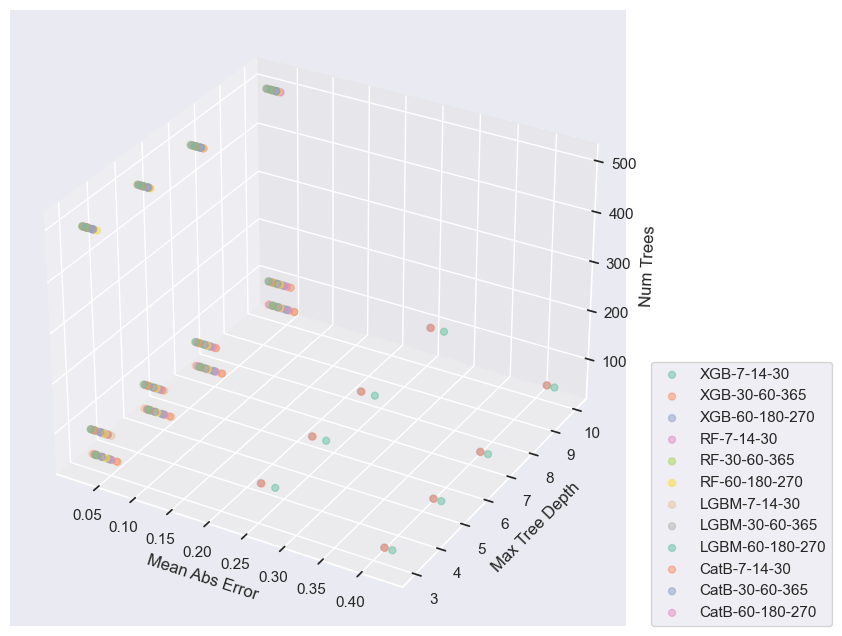

In [673]:
fig = plt.figure(figsize=(8,8))
ax = plt.axes(projection='3d')
# Model type will be the color
rgb_values = sns.color_palette("Set2", 12)
cmapping = dict(zip(modeltags,rgb_values))
# Plot the 3d scatter
for i,m in enumerate(modeltags):
    #load the df
    df = df_results.loc[df_results['model_lags']==m]
    #scatter for each model-lag combo
    scatter = ax.scatter(xs=df['mean_absolute_error'],
               ys=df['max_depth'],
               zs=df['n_estimators'],
               c=df['model_lags'].map(cmapping),
               s=25, label=m,cmap='viridis',alpha=0.5)
ax.set_xlabel('Mean Abs Error')
ax.set_ylabel('Max Tree Depth')
ax.set_zlabel('Num Trees')
ax.legend(ncol=1,loc=(1.04, 0))
plt.savefig(root_results+'\LGBM_XGB_Cat_RF_GridCV.png', format='png', dpi=600,bbox_inches='tight')

### LightGBM Grid Search CV for HyperParameter Tuning

Grid Search: The function validates all combinations of hyperparameters presented in param_grid by backtesting.

 Gradient Boosting method to train ensembles of decision trees.

https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMModel.html

In [617]:
LGBM_Forecaster = ForecasterAutoreg(
                regressor = LGBMRegressor(random_state=123, n_jobs=-1), #multi-threatding
                lags = 24) #lags here is a dummy - will be replaced by lags grid

In [618]:
LGBM_param_grid = {
    'n_estimators': [75,100,125], #keep n_estimators down from 500 to avoid overfitting - number of boosted trees
    'max_depth': [6,7,8], #check if 6 or 8 is better
    'learning_rate': [0.075,0.09, 0.1], #check lower learning rates - default = 0.1
    'num_leaves': [10,15,30]
    }

In [619]:
# Lags grid = similar lags used in ACF/PACF study
LGBM_lags_grid = [[7,14,30],] #best lags chosen from multi-model grid CV - also test a set with a full range of lags

In [620]:
# Grid Search (cross-validation by dfault)
LGBM_results_grid = grid_search_forecaster(
        forecaster         = LGBM_Forecaster,
        y                  = train['close+7d'].resample('1D').ffill(), # resample as daily, avoid silly error for apparently missing vals
        exog               = train[exog].resample('1D').ffill(), 
        param_grid         = LGBM_param_grid,
        lags_grid          = LGBM_lags_grid, 
        steps              = test.shape[0], #number of forward steps to forecast
        refit              = True, #refit the model on each step of backtesting
        metric             = metrics,
        initial_train_size = int(train.shape[0]/4), # number of samples in initial train split > window_size
        fixed_train_size   = False, #Use a sliding window and refit each backtesting step
        return_best        = True,
        verbose            = True
        )

Number of models compared: 81.


loop param_grid:   0%|                                             | 0/81 [00:00<?, ?it/s]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   1%|▍                                    | 1/81 [00:03<04:50,  3.64s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   2%|▉                                    | 2/81 [00:07<04:59,  3.79s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   4%|█▎                                   | 3/81 [00:12<05:45,  4.43s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   5%|█▊                                   | 4/81 [00:16<05:28,  4.26s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   6%|██▎                                  | 5/81 [00:20<05:19,  4.21s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   7%|██▋                                  | 6/81 [00:25<05:30,  4.40s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:   9%|███▏                                 | 7/81 [00:30<05:27,  4.43s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  10%|███▋                                 | 8/81 [00:34<05:25,  4.46s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  11%|████                                 | 9/81 [00:40<05:58,  4.98s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  12%|████▍                               | 10/81 [00:45<05:44,  4.85s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  14%|████▉                               | 11/81 [00:50<05:35,  4.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  15%|█████▎                              | 12/81 [00:55<05:36,  4.87s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  16%|█████▊                              | 13/81 [01:00<05:37,  4.96s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  17%|██████▏                             | 14/81 [01:05<05:41,  5.10s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  19%|██████▋                             | 15/81 [01:11<05:42,  5.19s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  20%|███████                             | 16/81 [01:15<05:27,  5.03s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  21%|███████▌                            | 17/81 [01:21<05:42,  5.36s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  22%|████████                            | 18/81 [01:27<05:41,  5.43s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  23%|████████▍                           | 19/81 [01:31<05:02,  4.88s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  25%|████████▉                           | 20/81 [01:35<04:47,  4.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  26%|█████████▎                          | 21/81 [01:40<04:44,  4.75s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  27%|█████████▊                          | 22/81 [01:44<04:25,  4.51s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  28%|██████████▏                         | 23/81 [01:48<04:23,  4.54s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  30%|██████████▋                         | 24/81 [01:54<04:35,  4.83s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  31%|███████████                         | 25/81 [01:58<04:20,  4.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  32%|███████████▌                        | 26/81 [02:03<04:30,  4.91s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  33%|████████████                        | 27/81 [02:10<04:51,  5.41s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  35%|████████████▍                       | 28/81 [02:14<04:22,  4.96s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  36%|████████████▉                       | 29/81 [02:18<04:04,  4.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  37%|█████████████▎                      | 30/81 [02:23<04:06,  4.83s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  38%|█████████████▊                      | 31/81 [02:27<03:48,  4.58s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  40%|██████████████▏                     | 32/81 [02:32<03:41,  4.52s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  41%|██████████████▋                     | 33/81 [02:37<03:45,  4.71s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  42%|███████████████                     | 34/81 [02:41<03:38,  4.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  43%|███████████████▌                    | 35/81 [02:46<03:34,  4.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  44%|████████████████                    | 36/81 [02:51<03:38,  4.86s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  46%|████████████████▍                   | 37/81 [02:55<03:18,  4.51s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  47%|████████████████▉                   | 38/81 [02:59<03:05,  4.30s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  48%|█████████████████▎                  | 39/81 [03:03<03:05,  4.41s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  49%|█████████████████▊                  | 40/81 [03:07<02:55,  4.28s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  51%|██████████████████▏                 | 41/81 [03:12<02:54,  4.36s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  52%|██████████████████▋                 | 42/81 [03:17<03:02,  4.69s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  53%|███████████████████                 | 43/81 [03:22<02:53,  4.58s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  54%|███████████████████▌                | 44/81 [03:27<02:58,  4.83s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  56%|████████████████████                | 45/81 [03:33<03:03,  5.11s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  57%|████████████████████▍               | 46/81 [03:37<02:43,  4.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  58%|████████████████████▉               | 47/81 [03:41<02:34,  4.53s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  59%|█████████████████████▎              | 48/81 [03:46<02:34,  4.67s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  60%|█████████████████████▊              | 49/81 [03:50<02:22,  4.47s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  62%|██████████████████████▏             | 50/81 [03:54<02:18,  4.48s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  63%|██████████████████████▋             | 51/81 [04:00<02:28,  4.97s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  64%|███████████████████████             | 52/81 [04:05<02:18,  4.76s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  65%|███████████████████████▌            | 53/81 [04:09<02:13,  4.76s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  67%|████████████████████████            | 54/81 [04:16<02:23,  5.31s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  68%|████████████████████████▍           | 55/81 [04:20<02:04,  4.80s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  69%|████████████████████████▉           | 56/81 [04:24<01:53,  4.55s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  70%|█████████████████████████▎          | 57/81 [04:28<01:50,  4.61s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  72%|█████████████████████████▊          | 58/81 [04:33<01:44,  4.56s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  73%|██████████████████████████▏         | 59/81 [04:37<01:39,  4.55s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  74%|██████████████████████████▋         | 60/81 [04:42<01:38,  4.70s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  75%|███████████████████████████         | 61/81 [04:47<01:32,  4.64s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  77%|███████████████████████████▌        | 62/81 [04:52<01:28,  4.66s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  78%|████████████████████████████        | 63/81 [04:57<01:28,  4.91s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  79%|████████████████████████████▍       | 64/81 [05:01<01:18,  4.59s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  80%|████████████████████████████▉       | 65/81 [05:05<01:11,  4.50s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  81%|█████████████████████████████▎      | 66/81 [05:10<01:07,  4.52s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  83%|█████████████████████████████▊      | 67/81 [05:14<01:00,  4.34s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  84%|██████████████████████████████▏     | 68/81 [05:19<00:58,  4.52s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  85%|██████████████████████████████▋     | 69/81 [05:24<00:56,  4.74s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  86%|███████████████████████████████     | 70/81 [05:28<00:50,  4.59s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  88%|███████████████████████████████▌    | 71/81 [05:33<00:48,  4.81s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  89%|████████████████████████████████    | 72/81 [05:40<00:47,  5.22s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  90%|████████████████████████████████▍   | 73/81 [05:43<00:38,  4.75s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  91%|████████████████████████████████▉   | 74/81 [05:47<00:31,  4.50s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  93%|█████████████████████████████████▎  | 75/81 [05:52<00:27,  4.61s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  94%|█████████████████████████████████▊  | 76/81 [05:56<00:21,  4.35s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  95%|██████████████████████████████████▏ | 77/81 [06:00<00:17,  4.32s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  96%|██████████████████████████████████▋ | 78/81 [06:06<00:14,  4.74s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  98%|███████████████████████████████████ | 79/81 [06:10<00:09,  4.62s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop param_grid:  99%|███████████████████████████████████▌| 80/81 [06:15<00:04,  4.65s/it]

Information of backtesting process
----------------------------------
Number of observations used for initial training: 760
Number of observations used for backtesting: 3466
    Number of folds: 26
    Number of steps per fold: 135
    Last fold only includes 91 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-11-01 00:00:00  (n=760)
    Validation: 2012-11-02 00:00:00 -- 2013-03-16 00:00:00  (n=135)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2013-03-16 00:00:00  (n=895)
    Validation: 2013-03-17 00:00:00 -- 2013-07-29 00:00:00  (n=135)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2013-07-29 00:00:00  (n=1030)
    Validation: 2013-07-30 00:00:00 -- 2013-12-11 00:00:00  (n=135)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2013-12-11 00:00:00  (n=1165)
    Validation: 2013-12-12 00:00:00 -- 2014-04-25 00:00:00  (n=135)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2014-04


loop lags_grid: 100%|██████████████████████████████████████| 1/1 [06:21<00:00, 381.70s/it]


`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 7 14 30] 
  Parameters: {'learning_rate': 0.075, 'max_depth': 6, 'n_estimators': 100, 'num_leaves': 15}
  Backtesting metric: 0.0012848436340700262



In [621]:
LGBM_results_grid.sort_values(by='mean_absolute_error').head(1)

,lags,params,mean_squared_error,mean_absolute_error,r2_score,learning_rate,max_depth,n_estimators,num_leaves
28,"[7, 14, 30]","{'learning_rate': 0.09, 'max_depth': 6, 'n_est...",0.001298,0.026266,0.842057,0.09,6.0,75.0,15.0


In [626]:
LGBM_results_grid.sort_values(by='r2_score',ascending=False).head(1)

,lags,params,mean_squared_error,mean_absolute_error,r2_score,learning_rate,max_depth,n_estimators,num_leaves
4,"[7, 14, 30]","{'learning_rate': 0.075, 'max_depth': 6, 'n_es...",0.001285,0.026486,0.843661,0.075,6.0,100.0,15.0


In [623]:
LGBM_results_grid.sort_values(by='mean_squared_error').head(1)

,lags,params,mean_squared_error,mean_absolute_error,r2_score,learning_rate,max_depth,n_estimators,num_leaves
4,"[7, 14, 30]","{'learning_rate': 0.075, 'max_depth': 6, 'n_es...",0.001285,0.026486,0.843661,0.075,6.0,100.0,15.0


Visualize the grid search

In [660]:
smapping.items()

dict_items([(10, 10), (15, 65), (30, 125)])

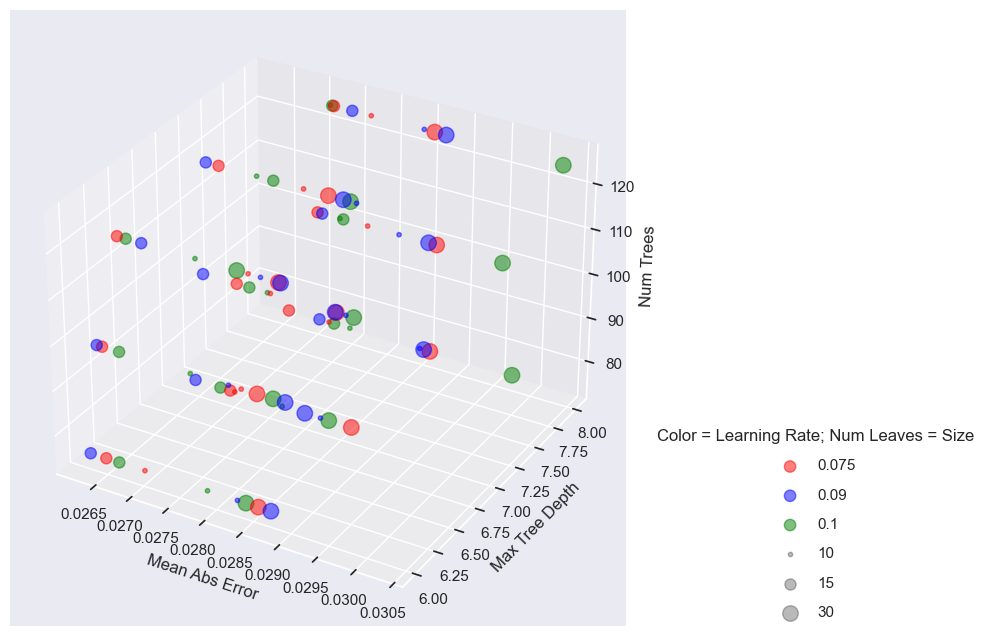

In [664]:
fig = plt.figure(figsize=(8,8))
ax = plt.axes(projection='3d')
lrate = [0.075,0.09,0.1]
# Group by learning rate = colormap
cmapping = {0.075:'red',0.09:'blue',0.1:'green'} #learning rate as colors
smapping = {10:10,15:65,30:125}
# Model type will be the color
# Plot the 3d scatter
for i,m in enumerate(lrate):
    df = LGBM_results_grid.loc[LGBM_results_grid['learning_rate']==m]
    scatter = ax.scatter(xs=df['mean_absolute_error'],
                         ys=df['max_depth'],
                         zs=df['n_estimators'],
                         s=df['num_leaves'].map(smapping),
                         c=df['learning_rate'].map(cmapping),
                         label=m,cmap='viridis',alpha=0.5)
ax.set_xlabel('Mean Abs Error')
ax.set_ylabel('Max Tree Depth')
ax.set_zlabel('Num Trees')
ax.legend(ncol=1,loc=(1.04, 0))
# Plot articial to add a second legend with the scatter size
for nleaves in smapping:
    plt.scatter([], [], c='k', alpha=0.3, s=smapping[nleaves],
                label=str(nleaves))
plt.legend(scatterpoints=1, frameon=False, labelspacing=1, title='Color = Learning Rate; Num Leaves = Size',loc=(1.04, 0))

Best model in terms of MAE appears to be, learning rate = 0.075; max_depth = 6; n_estimators = 75, num_leaves=15

In [627]:
# Save the model metrics
fid=r'\BestLGBM_grid.pkl'
LGBM_results_grid.to_pickle(root_results+fid)

In [629]:
#Predict 200 days after training period with confidence interval
pred_forecast_int = LGBM_Forecaster.predict_interval(steps=200,exog=train[exog].resample('1D').ffill(),interval=[5, 95], n_boot=500, random_state=123, in_sample_residuals=True)

In [630]:
df_LGBM_pred = full #save the existing full set with the forward predictions
df_LGBM_pred[['close+7d_fcast','close+7d_fcast_L','close+7d_fcast_U']] = pred_forecast_int   #store the future predictions

In [674]:
# Forecast Evaluation
print('MSE: ',round(MSE(df_LGBM_pred.loc[df_LGBM_pred.index>=split1]['close+7d'],df_LGBM_pred.loc[df_LGBM_pred.index>=split1]['close+7d_fcast']),3),
      'MAE: ',round(MAE(df_LGBM_pred.loc[df_LGBM_pred.index>=split1]['close+7d'],df_LGBM_pred.loc[df_LGBM_pred.index>=split1]['close+7d_fcast']),3),
      'R2: ',round(r2_score(df_LGBM_pred.loc[df_LGBM_pred.index>=split1]['close+7d'],df_LGBM_pred.loc[df_LGBM_pred.index>=split1]['close+7d_fcast']),3),
     )

MSE:  0.003 MAE:  0.046 R2:  -2.172


MAE is bad considering the scale of the exchange rate; R2 is negative meaning no meaningful fit was found.

In [632]:
# Backtest the data
backtest, pred_backtest = backtesting_forecaster(
                            forecaster         = LGBM_Forecaster,
                            y                  = train['close+7d'].resample('1D').ffill(), #train on the close val 7d ahead
                            exog               = train[exog].resample('1D').ffill(), 
                            initial_train_size = int(train.shape[0]/6), #smaller training window to check for overfitting
                            fixed_train_size   = False, #expanding window test 
                            steps              = int(0.25*365), #increase the window in steps of 3 months
                            interval           = [5,95], #include confidence interval in prediction
                            refit              = True, #refit the model on each step of backtesting;  if true training set increases to length initial_train_size + steps
                            metric             = metrics, #MAE, MSE, R2
                            verbose            = True, #print status
                            n_boot             = 1000 #increased no of bootstraps for prediction intervals
            )

Information of backtesting process
----------------------------------
Number of observations used for initial training: 507
Number of observations used for backtesting: 3719
    Number of folds: 41
    Number of steps per fold: 91
    Last fold only includes 79 observations.

Data partition in fold: 0
    Training:   2010-10-04 00:00:00 -- 2012-02-22 00:00:00  (n=507)
    Validation: 2012-02-23 00:00:00 -- 2012-05-23 00:00:00  (n=91)
Data partition in fold: 1
    Training:   2010-10-04 00:00:00 -- 2012-05-23 00:00:00  (n=598)
    Validation: 2012-05-24 00:00:00 -- 2012-08-22 00:00:00  (n=91)
Data partition in fold: 2
    Training:   2010-10-04 00:00:00 -- 2012-08-22 00:00:00  (n=689)
    Validation: 2012-08-23 00:00:00 -- 2012-11-21 00:00:00  (n=91)
Data partition in fold: 3
    Training:   2010-10-04 00:00:00 -- 2012-11-21 00:00:00  (n=780)
    Validation: 2012-11-22 00:00:00 -- 2013-02-20 00:00:00  (n=91)
Data partition in fold: 4
    Training:   2010-10-04 00:00:00 -- 2013-02-20 00:

In [633]:
# Backtest Evaluation
print('MSE: ',backtest[0],'; MAE: ',backtest[1],'; R2: ',backtest[2])

MSE:  0.0010766478961710196 ; MAE:  0.02471882113986151 ; R2:  0.8708338077548767


In [634]:
df_LGBM_pred[['close+7d_btest','close+7d_btest_L','close+7d_btest_U']] = pred_backtest   #store the backtest predictions

In [635]:
# Save the model forecast and original data
fid=r'\BestLGBM_predictions.pkl'
df_LGBM_pred.to_pickle(root_results+fid)

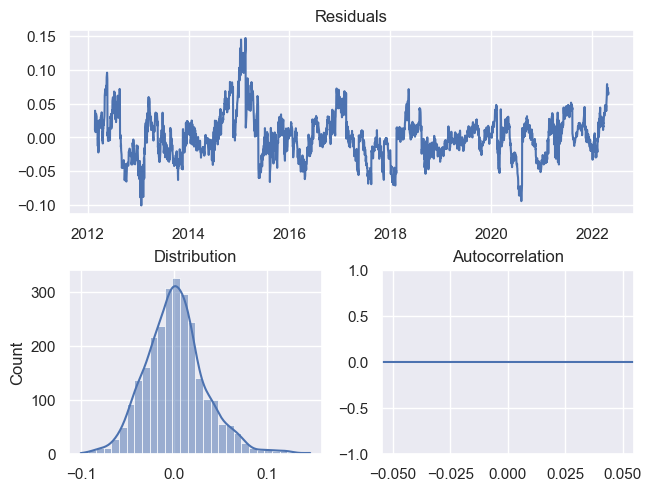

In [672]:
# plot backtesting residuals
residuals = df_LGBM_pred['close+7d_btest'] - train['close+7d']
plot_residuals(residuals=residuals)
plt.savefig(root_results+'\LGBM_Prediction_Backtest_Residuals.png', format='png', dpi=600,bbox_inches='tight')

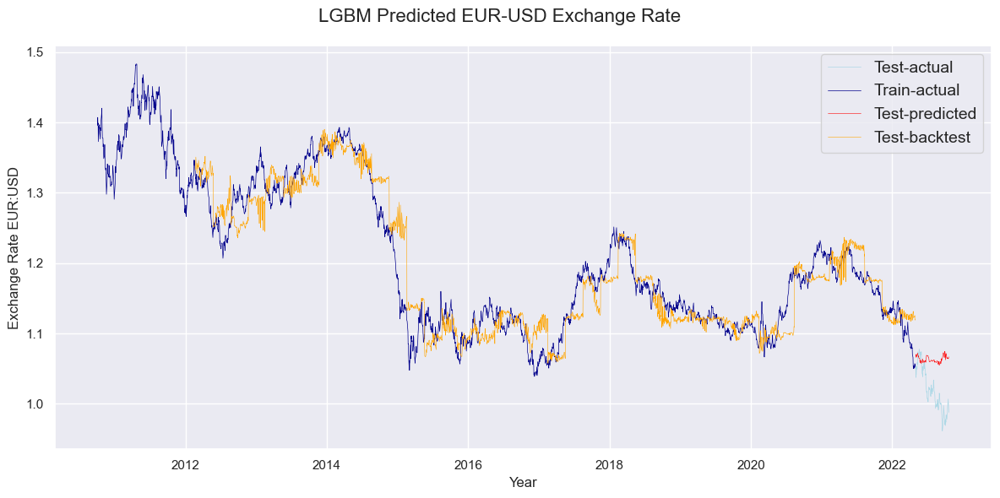

In [670]:
# Plot the full range of pred
fig, ax = plt.subplots(figsize = (12,6))
# Predicted/Actual Series
plt.plot(test['close+7d'],label='Test-actual',color='lightblue',linewidth=0.5)
plt.plot(train['close+7d'],label='Train-actual',color='darkblue',linewidth=0.5)
plt.plot(df_LGBM_pred['close+7d_fcast'],label='Test-predicted',color='red',linewidth=0.4)
plt.plot(df_LGBM_pred['close+7d_btest'],label='Test-backtest',color='orange',linewidth=0.4)
# Main Properties
fig.suptitle('LGBM Predicted EUR-USD Exchange Rate',fontsize=16) #main title slight elevated above subplots
ax.set_xlabel('Year',fontsize=12)
ax.set_ylabel('Exchange Rate EUR:USD',fontsize=12)
fig.tight_layout()
ax.legend(fontsize=14)
plt.savefig(root_results+'\LGBM_Prediction_Full.png', format='png', dpi=600,bbox_inches='tight')

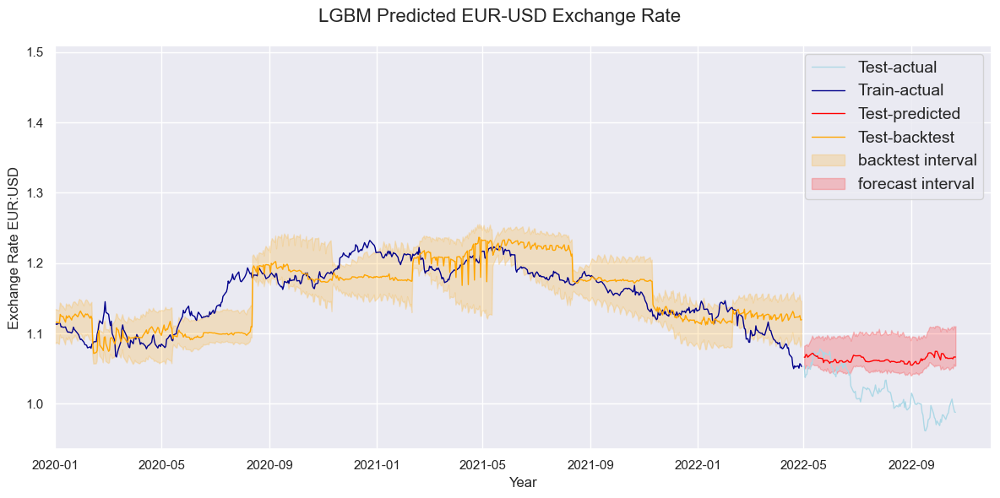

In [671]:
# Plot 2020+ Only
fig, ax = plt.subplots(figsize = (12,6))
# Predicted/Actual Series
plt.plot(test['close+7d'],label='Test-actual',color='lightblue',linewidth=1) #test
plt.plot(train['close+7d'],label='Train-actual',color='darkblue',linewidth=1) #train
plt.plot(df_LGBM_pred['close+7d_fcast'],label='Test-predicted',color='red',linewidth=1) #forecast
plt.plot(df_LGBM_pred['close+7d_btest'],label='Test-backtest',color='orange',linewidth=1) #backtest
# Confidence interval
ax.fill_between(x=df_LGBM_pred['close+7d_btest_L'].index,y1=df_LGBM_pred['close+7d_btest_L'],y2=df_LGBM_pred['close+7d_btest_U'],
                color = 'orange', alpha = 0.2, label = 'backtest interval')
ax.fill_between(x=df_LGBM_pred['close+7d_fcast_L'].index,y1=df_LGBM_pred['close+7d_fcast_L'],y2=df_LGBM_pred['close+7d_fcast_U'],
                color = 'red', alpha = 0.2, label = 'forecast interval')
# Main properties
fig.suptitle('LGBM Predicted EUR-USD Exchange Rate',fontsize=16) #main title slight elevated above subplots
plt.xlim([datetime.datetime.strptime('2020-01-01',"%Y-%m-%d"),datetime.datetime.strptime('2022-12-01',"%Y-%m-%d")]) #x-range
ax.set_xlabel('Year',fontsize=12) #x label
ax.set_ylabel('Exchange Rate EUR:USD',fontsize=12) #ylabel
fig.tight_layout()
ax.legend(fontsize=14) #show legend
plt.savefig(root_results+'\LGBM_Prediction_2020.png', format='png', dpi=600,bbox_inches='tight')

Note that the package has a bug and is giving an incorrect forecast interval

By default the model sorts importance by 'split' = # times the feaure is used in the model. It can be seen that no matter what input parameters we give the model, the lags still have be the most important feature vs. the tecnical parameters. 

In [638]:
importance_final = LGBM_Forecaster.get_feature_importance()
importance

,feature,importance
0,lag_1,0.863143
1,lag_2,0.064498
2,lag_3,0.022142
3,rsi,0.007377
4,adx,0.002103
5,dmi,0.005889
6,macd_norm,0.003751
7,bbands_norm,0.004386
8,sar_norm,0.003056
9,ma_position,0.000082


Since the models weight lags as more important than the technical indicators, it may be best to use an LSTM instead since the the timehistory is essentially just being curve-fitted instead of deriving more meaningful insight from the exogenous variables.